# 你的第一个神经网络

在此项目中，你将构建你的第一个神经网络，并用该网络预测每日自行车租客人数。我们提供了一些代码，但是需要你来实现神经网络（大部分内容）。提交此项目后，欢迎进一步探索该数据和模型。

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## 加载和准备数据

构建神经网络的关键一步是正确地准备数据。不同尺度级别的变量使网络难以高效地掌握正确的权重。我们在下方已经提供了加载和准备数据的代码。你很快将进一步学习这些代码！

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## 数据简介

此数据集包含的是从 2011 年 1 月 1 日到 2012 年 12 月 31 日期间每天每小时的骑车人数。骑车用户分成临时用户和注册用户，cnt 列是骑车用户数汇总列。你可以在上方看到前几行数据。

下图展示的是数据集中前 10 天左右的骑车人数（某些天不一定是 24 个条目，所以不是精确的 10 天）。你可以在这里看到每小时租金。这些数据很复杂！周末的骑行人数少些，工作日上下班期间是骑行高峰期。我们还可以从上方的数据中看到温度、湿度和风速信息，所有这些信息都会影响骑行人数。你需要用你的模型展示所有这些数据。

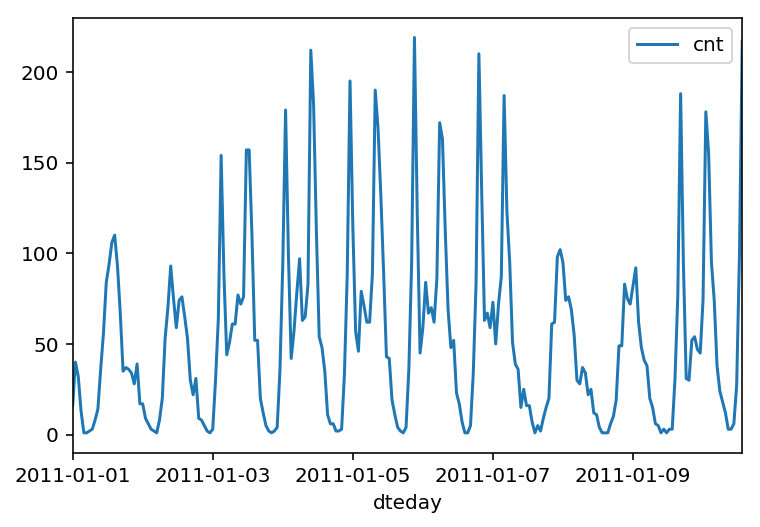

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### 虚拟变量（哑变量）

下面是一些分类变量，例如季节、天气、月份。要在我们的模型中包含这些数据，我们需要创建二进制虚拟变量。用 Pandas 库中的 `get_dummies()` 就可以轻松实现。

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### 调整目标变量

为了更轻松地训练网络，我们将对每个连续变量标准化，即转换和调整变量，使它们的均值为 0，标准差为 1。

我们会保存换算因子，以便当我们使用网络进行预测时可以还原数据。

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### 将数据拆分为训练、测试和验证数据集

我们将大约最后 21 天的数据保存为测试数据集，这些数据集会在训练完网络后使用。我们将使用该数据集进行预测，并与实际的骑行人数进行对比。

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

我们将数据拆分为两个数据集，一个用作训练，一个在网络训练完后用来验证网络。因为数据是有时间序列特性的，所以我们用历史数据进行训练，然后尝试预测未来数据（验证数据集）。

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## 开始构建网络

下面你将构建自己的网络。我们已经构建好结构和反向传递部分。你将实现网络的前向传递部分。还需要设置超参数：学习速率、隐藏单元的数量，以及训练传递数量。

<img src="assets/neural_network.png" width=300px>

该网络有两个层级，一个隐藏层和一个输出层。隐藏层级将使用 S 型函数作为激活函数。输出层只有一个节点，用于递归，节点的输出和节点的输入相同。即激活函数是 $f(x)=x$。这种函数获得输入信号，并生成输出信号，但是会考虑阈值，称为激活函数。我们完成网络的每个层级，并计算每个神经元的输出。一个层级的所有输出变成下一层级神经元的输入。这一流程叫做前向传播（forward propagation）。

我们在神经网络中使用权重将信号从输入层传播到输出层。我们还使用权重将错误从输出层传播回网络，以便更新权重。这叫做反向传播（backpropagation）。

> **提示**：你需要为反向传播实现计算输出激活函数 ($f(x) = x$) 的导数。如果你不熟悉微积分，其实该函数就等同于等式 $y = x$。该等式的斜率是多少？也就是导数 $f(x)$。


你需要完成以下任务：

1. 实现 S 型激活函数。将 `__init__` 中的 `self.activation_function`  设为你的 S 型函数。
2. 在 `train` 方法中实现前向传递。
3. 在 `train` 方法中实现反向传播算法，包括计算输出错误。
4. 在 `run` 方法中实现前向传递。

  

In [9]:
class NeuralNetwork(object):
    def __init__(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Initialize weights
        self.weights_input_to_hidden = np.random.normal(0.0, self.input_nodes**-0.5, 
                                       (self.input_nodes, self.hidden_nodes))

        self.weights_hidden_to_output = np.random.normal(0.0, self.hidden_nodes**-0.5, 
                                       (self.hidden_nodes, self.output_nodes))
        self.lr = learning_rate
        
        #### TODO: Set self.activation_function to your implemented sigmoid function ####
        #
        # Note: in Python, you can define a function with a lambda expression,
        # as shown below.
        self.activation_function = lambda x : (1 / (1 + np.exp(-x)))# Replace 0 with your sigmoid calculation.
        
        ### If the lambda code above is not something you're familiar with,
        # You can uncomment out the following three lines and put your 
        # implementation there instead.
        #
        #def sigmoid(x):
        #    return 0  # Replace 0 with your sigmoid calculation here
        #self.activation_function = sigmoid
                    
    
    def train(self, features, targets):
        ''' Train the network on batch of features and targets. 
        
            Arguments
            ---------
            
            features: 2D array, each row is one data record, each column is a feature
            targets: 1D array of target values
        
        '''
        n_records = features.shape[0]
        delta_weights_i_h = np.zeros(self.weights_input_to_hidden.shape)
        delta_weights_h_o = np.zeros(self.weights_hidden_to_output.shape)
        for X, y in zip(features, targets):
            #### Implement the forward pass here ####
            ### Forward pass ###
            # TODO: Hidden layer - Replace these values with your calculations.
            hidden_inputs = np.dot(X, self.weights_input_to_hidden) # signals into hidden layer
            hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer

            # TODO: Output layer - Replace these values with your calculations.
            final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
            final_outputs = final_inputs # signals from final output layer
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # TODO: Output error - Replace this value with your calculations.
            error = y - final_outputs # Output layer error is the difference between desired target and actual output.
            output_error_term = error * 1
            
            # TODO: Calculate the hidden layer's contribution to the error
            hidden_error = np.dot(self.weights_hidden_to_output,output_error_term)
            
            # TODO: Backpropagated error terms - Replace these values with your calculations.

            hidden_error_term = hidden_error * hidden_outputs * (1 - hidden_outputs)

            # Weight step (input to hidden)
            delta_weights_i_h += hidden_error_term * X[:,None]
            
            # Weight step (hidden to output)
            delta_weights_h_o += output_error_term * hidden_outputs[:,None]


        # TODO: Update the weights - Replace these values with your calculations.
        self.weights_hidden_to_output += self.lr * delta_weights_h_o / n_records # update hidden-to-output weights with gradient descent step
        self.weights_input_to_hidden += self.lr * delta_weights_i_h / n_records # update input-to-hidden weights with gradient descent step
        print(self.weights_hidden_to_output)
        print(self.weights_input_to_hidden)
        
    def run(self, features):
        ''' Run a forward pass through the network with input features 
        
            Arguments
            ---------
            features: 1D array of feature values
        '''
        
        #### Implement the forward pass here ####
        # TODO: Hidden layer - replace these values with the appropriate calculations.
        hidden_inputs = np.dot(features, self.weights_input_to_hidden) # signals into hidden layer
        hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
        
        # TODO: Output layer - Replace these values with the appropriate calculations.
        final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
        final_outputs = final_inputs # signals from final output layer 
        
        return final_outputs

In [10]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## 单元测试

运行这些单元测试，检查你的网络实现是否正确。这样可以帮助你确保网络已正确实现，然后再开始训练网络。这些测试必须成功才能通过此项目。

In [11]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

[[ 0.37275328]
 [-0.03172939]]
[[ 0.10562014 -0.20185996]
 [ 0.39775194  0.50074398]
 [-0.29887597  0.19962801]]



----------------------------------------------------------------------
Ran 5 tests in 0.015s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## 训练网络

现在你将设置网络的超参数。策略是设置的超参数使训练集上的错误很小但是数据不会过拟合。如果网络训练时间太长，或者有太多的隐藏节点，可能就会过于针对特定训练集，无法泛化到验证数据集。即当训练集的损失降低时，验证集的损失将开始增大。

你还将采用随机梯度下降 (SGD) 方法训练网络。对于每次训练，都获取随机样本数据，而不是整个数据集。与普通梯度下降相比，训练次数要更多，但是每次时间更短。这样的话，网络训练效率更高。稍后你将详细了解 SGD。


### 选择迭代次数

也就是训练网络时从训练数据中抽样的批次数量。迭代次数越多，模型就与数据越拟合。但是，如果迭代次数太多，模型就无法很好地泛化到其他数据，这叫做过拟合。你需要选择一个使训练损失很低并且验证损失保持中等水平的数字。当你开始过拟合时，你会发现训练损失继续下降，但是验证损失开始上升。

### 选择学习速率

速率可以调整权重更新幅度。如果速率太大，权重就会太大，导致网络无法与数据相拟合。建议从 0.1 开始。如果网络在与数据拟合时遇到问题，尝试降低学习速率。注意，学习速率越低，权重更新的步长就越小，神经网络收敛的时间就越长。


### 选择隐藏节点数量

隐藏节点越多，模型的预测结果就越准确。尝试不同的隐藏节点的数量，看看对性能有何影响。你可以查看损失字典，寻找网络性能指标。如果隐藏单元的数量太少，那么模型就没有足够的空间进行学习，如果太多，则学习方向就有太多的选择。选择隐藏单元数量的技巧在于找到合适的平衡点。

In [12]:
import sys

### Set the hyperparameters here ###
iterations = 2000
learning_rate = 1
hidden_nodes = 13
output_nodes = 1

N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

[[-0.05340558]
 [ 0.26783059]
 [ 0.03659786]
 [ 0.11912477]
 [ 0.21656318]
 [ 0.09631914]
 [-0.2985582 ]
 [-0.25174363]
 [-0.51080713]
 [-0.22831939]
 [ 0.42592497]
 [ 0.52508622]
 [-0.40300817]]
[[  1.50644739e-01  -1.41521371e-01   1.16335300e-01  -5.71106777e-02
    6.78641793e-02   3.59186404e-02  -3.32229612e-03  -1.48127409e-01
   -1.02690206e-01  -3.78004234e-02  -3.33356544e-02   2.89058990e-03
   -1.98273617e-01]
 [  3.75199923e-02  -9.48209230e-02   9.57033133e-02   2.24403818e-02
    4.80592474e-04   9.75293840e-02  -1.03809863e-01   2.40768767e-01
   -1.05322742e-01  -1.46756475e-01   1.43893903e-02   6.73817164e-02
    9.20369034e-02]
 [ -6.16137347e-02   8.33224954e-02   5.95904445e-02   1.36453803e-01
    1.18394616e-01  -5.21184657e-02   5.63040953e-02  -1.67272729e-01
    2.28077209e-01  -1.32612691e-01  -2.83021157e-03   1.36793484e-01
    1.21056233e-02]
 [  3.02816544e-01  -9.72903025e-02  -1.93475408e-01   1.13784495e-01
   -2.01807926e-01   1.11353890e-01   1.2212

C:\Users\KevinRuan\AppData\Local\conda\conda\envs\flappybird\lib\site-packages\ipykernel_launcher.py:16: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  app.launch_new_instance()


[[-0.00844111]
 [ 0.34005311]
 [ 0.10355137]
 [ 0.18620804]
 [ 0.29286686]
 [ 0.13392052]
 [-0.24636482]
 [-0.2313716 ]
 [-0.43819796]
 [-0.18660993]
 [ 0.48502041]
 [ 0.58924178]
 [-0.37315003]]
[[  1.48849379e-01  -1.32673036e-01   1.17516550e-01  -5.30578550e-02
    7.50246653e-02   3.91623730e-02  -1.31320235e-02  -1.55619516e-01
   -1.20599832e-01  -4.58128294e-02  -1.85496480e-02   2.01130766e-02
   -2.11386302e-01]
 [  3.76642223e-02  -9.55340000e-02   9.56021916e-02   2.21108792e-02
   -1.03251344e-04   9.72659402e-02  -1.02972131e-01   2.41458918e-01
   -1.03939450e-01  -1.46126600e-01   1.32218013e-02   6.58983950e-02
    9.31520900e-02]
 [ -6.69426175e-02   1.09340169e-01   6.31474387e-02   1.47833191e-01
    1.39625296e-01  -4.23909291e-02   2.63435785e-02  -1.90789318e-01
    1.77415463e-01  -1.55323675e-01   4.02241550e-02   1.88627397e-01
   -2.79678716e-02]
 [  3.05507575e-01  -1.10473048e-01  -1.95218848e-01   1.07560517e-01
   -2.12245269e-01   1.06464824e-01   1.3716

Progress: 0.1% ... Training loss: 0.974 ... Validation loss: 1.212[[-0.13228775]
 [ 0.2617331 ]
 [ 0.02396323]
 [ 0.1076275 ]
 [ 0.23644695]
 [ 0.01501781]
 [-0.35820092]
 [-0.33664598]
 [-0.53701153]
 [-0.31795357]
 [ 0.40253107]
 [ 0.54984163]
 [-0.47615919]]
[[  1.48793510e-01  -1.30590028e-01   1.17932977e-01  -5.19925599e-02
    7.66721099e-02   3.98347520e-02  -1.45305073e-02  -1.56274712e-01
   -1.23194000e-01  -4.66853598e-02  -1.57343487e-02   2.23316005e-02
   -2.13382240e-01]
 [  3.77073077e-02  -9.73902328e-02   9.51430443e-02   2.12196640e-02
   -1.63349761e-03   9.65626216e-02  -1.01724761e-01   2.42597108e-01
   -1.01881545e-01  -1.45122052e-01   1.06826723e-02   6.27697648e-02
    9.51946637e-02]
 [ -6.78200650e-02   1.44051295e-01   7.36065354e-02   1.65176003e-01
    1.68688688e-01  -2.83635988e-02   7.44415758e-04  -2.13975990e-01
    1.32834000e-01  -1.73905605e-01   9.03147984e-02   2.46399119e-01
   -6.63983525e-02]
 [  3.06434938e-01  -1.48191896e-01  -2.06379884

Progress: 0.1% ... Training loss: 0.868 ... Validation loss: 1.622[[-0.00998658]
 [ 0.41053476]
 [ 0.1871667 ]
 [ 0.2388661 ]
 [ 0.40316003]
 [ 0.13010463]
 [-0.24068092]
 [-0.2711726 ]
 [-0.41419823]
 [-0.20509126]
 [ 0.54725446]
 [ 0.71154259]
 [-0.38133876]]
[[  1.39452522e-01  -1.12383594e-01   1.19546214e-01  -4.44912358e-02
    9.28818233e-02   4.09101046e-02  -3.95686814e-02  -1.76843458e-01
   -1.60513355e-01  -6.93679413e-02   1.25736218e-02   5.99499240e-02
   -2.46446302e-01]
 [  3.75545841e-02  -9.71289851e-02   9.51703443e-02   2.13613056e-02
   -1.37328654e-03   9.65787838e-02  -1.02168844e-01   2.42233722e-01
   -1.02572689e-01  -1.45492917e-01   1.11504509e-02   6.34038288e-02
    9.46900071e-02]
 [ -7.97452175e-02   1.66731300e-01   7.56693383e-02   1.74568392e-01
    1.88833954e-01  -2.69908245e-02  -3.09529008e-02  -2.41851377e-01
    8.48628232e-02  -2.02438904e-01   1.26021608e-01   2.92596339e-01
   -1.08243718e-01]
 [  3.15966197e-01  -1.66337551e-01  -2.07951799

Progress: 0.1% ... Training loss: 1.125 ... Validation loss: 1.134[[-0.23921749]
 [ 0.20771167]
 [-0.02148662]
 [ 0.05164946]
 [ 0.21222137]
 [-0.07934915]
 [-0.45794696]
 [-0.44789453]
 [-0.63917462]
 [-0.43372329]
 [ 0.3476367 ]
 [ 0.52754668]
 [-0.59273272]]
[[  1.39630062e-01  -1.19632614e-01   1.16002571e-01  -4.83880276e-02
    8.52777167e-02   3.86204661e-02  -3.53872424e-02  -1.71808890e-01
   -1.53344257e-01  -6.58335424e-02   1.93068276e-03   4.58859876e-02
   -2.39298602e-01]
 [  3.76398199e-02  -1.00721260e-01   9.37204124e-02   1.93309465e-02
   -4.68371666e-03   9.54553641e-02  -1.00120440e-01   2.44423520e-01
   -9.93335013e-02  -1.43748314e-01   6.35251878e-03   5.76076119e-02
    9.79269827e-02]
 [ -7.99993336e-02   1.78272586e-01   8.01933447e-02   1.79775543e-01
    1.98709750e-01  -2.34485194e-02  -3.73808932e-02  -2.49411214e-01
    7.50689243e-02  -2.08095302e-01   1.40028321e-01   3.10819572e-01
   -1.18472950e-01]
 [  3.16578740e-01  -1.92302754e-01  -2.19109422

Progress: 0.2% ... Training loss: 1.282 ... Validation loss: 2.488[[ 0.10193376]
 [ 0.55901327]
 [ 0.36813768]
 [ 0.36112124]
 [ 0.57426138]
 [ 0.26606284]
 [-0.11771285]
 [-0.19976994]
 [-0.31591167]
 [-0.09187898]
 [ 0.69531585]
 [ 0.890597  ]
 [-0.30781329]]
[[  1.15482457e-01  -9.88385798e-02   1.13927346e-01  -4.32161116e-02
    1.06176544e-01   3.04713997e-02  -8.16722005e-02  -2.11475494e-01
   -2.16441968e-01  -1.09500759e-01   3.71459251e-02   9.40712728e-02
   -2.96098689e-01]
 [  3.71532594e-02  -1.00291077e-01   9.36772968e-02   1.94212338e-02
   -4.24422155e-03   9.52894511e-02  -1.01050965e-01   2.43480544e-01
   -1.00436377e-01  -1.44657764e-01   7.08400695e-03   5.86563802e-02
    9.67871163e-02]
 [ -9.99044931e-02   1.94871222e-01   7.85385092e-02   1.84304414e-01
    2.15080386e-01  -3.01423238e-02  -7.48260216e-02  -2.78521223e-01
    2.09402401e-02  -2.43719056e-01   1.69043162e-01   3.47599606e-01
   -1.62485824e-01]
 [  3.23946069e-01  -1.98064810e-01  -2.18585634

Progress: 0.2% ... Training loss: 2.803 ... Validation loss: 1.971[[-0.64289813]
 [-0.14910308]
 [-0.42511404]
 [-0.28548232]
 [-0.14628795]
 [-0.46553603]
 [-0.82865507]
 [-0.77422603]
 [-0.99657289]
 [-0.8376514 ]
 [-0.02071116]
 [ 0.15510132]
 [-0.97468581]]
[[ 0.10179044 -0.17402683  0.06462151 -0.09043039  0.03031746 -0.00602893
  -0.06575958 -0.18684014 -0.17445014 -0.09712262 -0.05690177 -0.01867849
  -0.25579096]
 [ 0.03576959 -0.10787967  0.08848594  0.01454906 -0.0115505   0.0915124
  -0.09939851  0.24629491 -0.09601981 -0.14336321 -0.00239022  0.04718943
   0.10105325]
 [-0.10121555  0.18684605  0.07485561  0.17262476  0.20739236 -0.03364579
  -0.07343869 -0.28020886  0.02718985 -0.24297021  0.15902003  0.34580455
  -0.16199442]
 [ 0.31832905 -0.22926588 -0.23986785  0.03864317 -0.32165376  0.07020209
   0.22600456  0.07125695  0.37945979  0.05425231 -0.13740473 -0.39693023
   0.20463704]
 [-0.00178415 -0.00408826 -0.02689439  0.17297989 -0.09791716 -0.02945959
  -0.11400539

   0.0345471 ]]
Progress: 0.3% ... Training loss: 9.571 ... Validation loss: 12.50[[ 0.76552139]
 [ 1.18069821]
 [ 1.09135318]
 [ 0.92922264]
 [ 1.19443739]
 [ 0.88606189]
 [ 0.53270625]
 [ 0.35283221]
 [ 0.42024702]
 [ 0.60327511]
 [ 1.2577308 ]
 [ 1.47910267]
 [ 0.36256454]]
[[ -9.79010415e-02  -2.20285289e-01  -6.67820395e-02  -1.76201398e-01
   -1.51877177e-02  -1.51115309e-01  -3.17373500e-01  -4.03725192e-01
   -4.76729344e-01  -3.56510739e-01  -6.33065945e-02   2.76962220e-02
   -5.46584904e-01]
 [  2.38860778e-02  -1.10511000e-01   8.07492612e-02   9.59728746e-03
   -1.39223749e-02   8.27344641e-02  -1.13934590e-01   2.31594167e-01
   -1.13450695e-01  -1.59240659e-01  -2.76894685e-03   4.98193350e-02
    8.27655519e-02]
 [ -1.93196787e-01   1.63854083e-01   1.39204798e-02   1.23979006e-01
    1.83522025e-01  -9.97897375e-02  -1.84140027e-01  -3.50460449e-01
   -1.18919959e-01  -3.58320427e-01   1.55685461e-01   3.71174317e-01
   -2.77704299e-01]
 [  3.71490670e-01  -2.14805094e

Progress: 0.3% ... Training loss: 18.75 ... Validation loss: 14.60[[-0.79068741]
 [-0.45935055]
 [-0.61756989]
 [-0.41527368]
 [-0.4857592 ]
 [-0.68297851]
 [-0.90530576]
 [-0.83949658]
 [-0.91624181]
 [-0.92835574]
 [-0.38943236]
 [-0.32864082]
 [-0.86700173]]
[[ -3.83600632e-01  -6.82256791e-01  -5.06258333e-01  -5.00253130e-01
   -4.78633162e-01  -4.83503110e-01  -5.00177869e-01  -5.06603630e-01
   -6.04879739e-01  -5.60697764e-01  -5.55184576e-01  -5.46832393e-01
   -6.50442552e-01]
 [  1.06305851e-02  -1.33483700e-01   5.75278966e-02  -7.37226552e-03
   -3.75481067e-02   6.64930557e-02  -1.21901315e-01   2.25847940e-01
   -1.18596978e-01  -1.67604182e-01  -2.84083862e-02   1.89494216e-02
    7.73189887e-02]
 [ -1.31919802e-01   1.51614336e-01   2.91509370e-02   9.42266995e-02
    1.53607826e-01  -4.04310030e-02  -1.29191587e-01  -2.99034268e-01
   -7.93095998e-02  -2.84580780e-01   1.44676570e-01   3.51156695e-01
   -2.21000138e-01]
 [  2.29313560e-01  -2.76823611e-01  -2.59905656

Progress: 0.4% ... Training loss: 3.848 ... Validation loss: 4.517[[-0.41698197]
 [-0.15320601]
 [-0.31183557]
 [-0.09748404]
 [-0.18004596]
 [-0.34337924]
 [-0.53376253]
 [-0.48110921]
 [-0.52163083]
 [-0.53670201]
 [-0.09609159]
 [-0.01947397]
 [-0.46183045]]
[[ -4.63722105e-01  -7.18320106e-01  -5.57146607e-01  -5.36860701e-01
   -5.21202039e-01  -5.44285297e-01  -5.86101070e-01  -5.83265214e-01
   -6.95770281e-01  -6.44478149e-01  -5.85781755e-01  -5.73758671e-01
   -7.30078224e-01]
 [  3.45979268e-03  -1.35932351e-01   5.29940559e-02  -9.94626020e-03
   -4.05015075e-02   6.02933013e-02  -1.30216651e-01   2.17518919e-01
   -1.26415990e-01  -1.74935106e-01  -3.02877056e-02   1.75365229e-02
    6.91900075e-02]
 [ -1.58244665e-01   1.18513719e-01  -7.79880695e-03   6.69326109e-02
    1.13537876e-01  -6.48839853e-02  -1.53728036e-01  -3.08989633e-01
   -1.12614942e-01  -2.91499887e-01   1.17331639e-01   3.16007554e-01
   -2.31267361e-01]
 [  1.78848386e-01  -2.68856930e-01  -2.55406698

Progress: 0.5% ... Training loss: 1.326 ... Validation loss: 2.058[[-0.31645455]
 [-0.05641637]
 [-0.22281872]
 [-0.00337855]
 [-0.08341473]
 [-0.24881345]
 [-0.43750251]
 [-0.38797468]
 [-0.41472024]
 [-0.43855219]
 [-0.00338006]
 [ 0.0868649 ]
 [-0.36489304]]
[[ -4.69347399e-01  -7.20955195e-01  -5.62230916e-01  -5.38374737e-01
   -5.24764992e-01  -5.49185743e-01  -5.91813991e-01  -5.89702329e-01
   -7.00916909e-01  -6.50893844e-01  -5.87346566e-01  -5.74186903e-01
   -7.34585639e-01]
 [  2.35135806e-03  -1.36498294e-01   5.17157117e-02  -1.02736390e-02
   -4.12447934e-02   5.92951721e-02  -1.31335535e-01   2.15896344e-01
   -1.27698823e-01  -1.76110887e-01  -3.06205337e-02   1.74311225e-02
    6.79115265e-02]
 [ -1.68440173e-01   1.11684122e-01  -1.90300828e-02   6.31331799e-02
    1.05334394e-01  -7.40436683e-02  -1.65305657e-01  -3.20125564e-01
   -1.24460277e-01  -3.01024854e-01   1.13357822e-01   3.14909584e-01
   -2.40224501e-01]
 [  1.76586626e-01  -2.66446056e-01  -2.50706065

Progress: 0.5% ... Training loss: 1.066 ... Validation loss: 1.754[[-0.25204242]
 [ 0.01234874]
 [-0.16466869]
 [ 0.06575707]
 [-0.02091813]
 [-0.1838984 ]
 [-0.37560452]
 [-0.33127953]
 [-0.3506802 ]
 [-0.37857023]
 [ 0.06230993]
 [ 0.15331868]
 [-0.30898113]]
[[-0.47767097 -0.72244469 -0.56782639 -0.53847404 -0.5269895  -0.55596195
  -0.60266082 -0.59828394 -0.71006356 -0.66111185 -0.58744146 -0.57163872
  -0.74250343]
 [ 0.00138876 -0.13673188  0.05096774 -0.0102833  -0.04155403  0.05853592
  -0.13240361  0.21455166 -0.12879016 -0.17713672 -0.03062955  0.01773121
   0.06709083]
 [-0.17652094  0.10970567 -0.02585687  0.06302331  0.10257643 -0.08085316
  -0.17694529 -0.3291152  -0.13516185 -0.3116063   0.11325103  0.31813203
  -0.24747225]
 [ 0.17509553 -0.26588004 -0.24865643 -0.02673375 -0.33366702 -0.02019509
   0.12675717  0.03553201  0.278991   -0.00258804 -0.18329474 -0.43267762
   0.1623257 ]
 [ 0.07117585  0.12930702  0.08765968  0.20654853  0.05742283  0.06621628
  -0.0783437

Progress: 0.6% ... Training loss: 0.959 ... Validation loss: 1.600[[-0.19235937]
 [ 0.08685668]
 [-0.09999759]
 [ 0.13977272]
 [ 0.05177203]
 [-0.11790793]
 [-0.31450526]
 [-0.28268528]
 [-0.29011907]
 [-0.32309411]
 [ 0.13724729]
 [ 0.23684553]
 [-0.25810245]]
[[ -4.81643242e-01  -7.22174192e-01  -5.70982953e-01  -5.37079401e-01
   -5.27504337e-01  -5.59005784e-01  -6.08632768e-01  -6.02181069e-01
   -7.14191763e-01  -6.65720235e-01  -5.85958435e-01  -5.66823446e-01
   -7.45539943e-01]
 [  1.19244000e-03  -1.36708030e-01   5.07459513e-02  -1.01969370e-02
   -4.15851893e-02   5.83365808e-02  -1.32667903e-01   2.14271108e-01
   -1.29119326e-01  -1.77379033e-01  -3.05470726e-02   1.79642730e-02
    6.69531745e-02]
 [ -1.85514472e-01   1.10363641e-01  -3.36426426e-02   6.63160553e-02
    1.01430152e-01  -8.77102264e-02  -1.90226870e-01  -3.40526594e-01
   -1.46108841e-01  -3.24296336e-01   1.16674402e-01   3.28707863e-01
   -2.57510815e-01]
 [  1.77211851e-01  -2.66192045e-01  -2.44893867

Progress: 0.6% ... Training loss: 0.890 ... Validation loss: 1.474[[-0.17212574]
 [ 0.12020021]
 [-0.0704504 ]
 [ 0.17320094]
 [ 0.09034421]
 [-0.09683393]
 [-0.30368071]
 [-0.27768108]
 [-0.28041739]
 [-0.31091601]
 [ 0.17501837]
 [ 0.29979746]
 [-0.25113652]]
[[-0.48551529 -0.72003053 -0.57328926 -0.53358117 -0.52613928 -0.56122179
  -0.61353438 -0.60593137 -0.71862693 -0.67139941 -0.58246068 -0.55845046
  -0.74937413]
 [ 0.0012996  -0.13675707  0.05082286 -0.01027645 -0.0416084   0.05840994
  -0.13247537  0.21452514 -0.12897836 -0.17717644 -0.03061767  0.01785535
   0.06714626]
 [-0.19184952  0.11384724 -0.03736569  0.07177677  0.10355016 -0.09173443
  -0.20012807 -0.34928848 -0.15502258 -0.3346988   0.12250584  0.34188049
  -0.26584981]
 [ 0.1820549  -0.26956061 -0.2417063  -0.03218073 -0.33499889 -0.01519529
   0.13776126  0.04408749  0.28663492  0.00876937 -0.18922086 -0.45048125
   0.16960535]
 [ 0.06786771  0.13089434  0.08516834  0.20956393  0.05823193  0.06448658
  -0.0837859

Progress: 0.7% ... Training loss: 0.868 ... Validation loss: 1.433[[-0.14536137]
 [ 0.18073132]
 [-0.0314201 ]
 [ 0.23153699]
 [ 0.14528833]
 [-0.06755621]
 [-0.28699568]
 [-0.26742937]
 [-0.265309  ]
 [-0.29747351]
 [ 0.23706688]
 [ 0.37600283]
 [-0.24388334]]
[[-0.48760587 -0.71686072 -0.57456245 -0.52914427 -0.52365891 -0.56264944
  -0.61689591 -0.60821338 -0.72126945 -0.67474603 -0.57786182 -0.54866631
  -0.75106251]
 [ 0.0012923  -0.136735    0.05080523 -0.01023915 -0.041594    0.05840416
  -0.13248275  0.21451841 -0.12898964 -0.17716748 -0.03057816  0.01796466
   0.06712823]
 [-0.20087923  0.12267881 -0.04142567  0.08379617  0.10943013 -0.09690383
  -0.21582468 -0.36340941 -0.16876683 -0.35125783  0.13524627  0.36549507
  -0.27840534]
 [ 0.18520604 -0.27426981 -0.23951304 -0.0382767  -0.3384904  -0.01277583
   0.14441974  0.04880159  0.29117856  0.01490148 -0.19602739 -0.46608675
   0.17435988]
 [ 0.06804233  0.13217909  0.08495047  0.21140607  0.05843056  0.06463356
  -0.0830334

Progress: 0.7% ... Training loss: 0.846 ... Validation loss: 1.380[[-0.16622208]
 [ 0.17783321]
 [-0.03670397]
 [ 0.2276957 ]
 [ 0.14493395]
 [-0.08270612]
 [-0.31208719]
 [-0.29667443]
 [-0.29430501]
 [-0.32921048]
 [ 0.24075549]
 [ 0.39559652]
 [-0.27572606]]
[[ -4.87304061e-01  -7.15655625e-01  -5.74731971e-01  -5.28070480e-01
   -5.22450549e-01  -5.62658278e-01  -6.16204389e-01  -6.07586683e-01
   -7.20035877e-01  -6.73753582e-01  -5.75826431e-01  -5.42848407e-01
   -7.49843284e-01]
 [  1.37540882e-03  -1.36834421e-01   5.08249398e-02  -1.03587177e-02
   -4.16498838e-02   5.84453646e-02  -1.32304891e-01   2.14739823e-01
   -1.28856011e-01  -1.76975111e-01  -3.06946758e-02   1.78224374e-02
    6.73008023e-02]
 [ -2.04253426e-01   1.27740577e-01  -4.23230483e-02   9.00033655e-02
    1.13473425e-01  -9.84775472e-02  -2.22434172e-01  -3.70358463e-01
   -1.74577408e-01  -3.59495720e-01   1.42661413e-01   3.78556216e-01
   -2.84709313e-01]
 [  1.89524050e-01  -2.80262753e-01  -2.38645652

Progress: 0.8% ... Training loss: 0.837 ... Validation loss: 1.395[[-0.17220252]
 [ 0.18998052]
 [-0.03207084]
 [ 0.23777557]
 [ 0.15900525]
 [-0.08352289]
 [-0.33147964]
 [-0.31288503]
 [-0.314256  ]
 [-0.35010267]
 [ 0.25752204]
 [ 0.42705011]
 [-0.29871106]]
[[-0.48800438 -0.71402841 -0.57505229 -0.52576977 -0.52085001 -0.5630957
  -0.61683657 -0.60834255 -0.72062669 -0.67429758 -0.57315908 -0.53604317
  -0.7505843 ]
 [ 0.00150688 -0.13682676  0.05082495 -0.01031273 -0.04166533  0.05850392
  -0.13190479  0.21511431 -0.12852133 -0.17661113 -0.03059274  0.01820908
   0.06757321]
 [-0.20895426  0.13302274 -0.04341335  0.09671833  0.1178085  -0.10089918
  -0.23209853 -0.38073953 -0.18302233 -0.37036152  0.15001335  0.39248545
  -0.29386983]
 [ 0.19393319 -0.28473014 -0.23775602 -0.05351117 -0.34700755 -0.00869032
   0.16141948  0.0631477   0.30694206  0.03075929 -0.21062428 -0.49420243
   0.18834265]
 [ 0.06548916  0.13580715  0.08438556  0.21622017  0.0609633   0.06329685
  -0.08877307

Progress: 0.8% ... Training loss: 0.826 ... Validation loss: 1.394[[-0.16146071]
 [ 0.21243282]
 [-0.01443612]
 [ 0.2632276 ]
 [ 0.1803568 ]
 [-0.07092015]
 [-0.33380796]
 [-0.31592597]
 [-0.30761137]
 [-0.35371273]
 [ 0.27684586]
 [ 0.45434527]
 [-0.30320529]]
[[-0.48990853 -0.71059988 -0.57549584 -0.52153615 -0.51803109 -0.5641482
  -0.61884603 -0.6100474  -0.72352612 -0.67677054 -0.56904784 -0.5265724
  -0.75244249]
 [ 0.00125552 -0.13645052  0.05075769 -0.0098199  -0.04133761  0.05837517
  -0.13223957  0.2146695  -0.12888928 -0.17698475 -0.0300948   0.01948961
   0.06727504]
 [-0.21347037  0.13923188 -0.04439628  0.10430705  0.12250507 -0.10328474
  -0.24114258 -0.39033301 -0.19155728 -0.38091609  0.15783975  0.40755978
  -0.30288827]
 [ 0.19611221 -0.28776241 -0.23730206 -0.05834371 -0.34947568 -0.00756835
   0.16479033  0.06591417  0.31090221  0.03393866 -0.21498469 -0.50422269
   0.19174143]
 [ 0.06646491  0.13382901  0.08459251  0.21459655  0.05960592  0.06384186
  -0.08696148 

Progress: 0.8% ... Training loss: 0.816 ... Validation loss: 1.373[[-0.1606118 ]
 [ 0.24057546]
 [-0.0022495 ]
 [ 0.2847284 ]
 [ 0.2070164 ]
 [-0.06834424]
 [-0.34592153]
 [-0.33235857]
 [-0.32382056]
 [-0.37072327]
 [ 0.3029821 ]
 [ 0.5057943 ]
 [-0.32275615]]
[[ -4.92098758e-01  -7.05530622e-01  -5.75788560e-01  -5.15730538e-01
   -5.13308820e-01  -5.65265168e-01  -6.22334162e-01  -6.12513757e-01
   -7.25949511e-01  -6.79893612e-01  -5.62105109e-01  -5.09281112e-01
   -7.55036961e-01]
 [  1.25551692e-03  -1.36450517e-01   5.07576927e-02  -9.81990081e-03
   -4.13376059e-02   5.83751658e-02  -1.32239574e-01   2.14669503e-01
   -1.28889283e-01  -1.76984745e-01  -3.00948008e-02   1.94896143e-02
    6.72750357e-02]
 [ -2.20986925e-01   1.49730720e-01  -4.50688723e-02   1.17673265e-01
    1.31843493e-01  -1.06615921e-01  -2.57089668e-01  -4.05561253e-01
   -2.06026967e-01  -3.97663843e-01   1.71119196e-01   4.35693938e-01
   -3.17551917e-01]
 [  1.99981251e-01  -2.94354913e-01  -2.36930812

Progress: 0.9% ... Training loss: 0.799 ... Validation loss: 1.359[[-0.1661561 ]
 [ 0.24910163]
 [-0.00222371]
 [ 0.28904683]
 [ 0.21894771]
 [-0.07461395]
 [-0.36048075]
 [-0.34656399]
 [-0.34003466]
 [-0.39007098]
 [ 0.31212547]
 [ 0.54022605]
 [-0.34561168]]
[[ -4.94448419e-01  -7.00682257e-01  -5.75829309e-01  -5.09794364e-01
   -5.08723389e-01  -5.66158767e-01  -6.26278280e-01  -6.16387002e-01
   -7.29233436e-01  -6.84177259e-01  -5.55856989e-01  -4.92185843e-01
   -7.58472134e-01]
 [  1.35628908e-03  -1.36590901e-01   5.07591065e-02  -1.00098330e-02
   -4.14495686e-02   5.84180980e-02  -1.32026880e-01   2.14901416e-01
   -1.28749576e-01  -1.76803785e-01  -3.02601220e-02   1.92293684e-02
    6.74653397e-02]
 [ -2.25485925e-01   1.58792058e-01  -4.51432424e-02   1.27712937e-01
    1.39578234e-01  -1.08737319e-01  -2.66791746e-01  -4.16048585e-01
   -2.14826748e-01  -4.09676468e-01   1.82355512e-01   4.58542684e-01
   -3.27628233e-01]
 [  2.02980577e-01  -3.00769299e-01  -2.36886554

Progress: 0.9% ... Training loss: 0.787 ... Validation loss: 1.357[[-0.15394925]
 [ 0.28469323]
 [ 0.01537806]
 [ 0.32782201]
 [ 0.24955129]
 [-0.05986716]
 [-0.35666471]
 [-0.3485952 ]
 [-0.33412137]
 [-0.39431991]
 [ 0.34829675]
 [ 0.59996474]
 [-0.35277037]]
[[ -4.97422103e-01  -6.93846798e-01  -5.75871312e-01  -5.00875309e-01
   -5.02586733e-01  -5.67435523e-01  -6.30599010e-01  -6.19809680e-01
   -7.34323023e-01  -6.88378850e-01  -5.46818810e-01  -4.71665577e-01
   -7.61911969e-01]
 [  1.18750362e-03  -1.36061335e-01   5.07555945e-02  -9.47642976e-03
   -4.10041868e-02   5.83137576e-02  -1.32308120e-01   2.14495449e-01
   -1.29073098e-01  -1.77056731e-01  -2.96893758e-02   2.08824491e-02
    6.71577140e-02]
 [ -2.31326282e-01   1.72334121e-01  -4.52335574e-02   1.43335511e-01
    1.50478645e-01  -1.11376568e-01  -2.78162893e-01  -4.26749819e-01
   -2.25299583e-01  -4.22070091e-01   1.99153561e-01   4.96277138e-01
   -3.38164758e-01]
 [  2.04010072e-01  -3.05323990e-01  -2.36860245

Progress: 1.0% ... Training loss: 0.772 ... Validation loss: 1.324[[-0.1541962 ]
 [ 0.30288023]
 [ 0.02318814]
 [ 0.34436116]
 [ 0.27116817]
 [-0.05301632]
 [-0.36298903]
 [-0.35678044]
 [-0.34250147]
 [-0.40506077]
 [ 0.3722379 ]
 [ 0.64215164]
 [-0.36830299]]
[[ -4.98630882e-01  -6.88874247e-01  -5.75710392e-01  -4.95433587e-01
   -4.97859538e-01  -5.68006768e-01  -6.32424965e-01  -6.21069790e-01
   -7.34972878e-01  -6.89522462e-01  -5.40087867e-01  -4.54680354e-01
   -7.62041548e-01]
 [  1.20091118e-03  -1.35906066e-01   5.07610075e-02  -9.34794343e-03
   -4.08485245e-02   5.82914905e-02  -1.32295325e-01   2.14606974e-01
   -1.29078497e-01  -1.76978672e-01  -2.95917290e-02   2.10690972e-02
    6.72621707e-02]
 [ -2.35383278e-01   1.81966836e-01  -4.47874844e-02   1.54653912e-01
    1.58950633e-01  -1.12951672e-01  -2.87864439e-01  -4.36791426e-01
   -2.33303326e-01  -4.32821136e-01   2.11227875e-01   5.23626420e-01
   -3.47585124e-01]
 [  2.06474976e-01  -3.12449573e-01  -2.37147852

Progress: 1.1% ... Training loss: 0.760 ... Validation loss: 1.307[[-0.15824165]
 [ 0.31910075]
 [ 0.0315904 ]
 [ 0.35743754]
 [ 0.28781672]
 [-0.04879373]
 [-0.36926067]
 [-0.3640375 ]
 [-0.35111905]
 [-0.41857526]
 [ 0.3886626 ]
 [ 0.68701912]
 [-0.37901331]]
[[ -4.98831396e-01  -6.84238968e-01  -5.75526923e-01  -4.90492757e-01
   -4.93954581e-01  -5.68204453e-01  -6.31965890e-01  -6.20170576e-01
   -7.34181935e-01  -6.88489516e-01  -5.34186103e-01  -4.37120653e-01
   -7.60898728e-01]
 [  1.41048762e-03  -1.36254509e-01   5.07209945e-02  -9.86569379e-03
   -4.11459224e-02   5.83577748e-02  -1.31806377e-01   2.15316682e-01
   -1.28766727e-01  -1.76479785e-01  -3.00682496e-02   2.02232608e-02
    6.78654884e-02]
 [ -2.37479672e-01   1.88117885e-01  -4.43725363e-02   1.61313272e-01
    1.64144308e-01  -1.13667878e-01  -2.92275108e-01  -4.42308705e-01
   -2.36856794e-01  -4.38711037e-01   2.18074858e-01   5.44161800e-01
   -3.52462853e-01]
 [  2.11103598e-01  -3.22946436e-01  -2.37862969

Progress: 1.1% ... Training loss: 0.749 ... Validation loss: 1.289[[-0.18014028]
 [ 0.31313306]
 [ 0.0232596 ]
 [ 0.35064077]
 [ 0.28628054]
 [-0.06422075]
 [-0.39809393]
 [-0.39196949]
 [-0.37790375]
 [-0.44834574]
 [ 0.38476468]
 [ 0.70608008]
 [-0.41033812]]
[[ -4.99082172e-01  -6.82034014e-01  -5.75340073e-01  -4.87719081e-01
   -4.91108004e-01  -5.68358160e-01  -6.32021720e-01  -6.20435138e-01
   -7.33970665e-01  -6.88525955e-01  -5.30481671e-01  -4.24608917e-01
   -7.60692613e-01]
 [  1.41048762e-03  -1.36254509e-01   5.07209945e-02  -9.86569379e-03
   -4.11459224e-02   5.83577748e-02  -1.31806377e-01   2.15316682e-01
   -1.28766727e-01  -1.76479785e-01  -3.00682496e-02   2.02232608e-02
    6.78654884e-02]
 [ -2.40172200e-01   1.93320253e-01  -4.37746548e-02   1.67111149e-01
    1.68960929e-01  -1.14524128e-01  -2.98552513e-01  -4.49276469e-01
   -2.41693767e-01  -4.47850474e-01   2.24885090e-01   5.60181903e-01
   -3.60038249e-01]
 [  2.14505370e-01  -3.30949865e-01  -2.38541328

Progress: 1.1% ... Training loss: 0.737 ... Validation loss: 1.303[[-0.18668302]
 [ 0.30596166]
 [ 0.02281207]
 [ 0.3495157 ]
 [ 0.28815545]
 [-0.06654068]
 [-0.40680801]
 [-0.40518959]
 [-0.38956888]
 [-0.4625067 ]
 [ 0.38438988]
 [ 0.7194797 ]
 [-0.42706616]]
[[ -5.01209084e-01  -6.77263395e-01  -5.74978233e-01  -4.80979162e-01
   -4.85609209e-01  -5.69126052e-01  -6.35239389e-01  -6.22830252e-01
   -7.36664042e-01  -6.91540861e-01  -5.23059556e-01  -4.01203632e-01
   -7.63411093e-01]
 [  1.82909992e-03  -1.37159348e-01   5.06544119e-02  -1.07848971e-02
   -4.18115806e-02   5.85215847e-02  -1.30849710e-01   2.16523456e-01
   -1.28121289e-01  -1.75313831e-01  -3.10875667e-02   1.81725944e-02
    6.88820713e-02]
 [ -2.41544004e-01   1.93872871e-01  -4.36384968e-02   1.68803911e-01
    1.69958111e-01  -1.14942033e-01  -3.01826056e-01  -4.53115450e-01
   -2.44292791e-01  -4.52932639e-01   2.26905627e-01   5.65871589e-01
   -3.63544700e-01]
 [  2.17608021e-01  -3.34174520e-01  -2.38899211

Progress: 1.2% ... Training loss: 0.730 ... Validation loss: 1.302[[-0.17398327]
 [ 0.31989375]
 [ 0.03627383]
 [ 0.36422441]
 [ 0.30413647]
 [-0.0513063 ]
 [-0.39355493]
 [-0.39899448]
 [-0.37603531]
 [-0.45279848]
 [ 0.40110571]
 [ 0.75093549]
 [-0.41813623]]
[[ -5.02637224e-01  -6.73205517e-01  -5.74727513e-01  -4.76109191e-01
   -4.81033468e-01  -5.69729748e-01  -6.38082523e-01  -6.24931297e-01
   -7.39276396e-01  -6.94369415e-01  -5.16731992e-01  -3.83701984e-01
   -7.65770098e-01]
 [  2.02000020e-03  -1.37414702e-01   5.06276210e-02  -1.12579211e-02
   -4.20529455e-02   5.85700846e-02  -1.30572465e-01   2.16964562e-01
   -1.27825307e-01  -1.75037995e-01  -3.14630020e-02   1.73809806e-02
    6.93136750e-02]
 [ -2.41090598e-01   1.95904081e-01  -4.35569849e-02   1.70132017e-01
    1.72617062e-01  -1.15004686e-01  -3.00677133e-01  -4.52525082e-01
   -2.42214267e-01  -4.53101956e-01   2.30128580e-01   5.79116714e-01
   -3.62816939e-01]
 [  2.18160920e-01  -3.39197942e-01  -2.39091755

Progress: 1.2% ... Training loss: 0.725 ... Validation loss: 1.272[[-0.18700457]
 [ 0.29197526]
 [ 0.0100609 ]
 [ 0.34616176]
 [ 0.27557678]
 [-0.06795909]
 [-0.41126189]
 [-0.42480061]
 [-0.39198218]
 [-0.48095635]
 [ 0.37998559]
 [ 0.70922845]
 [-0.44707864]]
[[ -5.03511075e-01  -6.71679961e-01  -5.74598643e-01  -4.73720010e-01
   -4.78545735e-01  -5.70031802e-01  -6.39962031e-01  -6.25757799e-01
   -7.41298346e-01  -6.95569096e-01  -5.13549606e-01  -3.76371140e-01
   -7.66923583e-01]
 [  2.18415377e-03  -1.37733456e-01   5.05932686e-02  -1.16272952e-02
   -4.23204255e-02   5.86129732e-02  -1.30278282e-01   2.17307778e-01
   -1.27576086e-01  -1.74679747e-01  -3.18637897e-02   1.66035406e-02
    6.96318083e-02]
 [ -2.41761609e-01   1.97592376e-01  -4.33179058e-02   1.71937643e-01
    1.74755081e-01  -1.15403821e-01  -3.02918449e-01  -4.55062796e-01
   -2.42356363e-01  -4.56916525e-01   2.32750408e-01   5.85207403e-01
   -3.65464610e-01]
 [  2.14521276e-01  -3.29941435e-01  -2.38113657

Progress: 1.3% ... Training loss: 0.725 ... Validation loss: 1.307[[-0.18042153]
 [ 0.32005561]
 [ 0.02031608]
 [ 0.37091143]
 [ 0.30066615]
 [-0.05893706]
 [-0.40913957]
 [-0.42676159]
 [-0.38931593]
 [-0.48288576]
 [ 0.41209508]
 [ 0.77666164]
 [-0.45466751]]
[[ -5.05983235e-01  -6.62998187e-01  -5.74433109e-01  -4.64393766e-01
   -4.71125232e-01  -5.71020311e-01  -6.44796953e-01  -6.30402189e-01
   -7.45396877e-01  -7.01313566e-01  -5.01712653e-01  -3.45551969e-01
   -7.70979921e-01]
 [  2.32796398e-03  -1.37743721e-01   5.05880367e-02  -1.17259098e-02
   -4.23887734e-02   5.86872256e-02  -1.29701387e-01   2.17692527e-01
   -1.27104576e-01  -1.74271617e-01  -3.19189808e-02   1.66220704e-02
    7.03213050e-02]
 [ -2.46348692e-01   2.09976606e-01  -4.30241211e-02   1.86347176e-01
    1.85941977e-01  -1.17184150e-01  -3.12838627e-01  -4.65172386e-01
   -2.51433340e-01  -4.68369608e-01   2.49455722e-01   6.26762997e-01
   -3.76385409e-01]
 [  2.16647667e-01  -3.38998902e-01  -2.38271899

Progress: 1.4% ... Training loss: 0.710 ... Validation loss: 1.270[[-0.18439157]
 [ 0.30022403]
 [ 0.01013519]
 [ 0.35840017]
 [ 0.29037244]
 [-0.06810654]
 [-0.42139987]
 [-0.43860929]
 [-0.39840541]
 [-0.49476007]
 [ 0.39773633]
 [ 0.77323378]
 [-0.46942963]]
[[ -5.07980568e-01  -6.59373946e-01  -5.74223011e-01  -4.59942466e-01
   -4.66825869e-01  -5.71561093e-01  -6.48086924e-01  -6.33930332e-01
   -7.49469634e-01  -7.06408970e-01  -4.96595376e-01  -3.26588107e-01
   -7.74847391e-01]
 [  2.46410494e-03  -1.37886971e-01   5.05781980e-02  -1.19879807e-02
   -4.25057413e-02   5.87128715e-02  -1.29435897e-01   2.17928324e-01
   -1.26810169e-01  -1.74091406e-01  -3.20381817e-02   1.64232349e-02
    7.05234435e-02]
 [ -2.44782756e-01   2.07031305e-01  -4.31029533e-02   1.82712702e-01
    1.84299203e-01  -1.16823433e-01  -3.09760026e-01  -4.63482347e-01
   -2.47725517e-01  -4.67305282e-01   2.47009244e-01   6.27244423e-01
   -3.74775194e-01]
 [  2.16110588e-01  -3.40370321e-01  -2.38329749

Progress: 1.4% ... Training loss: 0.707 ... Validation loss: 1.280[[-0.20853055]
 [ 0.27124223]
 [-0.01405838]
 [ 0.32801642]
 [ 0.26490751]
 [-0.09283234]
 [-0.44961069]
 [-0.46648622]
 [-0.42827844]
 [-0.52409926]
 [ 0.37367829]
 [ 0.75085821]
 [-0.50300995]]
[[ -5.07541037e-01  -6.59672627e-01  -5.74241782e-01  -4.60764056e-01
   -4.67340828e-01  -5.71371778e-01  -6.46577419e-01  -6.32650201e-01
   -7.47792548e-01  -7.04886213e-01  -4.96645641e-01  -3.24206329e-01
   -7.73115582e-01]
 [  2.84693202e-03  -1.38442431e-01   5.05547157e-02  -1.26804141e-02
   -4.29459247e-02   5.88580557e-02  -1.28591534e-01   2.19111118e-01
   -1.26042826e-01  -1.73133848e-01  -3.26447779e-02   1.50844328e-02
    7.18406326e-02]
 [ -2.43645068e-01   2.02435866e-01  -4.31805396e-02   1.77489320e-01
    1.80593788e-01  -1.16403359e-01  -3.07473082e-01  -4.61505251e-01
   -2.44444763e-01  -4.65147993e-01   2.41416526e-01   6.17705587e-01
   -3.73044963e-01]
 [  2.18389752e-01  -3.43141121e-01  -2.38403249

Progress: 1.4% ... Training loss: 0.712 ... Validation loss: 1.323[[-0.19744026]
 [ 0.28827552]
 [-0.00444761]
 [ 0.34867952]
 [ 0.27867668]
 [-0.08492103]
 [-0.44709916]
 [-0.4684243 ]
 [-0.42545142]
 [-0.52186592]
 [ 0.39495786]
 [ 0.77566548]
 [-0.50706142]]
[[ -5.09921988e-01  -6.55541455e-01  -5.74414572e-01  -4.55453798e-01
   -4.63741703e-01  -5.72315518e-01  -6.50155496e-01  -6.35944888e-01
   -7.51007490e-01  -7.09899101e-01  -4.90249802e-01  -3.08695658e-01
   -7.75964983e-01]
 [  3.15941925e-03  -1.38715236e-01   5.05716791e-02  -1.30378918e-02
   -4.31740000e-02   5.89593558e-02  -1.27839530e-01   2.20087338e-01
   -1.25328483e-01  -1.72355452e-01  -3.29423096e-02   1.46591183e-02
    7.26371911e-02]
 [ -2.44454573e-01   2.05918250e-01  -4.32941094e-02   1.82189511e-01
    1.83346574e-01  -1.16917572e-01  -3.10070234e-01  -4.63428664e-01
   -2.45632091e-01  -4.67748131e-01   2.47979743e-01   6.33677931e-01
   -3.75249652e-01]
 [  2.19098410e-01  -3.43825233e-01  -2.38380084

Progress: 1.5% ... Training loss: 0.703 ... Validation loss: 1.300[[-0.17671588]
 [ 0.32219473]
 [ 0.02071606]
 [ 0.38892723]
 [ 0.31337742]
 [-0.06199976]
 [-0.43407807]
 [-0.45726781]
 [-0.40879863]
 [-0.50992325]
 [ 0.44176971]
 [ 0.86825863]
 [-0.49769563]]
[[ -5.13733505e-01  -6.45470824e-01  -5.74539372e-01  -4.42169681e-01
   -4.53456234e-01  -5.74283840e-01  -6.57076444e-01  -6.41976130e-01
   -7.56934708e-01  -7.17715828e-01  -4.73281260e-01  -2.64675623e-01
   -7.82921208e-01]
 [  2.84841972e-03  -1.38055325e-01   5.05649715e-02  -1.21232975e-02
   -4.25305376e-02   5.87779900e-02  -1.28447050e-01   2.19506632e-01
   -1.26049920e-01  -1.72777231e-01  -3.20442244e-02   1.67287281e-02
    7.21497077e-02]
 [ -2.47184423e-01   2.13361541e-01  -4.33821404e-02   1.92262741e-01
    1.90792012e-01  -1.18233956e-01  -3.14885131e-01  -4.69623432e-01
   -2.49098561e-01  -4.74548722e-01   2.59970078e-01   6.66841141e-01
   -3.81256233e-01]
 [  2.19929979e-01  -3.51115709e-01  -2.38311841

Progress: 1.6% ... Training loss: 0.687 ... Validation loss: 1.233[[-0.18602992]
 [ 0.31637316]
 [ 0.01580323]
 [ 0.38330853]
 [ 0.3151786 ]
 [-0.06829109]
 [-0.44625203]
 [-0.47824573]
 [-0.42253127]
 [-0.52856642]
 [ 0.43939653]
 [ 0.8844869 ]
 [-0.5234122 ]]
[[ -5.14904138e-01  -6.40248654e-01  -5.74291253e-01  -4.36175674e-01
   -4.47259266e-01  -5.74793860e-01  -6.58820760e-01  -6.43823972e-01
   -7.59279610e-01  -7.19260146e-01  -4.65553958e-01  -2.36640764e-01
   -7.83698617e-01]
 [  2.79134183e-03  -1.37863703e-01   5.05689999e-02  -1.20615213e-02
   -4.22452271e-02   5.87170848e-02  -1.28614808e-01   2.19387119e-01
   -1.26181700e-01  -1.72996146e-01  -3.17937283e-02   1.75984816e-02
    7.22122473e-02]
 [ -2.49721502e-01   2.16249568e-01  -4.30652361e-02   1.95716606e-01
    1.94950762e-01  -1.19079062e-01  -3.20885755e-01  -4.79302963e-01
   -2.53104081e-01  -4.85276858e-01   2.65156530e-01   6.88003620e-01
   -3.90850833e-01]
 [  2.20491242e-01  -3.52149238e-01  -2.38351846

Progress: 1.6% ... Training loss: 0.679 ... Validation loss: 1.233[[-0.18624144]
 [ 0.31544215]
 [ 0.01240533]
 [ 0.38155843]
 [ 0.31541308]
 [-0.0685307 ]
 [-0.44924069]
 [-0.48138451]
 [-0.42781667]
 [-0.53826241]
 [ 0.43688121]
 [ 0.8983272 ]
 [-0.53984169]]
[[ -5.16897907e-01  -6.35111327e-01  -5.74110746e-01  -4.29887542e-01
   -4.41729691e-01  -5.75560524e-01  -6.63038922e-01  -6.47956576e-01
   -7.62888901e-01  -7.22215857e-01  -4.57894273e-01  -2.12591768e-01
   -7.85573577e-01]
 [  2.93692197e-03  -1.37759540e-01   5.05641868e-02  -1.21522083e-02
   -4.21356285e-02   5.87744952e-02  -1.28044279e-01   2.19792347e-01
   -1.25818925e-01  -1.72504872e-01  -3.17740008e-02   1.85649406e-02
    7.30567841e-02]
 [ -2.51077708e-01   2.20307915e-01  -4.28810316e-02   2.00975530e-01
    1.99768902e-01  -1.19702067e-01  -3.23262674e-01  -4.81954670e-01
   -2.54948080e-01  -4.87637218e-01   2.72073412e-01   7.11603680e-01
   -3.92254380e-01]
 [  2.19295504e-01  -3.48435364e-01  -2.38186842

Progress: 1.6% ... Training loss: 0.675 ... Validation loss: 1.228[[-0.18569939]
 [ 0.30724504]
 [ 0.00474251]
 [ 0.3729643 ]
 [ 0.30683013]
 [-0.0732044 ]
 [-0.45431881]
 [-0.49111047]
 [-0.43095319]
 [-0.54016534]
 [ 0.4280505 ]
 [ 0.87683985]
 [-0.55016224]]
[[ -5.18060320e-01  -6.34801269e-01  -5.74083566e-01  -4.29272620e-01
   -4.41145717e-01  -5.75820103e-01  -6.65233035e-01  -6.49688066e-01
   -7.65900110e-01  -7.24471317e-01  -4.58267089e-01  -2.14893225e-01
   -7.87860439e-01]
 [  3.23744307e-03  -1.38234513e-01   5.05416328e-02  -1.30003753e-02
   -4.25547540e-02   5.88864018e-02  -1.27251976e-01   2.20794207e-01
   -1.25279963e-01  -1.71768425e-01  -3.26809813e-02   1.61195953e-02
    7.40360516e-02]
 [ -2.50069019e-01   2.18005844e-01  -4.29316693e-02   1.98682543e-01
    1.97045994e-01  -1.19367511e-01  -3.21275251e-01  -4.80457976e-01
   -2.51411277e-01  -4.86028738e-01   2.70072593e-01   7.04485424e-01
   -3.90137291e-01]
 [  2.16904877e-01  -3.46028885e-01  -2.38075023

Progress: 1.7% ... Training loss: 0.675 ... Validation loss: 1.241[[-0.19411536]
 [ 0.31157411]
 [ 0.00209952]
 [ 0.37508943]
 [ 0.31467457]
 [-0.08014936]
 [-0.46867449]
 [-0.50701246]
 [-0.44475988]
 [-0.56072673]
 [ 0.43698636]
 [ 0.9152341 ]
 [-0.56903681]]
[[ -5.17607983e-01  -6.33029622e-01  -5.74073579e-01  -4.27306877e-01
   -4.38804154e-01  -5.75798437e-01  -6.63127251e-01  -6.47258988e-01
   -7.63979367e-01  -7.20528786e-01  -4.54491923e-01  -2.03038240e-01
   -7.84266676e-01]
 [  3.34462369e-03  -1.38139031e-01   5.05403807e-02  -1.31178252e-02
   -4.24762064e-02   5.88927903e-02  -1.27075261e-01   2.20987138e-01
   -1.25265448e-01  -1.71694487e-01  -3.27194354e-02   1.57905377e-02
    7.44256945e-02]
 [ -2.51888408e-01   2.23592996e-01  -4.28627264e-02   2.05839434e-01
    2.02952401e-01  -1.20276328e-01  -3.25009825e-01  -4.86137140e-01
   -2.54258299e-01  -4.91176138e-01   2.79497379e-01   7.27937942e-01
   -3.95756578e-01]
 [  2.18280567e-01  -3.51208050e-01  -2.38119329

Progress: 1.8% ... Training loss: 0.669 ... Validation loss: 1.238[[-0.17342919]
 [ 0.32758223]
 [ 0.01374732]
 [ 0.39485046]
 [ 0.33466534]
 [-0.06010903]
 [-0.44899587]
 [-0.49209047]
 [-0.4210594 ]
 [-0.54390226]
 [ 0.45758125]
 [ 0.96718093]
 [-0.55391048]]
[[ -5.18755236e-01  -6.30658026e-01  -5.74058934e-01  -4.24351864e-01
   -4.35272878e-01  -5.76285956e-01  -6.64934002e-01  -6.49021938e-01
   -7.65778557e-01  -7.23474298e-01  -4.50303036e-01  -1.84975940e-01
   -7.85733727e-01]
 [  3.59371289e-03  -1.38664486e-01   5.05356084e-02  -1.37160921e-02
   -4.29479891e-02   5.90387689e-02  -1.26447141e-01   2.22167869e-01
   -1.24861842e-01  -1.70630469e-01  -3.36053070e-02   1.36689376e-02
    7.57068008e-02]
 [ -2.48459048e-01   2.24072423e-01  -4.28697222e-02   2.05791449e-01
    2.03334713e-01  -1.19237085e-01  -3.15609983e-01  -4.77403688e-01
   -2.44007150e-01  -4.82739398e-01   2.81591575e-01   7.40468972e-01
   -3.85238827e-01]
 [  2.18104445e-01  -3.57576553e-01  -2.38143398

Progress: 1.8% ... Training loss: 0.664 ... Validation loss: 1.190[[-0.17013921]
 [ 0.33524632]
 [ 0.01636035]
 [ 0.41046684]
 [ 0.3416376 ]
 [-0.05823435]
 [-0.45154936]
 [-0.50054378]
 [-0.42745939]
 [-0.55100336]
 [ 0.47193032]
 [ 0.99887617]
 [-0.5616944 ]]
[[ -5.20125653e-01  -6.27627598e-01  -5.73959105e-01  -4.18838525e-01
   -4.31600398e-01  -5.76670471e-01  -6.67156514e-01  -6.50708589e-01
   -7.67539807e-01  -7.25390703e-01  -4.44821105e-01  -1.71578350e-01
   -7.88083999e-01]
 [  3.59731722e-03  -1.38701550e-01   5.05358724e-02  -1.37601393e-02
   -4.29792421e-02   5.90367500e-02  -1.26420525e-01   2.22239562e-01
   -1.24782758e-01  -1.70669217e-01  -3.36180738e-02   1.34589227e-02
    7.57513763e-02]
 [ -2.49424612e-01   2.27591050e-01  -4.27367618e-02   2.11457503e-01
    2.06934792e-01  -1.19522859e-01  -3.17757903e-01  -4.80120165e-01
   -2.45095976e-01  -4.85258889e-01   2.89009832e-01   7.63134793e-01
   -3.88153113e-01]
 [  2.17554615e-01  -3.57746133e-01  -2.38148088

Progress: 1.9% ... Training loss: 0.660 ... Validation loss: 1.176[[-0.17171717]
 [ 0.32316115]
 [ 0.00944554]
 [ 0.40131262]
 [ 0.33323157]
 [-0.05871789]
 [-0.45505092]
 [-0.5113845 ]
 [-0.4285077 ]
 [-0.55850445]
 [ 0.46099604]
 [ 0.97213002]
 [-0.57155099]]
[[ -5.21017113e-01  -6.25330633e-01  -5.73890978e-01  -4.15694475e-01
   -4.29033594e-01  -5.76962278e-01  -6.68507108e-01  -6.52544981e-01
   -7.68580889e-01  -7.27188647e-01  -4.40951896e-01  -1.61653974e-01
   -7.89712325e-01]
 [  3.62431683e-03  -1.38741939e-01   5.05337746e-02  -1.38371471e-02
   -4.30214475e-02   5.90437402e-02  -1.26365941e-01   2.22298447e-01
   -1.24742921e-01  -1.70633574e-01  -3.36987364e-02   1.32119483e-02
    7.57957951e-02]
 [ -2.48642246e-01   2.23522435e-01  -4.28564821e-02   2.06946474e-01
    2.03261959e-01  -1.19189533e-01  -3.15322176e-01  -4.77981899e-01
   -2.42271184e-01  -4.83536397e-01   2.83937798e-01   7.53281187e-01
   -3.86083930e-01]
 [  2.16526594e-01  -3.53011185e-01  -2.37962313

Progress: 1.9% ... Training loss: 0.657 ... Validation loss: 1.186[[-0.18708696]
 [ 0.29154839]
 [-0.01087805]
 [ 0.37314855]
 [ 0.30980548]
 [-0.0740018 ]
 [-0.47521633]
 [-0.53089922]
 [-0.44448456]
 [-0.57928562]
 [ 0.43363243]
 [ 0.93373458]
 [-0.59211796]]
[[ -5.21078460e-01  -6.24621857e-01  -5.73881136e-01  -4.14851988e-01
   -4.28330072e-01  -5.76974800e-01  -6.68034386e-01  -6.51537461e-01
   -7.68610878e-01  -7.26263483e-01  -4.39979842e-01  -1.55443316e-01
   -7.88335445e-01]
 [  3.44990505e-03  -1.38064308e-01   5.05493921e-02  -1.29648038e-02
   -4.23603198e-02   5.89742930e-02  -1.26610219e-01   2.21871930e-01
   -1.24930358e-01  -1.71083393e-01  -3.26435022e-02   1.59702638e-02
    7.55318560e-02]
 [ -2.46367475e-01   2.17202199e-01  -4.29765916e-02   1.99157313e-01
    1.97829350e-01  -1.18525997e-01  -3.10098171e-01  -4.73996881e-01
   -2.36561590e-01  -4.79219011e-01   2.76670844e-01   7.41734971e-01
   -3.80585564e-01]
 [  2.16053411e-01  -3.51058384e-01  -2.37884804

Progress: 1.9% ... Training loss: 0.657 ... Validation loss: 1.222[[-0.18114693]
 [ 0.30819395]
 [-0.0028614 ]
 [ 0.40207175]
 [ 0.32557295]
 [-0.06527008]
 [-0.4778485 ]
 [-0.53476502]
 [-0.44780192]
 [-0.58681538]
 [ 0.46958064]
 [ 1.00692323]
 [-0.5975303 ]]
[[ -5.23705574e-01  -6.17460612e-01  -5.74059666e-01  -4.04289674e-01
   -4.20622871e-01  -5.78084018e-01  -6.72874112e-01  -6.56658104e-01
   -7.72595696e-01  -7.30938989e-01  -4.25989160e-01  -1.16715664e-01
   -7.93951017e-01]
 [  3.66012122e-03  -1.38498976e-01   5.05614630e-02  -1.35572799e-02
   -4.27174779e-02   5.90488938e-02  -1.26195927e-01   2.22230911e-01
   -1.24494686e-01  -1.70556364e-01  -3.32358319e-02   1.48121564e-02
    7.61483850e-02]
 [ -2.48395202e-01   2.23179305e-01  -4.31570054e-02   2.08341323e-01
    2.03983882e-01  -1.19490413e-01  -3.13654421e-01  -4.78593955e-01
   -2.39147571e-01  -4.85526466e-01   2.88239279e-01   7.71963746e-01
   -3.87103067e-01]
 [  2.17150243e-01  -3.55061568e-01  -2.37810528

Progress: 2.0% ... Training loss: 0.647 ... Validation loss: 1.177[[-0.19248761]
 [ 0.29111933]
 [-0.01694954]
 [ 0.38756357]
 [ 0.31210034]
 [-0.07571564]
 [-0.49188471]
 [-0.55241944]
 [-0.46150717]
 [-0.6047339 ]
 [ 0.45925724]
 [ 0.99883118]
 [-0.61698451]]
[[ -5.24527698e-01  -6.15368342e-01  -5.74074010e-01  -4.01808950e-01
   -4.17959364e-01  -5.78405065e-01  -6.74045291e-01  -6.58661915e-01
   -7.73886267e-01  -7.32769666e-01  -4.21857114e-01  -1.06696715e-01
   -7.95635096e-01]
 [  3.79956592e-03  -1.38663677e-01   5.05628214e-02  -1.37048851e-02
   -4.29101980e-02   5.91066938e-02  -1.25806426e-01   2.22555859e-01
   -1.24150798e-01  -1.70206427e-01  -3.33443826e-02   1.57848187e-02
    7.65209342e-02]
 [ -2.48211092e-01   2.21939433e-01  -4.31566667e-02   2.07577936e-01
    2.03111201e-01  -1.19317639e-01  -3.11941360e-01  -4.77671243e-01
   -2.37697111e-01  -4.85301510e-01   2.87673265e-01   7.75296093e-01
   -3.86885520e-01]
 [  2.16751623e-01  -3.53683929e-01  -2.37827079

Progress: 2.0% ... Training loss: 0.646 ... Validation loss: 1.196[[-0.20368531]
 [ 0.27533756]
 [-0.02887793]
 [ 0.37590957]
 [ 0.30061044]
 [-0.08153153]
 [-0.50912697]
 [-0.56695571]
 [-0.48015813]
 [-0.6189557 ]
 [ 0.45025327]
 [ 0.98543094]
 [-0.63841518]]
[[ -5.25120309e-01  -6.12860912e-01  -5.74165545e-01  -3.97752187e-01
   -4.14482671e-01  -5.78834301e-01  -6.75231588e-01  -6.59579548e-01
   -7.74187163e-01  -7.33783062e-01  -4.16173490e-01  -9.01990259e-02
   -7.96158409e-01]
 [  3.27112374e-03  -1.37979242e-01   5.05256195e-02  -1.26447790e-02
   -4.21432152e-02   5.88872022e-02  -1.26912461e-01   2.21491148e-01
   -1.25369914e-01  -1.71207109e-01  -3.23624755e-02   1.81184246e-02
    7.54336477e-02]
 [ -2.47026231e-01   2.18046887e-01  -4.30038985e-02   2.03473324e-01
    1.99779495e-01  -1.18695921e-01  -3.07700657e-01  -4.74828216e-01
   -2.32788596e-01  -4.81729992e-01   2.82518105e-01   7.65632974e-01
   -3.82575145e-01]
 [  2.17488358e-01  -3.53762741e-01  -2.37839473

Progress: 2.1% ... Training loss: 0.647 ... Validation loss: 1.213[[-0.20826812]
 [ 0.26058115]
 [-0.03851697]
 [ 0.3594118 ]
 [ 0.2871495 ]
 [-0.08848043]
 [-0.51485934]
 [-0.57393881]
 [-0.48550251]
 [-0.62334182]
 [ 0.43677063]
 [ 0.95941577]
 [-0.6520017 ]]
[[ -5.24999688e-01  -6.13003614e-01  -5.74130688e-01  -3.97966123e-01
   -4.14976711e-01  -5.78674865e-01  -6.74128761e-01  -6.57936002e-01
   -7.73752547e-01  -7.32548324e-01  -4.15955048e-01  -9.40960995e-02
   -7.93741129e-01]
 [  3.27700319e-03  -1.37844582e-01   5.05150341e-02  -1.26374308e-02
   -4.19800316e-02   5.88360661e-02  -1.27161613e-01   2.21143308e-01
   -1.25541709e-01  -1.71425903e-01  -3.22589981e-02   1.74686171e-02
    7.53395647e-02]
 [ -2.42427142e-01   2.13375885e-01  -4.25240962e-02   1.97198470e-01
    1.95152579e-01  -1.17047096e-01  -2.94995889e-01  -4.63405008e-01
   -2.19734557e-01  -4.68535004e-01   2.76268365e-01   7.48411983e-01
   -3.66101999e-01]
 [  2.16447839e-01  -3.54603635e-01  -2.37877457

Progress: 2.1% ... Training loss: 0.651 ... Validation loss: 1.232[[-0.20443959]
 [ 0.26562526]
 [-0.03854462]
 [ 0.36364183]
 [ 0.28931224]
 [-0.08251936]
 [-0.51202329]
 [-0.57203246]
 [-0.48372429]
 [-0.6166351 ]
 [ 0.44781245]
 [ 0.97969984]
 [-0.65389671]]
[[ -5.25674437e-01  -6.10577589e-01  -5.74269012e-01  -3.94732464e-01
   -4.12621541e-01  -5.79062038e-01  -6.75619740e-01  -6.58973804e-01
   -7.74449369e-01  -7.34580927e-01  -4.10593683e-01  -8.05245260e-02
   -7.93346993e-01]
 [  3.45051667e-03  -1.38011352e-01   5.05403199e-02  -1.29185403e-02
   -4.21326955e-02   5.89013347e-02  -1.26800296e-01   2.21563652e-01
   -1.25200722e-01  -1.71030315e-01  -3.25844153e-02   1.69424602e-02
    7.58059455e-02]
 [ -2.40732737e-01   2.12166912e-01  -4.22373134e-02   1.95749623e-01
    1.93887009e-01  -1.16386586e-01  -2.89072260e-01  -4.58313032e-01
   -2.14078498e-01  -4.61329236e-01   2.75883142e-01   7.52173862e-01
   -3.58244961e-01]
 [  2.17312360e-01  -3.56978699e-01  -2.37674367

Progress: 2.2% ... Training loss: 0.645 ... Validation loss: 1.211[[-0.1730645 ]
 [ 0.30306789]
 [-0.01239698]
 [ 0.40495396]
 [ 0.32799831]
 [-0.05545215]
 [-0.48287255]
 [-0.54206478]
 [-0.45633744]
 [-0.58772582]
 [ 0.49451505]
 [ 1.08531708]
 [-0.6259869 ]]
[[ -5.29841023e-01  -6.03554257e-01  -5.75012789e-01  -3.83517023e-01
   -4.04351053e-01  -5.80669527e-01  -6.84871594e-01  -6.69051680e-01
   -7.82319784e-01  -7.45463368e-01  -3.96147698e-01  -4.07564187e-02
   -8.05189577e-01]
 [  3.59024253e-03  -1.38150638e-01   5.05726749e-02  -1.31109395e-02
   -4.22604587e-02   5.89558008e-02  -1.26401713e-01   2.22155841e-01
   -1.24879548e-01  -1.70470529e-01  -3.27851904e-02   1.64530729e-02
    7.65314136e-02]
 [ -2.40244453e-01   2.17719886e-01  -4.26208325e-02   2.03266776e-01
    1.99996196e-01  -1.16563189e-01  -2.87214549e-01  -4.56195473e-01
   -2.10883728e-01  -4.60441782e-01   2.87130262e-01   7.87621772e-01
   -3.54439706e-01]
 [  2.16229976e-01  -3.62155835e-01  -2.37369722

Progress: 2.2% ... Training loss: 0.632 ... Validation loss: 1.126[[-0.17850652]
 [ 0.29794518]
 [-0.019254  ]
 [ 0.39614605]
 [ 0.31936753]
 [-0.06111805]
 [-0.4934281 ]
 [-0.5531038 ]
 [-0.46765383]
 [-0.59784542]
 [ 0.486578  ]
 [ 1.07070831]
 [-0.64112858]]
[[ -5.29029677e-01  -6.03551349e-01  -5.74957072e-01  -3.85211302e-01
   -4.05294488e-01  -5.80366361e-01  -6.81249242e-01  -6.64939096e-01
   -7.79712486e-01  -7.41723047e-01  -3.97631951e-01  -4.07234447e-02
   -7.98579257e-01]
 [  3.86665517e-03  -1.38522093e-01   5.05924963e-02  -1.38907378e-02
   -4.26220088e-02   5.90294797e-02  -1.25777305e-01   2.22951581e-01
   -1.24233819e-01  -1.69768761e-01  -3.35391456e-02   1.41190320e-02
    7.78618209e-02]
 [ -2.40646595e-01   2.17104020e-01  -4.26328040e-02   2.02194144e-01
    1.98961964e-01  -1.16644251e-01  -2.86983353e-01  -4.58035898e-01
   -2.09530756e-01  -4.64581251e-01   2.86009613e-01   7.93950252e-01
   -3.55937233e-01]
 [  2.15040957e-01  -3.59896125e-01  -2.37451272

Progress: 2.3% ... Training loss: 0.628 ... Validation loss: 1.138[[-0.16921496]
 [ 0.31335432]
 [-0.00878316]
 [ 0.41605568]
 [ 0.33531994]
 [-0.05092078]
 [-0.48945074]
 [-0.54860019]
 [-0.46360314]
 [-0.59157556]
 [ 0.51354078]
 [ 1.13774535]
 [-0.63988883]]
[[ -5.30291912e-01  -5.98911008e-01  -5.75183271e-01  -3.78204814e-01
   -3.99851034e-01  -5.80813257e-01  -6.83515790e-01  -6.67777843e-01
   -7.82002264e-01  -7.45035243e-01  -3.86932388e-01  -1.66054968e-02
   -8.01692809e-01]
 [  3.88758835e-03  -1.38453494e-01   5.05936633e-02  -1.38858663e-02
   -4.26343732e-02   5.90444268e-02  -1.25621732e-01   2.23301910e-01
   -1.24087939e-01  -1.69646739e-01  -3.33677343e-02   1.36418248e-02
    7.81102901e-02]
 [ -2.39603480e-01   2.19489589e-01  -4.26381106e-02   2.05736007e-01
    2.01527480e-01  -1.16472321e-01  -2.82861230e-01  -4.54093440e-01
   -2.04273040e-01  -4.61363114e-01   2.92374638e-01   8.08618609e-01
   -3.50397817e-01]
 [  2.16389327e-01  -3.65397337e-01  -2.37234653

Progress: 2.4% ... Training loss: 0.627 ... Validation loss: 1.098[[-0.15311881]
 [ 0.32971549]
 [ 0.0012495 ]
 [ 0.4354256 ]
 [ 0.35041777]
 [-0.03911081]
 [-0.48084725]
 [-0.54465441]
 [-0.44898011]
 [-0.58227312]
 [ 0.5359666 ]
 [ 1.19177634]
 [-0.6323248 ]]
[[ -5.32311832e-01  -5.93637476e-01  -5.75287837e-01  -3.70710670e-01
   -3.94007782e-01  -5.81339218e-01  -6.86946936e-01  -6.72135830e-01
   -7.86572269e-01  -7.51305791e-01  -3.76724715e-01   1.15291368e-02
   -8.07726678e-01]
 [  3.91723929e-03  -1.38353053e-01   5.05928062e-02  -1.38414501e-02
   -4.25758184e-02   5.90453400e-02  -1.25542266e-01   2.23370270e-01
   -1.24037730e-01  -1.69570772e-01  -3.32678275e-02   1.40268166e-02
    7.81552237e-02]
 [ -2.39679998e-01   2.21446433e-01  -4.26888407e-02   2.08229247e-01
    2.03683188e-01  -1.16509748e-01  -2.81358015e-01  -4.54467273e-01
   -2.03411588e-01  -4.62473963e-01   2.97372395e-01   8.19799834e-01
   -3.50325588e-01]
 [  2.14873865e-01  -3.67610990e-01  -2.37226840

   -1.71495835e-01]]
Progress: 2.4% ... Training loss: 0.633 ... Validation loss: 1.062[[-0.16042614]
 [ 0.31806138]
 [-0.00883291]
 [ 0.42521648]
 [ 0.33795875]
 [-0.0466818 ]
 [-0.48830474]
 [-0.55726456]
 [-0.45431694]
 [-0.59510028]
 [ 0.52472281]
 [ 1.17879771]
 [-0.65196394]]
[[ -5.32523598e-01  -5.91225055e-01  -5.75283447e-01  -3.67046756e-01
   -3.91452312e-01  -5.81424581e-01  -6.86712809e-01  -6.71323867e-01
   -7.86189270e-01  -7.50563813e-01  -3.71555299e-01   2.57564704e-02
   -8.05980100e-01]
 [  3.84006854e-03  -1.37896550e-01   5.05937221e-02  -1.32872978e-02
   -4.20733861e-02   5.90273912e-02  -1.25636872e-01   2.23073272e-01
   -1.24241764e-01  -1.69691858e-01  -3.25508020e-02   1.62120051e-02
    7.79397215e-02]
 [ -2.40174748e-01   2.22906595e-01  -4.26825704e-02   2.11570363e-01
    2.05417022e-01  -1.16587524e-01  -2.82050949e-01  -4.58167613e-01
   -2.03699461e-01  -4.66203222e-01   3.01660831e-01   8.34305620e-01
   -3.54297571e-01]
 [  2.12323657e-01  -3.6265

Progress: 2.5% ... Training loss: 0.623 ... Validation loss: 1.071[[-0.17498296]
 [ 0.28758861]
 [-0.03405381]
 [ 0.39412349]
 [ 0.30463948]
 [-0.06359888]
 [-0.5082181 ]
 [-0.57600256]
 [-0.47111276]
 [-0.613845  ]
 [ 0.49508134]
 [ 1.11801556]
 [-0.67277218]]
[[ -5.31528759e-01  -5.92051252e-01  -5.75232167e-01  -3.69007423e-01
   -3.92842002e-01  -5.81175747e-01  -6.83034037e-01  -6.67578315e-01
   -7.82883233e-01  -7.46588513e-01  -3.72631151e-01   1.59542430e-02
   -8.00513165e-01]
 [  3.92678843e-03  -1.37956580e-01   5.05962724e-02  -1.34341349e-02
   -4.21478579e-02   5.90528566e-02  -1.25297584e-01   2.23631090e-01
   -1.24056528e-01  -1.69343916e-01  -3.26900271e-02   1.56635376e-02
    7.84641225e-02]
 [ -2.36280258e-01   2.15821569e-01  -4.25066022e-02   2.00935510e-01
    1.97831429e-01  -1.15550465e-01  -2.70026158e-01  -4.47279202e-01
   -1.90205297e-01  -4.54169863e-01   2.90889375e-01   8.06366445e-01
   -3.37734884e-01]
 [  2.10226635e-01  -3.58268484e-01  -2.37340712

Progress: 2.5% ... Training loss: 0.614 ... Validation loss: 1.113[[-0.16716904]
 [ 0.30064046]
 [-0.02824995]
 [ 0.41075003]
 [ 0.31576933]
 [-0.05805324]
 [-0.50141581]
 [-0.57450938]
 [-0.46565369]
 [-0.61369163]
 [ 0.51361671]
 [ 1.15872688]
 [-0.67414566]]
[[ -5.32316363e-01  -5.88710935e-01  -5.75424524e-01  -3.63594969e-01
   -3.89532604e-01  -5.81512477e-01  -6.85639600e-01  -6.68469830e-01
   -7.85122693e-01  -7.47188413e-01  -3.65036988e-01   2.77845856e-02
   -8.00079622e-01]
 [  3.92678843e-03  -1.37956580e-01   5.05962724e-02  -1.34341349e-02
   -4.21478579e-02   5.90528566e-02  -1.25297584e-01   2.23631090e-01
   -1.24056528e-01  -1.69343916e-01  -3.26900271e-02   1.56635376e-02
    7.84641225e-02]
 [ -2.36462320e-01   2.18995063e-01  -4.26484542e-02   2.06731881e-01
    2.01430255e-01  -1.15663268e-01  -2.70016745e-01  -4.45213730e-01
   -1.89762914e-01  -4.54022050e-01   2.98791198e-01   8.21407274e-01
   -3.35651812e-01]
 [  2.09170248e-01  -3.59927427e-01  -2.37372636

Progress: 2.5% ... Training loss: 0.610 ... Validation loss: 1.086[[-0.18588771]
 [ 0.26987959]
 [-0.05044281]
 [ 0.38215911]
 [ 0.28349642]
 [-0.07772107]
 [-0.52656307]
 [-0.60003593]
 [-0.49165427]
 [-0.63839552]
 [ 0.48491045]
 [ 1.11351878]
 [-0.70532782]]
[[ -5.31927579e-01  -5.88226674e-01  -5.75483534e-01  -3.62674797e-01
   -3.89070453e-01  -5.81438095e-01  -6.83868008e-01  -6.66103793e-01
   -7.82663746e-01  -7.45602846e-01  -3.62363832e-01   3.50126233e-02
   -7.96850385e-01]
 [  4.20300087e-03  -1.38414660e-01   5.06432309e-02  -1.41525773e-02
   -4.25500202e-02   5.91468107e-02  -1.24538839e-01   2.24650032e-01
   -1.23382693e-01  -1.68500137e-01  -3.36011500e-02   1.41093560e-02
    7.97678907e-02]
 [ -2.34396336e-01   2.13247410e-01  -4.22426256e-02   1.98631470e-01
    1.95396135e-01  -1.14757613e-01  -2.62468777e-01  -4.39152541e-01
   -1.81375985e-01  -4.47724017e-01   2.88760226e-01   8.06282331e-01
   -3.25409360e-01]
 [  2.07842755e-01  -3.55210969e-01  -2.37736374

Progress: 2.6% ... Training loss: 0.609 ... Validation loss: 1.128[[-0.18631313]
 [ 0.27400887]
 [-0.04907928]
 [ 0.38866204]
 [ 0.28766793]
 [-0.07726719]
 [-0.53294187]
 [-0.60621947]
 [-0.49592426]
 [-0.64250282]
 [ 0.49750187]
 [ 1.14952388]
 [-0.71291606]]
[[ -5.32386503e-01  -5.86840039e-01  -5.75590142e-01  -3.60933807e-01
   -3.87731111e-01  -5.81555178e-01  -6.83223713e-01  -6.66241958e-01
   -7.82589097e-01  -7.46403582e-01  -3.58473805e-01   4.67135260e-02
   -7.95997910e-01]
 [  3.90534952e-03  -1.37832471e-01   5.05519855e-02  -1.33680532e-02
   -4.20913788e-02   5.90355283e-02  -1.25291265e-01   2.23696233e-01
   -1.24031092e-01  -1.69300605e-01  -3.24900972e-02   1.72973566e-02
    7.88778932e-02]
 [ -2.34371804e-01   2.13142773e-01  -4.23529178e-02   1.99014694e-01
    1.95059383e-01  -1.14664518e-01  -2.62068392e-01  -4.41535753e-01
   -1.79611814e-01  -4.49542093e-01   2.90668123e-01   8.14005469e-01
   -3.26068184e-01]
 [  2.08384698e-01  -3.58547643e-01  -2.37333754

Progress: 2.6% ... Training loss: 0.605 ... Validation loss: 1.109[[-0.17146106]
 [ 0.29813362]
 [-0.03182617]
 [ 0.41987174]
 [ 0.30849109]
 [-0.06086673]
 [-0.52133791]
 [-0.59254172]
 [-0.48511904]
 [-0.63268315]
 [ 0.53466104]
 [ 1.22858456]
 [-0.70053946]]
[[ -5.33550323e-01  -5.82535284e-01  -5.76056915e-01  -3.54807509e-01
   -3.83233972e-01  -5.82078676e-01  -6.85553823e-01  -6.70232542e-01
   -7.84231060e-01  -7.50070239e-01  -3.48306828e-01   7.38858065e-02
   -7.99503959e-01]
 [  3.72441639e-03  -1.37366756e-01   5.04787505e-02  -1.27601235e-02
   -4.16701365e-02   5.89332237e-02  -1.25899986e-01   2.22762965e-01
   -1.24558572e-01  -1.69801984e-01  -3.17252850e-02   1.87358956e-02
    7.82250506e-02]
 [ -2.35423553e-01   2.16682004e-01  -4.28792769e-02   2.04521003e-01
    1.98785825e-01  -1.15206079e-01  -2.64656695e-01  -4.45364034e-01
   -1.81697146e-01  -4.54191718e-01   3.00548509e-01   8.37777549e-01
   -3.31857027e-01]
 [  2.09177154e-01  -3.62167019e-01  -2.37068854

Progress: 2.7% ... Training loss: 0.602 ... Validation loss: 1.050[[-0.17774866]
 [ 0.27960646]
 [-0.04393282]
 [ 0.40644528]
 [ 0.28940092]
 [-0.06634186]
 [-0.53132325]
 [-0.60126696]
 [-0.49627033]
 [-0.6416825 ]
 [ 0.52179369]
 [ 1.19681027]
 [-0.71846587]]
[[ -5.33727622e-01  -5.82748323e-01  -5.76060864e-01  -3.54579985e-01
   -3.83039302e-01  -5.82208018e-01  -6.85690935e-01  -6.70636388e-01
   -7.84251669e-01  -7.50915270e-01  -3.47235823e-01   6.74227280e-02
   -7.99476423e-01]
 [  3.74593464e-03  -1.37386970e-01   5.04813040e-02  -1.27959544e-02
   -4.16843997e-02   5.89389697e-02  -1.25840410e-01   2.22865871e-01
   -1.24520990e-01  -1.69713498e-01  -3.17684371e-02   1.86435012e-02
    7.83276172e-02]
 [ -2.32392739e-01   2.10220979e-01  -4.23832555e-02   1.95450046e-01
    1.92556337e-01  -1.14138821e-01  -2.53011876e-01  -4.33482884e-01
   -1.71217096e-01  -4.42411669e-01   2.89369511e-01   8.11257982e-01
   -3.17873509e-01]
 [  2.07972615e-01  -3.58528407e-01  -2.37308390

   -1.76069301e-01]]
Progress: 2.8% ... Training loss: 0.596 ... Validation loss: 1.070[[-0.18789935]
 [ 0.25968488]
 [-0.05578942]
 [ 0.39074882]
 [ 0.27181055]
 [-0.07399481]
 [-0.54401353]
 [-0.61579875]
 [-0.51136041]
 [-0.65440429]
 [ 0.51069491]
 [ 1.18381634]
 [-0.73529953]]
[[ -5.33480239e-01  -5.82487565e-01  -5.76073792e-01  -3.53860673e-01
   -3.82794406e-01  -5.82224154e-01  -6.84718000e-01  -6.69842384e-01
   -7.83269904e-01  -7.50327892e-01  -3.45138088e-01   6.94699196e-02
   -7.98827082e-01]
 [  3.79882855e-03  -1.37356761e-01   5.04896710e-02  -1.27780732e-02
   -4.16266919e-02   5.89016155e-02  -1.25731957e-01   2.23011272e-01
   -1.24323447e-01  -1.69583910e-01  -3.16395111e-02   1.80456137e-02
    7.89358370e-02]
 [ -2.30179224e-01   2.05093835e-01  -4.18545761e-02   1.88243047e-01
    1.87993793e-01  -1.13240654e-01  -2.44762152e-01  -4.25770503e-01
   -1.62250985e-01  -4.35362022e-01   2.81039839e-01   7.91862028e-01
   -3.07890611e-01]
 [  2.08086857e-01  -3.5858

Progress: 2.8% ... Training loss: 0.596 ... Validation loss: 1.085[[-0.15971875]
 [ 0.27659254]
 [-0.04254748]
 [ 0.41993544]
 [ 0.28824567]
 [-0.0493012 ]
 [-0.52179874]
 [-0.5971388 ]
 [-0.48670053]
 [-0.63350276]
 [ 0.53998184]
 [ 1.235675  ]
 [-0.71389989]]
[[ -5.35174810e-01  -5.78970598e-01  -5.76546576e-01  -3.47053810e-01
   -3.78797703e-01  -5.82915064e-01  -6.89216392e-01  -6.75026488e-01
   -7.87334686e-01  -7.54616023e-01  -3.34817641e-01   9.99443527e-02
   -8.04675148e-01]
 [  3.78953100e-03  -1.37272496e-01   5.04856274e-02  -1.27842344e-02
   -4.15840413e-02   5.88929750e-02  -1.25708642e-01   2.22971465e-01
   -1.24350661e-01  -1.69652643e-01  -3.15400658e-02   1.82655340e-02
    7.89403368e-02]
 [ -2.28118154e-01   2.03023652e-01  -4.15402695e-02   1.87174280e-01
    1.86943718e-01  -1.12581491e-01  -2.38276129e-01  -4.18753453e-01
   -1.55072636e-01  -4.29528564e-01   2.81492556e-01   8.00037611e-01
   -3.00778882e-01]
 [  2.05106522e-01  -3.56686363e-01  -2.37903269

Progress: 2.9% ... Training loss: 0.590 ... Validation loss: 1.033[[-0.1569117 ]
 [ 0.28017838]
 [-0.04092529]
 [ 0.42696288]
 [ 0.29096384]
 [-0.04806057]
 [-0.5282861 ]
 [-0.60470146]
 [-0.48840076]
 [-0.64337614]
 [ 0.54805554]
 [ 1.25906811]
 [-0.72526308]]
[[ -5.35799933e-01  -5.78754116e-01  -5.76628093e-01  -3.45469924e-01
   -3.78275125e-01  -5.83015557e-01  -6.89309048e-01  -6.74497444e-01
   -7.89057008e-01  -7.54208728e-01  -3.33476462e-01   1.03557165e-01
   -8.04868998e-01]
 [  3.77394456e-03  -1.36973326e-01   5.04686424e-02  -1.26097204e-02
   -4.13888612e-02   5.88671921e-02  -1.25667647e-01   2.22954181e-01
   -1.24442157e-01  -1.69618160e-01  -3.11664308e-02   1.93985237e-02
    7.91213936e-02]
 [ -2.28250549e-01   2.04429709e-01  -4.17360693e-02   1.89831222e-01
    1.88462747e-01  -1.12716701e-01  -2.38878826e-01  -4.20173595e-01
   -1.55283816e-01  -4.31399196e-01   2.86299046e-01   8.07812387e-01
   -3.03451269e-01]
 [  2.04809856e-01  -3.57652009e-01  -2.37791465

Progress: 2.9% ... Training loss: 0.588 ... Validation loss: 1.025[[-0.15826838]
 [ 0.26956396]
 [-0.04624357]
 [ 0.418157  ]
 [ 0.28054963]
 [-0.04835005]
 [-0.53556898]
 [-0.61375711]
 [-0.49550336]
 [-0.65256117]
 [ 0.53543399]
 [ 1.22524353]
 [-0.7373897 ]]
[[ -5.34578728e-01  -5.81745755e-01  -5.76227132e-01  -3.50466723e-01
   -3.81579384e-01  -5.82674299e-01  -6.84541541e-01  -6.68277589e-01
   -7.84276503e-01  -7.46921646e-01  -3.40374046e-01   8.13623035e-02
   -7.95865953e-01]
 [  3.79302334e-03  -1.36989568e-01   5.04912266e-02  -1.26379475e-02
   -4.14252596e-02   5.88832157e-02  -1.25464042e-01   2.23428555e-01
   -1.24429360e-01  -1.69258342e-01  -3.11961086e-02   1.88639212e-02
    7.97480703e-02]
 [ -2.26797442e-01   2.00177315e-01  -4.13801778e-02   1.84554695e-01
    1.84798169e-01  -1.12311682e-01  -2.32909443e-01  -4.14980570e-01
   -1.49035714e-01  -4.25386046e-01   2.78942771e-01   7.88222515e-01
   -2.96153498e-01]
 [  2.03542975e-01  -3.54970767e-01  -2.38212959

Progress: 3.0% ... Training loss: 0.584 ... Validation loss: 1.044[[-0.15302209]
 [ 0.27139336]
 [-0.04731832]
 [ 0.42436585]
 [ 0.27963901]
 [-0.0462038 ]
 [-0.54077922]
 [-0.6199676 ]
 [-0.49485367]
 [-0.65656881]
 [ 0.54150504]
 [ 1.23176376]
 [-0.7431737 ]]
[[ -5.34875031e-01  -5.80282536e-01  -5.76291525e-01  -3.47664975e-01
   -3.80689274e-01  -5.82744084e-01  -6.83852017e-01  -6.66669983e-01
   -7.84380620e-01  -7.45365876e-01  -3.36512588e-01   9.46813651e-02
   -7.94166020e-01]
 [  3.89625219e-03  -1.37099947e-01   5.05174373e-02  -1.28988911e-02
   -4.15474383e-02   5.89090967e-02  -1.25042689e-01   2.23854404e-01
   -1.24169243e-01  -1.69005994e-01  -3.14594043e-02   1.80518517e-02
    8.02653490e-02]
 [ -2.27020896e-01   1.98036422e-01  -4.13040625e-02   1.83163102e-01
    1.82697678e-01  -1.12281181e-01  -2.32909704e-01  -4.15481501e-01
   -1.49126929e-01  -4.26844323e-01   2.76007543e-01   7.90417204e-01
   -2.96239325e-01]
 [  2.02828917e-01  -3.51623005e-01  -2.38580299

Progress: 3.0% ... Training loss: 0.580 ... Validation loss: 1.038[[-0.14821128]
 [ 0.28144356]
 [-0.04155398]
 [ 0.44094545]
 [ 0.29095052]
 [-0.03988793]
 [-0.5430396 ]
 [-0.62303198]
 [-0.49108349]
 [-0.65925309]
 [ 0.55830478]
 [ 1.26831849]
 [-0.7513056 ]]
[[ -5.34933411e-01  -5.78186634e-01  -5.76473199e-01  -3.43871040e-01
   -3.78254792e-01  -5.82863057e-01  -6.82396180e-01  -6.64508456e-01
   -7.83460828e-01  -7.43819264e-01  -3.31293683e-01   1.07257498e-01
   -7.90101039e-01]
 [  3.70909177e-03  -1.36755566e-01   5.04507799e-02  -1.22960489e-02
   -4.10908458e-02   5.88288905e-02  -1.25716189e-01   2.22892820e-01
   -1.24670479e-01  -1.69713397e-01  -3.07282599e-02   1.97496171e-02
    7.95126836e-02]
 [ -2.26739219e-01   1.98009742e-01  -4.13044591e-02   1.84161391e-01
    1.82256764e-01  -1.12171426e-01  -2.31207171e-01  -4.15393243e-01
   -1.46480598e-01  -4.27159873e-01   2.78311566e-01   7.98465868e-01
   -2.93124641e-01]
 [  2.03091135e-01  -3.53653468e-01  -2.38366083

Progress: 3.0% ... Training loss: 0.575 ... Validation loss: 1.010[[-0.14408798]
 [ 0.26429293]
 [-0.05410131]
 [ 0.42556422]
 [ 0.27716485]
 [-0.03867972]
 [-0.54063566]
 [-0.62526564]
 [-0.4867301 ]
 [-0.66342288]
 [ 0.5422475 ]
 [ 1.22397382]
 [-0.76075241]]
[[ -5.34885733e-01  -5.78875057e-01  -5.76309630e-01  -3.45264247e-01
   -3.78670567e-01  -5.82853719e-01  -6.81485727e-01  -6.62214987e-01
   -7.83208379e-01  -7.41934559e-01  -3.32855804e-01   9.66246171e-02
   -7.86462994e-01]
 [  4.06815443e-03  -1.37296450e-01   5.05512562e-02  -1.33437698e-02
   -4.16134084e-02   5.89262705e-02  -1.24153560e-01   2.24919090e-01
   -1.23567798e-01  -1.68119292e-01  -3.20099279e-02   1.64054521e-02
    8.17048817e-02]
 [ -2.23907053e-01   1.91927432e-01  -4.05587501e-02   1.75859266e-01
    1.76551131e-01  -1.11416350e-01  -2.20382742e-01  -4.03188017e-01
   -1.35169618e-01  -4.13927716e-01   2.68919152e-01   7.85363483e-01
   -2.76519059e-01]
 [  1.99759933e-01  -3.46380014e-01  -2.39274334

Progress: 3.1% ... Training loss: 0.572 ... Validation loss: 1.033[[-0.13539511]
 [ 0.2681246 ]
 [-0.05859163]
 [ 0.43546934]
 [ 0.27542946]
 [-0.03574783]
 [-0.53881985]
 [-0.62692223]
 [-0.48179168]
 [-0.66359362]
 [ 0.55391585]
 [ 1.2394303 ]
 [-0.76175121]]
[[ -5.35177326e-01  -5.77198615e-01  -5.76466020e-01  -3.41710227e-01
   -3.76956747e-01  -5.82926846e-01  -6.81320913e-01  -6.62562754e-01
   -7.83361660e-01  -7.40777140e-01  -3.27213837e-01   1.04907155e-01
   -7.86276768e-01]
 [  4.07621690e-03  -1.36908783e-01   5.04978586e-02  -1.26894059e-02
   -4.12576238e-02   5.89257692e-02  -1.24017547e-01   2.25145396e-01
   -1.23355279e-01  -1.68043979e-01  -3.09084233e-02   1.72612170e-02
    8.16825884e-02]
 [ -2.22951652e-01   1.91742583e-01  -4.03442340e-02   1.77557484e-01
    1.76314780e-01  -1.11224236e-01  -2.15799146e-01  -3.97410513e-01
   -1.30379057e-01  -4.07681798e-01   2.73300802e-01   7.95367079e-01
   -2.70069783e-01]
 [  1.97412229e-01  -3.42142497e-01  -2.40046685

Progress: 3.1% ... Training loss: 0.568 ... Validation loss: 1.023[[-0.12977998]
 [ 0.28920922]
 [-0.05146639]
 [ 0.4618686 ]
 [ 0.29651198]
 [-0.0255894 ]
 [-0.53805624]
 [-0.62868246]
 [-0.48440605]
 [-0.66434249]
 [ 0.58956249]
 [ 1.30788344]
 [-0.76398921]]
[[ -5.36026677e-01  -5.72884848e-01  -5.76911631e-01  -3.33762605e-01
   -3.72627999e-01  -5.83189877e-01  -6.83769486e-01  -6.64359703e-01
   -7.85727112e-01  -7.42527332e-01  -3.16192699e-01   1.22388013e-01
   -7.89502040e-01]
 [  4.12010093e-03  -1.36965411e-01   5.05179296e-02  -1.28456135e-02
   -4.13080864e-02   5.89325865e-02  -1.23895381e-01   2.25307089e-01
   -1.23162430e-01  -1.67948846e-01  -3.10689713e-02   1.66347947e-02
    8.20154062e-02]
 [ -2.23391459e-01   1.96123894e-01  -4.07650534e-02   1.86097641e-01
    1.81162392e-01  -1.11392033e-01  -2.16370599e-01  -3.98083402e-01
   -1.30344998e-01  -4.08944004e-01   2.86873143e-01   8.07257642e-01
   -2.70891340e-01]
 [  1.98064593e-01  -3.47028630e-01  -2.39453637

Progress: 3.2% ... Training loss: 0.565 ... Validation loss: 0.988[[-0.12071093]
 [ 0.29452502]
 [-0.04608721]
 [ 0.47480997]
 [ 0.30121934]
 [-0.01598144]
 [-0.53475579]
 [-0.62558612]
 [-0.47720739]
 [-0.6602615 ]
 [ 0.59910881]
 [ 1.33052761]
 [-0.76159883]]
[[ -5.36478207e-01  -5.72140142e-01  -5.77022246e-01  -3.30882984e-01
   -3.71857631e-01  -5.83259457e-01  -6.84300741e-01  -6.65280790e-01
   -7.86443691e-01  -7.43460965e-01  -3.12644566e-01   1.40196587e-01
   -7.90944864e-01]
 [  4.35148651e-03  -1.37527251e-01   5.06101876e-02  -1.36159810e-02
   -4.18149205e-02   5.89796856e-02  -1.22933073e-01   2.26622912e-01
   -1.22199193e-01  -1.66803940e-01  -3.18447694e-02   1.45145120e-02
    8.36591235e-02]
 [ -2.22534178e-01   1.93445214e-01  -4.04255329e-02   1.84052941e-01
    1.78755101e-01  -1.11195249e-01  -2.11834110e-01  -3.93934098e-01
   -1.26389817e-01  -4.04896058e-01   2.84248989e-01   8.20485183e-01
   -2.65191691e-01]
 [  1.97326154e-01  -3.45159583e-01  -2.39602749

Progress: 3.2% ... Training loss: 0.564 ... Validation loss: 0.968[[-0.13122606]
 [ 0.28759194]
 [-0.0556545 ]
 [ 0.46783067]
 [ 0.29264949]
 [-0.02475269]
 [-0.55538736]
 [-0.64287307]
 [-0.49592392]
 [-0.67853248]
 [ 0.59874733]
 [ 1.33096635]
 [-0.78191565]]
[[ -5.35755829e-01  -5.72431578e-01  -5.76894026e-01  -3.31980535e-01
   -3.72477681e-01  -5.83186978e-01  -6.79705231e-01  -6.60732602e-01
   -7.82426901e-01  -7.38607257e-01  -3.12704815e-01   1.33199291e-01
   -7.84681527e-01]
 [  4.40274580e-03  -1.37673235e-01   5.06354875e-02  -1.38687126e-02
   -4.19459642e-02   5.89859656e-02  -1.22720837e-01   2.27050973e-01
   -1.21985235e-01  -1.66468530e-01  -3.21358776e-02   1.36615749e-02
    8.41852305e-02]
 [ -2.22381811e-01   1.92936524e-01  -4.03946537e-02   1.83392882e-01
    1.77555075e-01  -1.11160269e-01  -2.10712463e-01  -3.94501413e-01
   -1.24006041e-01  -4.05334055e-01   2.83557564e-01   8.13904585e-01
   -2.65231716e-01]
 [  1.97772039e-01  -3.45037131e-01  -2.39596653

Progress: 3.3% ... Training loss: 0.558 ... Validation loss: 0.977[[-0.13523233]
 [ 0.29174649]
 [-0.05966015]
 [ 0.46870218]
 [ 0.29181819]
 [-0.02775677]
 [-0.56551368]
 [-0.65413629]
 [-0.50705984]
 [-0.68609737]
 [ 0.60233442]
 [ 1.34545386]
 [-0.79788742]]
[[ -5.35757993e-01  -5.70655401e-01  -5.76925683e-01  -3.29432664e-01
   -3.71338584e-01  -5.83183489e-01  -6.78244131e-01  -6.58174059e-01
   -7.81290709e-01  -7.35858971e-01  -3.08112067e-01   1.36277678e-01
   -7.81111332e-01]
 [  4.54546354e-03  -1.37856717e-01   5.06945939e-02  -1.42625056e-02
   -4.21064500e-02   5.90083942e-02  -1.22037465e-01   2.28104068e-01
   -1.21371224e-01  -1.65788460e-01  -3.24800566e-02   1.28962456e-02
    8.55793611e-02]
 [ -2.21392750e-01   1.91226840e-01  -4.00156804e-02   1.80652054e-01
    1.75496510e-01  -1.10920476e-01  -2.05792106e-01  -3.90400538e-01
   -1.17977800e-01  -4.00828737e-01   2.81851125e-01   8.12534165e-01
   -2.57885893e-01]
 [  1.98642797e-01  -3.47597312e-01  -2.39163982

Progress: 3.4% ... Training loss: 0.554 ... Validation loss: 0.972[[-0.13864294]
 [ 0.28196858]
 [-0.06463421]
 [ 0.46494608]
 [ 0.29100987]
 [-0.02848312]
 [-0.5731991 ]
 [-0.66810432]
 [-0.51437185]
 [-0.69901229]
 [ 0.59951499]
 [ 1.35883791]
 [-0.81303995]]
[[ -5.36575559e-01  -5.67767893e-01  -5.77419421e-01  -3.23760895e-01
   -3.67463932e-01  -5.83394884e-01  -6.80826964e-01  -6.60203874e-01
   -7.83965097e-01  -7.38884994e-01  -2.98646158e-01   1.66834346e-01
   -7.86130377e-01]
 [  4.42441655e-03  -1.37639413e-01   5.06455482e-02  -1.38917005e-02
   -4.18872128e-02   5.89766962e-02  -1.22690050e-01   2.27436519e-01
   -1.21974493e-01  -1.66248767e-01  -3.21481471e-02   1.36712028e-02
    8.49832797e-02]
 [ -2.21061467e-01   1.90511422e-01  -3.98283347e-02   1.80782692e-01
    1.75325272e-01  -1.10887894e-01  -2.04380549e-01  -3.88316317e-01
   -1.14807377e-01  -3.99064613e-01   2.83270469e-01   8.22541763e-01
   -2.53341753e-01]
 [  1.97987111e-01  -3.44845317e-01  -2.39712644

Progress: 3.4% ... Training loss: 0.548 ... Validation loss: 0.958[[-0.1403224 ]
 [ 0.26855822]
 [-0.0725675 ]
 [ 0.45914661]
 [ 0.27832367]
 [-0.03290233]
 [-0.58557689]
 [-0.6796199 ]
 [-0.52617762]
 [-0.71225474]
 [ 0.59212708]
 [ 1.34794228]
 [-0.83036729]]
[[ -5.37215580e-01  -5.65565130e-01  -5.77842520e-01  -3.18882648e-01
   -3.65201430e-01  -5.83546023e-01  -6.82018522e-01  -6.62605979e-01
   -7.85156006e-01  -7.40969781e-01  -2.91372568e-01   1.84468244e-01
   -7.89405169e-01]
 [  4.41938016e-03  -1.37669126e-01   5.06551579e-02  -1.40321578e-02
   -4.19360925e-02   5.89712926e-02  -1.22793379e-01   2.27538746e-01
   -1.22056817e-01  -1.66329910e-01  -3.23049441e-02   1.21921356e-02
    8.52305835e-02]
 [ -2.18761313e-01   1.85649156e-01  -3.88640810e-02   1.74002391e-01
    1.70285828e-01  -1.10428235e-01  -1.93765409e-01  -3.75199137e-01
   -1.02701125e-01  -3.86548185e-01   2.74879807e-01   8.08334111e-01
   -2.35037916e-01]
 [  1.96525549e-01  -3.41488929e-01  -2.40547899

Progress: 3.5% ... Training loss: 0.542 ... Validation loss: 0.962[[-0.12955674]
 [ 0.28906709]
 [-0.06284559]
 [ 0.48507365]
 [ 0.29650416]
 [-0.01866251]
 [-0.57990489]
 [-0.67496103]
 [-0.51713403]
 [-0.70321834]
 [ 0.62085147]
 [ 1.40719729]
 [-0.8298658 ]]
[[ -5.37802427e-01  -5.62047586e-01  -5.78248858e-01  -3.12539791e-01
   -3.61867100e-01  -5.83700140e-01  -6.82212388e-01  -6.63127435e-01
   -7.86014653e-01  -7.41388904e-01  -2.80897678e-01   2.12916401e-01
   -7.87510776e-01]
 [  4.62764429e-03  -1.38096604e-01   5.07683154e-02  -1.47108098e-02
   -4.23122172e-02   5.90207181e-02  -1.21971374e-01   2.28806484e-01
   -1.21250507e-01  -1.65263486e-01  -3.30264516e-02   1.05983481e-02
    8.66195557e-02]
 [ -2.18754154e-01   1.86973641e-01  -3.89082418e-02   1.77835758e-01
    1.72492127e-01  -1.10377454e-01  -1.91982581e-01  -3.73448314e-01
   -1.01279808e-01  -3.85067827e-01   2.80936245e-01   8.35677595e-01
   -2.31785308e-01]
 [  1.96722429e-01  -3.42630718e-01  -2.40455788

Progress: 3.5% ... Training loss: 0.538 ... Validation loss: 0.921[[-0.1420686 ]
 [ 0.27790013]
 [-0.07958686]
 [ 0.47848548]
 [ 0.28586176]
 [-0.03062847]
 [-0.59769514]
 [-0.70369803]
 [-0.53537236]
 [-0.73195609]
 [ 0.61693354]
 [ 1.40134103]
 [-0.86413279]]
[[ -5.37911314e-01  -5.60761257e-01  -5.78187867e-01  -3.10377472e-01
   -3.60379081e-01  -5.83723431e-01  -6.82148283e-01  -6.60941114e-01
   -7.86334733e-01  -7.38878199e-01  -2.76358008e-01   2.24929094e-01
   -7.83111646e-01]
 [  4.73076406e-03  -1.38588387e-01   5.08575990e-02  -1.55668792e-02
   -4.27224396e-02   5.90372399e-02  -1.21567059e-01   2.29481588e-01
   -1.20890020e-01  -1.64722260e-01  -3.41441591e-02   9.41810947e-03
    8.76465249e-02]
 [ -2.20042866e-01   1.90578720e-01  -3.94648239e-02   1.85248335e-01
    1.76304378e-01  -1.10556210e-01  -1.98670070e-01  -3.81955886e-01
   -1.04757823e-01  -3.95489709e-01   2.92037920e-01   8.67354366e-01
   -2.41780290e-01]
 [  1.95035268e-01  -3.35439097e-01  -2.41707002

Progress: 3.5% ... Training loss: 0.533 ... Validation loss: 0.930[[-0.14257952]
 [ 0.2739951 ]
 [-0.08210418]
 [ 0.47181619]
 [ 0.27848424]
 [-0.03273494]
 [-0.60519141]
 [-0.7087716 ]
 [-0.54213411]
 [-0.73399004]
 [ 0.61184572]
 [ 1.39653319]
 [-0.87198997]]
[[ -5.36846469e-01  -5.63103508e-01  -5.77536441e-01  -3.15347243e-01
   -3.62999908e-01  -5.83493840e-01  -6.75931238e-01  -6.53555348e-01
   -7.81224683e-01  -7.31863218e-01  -2.81849288e-01   2.04940634e-01
   -7.72567864e-01]
 [  4.61296540e-03  -1.38420708e-01   5.08036421e-02  -1.53174538e-02
   -4.26117560e-02   5.90140150e-02  -1.22061813e-01   2.28907879e-01
   -1.21317825e-01  -1.65334240e-01  -3.38221399e-02   9.67520609e-03
    8.69180065e-02]
 [ -2.18655481e-01   1.87631113e-01  -3.86684960e-02   1.80442324e-01
    1.73477093e-01  -1.10226780e-01  -1.91034711e-01  -3.75301285e-01
   -9.73423741e-02  -3.88218181e-01   2.87131386e-01   8.53411189e-01
   -2.31879844e-01]
 [  1.94341597e-01  -3.34468386e-01  -2.42111128

Progress: 3.6% ... Training loss: 0.531 ... Validation loss: 0.941[[-0.13631533]
 [ 0.27324141]
 [-0.08167624]
 [ 0.47627611]
 [ 0.27948721]
 [-0.03051268]
 [-0.60938355]
 [-0.71435612]
 [-0.54004772]
 [-0.73917565]
 [ 0.61223603]
 [ 1.39307115]
 [-0.88176172]]
[[ -5.36972432e-01  -5.62799921e-01  -5.77596883e-01  -3.14019225e-01
   -3.62094483e-01  -5.83515034e-01  -6.74954924e-01  -6.52054865e-01
   -7.81915536e-01  -7.30839381e-01  -2.79860457e-01   2.04308999e-01
   -7.70206875e-01]
 [  4.50660409e-03  -1.38206618e-01   5.07360264e-02  -1.49238288e-02
   -4.24165080e-02   5.89938908e-02  -1.22442702e-01   2.28333922e-01
   -1.21693592e-01  -1.65852343e-01  -3.32831370e-02   1.09946551e-02
    8.63513602e-02]
 [ -2.17416696e-01   1.85393055e-01  -3.81836288e-02   1.77533866e-01
    1.71968659e-01  -1.09983151e-01  -1.84780180e-01  -3.68029658e-01
   -9.11990078e-02  -3.80489304e-01   2.85090017e-01   8.49711959e-01
   -2.20250375e-01]
 [  1.92072141e-01  -3.30256797e-01  -2.43386277

Progress: 3.6% ... Training loss: 0.527 ... Validation loss: 0.943[[-0.12186808]
 [ 0.28436081]
 [-0.06867331]
 [ 0.49485872]
 [ 0.29447502]
 [-0.01477673]
 [-0.5976466 ]
 [-0.70162198]
 [-0.52961333]
 [-0.72403395]
 [ 0.63250185]
 [ 1.41639895]
 [-0.86890674]]
[[ -5.37782194e-01  -5.61641686e-01  -5.78069296e-01  -3.10250446e-01
   -3.59964562e-01  -5.83687660e-01  -6.78358050e-01  -6.55865684e-01
   -7.84146547e-01  -7.35202507e-01  -2.74370783e-01   2.12365093e-01
   -7.75366132e-01]
 [  4.60944485e-03  -1.38379461e-01   5.07811580e-02  -1.54170033e-02
   -4.26539775e-02   5.90092663e-02  -1.22160770e-01   2.28680106e-01
   -1.21192493e-01  -1.65847125e-01  -3.38912529e-02   9.04710803e-03
    8.67829104e-02]
 [ -2.15637132e-01   1.83642584e-01  -3.73708152e-02   1.75870969e-01
    1.70015012e-01  -1.09651416e-01  -1.76158220e-01  -3.56864661e-01
   -8.26669046e-02  -3.69425166e-01   2.83234041e-01   8.40001082e-01
   -2.04613346e-01]
 [  1.92200678e-01  -3.30615909e-01  -2.43181632

Progress: 3.7% ... Training loss: 0.521 ... Validation loss: 0.919[[-0.12892263]
 [ 0.2788798 ]
 [-0.07565923]
 [ 0.48804817]
 [ 0.29093038]
 [-0.02157109]
 [-0.60950012]
 [-0.71013639]
 [-0.54419724]
 [-0.73427437]
 [ 0.63119983]
 [ 1.43494305]
 [-0.88526555]]
[[ -5.37881567e-01  -5.60424349e-01  -5.78240525e-01  -3.07445402e-01
   -3.58218288e-01  -5.83706346e-01  -6.78324472e-01  -6.55826403e-01
   -7.84033873e-01  -7.35056623e-01  -2.69881860e-01   2.18479627e-01
   -7.74889074e-01]
 [  4.61509851e-03  -1.38145871e-01   5.07592304e-02  -1.53740244e-02
   -4.24207826e-02   5.90077273e-02  -1.22156816e-01   2.28440547e-01
   -1.21338622e-01  -1.65747068e-01  -3.38393065e-02   1.00794152e-02
    8.69956370e-02]
 [ -2.15154719e-01   1.84030559e-01  -3.72601985e-02   1.75704424e-01
    1.70848615e-01  -1.09604189e-01  -1.71905969e-01  -3.53471823e-01
   -7.93982558e-02  -3.66280119e-01   2.85873095e-01   8.40724657e-01
   -1.99680451e-01]
 [  1.93368289e-01  -3.33490481e-01  -2.42580434

Progress: 3.8% ... Training loss: 0.519 ... Validation loss: 0.917[[-0.11213013]
 [ 0.30186252]
 [-0.0659863 ]
 [ 0.51313413]
 [ 0.30900105]
 [-0.00564062]
 [-0.59413545]
 [-0.69496597]
 [-0.52817438]
 [-0.72087201]
 [ 0.65796731]
 [ 1.47532701]
 [-0.8783133 ]]
[[ -5.38245333e-01  -5.58221180e-01  -5.78355383e-01  -3.02638038e-01
   -3.56107226e-01  -5.83783372e-01  -6.79433687e-01  -6.54337645e-01
   -7.85527472e-01  -7.33834846e-01  -2.63402267e-01   2.26370657e-01
   -7.72268307e-01]
 [  4.61809865e-03  -1.38125566e-01   5.07862076e-02  -1.54468871e-02
   -4.24213175e-02   5.90086187e-02  -1.22056206e-01   2.28941537e-01
   -1.21290054e-01  -1.65462841e-01  -3.40847784e-02   8.97863977e-03
    8.76736363e-02]
 [ -2.14602300e-01   1.85454745e-01  -3.72089162e-02   1.80006168e-01
    1.73012524e-01  -1.09543266e-01  -1.69954488e-01  -3.48083250e-01
   -7.75586639e-02  -3.60174361e-01   2.93166925e-01   8.59053091e-01
   -1.92876413e-01]
 [  1.92400569e-01  -3.32319097e-01  -2.43169417

Progress: 3.8% ... Training loss: 0.517 ... Validation loss: 0.890[[-0.11100597]
 [ 0.3043632 ]
 [-0.06857217]
 [ 0.51604155]
 [ 0.31126696]
 [-0.00787803]
 [-0.59681001]
 [-0.70387742]
 [-0.52909966]
 [-0.72985265]
 [ 0.66506937]
 [ 1.5120692 ]
 [-0.89391641]]
[[ -5.38660896e-01  -5.55691141e-01  -5.78827493e-01  -2.97439918e-01
   -3.52725165e-01  -5.83811147e-01  -6.82992681e-01  -6.56547682e-01
   -7.87045018e-01  -7.36314824e-01  -2.54309196e-01   2.53275003e-01
   -7.73588387e-01]
 [  4.68080205e-03  -1.38344747e-01   5.08292815e-02  -1.58194526e-02
   -4.25980690e-02   5.90120151e-02  -1.21623265e-01   2.29408999e-01
   -1.20892904e-01  -1.65070097e-01  -3.45771929e-02   8.12008487e-03
    8.82501087e-02]
 [ -2.15133216e-01   1.89097132e-01  -3.76911846e-02   1.85912863e-01
    1.77047656e-01  -1.09570701e-01  -1.71929036e-01  -3.52130435e-01
   -7.93104124e-02  -3.63569716e-01   3.02347329e-01   8.83876308e-01
   -1.96340552e-01]
 [  1.91546701e-01  -3.30703057e-01  -2.43680440

Progress: 3.9% ... Training loss: 0.516 ... Validation loss: 0.873[[-0.10597246]
 [ 0.2899459 ]
 [-0.07766732]
 [ 0.50489304]
 [ 0.29821546]
 [-0.00763317]
 [-0.60181789]
 [-0.70404787]
 [-0.53296075]
 [-0.7310812 ]
 [ 0.65307201]
 [ 1.48545605]
 [-0.90045937]]
[[ -5.38506918e-01  -5.56599818e-01  -5.78693095e-01  -2.98125157e-01
   -3.53159462e-01  -5.83804577e-01  -6.80976758e-01  -6.54476926e-01
   -7.85190713e-01  -7.34637000e-01  -2.55103449e-01   2.43356034e-01
   -7.70640973e-01]
 [  4.66821968e-03  -1.38353029e-01   5.08303688e-02  -1.60131146e-02
   -4.26543002e-02   5.90099718e-02  -1.21641040e-01   2.29321264e-01
   -1.21041453e-01  -1.65439576e-01  -3.47500033e-02   6.11606109e-03
    8.81044560e-02]
 [ -2.12115211e-01   1.80481490e-01  -3.60181005e-02   1.71227353e-01
    1.69101790e-01  -1.09370386e-01  -1.54193381e-01  -3.31157823e-01
   -6.18465690e-02  -3.44218092e-01   2.85615880e-01   8.34019623e-01
   -1.68066673e-01]
 [  1.89671507e-01  -3.27928565e-01  -2.44602932

Progress: 3.9% ... Training loss: 0.507 ... Validation loss: 0.888[[-0.11587209]
 [ 0.28038822]
 [-0.08451445]
 [ 0.49476002]
 [ 0.28772776]
 [-0.01549615]
 [-0.61620698]
 [-0.71779669]
 [-0.54789782]
 [-0.74133739]
 [ 0.64494743]
 [ 1.48712405]
 [-0.914438  ]]
[[ -5.37461051e-01  -5.59004738e-01  -5.78081729e-01  -3.03023044e-01
   -3.56130527e-01  -5.83743297e-01  -6.73467289e-01  -6.45727548e-01
   -7.77933592e-01  -7.27406569e-01  -2.60370900e-01   2.22163334e-01
   -7.58639928e-01]
 [  4.74814068e-03  -1.38567412e-01   5.08740025e-02  -1.64208880e-02
   -4.28877298e-02   5.90144293e-02  -1.21253019e-01   2.30033134e-01
   -1.20436702e-01  -1.65089565e-01  -3.50809541e-02   4.34963058e-03
    8.88158780e-02]
 [ -2.11026947e-01   1.76908531e-01  -3.54708074e-02   1.64993212e-01
    1.65216113e-01  -1.09303488e-01  -1.47228545e-01  -3.23200076e-01
   -5.46524489e-02  -3.39526983e-01   2.78481973e-01   8.21649788e-01
   -1.61339630e-01]
 [  1.90650567e-01  -3.30642215e-01  -2.43884393

Progress: 4.0% ... Training loss: 0.503 ... Validation loss: 0.892[[-0.12151257]
 [ 0.27584654]
 [-0.08879488]
 [ 0.48992443]
 [ 0.28145023]
 [-0.017506  ]
 [-0.6254609 ]
 [-0.73244917]
 [-0.55984841]
 [-0.75244348]
 [ 0.6444782 ]
 [ 1.49382592]
 [-0.93174716]]
[[ -5.37081084e-01  -5.59259575e-01  -5.77832067e-01  -3.03453432e-01
   -3.56756367e-01  -5.83704453e-01  -6.71382986e-01  -6.40295433e-01
   -7.76251858e-01  -7.22579217e-01  -2.59668902e-01   2.27845821e-01
   -7.52290153e-01]
 [  4.80442083e-03  -1.38655793e-01   5.09409220e-02  -1.67494233e-02
   -4.29832987e-02   5.90228627e-02  -1.20795678e-01   2.30838630e-01
   -1.20167526e-01  -1.64641075e-01  -3.53652168e-02   2.97898780e-03
    9.01952971e-02]
 [ -2.10194934e-01   1.74517817e-01  -3.48970739e-02   1.62301393e-01
    1.62951173e-01  -1.09200782e-01  -1.42247668e-01  -3.16605980e-01
   -4.85106451e-02  -3.33154546e-01   2.75603294e-01   8.18509703e-01
   -1.51181263e-01]
 [  1.91206523e-01  -3.31910491e-01  -2.43652297

Progress: 4.0% ... Training loss: 0.499 ... Validation loss: 0.886[[-0.11777331]
 [ 0.27423317]
 [-0.08823269]
 [ 0.49348849]
 [ 0.28231546]
 [-0.01613995]
 [-0.62503921]
 [-0.73210373]
 [-0.56038385]
 [-0.75599021]
 [ 0.64937205]
 [ 1.51130977]
 [-0.93846031]]
[[ -5.37649497e-01  -5.58943204e-01  -5.78014972e-01  -3.01942417e-01
   -3.56289019e-01  -5.83761652e-01  -6.72679268e-01  -6.42410235e-01
   -7.77715882e-01  -7.22392436e-01  -2.58023299e-01   2.31237882e-01
   -7.52887845e-01]
 [  4.94792170e-03  -1.39023787e-01   5.10442453e-02  -1.74429072e-02
   -4.32819576e-02   5.90417812e-02  -1.20042271e-01   2.31777750e-01
   -1.19521535e-01  -1.63722886e-01  -3.62181105e-02   1.09457802e-03
    9.15099793e-02]
 [ -2.08634062e-01   1.71883596e-01  -3.40274502e-02   1.59069156e-01
    1.60364140e-01  -1.08996039e-01  -1.34316761e-01  -3.04770845e-01
   -4.05778780e-02  -3.21556264e-01   2.72140708e-01   8.10438724e-01
   -1.36837942e-01]
 [  1.90854390e-01  -3.32829247e-01  -2.43706768

Progress: 4.0% ... Training loss: 0.495 ... Validation loss: 0.877[[-0.11043631]
 [ 0.29348335]
 [-0.07896389]
 [ 0.51701882]
 [ 0.30299959]
 [-0.00675421]
 [-0.62337796]
 [-0.73129108]
 [-0.55693416]
 [-0.75189602]
 [ 0.67604251]
 [ 1.5748506 ]
 [-0.93605696]]
[[ -5.37833529e-01  -5.56275143e-01  -5.78350770e-01  -2.96754910e-01
   -3.53387718e-01  -5.83797881e-01  -6.71346345e-01  -6.41047616e-01
   -7.76540943e-01  -7.22209431e-01  -2.50389716e-01   2.41825053e-01
   -7.52204002e-01]
 [  5.10656303e-03  -1.39270499e-01   5.11611960e-02  -1.80066239e-02
   -4.35461027e-02   5.90659083e-02  -1.19224240e-01   2.33133811e-01
   -1.18867742e-01  -1.62661079e-01  -3.69226727e-02  -2.68978769e-04
    9.31986232e-02]
 [ -2.08908368e-01   1.74405301e-01  -3.45647593e-02   1.65467305e-01
    1.63215100e-01  -1.09050399e-01  -1.34571095e-01  -3.06513951e-01
   -3.95385226e-02  -3.23632229e-01   2.80951009e-01   8.21387343e-01
   -1.39130781e-01]
 [  1.91522246e-01  -3.37349838e-01  -2.42763177

Progress: 4.1% ... Training loss: 0.491 ... Validation loss: 0.844[[-0.11753107]
 [ 0.27875974]
 [-0.09375651]
 [ 0.50185757]
 [ 0.28753684]
 [-0.01311708]
 [-0.64156232]
 [-0.74926959]
 [-0.57087019]
 [-0.76876668]
 [ 0.65621348]
 [ 1.52870632]
 [-0.96893086]]
[[ -5.36890169e-01  -5.58612541e-01  -5.77680710e-01  -3.01694394e-01
   -3.56272686e-01  -5.83746111e-01  -6.63161285e-01  -6.33038051e-01
   -7.70236714e-01  -7.14625185e-01  -2.57698002e-01   2.17477822e-01
   -7.37665679e-01]
 [  5.22540525e-03  -1.39472464e-01   5.12484606e-02  -1.85881062e-02
   -4.37843768e-02   5.90727271e-02  -1.18472958e-01   2.34032860e-01
   -1.18324775e-01  -1.61823099e-01  -3.75887179e-02  -2.56787033e-03
    9.48695646e-02]
 [ -2.07669390e-01   1.69393809e-01  -3.34589040e-02   1.57526610e-01
    1.57551291e-01  -1.08965879e-01  -1.24750546e-01  -2.94048077e-01
   -2.99462571e-02  -3.13311543e-01   2.68810904e-01   7.86661593e-01
   -1.22039095e-01]
 [  1.90269093e-01  -3.32676840e-01  -2.43822343

Progress: 4.2% ... Training loss: 0.489 ... Validation loss: 0.871[[-0.11143671]
 [ 0.28692091]
 [-0.09125535]
 [ 0.50726855]
 [ 0.29045802]
 [-0.00924297]
 [-0.64092286]
 [-0.75305879]
 [-0.57095009]
 [-0.76532145]
 [ 0.66585384]
 [ 1.55652036]
 [-0.9752709 ]]
[[ -5.36669804e-01  -5.57613801e-01  -5.77611962e-01  -3.01297592e-01
   -3.55534136e-01  -5.83716728e-01  -6.60388689e-01  -6.29223676e-01
   -7.67623166e-01  -7.12356501e-01  -2.54934271e-01   2.25034990e-01
   -7.30005486e-01]
 [  5.33247350e-03  -1.39762809e-01   5.13703640e-02  -1.92582053e-02
   -4.41261298e-02   5.90875541e-02  -1.17742993e-01   2.35249609e-01
   -1.17871624e-01  -1.60836611e-01  -3.85299799e-02  -5.23118059e-03
    9.64227452e-02]
 [ -2.06710334e-01   1.67697078e-01  -3.25365465e-02   1.53240796e-01
    1.54655515e-01  -1.08846228e-01  -1.18305694e-01  -2.86660165e-01
   -2.25452587e-02  -3.08386884e-01   2.65674870e-01   7.83259286e-01
   -1.09882047e-01]
 [  1.90030146e-01  -3.34198222e-01  -2.43700715

   -1.90271281e-01]]
Progress: 4.2% ... Training loss: 0.483 ... Validation loss: 0.856[[-0.09419305]
 [ 0.3085728 ]
 [-0.07970721]
 [ 0.5372927 ]
 [ 0.30883158]
 [ 0.00642388]
 [-0.63078444]
 [-0.74441876]
 [-0.56006126]
 [-0.7566648 ]
 [ 0.69819228]
 [ 1.61110415]
 [-0.96693617]]
[[ -5.37205398e-01  -5.54409852e-01  -5.78232994e-01  -2.92994030e-01
   -3.52220501e-01  -5.83757251e-01  -6.62825221e-01  -6.31799121e-01
   -7.69024763e-01  -7.14012268e-01  -2.43137499e-01   2.52491638e-01
   -7.34408382e-01]
 [  5.36419287e-03  -1.39847825e-01   5.14157069e-02  -1.95917896e-02
   -4.41922656e-02   5.90902593e-02  -1.17552006e-01   2.35668250e-01
   -1.17820626e-01  -1.60558849e-01  -3.89413144e-02  -4.75162269e-03
    9.74460411e-02]
 [ -2.06740154e-01   1.70726486e-01  -3.27248094e-02   1.60639351e-01
    1.57466697e-01  -1.08857409e-01  -1.19331219e-01  -2.86294384e-01
   -2.07111083e-02  -3.06815039e-01   2.78080295e-01   8.13685077e-01
   -1.09466263e-01]
 [  1.89074955e-01  -3.3302

Progress: 4.2% ... Training loss: 0.478 ... Validation loss: 0.827[[ -1.03369609e-01]
 [  3.00677546e-01]
 [ -8.95428352e-02]
 [  5.27121262e-01]
 [  3.01700768e-01]
 [ -1.10855935e-03]
 [ -6.43632525e-01]
 [ -7.66117217e-01]
 [ -5.72881536e-01]
 [ -7.77062984e-01]
 [  6.89278551e-01]
 [  1.61338580e+00]
 [ -9.96102914e-01]]
[[ -5.36536398e-01  -5.55514168e-01  -5.77844887e-01  -2.95724538e-01
   -3.53031015e-01  -5.83792761e-01  -6.57331780e-01  -6.23727196e-01
   -7.64068670e-01  -7.07298151e-01  -2.45928652e-01   2.37479184e-01
   -7.22389721e-01]
 [  5.34748979e-03  -1.39808543e-01   5.14343260e-02  -1.98798730e-02
   -4.41812660e-02   5.90932673e-02  -1.17553956e-01   2.35778341e-01
   -1.18060034e-01  -1.60464144e-01  -3.93092392e-02  -6.53233068e-03
    9.80351640e-02]
 [ -2.06621490e-01   1.71491525e-01  -3.28722761e-02   1.61752093e-01
    1.58277558e-01  -1.08857735e-01  -1.18804811e-01  -2.87993319e-01
   -1.87303071e-02  -3.08265712e-01   2.82208093e-01   8.19876456e-01
   

Progress: 4.3% ... Training loss: 0.474 ... Validation loss: 0.832[[-0.10676386]
 [ 0.28567376]
 [-0.10021355]
 [ 0.52079676]
 [ 0.28956564]
 [-0.00949008]
 [-0.65522047]
 [-0.78056965]
 [-0.58291735]
 [-0.79496302]
 [ 0.68385416]
 [ 1.61845102]
 [-1.01407334]]
[[ -5.36903575e-01  -5.55052767e-01  -5.78092755e-01  -2.92389012e-01
   -3.52289223e-01  -5.83794796e-01  -6.58475131e-01  -6.24609155e-01
   -7.65461783e-01  -7.07705575e-01  -2.39880053e-01   2.59992115e-01
   -7.24633707e-01]
 [  5.48569882e-03  -1.40321282e-01   5.15944744e-02  -2.07988230e-02
   -4.46152013e-02   5.90947564e-02  -1.16669985e-01   2.37250458e-01
   -1.17412115e-01  -1.59101619e-01  -4.05259855e-02  -9.68527520e-03
    9.99610756e-02]
 [ -2.05973890e-01   1.68558964e-01  -3.21950208e-02   1.57979866e-01
    1.55680694e-01  -1.08849149e-01  -1.14867979e-01  -2.83160845e-01
   -1.24726239e-02  -3.02292607e-01   2.79337429e-01   8.28748442e-01
   -9.96687364e-02]
 [  1.87438377e-01  -3.26362487e-01  -2.46491230

Progress: 4.3% ... Training loss: 0.470 ... Validation loss: 0.831[[-0.10086558]
 [ 0.2934005 ]
 [-0.09621067]
 [ 0.53226109]
 [ 0.29834533]
 [-0.00420801]
 [-0.65376724]
 [-0.77755398]
 [-0.57612621]
 [-0.79473862]
 [ 0.6974313 ]
 [ 1.65492066]
 [-1.01774578]]
[[ -5.37275166e-01  -5.52871188e-01  -5.78455730e-01  -2.87542728e-01
   -3.49789851e-01  -5.83831634e-01  -6.59884657e-01  -6.25390451e-01
   -7.68968050e-01  -7.06837375e-01  -2.33191004e-01   2.78881136e-01
   -7.24283662e-01]
 [  5.50130676e-03  -1.40240085e-01   5.15989837e-02  -2.05183011e-02
   -4.44478115e-02   5.90950538e-02  -1.16533774e-01   2.37176577e-01
   -1.17423293e-01  -1.58830186e-01  -4.00376574e-02  -7.91041686e-03
    1.00190393e-01]
 [ -2.06026430e-01   1.69535422e-01  -3.22587762e-02   1.62025065e-01
    1.57425129e-01  -1.08842981e-01  -1.13706234e-01  -2.81896493e-01
   -1.32795271e-02  -2.99086855e-01   2.85141446e-01   8.55318469e-01
   -9.65406121e-02]
 [  1.86835822e-01  -3.24167794e-01  -2.46883589

Progress: 4.4% ... Training loss: 0.466 ... Validation loss: 0.813[[-0.08900747]
 [ 0.31371284]
 [-0.08166775]
 [ 0.55483306]
 [ 0.31665749]
 [ 0.00946037]
 [-0.64669049]
 [-0.76713519]
 [-0.56681773]
 [-0.78157346]
 [ 0.72714144]
 [ 1.72185582]
 [-1.01049413]]
[[ -5.37544850e-01  -5.49842172e-01  -5.79241953e-01  -2.82311292e-01
   -3.46480589e-01  -5.83851950e-01  -6.60815869e-01  -6.27786347e-01
   -7.69433694e-01  -7.09948166e-01  -2.24304736e-01   2.90646834e-01
   -7.25939770e-01]
 [  5.61792647e-03  -1.40368836e-01   5.16790450e-02  -2.09117807e-02
   -4.44751758e-02   5.90973213e-02  -1.15638426e-01   2.38068744e-01
   -1.16489109e-01  -1.57969885e-01  -4.01957795e-02  -8.62705342e-03
    1.02526033e-01]
 [ -2.05723754e-01   1.71266741e-01  -3.25778186e-02   1.65657194e-01
    1.59400963e-01  -1.08834229e-01  -1.09543232e-01  -2.78690939e-01
   -1.10454615e-02  -2.96162172e-01   2.91830889e-01   8.66682633e-01
   -9.23009836e-02]
 [  1.86970114e-01  -3.27970882e-01  -2.46182298

Progress: 4.5% ... Training loss: 0.466 ... Validation loss: 0.784[[-0.10667801]
 [ 0.29680081]
 [-0.09792691]
 [ 0.53491503]
 [ 0.29768872]
 [-0.00673178]
 [-0.67519408]
 [-0.79086725]
 [-0.59915402]
 [-0.8011812 ]
 [ 0.70896435]
 [ 1.69568711]
 [-1.04765022]]
[[ -5.36685201e-01  -5.50873335e-01  -5.78853166e-01  -2.85276808e-01
   -3.48048203e-01  -5.83929296e-01  -6.53269793e-01  -6.20786556e-01
   -7.61823138e-01  -7.03454178e-01  -2.27355618e-01   2.62858473e-01
   -7.13784561e-01]
 [  5.58614912e-03  -1.40220992e-01   5.16381914e-02  -2.06560143e-02
   -4.43383535e-02   5.91020610e-02  -1.15859480e-01   2.37642093e-01
   -1.16606596e-01  -1.58376858e-01  -3.98487054e-02  -7.88841585e-03
    1.01957295e-01]
 [ -2.04035785e-01   1.64600621e-01  -3.10026881e-02   1.52803430e-01
    1.52932031e-01  -1.09005649e-01  -9.44077311e-02  -2.61736430e-01
    4.22797481e-03  -2.79788223e-01   2.74684734e-01   8.02716969e-01
   -6.21567739e-02]
 [  1.87794548e-01  -3.31777763e-01  -2.45554464

Progress: 4.5% ... Training loss: 0.456 ... Validation loss: 0.803[[-0.09600272]
 [ 0.31320581]
 [-0.08986934]
 [ 0.55275721]
 [ 0.30901473]
 [ 0.00287331]
 [-0.67089693]
 [-0.78549271]
 [-0.592962  ]
 [-0.79287504]
 [ 0.72992018]
 [ 1.73713993]
 [-1.04479701]]
[[ -5.36882530e-01  -5.49898948e-01  -5.78942050e-01  -2.84663779e-01
   -3.46965665e-01  -5.83934351e-01  -6.52147591e-01  -6.21551341e-01
   -7.61969668e-01  -7.05123066e-01  -2.25097081e-01   2.74775825e-01
   -7.13493841e-01]
 [  5.63301152e-03  -1.40266204e-01   5.16805517e-02  -2.09154631e-02
   -4.44587391e-02   5.91044701e-02  -1.15429539e-01   2.38297182e-01
   -1.16194763e-01  -1.58108810e-01  -3.99660560e-02  -8.74849927e-03
    1.02595943e-01]
 [ -2.04131091e-01   1.66724245e-01  -3.13905101e-02   1.56477962e-01
    1.54273436e-01  -1.09006436e-01  -9.44171002e-02  -2.62423195e-01
    4.01932454e-03  -2.81265465e-01   2.80130023e-01   8.18769207e-01
   -6.62855574e-02]
 [  1.87184028e-01  -3.31597456e-01  -2.45760222

Progress: 4.5% ... Training loss: 0.452 ... Validation loss: 0.783[[-0.10552455]
 [ 0.29463034]
 [-0.10784172]
 [ 0.53276259]
 [ 0.28803206]
 [-0.01082363]
 [-0.68919125]
 [-0.80355324]
 [-0.612282  ]
 [-0.81721893]
 [ 0.70866299]
 [ 1.70699929]
 [-1.07652625]]
[[ -5.35730188e-01  -5.52792979e-01  -5.77987017e-01  -2.92400401e-01
   -3.50001630e-01  -5.83966214e-01  -6.42261233e-01  -6.11040597e-01
   -7.52190310e-01  -6.93414762e-01  -2.33407449e-01   2.48319124e-01
   -6.93547206e-01]
 [  5.70805502e-03  -1.40510878e-01   5.17498021e-02  -2.12712656e-02
   -4.46549333e-02   5.91026065e-02  -1.14896831e-01   2.39045973e-01
   -1.15814125e-01  -1.57367651e-01  -4.03676031e-02  -9.64225482e-03
    1.03359680e-01]
 [ -2.03450149e-01   1.64428420e-01  -3.07433360e-02   1.51754213e-01
    1.52367527e-01  -1.09029297e-01  -8.87885104e-02  -2.56555376e-01
    9.37018183e-03  -2.74159994e-01   2.75745512e-01   8.09333230e-01
   -5.55021254e-02]
 [  1.86226383e-01  -3.25560681e-01  -2.47170735

Progress: 4.6% ... Training loss: 0.451 ... Validation loss: 0.808[[-0.10791533]
 [ 0.29425235]
 [-0.11036662]
 [ 0.53616501]
 [ 0.28989012]
 [-0.01354414]
 [-0.69759885]
 [-0.8092546 ]
 [-0.61967011]
 [-0.82463276]
 [ 0.71334013]
 [ 1.72986644]
 [-1.09170625]]
[[ -5.35648947e-01  -5.51632487e-01  -5.78107952e-01  -2.89693752e-01
   -3.48802433e-01  -5.83970227e-01  -6.40651584e-01  -6.09308367e-01
   -7.50716009e-01  -6.91578997e-01  -2.28476781e-01   2.59416654e-01
   -6.90157223e-01]
 [  5.71559501e-03  -1.40455876e-01   5.17342695e-02  -2.12042007e-02
   -4.45913101e-02   5.91031543e-02  -1.14802926e-01   2.39184771e-01
   -1.15951061e-01  -1.57231334e-01  -4.02163925e-02  -8.39392539e-03
    1.03712481e-01]
 [ -2.03302913e-01   1.64441515e-01  -3.07031783e-02   1.53271568e-01
    1.52987825e-01  -1.09025505e-01  -8.69963474e-02  -2.53753148e-01
    1.23188243e-02  -2.71878040e-01   2.77059229e-01   8.12510993e-01
   -5.25350467e-02]
 [  1.86624485e-01  -3.27387421e-01  -2.46833841

Progress: 4.7% ... Training loss: 0.448 ... Validation loss: 0.796[[-0.10365214]
 [ 0.29689215]
 [-0.1083705 ]
 [ 0.53591438]
 [ 0.29209652]
 [-0.00915245]
 [-0.69749379]
 [-0.80919705]
 [-0.61615239]
 [-0.8233712 ]
 [ 0.71358692]
 [ 1.73877984]
 [-1.09483374]]
[[ -5.34971379e-01  -5.51981093e-01  -5.77786459e-01  -2.91772538e-01
   -3.49344340e-01  -5.83911399e-01  -6.35931859e-01  -6.04024246e-01
   -7.46580883e-01  -6.86028628e-01  -2.30325677e-01   2.53415254e-01
   -6.80652914e-01]
 [  5.76249687e-03  -1.40549645e-01   5.17706583e-02  -2.14123531e-02
   -4.46706684e-02   5.91075971e-02  -1.14474826e-01   2.39656107e-01
   -1.15618253e-01  -1.56950891e-01  -4.04190634e-02  -8.85094506e-03
    1.04378661e-01]
 [ -2.02623452e-01   1.64415440e-01  -3.04201686e-02   1.53407618e-01
    1.53321948e-01  -1.08950263e-01  -8.18470068e-02  -2.48794847e-01
    1.66209158e-02  -2.66645932e-01   2.79102260e-01   8.19130589e-01
   -4.55620525e-02]
 [  1.85913587e-01  -3.26827333e-01  -2.47404857

Progress: 4.7% ... Training loss: 0.447 ... Validation loss: 0.794[[-0.09121331]
 [ 0.30658019]
 [-0.10269366]
 [ 0.55149185]
 [ 0.30166864]
 [ 0.00269552]
 [-0.6892665 ]
 [-0.8037396 ]
 [-0.60704232]
 [-0.81382006]
 [ 0.73062741]
 [ 1.76497108]
 [-1.08725359]]
[[ -5.35303991e-01  -5.51002465e-01  -5.77980379e-01  -2.87848729e-01
   -3.48199447e-01  -5.83939826e-01  -6.36542843e-01  -6.03441333e-01
   -7.47747794e-01  -6.87014331e-01  -2.25277367e-01   2.72995115e-01
   -6.84146242e-01]
 [  5.82798110e-03  -1.40617191e-01   5.18447368e-02  -2.17240709e-02
   -4.47216394e-02   5.91113943e-02  -1.13802912e-01   2.40327327e-01
   -1.15064730e-01  -1.56273412e-01  -4.06847260e-02  -9.48376329e-03
    1.06239032e-01]
 [ -2.02109072e-01   1.62441005e-01  -2.95749598e-02   1.49184309e-01
    1.51528914e-01  -1.08902467e-01  -7.79175352e-02  -2.44049025e-01
    2.08460075e-02  -2.60327984e-01   2.73832906e-01   8.08426911e-01
   -3.49165968e-02]
 [  1.85395609e-01  -3.25908921e-01  -2.47795240

Progress: 4.8% ... Training loss: 0.437 ... Validation loss: 0.772[[-0.07941163]
 [ 0.31792056]
 [-0.09925492]
 [ 0.56785193]
 [ 0.30976509]
 [ 0.01022255]
 [-0.68499025]
 [-0.80023696]
 [-0.60243477]
 [-0.8083136 ]
 [ 0.75468269]
 [ 1.78853524]
 [-1.08672911]]
[[ -5.35463946e-01  -5.48131732e-01  -5.78267052e-01  -2.82936212e-01
   -3.45710536e-01  -5.83931241e-01  -6.37692941e-01  -6.05464870e-01
   -7.47871190e-01  -6.88350624e-01  -2.16622957e-01   2.80383115e-01
   -6.83673566e-01]
 [  5.83081920e-03  -1.40571866e-01   5.18794280e-02  -2.16774753e-02
   -4.47585483e-02   5.91112738e-02  -1.13576084e-01   2.40956540e-01
   -1.14885772e-01  -1.56001551e-01  -4.04854520e-02  -1.10293415e-02
    1.07394517e-01]
 [ -2.01873117e-01   1.64147473e-01  -2.94789413e-02   1.53389129e-01
    1.52433861e-01  -1.08907127e-01  -7.64887156e-02  -2.42024764e-01
    2.37218116e-02  -2.58357751e-01   2.78949357e-01   8.06320985e-01
   -3.29237476e-02]
 [  1.84205438e-01  -3.24469977e-01  -2.48806576

Progress: 4.8% ... Training loss: 0.434 ... Validation loss: 0.767[[-0.08315213]
 [ 0.30374584]
 [-0.11062397]
 [ 0.55730271]
 [ 0.29541754]
 [ 0.00299104]
 [-0.69591699]
 [-0.8182698 ]
 [-0.61202206]
 [-0.82547738]
 [ 0.74306331]
 [ 1.77428145]
 [-1.10989405]]
[[ -5.35287566e-01  -5.49559348e-01  -5.77724685e-01  -2.85554979e-01
   -3.47220234e-01  -5.83971893e-01  -6.32082055e-01  -5.98027890e-01
   -7.44692005e-01  -6.82097656e-01  -2.20491329e-01   2.64135017e-01
   -6.72327858e-01]
 [  5.86558646e-03  -1.40505523e-01   5.19483414e-02  -2.15268613e-02
   -4.45856446e-02   5.91073331e-02  -1.13140331e-01   2.41925158e-01
   -1.14652593e-01  -1.55257912e-01  -4.03568936e-02  -1.02437331e-02
    1.08605922e-01]
 [ -2.01466768e-01   1.62186543e-01  -2.90257887e-02   1.49508320e-01
    1.50662245e-01  -1.08958596e-01  -7.17726456e-02  -2.38052266e-01
    2.93944683e-02  -2.55804466e-01   2.74718608e-01   7.93913698e-01
   -2.60435877e-02]
 [  1.83009244e-01  -3.21193123e-01  -2.49783456

Progress: 4.8% ... Training loss: 0.432 ... Validation loss: 0.780[[-0.07810013]
 [ 0.31921286]
 [-0.10341982]
 [ 0.5748741 ]
 [ 0.30986335]
 [ 0.00873027]
 [-0.69669575]
 [-0.80889391]
 [-0.61352213]
 [-0.81893044]
 [ 0.76698945]
 [ 1.81870854]
 [-1.10785121]]
[[ -5.35524310e-01  -5.46803605e-01  -5.78380314e-01  -2.79884981e-01
   -3.44462251e-01  -5.83963773e-01  -6.31163093e-01  -6.00240891e-01
   -7.44564849e-01  -6.85507312e-01  -2.11669229e-01   2.78826507e-01
   -6.75306385e-01]
 [  5.75827146e-03  -1.40093579e-01   5.18125580e-02  -2.07666296e-02
   -4.42224300e-02   5.91106519e-02  -1.13951048e-01   2.40817103e-01
   -1.15388086e-01  -1.56074305e-01  -3.93104249e-02  -7.35475580e-03
    1.07312720e-01]
 [ -2.01146132e-01   1.63626619e-01  -2.89993047e-02   1.52646875e-01
    1.51553180e-01  -1.08966569e-01  -6.78179619e-02  -2.36818228e-01
    3.17272789e-02  -2.52063810e-01   2.80303224e-01   7.97044635e-01
   -2.21542620e-02]
 [  1.83929667e-01  -3.26510241e-01  -2.48542039

Progress: 4.9% ... Training loss: 0.429 ... Validation loss: 0.759[[-0.08554991]
 [ 0.29359523]
 [-0.11971809]
 [ 0.55809372]
 [ 0.2876043 ]
 [-0.00193033]
 [-0.71617263]
 [-0.83474339]
 [-0.62940453]
 [-0.84212891]
 [ 0.74553518]
 [ 1.78862812]
 [-1.14055178]]
[[ -5.35524830e-01  -5.47390217e-01  -5.78241187e-01  -2.79235051e-01
   -3.44796057e-01  -5.83976131e-01  -6.28351325e-01  -5.94976236e-01
   -7.43229820e-01  -6.82070106e-01  -2.11123344e-01   2.77731639e-01
   -6.68919525e-01]
 [  5.84711123e-03  -1.40432687e-01   5.19239526e-02  -2.13756983e-02
   -4.44655277e-02   5.91016904e-02  -1.13326971e-01   2.42029374e-01
   -1.14935374e-01  -1.54960232e-01  -4.00309548e-02  -8.98937942e-03
    1.08708618e-01]
 [ -2.00380085e-01   1.57399392e-01  -2.75849355e-02   1.43781274e-01
    1.45866555e-01  -1.09074771e-01  -5.60004509e-02  -2.25509479e-01
    4.38704788e-02  -2.39985880e-01   2.67282971e-01   7.70778801e-01
   -6.66866011e-04]
 [  1.81960794e-01  -3.16253201e-01  -2.51456170

Progress: 5.0% ... Training loss: 0.429 ... Validation loss: 0.783[[-0.06239547]
 [ 0.32737425]
 [-0.09785557]
 [ 0.59625465]
 [ 0.31843001]
 [ 0.02109805]
 [-0.69248081]
 [-0.80717824]
 [-0.60372815]
 [-0.81195054]
 [ 0.79318106]
 [ 1.87493149]
 [-1.11054906]]
[[ -5.36046354e-01  -5.43015241e-01  -5.79261417e-01  -2.70202645e-01
   -3.40821031e-01  -5.83989790e-01  -6.33597595e-01  -6.01353767e-01
   -7.47533792e-01  -6.88161006e-01  -1.96986149e-01   3.13095888e-01
   -6.78055802e-01]
 [  5.80459391e-03  -1.40247161e-01   5.18323358e-02  -2.10141920e-02
   -4.42999491e-02   5.91006003e-02  -1.13714706e-01   2.41118022e-01
   -1.15193894e-01  -1.55584571e-01  -3.94355426e-02  -7.61138147e-03
    1.07438519e-01]
 [ -2.00866117e-01   1.61460985e-01  -2.83584465e-02   1.53364354e-01
    1.49379454e-01  -1.09085500e-01  -6.00901586e-02  -2.28848132e-01
    3.96166254e-02  -2.44690856e-01   2.80650195e-01   8.06362144e-01
   -9.25188248e-03]
 [  1.82333489e-01  -3.19093525e-01  -2.50803614

Progress: 5.0% ... Training loss: 0.423 ... Validation loss: 0.737[[-0.07840832]
 [ 0.31077341]
 [-0.11362929]
 [ 0.57806077]
 [ 0.3021771 ]
 [ 0.00241069]
 [-0.71692886]
 [-0.83350164]
 [-0.62411557]
 [-0.84262186]
 [ 0.77122493]
 [ 1.86568662]
 [-1.14572758]]
[[ -5.35462687e-01  -5.45059327e-01  -5.78522229e-01  -2.74833501e-01
   -3.43053962e-01  -5.84183916e-01  -6.25248220e-01  -5.91573748e-01
   -7.41564832e-01  -6.78398911e-01  -2.02660658e-01   2.95428047e-01
   -6.63073370e-01]
 [  5.76587705e-03  -1.40087808e-01   5.17764217e-02  -2.07481340e-02
   -4.41933863e-02   5.91128026e-02  -1.14115347e-01   2.40533131e-01
   -1.15514640e-01  -1.56159298e-01  -3.90655068e-02  -7.14626802e-03
    1.06667284e-01]
 [ -2.00698589e-01   1.62079164e-01  -2.83465270e-02   1.54043520e-01
    1.49527285e-01  -1.09160934e-01  -5.95392968e-02  -2.28179409e-01
    4.12794975e-02  -2.44636584e-01   2.83747235e-01   8.13003557e-01
   -6.76969833e-03]
 [  1.81955458e-01  -3.16940531e-01  -2.51434160

Progress: 5.0% ... Training loss: 0.413 ... Validation loss: 0.743[[ -7.83362226e-02]
 [  3.12630439e-01]
 [ -1.13034122e-01]
 [  5.81374793e-01]
 [  3.01775641e-01]
 [  1.80143339e-03]
 [ -7.21518362e-01]
 [ -8.34222193e-01]
 [ -6.30143855e-01]
 [ -8.44252585e-01]
 [  7.75376896e-01]
 [  1.87635591e+00]
 [ -1.15118674e+00]]
[[ -5.34992644e-01  -5.46129154e-01  -5.77994659e-01  -2.76830648e-01
   -3.44439966e-01  -5.84195908e-01  -6.19468631e-01  -5.86066007e-01
   -7.36090674e-01  -6.71869898e-01  -2.04928069e-01   2.90105253e-01
   -6.52750210e-01]
 [  5.77035495e-03  -1.40084087e-01   5.17672287e-02  -2.06490160e-02
   -4.41941931e-02   5.91128002e-02  -1.14186353e-01   2.40660578e-01
   -1.15773671e-01  -1.55921505e-01  -3.92022126e-02  -7.49136173e-03
    1.06793551e-01]
 [ -1.99892197e-01   1.58626089e-01  -2.72476873e-02   1.48145166e-01
    1.45225730e-01  -1.09184403e-01  -5.18839007e-02  -2.19399610e-01
    4.94732959e-02  -2.34876362e-01   2.75766129e-01   7.96676539e-01
   

Progress: 5.1% ... Training loss: 0.410 ... Validation loss: 0.737[[-0.06263243]
 [ 0.32509506]
 [-0.10367297]
 [ 0.60425713]
 [ 0.31471747]
 [ 0.01460112]
 [-0.71564871]
 [-0.83413416]
 [-0.62316886]
 [-0.84243265]
 [ 0.80184201]
 [ 1.92372809]
 [-1.14903055]]
[[ -5.35744454e-01  -5.42103969e-01  -5.79015176e-01  -2.67331042e-01
   -3.40433961e-01  -5.84179728e-01  -6.23671380e-01  -5.89286418e-01
   -7.39748182e-01  -6.76228220e-01  -1.90227190e-01   3.24119382e-01
   -6.59188732e-01]
 [  5.77360017e-03  -1.40077930e-01   5.17645387e-02  -2.06299125e-02
   -4.41724367e-02   5.91129260e-02  -1.14208713e-01   2.40690695e-01
   -1.15786538e-01  -1.55880559e-01  -3.91471335e-02  -6.95233553e-03
    1.06849125e-01]
 [ -1.99688923e-01   1.59557787e-01  -2.74417923e-02   1.50904699e-01
    1.45805415e-01  -1.09189518e-01  -5.01965154e-02  -2.16334395e-01
    5.39937259e-02  -2.34540075e-01   2.81065560e-01   8.08773382e-01
    1.34571212e-02]
 [  1.81046746e-01  -3.14229839e-01  -2.52596831

   -1.95002966e-01]]
Progress: 5.2% ... Training loss: 0.407 ... Validation loss: 0.721[[-0.06443011]
 [ 0.31906128]
 [-0.10950514]
 [ 0.60354167]
 [ 0.30603125]
 [ 0.01406929]
 [-0.72281464]
 [-0.84782794]
 [-0.63226912]
 [-0.85279877]
 [ 0.80013544]
 [ 1.91109   ]
 [-1.17229286]]
[[ -5.35295664e-01  -5.44633423e-01  -5.78253167e-01  -2.72151340e-01
   -3.43149824e-01  -5.84262367e-01  -6.15817672e-01  -5.78226688e-01
   -7.32205590e-01  -6.67496243e-01  -1.96223826e-01   2.99756419e-01
   -6.38047458e-01]
 [  5.77399921e-03  -1.40040741e-01   5.17624216e-02  -2.05968027e-02
   -4.41713348e-02   5.91131605e-02  -1.14155390e-01   2.41238536e-01
   -1.15715888e-01  -1.55813537e-01  -3.89958698e-02  -7.58249791e-03
    1.07976222e-01]
 [ -1.98916634e-01   1.56905210e-01  -2.65645555e-02   1.43752767e-01
    1.42917448e-01  -1.09346842e-01  -4.02218169e-02  -2.05103262e-01
    6.46652499e-02  -2.27063134e-01   2.72004396e-01   7.82864390e-01
    3.52650281e-02]
 [  1.80350949e-01  -3.0922

Progress: 5.2% ... Training loss: 0.400 ... Validation loss: 0.726[[-0.06307935]
 [ 0.33059461]
 [-0.107698  ]
 [ 0.61774034]
 [ 0.31534786]
 [ 0.01423844]
 [-0.72769122]
 [-0.84869118]
 [-0.63794172]
 [-0.85637994]
 [ 0.8217211 ]
 [ 1.97884091]
 [-1.18184885]]
[[ -5.35708228e-01  -5.41065827e-01  -5.79040988e-01  -2.64942270e-01
   -3.39285656e-01  -5.84190248e-01  -6.18540474e-01  -5.83646665e-01
   -7.35343050e-01  -6.70808148e-01  -1.82724416e-01   3.43924749e-01
   -6.43859498e-01]
 [  5.82366631e-03  -1.40317748e-01   5.18852309e-02  -2.13477886e-02
   -4.44438578e-02   5.91030254e-02  -1.13543898e-01   2.42379708e-01
   -1.15255837e-01  -1.54862253e-01  -4.00419688e-02  -9.82134343e-03
    1.10732642e-01]
 [ -1.98767608e-01   1.59715095e-01  -2.67087866e-02   1.48278822e-01
    1.45191365e-01  -1.09362074e-01  -3.81257727e-02  -2.05758470e-01
    6.51824464e-02  -2.23791531e-01   2.80745475e-01   8.04440276e-01
    3.97497126e-02]
 [  1.81064013e-01  -3.13569202e-01  -2.53518678

Progress: 5.2% ... Training loss: 0.397 ... Validation loss: 0.699[[ -7.50887805e-02]
 [  3.15702147e-01]
 [ -1.23527657e-01]
 [  5.96291194e-01]
 [  2.94061959e-01]
 [  6.05874445e-04]
 [ -7.49755266e-01]
 [ -8.73255563e-01]
 [ -6.58036522e-01]
 [ -8.78051748e-01]
 [  7.96891972e-01]
 [  1.91895736e+00]
 [ -1.21872583e+00]]
[[ -5.35025165e-01  -5.45192930e-01  -5.77794137e-01  -2.75595101e-01
   -3.44125959e-01  -5.84346360e-01  -6.07549788e-01  -5.69658768e-01
   -7.25732002e-01  -6.58169493e-01  -1.98627955e-01   2.94577094e-01
   -6.15997557e-01]
 [  5.93904480e-03  -1.40874328e-01   5.21041104e-02  -2.26234270e-02
   -4.49315226e-02   5.90782485e-02  -1.12615615e-01   2.43824836e-01
   -1.14126273e-01  -1.53698831e-01  -4.16390176e-02  -1.41824417e-02
    1.13024876e-01]
 [ -1.98195042e-01   1.55305862e-01  -2.54098195e-02   1.37367592e-01
    1.39604858e-01  -1.09495567e-01  -2.77765736e-02  -1.93919537e-01
    7.48581309e-02  -2.12385766e-01   2.65595781e-01   7.62930190e-01
   

Progress: 5.3% ... Training loss: 0.398 ... Validation loss: 0.727[[-0.0568047 ]
 [ 0.33229304]
 [-0.10798946]
 [ 0.62301707]
 [ 0.31075383]
 [ 0.01769628]
 [-0.73358141]
 [-0.85422261]
 [-0.64383672]
 [-0.86168197]
 [ 0.82985532]
 [ 1.96754304]
 [-1.20269363]]
[[ -5.35299789e-01  -5.43094617e-01  -5.78384539e-01  -2.70873813e-01
   -3.42116705e-01  -5.84344194e-01  -6.08693909e-01  -5.73522938e-01
   -7.25478947e-01  -6.61268548e-01  -1.90132059e-01   3.13026879e-01
   -6.17749245e-01]
 [  5.85316366e-03  -1.40428573e-01   5.19713353e-02  -2.14468305e-02
   -4.45866977e-02   5.90787695e-02  -1.13693774e-01   2.42324938e-01
   -1.14924600e-01  -1.54649010e-01  -3.95429246e-02  -7.05966042e-03
    1.10204793e-01]
 [ -1.97862033e-01   1.54915293e-01  -2.49149955e-02   1.36471436e-01
    1.38687202e-01  -1.09498632e-01  -2.58303165e-02  -1.89074455e-01
    7.78590481e-02  -2.07007618e-01   2.66778537e-01   7.64336387e-01
    7.17210421e-02]
 [  1.80490039e-01  -3.10074271e-01  -2.54462711

Progress: 5.3% ... Training loss: 0.390 ... Validation loss: 0.707[[-0.06300455]
 [ 0.31674425]
 [-0.11827434]
 [ 0.60864159]
 [ 0.29632512]
 [ 0.01017283]
 [-0.75135841]
 [-0.87543896]
 [-0.65826056]
 [-0.88140509]
 [ 0.81060807]
 [ 1.93724245]
 [-1.23763141]]
[[ -5.35105727e-01  -5.45788523e-01  -5.77769073e-01  -2.74691600e-01
   -3.44251846e-01  -5.84429694e-01  -6.02402507e-01  -5.64622243e-01
   -7.21780151e-01  -6.52119758e-01  -1.95976132e-01   3.00679375e-01
   -6.02537146e-01]
 [  5.91750340e-03  -1.40776000e-01   5.21206659e-02  -2.21728571e-02
   -4.48756383e-02   5.90570108e-02  -1.12808574e-01   2.44030003e-01
   -1.14286803e-01  -1.53181094e-01  -4.05960142e-02  -9.71325018e-03
    1.12378284e-01]
 [ -1.96875747e-01   1.47824503e-01  -2.29358555e-02   1.21922530e-01
    1.31758694e-01  -1.09808002e-01  -1.28188252e-02  -1.72815169e-01
    9.16492120e-02  -1.90606217e-01   2.47951135e-01   7.15960175e-01
    9.97059210e-02]
 [  1.80102167e-01  -3.07009706e-01  -2.55263291

   -2.01835869e-01]]
Progress: 5.4% ... Training loss: 0.393 ... Validation loss: 0.719[[-0.07331551]
 [ 0.31584357]
 [-0.12252607]
 [ 0.60382176]
 [ 0.29408845]
 [ 0.00300061]
 [-0.76785657]
 [-0.89411781]
 [-0.67339894]
 [-0.89605689]
 [ 0.80897519]
 [ 1.9417977 ]
 [-1.26205764]]
[[ -5.34335968e-01  -5.47589585e-01  -5.76722204e-01  -2.80948723e-01
   -3.46714106e-01  -5.84533635e-01  -5.90498577e-01  -5.48774286e-01
   -7.11606487e-01  -6.38423179e-01  -2.02090953e-01   2.76901114e-01
   -5.74652253e-01]
 [  6.08100810e-03  -1.41758639e-01   5.24926885e-02  -2.45406869e-02
   -4.57406784e-02   5.90247316e-02  -1.10357918e-01   2.47744723e-01
   -1.12591468e-01  -1.50286439e-01  -4.39843873e-02  -1.91875951e-02
    1.18092421e-01]
 [ -1.97443967e-01   1.50632983e-01  -2.38696964e-02   1.29035638e-01
    1.34774468e-01  -1.09730362e-01  -1.76683046e-02  -1.83216974e-01
    8.71761276e-02  -1.99656201e-01   2.57405214e-01   7.40550524e-01
    8.73850049e-02]
 [  1.80439040e-01  -3.0795

Progress: 5.5% ... Training loss: 0.397 ... Validation loss: 0.724[[-0.06295592]
 [ 0.32446366]
 [-0.11563911]
 [ 0.61237735]
 [ 0.3001679 ]
 [ 0.01296194]
 [-0.76614762]
 [-0.88519924]
 [-0.66852188]
 [-0.88773717]
 [ 0.81879205]
 [ 1.95142221]
 [-1.26059998]]
[[ -5.34308805e-01  -5.48094736e-01  -5.76669738e-01  -2.81914333e-01
   -3.47015590e-01  -5.84532730e-01  -5.86598854e-01  -5.46550087e-01
   -7.08996917e-01  -6.36007225e-01  -2.02522699e-01   2.72492077e-01
   -5.67160256e-01]
 [  6.13024249e-03  -1.42043543e-01   5.26495717e-02  -2.53584532e-02
   -4.60201616e-02   5.90227813e-02  -1.09722298e-01   2.49216000e-01
   -1.12189067e-01  -1.49212354e-01  -4.51025953e-02  -2.31915269e-02
    1.21189894e-01]
 [ -1.96690375e-01   1.47066524e-01  -2.24581378e-02   1.20992120e-01
    1.31317039e-01  -1.09764142e-01  -8.76331747e-03  -1.70347162e-01
    9.49949932e-02  -1.88008818e-01   2.46351999e-01   7.18659248e-01
    1.08959407e-01]
 [  1.80556484e-01  -3.08118778e-01  -2.54834134

Progress: 5.5% ... Training loss: 0.395 ... Validation loss: 0.719[[-0.05142517]
 [ 0.34069727]
 [-0.10339658]
 [ 0.63517633]
 [ 0.31452241]
 [ 0.02343081]
 [-0.7560379 ]
 [-0.87237965]
 [-0.65798016]
 [-0.87567265]
 [ 0.84655342]
 [ 2.00905251]
 [-1.24641048]]
[[ -5.34534716e-01  -5.45063611e-01  -5.77369445e-01  -2.74536909e-01
   -3.44024495e-01  -5.84475584e-01  -5.90809523e-01  -5.50868374e-01
   -7.11512672e-01  -6.39878984e-01  -1.89901927e-01   3.04832556e-01
   -5.74173150e-01]
 [  6.13024249e-03  -1.42043543e-01   5.26495717e-02  -2.53584532e-02
   -4.60201616e-02   5.90227813e-02  -1.09722298e-01   2.49216000e-01
   -1.12189067e-01  -1.49212354e-01  -4.51025953e-02  -2.31915269e-02
    1.21189894e-01]
 [ -1.96489028e-01   1.47565444e-01  -2.21831939e-02   1.22869719e-01
    1.31453756e-01  -1.09801600e-01  -5.71875302e-03  -1.68500976e-01
    9.72489357e-02  -1.83190009e-01   2.50660237e-01   7.28444010e-01
    1.13162822e-01]
 [  1.80802736e-01  -3.11110480e-01  -2.54161065

Progress: 5.5% ... Training loss: 0.382 ... Validation loss: 0.690[[-0.05779694]
 [ 0.32781283]
 [-0.11122839]
 [ 0.62930806]
 [ 0.30798879]
 [ 0.01676074]
 [-0.76751461]
 [-0.89045027]
 [-0.66880896]
 [-0.89717856]
 [ 0.83431747]
 [ 2.01639792]
 [-1.27128172]]
[[ -5.34627446e-01  -5.44312104e-01  -5.77413373e-01  -2.72222147e-01
   -3.43103939e-01  -5.84447947e-01  -5.90457533e-01  -5.48481381e-01
   -7.11763935e-01  -6.37881248e-01  -1.86632123e-01   3.16766189e-01
   -5.72014465e-01]
 [  6.11897686e-03  -1.42000521e-01   5.26315786e-02  -2.52340958e-02
   -4.59720985e-02   5.90272948e-02  -1.09864851e-01   2.49043160e-01
   -1.12306026e-01  -1.49384326e-01  -4.49737849e-02  -2.30106044e-02
    1.20882966e-01]
 [ -1.96260054e-01   1.46785828e-01  -2.21028193e-02   1.21659417e-01
    1.30867972e-01  -1.09880903e-01  -3.59431475e-03  -1.65181931e-01
    1.00251489e-01  -1.82717752e-01   2.53375862e-01   7.46093724e-01
    1.16636073e-01]
 [  1.80530329e-01  -3.08577494e-01  -2.55029816

   -1.94440555e-01]]
Progress: 5.6% ... Training loss: 0.374 ... Validation loss: 0.675[[-0.06165484]
 [ 0.3283285 ]
 [-0.11173156]
 [ 0.63261449]
 [ 0.30583706]
 [ 0.0127246 ]
 [-0.76928911]
 [-0.89192313]
 [-0.67207528]
 [-0.90361915]
 [ 0.84150532]
 [ 2.04166047]
 [-1.27499457]]
[[ -5.34282241e-01  -5.45743544e-01  -5.76954013e-01  -2.74250428e-01
   -3.44652457e-01  -5.84544066e-01  -5.85413764e-01  -5.41749274e-01
   -7.07304846e-01  -6.29947176e-01  -1.87347247e-01   3.13243391e-01
   -5.61211444e-01]
 [  6.15036193e-03  -1.42226162e-01   5.27246183e-02  -2.58096051e-02
   -4.62049251e-02   5.90211044e-02  -1.09312509e-01   2.49965866e-01
   -1.11925515e-01  -1.48438913e-01  -4.57382426e-02  -2.67526085e-02
    1.22885553e-01]
 [ -1.96526910e-01   1.50046901e-01  -2.30039152e-02   1.27873324e-01
    1.33739101e-01  -1.09797796e-01  -1.07891016e-02  -1.74277077e-01
    9.53698325e-02  -1.91380150e-01   2.64437314e-01   7.77261008e-01
    9.94909682e-02]
 [  1.80770867e-01  -3.0963

Progress: 5.7% ... Training loss: 0.369 ... Validation loss: 0.663[[-0.06766927]
 [ 0.32334252]
 [-0.11717848]
 [ 0.63314779]
 [ 0.30362388]
 [ 0.00557847]
 [-0.78115431]
 [-0.90085741]
 [-0.68386141]
 [-0.91900915]
 [ 0.84293834]
 [ 2.06025679]
 [-1.29678779]]
[[ -5.34061818e-01  -5.44911092e-01  -5.76898392e-01  -2.72266496e-01
   -3.43493456e-01  -5.84576306e-01  -5.81344557e-01  -5.39051860e-01
   -7.03251738e-01  -6.24227554e-01  -1.83680260e-01   3.17611815e-01
   -5.52052135e-01]
 [  6.12258996e-03  -1.42063715e-01   5.26801458e-02  -2.54698623e-02
   -4.60734628e-02   5.90269519e-02  -1.09637994e-01   2.49533868e-01
   -1.12228097e-01  -1.48839294e-01  -4.52529583e-02  -2.55870915e-02
    1.22189447e-01]
 [ -1.96578680e-01   1.51087082e-01  -2.33476512e-02   1.31925572e-01
    1.35573880e-01  -1.09779064e-01  -1.17261355e-02  -1.77889435e-01
    9.60960296e-02  -1.92879673e-01   2.69765572e-01   7.86634288e-01
    9.64856533e-02]
 [  1.80718888e-01  -3.09607055e-01  -2.55085472

Progress: 5.7% ... Training loss: 0.368 ... Validation loss: 0.656[[-0.05792262]
 [ 0.33696694]
 [-0.11010217]
 [ 0.65582462]
 [ 0.31499721]
 [ 0.01449227]
 [-0.77408355]
 [-0.89009522]
 [-0.67895297]
 [-0.90711485]
 [ 0.8747058 ]
 [ 2.11089644]
 [-1.28746183]]
[[ -5.34416378e-01  -5.41386734e-01  -5.77590458e-01  -2.63468433e-01
   -3.40510594e-01  -5.84547838e-01  -5.86161581e-01  -5.46335142e-01
   -7.05813028e-01  -6.31263062e-01  -1.69232083e-01   3.43404922e-01
   -5.62760562e-01]
 [  6.09908831e-03  -1.41973678e-01   5.26390066e-02  -2.53028107e-02
   -4.60088507e-02   5.90286969e-02  -1.09882418e-01   2.49127052e-01
   -1.12428240e-01  -1.49237220e-01  -4.50359247e-02  -2.51857262e-02
    1.21759866e-01]
 [ -1.96254883e-01   1.51302051e-01  -2.30952295e-02   1.35272530e-01
    1.36011944e-01  -1.09801970e-01  -9.82065764e-03  -1.73913486e-01
    9.86844890e-02  -1.88880913e-01   2.76011482e-01   7.93737268e-01
    9.93374590e-02]
 [  1.80801817e-01  -3.11862444e-01  -2.54633697

Progress: 5.8% ... Training loss: 0.367 ... Validation loss: 0.642[[-0.06115165]
 [ 0.32222803]
 [-0.11962591]
 [ 0.6425569 ]
 [ 0.30004695]
 [ 0.01070686]
 [-0.7880045 ]
 [-0.91046534]
 [-0.69236235]
 [-0.92602953]
 [ 0.8526132 ]
 [ 2.06589717]
 [-1.3219578 ]]
[[ -5.33894374e-01  -5.45105132e-01  -5.76522649e-01  -2.72007613e-01
   -3.44366664e-01  -5.84686606e-01  -5.74411377e-01  -5.31161663e-01
   -6.96106695e-01  -6.17448319e-01  -1.82950655e-01   2.98082761e-01
   -5.34294023e-01]
 [  6.15082674e-03  -1.42211993e-01   5.27337535e-02  -2.61953727e-02
   -4.62104564e-02   5.90176064e-02  -1.08930865e-01   2.50366037e-01
   -1.11664588e-01  -1.48273104e-01  -4.61493628e-02  -2.93183255e-02
    1.24395979e-01]
 [ -1.95511896e-01   1.45373195e-01  -2.14447904e-02   1.24124465e-01
    1.30276944e-01  -1.09963626e-01   5.18405452e-03  -1.58908466e-01
    1.13536993e-01  -1.73996589e-01   2.59083338e-01   7.48705556e-01
    1.31953655e-01]
 [  1.79986176e-01  -3.04627807e-01  -2.56646655

Progress: 5.8% ... Training loss: 0.365 ... Validation loss: 0.660[[-0.04681739]
 [ 0.34763549]
 [-0.10304831]
 [ 0.67302532]
 [ 0.32281455]
 [ 0.02346096]
 [-0.77348261]
 [-0.90066379]
 [-0.67386847]
 [-0.91505423]
 [ 0.88804822]
 [ 2.14313664]
 [-1.30169127]]
[[ -5.33954184e-01  -5.41943815e-01  -5.77072772e-01  -2.65244510e-01
   -3.41617872e-01  -5.84661704e-01  -5.75080470e-01  -5.30565762e-01
   -6.97552597e-01  -6.16227346e-01  -1.72221593e-01   3.19897501e-01
   -5.36690978e-01]
 [  6.17071035e-03  -1.42290143e-01   5.27688626e-02  -2.64254596e-02
   -4.62930036e-02   5.90133413e-02  -1.08644725e-01   2.50776903e-01
   -1.11509919e-01  -1.47994530e-01  -4.64271031e-02  -3.00698270e-02
    1.24992062e-01]
 [ -1.96202890e-01   1.54068299e-01  -2.34264440e-02   1.41123081e-01
    1.37489609e-01  -1.09845487e-01  -8.71243783e-03  -1.80728676e-01
    1.02278099e-01  -1.92555551e-01   2.86372620e-01   8.16591490e-01
    9.46888005e-02]
 [  1.79635685e-01  -3.06924221e-01  -2.56291731

Progress: 5.8% ... Training loss: 0.361 ... Validation loss: 0.631[[-0.0504027 ]
 [ 0.32985647]
 [-0.11459313]
 [ 0.65840129]
 [ 0.30961928]
 [ 0.012337  ]
 [-0.78402472]
 [-0.91462231]
 [-0.68326791]
 [-0.93211462]
 [ 0.87745664]
 [ 2.14638479]
 [-1.32476482]]
[[ -5.33909434e-01  -5.41714634e-01  -5.76860282e-01  -2.65420729e-01
   -3.41406851e-01  -5.84726034e-01  -5.73442490e-01  -5.28461472e-01
   -6.96326812e-01  -6.11421056e-01  -1.68388926e-01   3.23654070e-01
   -5.30104770e-01]
 [  6.21483019e-03  -1.42642980e-01   5.28811860e-02  -2.73659145e-02
   -4.66053612e-02   5.89883538e-02  -1.07768693e-01   2.52078149e-01
   -1.10841601e-01  -1.47110042e-01  -4.77518992e-02  -3.32683938e-02
    1.27227944e-01]
 [ -1.95940466e-01   1.49588094e-01  -2.26721241e-02   1.35399514e-01
    1.34538517e-01  -1.10007929e-01  -7.92081249e-04  -1.74403026e-01
    1.10835745e-01  -1.86263747e-01   2.82497506e-01   8.08804286e-01
    1.06747340e-01]
 [  1.79084728e-01  -3.00618458e-01  -2.57724767

Progress: 5.9% ... Training loss: 0.353 ... Validation loss: 0.631[[-0.04348381]
 [ 0.33596011]
 [-0.11162417]
 [ 0.67329729]
 [ 0.31708848]
 [ 0.01990726]
 [-0.78186732]
 [-0.91358852]
 [-0.68124314]
 [-0.93292044]
 [ 0.89911591]
 [ 2.20722059]
 [-1.33405387]]
[[ -5.34238748e-01  -5.38132401e-01  -5.77813675e-01  -2.54688486e-01
   -3.37599082e-01  -5.84642644e-01  -5.78786122e-01  -5.33378947e-01
   -7.01043614e-01  -6.15787605e-01  -1.49356281e-01   3.72046334e-01
   -5.39383301e-01]
 [  6.16675819e-03  -1.42336122e-01   5.27793908e-02  -2.66273751e-02
   -4.62861027e-02   5.90010178e-02  -1.08375109e-01   2.51051109e-01
   -1.11353711e-01  -1.47942071e-01  -4.67743791e-02  -3.03351013e-02
    1.25807214e-01]
 [ -1.95485689e-01   1.48140179e-01  -2.15453251e-02   1.34231096e-01
    1.32879262e-01  -1.10142501e-01   6.00725938e-03  -1.64703137e-01
    1.17927290e-01  -1.75842994e-01   2.82698919e-01   7.95942570e-01
    1.21131988e-01]
 [  1.78933305e-01  -2.99450906e-01  -2.58436462

Progress: 6.0% ... Training loss: 0.355 ... Validation loss: 0.617[[-0.04933828]
 [ 0.33220924]
 [-0.11947701]
 [ 0.66988932]
 [ 0.31118113]
 [ 0.01590127]
 [-0.80001214]
 [-0.93072917]
 [-0.69843582]
 [-0.94630294]
 [ 0.90000179]
 [ 2.20654949]
 [-1.36953577]]
[[ -5.34056477e-01  -5.38215264e-01  -5.77401451e-01  -2.55278896e-01
   -3.38344028e-01  -5.84737264e-01  -5.71660551e-01  -5.24941570e-01
   -6.96182189e-01  -6.08447263e-01  -1.49812443e-01   3.49614581e-01
   -5.21052591e-01]
 [  6.16294554e-03  -1.42351656e-01   5.27894282e-02  -2.67406849e-02
   -4.63231909e-02   5.90011964e-02  -1.08254869e-01   2.50976983e-01
   -1.11198112e-01  -1.48035725e-01  -4.69143979e-02  -3.11656878e-02
    1.25989105e-01]
 [ -1.94974933e-01   1.43170473e-01  -1.98138728e-02   1.25862468e-01
    1.27851704e-01  -1.10404915e-01   2.21298496e-02  -1.41794437e-01
    1.30746176e-01  -1.55950203e-01   2.67671140e-01   7.41239391e-01
    1.63113082e-01]
 [  1.79295588e-01  -3.01186010e-01  -2.58237664

Progress: 6.0% ... Training loss: 0.342 ... Validation loss: 0.616[[-0.03752686]
 [ 0.33988772]
 [-0.11453607]
 [ 0.68230009]
 [ 0.32184174]
 [ 0.02513404]
 [-0.79097739]
 [-0.92611135]
 [-0.68590066]
 [-0.94234784]
 [ 0.91149023]
 [ 2.22915312]
 [-1.36589784]]
[[ -5.33992330e-01  -5.38748322e-01  -5.77107882e-01  -2.55625553e-01
   -3.38573812e-01  -5.84762057e-01  -5.69674001e-01  -5.19871061e-01
   -6.95015113e-01  -6.04080927e-01  -1.49922274e-01   3.47422166e-01
   -5.14420024e-01]
 [  6.17540300e-03  -1.42428376e-01   5.28323454e-02  -2.69583030e-02
   -4.63906389e-02   5.89950527e-02  -1.08049747e-01   2.51326451e-01
   -1.11063323e-01  -1.47751422e-01  -4.70903588e-02  -3.17192888e-02
    1.26239651e-01]
 [ -1.94927601e-01   1.44104661e-01  -2.00243992e-02   1.28021199e-01
    1.28774020e-01  -1.10392573e-01   2.36177049e-02  -1.43548983e-01
    1.32471682e-01  -1.55672342e-01   2.72011747e-01   7.51821537e-01
    1.63176822e-01]
 [  1.78848461e-01  -2.99092220e-01  -2.58956043

Progress: 6.0% ... Training loss: 0.342 ... Validation loss: 0.614[[-0.03347328]
 [ 0.33876637]
 [-0.11353468]
 [ 0.68968538]
 [ 0.32120818]
 [ 0.0266971 ]
 [-0.79517764]
 [-0.93136054]
 [-0.68479288]
 [-0.94961801]
 [ 0.91836384]
 [ 2.24532512]
 [-1.37382716]]
[[ -5.33864308e-01  -5.39789679e-01  -5.76899673e-01  -2.56361572e-01
   -3.39193849e-01  -5.84844573e-01  -5.63058526e-01  -5.14019003e-01
   -6.90214625e-01  -5.97425788e-01  -1.50963699e-01   3.42433943e-01
   -5.02955219e-01]
 [  6.20962668e-03  -1.42762086e-01   5.29961635e-02  -2.77325112e-02
   -4.66981340e-02   5.89672609e-02  -1.07436421e-01   2.53029218e-01
   -1.10757359e-01  -1.46473955e-01  -4.83654652e-02  -3.60421617e-02
    1.27883945e-01]
 [ -1.95068076e-01   1.45709112e-01  -2.05990953e-02   1.33139860e-01
    1.30241546e-01  -1.10266624e-01   2.24268211e-02  -1.49166839e-01
    1.31887921e-01  -1.58785824e-01   2.78685814e-01   7.75199518e-01
    1.59274174e-01]
 [  1.78434568e-01  -2.94198065e-01  -2.60163856

Progress: 6.1% ... Training loss: 0.340 ... Validation loss: 0.610[[-0.04161764]
 [ 0.32794342]
 [-0.12216731]
 [ 0.68111244]
 [ 0.31261776]
 [ 0.01984116]
 [-0.81106459]
 [-0.94705426]
 [-0.70216112]
 [-0.96105347]
 [ 0.90797668]
 [ 2.22535309]
 [-1.40056437]]
[[ -5.33780698e-01  -5.41328353e-01  -5.76426408e-01  -2.59527254e-01
   -3.40455711e-01  -5.84884871e-01  -5.57004635e-01  -5.07014231e-01
   -6.85372875e-01  -5.92277335e-01  -1.55787532e-01   3.25956326e-01
   -4.84512475e-01]
 [  6.20486047e-03  -1.42659362e-01   5.29690380e-02  -2.77259639e-02
   -4.66213663e-02   5.89749861e-02  -1.07556669e-01   2.52940388e-01
   -1.10772793e-01  -1.46744577e-01  -4.84978659e-02  -3.71278898e-02
    1.28217282e-01]
 [ -1.94735687e-01   1.40545852e-01  -1.95070941e-02   1.22822862e-01
    1.25692862e-01  -1.10504658e-01   3.43652486e-02  -1.35392195e-01
    1.43840109e-01  -1.46488337e-01   2.60939809e-01   7.33762427e-01
    1.88843725e-01]
 [  1.78428600e-01  -2.93595613e-01  -2.60540966

Progress: 6.2% ... Training loss: 0.340 ... Validation loss: 0.613[[-0.0376541 ]
 [ 0.343145  ]
 [-0.11357927]
 [ 0.69370058]
 [ 0.32192068]
 [ 0.02245475]
 [-0.8074635 ]
 [-0.93757792]
 [-0.6986064 ]
 [-0.95216648]
 [ 0.93189244]
 [ 2.27659663]
 [-1.38572509]]
[[ -5.33619855e-01  -5.40345824e-01  -5.76384120e-01  -2.57351369e-01
   -3.39791971e-01  -5.84949027e-01  -5.54392905e-01  -5.05589663e-01
   -6.82010308e-01  -5.90228810e-01  -1.49375898e-01   3.28746242e-01
   -4.82415678e-01]
 [  6.20606141e-03  -1.42622776e-01   5.29372812e-02  -2.84974777e-02
   -4.67613051e-02   5.89623828e-02  -1.07410346e-01   2.52538229e-01
   -1.11143789e-01  -1.47079135e-01  -4.96133378e-02  -3.86448513e-02
    1.27251118e-01]
 [ -1.95017879e-01   1.45858496e-01  -2.06726784e-02   1.33498176e-01
    1.30286153e-01  -1.10360820e-01   2.60607939e-02  -1.50895920e-01
    1.37704882e-01  -1.58729461e-01   2.79868105e-01   7.72122457e-01
    1.62328654e-01]
 [  1.78777773e-01  -2.98024431e-01  -2.59273421

Progress: 6.2% ... Training loss: 0.334 ... Validation loss: 0.595[[-0.03017416]
 [ 0.35310651]
 [-0.10933242]
 [ 0.69868862]
 [ 0.32678355]
 [ 0.02714171]
 [-0.80491833]
 [-0.93356053]
 [-0.69729293]
 [-0.94278592]
 [ 0.94138655]
 [ 2.30035866]
 [-1.38888468]]
[[ -5.33887822e-01  -5.37360594e-01  -5.77059848e-01  -2.51980957e-01
   -3.37580783e-01  -5.84821880e-01  -5.56864586e-01  -5.08300650e-01
   -6.84599101e-01  -5.96944731e-01  -1.41022171e-01   3.50236770e-01
   -4.87361781e-01]
 [  6.20575284e-03  -1.43054640e-01   5.30613192e-02  -2.92962608e-02
   -4.72858499e-02   5.89585609e-02  -1.07358038e-01   2.53715507e-01
   -1.10929082e-01  -1.46679521e-01  -5.11632249e-02  -4.54319359e-02
    1.28667869e-01]
 [ -1.94890050e-01   1.48315562e-01  -2.08359128e-02   1.35329671e-01
    1.31803629e-01  -1.10394932e-01   2.61328235e-02  -1.50394853e-01
    1.38685970e-01  -1.61138440e-01   2.86391358e-01   7.86972913e-01
    1.58089623e-01]
 [  1.78769981e-01  -2.98581752e-01  -2.59130470

Progress: 6.2% ... Training loss: 0.338 ... Validation loss: 0.590[[-0.05305946]
 [ 0.32314285]
 [-0.12994865]
 [ 0.66878642]
 [ 0.30171063]
 [ 0.00594236]
 [-0.83183828]
 [-0.96467689]
 [-0.72270146]
 [-0.97460998]
 [ 0.91038009]
 [ 2.25841428]
 [-1.43410498]]
[[ -5.33608286e-01  -5.40014626e-01  -5.76306692e-01  -2.58118492e-01
   -3.39824580e-01  -5.85002697e-01  -5.48921331e-01  -4.96698099e-01
   -6.78481777e-01  -5.85310541e-01  -1.47520962e-01   3.25678682e-01
   -4.66609879e-01]
 [  6.23263370e-03  -1.43266586e-01   5.31479417e-02  -3.01011516e-02
   -4.74999379e-02   5.89403688e-02  -1.06434533e-01   2.54916043e-01
   -1.10226505e-01  -1.45715626e-01  -5.19054817e-02  -4.83537356e-02
    1.31003912e-01]
 [ -1.94843465e-01   1.45672215e-01  -2.03615270e-02   1.31766350e-01
    1.30166478e-01  -1.10407609e-01   3.17900972e-02  -1.45179033e-01
    1.43575734e-01  -1.55817542e-01   2.80327063e-01   7.73410446e-01
    1.73882910e-01]
 [  1.78778114e-01  -2.96392326e-01  -2.59709172

Progress: 6.3% ... Training loss: 0.336 ... Validation loss: 0.596[[-0.03969827]
 [ 0.34846184]
 [-0.11512091]
 [ 0.69949196]
 [ 0.32059768]
 [ 0.01891256]
 [-0.81610508]
 [-0.94501853]
 [-0.70891483]
 [-0.95462009]
 [ 0.94857816]
 [ 2.32451686]
 [-1.40881672]]
[[ -5.33748256e-01  -5.37507763e-01  -5.76748925e-01  -2.50945078e-01
   -3.37699848e-01  -5.84986421e-01  -5.49366384e-01  -4.98166839e-01
   -6.78759597e-01  -5.87323593e-01  -1.36524241e-01   3.43309755e-01
   -4.70552624e-01]
 [  6.21690205e-03  -1.43182411e-01   5.31046282e-02  -3.00469604e-02
   -4.74330501e-02   5.89427062e-02  -1.06627319e-01   2.54565013e-01
   -1.10276156e-01  -1.46157007e-01  -5.18378971e-02  -4.94608517e-02
    1.30950475e-01]
 [ -1.95174788e-01   1.49966641e-01  -2.12576158e-02   1.43112467e-01
    1.33452745e-01  -1.10376013e-01   2.64384645e-02  -1.50905582e-01
    1.38671306e-01  -1.62705771e-01   2.95721427e-01   8.11112727e-01
    1.59570777e-01]
 [  1.79311460e-01  -3.01404998e-01  -2.58291354

Progress: 6.3% ... Training loss: 0.339 ... Validation loss: 0.580[[-0.04198881]
 [ 0.34097981]
 [-0.11915929]
 [ 0.68979691]
 [ 0.31513003]
 [ 0.0182547 ]
 [-0.82267655]
 [-0.94644377]
 [-0.71562291]
 [-0.95748049]
 [ 0.93616247]
 [ 2.31225781]
 [-1.41660365]]
[[ -5.33740508e-01  -5.37869620e-01  -5.76703607e-01  -2.52743658e-01
   -3.37709553e-01  -5.84980486e-01  -5.46020912e-01  -4.96081810e-01
   -6.76570994e-01  -5.86046993e-01  -1.39279424e-01   3.37122064e-01
   -4.65032174e-01]
 [  6.19467667e-03  -1.42674173e-01   5.29913746e-02  -2.93779563e-02
   -4.69485392e-02   5.89587309e-02  -1.07926763e-01   2.52838025e-01
   -1.11391768e-01  -1.46948865e-01  -5.07790819e-02  -4.49149253e-02
    1.28015333e-01]
 [ -1.94874425e-01   1.47385455e-01  -2.04365995e-02   1.36045303e-01
    1.31065057e-01  -1.10513968e-01   3.52387671e-02  -1.43804068e-01
    1.45581570e-01  -1.53334432e-01   2.87819235e-01   7.93356254e-01
    1.74436830e-01]
 [  1.79461020e-01  -3.02448030e-01  -2.58049741

Progress: 6.4% ... Training loss: 0.332 ... Validation loss: 0.580[[-0.04216558]
 [ 0.34049832]
 [-0.11804288]
 [ 0.69324848]
 [ 0.32021404]
 [ 0.01975945]
 [-0.81969253]
 [-0.94318436]
 [-0.7109707 ]
 [-0.95934977]
 [ 0.94231833]
 [ 2.3393565 ]
 [-1.4121915 ]]
[[ -5.33799778e-01  -5.37401982e-01  -5.76900065e-01  -2.50339570e-01
   -3.36379253e-01  -5.84920442e-01  -5.46980437e-01  -4.97459872e-01
   -6.77949200e-01  -5.84964885e-01  -1.34441221e-01   3.56115556e-01
   -4.67428992e-01]
 [  6.16855642e-03  -1.42487517e-01   5.29291656e-02  -2.89500481e-02
   -4.68872320e-02   5.89665287e-02  -1.08450515e-01   2.51966013e-01
   -1.11682953e-01  -1.47625725e-01  -4.99215198e-02  -4.26039945e-02
    1.26346764e-01]
 [ -1.94964147e-01   1.49716369e-01  -2.07215336e-02   1.40084447e-01
    1.33018184e-01  -1.10468242e-01   3.15009695e-02  -1.50393796e-01
    1.40928919e-01  -1.58546669e-01   2.95793879e-01   8.08510443e-01
    1.62748095e-01]
 [  1.79391384e-01  -3.01480250e-01  -2.58778709

Progress: 6.5% ... Training loss: 0.335 ... Validation loss: 0.570[[-0.04527403]
 [ 0.33038858]
 [-0.12545863]
 [ 0.67973927]
 [ 0.30685433]
 [ 0.01462584]
 [-0.83183932]
 [-0.95244736]
 [-0.72228575]
 [-0.97273886]
 [ 0.92107083]
 [ 2.29789542]
 [-1.43682081]]
[[ -5.33540064e-01  -5.39704297e-01  -5.76167967e-01  -2.55786378e-01
   -3.39042624e-01  -5.85038238e-01  -5.39371573e-01  -4.88088832e-01
   -6.70477604e-01  -5.76452010e-01  -1.44021871e-01   3.32925868e-01
   -4.47223816e-01]
 [  6.09701672e-03  -1.41743758e-01   5.26873727e-02  -2.76661262e-02
   -4.62815647e-02   5.90044469e-02  -1.10081404e-01   2.49229141e-01
   -1.13142862e-01  -1.49870248e-01  -4.81899084e-02  -3.74288093e-02
    1.22879783e-01]
 [ -1.94523488e-01   1.44278578e-01  -1.91280769e-02   1.28001873e-01
    1.27054176e-01  -1.10715271e-01   4.41808682e-02  -1.36459040e-01
    1.53238455e-01  -1.42104362e-01   2.75754220e-01   7.68920941e-01
    1.96232535e-01]
 [  1.79170577e-01  -2.96945402e-01  -2.59923115

Progress: 6.5% ... Training loss: 0.326 ... Validation loss: 0.583[[-0.03602815]
 [ 0.33255588]
 [-0.1231176 ]
 [ 0.68252679]
 [ 0.3085892 ]
 [ 0.0223363 ]
 [-0.83013036]
 [-0.95398808]
 [-0.71878967]
 [-0.97086677]
 [ 0.92069314]
 [ 2.29560342]
 [-1.44094976]]
[[ -5.33441811e-01  -5.41572781e-01  -5.75748347e-01  -2.59753626e-01
   -3.40580181e-01  -5.85071803e-01  -5.32275166e-01  -4.80242171e-01
   -6.63601495e-01  -5.70425059e-01  -1.49474670e-01   3.15828078e-01
   -4.31594240e-01]
 [  6.11824056e-03  -1.41829651e-01   5.27351988e-02  -2.79623799e-02
   -4.63738860e-02   5.89965206e-02  -1.09632031e-01   2.49843618e-01
   -1.12804677e-01  -1.49445515e-01  -4.85713587e-02  -3.82479613e-02
    1.23979942e-01]
 [ -1.94165322e-01   1.40594234e-01  -1.78794064e-02   1.19010679e-01
    1.22994439e-01  -1.10835832e-01   5.28532198e-02  -1.22429860e-01
    1.61367984e-01  -1.28014120e-01   2.61620545e-01   7.31543829e-01
    2.21752968e-01]
 [  1.78974859e-01  -2.93518277e-01  -2.60890091

Progress: 6.5% ... Training loss: 0.327 ... Validation loss: 0.590[[-0.02425408]
 [ 0.34405931]
 [-0.11402311]
 [ 0.70471962]
 [ 0.32167621]
 [ 0.03107097]
 [-0.81877781]
 [-0.94840462]
 [-0.70514648]
 [-0.96675939]
 [ 0.94769143]
 [ 2.36862673]
 [-1.42600386]]
[[ -5.33672632e-01  -5.38625468e-01  -5.76485152e-01  -2.51146611e-01
   -3.36956272e-01  -5.84925713e-01  -5.38485135e-01  -4.84605584e-01
   -6.69390980e-01  -5.73875253e-01  -1.35213806e-01   3.53572230e-01
   -4.42767150e-01]
 [  6.11224171e-03  -1.41849649e-01   5.27311806e-02  -2.80391586e-02
   -4.63247579e-02   5.89998875e-02  -1.09809325e-01   2.50086329e-01
   -1.12951776e-01  -1.49522487e-01  -4.87587913e-02  -3.97209500e-02
    1.23845769e-01]
 [ -1.94301528e-01   1.44992476e-01  -1.89838723e-02   1.28847142e-01
    1.27271073e-01  -1.10710881e-01   4.48079113e-02  -1.32816591e-01
    1.55323014e-01  -1.36937260e-01   2.79965295e-01   7.73733276e-01
    2.00701162e-01]
 [  1.78619938e-01  -2.91531719e-01  -2.61659471

Progress: 6.6% ... Training loss: 0.322 ... Validation loss: 0.570[[-0.03248808]
 [ 0.33422928]
 [-0.12388878]
 [ 0.69355411]
 [ 0.31145132]
 [ 0.02353019]
 [-0.83476272]
 [-0.96495381]
 [-0.72305463]
 [-0.98159628]
 [ 0.93480569]
 [ 2.34499274]
 [-1.45754311]]
[[ -5.33601045e-01  -5.38887681e-01  -5.76332373e-01  -2.52253018e-01
   -3.37362503e-01  -5.84986764e-01  -5.33775736e-01  -4.77923154e-01
   -6.65328570e-01  -5.69751640e-01  -1.35885151e-01   3.41732895e-01
   -4.32553815e-01]
 [  6.09531737e-03  -1.41570559e-01   5.26327920e-02  -2.74142812e-02
   -4.60611834e-02   5.90288060e-02  -1.10397295e-01   2.48913816e-01
   -1.13321841e-01  -1.50539579e-01  -4.78139154e-02  -3.75266149e-02
    1.22182079e-01]
 [ -1.94123044e-01   1.40754627e-01  -1.76030048e-02   1.18648761e-01
    1.23279959e-01  -1.11028523e-01   5.66450196e-02  -1.18932445e-01
    1.66570503e-01  -1.23551745e-01   2.63550383e-01   7.23114261e-01
    2.30431826e-01]
 [  1.78650711e-01  -2.90635461e-01  -2.61843659

Progress: 6.7% ... Training loss: 0.319 ... Validation loss: 0.577[[-0.03529351]
 [ 0.33570064]
 [-0.12432738]
 [ 0.70330343]
 [ 0.31089987]
 [ 0.01978243]
 [-0.84146267]
 [-0.96934667]
 [-0.73128385]
 [-0.9875297 ]
 [ 0.94978886]
 [ 2.37753168]
 [-1.46164233]]
[[ -5.33586324e-01  -5.36433136e-01  -5.76714854e-01  -2.46243636e-01
   -3.34984389e-01  -5.84964198e-01  -5.33946041e-01  -4.79537425e-01
   -6.64934874e-01  -5.70905769e-01  -1.25135431e-01   3.52467568e-01
   -4.37128427e-01]
 [  6.09503413e-03  -1.41568931e-01   5.26322991e-02  -2.74517502e-02
   -4.60700066e-02   5.90283066e-02  -1.10420609e-01   2.48921693e-01
   -1.13390259e-01  -1.50573743e-01  -4.78595435e-02  -3.75155709e-02
    1.22125598e-01]
 [ -1.94094537e-01   1.41759253e-01  -1.77312798e-02   1.22091386e-01
    1.24672969e-01  -1.11028633e-01   5.71402074e-02  -1.18750847e-01
    1.66752583e-01  -1.22177845e-01   2.70266238e-01   7.31900910e-01
    2.29118923e-01]
 [  1.78831867e-01  -2.93525573e-01  -2.61597219

Progress: 6.7% ... Training loss: 0.317 ... Validation loss: 0.565[[-0.03645684]
 [ 0.33208045]
 [-0.13053206]
 [ 0.69704463]
 [ 0.30703004]
 [ 0.01685899]
 [-0.84396498]
 [-0.97789097]
 [-0.73192087]
 [-0.99419563]
 [ 0.94420314]
 [ 2.3787503 ]
 [-1.47293496]]
[[ -5.33505875e-01  -5.36711717e-01  -5.76324219e-01  -2.47276501e-01
   -3.35271703e-01  -5.85005667e-01  -5.31641948e-01  -4.74977626e-01
   -6.62539346e-01  -5.67125499e-01  -1.24878353e-01   3.46070530e-01
   -4.30830031e-01]
 [  6.05662524e-03  -1.41244647e-01   5.26376364e-02  -2.74840121e-02
   -4.58934991e-02   5.90499725e-02  -1.11537074e-01   2.48725603e-01
   -1.14652335e-01  -1.51031204e-01  -4.85035846e-02  -4.10678357e-02
    1.21980203e-01]
 [ -1.94183151e-01   1.41681995e-01  -1.77398636e-02   1.22457633e-01
    1.24999161e-01  -1.10975913e-01   5.57970388e-02  -1.21734336e-01
    1.66091200e-01  -1.21646012e-01   2.71653117e-01   7.43986820e-01
    2.27261943e-01]
 [  1.78707684e-01  -2.92998226e-01  -2.61927473

Progress: 6.8% ... Training loss: 0.315 ... Validation loss: 0.565[[-0.01889404]
 [ 0.35088848]
 [-0.11816686]
 [ 0.72552216]
 [ 0.32474853]
 [ 0.03367261]
 [-0.82165085]
 [-0.96243959]
 [-0.70463437]
 [-0.98061173]
 [ 0.97746882]
 [ 2.44082719]
 [-1.44415669]]
[[ -5.33577336e-01  -5.34267024e-01  -5.76704052e-01  -2.40606802e-01
   -3.32934670e-01  -5.84939148e-01  -5.34490827e-01  -4.80052119e-01
   -6.66076863e-01  -5.69865288e-01  -1.14712614e-01   3.65640286e-01
   -4.41865252e-01]
 [  6.06144991e-03  -1.41212467e-01   5.26343125e-02  -2.76214041e-02
   -4.58542334e-02   5.90547216e-02  -1.10960406e-01   2.49453688e-01
   -1.14106012e-01  -1.50995123e-01  -4.86816903e-02  -4.25006686e-02
    1.23617502e-01]
 [ -1.94655882e-01   1.47448991e-01  -1.91386962e-02   1.38108422e-01
    1.30619546e-01  -1.10775153e-01   4.30649163e-02  -1.37554841e-01
    1.52224696e-01  -1.33325661e-01   2.96398676e-01   8.07760899e-01
    1.94396508e-01]
 [  1.78354303e-01  -2.90170409e-01  -2.63416007

Progress: 6.8% ... Training loss: 0.328 ... Validation loss: 0.555[[-0.03094505]
 [ 0.33095679]
 [-0.13336485]
 [ 0.70636257]
 [ 0.30408392]
 [ 0.02018062]
 [-0.84793858]
 [-0.98282147]
 [-0.73018749]
 [-1.00526616]
 [ 0.95399604]
 [ 2.4014573 ]
 [-1.47990164]]
[[ -5.33447898e-01  -5.37335470e-01  -5.75698832e-01  -2.47105149e-01
   -3.35965930e-01  -5.85183702e-01  -5.24694523e-01  -4.69644797e-01
   -6.59170331e-01  -5.56549797e-01  -1.24520683e-01   3.34011584e-01
   -4.20391176e-01]
 [  6.06144991e-03  -1.41212467e-01   5.26343125e-02  -2.76214041e-02
   -4.58542334e-02   5.90547216e-02  -1.10960406e-01   2.49453688e-01
   -1.14106012e-01  -1.50995123e-01  -4.86816903e-02  -4.25006686e-02
    1.23617502e-01]
 [ -1.94447388e-01   1.41418872e-01  -1.74004853e-02   1.27027489e-01
    1.25017497e-01  -1.11200124e-01   5.86760765e-02  -1.17782358e-01
    1.64998801e-01  -1.13756269e-01   2.78435909e-01   7.57450818e-01
    2.27706049e-01]
 [  1.78362205e-01  -2.88476867e-01  -2.63747536

Progress: 6.8% ... Training loss: 0.311 ... Validation loss: 0.564[[-0.03270466]
 [ 0.32773303]
 [-0.13584197]
 [ 0.70311515]
 [ 0.29959197]
 [ 0.01934091]
 [-0.86133306]
 [-0.98984444]
 [-0.73803578]
 [-1.01189593]
 [ 0.94693036]
 [ 2.38940453]
 [-1.49318129]]
[[ -5.33247583e-01  -5.38994789e-01  -5.75066152e-01  -2.51665340e-01
   -3.37680060e-01  -5.85292333e-01  -5.13032903e-01  -4.59481866e-01
   -6.51200357e-01  -5.46229189e-01  -1.31350742e-01   3.13469764e-01
   -4.00247316e-01]
 [  6.04650323e-03  -1.41021302e-01   5.25506835e-02  -2.71747848e-02
   -4.56266827e-02   5.90741783e-02  -1.10951222e-01   2.48949568e-01
   -1.14110506e-01  -1.51652737e-01  -4.82314930e-02  -4.16679283e-02
    1.23397272e-01]
 [ -1.94187358e-01   1.39190389e-01  -1.64589732e-02   1.20318284e-01
    1.22368594e-01  -1.11366050e-01   6.90277550e-02  -1.06714124e-01
    1.72796246e-01  -1.01316245e-01   2.68261725e-01   7.37098447e-01
    2.46551460e-01]
 [  1.78464857e-01  -2.89841563e-01  -2.63504671

Progress: 6.9% ... Training loss: 0.316 ... Validation loss: 0.569[[-0.01485429]
 [ 0.3463531 ]
 [-0.1212861 ]
 [ 0.7267647 ]
 [ 0.31996507]
 [ 0.03386788]
 [-0.83851742]
 [-0.96814443]
 [-0.70780641]
 [-0.99334529]
 [ 0.97332335]
 [ 2.4439666 ]
 [-1.45825221]]
[[ -5.33388440e-01  -5.37551671e-01  -5.75534459e-01  -2.46091485e-01
   -3.35798311e-01  -5.85217651e-01  -5.17164884e-01  -4.62963699e-01
   -6.55603696e-01  -5.48129260e-01  -1.22884011e-01   3.43638473e-01
   -4.10372567e-01]
 [  5.99741907e-03  -1.40386579e-01   5.22958640e-02  -2.58724185e-02
   -4.51083438e-02   5.91039159e-02  -1.12560964e-01   2.46715035e-01
   -1.15605424e-01  -1.53337385e-01  -4.67133689e-02  -3.73097230e-02
    1.20078377e-01]
 [ -1.94602969e-01   1.44785989e-01  -1.81306664e-02   1.33947548e-01
    1.27566675e-01  -1.11105024e-01   5.31857026e-02  -1.26606887e-01
    1.57691953e-01  -1.17798601e-01   2.91139995e-01   8.06508653e-01
    2.10885214e-01]
 [  1.78170050e-01  -2.87930066e-01  -2.64202304

Progress: 7.0% ... Training loss: 0.315 ... Validation loss: 0.550[[-0.02700427]
 [ 0.33783958]
 [-0.1292766 ]
 [ 0.71989845]
 [ 0.30980996]
 [ 0.02282784]
 [-0.8572955 ]
 [-0.98818914]
 [-0.72555491]
 [-1.01088476]
 [ 0.96860217]
 [ 2.44250684]
 [-1.48447185]]
[[ -5.33332205e-01  -5.37770933e-01  -5.75435727e-01  -2.46972026e-01
   -3.36534670e-01  -5.85328791e-01  -5.11073092e-01  -4.54839625e-01
   -6.50861404e-01  -5.42840411e-01  -1.23255341e-01   3.34782805e-01
   -3.98448754e-01]
 [  5.99598652e-03  -1.40362148e-01   5.22859142e-02  -2.58018277e-02
   -4.50807340e-02   5.91064202e-02  -1.12635082e-01   2.46594400e-01
   -1.15660069e-01  -1.53426825e-01  -4.66179361e-02  -3.69720944e-02
    1.19866094e-01]
 [ -1.94643275e-01   1.45207274e-01  -1.83058995e-02   1.35169830e-01
    1.27813925e-01  -1.11028416e-01   5.54731172e-02  -1.25329499e-01
    1.59187232e-01  -1.18718165e-01   2.92334095e-01   8.03247300e-01
    2.13854801e-01]
 [  1.78286331e-01  -2.89208337e-01  -2.63653962

Progress: 7.0% ... Training loss: 0.309 ... Validation loss: 0.547[[-0.02953604]
 [ 0.32931839]
 [-0.1347421 ]
 [ 0.71213466]
 [ 0.30453798]
 [ 0.01848473]
 [-0.86198705]
 [-0.99664663]
 [-0.73072014]
 [-1.01961849]
 [ 0.95416653]
 [ 2.42853558]
 [-1.49644885]]
[[ -5.33340571e-01  -5.37618119e-01  -5.75399001e-01  -2.45545339e-01
   -3.36068298e-01  -5.85329209e-01  -5.09556872e-01  -4.51231392e-01
   -6.50434197e-01  -5.39034582e-01  -1.22808749e-01   3.40843144e-01
   -3.95091342e-01]
 [  5.98360878e-03  -1.40041834e-01   5.21894931e-02  -2.50168981e-02
   -4.48456576e-02   5.91130165e-02  -1.13103351e-01   2.45859806e-01
   -1.16018513e-01  -1.53892454e-01  -4.55643326e-02  -3.36887204e-02
    1.18303570e-01]
 [ -1.94677897e-01   1.43768807e-01  -1.77391489e-02   1.34008306e-01
    1.26479018e-01  -1.11033829e-01   5.94203289e-02  -1.18638411e-01
    1.62684731e-01  -1.12719444e-01   2.88145735e-01   7.99992898e-01
    2.28015580e-01]
 [  1.78020699e-01  -2.84067648e-01  -2.65487743

Progress: 7.0% ... Training loss: 0.311 ... Validation loss: 0.564[[-0.01260491]
 [ 0.35085551]
 [-0.11727816]
 [ 0.73843789]
 [ 0.32558784]
 [ 0.03605292]
 [-0.84012255]
 [-0.97370581]
 [-0.70968589]
 [-0.99627885]
 [ 0.98697217]
 [ 2.49167378]
 [-1.46785297]]
[[ -5.33441305e-01  -5.35678322e-01  -5.76064082e-01  -2.40116904e-01
   -3.33773398e-01  -5.85277304e-01  -5.12540741e-01  -4.56278229e-01
   -6.54088431e-01  -5.43921141e-01  -1.12410175e-01   3.70959594e-01
   -4.06624483e-01]
 [  5.94899361e-03  -1.39607219e-01   5.20108985e-02  -2.39887378e-02
   -4.44905729e-02   5.91307587e-02  -1.14199015e-01   2.44587997e-01
   -1.17047237e-01  -1.55038719e-01  -4.41790050e-02  -3.00536407e-02
    1.16073444e-01]
 [ -1.94676300e-01   1.45621058e-01  -1.81214889e-02   1.38916927e-01
    1.28048900e-01  -1.11043021e-01   5.69795725e-02  -1.21834428e-01
    1.59758686e-01  -1.15557449e-01   2.97661114e-01   8.22417670e-01
    2.18313385e-01]
 [  1.77919070e-01  -2.84375326e-01  -2.65295853

Progress: 7.1% ... Training loss: 0.320 ... Validation loss: 0.542[[-0.03049412]
 [ 0.32857722]
 [-0.13660767]
 [ 0.71470352]
 [ 0.30300682]
 [ 0.01998922]
 [-0.86432927]
 [-0.99900428]
 [-0.73057211]
 [-1.02598553]
 [ 0.96078593]
 [ 2.44842734]
 [-1.51333646]]
[[ -5.33331123e-01  -5.38067424e-01  -5.75316293e-01  -2.47372536e-01
   -3.36246561e-01  -5.85503279e-01  -5.01302744e-01  -4.45941057e-01
   -6.45217929e-01  -5.31157567e-01  -1.21984414e-01   3.34613501e-01
   -3.78328697e-01]
 [  5.93872584e-03  -1.39288826e-01   5.19270742e-02  -2.27677466e-02
   -4.40666094e-02   5.91666385e-02  -1.14960296e-01   2.43492766e-01
   -1.17585245e-01  -1.55717023e-01  -4.22857131e-02  -2.37845518e-02
    1.14462445e-01]
 [ -1.94685199e-01   1.44431337e-01  -1.80747381e-02   1.35384416e-01
    1.27169195e-01  -1.11045360e-01   6.12694736e-02  -1.18723305e-01
    1.64445088e-01  -1.14641572e-01   2.93143416e-01   8.19140570e-01
    2.33657675e-01]
 [  1.77849732e-01  -2.79306561e-01  -2.66968865

Progress: 7.2% ... Training loss: 0.310 ... Validation loss: 0.553[[-0.025942  ]
 [ 0.32966003]
 [-0.13337093]
 [ 0.72391983]
 [ 0.30420011]
 [ 0.02331184]
 [-0.86001982]
 [-0.99118178]
 [-0.73028217]
 [-1.01749199]
 [ 0.97008708]
 [ 2.46043944]
 [-1.50895808]]
[[ -5.33378922e-01  -5.36784646e-01  -5.75854051e-01  -2.42692521e-01
   -3.34863425e-01  -5.85473592e-01  -5.03388497e-01  -4.50395244e-01
   -6.45555746e-01  -5.36525591e-01  -1.14056110e-01   3.57634758e-01
   -3.86855291e-01]
 [  6.00944859e-03  -1.40228009e-01   5.22707708e-02  -2.55618695e-02
   -4.50323153e-02   5.91230449e-02  -1.13020405e-01   2.47073844e-01
   -1.15337371e-01  -1.53521687e-01  -4.63957581e-02  -3.53104101e-02
    1.21239601e-01]
 [ -1.94382674e-01   1.41596941e-01  -1.67523121e-02   1.29377394e-01
    1.24752765e-01  -1.11238040e-01   7.19012639e-02  -1.05143633e-01
    1.74641033e-01  -1.02097509e-01   2.83863938e-01   7.91105776e-01
    2.54167596e-01]
 [  1.77813171e-01  -2.78818620e-01  -2.67042779

Progress: 7.2% ... Training loss: 0.306 ... Validation loss: 0.548[[-0.02228923]
 [ 0.33485451]
 [-0.13055338]
 [ 0.73544715]
 [ 0.30934634]
 [ 0.0267712 ]
 [-0.86082705]
 [-0.99054247]
 [-0.7292616 ]
 [-1.0143448 ]
 [ 0.98941701]
 [ 2.48319588]
 [-1.50832153]]
[[ -5.33288446e-01  -5.37005962e-01  -5.75417581e-01  -2.43866111e-01
   -3.35363744e-01  -5.85557763e-01  -4.97227042e-01  -4.43845000e-01
   -6.40532828e-01  -5.31047374e-01  -1.13730706e-01   3.43852735e-01
   -3.72895467e-01]
 [  6.07362706e-03  -1.41158094e-01   5.26756874e-02  -2.83414292e-02
   -4.58768426e-02   5.90726104e-02  -1.10775083e-01   2.50988754e-01
   -1.13290258e-01  -1.50929546e-01  -5.01028478e-02  -4.68074273e-02
    1.28805466e-01]
 [ -1.94459343e-01   1.43735952e-01  -1.69813812e-02   1.34723802e-01
    1.26056479e-01  -1.11197196e-01   7.16171160e-02  -1.08243878e-01
    1.74501877e-01  -1.06444341e-01   2.93842956e-01   8.03108831e-01
    2.51316988e-01]
 [  1.77806809e-01  -2.79225036e-01  -2.66859944

   -1.82488551e-01]]
Progress: 7.2% ... Training loss: 0.303 ... Validation loss: 0.541[[-0.03047532]
 [ 0.32536902]
 [-0.13915746]
 [ 0.71729377]
 [ 0.29681251]
 [ 0.01711343]
 [-0.87633816]
 [-1.01072434]
 [-0.74517269]
 [-1.02944692]
 [ 0.96979759]
 [ 2.45655635]
 [-1.53692083]]
[[ -5.33086849e-01  -5.39276294e-01  -5.74714653e-01  -2.52076247e-01
   -3.37970825e-01  -5.85756175e-01  -4.86426163e-01  -4.31526885e-01
   -6.30351479e-01  -5.20788033e-01  -1.24811109e-01   2.94284084e-01
   -3.48362774e-01]
 [  6.07430538e-03  -1.40644404e-01   5.25394341e-02  -2.70597074e-02
   -4.54440166e-02   5.90707068e-02  -1.10858767e-01   2.50281856e-01
   -1.13400893e-01  -1.51808309e-01  -4.79817060e-02  -4.54590847e-02
    1.26645274e-01]
 [ -1.94298480e-01   1.41558260e-01  -1.61751723e-02   1.27735188e-01
    1.23640250e-01  -1.11378757e-01   8.10748842e-02  -9.68841250e-02
    1.84768049e-01  -9.77322703e-02   2.85437534e-01   7.63875820e-01
    2.72905028e-01]
 [  1.77769555e-01  -2.7885

Progress: 7.3% ... Training loss: 0.312 ... Validation loss: 0.564[[-0.01237852]
 [ 0.34262905]
 [-0.1254939 ]
 [ 0.74159658]
 [ 0.31581504]
 [ 0.03351487]
 [-0.8587772 ]
 [-0.98785576]
 [-0.72914575]
 [-1.00703018]
 [ 0.99725701]
 [ 2.50142185]
 [-1.51190079]]
[[ -5.33278259e-01  -5.36020164e-01  -5.75735029e-01  -2.42605967e-01
   -3.34600291e-01  -5.85651210e-01  -4.92774418e-01  -4.41609711e-01
   -6.34845787e-01  -5.30007659e-01  -1.09432308e-01   3.40262588e-01
   -3.66637119e-01]
 [  6.06253820e-03  -1.40446148e-01   5.24977872e-02  -2.67583416e-02
   -4.52781206e-02   5.90775355e-02  -1.11294344e-01   2.49983561e-01
   -1.13857135e-01  -1.52084509e-01  -4.77151315e-02  -4.46037741e-02
    1.26014716e-01]
 [ -1.94075813e-01   1.39873840e-01  -1.51160624e-02   1.26387651e-01
    1.21875500e-01  -1.11510697e-01   8.86752506e-02  -8.57130603e-02
    1.91250693e-01  -8.57545886e-02   2.83670118e-01   7.58608198e-01
    2.86184259e-01]
 [  1.77776376e-01  -2.79147956e-01  -2.67309031

Progress: 7.3% ... Training loss: 0.300 ... Validation loss: 0.539[[-0.02722251]
 [ 0.32939713]
 [-0.13942123]
 [ 0.72314299]
 [ 0.3013073 ]
 [ 0.02052729]
 [-0.87703129]
 [-1.01525382]
 [-0.74667339]
 [-1.03233702]
 [ 0.97139807]
 [ 2.46413095]
 [-1.54634689]]
[[ -5.33092993e-01  -5.41389935e-01  -5.73980024e-01  -2.56210572e-01
   -3.39797724e-01  -5.86109673e-01  -4.77245411e-01  -4.17930757e-01
   -6.21892663e-01  -5.08101931e-01  -1.31717208e-01   2.75546680e-01
   -3.27415233e-01]
 [  6.05183207e-03  -1.40123610e-01   5.23827412e-02  -2.59140788e-02
   -4.50046662e-02   5.91038034e-02  -1.12460806e-01   2.48505772e-01
   -1.14672955e-01  -1.53022982e-01  -4.62738292e-02  -4.04959829e-02
    1.23491077e-01]
 [ -1.94158894e-01   1.40914113e-01  -1.55318053e-02   1.29240832e-01
    1.23013529e-01  -1.11298595e-01   8.57585556e-02  -9.11726855e-02
    1.89847722e-01  -9.11048346e-02   2.85818699e-01   7.61306713e-01
    2.83248301e-01]
 [  1.77779060e-01  -2.77446630e-01  -2.67907328

Progress: 7.4% ... Training loss: 0.316 ... Validation loss: 0.576[[-0.01795297]
 [ 0.33703398]
 [-0.13267907]
 [ 0.73105109]
 [ 0.30756713]
 [ 0.02941804]
 [-0.86120594]
 [-0.99748291]
 [-0.73309827]
 [-1.01698334]
 [ 0.97557949]
 [ 2.4665519 ]
 [-1.53001791]]
[[ -5.33048069e-01  -5.41342289e-01  -5.73776929e-01  -2.57549216e-01
   -3.39997605e-01  -5.86135367e-01  -4.76861811e-01  -4.20377930e-01
   -6.20767983e-01  -5.08180064e-01  -1.33442492e-01   2.73675563e-01
   -3.24868756e-01]
 [  6.05377532e-03  -1.40213196e-01   5.24172824e-02  -2.61161228e-02
   -4.50730819e-02   5.91038003e-02  -1.12092344e-01   2.48894475e-01
   -1.14433105e-01  -1.52651755e-01  -4.66810018e-02  -4.23866955e-02
    1.24448387e-01]
 [ -1.93868059e-01   1.38071817e-01  -1.40183207e-02   1.21628587e-01
    1.20238209e-01  -1.11504190e-01   9.32319215e-02  -8.01606028e-02
    1.95017688e-01  -7.73067342e-02   2.75992538e-01   7.44269279e-01
    3.01808488e-01]
 [  1.77746273e-01  -2.77771149e-01  -2.68103829

Progress: 7.5% ... Training loss: 0.307 ... Validation loss: 0.563[[ 0.00594768]
 [ 0.36681118]
 [-0.11166084]
 [ 0.77303464]
 [ 0.33843225]
 [ 0.05082571]
 [-0.82533416]
 [-0.96080751]
 [-0.69305805]
 [-0.97944973]
 [ 1.02989907]
 [ 2.56177324]
 [-1.47260695]]
[[ -5.33213209e-01  -5.36267877e-01  -5.75001449e-01  -2.43488529e-01
   -3.34940519e-01  -5.85872677e-01  -4.89396280e-01  -4.35101425e-01
   -6.32139171e-01  -5.22394357e-01  -1.09154924e-01   3.41859736e-01
   -3.57707151e-01]
 [  6.05217882e-03  -1.40151618e-01   5.24059521e-02  -2.60040061e-02
   -4.50169896e-02   5.91114702e-02  -1.12131112e-01   2.48818480e-01
   -1.14349129e-01  -1.52718744e-01  -4.65519772e-02  -4.27641244e-02
    1.24686444e-01]
 [ -1.94130899e-01   1.45947550e-01  -1.62402118e-02   1.44662892e-01
    1.28254475e-01  -1.11044171e-01   6.96231453e-02  -1.07134624e-01
    1.75891096e-01  -1.01826954e-01   3.14295047e-01   8.48840439e-01
    2.44365539e-01]
 [  1.77591000e-01  -2.75789165e-01  -2.68563595

Progress: 7.5% ... Training loss: 0.345 ... Validation loss: 0.526[[-0.01471239]
 [ 0.33982361]
 [-0.13349452]
 [ 0.74247468]
 [ 0.31306556]
 [ 0.02896373]
 [-0.86234402]
 [-0.99857233]
 [-0.73102172]
 [-1.01473129]
 [ 0.99478801]
 [ 2.50750201]
 [-1.53224774]]
[[ -5.33246165e-01  -5.38202832e-01  -5.74353159e-01  -2.48775362e-01
   -3.37066278e-01  -5.86139478e-01  -4.81306351e-01  -4.24327937e-01
   -6.24162160e-01  -5.12206573e-01  -1.17910857e-01   3.13145663e-01
   -3.34494038e-01]
 [  6.05130455e-03  -1.40200982e-01   5.24220058e-02  -2.61021130e-02
   -4.50541399e-02   5.91030601e-02  -1.12024510e-01   2.48975945e-01
   -1.14278417e-01  -1.52576211e-01  -4.66696179e-02  -4.29045507e-02
    1.24872211e-01]
 [ -1.94196065e-01   1.40077627e-01  -1.49284132e-02   1.29866356e-01
    1.22513520e-01  -1.11559474e-01   8.44425564e-02  -9.20699590e-02
    1.91624980e-01  -8.89675214e-02   2.90849649e-01   7.80556651e-01
    2.82169797e-01]
 [  1.77575159e-01  -2.75861924e-01  -2.68669141

Progress: 7.5% ... Training loss: 0.297 ... Validation loss: 0.539[[-0.015044  ]
 [ 0.34775373]
 [-0.13308853]
 [ 0.75162544]
 [ 0.31747902]
 [ 0.02905588]
 [-0.85814822]
 [-0.99636301]
 [-0.73112033]
 [-1.01616281]
 [ 1.01256379]
 [ 2.54455164]
 [-1.53852067]]
[[ -5.33277811e-01  -5.34988372e-01  -5.74933671e-01  -2.41393739e-01
   -3.34534893e-01  -5.86067286e-01  -4.86314763e-01  -4.28125788e-01
   -6.26573776e-01  -5.15078078e-01  -1.05305166e-01   3.34116923e-01
   -3.41595790e-01]
 [  6.05720021e-03  -1.40338369e-01   5.24837567e-02  -2.66241414e-02
   -4.51551097e-02   5.90941098e-02  -1.11508480e-01   2.49802293e-01
   -1.13815428e-01  -1.51928278e-01  -4.73074705e-02  -4.55917549e-02
    1.26755674e-01]
 [ -1.94233595e-01   1.43581470e-01  -1.53793351e-02   1.38585180e-01
    1.25083022e-01  -1.11477263e-01   7.88094907e-02  -9.83712064e-02
    1.89106607e-01  -9.40042101e-02   3.05794081e-01   8.07086233e-01
    2.71220598e-01]
 [  1.77624801e-01  -2.79542020e-01  -2.67861421

Progress: 7.6% ... Training loss: 0.299 ... Validation loss: 0.520[[-0.01709069]
 [ 0.34020145]
 [-0.13463997]
 [ 0.74516462]
 [ 0.31051705]
 [ 0.02869228]
 [-0.86571875]
 [-1.0030112 ]
 [-0.74751028]
 [-1.01908363]
 [ 1.00589496]
 [ 2.51219189]
 [-1.5587649 ]]
[[ -5.33165768e-01  -5.37841300e-01  -5.74170010e-01  -2.48272743e-01
   -3.37065265e-01  -5.86217182e-01  -4.77524461e-01  -4.18042398e-01
   -6.15649143e-01  -5.06446988e-01  -1.15513196e-01   2.96863038e-01
   -3.16669634e-01]
 [  6.04608113e-03  -1.39998097e-01   5.23168005e-02  -2.63088073e-02
   -4.49776340e-02   5.91222242e-02  -1.12333292e-01   2.48870891e-01
   -1.14136361e-01  -1.53418094e-01  -4.65962489e-02  -4.76305243e-02
    1.25847247e-01]
 [ -1.94051196e-01   1.38730212e-01  -1.39194628e-02   1.27361871e-01
    1.20429232e-01  -1.11796508e-01   9.22524097e-02  -8.33425541e-02
    2.04588232e-01  -7.94013553e-02   2.88714344e-01   7.61561937e-01
    3.06178685e-01]
 [  1.77655112e-01  -2.80440758e-01  -2.67727902

Progress: 7.7% ... Training loss: 0.295 ... Validation loss: 0.534[[-0.01208044]
 [ 0.34427296]
 [-0.13423462]
 [ 0.74713818]
 [ 0.31272111]
 [ 0.03514735]
 [-0.86422497]
 [-1.00170374]
 [-0.74761103]
 [-1.01860653]
 [ 1.00020694]
 [ 2.49874561]
 [-1.56648961]]
[[ -5.33146179e-01  -5.38644698e-01  -5.73819853e-01  -2.49953865e-01
   -3.37829531e-01  -5.86246713e-01  -4.73728565e-01  -4.13999976e-01
   -6.12675065e-01  -5.02063279e-01  -1.19409491e-01   2.91530103e-01
   -3.07476285e-01]
 [  6.03224441e-03  -1.39875286e-01   5.22394347e-02  -2.59527815e-02
   -4.48962262e-02   5.91417564e-02  -1.12929645e-01   2.48185078e-01
   -1.14568578e-01  -1.54117465e-01  -4.62884888e-02  -4.76955470e-02
    1.24815292e-01]
 [ -1.93902383e-01   1.34323917e-01  -1.21262008e-02   1.16634952e-01
    1.15754161e-01  -1.12091377e-01   1.06441993e-01  -6.35885133e-02
    2.16103304e-01  -5.95952661e-02   2.68037861e-01   7.20573141e-01
    3.42384352e-01]
 [  1.77637915e-01  -2.78678017e-01  -2.68304721

Progress: 7.7% ... Training loss: 0.306 ... Validation loss: 0.546[[  9.75499000e-04]
 [  3.68491873e-01]
 [ -1.15751842e-01]
 [  7.81456099e-01]
 [  3.36243770e-01]
 [  4.67197291e-02]
 [ -8.41877234e-01]
 [ -9.74188338e-01]
 [ -7.26260695e-01]
 [ -9.88141124e-01]
 [  1.04488664e+00]
 [  2.57230377e+00]
 [ -1.52425542e+00]]
[[ -5.33239679e-01  -5.34072114e-01  -5.75088929e-01  -2.36562703e-01
   -3.33393526e-01  -5.86022779e-01  -4.82111506e-01  -4.23922322e-01
   -6.19986638e-01  -5.14446196e-01  -9.89833189e-02   3.44676220e-01
   -3.32161915e-01]
 [  6.02396372e-03  -1.39663731e-01   5.21324770e-02  -2.51891864e-02
   -4.47011282e-02   5.91713268e-02  -1.13491190e-01   2.47199559e-01
   -1.14914469e-01  -1.54819331e-01  -4.54000990e-02  -4.62667870e-02
    1.23271477e-01]
 [ -1.94070733e-01   1.40011211e-01  -1.38402790e-02   1.30169741e-01
    1.20925087e-01  -1.11643334e-01   9.31111365e-02  -7.82710478e-02
    2.03222870e-01  -7.34661421e-02   2.88001550e-01   7.82852686e-01
   

Progress: 7.8% ... Training loss: 0.310 ... Validation loss: 0.516[[-0.02501558]
 [ 0.33142969]
 [-0.14329702]
 [ 0.7441    ]
 [ 0.30373985]
 [ 0.02074099]
 [-0.88242026]
 [-1.02064878]
 [-0.76666118]
 [-1.0373528 ]
 [ 1.00175835]
 [ 2.51170451]
 [-1.59430476]]
[[ -5.33247941e-01  -5.37011740e-01  -5.74202132e-01  -2.43343589e-01
   -3.35913670e-01  -5.86370592e-01  -4.71921163e-01  -4.11399533e-01
   -6.11893443e-01  -5.00781580e-01  -1.09371241e-01   3.02783449e-01
   -3.05355973e-01]
 [  6.02352742e-03  -1.39819899e-01   5.21954782e-02  -2.57893016e-02
   -4.48381585e-02   5.91537810e-02  -1.12913747e-01   2.47971709e-01
   -1.14406098e-01  -1.54091565e-01  -4.62445110e-02  -4.88352501e-02
    1.25138549e-01]
 [ -1.94079113e-01   1.34353332e-01  -1.26201160e-02   1.19184768e-01
    1.16538218e-01  -1.12049969e-01   1.07292328e-01  -6.27350185e-02
    2.16391034e-01  -5.73654820e-02   2.70380253e-01   7.28343757e-01
    3.51377301e-01]
 [  1.77790910e-01  -2.78112575e-01  -2.68143063

Progress: 7.8% ... Training loss: 0.307 ... Validation loss: 0.543[[-0.01621018]
 [ 0.34467959]
 [-0.13307418]
 [ 0.76483525]
 [ 0.31655628]
 [ 0.02684369]
 [-0.86628141]
 [-1.00854566]
 [-0.74697534]
 [-1.01816029]
 [ 1.02247989]
 [ 2.55399221]
 [-1.56040958]]
[[ -5.33474351e-01  -5.32916044e-01  -5.75591027e-01  -2.32147691e-01
   -3.31669286e-01  -5.86206314e-01  -4.80841248e-01  -4.23011872e-01
   -6.21509743e-01  -5.15172856e-01  -9.34590170e-02   3.56964763e-01
   -3.34041838e-01]
 [  6.01765412e-03  -1.39716270e-01   5.21592527e-02  -2.54416969e-02
   -4.47356787e-02   5.91591828e-02  -1.13263011e-01   2.47443977e-01
   -1.14754907e-01  -1.54388900e-01  -4.57557921e-02  -4.75721692e-02
    1.24030720e-01]
 [ -1.94466269e-01   1.40836658e-01  -1.49393359e-02   1.35026372e-01
    1.21808394e-01  -1.11725688e-01   9.38723104e-02  -8.46074753e-02
    2.04693454e-01  -7.88733983e-02   2.94106225e-01   7.92926680e-01
    3.19933087e-01]
 [  1.77600240e-01  -2.76166639e-01  -2.68754495

Progress: 7.8% ... Training loss: 0.290 ... Validation loss: 0.514[[  1.77394594e-03]
 [  3.69627834e-01]
 [ -1.17646077e-01]
 [  7.98656376e-01]
 [  3.37487424e-01]
 [  4.37085325e-02]
 [ -8.57487926e-01]
 [ -9.95755667e-01]
 [ -7.33134002e-01]
 [ -1.00154516e+00]
 [  1.05719968e+00]
 [  2.59624454e+00]
 [ -1.54734857e+00]]
[[ -5.33577204e-01  -5.29538002e-01  -5.76568849e-01  -2.21957983e-01
   -3.28641068e-01  -5.86028813e-01  -4.81632638e-01  -4.28969744e-01
   -6.23321767e-01  -5.21230103e-01  -8.13182022e-02   3.75884145e-01
   -3.40716289e-01]
 [  6.00061683e-03  -1.39133657e-01   5.20011108e-02  -2.46262087e-02
   -4.42245049e-02   5.91833841e-02  -1.14414934e-01   2.45878422e-01
   -1.16063433e-01  -1.55392187e-01  -4.45990875e-02  -4.33192258e-02
    1.20927233e-01]
 [ -1.94479906e-01   1.43042518e-01  -1.51860661e-02   1.40466082e-01
    1.23358941e-01  -1.11702811e-01   9.62538442e-02  -8.38764959e-02
    2.04004756e-01  -7.70652279e-02   2.99577844e-01   7.92043719e-01
   

Progress: 7.9% ... Training loss: 0.305 ... Validation loss: 0.509[[-0.0172974 ]
 [ 0.34871034]
 [-0.13573544]
 [ 0.76711362]
 [ 0.31251474]
 [ 0.02536887]
 [-0.880779  ]
 [-1.01886041]
 [-0.75884958]
 [-1.02539551]
 [ 1.02336913]
 [ 2.54927947]
 [-1.58717336]]
[[ -5.33590811e-01  -5.32279668e-01  -5.75725458e-01  -2.30449512e-01
   -3.31894840e-01  -5.86325600e-01  -4.73453871e-01  -4.18673463e-01
   -6.15278195e-01  -5.10646389e-01  -9.17640075e-02   3.46401750e-01
   -3.18157419e-01]
 [  6.00040336e-03  -1.39130748e-01   5.19859610e-02  -2.48058918e-02
   -4.42458932e-02   5.91866202e-02  -1.14195685e-01   2.46364022e-01
   -1.15723277e-01  -1.55356657e-01  -4.48041269e-02  -4.48037907e-02
    1.22136780e-01]
 [ -1.94489426e-01   1.40067779e-01  -1.42855662e-02   1.30061496e-01
    1.19862794e-01  -1.11929109e-01   1.05055786e-01  -7.12174276e-02
    2.11528102e-01  -6.62798086e-02   2.86134799e-01   7.61249559e-01
    3.46572835e-01]
 [  1.77560899e-01  -2.77038556e-01  -2.68659831

Progress: 8.0% ... Training loss: 0.289 ... Validation loss: 0.519[[ -1.37710127e-03]
 [  3.63655330e-01]
 [ -1.24702215e-01]
 [  7.94215829e-01]
 [  3.26286887e-01]
 [  3.99651838e-02]
 [ -8.58500957e-01]
 [ -1.00679097e+00]
 [ -7.34976760e-01]
 [ -1.01096086e+00]
 [  1.05561332e+00]
 [  2.60072387e+00]
 [ -1.56453072e+00]]
[[ -5.33712637e-01  -5.29147332e-01  -5.76569554e-01  -2.20423234e-01
   -3.29176992e-01  -5.86161529e-01  -4.78736589e-01  -4.26697574e-01
   -6.19501760e-01  -5.18000548e-01  -7.52607148e-02   3.83885825e-01
   -3.32529992e-01]
 [  5.99972099e-03  -1.39109397e-01   5.19803443e-02  -2.47602843e-02
   -4.42309939e-02   5.91875427e-02  -1.14242559e-01   2.46303243e-01
   -1.15766673e-01  -1.55398642e-01  -4.47379229e-02  -4.46864930e-02
    1.22034580e-01]
 [ -1.94610612e-01   1.41622121e-01  -1.49238939e-02   1.35529914e-01
    1.21703118e-01  -1.11780640e-01   1.00196700e-01  -7.67892339e-02
    2.05396314e-01  -7.02931576e-02   2.95250186e-01   7.95747017e-01
   

Progress: 8.0% ... Training loss: 0.297 ... Validation loss: 0.508[[-0.01113186]
 [ 0.35143071]
 [-0.13522457]
 [ 0.78307104]
 [ 0.32052222]
 [ 0.03099395]
 [-0.87430182]
 [-1.02557294]
 [-0.75110877]
 [-1.02845538]
 [ 1.04312892]
 [ 2.60051712]
 [-1.59675374]]
[[ -5.33711719e-01  -5.27818317e-01  -5.76560057e-01  -2.19049332e-01
   -3.27924253e-01  -5.86156137e-01  -4.74610806e-01  -4.24724213e-01
   -6.16335776e-01  -5.15840036e-01  -7.22517028e-02   3.92381544e-01
   -3.24794331e-01]
 [  6.00285847e-03  -1.39760187e-01   5.21618841e-02  -2.62025909e-02
   -4.44510293e-02   5.91070808e-02  -1.13577614e-01   2.47402871e-01
   -1.15765917e-01  -1.53705013e-01  -4.67150462e-02  -4.57430212e-02
    1.21188322e-01]
 [ -1.94601825e-01   1.39432223e-01  -1.39299133e-02   1.31285352e-01
    1.19258717e-01  -1.12004125e-01   1.08500040e-01  -6.80931200e-02
    2.13853271e-01  -5.85160463e-02   2.89379666e-01   7.71143427e-01
    3.59261704e-01]
 [  1.77349423e-01  -2.73153544e-01  -2.70013124

Progress: 8.1% ... Training loss: 0.286 ... Validation loss: 0.500[[-0.01752953]
 [ 0.34111238]
 [-0.14221503]
 [ 0.77543641]
 [ 0.31213514]
 [ 0.02312999]
 [-0.88680231]
 [-1.03933627]
 [-0.76573857]
 [-1.04104894]
 [ 1.03170672]
 [ 2.58370257]
 [-1.61881886]]
[[ -5.33710042e-01  -5.27144545e-01  -5.76552758e-01  -2.17199441e-01
   -3.27434616e-01  -5.86147767e-01  -4.72244047e-01  -4.19938663e-01
   -6.14719321e-01  -5.12586018e-01  -7.10153062e-02   3.91836834e-01
   -3.18403095e-01]
 [  5.98517356e-03  -1.38996058e-01   5.19167130e-02  -2.45888669e-02
   -4.37949483e-02   5.91642313e-02  -1.15378266e-01   2.45005426e-01
   -1.17407940e-01  -1.55583789e-01  -4.45869317e-02  -3.93595502e-02
    1.17252108e-01]
 [ -1.94547374e-01   1.38395629e-01  -1.34662292e-02   1.27005539e-01
    1.17909876e-01  -1.12139872e-01   1.15123319e-01  -5.87035282e-02
    2.22286123e-01  -5.24348539e-02   2.82359860e-01   7.53073198e-01
    3.76272490e-01]
 [  1.77365404e-01  -2.73009092e-01  -2.70170145

Progress: 8.1% ... Training loss: 0.290 ... Validation loss: 0.504[[-0.01176757]
 [ 0.35236563]
 [-0.13383278]
 [ 0.79120449]
 [ 0.32595359]
 [ 0.0287263 ]
 [-0.87162194]
 [-1.02402676]
 [-0.7461842 ]
 [-1.02897661]
 [ 1.05488991]
 [ 2.6334875 ]
 [-1.58949414]]
[[ -5.33739735e-01  -5.25559964e-01  -5.77010359e-01  -2.11012419e-01
   -3.25435118e-01  -5.86094667e-01  -4.75911923e-01  -4.24318982e-01
   -6.17883759e-01  -5.14544396e-01  -6.15231083e-02   4.14821972e-01
   -3.29435582e-01]
 [  5.99493928e-03  -1.39215219e-01   5.20028795e-02  -2.52846909e-02
   -4.39521447e-02   5.91507515e-02  -1.14949860e-01   2.46002340e-01
   -1.17128320e-01  -1.54898697e-01  -4.56059190e-02  -4.19190502e-02
    1.18339319e-01]
 [ -1.94770714e-01   1.45249517e-01  -1.55197835e-02   1.46010482e-01
    1.24434636e-01  -1.11821732e-01   9.73606567e-02  -8.09844940e-02
    2.05960709e-01  -7.23795641e-02   3.10918851e-01   8.15437176e-01
    3.33743365e-01]
 [  1.77393595e-01  -2.73138852e-01  -2.70173741

   -2.42815066e-01]]
Progress: 8.2% ... Training loss: 0.293 ... Validation loss: 0.489[[-0.02672457]
 [ 0.32852113]
 [-0.15246802]
 [ 0.76681164]
 [ 0.30138262]
 [ 0.01232722]
 [-0.89599771]
 [-1.05089646]
 [-0.7735714 ]
 [-1.05415014]
 [ 1.02331909]
 [ 2.5748004 ]
 [-1.63837664]]
[[ -5.33650267e-01  -5.28545361e-01  -5.75890350e-01  -2.18726184e-01
   -3.28350815e-01  -5.86278819e-01  -4.62914066e-01  -4.07568912e-01
   -6.07619033e-01  -4.98845446e-01  -7.45211022e-02   3.66447456e-01
   -2.92583155e-01]
 [  6.01294706e-03  -1.39739844e-01   5.22145872e-02  -2.67772946e-02
   -4.44294245e-02   5.91079394e-02  -1.13310960e-01   2.48302109e-01
   -1.15865175e-01  -1.53102032e-01  -4.75300428e-02  -4.66131249e-02
    1.22039760e-01]
 [ -1.94655083e-01   1.39630207e-01  -1.38283610e-02   1.33269729e-01
    1.19454978e-01  -1.12129072e-01   1.15232998e-01  -5.63762167e-02
    2.20927124e-01  -5.07693975e-02   2.88665923e-01   7.63381949e-01
    3.81783126e-01]
 [  1.77387059e-01  -2.7067

Progress: 8.2% ... Training loss: 0.303 ... Validation loss: 0.525[[-0.01604413]
 [ 0.34360404]
 [-0.14217029]
 [ 0.78439639]
 [ 0.3133348 ]
 [ 0.02323981]
 [-0.87678135]
 [-1.02953425]
 [-0.75156655]
 [-1.03506117]
 [ 1.04159861]
 [ 2.60218836]
 [-1.60940837]]
[[ -5.33660553e-01  -5.27460320e-01  -5.76095340e-01  -2.15911085e-01
   -3.27518743e-01  -5.86275026e-01  -4.63611562e-01  -4.08728756e-01
   -6.09084379e-01  -5.00132682e-01  -7.05826846e-02   3.78313527e-01
   -2.96920441e-01]
 [  5.99899857e-03  -1.39467234e-01   5.20767185e-02  -2.61888603e-02
   -4.41866927e-02   5.91161690e-02  -1.14001493e-01   2.46958272e-01
   -1.16402476e-01  -1.54196443e-01  -4.65707542e-02  -4.43930812e-02
    1.20169385e-01]
 [ -1.94640733e-01   1.41457342e-01  -1.38829032e-02   1.39930391e-01
    1.20664804e-01  -1.12122614e-01   1.11441655e-01  -5.87248475e-02
    2.16263100e-01  -5.21561823e-02   2.99059613e-01   7.96448700e-01
    3.69031581e-01]
 [  1.77357170e-01  -2.70752809e-01  -2.71217346

Progress: 8.2% ... Training loss: 0.284 ... Validation loss: 0.504[[-0.03010329]
 [ 0.32579103]
 [-0.14920591]
 [ 0.76409947]
 [ 0.29860633]
 [ 0.01249975]
 [-0.89434362]
 [-1.04424585]
 [-0.77153056]
 [-1.04713915]
 [ 1.01853883]
 [ 2.56374229]
 [-1.63881102]]
[[ -5.33530897e-01  -5.30789774e-01  -5.75230433e-01  -2.24154726e-01
   -3.30416690e-01  -5.86425632e-01  -4.52994495e-01  -3.96921743e-01
   -5.99319272e-01  -4.90525176e-01  -8.13856010e-02   3.47945168e-01
   -2.70102670e-01]
 [  6.00028922e-03  -1.39529885e-01   5.20973595e-02  -2.64917706e-02
   -4.42581729e-02   5.91156394e-02  -1.13912042e-01   2.47206745e-01
   -1.16192169e-01  -1.54165720e-01  -4.70718009e-02  -4.66975881e-02
    1.20924143e-01]
 [ -1.94442604e-01   1.35014299e-01  -1.21977376e-02   1.26334800e-01
    1.15517785e-01  -1.12373372e-01   1.26775363e-01  -3.91318938e-02
    2.30971911e-01  -3.50864658e-02   2.78627263e-01   7.40095305e-01
    4.08587866e-01]
 [  1.77565829e-01  -2.74142080e-01  -2.69725698

   -2.27731286e-01]]
Progress: 8.3% ... Training loss: 0.309 ... Validation loss: 0.526[[-0.01944635]
 [ 0.34946882]
 [-0.13515587]
 [ 0.78921002]
 [ 0.31762779]
 [ 0.02240469]
 [-0.87106826]
 [-1.02080859]
 [-0.74952684]
 [-1.02045737]
 [ 1.05965197]
 [ 2.63402148]
 [-1.59929807]]
[[ -5.33683475e-01  -5.25964499e-01  -5.76545477e-01  -2.13291002e-01
   -3.26568696e-01  -5.86360712e-01  -4.61033772e-01  -4.08875683e-01
   -6.05422920e-01  -5.03606489e-01  -6.07524444e-02   3.85406717e-01
   -2.94413775e-01]
 [  6.00028922e-03  -1.39529885e-01   5.20973595e-02  -2.64917706e-02
   -4.42581729e-02   5.91156394e-02  -1.13912042e-01   2.47206745e-01
   -1.16192169e-01  -1.54165720e-01  -4.70718009e-02  -4.66975881e-02
    1.20924143e-01]
 [ -1.94832435e-01   1.41049036e-01  -1.41982856e-02   1.41821518e-01
    1.20325520e-01  -1.12236835e-01   1.13274899e-01  -5.71138853e-02
    2.18812882e-01  -5.44314799e-02   3.04234696e-01   8.04080555e-01
    3.72851892e-01]
 [  1.77685591e-01  -2.7736

Progress: 8.3% ... Training loss: 0.290 ... Validation loss: 0.487[[-0.02796358]
 [ 0.33093643]
 [-0.14780493]
 [ 0.77095894]
 [ 0.30046631]
 [ 0.01274552]
 [-0.88707859]
 [-1.04016101]
 [-0.76079074]
 [-1.04142768]
 [ 1.03077423]
 [ 2.58393227]
 [-1.63168322]]
[[ -5.33585696e-01  -5.28730502e-01  -5.75621210e-01  -2.21304230e-01
   -3.29521677e-01  -5.86477356e-01  -4.50337354e-01  -3.95735365e-01
   -5.97388116e-01  -4.91529193e-01  -7.37030769e-02   3.52115441e-01
   -2.65414719e-01]
 [  5.99683512e-03  -1.39472372e-01   5.20664905e-02  -2.62998691e-02
   -4.42106813e-02   5.91202464e-02  -1.14122987e-01   2.46894157e-01
   -1.16359561e-01  -1.54405080e-01  -4.67975432e-02  -4.61246000e-02
    1.20389266e-01]
 [ -1.94859280e-01   1.39484172e-01  -1.39298854e-02   1.36975895e-01
    1.17945746e-01  -1.12226601e-01   1.21389755e-01  -4.62987519e-02
    2.23505354e-01  -4.76617679e-02   2.93112120e-01   7.89600172e-01
    3.98646663e-01]
 [  1.77462694e-01  -2.70564098e-01  -2.70669534

   -2.36088420e-01]]
Progress: 8.4% ... Training loss: 0.293 ... Validation loss: 0.521[[-0.00648958]
 [ 0.3501699 ]
 [-0.13475556]
 [ 0.79385444]
 [ 0.32086217]
 [ 0.02938956]
 [-0.86445361]
 [-1.01791144]
 [-0.73022727]
 [-1.02155978]
 [ 1.05833695]
 [ 2.6335924 ]
 [-1.60299706]]
[[ -5.33697807e-01  -5.26758411e-01  -5.76130253e-01  -2.16083912e-01
   -3.27350572e-01  -5.86437143e-01  -4.53860334e-01  -4.02121115e-01
   -6.00536400e-01  -4.95744365e-01  -6.46320236e-02   3.71072959e-01
   -2.75489684e-01]
 [  6.04968103e-03  -1.40116362e-01   5.23985203e-02  -2.83057933e-02
   -4.47394312e-02   5.90969399e-02  -1.12745024e-01   2.49569459e-01
   -1.15226128e-01  -1.52395001e-01  -4.92984113e-02  -5.44566836e-02
    1.25437195e-01]
 [ -1.94900457e-01   1.41740513e-01  -1.44219002e-02   1.40652561e-01
    1.19789517e-01  -1.12202554e-01   1.17739001e-01  -5.15802869e-02
    2.21536575e-01  -5.23943048e-02   3.02731436e-01   7.91837643e-01
    3.90489469e-01]
 [  1.77110027e-01  -2.6895

Progress: 8.4% ... Training loss: 0.283 ... Validation loss: 0.498[[-0.00719938]
 [ 0.33892751]
 [-0.13728641]
 [ 0.7893351 ]
 [ 0.31418552]
 [ 0.02924423]
 [-0.87413146]
 [-1.02026998]
 [-0.7385724 ]
 [-1.02949269]
 [ 1.05018562]
 [ 2.61663215]
 [-1.62122532]]
[[ -5.33714587e-01  -5.26747122e-01  -5.76328352e-01  -2.13734076e-01
   -3.26962693e-01  -5.86387657e-01  -4.53067396e-01  -4.03916922e-01
   -6.00306767e-01  -4.94247356e-01  -6.07058529e-02   3.86940225e-01
   -2.73552065e-01]
 [  6.02639370e-03  -1.39110154e-01   5.19866288e-02  -2.44501512e-02
   -4.37982265e-02   5.91826873e-02  -1.15948650e-01   2.45607608e-01
   -1.17854174e-01  -1.55214208e-01  -4.42917662e-02  -3.88621303e-02
    1.16514503e-01]
 [ -1.94838383e-01   1.36372825e-01  -1.26839906e-02   1.28543872e-01
    1.15232121e-01  -1.12487647e-01   1.29466079e-01  -3.49330016e-02
    2.32375742e-01  -3.52481088e-02   2.82773512e-01   7.46899190e-01
    4.22413592e-01]
 [  1.77106322e-01  -2.67914798e-01  -2.71633813

Progress: 8.5% ... Training loss: 0.285 ... Validation loss: 0.499[[-0.00700333]
 [ 0.3501741 ]
 [-0.12920078]
 [ 0.80354218]
 [ 0.32333197]
 [ 0.02692301]
 [-0.86300881]
 [-1.01042235]
 [-0.72339847]
 [-1.01631731]
 [ 1.07840464]
 [ 2.68451599]
 [-1.59012611]]
[[ -5.33710293e-01  -5.24680775e-01  -5.76973127e-01  -2.07631497e-01
   -3.25124151e-01  -5.86403575e-01  -4.56118914e-01  -4.09219388e-01
   -6.03348702e-01  -4.98942037e-01  -4.85080938e-02   4.02147592e-01
   -2.90132444e-01]
 [  6.02874917e-03  -1.39201810e-01   5.20431379e-02  -2.48039007e-02
   -4.39125318e-02   5.91677129e-02  -1.15559257e-01   2.46267113e-01
   -1.17719866e-01  -1.54765784e-01  -4.47659788e-02  -4.02208254e-02
    1.17395041e-01]
 [ -1.94997807e-01   1.46053536e-01  -1.56633301e-02   1.54681365e-01
    1.23431096e-01  -1.11875047e-01   1.06605087e-01  -6.65068444e-02
    2.12178100e-01  -6.56077947e-02   3.23691654e-01   8.22337125e-01
    3.64032834e-01]
 [  1.77150749e-01  -2.71312856e-01  -2.70652452

Progress: 8.6% ... Training loss: 0.304 ... Validation loss: 0.478[[-0.00842646]
 [ 0.34875662]
 [-0.13272463]
 [ 0.80859483]
 [ 0.32363135]
 [ 0.02533713]
 [-0.87486544]
 [-1.02311214]
 [-0.73197001]
 [-1.03056593]
 [ 1.08308674]
 [ 2.69569434]
 [-1.61979958]]
[[ -5.33674433e-01  -5.25505299e-01  -5.76608392e-01  -2.08800706e-01
   -3.25624839e-01  -5.86528327e-01  -4.46652445e-01  -3.99194366e-01
   -5.96085637e-01  -4.89707462e-01  -5.20278473e-02   3.78836191e-01
   -2.67227028e-01]
 [  6.02779517e-03  -1.38912090e-01   5.19765693e-02  -2.41731503e-02
   -4.36612854e-02   5.91782327e-02  -1.15966328e-01   2.45660685e-01
   -1.17965031e-01  -1.55307478e-01  -4.35443215e-02  -3.76921050e-02
    1.16394317e-01]
 [ -1.94996558e-01   1.46979192e-01  -1.57967578e-02   1.55525268e-01
    1.23693572e-01  -1.11872231e-01   1.10300551e-01  -6.59502062e-02
    2.16562756e-01  -6.55382378e-02   3.26299965e-01   8.10726949e-01
    3.76192445e-01]
 [  1.77126980e-01  -2.70776655e-01  -2.71197943

Progress: 8.6% ... Training loss: 0.288 ... Validation loss: 0.474[[-0.02145768]
 [ 0.33078102]
 [-0.14836421]
 [ 0.78308038]
 [ 0.3055329 ]
 [ 0.01202731]
 [-0.89288933]
 [-1.04997173]
 [-0.75070872]
 [-1.0584879 ]
 [ 1.05072588]
 [ 2.64794933]
 [-1.6665032 ]]
[[ -5.33630279e-01  -5.28335072e-01  -5.75595812e-01  -2.17334716e-01
   -3.28511052e-01  -5.86662267e-01  -4.37860551e-01  -3.85059143e-01
   -5.89091581e-01  -4.76486481e-01  -6.50502199e-02   3.46954760e-01
   -2.38210319e-01]
 [  6.02776526e-03  -1.38919984e-01   5.19721075e-02  -2.40435789e-02
   -4.36215969e-02   5.91803107e-02  -1.15983765e-01   2.45438903e-01
   -1.17929606e-01  -1.55188801e-01  -4.31203041e-02  -3.62939959e-02
    1.15978331e-01]
 [ -1.94980316e-01   1.44118398e-01  -1.48601424e-02   1.46475062e-01
    1.20639101e-01  -1.11943496e-01   1.18156429e-01  -5.40235810e-02
    2.24034629e-01  -5.47888993e-02   3.10788200e-01   7.76875580e-01
    4.04090642e-01]
 [  1.77102422e-01  -2.67389798e-01  -2.72494549

Progress: 8.7% ... Training loss: 0.288 ... Validation loss: 0.505[[-0.01655746]
 [ 0.33470536]
 [-0.14449216]
 [ 0.78424563]
 [ 0.3088371 ]
 [ 0.01831972]
 [-0.88450084]
 [-1.03859999]
 [-0.74441872]
 [-1.04683307]
 [ 1.05239378]
 [ 2.64635735]
 [-1.66295588]]
[[ -5.33582951e-01  -5.29225484e-01  -5.75185728e-01  -2.20085456e-01
   -3.29384275e-01  -5.86679329e-01  -4.35134058e-01  -3.82568793e-01
   -5.85843278e-01  -4.73907866e-01  -6.84662591e-02   3.40220719e-01
   -2.30343400e-01]
 [  6.08474959e-03  -1.39931004e-01   5.24039590e-02  -2.77609077e-02
   -4.46218834e-02   5.91531792e-02  -1.13498983e-01   2.48679868e-01
   -1.15817071e-01  -1.52961294e-01  -4.86218985e-02  -4.76570722e-02
    1.23466875e-01]
 [ -1.94826133e-01   1.41225900e-01  -1.34943994e-02   1.38081644e-01
    1.18017983e-01  -1.12028974e-01   1.27042421e-01  -4.07919721e-02
    2.31053534e-01  -4.26405162e-02   2.98959604e-01   7.53688437e-01
    4.28510002e-01]
 [  1.77227514e-01  -2.68701398e-01  -2.72000630

Progress: 8.7% ... Training loss: 0.287 ... Validation loss: 0.499[[-0.00867519]
 [ 0.34467139]
 [-0.13808981]
 [ 0.79775952]
 [ 0.32206795]
 [ 0.02616653]
 [-0.87518601]
 [-1.02639541]
 [-0.73441242]
 [-1.03383082]
 [ 1.07820715]
 [ 2.69722385]
 [-1.6416473 ]]
[[ -5.33739953e-01  -5.24632787e-01  -5.76570281e-01  -2.06411721e-01
   -3.24706704e-01  -5.86515671e-01  -4.45590043e-01  -3.96688693e-01
   -5.94551337e-01  -4.88318003e-01  -4.65794795e-02   3.87193410e-01
   -2.62178833e-01]
 [  6.12403616e-03  -1.40783884e-01   5.26207680e-02  -3.03979690e-02
   -4.52374205e-02   5.91213379e-02  -1.11011696e-01   2.50772655e-01
   -1.13945963e-01  -1.51654889e-01  -5.21803481e-02  -5.80152767e-02
    1.28450420e-01]
 [ -1.94852071e-01   1.44192733e-01  -1.44823662e-02   1.46842959e-01
    1.21358568e-01  -1.11945081e-01   1.21104921e-01  -5.15553361e-02
    2.27954312e-01  -5.41394178e-02   3.17307681e-01   7.80930321e-01
    4.06587237e-01]
 [  1.77142522e-01  -2.70145808e-01  -2.71760859

Progress: 8.8% ... Training loss: 0.278 ... Validation loss: 0.478[[-0.03143843]
 [ 0.31460443]
 [-0.1598856 ]
 [ 0.76185518]
 [ 0.28978276]
 [ 0.00422035]
 [-0.90819322]
 [-1.06055048]
 [-0.76594254]
 [-1.07170862]
 [ 1.03002455]
 [ 2.62774336]
 [-1.70340668]]
[[ -5.33632990e-01  -5.29124575e-01  -5.75027140e-01  -2.19655163e-01
   -3.29407054e-01  -5.86803851e-01  -4.30007910e-01  -3.78424618e-01
   -5.82415710e-01  -4.69134952e-01  -6.77679535e-02   3.28924513e-01
   -2.24918467e-01]
 [  6.12370962e-03  -1.40781017e-01   5.26342059e-02  -3.02935753e-02
   -4.52385848e-02   5.91227001e-02  -1.10919229e-01   2.51048478e-01
   -1.13906537e-01  -1.51331902e-01  -5.21890682e-02  -5.80063379e-02
    1.28871426e-01]
 [ -1.94759735e-01   1.37741218e-01  -1.22474001e-02   1.29845169e-01
    1.15289413e-01  -1.12269585e-01   1.41145675e-01  -3.02978163e-02
    2.44082788e-01  -3.08420661e-02   2.90193979e-01   7.18287713e-01
    4.55431659e-01]
 [  1.77169324e-01  -2.69009369e-01  -2.73016493

Progress: 8.8% ... Training loss: 0.328 ... Validation loss: 0.530[[-0.00491123]
 [ 0.35314412]
 [-0.1301856 ]
 [ 0.80927759]
 [ 0.32756564]
 [ 0.02727795]
 [-0.8689309 ]
 [-1.01394558]
 [-0.72406456]
 [-1.01956364]
 [ 1.09169483]
 [ 2.72104363]
 [-1.61693545]]
[[ -5.33967022e-01  -5.24583653e-01  -5.76902952e-01  -2.05211745e-01
   -3.24868446e-01  -5.86763478e-01  -4.41217494e-01  -3.94706814e-01
   -5.92497546e-01  -4.85848710e-01  -4.58644697e-02   3.88174990e-01
   -2.65922958e-01]
 [  6.12357901e-03  -1.40779276e-01   5.26331721e-02  -3.02887907e-02
   -4.52370428e-02   5.91227260e-02  -1.10922555e-01   2.51036873e-01
   -1.13908625e-01  -1.51342148e-01  -5.21797110e-02  -5.79852959e-02
    1.28857285e-01]
 [ -1.95243746e-01   1.47579912e-01  -1.58277114e-02   1.54323594e-01
    1.23772058e-01  -1.12195958e-01   1.17316347e-01  -6.27050903e-02
    2.23724575e-01  -6.44900102e-02   3.29704222e-01   8.20009988e-01
    3.87414972e-01]
 [  1.77298949e-01  -2.75034300e-01  -2.70328385

Progress: 8.8% ... Training loss: 0.301 ... Validation loss: 0.470[[-0.02653734]
 [ 0.31520598]
 [-0.16334096]
 [ 0.76857067]
 [ 0.29127864]
 [ 0.00383541]
 [-0.90585864]
 [-1.0657427 ]
 [-0.76166099]
 [-1.07298842]
 [ 1.02921068]
 [ 2.63023085]
 [-1.68782023]]
[[ -5.33945741e-01  -5.25857813e-01  -5.76312231e-01  -2.10001010e-01
   -3.26410398e-01  -5.86868002e-01  -4.34690887e-01  -3.85174575e-01
   -5.87251467e-01  -4.77943373e-01  -5.53875005e-02   3.52674354e-01
   -2.46135689e-01]
 [  6.13313578e-03  -1.41492046e-01   5.29123902e-02  -3.20695238e-02
   -4.58619457e-02   5.90769792e-02  -1.09160051e-01   2.54062405e-01
   -1.12625472e-01  -1.48673545e-01  -5.49142051e-02  -6.77271777e-02
    1.33432510e-01]
 [ -1.95185457e-01   1.39858396e-01  -1.32892893e-02   1.32723456e-01
    1.16168745e-01  -1.12526693e-01   1.38832825e-01  -3.39700730e-02
    2.43482579e-01  -3.89215382e-02   2.94143879e-01   7.28896170e-01
    4.49886498e-01]
 [  1.77198326e-01  -2.63453408e-01  -2.74185233

Progress: 8.9% ... Training loss: 0.332 ... Validation loss: 0.551[[-0.00657256]
 [ 0.35241691]
 [-0.13344944]
 [ 0.81110392]
 [ 0.32517947]
 [ 0.02526987]
 [-0.86392074]
 [-0.99712391]
 [-0.71973186]
 [-1.01879512]
 [ 1.09595309]
 [ 2.73378722]
 [-1.59256764]]
[[ -5.34178941e-01  -5.21210558e-01  -5.78262566e-01  -1.96691452e-01
   -3.22162133e-01  -5.86835142e-01  -4.47772855e-01  -4.10651922e-01
   -5.97774080e-01  -4.99095371e-01  -2.87017736e-02   4.31007483e-01
   -2.89709776e-01]
 [  6.05462299e-03  -1.39964241e-01   5.21834105e-02  -2.81949625e-02
   -4.47115213e-02   5.90885828e-02  -1.12827117e-01   2.47060672e-01
   -1.15871909e-01  -1.54014193e-01  -4.90346573e-02  -5.23277068e-02
    1.22065086e-01]
 [ -1.95727071e-01   1.50644739e-01  -1.76160058e-02   1.62476523e-01
    1.25720325e-01  -1.12448650e-01   1.07404597e-01  -8.27217183e-02
    2.14980258e-01  -8.17526622e-02   3.45514668e-01   8.68850124e-01
    3.58263665e-01]
 [  1.77611743e-01  -2.71352948e-01  -2.70728414

Progress: 8.9% ... Training loss: 0.338 ... Validation loss: 0.467[[-0.02568543]
 [ 0.31619344]
 [-0.16005549]
 [ 0.76700519]
 [ 0.29135067]
 [ 0.00432134]
 [-0.89959665]
 [-1.04290197]
 [-0.75666569]
 [-1.06000201]
 [ 1.02903241]
 [ 2.63000196]
 [-1.66084787]]
[[ -5.34150758e-01  -5.23122311e-01  -5.77572087e-01  -2.04100298e-01
   -3.24258982e-01  -5.86943308e-01  -4.40412159e-01  -3.98924036e-01
   -5.91495733e-01  -4.90070598e-01  -4.19212880e-02   4.00961494e-01
   -2.64747021e-01]
 [  6.05557039e-03  -1.40025518e-01   5.22173924e-02  -2.83655823e-02
   -4.47590025e-02   5.90837461e-02  -1.12643925e-01   2.47475078e-01
   -1.15746855e-01  -1.53658351e-01  -4.93382960e-02  -5.28029016e-02
    1.22724594e-01]
 [ -1.95621354e-01   1.40000980e-01  -1.47506677e-02   1.33026857e-01
    1.15492757e-01  -1.12898511e-01   1.36106431e-01  -4.62979281e-02
    2.40381430e-01  -4.96883287e-02   2.96861702e-01   7.68861203e-01
    4.39387492e-01]
 [  1.77519862e-01  -2.62741724e-01  -2.73545821

Progress: 9.0% ... Training loss: 0.292 ... Validation loss: 0.519[[-0.01287343]
 [ 0.33870367]
 [-0.14177529]
 [ 0.79706752]
 [ 0.31445001]
 [ 0.01556855]
 [-0.87366379]
 [-1.01476631]
 [-0.73309747]
 [-1.02855209]
 [ 1.07309588]
 [ 2.69577885]
 [-1.61623196]]
[[ -5.34260674e-01  -5.20225001e-01  -5.78682388e-01  -1.94838797e-01
   -3.21387951e-01  -5.86927029e-01  -4.46822537e-01  -4.06806664e-01
   -5.95593305e-01  -4.99838893e-01  -2.84361472e-02   4.27066400e-01
   -2.82649785e-01]
 [  6.05090335e-03  -1.40004959e-01   5.21978369e-02  -2.82606851e-02
   -4.47287164e-02   5.90844411e-02  -1.12857476e-01   2.47270367e-01
   -1.15879576e-01  -1.53813867e-01  -4.92509329e-02  -5.25598147e-02
    1.22246418e-01]
 [ -1.95901265e-01   1.45823441e-01  -1.70153446e-02   1.49826792e-01
    1.20654587e-01  -1.12850837e-01   1.20490310e-01  -6.31073209e-02
    2.28018595e-01  -7.05888321e-02   3.23040802e-01   8.21042857e-01
    4.03145927e-01]
 [  1.77628704e-01  -2.66006562e-01  -2.72630986

Progress: 9.1% ... Training loss: 0.286 ... Validation loss: 0.481[[ -2.75977932e-02]
 [  3.18895099e-01]
 [ -1.59733732e-01]
 [  7.68309503e-01]
 [  2.91082108e-01]
 [  2.44992770e-03]
 [ -8.97389573e-01]
 [ -1.04047887e+00]
 [ -7.57735923e-01]
 [ -1.05566485e+00]
 [  1.03147164e+00]
 [  2.62096079e+00]
 [ -1.66304915e+00]]
[[ -5.34128877e-01  -5.24600916e-01  -5.77028930e-01  -2.08570661e-01
   -3.25830509e-01  -5.87067178e-01  -4.32205059e-01  -3.88292992e-01
   -5.84254407e-01  -4.81901320e-01  -5.20369372e-02   3.60645287e-01
   -2.43742599e-01]
 [  6.03230324e-03  -1.39497891e-01   5.20105651e-02  -2.68551219e-02
   -4.43493357e-02   5.91047171e-02  -1.14930942e-01   2.44826748e-01
   -1.17660498e-01  -1.55280252e-01  -4.72480695e-02  -4.71520061e-02
    1.17605712e-01]
 [ -1.95785686e-01   1.40074374e-01  -1.53864188e-02   1.34693156e-01
    1.15046024e-01  -1.13012232e-01   1.38586761e-01  -4.17133495e-02
    2.42636471e-01  -5.26683328e-02   2.97678275e-01   7.56013375e-01
   

Progress: 9.1% ... Training loss: 0.304 ... Validation loss: 0.544[[-0.01034419]
 [ 0.33981266]
 [-0.14021774]
 [ 0.80099033]
 [ 0.31601517]
 [ 0.02068339]
 [-0.87068091]
 [-1.00651025]
 [-0.73335848]
 [-1.02339897]
 [ 1.07353207]
 [ 2.69287628]
 [-1.61384045]]
[[ -5.34368249e-01  -5.20654526e-01  -5.78712684e-01  -1.93945222e-01
   -3.21619103e-01  -5.87044455e-01  -4.43793584e-01  -4.02746476e-01
   -5.93743313e-01  -4.95917279e-01  -2.70162319e-02   4.24549080e-01
   -2.78602972e-01]
 [  6.06345877e-03  -1.39920362e-01   5.22289969e-02  -2.81956257e-02
   -4.47011369e-02   5.91005755e-02  -1.13354210e-01   2.46410058e-01
   -1.16730993e-01  -1.53929566e-01  -4.94581092e-02  -5.39318377e-02
    1.20095128e-01]
 [ -1.95879712e-01   1.42069346e-01  -1.61522648e-02   1.44714738e-01
    1.17312704e-01  -1.13003392e-01   1.30754212e-01  -5.08221299e-02
    2.36170682e-01  -6.14956016e-02   3.16015950e-01   8.01895881e-01
    4.25565155e-01]
 [  1.77728700e-01  -2.67545606e-01  -2.71950176

Progress: 9.2% ... Training loss: 0.281 ... Validation loss: 0.486[[-0.00494509]
 [ 0.34722393]
 [-0.13631653]
 [ 0.80685172]
 [ 0.31928386]
 [ 0.02630655]
 [-0.86855954]
 [-0.9994076 ]
 [-0.73353566]
 [-1.01674147]
 [ 1.08154257]
 [ 2.69327486]
 [-1.61833091]]
[[ -5.34367744e-01  -5.19896621e-01  -5.78577676e-01  -1.93912024e-01
   -3.21618659e-01  -5.87041864e-01  -4.41390335e-01  -4.02073496e-01
   -5.91380111e-01  -4.95238000e-01  -2.68028499e-02   4.22239291e-01
   -2.73075430e-01]
 [  6.04224577e-03  -1.39003127e-01   5.19222655e-02  -2.59677993e-02
   -4.39606025e-02   5.91457776e-02  -1.15380074e-01   2.43624447e-01
   -1.18177103e-01  -1.56369217e-01  -4.60958863e-02  -4.69342501e-02
    1.15330675e-01]
 [ -1.95870280e-01   1.41727876e-01  -1.57758105e-02   1.45165649e-01
    1.16981506e-01  -1.13024359e-01   1.34715175e-01  -4.85280319e-02
    2.40606600e-01  -5.87200812e-02   3.16243839e-01   7.98940714e-01
    4.35302274e-01]
 [  1.77762948e-01  -2.66990003e-01  -2.71871287

Progress: 9.2% ... Training loss: 0.282 ... Validation loss: 0.484[[-0.00382615]
 [ 0.35199776]
 [-0.13384329]
 [ 0.81184416]
 [ 0.32519838]
 [ 0.02783717]
 [-0.86493686]
 [-0.99370998]
 [-0.72367076]
 [-1.01278395]
 [ 1.09503535]
 [ 2.71626535]
 [-1.61527912]]
[[ -5.34358825e-01  -5.19748016e-01  -5.78455678e-01  -1.94759172e-01
   -3.21281916e-01  -5.87060434e-01  -4.37650931e-01  -3.99001403e-01
   -5.89502827e-01  -4.92496306e-01  -2.67928287e-02   4.11334624e-01
   -2.63462480e-01]
 [  6.06296429e-03  -1.40366876e-01   5.24172964e-02  -3.00771628e-02
   -4.50124667e-02   5.90539632e-02  -1.12054992e-01   2.48613337e-01
   -1.15716670e-01  -1.52876064e-01  -5.15215447e-02  -6.35560633e-02
    1.22826046e-01]
 [ -1.95902853e-01   1.45760338e-01  -1.65600043e-02   1.53889996e-01
    1.20175743e-01  -1.12857540e-01   1.28042005e-01  -5.77198660e-02
    2.33975407e-01  -6.58776500e-02   3.30331416e-01   8.20730555e-01
    4.19152012e-01]
 [  1.77780422e-01  -2.67886580e-01  -2.71694472

Progress: 9.2% ... Training loss: 0.289 ... Validation loss: 0.476[[-0.02875908]
 [ 0.32214202]
 [-0.15636955]
 [ 0.77065268]
 [ 0.29991847]
 [ 0.00583229]
 [-0.89959772]
 [-1.03440283]
 [-0.75621587]
 [-1.05131522]
 [ 1.04502565]
 [ 2.65112885]
 [-1.68059186]]
[[ -5.34312687e-01  -5.24378198e-01  -5.76862743e-01  -2.09459184e-01
   -3.25571436e-01  -5.87381260e-01  -4.21717598e-01  -3.78054686e-01
   -5.77727104e-01  -4.72285178e-01  -5.10609092e-02   3.41981100e-01
   -2.22913845e-01]
 [  6.06234126e-03  -1.40317972e-01   5.23920557e-02  -2.99565675e-02
   -4.49677441e-02   5.90595339e-02  -1.12225300e-01   2.48381574e-01
   -1.15810479e-01  -1.53094074e-01  -5.13900521e-02  -6.34071204e-02
    1.22456035e-01]
 [ -1.95885448e-01   1.41240094e-01  -1.52653332e-02   1.42339116e-01
    1.16340451e-01  -1.12993491e-01   1.40616199e-01  -4.50308981e-02
    2.46212790e-01  -5.36666359e-02   3.11816647e-01   7.69746096e-01
    4.56370315e-01]
 [  1.77810197e-01  -2.68232560e-01  -2.71750266

Progress: 9.3% ... Training loss: 0.301 ... Validation loss: 0.532[[-0.01687187]
 [ 0.34026277]
 [-0.14162395]
 [ 0.7951193 ]
 [ 0.31843699]
 [ 0.0173472 ]
 [-0.87679969]
 [-1.0031885 ]
 [-0.73184172]
 [-1.02384156]
 [ 1.07955798]
 [ 2.71225945]
 [-1.62493551]]
[[ -5.34551196e-01  -5.20188667e-01  -5.78382332e-01  -1.95198741e-01
   -3.21405505e-01  -5.87330878e-01  -4.34141077e-01  -3.95668736e-01
   -5.89175592e-01  -4.86873869e-01  -2.81001069e-02   4.02647656e-01
   -2.66155937e-01]
 [  6.04286263e-03  -1.40079098e-01   5.22192775e-02  -2.89638733e-02
   -4.47482868e-02   5.90627312e-02  -1.13018228e-01   2.46601543e-01
   -1.16634200e-01  -1.54346525e-01  -4.96384472e-02  -5.73341868e-02
    1.18722684e-01]
 [ -1.96218609e-01   1.47874320e-01  -1.75619307e-02   1.61951932e-01
    1.22107315e-01  -1.12922571e-01   1.22225749e-01  -6.84693341e-02
    2.29378359e-01  -7.60542778e-02   3.45855938e-01   8.63852319e-01
    3.99369823e-01]
 [  1.77881379e-01  -2.71542069e-01  -2.70465426

Progress: 9.3% ... Training loss: 0.285 ... Validation loss: 0.473[[-0.02944979]
 [ 0.31587323]
 [-0.16094221]
 [ 0.75585767]
 [ 0.29300089]
 [ 0.00672973]
 [-0.90427832]
 [-1.04004441]
 [-0.7642676 ]
 [-1.05130698]
 [ 1.02250551]
 [ 2.61588504]
 [-1.69518067]]
[[ -5.34385349e-01  -5.24420940e-01  -5.76796338e-01  -2.10808414e-01
   -3.25923270e-01  -5.87499321e-01  -4.19634152e-01  -3.75852838e-01
   -5.77509133e-01  -4.69289437e-01  -5.29588594e-02   3.36273977e-01
   -2.22594624e-01]
 [  6.04659119e-03  -1.40138194e-01   5.22917853e-02  -2.95353530e-02
   -4.48054788e-02   5.90592303e-02  -1.12635110e-01   2.47045260e-01
   -1.16578624e-01  -1.53983929e-01  -5.08094111e-02  -6.03302138e-02
    1.20247664e-01]
 [ -1.95806794e-01   1.35361326e-01  -1.30773715e-02   1.28569132e-01
    1.10032269e-01  -1.13375823e-01   1.56509085e-01  -2.19682479e-02
    2.60955484e-01  -3.52540529e-02   2.90174445e-01   7.31668584e-01
    4.90834090e-01]
 [  1.77862446e-01  -2.68366859e-01  -2.71618721

Progress: 9.4% ... Training loss: 0.348 ... Validation loss: 0.552[[-0.00365578]
 [ 0.35742281]
 [-0.129384  ]
 [ 0.80966625]
 [ 0.3349954 ]
 [ 0.03317771]
 [-0.85432451]
 [-0.97705665]
 [-0.7147255 ]
 [-0.99778642]
 [ 1.10190753]
 [ 2.74641068]
 [-1.59461782]]
[[ -5.34733099e-01  -5.17427038e-01  -5.79504263e-01  -1.88442356e-01
   -3.19063543e-01  -5.87419103e-01  -4.40138321e-01  -4.06307357e-01
   -5.93864056e-01  -4.94993664e-01  -1.49578624e-02   4.31994687e-01
   -2.89435066e-01]
 [  6.00030621e-03  -1.39515611e-01   5.19918372e-02  -2.74579146e-02
   -4.41712964e-02   5.90709066e-02  -1.14782944e-01   2.42809469e-01
   -1.18632153e-01  -1.56691628e-01  -4.73817281e-02  -5.14149033e-02
    1.13589464e-01]
 [ -1.96259202e-01   1.45391985e-01  -1.62229211e-02   1.57872953e-01
    1.18769245e-01  -1.13277742e-01   1.25905486e-01  -6.16406169e-02
    2.35333040e-01  -6.92924679e-02   3.39321385e-01   8.47730912e-01
    4.01224693e-01]
 [  1.78202763e-01  -2.77407396e-01  -2.68301012

Progress: 9.4% ... Training loss: 0.328 ... Validation loss: 0.477[[-0.0188195 ]
 [ 0.32579536]
 [-0.1505325 ]
 [ 0.77889059]
 [ 0.30756546]
 [ 0.01511523]
 [-0.8903325 ]
 [-1.01255401]
 [-0.74524008]
 [-1.03746819]
 [ 1.05077048]
 [ 2.6723308 ]
 [-1.65317667]]
[[ -5.34713352e-01  -5.20580090e-01  -5.78592207e-01  -1.96563137e-01
   -3.21693781e-01  -5.87610461e-01  -4.28819945e-01  -3.93536323e-01
   -5.86006541e-01  -4.81343831e-01  -3.02479921e-02   3.92262981e-01
   -2.59082449e-01]
 [  5.99967636e-03  -1.39410322e-01   5.19703129e-02  -2.72880897e-02
   -4.40854384e-02   5.90799242e-02  -1.14825569e-01   2.42628195e-01
   -1.18644322e-01  -1.56862685e-01  -4.70760815e-02  -5.09033102e-02
    1.13680211e-01]
 [ -1.96203084e-01   1.35227966e-01  -1.36195063e-02   1.34861228e-01
    1.10269392e-01  -1.13793205e-01   1.51282440e-01  -3.21646624e-02
    2.55871934e-01  -4.03984879e-02   3.00011956e-01   7.57132570e-01
    4.62872739e-01]
 [  1.78157268e-01  -2.68805333e-01  -2.70977994

Progress: 9.5% ... Training loss: 0.280 ... Validation loss: 0.493[[-0.01346712]
 [ 0.32684446]
 [-0.14259076]
 [ 0.78908504]
 [ 0.31379633]
 [ 0.02117924]
 [-0.88290508]
 [-1.00593605]
 [-0.73535673]
 [-1.02673535]
 [ 1.06595821]
 [ 2.68972964]
 [-1.64245971]]
[[ -5.34665520e-01  -5.21187439e-01  -5.78668276e-01  -1.95375822e-01
   -3.21526851e-01  -5.87619516e-01  -4.24797102e-01  -3.88599985e-01
   -5.82670726e-01  -4.79456742e-01  -2.78072187e-02   3.90607276e-01
   -2.52470058e-01]
 [  5.98413635e-03  -1.38831400e-01   5.17468126e-02  -2.60089943e-02
   -4.35825065e-02   5.90977564e-02  -1.16411249e-01   2.41075278e-01
   -1.19955937e-01  -1.58583674e-01  -4.51802422e-02  -4.60873181e-02
    1.09850025e-01]
 [ -1.96227986e-01   1.35071015e-01  -1.38972526e-02   1.35291824e-01
    1.10301404e-01  -1.13757171e-01   1.50344533e-01  -3.34699954e-02
    2.57839541e-01  -4.51254402e-02   3.01853252e-01   7.60190018e-01
    4.67751463e-01]
 [  1.78108641e-01  -2.67935190e-01  -2.71269159

Progress: 9.6% ... Training loss: 0.277 ... Validation loss: 0.484[[-0.02040295]
 [ 0.32123307]
 [-0.15018889]
 [ 0.78510709]
 [ 0.3096582 ]
 [ 0.01581225]
 [-0.88840805]
 [-1.0156581 ]
 [-0.73765449]
 [-1.03983914]
 [ 1.06506453]
 [ 2.69164012]
 [-1.65890696]]
[[ -5.34637714e-01  -5.21293627e-01  -5.78348721e-01  -1.96180125e-01
   -3.21465666e-01  -5.87647317e-01  -4.20357421e-01  -3.85008216e-01
   -5.80159343e-01  -4.75458782e-01  -2.80974390e-02   3.84943561e-01
   -2.39416072e-01]
 [  5.98964818e-03  -1.38940795e-01   5.18021710e-02  -2.63418911e-02
   -4.36838145e-02   5.90892745e-02  -1.15981084e-01   2.41695037e-01
   -1.19600374e-01  -1.58095548e-01  -4.55596220e-02  -4.67200357e-02
    1.10934693e-01]
 [ -1.96373205e-01   1.38910239e-01  -1.52828315e-02   1.43667784e-01
    1.13480804e-01  -1.13522688e-01   1.42940415e-01  -4.57773553e-02
    2.52126066e-01  -5.99645871e-02   3.11291399e-01   7.78656742e-01
    4.57225361e-01]
 [  1.78030825e-01  -2.66176037e-01  -2.72132035

Progress: 9.6% ... Training loss: 0.276 ... Validation loss: 0.485[[-0.02030356]
 [ 0.33143388]
 [-0.14585941]
 [ 0.79443394]
 [ 0.31311478]
 [ 0.0170308 ]
 [-0.8808155 ]
 [-1.00279285]
 [-0.7334526 ]
 [-1.02722557]
 [ 1.08185106]
 [ 2.70458747]
 [-1.647812  ]]
[[ -5.34587274e-01  -5.21378361e-01  -5.78061968e-01  -1.96056918e-01
   -3.21837701e-01  -5.87680299e-01  -4.18215038e-01  -3.83015134e-01
   -5.78326237e-01  -4.71891376e-01  -2.72647479e-02   3.81012395e-01
   -2.37215885e-01]
 [  5.99061907e-03  -1.38953081e-01   5.18082665e-02  -2.63885868e-02
   -4.36993189e-02   5.90885950e-02  -1.15934045e-01   2.41754156e-01
   -1.19569702e-01  -1.58044513e-01  -4.56189879e-02  -4.69091692e-02
    1.11064277e-01]
 [ -1.96472022e-01   1.41589297e-01  -1.59195814e-02   1.51738010e-01
    1.15473392e-01  -1.13445490e-01   1.36254097e-01  -5.33790847e-02
    2.48343648e-01  -6.60335092e-02   3.23165680e-01   8.07572303e-01
    4.40967146e-01]
 [  1.78317684e-01  -2.71536640e-01  -2.70133337

Progress: 9.7% ... Training loss: 0.277 ... Validation loss: 0.474[[-0.0241029 ]
 [ 0.32756639]
 [-0.15017342]
 [ 0.79356063]
 [ 0.31057333]
 [ 0.01388377]
 [-0.88114201]
 [-1.00784183]
 [-0.72970281]
 [-1.03103934]
 [ 1.07961243]
 [ 2.70217022]
 [-1.65150602]]
[[ -5.34520658e-01  -5.22343626e-01  -5.77598675e-01  -1.98533554e-01
   -3.22860112e-01  -5.87743343e-01  -4.14307013e-01  -3.78307165e-01
   -5.76045200e-01  -4.68203371e-01  -3.18360728e-02   3.69533522e-01
   -2.28952952e-01]
 [  5.99638862e-03  -1.38867637e-01   5.18110921e-02  -2.57958875e-02
   -4.34663206e-02   5.90840168e-02  -1.16599133e-01   2.40707601e-01
   -1.20620859e-01  -1.58099947e-01  -4.43697862e-02  -4.07999134e-02
    1.07093129e-01]
 [ -1.96579224e-01   1.42399615e-01  -1.62493117e-02   1.55155263e-01
    1.15967797e-01  -1.13370341e-01   1.33440353e-01  -6.08016233e-02
    2.45473176e-01  -7.06726956e-02   3.26469539e-01   8.22718959e-01
    4.36851604e-01]
 [  1.78327364e-01  -2.71495498e-01  -2.70072075

Progress: 9.7% ... Training loss: 0.277 ... Validation loss: 0.475[[-0.02489935]
 [ 0.31884172]
 [-0.15910161]
 [ 0.78370597]
 [ 0.30224447]
 [ 0.01252959]
 [-0.88791105]
 [-1.01598398]
 [-0.73465095]
 [-1.04236508]
 [ 1.05668449]
 [ 2.65854385]
 [-1.66381126]]
[[ -5.34525700e-01  -5.22674089e-01  -5.77375881e-01  -2.00196628e-01
   -3.23216484e-01  -5.87742447e-01  -4.09913077e-01  -3.74261910e-01
   -5.72971368e-01  -4.64550037e-01  -3.65721855e-02   3.57728251e-01
   -2.16599487e-01]
 [  5.96636578e-03  -1.38518231e-01   5.16200281e-02  -2.48260127e-02
   -4.31706786e-02   5.91023855e-02  -1.17921587e-01   2.38467033e-01
   -1.21657024e-01  -1.59725095e-01  -4.30357052e-02  -3.82616927e-02
    1.04104254e-01]
 [ -1.96455112e-01   1.39006137e-01  -1.50664500e-02   1.46690646e-01
    1.12694266e-01  -1.13448224e-01   1.42416263e-01  -4.81843991e-02
    2.53437023e-01  -5.72455208e-02   3.09077147e-01   7.94886321e-01
    4.62217482e-01]
 [  1.77965872e-01  -2.65525674e-01  -2.72583408

Progress: 9.8% ... Training loss: 0.283 ... Validation loss: 0.506[[-0.00970625]
 [ 0.33997516]
 [-0.14478153]
 [ 0.81817555]
 [ 0.32273788]
 [ 0.02949548]
 [-0.86289249]
 [-0.99457457]
 [-0.71040801]
 [-1.02153044]
 [ 1.09577909]
 [ 2.71270294]
 [-1.63389279]]
[[ -5.34627457e-01  -5.20126619e-01  -5.77999235e-01  -1.90384679e-01
   -3.20648209e-01  -5.87683190e-01  -4.15242858e-01  -3.78258980e-01
   -5.77048865e-01  -4.69509354e-01  -2.44312903e-02   3.91449080e-01
   -2.27917154e-01]
 [  5.94817890e-03  -1.37953527e-01   5.14429749e-02  -2.38081340e-02
   -4.28594967e-02   5.91113470e-02  -1.19476152e-01   2.36798762e-01
   -1.23060051e-01  -1.61173335e-01  -4.14067059e-02  -3.30776306e-02
    1.00268776e-01]
 [ -1.96632193e-01   1.41444415e-01  -1.59031366e-02   1.56382569e-01
    1.14675481e-01  -1.13358912e-01   1.35912335e-01  -5.65288952e-02
    2.47776001e-01  -6.35923814e-02   3.19254761e-01   8.31636038e-01
    4.48338695e-01]
 [  1.77877007e-01  -2.65099106e-01  -2.72744231

Progress: 9.8% ... Training loss: 0.276 ... Validation loss: 0.476[[-0.01393973]
 [ 0.33781098]
 [-0.14345217]
 [ 0.81472214]
 [ 0.32155542]
 [ 0.02479412]
 [-0.87192137]
 [-0.99317492]
 [-0.71780121]
 [-1.02187028]
 [ 1.09728474]
 [ 2.72380813]
 [-1.63920547]]
[[ -5.34638448e-01  -5.19261306e-01  -5.78307083e-01  -1.86845882e-01
   -3.19740366e-01  -5.87646272e-01  -4.14797812e-01  -3.79720569e-01
   -5.77356428e-01  -4.71254013e-01  -1.69351041e-02   4.07250026e-01
   -2.28463172e-01]
 [  5.94615690e-03  -1.37731704e-01   5.13407292e-02  -2.31382183e-02
   -4.27236484e-02   5.91168090e-02  -1.19821324e-01   2.35926863e-01
   -1.23372965e-01  -1.61998136e-01  -4.00531816e-02  -2.97529899e-02
    9.84078070e-02]
 [ -1.96610343e-01   1.40938406e-01  -1.55438782e-02   1.52726167e-01
    1.13395256e-01  -1.13436649e-01   1.39727362e-01  -5.26125401e-02
    2.50949849e-01  -5.98299836e-02   3.13992935e-01   8.10654822e-01
    4.56213972e-01]
 [  1.78028423e-01  -2.70266346e-01  -2.71092582

Progress: 9.8% ... Training loss: 0.276 ... Validation loss: 0.468[[-0.03006571]
 [ 0.31350663]
 [-0.16140357]
 [ 0.78266224]
 [ 0.29889102]
 [ 0.00907668]
 [-0.89781316]
 [-1.01955554]
 [-0.74167182]
 [-1.0482274 ]
 [ 1.05988249]
 [ 2.66846563]
 [-1.68252532]]
[[ -5.34539282e-01  -5.21652375e-01  -5.77509378e-01  -1.96402459e-01
   -3.22135586e-01  -5.87816649e-01  -4.03432047e-01  -3.69450774e-01
   -5.69068483e-01  -4.61258950e-01  -2.89980893e-02   3.73892135e-01
   -2.02230041e-01]
 [  5.95997101e-03  -1.38147915e-01   5.15367124e-02  -2.44485912e-02
   -4.30608830e-02   5.90859489e-02  -1.18836574e-01   2.37905394e-01
   -1.22798322e-01  -1.60544191e-01  -4.19156253e-02  -3.48848419e-02
    1.01043782e-01]
 [ -1.96521348e-01   1.36222821e-01  -1.43048577e-02   1.39787277e-01
    1.08654235e-01  -1.13609401e-01   1.52618160e-01  -3.78759533e-02
    2.62814243e-01  -4.58937389e-02   2.92919191e-01   7.49187766e-01
    4.91807876e-01]
 [  1.77956998e-01  -2.66111003e-01  -2.72759611

Progress: 9.9% ... Training loss: 0.293 ... Validation loss: 0.499[[-0.02015015]
 [ 0.32908039]
 [-0.15237526]
 [ 0.80983632]
 [ 0.31156526]
 [ 0.0189255 ]
 [-0.87543234]
 [-1.00604174]
 [-0.71945108]
 [-1.03023055]
 [ 1.09235694]
 [ 2.71818243]
 [-1.64532997]]
[[ -5.34638370e-01  -5.19675613e-01  -5.77961388e-01  -1.88129914e-01
   -3.20394135e-01  -5.87790732e-01  -4.07859920e-01  -3.73279636e-01
   -5.72313001e-01  -4.65001018e-01  -1.73772816e-02   3.97526546e-01
   -2.16058405e-01]
 [  5.98668112e-03  -1.38517534e-01   5.17478155e-02  -2.54749431e-02
   -4.33367982e-02   5.90768210e-02  -1.18049525e-01   2.39713322e-01
   -1.22303267e-01  -1.59052727e-01  -4.37718128e-02  -3.95106986e-02
    1.02892879e-01]
 [ -1.96967270e-01   1.42626056e-01  -1.66513986e-02   1.60271892e-01
    1.14111571e-01  -1.13478571e-01   1.36804493e-01  -5.71760925e-02
    2.49810292e-01  -6.49377904e-02   3.23208933e-01   8.18178100e-01
    4.54820830e-01]
 [  1.77853854e-01  -2.65214567e-01  -2.73698347

Progress: 9.9% ... Training loss: 0.270 ... Validation loss: 0.472[[-0.02822798]
 [ 0.32012723]
 [-0.16224439]
 [ 0.79472807]
 [ 0.30121044]
 [ 0.0116942 ]
 [-0.88707767]
 [-1.0191929 ]
 [-0.73619979]
 [-1.04305395]
 [ 1.07467928]
 [ 2.69098909]
 [-1.66992375]]
[[ -5.34601119e-01  -5.20297874e-01  -5.77706240e-01  -1.90219706e-01
   -3.21022207e-01  -5.87808056e-01  -4.04755645e-01  -3.70458239e-01
   -5.68810877e-01  -4.62639267e-01  -1.93801443e-02   3.89285125e-01
   -2.08037515e-01]
 [  5.98776324e-03  -1.38506550e-01   5.17528566e-02  -2.55479593e-02
   -4.33735320e-02   5.90776928e-02  -1.17888695e-01   2.39546240e-01
   -1.22312729e-01  -1.59079940e-01  -4.37740731e-02  -4.00923966e-02
    1.03163798e-01]
 [ -1.96895506e-01   1.39940570e-01  -1.55388177e-02   1.52204293e-01
    1.10999188e-01  -1.13574715e-01   1.47689017e-01  -4.51272501e-02
    2.59353552e-01  -5.43453961e-02   3.10247281e-01   7.89845542e-01
    4.80645233e-01]
 [  1.77919367e-01  -2.65197547e-01  -2.73509864

Progress: 10.0% ... Training loss: 0.276 ... Validation loss: 0.493[[-0.01664373]
 [ 0.33321146]
 [-0.15166935]
 [ 0.80751613]
 [ 0.31340186]
 [ 0.02307707]
 [-0.87031527]
 [-1.00367264]
 [-0.72170551]
 [-1.01795693]
 [ 1.09880365]
 [ 2.72822534]
 [-1.65316539]]
[[ -5.34705378e-01  -5.18432871e-01  -5.78384686e-01  -1.85639411e-01
   -3.19049367e-01  -5.87767553e-01  -4.08840943e-01  -3.75134170e-01
   -5.71980542e-01  -4.71528704e-01  -8.39917284e-03   4.13882890e-01
   -2.17832008e-01]
 [  5.99448925e-03  -1.38753741e-01   5.18139371e-02  -2.67782965e-02
   -4.35609313e-02   5.90797387e-02  -1.17356542e-01   2.40377579e-01
   -1.21531990e-01  -1.58927709e-01  -4.54875926e-02  -4.61168421e-02
    1.07080980e-01]
 [ -1.96894495e-01   1.40673009e-01  -1.54907930e-02   1.55933469e-01
    1.12158087e-01  -1.13568327e-01   1.45026316e-01  -4.31802718e-02
    2.57507769e-01  -5.41587997e-02   3.17824586e-01   8.07429083e-01
    4.76707562e-01]
 [  1.78075976e-01  -2.67624481e-01  -2.7216577

Progress: 10.1% ... Training loss: 0.276 ... Validation loss: 0.470[[-0.01298441]
 [ 0.33844775]
 [-0.15053074]
 [ 0.81450038]
 [ 0.31680915]
 [ 0.02606633]
 [-0.86305005]
 [-0.99752914]
 [-0.71304157]
 [-1.01309471]
 [ 1.10596473]
 [ 2.73336505]
 [-1.64896226]]
[[ -5.34667611e-01  -5.18356445e-01  -5.78181494e-01  -1.86204121e-01
   -3.19358966e-01  -5.87809752e-01  -4.06439144e-01  -3.73595563e-01
   -5.69273490e-01  -4.71605313e-01  -9.54982312e-03   4.11004159e-01
   -2.11816719e-01]
 [  6.00186501e-03  -1.38892732e-01   5.19086177e-02  -2.71918126e-02
   -4.37074809e-02   5.90678062e-02  -1.16900543e-01   2.41409114e-01
   -1.21320012e-01  -1.58140240e-01  -4.60802586e-02  -4.74857486e-02
    1.08269156e-01]
 [ -1.96934623e-01   1.40738690e-01  -1.54248879e-02   1.58655945e-01
    1.11794094e-01  -1.13504182e-01   1.43990520e-01  -4.44486551e-02
    2.57498636e-01  -5.50504021e-02   3.16633105e-01   8.00748331e-01
    4.75510428e-01]
 [  1.78003995e-01  -2.67002842e-01  -2.7245438

Progress: 10.1% ... Training loss: 0.275 ... Validation loss: 0.468[[-0.01431356]
 [ 0.33533231]
 [-0.15384874]
 [ 0.81092579]
 [ 0.30989997]
 [ 0.0250149 ]
 [-0.86648437]
 [-1.00764744]
 [-0.7139343 ]
 [-1.02073529]
 [ 1.0953401 ]
 [ 2.71247756]
 [-1.66051351]]
[[ -5.34627024e-01  -5.19639204e-01  -5.77611046e-01  -1.90850494e-01
   -3.20822350e-01  -5.87885733e-01  -4.00923223e-01  -3.65885659e-01
   -5.64975127e-01  -4.65176023e-01  -1.77493142e-02   3.93368976e-01
   -1.96550380e-01]
 [  6.00494069e-03  -1.38842172e-01   5.18588579e-02  -2.72280122e-02
   -4.36274103e-02   5.90709889e-02  -1.16621176e-01   2.41053465e-01
   -1.21050682e-01  -1.58574709e-01  -4.59615944e-02  -4.74296987e-02
    1.08714415e-01]
 [ -1.96988386e-01   1.41049023e-01  -1.53907350e-02   1.57532633e-01
    1.11666574e-01  -1.13441723e-01   1.43335853e-01  -4.08465642e-02
    2.56798956e-01  -5.42135396e-02   3.13882606e-01   8.03310427e-01
    4.82557224e-01]
 [  1.77858141e-01  -2.60637213e-01  -2.7482055

Progress: 10.2% ... Training loss: 0.269 ... Validation loss: 0.480[[-0.01391012]
 [ 0.33487469]
 [-0.15463593]
 [ 0.81397107]
 [ 0.30946848]
 [ 0.02186667]
 [-0.86996446]
 [-1.00571066]
 [-0.71491358]
 [-1.02129404]
 [ 1.10551427]
 [ 2.73171077]
 [-1.66986215]]
[[ -5.34692689e-01  -5.17671443e-01  -5.78140322e-01  -1.85062982e-01
   -3.19122261e-01  -5.87803895e-01  -4.02706068e-01  -3.70772944e-01
   -5.67036929e-01  -4.67525482e-01  -6.56557885e-03   4.18977293e-01
   -2.01481353e-01]
 [  6.03934889e-03  -1.40332364e-01   5.24538932e-02  -3.18613598e-02
   -4.48822559e-02   5.89860140e-02  -1.13102059e-01   2.45942394e-01
   -1.18684600e-01  -1.54880725e-01  -5.29394675e-02  -6.11891400e-02
    1.17054987e-01]
 [ -1.97003124e-01   1.41362087e-01  -1.49099863e-02   1.57802200e-01
    1.11734020e-01  -1.13441282e-01   1.43567060e-01  -3.94232147e-02
    2.57670201e-01  -5.33067387e-02   3.13871998e-01   7.97893416e-01
    4.84069035e-01]
 [  1.77837237e-01  -2.59824120e-01  -2.7536015

   -2.74246119e-01]]
Progress: 10.2% ... Training loss: 0.271 ... Validation loss: 0.477[[-0.0069318 ]
 [ 0.33857598]
 [-0.15118637]
 [ 0.82622087]
 [ 0.31319678]
 [ 0.02457269]
 [-0.85474964]
 [-0.99894708]
 [-0.69763381]
 [-1.01645272]
 [ 1.11589508]
 [ 2.76479893]
 [-1.64486325]]
[[ -5.34743863e-01  -5.16107301e-01  -5.78790529e-01  -1.79183174e-01
   -3.17490300e-01  -5.87746909e-01  -4.08580565e-01  -3.75972006e-01
   -5.70994634e-01  -4.74146838e-01   3.20056785e-03   4.51764886e-01
   -2.17149545e-01]
 [  6.03183682e-03  -1.40048149e-01   5.23456249e-02  -3.09009323e-02
   -4.46342936e-02   5.89959631e-02  -1.13712414e-01   2.44989635e-01
   -1.19146973e-01  -1.55723008e-01  -5.17527839e-02  -5.98064228e-02
    1.15011073e-01]
 [ -1.97137429e-01   1.45806232e-01  -1.65542787e-02   1.68213170e-01
    1.15449284e-01  -1.13230582e-01   1.32754817e-01  -5.65998094e-02
    2.48934299e-01  -6.97033583e-02   3.31767554e-01   8.40184497e-01
    4.58716941e-01]
 [  1.77693326e-01  -2.570

Progress: 10.2% ... Training loss: 0.293 ... Validation loss: 0.469[[-0.0266842 ]
 [ 0.31142428]
 [-0.17335513]
 [ 0.79474403]
 [ 0.28709135]
 [ 0.00374611]
 [-0.89173371]
 [-1.03797787]
 [-0.73640022]
 [-1.05431315]
 [ 1.07422284]
 [ 2.70849123]
 [-1.7055773 ]]
[[ -5.34717151e-01  -5.17243820e-01  -5.78111524e-01  -1.84043565e-01
   -3.18995470e-01  -5.87833865e-01  -4.00636179e-01  -3.65409873e-01
   -5.64795790e-01  -4.65072905e-01  -6.33478127e-03   4.25274296e-01
   -1.96727801e-01]
 [  6.03464775e-03  -1.40191764e-01   5.23952307e-02  -3.13693903e-02
   -4.47449221e-02   5.89867238e-02  -1.13245970e-01   2.45267102e-01
   -1.18720840e-01  -1.55563224e-01  -5.21772614e-02  -6.18329487e-02
    1.16069277e-01]
 [ -1.97090253e-01   1.39873877e-01  -1.44862227e-02   1.52330111e-01
    1.09488772e-01  -1.13409840e-01   1.50074196e-01  -3.50130330e-02
    2.65412448e-01  -5.17023833e-02   3.04492920e-01   7.70381726e-01
    5.06546828e-01]
 [  1.77675902e-01  -2.53492129e-01  -2.7833237

   -2.84362285e-01]]
Progress: 10.3% ... Training loss: 0.288 ... Validation loss: 0.505[[-0.02398927]
 [ 0.31686694]
 [-0.16281528]
 [ 0.79827074]
 [ 0.29007208]
 [ 0.00958449]
 [-0.88423726]
 [-1.01954207]
 [-0.73320428]
 [-1.03535962]
 [ 1.0782136 ]
 [ 2.701884  ]
 [-1.69283793]]
[[ -5.34681537e-01  -5.17579391e-01  -5.78052899e-01  -1.85695672e-01
   -3.19671219e-01  -5.87837830e-01  -3.96921210e-01  -3.63561944e-01
   -5.61872791e-01  -4.64602920e-01  -9.17508980e-03   4.15697397e-01
   -1.90769534e-01]
 [  5.99846831e-03  -1.39773150e-01   5.20766759e-02  -3.05008855e-02
   -4.43674812e-02   5.89932720e-02  -1.14677222e-01   2.43036802e-01
   -1.19520435e-01  -1.57781147e-01  -5.10964570e-02  -6.04471901e-02
    1.12550841e-01]
 [ -1.96983772e-01   1.38475890e-01  -1.33404094e-02   1.47903023e-01
    1.07849707e-01  -1.13427809e-01   1.55423611e-01  -2.48618830e-02
    2.67804694e-01  -4.31309057e-02   2.97725625e-01   7.56687278e-01
    5.20837832e-01]
 [  1.78121549e-01  -2.583

Progress: 10.3% ... Training loss: 0.278 ... Validation loss: 0.490[[-0.01764842]
 [ 0.32697321]
 [-0.15540377]
 [ 0.80927198]
 [ 0.30212702]
 [ 0.01707426]
 [-0.87343105]
 [-1.00583045]
 [-0.72430892]
 [-1.02315051]
 [ 1.09406978]
 [ 2.7349134 ]
 [-1.68193905]]
[[ -5.34671271e-01  -5.16374417e-01  -5.78205460e-01  -1.83569179e-01
   -3.18544894e-01  -5.87840954e-01  -3.98200701e-01  -3.66165023e-01
   -5.61761874e-01  -4.67586369e-01  -4.40554570e-03   4.33569684e-01
   -1.93452422e-01]
 [  6.00132871e-03  -1.39777526e-01   5.20752135e-02  -3.07387863e-02
   -4.43725143e-02   5.89932864e-02  -1.14376663e-01   2.43157114e-01
   -1.19360470e-01  -1.57827100e-01  -5.14940076e-02  -6.18663523e-02
    1.13387468e-01]
 [ -1.97025957e-01   1.40018928e-01  -1.37633354e-02   1.51124049e-01
    1.09045572e-01  -1.13415612e-01   1.51811120e-01  -2.94366569e-02
    2.65128427e-01  -4.73755238e-02   3.03968699e-01   7.72312401e-01
    5.11944074e-01]
 [  1.78156132e-01  -2.60548101e-01  -2.7470862

Progress: 10.4% ... Training loss: 0.270 ... Validation loss: 0.472[[-0.02963718]
 [ 0.31441365]
 [-0.16587119]
 [ 0.78824946]
 [ 0.28987174]
 [ 0.0068363 ]
 [-0.89030855]
 [-1.0263016 ]
 [-0.73950996]
 [-1.04401753]
 [ 1.07071566]
 [ 2.70337418]
 [-1.71506096]]
[[ -5.34530859e-01  -5.19633637e-01  -5.76916383e-01  -1.94521109e-01
   -3.21512334e-01  -5.87966639e-01  -3.85449788e-01  -3.50758863e-01
   -5.52126383e-01  -4.52806587e-01  -2.07726136e-02   3.83103690e-01
   -1.57957503e-01]
 [  5.99160065e-03  -1.39329428e-01   5.19241698e-02  -2.98764042e-02
   -4.39903041e-02   5.90069866e-02  -1.15633474e-01   2.41222618e-01
   -1.20513006e-01  -1.58754625e-01  -5.00353409e-02  -5.67533037e-02
    1.10491561e-01]
 [ -1.97015455e-01   1.38810869e-01  -1.35390600e-02   1.47256727e-01
    1.08278159e-01  -1.13424970e-01   1.57240246e-01  -2.65328574e-02
    2.69268550e-01  -4.39990513e-02   2.96294103e-01   7.53599530e-01
    5.28903547e-01]
 [  1.78144999e-01  -2.59477961e-01  -2.7544292

Progress: 10.4% ... Training loss: 0.291 ... Validation loss: 0.501[[-0.0217111 ]
 [ 0.33098037]
 [-0.1527206 ]
 [ 0.80916583]
 [ 0.30592709]
 [ 0.0148557 ]
 [-0.87129071]
 [-1.00068   ]
 [-0.71828345]
 [-1.02117635]
 [ 1.1003738 ]
 [ 2.7522674 ]
 [-1.67482574]]
[[ -5.34640614e-01  -5.17738678e-01  -5.77755382e-01  -1.87939859e-01
   -3.19341624e-01  -5.87937019e-01  -3.90901921e-01  -3.58284612e-01
   -5.56252845e-01  -4.59210973e-01  -9.63438498e-03   4.13758073e-01
   -1.74789216e-01]
 [  6.00179585e-03  -1.39447295e-01   5.19760549e-02  -3.02797064e-02
   -4.40724816e-02   5.90053146e-02  -1.15177832e-01   2.41709642e-01
   -1.20197389e-01  -1.58340894e-01  -5.06541202e-02  -5.80725522e-02
    1.11575334e-01]
 [ -1.97401712e-01   1.44490816e-01  -1.57577263e-02   1.63429272e-01
    1.13132991e-01  -1.13341285e-01   1.41192524e-01  -4.59405079e-02
    2.56172251e-01  -6.36524406e-02   3.21119050e-01   8.18661092e-01
    4.91998039e-01]
 [  1.78247287e-01  -2.61397298e-01  -2.7465314

Progress: 10.5% ... Training loss: 0.270 ... Validation loss: 0.465[[-0.01546065]
 [ 0.34077719]
 [-0.14737149]
 [ 0.82065764]
 [ 0.31325644]
 [ 0.02178299]
 [-0.86783047]
 [-0.9993826 ]
 [-0.71243277]
 [-1.02025471]
 [ 1.10889202]
 [ 2.76085909]
 [-1.6762686 ]]
[[ -5.34547141e-01  -5.18258931e-01  -5.77389632e-01  -1.90906366e-01
   -3.20131156e-01  -5.87987017e-01  -3.84186973e-01  -3.50826043e-01
   -5.50548447e-01  -4.52372479e-01  -1.55848461e-02   3.85833737e-01
   -1.55244581e-01]
 [  5.95883573e-03  -1.38511175e-01   5.15982679e-02  -2.79581132e-02
   -4.32549208e-02   5.90392567e-02  -1.17555862e-01   2.38576410e-01
   -1.22318074e-01  -1.60614857e-01  -4.77739209e-02  -4.94064695e-02
    1.06166670e-01]
 [ -1.97400354e-01   1.45809062e-01  -1.62206740e-02   1.66611635e-01
    1.14014401e-01  -1.13324300e-01   1.41674455e-01  -4.73890451e-02
    2.56524830e-01  -6.61043128e-02   3.23716199e-01   8.13180640e-01
    4.92333865e-01]
 [  1.78128679e-01  -2.61034362e-01  -2.7520867

Progress: 10.6% ... Training loss: 0.268 ... Validation loss: 0.469[[-0.03120365]
 [ 0.31681707]
 [-0.16471764]
 [ 0.79202613]
 [ 0.2906933 ]
 [ 0.00525426]
 [-0.89575349]
 [-1.03042768]
 [-0.73984739]
 [-1.04953968]
 [ 1.07425583]
 [ 2.71500779]
 [-1.72510491]]
[[ -5.34452757e-01  -5.20647159e-01  -5.76477190e-01  -1.98184135e-01
   -3.22311951e-01  -5.88110670e-01  -3.75056751e-01  -3.38869592e-01
   -5.43403649e-01  -4.39904629e-01  -2.66400376e-02   3.50735227e-01
   -1.29391085e-01]
 [  5.96452065e-03  -1.38688424e-01   5.16545703e-02  -2.85162781e-02
   -4.33950545e-02   5.90335022e-02  -1.17096707e-01   2.39376012e-01
   -1.22005519e-01  -1.60065265e-01  -4.88783378e-02  -5.30203404e-02
    1.07071062e-01]
 [ -1.97298194e-01   1.41554612e-01  -1.47004162e-02   1.53432043e-01
    1.10206826e-01  -1.13458143e-01   1.54928876e-01  -3.23136468e-02
    2.68083302e-01  -5.19957170e-02   3.03893505e-01   7.56048685e-01
    5.28971631e-01]
 [  1.78128365e-01  -2.59514738e-01  -2.7593290

   -2.94190019e-01]]
Progress: 10.6% ... Training loss: 0.303 ... Validation loss: 0.519[[-0.00529053]
 [ 0.35398246]
 [-0.1363979 ]
 [ 0.83846649]
 [ 0.32488472]
 [ 0.03075109]
 [-0.85236577]
 [-0.97235732]
 [-0.69434957]
 [-0.99651725]
 [ 1.13609697]
 [ 2.8010369 ]
 [-1.64709931]]
[[ -5.34742148e-01  -5.15256505e-01  -5.78499384e-01  -1.82123454e-01
   -3.17385523e-01  -5.88058706e-01  -3.88365701e-01  -3.61621619e-01
   -5.53571473e-01  -4.60915119e-01  -7.43789645e-05   4.08413218e-01
   -1.72439315e-01]
 [  5.93306572e-03  -1.38135463e-01   5.14270282e-02  -2.70509053e-02
   -4.28441706e-02   5.90400714e-02  -1.18883545e-01   2.36502012e-01
   -1.23870719e-01  -1.61785430e-01  -4.64417820e-02  -4.78334804e-02
    1.01290178e-01]
 [ -1.97517371e-01   1.46844366e-01  -1.62125484e-02   1.71661684e-01
    1.15072130e-01  -1.13421715e-01   1.41918721e-01  -4.71225040e-02
    2.55063864e-01  -6.20021077e-02   3.29266342e-01   8.08219253e-01
    4.87637859e-01]
 [  1.78361679e-01  -2.649

Progress: 10.7% ... Training loss: 0.291 ... Validation loss: 0.464[[-0.02848882]
 [ 0.3179756 ]
 [-0.16437171]
 [ 0.80072815]
 [ 0.29250179]
 [ 0.00583563]
 [-0.89324942]
 [-1.0245649 ]
 [-0.73280089]
 [-1.04409736]
 [ 1.08178911]
 [ 2.72447088]
 [-1.71518053]]
[[ -5.34706457e-01  -5.18419385e-01  -5.77626973e-01  -1.90326235e-01
   -3.20094309e-01  -5.88264894e-01  -3.77893865e-01  -3.47602208e-01
   -5.46406374e-01  -4.47775237e-01  -1.47809477e-02   3.76183514e-01
   -1.44971300e-01]
 [  5.93505855e-03  -1.38307984e-01   5.15113324e-02  -2.77024799e-02
   -4.30013325e-02   5.90268617e-02  -1.18303750e-01   2.37355792e-01
   -1.23438691e-01  -1.61238463e-01  -4.73917838e-02  -5.03191745e-02
    1.02916088e-01]
 [ -1.97509886e-01   1.40218213e-01  -1.48449186e-02   1.55844073e-01
    1.09775027e-01  -1.13497306e-01   1.57058422e-01  -2.83673595e-02
    2.67865908e-01  -4.68522373e-02   2.99443294e-01   7.39276715e-01
    5.36114707e-01]
 [  1.78304204e-01  -2.55375119e-01  -2.7685104

Progress: 10.7% ... Training loss: 0.304 ... Validation loss: 0.520[[ 0.00580567]
 [ 0.36603533]
 [-0.12506395]
 [ 0.86391271]
 [ 0.34298454]
 [ 0.04017293]
 [-0.84361993]
 [-0.96100927]
 [-0.68314174]
 [-0.98496083]
 [ 1.16548324]
 [ 2.84329076]
 [-1.63031861]]
[[ -5.35117761e-01  -5.11844703e-01  -5.80466227e-01  -1.67977351e-01
   -3.13320457e-01  -5.88186507e-01  -3.94223843e-01  -3.71764072e-01
   -5.59569224e-01  -4.72245059e-01   2.11795215e-02   4.67242008e-01
   -1.95315776e-01]
 [  5.91239521e-03  -1.37791649e-01   5.13435133e-02  -2.60945730e-02
   -4.25310026e-02   5.90304266e-02  -1.19800784e-01   2.34567386e-01
   -1.25218178e-01  -1.62763136e-01  -4.49103273e-02  -4.13113297e-02
    9.70823741e-02]
 [ -1.97804262e-01   1.47891116e-01  -1.72951814e-02   1.76377950e-01
    1.16646639e-01  -1.13434623e-01   1.35026172e-01  -5.93310971e-02
    2.48726412e-01  -7.25719030e-02   3.37914690e-01   8.40439896e-01
    4.72575086e-01]
 [  1.78587385e-01  -2.61849001e-01  -2.7412945

Progress: 10.8% ... Training loss: 0.351 ... Validation loss: 0.476[[-0.02770714]
 [ 0.32731086]
 [-0.15947074]
 [ 0.81218461]
 [ 0.30556982]
 [ 0.00664054]
 [-0.88818909]
 [-1.01544338]
 [-0.73024119]
 [-1.03649128]
 [ 1.10243297]
 [ 2.75273844]
 [-1.7127955 ]]
[[ -5.35166660e-01  -5.14080567e-01  -5.79457882e-01  -1.78336190e-01
   -3.15885151e-01  -5.88463571e-01  -3.84580135e-01  -3.58175542e-01
   -5.51260712e-01  -4.60383834e-01   4.62589392e-03   4.24440478e-01
   -1.64125426e-01]
 [  5.90876016e-03  -1.38272198e-01   5.15011648e-02  -2.79117451e-02
   -4.28679548e-02   5.90077644e-02  -1.19104075e-01   2.35910747e-01
   -1.24561881e-01  -1.61807111e-01  -4.78058424e-02  -4.43076581e-02
    1.00931379e-01]
 [ -1.97818476e-01   1.42634045e-01  -1.58005065e-02   1.57523143e-01
    1.11011424e-01  -1.13594429e-01   1.50171297e-01  -4.26992215e-02
    2.63990801e-01  -6.01740522e-02   3.05471336e-01   7.83041675e-01
    5.25099127e-01]
 [  1.78596206e-01  -2.58364503e-01  -2.7539406

Progress: 10.8% ... Training loss: 0.269 ... Validation loss: 0.469[[-0.01686956]
 [ 0.33741112]
 [-0.14858336]
 [ 0.82876643]
 [ 0.31802295]
 [ 0.0149109 ]
 [-0.86800781]
 [-0.99587215]
 [-0.71014105]
 [-1.01948628]
 [ 1.12038014]
 [ 2.78923587]
 [-1.67595902]]
[[ -5.35247402e-01  -5.12861088e-01  -5.79929814e-01  -1.73168089e-01
   -3.14096784e-01  -5.88446977e-01  -3.89104477e-01  -3.63185582e-01
   -5.54376441e-01  -4.65426564e-01   1.31016628e-02   4.59351635e-01
   -1.79419405e-01]
 [  5.89518454e-03  -1.38099359e-01   5.14593432e-02  -2.73187519e-02
   -4.27930212e-02   5.90078528e-02  -1.19494267e-01   2.35659260e-01
   -1.24716596e-01  -1.61874089e-01  -4.71134315e-02  -4.24326538e-02
    9.96552265e-02]
 [ -1.97964194e-01   1.45562022e-01  -1.70173777e-02   1.64145780e-01
    1.13384529e-01  -1.13559724e-01   1.40281677e-01  -5.51201273e-02
    2.56751013e-01  -7.40713282e-02   3.18430776e-01   8.21176129e-01
    4.99131191e-01]
 [  1.78461423e-01  -2.58053989e-01  -2.7573125

Progress: 10.8% ... Training loss: 0.278 ... Validation loss: 0.457[[-0.02772464]
 [ 0.32972399]
 [-0.15622695]
 [ 0.82110229]
 [ 0.31150922]
 [ 0.00541308]
 [-0.88033347]
 [-1.01048889]
 [-0.71900918]
 [-1.03404749]
 [ 1.11731955]
 [ 2.79776412]
 [-1.6931858 ]]
[[ -5.35223670e-01  -5.12936445e-01  -5.79855096e-01  -1.72746457e-01
   -3.13764505e-01  -5.88456175e-01  -3.86407780e-01  -3.59710395e-01
   -5.53289435e-01  -4.61679339e-01   1.48641257e-02   4.51054584e-01
   -1.72918248e-01]
 [  5.89542698e-03  -1.37999079e-01   5.14288406e-02  -2.69892881e-02
   -4.26389782e-02   5.90103457e-02  -1.19446992e-01   2.35035464e-01
   -1.24922850e-01  -1.62074353e-01  -4.64084999e-02  -4.18162288e-02
    9.89765743e-02]
 [ -1.98086023e-01   1.48902703e-01  -1.81773945e-02   1.72043791e-01
    1.16126450e-01  -1.13436329e-01   1.34984629e-01  -6.48369792e-02
    2.51944008e-01  -8.37917974e-02   3.31797196e-01   8.30808523e-01
    4.89010375e-01]
 [  1.78518802e-01  -2.58141002e-01  -2.7565626

Progress: 10.9% ... Training loss: 0.272 ... Validation loss: 0.450[[-0.03674138]
 [ 0.31279813]
 [-0.16857338]
 [ 0.80057185]
 [ 0.29724559]
 [-0.00619523]
 [-0.89669399]
 [-1.02753611]
 [-0.73873891]
 [-1.05212301]
 [ 1.09224442]
 [ 2.76619819]
 [-1.72873357]]
[[ -5.35181287e-01  -5.13045599e-01  -5.79614435e-01  -1.74387978e-01
   -3.13985910e-01  -5.88468230e-01  -3.82057523e-01  -3.54941533e-01
   -5.49355809e-01  -4.57845370e-01   1.21098519e-02   4.38432090e-01
   -1.62306887e-01]
 [  5.88843156e-03  -1.37815981e-01   5.13822505e-02  -2.64960770e-02
   -4.24803279e-02   5.90114582e-02  -1.19764136e-01   2.34266111e-01
   -1.25313366e-01  -1.62455916e-01  -4.55444109e-02  -4.00085453e-02
    9.75153864e-02]
 [ -1.97813422e-01   1.44900282e-01  -1.65008141e-02   1.59058161e-01
    1.12099447e-01  -1.13490391e-01   1.50210350e-01  -4.82015016e-02
    2.66174086e-01  -6.76420783e-02   3.13198154e-01   7.76987090e-01
    5.28420279e-01]
 [  1.78401614e-01  -2.56548825e-01  -2.7649481

Progress: 10.9% ... Training loss: 0.271 ... Validation loss: 0.469[[-0.02597323]
 [ 0.32481822]
 [-0.15880125]
 [ 0.81506062]
 [ 0.30733024]
 [ 0.00370918]
 [-0.88091782]
 [-1.01137106]
 [-0.72769305]
 [-1.03427805]
 [ 1.11314254]
 [ 2.78622336]
 [-1.70704581]]
[[ -5.35273563e-01  -5.11645688e-01  -5.79911936e-01  -1.70891965e-01
   -3.12890672e-01  -5.88480966e-01  -3.84426410e-01  -3.57194435e-01
   -5.50551284e-01  -4.61587758e-01   1.80633763e-02   4.44240999e-01
   -1.68221415e-01]
 [  5.87160310e-03  -1.37676397e-01   5.12874758e-02  -2.61653342e-02
   -4.23482050e-02   5.90079681e-02  -1.20137313e-01   2.33583674e-01
   -1.25543746e-01  -1.63113973e-01  -4.51764861e-02  -3.95106314e-02
    9.67719624e-02]
 [ -1.97861924e-01   1.46527124e-01  -1.70075280e-02   1.63553393e-01
    1.13702558e-01  -1.13498788e-01   1.46381619e-01  -5.24606410e-02
    2.64346973e-01  -7.15683331e-02   3.22499335e-01   7.95914537e-01
    5.18520702e-01]
 [  1.78261217e-01  -2.56687954e-01  -2.7678135

Progress: 11.0% ... Training loss: 0.264 ... Validation loss: 0.461[[-0.01582075]
 [ 0.33520225]
 [-0.15088425]
 [ 0.82464432]
 [ 0.31630983]
 [ 0.01081998]
 [-0.87113593]
 [-0.99946504]
 [-0.71856666]
 [-1.02131293]
 [ 1.13071759]
 [ 2.81028734]
 [-1.69720411]]
[[ -5.35331491e-01  -5.09338480e-01  -5.80505804e-01  -1.66389473e-01
   -3.11126459e-01  -5.88474643e-01  -3.87074709e-01  -3.61578927e-01
   -5.52472596e-01  -4.67375384e-01   2.84515848e-02   4.58527778e-01
   -1.75080847e-01]
 [  5.85435879e-03  -1.37526288e-01   5.12341728e-02  -2.58317419e-02
   -4.22582034e-02   5.90096437e-02  -1.20834248e-01   2.32794274e-01
   -1.26338001e-01  -1.63527512e-01  -4.48662173e-02  -3.86586811e-02
    9.51061878e-02]
 [ -1.97871319e-01   1.47734967e-01  -1.70585721e-02   1.66587472e-01
    1.14613226e-01  -1.13498851e-01   1.45320163e-01  -5.45581797e-02
    2.63878078e-01  -7.22667620e-02   3.29086544e-01   7.95512534e-01
    5.14493087e-01]
 [  1.78240412e-01  -2.57440577e-01  -2.7660929

Progress: 11.1% ... Training loss: 0.273 ... Validation loss: 0.452[[-0.01450537]
 [ 0.33301627]
 [-0.15129565]
 [ 0.83222592]
 [ 0.31670069]
 [ 0.01094092]
 [-0.87072665]
 [-1.00405359]
 [-0.71579361]
 [-1.02504076]
 [ 1.1369461 ]
 [ 2.82423851]
 [-1.6983475 ]]
[[ -5.35320583e-01  -5.09199160e-01  -5.80445727e-01  -1.63551268e-01
   -3.10625184e-01  -5.88472614e-01  -3.86005930e-01  -3.58720523e-01
   -5.50872428e-01  -4.64303925e-01   3.23898251e-02   4.60930548e-01
   -1.71252613e-01]
 [  5.86568735e-03  -1.37794724e-01   5.13645338e-02  -2.64465290e-02
   -4.24583877e-02   5.90010595e-02  -1.20447956e-01   2.33627051e-01
   -1.26095411e-01  -1.62667201e-01  -4.57622462e-02  -4.02879050e-02
    9.57472111e-02]
 [ -1.97938895e-01   1.47489669e-01  -1.71355435e-02   1.70021495e-01
    1.14934692e-01  -1.13451692e-01   1.44215445e-01  -5.31015877e-02
    2.64610624e-01  -7.25489919e-02   3.31820399e-01   7.89313996e-01
    5.19240490e-01]
 [  1.78148172e-01  -2.54413544e-01  -2.7767749

Progress: 11.1% ... Training loss: 0.272 ... Validation loss: 0.453[[-0.01991358]
 [ 0.33275323]
 [-0.15249809]
 [ 0.83623172]
 [ 0.31851918]
 [ 0.00856052]
 [-0.87096003]
 [-0.99676134]
 [-0.72404673]
 [-1.02095524]
 [ 1.14968611]
 [ 2.83589384]
 [-1.70408504]]
[[ -5.35362312e-01  -5.06544628e-01  -5.81153769e-01  -1.55749119e-01
   -3.08474312e-01  -5.88442830e-01  -3.87584715e-01  -3.64414655e-01
   -5.51899777e-01  -4.70195757e-01   4.38142786e-02   4.78248005e-01
   -1.77481129e-01]
 [  5.86717021e-03  -1.37886296e-01   5.13951775e-02  -2.67902377e-02
   -4.25431696e-02   5.89991684e-02  -1.20291524e-01   2.33972530e-01
   -1.25938307e-01  -1.62459123e-01  -4.63190439e-02  -4.12293405e-02
    9.63820354e-02]
 [ -1.97911221e-01   1.46584993e-01  -1.67369393e-02   1.68856705e-01
    1.14052703e-01  -1.13468003e-01   1.47613886e-01  -4.99224342e-02
    2.70427339e-01  -7.01470090e-02   3.29002004e-01   7.75281101e-01
    5.30107797e-01]
 [  1.78329414e-01  -2.58797149e-01  -2.7589211

   -3.20057049e-01]]
Progress: 11.2% ... Training loss: 0.283 ... Validation loss: 0.453[[-0.02440855]
 [ 0.31707058]
 [-0.16644826]
 [ 0.81567848]
 [ 0.30189993]
 [ 0.00547266]
 [-0.88326824]
 [-1.02305141]
 [-0.73151317]
 [-1.04637848]
 [ 1.11329769]
 [ 2.78096354]
 [-1.7346453 ]]
[[ -5.35228044e-01  -5.09139828e-01  -5.79836538e-01  -1.65117601e-01
   -3.11666085e-01  -5.88491786e-01  -3.77192421e-01  -3.48180459e-01
   -5.44141010e-01  -4.54423246e-01   2.58787855e-02   4.32339771e-01
   -1.49071779e-01]
 [  5.88162887e-03  -1.38114657e-01   5.14899309e-02  -2.75410826e-02
   -4.27551460e-02   5.89924001e-02  -1.19788702e-01   2.34599965e-01
   -1.25584388e-01  -1.61895507e-01  -4.71124950e-02  -4.36028521e-02
    9.74674030e-02]
 [ -1.97819539e-01   1.42689996e-01  -1.55096013e-02   1.57810804e-01
    1.10284386e-01  -1.13515462e-01   1.58935462e-01  -3.77189575e-02
    2.79974607e-01  -5.86384008e-02   3.10260530e-01   7.38145919e-01
    5.60619899e-01]
 [  1.77884441e-01  -2.495

Progress: 11.2% ... Training loss: 0.281 ... Validation loss: 0.471[[-0.0146224 ]
 [ 0.33081135]
 [-0.15216457]
 [ 0.84165756]
 [ 0.32004165]
 [ 0.0152212 ]
 [-0.86194026]
 [-0.99819338]
 [-0.70994996]
 [-1.02185184]
 [ 1.15288034]
 [ 2.8466134 ]
 [-1.68697742]]
[[ -5.35391749e-01  -5.06046161e-01  -5.81227080e-01  -1.52915604e-01
   -3.08018969e-01  -5.88459716e-01  -3.87024134e-01  -3.60838069e-01
   -5.52253106e-01  -4.66159950e-01   4.76067568e-02   4.90897780e-01
   -1.83625227e-01]
 [  5.87957272e-03  -1.38085723e-01   5.14896485e-02  -2.75707059e-02
   -4.27648982e-02   5.89921846e-02  -1.19731515e-01   2.34722979e-01
   -1.25637085e-01  -1.61908033e-01  -4.71561012e-02  -4.39975792e-02
    9.77061497e-02]
 [ -1.98065576e-01   1.46369544e-01  -1.70178894e-02   1.71652764e-01
    1.14231685e-01  -1.13457553e-01   1.47117928e-01  -5.12274950e-02
    2.70283747e-01  -7.21386878e-02   3.32889709e-01   7.90332883e-01
    5.30559491e-01]
 [  1.77997012e-01  -2.52171744e-01  -2.7888132

   -3.24893047e-01]]
Progress: 11.2% ... Training loss: 0.279 ... Validation loss: 0.462[[ -3.37978578e-02]
 [  3.14011743e-01]
 [ -1.66208307e-01]
 [  8.12357636e-01]
 [  3.01279742e-01]
 [  1.31115148e-03]
 [ -8.87931417e-01]
 [ -1.01891582e+00]
 [ -7.36118407e-01]
 [ -1.04383946e+00]
 [  1.10707098e+00]
 [  2.77275933e+00]
 [ -1.73002620e+00]]
[[ -5.35251243e-01  -5.09876472e-01  -5.79567742e-01  -1.68558957e-01
   -3.12744628e-01  -5.88600773e-01  -3.71591986e-01  -3.41904442e-01
   -5.39632195e-01  -4.48816628e-01   1.87852086e-02   4.33857003e-01
   -1.42347963e-01]
 [  5.88102920e-03  -1.38262750e-01   5.15331105e-02  -2.81913745e-02
   -4.29084213e-02   5.89897627e-02  -1.19504667e-01   2.35060805e-01
   -1.25337550e-01  -1.61684200e-01  -4.80511737e-02  -4.36856511e-02
    9.87716859e-02]
 [ -1.98042474e-01   1.43577541e-01  -1.60633754e-02   1.57835054e-01
    1.10603799e-01  -1.13496485e-01   1.58289025e-01  -3.98577652e-02
    2.79662086e-01  -6.45486863e-02   3.06140063e-0

Progress: 11.3% ... Training loss: 0.277 ... Validation loss: 0.465[[-0.02020621]
 [ 0.34327604]
 [-0.14921516]
 [ 0.84660479]
 [ 0.32925041]
 [ 0.01617497]
 [-0.86310679]
 [-0.98639506]
 [-0.70932215]
 [-1.01089428]
 [ 1.1565463 ]
 [ 2.84584513]
 [-1.68073376]]
[[ -5.35533699e-01  -5.04115669e-01  -5.81410888e-01  -1.51443492e-01
   -3.07323008e-01  -5.88588346e-01  -3.83947370e-01  -3.59578907e-01
   -5.51007129e-01  -4.65325351e-01   4.80683832e-02   4.96460339e-01
   -1.83381339e-01]
 [  5.87902654e-03  -1.38069312e-01   5.13968529e-02  -2.73163094e-02
   -4.27139771e-02   5.89900936e-02  -1.20020390e-01   2.33564849e-01
   -1.25875824e-01  -1.62833311e-01  -4.62970947e-02  -3.85605137e-02
    9.53444971e-02]
 [ -1.98521433e-01   1.50592514e-01  -1.86492912e-02   1.81000092e-01
    1.17196844e-01  -1.13477437e-01   1.39853890e-01  -6.70486416e-02
    2.63811458e-01  -8.99911942e-02   3.43892260e-01   8.35408574e-01
    5.15194824e-01]
 [  1.78384379e-01  -2.58606566e-01  -2.7589679

Progress: 11.3% ... Training loss: 0.294 ... Validation loss: 0.454[[ -3.27121240e-02]
 [  3.22174893e-01]
 [ -1.65740984e-01]
 [  8.19850343e-01]
 [  3.07429885e-01]
 [  8.86223147e-04]
 [ -8.84140342e-01]
 [ -1.00759695e+00]
 [ -7.25672074e-01]
 [ -1.03535192e+00]
 [  1.11584128e+00]
 [  2.78587813e+00]
 [ -1.71120949e+00]]
[[ -5.35358938e-01  -5.07888178e-01  -5.80046119e-01  -1.63846771e-01
   -3.11066907e-01  -5.88724340e-01  -3.71950704e-01  -3.46472673e-01
   -5.42696268e-01  -4.51027667e-01   2.73702127e-02   4.49662621e-01
   -1.53857914e-01]
 [  5.87984337e-03  -1.38095080e-01   5.13842255e-02  -2.75338849e-02
   -4.27529664e-02   5.89888995e-02  -1.19552329e-01   2.33386121e-01
   -1.25640358e-01  -1.63163386e-01  -4.64514170e-02  -3.95321991e-02
    9.64385572e-02]
 [ -1.98489083e-01   1.48691093e-01  -1.83715010e-02   1.75230855e-01
    1.15570956e-01  -1.13497559e-01   1.45100088e-01  -6.44192367e-02
    2.67486034e-01  -8.79820037e-02   3.35608581e-01   8.25846663e-01
  

   -3.10588851e-01]]
Progress: 11.4% ... Training loss: 0.265 ... Validation loss: 0.454[[-0.02527098]
 [ 0.32807482]
 [-0.15796744]
 [ 0.8272196 ]
 [ 0.31346378]
 [ 0.00794284]
 [-0.87585087]
 [-0.9944444 ]
 [-0.71671911]
 [-1.0229735 ]
 [ 1.12565849]
 [ 2.80420743]
 [-1.69632386]]
[[ -5.35405741e-01  -5.06960079e-01  -5.80609186e-01  -1.61668324e-01
   -3.09992290e-01  -5.88723051e-01  -3.73172272e-01  -3.52247329e-01
   -5.43384167e-01  -4.56164551e-01   3.34477106e-02   4.68329183e-01
   -1.59798667e-01]
 [  5.88913808e-03  -1.38213309e-01   5.14419186e-02  -2.80667151e-02
   -4.28864838e-02   5.89886216e-02  -1.19074096e-01   2.34125775e-01
   -1.25448638e-01  -1.62707973e-01  -4.74316499e-02  -4.19672379e-02
    9.77612170e-02]
 [ -1.98319639e-01   1.46875858e-01  -1.73916030e-02   1.71183170e-01
    1.13812107e-01  -1.13502791e-01   1.50511243e-01  -5.73307087e-02
    2.70848370e-01  -8.05522748e-02   3.30019852e-01   8.13541895e-01
    5.35598137e-01]
 [  1.78234325e-01  -2.551

   -3.18563064e-01]]
Progress: 11.4% ... Training loss: 0.266 ... Validation loss: 0.448[[-0.02621037]
 [ 0.32779867]
 [-0.15901065]
 [ 0.82778829]
 [ 0.31044081]
 [ 0.00476426]
 [-0.88219599]
 [-0.99607792]
 [-0.72275526]
 [-1.02364367]
 [ 1.12737882]
 [ 2.79718382]
 [-1.70906367]]
[[ -5.35392934e-01  -5.06629455e-01  -5.80366086e-01  -1.61231843e-01
   -3.10073666e-01  -5.88730721e-01  -3.70460481e-01  -3.49370643e-01
   -5.41078134e-01  -4.53348822e-01   3.09133551e-02   4.52654125e-01
   -1.51901946e-01]
 [  5.86663192e-03  -1.37772495e-01   5.12965053e-02  -2.66441013e-02
   -4.25164879e-02   5.89932647e-02  -1.20500861e-01   2.31996938e-01
   -1.26497987e-01  -1.64209455e-01  -4.46955936e-02  -3.53443022e-02
    9.31684450e-02]
 [ -1.98323381e-01   1.46178859e-01  -1.68800933e-02   1.69750212e-01
    1.12631939e-01  -1.13507765e-01   1.54436151e-01  -5.31018429e-02
    2.75908982e-01  -7.70909179e-02   3.23250116e-01   7.84481313e-01
    5.45948394e-01]
 [  1.78294446e-01  -2.561

Progress: 11.5% ... Training loss: 0.265 ... Validation loss: 0.453[[-0.03685272]
 [ 0.30854612]
 [-0.17391615]
 [ 0.80565159]
 [ 0.29115766]
 [-0.00758228]
 [-0.89242462]
 [-1.01607861]
 [-0.73374573]
 [-1.05009537]
 [ 1.09293428]
 [ 2.75925858]
 [-1.72910647]]
[[ -5.35286740e-01  -5.08308484e-01  -5.79680182e-01  -1.66143533e-01
   -3.11727785e-01  -5.88751226e-01  -3.66477894e-01  -3.44542112e-01
   -5.37305117e-01  -4.45987245e-01   2.59288007e-02   4.45923997e-01
   -1.36849208e-01]
 [  5.86797265e-03  -1.38109891e-01   5.13778028e-02  -2.79263483e-02
   -4.27561464e-02   5.89924485e-02  -1.20298612e-01   2.32700076e-01
   -1.26344690e-01  -1.63847849e-01  -4.65180220e-02  -3.67497111e-02
    9.52157214e-02]
 [ -1.98277340e-01   1.43544490e-01  -1.56906941e-02   1.60167303e-01
    1.09915729e-01  -1.13523632e-01   1.61412517e-01  -4.43898257e-02
    2.81590443e-01  -6.69449772e-02   3.07826363e-01   7.57432992e-01
    5.68587017e-01]
 [  1.78036586e-01  -2.50838050e-01  -2.8001344

Progress: 11.6% ... Training loss: 0.278 ... Validation loss: 0.479[[-0.01255713]
 [ 0.33183314]
 [-0.15158742]
 [ 0.84129474]
 [ 0.31931396]
 [ 0.01501678]
 [-0.86100455]
 [-0.98272161]
 [-0.70008827]
 [-1.0138442 ]
 [ 1.13866386]
 [ 2.82649632]
 [-1.67877187]]
[[ -5.35657722e-01  -5.04355600e-01  -5.81585863e-01  -1.51161717e-01
   -3.07330422e-01  -5.88823620e-01  -3.78466822e-01  -3.58833583e-01
   -5.47339381e-01  -4.62085694e-01   5.06484824e-02   5.08671106e-01
   -1.73134730e-01]
 [  5.84927137e-03  -1.38020743e-01   5.13032613e-02  -2.77003383e-02
   -4.26759669e-02   5.89887874e-02  -1.20485267e-01   2.32153746e-01
   -1.26503750e-01  -1.64321463e-01  -4.62159486e-02  -3.63254488e-02
    9.48415139e-02]
 [ -1.98286594e-01   1.44298753e-01  -1.56951630e-02   1.65643668e-01
    1.10944056e-01  -1.13515399e-01   1.56084902e-01  -4.89516342e-02
    2.77829886e-01  -7.06536973e-02   3.18298837e-01   7.83138377e-01
    5.47694621e-01]
 [  1.77912192e-01  -2.50695170e-01  -2.8000066

Progress: 11.6% ... Training loss: 0.277 ... Validation loss: 0.463[[-0.03347434]
 [ 0.30484347]
 [-0.17194579]
 [ 0.81117421]
 [ 0.29013917]
 [-0.00612708]
 [-0.89377102]
 [-1.01592589]
 [-0.73496401]
 [-1.04633011]
 [ 1.10094684]
 [ 2.77817852]
 [-1.73978996]]
[[ -5.35573892e-01  -5.06528341e-01  -5.80558744e-01  -1.58748147e-01
   -3.10414126e-01  -5.88933202e-01  -3.67759913e-01  -3.48005555e-01
   -5.39509615e-01  -4.49472201e-01   3.99338296e-02   4.74088287e-01
   -1.47523997e-01]
 [  5.85662365e-03  -1.38372903e-01   5.14165910e-02  -2.82791752e-02
   -4.29354782e-02   5.89756484e-02  -1.19793197e-01   2.32927927e-01
   -1.26210728e-01  -1.63572019e-01  -4.67399935e-02  -3.65745908e-02
    9.52255413e-02]
 [ -1.98188998e-01   1.37079897e-01  -1.34425238e-02   1.47206115e-01
    1.03684145e-01  -1.13694474e-01   1.76255477e-01  -2.66891477e-02
    2.95307817e-01  -4.98508701e-02   2.87797482e-01   7.21414142e-01
    5.98176707e-01]
 [  1.77929444e-01  -2.47525908e-01  -2.8123658

Progress: 11.7% ... Training loss: 0.280 ... Validation loss: 0.475[[ -3.00268731e-02]
 [  3.17094184e-01]
 [ -1.61197003e-01]
 [  8.36225608e-01]
 [  3.02246366e-01]
 [ -1.79289059e-03]
 [ -8.76226290e-01]
 [ -9.96123409e-01]
 [ -7.18441647e-01]
 [ -1.02983743e+00]
 [  1.13573665e+00]
 [  2.82707381e+00]
 [ -1.70087356e+00]]
[[ -5.35643889e-01  -5.04582981e-01  -5.81461110e-01  -1.50795955e-01
   -3.08487227e-01  -5.88946553e-01  -3.72810076e-01  -3.55515290e-01
   -5.42857075e-01  -4.56762552e-01   5.40034781e-02   5.08616536e-01
   -1.66334077e-01]
 [  5.92394030e-03  -1.39003410e-01   5.16950686e-02  -3.10549283e-02
   -4.36007982e-02   5.89854389e-02  -1.17802573e-01   2.36202854e-01
   -1.24124735e-01  -1.61588032e-01  -5.09141870e-02  -4.82722657e-02
    1.02020547e-01]
 [ -1.98682463e-01   1.43433810e-01  -1.61762331e-02   1.68385775e-01
    1.09439189e-01  -1.13782448e-01   1.54265971e-01  -5.20218857e-02
    2.78050907e-01  -7.55510664e-02   3.20382890e-01   8.04596743e-01
  

Progress: 11.7% ... Training loss: 0.272 ... Validation loss: 0.451[[-0.03663313]
 [ 0.3134211 ]
 [-0.16608664]
 [ 0.83051997]
 [ 0.30044152]
 [-0.00772225]
 [-0.88376978]
 [-1.00603605]
 [-0.72384553]
 [-1.03424732]
 [ 1.12836494]
 [ 2.82296928]
 [-1.71178055]]
[[ -5.35665103e-01  -5.03861308e-01  -5.81742505e-01  -1.48059538e-01
   -3.07575531e-01  -5.88949028e-01  -3.70383268e-01  -3.53006435e-01
   -5.42921324e-01  -4.56068826e-01   5.61586978e-02   5.12758837e-01
   -1.64352432e-01]
 [  6.00939432e-03  -1.39905442e-01   5.21575457e-02  -3.39854214e-02
   -4.44463319e-02   5.89902720e-02  -1.15659106e-01   2.38893325e-01
   -1.22287610e-01  -1.59561551e-01  -5.48589811e-02  -5.78231197e-02
    1.06804709e-01]
 [ -1.98697470e-01   1.43125406e-01  -1.58942358e-02   1.66321287e-01
    1.08811324e-01  -1.13784224e-01   1.55888834e-01  -5.03828737e-02
    2.80427326e-01  -7.50070387e-02   3.17246190e-01   7.94111567e-01
    5.55405818e-01]
 [  1.78194912e-01  -2.50838327e-01  -2.7971846

Progress: 11.8% ... Training loss: 0.263 ... Validation loss: 0.448[[-0.03602157]
 [ 0.31371081]
 [-0.16616299]
 [ 0.83516319]
 [ 0.30064379]
 [-0.00652954]
 [-0.88155036]
 [-1.00740038]
 [-0.72462912]
 [-1.03257618]
 [ 1.13226011]
 [ 2.82251187]
 [-1.71811447]]
[[ -5.35539996e-01  -5.04475371e-01  -5.81330566e-01  -1.49633714e-01
   -3.07973515e-01  -5.88930714e-01  -3.65425915e-01  -3.47079687e-01
   -5.38561154e-01  -4.50942637e-01   5.29257462e-02   4.89513580e-01
   -1.51291581e-01]
 [  5.98467440e-03  -1.39659894e-01   5.20395387e-02  -3.31961549e-02
   -4.42368517e-02   5.89855471e-02  -1.16685173e-01   2.37720171e-01
   -1.23001449e-01  -1.60297039e-01  -5.35776271e-02  -5.43169095e-02
    1.04291008e-01]
 [ -1.98680935e-01   1.42483326e-01  -1.56448360e-02   1.67092776e-01
    1.08143802e-01  -1.13769839e-01   1.58333696e-01  -4.41383473e-02
    2.84562796e-01  -6.95292882e-02   3.16678888e-01   7.83430716e-01
    5.63053971e-01]
 [  1.78152416e-01  -2.50416276e-01  -2.7993972

Progress: 11.8% ... Training loss: 0.260 ... Validation loss: 0.453[[-0.04678096]
 [ 0.30921503]
 [-0.17093003]
 [ 0.83822299]
 [ 0.29863586]
 [-0.01653126]
 [-0.88793678]
 [-1.00846188]
 [-0.735399  ]
 [-1.03649715]
 [ 1.13845124]
 [ 2.84132531]
 [-1.71860073]]
[[ -5.35659072e-01  -5.01905943e-01  -5.82154774e-01  -1.40238866e-01
   -3.05260554e-01  -5.88952801e-01  -3.69946983e-01  -3.55395237e-01
   -5.42347189e-01  -4.56927031e-01   6.72921881e-02   5.27153428e-01
   -1.66383492e-01]
 [  6.00311479e-03  -1.39861244e-01   5.21400791e-02  -3.38636526e-02
   -4.44040854e-02   5.89885299e-02  -1.16377892e-01   2.38384107e-01
   -1.22658945e-01  -1.59344436e-01  -5.46986838e-02  -5.57318076e-02
    1.05672181e-01]
 [ -1.98821182e-01   1.43591977e-01  -1.62456073e-02   1.72041420e-01
    1.09636991e-01  -1.13800091e-01   1.53530760e-01  -5.13204710e-02
    2.82344412e-01  -7.45972399e-02   3.23297042e-01   8.08777221e-01
    5.52756650e-01]
 [  1.78492667e-01  -2.53244718e-01  -2.7842411

Progress: 11.8% ... Training loss: 0.264 ... Validation loss: 0.444[[-0.06081415]
 [ 0.29295131]
 [-0.18048692]
 [ 0.81301662]
 [ 0.28019726]
 [-0.02675332]
 [-0.90575425]
 [-1.02621529]
 [-0.75260605]
 [-1.05149164]
 [ 1.10891977]
 [ 2.79472438]
 [-1.75160748]]
[[ -5.35237898e-01  -5.06113469e-01  -5.80464911e-01  -1.55268011e-01
   -3.09656189e-01  -5.88819241e-01  -3.55035402e-01  -3.37756952e-01
   -5.30098933e-01  -4.41730343e-01   4.53011350e-02   4.69928525e-01
   -1.24488124e-01]
 [  6.04712025e-03  -1.40195129e-01   5.23403369e-02  -3.46998412e-02
   -4.46504800e-02   5.90039189e-02  -1.15630277e-01   2.39914981e-01
   -1.22230794e-01  -1.57852858e-01  -5.58830647e-02  -5.80195874e-02
    1.07267383e-01]
 [ -1.98789512e-01   1.40504789e-01  -1.54380952e-02   1.59435083e-01
    1.06230698e-01  -1.13786274e-01   1.61509842e-01  -4.12253682e-02
    2.90865783e-01  -6.75290264e-02   3.03350654e-01   7.74161939e-01
    5.84801076e-01]
 [  1.78608230e-01  -2.52683988e-01  -2.7847799

Progress: 11.9% ... Training loss: 0.273 ... Validation loss: 0.469[[-0.03922021]
 [ 0.31208783]
 [-0.16214331]
 [ 0.85140922]
 [ 0.30223087]
 [-0.00728068]
 [-0.87274421]
 [-0.99080033]
 [-0.71794499]
 [-1.02015308]
 [ 1.15896703]
 [ 2.85843403]
 [-1.69339667]]
[[ -5.35671516e-01  -5.03071095e-01  -5.81876295e-01  -1.40893329e-01
   -3.06293518e-01  -5.88998582e-01  -3.65763470e-01  -3.53138917e-01
   -5.37944457e-01  -4.54647367e-01   6.84189458e-02   5.16957880e-01
   -1.57357869e-01]
 [  6.11385581e-03  -1.40609683e-01   5.25251056e-02  -3.58311458e-02
   -4.49693884e-02   5.90321657e-02  -1.14880440e-01   2.41472973e-01
   -1.21631683e-01  -1.56573345e-01  -5.75309908e-02  -6.20524818e-02
    1.08318900e-01]
 [ -1.99339870e-01   1.44389384e-01  -1.67585944e-02   1.73917174e-01
    1.09483386e-01  -1.13974639e-01   1.49532592e-01  -5.63689739e-02
    2.79675906e-01  -7.93220647e-02   3.27645966e-01   8.25623954e-01
    5.52763428e-01]
 [  1.78265549e-01  -2.51090368e-01  -2.7932623

Progress: 11.9% ... Training loss: 0.284 ... Validation loss: 0.446[[-0.06444903]
 [ 0.27397959]
 [-0.18920704]
 [ 0.79859974]
 [ 0.26249328]
 [-0.02879772]
 [-0.91320859]
 [-1.03749393]
 [-0.75703077]
 [-1.06510609]
 [ 1.08186594]
 [ 2.73146143]
 [-1.76593079]]
[[ -5.34980399e-01  -5.09668819e-01  -5.79199512e-01  -1.67417726e-01
   -3.13527889e-01  -5.88891357e-01  -3.41030643e-01  -3.26419157e-01
   -5.18238108e-01  -4.28571230e-01   2.58821506e-02   4.08998000e-01
   -9.15553748e-02]
 [  6.06339535e-03  -1.40168565e-01   5.23839392e-02  -3.40322619e-02
   -4.45757424e-02   5.90260790e-02  -1.16684604e-01   2.39080655e-01
   -1.23786239e-01  -1.57887351e-01  -5.48573040e-02  -5.47746967e-02
    1.02235222e-01]
 [ -1.98904199e-01   1.37329178e-01  -1.45463434e-02   1.50286683e-01
    1.02776968e-01  -1.13901605e-01   1.69780150e-01  -3.40803450e-02
    2.96578026e-01  -5.83477804e-02   2.88187348e-01   7.43459723e-01
    6.08300795e-01]
 [  1.78011731e-01  -2.45939358e-01  -2.8153839

Progress: 12.0% ... Training loss: 0.339 ... Validation loss: 0.541[[-0.01917244]
 [ 0.32823996]
 [-0.1452238 ]
 [ 0.88118178]
 [ 0.32037419]
 [ 0.01545724]
 [-0.83877993]
 [-0.96125952]
 [-0.68114512]
 [-0.99101815]
 [ 1.18794757]
 [ 2.88026736]
 [-1.63861482]]
[[ -5.36031544e-01  -5.03575207e-01  -5.82297168e-01  -1.40667459e-01
   -3.07102655e-01  -5.89353191e-01  -3.64567752e-01  -3.55922211e-01
   -5.37622162e-01  -4.56800038e-01   6.85997983e-02   5.13356843e-01
   -1.57869107e-01]
 [  6.04487273e-03  -1.40125141e-01   5.23407684e-02  -3.38467656e-02
   -4.45228405e-02   5.90188205e-02  -1.16894571e-01   2.38838913e-01
   -1.23950009e-01  -1.58163759e-01  -5.46634020e-02  -5.45270442e-02
    1.01779716e-01]
 [ -1.99849420e-01   1.45194408e-01  -1.78805050e-02   1.80002482e-01
    1.10363884e-01  -1.14335683e-01   1.40190468e-01  -6.52330099e-02
    2.69455827e-01  -8.70143794e-02   3.35588155e-01   8.65807853e-01
    5.26007121e-01]
 [  1.77796029e-01  -2.48174244e-01  -2.8076111

Progress: 12.1% ... Training loss: 0.351 ... Validation loss: 0.461[[-0.05560645]
 [ 0.28315726]
 [-0.17929841]
 [ 0.82145451]
 [ 0.27419007]
 [-0.02023102]
 [-0.8950678 ]
 [-1.02331331]
 [-0.74305417]
 [-1.04730173]
 [ 1.11117681]
 [ 2.77341131]
 [-1.72968483]]
[[ -5.35832025e-01  -5.08040797e-01  -5.80764942e-01  -1.55921840e-01
   -3.11539581e-01  -5.89509990e-01  -3.50067557e-01  -3.37540208e-01
   -5.25635046e-01  -4.40938262e-01   4.39390945e-02   4.57628312e-01
   -1.19814730e-01]
 [  6.04176403e-03  -1.39938269e-01   5.22788827e-02  -3.33072343e-02
   -4.43326502e-02   5.90248802e-02  -1.17231135e-01   2.38546395e-01
   -1.24347385e-01  -1.58374896e-01  -5.39053833e-02  -5.18493811e-02
    1.00654790e-01]
 [ -1.99645582e-01   1.37282834e-01  -1.55268716e-02   1.51035569e-01
    1.01949625e-01  -1.14523497e-01   1.64806229e-01  -3.59184992e-02
    2.93108249e-01  -6.44360739e-02   2.88820516e-01   7.57833124e-01
    6.02474567e-01]
 [  1.77765390e-01  -2.43996927e-01  -2.8233280

Progress: 12.1% ... Training loss: 0.282 ... Validation loss: 0.492[[-0.0310703 ]
 [ 0.32151445]
 [-0.15074347]
 [ 0.8647002 ]
 [ 0.31176973]
 [ 0.00573566]
 [-0.85857517]
 [-0.96754024]
 [-0.70536119]
 [-1.00033955]
 [ 1.17201518]
 [ 2.85922938]
 [-1.67520989]]
[[ -5.36347512e-01  -5.04051997e-01  -5.82599771e-01  -1.42138782e-01
   -3.07423320e-01  -5.89702194e-01  -3.60010485e-01  -3.55718155e-01
   -5.34083001e-01  -4.54985716e-01   6.81359844e-02   5.19561066e-01
   -1.46106712e-01]
 [  5.93898151e-03  -1.39110287e-01   5.18365690e-02  -3.08776223e-02
   -4.35677686e-02   5.89834933e-02  -1.19740813e-01   2.34579937e-01
   -1.26066899e-01  -1.61376450e-01  -4.98411809e-02  -4.10901621e-02
    9.42267417e-02]
 [ -2.00116223e-01   1.43038611e-01  -1.75731345e-02   1.67758258e-01
    1.06760002e-01  -1.14697145e-01   1.48053488e-01  -5.73539002e-02
    2.78728938e-01  -8.01088413e-02   3.15559274e-01   8.15962976e-01
    5.56450884e-01]
 [  1.78467303e-01  -2.50910691e-01  -2.7924010

Progress: 12.2% ... Training loss: 0.298 ... Validation loss: 0.448[[-0.05831356]
 [ 0.28405264]
 [-0.18052706]
 [ 0.8175027 ]
 [ 0.27730784]
 [-0.02272995]
 [-0.89993625]
 [-1.01392359]
 [-0.74342032]
 [-1.04891398]
 [ 1.10361047]
 [ 2.76445663]
 [-1.73945622]]
[[ -5.36076379e-01  -5.07475174e-01  -5.81160507e-01  -1.54388724e-01
   -3.10572231e-01  -5.89748275e-01  -3.46711530e-01  -3.40425181e-01
   -5.24587620e-01  -4.38513430e-01   4.63742403e-02   4.70946120e-01
   -1.12011767e-01]
 [  5.99961804e-03  -1.39963292e-01   5.22981068e-02  -3.45104605e-02
   -4.43539679e-02   5.89724772e-02  -1.17699692e-01   2.38317013e-01
   -1.24397642e-01  -1.58320936e-01  -5.55625769e-02  -5.08365733e-02
    1.01859697e-01]
 [ -1.99999521e-01   1.37702986e-01  -1.60653897e-02   1.48192355e-01
    1.01527266e-01  -1.14720548e-01   1.63148107e-01  -4.29723459e-02
    2.92186407e-01  -6.65487392e-02   2.86570954e-01   7.52422875e-01
    6.06312254e-01]
 [  1.78298039e-01  -2.46969711e-01  -2.8103162

Progress: 12.2% ... Training loss: 0.282 ... Validation loss: 0.485[[-0.05366063]
 [ 0.30146167]
 [-0.16407575]
 [ 0.84832286]
 [ 0.29569687]
 [-0.01423264]
 [-0.87195008]
 [-0.98245883]
 [-0.7159923 ]
 [-1.02137851]
 [ 1.14879338]
 [ 2.83685033]
 [-1.6822507 ]]
[[ -5.36138265e-01  -5.06676979e-01  -5.82073621e-01  -1.46994436e-01
   -3.09253447e-01  -5.89807116e-01  -3.51020408e-01  -3.48401827e-01
   -5.27894299e-01  -4.44796936e-01   5.93069814e-02   5.01714024e-01
   -1.32479534e-01]
 [  6.02937324e-03  -1.40211842e-01   5.23688502e-02  -3.58491268e-02
   -4.46761704e-02   5.89905218e-02  -1.16826467e-01   2.39295735e-01
   -1.23272907e-01  -1.58108932e-01  -5.71324766e-02  -5.75650094e-02
    1.05864105e-01]
 [ -2.01106560e-01   1.45619741e-01  -2.02434076e-02   1.76063199e-01
    1.09279923e-01  -1.15167315e-01   1.36083262e-01  -7.56722177e-02
    2.68791264e-01  -9.81197705e-02   3.29087022e-01   8.51583492e-01
    5.38842767e-01]
 [  1.78819954e-01  -2.51526318e-01  -2.7863801

Progress: 12.2% ... Training loss: 0.281 ... Validation loss: 0.441[[-0.05596152]
 [ 0.29120204]
 [-0.17329484]
 [ 0.83106157]
 [ 0.28452171]
 [-0.01579104]
 [-0.88715647]
 [-0.99986276]
 [-0.72993876]
 [-1.04046019]
 [ 1.12316574]
 [ 2.79944652]
 [-1.72468215]]
[[ -5.35947162e-01  -5.08286858e-01  -5.81229777e-01  -1.53285346e-01
   -3.11077412e-01  -5.89748517e-01  -3.44685519e-01  -3.41618170e-01
   -5.23075745e-01  -4.35746297e-01   5.00191712e-02   4.85573530e-01
   -1.14953545e-01]
 [  6.05156283e-03  -1.40466091e-01   5.25183178e-02  -3.67549849e-02
   -4.48709654e-02   5.89944453e-02  -1.16274295e-01   2.40245773e-01
   -1.22802820e-01  -1.56896474e-01  -5.87911461e-02  -6.11605047e-02
    1.08191559e-01]
 [ -2.00430142e-01   1.39973122e-01  -1.75555634e-02   1.53561311e-01
    1.03400792e-01  -1.14969034e-01   1.55857231e-01  -5.35127138e-02
    2.85570536e-01  -7.63864317e-02   2.97963536e-01   7.75708018e-01
    5.92427910e-01]
 [  1.78487268e-01  -2.48715858e-01  -2.8008708

Progress: 12.3% ... Training loss: 0.262 ... Validation loss: 0.458[[-0.06432753]
 [ 0.28889624]
 [-0.17468536]
 [ 0.83175476]
 [ 0.28541982]
 [-0.01837135]
 [-0.88165445]
 [-1.00334547]
 [-0.72238994]
 [-1.04151906]
 [ 1.12580901]
 [ 2.81261566]
 [-1.70624534]]
[[ -5.35824107e-01  -5.08064184e-01  -5.81148211e-01  -1.52468032e-01
   -3.10894641e-01  -5.89748922e-01  -3.43976348e-01  -3.41326713e-01
   -5.23279088e-01  -4.34598833e-01   5.26394033e-02   4.84622511e-01
   -1.16820842e-01]
 [  6.13156259e-03  -1.40972838e-01   5.28073325e-02  -3.83318818e-02
   -4.52702624e-02   5.90200043e-02  -1.14952131e-01   2.42632681e-01
   -1.22013188e-01  -1.54932219e-01  -6.10212254e-02  -6.54387919e-02
    1.10439213e-01]
 [ -2.01328556e-01   1.45476418e-01  -2.00445154e-02   1.71189990e-01
    1.07976548e-01  -1.15205418e-01   1.40321145e-01  -7.22490050e-02
    2.71663786e-01  -9.69225582e-02   3.23355396e-01   8.30430705e-01
    5.56690674e-01]
 [  1.78686158e-01  -2.49038202e-01  -2.8033423

   -3.03548099e-01]]
Progress: 12.3% ... Training loss: 0.264 ... Validation loss: 0.454[[-0.0590286 ]
 [ 0.28928739]
 [-0.16806104]
 [ 0.83636148]
 [ 0.2869815 ]
 [-0.01093916]
 [-0.87735023]
 [-0.99121967]
 [-0.71940651]
 [-1.0328132 ]
 [ 1.12357337]
 [ 2.79843221]
 [-1.70594941]]
[[ -5.35716154e-01  -5.08643165e-01  -5.81117357e-01  -1.53653190e-01
   -3.11355065e-01  -5.89739804e-01  -3.41824193e-01  -3.40019554e-01
   -5.20900385e-01  -4.32993412e-01   5.05624289e-02   4.76503203e-01
   -1.12004200e-01]
 [  6.03030864e-03  -1.40453416e-01   5.24799575e-02  -3.63799123e-02
   -4.47930838e-02   5.89887804e-02  -1.16763732e-01   2.40259674e-01
   -1.23505584e-01  -1.56512192e-01  -5.87798897e-02  -5.90533370e-02
    1.05787003e-01]
 [ -2.00866444e-01   1.41729502e-01  -1.87078418e-02   1.61507736e-01
    1.04619981e-01  -1.15058612e-01   1.50939006e-01  -5.72108903e-02
    2.79802250e-01  -8.27238986e-02   3.07303615e-01   8.13438103e-01
    5.78575336e-01]
 [  1.78761929e-01  -2.482

Progress: 12.4% ... Training loss: 0.261 ... Validation loss: 0.456[[-0.07163796]
 [ 0.26774902]
 [-0.18034661]
 [ 0.80343863]
 [ 0.26450019]
 [-0.02415672]
 [-0.90237689]
 [-1.01151572]
 [-0.74538192]
 [-1.04751165]
 [ 1.08068946]
 [ 2.73356372]
 [-1.75148902]]
[[ -5.35251525e-01  -5.12023838e-01  -5.79705590e-01  -1.67744461e-01
   -3.15166477e-01  -5.89640532e-01  -3.28517129e-01  -3.26445323e-01
   -5.10108789e-01  -4.22874047e-01   3.03325452e-02   4.37980512e-01
   -7.87879065e-02]
 [  6.14344095e-03  -1.41119971e-01   5.27933369e-02  -3.93740162e-02
   -4.55265377e-02   5.90059344e-02  -1.15020655e-01   2.41949105e-01
   -1.22028445e-01  -1.55405033e-01  -6.30357112e-02  -6.86165023e-02
    1.11114044e-01]
 [ -2.00363517e-01   1.35605367e-01  -1.61889069e-02   1.39144038e-01
    9.87089726e-02  -1.14945684e-01   1.70777038e-01  -3.36508067e-02
    2.96037874e-01  -6.33560932e-02   2.72447606e-01   7.46695205e-01
    6.34671092e-01]
 [  1.79047433e-01  -2.47809728e-01  -2.7953044

Progress: 12.4% ... Training loss: 0.312 ... Validation loss: 0.502[[-0.03472441]
 [ 0.31303477]
 [-0.14487356]
 [ 0.87261969]
 [ 0.30723408]
 [ 0.00780436]
 [-0.83605632]
 [-0.94811072]
 [-0.68258701]
 [-0.98595968]
 [ 1.17124502]
 [ 2.87631969]
 [-1.63673314]]
[[ -5.36819175e-01  -5.03981229e-01  -5.83858490e-01  -1.33943491e-01
   -3.07239434e-01  -5.90119852e-01  -3.60162582e-01  -3.63385311e-01
   -5.34781205e-01  -4.58838861e-01   8.46320983e-02   5.85385935e-01
   -1.67804615e-01]
 [  6.02748639e-03  -1.40719767e-01   5.24933510e-02  -3.83239844e-02
   -4.51992754e-02   5.89700043e-02  -1.16334843e-01   2.39832131e-01
   -1.23213489e-01  -1.57542720e-01  -6.14625235e-02  -6.64368347e-02
    1.08407584e-01]
 [ -2.01673554e-01   1.44071319e-01  -2.00526762e-02   1.68212599e-01
    1.06115112e-01  -1.15370397e-01   1.37910881e-01  -6.95763461e-02
    2.70130302e-01  -9.64422959e-02   3.19921431e-01   8.77122741e-01
    5.43893082e-01]
 [  1.78519657e-01  -2.46769097e-01  -2.7985371

Progress: 12.5% ... Training loss: 0.373 ... Validation loss: 0.484[[-0.07086434]
 [ 0.26698572]
 [-0.18210189]
 [ 0.80235989]
 [ 0.26320894]
 [-0.02489987]
 [-0.90242129]
 [-1.01621034]
 [-0.74183634]
 [-1.05089658]
 [ 1.07957689]
 [ 2.74575075]
 [-1.73911955]]
[[ -5.36247983e-01  -5.09895465e-01  -5.81646809e-01  -1.58539009e-01
   -3.13054331e-01  -5.90233530e-01  -3.36141949e-01  -3.35495311e-01
   -5.17136710e-01  -4.32894505e-01   4.67032181e-02   4.84209870e-01
   -1.04702513e-01]
 [  6.06133321e-03  -1.41043711e-01   5.25682674e-02  -3.99366496e-02
   -4.54919254e-02   5.89651503e-02  -1.15323849e-01   2.40644757e-01
   -1.22478700e-01  -1.56884133e-01  -6.34863594e-02  -7.16774864e-02
    1.11475969e-01]
 [ -2.01308723e-01   1.37960214e-01  -1.80549892e-02   1.39288977e-01
    1.00046575e-01  -1.15460571e-01   1.60385494e-01  -5.16120087e-02
    2.88935273e-01  -8.03773231e-02   2.75436180e-01   7.63480060e-01
    6.02821465e-01]
 [  1.78459714e-01  -2.44239783e-01  -2.8164171

Progress: 12.6% ... Training loss: 0.297 ... Validation loss: 0.493[[ -4.27520635e-02]
 [  2.99513508e-01]
 [ -1.57697302e-01]
 [  8.50734256e-01]
 [  2.96474769e-01]
 [  1.32602183e-03]
 [ -8.53797575e-01]
 [ -9.67320861e-01]
 [ -6.90778334e-01]
 [ -1.00629280e+00]
 [  1.14580155e+00]
 [  2.83641249e+00]
 [ -1.65639909e+00]]
[[ -5.37349605e-01  -5.05007371e-01  -5.84043880e-01  -1.38632588e-01
   -3.07990747e-01  -5.90560491e-01  -3.56427364e-01  -3.60172827e-01
   -5.34057295e-01  -4.56453540e-01   7.95291074e-02   5.67807763e-01
   -1.62944012e-01]
 [  6.04928715e-03  -1.41013912e-01   5.25431325e-02  -3.98675667e-02
   -4.54691257e-02   5.89610407e-02  -1.15444717e-01   2.40485422e-01
   -1.22568043e-01  -1.57047794e-01  -6.34237916e-02  -7.16545783e-02
    1.11331048e-01]
 [ -2.02294780e-01   1.44082658e-01  -2.08898963e-02   1.62639599e-01
    1.05724769e-01  -1.15804571e-01   1.36970449e-01  -8.13118717e-02
    2.69744056e-01  -1.06475477e-01   3.14079651e-01   8.58884617e-01
  

Progress: 12.6% ... Training loss: 0.297 ... Validation loss: 0.452[[-0.06357076]
 [ 0.27018331]
 [-0.1746248 ]
 [ 0.80904251]
 [ 0.27043374]
 [-0.01363726]
 [-0.88814833]
 [-1.00011097]
 [-0.72879732]
 [-1.02984387]
 [ 1.09076608]
 [ 2.74743417]
 [-1.72104892]]
[[ -5.36928545e-01  -5.08875164e-01  -5.82802989e-01  -1.54036219e-01
   -3.11735980e-01  -5.90572195e-01  -3.41079052e-01  -3.44424997e-01
   -5.21618715e-01  -4.42556762e-01   5.77448954e-02   5.15992918e-01
   -1.22163479e-01]
 [  6.16005814e-03  -1.42249468e-01   5.29690807e-02  -4.48933833e-02
   -4.63316096e-02   5.89584139e-02  -1.12567497e-01   2.43268507e-01
   -1.20020602e-01  -1.55361535e-01  -7.02856018e-02  -8.40198474e-02
    1.19916740e-01]
 [ -2.01798540e-01   1.35856253e-01  -1.81294529e-02   1.35300307e-01
    9.86446489e-02  -1.15821519e-01   1.59973957e-01  -5.26363451e-02
    2.89668997e-01  -8.48754156e-02   2.72061810e-01   7.77911866e-01
    6.07699548e-01]
 [  1.78355271e-01  -2.44306821e-01  -2.8053562

   -3.04538342e-01]]
Progress: 12.7% ... Training loss: 0.273 ... Validation loss: 0.466[[-0.04580428]
 [ 0.29363819]
 [-0.1562032 ]
 [ 0.84544665]
 [ 0.29236519]
 [ 0.00470208]
 [-0.8540198 ]
 [-0.97035958]
 [-0.69131664]
 [-1.00724303]
 [ 1.13710038]
 [ 2.8119154 ]
 [-1.66895322]]
[[ -5.36829283e-01  -5.08629115e-01  -5.82934928e-01  -1.50153023e-01
   -3.11409836e-01  -5.90568056e-01  -3.43838003e-01  -3.45737054e-01
   -5.23633942e-01  -4.40686088e-01   6.53709467e-02   5.34150844e-01
   -1.32598584e-01]
 [  6.13127392e-03  -1.42157125e-01   5.29112946e-02  -4.46610931e-02
   -4.62877020e-02   5.89509053e-02  -1.12921055e-01   2.42871822e-01
   -1.20282808e-01  -1.55647041e-01  -7.01359752e-02  -8.46358736e-02
    1.19500070e-01]
 [ -2.02742077e-01   1.41293751e-01  -2.06187739e-02   1.56985460e-01
    1.04289867e-01  -1.16012391e-01   1.35661914e-01  -7.84560850e-02
    2.69584830e-01  -1.05615485e-01   3.08480571e-01   8.73403269e-01
    5.47403323e-01]
 [  1.78186303e-01  -2.439

Progress: 12.7% ... Training loss: 0.280 ... Validation loss: 0.446[[-0.06314243]
 [ 0.27115228]
 [-0.1755657 ]
 [ 0.82196197]
 [ 0.27400009]
 [-0.01337667]
 [-0.87589179]
 [-0.99379935]
 [-0.71716   ]
 [-1.0357483 ]
 [ 1.10515583]
 [ 2.77673668]
 [-1.71292092]]
[[ -5.36846902e-01  -5.09145886e-01  -5.82520355e-01  -1.51167388e-01
   -3.12016393e-01  -5.90570418e-01  -3.40051302e-01  -3.40584245e-01
   -5.20394669e-01  -4.34898535e-01   6.09815430e-02   5.21373983e-01
   -1.18205906e-01]
 [  6.19860037e-03  -1.42603760e-01   5.31226399e-02  -4.62826402e-02
   -4.66043273e-02   5.89450897e-02  -1.11795311e-01   2.44066984e-01
   -1.19304228e-01  -1.54616502e-01  -7.17183125e-02  -8.97766906e-02
    1.23032137e-01]
 [ -2.02443020e-01   1.37737414e-01  -1.88763765e-02   1.43270477e-01
    1.01121171e-01  -1.16042644e-01   1.47815270e-01  -6.19836439e-02
    2.79320148e-01  -8.94934855e-02   2.86922163e-01   8.16697481e-01
    5.87444251e-01]
 [  1.78267119e-01  -2.42175658e-01  -2.8148559

Progress: 12.8% ... Training loss: 0.263 ... Validation loss: 0.463[[-0.06094432]
 [ 0.26841823]
 [-0.17956457]
 [ 0.81340725]
 [ 0.26579974]
 [-0.01198549]
 [-0.88248245]
 [-1.0071197 ]
 [-0.72449804]
 [-1.03831155]
 [ 1.0842191 ]
 [ 2.72092343]
 [-1.74142996]]
[[ -5.36492117e-01  -5.11040970e-01  -5.81331131e-01  -1.59520202e-01
   -3.14622369e-01  -5.90502633e-01  -3.30783123e-01  -3.27639371e-01
   -5.12182082e-01  -4.24881586e-01   4.55313372e-02   4.83112128e-01
   -8.91116261e-02]
 [  6.21270660e-03  -1.42658065e-01   5.31502638e-02  -4.63767822e-02
   -4.66403678e-02   5.89480142e-02  -1.11624377e-01   2.44408753e-01
   -1.19226738e-01  -1.54335090e-01  -7.18249697e-02  -8.96836923e-02
    1.23188783e-01]
 [ -2.01963741e-01   1.34289913e-01  -1.70873086e-02   1.26577454e-01
    9.70279278e-02  -1.15938000e-01   1.62958017e-01  -4.12481504e-02
    2.92424537e-01  -7.41171456e-02   2.57322682e-01   7.56646601e-01
    6.32441429e-01]
 [  1.77734751e-01  -2.38733609e-01  -2.8327610

Progress: 12.8% ... Training loss: 0.304 ... Validation loss: 0.496[[-0.03481965]
 [ 0.30298356]
 [-0.15010043]
 [ 0.85348305]
 [ 0.29739569]
 [ 0.01077505]
 [-0.84055758]
 [-0.95563453]
 [-0.68049506]
 [-0.98897787]
 [ 1.13435782]
 [ 2.80137796]
 [-1.66663698]]
[[ -5.36861456e-01  -5.08214724e-01  -5.82939924e-01  -1.48652079e-01
   -3.11671259e-01  -5.90565446e-01  -3.40058686e-01  -3.44330169e-01
   -5.20100529e-01  -4.39141307e-01   6.40095876e-02   5.40428118e-01
   -1.21630465e-01]
 [  6.13842201e-03  -1.42130291e-01   5.28692053e-02  -4.42682408e-02
   -4.61057897e-02   5.89327577e-02  -1.13421676e-01   2.40687446e-01
   -1.21339058e-01  -1.56691849e-01  -6.85140480e-02  -7.99891249e-02
    1.16458736e-01]
 [ -2.02703653e-01   1.39376845e-01  -1.92961996e-02   1.43363419e-01
    1.01224910e-01  -1.16064118e-01   1.42825119e-01  -6.36373119e-02
    2.74795568e-01  -9.51157114e-02   2.85339228e-01   8.40409347e-01
    5.73965141e-01]
 [  1.78232710e-01  -2.42359508e-01  -2.8096206

Progress: 12.8% ... Training loss: 0.280 ... Validation loss: 0.452[[-0.05359822]
 [ 0.27492115]
 [-0.17000763]
 [ 0.81863578]
 [ 0.26828216]
 [-0.00849242]
 [-0.87333665]
 [-0.99683557]
 [-0.7124221 ]
 [-1.01617085]
 [ 1.08102733]
 [ 2.71356977]
 [-1.7227045 ]]
[[ -5.36482588e-01  -5.12496733e-01  -5.81241315e-01  -1.65210205e-01
   -3.16458238e-01  -5.90684260e-01  -3.26205004e-01  -3.24774844e-01
   -5.08336403e-01  -4.23891127e-01   3.62489439e-02   4.89679465e-01
   -8.28587754e-02]
 [  6.16539621e-03  -1.42735275e-01   5.30230000e-02  -4.62875561e-02
   -4.66181651e-02   5.89247412e-02  -1.12481953e-01   2.42687713e-01
   -1.20180834e-01  -1.55440541e-01  -7.12197984e-02  -8.21429514e-02
    1.20455038e-01]
 [ -2.02459204e-01   1.33182955e-01  -1.75567775e-02   1.21120553e-01
    9.50733636e-02  -1.16150466e-01   1.59329873e-01  -4.29725460e-02
    2.89337225e-01  -8.15687820e-02   2.51105736e-01   7.86621279e-01
    6.23853763e-01]
 [  1.78227484e-01  -2.38815786e-01  -2.8242811

Progress: 12.9% ... Training loss: 0.274 ... Validation loss: 0.483[[ -4.83691377e-02]
 [  2.86927917e-01]
 [ -1.59583505e-01]
 [  8.25402231e-01]
 [  2.79236614e-01]
 [ -1.84942752e-04]
 [ -8.57708549e-01]
 [ -9.78181774e-01]
 [ -6.95966780e-01]
 [ -9.94781050e-01]
 [  1.09573086e+00]
 [  2.74414498e+00]
 [ -1.69101839e+00]]
[[ -5.36373175e-01  -5.11545234e-01  -5.81447298e-01  -1.63643754e-01
   -3.15635750e-01  -5.90677481e-01  -3.28498927e-01  -3.27679701e-01
   -5.10422647e-01  -4.27213797e-01   4.25985299e-02   4.95980564e-01
   -9.44824200e-02]
 [  6.07165643e-03  -1.42278790e-01   5.26896390e-02  -4.49717302e-02
   -4.62130394e-02   5.89100707e-02  -1.14029170e-01   2.40420268e-01
   -1.21228256e-01  -1.57722831e-01  -6.95365381e-02  -7.92968939e-02
    1.16813492e-01]
 [ -2.02676994e-01   1.36066522e-01  -1.88198485e-02   1.31102589e-01
    9.77902212e-02  -1.16192468e-01   1.48186850e-01  -5.66190466e-02
    2.80508715e-01  -9.60684123e-02   2.72302012e-01   8.28482836e-01
  

Progress: 12.9% ... Training loss: 0.257 ... Validation loss: 0.458[[-0.03115008]
 [ 0.30991465]
 [-0.140594  ]
 [ 0.8594962 ]
 [ 0.30295342]
 [ 0.01684573]
 [-0.83761422]
 [-0.94647427]
 [-0.67333711]
 [-0.96475844]
 [ 1.1461871 ]
 [ 2.82235164]
 [-1.66183375]]
[[ -5.36728376e-01  -5.08122312e-01  -5.83022634e-01  -1.48693980e-01
   -3.11887313e-01  -5.90678921e-01  -3.36458234e-01  -3.42964313e-01
   -5.17278692e-01  -4.40814249e-01   6.59651767e-02   5.34893350e-01
   -1.20001241e-01]
 [  5.99921762e-03  -1.41617286e-01   5.23872664e-02  -4.31291713e-02
   -4.55986943e-02   5.89097550e-02  -1.15667115e-01   2.37235036e-01
   -1.22621521e-01  -1.59999539e-01  -6.64390006e-02  -7.32765717e-02
    1.12109085e-01]
 [ -2.02705068e-01   1.38454216e-01  -1.96022177e-02   1.39670478e-01
    1.00029765e-01  -1.16192703e-01   1.42799890e-01  -6.31866264e-02
    2.75383076e-01  -1.01156517e-01   2.88579504e-01   8.51506457e-01
    5.65962515e-01]
 [  1.78878348e-01  -2.45322241e-01  -2.7969820

   -3.54935172e-01]]
Progress: 13.0% ... Training loss: 0.301 ... Validation loss: 0.454[[-0.05376181]
 [ 0.28045446]
 [-0.16694281]
 [ 0.8240411 ]
 [ 0.27476475]
 [-0.00646951]
 [-0.87558559]
 [-0.9997871 ]
 [-0.70630242]
 [-1.00908777]
 [ 1.09504282]
 [ 2.75516446]
 [-1.71779553]]
[[ -5.36470099e-01  -5.11247934e-01  -5.81522165e-01  -1.60291633e-01
   -3.15244186e-01  -5.90815829e-01  -3.23042813e-01  -3.23141468e-01
   -5.08849693e-01  -4.23283140e-01   4.51540734e-02   4.85970018e-01
   -8.91263982e-02]
 [  6.00553726e-03  -1.41726028e-01   5.24447304e-02  -4.34357016e-02
   -4.57028753e-02   5.89041551e-02  -1.15407442e-01   2.37687961e-01
   -1.22456602e-01  -1.59582263e-01  -6.69819649e-02  -7.42467339e-02
    1.12898248e-01]
 [ -2.02767558e-01   1.35848030e-01  -1.93261594e-02   1.31843156e-01
    9.78023164e-02  -1.16165008e-01   1.50604171e-01  -5.87351088e-02
    2.82030240e-01  -9.86037291e-02   2.76421622e-01   8.32244881e-01
    5.96285997e-01]
 [  1.78523321e-01  -2.389

Progress: 13.1% ... Training loss: 0.264 ... Validation loss: 0.474[[ -4.84576565e-02]
 [  2.85470698e-01]
 [ -1.60532721e-01]
 [  8.38349543e-01]
 [  2.81026117e-01]
 [  4.94469363e-04]
 [ -8.58958950e-01]
 [ -9.87492765e-01]
 [ -6.97716771e-01]
 [ -9.98464835e-01]
 [  1.10715842e+00]
 [  2.77309646e+00]
 [ -1.70290187e+00]]
[[ -5.36487150e-01  -5.10718772e-01  -5.81709499e-01  -1.56405360e-01
   -3.14592731e-01  -5.90824369e-01  -3.25549129e-01  -3.25024980e-01
   -5.09793034e-01  -4.23352388e-01   4.97373593e-02   4.95633531e-01
   -9.66390453e-02]
 [  5.96497657e-03  -1.41581557e-01   5.22772503e-02  -4.28373713e-02
   -4.55691038e-02   5.89000181e-02  -1.16110920e-01   2.35725487e-01
   -1.22795029e-01  -1.61256816e-01  -6.59588465e-02  -7.30067126e-02
    1.11334354e-01]
 [ -2.02916359e-01   1.35349957e-01  -1.89867134e-02   1.34492965e-01
    9.74111914e-02  -1.16178915e-01   1.51980585e-01  -5.51132143e-02
    2.84585755e-01  -9.47992810e-02   2.78130315e-01   8.44055769e-01
  

Progress: 13.1% ... Training loss: 0.258 ... Validation loss: 0.463[[-0.04382382]
 [ 0.29564733]
 [-0.15428734]
 [ 0.84791029]
 [ 0.29080691]
 [ 0.00563647]
 [-0.84957214]
 [-0.97656943]
 [-0.68731452]
 [-0.98535254]
 [ 1.12597198]
 [ 2.81943306]
 [-1.69864913]]
[[ -5.36611732e-01  -5.08706736e-01  -5.82119858e-01  -1.50099948e-01
   -3.12561477e-01  -5.90823228e-01  -3.28861725e-01  -3.28677513e-01
   -5.13057635e-01  -4.27339113e-01   6.06534564e-02   5.14316546e-01
   -1.05271138e-01]
 [  5.95016914e-03  -1.41504571e-01   5.22153284e-02  -4.29202601e-02
   -4.55070630e-02   5.89002781e-02  -1.16219402e-01   2.35461486e-01
   -1.22807417e-01  -1.61733777e-01  -6.62501110e-02  -7.52900760e-02
    1.11666766e-01]
 [ -2.03130559e-01   1.37302763e-01  -1.95661189e-02   1.41960726e-01
    9.93981685e-02  -1.16176938e-01   1.47472793e-01  -5.95654993e-02
    2.80829719e-01  -9.97497490e-02   2.88932785e-01   8.61924977e-01
    5.94685868e-01]
 [  1.78574207e-01  -2.39563821e-01  -2.8170534

Progress: 13.2% ... Training loss: 0.262 ... Validation loss: 0.445[[-0.04826988]
 [ 0.29314018]
 [-0.15399397]
 [ 0.83778914]
 [ 0.28763543]
 [ 0.00370346]
 [-0.85956944]
 [-0.97817812]
 [-0.69685166]
 [-0.98647589]
 [ 1.12096178]
 [ 2.81200065]
 [-1.72559242]]
[[ -5.36545439e-01  -5.08447226e-01  -5.82080089e-01  -1.51094789e-01
   -3.12567566e-01  -5.90827795e-01  -3.24893186e-01  -3.26643678e-01
   -5.10243134e-01  -4.25511291e-01   6.09641286e-02   5.08076980e-01
   -9.25515487e-02]
 [  5.88225942e-03  -1.41150149e-01   5.20057097e-02  -4.15739496e-02
   -4.51058607e-02   5.89082968e-02  -1.17067647e-01   2.34602039e-01
   -1.23492883e-01  -1.62871442e-01  -6.49904119e-02  -7.25942253e-02
    1.09738645e-01]
 [ -2.02940694e-01   1.34654622e-01  -1.86463507e-02   1.34680032e-01
    9.73865177e-02  -1.16204371e-01   1.55544035e-01  -5.05158776e-02
    2.86580658e-01  -9.09134804e-02   2.76806689e-01   8.31751223e-01
    6.14516558e-01]
 [  1.79195886e-01  -2.43475325e-01  -2.8017526

Progress: 13.2% ... Training loss: 0.258 ... Validation loss: 0.444[[-0.04786286]
 [ 0.29248477]
 [-0.15366391]
 [ 0.83727734]
 [ 0.28666604]
 [ 0.00298368]
 [-0.85840228]
 [-0.97892773]
 [-0.6971232 ]
 [-0.98892869]
 [ 1.12448631]
 [ 2.8235491 ]
 [-1.72778044]]
[[ -5.36496335e-01  -5.08268632e-01  -5.81910529e-01  -1.50466792e-01
   -3.12618732e-01  -5.90833941e-01  -3.23468165e-01  -3.23988216e-01
   -5.08713675e-01  -4.22544423e-01   6.26189358e-02   5.05565971e-01
   -9.10958287e-02]
 [  5.89028658e-03  -1.41159594e-01   5.19932142e-02  -4.13402572e-02
   -4.50770804e-02   5.89072232e-02  -1.17231894e-01   2.34508414e-01
   -1.23682246e-01  -1.62854832e-01  -6.42883442e-02  -7.06384117e-02
    1.07858342e-01]
 [ -2.03068404e-01   1.36151773e-01  -1.90325410e-02   1.39766729e-01
    9.84260785e-02  -1.16197191e-01   1.53078456e-01  -5.49271054e-02
    2.85922933e-01  -9.53195816e-02   2.85362847e-01   8.45280548e-01
    6.10636263e-01]
 [  1.79104027e-01  -2.43100983e-01  -2.8063398

Progress: 13.2% ... Training loss: 0.257 ... Validation loss: 0.442[[ -4.75323418e-02]
 [  2.86579319e-01]
 [ -1.59173417e-01]
 [  8.31471045e-01]
 [  2.82273549e-01]
 [  9.60935272e-04]
 [ -8.63607112e-01]
 [ -9.90818352e-01]
 [ -6.97896033e-01]
 [ -9.95724233e-01]
 [  1.11627654e+00]
 [  2.80837821e+00]
 [ -1.74090481e+00]]
[[ -5.36632011e-01  -5.07218597e-01  -5.82235700e-01  -1.47608657e-01
   -3.11623549e-01  -5.90826621e-01  -3.24611856e-01  -3.25234053e-01
   -5.10478404e-01  -4.23957247e-01   6.81633827e-02   5.23715493e-01
   -9.31605455e-02]
 [  5.83802771e-03  -1.40738898e-01   5.17969209e-02  -4.00258790e-02
   -4.46963295e-02   5.89108892e-02  -1.18508403e-01   2.33098270e-01
   -1.24650066e-01  -1.64131579e-01  -6.25152968e-02  -6.59080152e-02
    1.04684547e-01]
 [ -2.03253497e-01   1.34831590e-01  -1.88698239e-02   1.35938297e-01
    9.70167427e-02  -1.16189415e-01   1.56477720e-01  -5.26629225e-02
    2.89358060e-01  -9.60715360e-02   2.79005833e-01   8.28305463e-01
  

Progress: 13.3% ... Training loss: 0.257 ... Validation loss: 0.452[[-0.03989868]
 [ 0.30018109]
 [-0.15089395]
 [ 0.84788078]
 [ 0.29677651]
 [ 0.00801085]
 [-0.84508876]
 [-0.97835161]
 [-0.680246  ]
 [-0.98127687]
 [ 1.13803132]
 [ 2.84479729]
 [-1.70932674]]
[[ -5.36920291e-01  -5.04846650e-01  -5.83172981e-01  -1.39376089e-01
   -3.08937463e-01  -5.90821210e-01  -3.32407679e-01  -3.33242954e-01
   -5.16748808e-01  -4.32693391e-01   8.15848396e-02   5.60514839e-01
   -1.14830590e-01]
 [  5.85164125e-03  -1.40757590e-01   5.17823949e-02  -4.00247134e-02
   -4.46460676e-02   5.89109238e-02  -1.18423881e-01   2.33069598e-01
   -1.24469761e-01  -1.64010218e-01  -6.27419659e-02  -6.61080599e-02
    1.05052627e-01]
 [ -2.03821966e-01   1.39029662e-01  -2.06866108e-02   1.48858507e-01
    1.01186846e-01  -1.16178086e-01   1.42290164e-01  -7.19315238e-02
    2.77971458e-01  -1.13924501e-01   3.00584440e-01   8.76670861e-01
    5.93372324e-01]
 [  1.78324079e-01  -2.37566163e-01  -2.8336146

Progress: 13.3% ... Training loss: 0.270 ... Validation loss: 0.442[[-0.05641132]
 [ 0.27864618]
 [-0.16698197]
 [ 0.81807321]
 [ 0.27518922]
 [-0.00767679]
 [-0.87415842]
 [-1.00431235]
 [-0.71209279]
 [-1.00222015]
 [ 1.10593881]
 [ 2.79317948]
 [-1.75704518]]
[[ -5.36654365e-01  -5.07215727e-01  -5.82140003e-01  -1.49188910e-01
   -3.11586926e-01  -5.90874149e-01  -3.22230024e-01  -3.21613683e-01
   -5.08280256e-01  -4.22718623e-01   6.79931936e-02   5.22928144e-01
   -8.75046279e-02]
 [  5.87436964e-03  -1.40955007e-01   5.19321191e-02  -4.08855099e-02
   -4.47464290e-02   5.89073694e-02  -1.17641213e-01   2.33892212e-01
   -1.24178806e-01  -1.62840800e-01  -6.42619309e-02  -7.02907076e-02
    1.07638790e-01]
 [ -2.03575720e-01   1.34225661e-01  -1.91124775e-02   1.33641854e-01
    9.68334407e-02  -1.16233668e-01   1.57992811e-01  -5.44483299e-02
    2.91701666e-01  -9.74091785e-02   2.77061801e-01   8.30819037e-01
    6.38020247e-01]
 [  1.78494869e-01  -2.36979581e-01  -2.8342200

   -3.73355423e-01]]
Progress: 13.4% ... Training loss: 0.266 ... Validation loss: 0.466[[-0.06090418]
 [ 0.2826444 ]
 [-0.16230974]
 [ 0.82781771]
 [ 0.28161807]
 [-0.00610323]
 [-0.8617192 ]
 [-0.98561525]
 [-0.70578328]
 [-0.99242747]
 [ 1.11891057]
 [ 2.81922498]
 [-1.72818166]]
[[ -5.36821188e-01  -5.05485153e-01  -5.82947488e-01  -1.42555327e-01
   -3.09946441e-01  -5.90898538e-01  -3.28144652e-01  -3.30190268e-01
   -5.12077941e-01  -4.29678291e-01   7.89368939e-02   5.55575456e-01
   -1.08182933e-01]
 [  5.83733127e-03  -1.40810215e-01   5.17989222e-02  -4.02511077e-02
   -4.45938816e-02   5.89011602e-02  -1.18196045e-01   2.32860574e-01
   -1.24529138e-01  -1.63617194e-01  -6.34464942e-02  -6.92534587e-02
    1.06590362e-01]
 [ -2.04169333e-01   1.36985944e-01  -2.05279756e-02   1.43645589e-01
    9.94213462e-02  -1.16306728e-01   1.47362007e-01  -6.50742550e-02
    2.83707005e-01  -1.10164061e-01   2.91905165e-01   8.64853018e-01
    6.18582996e-01]
 [  1.79226359e-01  -2.410

Progress: 13.4% ... Training loss: 0.254 ... Validation loss: 0.443[[-0.06328781]
 [ 0.27817462]
 [-0.16643452]
 [ 0.81570564]
 [ 0.27882254]
 [-0.00965092]
 [-0.86718706]
 [-0.9952163 ]
 [-0.70734177]
 [-0.99786417]
 [ 1.09920992]
 [ 2.79211121]
 [-1.74079044]]
[[ -5.36664201e-01  -5.05787686e-01  -5.82489444e-01  -1.46738013e-01
   -3.10597012e-01  -5.90884991e-01  -3.24099639e-01  -3.24587418e-01
   -5.09696655e-01  -4.25335035e-01   7.20144284e-02   5.39964548e-01
   -9.75975316e-02]
 [  5.93790881e-03  -1.41426568e-01   5.21586599e-02  -4.27545053e-02
   -4.51429101e-02   5.89154554e-02  -1.16046560e-01   2.35779474e-01
   -1.23408499e-01  -1.61356526e-01  -6.78904164e-02  -8.21561753e-02
    1.09876112e-01]
 [ -2.04221956e-01   1.36883603e-01  -2.04067648e-02   1.41265778e-01
    9.92252974e-02  -1.16316233e-01   1.47864335e-01  -6.50015107e-02
    2.84518473e-01  -1.09795999e-01   2.89779141e-01   8.65076998e-01
    6.24606515e-01]
 [  1.79010311e-01  -2.39608514e-01  -2.8210350

Progress: 13.5% ... Training loss: 0.260 ... Validation loss: 0.463[[ -5.47056731e-02]
 [  2.87237972e-01]
 [ -1.56031451e-01]
 [  8.21262713e-01]
 [  2.85687177e-01]
 [ -2.10076864e-03]
 [ -8.54616710e-01]
 [ -9.71738501e-01]
 [ -6.95316285e-01]
 [ -9.72647597e-01]
 [  1.11135684e+00]
 [  2.80321011e+00]
 [ -1.71903770e+00]]
[[ -5.36817930e-01  -5.04489498e-01  -5.82969948e-01  -1.44423190e-01
   -3.09454718e-01  -5.90911485e-01  -3.25488711e-01  -3.28290549e-01
   -5.10860642e-01  -4.29804022e-01   7.60092501e-02   5.48130049e-01
   -1.02129408e-01]
 [  5.84298178e-03  -1.41083542e-01   5.19093380e-02  -4.20538672e-02
   -4.48540426e-02   5.88992010e-02  -1.17311913e-01   2.33691729e-01
   -1.24144855e-01  -1.63438187e-01  -6.68203905e-02  -8.15474290e-02
    1.07889180e-01]
 [ -2.04274554e-01   1.37323625e-01  -2.03620729e-02   1.43213316e-01
    9.96965201e-02  -1.16322949e-01   1.46606106e-01  -6.65978007e-02
    2.83180737e-01  -1.11209488e-01   2.91790200e-01   8.76023638e-01
  

Progress: 13.6% ... Training loss: 0.256 ... Validation loss: 0.447[[-0.0688445 ]
 [ 0.26674736]
 [-0.16661549]
 [ 0.80167339]
 [ 0.26463692]
 [-0.01592043]
 [-0.87148625]
 [-0.98969378]
 [-0.71462295]
 [-0.98653592]
 [ 1.08217879]
 [ 2.75342781]
 [-1.74221464]]
[[ -5.36379618e-01  -5.07367353e-01  -5.81980288e-01  -1.53862894e-01
   -3.12502734e-01  -5.90895916e-01  -3.15662433e-01  -3.19517445e-01
   -5.02369973e-01  -4.23174751e-01   6.15700160e-02   5.26149877e-01
   -7.97204629e-02]
 [  5.96268866e-03  -1.41787173e-01   5.22423051e-02  -4.52145382e-02
   -4.56338510e-02   5.89031010e-02  -1.15164571e-01   2.35882636e-01
   -1.22506454e-01  -1.62047712e-01  -7.11978919e-02  -9.14231144e-02
    1.14289251e-01]
 [ -2.04132080e-01   1.33819159e-01  -1.91599543e-02   1.31028227e-01
    9.64354883e-02  -1.16312149e-01   1.57357290e-01  -5.49398853e-02
    2.91050725e-01  -1.03166080e-01   2.69914199e-01   8.41402364e-01
    6.52372574e-01]
 [  1.79726276e-01  -2.42492166e-01  -2.8041955

Progress: 13.6% ... Training loss: 0.266 ... Validation loss: 0.475[[-0.04523553]
 [ 0.29007654]
 [-0.14556723]
 [ 0.83694415]
 [ 0.28875673]
 [ 0.00753644]
 [-0.84217676]
 [-0.95598703]
 [-0.68276768]
 [-0.95460746]
 [ 1.12164444]
 [ 2.81414594]
 [-1.69839033]]
[[ -5.36907584e-01  -5.05049808e-01  -5.83045101e-01  -1.43502258e-01
   -3.10036618e-01  -5.91004339e-01  -3.24081094e-01  -3.30851352e-01
   -5.09929425e-01  -4.31164352e-01   7.86277450e-02   5.82680341e-01
   -1.05735180e-01]
 [  5.85727161e-03  -1.41375162e-01   5.19946411e-02  -4.38859196e-02
   -4.52635596e-02   5.88753379e-02  -1.16575491e-01   2.34044456e-01
   -1.23429270e-01  -1.63790778e-01  -6.96534355e-02  -8.88272667e-02
    1.11259179e-01]
 [ -2.04291406e-01   1.33441638e-01  -1.91974352e-02   1.36504034e-01
    9.65677729e-02  -1.16320405e-01   1.55179640e-01  -5.60926337e-02
    2.88051061e-01  -1.03062708e-01   2.76371724e-01   8.84213904e-01
    6.37686002e-01]
 [  1.79576595e-01  -2.41502182e-01  -2.8012085

Progress: 13.7% ... Training loss: 0.267 ... Validation loss: 0.447[[-0.06919837]
 [ 0.26647091]
 [-0.16517195]
 [ 0.80530985]
 [ 0.26331383]
 [-0.01359838]
 [-0.8730441 ]
 [-0.99048648]
 [-0.71205137]
 [-0.98862891]
 [ 1.08119582]
 [ 2.75277565]
 [-1.74531854]]
[[ -5.36413664e-01  -5.08481584e-01  -5.81576502e-01  -1.55683883e-01
   -3.13512753e-01  -5.91072715e-01  -3.10504134e-01  -3.14497642e-01
   -5.00016442e-01  -4.15601917e-01   5.93227650e-02   5.35282916e-01
   -7.00632804e-02]
 [  5.82628871e-03  -1.40942947e-01   5.17609358e-02  -4.39257255e-02
   -4.48991537e-02   5.88849356e-02  -1.16840211e-01   2.32717988e-01
   -1.24243307e-01  -1.65425358e-01  -6.96793441e-02  -9.14780202e-02
    1.11126476e-01]
 [ -2.04382727e-01   1.31672654e-01  -1.87809434e-02   1.29759835e-01
    9.44901913e-02  -1.16313567e-01   1.60638990e-01  -5.03520791e-02
    2.92744531e-01  -1.01210766e-01   2.62672450e-01   8.55501290e-01
    6.61114258e-01]
 [  1.79949630e-01  -2.41229999e-01  -2.8076794

Progress: 13.7% ... Training loss: 0.264 ... Validation loss: 0.472[[-0.06301246]
 [ 0.27418881]
 [-0.15810213]
 [ 0.81884779]
 [ 0.27183543]
 [-0.00924188]
 [-0.85262608]
 [-0.97065046]
 [-0.6943057 ]
 [-0.9732093 ]
 [ 1.10631008]
 [ 2.79599584]
 [-1.71198058]]
[[ -5.36548118e-01  -5.07779658e-01  -5.81983794e-01  -1.50474555e-01
   -3.12617885e-01  -5.91085831e-01  -3.14573160e-01  -3.21198769e-01
   -5.02349741e-01  -4.20439382e-01   7.06671671e-02   5.54050246e-01
   -8.52379511e-02]
 [  5.89888129e-03  -1.41266075e-01   5.19283610e-02  -4.49804612e-02
   -4.51758761e-02   5.88997218e-02  -1.15985607e-01   2.34399425e-01
   -1.23827857e-01  -1.64089831e-01  -7.11544956e-02  -9.43863066e-02
    1.11950083e-01]
 [ -2.04800228e-01   1.34467240e-01  -2.01849281e-02   1.41475745e-01
    9.75184786e-02  -1.16409553e-01   1.48200664e-01  -6.56959876e-02
    2.83473318e-01  -1.14582637e-01   2.83456762e-01   9.01414798e-01
    6.25033287e-01]
 [  1.80006493e-01  -2.42576315e-01  -2.8000461

Progress: 13.8% ... Training loss: 0.261 ... Validation loss: 0.446[[-0.0639852 ]
 [ 0.27017957]
 [-0.16327932]
 [ 0.80953434]
 [ 0.2648171 ]
 [-0.01107773]
 [-0.86410968]
 [-0.98317904]
 [-0.70714331]
 [-0.98280441]
 [ 1.08798437]
 [ 2.7581303 ]
 [-1.74853931]]
[[ -5.36453938e-01  -5.08612938e-01  -5.81552715e-01  -1.55461183e-01
   -3.13844784e-01  -5.91073647e-01  -3.07106669e-01  -3.12802533e-01
   -4.96053485e-01  -4.14880773e-01   6.18695556e-02   5.29852390e-01
   -6.14557461e-02]
 [  5.84189762e-03  -1.41085818e-01   5.18033740e-02  -4.44921864e-02
   -4.50483117e-02   5.88928758e-02  -1.16630183e-01   2.32869096e-01
   -1.24107861e-01  -1.65267187e-01  -7.02741062e-02  -9.26467458e-02
    1.11062954e-01]
 [ -2.04081225e-01   1.30815863e-01  -1.81554241e-02   1.23584667e-01
    9.34132218e-02  -1.16305861e-01   1.64078864e-01  -4.57799717e-02
    2.98130162e-01  -9.87980396e-02   2.55753016e-01   8.33396124e-01
    6.70195547e-01]
 [  1.79731512e-01  -2.41193731e-01  -2.8105890

Progress: 13.8% ... Training loss: 0.265 ... Validation loss: 0.467[[ -5.47481100e-02]
 [  2.92413325e-01]
 [ -1.50281493e-01]
 [  8.36942960e-01]
 [  2.81821533e-01]
 [ -1.61713631e-03]
 [ -8.42688841e-01]
 [ -9.58053495e-01]
 [ -6.85141726e-01]
 [ -9.64499790e-01]
 [  1.12056448e+00]
 [  2.81209184e+00]
 [ -1.70733154e+00]]
[[ -5.36475281e-01  -5.06697779e-01  -5.81982818e-01  -1.49495958e-01
   -3.12559198e-01  -5.91077200e-01  -3.11381677e-01  -3.21016362e-01
   -4.98799144e-01  -4.18641426e-01   7.17910408e-02   5.55465311e-01
   -8.01278881e-02]
 [  5.87283853e-03  -1.41209474e-01   5.18898947e-02  -4.50218386e-02
   -4.51625618e-02   5.88987808e-02  -1.16107691e-01   2.33652619e-01
   -1.23773779e-01  -1.64642992e-01  -7.09678538e-02  -9.43375482e-02
    1.12341475e-01]
 [ -2.04903400e-01   1.36395307e-01  -2.03914965e-02   1.41734683e-01
    9.81491606e-02  -1.16432614e-01   1.49001129e-01  -6.51076745e-02
    2.83758464e-01  -1.16769895e-01   2.83605505e-01   9.00119420e-01
  

Progress: 13.8% ... Training loss: 0.267 ... Validation loss: 0.442[[-0.06254635]
 [ 0.27934641]
 [-0.15939931]
 [ 0.82298745]
 [ 0.26949326]
 [-0.0094334 ]
 [-0.86213966]
 [-0.9806231 ]
 [-0.70566645]
 [-0.98214262]
 [ 1.10257705]
 [ 2.77878938]
 [-1.74102146]]
[[ -5.36012938e-01  -5.08603234e-01  -5.81146736e-01  -1.56798104e-01
   -3.14731262e-01  -5.91064708e-01  -2.99870552e-01  -3.09712257e-01
   -4.89286514e-01  -4.07892191e-01   5.96274808e-02   5.08822554e-01
   -5.49718290e-02]
 [  5.85516286e-03  -1.40970981e-01   5.18137455e-02  -4.40274538e-02
   -4.49386266e-02   5.88984286e-02  -1.16717256e-01   2.32403029e-01
   -1.24529588e-01  -1.65309510e-01  -6.91381113e-02  -8.97009024e-02
    1.09331866e-01]
 [ -2.04835527e-01   1.34645889e-01  -2.00673890e-02   1.36532925e-01
    9.62465413e-02  -1.16429079e-01   1.57954919e-01  -5.90976087e-02
    2.93118969e-01  -1.13674973e-01   2.76040383e-01   8.69408444e-01
    6.49803810e-01]
 [  1.80038112e-01  -2.42454444e-01  -2.8072184

Progress: 13.9% ... Training loss: 0.258 ... Validation loss: 0.462[[ -5.39508615e-02]
 [  2.88353715e-01]
 [ -1.49973853e-01]
 [  8.45170011e-01]
 [  2.82139675e-01]
 [ -1.26317666e-03]
 [ -8.45064295e-01]
 [ -9.64527600e-01]
 [ -6.93749672e-01]
 [ -9.65095784e-01]
 [  1.13000209e+00]
 [  2.82403013e+00]
 [ -1.71084662e+00]]
[[ -5.36528941e-01  -5.05141246e-01  -5.82593915e-01  -1.41602087e-01
   -3.11329622e-01  -5.91135785e-01  -3.11153054e-01  -3.23790296e-01
   -4.97321654e-01  -4.21170307e-01   8.30140068e-02   5.76973946e-01
   -9.00801824e-02]
 [  5.78043239e-03  -1.40702537e-01   5.16670308e-02  -4.27023140e-02
   -4.47192974e-02   5.88913943e-02  -1.18048393e-01   2.31290880e-01
   -1.25817176e-01  -1.66216650e-01  -6.72298089e-02  -8.57042033e-02
    1.04913435e-01]
 [ -2.04885337e-01   1.34578793e-01  -2.02734177e-02   1.40492715e-01
    9.60559238e-02  -1.16432098e-01   1.55799593e-01  -6.42798744e-02
    2.94029758e-01  -1.18654167e-01   2.80397353e-01   8.78701811e-01
  

Progress: 13.9% ... Training loss: 0.264 ... Validation loss: 0.442[[-0.07881732]
 [ 0.26869355]
 [-0.16694598]
 [ 0.82209393]
 [ 0.26632609]
 [-0.02197219]
 [-0.87220642]
 [-0.99097992]
 [-0.72313332]
 [-0.99515416]
 [ 1.1122527 ]
 [ 2.8098575 ]
 [-1.7622272 ]]
[[ -5.36255512e-01  -5.05601555e-01  -5.82301259e-01  -1.43683424e-01
   -3.11442898e-01  -5.91131551e-01  -3.05367024e-01  -3.17937064e-01
   -4.92625913e-01  -4.14816628e-01   8.23384723e-02   5.60797223e-01
   -7.50935826e-02]
 [  5.79684883e-03  -1.40756500e-01   5.17285506e-02  -4.30105194e-02
   -4.47843500e-02   5.88917548e-02  -1.17519825e-01   2.31944849e-01
   -1.25416423e-01  -1.65813610e-01  -6.79730336e-02  -8.87143199e-02
    1.06539960e-01]
 [ -2.05041724e-01   1.34358253e-01  -2.00087404e-02   1.38253385e-01
    9.59851497e-02  -1.16433790e-01   1.57834587e-01  -6.23363822e-02
    2.96860438e-01  -1.19012664e-01   2.77294886e-01   8.52053121e-01
    6.53919761e-01]
 [  1.80909301e-01  -2.46767559e-01  -2.7951159

Progress: 14.0% ... Training loss: 0.259 ... Validation loss: 0.448[[-0.06927138]
 [ 0.27576193]
 [-0.16231134]
 [ 0.82888421]
 [ 0.27048425]
 [-0.01544588]
 [-0.86474799]
 [-0.99034629]
 [-0.70890678]
 [-0.99183386]
 [ 1.11181808]
 [ 2.80509281]
 [-1.75767782]]
[[ -5.35967789e-01  -5.07101623e-01  -5.81445702e-01  -1.49882484e-01
   -3.13175619e-01  -5.91033941e-01  -2.97849148e-01  -3.07821492e-01
   -4.87801881e-01  -4.05189844e-01   7.16316873e-02   5.33869866e-01
   -5.51525612e-02]
 [  5.81683327e-03  -1.40808285e-01   5.17591150e-02  -4.33267557e-02
   -4.48668943e-02   5.88977584e-02  -1.17118969e-01   2.32250808e-01
   -1.25125548e-01  -1.65765820e-01  -6.82028110e-02  -9.00424371e-02
    1.07222843e-01]
 [ -2.05422330e-01   1.35741907e-01  -2.06823260e-02   1.41075841e-01
    9.68954168e-02  -1.16505964e-01   1.53925056e-01  -6.76729438e-02
    2.93342944e-01  -1.23049516e-01   2.80589020e-01   8.59906446e-01
    6.49364021e-01]
 [  1.80000532e-01  -2.43371439e-01  -2.8143561

Progress: 14.1% ... Training loss: 0.255 ... Validation loss: 0.457[[-0.05419267]
 [ 0.29233071]
 [-0.15063075]
 [ 0.85286636]
 [ 0.28790822]
 [-0.00332851]
 [-0.84078483]
 [-0.96235711]
 [-0.68213678]
 [-0.9725906 ]
 [ 1.14302448]
 [ 2.85724054]
 [-1.72871426]]
[[ -5.36319878e-01  -5.05541536e-01  -5.82173919e-01  -1.42879970e-01
   -3.11555265e-01  -5.91078453e-01  -3.03095945e-01  -3.16220490e-01
   -4.92518353e-01  -4.12162679e-01   8.34876259e-02   5.66506301e-01
   -7.21889313e-02]
 [  5.78914569e-03  -1.40687682e-01   5.16812887e-02  -4.30921659e-02
   -4.47464012e-02   5.88885209e-02  -1.17431337e-01   2.31786944e-01
   -1.25224957e-01  -1.66247918e-01  -6.79652440e-02  -9.01389713e-02
    1.06910025e-01]
 [ -2.05586043e-01   1.37898169e-01  -2.09310820e-02   1.47589624e-01
    9.84218285e-02  -1.16541026e-01   1.47371179e-01  -7.59064138e-02
    2.86515033e-01  -1.24615835e-01   2.91213524e-01   8.85694130e-01
    6.29245777e-01]
 [  1.79899151e-01  -2.44577246e-01  -2.8107785

Progress: 14.1% ... Training loss: 0.277 ... Validation loss: 0.437[[-0.07882759]
 [ 0.27328972]
 [-0.16823721]
 [ 0.82741091]
 [ 0.26461305]
 [-0.02238626]
 [-0.87205925]
 [-0.99302665]
 [-0.712378  ]
 [-1.00800615]
 [ 1.10508996]
 [ 2.81272045]
 [-1.75910887]]
[[ -5.35798691e-01  -5.07448550e-01  -5.81008996e-01  -1.51945212e-01
   -3.14267965e-01  -5.91053513e-01  -2.91194531e-01  -3.04369968e-01
   -4.83573129e-01  -3.97949597e-01   6.61586750e-02   5.15510746e-01
   -4.87554204e-02]
 [  5.79739873e-03  -1.40740263e-01   5.17129688e-02  -4.32811432e-02
   -4.47955318e-02   5.88891110e-02  -1.17236655e-01   2.32067370e-01
   -1.25078085e-01  -1.66008692e-01  -6.82468116e-02  -9.06342147e-02
    1.07413945e-01]
 [ -2.05649898e-01   1.37843179e-01  -2.07352896e-02   1.45793409e-01
    9.73686148e-02  -1.16540801e-01   1.50284087e-01  -7.32116513e-02
    2.89698443e-01  -1.23838742e-01   2.85093644e-01   8.60045941e-01
    6.41735073e-01]
 [  1.80249448e-01  -2.45508979e-01  -2.8091411

Progress: 14.2% ... Training loss: 0.260 ... Validation loss: 0.463[[-0.06043532]
 [ 0.29333837]
 [-0.15213545]
 [ 0.85380286]
 [ 0.28301094]
 [-0.00620502]
 [-0.84924418]
 [-0.96157687]
 [-0.68938069]
 [-0.97659997]
 [ 1.13973443]
 [ 2.86206325]
 [-1.73272358]]
[[ -5.36246800e-01  -5.05410664e-01  -5.81727951e-01  -1.42446141e-01
   -3.12472389e-01  -5.91152487e-01  -2.97990684e-01  -3.12328543e-01
   -4.88124560e-01  -4.06121136e-01   8.08788184e-02   5.46201993e-01
   -6.58675067e-02]
 [  5.73334049e-03  -1.40546610e-01   5.16237888e-02  -4.30051475e-02
   -4.46637178e-02   5.88704743e-02  -1.17473627e-01   2.31325528e-01
   -1.25313844e-01  -1.66375874e-01  -6.81700272e-02  -9.12686247e-02
    1.07493757e-01]
 [ -2.05488347e-01   1.38980824e-01  -2.06163236e-02   1.48728885e-01
    9.75005927e-02  -1.16487351e-01   1.49379759e-01  -7.13541804e-02
    2.87603114e-01  -1.22657628e-01   2.92140703e-01   8.75239218e-01
    6.31553989e-01]
 [  1.80726379e-01  -2.47755558e-01  -2.7984598

Progress: 14.2% ... Training loss: 0.270 ... Validation loss: 0.438[[-0.06808222]
 [ 0.27457618]
 [-0.16604144]
 [ 0.83157692]
 [ 0.2654823 ]
 [-0.01793833]
 [-0.87460636]
 [-0.99459196]
 [-0.70504017]
 [-1.00288113]
 [ 1.10318294]
 [ 2.80293683]
 [-1.7716674 ]]
[[ -5.35972577e-01  -5.07872184e-01  -5.80740665e-01  -1.49962497e-01
   -3.14879337e-01  -5.91120744e-01  -2.86970866e-01  -2.97334070e-01
   -4.81947548e-01  -3.93012272e-01   6.54882945e-02   5.11846395e-01
   -4.12948465e-02]
 [  5.89163035e-03  -1.41173419e-01   5.19795827e-02  -4.62708255e-02
   -4.52634337e-02   5.88891145e-02  -1.14657084e-01   2.35192947e-01
   -1.23409756e-01  -1.63869690e-01  -7.24505892e-02  -1.02813642e-01
    1.13398065e-01]
 [ -2.05385243e-01   1.35680012e-01  -1.93813324e-02   1.37588594e-01
    9.39025450e-02  -1.16464987e-01   1.57250190e-01  -6.05432084e-02
    2.94305243e-01  -1.12537121e-01   2.73344915e-01   8.30362675e-01
    6.62232102e-01]
 [  1.80124179e-01  -2.41120092e-01  -2.8252540

Progress: 14.2% ... Training loss: 0.261 ... Validation loss: 0.470[[-0.06174713]
 [ 0.28037234]
 [-0.16175057]
 [ 0.84407693]
 [ 0.27120822]
 [-0.01231134]
 [-0.8650723 ]
 [-0.98143191]
 [-0.69486191]
 [-0.99063119]
 [ 1.11754861]
 [ 2.80732461]
 [-1.76276212]]
[[ -5.36226074e-01  -5.06416208e-01  -5.81389425e-01  -1.43971927e-01
   -3.13540105e-01  -5.91193281e-01  -2.90100328e-01  -3.03813429e-01
   -4.84250705e-01  -4.00148362e-01   7.44268539e-02   5.30244794e-01
   -4.76319782e-02]
 [  5.98003309e-03  -1.41335127e-01   5.21206985e-02  -4.75723358e-02
   -4.55261971e-02   5.89161804e-02  -1.13314225e-01   2.36160068e-01
   -1.22508023e-01  -1.63401986e-01  -7.38207311e-02  -1.07237514e-01
    1.15264432e-01]
 [ -2.05544878e-01   1.35126937e-01  -1.92760743e-02   1.38317810e-01
    9.38987419e-02  -1.16500940e-01   1.57905599e-01  -5.99912716e-02
    2.94941390e-01  -1.11139530e-01   2.70099500e-01   8.26326041e-01
    6.62622292e-01]
 [  1.80194739e-01  -2.41259268e-01  -2.8216316

Progress: 14.3% ... Training loss: 0.253 ... Validation loss: 0.455[[ -4.91254843e-02]
 [  2.97106945e-01]
 [ -1.50242160e-01]
 [  8.68995191e-01]
 [  2.89858793e-01]
 [  6.88747948e-05]
 [ -8.40997453e-01]
 [ -9.56941697e-01]
 [ -6.70247961e-01]
 [ -9.73054861e-01]
 [  1.14851488e+00]
 [  2.86266625e+00]
 [ -1.72565526e+00]]
[[ -5.36581939e-01  -5.03579186e-01  -5.82429298e-01  -1.32510202e-01
   -3.10579509e-01  -5.91266083e-01  -2.99873307e-01  -3.17952744e-01
   -4.92392316e-01  -4.10945889e-01   9.24942178e-02   5.76154314e-01
   -7.75384349e-02]
 [  5.97591027e-03  -1.41330629e-01   5.20710603e-02  -4.74015064e-02
   -4.54728299e-02   5.89130302e-02  -1.13342551e-01   2.35389270e-01
   -1.22446780e-01  -1.63974616e-01  -7.32045051e-02  -1.05919178e-01
    1.14535343e-01]
 [ -2.05896345e-01   1.38175525e-01  -2.04900430e-02   1.49633645e-01
    9.70194412e-02  -1.16586175e-01   1.48204271e-01  -7.53225327e-02
    2.86398512e-01  -1.21815715e-01   2.89678246e-01   8.65181625e-01
  

Progress: 14.3% ... Training loss: 0.277 ... Validation loss: 0.446[[-0.07130994]
 [ 0.25738422]
 [-0.17706123]
 [ 0.81728738]
 [ 0.25427883]
 [-0.02188592]
 [-0.88683559]
 [-1.00931486]
 [-0.71802847]
 [-1.00983889]
 [ 1.08097998]
 [ 2.74446926]
 [-1.81983881]]
[[ -5.36264932e-01  -5.06472711e-01  -5.81439915e-01  -1.46004593e-01
   -3.13484030e-01  -5.91266490e-01  -2.86568552e-01  -3.03911883e-01
   -4.83559470e-01  -4.02177360e-01   7.22344953e-02   5.29881392e-01
   -4.43819406e-02]
 [  6.05608314e-03  -1.42061932e-01   5.24147276e-02  -4.94955684e-02
   -4.60645580e-02   5.89129090e-02  -1.11663816e-01   2.38674985e-01
   -1.21243717e-01  -1.61364815e-01  -7.64267842e-02  -1.13349430e-01
    1.17835165e-01]
 [ -2.05168035e-01   1.27251257e-01  -1.64443208e-02   1.11691024e-01
    8.70600017e-02  -1.16587364e-01   1.79887440e-01  -3.28474484e-02
    3.13288247e-01  -8.83139434e-02   2.33243774e-01   7.48483967e-01
    7.24727937e-01]
 [  1.80119011e-01  -2.36848165e-01  -2.8395268

Progress: 14.4% ... Training loss: 0.327 ... Validation loss: 0.502[[-0.0388244 ]
 [ 0.30297371]
 [-0.14263831]
 [ 0.87042115]
 [ 0.29733571]
 [ 0.01043205]
 [-0.82419291]
 [-0.94348764]
 [-0.65841351]
 [-0.94916877]
 [ 1.1436363 ]
 [ 2.82653725]
 [-1.72008412]]
[[ -5.36753732e-01  -5.03119417e-01  -5.83092464e-01  -1.33660544e-01
   -3.10123679e-01  -5.91416286e-01  -3.00006274e-01  -3.22029208e-01
   -4.92645720e-01  -4.17936662e-01   9.11016854e-02   5.76630157e-01
   -8.06029063e-02]
 [  6.00232896e-03  -1.41859229e-01   5.22534331e-02  -4.88533923e-02
   -4.59395476e-02   5.88972035e-02  -1.12501221e-01   2.36870883e-01
   -1.21600990e-01  -1.62976731e-01  -7.52160615e-02  -1.10303937e-01
    1.15941904e-01]
 [ -2.06155593e-01   1.32937371e-01  -1.88081497e-02   1.33166044e-01
    9.22004712e-02  -1.16889560e-01   1.55053508e-01  -5.79474638e-02
    2.91722956e-01  -1.07968628e-01   2.62041424e-01   8.21494438e-01
    6.58676766e-01]
 [  1.80660130e-01  -2.40974837e-01  -2.8138764

Progress: 14.4% ... Training loss: 0.268 ... Validation loss: 0.449[[ -5.15033193e-02]
 [  2.95881648e-01]
 [ -1.52331332e-01]
 [  8.65987234e-01]
 [  2.91656112e-01]
 [  1.20457412e-05]
 [ -8.40609412e-01]
 [ -9.63576555e-01]
 [ -6.67568887e-01]
 [ -9.70748562e-01]
 [  1.14686399e+00]
 [  2.84074453e+00]
 [ -1.73660244e+00]]
[[ -5.36524941e-01  -5.03648943e-01  -5.82593336e-01  -1.34720712e-01
   -3.10628581e-01  -5.91470232e-01  -2.93282080e-01  -3.13984780e-01
   -4.89306077e-01  -4.10579569e-01   9.03224973e-02   5.61054454e-01
   -6.96459940e-02]
 [  6.00197811e-03  -1.41757190e-01   5.22369483e-02  -4.81368183e-02
   -4.57949869e-02   5.88969817e-02  -1.12894002e-01   2.35971449e-01
   -1.22183495e-01  -1.63221918e-01  -7.39642887e-02  -1.07278756e-01
    1.13642630e-01]
 [ -2.06751961e-01   1.37955860e-01  -2.09758555e-02   1.49421673e-01
    9.70830604e-02  -1.16737254e-01   1.40706469e-01  -8.18139787e-02
    2.81521607e-01  -1.29288117e-01   2.86830100e-01   8.59004814e-01
  

Progress: 14.5% ... Training loss: 0.260 ... Validation loss: 0.436[[ -5.56798710e-02]
 [  2.92252301e-01]
 [ -1.55876962e-01]
 [  8.62184691e-01]
 [  2.89559171e-01]
 [ -9.51918234e-04]
 [ -8.45480916e-01]
 [ -9.75831934e-01]
 [ -6.74940490e-01]
 [ -9.76739121e-01]
 [  1.14544972e+00]
 [  2.84416832e+00]
 [ -1.75771161e+00]]
[[ -5.36510353e-01  -5.03520582e-01  -5.82587148e-01  -1.32942883e-01
   -3.10215140e-01  -5.91470221e-01  -2.92607086e-01  -3.11071121e-01
   -4.88616230e-01  -4.10310036e-01   9.40706299e-02   5.66631675e-01
   -6.44236918e-02]
 [  6.04424380e-03  -1.41981317e-01   5.23248133e-02  -4.94675851e-02
   -4.60304335e-02   5.88969736e-02  -1.11715369e-01   2.37445319e-01
   -1.21233334e-01  -1.62186068e-01  -7.61261167e-02  -1.11956421e-01
    1.16967288e-01]
 [ -2.06634872e-01   1.36178016e-01  -2.00327920e-02   1.46212761e-01
    9.57256730e-02  -1.16737280e-01   1.46173836e-01  -7.23002545e-02
    2.87000877e-01  -1.22323081e-01   2.78600730e-01   8.31273524e-01
  

Progress: 14.6% ... Training loss: 0.252 ... Validation loss: 0.438[[-0.06801408]
 [ 0.27242445]
 [-0.16650287]
 [ 0.83981351]
 [ 0.27176291]
 [-0.01132064]
 [-0.86621816]
 [-0.99097782]
 [-0.69910089]
 [-0.98954474]
 [ 1.11602369]
 [ 2.78616543]
 [-1.80071245]]
[[ -5.36244995e-01  -5.05639081e-01  -5.81922522e-01  -1.41049543e-01
   -3.12092200e-01  -5.91466982e-01  -2.83518189e-01  -3.01915325e-01
   -4.80324177e-01  -4.02326688e-01   7.97201651e-02   5.25756049e-01
   -3.75870712e-02]
 [  6.06261565e-03  -1.42145187e-01   5.24079725e-02  -5.00816081e-02
   -4.61708018e-02   5.88973302e-02  -1.11195244e-01   2.38224363e-01
   -1.20806527e-01  -1.61596704e-01  -7.71118829e-02  -1.13774050e-01
    1.18505264e-01]
 [ -2.06093060e-01   1.31761635e-01  -1.81769793e-02   1.30019741e-01
    9.16514410e-02  -1.16729074e-01   1.61712696e-01  -4.98961979e-02
    2.99968177e-01  -1.05781405e-01   2.51409991e-01   7.69156072e-01
    6.94612737e-01]
 [  1.81132319e-01  -2.41099740e-01  -2.8208952

Progress: 14.6% ... Training loss: 0.281 ... Validation loss: 0.470[[-0.06005651]
 [ 0.28633724]
 [-0.15557166]
 [ 0.85910306]
 [ 0.28592447]
 [-0.00311239]
 [-0.83831254]
 [-0.96477455]
 [-0.67223238]
 [-0.96631875]
 [ 1.14594595]
 [ 2.83591519]
 [-1.74876188]]
[[ -5.36510342e-01  -5.03754249e-01  -5.82779972e-01  -1.33599583e-01
   -3.10138970e-01  -5.91519147e-01  -2.91755106e-01  -3.12022419e-01
   -4.85976165e-01  -4.12568287e-01   9.30278050e-02   5.59280903e-01
   -6.01347212e-02]
 [  6.16562380e-03  -1.42621659e-01   5.27138714e-02  -5.23117867e-02
   -4.66615796e-02   5.89140812e-02  -1.10174373e-01   2.40142676e-01
   -1.20067791e-01  -1.60501502e-01  -7.95004215e-02  -1.16811463e-01
    1.22013933e-01]
 [ -2.06971943e-01   1.35958701e-01  -2.05383032e-02   1.45894176e-01
    9.59559397e-02  -1.16880890e-01   1.44686950e-01  -7.21049336e-02
    2.84707361e-01  -1.25255604e-01   2.77960873e-01   8.39202954e-01
    6.51490180e-01]
 [  1.81118209e-01  -2.42095013e-01  -2.8139972

Progress: 14.7% ... Training loss: 0.253 ... Validation loss: 0.438[[-0.07496047]
 [ 0.27143899]
 [-0.16439379]
 [ 0.84193794]
 [ 0.27041531]
 [-0.01999291]
 [-0.85519275]
 [-0.97992631]
 [-0.68798906]
 [-0.98081324]
 [ 1.13335139]
 [ 2.83459653]
 [-1.76132772]]
[[ -5.36457520e-01  -5.02903717e-01  -5.83153186e-01  -1.31327358e-01
   -3.09594028e-01  -5.91517150e-01  -2.91966144e-01  -3.14117239e-01
   -4.86207438e-01  -4.15614342e-01   9.90014797e-02   5.73066071e-01
   -6.28332963e-02]
 [  6.08056860e-03  -1.41980310e-01   5.24538435e-02  -5.07035118e-02
   -4.61014000e-02   5.89097001e-02  -1.11601566e-01   2.37963010e-01
   -1.21280150e-01  -1.61841398e-01  -7.75229080e-02  -1.10557823e-01
    1.18430021e-01]
 [ -2.07316517e-01   1.36667676e-01  -2.10862714e-02   1.49220361e-01
    9.67946001e-02  -1.16897018e-01   1.42416522e-01  -7.49353126e-02
    2.83834837e-01  -1.31551032e-01   2.80949392e-01   8.40021452e-01
    6.49311930e-01]
 [  1.81658136e-01  -2.42859418e-01  -2.8136909

Progress: 14.7% ... Training loss: 0.252 ... Validation loss: 0.437[[-0.06999128]
 [ 0.27352577]
 [-0.16335717]
 [ 0.85224939]
 [ 0.27260629]
 [-0.01872757]
 [-0.85376467]
 [-0.98242465]
 [-0.68605189]
 [-0.98159716]
 [ 1.14158584]
 [ 2.84697391]
 [-1.75991374]]
[[ -5.36708072e-01  -5.01917710e-01  -5.83489071e-01  -1.26345128e-01
   -3.08354983e-01  -5.91572130e-01  -2.93554698e-01  -3.15136601e-01
   -4.86540419e-01  -4.18779684e-01   1.05948982e-01   5.87503253e-01
   -6.47414857e-02]
 [  6.16412045e-03  -1.42392454e-01   5.26433295e-02  -5.29229478e-02
   -4.66001670e-02   5.89292488e-02  -1.10423698e-01   2.40175192e-01
   -1.19713101e-01  -1.60903457e-01  -8.05009588e-02  -1.18174799e-01
    1.23907294e-01]
 [ -2.07263418e-01   1.35505346e-01  -2.05705975e-02   1.46017645e-01
    9.54995120e-02  -1.16847308e-01   1.45252598e-01  -6.82140586e-02
    2.87076907e-01  -1.28325916e-01   2.74696990e-01   8.15849735e-01
    6.58994246e-01]
 [  1.81203069e-01  -2.40367041e-01  -2.8285219

Progress: 14.8% ... Training loss: 0.250 ... Validation loss: 0.439[[-0.07283608]
 [ 0.27451082]
 [-0.16649783]
 [ 0.85355085]
 [ 0.2711978 ]
 [-0.02048669]
 [-0.85445666]
 [-0.98969958]
 [-0.68600936]
 [-0.98574022]
 [ 1.14037917]
 [ 2.85247252]
 [-1.76208711]]
[[ -5.36760795e-01  -5.01088549e-01  -5.83659786e-01  -1.23983398e-01
   -3.07691098e-01  -5.91590949e-01  -2.92522466e-01  -3.13328031e-01
   -4.86975690e-01  -4.18550286e-01   1.08502619e-01   5.91395925e-01
   -6.34696193e-02]
 [  6.18045402e-03  -1.42476903e-01   5.26974587e-02  -5.34219430e-02
   -4.66582192e-02   5.89321953e-02  -1.09977906e-01   2.40772608e-01
   -1.19368425e-01  -1.60541973e-01  -8.12923626e-02  -1.20637667e-01
    1.25556393e-01]
 [ -2.07688906e-01   1.37402620e-01  -2.15914685e-02   1.52993350e-01
    9.73396726e-02  -1.16965192e-01   1.41480301e-01  -7.45904899e-02
    2.83550076e-01  -1.35621268e-01   2.84141794e-01   8.31393767e-01
    6.50130841e-01]
 [  1.80828283e-01  -2.38939950e-01  -2.8368857

Progress: 14.8% ... Training loss: 0.252 ... Validation loss: 0.441[[-0.07066772]
 [ 0.27164269]
 [-0.16526089]
 [ 0.85624725]
 [ 0.26835526]
 [-0.01726305]
 [-0.85290257]
 [-0.98738969]
 [-0.68546646]
 [-0.97666868]
 [ 1.14710453]
 [ 2.844854  ]
 [-1.76155155]]
[[ -5.36672163e-01  -5.01073698e-01  -5.83622433e-01  -1.23157690e-01
   -3.07805654e-01  -5.91586060e-01  -2.91606686e-01  -3.10831710e-01
   -4.86493991e-01  -4.19017166e-01   1.10633760e-01   5.84243205e-01
   -6.23393854e-02]
 [  6.12880614e-03  -1.42208913e-01   5.25309236e-02  -5.23352706e-02
   -4.63925398e-02   5.89155141e-02  -1.10800212e-01   2.39660720e-01
   -1.20005273e-01  -1.61598414e-01  -7.96220458e-02  -1.18288121e-01
    1.23165041e-01]
 [ -2.07231504e-01   1.36375114e-01  -2.06653469e-02   1.51642778e-01
    9.60934525e-02  -1.16835989e-01   1.46423525e-01  -6.78653460e-02
    2.87642916e-01  -1.29489448e-01   2.84086947e-01   8.27322972e-01
    6.56406709e-01]
 [  1.80731659e-01  -2.39129202e-01  -2.8355662

Progress: 14.8% ... Training loss: 0.250 ... Validation loss: 0.441[[-0.0696391 ]
 [ 0.27179066]
 [-0.16460558]
 [ 0.86255298]
 [ 0.26943212]
 [-0.01584881]
 [-0.84838786]
 [-0.98243679]
 [-0.68343783]
 [-0.97479881]
 [ 1.15549452]
 [ 2.86397843]
 [-1.75970234]]
[[ -5.36869855e-01  -5.00039359e-01  -5.84193592e-01  -1.18501039e-01
   -3.06592987e-01  -5.91625539e-01  -2.94258021e-01  -3.16415373e-01
   -4.88860661e-01  -4.24644740e-01   1.20323364e-01   6.08782247e-01
   -6.75465819e-02]
 [  6.07560224e-03  -1.42011014e-01   5.24065886e-02  -5.16083281e-02
   -4.62238336e-02   5.89004055e-02  -1.11456596e-01   2.38851113e-01
   -1.20481221e-01  -1.62279479e-01  -7.88277139e-02  -1.16642672e-01
    1.21906694e-01]
 [ -2.07154729e-01   1.35424221e-01  -2.01969320e-02   1.46053125e-01
    9.49281940e-02  -1.16797149e-01   1.49311969e-01  -6.44468476e-02
    2.89748835e-01  -1.27934860e-01   2.77344308e-01   8.19260414e-01
    6.60973358e-01]
 [  1.80883031e-01  -2.39395895e-01  -2.8334611

Progress: 14.9% ... Training loss: 0.251 ... Validation loss: 0.434[[-0.07793358]
 [ 0.26192387]
 [-0.17542476]
 [ 0.84603146]
 [ 0.25898021]
 [-0.02365707]
 [-0.8605505 ]
 [-0.99016691]
 [-0.69634517]
 [-0.98819443]
 [ 1.13496096]
 [ 2.82612236]
 [-1.78299999]]
[[ -5.36527549e-01  -5.01194255e-01  -5.83419378e-01  -1.24832463e-01
   -3.07608929e-01  -5.91568482e-01  -2.87889312e-01  -3.11466622e-01
   -4.84549404e-01  -4.18580318e-01   1.12909770e-01   5.80519518e-01
   -5.20617110e-02]
 [  6.07758544e-03  -1.42017975e-01   5.24086011e-02  -5.16264380e-02
   -4.62274498e-02   5.89006859e-02  -1.11433533e-01   2.38885549e-01
   -1.20453484e-01  -1.62267158e-01  -7.88353040e-02  -1.16599768e-01
    1.21963622e-01]
 [ -2.07071626e-01   1.34258031e-01  -1.91959959e-02   1.39625069e-01
    9.32798572e-02  -1.16756246e-01   1.53819591e-01  -5.85731741e-02
    2.93941187e-01  -1.22429171e-01   2.68184284e-01   7.96292988e-01
    6.71850349e-01]
 [  1.81068213e-01  -2.39650811e-01  -2.8365678

Progress: 14.9% ... Training loss: 0.254 ... Validation loss: 0.444[[-0.06541232]
 [ 0.27421168]
 [-0.16482195]
 [ 0.86713523]
 [ 0.27450922]
 [-0.01194794]
 [-0.84433202]
 [-0.97216631]
 [-0.67955924]
 [-0.96853725]
 [ 1.15540335]
 [ 2.85520629]
 [-1.75745517]]
[[ -5.37055766e-01  -4.99229353e-01  -5.84573304e-01  -1.15331553e-01
   -3.05236196e-01  -5.91710178e-01  -2.94092463e-01  -3.19925350e-01
   -4.88835828e-01  -4.29162661e-01   1.26446313e-01   6.27784070e-01
   -7.07751458e-02]
 [  6.08941684e-03  -1.42059652e-01   5.24395963e-02  -5.17712173e-02
   -4.62681664e-02   5.89051272e-02  -1.11256481e-01   2.39157190e-01
   -1.20347442e-01  -1.62060428e-01  -7.90906531e-02  -1.17298679e-01
    1.22383906e-01]
 [ -2.07039232e-01   1.34063093e-01  -1.90125709e-02   1.37886735e-01
    9.29140259e-02  -1.16752740e-01   1.54827268e-01  -5.75368349e-02
    2.96728878e-01  -1.23776536e-01   2.65143305e-01   7.96553157e-01
    6.76751400e-01]
 [  1.80659476e-01  -2.39492667e-01  -2.8396464

Progress: 15.0% ... Training loss: 0.252 ... Validation loss: 0.440[[-0.06796914]
 [ 0.27798931]
 [-0.16478716]
 [ 0.86537672]
 [ 0.27509855]
 [-0.01566743]
 [-0.84822828]
 [-0.97227278]
 [-0.67647136]
 [-0.97158779]
 [ 1.15554688]
 [ 2.86271742]
 [-1.7574401 ]]
[[ -5.36859388e-01  -4.99735602e-01  -5.84063467e-01  -1.19772803e-01
   -3.05948950e-01  -5.91672214e-01  -2.90108755e-01  -3.15804464e-01
   -4.87038226e-01  -4.24981149e-01   1.22616149e-01   6.21285717e-01
   -5.98887573e-02]
 [  5.96756291e-03  -1.41282379e-01   5.20888226e-02  -4.98515087e-02
   -4.55796318e-02   5.88813241e-02  -1.12852283e-01   2.36492617e-01
   -1.21830105e-01  -1.63682316e-01  -7.66529117e-02  -1.09937109e-01
    1.18307226e-01]
 [ -2.07634234e-01   1.36756641e-01  -2.00819137e-02   1.44143515e-01
    9.52897880e-02  -1.16853753e-01   1.46631480e-01  -6.65807946e-02
    2.88760075e-01  -1.30507242e-01   2.73969814e-01   8.26583750e-01
    6.58848280e-01]
 [  1.81026688e-01  -2.40260708e-01  -2.8379473

Progress: 15.1% ... Training loss: 0.253 ... Validation loss: 0.433[[-0.07139467]
 [ 0.27928059]
 [-0.16533908]
 [ 0.8678947 ]
 [ 0.2791638 ]
 [-0.0176594 ]
 [-0.85137575]
 [-0.97251824]
 [-0.67768862]
 [-0.97226951]
 [ 1.15967259]
 [ 2.88234918]
 [-1.75898073]]
[[ -5.36815392e-01  -4.99026779e-01  -5.84281738e-01  -1.16491010e-01
   -3.04996644e-01  -5.91671743e-01  -2.89119171e-01  -3.16829671e-01
   -4.87165237e-01  -4.25607574e-01   1.29174473e-01   6.37047788e-01
   -6.18317197e-02]
 [  5.96630868e-03  -1.41266791e-01   5.20836351e-02  -4.99117359e-02
   -4.55738424e-02   5.88820670e-02  -1.12768715e-01   2.36597218e-01
   -1.21865954e-01  -1.63673092e-01  -7.67039806e-02  -1.10195547e-01
    1.18430063e-01]
 [ -2.07934907e-01   1.37688181e-01  -2.05243944e-02   1.48111451e-01
    9.57397039e-02  -1.16905964e-01   1.43036733e-01  -7.18182261e-02
    2.86410562e-01  -1.34189817e-01   2.79851824e-01   8.30557790e-01
    6.49866537e-01]
 [  1.81538884e-01  -2.42455537e-01  -2.8238928

Progress: 15.1% ... Training loss: 0.258 ... Validation loss: 0.429[[-0.0765155 ]
 [ 0.26698799]
 [-0.1746378 ]
 [ 0.84879572]
 [ 0.26786579]
 [-0.02207595]
 [-0.87407059]
 [-0.99757319]
 [-0.69623174]
 [-0.99341215]
 [ 1.13081455]
 [ 2.8383666 ]
 [-1.80796939]]
[[ -5.36432873e-01  -5.01328147e-01  -5.83328274e-01  -1.26880786e-01
   -3.07110490e-01  -5.91583115e-01  -2.76388218e-01  -3.02770940e-01
   -4.78567949e-01  -4.13324188e-01   1.11057642e-01   5.98658646e-01
   -3.16125077e-02]
 [  6.00858143e-03  -1.41438366e-01   5.21881363e-02  -5.06849836e-02
   -4.57176114e-02   5.88924106e-02  -1.12312649e-01   2.37616079e-01
   -1.21618151e-01  -1.62865211e-01  -7.79201960e-02  -1.12873893e-01
    1.19164862e-01]
 [ -2.07408371e-01   1.32949637e-01  -1.84843030e-02   1.29126900e-01
    9.07225655e-02  -1.16768304e-01   1.61447959e-01  -5.17738692e-02
    3.01828378e-01  -1.16270541e-01   2.46891350e-01   7.68510425e-01
    6.98422347e-01]
 [  1.81325019e-01  -2.40158545e-01  -2.8345567

Progress: 15.2% ... Training loss: 0.262 ... Validation loss: 0.441[[-0.0764937 ]
 [ 0.27740428]
 [-0.16964746]
 [ 0.86381504]
 [ 0.27785205]
 [-0.01877161]
 [-0.85788609]
 [-0.98223309]
 [-0.68253169]
 [-0.98514451]
 [ 1.14939386]
 [ 2.86198734]
 [-1.77958343]]
[[ -5.36358291e-01  -5.01004051e-01  -5.83269270e-01  -1.25347123e-01
   -3.06796178e-01  -5.91575478e-01  -2.77827701e-01  -3.03315898e-01
   -4.79186899e-01  -4.13539150e-01   1.13595190e-01   6.07292764e-01
   -3.53502903e-02]
 [  6.03940670e-03  -1.41564941e-01   5.22496049e-02  -5.12031900e-02
   -4.58332089e-02   5.89009599e-02  -1.11848458e-01   2.38104596e-01
   -1.21341326e-01  -1.62476893e-01  -7.86556783e-02  -1.14851075e-01
    1.20441406e-01]
 [ -2.08517720e-01   1.38697199e-01  -2.11212205e-02   1.47759758e-01
    9.57337395e-02  -1.17085665e-01   1.40848211e-01  -7.70087450e-02
    2.87768985e-01  -1.39276236e-01   2.76175310e-01   8.42199667e-01
    6.58555088e-01]
 [  1.81477413e-01  -2.41622452e-01  -2.8281491

Progress: 15.2% ... Training loss: 0.250 ... Validation loss: 0.426[[-0.0797534 ]
 [ 0.27495609]
 [-0.17319962]
 [ 0.85924751]
 [ 0.27487389]
 [-0.02373991]
 [-0.86468736]
 [-0.98873317]
 [-0.68607658]
 [-0.98836414]
 [ 1.14384343]
 [ 2.85031371]
 [-1.79042843]]
[[ -5.36395963e-01  -5.00606019e-01  -5.83167342e-01  -1.24745847e-01
   -3.06689795e-01  -5.91587038e-01  -2.75929004e-01  -3.00087008e-01
   -4.78890642e-01  -4.11140593e-01   1.12148538e-01   5.98463270e-01
   -2.84760407e-02]
 [  6.03108437e-03  -1.41336860e-01   5.22128980e-02  -5.06079814e-02
   -4.55257862e-02   5.88947921e-02  -1.12061448e-01   2.37260952e-01
   -1.21712314e-01  -1.62457898e-01  -7.77960997e-02  -1.11884056e-01
    1.19031852e-01]
 [ -2.08433330e-01   1.38993206e-01  -2.07382133e-02   1.48340275e-01
    9.53790143e-02  -1.17064250e-01   1.41005949e-01  -7.64005382e-02
    2.87519315e-01  -1.37920909e-01   2.76758939e-01   8.40949485e-01
    6.57371021e-01]
 [  1.81685404e-01  -2.42369466e-01  -2.8283411

Progress: 15.2% ... Training loss: 0.251 ... Validation loss: 0.433[[-0.06777905]
 [ 0.2892391 ]
 [-0.16156894]
 [ 0.88140487]
 [ 0.28942607]
 [-0.01313591]
 [-0.84685961]
 [-0.97021199]
 [-0.66665907]
 [-0.96597709]
 [ 1.17069389]
 [ 2.90068268]
 [-1.76895755]]
[[ -5.36882161e-01  -4.98479686e-01  -5.84243457e-01  -1.14767681e-01
   -3.03925611e-01  -5.91715908e-01  -2.82751293e-01  -3.08269416e-01
   -4.85082561e-01  -4.19728925e-01   1.27571222e-01   6.43922021e-01
   -4.94564664e-02]
 [  6.00006849e-03  -1.41212854e-01   5.21254710e-02  -5.00815358e-02
   -4.53743250e-02   5.88834972e-02  -1.12439730e-01   2.36671851e-01
   -1.21996504e-01  -1.62966207e-01  -7.71101493e-02  -1.09785662e-01
    1.17930166e-01]
 [ -2.08434975e-01   1.39518720e-01  -2.05487210e-02   1.50067453e-01
    9.55918524e-02  -1.17028296e-01   1.40476982e-01  -7.47549474e-02
    2.85296536e-01  -1.36824185e-01   2.80202467e-01   8.44475114e-01
    6.55037343e-01]
 [  1.81928189e-01  -2.43865156e-01  -2.8230131

Progress: 15.3% ... Training loss: 0.269 ... Validation loss: 0.422[[-0.08152181]
 [ 0.26174271]
 [-0.17640659]
 [ 0.8566373 ]
 [ 0.26873128]
 [-0.02925262]
 [-0.87609834]
 [-0.99600682]
 [-0.69667433]
 [-0.98731145]
 [ 1.14322938]
 [ 2.85866375]
 [-1.82412657]]
[[ -5.36653179e-01  -4.99850301e-01  -5.83979897e-01  -1.18460479e-01
   -3.04576054e-01  -5.91662674e-01  -2.76005158e-01  -3.04097559e-01
   -4.80061719e-01  -4.16041724e-01   1.21919686e-01   6.24594288e-01
   -3.21757466e-02]
 [  5.91264734e-03  -1.40894388e-01   5.19360858e-02  -4.83372690e-02
   -4.49938272e-02   5.88696773e-02  -1.13508031e-01   2.35554593e-01
   -1.22928191e-01  -1.63886699e-01  -7.49947682e-02  -1.03672941e-01
    1.14603085e-01]
 [ -2.07553949e-01   1.31526514e-01  -1.76896395e-02   1.22859355e-01
    8.82178463e-02  -1.16830774e-01   1.65745521e-01  -4.57384163e-02
    3.06192215e-01  -1.13979266e-01   2.39386193e-01   7.44843143e-01
    7.22706337e-01]
 [  1.82001045e-01  -2.41682984e-01  -2.8294584

Progress: 15.3% ... Training loss: 0.260 ... Validation loss: 0.434[[-0.07336281]
 [ 0.27340669]
 [-0.16738636]
 [ 0.87091566]
 [ 0.28274253]
 [-0.01948203]
 [-0.84953284]
 [-0.96681075]
 [-0.66972893]
 [-0.96738858]
 [ 1.16471515]
 [ 2.90595963]
 [-1.78091881]]
[[ -5.36983891e-01  -4.97936834e-01  -5.84863815e-01  -1.11141517e-01
   -3.02100830e-01  -5.91782676e-01  -2.85570323e-01  -3.16940070e-01
   -4.87264298e-01  -4.27643438e-01   1.37919806e-01   6.82867540e-01
   -6.12316491e-02]
 [  6.15339587e-03  -1.41595575e-01   5.23898873e-02  -5.20817146e-02
   -4.57874734e-02   5.89501750e-02  -1.10534756e-01   2.38399566e-01
   -1.20813862e-01  -1.61863523e-01  -7.99319817e-02  -1.14784388e-01
    1.22405431e-01]
 [ -2.08237405e-01   1.33198719e-01  -1.85436902e-02   1.30906394e-01
    8.97827425e-02  -1.17019692e-01   1.51792814e-01  -5.94691555e-02
    2.96011332e-01  -1.25157511e-01   2.51405357e-01   7.91180242e-01
    6.87004834e-01]
 [  1.82646041e-01  -2.43342110e-01  -2.8219932

Progress: 15.4% ... Training loss: 0.278 ... Validation loss: 0.438[[-0.09230818]
 [ 0.25292701]
 [-0.18476454]
 [ 0.84338623]
 [ 0.26083252]
 [-0.03818075]
 [-0.88139507]
 [-1.00473319]
 [-0.69727302]
 [-1.00476869]
 [ 1.12968687]
 [ 2.85651764]
 [-1.8276624 ]]
[[ -5.36427058e-01  -5.00150698e-01  -5.83432577e-01  -1.22424674e-01
   -3.05002695e-01  -5.91624076e-01  -2.73510910e-01  -3.00215305e-01
   -4.80021828e-01  -4.11245798e-01   1.19353586e-01   6.34481841e-01
   -2.91691155e-02]
 [  6.12825354e-03  -1.41483912e-01   5.23152327e-02  -5.19432688e-02
   -4.57313857e-02   5.89408081e-02  -1.10875441e-01   2.37883349e-01
   -1.20946714e-01  -1.62417295e-01  -7.96813320e-02  -1.15477634e-01
    1.21641906e-01]
 [ -2.08792268e-01   1.34192439e-01  -1.88905523e-02   1.33532695e-01
    9.03598003e-02  -1.17140952e-01   1.49710287e-01  -6.19854100e-02
    2.95182941e-01  -1.29155684e-01   2.53815375e-01   7.93547663e-01
    6.93403100e-01]
 [  1.82388380e-01  -2.40543093e-01  -2.8373379

Progress: 15.4% ... Training loss: 0.255 ... Validation loss: 0.439[[-0.09575664]
 [ 0.25689783]
 [-0.18056085]
 [ 0.84596359]
 [ 0.26667844]
 [-0.03703786]
 [-0.87033848]
 [-0.99225759]
 [-0.68465856]
 [-1.00058374]
 [ 1.13135329]
 [ 2.86236144]
 [-1.79782746]]
[[ -5.35509937e-01  -5.01862520e-01  -5.82403271e-01  -1.30123752e-01
   -3.06592545e-01  -5.91345346e-01  -2.65022850e-01  -2.92875010e-01
   -4.73579972e-01  -4.02174472e-01   1.08059206e-01   5.96564048e-01
   -1.72762788e-02]
 [  6.10682610e-03  -1.41147217e-01   5.21961888e-02  -5.12443703e-02
   -4.55026647e-02   5.89182336e-02  -1.11938374e-01   2.36996032e-01
   -1.22069845e-01  -1.63187599e-01  -7.87489109e-02  -1.13320061e-01
    1.18517067e-01]
 [ -2.09975835e-01   1.38604927e-01  -2.13296112e-02   1.49572865e-01
    9.45365563e-02  -1.17635586e-01   1.32615678e-01  -8.39589986e-02
    2.80766568e-01  -1.46708000e-01   2.76783516e-01   8.52312169e-01
    6.53839500e-01]
 [  1.83379462e-01  -2.43696152e-01  -2.8253145

Progress: 15.5% ... Training loss: 0.254 ... Validation loss: 0.443[[-0.07544555]
 [ 0.26640449]
 [-0.1671912 ]
 [ 0.87084747]
 [ 0.27945925]
 [-0.0197624 ]
 [-0.85268183]
 [-0.97366554]
 [-0.66761306]
 [-0.98271264]
 [ 1.14719443]
 [ 2.88326948]
 [-1.77367802]]
[[ -5.36334804e-01  -5.00148714e-01  -5.83674198e-01  -1.19571320e-01
   -3.04465111e-01  -5.91617079e-01  -2.70126050e-01  -3.00993253e-01
   -4.78222362e-01  -4.10943706e-01   1.21907204e-01   6.33316489e-01
   -3.44140808e-02]
 [  5.79848254e-03  -1.40353684e-01   5.15738997e-02  -4.82177272e-02
   -4.47791159e-02   5.87986921e-02  -1.15046305e-01   2.32336249e-01
   -1.24301883e-01  -1.67200641e-01  -7.49417382e-02  -1.05984910e-01
    1.11840076e-01]
 [ -2.09534353e-01   1.36127574e-01  -1.98471139e-02   1.42316896e-01
    9.25213167e-02  -1.17376506e-01   1.41640440e-01  -6.94514378e-02
    2.86064657e-01  -1.33243358e-01   2.64844410e-01   8.34335585e-01
    6.71879858e-01]
 [  1.81938844e-01  -2.38289481e-01  -2.8541716

Progress: 15.6% ... Training loss: 0.256 ... Validation loss: 0.436[[-0.08585756]
 [ 0.25003487]
 [-0.17901777]
 [ 0.84612083]
 [ 0.26498448]
 [-0.0311904 ]
 [-0.87901688]
 [-1.00059641]
 [-0.69117604]
 [-1.00007147]
 [ 1.11360675]
 [ 2.83218384]
 [-1.82390675]]
[[ -5.36012253e-01  -5.02075268e-01  -5.82771271e-01  -1.29536460e-01
   -3.06411423e-01  -5.91530392e-01  -2.58328185e-01  -2.88298837e-01
   -4.69613781e-01  -4.02590817e-01   1.05714743e-01   5.97546150e-01
   -1.06560890e-04]
 [  5.86677926e-03  -1.40492309e-01   5.16963957e-02  -4.90353943e-02
   -4.49530886e-02   5.88208985e-02  -1.14119279e-01   2.33412282e-01
   -1.23833772e-01  -1.66376631e-01  -7.58189497e-02  -1.07769529e-01
    1.13247859e-01]
 [ -2.09212767e-01   1.33250805e-01  -1.85199893e-02   1.27650347e-01
    8.93873577e-02  -1.17284008e-01   1.54483985e-01  -5.37225015e-02
    2.97523791e-01  -1.22503087e-01   2.39200087e-01   7.68581907e-01
    7.14265002e-01]
 [  1.81895932e-01  -2.36568674e-01  -2.8593201

Progress: 15.6% ... Training loss: 0.275 ... Validation loss: 0.475[[-0.08198978]
 [ 0.26510551]
 [-0.16726323]
 [ 0.86264911]
 [ 0.27795532]
 [-0.02141266]
 [-0.85819091]
 [-0.97521278]
 [-0.67419168]
 [-0.97722619]
 [ 1.13520214]
 [ 2.8583873 ]
 [-1.79286065]]
[[ -5.35748161e-01  -5.02189203e-01  -5.82548051e-01  -1.30410463e-01
   -3.06715301e-01  -5.91458444e-01  -2.56416148e-01  -2.87273860e-01
   -4.68040310e-01  -4.02138549e-01   1.06864794e-01   5.92665112e-01
    2.74847203e-03]
 [  5.89183088e-03  -1.40603648e-01   5.16774462e-02  -5.03590392e-02
   -4.50245277e-02   5.88173552e-02  -1.13079727e-01   2.34019220e-01
   -1.23358760e-01  -1.66528429e-01  -7.75904192e-02  -1.15312201e-01
    1.16781697e-01]
 [ -2.09925258e-01   1.35806384e-01  -1.99189017e-02   1.38924014e-01
    9.20046801e-02  -1.17523683e-01   1.46072865e-01  -6.65928642e-02
    2.90354544e-01  -1.34950641e-01   2.54500283e-01   7.98034288e-01
    6.94644952e-01]
 [  1.83242005e-01  -2.41516543e-01  -2.8286378

Progress: 15.7% ... Training loss: 0.251 ... Validation loss: 0.441[[-0.07809225]
 [ 0.26673987]
 [-0.16486266]
 [ 0.86835634]
 [ 0.28181528]
 [-0.01698941]
 [-0.85057447]
 [-0.97328777]
 [-0.66605662]
 [-0.97246442]
 [ 1.14067489]
 [ 2.8646657 ]
 [-1.7903279 ]]
[[ -5.36098821e-01  -5.00684828e-01  -5.83226709e-01  -1.24150232e-01
   -3.04885483e-01  -5.91562547e-01  -2.60535199e-01  -2.91609375e-01
   -4.71113557e-01  -4.06672429e-01   1.16594323e-01   6.26317877e-01
   -7.19862965e-03]
 [  5.85337885e-03  -1.40504380e-01   5.16130578e-02  -5.00224282e-02
   -4.49464836e-02   5.88073557e-02  -1.13496880e-01   2.33511689e-01
   -1.23662105e-01  -1.67013419e-01  -7.72457310e-02  -1.14911286e-01
    1.15958003e-01]
 [ -2.10276830e-01   1.35213220e-01  -1.95673953e-02   1.38248643e-01
    9.12137494e-02  -1.17582498e-01   1.45469971e-01  -6.44534132e-02
    2.91329641e-01  -1.35007670e-01   2.50167766e-01   8.03124600e-01
    7.00119289e-01]
 [  1.83219197e-01  -2.39136962e-01  -2.8340872

Progress: 15.7% ... Training loss: 0.250 ... Validation loss: 0.430[[-0.08447469]
 [ 0.25926672]
 [-0.17154843]
 [ 0.85943928]
 [ 0.27773165]
 [-0.02287054]
 [-0.85384943]
 [-0.9775247 ]
 [-0.67060387]
 [-0.9824142 ]
 [ 1.13438653]
 [ 2.86054009]
 [-1.79381158]]
[[ -5.36174755e-01  -5.00048042e-01  -5.83515342e-01  -1.22022042e-01
   -3.04011456e-01  -5.91579076e-01  -2.62114240e-01  -2.94800882e-01
   -4.72287367e-01  -4.08087227e-01   1.22167484e-01   6.43319136e-01
   -1.32381228e-02]
 [  5.98232649e-03  -1.40939851e-01   5.18500250e-02  -5.18432433e-02
   -4.52811208e-02   5.88293458e-02  -1.11894891e-01   2.35226105e-01
   -1.22551399e-01  -1.65732724e-01  -7.94712814e-02  -1.20422125e-01
    1.20160933e-01]
 [ -2.10532244e-01   1.34958763e-01  -1.95838458e-02   1.38126577e-01
    9.13614640e-02  -1.17648694e-01   1.43315046e-01  -6.67418722e-02
    2.91799154e-01  -1.37101959e-01   2.49457467e-01   8.05465886e-01
    7.05147130e-01]
 [  1.83086128e-01  -2.38212128e-01  -2.8417696

   -4.55890036e-01]]
Progress: 15.8% ... Training loss: 0.248 ... Validation loss: 0.434[[-0.07371844]
 [ 0.27445004]
 [-0.16040925]
 [ 0.87892953]
 [ 0.29161023]
 [-0.01235281]
 [-0.83832494]
 [-0.95573938]
 [-0.65307172]
 [-0.96564033]
 [ 1.16056998]
 [ 2.89810836]
 [-1.76421582]]
[[ -5.36367632e-01  -4.98489779e-01  -5.84262226e-01  -1.16015185e-01
   -3.02236019e-01  -5.91655570e-01  -2.65299298e-01  -3.00153347e-01
   -4.75355163e-01  -4.13624411e-01   1.33139704e-01   6.59308136e-01
   -2.46343029e-02]
 [  5.81166188e-03  -1.40016235e-01   5.14486765e-02  -4.83528757e-02
   -4.44416338e-02   5.87809517e-02  -1.14811035e-01   2.30873602e-01
   -1.25393187e-01  -1.68206450e-01  -7.47708164e-02  -1.05123199e-01
    1.10983426e-01]
 [ -2.11003744e-01   1.37654543e-01  -2.10123532e-02   1.50196068e-01
    9.38597301e-02  -1.17771147e-01   1.32448418e-01  -8.09942782e-02
    2.83237679e-01  -1.48520022e-01   2.70234966e-01   8.56776477e-01
    6.71099867e-01]
 [  1.83335516e-01  -2.390

   -4.57194875e-01]]
Progress: 15.8% ... Training loss: 0.270 ... Validation loss: 0.421[[-0.09411074]
 [ 0.25930344]
 [-0.17577259]
 [ 0.86312785]
 [ 0.27392349]
 [-0.03093662]
 [-0.86425901]
 [-0.98456684]
 [-0.67717079]
 [-0.99509815]
 [ 1.1494721 ]
 [ 2.87690674]
 [-1.79902425]]
[[ -5.35837101e-01  -4.99033345e-01  -5.83549643e-01  -1.19119667e-01
   -3.03377124e-01  -5.91587188e-01  -2.58372831e-01  -2.91071346e-01
   -4.70337584e-01  -4.04035772e-01   1.26876714e-01   6.19320005e-01
   -8.62765636e-03]
 [  5.82295760e-03  -1.40037245e-01   5.14724562e-02  -4.85901989e-02
   -4.44716725e-02   5.87820981e-02  -1.14534759e-01   2.31174632e-01
   -1.25227550e-01  -1.67936102e-01  -7.51574000e-02  -1.06256990e-01
    1.11943761e-01]
 [ -2.11467714e-01   1.38799426e-01  -2.13718629e-02   1.56327366e-01
    9.51509857e-02  -1.17825093e-01   1.30198114e-01  -8.41819500e-02
    2.82837822e-01  -1.53611573e-01   2.78933428e-01   8.60197510e-01
    6.76484936e-01]
 [  1.83635548e-01  -2.384

Progress: 15.8% ... Training loss: 0.249 ... Validation loss: 0.435[[-0.09529644]
 [ 0.25531096]
 [-0.17297368]
 [ 0.85504687]
 [ 0.26943759]
 [-0.03058893]
 [-0.86773015]
 [-0.980922  ]
 [-0.68113535]
 [-0.98688228]
 [ 1.14135519]
 [ 2.8605857 ]
 [-1.80359598]]
[[ -5.35492659e-01  -4.99708895e-01  -5.83236321e-01  -1.23915926e-01
   -3.04163096e-01  -5.91498023e-01  -2.53940040e-01  -2.87440507e-01
   -4.66897255e-01  -4.00818357e-01   1.22349051e-01   6.05451203e-01
    4.85531879e-04]
 [  5.68479476e-03  -1.39714206e-01   5.11665807e-02  -4.75708269e-02
   -4.41624787e-02   5.87250157e-02  -1.15585368e-01   2.28924523e-01
   -1.25867916e-01  -1.70085918e-01  -7.36134749e-02  -1.04891311e-01
    1.10343524e-01]
 [ -2.10921215e-01   1.36261421e-01  -1.98876130e-02   1.47979113e-01
    9.27449717e-02  -1.17582532e-01   1.38251317e-01  -7.43934110e-02
    2.89314811e-01  -1.44441319e-01   2.66935478e-01   8.34118922e-01
    6.95289038e-01]
 [  1.84255334e-01  -2.39599470e-01  -2.8347528

Progress: 15.9% ... Training loss: 0.250 ... Validation loss: 0.438[[-0.08765968]
 [ 0.26737557]
 [-0.16650384]
 [ 0.8707307 ]
 [ 0.27974737]
 [-0.02346387]
 [-0.85798308]
 [-0.96794362]
 [-0.66494023]
 [-0.98047011]
 [ 1.15887812]
 [ 2.88435639]
 [-1.78909468]]
[[ -5.35723836e-01  -4.98443724e-01  -5.83870485e-01  -1.18320161e-01
   -3.02784881e-01  -5.91572622e-01  -2.55556111e-01  -2.93931775e-01
   -4.69720077e-01  -4.03952506e-01   1.29205962e-01   6.26241358e-01
   -8.73410619e-03]
 [  5.72933864e-03  -1.39705324e-01   5.12541292e-02  -4.78343849e-02
   -4.41551007e-02   5.87351518e-02  -1.15656221e-01   2.29237851e-01
   -1.26133885e-01  -1.69223872e-01  -7.41555280e-02  -1.04038816e-01
    1.09974693e-01]
 [ -2.11502324e-01   1.38163401e-01  -2.07961145e-02   1.54374447e-01
    9.42375449e-02  -1.17746639e-01   1.33917705e-01  -8.55888202e-02
    2.84489790e-01  -1.50460426e-01   2.72491906e-01   8.52723305e-01
    6.83210302e-01]
 [  1.84093304e-01  -2.40412336e-01  -2.8318537

   -4.45777479e-01]]
Progress: 15.9% ... Training loss: 0.255 ... Validation loss: 0.424[[-0.0931059 ]
 [ 0.25312606]
 [-0.17375891]
 [ 0.85338972]
 [ 0.26870507]
 [-0.02894608]
 [-0.87084155]
 [-0.98739581]
 [-0.67710482]
 [-0.99402915]
 [ 1.13394019]
 [ 2.84683824]
 [-1.81780422]]
[[ -5.35281402e-01  -5.00798993e-01  -5.82829968e-01  -1.26964548e-01
   -3.05027403e-01  -5.91456100e-01  -2.46275045e-01  -2.80720789e-01
   -4.62865416e-01  -3.92369963e-01   1.14988802e-01   5.89255403e-01
    1.93228714e-02]
 [  5.69323690e-03  -1.39563922e-01   5.11789570e-02  -4.71820348e-02
   -4.40549318e-02   5.87272857e-02  -1.16262888e-01   2.28529231e-01
   -1.26461834e-01  -1.69766827e-01  -7.30602713e-02  -1.01234183e-01
    1.08084845e-01]
 [ -2.10875471e-01   1.35001658e-01  -1.94047453e-02   1.41988914e-01
    9.13450548e-02  -1.17588666e-01   1.44666421e-01  -7.27615819e-02
    2.93244952e-01  -1.38718547e-01   2.52458058e-01   8.00007452e-01
    7.15735824e-01]
 [  1.83466911e-01  -2.375

   -4.44492654e-01]]
Progress: 16.0% ... Training loss: 0.258 ... Validation loss: 0.460[[-0.07448836]
 [ 0.2798638 ]
 [-0.15380308]
 [ 0.89099948]
 [ 0.29689642]
 [-0.00892037]
 [-0.83787487]
 [-0.94726972]
 [-0.647438  ]
 [-0.95891667]
 [ 1.17999736]
 [ 2.92090594]
 [-1.76305636]]
[[ -5.36205962e-01  -4.97141542e-01  -5.84740109e-01  -1.10673119e-01
   -3.00730039e-01  -5.91748696e-01  -2.61345107e-01  -3.00170332e-01
   -4.73361998e-01  -4.11428718e-01   1.40953410e-01   6.56357248e-01
   -2.36608944e-02]
 [  5.41656059e-03  -1.38427034e-01   5.05209132e-02  -4.27239538e-02
   -4.28969758e-02   5.86273880e-02  -1.19985854e-01   2.23292145e-01
   -1.29352685e-01  -1.73861483e-01  -6.73750180e-02  -8.78900715e-02
    9.78356617e-02]
 [ -2.11427749e-01   1.37879333e-01  -2.06175405e-02   1.57077078e-01
    9.47830783e-02  -1.17791239e-01   1.32213789e-01  -8.60389210e-02
    2.83741513e-01  -1.49852434e-01   2.75533728e-01   8.60177058e-01
    6.75423461e-01]
 [  1.83954788e-01  -2.394

Progress: 16.1% ... Training loss: 0.279 ... Validation loss: 0.420[[-0.08343284]
 [ 0.26591955]
 [-0.16449758]
 [ 0.86593176]
 [ 0.28185736]
 [-0.01787889]
 [-0.85968628]
 [-0.96190963]
 [-0.66503615]
 [-0.97394984]
 [ 1.15237231]
 [ 2.88511118]
 [-1.80119276]]
[[ -5.35975545e-01  -4.98338190e-01  -5.84153204e-01  -1.19785952e-01
   -3.02267533e-01  -5.91726397e-01  -2.53264320e-01  -2.95576458e-01
   -4.68021666e-01  -4.05329262e-01   1.29809181e-01   6.33577264e-01
    9.62396956e-04]
 [  5.47002385e-03  -1.38398892e-01   5.05435470e-02  -4.36270791e-02
   -4.29019996e-02   5.86278555e-02  -1.19871539e-01   2.22470281e-01
   -1.28677194e-01  -1.74764103e-01  -6.76359162e-02  -9.13487153e-02
    9.99596696e-02]
 [ -2.10901033e-01   1.34454157e-01  -1.89003460e-02   1.40610985e-01
    9.08569922e-02  -1.17702114e-01   1.43684004e-01  -7.38611742e-02
    2.92416646e-01  -1.38815578e-01   2.53030577e-01   8.13165109e-01
    7.05591017e-01]
 [  1.84085222e-01  -2.38680054e-01  -2.8311650

Progress: 16.1% ... Training loss: 0.248 ... Validation loss: 0.429[[-0.09316048]
 [ 0.25442629]
 [-0.17158856]
 [ 0.85316313]
 [ 0.271954  ]
 [-0.02613986]
 [-0.87307539]
 [-0.97456195]
 [-0.67891445]
 [-0.98939057]
 [ 1.13266952]
 [ 2.86111334]
 [-1.81877734]]
[[ -5.35811614e-01  -4.99044685e-01  -5.83752923e-01  -1.22365635e-01
   -3.03107124e-01  -5.91692589e-01  -2.48799059e-01  -2.89889575e-01
   -4.64793489e-01  -3.99878138e-01   1.23615143e-01   6.19579497e-01
    1.12106600e-02]
 [  5.46914176e-03  -1.38387713e-01   5.05512726e-02  -4.37552401e-02
   -4.29203838e-02   5.86295097e-02  -1.19773336e-01   2.22911809e-01
   -1.28877871e-01  -1.74458470e-01  -6.80412860e-02  -9.23728627e-02
    1.00111847e-01]
 [ -2.10648583e-01   1.33024635e-01  -1.82280273e-02   1.33131536e-01
    8.89656041e-02  -1.17643920e-01   1.51491803e-01  -6.66641826e-02
    2.99185348e-01  -1.34374571e-01   2.41122727e-01   7.90332724e-01
    7.25529387e-01]
 [  1.84293442e-01  -2.38319125e-01  -2.8372835

   -4.48913176e-01]]
Progress: 16.1% ... Training loss: 0.254 ... Validation loss: 0.453[[-0.07819713]
 [ 0.27980014]
 [-0.15540805]
 [ 0.88999277]
 [ 0.29552961]
 [-0.01060111]
 [-0.84257843]
 [-0.945583  ]
 [-0.64535969]
 [-0.96985172]
 [ 1.17823113]
 [ 2.92579963]
 [-1.77405143]]
[[ -5.36295312e-01  -4.96229387e-01  -5.85015489e-01  -1.09113901e-01
   -3.00147370e-01  -5.91820702e-01  -2.58147344e-01  -3.00431520e-01
   -4.72608928e-01  -4.08512084e-01   1.42691877e-01   6.67271731e-01
   -1.83762871e-02]
 [  5.51085534e-03  -1.38569317e-01   5.06503214e-02  -4.45368474e-02
   -4.30592492e-02   5.86410472e-02  -1.19272063e-01   2.24108841e-01
   -1.28655897e-01  -1.73521551e-01  -6.93993362e-02  -9.59441542e-02
    1.00860811e-01]
 [ -2.12001164e-01   1.38253228e-01  -2.05480741e-02   1.53626861e-01
    9.37762027e-02  -1.17973779e-01   1.33136713e-01  -9.23562814e-02
    2.83764187e-01  -1.55301264e-01   2.70124907e-01   8.53425590e-01
    6.74946336e-01]
 [  1.84532967e-01  -2.395

Progress: 16.2% ... Training loss: 0.278 ... Validation loss: 0.422[[-0.09681795]
 [ 0.25657541]
 [-0.17304453]
 [ 0.85727793]
 [ 0.27385777]
 [-0.0269843 ]
 [-0.87084427]
 [-0.97475624]
 [-0.67229565]
 [-0.99743895]
 [ 1.13746466]
 [ 2.86477992]
 [-1.82571524]]
[[ -5.35677100e-01  -4.98981964e-01  -5.83845788e-01  -1.22741119e-01
   -3.02807048e-01  -5.91746232e-01  -2.46435296e-01  -2.88164628e-01
   -4.64486144e-01  -3.97285231e-01   1.22928518e-01   6.25930343e-01
    1.50380807e-02]
 [  5.64348127e-03  -1.38855655e-01   5.07918716e-02  -4.68937971e-02
   -4.32971511e-02   5.86562799e-02  -1.17369433e-01   2.25307417e-01
   -1.28194834e-01  -1.72807737e-01  -7.18904199e-02  -1.02688132e-01
    1.04189980e-01]
 [ -2.11671825e-01   1.35455696e-01  -1.93568955e-02   1.41073728e-01
    9.07305537e-02  -1.17925499e-01   1.44953175e-01  -8.12884259e-02
    2.93399449e-01  -1.47995490e-01   2.48515505e-01   8.08415273e-01
    7.18652486e-01]
 [  1.84806197e-01  -2.39633283e-01  -2.8336082

Progress: 16.2% ... Training loss: 0.251 ... Validation loss: 0.442[[-0.08741677]
 [ 0.26545808]
 [-0.16708746]
 [ 0.86936802]
 [ 0.28176534]
 [-0.01715834]
 [-0.85476372]
 [-0.96223353]
 [-0.65580931]
 [-0.98575696]
 [ 1.14846776]
 [ 2.88194211]
 [-1.80542251]]
[[ -5.35953165e-01  -4.97854671e-01  -5.84289489e-01  -1.17924608e-01
   -3.01795102e-01  -5.91788465e-01  -2.50324101e-01  -2.93314192e-01
   -4.67572281e-01  -4.01492632e-01   1.31400295e-01   6.49780884e-01
    1.28545046e-03]
 [  5.63336628e-03  -1.38831528e-01   5.07653432e-02  -4.68024431e-02
   -4.32699916e-02   5.86523542e-02  -1.17535505e-01   2.25002781e-01
   -1.28243544e-01  -1.73062520e-01  -7.17564306e-02  -1.02565714e-01
    1.03774062e-01]
 [ -2.11932693e-01   1.36760492e-01  -1.97204737e-02   1.46375710e-01
    9.19010190e-02  -1.17984634e-01   1.40688276e-01  -8.53371638e-02
    2.88335621e-01  -1.50206970e-01   2.58897244e-01   8.42764307e-01
    7.03470382e-01]
 [  1.84349695e-01  -2.37969291e-01  -2.8399282

   -4.52069414e-01]]
Progress: 16.3% ... Training loss: 0.249 ... Validation loss: 0.430[[-0.0921116 ]
 [ 0.25427525]
 [-0.17242374]
 [ 0.85118029]
 [ 0.26754684]
 [-0.02476465]
 [-0.87346886]
 [-0.97834445]
 [-0.67168566]
 [-0.99109263]
 [ 1.12556387]
 [ 2.83789243]
 [-1.83816523]]
[[ -5.35659597e-01  -4.99225477e-01  -5.83791275e-01  -1.25068920e-01
   -3.03534654e-01  -5.91744948e-01  -2.42543498e-01  -2.83365831e-01
   -4.61795864e-01  -3.97646501e-01   1.20425035e-01   6.24316862e-01
    2.42878812e-02]
 [  5.61404654e-03  -1.38788668e-01   5.07354913e-02  -4.66109641e-02
   -4.32195958e-02   5.86490836e-02  -1.17756593e-01   2.24734640e-01
   -1.28398931e-01  -1.73266931e-01  -7.15347739e-02  -1.01910720e-01
    1.03184867e-01]
 [ -2.11212042e-01   1.33520139e-01  -1.81789673e-02   1.30705139e-01
    8.78230940e-02  -1.17836735e-01   1.55084995e-01  -6.69965203e-02
    2.99922317e-01  -1.38139506e-01   2.33145619e-01   7.85296824e-01
    7.42605985e-01]
 [  1.84167094e-01  -2.367

Progress: 16.4% ... Training loss: 0.265 ... Validation loss: 0.457[[-0.08082471]
 [ 0.27378413]
 [-0.1561226 ]
 [ 0.87680757]
 [ 0.2875975 ]
 [-0.01180833]
 [-0.85055917]
 [-0.95090661]
 [-0.64676488]
 [-0.96833451]
 [ 1.15758513]
 [ 2.88647104]
 [-1.79046182]]
[[ -5.35716914e-01  -4.98227041e-01  -5.84291202e-01  -1.20774155e-01
   -3.02299201e-01  -5.91774551e-01  -2.45505804e-01  -2.90070424e-01
   -4.64155514e-01  -4.02079505e-01   1.26978610e-01   6.35451869e-01
    1.11068703e-02]
 [  5.45384271e-03  -1.37944552e-01   5.03066259e-02  -4.30629878e-02
   -4.23848346e-02   5.86097836e-02  -1.20304959e-01   2.19543816e-01
   -1.30989828e-01  -1.76428159e-01  -6.60459810e-02  -8.99577456e-02
    9.35032948e-02]
 [ -2.12448800e-01   1.37929254e-01  -2.04898805e-02   1.47973283e-01
    9.25095434e-02  -1.18164342e-01   1.39586265e-01  -8.72911064e-02
    2.86796153e-01  -1.55713603e-01   2.58348151e-01   8.46777684e-01
    6.99419926e-01]
 [  1.84514874e-01  -2.38897872e-01  -2.8356144

Progress: 16.4% ... Training loss: 0.254 ... Validation loss: 0.426[[-0.09242165]
 [ 0.25772832]
 [-0.16732836]
 [ 0.85863592]
 [ 0.27382369]
 [-0.0231266 ]
 [-0.86310816]
 [-0.96786971]
 [-0.65883941]
 [-0.987634  ]
 [ 1.13491972]
 [ 2.85731991]
 [-1.80477628]]
[[ -5.35335400e-01  -4.99493802e-01  -5.83717470e-01  -1.27806104e-01
   -3.03647890e-01  -5.91723758e-01  -2.39208214e-01  -2.81347935e-01
   -4.59998899e-01  -3.95077616e-01   1.17692249e-01   6.03717949e-01
    2.56731898e-02]
 [  5.47968596e-03  -1.38004071e-01   5.02790807e-02  -4.33977412e-02
   -4.23953946e-02   5.86095003e-02  -1.20419618e-01   2.19288480e-01
   -1.30943122e-01  -1.76541303e-01  -6.61274053e-02  -8.94776098e-02
    9.24899963e-02]
 [ -2.12485564e-01   1.37253606e-01  -2.02160502e-02   1.44495240e-01
    9.17883291e-02  -1.18164015e-01   1.40384544e-01  -8.78853413e-02
    2.87776359e-01  -1.56516793e-01   2.55334710e-01   8.27380618e-01
    7.05568568e-01]
 [  1.84345002e-01  -2.37762057e-01  -2.8460906

Progress: 16.4% ... Training loss: 0.249 ... Validation loss: 0.449[[-0.09049653]
 [ 0.2589608 ]
 [-0.1648081 ]
 [ 0.86521225]
 [ 0.2761582 ]
 [-0.01921986]
 [-0.84890293]
 [-0.95889578]
 [-0.65168396]
 [-0.9798632 ]
 [ 1.14122995]
 [ 2.86733922]
 [-1.79183032]]
[[ -5.35480450e-01  -4.98859010e-01  -5.84016749e-01  -1.23092360e-01
   -3.02803996e-01  -5.91751982e-01  -2.43876822e-01  -2.85663628e-01
   -4.62810744e-01  -3.98409377e-01   1.24747616e-01   6.16561383e-01
    1.41700433e-02]
 [  5.53425500e-03  -1.38009491e-01   5.02937828e-02  -4.40373972e-02
   -4.23060579e-02   5.86129855e-02  -1.19721926e-01   2.18798541e-01
   -1.31075066e-01  -1.76668889e-01  -6.62585718e-02  -9.30558312e-02
    9.40265849e-02]
 [ -2.12157838e-01   1.35964882e-01  -1.94526646e-02   1.42255176e-01
    9.08630837e-02  -1.18048377e-01   1.42448118e-01  -8.12194703e-02
    2.88137920e-01  -1.48936271e-01   2.55241404e-01   8.24403945e-01
    7.08005499e-01]
 [  1.84662976e-01  -2.37518485e-01  -2.8469579

Progress: 16.5% ... Training loss: 0.247 ... Validation loss: 0.438[[-0.09263119]
 [ 0.26512103]
 [-0.16049037]
 [ 0.87198198]
 [ 0.28063455]
 [-0.02001448]
 [-0.84870858]
 [-0.95339149]
 [-0.65209346]
 [-0.9805381 ]
 [ 1.14547691]
 [ 2.87378861]
 [-1.77991597]]
[[ -5.35213158e-01  -4.98823193e-01  -5.83881666e-01  -1.23847812e-01
   -3.03048812e-01  -5.91710537e-01  -2.40077004e-01  -2.83698691e-01
   -4.59535202e-01  -3.94499995e-01   1.22399100e-01   5.96526062e-01
    1.85314793e-02]
 [  5.29349252e-03  -1.37241160e-01   4.98863817e-02  -4.13655857e-02
   -4.16059694e-02   5.85645451e-02  -1.22215549e-01   2.15316389e-01
   -1.33239895e-01  -1.79343733e-01  -6.30184368e-02  -8.41757922e-02
    8.76875823e-02]
 [ -2.13099787e-01   1.39085589e-01  -2.09996605e-02   1.50306695e-01
    9.38080562e-02  -1.18246320e-01   1.34842191e-01  -9.19439514e-02
    2.83278441e-01  -1.58385567e-01   2.66814044e-01   8.52270937e-01
    6.92851375e-01]
 [  1.85440545e-01  -2.40598216e-01  -2.8356500

Progress: 16.6% ... Training loss: 0.251 ... Validation loss: 0.439[[-0.09919701]
 [ 0.24680321]
 [-0.16922041]
 [ 0.85104025]
 [ 0.26403686]
 [-0.02877485]
 [-0.86227034]
 [-0.9713966 ]
 [-0.66976121]
 [-0.99089043]
 [ 1.11098423]
 [ 2.82262018]
 [-1.81453688]]
[[ -5.35417295e-01  -4.99649958e-01  -5.83785931e-01  -1.25987840e-01
   -3.03839047e-01  -5.91724074e-01  -2.37581609e-01  -2.80346219e-01
   -4.57509749e-01  -3.93284492e-01   1.16077811e-01   5.96468221e-01
    3.11429964e-02]
 [  5.20595745e-03  -1.36993989e-01   4.96963837e-02  -4.04688762e-02
   -4.13504574e-02   5.85447470e-02  -1.23246882e-01   2.13043432e-01
   -1.33712005e-01  -1.81184495e-01  -6.12653900e-02  -8.00101978e-02
    8.54276462e-02]
 [ -2.12252928e-01   1.34093833e-01  -1.84851610e-02   1.29372166e-01
    8.86392810e-02  -1.18059708e-01   1.50696611e-01  -6.70060345e-02
    2.97421738e-01  -1.37330071e-01   2.32023273e-01   7.81459214e-01
    7.44125048e-01]
 [  1.85183094e-01  -2.37958528e-01  -2.8460207

Progress: 16.6% ... Training loss: 0.268 ... Validation loss: 0.473[[-0.09945294]
 [ 0.2537588 ]
 [-0.16043009]
 [ 0.86728338]
 [ 0.2734224 ]
 [-0.02438709]
 [-0.8481419 ]
 [-0.95192741]
 [-0.65749457]
 [-0.97386209]
 [ 1.13535474]
 [ 2.85457286]
 [-1.78759466]]
[[ -5.35111109e-01  -4.99578436e-01  -5.83908623e-01  -1.22516468e-01
   -3.03342940e-01  -5.91716445e-01  -2.39580379e-01  -2.83794051e-01
   -4.58328681e-01  -3.94516907e-01   1.21988763e-01   5.98054782e-01
    2.09582859e-02]
 [  5.37710390e-03  -1.37457617e-01   4.99908218e-02  -4.30511814e-02
   -4.17562878e-02   5.85874755e-02  -1.20854430e-01   2.15726486e-01
   -1.32516928e-01  -1.79297386e-01  -6.45505961e-02  -8.95719388e-02
    9.16515534e-02]
 [ -2.12810604e-01   1.36490143e-01  -1.96354293e-02   1.42607206e-01
    9.13905416e-02  -1.18268185e-01   1.38051313e-01  -7.90134408e-02
    2.89458928e-01  -1.47461559e-01   2.49929449e-01   8.17292012e-01
    7.12709130e-01]
 [  1.86720496e-01  -2.42571685e-01  -2.8211869

Progress: 16.6% ... Training loss: 0.249 ... Validation loss: 0.442[[-0.1018378 ]
 [ 0.25484863]
 [-0.15679801]
 [ 0.87041083]
 [ 0.27443655]
 [-0.02264595]
 [-0.84875543]
 [-0.94214394]
 [-0.6606614 ]
 [-0.96843831]
 [ 1.14231449]
 [ 2.86055381]
 [-1.78459926]]
[[ -5.35229376e-01  -4.98811070e-01  -5.84543272e-01  -1.19421656e-01
   -3.02659212e-01  -5.91753560e-01  -2.39022474e-01  -2.89309900e-01
   -4.57750745e-01  -3.98856693e-01   1.28359928e-01   6.18949093e-01
    1.47629850e-02]
 [  5.37960807e-03  -1.37523994e-01   5.00073839e-02  -4.30751063e-02
   -4.18594715e-02   5.85944870e-02  -1.20723152e-01   2.15495670e-01
   -1.32370820e-01  -1.79163511e-01  -6.44746560e-02  -8.82445957e-02
    9.10180647e-02]
 [ -2.13028254e-01   1.35834294e-01  -1.97228452e-02   1.41847164e-01
    9.01666534e-02  -1.18271645e-01   1.40345163e-01  -7.49463638e-02
    2.91496027e-01  -1.48154455e-01   2.46211100e-01   8.25067755e-01
    7.16099169e-01]
 [  1.87435883e-01  -2.44131944e-01  -2.8123825

Progress: 16.7% ... Training loss: 0.252 ... Validation loss: 0.434[[-0.10331236]
 [ 0.24891413]
 [-0.16267524]
 [ 0.86707729]
 [ 0.26669732]
 [-0.02660337]
 [-0.84532595]
 [-0.95162641]
 [-0.65909937]
 [-0.97693238]
 [ 1.13699954]
 [ 2.84929063]
 [-1.79044088]]
[[ -5.34990814e-01  -4.99854191e-01  -5.84003498e-01  -1.23509469e-01
   -3.03844415e-01  -5.91694898e-01  -2.36293384e-01  -2.84841755e-01
   -4.55741874e-01  -3.94692249e-01   1.23250444e-01   6.10775883e-01
    2.48547575e-02]
 [  5.41627246e-03  -1.37604522e-01   5.00717833e-02  -4.34655967e-02
   -4.19466554e-02   5.86004074e-02  -1.20374774e-01   2.16045614e-01
   -1.32092121e-01  -1.78631793e-01  -6.50346570e-02  -8.97548464e-02
    9.20773588e-02]
 [ -2.13398425e-01   1.35403904e-01  -1.96102242e-02   1.41828734e-01
    8.93040081e-02  -1.18311239e-01   1.38983811e-01  -7.38226795e-02
    2.91032915e-01  -1.48481440e-01   2.45280655e-01   8.25713339e-01
    7.22062357e-01]
 [  1.86842972e-01  -2.41286157e-01  -2.8262046

Progress: 16.8% ... Training loss: 0.247 ... Validation loss: 0.438[[-0.09102853]
 [ 0.25964028]
 [-0.15433611]
 [ 0.88554234]
 [ 0.27492019]
 [-0.01518319]
 [-0.82827685]
 [-0.94252289]
 [-0.64360918]
 [-0.97175992]
 [ 1.15190164]
 [ 2.86440266]
 [-1.77298175]]
[[ -5.35091951e-01  -4.99110580e-01  -5.84224469e-01  -1.19215903e-01
   -3.03319494e-01  -5.91718086e-01  -2.38111683e-01  -2.86360803e-01
   -4.57054797e-01  -3.94399549e-01   1.28626169e-01   6.22479139e-01
    1.82021947e-02]
 [  5.17167563e-03  -1.36913431e-01   4.96280264e-02  -4.03035548e-02
   -4.12225316e-02   5.85297922e-02  -1.23101880e-01   2.11695102e-01
   -1.34344041e-01  -1.81643846e-01  -6.07864767e-02  -8.00329998e-02
    8.42712069e-02]
 [ -2.13686797e-01   1.35937387e-01  -1.95861630e-02   1.47151917e-01
    8.96840884e-02  -1.18345261e-01   1.34829042e-01  -7.76435300e-02
    2.88580934e-01  -1.50585144e-01   2.52274144e-01   8.46145027e-01
    7.12915822e-01]
 [  1.85802854e-01  -2.38202457e-01  -2.8451053

Progress: 16.8% ... Training loss: 0.251 ... Validation loss: 0.433[[-0.09971415]
 [ 0.24372394]
 [-0.16001536]
 [ 0.86602143]
 [ 0.26269724]
 [-0.02321572]
 [-0.85094514]
 [-0.9557232 ]
 [-0.66901961]
 [-0.97868263]
 [ 1.12877489]
 [ 2.8300963 ]
 [-1.80591955]]
[[ -5.34883508e-01  -4.99951669e-01  -5.84102686e-01  -1.23168725e-01
   -3.04144201e-01  -5.91672313e-01  -2.32248931e-01  -2.83092589e-01
   -4.52307087e-01  -3.92145444e-01   1.23861478e-01   6.25636816e-01
    3.21748861e-02]
 [  5.15335910e-03  -1.36656142e-01   4.95521650e-02  -3.92284913e-02
   -4.09807703e-02   5.85272774e-02  -1.23757187e-01   2.10379750e-01
   -1.35235511e-01  -1.82202321e-01  -5.90860062e-02  -7.34192348e-02
    8.07560680e-02]
 [ -2.12438546e-01   1.30375894e-01  -1.71761423e-02   1.25409007e-01
    8.34382595e-02  -1.18120550e-01   1.53340894e-01  -5.79964459e-02
    3.04971903e-01  -1.33540430e-01   2.18574644e-01   7.65871100e-01
    7.61101493e-01]
 [  1.86816551e-01  -2.40703393e-01  -2.8302692

Progress: 16.9% ... Training loss: 0.253 ... Validation loss: 0.441[[-0.10757806]
 [ 0.24028783]
 [-0.16396712]
 [ 0.86149764]
 [ 0.25916179]
 [-0.02870686]
 [-0.84691545]
 [-0.96168122]
 [-0.67205233]
 [-0.98668345]
 [ 1.12416074]
 [ 2.82458448]
 [-1.80333457]]
[[ -5.34770256e-01  -4.99484558e-01  -5.84186733e-01  -1.21161877e-01
   -3.03533042e-01  -5.91660987e-01  -2.35344478e-01  -2.85128824e-01
   -4.52642112e-01  -3.91809521e-01   1.26255345e-01   6.36757445e-01
    2.49146141e-02]
 [  5.20915388e-03  -1.36837518e-01   4.96825256e-02  -4.00834099e-02
   -4.11486987e-02   5.85419459e-02  -1.23149413e-01   2.11367185e-01
   -1.34809437e-01  -1.81432396e-01  -6.02199547e-02  -7.66649022e-02
    8.28557940e-02]
 [ -2.13412050e-01   1.32017197e-01  -1.80423537e-02   1.31954639e-01
    8.50036786e-02  -1.18328690e-01   1.46295780e-01  -6.46529479e-02
    3.01958937e-01  -1.42424460e-01   2.24074343e-01   7.73357994e-01
    7.54158240e-01]
 [  1.87298828e-01  -2.40381397e-01  -2.8302277

Progress: 16.9% ... Training loss: 0.251 ... Validation loss: 0.441[[-0.10037365]
 [ 0.25326788]
 [-0.15479985]
 [ 0.88113854]
 [ 0.27179143]
 [-0.02152293]
 [-0.82645146]
 [-0.94162957]
 [-0.65085381]
 [-0.96738849]
 [ 1.14964364]
 [ 2.86818126]
 [-1.76990775]]
[[ -5.35161417e-01  -4.98525975e-01  -5.84743371e-01  -1.13798386e-01
   -3.02218516e-01  -5.91746488e-01  -2.40544073e-01  -2.90940786e-01
   -4.56759343e-01  -3.96143883e-01   1.38066528e-01   6.72581728e-01
    8.41174756e-03]
 [  5.36075910e-03  -1.37190540e-01   4.99621392e-02  -4.14394690e-02
   -4.15861471e-02   5.85845606e-02  -1.22124474e-01   2.13601102e-01
   -1.33985287e-01  -1.79869737e-01  -6.18953890e-02  -8.20816260e-02
    8.44985655e-02]
 [ -2.14754902e-01   1.34827740e-01  -1.98393628e-02   1.45814010e-01
    8.80948916e-02  -1.18677351e-01   1.31061459e-01  -8.19308382e-02
    2.90839977e-01  -1.56066606e-01   2.43444640e-01   8.27096158e-01
    7.19273292e-01]
 [  1.87631492e-01  -2.41340359e-01  -2.8226859

Progress: 16.9% ... Training loss: 0.256 ... Validation loss: 0.431[[-0.11204171]
 [ 0.23134189]
 [-0.17080038]
 [ 0.85834378]
 [ 0.25378244]
 [-0.03415178]
 [-0.84724105]
 [-0.96869158]
 [-0.66644555]
 [-0.99408587]
 [ 1.12010692]
 [ 2.82300009]
 [-1.80061635]]
[[ -5.34366476e-01  -5.00616352e-01  -5.83627865e-01  -1.23502018e-01
   -3.04292507e-01  -5.91605694e-01  -2.31302730e-01  -2.80101394e-01
   -4.50736812e-01  -3.85485593e-01   1.24701794e-01   6.37762112e-01
    3.04152034e-02]
 [  5.34671347e-03  -1.37150967e-01   4.99499889e-02  -4.12598395e-02
   -4.15497786e-02   5.85812173e-02  -1.22338871e-01   2.13312590e-01
   -1.34204984e-01  -1.80000257e-01  -6.17459615e-02  -8.15924502e-02
    8.39648307e-02]
 [ -2.15022978e-01   1.33223864e-01  -1.92343435e-02   1.41517797e-01
    8.69887804e-02  -1.18715013e-01   1.33578320e-01  -7.69262157e-02
    2.94010870e-01  -1.54112220e-01   2.36197883e-01   8.14006225e-01
    7.38059799e-01]
 [  1.86648855e-01  -2.36470208e-01  -2.8482981

Progress: 17.0% ... Training loss: 0.249 ... Validation loss: 0.445[[-0.10871063]
 [ 0.22727816]
 [-0.16899597]
 [ 0.85243476]
 [ 0.24803541]
 [-0.03038627]
 [-0.84594856]
 [-0.96596623]
 [-0.66765926]
 [-0.98311862]
 [ 1.10819409]
 [ 2.78362042]
 [-1.81658092]]
[[ -5.33897572e-01  -5.02137469e-01  -5.82977094e-01  -1.30477188e-01
   -3.06281284e-01  -5.91470106e-01  -2.25504867e-01  -2.75308340e-01
   -4.44920149e-01  -3.83230166e-01   1.12195723e-01   6.09549082e-01
    4.84606372e-02]
 [  5.34164437e-03  -1.37144197e-01   4.99436957e-02  -4.12328143e-02
   -4.15438453e-02   5.85799146e-02  -1.22371862e-01   2.13252576e-01
   -1.34226147e-01  -1.80061794e-01  -6.17148664e-02  -8.15707099e-02
    8.39068452e-02]
 [ -2.13712653e-01   1.28959079e-01  -1.67971110e-02   1.23046615e-01
    8.19833478e-02  -1.18315927e-01   1.51618345e-01  -5.46044333e-02
    3.08438927e-01  -1.36942715e-01   2.05101392e-01   7.45011633e-01
    7.81140515e-01]
 [  1.87014743e-01  -2.36513900e-01  -2.8472706

Progress: 17.1% ... Training loss: 0.270 ... Validation loss: 0.460[[-0.10040108]
 [ 0.24891317]
 [-0.15006666]
 [ 0.87920914]
 [ 0.27078904]
 [-0.02063529]
 [-0.82003917]
 [-0.92958176]
 [-0.63874886]
 [-0.9507504 ]
 [ 1.15192041]
 [ 2.86945528]
 [-1.75786031]]
[[ -5.34736584e-01  -4.99039330e-01  -5.84807109e-01  -1.17115916e-01
   -3.02751427e-01  -5.91697937e-01  -2.37575524e-01  -2.92750243e-01
   -4.54900005e-01  -3.99664751e-01   1.35585068e-01   6.82670541e-01
    5.96226737e-03]
 [  5.25540105e-03  -1.36915043e-01   4.97853662e-02  -3.99680572e-02
   -4.13079762e-02   5.85584986e-02  -1.23393420e-01   2.12176787e-01
   -1.34947185e-01  -1.80787145e-01  -6.01471242e-02  -7.74444880e-02
    8.10142808e-02]
 [ -2.15636522e-01   1.34733478e-01  -1.99301445e-02   1.47891042e-01
    8.77855763e-02  -1.18832166e-01   1.27430359e-01  -8.36396593e-02
    2.88832451e-01  -1.64038609e-01   2.42683662e-01   8.40897197e-01
    7.16084212e-01]
 [  1.88905153e-01  -2.41458574e-01  -2.8169786

Progress: 17.1% ... Training loss: 0.277 ... Validation loss: 0.438[[-0.11569611]
 [ 0.22089387]
 [-0.17133552]
 [ 0.8465758 ]
 [ 0.24608203]
 [-0.03858628]
 [-0.85115266]
 [-0.97448886]
 [-0.67097555]
 [-0.9860286 ]
 [ 1.10148734]
 [ 2.79904089]
 [-1.80941366]]
[[ -5.34650115e-01  -5.00409214e-01  -5.84196561e-01  -1.23258211e-01
   -3.03776420e-01  -5.91657796e-01  -2.31120449e-01  -2.84089730e-01
   -4.50680377e-01  -3.91788911e-01   1.24314004e-01   6.70900447e-01
    2.79125291e-02]
 [  5.31250488e-03  -1.36911889e-01   4.98308585e-02  -4.00468195e-02
   -4.13057667e-02   5.85689544e-02  -1.22880041e-01   2.12301895e-01
   -1.34871295e-01  -1.80057298e-01  -6.03750381e-02  -7.69488581e-02
    8.18311324e-02]
 [ -2.14800274e-01   1.29011009e-01  -1.75962002e-02   1.22401987e-01
    8.18931734e-02  -1.18619992e-01   1.43495199e-01  -6.12763622e-02
    3.04455538e-01  -1.47109026e-01   2.02223233e-01   7.61942052e-01
    7.73077771e-01]
 [  1.87564773e-01  -2.35273670e-01  -2.8465117

Progress: 17.1% ... Training loss: 0.263 ... Validation loss: 0.449[[-0.09564511]
 [ 0.2501564 ]
 [-0.14855411]
 [ 0.88055777]
 [ 0.27125273]
 [-0.01850065]
 [-0.81877905]
 [-0.93233396]
 [-0.63818256]
 [-0.95071608]
 [ 1.14523752]
 [ 2.85379817]
 [-1.75965287]]
[[ -5.35229009e-01  -4.98463607e-01  -5.85298671e-01  -1.13125744e-01
   -3.01589593e-01  -5.91871384e-01  -2.38569511e-01  -2.94957297e-01
   -4.56484705e-01  -4.01156747e-01   1.40688290e-01   7.06757890e-01
    4.55892237e-03]
 [  5.24541940e-03  -1.36769298e-01   4.97252514e-02  -3.94758309e-02
   -4.11767026e-02   5.85469688e-02  -1.23483263e-01   2.11531219e-01
   -1.35304886e-01  -1.80840225e-01  -5.96592582e-02  -7.60062821e-02
    8.04251932e-02]
 [ -2.16311560e-01   1.33031725e-01  -1.96593437e-02   1.40473008e-01
    8.59462634e-02  -1.19093381e-01   1.25110817e-01  -7.98326289e-02
    2.88583723e-01  -1.61826188e-01   2.28589707e-01   8.30259195e-01
    7.23117588e-01]
 [  1.88027874e-01  -2.36510992e-01  -2.8365458

Progress: 17.2% ... Training loss: 0.262 ... Validation loss: 0.440[[-0.09991528]
 [ 0.24826697]
 [-0.15219957]
 [ 0.87123485]
 [ 0.26504712]
 [-0.02390001]
 [-0.8241708 ]
 [-0.94303228]
 [-0.64457233]
 [-0.95871029]
 [ 1.13365537]
 [ 2.83449957]
 [-1.77297373]]
[[ -5.34774293e-01  -4.99755252e-01  -5.84578116e-01  -1.19487136e-01
   -3.03186080e-01  -5.91784235e-01  -2.33236312e-01  -2.88087302e-01
   -4.51023501e-01  -3.95590468e-01   1.30477564e-01   6.84213627e-01
    2.24462940e-02]
 [  5.36564251e-03  -1.36943105e-01   4.98826355e-02  -4.09774108e-02
   -4.13993904e-02   5.85735839e-02  -1.22093044e-01   2.13177798e-01
   -1.34479747e-01  -1.79673271e-01  -6.17181669e-02  -8.03528044e-02
    8.34045927e-02]
 [ -2.16939119e-01   1.33488532e-01  -1.99749220e-02   1.39064746e-01
    8.58876488e-02  -1.19188509e-01   1.21653065e-01  -8.31035529e-02
    2.88276722e-01  -1.67322926e-01   2.24839696e-01   8.12960930e-01
    7.30475239e-01]
 [  1.88225650e-01  -2.36148775e-01  -2.8390083

Progress: 17.2% ... Training loss: 0.250 ... Validation loss: 0.434[[-0.10791962]
 [ 0.24626544]
 [-0.15645692]
 [ 0.86599625]
 [ 0.2611408 ]
 [-0.03172061]
 [-0.83174038]
 [-0.94750732]
 [-0.6530833 ]
 [-0.96094451]
 [ 1.13270282]
 [ 2.82914241]
 [-1.78381789]]
[[ -5.34798199e-01  -4.99317574e-01  -5.84774662e-01  -1.17850160e-01
   -3.02799983e-01  -5.91784543e-01  -2.32965833e-01  -2.87382188e-01
   -4.50452785e-01  -3.96349255e-01   1.32387971e-01   6.83710745e-01
    2.46144073e-02]
 [  5.36564251e-03  -1.36943105e-01   4.98826355e-02  -4.09774108e-02
   -4.13993904e-02   5.85735839e-02  -1.22093044e-01   2.13177798e-01
   -1.34479747e-01  -1.79673271e-01  -6.17181669e-02  -8.03528044e-02
    8.34045927e-02]
 [ -2.17344947e-01   1.34339772e-01  -2.03374388e-02   1.41056439e-01
    8.63052252e-02  -1.19220161e-01   1.19719450e-01  -8.60110806e-02
    2.86744220e-01  -1.70719513e-01   2.26049409e-01   8.12515897e-01
    7.29841061e-01]
 [  1.89278362e-01  -2.38434167e-01  -2.8257882

Progress: 17.3% ... Training loss: 0.248 ... Validation loss: 0.430[[-0.11741521]
 [ 0.2396225 ]
 [-0.16085975]
 [ 0.86095962]
 [ 0.25273282]
 [-0.03760112]
 [-0.84802048]
 [-0.96207878]
 [-0.66389362]
 [-0.97468524]
 [ 1.12517292]
 [ 2.81701108]
 [-1.79998215]]
[[ -5.34274121e-01  -5.00435662e-01  -5.84090492e-01  -1.22245460e-01
   -3.03964637e-01  -5.91657930e-01  -2.25562754e-01  -2.78446533e-01
   -4.45980077e-01  -3.87458193e-01   1.26194262e-01   6.67950197e-01
    4.22978390e-02]
 [  5.25584720e-03  -1.36624562e-01   4.96924029e-02  -4.00241163e-02
   -4.11226010e-02   5.85401562e-02  -1.23177909e-01   2.11981569e-01
   -1.35082885e-01  -1.80776798e-01  -6.04273654e-02  -7.77245502e-02
    8.08418296e-02]
 [ -2.18117154e-01   1.34391245e-01  -2.07445626e-02   1.43542959e-01
    8.63712079e-02  -1.19380565e-01   1.17598286e-01  -8.82354757e-02
    2.84935055e-01  -1.75399094e-01   2.26982681e-01   8.05442768e-01
    7.32961973e-01]
 [  1.89648891e-01  -2.38350749e-01  -2.8262698

Progress: 17.4% ... Training loss: 0.245 ... Validation loss: 0.433[[-0.11033729]
 [ 0.2491979 ]
 [-0.15314326]
 [ 0.88018592]
 [ 0.26427126]
 [-0.02916274]
 [-0.83227356]
 [-0.94915317]
 [-0.65100117]
 [-0.96103892]
 [ 1.14775884]
 [ 2.85485635]
 [-1.78244788]]
[[ -5.34740505e-01  -4.99126661e-01  -5.84664752e-01  -1.14010056e-01
   -3.02179555e-01  -5.91822519e-01  -2.31321635e-01  -2.83503291e-01
   -4.49636112e-01  -3.92631774e-01   1.36859797e-01   6.87501380e-01
    2.52076362e-02]
 [  5.25872190e-03  -1.36630624e-01   4.96988261e-02  -4.00464969e-02
   -4.11278337e-02   5.85411316e-02  -1.23143748e-01   2.12052056e-01
   -1.35068642e-01  -1.80712576e-01  -6.04686453e-02  -7.77650177e-02
    8.09008277e-02]
 [ -2.18439950e-01   1.35645976e-01  -2.10363952e-02   1.48573257e-01
    8.75499901e-02  -1.19499876e-01   1.13273948e-01  -8.79855860e-02
    2.83797952e-01  -1.78260298e-01   2.33359571e-01   8.13029817e-01
    7.21230925e-01]
 [  1.89741168e-01  -2.38632871e-01  -2.8256562

Progress: 17.4% ... Training loss: 0.249 ... Validation loss: 0.427[[-0.1107829 ]
 [ 0.24856113]
 [-0.15598416]
 [ 0.87558902]
 [ 0.26423095]
 [-0.02805006]
 [-0.83476665]
 [-0.94911705]
 [-0.65139157]
 [-0.96124766]
 [ 1.14224176]
 [ 2.83742108]
 [-1.79368436]]
[[ -5.34915817e-01  -4.98950297e-01  -5.84559831e-01  -1.14915704e-01
   -3.02122092e-01  -5.91872513e-01  -2.30106189e-01  -2.83169979e-01
   -4.49333794e-01  -3.92781326e-01   1.35275361e-01   6.92780778e-01
    3.04924571e-02]
 [  5.37923893e-03  -1.36897112e-01   4.98875465e-02  -4.12871741e-02
   -4.13741945e-02   5.85752329e-02  -1.22185909e-01   2.13179859e-01
   -1.34383274e-01  -1.79552844e-01  -6.22024902e-02  -8.06697994e-02
    8.32584019e-02]
 [ -2.18275346e-01   1.34883646e-01  -2.05188061e-02   1.43452238e-01
    8.65732753e-02  -1.19465517e-01   1.18347489e-01  -7.94432037e-02
    2.86433098e-01  -1.71069805e-01   2.22914229e-01   7.98731532e-01
    7.31204413e-01]
 [  1.90162535e-01  -2.38708014e-01  -2.8237593

Progress: 17.4% ... Training loss: 0.245 ... Validation loss: 0.429[[-0.12279501]
 [ 0.23811874]
 [-0.16320066]
 [ 0.87269843]
 [ 0.25433332]
 [-0.04026555]
 [-0.84168327]
 [-0.96178453]
 [-0.66115753]
 [-0.97346855]
 [ 1.13879793]
 [ 2.83415353]
 [-1.80658701]]
[[ -5.34387905e-01  -5.00154479e-01  -5.83967791e-01  -1.17238940e-01
   -3.03366153e-01  -5.91744098e-01  -2.25595650e-01  -2.76885247e-01
   -4.44914287e-01  -3.88378451e-01   1.31540925e-01   6.73561855e-01
    3.98487862e-02]
 [  5.38014887e-03  -1.36934957e-01   4.99128252e-02  -4.15267674e-02
   -4.14125989e-02   5.85741831e-02  -1.21903400e-01   2.13546056e-01
   -1.34196683e-01  -1.79215184e-01  -6.27550085e-02  -8.25646924e-02
    8.43812942e-02]
 [ -2.19160216e-01   1.35864220e-01  -2.08795259e-02   1.45453695e-01
    8.70740637e-02  -1.19649156e-01   1.15552302e-01  -7.60905823e-02
    2.86408922e-01  -1.74470024e-01   2.22656973e-01   7.94566757e-01
    7.42015386e-01]
 [  1.90633619e-01  -2.38039086e-01  -2.8309525

Progress: 17.5% ... Training loss: 0.244 ... Validation loss: 0.431[[-0.12237247]
 [ 0.23679359]
 [-0.1605891 ]
 [ 0.87464311]
 [ 0.25799599]
 [-0.036573  ]
 [-0.84251958]
 [-0.95301508]
 [-0.66368461]
 [-0.9703651 ]
 [ 1.13900588]
 [ 2.83283438]
 [-1.81720018]]
[[ -5.33899053e-01  -5.01071926e-01  -5.83529551e-01  -1.20468234e-01
   -3.03726795e-01  -5.91642362e-01  -2.21082807e-01  -2.76223296e-01
   -4.41733971e-01  -3.85157010e-01   1.28705104e-01   6.63111027e-01
    5.31094447e-02]
 [  5.23557028e-03  -1.36766805e-01   4.96744395e-02  -4.06098351e-02
   -4.11589319e-02   5.85075865e-02  -1.23365706e-01   2.11745504e-01
   -1.35072678e-01  -1.80359510e-01  -6.19274835e-02  -7.90831314e-02
    8.16218437e-02]
 [ -2.18116143e-01   1.33550650e-01  -1.96216982e-02   1.41023695e-01
    8.55301769e-02  -1.19363699e-01   1.23101105e-01  -6.71049346e-02
    2.92599030e-01  -1.65484476e-01   2.15675446e-01   7.62631376e-01
    7.60984505e-01]
 [  1.91051733e-01  -2.38486596e-01  -2.8286259

Progress: 17.6% ... Training loss: 0.246 ... Validation loss: 0.436[[-0.11411461]
 [ 0.25050745]
 [-0.15237782]
 [ 0.89291407]
 [ 0.26991879]
 [-0.02891666]
 [-0.82859015]
 [-0.93970253]
 [-0.64693043]
 [-0.95752366]
 [ 1.15744652]
 [ 2.86518424]
 [-1.80180213]]
[[ -5.34124649e-01  -5.00455608e-01  -5.83713977e-01  -1.16130983e-01
   -3.02871415e-01  -5.91674454e-01  -2.23773725e-01  -2.77442753e-01
   -4.44704325e-01  -3.86736836e-01   1.34476668e-01   6.81864592e-01
    4.17677821e-02]
 [  5.16240961e-03  -1.36607606e-01   4.95632662e-02  -4.02088412e-02
   -4.10178741e-02   5.84827802e-02  -1.23914473e-01   2.11083689e-01
   -1.35382083e-01  -1.81151041e-01  -6.16846235e-02  -7.91158609e-02
    8.04806105e-02]
 [ -2.19270983e-01   1.35752474e-01  -2.05961941e-02   1.48794420e-01
    8.76627214e-02  -1.19633083e-01   1.14013648e-01  -7.60587858e-02
    2.86237364e-01  -1.75804074e-01   2.27278400e-01   7.92491466e-01
    7.41619110e-01]
 [  1.90993607e-01  -2.38732896e-01  -2.8258724

Progress: 17.6% ... Training loss: 0.249 ... Validation loss: 0.431[[-0.13484555]
 [ 0.23343671]
 [-0.16584951]
 [ 0.86640333]
 [ 0.2525518 ]
 [-0.04737774]
 [-0.85623591]
 [-0.9654011 ]
 [-0.67400816]
 [-0.98074271]
 [ 1.13024715]
 [ 2.83069175]
 [-1.8382343 ]]
[[ -5.33556223e-01  -5.01540837e-01  -5.83034440e-01  -1.24257780e-01
   -3.04261677e-01  -5.91546687e-01  -2.15375278e-01  -2.69885421e-01
   -4.39176127e-01  -3.79916514e-01   1.23023587e-01   6.52954058e-01
    6.27283367e-02]
 [  5.30246463e-03  -1.36952560e-01   4.97822009e-02  -4.16276831e-02
   -4.12983158e-02   5.85197210e-02  -1.22931721e-01   2.13204509e-01
   -1.34887195e-01  -1.79362080e-01  -6.38786681e-02  -8.35223315e-02
    8.16122846e-02]
 [ -2.19617421e-01   1.35187522e-01  -2.04925245e-02   1.41792717e-01
    8.64586336e-02  -1.19672419e-01   1.17738934e-01  -7.30148840e-02
    2.90402087e-01  -1.76343043e-01   2.15726780e-01   7.57567468e-01
    7.61897236e-01]
 [  1.92184362e-01  -2.40710914e-01  -2.8172156

Progress: 17.6% ... Training loss: 0.252 ... Validation loss: 0.437[[-0.13272915]
 [ 0.23554517]
 [-0.16172511]
 [ 0.87277864]
 [ 0.2532795 ]
 [-0.04517077]
 [-0.85204842]
 [-0.95386939]
 [-0.66895754]
 [-0.9748304 ]
 [ 1.13586828]
 [ 2.84196559]
 [-1.82147939]]
[[ -5.33223532e-01  -5.01775506e-01  -5.83047986e-01  -1.24913316e-01
   -3.04446466e-01  -5.91468088e-01  -2.13283523e-01  -2.71388674e-01
   -4.37539338e-01  -3.78717735e-01   1.24800987e-01   6.53195168e-01
    5.97627447e-02]
 [  5.35567256e-03  -1.37027412e-01   4.98545789e-02  -4.19878058e-02
   -4.13680488e-02   5.85379648e-02  -1.22571505e-01   2.14027997e-01
   -1.34766616e-01  -1.78717416e-01  -6.42934084e-02  -8.43188723e-02
    8.20759885e-02]
 [ -2.20050893e-01   1.36117968e-01  -2.09481918e-02   1.45691416e-01
    8.73274523e-02  -1.19801582e-01   1.12897680e-01  -7.89273445e-02
    2.87714082e-01  -1.80771630e-01   2.19462120e-01   7.66675805e-01
    7.44966671e-01]
 [  1.92310184e-01  -2.41327386e-01  -2.8150680

Progress: 17.7% ... Training loss: 0.244 ... Validation loss: 0.431[[-0.12847336]
 [ 0.24612453]
 [-0.15884148]
 [ 0.88791629]
 [ 0.2621521 ]
 [-0.04082398]
 [-0.8421404 ]
 [-0.95308784]
 [-0.65493915]
 [-0.97531304]
 [ 1.15077479]
 [ 2.86906234]
 [-1.81035945]]
[[ -5.33412876e-01  -5.00792334e-01  -5.83321608e-01  -1.19025963e-01
   -3.03326929e-01  -5.91528201e-01  -2.15188238e-01  -2.72629705e-01
   -4.39716141e-01  -3.79576522e-01   1.32655711e-01   6.71040781e-01
    4.92643712e-02]
 [  5.33780222e-03  -1.36998161e-01   4.98367895e-02  -4.17836098e-02
   -4.13370069e-02   5.85336085e-02  -1.22733637e-01   2.13880062e-01
   -1.34870862e-01  -1.78866981e-01  -6.40321290e-02  -8.34529152e-02
    8.15382535e-02]
 [ -2.21675521e-01   1.38808635e-01  -2.24565042e-02   1.56903112e-01
    8.99407011e-02  -1.20274721e-01   1.02945055e-01  -9.35257634e-02
    2.80704239e-01  -1.95929321e-01   2.36085080e-01   8.03744957e-01
    7.25699071e-01]
 [  1.91560727e-01  -2.39939377e-01  -2.8264435

Progress: 17.8% ... Training loss: 0.246 ... Validation loss: 0.422[[-0.12998826]
 [ 0.24077803]
 [-0.16067867]
 [ 0.88284541]
 [ 0.25909091]
 [-0.04186287]
 [-0.84793917]
 [-0.96004201]
 [-0.65956241]
 [-0.97863292]
 [ 1.14399426]
 [ 2.86300958]
 [-1.82682922]]
[[ -5.33310426e-01  -5.01080236e-01  -5.83174224e-01  -1.22388743e-01
   -3.03622633e-01  -5.91516290e-01  -2.11672156e-01  -2.69408325e-01
   -4.37405155e-01  -3.77592893e-01   1.29676100e-01   6.63784079e-01
    6.11988623e-02]
 [  5.37954311e-03  -1.37097421e-01   4.98760798e-02  -4.24932477e-02
   -4.14434034e-02   5.85422002e-02  -1.22211922e-01   2.14738128e-01
   -1.34384673e-01  -1.78547846e-01  -6.46627799e-02  -8.59999007e-02
    8.34768058e-02]
 [ -2.21428051e-01   1.37334015e-01  -2.18437325e-02   1.50590876e-01
    8.84133664e-02  -1.20180643e-01   1.08042152e-01  -8.61096148e-02
    2.84544376e-01  -1.90715159e-01   2.28320030e-01   7.92781678e-01
    7.41319678e-01]
 [  1.91475990e-01  -2.38608915e-01  -2.8302777

Progress: 17.8% ... Training loss: 0.244 ... Validation loss: 0.425[[-0.12912772]
 [ 0.24826989]
 [-0.15633372]
 [ 0.88499653]
 [ 0.26101611]
 [-0.04080318]
 [-0.84858585]
 [-0.95385084]
 [-0.65738956]
 [-0.97405782]
 [ 1.15071285]
 [ 2.86773869]
 [-1.83335719]]
[[ -5.33595042e-01  -5.00302756e-01  -5.83430396e-01  -1.20736036e-01
   -3.03346808e-01  -5.91580499e-01  -2.11048356e-01  -2.72324466e-01
   -4.36895657e-01  -3.79024222e-01   1.32827434e-01   6.74202007e-01
    6.57252547e-02]
 [  5.37424680e-03  -1.36973990e-01   4.97910958e-02  -4.22511755e-02
   -4.13355243e-02   5.85418472e-02  -1.22386956e-01   2.14442322e-01
   -1.34668328e-01  -1.78753982e-01  -6.45332004e-02  -8.55476664e-02
    8.25056613e-02]
 [ -2.22174455e-01   1.38365151e-01  -2.22333827e-02   1.53250941e-01
    8.88751341e-02  -1.20360539e-01   1.06022699e-01  -8.51045085e-02
    2.81121161e-01  -1.91793148e-01   2.27907331e-01   7.85871666e-01
    7.41560311e-01]
 [  1.92609496e-01  -2.40050851e-01  -2.8187755

Progress: 17.9% ... Training loss: 0.245 ... Validation loss: 0.419[[-0.13780533]
 [ 0.23532411]
 [-0.16358581]
 [ 0.86931728]
 [ 0.25089019]
 [-0.04937535]
 [-0.86213091]
 [-0.96935968]
 [-0.66965818]
 [-0.98263839]
 [ 1.12836862]
 [ 2.83124751]
 [-1.84798238]]
[[ -5.33067274e-01  -5.01603792e-01  -5.82846258e-01  -1.27906566e-01
   -3.04828329e-01  -5.91422564e-01  -2.03584466e-01  -2.64250513e-01
   -4.31526382e-01  -3.72207171e-01   1.20319116e-01   6.49332561e-01
    8.13144898e-02]
 [  5.42152901e-03  -1.36828975e-01   4.97560257e-02  -4.18857986e-02
   -4.11439889e-02   5.85487704e-02  -1.22309591e-01   2.12992760e-01
   -1.35130970e-01  -1.79096632e-01  -6.32667737e-02  -8.31876385e-02
    8.10678751e-02]
 [ -2.21977558e-01   1.36940980e-01  -2.18713719e-02   1.46792680e-01
    8.75813563e-02  -1.20308526e-01   1.08754324e-01  -8.39918252e-02
    2.86294569e-01  -1.92409375e-01   2.18343977e-01   7.71387167e-01
    7.57673434e-01]
 [  1.92885179e-01  -2.40224673e-01  -2.8171053

Progress: 17.9% ... Training loss: 0.253 ... Validation loss: 0.432[[-0.13185433]
 [ 0.2422281 ]
 [-0.16036047]
 [ 0.88370677]
 [ 0.25719075]
 [-0.04270941]
 [-0.84845525]
 [-0.96099385]
 [-0.66162548]
 [-0.97284974]
 [ 1.13708974]
 [ 2.8407526 ]
 [-1.83671559]]
[[ -5.33667474e-01  -5.00251117e-01  -5.83299099e-01  -1.20507197e-01
   -3.03317232e-01  -5.91650221e-01  -2.10227335e-01  -2.69908835e-01
   -4.35786192e-01  -3.77856487e-01   1.29296358e-01   6.72711569e-01
    6.86832894e-02]
 [  5.43362737e-03  -1.36815364e-01   4.97514106e-02  -4.20493823e-02
   -4.11211448e-02   5.85499459e-02  -1.22247073e-01   2.12808670e-01
   -1.35252778e-01  -1.79236953e-01  -6.35385807e-02  -8.28386644e-02
    8.10583085e-02]
 [ -2.21796727e-01   1.36761247e-01  -2.15003353e-02   1.47008349e-01
    8.72211389e-02  -1.20213850e-01   1.08838936e-01  -8.02004259e-02
    2.86603283e-01  -1.89220902e-01   2.17289091e-01   7.71318958e-01
    7.56470106e-01]
 [  1.92400222e-01  -2.38732171e-01  -2.8235474

Progress: 17.9% ... Training loss: 0.244 ... Validation loss: 0.425[[-0.13342765]
 [ 0.23396252]
 [-0.16259328]
 [ 0.88220355]
 [ 0.25256295]
 [-0.04294763]
 [-0.85221285]
 [-0.95832978]
 [-0.66242146]
 [-0.97959849]
 [ 1.1295836 ]
 [ 2.82639023]
 [-1.8354994 ]]
[[ -5.33513229e-01  -5.00939049e-01  -5.83145517e-01  -1.21053638e-01
   -3.03781913e-01  -5.91627481e-01  -2.07899435e-01  -2.70716991e-01
   -4.34583464e-01  -3.75909171e-01   1.28521434e-01   6.79324906e-01
    6.71533645e-02]
 [  5.41353459e-03  -1.36823299e-01   4.96919890e-02  -4.24045678e-02
   -4.11221112e-02   5.85377073e-02  -1.22178671e-01   2.12437777e-01
   -1.35196165e-01  -1.79656233e-01  -6.40041323e-02  -8.48269020e-02
    8.16712936e-02]
 [ -2.21543000e-01   1.34618443e-01  -2.05207456e-02   1.41463102e-01
    8.50693829e-02  -1.20081843e-01   1.12844030e-01  -7.63378369e-02
    2.89936730e-01  -1.83682910e-01   2.07735115e-01   7.64559800e-01
    7.66830170e-01]
 [  1.92125740e-01  -2.36756146e-01  -2.8325307

Progress: 18.0% ... Training loss: 0.248 ... Validation loss: 0.434[[-0.13524628]
 [ 0.2292281 ]
 [-0.16066961]
 [ 0.88040645]
 [ 0.2524812 ]
 [-0.04519871]
 [-0.85770466]
 [-0.95498929]
 [-0.66459413]
 [-0.97899069]
 [ 1.1256194 ]
 [ 2.8240845 ]
 [-1.83822268]]
[[ -5.33486601e-01  -5.01416857e-01  -5.83218858e-01  -1.21845666e-01
   -3.03812915e-01  -5.91617652e-01  -2.03847156e-01  -2.69349270e-01
   -4.32026677e-01  -3.74947612e-01   1.27281158e-01   6.81984574e-01
    7.68277604e-02]
 [  5.13997177e-03  -1.36448675e-01   4.93728912e-02  -4.00735759e-02
   -4.06593358e-02   5.84605115e-02  -1.24034246e-01   2.09795464e-01
   -1.36427920e-01  -1.82216006e-01  -6.09864375e-02  -7.62097278e-02
    7.72252583e-02]
 [ -2.21429901e-01   1.34038607e-01  -2.02946173e-02   1.36809024e-01
    8.38440675e-02  -1.20038770e-01   1.14571032e-01  -7.41416382e-02
    2.91253542e-01  -1.81057570e-01   1.99333896e-01   7.35919702e-01
    7.71707547e-01]
 [  1.92528927e-01  -2.37589922e-01  -2.8288308

Progress: 18.1% ... Training loss: 0.249 ... Validation loss: 0.433[[-0.13653863]
 [ 0.23556047]
 [-0.15714684]
 [ 0.88343952]
 [ 0.25751238]
 [-0.04299254]
 [-0.8560554 ]
 [-0.95166534]
 [-0.66109709]
 [-0.97510379]
 [ 1.12699601]
 [ 2.82868576]
 [-1.84053885]]
[[ -5.33273031e-01  -5.01399147e-01  -5.83005527e-01  -1.23935135e-01
   -3.03954824e-01  -5.91575841e-01  -2.01799296e-01  -2.66650475e-01
   -4.30191734e-01  -3.72692999e-01   1.25408074e-01   6.80018730e-01
    8.68892431e-02]
 [  5.20318899e-03  -1.36543205e-01   4.95293258e-02  -4.16759644e-02
   -4.08826627e-02   5.84813860e-02  -1.23812279e-01   2.10841577e-01
   -1.36087454e-01  -1.81952579e-01  -6.22736504e-02  -7.82292120e-02
    7.94602825e-02]
 [ -2.22078771e-01   1.34773234e-01  -2.06377220e-02   1.37554315e-01
    8.43212866e-02  -1.20267697e-01   1.11838992e-01  -7.78083212e-02
    2.89863640e-01  -1.83866646e-01   1.99066763e-01   7.40000558e-01
    7.71320338e-01]
 [  1.93712809e-01  -2.39557137e-01  -2.8173771

Progress: 18.1% ... Training loss: 0.245 ... Validation loss: 0.429[[-0.1332334 ]
 [ 0.24434703]
 [-0.14957267]
 [ 0.89561699]
 [ 0.26865485]
 [-0.0396679 ]
 [-0.84351565]
 [-0.93502109]
 [-0.64565008]
 [-0.96344091]
 [ 1.14481027]
 [ 2.86169481]
 [-1.81640454]]
[[ -5.33784657e-01  -4.99787117e-01  -5.83590758e-01  -1.16959082e-01
   -3.02071457e-01  -5.91767501e-01  -2.06307561e-01  -2.70236604e-01
   -4.34050738e-01  -3.76333954e-01   1.35419485e-01   7.00579404e-01
    7.55489833e-02]
 [  4.91177814e-03  -1.36072260e-01   4.91876731e-02  -4.00497024e-02
   -4.04187204e-02   5.83936545e-02  -1.25390170e-01   2.08652838e-01
   -1.37272617e-01  -1.84141468e-01  -6.01765379e-02  -7.40115105e-02
    7.57339497e-02]
 [ -2.23415532e-01   1.38596324e-01  -2.22287492e-02   1.51998750e-01
    8.79958242e-02  -1.20680159e-01   9.73045948e-02  -9.42666878e-02
    2.78370627e-01  -1.98571539e-01   2.20283940e-01   7.83199566e-01
    7.35883797e-01]
 [  1.94421757e-01  -2.41124342e-01  -2.8093817

Progress: 18.1% ... Training loss: 0.247 ... Validation loss: 0.418[[-0.14476711]
 [ 0.2352543 ]
 [-0.15847421]
 [ 0.88113554]
 [ 0.25636342]
 [-0.04706242]
 [-0.85356347]
 [-0.94357194]
 [-0.66306668]
 [-0.97608676]
 [ 1.12886693]
 [ 2.83545273]
 [-1.8321797 ]]
[[ -5.32651501e-01  -5.01709388e-01  -5.82633483e-01  -1.26850494e-01
   -3.04307477e-01  -5.91490023e-01  -1.97619800e-01  -2.63815566e-01
   -4.26202302e-01  -3.67829460e-01   1.21855466e-01   6.59191184e-01
    9.58592436e-02]
 [  4.94359649e-03  -1.36124714e-01   4.92108961e-02  -4.04441215e-02
   -4.04635329e-02   5.83998960e-02  -1.24964072e-01   2.08977021e-01
   -1.37013396e-01  -1.83906341e-01  -6.06118508e-02  -7.51605684e-02
    7.68136298e-02]
 [ -2.23443104e-01   1.38152940e-01  -2.21388892e-02   1.50635799e-01
    8.73340924e-02  -1.20702870e-01   9.71761556e-02  -9.49901071e-02
    2.80775893e-01  -1.98463363e-01   2.16952631e-01   7.74916686e-01
    7.41482910e-01]
 [  1.95391082e-01  -2.42064664e-01  -2.8075331

Progress: 18.2% ... Training loss: 0.243 ... Validation loss: 0.429[[-0.13140399]
 [ 0.25241927]
 [-0.1459472 ]
 [ 0.91293834]
 [ 0.27091353]
 [-0.03277128]
 [-0.83663097]
 [-0.93030549]
 [-0.64960059]
 [-0.95301385]
 [ 1.16898641]
 [ 2.88134936]
 [-1.82199164]]
[[ -5.33426420e-01  -4.99076043e-01  -5.83935126e-01  -1.11997368e-01
   -3.01694948e-01  -5.91760141e-01  -2.06831413e-01  -2.75484320e-01
   -4.32481061e-01  -3.78854340e-01   1.42221720e-01   7.01291335e-01
    7.10462220e-02]
 [  4.75073391e-03  -1.35707137e-01   4.89109303e-02  -3.82586942e-02
   -4.00193163e-02   5.83298426e-02  -1.26659790e-01   2.06699879e-01
   -1.38300834e-01  -1.85285020e-01  -5.80961391e-02  -6.74931636e-02
    7.14102453e-02]
 [ -2.23157129e-01   1.37708481e-01  -2.17285059e-02   1.54880482e-01
    8.69078745e-02  -1.20627192e-01   9.78101592e-02  -9.05582881e-02
    2.83992826e-01  -1.96914436e-01   2.20051884e-01   7.78262809e-01
    7.40109655e-01]
 [  1.95198054e-01  -2.42495338e-01  -2.8060325

   -5.05494809e-01]]
Progress: 18.2% ... Training loss: 0.253 ... Validation loss: 0.421[[-0.14967677]
 [ 0.22360233]
 [-0.17003381]
 [ 0.8807933 ]
 [ 0.23983843]
 [-0.05430886]
 [-0.87070072]
 [-0.97493056]
 [-0.68385893]
 [-0.98910511]
 [ 1.12456083]
 [ 2.80660005]
 [-1.87575437]]
[[ -5.32626804e-01  -5.01484382e-01  -5.82744294e-01  -1.23668774e-01
   -3.04817925e-01  -5.91522060e-01  -1.94952732e-01  -2.60498438e-01
   -4.23855057e-01  -3.67554860e-01   1.23203174e-01   6.53386255e-01
    1.04144356e-01]
 [  4.85323297e-03  -1.35950009e-01   4.91048354e-02  -3.91986048e-02
   -4.02359223e-02   5.83576842e-02  -1.25941428e-01   2.08455233e-01
   -1.37896593e-01  -1.83683620e-01  -5.96486951e-02  -7.11288712e-02
    7.31604553e-02]
 [ -2.22074842e-01   1.34021901e-01  -2.01758490e-02   1.37784465e-01
    8.27077843e-02  -1.20324668e-01   1.11959196e-01  -7.66359848e-02
    2.96440460e-01  -1.86108542e-01   1.94385948e-01   7.13939988e-01
    7.82046486e-01]
 [  1.93647266e-01  -2.375

Progress: 18.3% ... Training loss: 0.274 ... Validation loss: 0.456[[-0.1315249 ]
 [ 0.25518063]
 [-0.14778903]
 [ 0.92792141]
 [ 0.26842392]
 [-0.03538553]
 [-0.83017207]
 [-0.93540503]
 [-0.64256922]
 [-0.9532381 ]
 [ 1.18330787]
 [ 2.89656001]
 [-1.81655767]]
[[ -5.33557899e-01  -4.99134565e-01  -5.84075708e-01  -1.07991403e-01
   -3.02117753e-01  -5.91886139e-01  -2.06806310e-01  -2.75127817e-01
   -4.32336426e-01  -3.80195005e-01   1.45420067e-01   7.02659592e-01
    6.91657101e-02]
 [  4.85119399e-03  -1.35977889e-01   4.91117288e-02  -3.92727121e-02
   -4.02551608e-02   5.83633722e-02  -1.25997839e-01   2.08488279e-01
   -1.37979846e-01  -1.83701610e-01  -5.98095462e-02  -7.13677154e-02
    7.27579235e-02]
 [ -2.24600312e-01   1.39863900e-01  -2.32838054e-02   1.65141711e-01
    8.82906478e-02  -1.21197640e-01   8.77983800e-02  -1.02606362e-01
    2.75401827e-01  -2.09606562e-01   2.33582587e-01   8.09063702e-01
    7.18003780e-01]
 [  1.94819907e-01  -2.40465360e-01  -2.8165327

Progress: 18.4% ... Training loss: 0.269 ... Validation loss: 0.420[[-0.15447634]
 [ 0.2216038 ]
 [-0.17383265]
 [ 0.88315485]
 [ 0.23764584]
 [-0.0599552 ]
 [-0.87292528]
 [-0.98147737]
 [-0.68414882]
 [-0.992822  ]
 [ 1.12254574]
 [ 2.80513736]
 [-1.88239232]]
[[ -5.32935374e-01  -5.01044923e-01  -5.83124876e-01  -1.18043781e-01
   -3.03893760e-01  -5.91730128e-01  -1.97340131e-01  -2.63020978e-01
   -4.25864670e-01  -3.70252213e-01   1.29475177e-01   6.64922045e-01
    9.59183064e-02]
 [  5.34211931e-03  -1.37028147e-01   4.97073547e-02  -4.62222396e-02
   -4.11808236e-02   5.85141130e-02  -1.21028728e-01   2.15657612e-01
   -1.35410547e-01  -1.79202161e-01  -6.94199295e-02  -9.61590457e-02
    8.35267739e-02]
 [ -2.23543884e-01   1.33515399e-01  -2.06922860e-02   1.37556602e-01
    8.21219073e-02  -1.20841099e-01   1.08355864e-01  -7.84687010e-02
    2.93332344e-01  -1.91258859e-01   1.94732475e-01   7.37165650e-01
    7.88056093e-01]
 [  1.94279217e-01  -2.35439285e-01  -2.8394868

Progress: 18.4% ... Training loss: 0.275 ... Validation loss: 0.451[[-0.1363216 ]
 [ 0.24442369]
 [-0.15662568]
 [ 0.91216651]
 [ 0.25899306]
 [-0.04161328]
 [-0.84354684]
 [-0.95087983]
 [-0.65465096]
 [-0.96520909]
 [ 1.14848545]
 [ 2.84530425]
 [-1.84128242]]
[[ -5.34025993e-01  -4.99195444e-01  -5.84073146e-01  -1.08714628e-01
   -3.01994257e-01  -5.92111885e-01  -2.05428632e-01  -2.70365606e-01
   -4.31968380e-01  -3.78405627e-01   1.40070375e-01   6.93410128e-01
    7.52862717e-02]
 [  5.15438026e-03  -1.36496342e-01   4.94196869e-02  -4.40485565e-02
   -4.06645039e-02   5.84165599e-02  -1.22929296e-01   2.12756582e-01
   -1.37133647e-01  -1.80844973e-01  -6.67091548e-02  -8.82693105e-02
    7.84091512e-02]
 [ -2.23877524e-01   1.35343549e-01  -2.13042727e-02   1.45602993e-01
    8.36821041e-02  -1.20982238e-01   1.01061455e-01  -8.49541371e-02
    2.85796909e-01  -1.93651208e-01   2.06302811e-01   7.75390409e-01
    7.55970142e-01]
 [  1.94116332e-01  -2.35869965e-01  -2.8350298

Progress: 18.4% ... Training loss: 0.246 ... Validation loss: 0.428[[-0.13756287]
 [ 0.25581369]
 [-0.14819434]
 [ 0.92761275]
 [ 0.26923979]
 [-0.04143527]
 [-0.84333394]
 [-0.93554825]
 [-0.64836075]
 [-0.95103072]
 [ 1.17331573]
 [ 2.89109819]
 [-1.82657344]]
[[ -5.33861347e-01  -4.97966396e-01  -5.84637873e-01  -1.03632141e-01
   -3.00689809e-01  -5.92111429e-01  -2.04386775e-01  -2.75572020e-01
   -4.32896495e-01  -3.83193397e-01   1.50301245e-01   7.14015189e-01
    6.66596814e-02]
 [  5.14145692e-03  -1.36485565e-01   4.94091838e-02  -4.39729244e-02
   -4.06464098e-02   5.84135030e-02  -1.23041804e-01   2.12629526e-01
   -1.37195388e-01  -1.80945281e-01  -6.66450444e-02  -8.80784394e-02
    7.81212907e-02]
 [ -2.25421513e-01   1.38690321e-01  -2.28830572e-02   1.61777232e-01
    8.64780710e-02  -1.21419742e-01   9.07989330e-02  -9.65003962e-02
    2.77344071e-01  -2.04729230e-01   2.26513218e-01   8.07807950e-01
    7.31588409e-01]
 [  1.96399746e-01  -2.40076752e-01  -2.8113238

Progress: 18.5% ... Training loss: 0.258 ... Validation loss: 0.414[[-0.15478523]
 [ 0.23866307]
 [-0.16507397]
 [ 0.89993359]
 [ 0.24785815]
 [-0.05590564]
 [-0.86878221]
 [-0.96051133]
 [-0.67823523]
 [-0.97317853]
 [ 1.138926  ]
 [ 2.82816267]
 [-1.86941356]]
[[ -5.32695447e-01  -5.00133044e-01  -5.83396699e-01  -1.15717919e-01
   -3.03425382e-01  -5.91793126e-01  -1.92298773e-01  -2.63441543e-01
   -4.24513799e-01  -3.72552927e-01   1.31804940e-01   6.68057524e-01
    9.73990749e-02]
 [  5.33939724e-03  -1.36864854e-01   4.95742953e-02  -4.72377082e-02
   -4.11831963e-02   5.84494991e-02  -1.21487301e-01   2.13296616e-01
   -1.36036633e-01  -1.80784767e-01  -7.07058445e-02  -9.73682371e-02
    8.33390415e-02]
 [ -2.24257476e-01   1.34400129e-01  -2.07349435e-02   1.41788431e-01
    8.14730124e-02  -1.21002969e-01   1.05214227e-01  -7.79331945e-02
    2.89385317e-01  -1.91110693e-01   1.98007899e-01   7.43637559e-01
    7.78420993e-01]
 [  1.97438237e-01  -2.40740099e-01  -2.8087840

Progress: 18.6% ... Training loss: 0.251 ... Validation loss: 0.425[[-0.13368775]
 [ 0.27162548]
 [-0.14424536]
 [ 0.95024167]
 [ 0.27842885]
 [-0.03490024]
 [-0.83593092]
 [-0.92852698]
 [-0.64312457]
 [-0.94733726]
 [ 1.19716793]
 [ 2.91521729]
 [-1.82916851]]
[[ -5.33382275e-01  -4.97397043e-01  -5.84415858e-01  -1.00392361e-01
   -3.00668935e-01  -5.92070620e-01  -2.01260681e-01  -2.75074185e-01
   -4.31542134e-01  -3.79262191e-01   1.51386903e-01   6.95736492e-01
    6.84906095e-02]
 [  5.30043585e-03  -1.36819490e-01   4.95256842e-02  -4.70347463e-02
   -4.11318880e-02   5.84334854e-02  -1.21670868e-01   2.12924467e-01
   -1.36165336e-01  -1.81118221e-01  -7.03557546e-02  -9.67641950e-02
    8.29696496e-02]
 [ -2.25046209e-01   1.39148892e-01  -2.22257420e-02   1.65275608e-01
    8.55737470e-02  -1.21277598e-01   9.03164226e-02  -9.66398759e-02
    2.77338283e-01  -2.00558043e-01   2.27853512e-01   7.94337808e-01
    7.22763128e-01]
 [  1.97421490e-01  -2.42458578e-01  -2.8043204

Progress: 18.6% ... Training loss: 0.270 ... Validation loss: 0.421[[-0.14811952]
 [ 0.24213029]
 [-0.16503142]
 [ 0.91349725]
 [ 0.25237575]
 [-0.05033806]
 [-0.87123304]
 [-0.97602723]
 [-0.67866768]
 [-0.98297062]
 [ 1.14287274]
 [ 2.82815217]
 [-1.89690283]]
[[ -5.31891958e-01  -5.01645987e-01  -5.82685472e-01  -1.20562060e-01
   -3.04739713e-01  -5.91745930e-01  -1.82078595e-01  -2.52647365e-01
   -4.18551530e-01  -3.60845107e-01   1.19984698e-01   6.20216997e-01
    1.20925175e-01]
 [  5.38242826e-03  -1.37162352e-01   4.96951729e-02  -4.79556155e-02
   -4.13905556e-02   5.84646510e-02  -1.21207119e-01   2.13882696e-01
   -1.35828452e-01  -1.80072109e-01  -7.16162594e-02  -9.94268776e-02
    8.43727805e-02]
 [ -2.23356378e-01   1.32303631e-01  -1.98656706e-02   1.36420291e-01
    7.88703937e-02  -1.20794527e-01   1.13588155e-01  -7.11607130e-02
    2.96628755e-01  -1.81107744e-01   1.87796490e-01   6.99789892e-01
    7.95553554e-01]
 [  1.96092788e-01  -2.37151396e-01  -2.8325530

Progress: 18.6% ... Training loss: 0.283 ... Validation loss: 0.445[[-0.11882589]
 [ 0.28927716]
 [-0.12969205]
 [ 0.96130016]
 [ 0.29709735]
 [-0.0215388 ]
 [-0.8230163 ]
 [-0.90867381]
 [-0.62942419]
 [-0.92052909]
 [ 1.204616  ]
 [ 2.91785579]
 [-1.81843716]]
[[ -5.33748022e-01  -4.97380662e-01  -5.84872762e-01  -1.01869527e-01
   -3.00174531e-01  -5.92337062e-01  -1.98854428e-01  -2.76439127e-01
   -4.30545040e-01  -3.80486224e-01   1.47984269e-01   7.00806430e-01
    7.40494165e-02]
 [  5.30414891e-03  -1.36926706e-01   4.95207841e-02  -4.74762801e-02
   -4.12855882e-02   5.84557289e-02  -1.21666895e-01   2.12703728e-01
   -1.36298282e-01  -1.80703406e-01  -7.13135384e-02  -9.92624954e-02
    8.33771962e-02]
 [ -2.25331549e-01   1.38236822e-01  -2.24813995e-02   1.62304091e-01
    8.46173433e-02  -1.21542433e-01   9.13167899e-02  -9.72413017e-02
    2.78731771e-01  -2.01275392e-01   2.20627625e-01   7.84147846e-01
    7.33604440e-01]
 [  1.99113198e-01  -2.44848902e-01  -2.7862087

Progress: 18.7% ... Training loss: 0.283 ... Validation loss: 0.431[[-0.14579136]
 [ 0.24387875]
 [-0.16076598]
 [ 0.90289321]
 [ 0.25521541]
 [-0.05220949]
 [-0.87093902]
 [-0.96411868]
 [-0.67808769]
 [-0.96458167]
 [ 1.13592495]
 [ 2.81654873]
 [-1.8903293 ]]
[[ -5.33070420e-01  -5.00479255e-01  -5.83870706e-01  -1.14686742e-01
   -3.03503054e-01  -5.92198442e-01  -1.87198735e-01  -2.61679520e-01
   -4.21740939e-01  -3.69102512e-01   1.28721790e-01   6.59666626e-01
    1.07175689e-01]
 [  5.41171921e-03  -1.37249828e-01   4.96446879e-02  -4.81651652e-02
   -4.16172865e-02   5.84876875e-02  -1.21158301e-01   2.13903611e-01
   -1.36213661e-01  -1.79681060e-01  -7.25066235e-02  -1.01680785e-01
    8.20825791e-02]
 [ -2.24141441e-01   1.30934668e-01  -2.03669478e-02   1.31428778e-01
    7.72891726e-02  -1.21301659e-01   1.12167559e-01  -7.56130057e-02
    2.98241704e-01  -1.84880166e-01   1.76876424e-01   6.89291202e-01
    8.02854063e-01]
 [  1.98046444e-01  -2.39550365e-01  -2.8051340

Progress: 18.8% ... Training loss: 0.277 ... Validation loss: 0.447[[-0.11209583]
 [ 0.28366306]
 [-0.13083827]
 [ 0.95315025]
 [ 0.29423151]
 [-0.01840506]
 [-0.81496218]
 [-0.91028208]
 [-0.61158895]
 [-0.91787904]
 [ 1.19068124]
 [ 2.90024645]
 [-1.79995544]]
[[ -5.33942638e-01  -4.98081563e-01  -5.84994627e-01  -1.05379766e-01
   -3.01094591e-01  -5.92518111e-01  -1.95591138e-01  -2.74983866e-01
   -4.29241219e-01  -3.79130957e-01   1.44665325e-01   7.09930470e-01
    7.50565002e-02]
 [  5.09336895e-03  -1.36597038e-01   4.92899902e-02  -4.53087512e-02
   -4.09998441e-02   5.83877434e-02  -1.23613352e-01   2.10617863e-01
   -1.38048979e-01  -1.82082308e-01  -6.85862893e-02  -9.20040000e-02
    7.42797391e-02]
 [ -2.27705484e-01   1.38756217e-01  -2.41228715e-02   1.64549194e-01
    8.52106927e-02  -1.22566078e-01   7.71048510e-02  -1.13135221e-01
    2.68615998e-01  -2.15779690e-01   2.21901064e-01   8.19967187e-01
    7.02818552e-01]
 [  1.97138972e-01  -2.39232243e-01  -2.8068392

Progress: 18.8% ... Training loss: 0.292 ... Validation loss: 0.419[[-0.14978108]
 [ 0.23918991]
 [-0.16473384]
 [ 0.89128403]
 [ 0.24949409]
 [-0.05109243]
 [-0.87317186]
 [-0.97051844]
 [-0.67110837]
 [-0.97045605]
 [ 1.11828472]
 [ 2.77993101]
 [-1.89431354]]
[[ -5.32163161e-01  -5.03201505e-01  -5.83077543e-01  -1.32483090e-01
   -3.07012173e-01  -5.92263323e-01  -1.72955312e-01  -2.51564840e-01
   -4.13279880e-01  -3.58040307e-01   1.06768647e-01   6.22621100e-01
    1.36880649e-01]
 [  5.26629068e-03  -1.37049184e-01   4.94794465e-02  -4.72799616e-02
   -4.13955506e-02   5.84133768e-02  -1.22143914e-01   2.12220631e-01
   -1.37143311e-01  -1.80569077e-01  -7.10580127e-02  -9.66293545e-02
    7.76924448e-02]
 [ -2.26517620e-01   1.31646902e-01  -2.19403909e-02   1.31857482e-01
    7.72777772e-02  -1.22341092e-01   9.82810110e-02  -8.52343941e-02
    2.87625835e-01  -2.00859905e-01   1.76237961e-01   7.17233663e-01
    7.78392840e-01]
 [  1.97728162e-01  -2.36775718e-01  -2.8131454

Progress: 18.9% ... Training loss: 0.293 ... Validation loss: 0.483[[-0.12483169]
 [ 0.27633907]
 [-0.13519856]
 [ 0.94111777]
 [ 0.285391  ]
 [-0.0237749 ]
 [-0.83208728]
 [-0.91834366]
 [-0.6335735 ]
 [-0.92577199]
 [ 1.17462788]
 [ 2.85896252]
 [-1.82764368]]
[[-0.53291195 -0.50105749 -0.5843297  -0.11925394 -0.30452954 -0.59253306
  -0.18240226 -0.2620476  -0.41978557 -0.36730775  0.12519445  0.66625326
   0.10385321]
 [ 0.00508415 -0.13665744  0.04920147 -0.0456986  -0.04112733  0.05835235
  -0.12349301  0.21014868 -0.13811939 -0.18236872 -0.06874882 -0.09171035
   0.07310857]
 [-0.22769381  0.13542937 -0.02384787  0.15014376  0.08097613 -0.12270083
   0.08461827 -0.10275149  0.27499404 -0.21538748  0.20336258  0.78386417
   0.72960875]
 [ 0.19880531 -0.24046351 -0.27892661  0.01633484 -0.28647558  0.00420053
   0.09994871 -0.47405487  0.15654406 -0.29295265 -0.20298668 -0.36679301
  -0.15868263]
 [ 0.11535775  0.01380211  0.10659645 -0.04275226 -0.0166178   0.07103318
  -0.111067

Progress: 18.9% ... Training loss: 0.249 ... Validation loss: 0.414[[-0.13772917]
 [ 0.26368519]
 [-0.1427688 ]
 [ 0.92519427]
 [ 0.27502398]
 [-0.03446197]
 [-0.84869596]
 [-0.93727254]
 [-0.64987318]
 [-0.94053442]
 [ 1.15650783]
 [ 2.85111103]
 [-1.8518414 ]]
[[-0.53229355 -0.50245559 -0.58378568 -0.12479247 -0.30571904 -0.59242377
  -0.1749101  -0.25363168 -0.41551132 -0.35989104  0.117788    0.64652111
   0.11924061]
 [ 0.00510164 -0.13668224  0.04920426 -0.04635166 -0.04116249  0.05835264
  -0.12295968  0.21051778 -0.13784135 -0.18237851 -0.06960014 -0.09464481
   0.07475128]
 [-0.22747975  0.13385358 -0.02339759  0.14092354  0.07995949 -0.12263906
   0.09008241 -0.0988162   0.27903069 -0.21266997  0.19167161  0.75091764
   0.75221596]
 [ 0.19969464 -0.24233883 -0.27851906  0.01024244 -0.28815183  0.00433621
   0.10636122 -0.47255196  0.16116499 -0.28669781 -0.21117805 -0.38460866
  -0.15200931]
 [ 0.11617478  0.01166686  0.10766322 -0.05520415 -0.01889525  0.07118985
  -0.102924

Progress: 18.9% ... Training loss: 0.240 ... Validation loss: 0.418[[-0.14487597]
 [ 0.25337255]
 [-0.14950198]
 [ 0.91280765]
 [ 0.26586795]
 [-0.04009692]
 [-0.85748629]
 [-0.94634468]
 [-0.66263755]
 [-0.94952394]
 [ 1.14214983]
 [ 2.82110376]
 [-1.86714902]]
[[-0.53210613 -0.50351395 -0.58338377 -0.12798765 -0.30671355 -0.59236479
  -0.1723279  -0.25069925 -0.41247536 -0.35607778  0.1129577   0.62412178
   0.1286383 ]
 [ 0.00505186 -0.1365685   0.04910027 -0.04600818 -0.04103578  0.05833663
  -0.12353063  0.20952035 -0.13828144 -0.18321682 -0.06892861 -0.09271131
   0.0727381 ]
 [-0.22740244  0.13326791 -0.02345487  0.13732813  0.07957613 -0.12258897
   0.09339859 -0.09724747  0.28287168 -0.21312762  0.1867528   0.73108211
   0.76611561]
 [ 0.19985687 -0.24238914 -0.27883892  0.01304082 -0.28715844  0.00435237
   0.10653613 -0.47782214  0.1614047  -0.29096412 -0.20518848 -0.36901756
  -0.15536466]
 [ 0.1161008   0.01238396  0.10736628 -0.05498954 -0.01857588  0.07114171
  -0.105649

Progress: 19.0% ... Training loss: 0.253 ... Validation loss: 0.441[[-0.13926017]
 [ 0.26700854]
 [-0.13873887]
 [ 0.9320283 ]
 [ 0.28224111]
 [-0.03201535]
 [-0.83219054]
 [-0.92054359]
 [-0.640521  ]
 [-0.93181313]
 [ 1.16920088]
 [ 2.86149633]
 [-1.82495226]]
[[ -5.33068491e-01  -5.00959921e-01  -5.84537119e-01  -1.17161224e-01
   -3.03586013e-01  -5.92631062e-01  -1.84396492e-01  -2.63196223e-01
   -4.21396151e-01  -3.68193924e-01   1.30886426e-01   6.77412948e-01
    9.25837329e-02]
 [  4.92433854e-03  -1.36133415e-01   4.89363859e-02  -4.38290376e-02
   -4.06071966e-02   5.83064166e-02  -1.25284710e-01   2.06839452e-01
   -1.40085705e-01  -1.84508992e-01  -6.63575086e-02  -8.26908382e-02
    6.58530408e-02]
 [ -2.29187053e-01   1.37696547e-01  -2.53101840e-02   1.54056922e-01
    8.42428536e-02  -1.23047187e-01   7.44582023e-02  -1.15512222e-01
    2.68014321e-01  -2.30392960e-01   2.13354801e-01   8.01840462e-01
    7.15147198e-01]
 [  2.00582121e-01  -2.44288518e-01  -2.7801532

Progress: 19.1% ... Training loss: 0.252 ... Validation loss: 0.411[[-0.14620073]
 [ 0.25199026]
 [-0.14711681]
 [ 0.92088524]
 [ 0.26895906]
 [-0.03923007]
 [-0.84310524]
 [-0.93171204]
 [-0.65513983]
 [-0.9394251 ]
 [ 1.15158312]
 [ 2.83714745]
 [-1.846114  ]]
[[-0.53297734 -0.50102686 -0.58443945 -0.11564355 -0.30358767 -0.59264084
  -0.18328997 -0.26290367 -0.42104823 -0.36772911  0.1326457   0.67781283
   0.09313422]
 [ 0.00490392 -0.13612848  0.04891516 -0.04379634 -0.04060824  0.05830548
  -0.12528329  0.20658718 -0.14004118 -0.18480516 -0.06640175 -0.08357861
   0.06615517]
 [-0.22786763  0.13305126 -0.02377232  0.13761671  0.08002139 -0.1226828
   0.08839861 -0.09939426  0.28097418 -0.21670281  0.19150069  0.75331002
   0.75300872]
 [ 0.20033458 -0.24225218 -0.27850593  0.01692785 -0.28663588  0.00443687
   0.110636   -0.47419387  0.16293853 -0.28431377 -0.20564063 -0.38210298
  -0.15163109]
 [ 0.11709645  0.01016415  0.10758589 -0.06305189 -0.02028414  0.07134423
  -0.1070236

Progress: 19.1% ... Training loss: 0.239 ... Validation loss: 0.418[[-0.15416125]
 [ 0.24329979]
 [-0.15179279]
 [ 0.91228853]
 [ 0.2613794 ]
 [-0.04563939]
 [-0.85229737]
 [-0.9355245 ]
 [-0.66811552]
 [-0.94727282]
 [ 1.14538437]
 [ 2.8291853 ]
 [-1.85650537]]
[[-0.53278655 -0.50113035 -0.58442537 -0.11615408 -0.30385105 -0.59260282
  -0.18161799 -0.26207153 -0.41904634 -0.36748797  0.13280769  0.66899861
   0.09659576]
 [ 0.00471273 -0.13575046  0.04870407 -0.04232965 -0.04028092  0.05825841
  -0.12646818  0.20527119 -0.14095145 -0.18595879 -0.06474802 -0.08014807
   0.06303537]
 [-0.2271591   0.13195521 -0.02327441  0.13269491  0.07853565 -0.12249323
   0.0925544  -0.09384611  0.2860647  -0.21314569  0.18411261  0.72674808
   0.76148458]
 [ 0.20153106 -0.24434977 -0.27757813  0.00573263 -0.28865051  0.00467034
   0.12045205 -0.46783002  0.17006539 -0.27625384 -0.22119032 -0.41677662
  -0.13673535]
 [ 0.11750848  0.00920313  0.10816466 -0.06418971 -0.02102242  0.0714562
  -0.1062745

Progress: 19.1% ... Training loss: 0.245 ... Validation loss: 0.424[[-0.14443107]
 [ 0.25671874]
 [-0.14570574]
 [ 0.94276338]
 [ 0.27269692]
 [-0.03659654]
 [-0.83357735]
 [-0.92716179]
 [-0.64874904]
 [-0.93776629]
 [ 1.17138293]
 [ 2.86600046]
 [-1.82970375]]
[[ -5.33555331e-01  -4.98766849e-01  -5.85316154e-01  -1.02146001e-01
   -3.01349220e-01  -5.92842091e-01  -1.89484114e-01  -2.70262667e-01
   -4.25574760e-01  -3.73775023e-01   1.51178274e-01   6.98961847e-01
    7.16816820e-02]
 [  4.59492452e-03  -1.35584365e-01   4.85621392e-02  -4.16639522e-02
   -4.01189741e-02   5.82213282e-02  -1.27195842e-01   2.03570594e-01
   -1.41318870e-01  -1.87497075e-01  -6.35571493e-02  -7.71964922e-02
    6.18845503e-02]
 [ -2.28280536e-01   1.35374097e-01  -2.43680186e-02   1.49868650e-01
    8.18610540e-02  -1.22778277e-01   8.06069231e-02  -1.06026210e-01
    2.76269520e-01  -2.23362199e-01   2.07528981e-01   7.73649853e-01
    7.24665763e-01]
 [  1.99875181e-01  -2.41819994e-01  -2.7890902

Progress: 19.2% ... Training loss: 0.242 ... Validation loss: 0.414[[-0.15034157]
 [ 0.25260815]
 [-0.15090809]
 [ 0.9299481 ]
 [ 0.26836902]
 [-0.04063953]
 [-0.84311053]
 [-0.93995922]
 [-0.65839075]
 [-0.94830325]
 [ 1.16302459]
 [ 2.85903141]
 [-1.84775078]]
[[-0.53314884 -0.49961312 -0.58501694 -0.10834311 -0.30208505 -0.59275783
  -0.1838478  -0.26409988 -0.42225654 -0.36879396  0.14553709  0.67663497
   0.08462037]
 [ 0.00468855 -0.13565245  0.04862285 -0.04214896 -0.04018053  0.05824892
  -0.12671151  0.20390221 -0.14127905 -0.1870708  -0.06402414 -0.07711472
   0.06142765]
 [-0.22873409  0.13548691 -0.02466253  0.14854228  0.08229373 -0.12288634
   0.07972958 -0.106016    0.27608314 -0.2257071   0.21089766  0.77128853
   0.73067305]
 [ 0.2002121  -0.24236973 -0.2787457   0.016849   -0.28627261  0.00423452
   0.11278194 -0.47722271  0.16475321 -0.28472658 -0.21186976 -0.37334721
  -0.14872509]
 [ 0.11766155  0.00990505  0.10802009 -0.06827486 -0.02059174  0.0715278
  -0.1085162

Progress: 19.2% ... Training loss: 0.238 ... Validation loss: 0.413[[-0.14360611]
 [ 0.25954105]
 [-0.14406486]
 [ 0.94436423]
 [ 0.27797651]
 [-0.03504976]
 [-0.82740451]
 [-0.92754703]
 [-0.64451129]
 [-0.93212317]
 [ 1.17909326]
 [ 2.89029868]
 [-1.83022333]]
[[-0.53438531 -0.49701771 -0.58630945 -0.09453358 -0.29897302 -0.593088
  -0.19433894 -0.2763854  -0.43018449 -0.38139011  0.1657962   0.73095695
   0.05748566]
 [ 0.0048211  -0.13563547  0.04867713 -0.04202304 -0.04007267  0.05828046
  -0.12681923  0.20334884 -0.14190661 -0.18646844 -0.06390627 -0.07225435
   0.05812028]
 [-0.22925803  0.13612743 -0.02505939  0.15220834  0.08286657 -0.12297748
   0.07730073 -0.10810204  0.27333072 -0.22849385  0.2160412   0.78307427
   0.72096026]
 [ 0.2000495  -0.24218947 -0.27855023  0.01936571 -0.28647772  0.00417829
   0.11069207 -0.47476197  0.1630357  -0.28176685 -0.21374515 -0.37953862
  -0.14932891]
 [ 0.11836848  0.0099417   0.10823272 -0.0694473  -0.02013834  0.07171747
  -0.10731599

Progress: 19.3% ... Training loss: 0.249 ... Validation loss: 0.412[[-0.16525455]
 [ 0.22924081]
 [-0.16740305]
 [ 0.91138696]
 [ 0.24914326]
 [-0.05566882]
 [-0.85379362]
 [-0.97097178]
 [-0.6775615 ]
 [-0.9671044 ]
 [ 1.13909825]
 [ 2.82496047]
 [-1.86882883]]
[[ -5.33633097e-01  -4.98825424e-01  -5.85570698e-01  -1.03797196e-01
   -3.00925749e-01  -5.92932447e-01  -1.87116516e-01  -2.66069728e-01
   -4.23443799e-01  -3.74607522e-01   1.52335809e-01   6.92604133e-01
    8.04570542e-02]
 [  4.87827595e-03  -1.35783534e-01   4.87085488e-02  -4.25649226e-02
   -4.01682783e-02   5.82866014e-02  -1.26439330e-01   2.03889255e-01
   -1.41654769e-01  -1.86329201e-01  -6.44259998e-02  -7.43725552e-02
    5.81496318e-02]
 [ -2.28373752e-01   1.33761233e-01  -2.42097855e-02   1.38245756e-01
    8.06655563e-02  -1.22797801e-01   8.68855877e-02  -9.98571770e-02
    2.83796087e-01  -2.24080297e-01   1.97153041e-01   7.25706926e-01
    7.54015660e-01]
 [  1.98895132e-01  -2.38603742e-01  -2.8051052

Progress: 19.4% ... Training loss: 0.264 ... Validation loss: 0.437[[-0.13897021]
 [ 0.26271169]
 [-0.13923763]
 [ 0.95867251]
 [ 0.28229252]
 [-0.02817936]
 [-0.8098242 ]
 [-0.92301872]
 [-0.63745263]
 [-0.9143045 ]
 [ 1.20590652]
 [ 2.91309357]
 [-1.82339667]]
[[ -5.35429350e-01  -4.95398244e-01  -5.87643233e-01  -8.65586293e-02
   -2.97229608e-01  -5.93552683e-01  -2.03402885e-01  -2.89022325e-01
   -4.34801262e-01  -3.96959551e-01   1.83287071e-01   7.66632939e-01
    4.01608233e-02]
 [  4.66544421e-03  -1.35618645e-01   4.85038215e-02  -4.19435945e-02
   -4.00209644e-02   5.82239344e-02  -1.27667377e-01   2.01025309e-01
   -1.41997529e-01  -1.88900591e-01  -6.30887138e-02  -7.00403134e-02
    5.70360853e-02]
 [ -2.28523293e-01   1.35451507e-01  -2.50581280e-02   1.45454584e-01
    8.24605038e-02  -1.22899312e-01   7.91085949e-02  -1.02986093e-01
    2.78718161e-01  -2.32154795e-01   2.10918433e-01   7.57365182e-01
    7.26913023e-01]
 [  1.99506472e-01  -2.41339754e-01  -2.7848730

Progress: 19.4% ... Training loss: 0.271 ... Validation loss: 0.440[[-0.15753118]
 [ 0.23038136]
 [-0.16560364]
 [ 0.91627797]
 [ 0.24624401]
 [-0.05004713]
 [-0.84643508]
 [-0.97609385]
 [-0.67610041]
 [-0.95642054]
 [ 1.14490619]
 [ 2.81765156]
 [-1.89445051]]
[[ -5.34804007e-01  -4.97763170e-01  -5.86541545e-01  -9.91414655e-02
   -3.00405802e-01  -5.93389631e-01  -1.91903713e-01  -2.71678797e-01
   -4.26838222e-01  -3.84507834e-01   1.62537140e-01   7.28173090e-01
    7.82370712e-02]
 [  4.85628345e-03  -1.36404690e-01   4.87924393e-02  -4.52538019e-02
   -4.08569414e-02   5.82700921e-02  -1.26422991e-01   2.03940644e-01
   -1.40376259e-01  -1.87449476e-01  -6.70283141e-02  -7.57278779e-02
    6.20572218e-02]
 [ -2.27601212e-01   1.29533028e-01  -2.28084614e-02   1.18634999e-01
    7.58244510e-02  -1.22637408e-01   9.55993018e-02  -7.86908288e-02
    2.95962379e-01  -2.15711254e-01   1.67970117e-01   6.86965316e-01
    7.90981856e-01]
 [  1.97678174e-01  -2.33533234e-01  -2.8181257

Progress: 19.4% ... Training loss: 0.284 ... Validation loss: 0.439[[-0.14251173]
 [ 0.25672206]
 [-0.14370031]
 [ 0.94267319]
 [ 0.2744216 ]
 [-0.03194328]
 [-0.81356913]
 [-0.92689056]
 [-0.6394603 ]
 [-0.92461036]
 [ 1.18170367]
 [ 2.87195862]
 [-1.83763946]]
[[ -5.35300001e-01  -4.96174711e-01  -5.87394424e-01  -9.16503334e-02
   -2.98222052e-01  -5.93602152e-01  -1.98902153e-01  -2.83386580e-01
   -4.32244634e-01  -3.91179473e-01   1.75139810e-01   7.61937193e-01
    6.02205379e-02]
 [  4.86155010e-03  -1.36027101e-01   4.85786941e-02  -4.46071427e-02
   -4.03332752e-02   5.82175557e-02  -1.27082188e-01   2.00792084e-01
   -1.41834711e-01  -1.88700472e-01  -6.51696491e-02  -7.02103249e-02
    5.91485404e-02]
 [ -2.29107089e-01   1.33411116e-01  -2.48499676e-02   1.35345465e-01
    8.00140595e-02  -1.23181153e-01   7.79976484e-02  -1.03045489e-01
    2.79969258e-01  -2.31286919e-01   1.91043836e-01   7.53425320e-01
    7.42372215e-01]
 [  1.99756694e-01  -2.39030219e-01  -2.7856138

   -5.96775757e-01]]
Progress: 19.5% ... Training loss: 0.247 ... Validation loss: 0.431[[-0.15547233]
 [ 0.24873301]
 [-0.1529529 ]
 [ 0.92818998]
 [ 0.26576134]
 [-0.04272157]
 [-0.82686473]
 [-0.94151452]
 [-0.655759  ]
 [-0.94415097]
 [ 1.16615545]
 [ 2.85779704]
 [-1.85729944]]
[[ -5.34306016e-01  -4.97978567e-01  -5.86351700e-01  -1.02151445e-01
   -3.00357443e-01  -5.93398631e-01  -1.90354766e-01  -2.73371280e-01
   -4.25177354e-01  -3.79971318e-01   1.61530600e-01   7.35989013e-01
    8.59548490e-02]
 [  5.04131712e-03  -1.36371530e-01   4.87149417e-02  -4.64045492e-02
   -4.07015325e-02   5.82536352e-02  -1.26053821e-01   2.01978102e-01
   -1.40655489e-01  -1.88296581e-01  -6.67677496e-02  -7.63319372e-02
    6.21111004e-02]
 [ -2.29397351e-01   1.33753569e-01  -2.50737464e-02   1.33470728e-01
    8.03126484e-02  -1.23276279e-01   7.59982062e-02  -1.06311022e-01
    2.81007653e-01  -2.33860736e-01   1.89871115e-01   7.53205513e-01
    7.47649333e-01]
 [  2.00422746e-01  -2.395

Progress: 19.6% ... Training loss: 0.237 ... Validation loss: 0.416[[-0.15937598]
 [ 0.23775109]
 [-0.15937335]
 [ 0.92156839]
 [ 0.25706647]
 [-0.04868354]
 [-0.83533254]
 [-0.95066697]
 [-0.66160226]
 [-0.95571794]
 [ 1.15237561]
 [ 2.84277976]
 [-1.87023235]]
[[ -5.34101106e-01  -4.99038808e-01  -5.85956853e-01  -1.04573645e-01
   -3.01275189e-01  -5.93330492e-01  -1.86211721e-01  -2.68115618e-01
   -4.21822233e-01  -3.75024993e-01   1.56119332e-01   7.32633286e-01
    9.92922505e-02]
 [  5.18117795e-03  -1.36564924e-01   4.88286602e-02  -4.75862540e-02
   -4.08752704e-02   5.82899287e-02  -1.25073541e-01   2.02871148e-01
   -1.40005071e-01  -1.87672737e-01  -6.77402274e-02  -7.91813739e-02
    6.42522954e-02]
 [ -2.29571967e-01   1.32576018e-01  -2.48658219e-02   1.27476800e-01
    7.92150832e-02  -1.23305897e-01   7.80625621e-02  -1.03676868e-01
    2.83817872e-01  -2.32791256e-01   1.78930180e-01   7.52279773e-01
    7.64094662e-01]
 [  1.99794437e-01  -2.36246191e-01  -2.7966691

Progress: 19.6% ... Training loss: 0.240 ... Validation loss: 0.415[[-0.15939657]
 [ 0.24409904]
 [-0.1549281 ]
 [ 0.93015778]
 [ 0.26102131]
 [-0.04846575]
 [-0.83180817]
 [-0.9448751 ]
 [-0.65966523]
 [-0.94472781]
 [ 1.16378626]
 [ 2.85602156]
 [-1.86158923]]
[[ -5.34245791e-01  -4.98166287e-01  -5.86236165e-01  -1.00663104e-01
   -3.00660601e-01  -5.93401144e-01  -1.86576980e-01  -2.68504129e-01
   -4.22230589e-01  -3.76275620e-01   1.61606837e-01   7.38682414e-01
    9.51636110e-02]
 [  5.44331604e-03  -1.37018556e-01   4.91399494e-02  -4.96760736e-02
   -4.12367893e-02   5.83588077e-02  -1.23447009e-01   2.05409605e-01
   -1.38995760e-01  -1.85683131e-01  -7.03902872e-02  -8.60343902e-02
    6.83041122e-02]
 [ -2.30230139e-01   1.34171045e-01  -2.54956381e-02   1.34734701e-01
    8.06628351e-02  -1.23530315e-01   7.27298824e-02  -1.06862218e-01
    2.80945838e-01  -2.40451063e-01   1.88892624e-01   7.63916499e-01
    7.53976448e-01]
 [  2.01105574e-01  -2.38529281e-01  -2.7852624

Progress: 19.6% ... Training loss: 0.237 ... Validation loss: 0.410[[-0.16574383]
 [ 0.2384515 ]
 [-0.15932856]
 [ 0.92540314]
 [ 0.25499536]
 [-0.05335608]
 [-0.84079257]
 [-0.95018231]
 [-0.67023815]
 [-0.95261031]
 [ 1.15652723]
 [ 2.84694874]
 [-1.86961275]]
[[ -5.33949700e-01  -4.98019673e-01  -5.86242185e-01  -1.00607199e-01
   -3.00656986e-01  -5.93369268e-01  -1.84717831e-01  -2.68838345e-01
   -4.21019352e-01  -3.74938602e-01   1.62121232e-01   7.30748177e-01
    9.28466573e-02]
 [  5.20238522e-03  -1.36546202e-01   4.88013720e-02  -4.74272899e-02
   -4.08101004e-02   5.82918714e-02  -1.25236019e-01   2.02288483e-01
   -1.40084451e-01  -1.88297137e-01  -6.67601535e-02  -7.90928664e-02
    6.26874770e-02]
 [ -2.30139107e-01   1.33686655e-01  -2.52951029e-02   1.32606540e-01
    8.05450888e-02  -1.23449720e-01   7.49984104e-02  -1.04547736e-01
    2.82900949e-01  -2.40170239e-01   1.89600706e-01   7.51438189e-01
    7.59850678e-01]
 [  2.01218020e-01  -2.38995506e-01  -2.7849758

Progress: 19.7% ... Training loss: 0.240 ... Validation loss: 0.414[[-0.16423289]
 [ 0.24631465]
 [-0.15416239]
 [ 0.93201445]
 [ 0.26274522]
 [-0.04757358]
 [-0.83649884]
 [-0.93785708]
 [-0.66199008]
 [-0.94217594]
 [ 1.16639691]
 [ 2.85855978]
 [-1.85966723]]
[[ -5.33775162e-01  -4.98006116e-01  -5.86373425e-01  -1.00703391e-01
   -3.00383871e-01  -5.93377171e-01  -1.82664293e-01  -2.71089821e-01
   -4.20256751e-01  -3.76581307e-01   1.63699927e-01   7.30539298e-01
    9.63786562e-02]
 [  5.23078329e-03  -1.36597193e-01   4.88222900e-02  -4.78299898e-02
   -4.08645379e-02   5.82978289e-02  -1.24948461e-01   2.02760604e-01
   -1.39814917e-01  -1.88133072e-01  -6.70784023e-02  -8.02687382e-02
    6.37572076e-02]
 [ -2.30315655e-01   1.34319368e-01  -2.52830230e-02   1.33302617e-01
    8.05245276e-02  -1.23532827e-01   7.14850891e-02  -1.07134678e-01
    2.79957516e-01  -2.41283756e-01   1.91823491e-01   7.55963329e-01
    7.47815369e-01]
 [  2.02945091e-01  -2.41647389e-01  -2.7722584

Progress: 19.8% ... Training loss: 0.239 ... Validation loss: 0.410[[-0.16499033]
 [ 0.24742099]
 [-0.15470941]
 [ 0.92592911]
 [ 0.26224894]
 [-0.04751341]
 [-0.83578083]
 [-0.93797547]
 [-0.65724704]
 [-0.94180329]
 [ 1.15884163]
 [ 2.84408592]
 [-1.86142308]]
[[ -5.33372586e-01  -4.98784384e-01  -5.85792608e-01  -1.06395101e-01
   -3.01235058e-01  -5.93273739e-01  -1.77090807e-01  -2.64816687e-01
   -4.16424199e-01  -3.72420933e-01   1.55449007e-01   7.01004075e-01
    1.14669529e-01]
 [  5.46577781e-03  -1.37039039e-01   4.89757604e-02  -4.91840969e-02
   -4.12147518e-02   5.83609328e-02  -1.23967405e-01   2.03255767e-01
   -1.39107193e-01  -1.87594484e-01  -6.93879128e-02  -8.37451008e-02
    6.43195252e-02]
 [ -2.30752796e-01   1.35402169e-01  -2.53265631e-02   1.35622961e-01
    8.11379892e-02  -1.23686958e-01   6.87050125e-02  -1.09287206e-01
    2.77175407e-01  -2.42246737e-01   1.89316611e-01   7.41189417e-01
    7.45681567e-01]
 [  2.03573535e-01  -2.43051221e-01  -2.7698231

Progress: 19.8% ... Training loss: 0.241 ... Validation loss: 0.414[[-0.17684339]
 [ 0.23776072]
 [-0.16356322]
 [ 0.91989253]
 [ 0.25314297]
 [-0.05626685]
 [-0.84343916]
 [-0.94888793]
 [-0.665885  ]
 [-0.95717484]
 [ 1.14796079]
 [ 2.83047182]
 [-1.86801973]]
[[ -5.32717797e-01  -4.99214671e-01  -5.85380285e-01  -1.07371055e-01
   -3.01773684e-01  -5.93141653e-01  -1.73271210e-01  -2.60852343e-01
   -4.13622646e-01  -3.68286925e-01   1.53113831e-01   6.85534142e-01
    1.22190831e-01]
 [  5.46577781e-03  -1.37039039e-01   4.89757604e-02  -4.91840969e-02
   -4.12147518e-02   5.83609328e-02  -1.23967405e-01   2.03255767e-01
   -1.39107193e-01  -1.87594484e-01  -6.93879128e-02  -8.37451008e-02
    6.43195252e-02]
 [ -2.31384163e-01   1.35335510e-01  -2.51942322e-02   1.38583783e-01
    8.11680229e-02  -1.23814806e-01   6.50488301e-02  -1.10997351e-01
    2.76215246e-01  -2.43406360e-01   1.89566927e-01   7.42683968e-01
    7.51492936e-01]
 [  2.03866694e-01  -2.42469762e-01  -2.7764748

Progress: 19.9% ... Training loss: 0.246 ... Validation loss: 0.425[[-0.15994315]
 [ 0.25251421]
 [-0.15057761]
 [ 0.94106313]
 [ 0.26659922]
 [-0.03887626]
 [-0.81828978]
 [-0.92693776]
 [-0.64078321]
 [-0.93747015]
 [ 1.16744955]
 [ 2.85286861]
 [-1.84174139]]
[[ -5.32985494e-01  -4.98884329e-01  -5.85503775e-01  -1.04832753e-01
   -3.01522771e-01  -5.93210997e-01  -1.74646731e-01  -2.63104124e-01
   -4.14492087e-01  -3.69740175e-01   1.55827052e-01   6.91916785e-01
    1.15347611e-01]
 [  5.32390475e-03  -1.36905675e-01   4.88607762e-02  -4.82861392e-02
   -4.11108979e-02   5.83234229e-02  -1.24947921e-01   2.02385849e-01
   -1.39863053e-01  -1.88376670e-01  -6.86596548e-02  -8.25846708e-02
    6.16745005e-02]
 [ -2.32012937e-01   1.36578908e-01  -2.62516638e-02   1.44533869e-01
    8.28027323e-02  -1.24021927e-01   5.95454633e-02  -1.16172022e-01
    2.71303565e-01  -2.48162170e-01   2.01178625e-01   7.85227859e-01
    7.31029104e-01]
 [  2.02089237e-01  -2.40780606e-01  -2.7857553

Progress: 19.9% ... Training loss: 0.238 ... Validation loss: 0.415[[-0.16113802]
 [ 0.25288479]
 [-0.15270203]
 [ 0.93448612]
 [ 0.26551059]
 [-0.04051899]
 [-0.82762214]
 [-0.92710673]
 [-0.64912655]
 [-0.9320973 ]
 [ 1.16719341]
 [ 2.85443341]
 [-1.85789961]]
[[ -5.33519035e-01  -4.97621633e-01  -5.86094494e-01  -1.02601387e-01
   -2.99994017e-01  -5.93355645e-01  -1.75429689e-01  -2.66200347e-01
   -4.15352693e-01  -3.75541259e-01   1.62090843e-01   7.06910776e-01
    1.16014229e-01]
 [  5.17595376e-03  -1.36594299e-01   4.87040818e-02  -4.70395483e-02
   -4.08272483e-02   5.82861864e-02  -1.25900576e-01   2.01125027e-01
   -1.40659111e-01  -1.89328424e-01  -6.73979453e-02  -7.96610255e-02
    5.89431807e-02]
 [ -2.31525333e-01   1.36301913e-01  -2.57046345e-02   1.37644268e-01
    8.19025046e-02  -1.23961317e-01   6.55912093e-02  -1.10491315e-01
    2.77275769e-01  -2.44459585e-01   1.92320309e-01   7.45377564e-01
    7.46113869e-01]
 [  2.02944219e-01  -2.43475533e-01  -2.7718566

Progress: 19.9% ... Training loss: 0.240 ... Validation loss: 0.414[[-0.1639779 ]
 [ 0.25677145]
 [-0.15357973]
 [ 0.94221473]
 [ 0.26740404]
 [-0.04276952]
 [-0.82631116]
 [-0.93461113]
 [-0.64523713]
 [-0.93575672]
 [ 1.17489045]
 [ 2.87312718]
 [-1.85216008]]
[[ -5.33607075e-01  -4.97090608e-01  -5.86069811e-01  -9.90970079e-02
   -2.99486219e-01  -5.93352136e-01  -1.75572935e-01  -2.62694330e-01
   -4.16639932e-01  -3.74037655e-01   1.65756619e-01   7.10495714e-01
    1.12925823e-01]
 [  5.73096407e-03  -1.37647588e-01   4.93890610e-02  -5.27019992e-02
   -4.17988471e-02   5.84160707e-02  -1.21857259e-01   2.07427101e-01
   -1.38458048e-01  -1.85012566e-01  -7.50330403e-02  -1.01558436e-01
    6.85780452e-02]
 [ -2.32842129e-01   1.39661102e-01  -2.74902415e-02   1.51035169e-01
    8.51988599e-02  -1.24313150e-01   5.75052066e-02  -1.23678782e-01
    2.69381992e-01  -2.57344689e-01   2.12748702e-01   7.91084308e-01
    7.21467635e-01]
 [  2.02902084e-01  -2.43753612e-01  -2.7775772

   -6.19911915e-01]]
Progress: 20.0% ... Training loss: 0.238 ... Validation loss: 0.408[[-0.16836778]
 [ 0.25303865]
 [-0.15478383]
 [ 0.94327084]
 [ 0.26582755]
 [-0.04626607]
 [-0.82438249]
 [-0.927341  ]
 [-0.6479079 ]
 [-0.93495061]
 [ 1.1800361 ]
 [ 2.88287912]
 [-1.85206004]]
[[ -5.33761996e-01  -4.96388361e-01  -5.86431424e-01  -9.53934918e-02
   -2.98805305e-01  -5.93382086e-01  -1.77193316e-01  -2.65966593e-01
   -4.17917730e-01  -3.76781044e-01   1.72866532e-01   7.25603801e-01
    1.06434520e-01]
 [  5.46283266e-03  -1.37156710e-01   4.90620175e-02  -5.06202287e-02
   -4.13660907e-02   5.83499136e-02  -1.23605965e-01   2.04900776e-01
   -1.40073634e-01  -1.87086277e-01  -7.23739299e-02  -9.52670452e-02
    6.13539279e-02]
 [ -2.32696748e-01   1.39047353e-01  -2.70683504e-02   1.52573595e-01
    8.45739044e-02  -1.24226247e-01   5.82013583e-02  -1.20525871e-01
    2.70814034e-01  -2.54680062e-01   2.14984901e-01   7.92687137e-01
    7.26144952e-01]
 [  2.03770596e-01  -2.448

   -6.20626288e-01]]
Progress: 20.1% ... Training loss: 0.240 ... Validation loss: 0.407[[-0.17746041]
 [ 0.23638811]
 [-0.16834058]
 [ 0.92886142]
 [ 0.24996266]
 [-0.05690796]
 [-0.83708725]
 [-0.9458666 ]
 [-0.66394546]
 [-0.95743757]
 [ 1.1541029 ]
 [ 2.84585901]
 [-1.8824031 ]]
[[ -5.32871402e-01  -4.97888050e-01  -5.85557514e-01  -1.00586629e-01
   -3.00308257e-01  -5.93159818e-01  -1.72445049e-01  -2.59517146e-01
   -4.14003720e-01  -3.66473991e-01   1.62169364e-01   7.05828077e-01
    1.19731502e-01]
 [  5.46283266e-03  -1.37156710e-01   4.90620175e-02  -5.06202287e-02
   -4.13660907e-02   5.83499136e-02  -1.23605965e-01   2.04900776e-01
   -1.40073634e-01  -1.87086277e-01  -7.23739299e-02  -9.52670452e-02
    6.13539279e-02]
 [ -2.31915953e-01   1.36453127e-01  -2.55613661e-02   1.42154146e-01
    8.17427493e-02  -1.23934927e-01   6.63434181e-02  -1.09513673e-01
    2.79205956e-01  -2.44817953e-01   1.98255598e-01   7.42577250e-01
    7.58175132e-01]
 [  2.02432111e-01  -2.418

Progress: 20.1% ... Training loss: 0.249 ... Validation loss: 0.430[[-0.1591886 ]
 [ 0.25897352]
 [-0.15248556]
 [ 0.9605173 ]
 [ 0.27071476]
 [-0.0432027 ]
 [-0.80766015]
 [-0.91779222]
 [-0.63590268]
 [-0.92921069]
 [ 1.18756455]
 [ 2.89261954]
 [-1.84223397]]
[[ -5.34277368e-01  -4.95303985e-01  -5.86851819e-01  -8.73803422e-02
   -2.97356285e-01  -5.93580498e-01  -1.83012909e-01  -2.72677493e-01
   -4.21597359e-01  -3.77912951e-01   1.80194901e-01   7.49941371e-01
    9.12561041e-02]
 [  5.21224808e-03  -1.36401923e-01   4.86941135e-02  -4.68026055e-02
   -4.06420901e-02   5.82577634e-02  -1.25867451e-01   2.01550774e-01
   -1.42128992e-01  -1.89117805e-01  -6.73983643e-02  -8.45677708e-02
    5.19043511e-02]
 [ -2.32773124e-01   1.38707798e-01  -2.65322906e-02   1.57523455e-01
    8.38842089e-02  -1.24240015e-01   5.74709547e-02  -1.19953378e-01
    2.72275092e-01  -2.47905383e-01   2.14596467e-01   7.83921277e-01
    7.29257794e-01]
 [  2.01828043e-01  -2.41594962e-01  -2.7914137

   -6.20431440e-01]]
Progress: 20.1% ... Training loss: 0.246 ... Validation loss: 0.419[[-0.17352656]
 [ 0.238533  ]
 [-0.1658909 ]
 [ 0.93145042]
 [ 0.25310471]
 [-0.05765467]
 [-0.83806473]
 [-0.94747892]
 [-0.66326138]
 [-0.9467587 ]
 [ 1.15047284]
 [ 2.83651985]
 [-1.88907098]]
[[ -5.33072185e-01  -4.97649856e-01  -5.85820416e-01  -9.95720105e-02
   -2.99912335e-01  -5.93278549e-01  -1.70822018e-01  -2.57048294e-01
   -4.13106432e-01  -3.66190955e-01   1.62549841e-01   7.08288827e-01
    1.21115744e-01]
 [  5.30175458e-03  -1.37004452e-01   4.90305267e-02  -4.95580925e-02
   -4.11144418e-02   5.82901592e-02  -1.24890734e-01   2.03797817e-01
   -1.41155049e-01  -1.87926468e-01  -7.10464586e-02  -9.00744405e-02
    5.78728600e-02]
 [ -2.32239777e-01   1.34255629e-01  -2.47635824e-02   1.37079628e-01
    7.97705330e-02  -1.23944208e-01   6.83165318e-02  -1.03331384e-01
    2.84097651e-01  -2.39789485e-01   1.85135932e-01   7.36605594e-01
    7.86170341e-01]
 [  2.02433069e-01  -2.404

   -6.17128727e-01]]
Progress: 20.2% ... Training loss: 0.256 ... Validation loss: 0.443[[-0.15512832]
 [ 0.25652751]
 [-0.14907526]
 [ 0.9514356 ]
 [ 0.26926712]
 [-0.040139  ]
 [-0.81402233]
 [-0.91754875]
 [-0.63753639]
 [-0.92013309]
 [ 1.17364339]
 [ 2.86496701]
 [-1.86869261]]
[[ -5.33291817e-01  -4.97189142e-01  -5.86224270e-01  -9.75090882e-02
   -2.99161843e-01  -5.93395359e-01  -1.71486221e-01  -2.61154420e-01
   -4.13975539e-01  -3.70181571e-01   1.67304793e-01   7.17557146e-01
    1.21360568e-01]
 [  5.48756852e-03  -1.37303293e-01   4.91637035e-02  -5.19770561e-02
   -4.13559620e-02   5.83308595e-02  -1.23064515e-01   2.05273736e-01
   -1.40251789e-01  -1.87289909e-01  -7.35525542e-02  -9.84368499e-02
    6.30874874e-02]
 [ -2.32208066e-01   1.34657251e-01  -2.48319285e-02   1.36861048e-01
    8.02896593e-02  -1.23999026e-01   6.66204832e-02  -1.04685613e-01
    2.80925790e-01  -2.39286595e-01   1.85113849e-01   7.40404526e-01
    7.77061222e-01]
 [  2.02778390e-01  -2.415

Progress: 20.2% ... Training loss: 0.236 ... Validation loss: 0.420[[-0.15930229]
 [ 0.25403882]
 [-0.1529075 ]
 [ 0.95774527]
 [ 0.26881597]
 [-0.04625867]
 [-0.81802567]
 [-0.91656569]
 [-0.63842643]
 [-0.92174004]
 [ 1.1846857 ]
 [ 2.88893657]
 [-1.87494955]]
[[-0.53402453 -0.49523136 -0.58694309 -0.08800364 -0.29701793 -0.59357066
  -0.17613343 -0.26797121 -0.41739671 -0.37855551  0.17982181  0.75355999
   0.10945137]
 [ 0.00540671 -0.13719946  0.04909513 -0.05156179 -0.04127172  0.05831541
  -0.12354075  0.20408479 -0.14042454 -0.18811228 -0.07280455 -0.09625985
   0.06227509]
 [-0.23239997  0.13491422 -0.02491043  0.13706535  0.08061923 -0.12402545
   0.0649435  -0.10769678  0.28060613 -0.24212126  0.18395154  0.732644
   0.77884635]
 [ 0.20281602 -0.24334494 -0.27831959  0.03202485 -0.28588025  0.0052819
   0.13269994 -0.48483458  0.16785235 -0.27156446 -0.20170396 -0.34469801
  -0.14800977]
 [ 0.1212936   0.00459185  0.11101972 -0.09137204 -0.02451748  0.07195959
  -0.1067758  

Progress: 20.3% ... Training loss: 0.236 ... Validation loss: 0.414[[-0.1622944 ]
 [ 0.24830005]
 [-0.15843654]
 [ 0.95201187]
 [ 0.2632783 ]
 [-0.04890881]
 [-0.82211037]
 [-0.92390974]
 [-0.64370822]
 [-0.93197568]
 [ 1.17392236]
 [ 2.87565882]
 [-1.88672946]]
[[-0.53382699 -0.49577636 -0.58667016 -0.09199501 -0.29737178 -0.59349181
  -0.17158862 -0.26480526 -0.41434973 -0.37450491  0.17561088  0.74304456
   0.1286875 ]
 [ 0.00537824 -0.13717692  0.04907009 -0.05142465 -0.04125197  0.05830942
  -0.12368331  0.20379591 -0.14050583 -0.18836095 -0.07260787 -0.09603274
   0.06212259]
 [-0.23199383  0.13400946 -0.02421279  0.13048526  0.07923678 -0.12390563
   0.06730523 -0.10385878  0.28271644 -0.23824207  0.17639123  0.70436139
   0.78330356]
 [ 0.20247997 -0.24218844 -0.27922844  0.03685894 -0.28411563  0.00513232
   0.13075277 -0.4928743   0.16643408 -0.27855489 -0.18995498 -0.31544903
  -0.15418019]
 [ 0.12236342  0.0036233   0.11198654 -0.0963737  -0.02576527  0.07228454
  -0.103060

Progress: 20.4% ... Training loss: 0.237 ... Validation loss: 0.418[[-0.16406001]
 [ 0.25357743]
 [-0.15699492]
 [ 0.95974633]
 [ 0.26791832]
 [-0.04783577]
 [-0.81732978]
 [-0.92275921]
 [-0.6352768 ]
 [-0.93699642]
 [ 1.18135116]
 [ 2.89270933]
 [-1.87428859]]
[[ -5.33899398e-01  -4.94943225e-01  -5.86803151e-01  -8.97761269e-02
   -2.96645371e-01  -5.93551967e-01  -1.72375164e-01  -2.65786777e-01
   -4.16089808e-01  -3.73613985e-01   1.78989427e-01   7.56461966e-01
    1.22188668e-01]
 [  5.40375072e-03  -1.37091895e-01   4.90279118e-02  -5.11435102e-02
   -4.12131344e-02   5.83224102e-02  -1.23855980e-01   2.03539329e-01
   -1.40705295e-01  -1.88324615e-01  -7.20586638e-02  -9.42290970e-02
    6.03860244e-02]
 [ -2.34321657e-01   1.37561554e-01  -2.57569370e-02   1.47352106e-01
    8.27235596e-02  -1.24505585e-01   5.10000174e-02  -1.18600814e-01
    2.71591670e-01  -2.50746289e-01   1.96620137e-01   7.57395939e-01
    7.50880851e-01]
 [  2.02303125e-01  -2.41186523e-01  -2.7991839

Progress: 20.4% ... Training loss: 0.240 ... Validation loss: 0.416[[-0.17157003]
 [ 0.25058901]
 [-0.16030938]
 [ 0.9452183 ]
 [ 0.26570423]
 [-0.05051414]
 [-0.83465231]
 [-0.93068396]
 [-0.65005261]
 [-0.93899356]
 [ 1.17870988]
 [ 2.89028217]
 [-1.89703682]]
[[-0.53336815 -0.49509966 -0.58671948 -0.09478697 -0.29652191 -0.59353987
  -0.16686909 -0.26380922 -0.41251497 -0.37286326  0.17887117  0.74484237
   0.13438221]
 [ 0.00524635 -0.13668915  0.04887086 -0.04956463 -0.04079899  0.05826964
  -0.12483995  0.20171626 -0.14172963 -0.18941362 -0.0698003  -0.08849487
   0.05660384]
 [-0.23393087  0.13690748 -0.02536952  0.14106891  0.08221633 -0.12441187
   0.05400097 -0.11843202  0.27495239 -0.25098737  0.19400261  0.73651602
   0.76043168]
 [ 0.20452056 -0.24567965 -0.27811793  0.02730301 -0.28738942  0.00558973
   0.14509855 -0.48183916  0.17821272 -0.26435251 -0.20839683 -0.36530817
  -0.1340609 ]
 [ 0.12056372  0.00684322  0.11052393 -0.07911286 -0.02202371  0.07175389
  -0.120393

Progress: 20.4% ... Training loss: 0.236 ... Validation loss: 0.403[[-0.15853478]
 [ 0.26333621]
 [-0.151966  ]
 [ 0.96657234]
 [ 0.27945595]
 [-0.0400952 ]
 [-0.81477988]
 [-0.91518617]
 [-0.63161317]
 [-0.92723017]
 [ 1.19910063]
 [ 2.92443994]
 [-1.88210978]]
[[-0.53457489 -0.49377923 -0.58741467 -0.08442605 -0.29437337 -0.59381941
  -0.17420697 -0.27196128 -0.41787044 -0.37998235  0.19161081  0.77391332
   0.12101234]
 [ 0.005311   -0.13675705  0.0488754  -0.05027193 -0.04081727  0.05827951
  -0.12452627  0.20217567 -0.14135141 -0.18958322 -0.07042836 -0.09109089
   0.05723974]
 [-0.23420526  0.13772331 -0.02535293  0.1422149   0.08259547 -0.12442105
   0.05071175 -0.11892716  0.27132717 -0.25392266  0.1989802   0.73797039
   0.75099973]
 [ 0.2028904  -0.24447174 -0.27880008  0.03773786 -0.28572808  0.00525992
   0.13693204 -0.48492452  0.17138045 -0.26916187 -0.20048384 -0.34523879
  -0.15188724]
 [ 0.12328377  0.00361455  0.11229207 -0.09644654 -0.02522835  0.07246929
  -0.106411

Progress: 20.5% ... Training loss: 0.239 ... Validation loss: 0.407[[-0.16244923]
 [ 0.25155622]
 [-0.16035803]
 [ 0.95555441]
 [ 0.26783232]
 [-0.0457412 ]
 [-0.82592346]
 [-0.92832096]
 [-0.6395596 ]
 [-0.94277769]
 [ 1.1827265 ]
 [ 2.90653729]
 [-1.89990384]]
[[ -5.34208891e-01  -4.94317957e-01  -5.87101555e-01  -8.50507314e-02
   -2.95115691e-01  -5.93703681e-01  -1.69622455e-01  -2.67699097e-01
   -4.15706200e-01  -3.74126159e-01   1.89186797e-01   7.63557679e-01
    1.31144208e-01]
 [  5.28318190e-03  -1.36814060e-01   4.88682942e-02  -5.05382946e-02
   -4.08785494e-02   5.82762291e-02  -1.24489511e-01   2.02501440e-01
   -1.41259437e-01  -1.89747587e-01  -7.07291225e-02  -9.19464218e-02
    5.75377923e-02]
 [ -2.33836110e-01   1.36177125e-01  -2.46995684e-02   1.37316467e-01
    8.12438861e-02  -1.24257229e-01   5.46783608e-02  -1.15741161e-01
    2.73530922e-01  -2.49655686e-01   1.91045949e-01   7.18577143e-01
    7.60163603e-01]
 [  2.01843699e-01  -2.41419351e-01  -2.8051490

Progress: 20.6% ... Training loss: 0.234 ... Validation loss: 0.406[[-0.16989978]
 [ 0.25051918]
 [-0.16144777]
 [ 0.95619314]
 [ 0.26553073]
 [-0.05266083]
 [-0.83096583]
 [-0.92920266]
 [-0.6386458 ]
 [-0.94636313]
 [ 1.18879128]
 [ 2.92551835]
 [-1.88873586]]
[[-0.53417138 -0.49392072 -0.58722524 -0.0835141  -0.29484636 -0.59366593
  -0.16887349 -0.27050788 -0.41677536 -0.37488546  0.1933294   0.77398619
   0.12418417]
 [ 0.00529888 -0.13669372  0.04881473 -0.05064198 -0.04077831  0.05828408
  -0.12435575  0.20244974 -0.14144011 -0.19000328 -0.07057368 -0.0918885
   0.05614971]
 [-0.23595419  0.13946249 -0.02660765  0.15225368  0.08468245 -0.12484641
   0.04029671 -0.13590301  0.26231406 -0.26478338  0.21054222  0.76654779
   0.72580081]
 [ 0.20302119 -0.24337386 -0.27980143  0.03622482 -0.28436607  0.00524286
   0.13750423 -0.48967036  0.17237844 -0.27554584 -0.19761232 -0.32775702
  -0.15517433]
 [ 0.12266515  0.0059213   0.11153309 -0.08401155 -0.02333783  0.07223508
  -0.1119768

Progress: 20.6% ... Training loss: 0.236 ... Validation loss: 0.395[[-0.16612042]
 [ 0.25013788]
 [-0.16205791]
 [ 0.95534385]
 [ 0.2657288 ]
 [-0.04936494]
 [-0.83137992]
 [-0.92733811]
 [-0.64066724]
 [-0.94646488]
 [ 1.17812271]
 [ 2.90519631]
 [-1.89656948]]
[[-0.53380587 -0.49435326 -0.58685479 -0.08690618 -0.29546263 -0.59359458
  -0.16443485 -0.26659459 -0.41261866 -0.36964284  0.18613651  0.75272724
   0.13368977]
 [ 0.00528708 -0.13667808  0.04879667 -0.05059054 -0.04076209  0.05828015
  -0.12442726  0.20228434 -0.14148417 -0.19017106 -0.07045718 -0.09171591
   0.05591049]
 [-0.23455526  0.1372967  -0.02544681  0.14141463  0.0819402  -0.12436721
   0.04945674 -0.12890993  0.27079573 -0.2546841   0.19765866  0.7358625
   0.74499104]
 [ 0.20233372 -0.24211819 -0.28056312  0.04501023 -0.28285617  0.00492308
   0.13451316 -0.49590539  0.16921234 -0.28218521 -0.18942538 -0.31316311
  -0.17072402]
 [ 0.12491351  0.00273578  0.1134553  -0.10133405 -0.02728497  0.072873
  -0.10003347 

Progress: 20.6% ... Training loss: 0.235 ... Validation loss: 0.407[[-0.16517191]
 [ 0.24926264]
 [-0.15967696]
 [ 0.95615855]
 [ 0.26699919]
 [-0.04738739]
 [-0.83577295]
 [-0.92371921]
 [-0.6480478 ]
 [-0.94269044]
 [ 1.17583025]
 [ 2.88632595]
 [-1.90308374]]
[[ -5.33223075e-01  -4.95285613e-01  -5.86522623e-01  -9.07094067e-02
   -2.96341747e-01  -5.93466969e-01  -1.59352455e-01  -2.63469861e-01
   -4.08406537e-01  -3.66239339e-01   1.80989019e-01   7.36113534e-01
    1.42870893e-01]
 [  4.99240856e-03  -1.36035249e-01   4.84211483e-02  -4.82459632e-02
   -4.01691083e-02   5.81847187e-02  -1.26216757e-01   1.99501732e-01
   -1.43022275e-01  -1.92263813e-01  -6.80241491e-02  -8.61650677e-02
    5.06234135e-02]
 [ -2.33603502e-01   1.34074605e-01  -2.40592281e-02   1.33659636e-01
    7.89487038e-02  -1.24044219e-01   5.77054971e-02  -1.17798481e-01
    2.81139505e-01  -2.46037426e-01   1.79754143e-01   6.98874038e-01
    7.65342176e-01]
 [  2.03389780e-01  -2.42440800e-01  -2.8012030

Progress: 20.7% ... Training loss: 0.239 ... Validation loss: 0.414[[-0.16187282]
 [ 0.25796738]
 [-0.15181435]
 [ 0.96613731]
 [ 0.27657428]
 [-0.04260279]
 [-0.82200024]
 [-0.90687112]
 [-0.6339909 ]
 [-0.93185415]
 [ 1.19320803]
 [ 2.91526961]
 [-1.87881087]]
[[ -5.33622124e-01  -4.93885188e-01  -5.87289276e-01  -8.23624853e-02
   -2.94556001e-01  -5.93610174e-01  -1.66381517e-01  -2.70565505e-01
   -4.12941831e-01  -3.71147306e-01   1.95016629e-01   7.67377027e-01
    1.25243881e-01]
 [  5.04834683e-03  -1.36119797e-01   4.84662633e-02  -4.97535419e-02
   -4.02213166e-02   5.81854099e-02  -1.25658415e-01   2.00184548e-01
   -1.42632263e-01  -1.92184852e-01  -6.97351993e-02  -9.32442146e-02
    5.40947044e-02]
 [ -2.34921825e-01   1.37189439e-01  -2.54439910e-02   1.46107282e-01
    8.18409208e-02  -1.24416371e-01   4.59397497e-02  -1.28724449e-01
    2.71748687e-01  -2.57038304e-01   1.97157087e-01   7.35134208e-01
    7.37414449e-01]
 [  2.04746843e-01  -2.44816890e-01  -2.7870868

Progress: 20.8% ... Training loss: 0.237 ... Validation loss: 0.405[[-0.16805862]
 [ 0.24017481]
 [-0.16022574]
 [ 0.93754365]
 [ 0.26036018]
 [-0.05201985]
 [-0.84029398]
 [-0.93165203]
 [-0.65159771]
 [-0.94154251]
 [ 1.15948042]
 [ 2.86586052]
 [-1.9176473 ]]
[[ -5.33204400e-01  -4.96232274e-01  -5.86427156e-01  -9.55151478e-02
   -2.96822870e-01  -5.93453659e-01  -1.57768855e-01  -2.57737657e-01
   -4.06672954e-01  -3.64105451e-01   1.77692009e-01   7.34528533e-01
    1.56980216e-01]
 [  5.11296702e-03  -1.36296881e-01   4.85204121e-02  -5.12344788e-02
   -4.04067758e-02   5.82067021e-02  -1.24673824e-01   2.01138860e-01
   -1.42014169e-01  -1.91912520e-01  -7.14795451e-02  -9.84229330e-02
    5.71636848e-02]
 [ -2.34102728e-01   1.32623133e-01  -2.39354424e-02   1.23876019e-01
    7.71995449e-02  -1.24122721e-01   5.79904560e-02  -1.11685785e-01
    2.82675059e-01  -2.47641859e-01   1.66801548e-01   6.63059658e-01
    7.86632095e-01]
 [  2.04345392e-01  -2.42100933e-01  -2.7973221

Progress: 20.8% ... Training loss: 0.256 ... Validation loss: 0.425[[-0.15460171]
 [ 0.26785298]
 [-0.14199427]
 [ 0.97975962]
 [ 0.28847191]
 [-0.03699818]
 [-0.80741738]
 [-0.8834728 ]
 [-0.62047974]
 [-0.91069358]
 [ 1.20712389]
 [ 2.95249227]
 [-1.85934431]]
[[ -5.34786979e-01  -4.92292688e-01  -5.88285694e-01  -7.40407272e-02
   -2.92103367e-01  -5.93900025e-01  -1.71802945e-01  -2.81393676e-01
   -4.17156701e-01  -3.81053444e-01   2.09098784e-01   8.26310871e-01
    1.08028245e-01]
 [  5.09428524e-03  -1.36267774e-01   4.85095079e-02  -5.10380334e-02
   -4.03809095e-02   5.82024739e-02  -1.24842233e-01   2.00933863e-01
   -1.42188596e-01  -1.92039084e-01  -7.13215076e-02  -9.79744972e-02
    5.65832611e-02]
 [ -2.35692678e-01   1.36899169e-01  -2.57531848e-02   1.40616339e-01
    8.13686188e-02  -1.24632306e-01   4.34952559e-02  -1.30044430e-01
    2.69149627e-01  -2.62226175e-01   1.91133824e-01   7.27483340e-01
    7.35546742e-01]
 [  2.05986677e-01  -2.45697079e-01  -2.7783968

Progress: 20.9% ... Training loss: 0.273 ... Validation loss: 0.432[[-0.17958501]
 [ 0.23942516]
 [-0.16758374]
 [ 0.94722953]
 [ 0.25722783]
 [-0.06408259]
 [-0.85148003]
 [-0.9345301 ]
 [-0.65809636]
 [-0.95573533]
 [ 1.16706106]
 [ 2.90026902]
 [-1.91246179]]
[[ -5.33643879e-01  -4.94831838e-01  -5.87063336e-01  -8.32286933e-02
   -2.95173631e-01  -5.93604141e-01  -1.59414940e-01  -2.65214767e-01
   -4.10062684e-01  -3.65437659e-01   1.91376982e-01   7.75411938e-01
    1.39906793e-01]
 [  5.38069527e-03  -1.36817318e-01   4.87531702e-02  -5.40137068e-02
   -4.09745731e-02   5.82684390e-02  -1.23198275e-01   2.02866023e-01
   -1.40446564e-01  -1.91318365e-01  -7.39259072e-02  -1.07777633e-01
    6.07613978e-02]
 [ -2.35340475e-01   1.35291774e-01  -2.51749527e-02   1.32443021e-01
    7.90017657e-02  -1.24488786e-01   5.06051184e-02  -1.22662615e-01
    2.75268175e-01  -2.59161946e-01   1.81328286e-01   7.00127294e-01
    7.65998443e-01]
 [  2.05270953e-01  -2.43222366e-01  -2.7938407

Progress: 20.9% ... Training loss: 0.239 ... Validation loss: 0.412[[-0.16362742]
 [ 0.26637111]
 [-0.15118728]
 [ 0.96942501]
 [ 0.27484068]
 [-0.05136215]
 [-0.83050302]
 [-0.90549064]
 [-0.62780229]
 [-0.92357607]
 [ 1.20191432]
 [ 2.95314012]
 [-1.87817733]]
[[-0.53454624 -0.49193695 -0.58833124 -0.07282126 -0.29248725 -0.59393581
  -0.16570079 -0.27756897 -0.41867483 -0.37474513  0.21041178  0.83960157
   0.1080859 ]
 [ 0.00562368 -0.13720776  0.04897882 -0.056264   -0.04136744  0.05834612
  -0.12194725  0.20441786 -0.1390085  -0.19074037 -0.07601771 -0.11536405
   0.06462733]
 [-0.23837526  0.14040074 -0.02744536  0.15001845  0.08303803 -0.12541527
   0.03137895 -0.13797722  0.25867684 -0.27940049  0.20950665  0.79231971
   0.71778005]
 [ 0.20630994 -0.24415223 -0.27805327  0.03377954 -0.28550005  0.00613414
   0.15765884 -0.48917352  0.18118449 -0.26654823 -0.20548202 -0.358738
  -0.14581751]
 [ 0.12229291  0.00669713  0.11078926 -0.07717975 -0.02299801  0.071993
  -0.12056885 -

Progress: 20.9% ... Training loss: 0.267 ... Validation loss: 0.394[[-0.1661854 ]
 [ 0.25235897]
 [-0.16455649]
 [ 0.95811214]
 [ 0.26255191]
 [-0.05641847]
 [-0.84060082]
 [-0.92745886]
 [-0.63913643]
 [-0.93628975]
 [ 1.17917091]
 [ 2.89894582]
 [-1.91143938]]
[[-0.53454686 -0.4924866  -0.58807349 -0.07422321 -0.29288718 -0.59387273
  -0.16299281 -0.27279377 -0.41730032 -0.37336287  0.20580382  0.8329587
   0.12008688]
 [ 0.00556028 -0.1371309   0.04891192 -0.05592546 -0.04128428  0.05832259
  -0.1222985   0.20389998 -0.13925644 -0.1911312  -0.07560223 -0.11488045
   0.06407389]
 [-0.23682712  0.13570197 -0.02502181  0.13010135  0.07810388 -0.12482456
   0.04730496 -0.11637202  0.27133163 -0.2661158   0.18090737  0.73245171
   0.76430758]
 [ 0.20414983 -0.23880395 -0.28073898  0.05455906 -0.28015949  0.00545039
   0.14409101 -0.51052571  0.16884793 -0.28567725 -0.17287047 -0.27882243
  -0.18693698]
 [ 0.12267287  0.00633824  0.11110724 -0.07359311 -0.02259281  0.07208
  -0.12199885 -

Progress: 21.0% ... Training loss: 0.233 ... Validation loss: 0.402[[-0.16881596]
 [ 0.25665115]
 [-0.16406822]
 [ 0.96810818]
 [ 0.26563474]
 [-0.05786253]
 [-0.83856909]
 [-0.92314296]
 [-0.63799586]
 [-0.93770536]
 [ 1.19174839]
 [ 2.92615611]
 [-1.90372773]]
[[ -5.34386183e-01  -4.91384768e-01  -5.88392468e-01  -6.98385510e-02
   -2.91955897e-01  -5.93881352e-01  -1.63655638e-01  -2.78325722e-01
   -4.17881514e-01  -3.76172241e-01   2.14419984e-01   8.50420557e-01
    1.13394112e-01]
 [  5.57671633e-03  -1.37012587e-01   4.88864974e-02  -5.62617702e-02
   -4.10922643e-02   5.83170238e-02  -1.22250255e-01   2.02600182e-01
   -1.39693380e-01  -1.91577081e-01  -7.51571844e-02  -1.16452939e-01
    6.47340818e-02]
 [ -2.37486537e-01   1.38262728e-01  -2.60762731e-02   1.40871713e-01
    8.06844323e-02  -1.25151426e-01   3.97214723e-02  -1.29711632e-01
    2.65320004e-01  -2.74569513e-01   1.97608685e-01   7.58479624e-01
    7.41918565e-01]
 [  2.04688021e-01  -2.40399667e-01  -2.8014899

Progress: 21.1% ... Training loss: 0.237 ... Validation loss: 0.393[[-0.17054149]
 [ 0.25663503]
 [-0.1623381 ]
 [ 0.96688609]
 [ 0.26615332]
 [-0.05734245]
 [-0.84140125]
 [-0.92622249]
 [-0.64032219]
 [-0.93831792]
 [ 1.18922046]
 [ 2.93259145]
 [-1.9112681 ]]
[[-0.53371498 -0.49136108 -0.58833194 -0.07053842 -0.29203257 -0.59373961
  -0.15890666 -0.27654931 -0.41479886 -0.37220925  0.21175272  0.84414202
   0.11734364]
 [ 0.00587838 -0.13756395  0.04919516 -0.05855994 -0.04152043  0.05840964
  -0.12088888  0.20461637 -0.13878016 -0.18992985 -0.07750816 -0.12260275
   0.06806979]
 [-0.2380267   0.13949016 -0.02664594  0.14426272  0.08151659 -0.12526938
   0.03987893 -0.13110005  0.26614815 -0.27940671  0.20088181  0.76413201
   0.74392855]
 [ 0.20498987 -0.24128072 -0.27989713  0.04549438 -0.28219472  0.00573138
   0.1499933  -0.50638135  0.17309159 -0.28134533 -0.18372354 -0.28738019
  -0.16254789]
 [ 0.12394     0.00582964  0.11154    -0.08161709 -0.02448158  0.07240468
  -0.114521

Progress: 21.1% ... Training loss: 0.235 ... Validation loss: 0.394[[-0.16255361]
 [ 0.26469765]
 [-0.15471184]
 [ 0.97270284]
 [ 0.27284935]
 [-0.04920805]
 [-0.83337838]
 [-0.91571058]
 [-0.63460723]
 [-0.92840143]
 [ 1.19813204]
 [ 2.94180795]
 [-1.91701343]]
[[ -5.33360920e-01  -4.91499078e-01  -5.88177952e-01  -7.36962263e-02
   -2.92309470e-01  -5.93647594e-01  -1.55241390e-01  -2.75099457e-01
   -4.11835237e-01  -3.69610649e-01   2.09033039e-01   8.29994680e-01
    1.31014039e-01]
 [  5.73458456e-03  -1.37331706e-01   4.90293603e-02  -5.76439345e-02
   -4.12867853e-02   5.83455208e-02  -1.21719196e-01   2.03465695e-01
   -1.39360979e-01  -1.90998301e-01  -7.62163052e-02  -1.20572373e-01
    6.62833949e-02]
 [ -2.37471756e-01   1.39098384e-01  -2.62224270e-02   1.41967038e-01
    8.12504236e-02  -1.25068883e-01   4.33327708e-02  -1.28801201e-01
    2.67933896e-01  -2.74846334e-01   1.98231840e-01   7.51996800e-01
    7.48906084e-01]
 [  2.04801234e-01  -2.42074811e-01  -2.7944960

Progress: 21.1% ... Training loss: 0.234 ... Validation loss: 0.394[[-0.16540681]
 [ 0.25547768]
 [-0.15784461]
 [ 0.96119283]
 [ 0.26563937]
 [-0.05109918]
 [-0.84276887]
 [-0.92780698]
 [-0.64389875]
 [-0.93091512]
 [ 1.18569348]
 [ 2.9148243 ]
 [-1.93719312]]
[[ -5.33040038e-01  -4.92648468e-01  -5.87870523e-01  -8.12061735e-02
   -2.93432013e-01  -5.93572195e-01  -1.50066014e-01  -2.70651318e-01
   -4.07487105e-01  -3.69042966e-01   2.00986266e-01   8.12549889e-01
    1.47977079e-01]
 [  5.67066044e-03  -1.37119119e-01   4.89398147e-02  -5.65143415e-02
   -4.10688104e-02   5.83288780e-02  -1.22275140e-01   2.02088213e-01
   -1.40140702e-01  -1.91570215e-01  -7.47259224e-02  -1.16053343e-01
    6.30737685e-02]
 [ -2.36992612e-01   1.36432552e-01  -2.54552831e-02   1.28747028e-01
    7.88644818e-02  -1.24911572e-01   5.34082276e-02  -1.19223050e-01
    2.75573203e-01  -2.71472759e-01   1.80053939e-01   7.14734547e-01
    7.77508976e-01]
 [  2.04596690e-01  -2.40849459e-01  -2.7980537

Progress: 21.2% ... Training loss: 0.234 ... Validation loss: 0.400[[-0.17154521]
 [ 0.24965751]
 [-0.16286997]
 [ 0.96110437]
 [ 0.26158826]
 [-0.05250472]
 [-0.84573879]
 [-0.93041857]
 [-0.65221042]
 [-0.93407171]
 [ 1.18097187]
 [ 2.9011618 ]
 [-1.93913351]]
[[ -5.32569250e-01  -4.93179816e-01  -5.87574749e-01  -8.19294536e-02
   -2.93823918e-01  -5.93479457e-01  -1.47420121e-01  -2.68972879e-01
   -4.04708811e-01  -3.67669406e-01   1.98700516e-01   8.09714200e-01
    1.51339904e-01]
 [  5.80906862e-03  -1.37388730e-01   4.90910751e-02  -5.74421196e-02
   -4.13037851e-02   5.83719909e-02  -1.21602002e-01   2.03452460e-01
   -1.39736496e-01  -1.90529004e-01  -7.59782992e-02  -1.18917760e-01
    6.36807970e-02]
 [ -2.36726980e-01   1.35312395e-01  -2.50681321e-02   1.25034158e-01
    7.77354477e-02  -1.24849109e-01   5.72714715e-02  -1.14503239e-01
    2.80196197e-01  -2.71431867e-01   1.74249907e-01   7.01212536e-01
    7.91990148e-01]
 [  2.05332007e-01  -2.41122446e-01  -2.7961584

Progress: 21.2% ... Training loss: 0.239 ... Validation loss: 0.407[[-0.15650136]
 [ 0.26603449]
 [-0.14603457]
 [ 0.98148158]
 [ 0.27780494]
 [-0.03803651]
 [-0.82032269]
 [-0.90673275]
 [-0.63005144]
 [-0.90788856]
 [ 1.20665048]
 [ 2.94440245]
 [-1.91600889]]
[[ -5.33604954e-01  -4.91374423e-01  -5.88734046e-01  -7.45429461e-02
   -2.91925652e-01  -5.93745109e-01  -1.56651911e-01  -2.79168024e-01
   -4.11139521e-01  -3.78533988e-01   2.13233512e-01   8.60182047e-01
    1.27650873e-01]
 [  5.69461726e-03  -1.37004887e-01   4.88759281e-02  -5.62588464e-02
   -4.09627016e-02   5.83104119e-02  -1.22412727e-01   2.02275503e-01
   -1.40376993e-01  -1.91476825e-01  -7.44402474e-02  -1.14403518e-01
    6.07017961e-02]
 [ -2.36956944e-01   1.35582091e-01  -2.51972039e-02   1.26031757e-01
    7.75748933e-02  -1.24835173e-01   5.62576886e-02  -1.10610009e-01
    2.79321504e-01  -2.73195740e-01   1.77452872e-01   7.20495019e-01
    7.84241127e-01]
 [  2.06089684e-01  -2.41913299e-01  -2.7860227

Progress: 21.3% ... Training loss: 0.240 ... Validation loss: 0.406[[-0.16959802]
 [ 0.25289427]
 [-0.15859874]
 [ 0.96640061]
 [ 0.26332149]
 [-0.04838132]
 [-0.84202466]
 [-0.92704777]
 [-0.65048327]
 [-0.93088925]
 [ 1.18610653]
 [ 2.91147454]
 [-1.93820486]]
[[ -5.32454322e-01  -4.93087748e-01  -5.87644835e-01  -8.36169725e-02
   -2.94124541e-01  -5.93509699e-01  -1.45463942e-01  -2.68921626e-01
   -4.03671490e-01  -3.69000415e-01   1.99506594e-01   8.17446040e-01
    1.49542758e-01]
 [  5.49759329e-03  -1.36406754e-01   4.86330354e-02  -5.40100654e-02
   -4.03695872e-02   5.82595906e-02  -1.23671440e-01   1.99721643e-01
   -1.42039729e-01  -1.92685335e-01  -7.21451482e-02  -1.06559871e-01
    5.50305993e-02]
 [ -2.37470817e-01   1.35139656e-01  -2.53626528e-02   1.24840602e-01
    7.74316665e-02  -1.24966580e-01   5.74781661e-02  -1.13692074e-01
    2.81592855e-01  -2.76852568e-01   1.74189971e-01   7.04593363e-01
    7.94766411e-01]
 [  2.06178371e-01  -2.40983151e-01  -2.7914957

Progress: 21.4% ... Training loss: 0.235 ... Validation loss: 0.403[[-0.16618161]
 [ 0.24954119]
 [-0.15832169]
 [ 0.97440892]
 [ 0.25831833]
 [-0.04506685]
 [-0.83471305]
 [-0.94024143]
 [-0.64656581]
 [-0.93148377]
 [ 1.18680852]
 [ 2.89034514]
 [-1.94221393]]
[[ -5.32250679e-01  -4.93896525e-01  -5.87379915e-01  -8.52910563e-02
   -2.95116062e-01  -5.93441310e-01  -1.42853798e-01  -2.62193434e-01
   -4.01887018e-01  -3.66419378e-01   1.94359555e-01   7.98352974e-01
    1.60306912e-01]
 [  5.54014873e-03  -1.36481010e-01   4.86752235e-02  -5.42171028e-02
   -4.04433706e-02   5.82740675e-02  -1.23497739e-01   2.00135009e-01
   -1.41884880e-01  -1.92300210e-01  -7.24812933e-02  -1.07251510e-01
    5.53525350e-02]
 [ -2.37286907e-01   1.34144534e-01  -2.49052456e-02   1.21882756e-01
    7.59895741e-02  -1.24903987e-01   5.82259876e-02  -1.05490479e-01
    2.85366968e-01  -2.75511569e-01   1.68279275e-01   6.89967309e-01
    8.06390949e-01]
 [  2.03486774e-01  -2.35090554e-01  -2.8242332

Progress: 21.4% ... Training loss: 0.250 ... Validation loss: 0.420[[-0.15938375]
 [ 0.26443229]
 [-0.1446534 ]
 [ 0.99803164]
 [ 0.27151774]
 [-0.03689915]
 [-0.82024274]
 [-0.90719895]
 [-0.63121522]
 [-0.90492652]
 [ 1.22058823]
 [ 2.94379628]
 [-1.91467771]]
[[ -5.33115083e-01  -4.91486275e-01  -5.88836625e-01  -7.11067622e-02
   -2.92534088e-01  -5.93681159e-01  -1.50995772e-01  -2.78665011e-01
   -4.08477607e-01  -3.79596874e-01   2.17303526e-01   8.57188372e-01
    1.32496173e-01]
 [  5.52328865e-03  -1.36450491e-01   4.86458692e-02  -5.41472189e-02
   -4.04121851e-02   5.82682670e-02  -1.23581031e-01   1.99865392e-01
   -1.41939717e-01  -1.92545761e-01  -7.22355532e-02  -1.06955681e-01
    5.50869213e-02]
 [ -2.37367452e-01   1.35489855e-01  -2.53042384e-02   1.30233803e-01
    7.71612194e-02  -1.24940191e-01   5.19037562e-02  -1.10919109e-01
    2.78731930e-01  -2.79356109e-01   1.80574588e-01   7.24333474e-01
    7.73384985e-01]
 [  2.06059557e-01  -2.39575387e-01  -2.7945336

   -6.71417156e-01]]
Progress: 21.4% ... Training loss: 0.245 ... Validation loss: 0.411[[-0.17175859]
 [ 0.24559535]
 [-0.15785068]
 [ 0.97450592]
 [ 0.25267498]
 [-0.04997571]
 [-0.84122601]
 [-0.93240666]
 [-0.65434434]
 [-0.92635438]
 [ 1.18910265]
 [ 2.88879486]
 [-1.95055381]]
[[ -5.32303401e-01  -4.93076552e-01  -5.88075905e-01  -8.03927947e-02
   -2.94461600e-01  -5.93493891e-01  -1.43098587e-01  -2.69485733e-01
   -4.01569141e-01  -3.71197718e-01   2.01190907e-01   8.17169079e-01
    1.56546562e-01]
 [  5.52328865e-03  -1.36450491e-01   4.86458692e-02  -5.41472189e-02
   -4.04121851e-02   5.82682670e-02  -1.23581031e-01   1.99865392e-01
   -1.41939717e-01  -1.92545761e-01  -7.22355532e-02  -1.06955681e-01
    5.50869213e-02]
 [ -2.36808311e-01   1.32309509e-01  -2.42089889e-02   1.15945885e-01
    7.39370955e-02  -1.24746377e-01   6.28776321e-02  -9.77432859e-02
    2.88446929e-01  -2.72512874e-01   1.57445020e-01   6.63607473e-01
    8.13165310e-01]
 [  2.05641474e-01  -2.377

Progress: 21.5% ... Training loss: 0.248 ... Validation loss: 0.411[[-0.16254052]
 [ 0.26124824]
 [-0.14664158]
 [ 0.99210994]
 [ 0.2661886 ]
 [-0.04325066]
 [-0.82100778]
 [-0.91451095]
 [-0.62779893]
 [-0.91295   ]
 [ 1.21401481]
 [ 2.93338739]
 [-1.91608996]]
[[ -5.32722514e-01  -4.91827694e-01  -5.88621417e-01  -7.43566410e-02
   -2.93212308e-01  -5.93552914e-01  -1.47155138e-01  -2.74946907e-01
   -4.05950759e-01  -3.74737111e-01   2.10851973e-01   8.44771719e-01
    1.40645165e-01]
 [  5.72348774e-03  -1.36769930e-01   4.89153084e-02  -5.56830001e-02
   -4.07221418e-02   5.83386763e-02  -1.22356949e-01   2.02285061e-01
   -1.41359209e-01  -1.90435423e-01  -7.48957184e-02  -1.12387766e-01
    5.71125789e-02]
 [ -2.39322287e-01   1.37457802e-01  -2.66450467e-02   1.40166175e-01
    7.89802896e-02  -1.25454588e-01   4.11046770e-02  -1.22476924e-01
    2.71200905e-01  -2.90084541e-01   1.90531095e-01   7.45199518e-01
    7.57557072e-01]
 [  2.06260309e-01  -2.39463524e-01  -2.8003859

Progress: 21.6% ... Training loss: 0.243 ... Validation loss: 0.399[[-0.17900812]
 [ 0.24754148]
 [-0.16092487]
 [ 0.96557995]
 [ 0.24974712]
 [-0.060857  ]
 [-0.8474012 ]
 [-0.93894842]
 [-0.64706597]
 [-0.94678083]
 [ 1.17812897]
 [ 2.90003001]
 [-1.95206204]]
[[ -5.31272648e-01  -4.94552581e-01  -5.87259447e-01  -9.15892839e-02
   -2.96365080e-01  -5.93170151e-01  -1.32163825e-01  -2.59786238e-01
   -3.96312412e-01  -3.59638344e-01   1.85997363e-01   7.88955682e-01
    1.81841773e-01]
 [  5.78180975e-03  -1.36858461e-01   4.89796646e-02  -5.62252972e-02
   -4.08162577e-02   5.83525600e-02  -1.21847027e-01   2.02920885e-01
   -1.41036764e-01  -1.89865048e-01  -7.56236997e-02  -1.14317849e-01
    5.86729086e-02]
 [ -2.41024893e-01   1.39096236e-01  -2.79688197e-02   1.39951735e-01
    8.01484712e-02  -1.25880589e-01   3.69092793e-02  -1.30346951e-01
    2.68165986e-01  -2.99213797e-01   1.89695381e-01   7.50184303e-01
    7.68213229e-01]
 [  2.06438529e-01  -2.39196798e-01  -2.8036654

Progress: 21.6% ... Training loss: 0.235 ... Validation loss: 0.410[[-0.17438875]
 [ 0.25473593]
 [-0.15189496]
 [ 0.98588426]
 [ 0.26010796]
 [-0.05194039]
 [-0.8329392 ]
 [-0.92559514]
 [-0.64123643]
 [-0.93385911]
 [ 1.20327455]
 [ 2.92634751]
 [-1.93738717]]
[[ -5.32047566e-01  -4.92654067e-01  -5.88369883e-01  -7.82741424e-02
   -2.94189550e-01  -5.93512517e-01  -1.39558927e-01  -2.67889535e-01
   -4.00446606e-01  -3.66012644e-01   2.03493499e-01   8.21461158e-01
    1.57614684e-01]
 [  5.32410731e-03  -1.36180410e-01   4.85700323e-02  -5.37012763e-02
   -4.02132990e-02   5.81828922e-02  -1.24368666e-01   2.00238876e-01
   -1.42599396e-01  -1.92560976e-01  -7.24712207e-02  -1.08781610e-01
    5.26777679e-02]
 [ -2.41098796e-01   1.39467294e-01  -2.77884715e-02   1.41012299e-01
    8.02831440e-02  -1.25883930e-01   3.76777088e-02  -1.29112258e-01
    2.70219705e-01  -2.99390885e-01   1.93053178e-01   7.41178509e-01
    7.73852629e-01]
 [  2.06803989e-01  -2.40692736e-01  -2.7994022

Progress: 21.6% ... Training loss: 0.233 ... Validation loss: 0.395[[-0.17526933]
 [ 0.25439664]
 [-0.15208003]
 [ 0.99875079]
 [ 0.26512414]
 [-0.05237706]
 [-0.8238324 ]
 [-0.91217343]
 [-0.63593929]
 [-0.934665  ]
 [ 1.22014278]
 [ 2.97329028]
 [-1.92356169]]
[[ -5.33094538e-01  -4.89843134e-01  -5.89433084e-01  -6.29414439e-02
   -2.91341938e-01  -5.93791779e-01  -1.50014789e-01  -2.81962866e-01
   -4.08113752e-01  -3.75240885e-01   2.26791498e-01   8.79636652e-01
    1.27274564e-01]
 [  5.51890860e-03  -1.36367886e-01   4.86901564e-02  -5.45700757e-02
   -4.03293283e-02   5.82327731e-02  -1.23802534e-01   2.00871343e-01
   -1.42222739e-01  -1.91567505e-01  -7.34830957e-02  -1.09653650e-01
    5.28618154e-02]
 [ -2.40760587e-01   1.39764746e-01  -2.77659915e-02   1.41462602e-01
    8.07290290e-02  -1.25778040e-01   3.74573961e-02  -1.32745500e-01
    2.68794732e-01  -2.98676743e-01   2.00809360e-01   7.48460558e-01
    7.54527481e-01]
 [  2.07397921e-01  -2.42197523e-01  -2.7976193

Progress: 21.7% ... Training loss: 0.247 ... Validation loss: 0.404[[-0.1782037 ]
 [ 0.24266907]
 [-0.16130058]
 [ 0.98179537]
 [ 0.25243039]
 [-0.05724719]
 [-0.83793698]
 [-0.93229125]
 [-0.64983634]
 [-0.94655334]
 [ 1.19058557]
 [ 2.91610564]
 [-1.95897137]]
[[ -5.31808055e-01  -4.92044341e-01  -5.88227804e-01  -7.80448572e-02
   -2.94182012e-01  -5.93420352e-01  -1.37584785e-01  -2.67633112e-01
   -3.99349209e-01  -3.65796118e-01   2.04599135e-01   8.22948702e-01
    1.57851106e-01]
 [  5.34629387e-03  -1.36172126e-01   4.85140638e-02  -5.30215124e-02
   -4.00988592e-02   5.81774793e-02  -1.25210935e-01   1.99488628e-01
   -1.43393669e-01  -1.92441354e-01  -7.16949256e-02  -1.04166304e-01
    4.88998686e-02]
 [ -2.39410637e-01   1.35775621e-01  -2.58759050e-02   1.19026687e-01
    7.65731457e-02  -1.25357898e-01   5.09856763e-02  -1.13873945e-01
    2.81031612e-01  -2.86216349e-01   1.69655769e-01   6.77144802e-01
    7.98968532e-01]
 [  2.05921862e-01  -2.38544982e-01  -2.8149489

Progress: 21.8% ... Training loss: 0.238 ... Validation loss: 0.401[[-0.1737813 ]
 [ 0.25313971]
 [-0.15181317]
 [ 0.99998667]
 [ 0.26183116]
 [-0.05110886]
 [-0.8262986 ]
 [-0.91106136]
 [-0.64023397]
 [-0.93180057]
 [ 1.20680172]
 [ 2.93510592]
 [-1.94270878]]
[[ -5.31991121e-01  -4.91923026e-01  -5.88400181e-01  -7.60032510e-02
   -2.94046108e-01  -5.93466862e-01  -1.38564057e-01  -2.70041246e-01
   -3.98439039e-01  -3.68490455e-01   2.06923810e-01   8.36957868e-01
    1.61821413e-01]
 [  5.40310068e-03  -1.36176311e-01   4.85252207e-02  -5.45884774e-02
   -4.02220926e-02   5.81697227e-02  -1.25117518e-01   1.99888732e-01
   -1.42770068e-01  -1.92588203e-01  -7.33578551e-02  -1.06880963e-01
    5.15724505e-02]
 [ -2.39717071e-01   1.36794422e-01  -2.60865777e-02   1.19723163e-01
    7.72815614e-02  -1.25519892e-01   4.96174957e-02  -1.13260026e-01
    2.80454188e-01  -2.87446682e-01   1.67912481e-01   6.78097833e-01
    7.98093048e-01]
 [  2.07139192e-01  -2.39784483e-01  -2.8067420

Progress: 21.8% ... Training loss: 0.232 ... Validation loss: 0.407[[-0.18494397]
 [ 0.24187407]
 [-0.15978109]
 [ 0.9822201 ]
 [ 0.25242511]
 [-0.06178544]
 [-0.8440516 ]
 [-0.92482613]
 [-0.65302607]
 [-0.94676423]
 [ 1.18165636]
 [ 2.89635837]
 [-1.96740961]]
[[ -5.30900529e-01  -4.94337793e-01  -5.87377569e-01  -8.82382976e-02
   -2.96370677e-01  -5.93154427e-01  -1.27969436e-01  -2.58853863e-01
   -3.90382752e-01  -3.59346422e-01   1.88988938e-01   7.98082520e-01
    1.94577426e-01]
 [  5.41565361e-03  -1.36257720e-01   4.85736848e-02  -5.49911137e-02
   -4.03167434e-02   5.81763411e-02  -1.24898036e-01   2.00358363e-01
   -1.42512490e-01  -1.92104945e-01  -7.42246142e-02  -1.08332217e-01
    5.29465557e-02]
 [ -2.40475715e-01   1.35552754e-01  -2.58926375e-02   1.12964651e-01
    7.63418432e-02  -1.25643914e-01   5.18116059e-02  -1.11240937e-01
    2.81966132e-01  -2.87564485e-01   1.54392436e-01   6.49823179e-01
    8.18500515e-01]
 [  2.08133564e-01  -2.39389855e-01  -2.8097268

Progress: 21.9% ... Training loss: 0.252 ... Validation loss: 0.409[[-0.16706215]
 [ 0.26384219]
 [-0.14180139]
 [ 1.00809333]
 [ 0.27122209]
 [-0.04701266]
 [-0.82031068]
 [-0.90058744]
 [-0.622403  ]
 [-0.91927114]
 [ 1.211186  ]
 [ 2.93765252]
 [-1.93270599]]
[[ -5.31683245e-01  -4.93050975e-01  -5.88027061e-01  -8.02462657e-02
   -2.94943722e-01  -5.93427156e-01  -1.32645892e-01  -2.64022722e-01
   -3.93723625e-01  -3.65108252e-01   2.01000088e-01   8.25068456e-01
    1.84531827e-01]
 [  5.74395286e-03  -1.36974674e-01   4.89078360e-02  -5.96905495e-02
   -4.10983296e-02   5.83219896e-02  -1.22795300e-01   2.04234752e-01
   -1.40935059e-01  -1.90133458e-01  -8.00134119e-02  -1.24293065e-01
    5.94410878e-02]
 [ -2.41623844e-01   1.38959554e-01  -2.73727323e-02   1.27260749e-01
    7.93573263e-02  -1.26087368e-01   4.00473406e-02  -1.23514114e-01
    2.70902486e-01  -2.95828285e-01   1.71469100e-01   6.94330012e-01
    7.76730956e-01]
 [  2.08410261e-01  -2.39786318e-01  -2.8046443

Progress: 21.9% ... Training loss: 0.233 ... Validation loss: 0.401[[-0.18742286]
 [ 0.24142786]
 [-0.16289956]
 [ 0.98557804]
 [ 0.24872467]
 [-0.06703712]
 [-0.84539392]
 [-0.92713047]
 [-0.64848138]
 [-0.94964246]
 [ 1.18921349]
 [ 2.91221732]
 [-1.96705344]]
[[ -5.31245652e-01  -4.93436803e-01  -5.87700593e-01  -8.33512306e-02
   -2.95573773e-01  -5.93355406e-01  -1.28628693e-01  -2.61280781e-01
   -3.90774787e-01  -3.62302384e-01   1.99339360e-01   8.19124597e-01
    1.95534967e-01]
 [  6.06408428e-03  -1.37198201e-01   4.91046009e-02  -6.13703002e-02
   -4.12989394e-02   5.84077487e-02  -1.21447831e-01   2.05454433e-01
   -1.40560681e-01  -1.88337612e-01  -8.18052962e-02  -1.25451832e-01
    5.92738796e-02]
 [ -2.42011618e-01   1.38039967e-01  -2.70760401e-02   1.21750540e-01
    7.81215353e-02  -1.26135843e-01   4.26323149e-02  -1.19297693e-01
    2.75043791e-01  -2.96186805e-01   1.66222238e-01   6.71558162e-01
    7.98214019e-01]
 [  2.08245827e-01  -2.37468559e-01  -2.8163120

Progress: 21.9% ... Training loss: 0.241 ... Validation loss: 0.403[[-0.17625096]
 [ 0.25887629]
 [-0.14979675]
 [ 1.0142657 ]
 [ 0.2645843 ]
 [-0.05398973]
 [-0.82053557]
 [-0.89951611]
 [-0.62394309]
 [-0.92933172]
 [ 1.22372129]
 [ 2.96131943]
 [-1.92695508]]
[[ -5.32096160e-01  -4.91722964e-01  -5.88601612e-01  -7.19353601e-02
   -2.93732606e-01  -5.93642918e-01  -1.36147629e-01  -2.71526677e-01
   -3.96540506e-01  -3.69826683e-01   2.16671437e-01   8.57611344e-01
    1.68277737e-01]
 [  6.08520784e-03  -1.37213715e-01   4.91090767e-02  -6.13248220e-02
   -4.13031310e-02   5.84129244e-02  -1.21412286e-01   2.05401293e-01
   -1.40527495e-01  -1.88235543e-01  -8.18035983e-02  -1.24904063e-01
    5.91026753e-02]
 [ -2.43639327e-01   1.41782397e-01  -2.91214835e-02   1.37710259e-01
    8.16796219e-02  -1.26786004e-01   2.99935182e-02  -1.37001892e-01
    2.63451978e-01  -3.11090226e-01   1.90200607e-01   7.34047062e-01
    7.49093675e-01]
 [  2.08074158e-01  -2.38329627e-01  -2.8095760

Progress: 22.0% ... Training loss: 0.243 ... Validation loss: 0.400[[-0.19361168]
 [ 0.23551981]
 [-0.16340674]
 [ 0.97859316]
 [ 0.24369889]
 [-0.06850862]
 [-0.85169301]
 [-0.92375873]
 [-0.65383195]
 [-0.94803828]
 [ 1.18628485]
 [ 2.90510116]
 [-1.97929046]]
[[ -5.30319787e-01  -4.95325403e-01  -5.87070365e-01  -9.23705728e-02
   -2.97259593e-01  -5.93162879e-01  -1.20177469e-01  -2.55618530e-01
   -3.85218899e-01  -3.57700996e-01   1.90735395e-01   7.88198956e-01
    2.18931162e-01]
 [  6.48454182e-03  -1.38181396e-01   4.94886212e-02  -6.80022836e-02
   -4.20740098e-02   5.85107183e-02  -1.18054644e-01   2.09131050e-01
   -1.38317507e-01  -1.86213927e-01  -8.95785145e-02  -1.41675212e-01
    7.15245412e-02]
 [ -2.41749060e-01   1.36788104e-01  -2.72642173e-02   1.11510300e-01
    7.68621740e-02  -1.26221693e-01   4.63453048e-02  -1.19388057e-01
    2.77349989e-01  -2.98511061e-01   1.56818229e-01   6.50258531e-01
    8.04342838e-01]
 [  2.10101462e-01  -2.40421578e-01  -2.8025230

Progress: 22.1% ... Training loss: 0.250 ... Validation loss: 0.401[[-0.18324523]
 [ 0.24595794]
 [-0.15558874]
 [ 0.99695607]
 [ 0.2535401 ]
 [-0.05616479]
 [-0.82884421]
 [-0.91414275]
 [-0.62974186]
 [-0.93210724]
 [ 1.20141867]
 [ 2.92254336]
 [-1.9531728 ]]
[[ -5.30757479e-01  -4.94334160e-01  -5.87513213e-01  -8.58938610e-02
   -2.96041324e-01  -5.93443119e-01  -1.24546777e-01  -2.58908098e-01
   -3.89428732e-01  -3.60415253e-01   1.99248603e-01   8.15802870e-01
    2.04719082e-01]
 [  6.39140563e-03  -1.38114236e-01   4.94218227e-02  -6.76748967e-02
   -4.19710724e-02   5.84689106e-02  -1.18560226e-01   2.08545017e-01
   -1.38589560e-01  -1.86804502e-01  -8.90491012e-02  -1.40903314e-01
    7.09891720e-02]
 [ -2.43067843e-01   1.37931484e-01  -2.78373912e-02   1.20279410e-01
    7.80633746e-02  -1.26632743e-01   3.75162253e-02  -1.23939029e-01
    2.71013002e-01  -3.05059137e-01   1.65372743e-01   6.72295852e-01
    7.83764253e-01]
 [  2.08466505e-01  -2.38091905e-01  -2.8127969

Progress: 22.1% ... Training loss: 0.234 ... Validation loss: 0.397[[-0.18605653]
 [ 0.25025028]
 [-0.15709338]
 [ 1.00209808]
 [ 0.25470473]
 [-0.06017563]
 [-0.82899057]
 [-0.91522691]
 [-0.62518914]
 [-0.93428076]
 [ 1.20580447]
 [ 2.93005387]
 [-1.94753779]]
[[ -5.30702013e-01  -4.93866645e-01  -5.87386175e-01  -8.29903328e-02
   -2.95637156e-01  -5.93442809e-01  -1.25220688e-01  -2.57856894e-01
   -3.90637997e-01  -3.59015725e-01   2.00218356e-01   8.16078800e-01
    1.97444158e-01]
 [  6.59588116e-03  -1.38414598e-01   4.97054999e-02  -6.93011133e-02
   -4.23401412e-02   5.85430014e-02  -1.17639900e-01   2.10882835e-01
   -1.38086844e-01  -1.84838145e-01  -9.15731262e-02  -1.47546208e-01
    7.23922339e-02]
 [ -2.44594464e-01   1.40658755e-01  -2.92333624e-02   1.32800651e-01
    8.07309143e-02  -1.27120975e-01   2.85795105e-02  -1.35718353e-01
    2.63802317e-01  -3.15132162e-01   1.81071454e-01   7.14322318e-01
    7.64098212e-01]
 [  2.08711124e-01  -2.38403066e-01  -2.8141077

Progress: 22.1% ... Training loss: 0.229 ... Validation loss: 0.394[[-0.1769824 ]
 [ 0.26414036]
 [-0.14881745]
 [ 1.02479018]
 [ 0.26732461]
 [-0.05024924]
 [-0.8201552 ]
 [-0.90320597]
 [-0.61795178]
 [-0.91731183]
 [ 1.23347271]
 [ 2.96077772]
 [-1.93700302]]
[[ -5.31929248e-01  -4.91545365e-01  -5.88426876e-01  -7.06904557e-02
   -2.93190490e-01  -5.93780155e-01  -1.31219019e-01  -2.65468032e-01
   -3.95598382e-01  -3.67328498e-01   2.16631115e-01   8.58289777e-01
    1.83246696e-01]
 [  6.61196808e-03  -1.38437946e-01   4.97216260e-02  -6.94530518e-02
   -4.23546463e-02   5.85468621e-02  -1.17516293e-01   2.11010057e-01
   -1.37993576e-01  -1.84751078e-01  -9.17231543e-02  -1.47843756e-01
    7.28009241e-02]
 [ -2.43919262e-01   1.40948172e-01  -2.87173314e-02   1.35289603e-01
    8.08549953e-02  -1.26983283e-01   2.92441652e-02  -1.35299919e-01
    2.65695016e-01  -3.12514881e-01   1.82754319e-01   7.11617815e-01
    7.56522678e-01]
 [  2.09186498e-01  -2.39742013e-01  -2.8091418

Progress: 22.2% ... Training loss: 0.237 ... Validation loss: 0.405[[-0.17718545]
 [ 0.27161696]
 [-0.14742245]
 [ 1.03752809]
 [ 0.27137188]
 [-0.04990949]
 [-0.81934418]
 [-0.8988021 ]
 [-0.61662896]
 [-0.91731892]
 [ 1.24783572]
 [ 2.98261623]
 [-1.94324809]]
[[ -5.32144654e-01  -4.89912845e-01  -5.88793772e-01  -6.18880784e-02
   -2.92082064e-01  -5.93850942e-01  -1.32452278e-01  -2.69112836e-01
   -3.97084224e-01  -3.68666392e-01   2.24557328e-01   8.71934062e-01
    1.78737564e-01]
 [  6.63347846e-03  -1.38463155e-01   4.97410466e-02  -6.95816561e-02
   -4.23827937e-02   5.85535999e-02  -1.17400330e-01   2.11189505e-01
   -1.37940537e-01  -1.84598251e-01  -9.18699963e-02  -1.47967444e-01
    7.29961711e-02]
 [ -2.44362909e-01   1.42214062e-01  -2.87723146e-02   1.45199108e-01
    8.21176592e-02  -1.27102988e-01   2.56497336e-02  -1.37409746e-01
    2.63174909e-01  -3.11634703e-01   1.92292739e-01   7.21347577e-01
    7.49799152e-01]
 [  2.09819157e-01  -2.40602722e-01  -2.8042433

Progress: 22.2% ... Training loss: 0.246 ... Validation loss: 0.409[[-0.20221307]
 [ 0.24380786]
 [-0.16716781]
 [ 0.99174433]
 [ 0.24492356]
 [-0.07244974]
 [-0.85854802]
 [-0.92984568]
 [-0.65306425]
 [-0.94936439]
 [ 1.19790596]
 [ 2.92216684]
 [-1.99043302]]
[[ -5.30293943e-01  -4.93088490e-01  -5.87534090e-01  -8.09042800e-02
   -2.95444147e-01  -5.93386876e-01  -1.16842332e-01  -2.55690188e-01
   -3.86161772e-01  -3.54191817e-01   2.01754436e-01   8.15853696e-01
    2.16139561e-01]
 [  7.19289780e-03  -1.39315137e-01   5.00417028e-02  -7.31271546e-02
   -4.30656199e-02   5.86803818e-02  -1.15219656e-01   2.12029224e-01
   -1.36744909e-01  -1.83224326e-01  -9.65253550e-02  -1.57912851e-01
    7.52990495e-02]
 [ -2.42681088e-01   1.38187982e-01  -2.71302002e-02   1.20892037e-01
    7.78694053e-02  -1.26507735e-01   3.88357387e-02  -1.26488335e-01
    2.74364119e-01  -3.03386449e-01   1.62711175e-01   6.43932546e-01
    7.90273682e-01]
 [  2.11896447e-01  -2.42441899e-01  -2.7993014

Progress: 22.3% ... Training loss: 0.247 ... Validation loss: 0.394[[-0.18966086]
 [ 0.24997233]
 [-0.15953542]
 [ 1.00780221]
 [ 0.25201671]
 [-0.06246543]
 [-0.8383574 ]
 [-0.91719678]
 [-0.63544986]
 [-0.93591047]
 [ 1.2068531 ]
 [ 2.93186187]
 [-1.97866484]]
[[ -5.31337285e-01  -4.92125143e-01  -5.88133474e-01  -7.69956322e-02
   -2.94390749e-01  -5.93693696e-01  -1.22298353e-01  -2.61552265e-01
   -3.89084246e-01  -3.61223603e-01   2.06873133e-01   8.34736267e-01
    2.10428590e-01]
 [  7.26909535e-03  -1.39352863e-01   5.00710107e-02  -7.35057339e-02
   -4.30873514e-02   5.87074591e-02  -1.15041452e-01   2.12194686e-01
   -1.36650510e-01  -1.82920497e-01  -9.68602921e-02  -1.58251408e-01
    7.53459889e-02]
 [ -2.41817854e-01   1.37218880e-01  -2.65862672e-02   1.16296984e-01
    7.68213789e-02  -1.26288898e-01   4.38193836e-02  -1.18175818e-01
    2.76810218e-01  -2.97441881e-01   1.57922895e-01   6.30352051e-01
    7.94664381e-01]
 [  2.09398985e-01  -2.38895427e-01  -2.8220332

   -7.25077374e-01]]
Progress: 22.4% ... Training loss: 0.239 ... Validation loss: 0.402[[-0.19930927]
 [ 0.24894036]
 [-0.15904301]
 [ 1.01041266]
 [ 0.25362102]
 [-0.06706179]
 [-0.84078506]
 [-0.90917317]
 [-0.64032841]
 [-0.93641309]
 [ 1.21126107]
 [ 2.94285661]
 [-1.96585102]]
[[ -5.32061514e-01  -4.90395283e-01  -5.88970702e-01  -6.80398497e-02
   -2.92406760e-01  -5.94005024e-01  -1.28045608e-01  -2.70082871e-01
   -3.93004635e-01  -3.68201696e-01   2.19648069e-01   8.70490072e-01
    1.98072289e-01]
 [  6.85537587e-03  -1.38507533e-01   4.95743105e-02  -7.00689319e-02
   -4.23517727e-02   5.85476444e-02  -1.17466875e-01   2.08880519e-01
   -1.38414909e-01  -1.85291346e-01  -9.28535717e-02  -1.48894541e-01
    6.78946732e-02]
 [ -2.43529182e-01   1.38732978e-01  -2.72285813e-02   1.21776470e-01
    7.83508318e-02  -1.26784035e-01   3.62567556e-02  -1.24407645e-01
    2.71013414e-01  -3.03575015e-01   1.63489909e-01   6.35415808e-01
    7.85832846e-01]
 [  2.12022942e-01  -2.411

Progress: 22.4% ... Training loss: 0.232 ... Validation loss: 0.401[[-0.18856383]
 [ 0.266609  ]
 [-0.14657284]
 [ 1.02774544]
 [ 0.2658269 ]
 [-0.05880142]
 [-0.83236782]
 [-0.89560711]
 [-0.62215291]
 [-0.92136896]
 [ 1.23537926]
 [ 2.97739447]
 [-1.95541671]]
[[ -5.32667039e-01  -4.89074741e-01  -5.89503703e-01  -6.19145385e-02
   -2.91310949e-01  -5.94105111e-01  -1.28891843e-01  -2.73373836e-01
   -3.96018756e-01  -3.69951850e-01   2.27583944e-01   8.93042293e-01
    1.91495734e-01]
 [  6.81848013e-03  -1.38255523e-01   4.94419226e-02  -6.79305708e-02
   -4.21025864e-02   5.85392419e-02  -1.18333723e-01   2.06534871e-01
   -1.39661536e-01  -1.85839662e-01  -8.99327991e-02  -1.39048373e-01
    6.09032376e-02]
 [ -2.45780036e-01   1.41589945e-01  -2.85372101e-02   1.37172863e-01
    8.09687172e-02  -1.27493348e-01   2.64656343e-02  -1.34939044e-01
    2.62302565e-01  -3.14623794e-01   1.80732838e-01   6.75357812e-01
    7.61204609e-01]
 [  2.13287461e-01  -2.42944221e-01  -2.7982321

   -7.26700503e-01]]
Progress: 22.4% ... Training loss: 0.239 ... Validation loss: 0.402[[-0.20061015]
 [ 0.24986845]
 [-0.16003611]
 [ 1.00604032]
 [ 0.25052115]
 [-0.0693962 ]
 [-0.85066843]
 [-0.91983747]
 [-0.64376276]
 [-0.94658312]
 [ 1.20334954]
 [ 2.9277136 ]
 [-1.99057133]]
[[ -5.31106597e-01  -4.91959485e-01  -5.88192709e-01  -7.70598201e-02
   -2.94031714e-01  -5.93635224e-01  -1.18080505e-01  -2.59084479e-01
   -3.87501360e-01  -3.56672037e-01   2.05826526e-01   8.47242768e-01
    2.20707451e-01]
 [  6.91830245e-03  -1.38651277e-01   4.95840162e-02  -6.97719957e-02
   -4.24357252e-02   5.85741945e-02  -1.17737457e-01   2.08017185e-01
   -1.38885824e-01  -1.85082200e-01  -9.24340850e-02  -1.42277122e-01
    6.44294548e-02]
 [ -2.45358694e-01   1.37546653e-01  -2.69985799e-02   1.20586150e-01
    7.73578155e-02  -1.27221107e-01   3.24325071e-02  -1.22394784e-01
    2.71936790e-01  -3.09503773e-01   1.55973382e-01   6.22989193e-01
    7.98955293e-01]
 [  2.12999318e-01  -2.398

   -7.25585985e-01]]
Progress: 22.5% ... Training loss: 0.244 ... Validation loss: 0.397[[-0.17955782]
 [ 0.27331682]
 [-0.1389161 ]
 [ 1.03637892]
 [ 0.27345256]
 [-0.05000122]
 [-0.82051558]
 [-0.88163742]
 [-0.6094613 ]
 [-0.9104379 ]
 [ 1.23987958]
 [ 2.97797834]
 [-1.95921958]]
[[ -5.32218222e-01  -4.90644057e-01  -5.88914803e-01  -6.77383777e-02
   -2.92508973e-01  -5.93949424e-01  -1.24997848e-01  -2.67781967e-01
   -3.92624637e-01  -3.65043427e-01   2.19682898e-01   8.83081846e-01
    2.05172785e-01]
 [  7.07006612e-03  -1.38887700e-01   4.97307039e-02  -7.16822317e-02
   -4.28421832e-02   5.86162739e-02  -1.17004358e-01   2.08347198e-01
   -1.38524534e-01  -1.85085053e-01  -9.47815174e-02  -1.48186424e-01
    6.64926265e-02]
 [ -2.45627644e-01   1.39630848e-01  -2.76105929e-02   1.29456034e-01
    7.90642652e-02  -1.27377329e-01   2.53194181e-02  -1.30257447e-01
    2.64280988e-01  -3.13034165e-01   1.68975216e-01   6.53858476e-01
    7.66657440e-01]
 [  2.13877351e-01  -2.429

   -7.36007125e-01]]
Progress: 22.6% ... Training loss: 0.243 ... Validation loss: 0.412[[-0.18706246]
 [ 0.26357522]
 [-0.14561876]
 [ 1.02686564]
 [ 0.26653584]
 [-0.05515684]
 [-0.83089376]
 [-0.89638745]
 [-0.61933866]
 [-0.92231823]
 [ 1.22948504]
 [ 2.96494659]
 [-1.97538472]]
[[ -5.31725238e-01  -4.91710039e-01  -5.88514829e-01  -7.06981815e-02
   -2.93417143e-01  -5.93832734e-01  -1.21237880e-01  -2.62502794e-01
   -3.89923762e-01  -3.60915993e-01   2.15939564e-01   8.67798827e-01
    2.16411054e-01]
 [  7.53824150e-03  -1.39626140e-01   5.00740907e-02  -7.52399241e-02
   -4.34233731e-02   5.87275815e-02  -1.14704251e-01   2.10503954e-01
   -1.36974153e-01  -1.82996441e-01  -9.86922829e-02  -1.56284319e-01
    7.14926315e-02]
 [ -2.45972030e-01   1.39133680e-01  -2.76107214e-02   1.29534859e-01
    7.90698919e-02  -1.27446551e-01   2.43360494e-02  -1.31007077e-01
    2.64389636e-01  -3.16347730e-01   1.68913138e-01   6.47848969e-01
    7.70075688e-01]
 [  2.13585800e-01  -2.413

Progress: 22.6% ... Training loss: 0.230 ... Validation loss: 0.394[[-0.20104522]
 [ 0.24655494]
 [-0.15757868]
 [ 1.00730196]
 [ 0.25375546]
 [-0.06625435]
 [-0.84869142]
 [-0.90697557]
 [-0.63924155]
 [-0.93962872]
 [ 1.20752455]
 [ 2.94045005]
 [-1.98740932]]
[[ -5.30940008e-01  -4.92891083e-01  -5.88034417e-01  -7.52901901e-02
   -2.94221585e-01  -5.93658636e-01  -1.17060978e-01  -2.60314323e-01
   -3.86915085e-01  -3.54752298e-01   2.11170077e-01   8.58361834e-01
    2.24842674e-01]
 [  7.88584913e-03  -1.40119775e-01   5.03135974e-02  -7.77898729e-02
   -4.37890817e-02   5.88172546e-02  -1.12881352e-01   2.12578560e-01
   -1.35897463e-01  -1.81571177e-01  -1.01219403e-01  -1.61788021e-01
    7.50304256e-02]
 [ -2.45925142e-01   1.38023091e-01  -2.73605139e-02   1.23008001e-01
    7.83101583e-02  -1.27458031e-01   2.60933151e-02  -1.32098237e-01
    2.67769756e-01  -3.18777741e-01   1.64794695e-01   6.37863347e-01
    7.79019332e-01]
 [  2.14565601e-01  -2.42509152e-01  -2.7900839

Progress: 22.6% ... Training loss: 0.231 ... Validation loss: 0.390[[-0.19315572]
 [ 0.26741806]
 [-0.14611688]
 [ 1.03707752]
 [ 0.2720332 ]
 [-0.05436098]
 [-0.82515635]
 [-0.88717656]
 [-0.61382666]
 [-0.93185213]
 [ 1.24076213]
 [ 2.99456379]
 [-1.95105649]]
[[ -5.32066781e-01  -4.90488426e-01  -5.88980886e-01  -6.04466966e-02
   -2.91844305e-01  -5.94029347e-01  -1.26397529e-01  -2.69251627e-01
   -3.94076986e-01  -3.60838970e-01   2.30728936e-01   9.05290330e-01
    1.97198771e-01]
 [  7.25897806e-03  -1.39209103e-01   4.97428487e-02  -7.33702711e-02
   -4.28635985e-02   5.86227337e-02  -1.15407465e-01   2.09254504e-01
   -1.38216945e-01  -1.84322444e-01  -9.68640035e-02  -1.49842981e-01
    6.64365979e-02]
 [ -2.49407596e-01   1.44040897e-01  -2.99979671e-02   1.50845979e-01
    8.43580859e-02  -1.28604836e-01   3.64706885e-03  -1.52761719e-01
    2.48928271e-01  -3.37328651e-01   2.01396171e-01   7.24345069e-01
    7.17793065e-01]
 [  2.15329923e-01  -2.43268620e-01  -2.7848477

Progress: 22.7% ... Training loss: 0.250 ... Validation loss: 0.391[[-0.19881679]
 [ 0.25613646]
 [-0.1528386 ]
 [ 1.0199263 ]
 [ 0.26052905]
 [-0.06048664]
 [-0.84636845]
 [-0.90866994]
 [-0.63077807]
 [-0.94604273]
 [ 1.21726493]
 [ 2.96837134]
 [-1.98209826]]
[[ -5.31990398e-01  -4.90272584e-01  -5.89005423e-01  -6.27967711e-02
   -2.91895305e-01  -5.94008794e-01  -1.21603909e-01  -2.65885028e-01
   -3.92454679e-01  -3.58847757e-01   2.27521810e-01   8.98469709e-01
    2.08141334e-01]
 [  7.00200033e-03  -1.38713254e-01   4.95094702e-02  -7.11500258e-02
   -4.24046787e-02   5.85438954e-02  -1.16820344e-01   2.07620179e-01
   -1.39450849e-01  -1.85263050e-01  -9.48500447e-02  -1.44838017e-01
    6.12465458e-02]
 [ -2.48538568e-01   1.41370535e-01  -2.90859110e-02   1.37687401e-01
    8.18153853e-02  -1.28319068e-01   1.20311872e-02  -1.45192752e-01
    2.57487149e-01  -3.29221075e-01   1.82931927e-01   6.79667991e-01
    7.45922879e-01]
 [  2.15011043e-01  -2.41435400e-01  -2.7922407

Progress: 22.8% ... Training loss: 0.227 ... Validation loss: 0.385[[-0.19904145]
 [ 0.25769737]
 [-0.15007662]
 [ 1.0240244 ]
 [ 0.26050034]
 [-0.0595455 ]
 [-0.84456077]
 [-0.90772357]
 [-0.62790247]
 [-0.94736926]
 [ 1.22282374]
 [ 2.97372833]
 [-1.97684037]]
[[ -5.31318887e-01  -4.90833499e-01  -5.88773621e-01  -6.29219249e-02
   -2.92603912e-01  -5.93863897e-01  -1.18849335e-01  -2.62585125e-01
   -3.90501387e-01  -3.53809063e-01   2.26949385e-01   8.90930188e-01
    2.11850947e-01]
 [  6.85253689e-03  -1.38555434e-01   4.94207440e-02  -7.03479390e-02
   -4.22769500e-02   5.85072376e-02  -1.17607838e-01   2.06806531e-01
   -1.40165471e-01  -1.85809178e-01  -9.42067642e-02  -1.43558839e-01
    5.87755608e-02]
 [ -2.49553287e-01   1.43382385e-01  -2.99409775e-02   1.45060388e-01
    8.34087567e-02  -1.28612396e-01   5.20508704e-03  -1.55544291e-01
    2.53287230e-01  -3.37764954e-01   1.94610956e-01   7.07964081e-01
    7.28823330e-01]
 [  2.14864581e-01  -2.41804470e-01  -2.7906054

Progress: 22.8% ... Training loss: 0.229 ... Validation loss: 0.383[[-0.19797715]
 [ 0.25906476]
 [-0.14997242]
 [ 1.03287328]
 [ 0.25994591]
 [-0.05714546]
 [-0.83989988]
 [-0.90910629]
 [-0.62429159]
 [-0.94335913]
 [ 1.22757568]
 [ 2.97437894]
 [-1.97548884]]
[[ -5.31190369e-01  -4.90682259e-01  -5.88802323e-01  -5.92310553e-02
   -2.92750872e-01  -5.93787500e-01  -1.20498721e-01  -2.62794580e-01
   -3.90853358e-01  -3.55361924e-01   2.32188604e-01   9.04586493e-01
    2.06374438e-01]
 [  6.68281401e-03  -1.38190942e-01   4.92245751e-02  -6.89233949e-02
   -4.19219586e-02   5.84361043e-02  -1.18604991e-01   2.05304230e-01
   -1.40853359e-01  -1.86694110e-01  -9.25123338e-02  -1.39033609e-01
    5.54963079e-02]
 [ -2.49950704e-01   1.42821266e-01  -2.95232544e-02   1.46588321e-01
    8.30638231e-02  -1.28592166e-01   3.48529052e-03  -1.53159008e-01
    2.53473850e-01  -3.36055233e-01   1.95475660e-01   7.26015879e-01
    7.36257111e-01]
 [  2.14746152e-01  -2.39516437e-01  -2.8009830

Progress: 22.9% ... Training loss: 0.233 ... Validation loss: 0.385[[-0.21055109]
 [ 0.24746514]
 [-0.15597876]
 [ 1.01267031]
 [ 0.24888928]
 [-0.06564121]
 [-0.85619173]
 [-0.91341036]
 [-0.64364476]
 [-0.95308368]
 [ 1.20889309]
 [ 2.94682241]
 [-1.99861849]]
[[ -5.30042172e-01  -4.92293183e-01  -5.88358384e-01  -6.81489012e-02
   -2.94409176e-01  -5.93566878e-01  -1.13337011e-01  -2.57888102e-01
   -3.84979915e-01  -3.50373498e-01   2.22597282e-01   8.82381686e-01
    2.21130070e-01]
 [  6.64287424e-03  -1.38163009e-01   4.91760883e-02  -6.88486305e-02
   -4.19033993e-02   5.84246948e-02  -1.18796852e-01   2.04231267e-01
   -1.40874971e-01  -1.87602642e-01  -9.20436696e-02  -1.37135424e-01
    5.53065600e-02]
 [ -2.49351650e-01   1.40665058e-01  -2.85995709e-02   1.34155960e-01
    8.07415122e-02  -1.28350201e-01   1.10153357e-02  -1.40132010e-01
    2.60008989e-01  -3.29893785e-01   1.79326792e-01   6.77695461e-01
    7.61778370e-01]
 [  2.17681763e-01  -2.42161857e-01  -2.7870560

Progress: 22.9% ... Training loss: 0.230 ... Validation loss: 0.390[[-0.20186995]
 [ 0.25288972]
 [-0.14914508]
 [ 1.01966428]
 [ 0.25262284]
 [-0.05571662]
 [-0.84835248]
 [-0.90181277]
 [-0.63522624]
 [-0.93699404]
 [ 1.216832  ]
 [ 2.95547448]
 [-1.99649341]]
[[ -5.29962907e-01  -4.92444346e-01  -5.88305187e-01  -6.92486891e-02
   -2.94475241e-01  -5.93545911e-01  -1.11683608e-01  -2.57074916e-01
   -3.83663331e-01  -3.49996555e-01   2.22073934e-01   8.77629043e-01
    2.25365708e-01]
 [  6.66619128e-03  -1.38030832e-01   4.91616715e-02  -6.87536560e-02
   -4.18047173e-02   5.84096233e-02  -1.18771633e-01   2.04499859e-01
   -1.41129713e-01  -1.87406687e-01  -9.19276543e-02  -1.36796272e-01
    5.39394935e-02]
 [ -2.49152496e-01   1.40064333e-01  -2.82769476e-02   1.35148195e-01
    8.07616691e-02  -1.28380255e-01   1.42961882e-02  -1.34591579e-01
    2.62327032e-01  -3.24472013e-01   1.78076486e-01   6.70591705e-01
    7.66354669e-01]
 [  2.18067129e-01  -2.41257649e-01  -2.7907082

Progress: 22.9% ... Training loss: 0.228 ... Validation loss: 0.390[[-0.19293926]
 [ 0.27217829]
 [-0.13559818]
 [ 1.0442685 ]
 [ 0.27055525]
 [-0.04564543]
 [-0.8360305 ]
 [-0.87852442]
 [-0.61433582]
 [-0.91590434]
 [ 1.2493487 ]
 [ 2.99924843]
 [-1.97611715]]
[[ -5.30190379e-01  -4.91748238e-01  -5.88461889e-01  -6.54449259e-02
   -2.93910925e-01  -5.93567179e-01  -1.11504171e-01  -2.57549156e-01
   -3.85203359e-01  -3.53020472e-01   2.28510083e-01   8.93272155e-01
    2.17925642e-01]
 [  6.96963073e-03  -1.38301932e-01   4.94100972e-02  -7.04089949e-02
   -4.20715788e-02   5.84933445e-02  -1.17849684e-01   2.06886662e-01
   -1.40640380e-01  -1.84935755e-01  -9.44488378e-02  -1.42516780e-01
    5.44044175e-02]
 [ -2.51059195e-01   1.43651805e-01  -2.99108853e-02   1.51977648e-01
    8.40688162e-02  -1.28932102e-01   3.87599701e-03  -1.47761529e-01
    2.53377021e-01  -3.36938664e-01   2.01181570e-01   7.27263255e-01
    7.35849287e-01]
 [  2.19693048e-01  -2.45359923e-01  -2.7710706

Progress: 23.0% ... Training loss: 0.247 ... Validation loss: 0.383[[-0.2137936 ]
 [ 0.24044846]
 [-0.16181225]
 [ 1.01226099]
 [ 0.2423232 ]
 [-0.06631474]
 [-0.86811535]
 [-0.91952028]
 [-0.65136159]
 [-0.9580757 ]
 [ 1.20298085]
 [ 2.92926517]
 [-2.01793278]]
[[ -5.28432400e-01  -4.94617978e-01  -5.87149683e-01  -7.70387975e-02
   -2.96801366e-01  -5.93180989e-01  -9.93875495e-02  -2.43892831e-01
   -3.76096725e-01  -3.37188166e-01   2.06976028e-01   8.31411272e-01
    2.46868045e-01]
 [  7.16864283e-03  -1.38548657e-01   4.95461801e-02  -7.19017314e-02
   -4.22923695e-02   5.85414061e-02  -1.16728463e-01   2.08433414e-01
   -1.40098627e-01  -1.83473596e-01  -9.64387884e-02  -1.46436259e-01
    5.61687930e-02]
 [ -2.50010056e-01   1.39127197e-01  -2.84295319e-02   1.34949271e-01
    7.99414479e-02  -1.28603245e-01   1.35948120e-02  -1.36176163e-01
    2.65547499e-01  -3.28655158e-01   1.75833368e-01   6.63294458e-01
    7.86153779e-01]
 [  2.18180269e-01  -2.40204277e-01  -2.7932143

Progress: 23.1% ... Training loss: 0.255 ... Validation loss: 0.423[[-0.19436293]
 [ 0.26242367]
 [-0.14366022]
 [ 1.04519364]
 [ 0.26322898]
 [-0.04722137]
 [-0.83688557]
 [-0.88636861]
 [-0.61945723]
 [-0.92538181]
 [ 1.23845613]
 [ 2.98386872]
 [-1.9804644 ]]
[[ -5.30084411e-01  -4.92304052e-01  -5.88391420e-01  -6.13672325e-02
   -2.94418572e-01  -5.93619779e-01  -1.11323569e-01  -2.57002748e-01
   -3.85271070e-01  -3.48635041e-01   2.28867519e-01   8.91911866e-01
    2.11356047e-01]
 [  7.16864283e-03  -1.38548657e-01   4.95461801e-02  -7.19017314e-02
   -4.22923695e-02   5.85414061e-02  -1.16728463e-01   2.08433414e-01
   -1.40098627e-01  -1.83473596e-01  -9.64387884e-02  -1.46436259e-01
    5.61687930e-02]
 [ -2.50659454e-01   1.41266209e-01  -2.91876481e-02   1.49486289e-01
    8.19528794e-02  -1.28779420e-01   5.20745920e-03  -1.44325976e-01
    2.58085839e-01  -3.33900025e-01   1.97126021e-01   7.23078454e-01
    7.54299411e-01]
 [  2.18083520e-01  -2.40547567e-01  -2.7898883

Progress: 23.1% ... Training loss: 0.233 ... Validation loss: 0.388[[-0.20730832]
 [ 0.24675473]
 [-0.15444845]
 [ 1.0206553 ]
 [ 0.24812669]
 [-0.05761333]
 [-0.86282756]
 [-0.90588649]
 [-0.64634059]
 [-0.94177457]
 [ 1.21199145]
 [ 2.94441362]
 [-2.01858326]]
[[ -5.28463946e-01  -4.94904238e-01  -5.87270301e-01  -7.60192090e-02
   -2.97057650e-01  -5.93278317e-01  -9.78686052e-02  -2.44102280e-01
   -3.75232887e-01  -3.36772031e-01   2.09514610e-01   8.34361936e-01
    2.48592308e-01]
 [  7.16383714e-03  -1.38545860e-01   4.95275876e-02  -7.18933789e-02
   -4.22978739e-02   5.85369483e-02  -1.16803027e-01   2.08335297e-01
   -1.40107498e-01  -1.83656871e-01  -9.63672008e-02  -1.46448538e-01
    5.56307618e-02]
 [ -2.49195794e-01   1.38430101e-01  -2.78318652e-02   1.33042684e-01
    7.90501950e-02  -1.28437942e-01   1.82890199e-02  -1.32449193e-01
    2.67601191e-01  -3.23422144e-01   1.79092402e-01   6.65717866e-01
    7.90125678e-01]
 [  2.19700344e-01  -2.42085823e-01  -2.7832801

   -7.54143794e-01]]
Progress: 23.1% ... Training loss: 0.240 ... Validation loss: 0.405[[-0.19213072]
 [ 0.26674524]
 [-0.13763844]
 [ 1.05597137]
 [ 0.26877724]
 [-0.04252101]
 [-0.83095239]
 [-0.86873786]
 [-0.61456518]
 [-0.91209682]
 [ 1.25041481]
 [ 3.00666951]
 [-1.97842918]]
[[ -5.30349107e-01  -4.91910255e-01  -5.88701638e-01  -5.60039450e-02
   -2.93910699e-01  -5.93730343e-01  -1.10894529e-01  -2.60334185e-01
   -3.85267634e-01  -3.49538707e-01   2.33631810e-01   9.10505189e-01
    2.05903172e-01]
 [  7.12378274e-03  -1.38296458e-01   4.93800658e-02  -7.03673885e-02
   -4.20291367e-02   5.85208295e-02  -1.17516602e-01   2.06038527e-01
   -1.41215603e-01  -1.84591853e-01  -9.40464899e-02  -1.38162120e-01
    5.01014164e-02]
 [ -2.50141990e-01   1.40400117e-01  -2.86362763e-02   1.47877100e-01
    8.10497174e-02  -1.28689180e-01   1.05046432e-02  -1.44104832e-01
    2.59264474e-01  -3.27711667e-01   1.95794626e-01   7.23524351e-01
    7.56356586e-01]
 [  2.20710252e-01  -2.446

Progress: 23.2% ... Training loss: 0.248 ... Validation loss: 0.395[[-0.21414992]
 [ 0.24198252]
 [-0.15838341]
 [ 1.02112305]
 [ 0.24465058]
 [-0.06017907]
 [-0.87420487]
 [-0.91018738]
 [-0.65126748]
 [-0.95211572]
 [ 1.2071335 ]
 [ 2.94331186]
 [-2.03797064]]
[[ -5.28006150e-01  -4.95560621e-01  -5.87044351e-01  -7.76207377e-02
   -2.97900743e-01  -5.93304606e-01  -9.12293437e-02  -2.40576375e-01
   -3.72326610e-01  -3.29838183e-01   2.03923588e-01   8.31455379e-01
    2.58003764e-01]
 [  7.14959427e-03  -1.38368738e-01   4.94049340e-02  -7.09048191e-02
   -4.21000723e-02   5.85291723e-02  -1.17102079e-01   2.06410885e-01
   -1.41003684e-01  -1.84561354e-01  -9.49047913e-02  -1.39890229e-01
    5.15706399e-02]
 [ -2.50080457e-01   1.38168756e-01  -2.78717855e-02   1.35025568e-01
    7.86956088e-02  -1.28588485e-01   1.82546500e-02  -1.35578606e-01
    2.65496020e-01  -3.24994213e-01   1.77435736e-01   6.88038808e-01
    8.00755279e-01]
 [  2.21187074e-01  -2.42690171e-01  -2.7824730

Progress: 23.2% ... Training loss: 0.248 ... Validation loss: 0.415[[-0.18871038]
 [ 0.26501898]
 [-0.13647794]
 [ 1.05558238]
 [ 0.27039572]
 [-0.03943746]
 [-0.83787583]
 [-0.86806719]
 [-0.61672147]
 [-0.91408649]
 [ 1.24840626]
 [ 3.00320444]
 [-1.99428846]]
[[ -5.31137812e-01  -4.91798245e-01  -5.89233186e-01  -5.70436741e-02
   -2.93522177e-01  -5.94082054e-01  -1.10173456e-01  -2.62571225e-01
   -3.86205095e-01  -3.50145084e-01   2.36001604e-01   9.25162633e-01
    2.05669954e-01]
 [  7.06485710e-03  -1.38268942e-01   4.93557724e-02  -7.04614612e-02
   -4.20200830e-02   5.85078686e-02  -1.17471183e-01   2.06039912e-01
   -1.41329020e-01  -1.84846123e-01  -9.46544664e-02  -1.39584336e-01
    5.05373870e-02]
 [ -2.49886881e-01   1.39397484e-01  -2.83178680e-02   1.40576008e-01
    8.01484405e-02  -1.28598947e-01   1.21558168e-02  -1.44647327e-01
    2.58540650e-01  -3.27621358e-01   1.93104911e-01   7.46450066e-01
    7.64359155e-01]
 [  2.20485076e-01  -2.43441947e-01  -2.7764731

Progress: 23.3% ... Training loss: 0.246 ... Validation loss: 0.387[[-0.1951833 ]
 [ 0.24486349]
 [-0.15338443]
 [ 1.0242425 ]
 [ 0.24952632]
 [-0.04903675]
 [-0.85260534]
 [-0.90300682]
 [-0.6380345 ]
 [-0.93647322]
 [ 1.20120485]
 [ 2.92174125]
 [-2.04492476]]
[[ -5.30266734e-01  -4.94945806e-01  -5.87958845e-01  -7.61788047e-02
   -2.96831415e-01  -5.93886968e-01  -9.95467634e-02  -2.46937380e-01
   -3.77072604e-01  -3.39974344e-01   2.08387918e-01   8.63375606e-01
    2.52586232e-01]
 [  7.15755278e-03  -1.38506433e-01   4.94383664e-02  -7.17726658e-02
   -4.22900858e-02   5.85320136e-02  -1.16987034e-01   2.07128497e-01
   -1.40738941e-01  -1.84267920e-01  -9.64482419e-02  -1.42717634e-01
    5.27258560e-02]
 [ -2.47560459e-01   1.34078492e-01  -2.62473446e-02   1.10511187e-01
    7.46478494e-02  -1.28106570e-01   3.02988957e-02  -1.21171337e-01
    2.73299404e-01  -3.10342539e-01   1.51072086e-01   6.56220583e-01
    8.27782309e-01]
 [  2.17769936e-01  -2.36957607e-01  -2.8048057

Progress: 23.4% ... Training loss: 0.257 ... Validation loss: 0.421[[-0.18712222]
 [ 0.25960656]
 [-0.14211163]
 [ 1.04425424]
 [ 0.26254889]
 [-0.03928108]
 [-0.83679192]
 [-0.88095633]
 [-0.61409689]
 [-0.92238036]
 [ 1.2190178 ]
 [ 2.94291496]
 [-2.02214465]]
[[ -5.30375742e-01  -4.94283413e-01  -5.88268638e-01  -7.23385692e-02
   -2.96261901e-01  -5.93964623e-01  -1.01254859e-01  -2.50291750e-01
   -3.78308069e-01  -3.41888123e-01   2.12564882e-01   8.75372254e-01
    2.43468700e-01]
 [  6.93909459e-03  -1.38275614e-01   4.92624773e-02  -7.01091802e-02
   -4.20810810e-02   5.84788117e-02  -1.18528201e-01   2.05797456e-01
   -1.41799661e-01  -1.85465114e-01  -9.47572878e-02  -1.39204278e-01
    4.82968559e-02]
 [ -2.49162370e-01   1.37097482e-01  -2.75156094e-02   1.26370135e-01
    7.72285306e-02  -1.28519904e-01   2.14996198e-02  -1.29620563e-01
    2.63864929e-01  -3.16932649e-01   1.63243923e-01   6.87684696e-01
    7.93572541e-01]
 [  2.18745538e-01  -2.38841667e-01  -2.7949401

Progress: 23.4% ... Training loss: 0.227 ... Validation loss: 0.397[[-0.18856913]
 [ 0.25826717]
 [-0.14070362]
 [ 1.04221489]
 [ 0.26180995]
 [-0.03907278]
 [-0.83338122]
 [-0.87926246]
 [-0.61249828]
 [-0.91996227]
 [ 1.2175935 ]
 [ 2.94353907]
 [-2.02251898]]
[[ -5.29957069e-01  -4.94874932e-01  -5.88241185e-01  -7.41893681e-02
   -2.96563990e-01  -5.93914957e-01  -9.88913825e-02  -2.49676037e-01
   -3.76429062e-01  -3.40673202e-01   2.11540274e-01   8.75050754e-01
    2.47414976e-01]
 [  6.98011445e-03  -1.38367233e-01   4.93146401e-02  -7.07174321e-02
   -4.21503990e-02   5.84865105e-02  -1.18108737e-01   2.06324523e-01
   -1.41492812e-01  -1.85106058e-01  -9.55509941e-02  -1.41359574e-01
    5.00011680e-02]
 [ -2.49588047e-01   1.37190368e-01  -2.75350076e-02   1.24690817e-01
    7.70597314e-02  -1.28544477e-01   1.81820069e-02  -1.32123841e-01
    2.63587007e-01  -3.20507119e-01   1.60055491e-01   6.80181857e-01
    7.90961950e-01]
 [  2.19785621e-01  -2.39560856e-01  -2.7910505

Progress: 23.4% ... Training loss: 0.224 ... Validation loss: 0.394[[-0.18379795]
 [ 0.27037479]
 [-0.13312928]
 [ 1.05327742]
 [ 0.27256305]
 [-0.03465565]
 [-0.82637228]
 [-0.86617279]
 [-0.60111073]
 [-0.91180601]
 [ 1.23376659]
 [ 2.98046641]
 [-2.00989079]]
[[ -5.30391102e-01  -4.92854024e-01  -5.88905509e-01  -6.51403857e-02
   -2.94683461e-01  -5.94030665e-01  -1.01711066e-01  -2.56381180e-01
   -3.79420406e-01  -3.44351833e-01   2.24921165e-01   9.04865437e-01
    2.30655708e-01]
 [  7.25433241e-03  -1.38577524e-01   4.94847641e-02  -7.27245183e-02
   -4.24546639e-02   5.85522680e-02  -1.16671533e-01   2.07732804e-01
   -1.40718563e-01  -1.84146967e-01  -9.76248167e-02  -1.46134968e-01
    5.14592712e-02]
 [ -2.51358255e-01   1.40106594e-01  -2.89731787e-02   1.38273024e-01
    7.98809926e-02  -1.28895520e-01   7.36477943e-03  -1.50896974e-01
    2.57256470e-01  -3.32936164e-01   1.81064155e-01   7.25562241e-01
    7.66708408e-01]
 [  2.20357543e-01  -2.42240809e-01  -2.7816684

Progress: 23.5% ... Training loss: 0.236 ... Validation loss: 0.388[[-0.19372974]
 [ 0.26033456]
 [-0.14321607]
 [ 1.03027804]
 [ 0.26110171]
 [-0.04171977]
 [-0.84350709]
 [-0.88691309]
 [-0.61740695]
 [-0.92308127]
 [ 1.20943598]
 [ 2.94119171]
 [-2.03558274]]
[[ -5.29205045e-01  -4.94734962e-01  -5.88158985e-01  -7.72478546e-02
   -2.96794579e-01  -5.93852846e-01  -9.09278889e-02  -2.46941619e-01
   -3.72523263e-01  -3.36191677e-01   2.08966793e-01   8.61290408e-01
    2.56824221e-01]
 [  7.93435462e-03  -1.39542077e-01   5.00162382e-02  -7.86001828e-02
   -4.34322671e-02   5.86660263e-02  -1.14075618e-01   2.09879978e-01
   -1.38220428e-01  -1.82170547e-01  -1.03295438e-01  -1.62430259e-01
    6.11883513e-02]
 [ -2.50522409e-01   1.38998788e-01  -2.84667151e-02   1.29897819e-01
    7.87430432e-02  -1.28783225e-01   1.28829552e-02  -1.47574092e-01
    2.62273869e-01  -3.31711096e-01   1.71009647e-01   6.96560761e-01
    7.86609382e-01]
 [  2.20949139e-01  -2.42311028e-01  -2.7801273

Progress: 23.6% ... Training loss: 0.225 ... Validation loss: 0.390[[-0.19503095]
 [ 0.26260238]
 [-0.13873628]
 [ 1.04272801]
 [ 0.26543992]
 [-0.03774359]
 [-0.83554037]
 [-0.88133184]
 [-0.61597774]
 [-0.9204653 ]
 [ 1.22554316]
 [ 2.96839483]
 [-2.01742203]]
[[ -5.30068036e-01  -4.92212431e-01  -5.89286929e-01  -6.26074767e-02
   -2.94098805e-01  -5.94100949e-01  -9.76116253e-02  -2.56462043e-01
   -3.78078662e-01  -3.43171888e-01   2.29688903e-01   9.07583779e-01
    2.27856314e-01]
 [  7.97717133e-03  -1.39675130e-01   5.01165906e-02  -7.94380486e-02
   -4.34373063e-02   5.86695755e-02  -1.14093485e-01   2.09723484e-01
   -1.38242202e-01  -1.81946299e-01  -1.04330806e-01  -1.63802048e-01
    6.17336446e-02]
 [ -2.51368145e-01   1.39253599e-01  -2.88296038e-02   1.34023343e-01
    7.93999916e-02  -1.28901941e-01   8.14119291e-03  -1.54526209e-01
    2.61007723e-01  -3.38170391e-01   1.78566502e-01   7.07378529e-01
    7.81485113e-01]
 [  2.21839609e-01  -2.43083169e-01  -2.7760556

Progress: 23.6% ... Training loss: 0.225 ... Validation loss: 0.387[[-0.21072122]
 [ 0.23672165]
 [-0.15437197]
 [ 1.01343054]
 [ 0.24603568]
 [-0.0538791 ]
 [-0.8474146 ]
 [-0.90568683]
 [-0.63368774]
 [-0.93983053]
 [ 1.18514772]
 [ 2.91447119]
 [-2.04223972]]
[[ -5.28803150e-01  -4.94233260e-01  -5.88662090e-01  -7.33095694e-02
   -2.95917483e-01  -5.93908436e-01  -9.07714214e-02  -2.47291850e-01
   -3.72948253e-01  -3.36055590e-01   2.14778772e-01   8.76496605e-01
    2.43318840e-01]
 [  7.78686996e-03  -1.39183948e-01   4.99181113e-02  -7.76413184e-02
   -4.30026892e-02   5.86192728e-02  -1.15157537e-01   2.07823999e-01
   -1.39175391e-01  -1.83019856e-01  -1.02470962e-01  -1.58994866e-01
    5.76992227e-02]
 [ -2.50413363e-01   1.35846852e-01  -2.75695675e-02   1.19486888e-01
    7.68498622e-02  -1.28711043e-01   1.06536699e-02  -1.44580769e-01
    2.68040728e-01  -3.32186937e-01   1.60913517e-01   6.71864973e-01
    8.12968230e-01]
 [  2.20428849e-01  -2.39435295e-01  -2.7921920

Progress: 23.6% ... Training loss: 0.244 ... Validation loss: 0.404[[-0.19478412]
 [ 0.24998556]
 [-0.13967243]
 [ 1.03927289]
 [ 0.26051429]
 [-0.03990741]
 [-0.8185557 ]
 [-0.88434186]
 [-0.60769841]
 [-0.91498086]
 [ 1.20978977]
 [ 2.94802882]
 [-2.00858129]]
[[ -5.30272949e-01  -4.92732807e-01  -5.89582405e-01  -6.04391701e-02
   -2.93948056e-01  -5.94249864e-01  -1.01068993e-01  -2.56974715e-01
   -3.80016817e-01  -3.45005555e-01   2.30199308e-01   9.22125403e-01
    2.15699106e-01]
 [  7.62253128e-03  -1.39010675e-01   4.98128335e-02  -7.66234862e-02
   -4.28383732e-02   5.85846143e-02  -1.16107886e-01   2.06948030e-01
   -1.39734468e-01  -1.83818722e-01  -1.01521954e-01  -1.57475144e-01
    5.51829281e-02]
 [ -2.51365554e-01   1.36957598e-01  -2.81157628e-02   1.26607073e-01
    7.78110943e-02  -1.28889777e-01   3.01673528e-03  -1.49369537e-01
    2.62590641e-01  -3.37306438e-01   1.69395917e-01   6.90989490e-01
    7.90279452e-01]
 [  2.18993496e-01  -2.38395012e-01  -2.7944192

Progress: 23.7% ... Training loss: 0.225 ... Validation loss: 0.397[[-0.19508649]
 [ 0.25383413]
 [-0.13597753]
 [ 1.05613782]
 [ 0.26727557]
 [-0.04090987]
 [-0.82054627]
 [-0.87254281]
 [-0.60821548]
 [-0.90734185]
 [ 1.23722426]
 [ 2.99976781]
 [-2.00716413]]
[[ -5.31275711e-01  -4.90437995e-01  -5.90658299e-01  -4.43976267e-02
   -2.91057858e-01  -5.94437439e-01  -1.07771335e-01  -2.69571346e-01
   -3.84999340e-01  -3.54610380e-01   2.53867480e-01   9.86779524e-01
    1.96393445e-01]
 [  7.74087917e-03  -1.39137208e-01   4.98876330e-02  -7.76632957e-02
   -4.29705252e-02   5.86060217e-02  -1.15139496e-01   2.07874926e-01
   -1.39145045e-01  -1.83062350e-01  -1.02550883e-01  -1.59946011e-01
    5.79129603e-02]
 [ -2.52184103e-01   1.37576096e-01  -2.85272769e-02   1.32113197e-01
    7.86177753e-02  -1.29009925e-01  -2.01917330e-03  -1.52600939e-01
    2.61427904e-01  -3.42550014e-01   1.76550786e-01   6.99874475e-01
    7.85753403e-01]
 [  2.21221757e-01  -2.40923689e-01  -2.7800774

Progress: 23.8% ... Training loss: 0.241 ... Validation loss: 0.411[[-0.22339807]
 [ 0.22176809]
 [-0.16324664]
 [ 1.00951616]
 [ 0.23613812]
 [-0.06732506]
 [-0.87104038]
 [-0.91378178]
 [-0.6568445 ]
 [-0.94364749]
 [ 1.1843221 ]
 [ 2.92224601]
 [-2.06755127]]
[[ -5.28820000e-01  -4.94225649e-01  -5.89005416e-01  -6.48110059e-02
   -2.94991904e-01  -5.93938924e-01  -8.86845378e-02  -2.53004529e-01
   -3.71982447e-01  -3.37143552e-01   2.27476151e-01   9.16046699e-01
    2.45367587e-01]
 [  7.83434219e-03  -1.39241008e-01   4.99362791e-02  -7.82404654e-02
   -4.30552297e-02   5.86282535e-02  -1.14704320e-01   2.08576704e-01
   -1.38976323e-01  -1.82629767e-01  -1.02981345e-01  -1.60539240e-01
    5.79848300e-02]
 [ -2.50542102e-01   1.32767429e-01  -2.66340586e-02   1.05721312e-01
    7.33805794e-02  -1.28630853e-01   1.62534818e-02  -1.33727102e-01
    2.77530939e-01  -3.33466959e-01   1.41314214e-01   5.94469698e-01
    8.54106118e-01]
 [  2.23383815e-01  -2.41566999e-01  -2.7773686

Progress: 23.8% ... Training loss: 0.271 ... Validation loss: 0.403[[-0.18858965]
 [ 0.26452789]
 [-0.12736493]
 [ 1.06844324]
 [ 0.27722801]
 [-0.03433282]
 [-0.81369424]
 [-0.86049959]
 [-0.59735016]
 [-0.89638095]
 [ 1.2444666 ]
 [ 3.00033482]
 [-1.98218257]]
[[ -5.29746583e-01  -4.92055100e-01  -5.90351255e-01  -5.28821511e-02
   -2.92799648e-01  -5.94193940e-01  -9.67298915e-02  -2.65846702e-01
   -3.78235124e-01  -3.47201911e-01   2.45463666e-01   9.63073326e-01
    2.09984120e-01]
 [  7.44872060e-03  -1.38187009e-01   4.94059370e-02  -7.27440627e-02
   -4.20603420e-02   5.84757314e-02  -1.17896783e-01   2.02481555e-01
   -1.42536304e-01  -1.84724199e-01  -9.67867654e-02  -1.38720989e-01
    4.32563296e-02]
 [ -2.53808225e-01   1.38181488e-01  -2.96602474e-02   1.38097577e-01
    7.85792822e-02  -1.29585146e-01  -5.76699808e-03  -1.62259725e-01
    2.58594160e-01  -3.53324189e-01   1.78119585e-01   6.90404939e-01
    7.71360913e-01]
 [  2.21414097e-01  -2.42662224e-01  -2.7720024

Progress: 23.9% ... Training loss: 0.256 ... Validation loss: 0.424[[-0.20930291]
 [ 0.2350955 ]
 [-0.14974677]
 [ 1.02648633]
 [ 0.24937949]
 [-0.05675115]
 [-0.85203615]
 [-0.90714851]
 [-0.63336571]
 [-0.9286986 ]
 [ 1.19729011]
 [ 2.94337797]
 [-2.042659  ]]
[[ -5.28874879e-01  -4.94074855e-01  -5.89499590e-01  -6.65710325e-02
   -2.95264515e-01  -5.94005304e-01  -8.66204746e-02  -2.52566392e-01
   -3.72541161e-01  -3.39339787e-01   2.28809713e-01   9.27316519e-01
    2.44451572e-01]
 [  7.53233948e-03  -1.38293195e-01   4.94630591e-02  -7.33951694e-02
   -4.21530982e-02   5.84882276e-02  -1.17200511e-01   2.03329936e-01
   -1.42224280e-01  -1.83986318e-01  -9.75042170e-02  -1.40134481e-01
    4.47178239e-02]
 [ -2.52842284e-01   1.33307391e-01  -2.82363800e-02   1.12577736e-01
    7.42613092e-02  -1.29360352e-01   6.53841663e-03  -1.45676788e-01
    2.72304916e-01  -3.47133680e-01   1.44214345e-01   6.02707110e-01
    8.35629229e-01]
 [  2.20687696e-01  -2.39255008e-01  -2.7868153

Progress: 23.9% ... Training loss: 0.243 ... Validation loss: 0.394[[-0.1876398 ]
 [ 0.25729438]
 [-0.12764123]
 [ 1.0601441 ]
 [ 0.27016479]
 [-0.03759898]
 [-0.8218105 ]
 [-0.87638099]
 [-0.59676312]
 [-0.89451038]
 [ 1.23404884]
 [ 2.99219079]
 [-2.00690089]]
[[ -5.29510408e-01  -4.92604504e-01  -5.90264991e-01  -5.75343360e-02
   -2.93585882e-01  -5.94181338e-01  -9.26504445e-02  -2.60632255e-01
   -3.77189594e-01  -3.45897525e-01   2.43052476e-01   9.62288127e-01
    2.22829180e-01]
 [  7.47986396e-03  -1.38244040e-01   4.94132080e-02  -7.34061210e-02
   -4.21341342e-02   5.84892813e-02  -1.17222932e-01   2.03033099e-01
   -1.42404523e-01  -1.84429653e-01  -9.75003093e-02  -1.40438641e-01
    4.43967504e-02]
 [ -2.54131850e-01   1.35803325e-01  -2.92375901e-02   1.27456451e-01
    7.64359742e-02  -1.29653220e-01  -3.25232427e-03  -1.57288639e-01
    2.64174907e-01  -3.54196986e-01   1.62801586e-01   6.57373645e-01
    7.97533550e-01]
 [  2.20105384e-01  -2.39369312e-01  -2.7847435

Progress: 23.9% ... Training loss: 0.230 ... Validation loss: 0.406[[-0.20156875]
 [ 0.25278892]
 [-0.13697224]
 [ 1.05220539]
 [ 0.26602393]
 [-0.04607694]
 [-0.83297288]
 [-0.88506692]
 [-0.60596592]
 [-0.90580663]
 [ 1.22558948]
 [ 2.97689459]
 [-2.01991987]]
[[ -5.28991615e-01  -4.92404244e-01  -5.90042745e-01  -5.90582207e-02
   -2.93637168e-01  -5.94192114e-01  -8.95008719e-02  -2.57898095e-01
   -3.75371864e-01  -3.44848522e-01   2.38610446e-01   9.42868003e-01
    2.27686422e-01]
 [  7.76472420e-03  -1.38664740e-01   4.95984661e-02  -7.57475785e-02
   -4.24619458e-02   5.85411220e-02  -1.15932226e-01   2.04160065e-01
   -1.41544205e-01  -1.83421164e-01  -9.94591091e-02  -1.45491668e-01
    4.86161463e-02]
 [ -2.54873907e-01   1.36851866e-01  -2.93624212e-02   1.31355808e-01
    7.75447638e-02  -1.29801580e-01  -7.05478478e-03  -1.59831814e-01
    2.62249578e-01  -3.54902181e-01   1.62520002e-01   6.58007062e-01
    7.98966192e-01]
 [  2.22341599e-01  -2.41428411e-01  -2.7759507

Progress: 24.0% ... Training loss: 0.221 ... Validation loss: 0.392[[-0.1897353 ]
 [ 0.26478587]
 [-0.12919446]
 [ 1.06875165]
 [ 0.27789006]
 [-0.03548225]
 [-0.81809661]
 [-0.87498313]
 [-0.59057945]
 [-0.89403373]
 [ 1.24489599]
 [ 2.99839855]
 [-2.01319405]]
[[ -5.29277168e-01  -4.91295297e-01  -5.90303427e-01  -5.12290761e-02
   -2.92559212e-01  -5.94274492e-01  -9.09270938e-02  -2.59755423e-01
   -3.76974328e-01  -3.46264500e-01   2.47924459e-01   9.56956546e-01
    2.21561037e-01]
 [  8.02227555e-03  -1.39179731e-01   4.98528776e-02  -7.83558877e-02
   -4.28671261e-02   5.86050892e-02  -1.14512120e-01   2.06246635e-01
   -1.40448112e-01  -1.82081938e-01  -1.02447698e-01  -1.51491139e-01
    5.36370208e-02]
 [ -2.55284760e-01   1.37212022e-01  -2.93272229e-02   1.36906383e-01
    7.82297163e-02  -1.29852840e-01  -1.21957896e-02  -1.62127230e-01
    2.59865463e-01  -3.56298042e-01   1.69370373e-01   6.72315027e-01
    7.91594714e-01]
 [  2.21464986e-01  -2.40823154e-01  -2.7788774

Progress: 24.1% ... Training loss: 0.228 ... Validation loss: 0.404[[-0.20704067]
 [ 0.23961903]
 [-0.14628554]
 [ 1.03302742]
 [ 0.25430078]
 [-0.05057451]
 [-0.84994732]
 [-0.90843624]
 [-0.62167528]
 [-0.92268694]
 [ 1.20496719]
 [ 2.93985713]
 [-2.05738537]]
[[ -5.27711817e-01  -4.94023697e-01  -5.89415434e-01  -6.71682588e-02
   -2.95464906e-01  -5.94017798e-01  -7.82824924e-02  -2.47031577e-01
   -3.68302209e-01  -3.36000615e-01   2.28960734e-01   9.03748711e-01
    2.58118948e-01]
 [  7.95708861e-03  -1.39018519e-01   4.97887011e-02  -7.73228790e-02
   -4.27412614e-02   5.85980251e-02  -1.14997048e-01   2.05453504e-01
   -1.40811870e-01  -1.82387910e-01  -1.01073199e-01  -1.47794581e-01
    5.08346823e-02]
 [ -2.54975341e-01   1.33686161e-01  -2.84945782e-02   1.18507443e-01
    7.52637984e-02  -1.29708384e-01  -3.88678658e-03  -1.52161836e-01
    2.67466718e-01  -3.53665265e-01   1.47938989e-01   6.15482282e-01
    8.36116867e-01]
 [  2.21665813e-01  -2.38288661e-01  -2.7884111

Progress: 24.1% ... Training loss: 0.248 ... Validation loss: 0.391[[-0.18709386]
 [ 0.26479882]
 [-0.12494181]
 [ 1.06666789]
 [ 0.27996833]
 [-0.03084324]
 [-0.8207235 ]
 [-0.8630741 ]
 [-0.59388932]
 [-0.88408622]
 [ 1.2425908 ]
 [ 2.98723315]
 [-2.02038397]]
[[ -5.29108054e-01  -4.91716218e-01  -5.90546164e-01  -5.36114788e-02
   -2.92784712e-01  -5.94351988e-01  -8.71232543e-02  -2.60331041e-01
   -3.74713680e-01  -3.46122708e-01   2.47975885e-01   9.53026187e-01
    2.28507453e-01]
 [  7.82280327e-03  -1.38888678e-01   4.96807557e-02  -7.67608440e-02
   -4.26092269e-02   5.85632232e-02  -1.15628060e-01   2.04600971e-01
   -1.41117112e-01  -1.83272412e-01  -1.00494071e-01  -1.47305231e-01
    4.98151182e-02]
 [ -2.54922398e-01   1.34789583e-01  -2.85554348e-02   1.28871389e-01
    7.65158630e-02  -1.29702753e-01  -6.40163406e-03  -1.52704655e-01
    2.63732769e-01  -3.50219798e-01   1.59754033e-01   6.47356591e-01
    8.08759501e-01]
 [  2.23125973e-01  -2.40660390e-01  -2.7731471

Progress: 24.1% ... Training loss: 0.223 ... Validation loss: 0.401[[-0.19592075]
 [ 0.26137826]
 [-0.13287541]
 [ 1.06404849]
 [ 0.27748197]
 [-0.03745335]
 [-0.83344172]
 [-0.88084872]
 [-0.60632447]
 [-0.90296295]
 [ 1.24075261]
 [ 2.99173234]
 [-2.03770957]]
[[ -5.28935465e-01  -4.91462676e-01  -5.90273596e-01  -5.20731749e-02
   -2.92452861e-01  -5.94344447e-01  -8.56016499e-02  -2.56132922e-01
   -3.73590136e-01  -3.42365418e-01   2.49227967e-01   9.56212657e-01
    2.34317116e-01]
 [  8.25211402e-03  -1.39546176e-01   5.00786378e-02  -8.04844769e-02
   -4.32870168e-02   5.86344463e-02  -1.13338630e-01   2.08539354e-01
   -1.39912255e-01  -1.80282958e-01  -1.05201945e-01  -1.59231712e-01
    5.44782679e-02]
 [ -2.56061338e-01   1.36086391e-01  -2.92160955e-02   1.32114415e-01
    7.82372646e-02  -1.29918957e-01  -1.11772722e-02  -1.59799965e-01
    2.61926646e-01  -3.57590743e-01   1.66931096e-01   6.62442980e-01
    8.12610988e-01]
 [  2.23499522e-01  -2.40161489e-01  -2.7773586

Progress: 24.2% ... Training loss: 0.220 ... Validation loss: 0.388[[-0.20459344]
 [ 0.25265309]
 [-0.13429337]
 [ 1.05281399]
 [ 0.27164668]
 [-0.04448276]
 [-0.84502627]
 [-0.8773634 ]
 [-0.6154626 ]
 [-0.90085731]
 [ 1.23682573]
 [ 2.99448521]
 [-2.04415404]]
[[ -5.28665563e-01  -4.91398290e-01  -5.90446570e-01  -5.28920763e-02
   -2.92171348e-01  -5.94327664e-01  -8.34366206e-02  -2.57717228e-01
   -3.73096096e-01  -3.43667821e-01   2.52041438e-01   9.68962515e-01
    2.33063330e-01]
 [  8.26851913e-03  -1.39572431e-01   5.00935753e-02  -8.06214259e-02
   -4.33072175e-02   5.86373124e-02  -1.13161917e-01   2.08799754e-01
   -1.39863046e-01  -1.80071422e-01  -1.05386315e-01  -1.59518348e-01
    5.48203186e-02]
 [ -2.55894000e-01   1.34567387e-01  -2.87890230e-02   1.24435211e-01
    7.68432282e-02  -1.29859717e-01  -8.04317065e-03  -1.54751505e-01
    2.64366082e-01  -3.57461908e-01   1.59379814e-01   6.40355112e-01
    8.24602141e-01]
 [  2.25926757e-01  -2.43168607e-01  -2.7648798

Progress: 24.2% ... Training loss: 0.223 ... Validation loss: 0.386[[-0.19716953]
 [ 0.25989501]
 [-0.12983143]
 [ 1.06922614]
 [ 0.27921817]
 [-0.0368138 ]
 [-0.82950776]
 [-0.87435952]
 [-0.59896264]
 [-0.90179302]
 [ 1.24618293]
 [ 3.0000599 ]
 [-2.03510645]]
[[ -5.29204403e-01  -4.91032761e-01  -5.90474748e-01  -4.92201125e-02
   -2.91663433e-01  -5.94434880e-01  -8.61761607e-02  -2.55010636e-01
   -3.75332875e-01  -3.41854778e-01   2.52834289e-01   9.76052598e-01
    2.35655112e-01]
 [  8.20728867e-03  -1.39489830e-01   5.00377331e-02  -8.04331477e-02
   -4.32335139e-02   5.86198264e-02  -1.13365237e-01   2.08516738e-01
   -1.40006665e-01  -1.80358476e-01  -1.05187566e-01  -1.59625406e-01
    5.40754272e-02]
 [ -2.57333509e-01   1.37323543e-01  -2.95683298e-02   1.35755274e-01
    7.93488002e-02  -1.30160766e-01  -1.85450142e-02  -1.65586404e-01
    2.56136868e-01  -3.64285542e-01   1.74650796e-01   6.81552303e-01
    7.97338982e-01]
 [  2.23920446e-01  -2.40124983e-01  -2.7789070

Progress: 24.3% ... Training loss: 0.223 ... Validation loss: 0.389[[-0.19010348]
 [ 0.26155496]
 [-0.1251719 ]
 [ 1.07181683]
 [ 0.28208673]
 [-0.03204818]
 [-0.83017313]
 [-0.87195679]
 [-0.59418314]
 [-0.89275574]
 [ 1.24637309]
 [ 2.99859057]
 [-2.04373863]]
[[ -5.29030100e-01  -4.91187759e-01  -5.90458315e-01  -5.04850865e-02
   -2.91717275e-01  -5.94416487e-01  -8.34656091e-02  -2.53686386e-01
   -3.74163891e-01  -3.40350048e-01   2.50895795e-01   9.74602607e-01
    2.42089778e-01]
 [  8.16736695e-03  -1.39501086e-01   4.99779734e-02  -8.06834881e-02
   -4.32391970e-02   5.86080452e-02  -1.13599676e-01   2.07209454e-01
   -1.40036573e-01  -1.81607644e-01  -1.05072028e-01  -1.59161988e-01
    5.43541565e-02]
 [ -2.56695493e-01   1.36389207e-01  -2.89521219e-02   1.34594736e-01
    7.86582486e-02  -1.30067744e-01  -1.72324818e-02  -1.59887284e-01
    2.57054995e-01  -3.59978870e-01   1.72962671e-01   6.81691516e-01
    8.05282500e-01]
 [  2.23632766e-01  -2.39345433e-01  -2.7811247

Progress: 24.4% ... Training loss: 0.222 ... Validation loss: 0.386[[-0.2020624 ]
 [ 0.25341485]
 [-0.1298489 ]
 [ 1.06177342]
 [ 0.2764055 ]
 [-0.0404389 ]
 [-0.84219671]
 [-0.87550524]
 [-0.60483559]
 [-0.90404509]
 [ 1.24160296]
 [ 3.00538188]
 [-2.06050348]]
[[ -5.28171028e-01  -4.92152644e-01  -5.90109275e-01  -5.51096016e-02
   -2.92611990e-01  -5.94316276e-01  -7.89728068e-02  -2.50103801e-01
   -3.71215391e-01  -3.35003491e-01   2.47556068e-01   9.69018886e-01
    2.50966762e-01]
 [  8.36380193e-03  -1.39606132e-01   5.00450952e-02  -8.23882544e-02
   -4.33817909e-02   5.86388043e-02  -1.11977710e-01   2.08404293e-01
   -1.39336557e-01  -1.80886492e-01  -1.06649208e-01  -1.62354151e-01
    5.69086260e-02]
 [ -2.56635478e-01   1.36461994e-01  -2.90289722e-02   1.35272750e-01
    7.89818453e-02  -1.30111008e-01  -2.08495096e-02  -1.63241661e-01
    2.56564536e-01  -3.61166472e-01   1.79582335e-01   6.95328943e-01
    8.01375462e-01]
 [  2.25468556e-01  -2.41553148e-01  -2.7722123

Progress: 24.4% ... Training loss: 0.219 ... Validation loss: 0.377[[-0.2086914 ]
 [ 0.23951396]
 [-0.14125893]
 [ 1.04997777]
 [ 0.26265981]
 [-0.05020445]
 [-0.85341365]
 [-0.89214318]
 [-0.61405903]
 [-0.92054717]
 [ 1.22329244]
 [ 2.97876705]
 [-2.08239948]]
[[ -5.27234963e-01  -4.94050883e-01  -5.89255627e-01  -6.44611638e-02
   -2.94514788e-01  -5.94108685e-01  -7.12972088e-02  -2.42120824e-01
   -3.67035112e-01  -3.26436446e-01   2.34828059e-01   9.33953134e-01
    2.73257085e-01]
 [  8.47047931e-03  -1.39823464e-01   5.01665303e-02  -8.37349394e-02
   -4.36025471e-02   5.86656738e-02  -1.11579465e-01   2.09713867e-01
   -1.39157983e-01  -1.79703310e-01  -1.08798619e-01  -1.67605288e-01
    5.74122923e-02]
 [ -2.56786146e-01   1.36068892e-01  -2.90125319e-02   1.30342451e-01
    7.84291094e-02  -1.30126008e-01  -1.87496307e-02  -1.62894228e-01
    2.58349060e-01  -3.60762822e-01   1.74199086e-01   6.69641661e-01
    8.17181934e-01]
 [  2.23583652e-01  -2.38379263e-01  -2.7880033

Progress: 24.4% ... Training loss: 0.226 ... Validation loss: 0.383[[-0.21656959]
 [ 0.2366928 ]
 [-0.14057442]
 [ 1.04622984]
 [ 0.25860316]
 [-0.05691492]
 [-0.8554123 ]
 [-0.88226163]
 [-0.61696972]
 [-0.91956134]
 [ 1.22682386]
 [ 2.99447176]
 [-2.07357365]]
[[ -5.26811021e-01  -4.93960699e-01  -5.89442807e-01  -6.38534951e-02
   -2.94628514e-01  -5.94012466e-01  -7.14700186e-02  -2.45349481e-01
   -3.66976013e-01  -3.26427603e-01   2.40083368e-01   9.50410188e-01
    2.63960254e-01]
 [  8.39706959e-03  -1.39570979e-01   5.00769814e-02  -8.26507226e-02
   -4.34087789e-02   5.86461546e-02  -1.11981490e-01   2.08621106e-01
   -1.39780561e-01  -1.80221910e-01  -1.07265619e-01  -1.63419088e-01
    5.45704067e-02]
 [ -2.57414362e-01   1.36709850e-01  -2.94699968e-02   1.33707115e-01
    7.87919136e-02  -1.30157475e-01  -2.59067982e-02  -1.70637269e-01
    2.54789083e-01  -3.65321745e-01   1.83096435e-01   7.03137217e-01
    7.99795567e-01]
 [  2.26223789e-01  -2.41284326e-01  -2.7771200

Progress: 24.5% ... Training loss: 0.219 ... Validation loss: 0.375[[-0.21477074]
 [ 0.23787417]
 [-0.13838624]
 [ 1.0454179 ]
 [ 0.25956828]
 [-0.0565876 ]
 [-0.85852829]
 [-0.87343701]
 [-0.61840346]
 [-0.91159703]
 [ 1.22103711]
 [ 2.98783032]
 [-2.07410093]]
[[ -5.26056500e-01  -4.94780653e-01  -5.89295631e-01  -6.89938644e-02
   -2.95284464e-01  -5.93791417e-01  -6.46956611e-02  -2.46192386e-01
   -3.62654955e-01  -3.26013446e-01   2.34025377e-01   9.41461466e-01
    2.75051841e-01]
 [  8.59621994e-03  -1.39828057e-01   5.01508641e-02  -8.52970321e-02
   -4.36113735e-02   5.86745477e-02  -1.10058220e-01   2.09584157e-01
   -1.38964857e-01  -1.80018883e-01  -1.09765093e-01  -1.71091645e-01
    5.95343082e-02]
 [ -2.56375248e-01   1.35678759e-01  -2.88062299e-02   1.23666630e-01
    7.71370836e-02  -1.29942654e-01  -2.09125764e-02  -1.64105304e-01
    2.58512436e-01  -3.57435402e-01   1.70100645e-01   6.79387277e-01
    8.11544600e-01]
 [  2.26944190e-01  -2.41866267e-01  -2.7717630

Progress: 24.6% ... Training loss: 0.221 ... Validation loss: 0.381[[-0.20645812]
 [ 0.25260183]
 [-0.12981415]
 [ 1.06197348]
 [ 0.26853071]
 [-0.04844424]
 [-0.8481558 ]
 [-0.87097251]
 [-0.60879362]
 [-0.90755945]
 [ 1.22712751]
 [ 2.99438637]
 [-2.07233899]]
[[ -5.26662309e-01  -4.93530909e-01  -5.89583358e-01  -6.48060675e-02
   -2.94223151e-01  -5.93959998e-01  -6.50435054e-02  -2.45208465e-01
   -3.63680754e-01  -3.25528626e-01   2.33876507e-01   9.46663705e-01
    2.71890360e-01]
 [  8.24081408e-03  -1.39369134e-01   4.98369641e-02  -8.26767223e-02
   -4.32061549e-02   5.85789361e-02  -1.12161398e-01   2.06351126e-01
   -1.40466272e-01  -1.82300803e-01  -1.06868278e-01  -1.63594146e-01
    5.30076030e-02]
 [ -2.57467981e-01   1.37241596e-01  -2.93287377e-02   1.29219160e-01
    7.82744207e-02  -1.30161482e-01  -2.37049452e-02  -1.66354212e-01
    2.56683601e-01  -3.59942272e-01   1.72021217e-01   6.90515156e-01
    8.10069622e-01]
 [  2.25688427e-01  -2.40049172e-01  -2.7805218

   -8.13880754e-01]]
Progress: 24.6% ... Training loss: 0.217 ... Validation loss: 0.376[[-0.20318233]
 [ 0.25703312]
 [-0.12462943]
 [ 1.06425586]
 [ 0.27219738]
 [-0.04382387]
 [-0.84919799]
 [-0.86343868]
 [-0.60883859]
 [-0.89715229]
 [ 1.23220541]
 [ 2.99884197]
 [-2.07484181]]
[[ -5.26593614e-01  -4.93599076e-01  -5.89546924e-01  -6.45774104e-02
   -2.94188432e-01  -5.93950618e-01  -6.34832538e-02  -2.44344291e-01
   -3.62582359e-01  -3.23970807e-01   2.33531016e-01   9.41787705e-01
    2.75433008e-01]
 [  8.28509234e-03  -1.39225683e-01   4.97748816e-02  -8.29682494e-02
   -4.30566848e-02   5.85632806e-02  -1.12238901e-01   2.05281651e-01
   -1.40509882e-01  -1.83289030e-01  -1.06234568e-01  -1.62268316e-01
    4.99804716e-02]
 [ -2.56625465e-01   1.36825901e-01  -2.88849293e-02   1.26231812e-01
    7.77036242e-02  -1.29985170e-01  -1.92945228e-02  -1.62399600e-01
    2.59908897e-01  -3.54870010e-01   1.67888575e-01   6.77766193e-01
    8.18143034e-01]
 [  2.27249470e-01  -2.423

Progress: 24.6% ... Training loss: 0.217 ... Validation loss: 0.377[[-0.20832761]
 [ 0.24452866]
 [-0.12956409]
 [ 1.05336667]
 [ 0.25924086]
 [-0.05069199]
 [-0.85321558]
 [-0.88204498]
 [-0.61660424]
 [-0.90518606]
 [ 1.21768085]
 [ 2.96565318]
 [-2.10101866]]
[[ -5.26245700e-01  -4.94335037e-01  -5.89308635e-01  -6.75486861e-02
   -2.95392000e-01  -5.93858444e-01  -6.15330387e-02  -2.38459031e-01
   -3.60165725e-01  -3.20774430e-01   2.27354321e-01   9.26709490e-01
    2.89398968e-01]
 [  8.41868421e-03  -1.39336794e-01   4.98038080e-02  -8.37188162e-02
   -4.31147294e-02   5.85831803e-02  -1.11957185e-01   2.05455077e-01
   -1.40311364e-01  -1.82812056e-01  -1.06942796e-01  -1.62977398e-01
    4.93064458e-02]
 [ -2.56866885e-01   1.34429936e-01  -2.86112004e-02   1.16893954e-01
    7.49979970e-02  -1.29949026e-01  -1.74685790e-02  -1.54433381e-01
    2.67008667e-01  -3.58323054e-01   1.53940550e-01   6.47189268e-01
    8.56113778e-01]
 [  2.26299538e-01  -2.39055236e-01  -2.7802281

Progress: 24.7% ... Training loss: 0.230 ... Validation loss: 0.386[[-0.19939058]
 [ 0.25835939]
 [-0.11559843]
 [ 1.07076961]
 [ 0.27369841]
 [-0.03961135]
 [-0.83367486]
 [-0.85689586]
 [-0.59420605]
 [-0.89194319]
 [ 1.23079523]
 [ 2.98968489]
 [-2.05850215]]
[[ -5.25929014e-01  -4.94291844e-01  -5.89304897e-01  -6.66290099e-02
   -2.95421778e-01  -5.93816037e-01  -6.14204216e-02  -2.39811533e-01
   -3.60142961e-01  -3.19267961e-01   2.26865587e-01   9.27223103e-01
    2.77727891e-01]
 [  8.13905946e-03  -1.38701065e-01   4.94656196e-02  -8.02244579e-02
   -4.24222819e-02   5.84883172e-02  -1.14184485e-01   2.01962446e-01
   -1.41908980e-01  -1.84515629e-01  -1.02308987e-01  -1.48144668e-01
    3.95915810e-02]
 [ -2.58418971e-01   1.38109775e-01  -3.00571858e-02   1.33549343e-01
    7.85983537e-02  -1.30424155e-01  -3.15510179e-02  -1.72458895e-01
    2.56544140e-01  -3.67642280e-01   1.74556006e-01   7.12760594e-01
    8.02506308e-01]
 [  2.26807657e-01  -2.40306879e-01  -2.7744504

Progress: 24.8% ... Training loss: 0.220 ... Validation loss: 0.377[[-0.21057241]
 [ 0.24221462]
 [-0.12797554]
 [ 1.04856204]
 [ 0.25731268]
 [-0.05120431]
 [-0.85749994]
 [-0.87498651]
 [-0.61756084]
 [-0.8995839 ]
 [ 1.21671322]
 [ 2.95932119]
 [-2.09036358]]
[[ -5.25716822e-01  -4.94154977e-01  -5.89212316e-01  -6.83750731e-02
   -2.95627965e-01  -5.93796942e-01  -5.74467329e-02  -2.36140001e-01
   -3.58632736e-01  -3.17685573e-01   2.26346330e-01   9.13373921e-01
    2.85147040e-01]
 [  8.13020176e-03  -1.38693410e-01   4.94602014e-02  -8.01818182e-02
   -4.24138778e-02   5.84866342e-02  -1.14248777e-01   2.01878907e-01
   -1.41930738e-01  -1.84599174e-01  -1.02270227e-01  -1.48111518e-01
    3.94993409e-02]
 [ -2.57548460e-01   1.34699096e-01  -2.89164759e-02   1.19902333e-01
    7.54799562e-02  -1.30171307e-01  -2.59675551e-02  -1.62027783e-01
    2.64780864e-01  -3.62595749e-01   1.59089158e-01   6.67857645e-01
    8.40529531e-01]
 [  2.27921581e-01  -2.40143287e-01  -2.7769082

Progress: 24.8% ... Training loss: 0.227 ... Validation loss: 0.384[[-0.19938602]
 [ 0.26023472]
 [-0.11513803]
 [ 1.08174846]
 [ 0.27654948]
 [-0.03789558]
 [-0.83424986]
 [-0.84987815]
 [-0.59044388]
 [-0.87918013]
 [ 1.25588338]
 [ 3.0147479 ]
 [-2.06440313]]
[[ -5.27240242e-01  -4.91644412e-01  -5.90129863e-01  -5.11391605e-02
   -2.92634994e-01  -5.94167932e-01  -6.74381725e-02  -2.47126255e-01
   -3.66727815e-01  -3.27571729e-01   2.49692616e-01   9.70991978e-01
    2.56267620e-01]
 [  8.09252187e-03  -1.38628660e-01   4.94273461e-02  -7.98970915e-02
   -4.23574940e-02   5.84721511e-02  -1.14583713e-01   2.01652197e-01
   -1.42114541e-01  -1.84699311e-01  -1.02047954e-01  -1.48324619e-01
    3.83444123e-02]
 [ -2.59303366e-01   1.37369111e-01  -2.99406870e-02   1.33692446e-01
    7.81863371e-02  -1.30547098e-01  -3.70216439e-02  -1.68950032e-01
    2.54893238e-01  -3.69885624e-01   1.77345595e-01   7.18913963e-01
    8.07579788e-01]
 [  2.28451344e-01  -2.40632159e-01  -2.7715728

Progress: 24.9% ... Training loss: 0.231 ... Validation loss: 0.384[[-0.21528048]
 [ 0.24383103]
 [-0.12836084]
 [ 1.06468612]
 [ 0.25984524]
 [-0.05069985]
 [-0.86362418]
 [-0.87417351]
 [-0.61711952]
 [-0.90617244]
 [ 1.22966094]
 [ 2.9753552 ]
 [-2.0949434 ]]
[[ -5.25104940e-01  -4.94273426e-01  -5.89195937e-01  -6.74194310e-02
   -2.95634353e-01  -5.93831117e-01  -5.19144463e-02  -2.35511271e-01
   -3.56713709e-01  -3.15349491e-01   2.27351936e-01   9.01810087e-01
    2.87760430e-01]
 [  8.17178719e-03  -1.38747913e-01   4.94698918e-02  -8.03766158e-02
   -4.24849654e-02   5.84893646e-02  -1.14229667e-01   2.02254466e-01
   -1.41803270e-01  -1.84199916e-01  -1.02596874e-01  -1.49642574e-01
    3.93367496e-02]
 [ -2.59218570e-01   1.36762048e-01  -2.98659903e-02   1.25151583e-01
    7.74490991e-02  -1.30523979e-01  -3.23674050e-02  -1.67785999e-01
    2.59256382e-01  -3.72322185e-01   1.69088046e-01   6.89648921e-01
    8.32187435e-01]
 [  2.28476128e-01  -2.40584665e-01  -2.7738170

Progress: 24.9% ... Training loss: 0.222 ... Validation loss: 0.382[[-0.21251249]
 [ 0.24668981]
 [-0.1268724 ]
 [ 1.0729373 ]
 [ 0.26403009]
 [-0.04718393]
 [-0.85012691]
 [-0.8601131 ]
 [-0.60797361]
 [-0.8982231 ]
 [ 1.23126989]
 [ 2.97688942]
 [-2.07886714]]
[[ -5.24784895e-01  -4.94401831e-01  -5.89197629e-01  -6.70734212e-02
   -2.95260362e-01  -5.93781667e-01  -5.17793846e-02  -2.38387794e-01
   -3.55879469e-01  -3.15737235e-01   2.27085896e-01   9.04224859e-01
    2.81951714e-01]
 [  8.01407251e-03  -1.38521359e-01   4.93622358e-02  -7.90351849e-02
   -4.23201927e-02   5.84591464e-02  -1.15303595e-01   2.01220347e-01
   -1.42385325e-01  -1.85067218e-01  -1.00675579e-01  -1.44583550e-01
    3.54122279e-02]
 [ -2.59283810e-01   1.36996358e-01  -2.98561459e-02   1.25144219e-01
    7.78518772e-02  -1.30570080e-01  -3.37112789e-02  -1.69131941e-01
    2.58254033e-01  -3.71235713e-01   1.68503288e-01   6.88743241e-01
    8.27536991e-01]
 [  2.28182105e-01  -2.40336819e-01  -2.7755148

Progress: 24.9% ... Training loss: 0.218 ... Validation loss: 0.383[[-0.19762691]
 [ 0.25793498]
 [-0.11738153]
 [ 1.09412645]
 [ 0.27787461]
 [-0.03633313]
 [-0.82949566]
 [-0.84088395]
 [-0.58723973]
 [-0.87759633]
 [ 1.2532578 ]
 [ 3.02333769]
 [-2.06433312]]
[[ -5.26720079e-01  -4.91776209e-01  -5.90341039e-01  -5.29879120e-02
   -2.92016820e-01  -5.94163861e-01  -6.41896667e-02  -2.52593036e-01
   -3.63609160e-01  -3.29802184e-01   2.46999264e-01   9.72463322e-01
    2.57224102e-01]
 [  8.01407251e-03  -1.38521359e-01   4.93622358e-02  -7.90351849e-02
   -4.23201927e-02   5.84591464e-02  -1.15303595e-01   2.01220347e-01
   -1.42385325e-01  -1.85067218e-01  -1.00675579e-01  -1.44583550e-01
    3.54122279e-02]
 [ -2.58509670e-01   1.37269923e-01  -2.99172717e-02   1.23761297e-01
    7.81539007e-02  -1.30440516e-01  -3.32872820e-02  -1.68627897e-01
    2.57342363e-01  -3.68953264e-01   1.69848458e-01   6.96970910e-01
    8.15892939e-01]
 [  2.27320629e-01  -2.40135864e-01  -2.7817927

Progress: 25.0% ... Training loss: 0.229 ... Validation loss: 0.398[[-0.21267154]
 [ 0.23606848]
 [-0.133368  ]
 [ 1.06962192]
 [ 0.26118756]
 [-0.05042843]
 [-0.8568002 ]
 [-0.86869094]
 [-0.6114413 ]
 [-0.90024282]
 [ 1.22794602]
 [ 2.98507758]
 [-2.10722141]]
[[ -5.25727927e-01  -4.93741912e-01  -5.89718923e-01  -6.10494676e-02
   -2.93789127e-01  -5.94019024e-01  -5.59490983e-02  -2.43571319e-01
   -3.58560589e-01  -3.21200823e-01   2.35884760e-01   9.46561860e-01
    2.82009638e-01]
 [  8.34242126e-03  -1.38992740e-01   4.95613291e-02  -8.17661431e-02
   -4.27138907e-02   5.85101294e-02  -1.13472210e-01   2.03195828e-01
   -1.41403354e-01  -1.83696579e-01  -1.03466539e-01  -1.50766410e-01
    3.93218910e-02]
 [ -2.57249103e-01   1.33883752e-01  -2.88075300e-02   1.05618672e-01
    7.50171109e-02  -1.30230654e-01  -2.44002825e-02  -1.56820125e-01
    2.65744771e-01  -3.61705805e-01   1.48403784e-01   6.43514239e-01
    8.57371062e-01]
 [  2.28036444e-01  -2.39341390e-01  -2.7849203

Progress: 25.1% ... Training loss: 0.225 ... Validation loss: 0.385[[-0.21332596]
 [ 0.23408298]
 [-0.13219544]
 [ 1.07358982]
 [ 0.25979683]
 [-0.05105464]
 [-0.85616534]
 [-0.86932598]
 [-0.60615462]
 [-0.9011253 ]
 [ 1.22806575]
 [ 2.98848378]
 [-2.10243715]]
[[ -5.25683385e-01  -4.93973709e-01  -5.89732977e-01  -6.05606598e-02
   -2.93934994e-01  -5.93998988e-01  -5.48979164e-02  -2.42659139e-01
   -3.58734351e-01  -3.20643951e-01   2.36231395e-01   9.53222432e-01
    2.82174691e-01]
 [  8.35931542e-03  -1.39000047e-01   4.95680397e-02  -8.18429083e-02
   -4.27264420e-02   5.85130067e-02  -1.13391447e-01   2.03268271e-01
   -1.41362326e-01  -1.83627769e-01  -1.03521400e-01  -1.50834958e-01
    3.94336792e-02]
 [ -2.58579309e-01   1.34831528e-01  -2.93989726e-02   1.12134147e-01
    7.61770792e-02  -1.30494226e-01  -3.06471843e-02  -1.60341784e-01
    2.60950575e-01  -3.66574813e-01   1.54316157e-01   6.63675341e-01
    8.43704761e-01]
 [  2.27990152e-01  -2.38053853e-01  -2.7899487

Progress: 25.1% ... Training loss: 0.218 ... Validation loss: 0.381[[-0.20765113]
 [ 0.23949868]
 [-0.1246097 ]
 [ 1.08397044]
 [ 0.26910921]
 [-0.04344751]
 [-0.84611238]
 [-0.8468932 ]
 [-0.59926862]
 [-0.88418625]
 [ 1.24112461]
 [ 3.00532202]
 [-2.08897902]]
[[ -5.26536095e-01  -4.92712505e-01  -5.90315025e-01  -5.29577896e-02
   -2.92312952e-01  -5.94212513e-01  -5.97848919e-02  -2.50360176e-01
   -3.62467404e-01  -3.26395383e-01   2.45531233e-01   9.81001000e-01
    2.64346840e-01]
 [  8.17502459e-03  -1.38826295e-01   4.94405867e-02  -8.11312599e-02
   -4.25175645e-02   5.84555956e-02  -1.14144554e-01   2.02072055e-01
   -1.41741252e-01  -1.84663245e-01  -1.02350607e-01  -1.48992012e-01
    3.78077247e-02]
 [ -2.57456407e-01   1.33203128e-01  -2.87397949e-02   1.06697444e-01
    7.48797683e-02  -1.30218003e-01  -2.73701507e-02  -1.56157083e-01
    2.64891775e-01  -3.63255401e-01   1.46019131e-01   6.48033311e-01
    8.45533301e-01]
 [  2.29451686e-01  -2.39399995e-01  -2.7816145

Progress: 25.1% ... Training loss: 0.217 ... Validation loss: 0.390[[-0.21251857]
 [ 0.23514681]
 [-0.13319091]
 [ 1.08569019]
 [ 0.2610659 ]
 [-0.0496749 ]
 [-0.85077363]
 [-0.85816229]
 [-0.60731024]
 [-0.89712145]
 [ 1.23188192]
 [ 2.98614387]
 [-2.09702534]]
[[ -5.26262285e-01  -4.92490421e-01  -5.89990177e-01  -4.96036203e-02
   -2.92772138e-01  -5.94140994e-01  -5.89192583e-02  -2.47991871e-01
   -3.61264373e-01  -3.23210718e-01   2.44924846e-01   9.76940671e-01
    2.64675652e-01]
 [  7.98553383e-03  -1.38537282e-01   4.92549398e-02  -7.96555257e-02
   -4.22038366e-02   5.84055303e-02  -1.15079022e-01   2.00307664e-01
   -1.42423123e-01  -1.85771843e-01  -1.00351440e-01  -1.43723722e-01
    3.43629807e-02]
 [ -2.57472421e-01   1.33599070e-01  -2.88191774e-02   1.09762014e-01
    7.48629050e-02  -1.30178766e-01  -2.86429071e-02  -1.57965563e-01
    2.64782367e-01  -3.65402896e-01   1.49333065e-01   6.51181034e-01
    8.41757929e-01]
 [  2.28456727e-01  -2.37200181e-01  -2.7921334

Progress: 25.2% ... Training loss: 0.217 ... Validation loss: 0.387[[-0.20903087]
 [ 0.23673735]
 [-0.13259435]
 [ 1.10174939]
 [ 0.2617036 ]
 [-0.0483339 ]
 [-0.84503414]
 [-0.86191035]
 [-0.60041288]
 [-0.89427435]
 [ 1.24589278]
 [ 3.00033752]
 [-2.09096849]]
[[ -5.26613789e-01  -4.91490617e-01  -5.90283137e-01  -3.94531451e-02
   -2.91969530e-01  -5.94217458e-01  -6.16744140e-02  -2.48552236e-01
   -3.63874282e-01  -3.24178758e-01   2.55017778e-01   1.00292950e+00
    2.53330477e-01]
 [  7.98325976e-03  -1.38519884e-01   4.92447651e-02  -7.96865707e-02
   -4.21819337e-02   5.84000380e-02  -1.14997749e-01   2.00429138e-01
   -1.42400689e-01  -1.85648942e-01  -1.00445985e-01  -1.43831271e-01
    3.44839044e-02]
 [ -2.57647445e-01   1.33877886e-01  -2.86470815e-02   1.14765984e-01
    7.53365188e-02  -1.30217975e-01  -3.32525132e-02  -1.58412379e-01
    2.63095724e-01  -3.66784313e-01   1.53658892e-01   6.58034337e-01
    8.34894260e-01]
 [  2.27607034e-01  -2.35854811e-01  -2.7998503

Progress: 25.2% ... Training loss: 0.220 ... Validation loss: 0.390[[-0.21089004]
 [ 0.2343924 ]
 [-0.13252289]
 [ 1.10074217]
 [ 0.25976971]
 [-0.04814072]
 [-0.854193  ]
 [-0.86533454]
 [-0.60685669]
 [-0.89908149]
 [ 1.2460004 ]
 [ 3.00546223]
 [-2.1059971 ]]
[[ -5.25936678e-01  -4.92418583e-01  -5.90002694e-01  -4.49079102e-02
   -2.92643615e-01  -5.94105566e-01  -5.53577874e-02  -2.46204492e-01
   -3.60297086e-01  -3.19877830e-01   2.50439792e-01   9.95515652e-01
    2.68745554e-01]
 [  7.97941663e-03  -1.38546839e-01   4.92542578e-02  -7.97209014e-02
   -4.22176091e-02   5.84020904e-02  -1.15022617e-01   2.00588024e-01
   -1.42359450e-01  -1.85526776e-01  -1.00576164e-01  -1.44320897e-01
    3.46246744e-02]
 [ -2.57392349e-01   1.32786989e-01  -2.84103440e-02   1.07092160e-01
    7.41348927e-02  -1.30117504e-01  -2.78772623e-02  -1.55433538e-01
    2.66476774e-01  -3.65851686e-01   1.45566123e-01   6.38521481e-01
    8.48484049e-01]
 [  2.28752404e-01  -2.36712466e-01  -2.7931674

Progress: 25.3% ... Training loss: 0.216 ... Validation loss: 0.389[[-0.20523292]
 [ 0.24444858]
 [-0.12616657]
 [ 1.10426075]
 [ 0.2674527 ]
 [-0.04077865]
 [-0.85171966]
 [-0.86219371]
 [-0.59828211]
 [-0.89017005]
 [ 1.2523404 ]
 [ 3.01109855]
 [-2.10674917]]
[[ -5.25197840e-01  -4.93013752e-01  -5.89765122e-01  -4.88580819e-02
   -2.93292959e-01  -5.93984712e-01  -5.04957383e-02  -2.42340439e-01
   -3.57413947e-01  -3.17035969e-01   2.45975004e-01   9.79874955e-01
    2.73750026e-01]
 [  7.92840354e-03  -1.38509496e-01   4.92283372e-02  -7.95875152e-02
   -4.21887402e-02   5.83913389e-02  -1.15223508e-01   2.00394171e-01
   -1.42473083e-01  -1.85744826e-01  -1.00460749e-01  -1.44304132e-01
    3.45369813e-02]
 [ -2.58288581e-01   1.34203935e-01  -2.89840268e-02   1.11017742e-01
    7.55000633e-02  -1.30265294e-01  -3.09992274e-02  -1.59827876e-01
    2.63395027e-01  -3.70183407e-01   1.52495608e-01   6.54830105e-01
    8.40277000e-01]
 [  2.29848823e-01  -2.37504634e-01  -2.7885812

Progress: 25.4% ... Training loss: 0.214 ... Validation loss: 0.384[[-0.20879468]
 [ 0.24425068]
 [-0.128496  ]
 [ 1.10256704]
 [ 0.26607212]
 [-0.04226359]
 [-0.86021984]
 [-0.86344256]
 [-0.60544921]
 [-0.8949114 ]
 [ 1.24722207]
 [ 3.00794365]
 [-2.1124912 ]]
[[ -5.24316983e-01  -4.93214431e-01  -5.89419089e-01  -5.01968484e-02
   -2.93552004e-01  -5.93827926e-01  -4.55079768e-02  -2.40261430e-01
   -3.54936115e-01  -3.10726542e-01   2.43473617e-01   9.71777918e-01
    2.79350940e-01]
 [  7.93622632e-03  -1.38519153e-01   4.92320169e-02  -7.96407052e-02
   -4.21956539e-02   5.83916768e-02  -1.15144945e-01   2.00503976e-01
   -1.42436676e-01  -1.85664086e-01  -1.00512329e-01  -1.44402138e-01
    3.46511234e-02]
 [ -2.58209625e-01   1.34871164e-01  -2.87815807e-02   1.12458854e-01
    7.60877128e-02  -1.30244784e-01  -3.14849446e-02  -1.63646042e-01
    2.64477502e-01  -3.70777583e-01   1.52870547e-01   6.46589606e-01
    8.35836111e-01]
 [  2.31037262e-01  -2.40076299e-01  -2.7804079

Progress: 25.4% ... Training loss: 0.214 ... Validation loss: 0.382[[-0.21007906]
 [ 0.24629826]
 [-0.12586332]
 [ 1.10573614]
 [ 0.26739395]
 [-0.03996914]
 [-0.85903278]
 [-0.86198225]
 [-0.60496648]
 [-0.89278451]
 [ 1.24606145]
 [ 3.00158602]
 [-2.10461913]]
[[ -5.23550478e-01  -4.94117345e-01  -5.88973299e-01  -5.25090641e-02
   -2.94413168e-01  -5.93704671e-01  -4.20590774e-02  -2.36129931e-01
   -3.52256495e-01  -3.06089327e-01   2.38805923e-01   9.58561191e-01
    2.83762881e-01]
 [  7.62864891e-03  -1.37938065e-01   4.89849855e-02  -7.72079510e-02
   -4.16553030e-02   5.83208638e-02  -1.16576826e-01   1.98648176e-01
   -1.43722830e-01  -1.86891704e-01  -9.86103280e-02  -1.40877875e-01
    2.95110345e-02]
 [ -2.58704641e-01   1.34735775e-01  -2.88467943e-02   1.12935963e-01
    7.61317083e-02  -1.30385289e-01  -3.50171578e-02  -1.66102343e-01
    2.63533059e-01  -3.72800576e-01   1.50885811e-01   6.37541610e-01
    8.33281293e-01]
 [  2.32107157e-01  -2.41465397e-01  -2.7747394

Progress: 25.4% ... Training loss: 0.214 ... Validation loss: 0.386[[-0.19836206]
 [ 0.2565756 ]
 [-0.11812293]
 [ 1.12650419]
 [ 0.27903115]
 [-0.02961303]
 [-0.84246053]
 [-0.85230075]
 [-0.58607087]
 [-0.87690018]
 [ 1.2643595 ]
 [ 3.03060784]
 [-2.09777366]]
[[ -5.24336252e-01  -4.92325180e-01  -5.89520990e-01  -3.94878786e-02
   -2.92609786e-01  -5.93857630e-01  -4.83178803e-02  -2.42045861e-01
   -3.57321043e-01  -3.10841770e-01   2.53037701e-01   9.97998517e-01
    2.62569473e-01]
 [  7.84349983e-03  -1.38492155e-01   4.92264509e-02  -8.00630784e-02
   -4.20942122e-02   5.83653136e-02  -1.15703037e-01   2.00581515e-01
   -1.42819764e-01  -1.85624487e-01  -1.01904147e-01  -1.47281412e-01
    3.46740005e-02]
 [ -2.58717670e-01   1.34237351e-01  -2.85239054e-02   1.16696716e-01
    7.60382797e-02  -1.30348476e-01  -3.78685539e-02  -1.65617679e-01
    2.62124151e-01  -3.72262891e-01   1.53705449e-01   6.54373778e-01
    8.27504276e-01]
 [  2.31415978e-01  -2.40382365e-01  -2.7758239

Progress: 25.5% ... Training loss: 0.223 ... Validation loss: 0.405[[-0.20904308]
 [ 0.24374426]
 [-0.13085273]
 [ 1.11593509]
 [ 0.26806082]
 [-0.04259862]
 [-0.85621854]
 [-0.87249729]
 [-0.60172133]
 [-0.89597896]
 [ 1.25419602]
 [ 3.02035799]
 [-2.12220947]]
[[ -5.24523367e-01  -4.91402828e-01  -5.89673926e-01  -3.69571955e-02
   -2.91651551e-01  -5.93883541e-01  -4.83556738e-02  -2.43237978e-01
   -3.57238649e-01  -3.09968654e-01   2.57001403e-01   1.00655239e+00
    2.62775687e-01]
 [  7.69832222e-03  -1.38269608e-01   4.91282242e-02  -7.91494997e-02
   -4.18959536e-02   5.83436643e-02  -1.16311734e-01   1.99129425e-01
   -1.43169265e-01  -1.86745131e-01  -1.00398784e-01  -1.44306690e-01
    3.29206084e-02]
 [ -2.59465099e-01   1.33317403e-01  -2.84636025e-02   1.12141293e-01
    7.56666334e-02  -1.30413767e-01  -3.92829384e-02  -1.64778760e-01
    2.65135066e-01  -3.73701048e-01   1.49463022e-01   6.32155773e-01
    8.50326753e-01]
 [  2.30583638e-01  -2.37718148e-01  -2.7894178

Progress: 25.6% ... Training loss: 0.216 ... Validation loss: 0.392[[-0.20687038]
 [ 0.25612766]
 [-0.11949735]
 [ 1.13282832]
 [ 0.28083984]
 [-0.03894539]
 [-0.85404463]
 [-0.85515363]
 [-0.59111145]
 [-0.88506457]
 [ 1.27737872]
 [ 3.06255536]
 [-2.1033405 ]]
[[ -5.25001633e-01  -4.89871919e-01  -5.90342697e-01  -2.67857924e-02
   -2.89733367e-01  -5.94028474e-01  -5.05975490e-02  -2.49516967e-01
   -3.60189347e-01  -3.14384951e-01   2.70398385e-01   1.04288439e+00
    2.47156874e-01]
 [  7.17337698e-03  -1.37264215e-01   4.86741881e-02  -7.43297249e-02
   -4.09734884e-02   5.82338159e-02  -1.18815319e-01   1.96125308e-01
   -1.45097725e-01  -1.89180195e-01  -9.45832797e-02  -1.29170046e-01
    2.22203870e-02]
 [ -2.61446460e-01   1.37607463e-01  -3.02946205e-02   1.30731056e-01
    7.97710756e-02  -1.30864965e-01  -5.06766223e-02  -1.79856531e-01
    2.55635500e-01  -3.86993530e-01   1.73075308e-01   6.89230691e-01
    8.06242985e-01]
 [  2.33001368e-01  -2.41834323e-01  -2.7732118

Progress: 25.6% ... Training loss: 0.242 ... Validation loss: 0.401[[-0.22756287]
 [ 0.2268785 ]
 [-0.14299034]
 [ 1.0984087 ]
 [ 0.25035694]
 [-0.05949895]
 [-0.88879876]
 [-0.90021218]
 [-0.6307398 ]
 [-0.92085788]
 [ 1.22952114]
 [ 2.97361636]
 [-2.15934844]]
[[ -5.23079762e-01  -4.93318723e-01  -5.88901585e-01  -4.67511218e-02
   -2.93700706e-01  -5.93684296e-01  -3.56274091e-02  -2.32468387e-01
   -3.49256401e-01  -2.99144387e-01   2.39471874e-01   9.63152010e-01
    2.93823530e-01]
 [  7.21680770e-03  -1.37338974e-01   4.87096560e-02  -7.47981012e-02
   -4.10545284e-02   5.82510083e-02  -1.18579853e-01   1.96545857e-01
   -1.45041578e-01  -1.88967289e-01  -9.51329394e-02  -1.30532530e-01
    2.23978851e-02]
 [ -2.60085567e-01   1.33195555e-01  -2.88432789e-02   1.05007214e-01
    7.48892450e-02  -1.30536476e-01  -3.84394202e-02  -1.63176898e-01
    2.70212997e-01  -3.80405240e-01   1.41271711e-01   6.06840001e-01
    8.73583196e-01]
 [  2.31471181e-01  -2.36622335e-01  -2.7942165

Progress: 25.6% ... Training loss: 0.255 ... Validation loss: 0.395[[-0.20924932]
 [ 0.24984463]
 [-0.12240459]
 [ 1.12907334]
 [ 0.27172585]
 [-0.03978769]
 [-0.86072803]
 [-0.86959743]
 [-0.60625625]
 [-0.88635423]
 [ 1.2627259 ]
 [ 3.00992405]
 [-2.13287153]]
[[ -5.23946208e-01  -4.92049522e-01  -5.89615353e-01  -4.06491434e-02
   -2.92485230e-01  -5.93901013e-01  -3.94351046e-02  -2.39286561e-01
   -3.51405500e-01  -3.07528412e-01   2.49350964e-01   9.85802499e-01
    2.76961719e-01]
 [  7.15480339e-03  -1.37284283e-01   4.86649398e-02  -7.42999130e-02
   -4.09881903e-02   5.82378051e-02  -1.18961602e-01   1.96117061e-01
   -1.45289187e-01  -1.89355172e-01  -9.45230354e-02  -1.28543376e-01
    2.09167015e-02]
 [ -2.59640557e-01   1.33861074e-01  -2.89497038e-02   1.08981094e-01
    7.51971390e-02  -1.30455839e-01  -3.79108021e-02  -1.63131649e-01
    2.70183556e-01  -3.80007252e-01   1.45768787e-01   6.19213970e-01
    8.52743398e-01]
 [  2.32060604e-01  -2.38925180e-01  -2.7831181

Progress: 25.7% ... Training loss: 0.215 ... Validation loss: 0.384[[-0.21440878]
 [ 0.24868755]
 [-0.12365875]
 [ 1.12165516]
 [ 0.26905703]
 [-0.0426232 ]
 [-0.87640662]
 [-0.87656203]
 [-0.6118289 ]
 [-0.89201356]
 [ 1.25654928]
 [ 2.99285523]
 [-2.13401186]]
[[ -5.22014318e-01  -4.93342382e-01  -5.88955622e-01  -5.20815039e-02
   -2.94122272e-01  -5.93618052e-01  -2.59668094e-02  -2.30700453e-01
   -3.44697533e-01  -2.98474689e-01   2.35986777e-01   9.39435790e-01
    2.87992282e-01]
 [  7.31514283e-03  -1.37408117e-01   4.87237812e-02  -7.53254234e-02
   -4.10942847e-02   5.82549869e-02  -1.18300614e-01   1.96436754e-01
   -1.44937385e-01  -1.88711533e-01  -9.55330928e-02  -1.29927888e-01
    2.14585912e-02]
 [ -2.60642988e-01   1.36225006e-01  -2.96730727e-02   1.18862808e-01
    7.76243167e-02  -1.30698275e-01  -4.20389587e-02  -1.69976596e-01
    2.66386788e-01  -3.87920020e-01   1.61687051e-01   6.39598684e-01
    8.31373482e-01]
 [  2.33779104e-01  -2.41185446e-01  -2.7758911

Progress: 25.8% ... Training loss: 0.218 ... Validation loss: 0.375[[-0.19456582]
 [ 0.26755914]
 [-0.10811945]
 [ 1.14400296]
 [ 0.28826305]
 [-0.02368652]
 [-0.84713602]
 [-0.85083701]
 [-0.58158705]
 [-0.86871449]
 [ 1.27852715]
 [ 3.01986193]
 [-2.11268811]]
[[ -5.23601304e-01  -4.91354933e-01  -5.89625737e-01  -4.03335165e-02
   -2.91743132e-01  -5.93911693e-01  -3.55911783e-02  -2.40441662e-01
   -3.51565025e-01  -3.05935434e-01   2.50799382e-01   9.81079661e-01
    2.64615740e-01]
 [  7.29440751e-03  -1.37380679e-01   4.87087926e-02  -7.50624676e-02
   -4.10852138e-02   5.82530627e-02  -1.18493924e-01   1.96411969e-01
   -1.45131335e-01  -1.88818010e-01  -9.53526332e-02  -1.29719059e-01
    2.04423079e-02]
 [ -2.61734179e-01   1.37476495e-01  -3.00350652e-02   1.23462439e-01
    7.87037087e-02  -1.30804888e-01  -4.83255160e-02  -1.70873212e-01
    2.60962824e-01  -3.91827984e-01   1.67033380e-01   6.62601208e-01
    8.11309588e-01]
 [  2.32680912e-01  -2.39703152e-01  -2.7785512

Progress: 25.8% ... Training loss: 0.220 ... Validation loss: 0.383[[-0.21251967]
 [ 0.24951542]
 [-0.12264446]
 [ 1.12600479]
 [ 0.27091409]
 [-0.04033697]
 [-0.86629418]
 [-0.86901615]
 [-0.60386961]
 [-0.89476181]
 [ 1.25967451]
 [ 2.99707979]
 [-2.13680024]]
[[ -5.22723765e-01  -4.92381680e-01  -5.89247922e-01  -4.52434132e-02
   -2.92900058e-01  -5.93826980e-01  -3.01737747e-02  -2.36171383e-01
   -3.47121355e-01  -3.01142457e-01   2.43776137e-01   9.61026984e-01
    2.81690311e-01]
 [  7.22565198e-03  -1.37233150e-01   4.86658134e-02  -7.44280950e-02
   -4.09693797e-02   5.82446911e-02  -1.18874011e-01   1.95977413e-01
   -1.45447414e-01  -1.89083144e-01  -9.48675342e-02  -1.29128796e-01
    1.91767217e-02]
 [ -2.62000085e-01   1.36695735e-01  -2.99390814e-02   1.18380116e-01
    7.79928444e-02  -1.30814270e-01  -4.65407489e-02  -1.69047328e-01
    2.63923577e-01  -3.93568960e-01   1.60542723e-01   6.41957151e-01
    8.35970704e-01]
 [  2.33569625e-01  -2.39240860e-01  -2.7802911

Progress: 25.9% ... Training loss: 0.214 ... Validation loss: 0.374[[-0.20602509]
 [ 0.26190217]
 [-0.11594677]
 [ 1.13674924]
 [ 0.28018776]
 [-0.0320743 ]
 [-0.86022483]
 [-0.86185065]
 [-0.59124715]
 [-0.88738256]
 [ 1.27117009]
 [ 3.00021465]
 [-2.13404742]]
[[ -5.22705924e-01  -4.92305958e-01  -5.89135592e-01  -4.50516139e-02
   -2.93040344e-01  -5.93850535e-01  -2.89141961e-02  -2.34114789e-01
   -3.46550539e-01  -3.00224924e-01   2.43020699e-01   9.58214238e-01
    2.87865832e-01]
 [  7.06762973e-03  -1.36789963e-01   4.84967169e-02  -7.32456320e-02
   -4.06212996e-02   5.82078225e-02  -1.19776120e-01   1.94502469e-01
   -1.46081566e-01  -1.90070456e-01  -9.32632510e-02  -1.27360545e-01
    1.31596421e-02]
 [ -2.63571922e-01   1.38628967e-01  -3.08125895e-02   1.25590080e-01
    8.01598887e-02  -1.31135778e-01  -5.35390683e-02  -1.74764122e-01
    2.58835465e-01  -4.00341986e-01   1.68661399e-01   6.59546038e-01
    8.26535430e-01]
 [  2.33595503e-01  -2.39025785e-01  -2.7797478

Progress: 25.9% ... Training loss: 0.214 ... Validation loss: 0.372[[-0.21730716]
 [ 0.24960896]
 [-0.12364153]
 [ 1.12281637]
 [ 0.2703089 ]
 [-0.04115133]
 [-0.87713642]
 [-0.87887982]
 [-0.60999553]
 [-0.89858258]
 [ 1.25544409]
 [ 2.97037908]
 [-2.15336716]]
[[ -5.21634400e-01  -4.94159687e-01  -5.88651261e-01  -5.55595715e-02
   -2.94801275e-01  -5.93707128e-01  -2.15056492e-02  -2.26561337e-01
   -3.40428682e-01  -2.95480288e-01   2.31145633e-01   9.29382022e-01
    3.11108569e-01]
 [  6.97842230e-03  -1.36688204e-01   4.84370607e-02  -7.28858352e-02
   -4.04906041e-02   5.81872060e-02  -1.20081473e-01   1.93881702e-01
   -1.46226070e-01  -1.90565915e-01  -9.25953373e-02  -1.26125851e-01
    1.24588836e-02]
 [ -2.63309369e-01   1.36673921e-01  -3.03935389e-02   1.14941405e-01
    7.82348933e-02  -1.31079909e-01  -5.06861354e-02  -1.69611497e-01
    2.64721682e-01  -4.00849027e-01   1.54852809e-01   6.18946481e-01
    8.54668239e-01]
 [  2.34560293e-01  -2.39590289e-01  -2.7757853

Progress: 25.9% ... Training loss: 0.232 ... Validation loss: 0.386[[-0.20232965]
 [ 0.26304016]
 [-0.10940544]
 [ 1.14206811]
 [ 0.28540459]
 [-0.0259356 ]
 [-0.84939897]
 [-0.846565  ]
 [-0.58842405]
 [-0.87040723]
 [ 1.27441252]
 [ 2.99509016]
 [-2.12327671]]
[[ -5.22165385e-01  -4.93789581e-01  -5.88921353e-01  -5.18877260e-02
   -2.93988342e-01  -5.93810454e-01  -2.62658979e-02  -2.30352479e-01
   -3.42710044e-01  -3.00418221e-01   2.36424257e-01   9.43729192e-01
    2.94434044e-01]
 [  6.78540104e-03  -1.36534141e-01   4.83540780e-02  -7.14647230e-02
   -4.03401382e-02   5.81631555e-02  -1.21220778e-01   1.93118804e-01
   -1.46741460e-01  -1.91394573e-01  -9.14262187e-02  -1.22595438e-01
    1.03127776e-02]
 [ -2.62322657e-01   1.36819805e-01  -3.02461655e-02   1.12977007e-01
    7.88269829e-02  -1.31018589e-01  -4.94355845e-02  -1.69980063e-01
    2.64393556e-01  -3.94956610e-01   1.54790136e-01   6.32572662e-01
    8.34698687e-01]
 [  2.35329148e-01  -2.41618170e-01  -2.7687741

Progress: 26.0% ... Training loss: 0.214 ... Validation loss: 0.379[[-0.2050758 ]
 [ 0.26471879]
 [-0.10970267]
 [ 1.15349653]
 [ 0.28723374]
 [-0.02757377]
 [-0.84408319]
 [-0.84047515]
 [-0.58042575]
 [-0.87461876]
 [ 1.28925561]
 [ 3.02150759]
 [-2.1186118 ]]
[[ -5.22519265e-01  -4.92820724e-01  -5.89092166e-01  -4.37798564e-02
   -2.92896599e-01  -5.93866092e-01  -3.08879541e-02  -2.34282121e-01
   -3.45925611e-01  -3.02622612e-01   2.46404589e-01   9.71912916e-01
    2.83821486e-01]
 [  6.93166136e-03  -1.36641490e-01   4.84159396e-02  -7.22512462e-02
   -4.04807170e-02   5.81898264e-02  -1.20401043e-01   1.94085015e-01
   -1.46354534e-01  -1.90706683e-01  -9.26569607e-02  -1.23802951e-01
    1.15358857e-02]
 [ -2.63698062e-01   1.39044120e-01  -3.09923848e-02   1.25006491e-01
    8.11128177e-02  -1.31208682e-01  -5.82749366e-02  -1.81450424e-01
    2.57969758e-01  -4.03695934e-01   1.70399626e-01   6.71562548e-01
    8.10716835e-01]
 [  2.35812958e-01  -2.42660730e-01  -2.7673530

Progress: 26.1% ... Training loss: 0.222 ... Validation loss: 0.383[[-0.21032483]
 [ 0.2576594 ]
 [-0.11725473]
 [ 1.14392939]
 [ 0.27875758]
 [-0.03290073]
 [-0.85064202]
 [-0.85341078]
 [-0.58837548]
 [-0.88983291]
 [ 1.27968804]
 [ 3.01903151]
 [-2.13905853]]
[[ -5.22906649e-01  -4.92373383e-01  -5.89256195e-01  -4.26823881e-02
   -2.92465642e-01  -5.93906317e-01  -3.07176900e-02  -2.35269662e-01
   -3.45151093e-01  -3.03077361e-01   2.48676636e-01   9.78623587e-01
    2.91711646e-01]
 [  7.04303035e-03  -1.36891933e-01   4.85124840e-02  -7.36937023e-02
   -4.07350284e-02   5.82092574e-02  -1.19833211e-01   1.94379476e-01
   -1.45899544e-01  -1.90456661e-01  -9.37643462e-02  -1.24512549e-01
    1.41329892e-02]
 [ -2.63609024e-01   1.38762042e-01  -3.08713637e-02   1.19921160e-01
    8.06384707e-02  -1.31204614e-01  -5.41020304e-02  -1.77266539e-01
    2.60116974e-01  -4.00915657e-01   1.64904401e-01   6.47206081e-01
    8.25672251e-01]
 [  2.35189796e-01  -2.41187142e-01  -2.7737963

Progress: 26.1% ... Training loss: 0.212 ... Validation loss: 0.378[[-0.21405498]
 [ 0.25159131]
 [-0.12398665]
 [ 1.1330825 ]
 [ 0.27064792]
 [-0.03723901]
 [-0.85273693]
 [-0.86141529]
 [-0.59299258]
 [-0.89292732]
 [ 1.271417  ]
 [ 3.01162505]
 [-2.14211041]]
[[ -5.23142876e-01  -4.91985176e-01  -5.89146657e-01  -3.90917479e-02
   -2.92312298e-01  -5.93963380e-01  -3.39199595e-02  -2.34639325e-01
   -3.46460021e-01  -3.02697061e-01   2.52648270e-01   9.86539538e-01
    2.83480011e-01]
 [  7.71761489e-03  -1.37691403e-01   4.88415245e-02  -7.86063155e-02
   -4.15388335e-02   5.82976213e-02  -1.17062487e-01   1.96056537e-01
   -1.44083752e-01  -1.88842687e-01  -9.84800894e-02  -1.33544688e-01
    1.91207250e-02]
 [ -2.63453365e-01   1.38214704e-01  -3.07444689e-02   1.16592445e-01
    8.03984861e-02  -1.31147324e-01  -5.58395073e-02  -1.79495657e-01
    2.60252033e-01  -4.03317370e-01   1.65189206e-01   6.56437339e-01
    8.20269856e-01]
 [  2.34696029e-01  -2.40427407e-01  -2.7780640

Progress: 26.1% ... Training loss: 0.211 ... Validation loss: 0.374[[-0.22372682]
 [ 0.24440295]
 [-0.12720092]
 [ 1.12264091]
 [ 0.26355918]
 [-0.04591011]
 [-0.86455961]
 [-0.86103642]
 [-0.6010378 ]
 [-0.89902154]
 [ 1.26289559]
 [ 3.01706898]
 [-2.14473907]]
[[ -5.22662191e-01  -4.92366776e-01  -5.89089514e-01  -3.87925161e-02
   -2.92690519e-01  -5.93878266e-01  -3.11420985e-02  -2.35265124e-01
   -3.45056400e-01  -3.00801373e-01   2.53597054e-01   9.88355482e-01
    2.84835312e-01]
 [  8.19099627e-03  -1.38119382e-01   4.90689803e-02  -8.10672246e-02
   -4.19159785e-02   5.83787525e-02  -1.15543353e-01   1.97650857e-01
   -1.43281512e-01  -1.86958178e-01  -1.01275977e-01  -1.38089176e-01
    2.02532145e-02]
 [ -2.64299416e-01   1.38948345e-01  -3.11982329e-02   1.21835012e-01
    8.09817060e-02  -1.31291984e-01  -5.81402433e-02  -1.83496005e-01
    2.58235529e-01  -4.07459610e-01   1.72516181e-01   6.67418683e-01
    8.14419281e-01]
 [  2.37075073e-01  -2.42434856e-01  -2.7686670

Progress: 26.2% ... Training loss: 0.213 ... Validation loss: 0.369[[-0.22732259]
 [ 0.23511219]
 [-0.1301445 ]
 [ 1.11424838]
 [ 0.2564772 ]
 [-0.04984918]
 [-0.8710485 ]
 [-0.86930388]
 [-0.6090069 ]
 [-0.9030288 ]
 [ 1.24788925]
 [ 2.98994899]
 [-2.1602868 ]]
[[ -5.22122764e-01  -4.93781790e-01  -5.88651559e-01  -4.44010291e-02
   -2.93877452e-01  -5.93756616e-01  -2.71704192e-02  -2.28375280e-01
   -3.41575422e-01  -2.95459204e-01   2.43514212e-01   9.62146707e-01
    3.00349357e-01]
 [  8.09202752e-03  -1.38062928e-01   4.90081253e-02  -8.07039497e-02
   -4.18524432e-02   5.83623096e-02  -1.15981549e-01   1.96879139e-01
   -1.43454547e-01  -1.87758919e-01  -1.00768616e-01  -1.37213640e-01
    1.97430849e-02]
 [ -2.63211302e-01   1.36880222e-01  -3.04529724e-02   1.10554723e-01
    7.90685232e-02  -1.31078638e-01  -5.13133278e-02  -1.72944621e-01
    2.63191711e-01  -4.00120713e-01   1.58096167e-01   6.32074656e-01
    8.37903180e-01]
 [  2.37170611e-01  -2.41476841e-01  -2.7708169

Progress: 26.2% ... Training loss: 0.219 ... Validation loss: 0.375[[-0.21350124]
 [ 0.24805387]
 [-0.11720697]
 [ 1.13404962]
 [ 0.26811515]
 [-0.03745344]
 [-0.8497739 ]
 [-0.84686842]
 [-0.58902987]
 [-0.88369972]
 [ 1.26407695]
 [ 3.00423927]
 [-2.14409592]]
[[ -5.22696251e-01  -4.93501428e-01  -5.88921752e-01  -4.16402620e-02
   -2.93497146e-01  -5.93867554e-01  -2.95891362e-02  -2.31549275e-01
   -3.42292625e-01  -2.99057336e-01   2.46440027e-01   9.76333291e-01
    3.01503771e-01]
 [  8.03774784e-03  -1.38127014e-01   4.90172632e-02  -8.16491899e-02
   -4.18765159e-02   5.83448621e-02  -1.16252466e-01   1.96807521e-01
   -1.43345731e-01  -1.87968475e-01  -1.01786484e-01  -1.37924204e-01
    2.11298049e-02]
 [ -2.63498618e-01   1.36701908e-01  -3.04953145e-02   1.15532831e-01
    7.91511611e-02  -1.31142021e-01  -5.43094305e-02  -1.73016446e-01
    2.60953791e-01  -3.99482396e-01   1.59599413e-01   6.53510050e-01
    8.32138577e-01]
 [  2.36174506e-01  -2.40779692e-01  -2.7727775

   -8.90622704e-01]]
Progress: 26.3% ... Training loss: 0.212 ... Validation loss: 0.375[[-0.20942624]
 [ 0.25456172]
 [-0.11211803]
 [ 1.14238956]
 [ 0.27445998]
 [-0.03488483]
 [-0.85172183]
 [-0.84239678]
 [-0.58186048]
 [-0.87805866]
 [ 1.27171003]
 [ 3.02645335]
 [-2.13560387]]
[[ -5.23194158e-01  -4.92663260e-01  -5.89182776e-01  -3.61159552e-02
   -2.92463521e-01  -5.93917993e-01  -3.12428233e-02  -2.34133002e-01
   -3.45067730e-01  -3.00934968e-01   2.52626236e-01   9.94640017e-01
    2.91750966e-01]
 [  7.93730796e-03  -1.37985877e-01   4.90532247e-02  -8.11610020e-02
   -4.18517108e-02   5.83345438e-02  -1.16685465e-01   1.96678530e-01
   -1.44081624e-01  -1.87497647e-01  -1.01877606e-01  -1.37505911e-01
    1.82182116e-02]
 [ -2.63876196e-01   1.38202086e-01  -3.11562608e-02   1.22833927e-01
    8.09474764e-02  -1.31249327e-01  -5.70516680e-02  -1.80972879e-01
    2.57222457e-01  -4.03666831e-01   1.69833146e-01   6.96719135e-01
    8.13704515e-01]
 [  2.36817148e-01  -2.421

Progress: 26.4% ... Training loss: 0.219 ... Validation loss: 0.370[[-0.23244234]
 [ 0.22867829]
 [-0.131849  ]
 [ 1.10887277]
 [ 0.25101376]
 [-0.05638643]
 [-0.88306736]
 [-0.87680097]
 [-0.61177983]
 [-0.91355101]
 [ 1.23592198]
 [ 2.9787534 ]
 [-2.17075854]]
[[ -5.21643901e-01  -4.94802202e-01  -5.88335592e-01  -4.83813109e-02
   -2.94735287e-01  -5.93692960e-01  -2.20194980e-02  -2.24406084e-01
   -3.38154146e-01  -2.89562747e-01   2.36799014e-01   9.49493492e-01
    3.19135034e-01]
 [  8.36616689e-03  -1.38769544e-01   4.93478331e-02  -8.61579497e-02
   -4.26575844e-02   5.84407004e-02  -1.14181928e-01   2.00454198e-01
   -1.42934113e-01  -1.85043444e-01  -1.07694971e-01  -1.51368027e-01
    2.27305002e-02]
 [ -2.64566990e-01   1.37202065e-01  -3.11567035e-02   1.14535017e-01
    8.01248895e-02  -1.31335598e-01  -5.67359560e-02  -1.77901163e-01
    2.60731032e-01  -4.07119966e-01   1.61604861e-01   6.74954301e-01
    8.42569564e-01]
 [  2.36873893e-01  -2.39365480e-01  -2.7784250

Progress: 26.4% ... Training loss: 0.229 ... Validation loss: 0.382[[-0.22044129]
 [ 0.24195966]
 [-0.11774648]
 [ 1.12548417]
 [ 0.26222382]
 [-0.04669631]
 [-0.86654715]
 [-0.84752357]
 [-0.59287661]
 [-0.88296109]
 [ 1.25473806]
 [ 3.00586517]
 [-2.14979529]]
[[ -5.22596393e-01  -4.94088141e-01  -5.88932268e-01  -4.15197588e-02
   -2.93822304e-01  -5.93892760e-01  -2.69705478e-02  -2.31860662e-01
   -3.41233696e-01  -2.96904518e-01   2.45904960e-01   9.74855155e-01
    3.02906649e-01]
 [  8.23148135e-03  -1.38531281e-01   4.92046459e-02  -8.46476219e-02
   -4.24763707e-02   5.84197128e-02  -1.15169164e-01   1.98550769e-01
   -1.43637681e-01  -1.86319640e-01  -1.05370407e-01  -1.45291885e-01
    1.60850926e-02]
 [ -2.64573985e-01   1.37972040e-01  -3.13509359e-02   1.19537915e-01
    8.04822947e-02  -1.31340057e-01  -5.82090668e-02  -1.76881583e-01
    2.58514385e-01  -4.06147411e-01   1.66604668e-01   6.94265500e-01
    8.25294719e-01]
 [  2.38253045e-01  -2.40869736e-01  -2.7668893

Progress: 26.4% ... Training loss: 0.212 ... Validation loss: 0.367[[-0.21515413]
 [ 0.24561658]
 [-0.11366113]
 [ 1.13628169]
 [ 0.26710382]
 [-0.04187391]
 [-0.86348793]
 [-0.84360942]
 [-0.58939206]
 [-0.87584486]
 [ 1.26809411]
 [ 3.01606928]
 [-2.1604352 ]]
[[ -5.23385647e-01  -4.92587862e-01  -5.89382568e-01  -3.29250804e-02
   -2.92209107e-01  -5.94048917e-01  -3.16596331e-02  -2.36879376e-01
   -3.44449231e-01  -3.00318729e-01   2.56801430e-01   1.00284306e+00
    2.96487470e-01]
 [  8.23011936e-03  -1.38528576e-01   4.92099151e-02  -8.48283147e-02
   -4.24742481e-02   5.84192775e-02  -1.15090878e-01   1.98669920e-01
   -1.43573525e-01  -1.86328946e-01  -1.05651270e-01  -1.46428524e-01
    1.67719445e-02]
 [ -2.64610264e-01   1.37072728e-01  -3.09555209e-02   1.16542401e-01
    7.96188523e-02  -1.31273367e-01  -5.78226800e-02  -1.73619599e-01
    2.60767196e-01  -4.03414276e-01   1.62390599e-01   6.85088991e-01
    8.36355021e-01]
 [  2.38010594e-01  -2.39834206e-01  -2.7712435

Progress: 26.5% ... Training loss: 0.213 ... Validation loss: 0.366[[-0.23301481]
 [ 0.22393389]
 [-0.1293488 ]
 [ 1.11062488]
 [ 0.24716173]
 [-0.05587196]
 [-0.89437933]
 [-0.86853713]
 [-0.62100323]
 [-0.89932865]
 [ 1.23798917]
 [ 2.97143673]
 [-2.19019613]]
[[ -5.21790019e-01  -4.94429237e-01  -5.88703936e-01  -4.72097858e-02
   -2.94334255e-01  -5.93798857e-01  -1.81201896e-02  -2.28761331e-01
   -3.35707208e-01  -2.92614687e-01   2.40204953e-01   9.61452805e-01
    3.29135130e-01]
 [  8.39356145e-03  -1.38765924e-01   4.92983031e-02  -8.67730431e-02
   -4.26825127e-02   5.84480211e-02  -1.13827853e-01   1.99686706e-01
   -1.42949171e-01  -1.85673484e-01  -1.07856088e-01  -1.50262868e-01
    1.93367301e-02]
 [ -2.64016065e-01   1.34160658e-01  -3.02619148e-02   1.00050784e-01
    7.69187089e-02  -1.31117680e-01  -4.88403029e-02  -1.63330138e-01
    2.70397153e-01  -4.01146786e-01   1.40288774e-01   6.18852407e-01
    8.74623049e-01]
 [  2.38251408e-01  -2.38790058e-01  -2.7739966

Progress: 26.6% ... Training loss: 0.244 ... Validation loss: 0.392[[-0.2165756 ]
 [ 0.24703598]
 [-0.11518217]
 [ 1.14927701]
 [ 0.26998303]
 [-0.03968094]
 [-0.85540939]
 [-0.83833392]
 [-0.58744478]
 [-0.87999037]
 [ 1.27195044]
 [ 3.01866713]
 [-2.13571967]]
[[ -5.23223882e-01  -4.92152217e-01  -5.89634603e-01  -3.09432936e-02
   -2.91718673e-01  -5.94142989e-01  -2.81603781e-02  -2.40957032e-01
   -3.42332099e-01  -3.00281392e-01   2.58531700e-01   1.00825498e+00
    2.97836699e-01]
 [  8.22793524e-03  -1.38507287e-01   4.91657507e-02  -8.49379419e-02
   -4.24547991e-02   5.84173602e-02  -1.14965162e-01   1.98054311e-01
   -1.43724575e-01  -1.86397496e-01  -1.05435128e-01  -1.42836438e-01
    1.39239579e-02]
 [ -2.65308536e-01   1.38121367e-01  -3.18585891e-02   1.23910497e-01
    8.11294412e-02  -1.31540581e-01  -6.06816294e-02  -1.82102666e-01
    2.60488604e-01  -4.10808135e-01   1.68197429e-01   6.83620411e-01
    8.19275426e-01]
 [  2.35938183e-01  -2.38899633e-01  -2.7786511

Progress: 26.6% ... Training loss: 0.214 ... Validation loss: 0.366[[-0.22838004]
 [ 0.23667182]
 [-0.12386537]
 [ 1.13829555]
 [ 0.26038292]
 [-0.04917733]
 [-0.87326401]
 [-0.85686225]
 [-0.60482078]
 [-0.90102099]
 [ 1.26083766]
 [ 3.00939076]
 [-2.15390618]]
[[ -5.22167826e-01  -4.92603390e-01  -5.89350590e-01  -3.51241935e-02
   -2.92369964e-01  -5.93991054e-01  -2.12792060e-02  -2.36278779e-01
   -3.38506678e-01  -2.94122216e-01   2.53839989e-01   9.84542265e-01
    3.08992496e-01]
 [  8.06408981e-03  -1.38264181e-01   4.90589818e-02  -8.42955062e-02
   -4.21793725e-02   5.83713870e-02  -1.15245453e-01   1.97125503e-01
   -1.44236382e-01  -1.86951068e-01  -1.05399213e-01  -1.41834066e-01
    1.16623475e-02]
 [ -2.65186121e-01   1.38804988e-01  -3.20375647e-02   1.25562320e-01
    8.16653785e-02  -1.31569768e-01  -6.01722114e-02  -1.84236318e-01
    2.62055654e-01  -4.13374857e-01   1.69555112e-01   6.68151098e-01
    8.22381063e-01]
 [  2.36216101e-01  -2.39854069e-01  -2.7788297

Progress: 26.6% ... Training loss: 0.212 ... Validation loss: 0.369[[-0.22078819]
 [ 0.2405913 ]
 [-0.12036664]
 [ 1.14147694]
 [ 0.2632213 ]
 [-0.04373502]
 [-0.86540907]
 [-0.84867518]
 [-0.59688491]
 [-0.8920307 ]
 [ 1.26010377]
 [ 3.00193593]
 [-2.1500069 ]]
[[ -5.21975126e-01  -4.92850533e-01  -5.89160643e-01  -3.58883652e-02
   -2.92600528e-01  -5.93932480e-01  -1.89745852e-02  -2.35093502e-01
   -3.36704120e-01  -2.92639741e-01   2.50226833e-01   9.73521436e-01
    3.11691348e-01]
 [  8.00944540e-03  -1.38224813e-01   4.90307875e-02  -8.39672572e-02
   -4.21376442e-02   5.83627975e-02  -1.15524547e-01   1.96851005e-01
   -1.44410612e-01  -1.87218612e-01  -1.05104331e-01  -1.41005472e-01
    1.09022150e-02]
 [ -2.64408432e-01   1.38170996e-01  -3.16197303e-02   1.23405184e-01
    8.10970769e-02  -1.31432684e-01  -5.50409997e-02  -1.81262445e-01
    2.64243376e-01  -4.07892217e-01   1.65667670e-01   6.54888828e-01
    8.20138408e-01]
 [  2.35592006e-01  -2.39827212e-01  -2.7799251

Progress: 26.7% ... Training loss: 0.211 ... Validation loss: 0.371[[-0.22414597]
 [ 0.24250551]
 [-0.11764042]
 [ 1.14459031]
 [ 0.2624566 ]
 [-0.04447761]
 [-0.86801422]
 [-0.84206964]
 [-0.59693689]
 [-0.89008559]
 [ 1.26218021]
 [ 3.00274669]
 [-2.14041184]]
[[ -5.21496547e-01  -4.93294491e-01  -5.89002070e-01  -3.72351761e-02
   -2.93271189e-01  -5.93830292e-01  -1.63690298e-02  -2.32689585e-01
   -3.34790435e-01  -2.91528650e-01   2.47985820e-01   9.68573272e-01
    3.06105314e-01]
 [  7.88830006e-03  -1.38034652e-01   4.89558086e-02  -8.25520775e-02
   -4.19428169e-02   5.83422960e-02  -1.16327550e-01   1.96401655e-01
   -1.44941292e-01  -1.87475984e-01  -1.03709057e-01  -1.37495061e-01
    8.12426698e-03]
 [ -2.65679326e-01   1.39745268e-01  -3.21445668e-02   1.28046581e-01
    8.24870417e-02  -1.31653400e-01  -5.96914312e-02  -1.84285983e-01
    2.60498703e-01  -4.13764421e-01   1.71628494e-01   6.75233681e-01
    8.08121763e-01]
 [  2.36989506e-01  -2.41519602e-01  -2.7740815

Progress: 26.8% ... Training loss: 0.211 ... Validation loss: 0.368[[-0.23151012]
 [ 0.2335143 ]
 [-0.12422146]
 [ 1.13695025]
 [ 0.25356307]
 [-0.05166253]
 [-0.87316057]
 [-0.84102855]
 [-0.60466932]
 [-0.89454375]
 [ 1.24962507]
 [ 2.99159048]
 [-2.1390796 ]]
[[ -5.21328269e-01  -4.93250885e-01  -5.88978555e-01  -3.68525390e-02
   -2.93318231e-01  -5.93823201e-01  -1.56651074e-02  -2.34003651e-01
   -3.34693906e-01  -2.92911426e-01   2.47886756e-01   9.68386528e-01
    2.99076913e-01]
 [  7.86586968e-03  -1.38016545e-01   4.89433400e-02  -8.23472033e-02
   -4.19214930e-02   5.83393300e-02  -1.16484948e-01   1.96288110e-01
   -1.45040148e-01  -1.87579077e-01  -1.03527481e-01  -1.36859065e-01
    7.63668770e-03]
 [ -2.64981454e-01   1.38306782e-01  -3.16244698e-02   1.22416710e-01
    8.10193408e-02  -1.31505057e-01  -5.69466077e-02  -1.82089361e-01
    2.63567919e-01  -4.11967932e-01   1.63075606e-01   6.54376973e-01
    8.09914817e-01]
 [  2.37390139e-01  -2.42096468e-01  -2.7718302

Progress: 26.8% ... Training loss: 0.214 ... Validation loss: 0.377[[-0.23069532]
 [ 0.2377317 ]
 [-0.11798216]
 [ 1.14241091]
 [ 0.26077476]
 [-0.04842879]
 [-0.87385589]
 [-0.83015805]
 [-0.60153267]
 [-0.8854358 ]
 [ 1.26211526]
 [ 3.01808747]
 [-2.12947106]]
[[ -5.21738103e-01  -4.92199341e-01  -5.89553151e-01  -3.27442844e-02
   -2.91799372e-01  -5.94022210e-01  -1.72467787e-02  -2.39144430e-01
   -3.36557979e-01  -2.97906261e-01   2.57621927e-01   9.90928709e-01
    2.85638791e-01]
 [  7.69904165e-03  -1.37678196e-01   4.87924335e-02  -8.09026923e-02
   -4.15797155e-02   5.82852173e-02  -1.17221611e-01   1.95176038e-01
   -1.45668331e-01  -1.88346972e-01  -1.01881957e-01  -1.32461553e-01
    3.94697219e-03]
 [ -2.65450530e-01   1.39124838e-01  -3.19308497e-02   1.28169476e-01
    8.20145785e-02  -1.31546917e-01  -5.96645311e-02  -1.82782854e-01
    2.60239317e-01  -4.13331389e-01   1.71582403e-01   6.71883508e-01
    7.92387470e-01]
 [  2.39301473e-01  -2.43917622e-01  -2.7625017

Progress: 26.9% ... Training loss: 0.216 ... Validation loss: 0.373[[-0.22887696]
 [ 0.23748205]
 [-0.12125853]
 [ 1.14020563]
 [ 0.26136199]
 [-0.04743908]
 [-0.87504792]
 [-0.84028641]
 [-0.59919782]
 [-0.8892926 ]
 [ 1.25180574]
 [ 2.99771949]
 [-2.14399275]]
[[ -5.21278924e-01  -4.93512184e-01  -5.89031199e-01  -4.02267116e-02
   -2.92675926e-01  -5.93947412e-01  -1.29990363e-02  -2.32749051e-01
   -3.33472761e-01  -2.91604895e-01   2.47246306e-01   9.73740877e-01
    3.02242803e-01]
 [  7.55247831e-03  -1.37109268e-01   4.86590628e-02  -7.94658828e-02
   -4.10699306e-02   5.82815849e-02  -1.17128993e-01   1.93941545e-01
   -1.46681099e-01  -1.88420920e-01  -1.00886955e-01  -1.27567548e-01
   -2.30376606e-03]
 [ -2.66241392e-01   1.38230803e-01  -3.17945286e-02   1.21666379e-01
    8.14830964e-02  -1.31692179e-01  -6.01208726e-02  -1.77184643e-01
    2.60770423e-01  -4.11569823e-01   1.61678672e-01   6.70743037e-01
    8.06580546e-01]
 [  2.37446918e-01  -2.40599563e-01  -2.7753509

Progress: 26.9% ... Training loss: 0.212 ... Validation loss: 0.372[[-0.21802051]
 [ 0.24308328]
 [-0.11344161]
 [ 1.14914423]
 [ 0.26517914]
 [-0.03978825]
 [-0.86668211]
 [-0.83648515]
 [-0.58520754]
 [-0.87087695]
 [ 1.2555248 ]
 [ 3.00254565]
 [-2.14126881]]
[[ -5.22221355e-01  -4.92680033e-01  -5.89444560e-01  -3.38746735e-02
   -2.91802780e-01  -5.94103327e-01  -1.39372110e-02  -2.34422257e-01
   -3.36612794e-01  -2.96503950e-01   2.53005885e-01   9.96200816e-01
    2.92404130e-01]
 [  7.41331169e-03  -1.36841015e-01   4.85765557e-02  -7.77414770e-02
   -4.08503295e-02   5.82779653e-02  -1.17961885e-01   1.92685003e-01
   -1.47768270e-01  -1.88769089e-01  -9.98279951e-02  -1.22775625e-01
   -7.20759011e-03]
 [ -2.66615223e-01   1.37982140e-01  -3.17783073e-02   1.21833124e-01
    8.11600821e-02  -1.31718628e-01  -5.96084712e-02  -1.76856689e-01
    2.60679742e-01  -4.13305325e-01   1.60025909e-01   6.72443197e-01
    8.08449442e-01]
 [  2.36532096e-01  -2.38819429e-01  -2.7839796

Progress: 26.9% ... Training loss: 0.209 ... Validation loss: 0.366[[-0.22561342]
 [ 0.23819207]
 [-0.1187106 ]
 [ 1.14306387]
 [ 0.25934817]
 [-0.04535024]
 [-0.88017648]
 [-0.84699366]
 [-0.59580872]
 [-0.88427892]
 [ 1.24744331]
 [ 2.9934646 ]
 [-2.15829721]]
[[ -5.21502144e-01  -4.93455960e-01  -5.89105271e-01  -3.99214237e-02
   -2.92698343e-01  -5.94014678e-01  -9.56275193e-03  -2.28564564e-01
   -3.32816924e-01  -2.92441451e-01   2.47044361e-01   9.83969497e-01
    3.05862093e-01]
 [  7.41331169e-03  -1.36841015e-01   4.85765557e-02  -7.77414770e-02
   -4.08503295e-02   5.82779653e-02  -1.17961885e-01   1.92685003e-01
   -1.47768270e-01  -1.88769089e-01  -9.98279951e-02  -1.22775625e-01
   -7.20759011e-03]
 [ -2.66591124e-01   1.38076224e-01  -3.17890721e-02   1.14768082e-01
    8.07338090e-02  -1.31771319e-01  -5.84046614e-02  -1.75822506e-01
    2.62581763e-01  -4.15181674e-01   1.54191576e-01   6.56342610e-01
    8.10410275e-01]
 [  2.37814111e-01  -2.39576686e-01  -2.7826247

Progress: 27.0% ... Training loss: 0.212 ... Validation loss: 0.368[[-0.21583607]
 [ 0.24636995]
 [-0.10955602]
 [ 1.16011394]
 [ 0.26905155]
 [-0.03743053]
 [-0.85691638]
 [-0.83282722]
 [-0.57537307]
 [-0.87386806]
 [ 1.26398797]
 [ 3.02060705]
 [-2.14028524]]
[[ -5.22186321e-01  -4.92865962e-01  -5.89376474e-01  -3.13576754e-02
   -2.91767374e-01  -5.94095107e-01  -1.67501326e-02  -2.31153507e-01
   -3.37289913e-01  -2.95268825e-01   2.56229446e-01   1.00796249e+00
    2.87806811e-01]
 [  7.43997040e-03  -1.36607950e-01   4.84713981e-02  -7.71744164e-02
   -4.06428756e-02   5.82848164e-02  -1.17625466e-01   1.92188968e-01
   -1.48100934e-01  -1.88988812e-01  -9.89181666e-02  -1.21471423e-01
   -1.05212980e-02]
 [ -2.67640254e-01   1.38498876e-01  -3.24754004e-02   1.25534478e-01
    8.18721797e-02  -1.31963230e-01  -6.55150776e-02  -1.81392665e-01
    2.57925544e-01  -4.19841033e-01   1.68876776e-01   6.91781324e-01
    7.88941483e-01]
 [  2.36765716e-01  -2.38386350e-01  -2.7854105

Progress: 27.1% ... Training loss: 0.214 ... Validation loss: 0.364[[-0.2177027 ]
 [ 0.24067247]
 [-0.10928968]
 [ 1.14863667]
 [ 0.26380028]
 [-0.03830775]
 [-0.86776072]
 [-0.83172135]
 [-0.59188029]
 [-0.86805143]
 [ 1.25315579]
 [ 2.99344358]
 [-2.16365673]]
[[ -5.21164812e-01  -4.94970893e-01  -5.88876310e-01  -4.14741988e-02
   -2.93832839e-01  -5.93938668e-01  -9.15974012e-03  -2.26913937e-01
   -3.29940101e-01  -2.93492531e-01   2.44006993e-01   9.76904651e-01
    3.06308236e-01]
 [  7.45767214e-03  -1.36649065e-01   4.85120081e-02  -7.77016539e-02
   -4.06913501e-02   5.82899237e-02  -1.17400881e-01   1.92644884e-01
   -1.48048810e-01  -1.88564929e-01  -9.98707224e-02  -1.24567560e-01
   -9.15727140e-03]
 [ -2.65524901e-01   1.34642565e-01  -3.12162307e-02   1.02086669e-01
    7.76700676e-02  -1.31641223e-01  -5.06678174e-02  -1.66776526e-01
    2.70016112e-01  -4.11615773e-01   1.41539556e-01   6.26949650e-01
    8.33369968e-01]
 [  2.38767481e-01  -2.40249103e-01  -2.7792572

   -9.34351750e-01]]
Progress: 27.1% ... Training loss: 0.211 ... Validation loss: 0.372[[-0.21459088]
 [ 0.24834911]
 [-0.10255567]
 [ 1.16525989]
 [ 0.27098696]
 [-0.0336172 ]
 [-0.86032504]
 [-0.8196719 ]
 [-0.5846229 ]
 [-0.85896149]
 [ 1.2691149 ]
 [ 3.00779254]
 [-2.15947088]]
[[ -5.21863835e-01  -4.93911270e-01  -5.89153290e-01  -3.36382925e-02
   -2.92810849e-01  -5.94058171e-01  -1.16808012e-02  -2.30074813e-01
   -3.31457731e-01  -2.96948196e-01   2.51972476e-01   9.88903955e-01
    3.02667804e-01]
 [  7.32052987e-03  -1.36518996e-01   4.84341944e-02  -7.71571649e-02
   -4.05244039e-02   5.82575672e-02  -1.17869683e-01   1.91829512e-01
   -1.48317389e-01  -1.89298710e-01  -9.89949801e-02  -1.22656944e-01
   -1.03873564e-02]
 [ -2.66014964e-01   1.35275232e-01  -3.12883239e-02   1.07626528e-01
    7.80326512e-02  -1.31718424e-01  -5.24003607e-02  -1.64896137e-01
    2.68821181e-01  -4.12175615e-01   1.43888070e-01   6.19920471e-01
    8.32746374e-01]
 [  2.40151064e-01  -2.412

Progress: 27.1% ... Training loss: 0.209 ... Validation loss: 0.373[[-0.23369926]
 [ 0.22689512]
 [-0.11889842]
 [ 1.1505234 ]
 [ 0.25071489]
 [-0.05097478]
 [-0.8816141 ]
 [-0.84438941]
 [-0.60825143]
 [-0.88622183]
 [ 1.25147039]
 [ 2.98436746]
 [-2.17760008]]
[[ -5.21300750e-01  -4.94601369e-01  -5.88912237e-01  -3.43280838e-02
   -2.93655959e-01  -5.93979384e-01  -8.23498522e-03  -2.25334433e-01
   -3.29473055e-01  -2.92152230e-01   2.49158081e-01   9.78094342e-01
    3.09240457e-01]
 [  7.21761280e-03  -1.36356366e-01   4.83815353e-02  -7.59045663e-02
   -4.03534231e-02   5.82429223e-02  -1.18731489e-01   1.91214734e-01
   -1.48793995e-01  -1.89581603e-01  -9.71312018e-02  -1.17679270e-01
   -1.34251397e-02]
 [ -2.65925413e-01   1.34191654e-01  -3.10489685e-02   1.00819510e-01
    7.66665289e-02  -1.31674364e-01  -5.04694880e-02  -1.64853763e-01
    2.72257361e-01  -4.13144654e-01   1.37771772e-01   6.01517896e-01
    8.43178827e-01]
 [  2.40128715e-01  -2.39953516e-01  -2.7820300

Progress: 27.2% ... Training loss: 0.220 ... Validation loss: 0.378[[-0.21949905]
 [ 0.25378373]
 [-0.10080843]
 [ 1.17750559]
 [ 0.27131141]
 [-0.03685833]
 [-0.85924591]
 [-0.81831877]
 [-0.57692963]
 [-0.866874  ]
 [ 1.28227543]
 [ 3.03617688]
 [-2.13955901]]
[[ -5.22104524e-01  -4.92606985e-01  -5.89652158e-01  -2.45183908e-02
   -2.91707236e-01  -5.94196752e-01  -1.35134579e-02  -2.32962814e-01
   -3.34357202e-01  -2.97641251e-01   2.62485363e-01   1.01573425e+00
    2.77257522e-01]
 [  7.26144062e-03  -1.36340334e-01   4.83628591e-02  -7.61562135e-02
   -4.04072840e-02   5.82593145e-02  -1.18592097e-01   1.91078591e-01
   -1.48871208e-01  -1.89593203e-01  -9.70933110e-02  -1.16629453e-01
   -1.42498267e-02]
 [ -2.69598606e-01   1.40686864e-01  -3.35626828e-02   1.28644501e-01
    8.24922913e-02  -1.32464750e-01  -7.23515236e-02  -1.88624942e-01
    2.54182339e-01  -4.32455948e-01   1.76609002e-01   7.11526998e-01
    7.64646619e-01]
 [  2.40866889e-01  -2.42478340e-01  -2.7711001

Progress: 27.2% ... Training loss: 0.235 ... Validation loss: 0.366[[-0.23349719]
 [ 0.2304353 ]
 [-0.11594202]
 [ 1.13525982]
 [ 0.24838133]
 [-0.04751446]
 [-0.89043912]
 [-0.83810746]
 [-0.61276824]
 [-0.88292679]
 [ 1.23348527]
 [ 2.95088492]
 [-2.18526431]]
[[ -5.19674279e-01  -4.96971268e-01  -5.88486618e-01  -5.51572927e-02
   -2.96202779e-01  -5.93858673e-01   6.80102943e-03  -2.18212244e-01
   -3.20619043e-01  -2.87149158e-01   2.26934660e-01   9.22193130e-01
    3.30056405e-01]
 [  7.25300037e-03  -1.36333914e-01   4.83587946e-02  -7.61132865e-02
   -4.04001626e-02   5.82579694e-02  -1.18651718e-01   1.91010691e-01
   -1.48889466e-01  -1.89664586e-01  -9.70585574e-02  -1.16600639e-01
   -1.43279224e-02]
 [ -2.66363436e-01   1.33872404e-01  -3.17194550e-02   8.97823274e-02
    7.60188658e-02  -1.31942285e-01  -4.83066611e-02  -1.66955893e-01
    2.72169262e-01  -4.14480000e-01   1.30711369e-01   5.94205755e-01
    8.36144754e-01]
 [  2.41670889e-01  -2.41617673e-01  -2.7728912

Progress: 27.3% ... Training loss: 0.242 ... Validation loss: 0.396[[-0.20725782]
 [ 0.27476938]
 [-0.08390315]
 [ 1.19743008]
 [ 0.28891624]
 [-0.02046453]
 [-0.84458686]
 [-0.79270818]
 [-0.55964112]
 [-0.84273825]
 [ 1.30477471]
 [ 3.05415716]
 [-2.12213338]]
[[ -5.21824246e-01  -4.92966316e-01  -5.89870272e-01  -2.51499392e-02
   -2.91901798e-01  -5.94338633e-01  -1.17494831e-02  -2.35110909e-01
   -3.33380069e-01  -3.00961498e-01   2.64196702e-01   1.00677887e+00
    2.73618351e-01]
 [  7.30196400e-03  -1.36187229e-01   4.82827061e-02  -7.66039567e-02
   -4.02290218e-02   5.82476576e-02  -1.18077780e-01   1.90470840e-01
   -1.48887116e-01  -1.89644565e-01  -9.71947012e-02  -1.16216685e-01
   -1.43056979e-02]
 [ -2.70075281e-01   1.41345639e-01  -3.42203082e-02   1.34405618e-01
    8.29880619e-02  -1.32742287e-01  -7.38551517e-02  -1.91162608e-01
    2.50560815e-01  -4.32902812e-01   1.84357645e-01   7.27042567e-01
    7.48164232e-01]
 [  2.42467126e-01  -2.44540666e-01  -2.7602127

Progress: 27.4% ... Training loss: 0.276 ... Validation loss: 0.397[[-0.23039367]
 [ 0.23956878]
 [-0.10749605]
 [ 1.1415335 ]
 [ 0.25846297]
 [-0.04275957]
 [-0.89240436]
 [-0.83837221]
 [-0.60199647]
 [-0.87765297]
 [ 1.24851048]
 [ 2.98159198]
 [-2.18834266]]
[[ -5.20423689e-01  -4.96211468e-01  -5.89209823e-01  -4.92051742e-02
   -2.95483762e-01  -5.94200297e-01   2.76771734e-03  -2.19708132e-01
   -3.24032993e-01  -2.91262483e-01   2.37307361e-01   9.54920672e-01
    3.22108737e-01]
 [  7.38212284e-03  -1.36370893e-01   4.83079750e-02  -7.76469332e-02
   -4.04359392e-02   5.82598397e-02  -1.17614760e-01   1.91219359e-01
   -1.48340323e-01  -1.89196975e-01  -9.82786236e-02  -1.15949063e-01
   -1.29371139e-02]
 [ -2.68805097e-01   1.35386814e-01  -3.30997816e-02   1.00914227e-01
    7.73133597e-02  -1.32586408e-01  -6.03821045e-02  -1.74373793e-01
    2.63453747e-01  -4.22887174e-01   1.45085412e-01   6.38389397e-01
    8.17103732e-01]
 [  2.42959716e-01  -2.41482055e-01  -2.7667733

   -9.55107601e-01]]
Progress: 27.4% ... Training loss: 0.216 ... Validation loss: 0.371[[-0.22055611]
 [ 0.25475856]
 [-0.09717512]
 [ 1.17760228]
 [ 0.2736654 ]
 [-0.03391565]
 [-0.86874292]
 [-0.81648046]
 [-0.57923538]
 [-0.86082599]
 [ 1.27954267]
 [ 3.02435202]
 [-2.16711479]]
[[ -5.21538552e-01  -4.94551312e-01  -5.89715771e-01  -3.32459978e-02
   -2.93548944e-01  -5.94353952e-01  -6.08561152e-03  -2.28048380e-01
   -3.29394020e-01  -2.98277731e-01   2.52820811e-01   9.92572604e-01
    2.97851050e-01]
 [  7.33633482e-03  -1.36354339e-01   4.82921442e-02  -7.75598438e-02
   -4.04149242e-02   5.82515316e-02  -1.17776745e-01   1.91087114e-01
   -1.48399769e-01  -1.89380483e-01  -9.82274862e-02  -1.16093905e-01
   -1.28973111e-02]
 [ -2.69168683e-01   1.37345657e-01  -3.35763131e-02   1.13269165e-01
    7.89453311e-02  -1.32688247e-01  -6.57624877e-02  -1.79541531e-01
    2.57604271e-01  -4.25015047e-01   1.58726480e-01   6.73187762e-01
    7.93544490e-01]
 [  2.42867651e-01  -2.423

   -9.58745179e-01]]
Progress: 27.4% ... Training loss: 0.214 ... Validation loss: 0.368[[-0.23321872]
 [ 0.23582324]
 [-0.11379214]
 [ 1.15621539]
 [ 0.25508838]
 [-0.04505989]
 [-0.89361868]
 [-0.84765945]
 [-0.60391188]
 [-0.88407234]
 [ 1.24509434]
 [ 2.95590085]
 [-2.20526714]]
[[ -5.19932292e-01  -4.97075918e-01  -5.88832562e-01  -4.82917590e-02
   -2.96320864e-01  -5.94150040e-01   6.18851965e-03  -2.15541175e-01
   -3.20922445e-01  -2.89938784e-01   2.29642791e-01   9.23290755e-01
    3.30971324e-01]
 [  7.03387133e-03  -1.36263568e-01   4.83066219e-02  -7.72078347e-02
   -4.02432097e-02   5.82048886e-02  -1.18767849e-01   1.90882508e-01
   -1.49051714e-01  -1.89754805e-01  -9.92598052e-02  -1.18099229e-01
   -1.32279194e-02]
 [ -2.68015003e-01   1.34184490e-01  -3.25160996e-02   8.97765979e-02
    7.55746950e-02  -1.32486808e-01  -5.40636920e-02  -1.66274621e-01
    2.66442480e-01  -4.18200340e-01   1.30170521e-01   6.07039807e-01
    8.43443422e-01]
 [  2.41722310e-01  -2.396

Progress: 27.5% ... Training loss: 0.240 ... Validation loss: 0.385[[-0.2179497 ]
 [ 0.26461133]
 [-0.09419878]
 [ 1.19046107]
 [ 0.2800195 ]
 [-0.02797814]
 [-0.86130417]
 [-0.81571082]
 [-0.56765189]
 [-0.8553856 ]
 [ 1.27997562]
 [ 3.00408767]
 [-2.16783753]]
[[ -5.21040529e-01  -4.95320669e-01  -5.89430556e-01  -3.90812777e-02
   -2.94389662e-01  -5.94385695e-01  -2.88953455e-03  -2.23713457e-01
   -3.25905379e-01  -2.97718822e-01   2.41875517e-01   9.57031958e-01
    3.08288160e-01]
 [  6.96178711e-03  -1.36274909e-01   4.82806282e-02  -7.73394184e-02
   -4.02067002e-02   5.81909035e-02  -1.19034520e-01   1.90963924e-01
   -1.49277439e-01  -1.89791898e-01  -9.95919229e-02  -1.19334660e-01
   -1.41983542e-02]
 [ -2.71222261e-01   1.38911270e-01  -3.41034133e-02   1.14597353e-01
    8.01971954e-02  -1.33124288e-01  -7.18519559e-02  -1.81576163e-01
    2.50884226e-01  -4.29959678e-01   1.57043079e-01   6.75785442e-01
    7.98450507e-01]
 [  2.43312000e-01  -2.41769849e-01  -2.7637762

Progress: 27.6% ... Training loss: 0.213 ... Validation loss: 0.364[[-0.22930469]
 [ 0.25996118]
 [-0.09870044]
 [ 1.17522272]
 [ 0.27442979]
 [-0.03630542]
 [-0.88099195]
 [-0.81775128]
 [-0.58479691]
 [-0.86603195]
 [ 1.26811381]
 [ 3.00042899]
 [-2.18874653]]
[[ -5.19460857e-01  -4.96638388e-01  -5.89073813e-01  -5.12440461e-02
   -2.95845970e-01  -5.94239785e-01   5.83313748e-03  -2.21151212e-01
   -3.20077788e-01  -2.91906995e-01   2.31515147e-01   9.41310445e-01
    3.27398275e-01]
 [  6.98447440e-03  -1.36257396e-01   4.82723311e-02  -7.71279341e-02
   -4.01851407e-02   5.81924234e-02  -1.18973253e-01   1.90854368e-01
   -1.49318891e-01  -1.89883308e-01  -9.89236611e-02  -1.17795257e-01
   -1.50723744e-02]
 [ -2.71061122e-01   1.38838124e-01  -3.38837877e-02   1.05867792e-01
    7.95910319e-02  -1.33099717e-01  -7.00545886e-02  -1.78434754e-01
    2.53635590e-01  -4.27315682e-01   1.50077402e-01   6.66927985e-01
    8.15771699e-01]
 [  2.46215997e-01  -2.44720172e-01  -2.7571226

Progress: 27.6% ... Training loss: 0.209 ... Validation loss: 0.364[[-0.22720941]
 [ 0.25879323]
 [-0.09936829]
 [ 1.17408507]
 [ 0.27095505]
 [-0.03413305]
 [-0.87734806]
 [-0.82032367]
 [-0.58500776]
 [-0.86150518]
 [ 1.26424892]
 [ 2.98775749]
 [-2.20624227]]
[[ -5.19423013e-01  -4.96892265e-01  -5.88984543e-01  -5.02628521e-02
   -2.96281072e-01  -5.94222510e-01   6.67643762e-03  -2.21444415e-01
   -3.18272220e-01  -2.93305675e-01   2.31505603e-01   9.36574373e-01
    3.32519659e-01]
 [  6.90872170e-03  -1.36172696e-01   4.82325365e-02  -7.66934133e-02
   -4.01002101e-02   5.81794382e-02  -1.19390813e-01   1.90038041e-01
   -1.49448758e-01  -1.90510022e-01  -9.82068543e-02  -1.15871249e-01
   -1.60830421e-02]
 [ -2.70015549e-01   1.36887410e-01  -3.33242054e-02   8.88836011e-02
    7.72878223e-02  -1.32882616e-01  -6.28900664e-02  -1.67817757e-01
    2.59220580e-01  -4.21754602e-01   1.32527004e-01   6.30544063e-01
    8.45412857e-01]
 [  2.45691342e-01  -2.42521019e-01  -2.7643868

Progress: 27.6% ... Training loss: 0.210 ... Validation loss: 0.367[[-0.22334161]
 [ 0.26837064]
 [-0.09055454]
 [ 1.18938555]
 [ 0.28181831]
 [-0.02798466]
 [-0.8685152 ]
 [-0.8064242 ]
 [-0.56679289]
 [-0.85184021]
 [ 1.28598718]
 [ 3.03173152]
 [-2.17711937]]
[[ -5.20206032e-01  -4.95101094e-01  -5.89538070e-01  -3.72981833e-02
   -2.94208346e-01  -5.94345300e-01   1.49326029e-04  -2.29724886e-01
   -3.24064418e-01  -2.97685907e-01   2.48054970e-01   9.75132710e-01
    2.98254046e-01]
 [  6.69847680e-03  -1.35776066e-01   4.80956306e-02  -7.35780721e-02
   -3.96703765e-02   5.81467740e-02  -1.20852331e-01   1.87767430e-01
   -1.50867787e-01  -1.91410406e-01  -9.45165652e-02  -1.04894590e-01
   -2.50851144e-02]
 [ -2.72983809e-01   1.40949662e-01  -3.46825226e-02   1.13372943e-01
    8.16583201e-02  -1.33329289e-01  -7.97655765e-02  -1.88034107e-01
    2.47184601e-01  -4.36290550e-01   1.64847416e-01   7.08633865e-01
    7.97691213e-01]
 [  2.47289918e-01  -2.44824002e-01  -2.7563023

Progress: 27.7% ... Training loss: 0.229 ... Validation loss: 0.371[[-0.23643285]
 [ 0.25073068]
 [-0.10273351]
 [ 1.17075758]
 [ 0.26531056]
 [-0.04045014]
 [-0.88766918]
 [-0.82357319]
 [-0.59199288]
 [-0.86848751]
 [ 1.26551558]
 [ 3.0045623 ]
 [-2.20089304]]
[[ -5.19561313e-01  -4.95818282e-01  -5.89315591e-01  -4.06800431e-02
   -2.95262856e-01  -5.94279864e-01   5.61903774e-03  -2.26338863e-01
   -3.19835192e-01  -2.93953058e-01   2.41071993e-01   9.49817294e-01
    3.10449081e-01]
 [  6.73531900e-03  -1.35850879e-01   4.81232586e-02  -7.41319260e-02
   -3.97144288e-02   5.81506123e-02  -1.20756439e-01   1.88014498e-01
   -1.50856791e-01  -1.91265572e-01  -9.49439118e-02  -1.05610468e-01
   -2.45882542e-02]
 [ -2.71115369e-01   1.38489972e-01  -3.40480913e-02   1.00894461e-01
    7.90910537e-02  -1.33122566e-01  -6.85551677e-02  -1.78187007e-01
    2.55792258e-01  -4.28426854e-01   1.50939989e-01   6.68220037e-01
    8.27804651e-01]
 [  2.48184385e-01  -2.44532139e-01  -2.7600794

Progress: 27.8% ... Training loss: 0.207 ... Validation loss: 0.363[[-0.22983945]
 [ 0.25595622]
 [-0.10200604]
 [ 1.1704258 ]
 [ 0.26864853]
 [-0.03828211]
 [-0.88504983]
 [-0.83143834]
 [-0.5814213 ]
 [-0.86527446]
 [ 1.26422795]
 [ 3.00471067]
 [-2.20372187]]
[[ -5.19204711e-01  -4.95677445e-01  -5.89112206e-01  -4.49087301e-02
   -2.95160782e-01  -5.94216847e-01   7.35185820e-03  -2.23036629e-01
   -3.19490026e-01  -2.91393311e-01   2.36658890e-01   9.44864384e-01
    3.16464761e-01]
 [  7.05744759e-03  -1.36287268e-01   4.82981738e-02  -7.69066503e-02
   -4.00925656e-02   5.82083443e-02  -1.19450059e-01   1.90609899e-01
   -1.50509821e-01  -1.88661551e-01  -9.87786763e-02  -1.13789575e-01
   -2.27716256e-02]
 [ -2.72518992e-01   1.40232053e-01  -3.46088942e-02   1.07897979e-01
    8.06191279e-02  -1.33360203e-01  -7.41154517e-02  -1.82671915e-01
    2.52331027e-01  -4.36246720e-01   1.60374667e-01   6.93467856e-01
    8.21819424e-01]
 [  2.46644508e-01  -2.42575914e-01  -2.7682776

Progress: 27.8% ... Training loss: 0.206 ... Validation loss: 0.358[[-0.24059738]
 [ 0.25046992]
 [-0.10696337]
 [ 1.15988837]
 [ 0.26494257]
 [-0.04501991]
 [-0.89552485]
 [-0.83203758]
 [-0.58881939]
 [-0.87383763]
 [ 1.25510393]
 [ 3.00746034]
 [-2.20147698]]
[[ -5.18101198e-01  -4.96390239e-01  -5.89000619e-01  -5.17020478e-02
   -2.95759225e-01  -5.94106309e-01   1.35239580e-02  -2.24717184e-01
   -3.15785289e-01  -2.89823547e-01   2.31589417e-01   9.35716368e-01
    3.17307922e-01]
 [  7.07380010e-03  -1.36230036e-01   4.82852559e-02  -7.65335975e-02
   -4.00532645e-02   5.82123084e-02  -1.19413854e-01   1.90545680e-01
   -1.50702764e-01  -1.88736459e-01  -9.80510863e-02  -1.12164996e-01
   -2.43183937e-02]
 [ -2.74075007e-01   1.42604786e-01  -3.54773908e-02   1.13824368e-01
    8.31090735e-02  -1.33662315e-01  -7.91603556e-02  -1.93804608e-01
    2.48523580e-01  -4.44976326e-01   1.70324157e-01   7.19008831e-01
    8.08592514e-01]
 [  2.48398977e-01  -2.45206795e-01  -2.7601179

Progress: 27.9% ... Training loss: 0.211 ... Validation loss: 0.365[[-0.22967221]
 [ 0.24916634]
 [-0.10416955]
 [ 1.16337   ]
 [ 0.26430093]
 [-0.0368853 ]
 [-0.88330016]
 [-0.83425728]
 [-0.581119  ]
 [-0.86241833]
 [ 1.24888511]
 [ 2.98061195]
 [-2.21322582]]
[[ -5.18087165e-01  -4.97519396e-01  -5.88756929e-01  -5.36269725e-02
   -2.96733811e-01  -5.94074440e-01   1.47068253e-02  -2.21289449e-01
   -3.14080377e-01  -2.89232852e-01   2.25858665e-01   9.27888096e-01
    3.26784373e-01]
 [  6.96928165e-03  -1.36113176e-01   4.82304896e-02  -7.57485371e-02
   -3.99101634e-02   5.81910950e-02  -1.19983531e-01   1.89898340e-01
   -1.50986364e-01  -1.89303461e-01  -9.71938492e-02  -1.09495628e-01
   -2.59351315e-02]
 [ -2.72925856e-01   1.39296547e-01  -3.45226324e-02   9.61985679e-02
    7.95689717e-02  -1.33361967e-01  -7.06191150e-02  -1.80286116e-01
    2.56422516e-01  -4.38393417e-01   1.48200544e-01   6.74203259e-01
    8.47991735e-01]
 [  2.45120278e-01  -2.39944530e-01  -2.7752545

Progress: 27.9% ... Training loss: 0.211 ... Validation loss: 0.368[[-0.23133251]
 [ 0.24830063]
 [-0.1034636 ]
 [ 1.16247921]
 [ 0.26518759]
 [-0.03773504]
 [-0.88427962]
 [-0.82022066]
 [-0.57578128]
 [-0.85833735]
 [ 1.2471478 ]
 [ 2.98312236]
 [-2.20452123]]
[[ -5.17837690e-01  -4.97259647e-01  -5.88799721e-01  -5.51582464e-02
   -2.96397961e-01  -5.94068638e-01   1.71828176e-02  -2.24020863e-01
   -3.13368290e-01  -2.89974564e-01   2.25470195e-01   9.25883125e-01
    3.17614448e-01]
 [  7.22421206e-03  -1.36341397e-01   4.83191348e-02  -7.69156916e-02
   -4.01120156e-02   5.82291964e-02  -1.19115712e-01   1.90617333e-01
   -1.50469167e-01  -1.88464501e-01  -9.82606483e-02  -1.10574852e-01
   -2.47000076e-02]
 [ -2.73749908e-01   1.39593468e-01  -3.46930561e-02   9.61785731e-02
    7.98886060e-02  -1.33475849e-01  -7.67995198e-02  -1.85659660e-01
    2.53320548e-01  -4.41397045e-01   1.49065615e-01   6.80373894e-01
    8.39603243e-01]
 [  2.46477324e-01  -2.41711577e-01  -2.7687840

Progress: 27.9% ... Training loss: 0.209 ... Validation loss: 0.372[[-0.23304344]
 [ 0.2523409 ]
 [-0.10214424]
 [ 1.16443455]
 [ 0.26785965]
 [-0.03947928]
 [-0.88478449]
 [-0.81213859]
 [-0.57364178]
 [-0.85660808]
 [ 1.24772041]
 [ 2.99810957]
 [-2.20044235]]
[[ -5.17731800e-01  -4.96785825e-01  -5.88952520e-01  -5.52487124e-02
   -2.95849646e-01  -5.94096184e-01   1.79713306e-02  -2.28105079e-01
   -3.13204511e-01  -2.91534642e-01   2.26290466e-01   9.39131556e-01
    3.11310968e-01]
 [  7.62939825e-03  -1.36605949e-01   4.84795131e-02  -7.98009457e-02
   -4.05055138e-02   5.83083147e-02  -1.17125827e-01   1.92409181e-01
   -1.49569344e-01  -1.87207724e-01  -1.01029467e-01  -1.16733931e-01
   -2.29351755e-02]
 [ -2.74518685e-01   1.40926620e-01  -3.52438747e-02   9.94608548e-02
    8.13035800e-02  -1.33635354e-01  -8.01682342e-02  -1.93205161e-01
    2.49734472e-01  -4.46337024e-01   1.55721332e-01   7.15513633e-01
    8.26586800e-01]
 [  2.47602386e-01  -2.43466308e-01  -2.7643932

Progress: 28.0% ... Training loss: 0.211 ... Validation loss: 0.372[[-0.23414812]
 [ 0.25024622]
 [-0.10499249]
 [ 1.15549482]
 [ 0.26374886]
 [-0.0420038 ]
 [-0.88659809]
 [-0.81620835]
 [-0.57714846]
 [-0.85719646]
 [ 1.23992029]
 [ 2.97912963]
 [-2.21644594]]
[[ -5.18100668e-01  -4.96182781e-01  -5.89090374e-01  -5.78384391e-02
   -2.95426885e-01  -5.94146844e-01   1.82794883e-02  -2.29855422e-01
   -3.12632468e-01  -2.94197970e-01   2.26129956e-01   9.42525891e-01
    3.17451532e-01]
 [  7.67858892e-03  -1.36688428e-01   4.84986557e-02  -8.05328545e-02
   -4.05910306e-02   5.83131859e-02  -1.16677542e-01   1.92431687e-01
   -1.49134371e-01  -1.87114853e-01  -1.01655680e-01  -1.17232237e-01
   -2.08755573e-02]
 [ -2.74511372e-01   1.39771727e-01  -3.48892231e-02   8.96879978e-02
    7.95607900e-02  -1.33580417e-01  -7.75836331e-02  -1.87238399e-01
    2.55159387e-01  -4.47403969e-01   1.45776943e-01   6.80758266e-01
    8.55964659e-01]
 [  2.47607151e-01  -2.43260149e-01  -2.7662404

Progress: 28.1% ... Training loss: 0.209 ... Validation loss: 0.374[[-0.22094413]
 [ 0.26287989]
 [-0.09381714]
 [ 1.16812141]
 [ 0.27352448]
 [-0.03082887]
 [-0.86839395]
 [-0.81181092]
 [-0.56023412]
 [-0.83842949]
 [ 1.25011587]
 [ 2.98672417]
 [-2.2109495 ]]
[[ -5.18960819e-01  -4.95595941e-01  -5.89291672e-01  -5.69753417e-02
   -2.94935427e-01  -5.94251580e-01   1.58432560e-02  -2.30045669e-01
   -3.14183387e-01  -2.98011645e-01   2.26469939e-01   9.44213540e-01
    3.17065585e-01]
 [  7.68469750e-03  -1.36695337e-01   4.85024645e-02  -8.05765312e-02
   -4.06017682e-02   5.83156003e-02  -1.16652297e-01   1.92472419e-01
   -1.49116914e-01  -1.87100886e-01  -1.01676254e-01  -1.17443754e-01
   -2.08831461e-02]
 [ -2.74957853e-01   1.39546927e-01  -3.50244288e-02   8.79020408e-02
    7.94529228e-02  -1.33632703e-01  -7.84215145e-02  -1.83244516e-01
    2.54634553e-01  -4.49344780e-01   1.45627811e-01   6.80002363e-01
    8.55874645e-01]
 [  2.46553425e-01  -2.41567353e-01  -2.7696265

Progress: 28.1% ... Training loss: 0.206 ... Validation loss: 0.366[[-0.23175032]
 [ 0.25397948]
 [-0.10067854]
 [ 1.15766819]
 [ 0.26551919]
 [-0.04033158]
 [-0.88495471]
 [-0.82299385]
 [-0.57012043]
 [-0.85199021]
 [ 1.23621613]
 [ 2.97468165]
 [-2.22060087]]
[[ -5.18387370e-01  -4.95619658e-01  -5.89144905e-01  -5.86374145e-02
   -2.95212263e-01  -5.94198565e-01   1.92006699e-02  -2.26658628e-01
   -3.13570718e-01  -2.93680121e-01   2.23103003e-01   9.46674604e-01
    3.18344187e-01]
 [  7.68028076e-03  -1.36742097e-01   4.85099772e-02  -8.10999655e-02
   -4.06497596e-02   5.83153709e-02  -1.16490764e-01   1.92700102e-01
   -1.49051594e-01  -1.87095063e-01  -1.02250223e-01  -1.19352846e-01
   -1.95109036e-02]
 [ -2.76109216e-01   1.39686231e-01  -3.52538804e-02   9.06900858e-02
    7.99692794e-02  -1.33769683e-01  -8.06525201e-02  -1.84260869e-01
    2.53491781e-01  -4.54667643e-01   1.45656096e-01   6.87975925e-01
    8.55660672e-01]
 [  2.48082676e-01  -2.41474768e-01  -2.7681779

Progress: 28.1% ... Training loss: 0.208 ... Validation loss: 0.369[[-0.22594968]
 [ 0.26285651]
 [-0.09401356]
 [ 1.16802592]
 [ 0.27577074]
 [-0.03223361]
 [-0.87611505]
 [-0.8125371 ]
 [-0.55596152]
 [-0.84902479]
 [ 1.24962153]
 [ 3.00094191]
 [-2.20294325]]
[[ -5.18980320e-01  -4.94814488e-01  -5.89384153e-01  -5.04081286e-02
   -2.94059263e-01  -5.94341027e-01   1.39150971e-02  -2.32329084e-01
   -3.17394254e-01  -2.94680795e-01   2.32368767e-01   9.79969060e-01
    2.90624057e-01]
 [  7.59506817e-03  -1.36676352e-01   4.84714746e-02  -8.05538584e-02
   -4.05300538e-02   5.82956601e-02  -1.17088959e-01   1.92289260e-01
   -1.49298760e-01  -1.87737567e-01  -1.01649407e-01  -1.17057669e-01
   -2.10773782e-02]
 [ -2.78034761e-01   1.41928056e-01  -3.62393531e-02   9.72831851e-02
    8.22593393e-02  -1.34098267e-01  -9.09860978e-02  -1.96538593e-01
    2.46394672e-01  -4.65266387e-01   1.58049836e-01   7.47757148e-01
    8.27575999e-01]
 [  2.47926324e-01  -2.42082856e-01  -2.7661620

Progress: 28.2% ... Training loss: 0.210 ... Validation loss: 0.359[[-0.22597709]
 [ 0.24867728]
 [-0.09921627]
 [ 1.15472934]
 [ 0.2681517 ]
 [-0.03365481]
 [-0.88225883]
 [-0.8224138 ]
 [-0.56284083]
 [-0.85001087]
 [ 1.23280803]
 [ 2.97032185]
 [-2.2370609 ]]
[[ -5.19014370e-01  -4.95715006e-01  -5.89335713e-01  -5.49376272e-02
   -2.94629866e-01  -5.94308894e-01   1.79314811e-02  -2.29587579e-01
   -3.14730099e-01  -2.95700043e-01   2.26925476e-01   9.72302188e-01
    3.07042230e-01]
 [  8.07286357e-03  -1.37709413e-01   4.87452212e-02  -8.75622353e-02
   -4.13398073e-02   5.83555799e-02  -1.13584041e-01   1.95550223e-01
   -1.47429402e-01  -1.86243276e-01  -1.08708353e-01  -1.34106552e-01
   -9.35689890e-03]
 [ -2.76177464e-01   1.36202748e-01  -3.47817430e-02   6.72325994e-02
    7.66557935e-02  -1.33778084e-01  -7.76170734e-02  -1.75923093e-01
    2.57942764e-01  -4.53712882e-01   1.22187094e-01   6.59746434e-01
    8.93199004e-01]
 [  2.47253485e-01  -2.38926126e-01  -2.7742736

Progress: 28.2% ... Training loss: 0.212 ... Validation loss: 0.364[[-0.22643449]
 [ 0.25480703]
 [-0.09583701]
 [ 1.16089636]
 [ 0.27254344]
 [-0.03359813]
 [-0.87747893]
 [-0.81211421]
 [-0.55787691]
 [-0.84774149]
 [ 1.24074068]
 [ 2.98564198]
 [-2.21816854]]
[[ -5.19136749e-01  -4.94835628e-01  -5.89416744e-01  -4.99676586e-02
   -2.93812857e-01  -5.94332126e-01   1.60342042e-02  -2.31110038e-01
   -3.15979918e-01  -2.95873478e-01   2.32433056e-01   9.77409604e-01
    2.92404300e-01]
 [  7.86630828e-03  -1.37326679e-01   4.86519104e-02  -8.67735394e-02
   -4.10344302e-02   5.83164109e-02  -1.14421870e-01   1.95217364e-01
   -1.47988310e-01  -1.86992540e-01  -1.07760132e-01  -1.32006013e-01
   -1.30321577e-02]
 [ -2.77262045e-01   1.38386515e-01  -3.54222613e-02   8.20364672e-02
    7.88583032e-02  -1.33933921e-01  -8.59570165e-02  -1.85700747e-01
    2.52196365e-01  -4.59412654e-01   1.38675883e-01   6.93089788e-01
    8.64098797e-01]
 [  2.49380954e-01  -2.41921392e-01  -2.7657093

Progress: 28.3% ... Training loss: 0.205 ... Validation loss: 0.362[[-0.21964805]
 [ 0.25931958]
 [-0.09315567]
 [ 1.1681587 ]
 [ 0.27527199]
 [-0.02871183]
 [-0.8717508 ]
 [-0.81265068]
 [-0.5528701 ]
 [-0.84604541]
 [ 1.2411451 ]
 [ 2.98175719]
 [-2.22462991]]
[[ -5.18829936e-01  -4.95366120e-01  -5.89141569e-01  -5.12223404e-02
   -2.94450799e-01  -5.94279785e-01   1.81259660e-02  -2.28365594e-01
   -3.13619395e-01  -2.92953922e-01   2.28050590e-01   9.69740985e-01
    3.03262184e-01]
 [  7.77782187e-03  -1.37274285e-01   4.85994203e-02  -8.68246946e-02
   -4.09459071e-02   5.82963866e-02  -1.14395803e-01   1.94607788e-01
   -1.48015463e-01  -1.87521923e-01  -1.07725338e-01  -1.31890381e-01
   -1.25454994e-02]
 [ -2.76668778e-01   1.37937301e-01  -3.52040696e-02   8.00771541e-02
    7.83996696e-02  -1.33877668e-01  -8.21275476e-02  -1.82478223e-01
    2.54587077e-01  -4.55208914e-01   1.33586251e-01   6.84101804e-01
    8.73259466e-01]
 [  2.48161020e-01  -2.40136390e-01  -2.7724262

Progress: 28.4% ... Training loss: 0.204 ... Validation loss: 0.361[[-0.22483425]
 [ 0.2513245 ]
 [-0.10004952]
 [ 1.15454074]
 [ 0.26569073]
 [-0.03461116]
 [-0.88433668]
 [-0.82669764]
 [-0.56648192]
 [-0.85510906]
 [ 1.22913999]
 [ 2.96640178]
 [-2.24622603]]
[[ -5.18394937e-01  -4.96049970e-01  -5.88830299e-01  -5.81132054e-02
   -2.95561394e-01  -5.94211496e-01   2.24072266e-02  -2.22609766e-01
   -3.10819555e-01  -2.89850555e-01   2.21323967e-01   9.55455059e-01
    3.19763920e-01]
 [  7.75191283e-03  -1.37242226e-01   4.85793584e-02  -8.69124962e-02
   -4.09218239e-02   5.82922408e-02  -1.14204305e-01   1.94559223e-01
   -1.47962675e-01  -1.87610258e-01  -1.07634019e-01  -1.31818048e-01
   -1.22197151e-02]
 [ -2.76307297e-01   1.37138271e-01  -3.49231450e-02   7.19013360e-02
    7.74409782e-02  -1.33820019e-01  -7.89607801e-02  -1.77739673e-01
    2.57352080e-01  -4.54603074e-01   1.25469291e-01   6.65260785e-01
    8.85080539e-01]
 [  2.48442991e-01  -2.39970993e-01  -2.7746687

   -1.03626969e+00]]
Progress: 28.4% ... Training loss: 0.214 ... Validation loss: 0.366[[-0.21465983]
 [ 0.26668806]
 [-0.08890438]
 [ 1.17373954]
 [ 0.28371867]
 [-0.02341662]
 [-0.86526452]
 [-0.80304736]
 [-0.54088682]
 [-0.836379  ]
 [ 1.25540745]
 [ 3.01996209]
 [-2.21717987]]
[[ -5.19944713e-01  -4.93435160e-01  -5.89509689e-01  -4.34577359e-02
   -2.92406803e-01  -5.94459871e-01   1.08321373e-02  -2.35536939e-01
   -3.18789464e-01  -2.98765571e-01   2.41306314e-01   1.01784150e+00
    2.83322641e-01]
 [  7.73491651e-03  -1.37248721e-01   4.85740622e-02  -8.69656558e-02
   -4.09157247e-02   5.82883271e-02  -1.14247084e-01   1.94501723e-01
   -1.47957120e-01  -1.87742149e-01  -1.07638079e-01  -1.31887949e-01
   -1.21733294e-02]
 [ -2.78013454e-01   1.40835878e-01  -3.58827614e-02   8.73799327e-02
    8.14087786e-02  -1.34139195e-01  -9.16456186e-02  -1.88936150e-01
    2.45754717e-01  -4.62389148e-01   1.48860881e-01   7.39313144e-01
    8.30978004e-01]
 [  2.48683756e-01  -2.407

Progress: 28.4% ... Training loss: 0.217 ... Validation loss: 0.360[[-0.22422982]
 [ 0.25252341]
 [-0.10154136]
 [ 1.1621398 ]
 [ 0.27139939]
 [-0.03489813]
 [-0.87559714]
 [-0.82235807]
 [-0.55644296]
 [-0.85530217]
 [ 1.24053936]
 [ 3.00478292]
 [-2.24325674]]
[[ -5.20011741e-01  -4.93544877e-01  -5.89404646e-01  -4.36768054e-02
   -2.92430470e-01  -5.94460736e-01   9.45590825e-03  -2.33883326e-01
   -3.18648158e-01  -2.97326525e-01   2.41923608e-01   1.02715217e+00
    2.89001566e-01]
 [  7.82275516e-03  -1.37374010e-01   4.86130886e-02  -8.74473211e-02
   -4.10389732e-02   5.82990925e-02  -1.13894263e-01   1.95109632e-01
   -1.47722068e-01  -1.87157559e-01  -1.08203118e-01  -1.33197721e-01
   -1.12642385e-02]
 [ -2.77756719e-01   1.38412795e-01  -3.52925234e-02   7.44680581e-02
    7.88949335e-02  -1.34062229e-01  -8.78436615e-02  -1.82355896e-01
    2.51608143e-01  -4.59737661e-01   1.34127373e-01   7.09428627e-01
    8.68944620e-01]
 [  2.47880217e-01  -2.38243150e-01  -2.7806798

Progress: 28.5% ... Training loss: 0.204 ... Validation loss: 0.357[[-0.22164292]
 [ 0.26290322]
 [-0.09332814]
 [ 1.17429047]
 [ 0.28004151]
 [-0.03047928]
 [-0.87018698]
 [-0.80858173]
 [-0.55459242]
 [-0.84367316]
 [ 1.25698106]
 [ 3.0420839 ]
 [-2.23778445]]
[[ -5.20568028e-01  -4.91619960e-01  -5.90012707e-01  -3.66055953e-02
   -2.90608640e-01  -5.94556820e-01   5.81896214e-03  -2.41591587e-01
   -3.20194701e-01  -3.03840347e-01   2.53769511e-01   1.05036299e+00
    2.75714010e-01]
 [  7.69033178e-03  -1.37079830e-01   4.85017836e-02  -8.62048239e-02
   -4.07221936e-02   5.82646470e-02  -1.14805964e-01   1.93914362e-01
   -1.48269602e-01  -1.87832247e-01  -1.06885102e-01  -1.29636447e-01
   -1.47177685e-02]
 [ -2.77567128e-01   1.39571195e-01  -3.55834017e-02   7.77651847e-02
    8.01640943e-02  -1.34046228e-01  -8.89639398e-02  -1.86939293e-01
    2.51350589e-01  -4.62763208e-01   1.41403715e-01   7.15945103e-01
    8.56742173e-01]
 [  2.49528953e-01  -2.41634712e-01  -2.7697506

Progress: 28.6% ... Training loss: 0.212 ... Validation loss: 0.369[[-0.22873311]
 [ 0.2517066 ]
 [-0.10084775]
 [ 1.15524738]
 [ 0.26752398]
 [-0.03724121]
 [-0.88830485]
 [-0.82354537]
 [-0.57572862]
 [-0.8500979 ]
 [ 1.23657503]
 [ 2.99457028]
 [-2.26781514]]
[[ -5.19810189e-01  -4.93096163e-01  -5.89618134e-01  -4.59325770e-02
   -2.92321906e-01  -5.94444359e-01   1.36758356e-02  -2.36159222e-01
   -3.14409325e-01  -2.99637571e-01   2.41697661e-01   1.00994856e+00
    3.08395275e-01]
 [  8.03604224e-03  -1.37587648e-01   4.86765723e-02  -8.99156819e-02
   -4.11830102e-02   5.83136075e-02  -1.12886745e-01   1.95888730e-01
   -1.47219663e-01  -1.86399876e-01  -1.11016794e-01  -1.35756691e-01
   -8.81734401e-03]
 [ -2.74558578e-01   1.35876460e-01  -3.42763587e-02   5.44048647e-02
    7.63219751e-02  -1.33687842e-01  -7.14160948e-02  -1.68444143e-01
    2.61401669e-01  -4.48124576e-01   1.16285997e-01   6.44555925e-01
    8.91047095e-01]
 [  2.50862953e-01  -2.42526291e-01  -2.7665845

Progress: 28.6% ... Training loss: 0.211 ... Validation loss: 0.359[[-0.22597962]
 [ 0.25742699]
 [-0.09766789]
 [ 1.17534581]
 [ 0.27216403]
 [-0.03522535]
 [-0.87272922]
 [-0.81671038]
 [-0.56039921]
 [-0.84505341]
 [ 1.25436159]
 [ 3.02086293]
 [-2.23792623]]
[[ -5.20286450e-01  -4.92099783e-01  -5.89893679e-01  -3.59740936e-02
   -2.91127749e-01  -5.94557522e-01   9.45456452e-03  -2.40611773e-01
   -3.15986124e-01  -3.04346651e-01   2.52196046e-01   1.03126716e+00
    2.88371100e-01]
 [  8.10559784e-03  -1.37658995e-01   4.86968049e-02  -9.03101587e-02
   -4.12435394e-02   5.83244249e-02  -1.12582393e-01   1.96034689e-01
   -1.47035894e-01  -1.86278215e-01  -1.11390996e-01  -1.36240206e-01
   -8.36225303e-03]
 [ -2.77562961e-01   1.39651125e-01  -3.56372816e-02   7.39377186e-02
    8.03299751e-02  -1.34218688e-01  -8.40530538e-02  -1.82592818e-01
    2.52774701e-01  -4.63559985e-01   1.35848733e-01   6.87644131e-01
    8.55047901e-01]
 [  2.50054837e-01  -2.41009823e-01  -2.7729670

Progress: 28.6% ... Training loss: 0.204 ... Validation loss: 0.359[[-0.23563051]
 [ 0.24279036]
 [-0.11433688]
 [ 1.16612529]
 [ 0.2561008 ]
 [-0.04576846]
 [-0.8896845 ]
 [-0.84476341]
 [-0.57860455]
 [-0.86841787]
 [ 1.23415529]
 [ 2.97853447]
 [-2.26199328]]
[[ -5.19521307e-01  -4.93148780e-01  -5.89312219e-01  -4.06437047e-02
   -2.92628451e-01  -5.94414148e-01   1.49738259e-02  -2.30988399e-01
   -3.13224369e-01  -2.96685915e-01   2.41517184e-01   1.00057332e+00
    3.06198823e-01]
 [  8.04380463e-03  -1.37569677e-01   4.86887220e-02  -8.95059510e-02
   -4.11323474e-02   5.83242503e-02  -1.12866606e-01   1.96650451e-01
   -1.47436081e-01  -1.85969872e-01  -1.10653047e-01  -1.33769119e-01
   -1.03296457e-02]
 [ -2.77074982e-01   1.38007236e-01  -3.52066167e-02   6.96626072e-02
    7.86038235e-02  -1.34114817e-01  -8.12810123e-02  -1.80755434e-01
    2.58084130e-01  -4.62773890e-01   1.27698792e-01   6.58797055e-01
    8.72114361e-01]
 [  2.48146746e-01  -2.37555090e-01  -2.7875767

Progress: 28.7% ... Training loss: 0.221 ... Validation loss: 0.367[[-0.22470764]
 [ 0.25487454]
 [-0.09905639]
 [ 1.18080213]
 [ 0.27008505]
 [-0.03314309]
 [-0.88432962]
 [-0.82113751]
 [-0.56846055]
 [-0.84002488]
 [ 1.24511791]
 [ 2.98063265]
 [-2.24492841]]
[[ -5.19028908e-01  -4.94414847e-01  -5.89081693e-01  -4.40281496e-02
   -2.93531623e-01  -5.94350343e-01   2.19152693e-02  -2.28727632e-01
   -3.08634627e-01  -2.96990882e-01   2.34740503e-01   9.82460862e-01
    3.13731241e-01]
 [  7.79261017e-03  -1.37272934e-01   4.85612798e-02  -8.82871051e-02
   -4.08222398e-02   5.82629081e-02  -1.13877375e-01   1.95533072e-01
   -1.47982473e-01  -1.87111432e-01  -1.09353996e-01  -1.31125145e-01
   -1.25835199e-02]
 [ -2.75909243e-01   1.37033625e-01  -3.49355375e-02   6.39194784e-02
    7.75209704e-02  -1.33982410e-01  -7.59187461e-02  -1.76876892e-01
    2.59991470e-01  -4.57521635e-01   1.19466132e-01   6.56113812e-01
    8.65976420e-01]
 [  2.50382168e-01  -2.40127994e-01  -2.7726239

Progress: 28.8% ... Training loss: 0.206 ... Validation loss: 0.360[[-0.22075188]
 [ 0.25692012]
 [-0.0952349 ]
 [ 1.19214384]
 [ 0.27383881]
 [-0.02695862]
 [-0.87277354]
 [-0.81300728]
 [-0.56313801]
 [-0.83544164]
 [ 1.25169693]
 [ 2.97639229]
 [-2.23992173]]
[[ -5.18900812e-01  -4.94701711e-01  -5.88922073e-01  -4.28477623e-02
   -2.93663751e-01  -5.94338979e-01   2.18864143e-02  -2.26524676e-01
   -3.08411130e-01  -2.95430613e-01   2.34002597e-01   9.80347452e-01
    3.12317273e-01]
 [  7.87230019e-03  -1.37367534e-01   4.85960260e-02  -8.88305283e-02
   -4.09188163e-02   5.82757011e-02  -1.13394488e-01   1.95883622e-01
   -1.47752606e-01  -1.86679994e-01  -1.09921351e-01  -1.31914520e-01
   -1.17301587e-02]
 [ -2.75014471e-01   1.34865358e-01  -3.43706998e-02   5.54722620e-02
    7.51975493e-02  -1.33795401e-01  -7.14537211e-02  -1.71685423e-01
    2.64867180e-01  -4.55567785e-01   1.10117382e-01   6.26174522e-01
    8.70834020e-01]
 [  2.50513769e-01  -2.39842714e-01  -2.7710718

   -1.05594969e+00]]
Progress: 28.8% ... Training loss: 0.208 ... Validation loss: 0.365[[-0.23278286]
 [ 0.25074503]
 [-0.10150512]
 [ 1.19196074]
 [ 0.2688076 ]
 [-0.03759872]
 [-0.89087806]
 [-0.8211742 ]
 [-0.57575067]
 [-0.84712209]
 [ 1.24946212]
 [ 2.96905458]
 [-2.24552954]]
[[ -5.18901732e-01  -4.94385819e-01  -5.88941649e-01  -3.85526977e-02
   -2.93268356e-01  -5.94348384e-01   2.33256774e-02  -2.26588689e-01
   -3.07741163e-01  -2.96363687e-01   2.36388120e-01   9.85220661e-01
    3.07210297e-01]
 [  8.25690929e-03  -1.37777727e-01   4.87430875e-02  -9.20852954e-02
   -4.11970836e-02   5.83239103e-02  -1.11229087e-01   1.97141732e-01
   -1.47502811e-01  -1.85059075e-01  -1.13445868e-01  -1.37085355e-01
   -1.40455964e-02]
 [ -2.76882674e-01   1.36690902e-01  -3.49554549e-02   6.36291959e-02
    7.69451149e-02  -1.34044288e-01  -7.86538529e-02  -1.78390915e-01
    2.60778122e-01  -4.64065810e-01   1.16567016e-01   6.38529166e-01
    8.58439900e-01]
 [  2.52117202e-01  -2.408

Progress: 28.9% ... Training loss: 0.205 ... Validation loss: 0.359[[-0.2374793 ]
 [ 0.24763872]
 [-0.10372332]
 [ 1.18996359]
 [ 0.26446857]
 [-0.03954017]
 [-0.89518957]
 [-0.82487658]
 [-0.57773039]
 [-0.85468114]
 [ 1.24605533]
 [ 2.97021871]
 [-2.24591881]]
[[ -5.17692158e-01  -4.95208855e-01  -5.88580575e-01  -4.21618421e-02
   -2.94322681e-01  -5.94207005e-01   2.85487100e-02  -2.22964067e-01
   -3.05367764e-01  -2.90875789e-01   2.31784114e-01   9.73953959e-01
    3.09230806e-01]
 [  8.44184658e-03  -1.38000392e-01   4.88436181e-02  -9.34099699e-02
   -4.13960091e-02   5.83558346e-02  -1.10584534e-01   1.98507694e-01
   -1.47236313e-01  -1.83651715e-01  -1.15173038e-01  -1.40550247e-01
   -1.34783291e-02]
 [ -2.77365711e-01   1.37554862e-01  -3.54250273e-02   6.70938254e-02
    7.83004098e-02  -1.34145265e-01  -8.34129842e-02  -1.88984446e-01
    2.57769225e-01  -4.69962258e-01   1.23123345e-01   6.61036505e-01
    8.43154577e-01]
 [  2.52535537e-01  -2.42290671e-01  -2.7671615

Progress: 28.9% ... Training loss: 0.204 ... Validation loss: 0.358[[-0.23165225]
 [ 0.2546681 ]
 [-0.09718643]
 [ 1.20246034]
 [ 0.27063012]
 [-0.03608077]
 [-0.88817305]
 [-0.81357741]
 [-0.5655648 ]
 [-0.84552163]
 [ 1.25892659]
 [ 2.99417338]
 [-2.23253569]]
[[ -5.18238305e-01  -4.94406870e-01  -5.88800843e-01  -3.63472767e-02
   -2.93513864e-01  -5.94283874e-01   2.59621144e-02  -2.26424076e-01
   -3.07907149e-01  -2.94440370e-01   2.39815252e-01   9.97758848e-01
    2.99087578e-01]
 [  8.63321921e-03  -1.37908869e-01   4.87809826e-02  -9.39381173e-02
   -4.13684870e-02   5.83869151e-02  -1.09278788e-01   1.97860350e-01
   -1.47092620e-01  -1.83605047e-01  -1.14468095e-01  -1.35824473e-01
   -1.74552073e-02]
 [ -2.78140953e-01   1.39164794e-01  -3.60250041e-02   7.71516948e-02
    7.95311658e-02  -1.34296096e-01  -8.90485231e-02  -1.97517869e-01
    2.53588075e-01  -4.74730235e-01   1.34831492e-01   6.94498125e-01
    8.18236397e-01]
 [  2.52655443e-01  -2.43213689e-01  -2.7646066

Progress: 28.9% ... Training loss: 0.207 ... Validation loss: 0.355[[-0.23565106]
 [ 0.24459347]
 [-0.10518103]
 [ 1.18958491]
 [ 0.26007223]
 [-0.04137277]
 [-0.89291415]
 [-0.82738318]
 [-0.5783396 ]
 [-0.85068532]
 [ 1.24332883]
 [ 2.97016666]
 [-2.26230443]]
[[ -5.18158018e-01  -4.94583517e-01  -5.88730648e-01  -4.01900218e-02
   -2.93576717e-01  -5.94285881e-01   2.64620377e-02  -2.27003172e-01
   -3.06951056e-01  -2.94822058e-01   2.36810905e-01   1.00120869e+00
    3.07049932e-01]
 [  8.73826613e-03  -1.38051084e-01   4.88352830e-02  -9.53303661e-02
   -4.15082143e-02   5.83973970e-02  -1.08429251e-01   1.98711278e-01
   -1.46532902e-01  -1.83111353e-01  -1.15806985e-01  -1.39647378e-01
   -1.38033766e-02]
 [ -2.76537975e-01   1.35586706e-01  -3.51633716e-02   5.76381377e-02
    7.65982758e-02  -1.34014004e-01  -7.98132333e-02  -1.86811813e-01
    2.62224788e-01  -4.67037298e-01   1.15830875e-01   6.53758546e-01
    8.63989066e-01]
 [  2.51565052e-01  -2.41107220e-01  -2.7721058

Progress: 29.0% ... Training loss: 0.205 ... Validation loss: 0.357[[-0.23892312]
 [ 0.23514937]
 [-0.11094811]
 [ 1.1789523 ]
 [ 0.2513165 ]
 [-0.04462768]
 [-0.90146483]
 [-0.84063381]
 [-0.58607852]
 [-0.85848448]
 [ 1.22597311]
 [ 2.93960476]
 [-2.27578867]]
[[ -5.17171877e-01  -4.95873518e-01  -5.88261664e-01  -4.60903285e-02
   -2.95072767e-01  -5.94144660e-01   3.35133353e-02  -2.21752309e-01
   -3.02264582e-01  -2.88708466e-01   2.26801424e-01   9.72566453e-01
    3.20993428e-01]
 [  8.46718097e-03  -1.37521403e-01   4.86720728e-02  -9.26844861e-02
   -4.09413210e-02   5.83362292e-02  -1.09734766e-01   1.96488103e-01
   -1.47616244e-01  -1.84224814e-01  -1.12736933e-01  -1.30530456e-01
   -2.11378626e-02]
 [ -2.75482371e-01   1.33297170e-01  -3.44838975e-02   4.71804337e-02
    7.44534446e-02  -1.33806772e-01  -7.35155655e-02  -1.79967503e-01
    2.67866730e-01  -4.62053378e-01   1.00264339e-01   6.15456150e-01
    8.80515990e-01]
 [  2.51419603e-01  -2.39627196e-01  -2.7792836

Progress: 29.1% ... Training loss: 0.230 ... Validation loss: 0.370[[-0.22382103]
 [ 0.26188129]
 [-0.09034383]
 [ 1.21407622]
 [ 0.27673365]
 [-0.02739778]
 [-0.86870605]
 [-0.80567489]
 [-0.55299855]
 [-0.82968347]
 [ 1.26443391]
 [ 2.99394411]
 [-2.23495497]]
[[ -5.18192833e-01  -4.93509175e-01  -5.89051609e-01  -3.16980641e-02
   -2.92526548e-01  -5.94382114e-01   2.26768550e-02  -2.32748285e-01
   -3.09134880e-01  -2.96251636e-01   2.44617233e-01   1.02051002e+00
    2.85859177e-01]
 [  8.55669183e-03  -1.37639226e-01   4.87389295e-02  -9.34062543e-02
   -4.10428717e-02   5.83561397e-02  -1.09551571e-01   1.97402807e-01
   -1.47577942e-01  -1.83276346e-01  -1.13908746e-01  -1.33387871e-01
   -2.13449563e-02]
 [ -2.77677863e-01   1.37941993e-01  -3.57065550e-02   7.32136542e-02
    7.92045395e-02  -1.34268634e-01  -9.11655171e-02  -1.94148543e-01
    2.54947317e-01  -4.70745188e-01   1.29516493e-01   6.92630357e-01
    8.18612857e-01]
 [  2.53377420e-01  -2.42424629e-01  -2.7670836

Progress: 29.1% ... Training loss: 0.212 ... Validation loss: 0.363[[-0.2373423 ]
 [ 0.24924716]
 [-0.10073286]
 [ 1.20269813]
 [ 0.26522349]
 [-0.03961136]
 [-0.88655673]
 [-0.82346671]
 [-0.56616608]
 [-0.85616607]
 [ 1.25534021]
 [ 2.98650858]
 [-2.25341471]]
[[ -5.17852967e-01  -4.93824832e-01  -5.88893529e-01  -3.04642320e-02
   -2.92477350e-01  -5.94375584e-01   2.50063096e-02  -2.30539396e-01
   -3.08404029e-01  -2.92015014e-01   2.45263585e-01   1.01270496e+00
    2.88752450e-01]
 [  8.44287459e-03  -1.37394571e-01   4.86644819e-02  -9.20669159e-02
   -4.08475472e-02   5.83444894e-02  -1.10198866e-01   1.96379548e-01
   -1.48007725e-01  -1.83719886e-01  -1.12241027e-01  -1.28589833e-01
   -2.52215461e-02]
 [ -2.79049926e-01   1.38753808e-01  -3.59247508e-02   7.44267527e-02
    7.99144363e-02  -1.34414947e-01  -9.70118511e-02  -1.96430159e-01
    2.52806648e-01  -4.75227567e-01   1.34220092e-01   7.02705633e-01
    8.24747053e-01]
 [  2.53632900e-01  -2.41198553e-01  -2.7732625

Progress: 29.1% ... Training loss: 0.204 ... Validation loss: 0.355[[-0.23093678]
 [ 0.2566544 ]
 [-0.09598119]
 [ 1.21036578]
 [ 0.26944739]
 [-0.03770259]
 [-0.88931869]
 [-0.82225683]
 [-0.55840546]
 [-0.84573699]
 [ 1.26676071]
 [ 3.00898277]
 [-2.26224858]]
[[ -5.18085257e-01  -4.93478617e-01  -5.88913414e-01  -2.94234539e-02
   -2.92278768e-01  -5.94361979e-01   2.67496352e-02  -2.29145642e-01
   -3.08620043e-01  -2.93595020e-01   2.46918392e-01   1.01486878e+00
    2.99734462e-01]
 [  8.36804212e-03  -1.37386708e-01   4.86393669e-02  -9.20684311e-02
   -4.08454130e-02   5.83360864e-02  -1.10457418e-01   1.96049699e-01
   -1.47988367e-01  -1.84210475e-01  -1.12214137e-01  -1.28361517e-01
   -2.49199052e-02]
 [ -2.79830613e-01   1.40990452e-01  -3.63885344e-02   8.21619015e-02
    8.16410840e-02  -1.34546568e-01  -1.00888669e-01  -2.00715440e-01
    2.48417152e-01  -4.77214553e-01   1.43389182e-01   7.31523142e-01
    8.14159441e-01]
 [  2.54216235e-01  -2.42307383e-01  -2.7710658

Progress: 29.2% ... Training loss: 0.212 ... Validation loss: 0.349[[-0.23968763]
 [ 0.24297119]
 [-0.10656586]
 [ 1.20198931]
 [ 0.25505471]
 [-0.04622033]
 [-0.90182537]
 [-0.83796535]
 [-0.57771024]
 [-0.86040598]
 [ 1.25532513]
 [ 2.98996756]
 [-2.28367537]]
[[ -5.17642725e-01  -4.93754966e-01  -5.88803442e-01  -2.90199600e-02
   -2.92625833e-01  -5.94318774e-01   3.03637496e-02  -2.26622842e-01
   -3.05579167e-01  -2.89872065e-01   2.45146203e-01   1.00983506e+00
    3.09653110e-01]
 [  8.35260807e-03  -1.37367735e-01   4.86235683e-02  -9.23670261e-02
   -4.07159223e-02   5.83214653e-02  -1.10251119e-01   1.96067982e-01
   -1.47934602e-01  -1.84419874e-01  -1.12363045e-01  -1.28415323e-01
   -2.58639261e-02]
 [ -2.78534908e-01   1.38612256e-01  -3.58154333e-02   7.00521521e-02
    7.94424605e-02  -1.34320834e-01  -9.31646408e-02  -1.92346945e-01
    2.55455300e-01  -4.71726401e-01   1.31856505e-01   7.07380794e-01
    8.37302054e-01]
 [  2.53297210e-01  -2.39789728e-01  -2.7799767

Progress: 29.2% ... Training loss: 0.201 ... Validation loss: 0.353[[-0.23773753]
 [ 0.23923205]
 [-0.10564215]
 [ 1.20648579]
 [ 0.25479277]
 [-0.04395982]
 [-0.89852139]
 [-0.83060581]
 [-0.57513647]
 [-0.84732233]
 [ 1.25490688]
 [ 2.98879597]
 [-2.28724769]]
[[ -5.17967602e-01  -4.93579223e-01  -5.88962060e-01  -2.15792923e-02
   -2.91957919e-01  -5.94448513e-01   2.77445706e-02  -2.29330713e-01
   -3.06844303e-01  -2.93040391e-01   2.51116720e-01   1.01727080e+00
    3.04283406e-01]
 [  8.50820242e-03  -1.37174070e-01   4.85896130e-02  -9.28827026e-02
   -4.05556566e-02   5.83103577e-02  -1.09972789e-01   1.93682887e-01
   -1.47938900e-01  -1.85148427e-01  -1.12368607e-01  -1.24611259e-01
   -3.07094954e-02]
 [ -2.75842108e-01   1.36524280e-01  -3.47263184e-02   6.23118381e-02
    7.73200056e-02  -1.33876980e-01  -8.07762402e-02  -1.80913902e-01
    2.61629139e-01  -4.58054216e-01   1.21417170e-01   6.87279796e-01
    8.51387405e-01]
 [  2.53034631e-01  -2.39164540e-01  -2.7813751

Progress: 29.3% ... Training loss: 0.201 ... Validation loss: 0.355[[-0.24174258]
 [ 0.2380078 ]
 [-0.10548675]
 [ 1.20540827]
 [ 0.2512173 ]
 [-0.04522126]
 [-0.9026005 ]
 [-0.82821341]
 [-0.57973497]
 [-0.84554382]
 [ 1.25496698]
 [ 2.98570262]
 [-2.28519491]]
[[ -5.17808687e-01  -4.93822780e-01  -5.88918678e-01  -2.42049250e-02
   -2.92398673e-01  -5.94420431e-01   2.96677931e-02  -2.28370146e-01
   -3.05458985e-01  -2.93813199e-01   2.50032921e-01   1.01471955e+00
    3.07644529e-01]
 [  8.12696765e-03  -1.36834877e-01   4.84281925e-02  -9.08775042e-02
   -4.02199591e-02   5.82384949e-02  -1.11765220e-01   1.92248233e-01
   -1.49072061e-01  -1.86191004e-01  -1.11233618e-01  -1.22883921e-01
   -3.42363882e-02]
 [ -2.75768154e-01   1.36440211e-01  -3.47279171e-02   5.86172223e-02
    7.70713732e-02  -1.33854552e-01  -7.96236877e-02  -1.80424340e-01
    2.62234126e-01  -4.59597060e-01   1.19371835e-01   6.86962541e-01
    8.47070737e-01]
 [  2.54065282e-01  -2.40491091e-01  -2.7765689

Progress: 29.4% ... Training loss: 0.199 ... Validation loss: 0.353[[-0.24036102]
 [ 0.23883361]
 [-0.10774519]
 [ 1.21114235]
 [ 0.24975538]
 [-0.0452387 ]
 [-0.89275039]
 [-0.82725972]
 [-0.57783543]
 [-0.83977074]
 [ 1.25832387]
 [ 2.99027898]
 [-2.28970953]]
[[ -5.19186418e-01  -4.92477895e-01  -5.89272563e-01  -1.60257169e-02
   -2.91317564e-01  -5.94610697e-01   2.23029081e-02  -2.32197397e-01
   -3.08681562e-01  -2.99838955e-01   2.58548735e-01   1.03558214e+00
    3.00082299e-01]
 [  8.12915242e-03  -1.36870444e-01   4.84622899e-02  -9.07485131e-02
   -4.02630415e-02   5.82452627e-02  -1.12064432e-01   1.92674048e-01
   -1.49232048e-01  -1.85778958e-01  -1.11180553e-01  -1.22980925e-01
   -3.45797955e-02]
 [ -2.75031283e-01   1.35972874e-01  -3.45722560e-02   5.18806992e-02
    7.61633767e-02  -1.33689134e-01  -7.79149493e-02  -1.74155550e-01
    2.62670301e-01  -4.57721356e-01   1.15582442e-01   6.88641217e-01
    8.51256492e-01]
 [  2.52989707e-01  -2.39655704e-01  -2.7799337

Progress: 29.4% ... Training loss: 0.199 ... Validation loss: 0.354[[-0.2442971 ]
 [ 0.23837857]
 [-0.10943443]
 [ 1.20961317]
 [ 0.24987398]
 [-0.04788988]
 [-0.90050476]
 [-0.83072563]
 [-0.58094636]
 [-0.84733713]
 [ 1.25716003]
 [ 2.99075815]
 [-2.28968825]]
[[ -5.17694479e-01  -4.93324987e-01  -5.88815140e-01  -2.24856433e-02
   -2.92097349e-01  -5.94396645e-01   2.94125552e-02  -2.28724470e-01
   -3.04767613e-01  -2.92147568e-01   2.52116239e-01   1.01748647e+00
    3.03547515e-01]
 [  8.10707465e-03  -1.36878571e-01   4.84572083e-02  -9.08610587e-02
   -4.02682941e-02   5.82419895e-02  -1.12118787e-01   1.92697132e-01
   -1.49198100e-01  -1.85861703e-01  -1.11317657e-01  -1.23499420e-01
   -3.41118431e-02]
 [ -2.75830538e-01   1.37293620e-01  -3.50348997e-02   5.99662585e-02
    7.76821881e-02  -1.33858660e-01  -8.37845195e-02  -1.81553844e-01
    2.60169544e-01  -4.63330308e-01   1.26466836e-01   7.09866164e-01
    8.38244807e-01]
 [  2.53721890e-01  -2.40893279e-01  -2.7773269

Progress: 29.4% ... Training loss: 0.201 ... Validation loss: 0.353[[-0.24405024]
 [ 0.23896482]
 [-0.10645545]
 [ 1.21912962]
 [ 0.25270929]
 [-0.04504446]
 [-0.89904622]
 [-0.83138174]
 [-0.57727286]
 [-0.84657789]
 [ 1.26684181]
 [ 3.00471654]
 [-2.29512411]]
[[ -5.17619496e-01  -4.93663454e-01  -5.88737433e-01  -1.86116311e-02
   -2.92294289e-01  -5.94359192e-01   2.94350512e-02  -2.26362157e-01
   -3.04903998e-01  -2.91799261e-01   2.54819161e-01   1.02495907e+00
    3.07843121e-01]
 [  8.11564516e-03  -1.36889260e-01   4.84632836e-02  -9.09309554e-02
   -4.02783008e-02   5.82433557e-02  -1.12056108e-01   1.92767703e-01
   -1.49156533e-01  -1.85792874e-01  -1.11404688e-01  -1.23770151e-01
   -3.38493451e-02]
 [ -2.76550241e-01   1.37453476e-01  -3.51909848e-02   6.63473863e-02
    7.76269593e-02  -1.33964368e-01  -8.71906569e-02  -1.82244986e-01
    2.59528609e-01  -4.67651204e-01   1.31622439e-01   7.20488465e-01
    8.45300766e-01]
 [  2.54312685e-01  -2.40727510e-01  -2.7781566

   -1.10768451e+00]]
Progress: 29.5% ... Training loss: 0.201 ... Validation loss: 0.350[[-0.25496022]
 [ 0.23013647]
 [-0.11328465]
 [ 1.20769654]
 [ 0.24406574]
 [-0.05156535]
 [-0.91328049]
 [-0.83769616]
 [-0.59318115]
 [-0.8607758 ]
 [ 1.24967204]
 [ 2.9759015 ]
 [-2.30928989]]
[[ -5.16074140e-01  -4.95133052e-01  -5.88145033e-01  -2.81173906e-02
   -2.94041662e-01  -5.94130134e-01   3.91424953e-02  -2.21810163e-01
   -2.98810066e-01  -2.85909706e-01   2.40826538e-01   9.87370130e-01
    3.15773903e-01]
 [  7.99649140e-03  -1.36790667e-01   4.84130718e-02  -9.05833128e-02
   -4.01791753e-02   5.82191527e-02  -1.12335050e-01   1.92222332e-01
   -1.49303837e-01  -1.86274469e-01  -1.10927866e-01  -1.22539045e-01
   -3.44691129e-02]
 [ -2.76213826e-01   1.36849784e-01  -3.50205287e-02   5.99967076e-02
    7.71390704e-02  -1.33936234e-01  -8.09030468e-02  -1.82191779e-01
    2.63871977e-01  -4.69002171e-01   1.22586417e-01   6.99225104e-01
    8.56025648e-01]
 [  2.56013223e-01  -2.421

Progress: 29.6% ... Training loss: 0.205 ... Validation loss: 0.358[[-0.24294196]
 [ 0.24347267]
 [-0.10313975]
 [ 1.2216157 ]
 [ 0.2557215 ]
 [-0.0406381 ]
 [-0.89211333]
 [-0.82171814]
 [-0.57058689]
 [-0.84297437]
 [ 1.26326376]
 [ 3.00189184]
 [-2.29554091]]
[[ -5.17634711e-01  -4.93777766e-01  -5.88601652e-01  -2.01172234e-02
   -2.92671883e-01  -5.94373260e-01   3.11088163e-02  -2.26947892e-01
   -3.04043614e-01  -2.91554839e-01   2.49559210e-01   1.01605104e+00
    3.00134753e-01]
 [  7.77696136e-03  -1.36622437e-01   4.83359067e-02  -8.95924496e-02
   -4.00563916e-02   5.81849674e-02  -1.13376570e-01   1.91389119e-01
   -1.50010314e-01  -1.86888837e-01  -1.10472878e-01  -1.22295594e-01
   -3.71790426e-02]
 [ -2.77317083e-01   1.38324337e-01  -3.54509155e-02   6.70530561e-02
    7.85000661e-02  -1.34139114e-01  -8.78314430e-02  -1.84975598e-01
    2.58580030e-01  -4.72102963e-01   1.31278346e-01   7.32150647e-01
    8.39813422e-01]
 [  2.55747823e-01  -2.42090565e-01  -2.7739362

Progress: 29.6% ... Training loss: 0.202 ... Validation loss: 0.353[[-0.24003495]
 [ 0.2345916 ]
 [-0.10661885]
 [ 1.22112185]
 [ 0.25150797]
 [-0.03938373]
 [-0.892741  ]
 [-0.83089157]
 [-0.57168984]
 [-0.84445756]
 [ 1.25056116]
 [ 2.96639768]
 [-2.31313763]]
[[ -5.17745132e-01  -4.95207374e-01  -5.88287446e-01  -2.47329237e-02
   -2.93641430e-01  -5.94356140e-01   3.48302672e-02  -2.20830301e-01
   -3.01363032e-01  -2.90705451e-01   2.40053440e-01   9.97660378e-01
    3.21316105e-01]
 [  8.05932914e-03  -1.36967585e-01   4.84088024e-02  -9.35955229e-02
   -4.03405454e-02   5.82118558e-02  -1.10480110e-01   1.92885417e-01
   -1.48815780e-01  -1.86283460e-01  -1.14072206e-01  -1.33340725e-01
   -3.15362583e-02]
 [ -2.75891111e-01   1.34426306e-01  -3.44534475e-02   4.68855707e-02
    7.47706231e-02  -1.33880362e-01  -7.30942144e-02  -1.70751570e-01
    2.66686230e-01  -4.66053409e-01   1.05160371e-01   6.73925361e-01
    8.79427524e-01]
 [  2.53131171e-01  -2.38188848e-01  -2.7857103

   -1.10473934e+00]]
Progress: 29.6% ... Training loss: 0.208 ... Validation loss: 0.357[[-0.24069   ]
 [ 0.23976612]
 [-0.10223592]
 [ 1.23532801]
 [ 0.26053019]
 [-0.03732201]
 [-0.88496374]
 [-0.81819971]
 [-0.56452871]
 [-0.83994109]
 [ 1.2717929 ]
 [ 3.01491115]
 [-2.2954228 ]]
[[ -5.18500940e-01  -4.93859983e-01  -5.88818556e-01  -9.81129550e-03
   -2.91646091e-01  -5.94514770e-01   2.76063405e-02  -2.27894228e-01
   -3.06040445e-01  -2.95051365e-01   2.58312883e-01   1.04053373e+00
    2.91781122e-01]
 [  7.94264002e-03  -1.36742058e-01   4.82931740e-02  -9.18724830e-02
   -4.01139506e-02   5.81887417e-02  -1.11373330e-01   1.91873679e-01
   -1.49637430e-01  -1.87025518e-01  -1.11715121e-01  -1.25431184e-01
   -3.78455243e-02]
 [ -2.76745161e-01   1.36270554e-01  -3.51644033e-02   6.27356183e-02
    7.71827071e-02  -1.34053441e-01  -8.26385995e-02  -1.81057666e-01
    2.60070999e-01  -4.70906955e-01   1.25794221e-01   7.29878927e-01
    8.43226437e-01]
 [  2.55001861e-01  -2.404

Progress: 29.7% ... Training loss: 0.204 ... Validation loss: 0.359[[-0.24145261]
 [ 0.24180325]
 [-0.10382993]
 [ 1.22148885]
 [ 0.2592359 ]
 [-0.03971804]
 [-0.89780064]
 [-0.82141198]
 [-0.56964629]
 [-0.84074129]
 [ 1.2599    ]
 [ 3.01196191]
 [-2.31563683]]
[[ -5.18433897e-01  -4.93950575e-01  -5.88758786e-01  -1.77224542e-02
   -2.91865187e-01  -5.94474016e-01   3.29901821e-02  -2.26380038e-01
   -3.03924178e-01  -2.94510677e-01   2.52545787e-01   1.03482579e+00
    3.07965493e-01]
 [  8.40984845e-03  -1.37002024e-01   4.84370146e-02  -9.46349746e-02
   -4.04391415e-02   5.82653757e-02  -1.09094562e-01   1.93527390e-01
   -1.48602418e-01  -1.85345543e-01  -1.14271288e-01  -1.30497475e-01
   -3.46321323e-02]
 [ -2.76884596e-01   1.36265115e-01  -3.50870677e-02   5.76276022e-02
    7.67602027e-02  -1.34044215e-01  -8.02068340e-02  -1.79253512e-01
    2.61829831e-01  -4.69693941e-01   1.20251606e-01   7.17784347e-01
    8.62075127e-01]
 [  2.56421479e-01  -2.41617764e-01  -2.7738367

Progress: 29.8% ... Training loss: 0.198 ... Validation loss: 0.352[[-0.24215733]
 [ 0.23443391]
 [-0.1087079 ]
 [ 1.21707371]
 [ 0.25134606]
 [-0.04021562]
 [-0.89581723]
 [-0.83870391]
 [-0.57351554]
 [-0.84278328]
 [ 1.25268326]
 [ 2.98975505]
 [-2.34740934]]
[[ -5.17939567e-01  -4.94531695e-01  -5.88534578e-01  -2.00178702e-02
   -2.92557091e-01  -5.94401839e-01   3.47727581e-02  -2.22598865e-01
   -3.02594342e-01  -2.92626930e-01   2.49621122e-01   1.02291573e+00
    3.17171741e-01]
 [  8.79815345e-03  -1.37704827e-01   4.87267460e-02  -9.96817205e-02
   -4.10466635e-02   5.83271257e-02  -1.06577733e-01   1.96552117e-01
   -1.46989405e-01  -1.83892692e-01  -1.19650159e-01  -1.42515732e-01
   -2.44046481e-02]
 [ -2.75848644e-01   1.32946847e-01  -3.40685628e-02   3.73029913e-02
    7.32783634e-02  -1.33772126e-01  -7.40804341e-02  -1.63139590e-01
    2.69617856e-01  -4.65646248e-01   9.90858987e-02   6.66368957e-01
    9.13800021e-01]
 [  2.54617636e-01  -2.38475826e-01  -2.7872077

   -1.12097317e+00]]
Progress: 29.8% ... Training loss: 0.216 ... Validation loss: 0.356[[-0.24480183]
 [ 0.23222451]
 [-0.10720044]
 [ 1.22659787]
 [ 0.25259572]
 [-0.04131073]
 [-0.88936935]
 [-0.82121185]
 [-0.57280657]
 [-0.83513695]
 [ 1.2605898 ]
 [ 3.00845225]
 [-2.32341859]]
[[ -5.18775014e-01  -4.93320990e-01  -5.89119230e-01  -3.08651031e-03
   -2.90938850e-01  -5.94541504e-01   2.79875436e-02  -2.32315699e-01
   -3.06785715e-01  -2.99054059e-01   2.65416584e-01   1.06486713e+00
    2.85344623e-01]
 [  8.90278683e-03  -1.37604175e-01   4.86964283e-02  -9.92191563e-02
   -4.09396868e-02   5.83464213e-02  -1.06634501e-01   1.95715069e-01
   -1.47229688e-01  -1.83529836e-01  -1.18470957e-01  -1.36308796e-01
   -2.92088879e-02]
 [ -2.75160188e-01   1.31891834e-01  -3.37257882e-02   3.67669882e-02
    7.23463393e-02  -1.33688334e-01  -7.46560346e-02  -1.64912670e-01
    2.71011777e-01  -4.63090269e-01   9.53192691e-02   6.55980891e-01
    8.91940035e-01]
 [  2.57232516e-01  -2.405

Progress: 29.9% ... Training loss: 0.203 ... Validation loss: 0.376[[-0.24796262]
 [ 0.23609804]
 [-0.10309945]
 [ 1.22976889]
 [ 0.25427363]
 [-0.04230709]
 [-0.89757843]
 [-0.81474489]
 [-0.57488329]
 [-0.83759548]
 [ 1.26397034]
 [ 3.01562292]
 [-2.30698843]]
[[ -5.18010554e-01  -4.93733402e-01  -5.89137868e-01  -8.67123614e-03
   -2.91554567e-01  -5.94460925e-01   3.37559742e-02  -2.32730435e-01
   -3.03090731e-01  -2.98282654e-01   2.59731118e-01   1.05442910e+00
    2.80448562e-01]
 [  8.79682732e-03  -1.37330045e-01   4.86165496e-02  -9.67050462e-02
   -4.06354904e-02   5.83260282e-02  -1.07631640e-01   1.93818395e-01
   -1.48223665e-01  -1.83802808e-01  -1.16771417e-01  -1.28752163e-01
   -3.46595160e-02]
 [ -2.76978887e-01   1.33804455e-01  -3.47033337e-02   4.91869134e-02
    7.41702598e-02  -1.34007057e-01  -8.10453865e-02  -1.73981795e-01
    2.66857593e-01  -4.71478902e-01   1.04377427e-01   6.71329880e-01
    8.62293569e-01]
 [  2.59062936e-01  -2.42719246e-01  -2.7667547

Progress: 29.9% ... Training loss: 0.202 ... Validation loss: 0.380[[-0.2441416 ]
 [ 0.24465802]
 [-0.10062156]
 [ 1.23447242]
 [ 0.25812692]
 [-0.04001641]
 [-0.89512152]
 [-0.81840121]
 [-0.56432637]
 [-0.84014917]
 [ 1.2704921 ]
 [ 3.02894508]
 [-2.30901275]]
[[ -5.18512560e-01  -4.93103833e-01  -5.89072025e-01  -7.19072222e-03
   -2.91172280e-01  -5.94471537e-01   3.26690829e-02  -2.29267133e-01
   -3.05193246e-01  -2.94373454e-01   2.60864547e-01   1.06391376e+00
    2.86854160e-01]
 [  8.70084542e-03  -1.37121248e-01   4.85129567e-02  -9.57125946e-02
   -4.04257930e-02   5.82985814e-02  -1.08069110e-01   1.92584973e-01
   -1.48564893e-01  -1.84221973e-01  -1.15620330e-01  -1.25883251e-01
   -3.67782698e-02]
 [ -2.79363138e-01   1.36255446e-01  -3.55044842e-02   6.56072527e-02
    7.65184789e-02  -1.34325807e-01  -9.36209528e-02  -1.83163514e-01
    2.59886213e-01  -4.80363420e-01   1.21315803e-01   7.14878040e-01
    8.43124710e-01]
 [  2.58511059e-01  -2.41442412e-01  -2.7672821

Progress: 29.9% ... Training loss: 0.205 ... Validation loss: 0.370[[-0.26274794]
 [ 0.21770446]
 [-0.11891202]
 [ 1.20253016]
 [ 0.23422203]
 [-0.05614792]
 [-0.93365332]
 [-0.85477815]
 [-0.60115994]
 [-0.86692573]
 [ 1.23333719]
 [ 2.9634525 ]
 [-2.35549345]]
[[ -5.17000171e-01  -4.94752511e-01  -5.88529448e-01  -1.73198685e-02
   -2.92895258e-01  -5.94283846e-01   4.39728325e-02  -2.19871354e-01
   -2.98664820e-01  -2.86132371e-01   2.46982357e-01   1.02279099e+00
    3.18439812e-01]
 [  9.30059241e-03  -1.37727755e-01   4.87254363e-02  -1.00575703e-01
   -4.09352884e-02   5.83705096e-02  -1.04658419e-01   1.94507673e-01
   -1.46816459e-01  -1.82874045e-01  -1.20253250e-01  -1.36647218e-01
   -3.22659878e-02]
 [ -2.76748301e-01   1.31213848e-01  -3.40255291e-02   3.86365437e-02
    7.16375816e-02  -1.33870033e-01  -7.79988717e-02  -1.67133182e-01
    2.74106466e-01  -4.71541125e-01   8.88620406e-02   6.23089689e-01
    8.95591648e-01]
 [  2.58661027e-01  -2.39981969e-01  -2.7728993

Progress: 30.0% ... Training loss: 0.241 ... Validation loss: 0.359[[-0.23292998]
 [ 0.25033168]
 [-0.09247397]
 [ 1.24686346]
 [ 0.2660682 ]
 [-0.03068323]
 [-0.88293883]
 [-0.8153698 ]
 [-0.54863673]
 [-0.82635327]
 [ 1.27119324]
 [ 3.0232045 ]
 [-2.30425284]]
[[ -5.19296715e-01  -4.92532074e-01  -5.89516417e-01  -4.05858829e-04
   -2.90175696e-01  -5.94718280e-01   3.15678471e-02  -2.30899719e-01
   -3.07934778e-01  -2.96775186e-01   2.65276862e-01   1.07873412e+00
    2.83477037e-01]
 [  8.80349830e-03  -1.37238392e-01   4.85376590e-02  -9.76868960e-02
   -4.05443007e-02   5.82908284e-02  -1.07328903e-01   1.93297641e-01
   -1.48540922e-01  -1.83489086e-01  -1.17565722e-01  -1.31276401e-01
   -4.08762829e-02]
 [ -2.78733882e-01   1.34748816e-01  -3.53156635e-02   6.03355229e-02
    7.51283500e-02  -1.34406645e-01  -9.64329648e-02  -1.83602536e-01
    2.59601258e-01  -4.78301555e-01   1.12957009e-01   7.02820001e-01
    8.24871162e-01]
 [  2.56908810e-01  -2.39551375e-01  -2.7738483

Progress: 30.1% ... Training loss: 0.209 ... Validation loss: 0.372[[-0.24054186]
 [ 0.24629174]
 [-0.09523894]
 [ 1.23128161]
 [ 0.26115621]
 [-0.03468768]
 [-0.90255116]
 [-0.82288037]
 [-0.56103778]
 [-0.83719813]
 [ 1.25863995]
 [ 3.01916768]
 [-2.32223834]]
[[ -5.18007847e-01  -4.93483920e-01  -5.89107650e-01  -1.27700875e-02
   -2.91262334e-01  -5.94612417e-01   4.09294926e-02  -2.24995587e-01
   -3.03106855e-01  -2.90041349e-01   2.53614732e-01   1.04796385e+00
    3.04186491e-01]
 [  8.87863603e-03  -1.37438605e-01   4.85830928e-02  -9.95130271e-02
   -4.07174030e-02   5.82991287e-02  -1.06454128e-01   1.93755868e-01
   -1.48089003e-01  -1.83392041e-01  -1.19515946e-01  -1.35329925e-01
   -3.85595049e-02]
 [ -2.79098858e-01   1.35423233e-01  -3.54621084e-02   5.85504032e-02
    7.57462723e-02  -1.34480113e-01  -9.71398111e-02  -1.83510620e-01
    2.58648645e-01  -4.79774853e-01   1.11961794e-01   7.01416042e-01
    8.29310572e-01]
 [  2.59512405e-01  -2.41986278e-01  -2.7662806

Progress: 30.1% ... Training loss: 0.199 ... Validation loss: 0.353[[-0.24412249]
 [ 0.24547186]
 [-0.09583585]
 [ 1.22491423]
 [ 0.25986037]
 [-0.03553948]
 [-0.91024414]
 [-0.81999195]
 [-0.56482835]
 [-0.83323216]
 [ 1.24972395]
 [ 3.00693062]
 [-2.3234057 ]]
[[ -5.17814804e-01  -4.93489888e-01  -5.89009862e-01  -1.35897495e-02
   -2.91478064e-01  -5.94618086e-01   4.29180074e-02  -2.25135024e-01
   -3.01789519e-01  -2.89726794e-01   2.51524785e-01   1.03276572e+00
    3.06741715e-01]
 [  9.56886565e-03  -1.38184639e-01   4.87562509e-02  -1.03873466e-01
   -4.13368121e-02   5.83831361e-02  -1.03338147e-01   1.95159878e-01
   -1.46584762e-01  -1.82220498e-01  -1.23733402e-01  -1.42701452e-01
   -3.64061810e-02]
 [ -2.78436853e-01   1.35190052e-01  -3.52517538e-02   5.59624200e-02
    7.54519787e-02  -1.34426473e-01  -9.23535044e-02  -1.81776576e-01
    2.59866213e-01  -4.75243336e-01   1.07869865e-01   6.84875571e-01
    8.28850124e-01]
 [  2.61069066e-01  -2.44439424e-01  -2.7601831

Progress: 30.1% ... Training loss: 0.198 ... Validation loss: 0.353[[-0.23753427]
 [ 0.25544204]
 [-0.08964492]
 [ 1.24047366]
 [ 0.26869184]
 [-0.02947835]
 [-0.89730532]
 [-0.81110176]
 [-0.55023565]
 [-0.82858668]
 [ 1.26183726]
 [ 3.02676176]
 [-2.31422635]]
[[ -5.18786327e-01  -4.92524597e-01  -5.89307013e-01  -5.65071691e-03
   -2.90372242e-01  -5.94728871e-01   3.67937281e-02  -2.28629891e-01
   -3.04961562e-01  -2.92937793e-01   2.58720715e-01   1.05978351e+00
    2.97499000e-01]
 [  9.39972854e-03  -1.37927586e-01   4.86830844e-02  -1.02988174e-01
   -4.11177124e-02   5.83515031e-02  -1.04192682e-01   1.94380709e-01
   -1.46997100e-01  -1.82935426e-01  -1.22557631e-01  -1.39358699e-01
   -3.90688938e-02]
 [ -2.79436078e-01   1.36226866e-01  -3.56381052e-02   6.49900604e-02
    7.63889381e-02  -1.34554271e-01  -9.85768783e-02  -1.84524018e-01
    2.57128789e-01  -4.78250514e-01   1.13286597e-01   7.04907906e-01
    8.16791933e-01]
 [  2.60690280e-01  -2.43724968e-01  -2.7621760

Progress: 30.2% ... Training loss: 0.205 ... Validation loss: 0.371[[-0.25418385]
 [ 0.23779409]
 [-0.10216611]
 [ 1.21235719]
 [ 0.25064024]
 [-0.04640738]
 [-0.92647405]
 [-0.82783387]
 [-0.58117893]
 [-0.84385595]
 [ 1.2382979 ]
 [ 2.98776202]
 [-2.35353204]]
[[ -5.18518100e-01  -4.93571344e-01  -5.89119105e-01  -1.58192374e-02
   -2.91596301e-01  -5.94660855e-01   4.31625773e-02  -2.25649307e-01
   -3.00275370e-01  -2.92356428e-01   2.50458563e-01   1.03088083e+00
    3.22659704e-01]
 [  9.39972854e-03  -1.37927586e-01   4.86830844e-02  -1.02988174e-01
   -4.11177124e-02   5.83515031e-02  -1.04192682e-01   1.94380709e-01
   -1.46997100e-01  -1.82935426e-01  -1.22557631e-01  -1.39358699e-01
   -3.90688938e-02]
 [ -2.78275699e-01   1.33172584e-01  -3.48304878e-02   4.36572821e-02
    7.27734312e-02  -1.34404707e-01  -8.89211669e-02  -1.70002769e-01
    2.66752749e-01  -4.72931745e-01   9.21957469e-02   6.24231574e-01
    8.66275585e-01]
 [  2.62845930e-01  -2.45161104e-01  -2.7587609

Progress: 30.2% ... Training loss: 0.210 ... Validation loss: 0.350[[-0.23747853]
 [ 0.26147193]
 [-0.08460065]
 [ 1.24454272]
 [ 0.26940943]
 [-0.03197227]
 [-0.89718462]
 [-0.80281252]
 [-0.55200352]
 [-0.82143813]
 [ 1.26940114]
 [ 3.03583929]
 [-2.32329203]]
[[ -5.19576096e-01  -4.91822840e-01  -5.89617729e-01   1.04377501e-03
   -2.89866317e-01  -5.94831222e-01   3.57910870e-02  -2.32024427e-01
   -3.04978334e-01  -2.98614295e-01   2.66790754e-01   1.06214950e+00
    2.94030563e-01]
 [  8.86891659e-03  -1.37057722e-01   4.84014119e-02  -9.93391257e-02
   -4.03193010e-02   5.82373020e-02  -1.05894692e-01   1.91350970e-01
   -1.48466381e-01  -1.84145785e-01  -1.19867440e-01  -1.30874131e-01
   -4.75798084e-02]
 [ -2.81053729e-01   1.36845599e-01  -3.60037091e-02   6.79739608e-02
    7.63636592e-02  -1.34853094e-01  -1.01944553e-01  -1.85462664e-01
    2.56957555e-01  -4.84323082e-01   1.15816147e-01   6.86337976e-01
    8.22482139e-01]
 [  2.62595759e-01  -2.46715618e-01  -2.7551679

Progress: 30.3% ... Training loss: 0.208 ... Validation loss: 0.375[[-0.24483567]
 [ 0.2513459 ]
 [-0.09098548]
 [ 1.2374719 ]
 [ 0.26152415]
 [-0.04046017]
 [-0.91735389]
 [-0.81913541]
 [-0.56502742]
 [-0.83592552]
 [ 1.25858574]
 [ 3.02003187]
 [-2.344755  ]]
[[ -5.19012348e-01  -4.92696753e-01  -5.89424907e-01  -1.56478260e-03
   -2.90511574e-01  -5.94760505e-01   4.22811851e-02  -2.26934890e-01
   -3.01666868e-01  -2.95271576e-01   2.62551517e-01   1.04664855e+00
    3.12336907e-01]
 [  9.12199280e-03  -1.37271463e-01   4.84767779e-02  -1.00560504e-01
   -4.05226873e-02   5.82660690e-02  -1.04730446e-01   1.92668623e-01
   -1.48093632e-01  -1.82978103e-01  -1.20467500e-01  -1.31902146e-01
   -4.74316341e-02]
 [ -2.82021627e-01   1.36918987e-01  -3.61814004e-02   6.47956517e-02
    7.62282993e-02  -1.34930330e-01  -1.01106327e-01  -1.86284082e-01
    2.59028368e-01  -4.89821933e-01   1.14387400e-01   6.71320890e-01
    8.48369798e-01]
 [  2.62035584e-01  -2.45277268e-01  -2.7593917

Progress: 30.4% ... Training loss: 0.196 ... Validation loss: 0.346[[-0.24296173]
 [ 0.25384359]
 [-0.08784767]
 [ 1.24351493]
 [ 0.26344359]
 [-0.03743992]
 [-0.91574521]
 [-0.82160866]
 [-0.56121138]
 [-0.83563301]
 [ 1.26257965]
 [ 3.02198036]
 [-2.34724437]]
[[ -5.18715501e-01  -4.93068936e-01  -5.89359549e-01  -3.22431854e-03
   -2.90832397e-01  -5.94724840e-01   4.54434608e-02  -2.25055133e-01
   -2.99493768e-01  -2.93937237e-01   2.61937514e-01   1.04433176e+00
    3.21275322e-01]
 [  9.00678557e-03  -1.37086760e-01   4.84278454e-02  -9.96616613e-02
   -4.03827375e-02   5.82469667e-02  -1.05311712e-01   1.92110631e-01
   -1.48517893e-01  -1.83299146e-01  -1.19885728e-01  -1.31247816e-01
   -4.92578138e-02]
 [ -2.83163580e-01   1.38003551e-01  -3.64993467e-02   7.18484744e-02
    7.75084529e-02  -1.35116235e-01  -1.06407282e-01  -1.88948001e-01
    2.55692905e-01  -4.93414261e-01   1.20221491e-01   6.88881174e-01
    8.43163166e-01]
 [  2.62199277e-01  -2.44750369e-01  -2.7619541

Progress: 30.4% ... Training loss: 0.197 ... Validation loss: 0.344[[-0.23513414]
 [ 0.26052539]
 [-0.08417487]
 [ 1.25988345]
 [ 0.26784832]
 [-0.03240975]
 [-0.90087332]
 [-0.81340834]
 [-0.54657391]
 [-0.82966002]
 [ 1.27576691]
 [ 3.03297377]
 [-2.3451005 ]]
[[ -5.19190291e-01  -4.92611189e-01  -5.89405622e-01  -5.45251908e-06
   -2.90557740e-01  -5.94752398e-01   4.33672943e-02  -2.26161167e-01
   -3.00074749e-01  -2.95924760e-01   2.65489288e-01   1.04991425e+00
    3.23247129e-01]
 [  8.69730267e-03  -1.36498040e-01   4.82452699e-02  -9.73001577e-02
   -3.98428790e-02   5.81891187e-02  -1.06115131e-01   1.90145251e-01
   -1.49528280e-01  -1.84423386e-01  -1.18033920e-01  -1.25293515e-01
   -5.54302793e-02]
 [ -2.84411463e-01   1.39422164e-01  -3.69481787e-02   7.68638559e-02
    7.87364765e-02  -1.35277284e-01  -1.11084648e-01  -1.92177819e-01
    2.52851660e-01  -4.97492926e-01   1.25942798e-01   6.96880765e-01
    8.41570996e-01]
 [  2.60371390e-01  -2.42535283e-01  -2.7684408

Progress: 30.4% ... Training loss: 0.200 ... Validation loss: 0.349[[-0.2388306 ]
 [ 0.26005053]
 [-0.08588792]
 [ 1.25241311]
 [ 0.26531621]
 [-0.03618352]
 [-0.90640008]
 [-0.81503623]
 [-0.55140849]
 [-0.8387887 ]
 [ 1.27093094]
 [ 3.03500077]
 [-2.35636837]]
[[ -5.18523256e-01  -4.92628564e-01  -5.89311160e-01  -5.03102992e-03
   -2.90913488e-01  -5.94680325e-01   4.76474657e-02  -2.25896758e-01
   -2.97456977e-01  -2.92559158e-01   2.61905668e-01   1.04680769e+00
    3.32466156e-01]
 [  8.82753210e-03  -1.36457088e-01   4.82217946e-02  -9.77454696e-02
   -3.98288168e-02   5.82005762e-02  -1.05149990e-01   1.89890594e-01
   -1.49297535e-01  -1.84052829e-01  -1.18100181e-01  -1.22420276e-01
   -5.55184910e-02]
 [ -2.84948849e-01   1.40319536e-01  -3.70915290e-02   7.27297986e-02
    7.92408884e-02  -1.35324841e-01  -1.12517250e-01  -1.93148763e-01
    2.51323959e-01  -4.96837893e-01   1.26317715e-01   7.09908435e-01
    8.42528682e-01]
 [  2.60683513e-01  -2.43166649e-01  -2.7677327

Progress: 30.5% ... Training loss: 0.198 ... Validation loss: 0.342[[-0.2559148 ]
 [ 0.24950663]
 [-0.0953752 ]
 [ 1.24338108]
 [ 0.25325385]
 [-0.04872625]
 [-0.93933199]
 [-0.83537922]
 [-0.57551174]
 [-0.86225718]
 [ 1.26001581]
 [ 3.02073921]
 [-2.3711514 ]]
[[ -5.17174230e-01  -4.93329132e-01  -5.89022503e-01  -8.16810754e-03
   -2.91935204e-01  -5.94545768e-01   5.76839739e-02  -2.17421960e-01
   -2.93067171e-01  -2.84156231e-01   2.56585826e-01   1.02758595e+00
    3.46212472e-01]
 [  8.46893891e-03  -1.36123007e-01   4.80930456e-02  -9.52923720e-02
   -3.94853420e-02   5.81550414e-02  -1.06674801e-01   1.88335263e-01
   -1.50032690e-01  -1.85716697e-01  -1.15625661e-01  -1.15236755e-01
   -5.87795426e-02]
 [ -2.86178706e-01   1.41076165e-01  -3.72228284e-02   7.82834186e-02
    8.02027389e-02  -1.35439053e-01  -1.15191169e-01  -1.96317185e-01
    2.50630316e-01  -5.02395913e-01   1.32362333e-01   7.18642274e-01
    8.47912330e-01]
 [  2.63278957e-01  -2.44705880e-01  -2.7660573

Progress: 30.6% ... Training loss: 0.200 ... Validation loss: 0.335[[-0.25505135]
 [ 0.2579855 ]
 [-0.09052105]
 [ 1.25858307]
 [ 0.26080644]
 [-0.04600866]
 [-0.93519838]
 [-0.82152025]
 [-0.56992346]
 [-0.85414302]
 [ 1.2722401 ]
 [ 3.03893979]
 [-2.36080033]]
[[ -5.17505361e-01  -4.91788180e-01  -5.89339124e-01  -1.02427741e-03
   -2.90659476e-01  -5.94663045e-01   5.64862386e-02  -2.21755492e-01
   -2.94869489e-01  -2.87661728e-01   2.64430574e-01   1.04019712e+00
    3.23053286e-01]
 [  8.17497780e-03  -1.35705890e-01   4.79305607e-02  -9.30121481e-02
   -3.90536479e-02   5.80775192e-02  -1.08652152e-01   1.86283892e-01
   -1.51204788e-01  -1.86883900e-01  -1.13490688e-01  -1.08198849e-01
   -6.48422597e-02]
 [ -2.86769792e-01   1.42881157e-01  -3.75776386e-02   8.37555584e-02
    8.22579010e-02  -1.35605882e-01  -1.20735480e-01  -2.00098673e-01
    2.47746692e-01  -5.04313284e-01   1.41473256e-01   7.53864571e-01
    8.31049996e-01]
 [  2.64796745e-01  -2.46290187e-01  -2.7613198

Progress: 30.6% ... Training loss: 0.202 ... Validation loss: 0.335[[-0.25628422]
 [ 0.24966696]
 [-0.09610923]
 [ 1.24955955]
 [ 0.25282736]
 [-0.04971541]
 [-0.93758357]
 [-0.8274585 ]
 [-0.57595193]
 [-0.85593653]
 [ 1.25951467]
 [ 3.01452794]
 [-2.37959055]]
[[ -5.17289560e-01  -4.92430174e-01  -5.89165896e-01  -3.70735503e-03
   -2.91314477e-01  -5.94605113e-01   5.78308848e-02  -2.20810150e-01
   -2.93287688e-01  -2.86007831e-01   2.60423775e-01   1.02775355e+00
    3.35809608e-01]
 [  8.94598060e-03  -1.36232705e-01   4.81507671e-02  -9.72611590e-02
   -3.96074907e-02   5.82106102e-02  -1.05515908e-01   1.88417225e-01
   -1.49852147e-01  -1.84768544e-01  -1.16698220e-01  -1.12391344e-01
   -6.28437090e-02]
 [ -2.84775825e-01   1.39340427e-01  -3.67013127e-02   6.48370316e-02
    7.87865292e-02  -1.35207424e-01  -1.10044807e-01  -1.88018700e-01
    2.54856201e-01  -4.95107775e-01   1.21414105e-01   7.15259150e-01
    8.63014143e-01]
 [  2.64314082e-01  -2.44863632e-01  -2.7643096

Progress: 30.6% ... Training loss: 0.198 ... Validation loss: 0.335[[-0.25057504]
 [ 0.2519672 ]
 [-0.09624228]
 [ 1.25521712]
 [ 0.2538309 ]
 [-0.0469581 ]
 [-0.93058399]
 [-0.82765618]
 [-0.57020776]
 [-0.85139156]
 [ 1.26117855]
 [ 3.00963741]
 [-2.38606754]]
[[ -5.17456386e-01  -4.91980440e-01  -5.89296441e-01  -2.77761731e-03
   -2.90865345e-01  -5.94657451e-01   5.74861983e-02  -2.22583906e-01
   -2.93643918e-01  -2.87496725e-01   2.61196697e-01   1.02575126e+00
    3.33842317e-01]
 [  8.72887350e-03  -1.35849760e-01   4.80166523e-02  -9.56317209e-02
   -3.92605930e-02   5.81440015e-02  -1.06447237e-01   1.87215087e-01
   -1.50465532e-01  -1.85660543e-01  -1.15107349e-01  -1.07873251e-01
   -6.66970941e-02]
 [ -2.84387146e-01   1.38682540e-01  -3.63855544e-02   5.83324520e-02
    7.78911339e-02  -1.35074688e-01  -1.07608574e-01  -1.84661527e-01
    2.57475993e-01  -4.93191034e-01   1.14213718e-01   6.95944040e-01
    8.72897151e-01]
 [  2.62745795e-01  -2.43904708e-01  -2.7684715

Progress: 30.7% ... Training loss: 0.199 ... Validation loss: 0.337[[-0.23301796]
 [ 0.26440111]
 [-0.08550571]
 [ 1.27961009]
 [ 0.26623609]
 [-0.03470573]
 [-0.89968059]
 [-0.81016908]
 [-0.5456717 ]
 [-0.82764917]
 [ 1.28007262]
 [ 3.03001433]
 [-2.37254872]]
[[ -5.19427300e-01  -4.90456876e-01  -5.89783442e-01   1.07593135e-02
   -2.89120869e-01  -5.94924906e-01   4.52167507e-02  -2.30556995e-01
   -3.00276624e-01  -2.95999415e-01   2.72581136e-01   1.05857733e+00
    3.13359674e-01]
 [  9.14147837e-03  -1.36282798e-01   4.82192215e-02  -9.83282201e-02
   -3.96421857e-02   5.82235292e-02  -1.05304229e-01   1.89458567e-01
   -1.49883579e-01  -1.83391072e-01  -1.17776875e-01  -1.12936167e-01
   -6.56421633e-02]
 [ -2.84031323e-01   1.38853816e-01  -3.64549460e-02   6.15853269e-02
    7.80196996e-02  -1.35044075e-01  -1.08208814e-01  -1.84187215e-01
    2.56232395e-01  -4.91719029e-01   1.17182529e-01   7.16603004e-01
    8.65868264e-01]
 [  2.60372210e-01  -2.42017878e-01  -2.7730778

Progress: 30.8% ... Training loss: 0.198 ... Validation loss: 0.347[[-0.24271412]
 [ 0.25739128]
 [-0.09017499]
 [ 1.27310341]
 [ 0.26018569]
 [-0.0405116 ]
 [-0.92315901]
 [-0.81630993]
 [-0.56365566]
 [-0.83462853]
 [ 1.27586649]
 [ 3.02399896]
 [-2.38563913]]
[[ -5.18220690e-01  -4.91594909e-01  -5.89520684e-01   6.85370020e-03
   -2.89815185e-01  -5.94821506e-01   5.51553539e-02  -2.26119170e-01
   -2.95856281e-01  -2.90666021e-01   2.68875100e-01   1.03739563e+00
    3.26834924e-01]
 [  9.12145471e-03  -1.36269644e-01   4.82132792e-02  -9.82528683e-02
   -3.96290143e-02   5.82205565e-02  -1.05380891e-01   1.89391373e-01
   -1.49914071e-01  -1.83461637e-01  -1.17725482e-01  -1.12920387e-01
   -6.56612803e-02]
 [ -2.83379207e-01   1.38258855e-01  -3.62540003e-02   5.72082844e-02
    7.73547671e-02  -1.34972710e-01  -1.06393847e-01  -1.82776590e-01
    2.58294950e-01  -4.90508093e-01   1.14505546e-01   7.09807707e-01
    8.74612806e-01]
 [  2.63144179e-01  -2.44826891e-01  -2.7670755

Progress: 30.8% ... Training loss: 0.193 ... Validation loss: 0.338[[-0.23605292]
 [ 0.2635739 ]
 [-0.08458935]
 [ 1.28349058]
 [ 0.26604212]
 [-0.03453904]
 [-0.91920291]
 [-0.80882034]
 [-0.55588338]
 [-0.82855771]
 [ 1.28143842]
 [ 3.03076505]
 [-2.37480554]]
[[ -5.18341517e-01  -4.91799203e-01  -5.89514781e-01   9.24615126e-03
   -2.89775210e-01  -5.94833379e-01   5.74700263e-02  -2.25353757e-01
   -2.94776387e-01  -2.91095483e-01   2.68889198e-01   1.04008692e+00
    3.29629143e-01]
 [  8.67407071e-03  -1.35249438e-01   4.79606531e-02  -9.24475806e-02
   -3.86163256e-02   5.81225441e-02  -1.07817564e-01   1.86037847e-01
   -1.51996911e-01  -1.84720531e-01  -1.12088844e-01  -9.72695408e-02
   -7.86892160e-02]
 [ -2.83860008e-01   1.39826097e-01  -3.66815576e-02   6.12264004e-02
    7.86395478e-02  -1.35183258e-01  -1.07062487e-01  -1.86983117e-01
    2.55212800e-01  -4.90779487e-01   1.16511978e-01   7.19196557e-01
    8.49311841e-01]
 [  2.62774975e-01  -2.44566800e-01  -2.7686734

Progress: 30.9% ... Training loss: 0.195 ... Validation loss: 0.340[[-0.24358816]
 [ 0.26365801]
 [-0.08262145]
 [ 1.27769684]
 [ 0.26671892]
 [-0.03800011]
 [-0.93633509]
 [-0.8010842 ]
 [-0.56227805]
 [-0.8345994 ]
 [ 1.28028368]
 [ 3.04798754]
 [-2.3734259 ]]
[[ -5.17181878e-01  -4.91545768e-01  -5.89582781e-01   6.20680228e-03
   -2.89556298e-01  -5.94747924e-01   6.45575304e-02  -2.27587107e-01
   -2.92530450e-01  -2.88010553e-01   2.68496197e-01   1.04276043e+00
    3.19126316e-01]
 [  8.52947706e-03  -1.35093420e-01   4.78989295e-02  -9.17718010e-02
   -3.84482705e-02   5.80939607e-02  -1.08345756e-01   1.85235395e-01
   -1.52259345e-01  -1.85431833e-01  -1.11188570e-01  -9.53605869e-02
   -8.04181892e-02]
 [ -2.85196932e-01   1.41759496e-01  -3.71769936e-02   6.85434703e-02
    8.03922529e-02  -1.35320621e-01  -1.15460194e-01  -1.95327226e-01
    2.50090083e-01  -4.97779156e-01   1.27188198e-01   7.53642917e-01
    8.32308506e-01]
 [  2.65368493e-01  -2.47572868e-01  -2.7614973

Progress: 30.9% ... Training loss: 0.204 ... Validation loss: 0.343[[-0.24880641]
 [ 0.25494265]
 [-0.08792086]
 [ 1.27066054]
 [ 0.25829731]
 [-0.0443646 ]
 [-0.94485407]
 [-0.80872559]
 [-0.57122064]
 [-0.84284286]
 [ 1.26890392]
 [ 3.02997294]
 [-2.39084049]]
[[ -5.17026558e-01  -4.92346955e-01  -5.89472215e-01   4.26946819e-03
   -2.90251696e-01  -5.94701464e-01   6.71075073e-02  -2.25997988e-01
   -2.90581063e-01  -2.86435024e-01   2.64895023e-01   1.04053161e+00
    3.31144834e-01]
 [  8.58067918e-03  -1.34933614e-01   4.78574908e-02  -9.07971518e-02
   -3.82684808e-02   5.80892682e-02  -1.08282455e-01   1.84867191e-01
   -1.52541308e-01  -1.85022549e-01  -1.10171963e-01  -8.99022886e-02
   -8.48229916e-02]
 [ -2.84413708e-01   1.39926036e-01  -3.68150380e-02   6.39816091e-02
    7.84332738e-02  -1.35164480e-01  -1.10586448e-01  -1.91144646e-01
    2.54551631e-01  -4.93741128e-01   1.17282163e-01   7.43975133e-01
    8.53504833e-01]
 [  2.65539852e-01  -2.46387945e-01  -2.7635372

Progress: 30.9% ... Training loss: 0.196 ... Validation loss: 0.338[[-0.25715424]
 [ 0.25174168]
 [-0.09072899]
 [ 1.25900357]
 [ 0.25575313]
 [-0.04990041]
 [-0.96503038]
 [-0.81110156]
 [-0.58217445]
 [-0.84163421]
 [ 1.2671701 ]
 [ 3.03545531]
 [-2.39568726]]
[[ -5.16415663e-01  -4.91897926e-01  -5.89493159e-01   3.89010600e-03
   -2.89901988e-01  -5.94689505e-01   7.09078637e-02  -2.28039629e-01
   -2.89149844e-01  -2.87282520e-01   2.68260057e-01   1.03810848e+00
    3.25938837e-01]
 [  8.93609517e-03  -1.35135155e-01   4.79433966e-02  -9.28405203e-02
   -3.84749702e-02   5.81506174e-02  -1.06950371e-01   1.85898677e-01
   -1.51961680e-01  -1.83909781e-01  -1.11700473e-01  -9.18723702e-02
   -8.45275595e-02]
 [ -2.84397997e-01   1.39809528e-01  -3.68754750e-02   6.61672716e-02
    7.86783826e-02  -1.35172319e-01  -1.09343273e-01  -1.90128627e-01
    2.54858204e-01  -4.94855942e-01   1.24656905e-01   7.46944919e-01
    8.50919494e-01]
 [  2.68022556e-01  -2.48970090e-01  -2.7567574

Progress: 31.0% ... Training loss: 0.202 ... Validation loss: 0.346[[-0.24743982]
 [ 0.24961999]
 [-0.08804629]
 [ 1.26226884]
 [ 0.25396509]
 [-0.04242724]
 [-0.94760369]
 [-0.81079979]
 [-0.57265926]
 [-0.8302963 ]
 [ 1.25996311]
 [ 3.00321535]
 [-2.41212427]]
[[ -5.15841477e-01  -4.93677656e-01  -5.89123450e-01  -2.12083714e-03
   -2.91443505e-01  -5.94558629e-01   7.42270363e-02  -2.23126886e-01
   -2.86346230e-01  -2.85265642e-01   2.58387905e-01   1.02319516e+00
    3.41587725e-01]
 [  8.56869657e-03  -1.34753404e-01   4.77930877e-02  -9.13258871e-02
   -3.81654612e-02   5.80682527e-02  -1.08051770e-01   1.84422953e-01
   -1.52535207e-01  -1.85296758e-01  -1.10625209e-01  -9.09543610e-02
   -8.71098011e-02]
 [ -2.83313445e-01   1.36408771e-01  -3.61505254e-02   5.22766541e-02
    7.55731905e-02  -1.34862404e-01  -1.03428693e-01  -1.76903797e-01
    2.61984224e-01  -4.89762941e-01   1.06537072e-01   7.14078482e-01
    8.95187166e-01]
 [  2.65162603e-01  -2.44951628e-01  -2.7671328

Progress: 31.1% ... Training loss: 0.198 ... Validation loss: 0.343[[-0.23366083]
 [ 0.25898682]
 [-0.08060498]
 [ 1.26628268]
 [ 0.26321336]
 [-0.0339097 ]
 [-0.92207326]
 [-0.79487357]
 [-0.54936883]
 [-0.80951277]
 [ 1.26154771]
 [ 3.0114326 ]
 [-2.4077729 ]]
[[ -5.16100625e-01  -4.93240378e-01  -5.89336727e-01  -7.49887926e-04
   -2.90804689e-01  -5.94598852e-01   7.55501456e-02  -2.27695911e-01
   -2.86477647e-01  -2.90100523e-01   2.59851236e-01   1.03411937e+00
    3.40682436e-01]
 [  9.36692270e-03  -1.35591763e-01   4.80784194e-02  -9.74500002e-02
   -3.89133299e-02   5.82325107e-02  -1.05674729e-01   1.88250283e-01
   -1.51580849e-01  -1.81956791e-01  -1.16473544e-01  -1.00134149e-01
   -8.62574276e-02]
 [ -2.83242052e-01   1.36857403e-01  -3.62019493e-02   5.34177687e-02
    7.56818593e-02  -1.34873421e-01  -1.03101674e-01  -1.76868100e-01
    2.62159532e-01  -4.87745489e-01   1.05691272e-01   7.16565968e-01
    8.96757259e-01]
 [  2.62807496e-01  -2.44080482e-01  -2.7680872

Progress: 31.1% ... Training loss: 0.193 ... Validation loss: 0.342[[-0.23237075]
 [ 0.25845017]
 [-0.07875712]
 [ 1.27303856]
 [ 0.26241402]
 [-0.03093773]
 [-0.92537027]
 [-0.79207503]
 [-0.55537854]
 [-0.803778  ]
 [ 1.26623515]
 [ 2.99928258]
 [-2.40857368]]
[[ -5.15107558e-01  -4.94200997e-01  -5.89181718e-01  -6.26096319e-03
   -2.91847289e-01  -5.94516943e-01   8.15752740e-02  -2.26554176e-01
   -2.81252336e-01  -2.89543750e-01   2.55408654e-01   1.01904220e+00
    3.43398022e-01]
 [  9.63787307e-03  -1.36027982e-01   4.81719158e-02  -1.02363768e-01
   -3.94619357e-02   5.82656668e-02  -1.04054570e-01   1.90229504e-01
   -1.49903440e-01  -1.81443964e-01  -1.20378719e-01  -1.11875578e-01
   -7.95112885e-02]
 [ -2.82230268e-01   1.35106251e-01  -3.57480635e-02   4.26318036e-02
    7.37129412e-02  -1.34751781e-01  -9.89716381e-02  -1.71659048e-01
    2.66828133e-01  -4.83405662e-01   9.55872859e-02   6.86411776e-01
    9.03187488e-01]
 [  2.63401226e-01  -2.44298152e-01  -2.7681269

   -1.17639233e+00]]
Progress: 31.1% ... Training loss: 0.195 ... Validation loss: 0.346[[-0.22829521]
 [ 0.26565745]
 [-0.07352392]
 [ 1.28390431]
 [ 0.26919833]
 [-0.02553926]
 [-0.91724645]
 [-0.7815857 ]
 [-0.54303941]
 [-0.79754131]
 [ 1.28072753]
 [ 3.02862363]
 [-2.39506539]]
[[ -5.15373257e-01  -4.93352825e-01  -5.89289924e-01  -3.10627878e-04
   -2.91184155e-01  -5.94567168e-01   7.98418247e-02  -2.28689467e-01
   -2.83216986e-01  -2.91283287e-01   2.62918209e-01   1.03230223e+00
    3.26431140e-01]
 [  9.70952686e-03  -1.36074281e-01   4.81890149e-02  -1.02791709e-01
   -3.95086079e-02   5.82743193e-02  -1.03566889e-01   1.90533662e-01
   -1.49681757e-01  -1.81116526e-01  -1.20718551e-01  -1.12250822e-01
   -7.88285682e-02]
 [ -2.83437523e-01   1.36938269e-01  -3.61214210e-02   5.54095553e-02
    7.54400576e-02  -1.34922670e-01  -1.06316490e-01  -1.78028004e-01
    2.61032562e-01  -4.89392673e-01   1.09080781e-01   7.07368167e-01
    8.72605283e-01]
 [  2.64091294e-01  -2.454

Progress: 31.2% ... Training loss: 0.199 ... Validation loss: 0.353[[-0.23629074]
 [ 0.25774012]
 [-0.0796243 ]
 [ 1.27395723]
 [ 0.26161889]
 [-0.03010799]
 [-0.93337307]
 [-0.7956842 ]
 [-0.552571  ]
 [-0.81226798]
 [ 1.26647753]
 [ 3.00585531]
 [-2.40734295]]
[[ -5.13793265e-01  -4.95407952e-01  -5.88836603e-01  -1.34804867e-02
   -2.93133505e-01  -5.94441288e-01   9.23999648e-02  -2.20541515e-01
   -2.77494314e-01  -2.84069998e-01   2.48804097e-01   9.89254803e-01
    3.44800259e-01]
 [  9.62756421e-03  -1.35767202e-01   4.81399758e-02  -1.01458235e-01
   -3.92528726e-02   5.82613138e-02  -1.04219120e-01   1.89145919e-01
   -1.50279106e-01  -1.81210284e-01  -1.19722429e-01  -1.07256764e-01
   -8.36416725e-02]
 [ -2.83675511e-01   1.36805379e-01  -3.63141971e-02   5.17201057e-02
    7.56598273e-02  -1.34973769e-01  -1.04307570e-01  -1.81938373e-01
    2.61570366e-01  -4.93459712e-01   1.06408947e-01   7.03687969e-01
    8.66388281e-01]
 [  2.64232432e-01  -2.45973261e-01  -2.7648699

Progress: 31.2% ... Training loss: 0.194 ... Validation loss: 0.346[[-0.22726715]
 [ 0.26556154]
 [-0.07422173]
 [ 1.28794087]
 [ 0.27055814]
 [-0.0215381 ]
 [-0.91833812]
 [-0.79040396]
 [-0.53769917]
 [-0.80875692]
 [ 1.27460724]
 [ 3.01625724]
 [-2.40171984]]
[[ -5.13969192e-01  -4.95731790e-01  -5.88765314e-01  -1.03562400e-02
   -2.92983059e-01  -5.94471216e-01   9.09946008e-02  -2.19939459e-01
   -2.78055733e-01  -2.83496110e-01   2.50335901e-01   9.90636760e-01
    3.48850262e-01]
 [  9.56110508e-03  -1.35524816e-01   4.80829026e-02  -1.00843161e-01
   -3.90143762e-02   5.82442421e-02  -1.04253516e-01   1.88674784e-01
   -1.50488768e-01  -1.81347302e-01  -1.19042030e-01  -1.03995276e-01
   -8.59471022e-02]
 [ -2.83436430e-01   1.37643158e-01  -3.65080938e-02   5.10322987e-02
    7.62449010e-02  -1.34981926e-01  -1.03853507e-01  -1.86011980e-01
    2.60445330e-01  -4.94658752e-01   1.08507238e-01   7.18988878e-01
    8.51692762e-01]
 [  2.62675591e-01  -2.45541248e-01  -2.7667591

Progress: 31.3% ... Training loss: 0.193 ... Validation loss: 0.342[[-0.23858765]
 [ 0.2543885 ]
 [-0.08068291]
 [ 1.28380301]
 [ 0.26229543]
 [-0.03255134]
 [-0.9416848 ]
 [-0.81000336]
 [-0.55411251]
 [-0.82098517]
 [ 1.26620091]
 [ 2.99704121]
 [-2.41199897]]
[[ -5.13615412e-01  -4.96134664e-01  -5.88691778e-01  -1.03478643e-02
   -2.93351009e-01  -5.94442114e-01   9.66637761e-02  -2.14197392e-01
   -2.75245717e-01  -2.82027958e-01   2.47522893e-01   9.79867813e-01
    3.55046717e-01]
 [  9.41397603e-03  -1.35253354e-01   4.80283967e-02  -9.95533521e-02
   -3.88129745e-02   5.82301530e-02  -1.05053305e-01   1.87945587e-01
   -1.51043931e-01  -1.81759112e-01  -1.18247366e-01  -1.03115829e-01
   -8.83787984e-02]
 [ -2.84201724e-01   1.36745326e-01  -3.65988331e-02   4.97980010e-02
    7.52565598e-02  -1.35012376e-01  -1.04294797e-01  -1.85461569e-01
    2.62570344e-01  -5.02169504e-01   1.03235822e-01   7.00889293e-01
    8.62916655e-01]
 [  2.63182811e-01  -2.44926896e-01  -2.7674169

Progress: 31.4% ... Training loss: 0.197 ... Validation loss: 0.345[[-0.23341807]
 [ 0.25984199]
 [-0.07471163]
 [ 1.30362092]
 [ 0.2674852 ]
 [-0.02730407]
 [-0.92060089]
 [-0.80232027]
 [-0.539794  ]
 [-0.81394305]
 [ 1.28204933]
 [ 3.01365036]
 [-2.40343236]]
[[ -5.14590104e-01  -4.95126150e-01  -5.88959926e-01   1.60052896e-03
   -2.92289011e-01  -5.94564820e-01   9.02287070e-02  -2.17164440e-01
   -2.77944319e-01  -2.87142537e-01   2.57971855e-01   9.93231916e-01
    3.40168769e-01]
 [  9.34768011e-03  -1.35197057e-01   4.80079063e-02  -9.95151670e-02
   -3.87701463e-02   5.82186494e-02  -1.05111795e-01   1.87700902e-01
   -1.51051568e-01  -1.82068330e-01  -1.18119314e-01  -1.03166352e-01
   -8.82147576e-02]
 [ -2.84769630e-01   1.37365845e-01  -3.67865319e-02   5.77174495e-02
    7.58702800e-02  -1.35061804e-01  -1.08901442e-01  -1.83610401e-01
    2.60032708e-01  -5.04098033e-01   1.10246198e-01   7.17837424e-01
    8.47617255e-01]
 [  2.62650638e-01  -2.44045046e-01  -2.7694261

Progress: 31.4% ... Training loss: 0.192 ... Validation loss: 0.337[[-0.24004441]
 [ 0.25181085]
 [-0.08113753]
 [ 1.30724924]
 [ 0.26241267]
 [-0.03318736]
 [-0.92033704]
 [-0.8080174 ]
 [-0.54106205]
 [-0.82860463]
 [ 1.28637993]
 [ 3.02391624]
 [-2.40831949]]
[[ -5.14978879e-01  -4.94788559e-01  -5.88994563e-01   1.03660834e-02
   -2.91784520e-01  -5.94612061e-01   8.63451979e-02  -2.18612236e-01
   -2.80037015e-01  -2.87736624e-01   2.66250098e-01   1.01108400e+00
    3.33971750e-01]
 [  9.34696489e-03  -1.35196335e-01   4.80077250e-02  -9.95079432e-02
   -3.87694074e-02   5.82185909e-02  -1.05116724e-01   1.87698354e-01
   -1.51053737e-01  -1.82071167e-01  -1.18112913e-01  -1.03146054e-01
   -8.82281171e-02]
 [ -2.86638936e-01   1.39409666e-01  -3.73720551e-02   6.49918905e-02
    7.83933254e-02  -1.35301096e-01  -1.15303835e-01  -1.92436731e-01
    2.57178983e-01  -5.15167401e-01   1.21530171e-01   7.43403750e-01
    8.39901959e-01]
 [  2.61290606e-01  -2.43127878e-01  -2.7722959

Progress: 31.4% ... Training loss: 0.192 ... Validation loss: 0.335[[-0.24902233]
 [ 0.24548177]
 [-0.08759901]
 [ 1.30446846]
 [ 0.25758379]
 [-0.0390108 ]
 [-0.94035666]
 [-0.81329364]
 [-0.55602812]
 [-0.8385739 ]
 [ 1.28377584]
 [ 3.02273813]
 [-2.4235858 ]]
[[ -5.14526130e-01  -4.94534634e-01  -5.89032061e-01   1.33717264e-02
   -2.91384490e-01  -5.94609991e-01   9.05162611e-02  -2.18696909e-01
   -2.78526594e-01  -2.86510643e-01   2.68858391e-01   1.01243122e+00
    3.35290523e-01]
 [  9.24824933e-03  -1.35129590e-01   4.79858961e-02  -9.92459539e-02
   -3.87206560e-02   5.82066859e-02  -1.05408254e-01   1.87520408e-01
   -1.51216481e-01  -1.82394539e-01  -1.17914277e-01  -1.03053890e-01
   -8.82303336e-02]
 [ -2.85875066e-01   1.38831518e-01  -3.69758504e-02   6.20624819e-02
    7.77970540e-02  -1.35200750e-01  -1.11065244e-01  -1.88493667e-01
    2.60484248e-01  -5.11386616e-01   1.18744027e-01   7.27362600e-01
    8.54090975e-01]
 [  2.63451830e-01  -2.45101518e-01  -2.7677996

   -1.18392370e+00]]
Progress: 31.5% ... Training loss: 0.191 ... Validation loss: 0.339[[-0.24038454]
 [ 0.25260496]
 [-0.08204966]
 [ 1.31145258]
 [ 0.26596887]
 [-0.03213755]
 [-0.92506116]
 [-0.80416993]
 [-0.53989247]
 [-0.8316139 ]
 [ 1.29054341]
 [ 3.03499347]
 [-2.42202475]]
[[ -5.15527247e-01  -4.93452539e-01  -5.89304897e-01   1.80877279e-02
   -2.90085787e-01  -5.94732815e-01   8.50552402e-02  -2.22634291e-01
   -2.81926772e-01  -2.89892492e-01   2.74648688e-01   1.03345228e+00
    3.28691256e-01]
 [  9.10041037e-03  -1.35016570e-01   4.79395353e-02  -9.91948876e-02
   -3.85960677e-02   5.81823993e-02  -1.05759174e-01   1.87136489e-01
   -1.51405042e-01  -1.82824621e-01  -1.17799924e-01  -1.03228390e-01
   -8.91901887e-02]
 [ -2.86216215e-01   1.39514164e-01  -3.70570648e-02   6.44685928e-02
    7.85366243e-02  -1.35237474e-01  -1.16843246e-01  -1.90028658e-01
    2.58459570e-01  -5.11229686e-01   1.20820828e-01   7.37136839e-01
    8.49098642e-01]
 [  2.62595252e-01  -2.440

Progress: 31.6% ... Training loss: 0.192 ... Validation loss: 0.336[[-0.24270329]
 [ 0.2466709 ]
 [-0.08373025]
 [ 1.30863922]
 [ 0.26048044]
 [-0.0372731 ]
 [-0.93197393]
 [-0.80726112]
 [-0.54691825]
 [-0.83011298]
 [ 1.29003627]
 [ 3.02994302]
 [-2.43302576]]
[[ -5.15536363e-01  -4.93526586e-01  -5.89365820e-01   1.96791472e-02
   -2.90078020e-01  -5.94727112e-01   8.66564591e-02  -2.23065139e-01
   -2.80716538e-01  -2.91526892e-01   2.76830812e-01   1.02615182e+00
    3.31278274e-01]
 [  9.19764741e-03  -1.34970432e-01   4.79327731e-02  -9.91723192e-02
   -3.85640600e-02   5.81956112e-02  -1.05025100e-01   1.87297496e-01
   -1.51274238e-01  -1.82604493e-01  -1.17341143e-01  -1.02460938e-01
   -9.03298406e-02]
 [ -2.85810848e-01   1.37831794e-01  -3.69152286e-02   5.48837559e-02
    7.73127247e-02  -1.35181848e-01  -1.11878420e-01  -1.84958813e-01
    2.62208210e-01  -5.11426823e-01   1.13340897e-01   7.03689660e-01
    8.68250660e-01]
 [  2.62759329e-01  -2.44049089e-01  -2.7687561

Progress: 31.6% ... Training loss: 0.191 ... Validation loss: 0.339[[-0.24049636]
 [ 0.25154587]
 [-0.08352392]
 [ 1.31111538]
 [ 0.26403797]
 [-0.03521236]
 [-0.931076  ]
 [-0.81012405]
 [-0.54190678]
 [-0.83136196]
 [ 1.29012412]
 [ 3.03121222]
 [-2.43934358]]
[[ -5.15947289e-01  -4.93264795e-01  -5.89372416e-01   1.64369408e-02
   -2.89955479e-01  -5.94772904e-01   8.79253583e-02  -2.21843335e-01
   -2.80317121e-01  -2.93289551e-01   2.75595759e-01   1.03620726e+00
    3.36304110e-01]
 [  9.54615266e-03  -1.35134787e-01   4.80115271e-02  -1.01152265e-01
   -3.86777953e-02   5.82248962e-02  -1.03643802e-01   1.87704666e-01
   -1.50815013e-01  -1.81358569e-01  -1.19552145e-01  -1.03731838e-01
   -9.08761912e-02]
 [ -2.87554077e-01   1.38740535e-01  -3.73096707e-02   5.62939849e-02
    7.82248308e-02  -1.35428128e-01  -1.17096069e-01  -1.88312081e-01
    2.59425680e-01  -5.18163668e-01   1.13291626e-01   7.16672963e-01
    8.67919903e-01]
 [  2.62937773e-01  -2.42778322e-01  -2.7719382

Progress: 31.6% ... Training loss: 0.189 ... Validation loss: 0.334[[-0.24067319]
 [ 0.255707  ]
 [-0.07803289]
 [ 1.31442938]
 [ 0.26789522]
 [-0.03481739]
 [-0.93375143]
 [-0.79217299]
 [-0.54376399]
 [-0.8225679 ]
 [ 1.2977716 ]
 [ 3.05504559]
 [-2.43117344]]
[[ -5.16023044e-01  -4.92863126e-01  -5.89595231e-01   1.83865028e-02
   -2.89250409e-01  -5.94793238e-01   8.71218880e-02  -2.27481357e-01
   -2.80620203e-01  -2.96880046e-01   2.80524406e-01   1.05323111e+00
    3.31111629e-01]
 [  9.54837791e-03  -1.34588481e-01   4.78878178e-02  -1.00113439e-01
   -3.82692968e-02   5.81950375e-02  -1.03542176e-01   1.85337565e-01
   -1.51294711e-01  -1.81287707e-01  -1.18424641e-01  -9.51439064e-02
   -9.75251834e-02]
 [ -2.86881699e-01   1.39574147e-01  -3.75296668e-02   5.90379040e-02
    7.91388266e-02  -1.35395247e-01  -1.14943691e-01  -1.92115458e-01
    2.59486955e-01  -5.17267515e-01   1.18630833e-01   7.40366400e-01
    8.55540333e-01]
 [  2.65643766e-01  -2.46373470e-01  -2.7627558

Progress: 31.7% ... Training loss: 0.199 ... Validation loss: 0.339[[-0.23735048]
 [ 0.25831501]
 [-0.07933649]
 [ 1.33205716]
 [ 0.27112982]
 [-0.03362938]
 [-0.92029291]
 [-0.80129381]
 [-0.534883  ]
 [-0.82845784]
 [ 1.30907149]
 [ 3.05441081]
 [-2.44270854]]
[[ -5.17183776e-01  -4.91635705e-01  -5.89825121e-01   3.14292486e-02
   -2.87859364e-01  -5.94920813e-01   8.05431019e-02  -2.28683292e-01
   -2.83951157e-01  -2.99542502e-01   2.91081096e-01   1.07229245e+00
    3.28745243e-01]
 [  9.86256709e-03  -1.34959878e-01   4.79611066e-02  -1.04435273e-01
   -3.85794109e-02   5.82245920e-02  -1.00344038e-01   1.86759990e-01
   -1.50134262e-01  -1.80663746e-01  -1.21923128e-01  -1.05329264e-01
   -9.15781377e-02]
 [ -2.87535128e-01   1.39790815e-01  -3.75061792e-02   6.18708018e-02
    7.91620243e-02  -1.35448544e-01  -1.17015776e-01  -1.90494483e-01
    2.59256853e-01  -5.19735259e-01   1.19883089e-01   7.36707056e-01
    8.66984805e-01]
 [  2.62663983e-01  -2.42779793e-01  -2.7738795

Progress: 31.8% ... Training loss: 0.194 ... Validation loss: 0.332[[-0.24490995]
 [ 0.23377187]
 [-0.0927418 ]
 [ 1.30738896]
 [ 0.25007525]
 [-0.0445613 ]
 [-0.93528489]
 [-0.8330022 ]
 [-0.55849559]
 [-0.84340803]
 [ 1.28234559]
 [ 2.99747812]
 [-2.48273123]]
[[ -5.16769718e-01  -4.93361220e-01  -5.89448956e-01   2.25274224e-02
   -2.89773075e-01  -5.94823238e-01   8.65966452e-02  -2.20205282e-01
   -2.79413293e-01  -2.96018783e-01   2.78668496e-01   1.03999201e+00
    3.57696188e-01]
 [  9.87954113e-03  -1.34968720e-01   4.79643625e-02  -1.04539695e-01
   -3.85918904e-02   5.82264346e-02  -1.00237249e-01   1.86836920e-01
   -1.50089347e-01  -1.80597991e-01  -1.21973026e-01  -1.05379804e-01
   -9.14007108e-02]
 [ -2.85962949e-01   1.34033312e-01  -3.66401209e-02   2.88045858e-02
    7.38128410e-02  -1.35179996e-01  -1.03429030e-01  -1.73493866e-01
    2.72791618e-01  -5.13293377e-01   8.57050620e-02   6.59093097e-01
    9.23599238e-01]
 [  2.60410768e-01  -2.37500628e-01  -2.7848148

Progress: 31.8% ... Training loss: 0.225 ... Validation loss: 0.357[[-0.23795653]
 [ 0.25272536]
 [-0.08046009]
 [ 1.34865558]
 [ 0.2674734 ]
 [-0.03440098]
 [-0.91878152]
 [-0.80474667]
 [-0.53677082]
 [-0.82789805]
 [ 1.3238886 ]
 [ 3.05679718]
 [-2.44608765]]
[[ -5.18062089e-01  -4.90524089e-01  -5.90127028e-01   4.99288973e-02
   -2.87001220e-01  -5.95091615e-01   7.58868950e-02  -2.31360262e-01
   -2.86230446e-01  -3.02836703e-01   3.04042037e-01   1.09579254e+00
    3.13892752e-01]
 [  1.03966630e-02  -1.35506404e-01   4.81430812e-02  -1.09148199e-01
   -3.91306794e-02   5.83181838e-02  -9.77595892e-02   1.88992646e-01
   -1.48455514e-01  -1.79468392e-01  -1.25133112e-01  -1.13720763e-01
   -8.79324135e-02]
 [ -2.87861665e-01   1.37952579e-01  -3.75065769e-02   6.31284296e-02
    7.76260087e-02  -1.35608807e-01  -1.17738165e-01  -1.88491698e-01
    2.61965593e-01  -5.21358792e-01   1.17885309e-01   7.33077923e-01
    8.62477333e-01]
 [  2.62597836e-01  -2.40506955e-01  -2.7766194

Progress: 31.9% ... Training loss: 0.202 ... Validation loss: 0.338[[-0.26153089]
 [ 0.22867762]
 [-0.09868917]
 [ 1.3185519 ]
 [ 0.24511455]
 [-0.05573679]
 [-0.95728153]
 [-0.83462021]
 [-0.56870784]
 [-0.86211233]
 [ 1.29770229]
 [ 3.02852478]
 [-2.47193838]]
[[ -5.16305040e-01  -4.92097027e-01  -5.89588789e-01   3.72581780e-02
   -2.88798799e-01  -5.94886501e-01   8.65228364e-02  -2.21250135e-01
   -2.81582332e-01  -2.92285212e-01   2.92230584e-01   1.06233663e+00
    3.33468639e-01]
 [  1.06489496e-02  -1.35452363e-01   4.81699059e-02  -1.10559851e-01
   -3.90476589e-02   5.83264634e-02  -9.68306593e-02   1.89596239e-01
   -1.48209252e-01  -1.78048955e-01  -1.26184972e-01  -1.14514499e-01
   -8.89427148e-02]
 [ -2.88580827e-01   1.37227230e-01  -3.76194968e-02   5.56994157e-02
    7.73359664e-02  -1.35690195e-01  -1.20699638e-01  -1.92899393e-01
    2.63063677e-01  -5.28114622e-01   1.14438842e-01   7.31069894e-01
    8.84365814e-01]
 [  2.64048953e-01  -2.41454053e-01  -2.7740423

Progress: 31.9% ... Training loss: 0.194 ... Validation loss: 0.339[[-0.26596966]
 [ 0.21794504]
 [-0.10585937]
 [ 1.31577076]
 [ 0.23679527]
 [-0.0576289 ]
 [-0.96013106]
 [-0.84047027]
 [-0.57458456]
 [-0.86991789]
 [ 1.28392674]
 [ 2.99188203]
 [-2.47946945]]
[[ -5.14950657e-01  -4.93945922e-01  -5.88868075e-01   2.68827337e-02
   -2.90822407e-01  -5.94621913e-01   9.45159507e-02  -2.12372002e-01
   -2.76449049e-01  -2.85647998e-01   2.78158956e-01   1.02423993e+00
    3.59001619e-01]
 [  1.01270675e-02  -1.34527608e-01   4.78846012e-02  -1.04625426e-01
   -3.81891387e-02   5.81906169e-02  -9.94731163e-02   1.85961693e-01
   -1.50391037e-01  -1.79311951e-01  -1.22011495e-01  -1.01218038e-01
   -1.00874672e-01]
 [ -2.87399563e-01   1.34492276e-01  -3.67865130e-02   4.29715930e-02
    7.47557814e-02  -1.35429210e-01  -1.12809500e-01  -1.86079913e-01
    2.68870854e-01  -5.22513806e-01   9.51519887e-02   6.87578642e-01
    9.07816897e-01]
 [  2.62929334e-01  -2.39646638e-01  -2.7801177

Progress: 31.9% ... Training loss: 0.218 ... Validation loss: 0.357[[-0.24440128]
 [ 0.23814239]
 [-0.0873067 ]
 [ 1.35047058]
 [ 0.25610622]
 [-0.0411445 ]
 [-0.91552779]
 [-0.80333045]
 [-0.5428948 ]
 [-0.83623889]
 [ 1.31252059]
 [ 3.03321156]
 [-2.45363804]]
[[ -5.16851992e-01  -4.92669346e-01  -5.89411939e-01   4.62366150e-02
   -2.89355229e-01  -5.94901999e-01   8.08300249e-02  -2.21423833e-01
   -2.82110326e-01  -2.92719034e-01   2.95353733e-01   1.06178202e+00
    3.37430577e-01]
 [  9.87605190e-03  -1.34319924e-01   4.77805719e-02  -1.02901945e-01
   -3.80334745e-02   5.81539065e-02  -1.01023058e-01   1.84701760e-01
   -1.51015054e-01  -1.80522033e-01  -1.19980748e-01  -9.59084726e-02
   -1.05088564e-01]
 [ -2.87244090e-01   1.35412418e-01  -3.70201852e-02   5.03202156e-02
    7.58837066e-02  -1.35507730e-01  -1.17623837e-01  -1.90016787e-01
    2.65613190e-01  -5.19343686e-01   1.02213950e-01   7.12770926e-01
    8.83934761e-01]
 [  2.62549460e-01  -2.40263553e-01  -2.7756317

Progress: 32.0% ... Training loss: 0.197 ... Validation loss: 0.345[[-0.25827829]
 [ 0.22597722]
 [-0.09448572]
 [ 1.32981966]
 [ 0.24537939]
 [-0.05246689]
 [-0.94611154]
 [-0.80854579]
 [-0.56231392]
 [-0.84480878]
 [ 1.29689397]
 [ 3.02699029]
 [-2.46476763]]
[[ -5.16865241e-01  -4.92693212e-01  -5.89434581e-01   4.38890924e-02
   -2.89335640e-01  -5.94890058e-01   8.29427972e-02  -2.22333781e-01
   -2.81974425e-01  -2.93138903e-01   2.94906922e-01   1.06828618e+00
    3.33470582e-01]
 [  1.01189614e-02  -1.34490994e-01   4.78536269e-02  -1.04132587e-01
   -3.82161071e-02   5.81907100e-02  -9.98270897e-02   1.85612982e-01
   -1.50505417e-01  -1.79578146e-01  -1.20953943e-01  -9.66387259e-02
   -1.03249482e-01]
 [ -2.87158794e-01   1.34802486e-01  -3.67681012e-02   4.55755200e-02
    7.47699105e-02  -1.35482600e-01  -1.18051801e-01  -1.89192158e-01
    2.67053351e-01  -5.19745039e-01   9.67489597e-02   7.08148132e-01
    8.81931121e-01]
 [  2.66517335e-01  -2.43964103e-01  -2.7667646

   -1.21341344e+00]]
Progress: 32.0% ... Training loss: 0.189 ... Validation loss: 0.339[[-0.26162086]
 [ 0.21830684]
 [-0.09886985]
 [ 1.31934387]
 [ 0.23685586]
 [-0.0540053 ]
 [-0.96108875]
 [-0.81272297]
 [-0.57297234]
 [-0.84852501]
 [ 1.28141264]
 [ 3.00426309]
 [-2.46964338]]
[[ -5.15247163e-01  -4.93897581e-01  -5.89010648e-01   3.64794991e-02
   -2.90792264e-01  -5.94661924e-01   9.42507804e-02  -2.16652369e-01
   -2.77195979e-01  -2.86374251e-01   2.84411685e-01   1.03167473e+00
    3.43310239e-01]
 [  1.01166161e-02  -1.34413096e-01   4.78232437e-02  -1.04050068e-01
   -3.81890521e-02   5.81912280e-02  -9.98210597e-02   1.85376349e-01
   -1.50643284e-01  -1.79628144e-01  -1.20599248e-01  -9.49182176e-02
   -1.04524357e-01]
 [ -2.85542839e-01   1.33523880e-01  -3.63378073e-02   3.47448839e-02
    7.29698542e-02  -1.35157527e-01  -1.10898186e-01  -1.85032703e-01
    2.72479061e-01  -5.17028328e-01   8.80834674e-02   6.90152997e-01
    8.89250574e-01]
 [  2.65972640e-01  -2.439

   -1.21248537e+00]]
Progress: 32.1% ... Training loss: 0.195 ... Validation loss: 0.346[[-0.23411352]
 [ 0.25219518]
 [-0.07505919]
 [ 1.36172871]
 [ 0.26923402]
 [-0.02895703]
 [-0.91817952]
 [-0.78049728]
 [-0.53188465]
 [-0.81834857]
 [ 1.32598659]
 [ 3.07734827]
 [-2.44186593]]
[[ -5.18376926e-01  -4.90032109e-01  -5.90134186e-01   6.04746090e-02
   -2.86695845e-01  -5.95237403e-01   7.77673024e-02  -2.30369716e-01
   -2.87296946e-01  -2.98732728e-01   3.11191974e-01   1.10937829e+00
    3.02443068e-01]
 [  1.01739817e-02  -1.34452882e-01   4.78420885e-02  -1.04302404e-01
   -3.81963828e-02   5.81936818e-02  -9.96937605e-02   1.85745942e-01
   -1.50593825e-01  -1.79248341e-01  -1.20808131e-01  -9.49227461e-02
   -1.03830843e-01]
 [ -2.87418418e-01   1.36274353e-01  -3.70998458e-02   4.84986041e-02
    7.58345403e-02  -1.35494440e-01  -1.21991877e-01  -1.93879212e-01
    2.64893425e-01  -5.22733665e-01   1.05927239e-01   7.43875173e-01
    8.50867021e-01]
 [  2.64647987e-01  -2.440

Progress: 32.1% ... Training loss: 0.223 ... Validation loss: 0.373[[-0.2666167 ]
 [ 0.21245785]
 [-0.10659083]
 [ 1.29662615]
 [ 0.22829188]
 [-0.05903765]
 [-0.97514213]
 [-0.83817497]
 [-0.58493092]
 [-0.8649811 ]
 [ 1.25937569]
 [ 2.96992047]
 [-2.51473701]]
[[ -5.15468337e-01  -4.94440545e-01  -5.89055085e-01   2.45787149e-02
   -2.91944553e-01  -5.94894848e-01   1.00246332e-01  -2.10438370e-01
   -2.75084897e-01  -2.82954297e-01   2.72466874e-01   1.01272699e+00
    3.71780888e-01]
 [  1.09836838e-02  -1.35231455e-01   4.80346806e-02  -1.10861684e-01
   -3.88304925e-02   5.82705687e-02  -9.52682180e-02   1.87402140e-01
   -1.48518192e-01  -1.77564239e-01  -1.26574531e-01  -1.06110813e-01
   -1.00033271e-01]
 [ -2.85942293e-01   1.31371060e-01  -3.62652234e-02   9.06775483e-03
    7.09615411e-02  -1.35276229e-01  -1.04900165e-01  -1.77011137e-01
    2.77981282e-01  -5.18043460e-01   6.45792340e-02   6.48358023e-01
    9.37062064e-01]
 [  2.65955703e-01  -2.41689309e-01  -2.7695480

   -1.22341574e+00]]
Progress: 32.2% ... Training loss: 0.269 ... Validation loss: 0.367[[-0.23844078]
 [ 0.2480674 ]
 [-0.07627655]
 [ 1.33888848]
 [ 0.26356629]
 [-0.03080107]
 [-0.92203011]
 [-0.78721531]
 [-0.53259294]
 [-0.81635797]
 [ 1.30511084]
 [ 3.04899219]
 [-2.44764554]]
[[ -5.17808733e-01  -4.91405818e-01  -5.90282744e-01   4.64179987e-02
   -2.88439742e-01  -5.95426622e-01   8.22886777e-02  -2.27218280e-01
   -2.85962078e-01  -2.96565316e-01   2.98840623e-01   1.09456263e+00
    3.10625299e-01]
 [  1.07874188e-02  -1.34928692e-01   4.78836114e-02  -1.09174216e-01
   -3.84180076e-02   5.82003904e-02  -9.66794128e-02   1.86231389e-01
   -1.49158848e-01  -1.79103318e-01  -1.23678611e-01  -9.79613863e-02
   -1.08031025e-01]
 [ -2.88335469e-01   1.35548902e-01  -3.77636182e-02   3.49995832e-02
    7.53008295e-02  -1.35901451e-01  -1.24542375e-01  -1.96563417e-01
    2.63171282e-01  -5.30350971e-01   9.57342416e-02   7.49447371e-01
    8.55960174e-01]
 [  2.65841284e-01  -2.438

Progress: 32.2% ... Training loss: 0.197 ... Validation loss: 0.348[[-0.26327101]
 [ 0.22436227]
 [-0.09623721]
 [ 1.30974527]
 [ 0.24108497]
 [-0.05183075]
 [-0.97081872]
 [-0.81897479]
 [-0.57119685]
 [-0.84477283]
 [ 1.27358179]
 [ 2.99436876]
 [-2.47821247]]
[[ -5.15625738e-01  -4.93701763e-01  -5.89729927e-01   2.91452287e-02
   -2.90657340e-01  -5.95227024e-01   9.71505088e-02  -2.17816716e-01
   -2.77853205e-01  -2.88259914e-01   2.80422903e-01   1.04196513e+00
    3.35718586e-01]
 [  1.11032876e-02  -1.35642907e-01   4.81189264e-02  -1.15776741e-01
   -3.89672442e-02   5.82428289e-02  -9.41421563e-02   1.89447478e-01
   -1.47846937e-01  -1.77434696e-01  -1.30068812e-01  -1.13393059e-01
   -9.84238966e-02]
 [ -2.87717784e-01   1.33074356e-01  -3.71793480e-02   1.64764345e-02
    7.30671523e-02  -1.35825270e-01  -1.16104955e-01  -1.86576563e-01
    2.69065227e-01  -5.28653919e-01   7.60067659e-02   6.94390746e-01
    8.85814543e-01]
 [  2.68708732e-01  -2.44513200e-01  -2.7602935

Progress: 32.3% ... Training loss: 0.201 ... Validation loss: 0.339[[-0.25477497]
 [ 0.23644495]
 [-0.08528858]
 [ 1.32434394]
 [ 0.25401892]
 [-0.04160163]
 [-0.94869878]
 [-0.79105883]
 [-0.54965012]
 [-0.82730351]
 [ 1.2884916 ]
 [ 3.0323924 ]
 [-2.44949514]]
[[ -5.16067562e-01  -4.92917309e-01  -5.90028245e-01   3.76278596e-02
   -2.89600003e-01  -5.95327793e-01   9.17369555e-02  -2.23581114e-01
   -2.80645991e-01  -2.91040009e-01   2.90109622e-01   1.07221252e+00
    3.15853966e-01]
 [  1.22969446e-02  -1.36745194e-01   4.84777798e-02  -1.23212716e-01
   -4.00132617e-02   5.84397058e-02  -8.92788488e-02   1.91148484e-01
   -1.45155345e-01  -1.75817282e-01  -1.36857493e-01  -1.26144768e-01
   -9.38721837e-02]
 [ -2.87773090e-01   1.34434238e-01  -3.76118077e-02   2.40022369e-02
    7.43089398e-02  -1.35898794e-01  -1.20277309e-01  -1.95450229e-01
    2.65440262e-01  -5.33463350e-01   8.68977368e-02   7.27708231e-01
    8.46893037e-01]
 [  2.70253831e-01  -2.47201724e-01  -2.7519701

Progress: 32.4% ... Training loss: 0.191 ... Validation loss: 0.346[[-0.25165443]
 [ 0.24069092]
 [-0.08377993]
 [ 1.32266234]
 [ 0.25585386]
 [-0.04004627]
 [-0.94922554]
 [-0.79330581]
 [-0.54564579]
 [-0.83114763]
 [ 1.2860671 ]
 [ 3.03137192]
 [-2.46958475]]
[[ -5.16375001e-01  -4.92544773e-01  -5.90051239e-01   3.42613101e-02
   -2.89415122e-01  -5.95331286e-01   9.32193608e-02  -2.22623034e-01
   -2.79934617e-01  -2.90386090e-01   2.88416570e-01   1.07821781e+00
    3.27440704e-01]
 [  1.23316716e-02  -1.36769339e-01   4.84867858e-02  -1.23372915e-01
   -4.00345709e-02   5.84440636e-02  -8.90946350e-02   1.91300072e-01
   -1.45082394e-01  -1.75670719e-01  -1.36966724e-01  -1.26281369e-01
   -9.37013066e-02]
 [ -2.88996842e-01   1.34889370e-01  -3.77817833e-02   1.72116696e-02
    7.43931462e-02  -1.35988656e-01  -1.20084018e-01  -1.93529462e-01
    2.65218243e-01  -5.36976345e-01   8.19970125e-02   7.32595820e-01
    8.64339382e-01]
 [  2.69913086e-01  -2.47237434e-01  -2.7519867

Progress: 32.4% ... Training loss: 0.188 ... Validation loss: 0.341[[-0.24826973]
 [ 0.24518737]
 [-0.08296834]
 [ 1.33096565]
 [ 0.25842735]
 [-0.039662  ]
 [-0.93868407]
 [-0.794402  ]
 [-0.54118225]
 [-0.83270986]
 [ 1.29664339]
 [ 3.04187881]
 [-2.47015001]]
[[ -5.17146331e-01  -4.91620973e-01  -5.90194739e-01   4.05152285e-02
   -2.88286105e-01  -5.95443896e-01   8.84804482e-02  -2.24867803e-01
   -2.82207147e-01  -2.92021837e-01   2.95915023e-01   1.09637954e+00
    3.24039096e-01]
 [  1.26080623e-02  -1.36992675e-01   4.85888481e-02  -1.25668738e-01
   -4.02893883e-02   5.85241396e-02  -8.76387648e-02   1.92909353e-01
   -1.44752716e-01  -1.74604287e-01  -1.39331891e-01  -1.30910781e-01
   -9.27261821e-02]
 [ -2.89979607e-01   1.35375353e-01  -3.80653513e-02   2.46805649e-02
    7.49413271e-02  -1.36117040e-01  -1.26036101e-01  -1.98304278e-01
    2.64872830e-01  -5.43651680e-01   9.02048531e-02   7.37452998e-01
    8.58382909e-01]
 [  2.68132559e-01  -2.46071871e-01  -2.7556667

Progress: 32.5% ... Training loss: 0.189 ... Validation loss: 0.339[[-0.25736055]
 [ 0.23470467]
 [-0.09215428]
 [ 1.31040967]
 [ 0.24871287]
 [-0.04964403]
 [-0.9496051 ]
 [-0.81556161]
 [-0.54851793]
 [-0.84770537]
 [ 1.27805634]
 [ 3.02878874]
 [-2.48112432]]
[[ -5.16529918e-01  -4.91724460e-01  -5.90056212e-01   3.50305247e-02
   -2.88502565e-01  -5.95377583e-01   9.27509591e-02  -2.21075193e-01
   -2.80759517e-01  -2.88053245e-01   2.92005009e-01   1.08699707e+00
    3.33134729e-01]
 [  1.32664576e-02  -1.37667430e-01   4.88502605e-02  -1.31118478e-01
   -4.09981480e-02   5.86598071e-02  -8.49165792e-02   1.96297771e-01
   -1.43719641e-01  -1.71962012e-01  -1.44516816e-01  -1.41131779e-01
   -9.04801281e-02]
 [ -2.91351836e-01   1.35836941e-01  -3.83183372e-02   2.78398624e-02
    7.55561287e-02  -1.36327012e-01  -1.32701000e-01  -2.00083167e-01
    2.62952796e-01  -5.50665655e-01   9.51157552e-02   7.48302108e-01
    8.56614588e-01]
 [  2.67607250e-01  -2.44699393e-01  -2.7598508

Progress: 32.5% ... Training loss: 0.187 ... Validation loss: 0.328[[-0.25485079]
 [ 0.22823586]
 [-0.09142434]
 [ 1.30189605]
 [ 0.24438673]
 [-0.05048157]
 [-0.95752755]
 [-0.81578649]
 [-0.55336972]
 [-0.8361325 ]
 [ 1.26506414]
 [ 3.00648111]
 [-2.49627245]]
[[ -5.16388022e-01  -4.92447568e-01  -5.89990595e-01   2.76947128e-02
   -2.89128891e-01  -5.95295550e-01   9.61298367e-02  -2.20045908e-01
   -2.78497813e-01  -2.90393637e-01   2.83974526e-01   1.07788716e+00
    3.42319612e-01]
 [  1.32352148e-02  -1.37649004e-01   4.88406896e-02  -1.31013179e-01
   -4.09716582e-02   5.86539592e-02  -8.49954914e-02   1.96197860e-01
   -1.43786181e-01  -1.72106740e-01  -1.44369008e-01  -1.40661463e-01
   -9.07236036e-02]
 [ -2.90035344e-01   1.32824963e-01  -3.76743653e-02   1.02102094e-02
    7.27341027e-02  -1.35983165e-01  -1.23855668e-01  -1.88484018e-01
    2.69719385e-01  -5.45275869e-01   7.83919792e-02   7.10739800e-01
    8.87926677e-01]
 [  2.67969157e-01  -2.43773381e-01  -2.7610106

Progress: 32.5% ... Training loss: 0.193 ... Validation loss: 0.337[[-0.24134566]
 [ 0.2430801 ]
 [-0.08026434]
 [ 1.33344794]
 [ 0.25881969]
 [-0.03624694]
 [-0.92652443]
 [-0.79259375]
 [-0.52448358]
 [-0.82304011]
 [ 1.28754416]
 [ 3.03996302]
 [-2.46686711]]
[[ -5.17294132e-01  -4.91240078e-01  -5.90358028e-01   4.27933993e-02
   -2.87806559e-01  -5.95497282e-01   9.00819746e-02  -2.28284042e-01
   -2.82549753e-01  -2.95249409e-01   2.95816394e-01   1.11348790e+00
    3.15781281e-01]
 [  1.29735186e-02  -1.37235459e-01   4.87111474e-02  -1.28800943e-01
   -4.05523634e-02   5.85703860e-02  -8.63972908e-02   1.94651889e-01
   -1.44736556e-01  -1.72945187e-01  -1.42480048e-01  -1.35899066e-01
   -9.61204410e-02]
 [ -2.90779029e-01   1.34998131e-01  -3.81680537e-02   2.58490823e-02
    7.47635406e-02  -1.36228007e-01  -1.29975150e-01  -1.98811451e-01
    2.64220041e-01  -5.47405394e-01   8.94631887e-02   7.39140989e-01
    8.42325733e-01]
 [  2.66276625e-01  -2.43195325e-01  -2.7638131

Progress: 32.6% ... Training loss: 0.194 ... Validation loss: 0.336[[-0.24950536]
 [ 0.24093013]
 [-0.08725699]
 [ 1.31162057]
 [ 0.24951449]
 [-0.04236884]
 [-0.94522571]
 [-0.81443272]
 [-0.53096957]
 [-0.83821975]
 [ 1.26822995]
 [ 3.0113507 ]
 [-2.4893102 ]]
[[-0.51633246 -0.49216413 -0.58997618  0.02899092 -0.28928136 -0.59539073
   0.0982284  -0.21779536 -0.27926169 -0.28839744  0.28237555  1.08146463
   0.33532769]
 [ 0.01326362 -0.13716941  0.04876171 -0.13064463 -0.04062592  0.05860999
  -0.08488556  0.19502166 -0.14447518 -0.1721285  -0.14396393 -0.13597721
  -0.09859524]
 [-0.29278651  0.13631833 -0.03857263  0.03000772  0.07580327 -0.13647685
  -0.139677   -0.2006834   0.2612744  -0.55399839  0.09213468  0.76026874
   0.85209378]
 [ 0.26657863 -0.24248818 -0.27663204  0.15140875 -0.26599029  0.01146333
   0.59691265 -0.59983704  0.35203228 -0.18052238 -0.0684512  -0.36164247
  -0.39167234]
 [ 0.14320412  0.01312909  0.11598999 -0.13225194 -0.02237305  0.0745603
  -0.1989203

Progress: 32.6% ... Training loss: 0.188 ... Validation loss: 0.328[[-0.23851958]
 [ 0.24979992]
 [-0.07909842]
 [ 1.3340466 ]
 [ 0.25855664]
 [-0.03452568]
 [-0.92268973]
 [-0.79825337]
 [-0.51839014]
 [-0.8175733 ]
 [ 1.28494609]
 [ 3.0316531 ]
 [-2.48637947]]
[[ -5.18182957e-01  -4.90433095e-01  -5.90448864e-01   4.65598796e-02
   -2.87591972e-01  -5.95626328e-01   8.68433809e-02  -2.25501938e-01
   -2.83826682e-01  -2.96104949e-01   2.97287008e-01   1.11829568e+00
    3.20875467e-01]
 [  1.31710878e-02  -1.37068957e-01   4.87309674e-02  -1.30008601e-01
   -4.05417538e-02   5.85915062e-02  -8.54323270e-02   1.94333069e-01
   -1.44736190e-01  -1.72632191e-01  -1.43450181e-01  -1.34818671e-01
   -9.99756018e-02]
 [ -2.91352644e-01   1.35455445e-01  -3.81168706e-02   2.78335621e-02
    7.48789610e-02  -1.36251302e-01  -1.37320244e-01  -1.93548786e-01
    2.62054803e-01  -5.46294579e-01   9.09068621e-02   7.62064572e-01
    8.57195139e-01]
 [  2.66041466e-01  -2.41270645e-01  -2.7688347

Progress: 32.7% ... Training loss: 0.193 ... Validation loss: 0.328[[-0.25113502]
 [ 0.22478514]
 [-0.0963298 ]
 [ 1.30957608]
 [ 0.23520095]
 [-0.04841613]
 [-0.95119973]
 [-0.82686901]
 [-0.54994435]
 [-0.83903884]
 [ 1.25208338]
 [ 2.97169509]
 [-2.51833546]]
[[ -5.16851348e-01  -4.92610213e-01  -5.89884095e-01   3.21710364e-02
   -2.90053896e-01  -5.95420010e-01   9.89996861e-02  -2.15893434e-01
   -2.76601289e-01  -2.88859451e-01   2.78729409e-01   1.06881199e+00
    3.52633582e-01]
 [  1.29114312e-02  -1.36856012e-01   4.86550176e-02  -1.28440115e-01
   -4.03538970e-02   5.85597916e-02  -8.65693798e-02   1.93416243e-01
   -1.45211539e-01  -1.73566845e-01  -1.42296174e-01  -1.32033797e-01
   -1.01896638e-01]
 [ -2.89043284e-01   1.30272154e-01  -3.69409146e-02   1.13243966e-03
    7.00819183e-02  -1.35861919e-01  -1.22923595e-01  -1.75473357e-01
    2.74166042e-01  -5.36643557e-01   5.92879691e-02   6.77357670e-01
    9.11495638e-01]
 [  2.64688714e-01  -2.37711179e-01  -2.7778810

Progress: 32.8% ... Training loss: 0.225 ... Validation loss: 0.348[[-0.23606198]
 [ 0.24478028]
 [-0.07625503]
 [ 1.32788433]
 [ 0.25569191]
 [-0.03327902]
 [-0.93253912]
 [-0.79450335]
 [-0.52236164]
 [-0.81256954]
 [ 1.27162707]
 [ 3.00813806]
 [-2.48320267]]
[[ -5.17484621e-01  -4.91835402e-01  -5.90213747e-01   4.07747283e-02
   -2.89138570e-01  -5.95516357e-01   9.64036501e-02  -2.22032933e-01
   -2.78621859e-01  -2.93391611e-01   2.86397894e-01   1.08784017e+00
    3.35226214e-01]
 [  1.27955651e-02  -1.36547640e-01   4.85171664e-02  -1.26904092e-01
   -4.00764647e-02   5.85230133e-02  -8.72343640e-02   1.91820787e-01
   -1.45853258e-01  -1.74161831e-01  -1.40679224e-01  -1.25404144e-01
   -1.06926302e-01]
 [ -2.91095543e-01   1.33368151e-01  -3.80122150e-02   2.27769368e-02
    7.28298417e-02  -1.36339776e-01  -1.35464760e-01  -1.90457008e-01
    2.64975954e-01  -5.44273797e-01   7.89372344e-02   7.26406123e-01
    8.63158751e-01]
 [  2.67374455e-01  -2.41015431e-01  -2.7651986

Progress: 32.8% ... Training loss: 0.187 ... Validation loss: 0.329[[-0.24425985]
 [ 0.24007139]
 [-0.0789799 ]
 [ 1.32120361]
 [ 0.25150991]
 [-0.03869593]
 [-0.9492755 ]
 [-0.79707864]
 [-0.53187097]
 [-0.81893335]
 [ 1.27072667]
 [ 3.02236376]
 [-2.48674974]]
[[ -5.16962909e-01  -4.91678090e-01  -5.90197021e-01   4.27707389e-02
   -2.89154593e-01  -5.95449074e-01   1.01168272e-01  -2.23299054e-01
   -2.77791682e-01  -2.92227864e-01   2.88461056e-01   1.09282963e+00
    3.32639739e-01]
 [  1.30336234e-02  -1.36484173e-01   4.85186288e-02  -1.26788534e-01
   -3.99183206e-02   5.85340541e-02  -8.55627999e-02   1.90016344e-01
   -1.46227781e-01  -1.73839538e-01  -1.40391668e-01  -1.20990982e-01
   -1.14202046e-01]
 [ -2.91632620e-01   1.34042369e-01  -3.80724297e-02   3.04073405e-02
    7.35909774e-02  -1.36429733e-01  -1.38068509e-01  -1.93346211e-01
    2.63193733e-01  -5.46363679e-01   8.58672101e-02   7.37037107e-01
    8.53734286e-01]
 [  2.69726500e-01  -2.43328979e-01  -2.7592427

Progress: 32.9% ... Training loss: 0.187 ... Validation loss: 0.328[[-0.2469495 ]
 [ 0.227271  ]
 [-0.08453227]
 [ 1.31636313]
 [ 0.24320984]
 [-0.04289004]
 [-0.95247392]
 [-0.80422969]
 [-0.5442532 ]
 [-0.82060936]
 [ 1.26863538]
 [ 3.00320959]
 [-2.50322561]]
[[ -5.17073353e-01  -4.91850958e-01  -5.90134866e-01   4.45333127e-02
   -2.89271472e-01  -5.95459015e-01   1.01839067e-01  -2.20922423e-01
   -2.76638720e-01  -2.92741258e-01   2.89888141e-01   1.07524117e+00
    3.42085896e-01]
 [  1.30137050e-02  -1.36461008e-01   4.85099156e-02  -1.26625358e-01
   -3.98990126e-02   5.85310580e-02  -8.56714339e-02   1.89957815e-01
   -1.46301094e-01  -1.73960450e-01  -1.40229981e-01  -1.20745341e-01
   -1.14655034e-01]
 [ -2.89415012e-01   1.30765891e-01  -3.73430542e-02   1.48601942e-02
    7.09483036e-02  -1.36095520e-01  -1.26911459e-01  -1.79617588e-01
    2.71985681e-01  -5.40045605e-01   7.31469800e-02   6.86618305e-01
    8.75923802e-01]
 [  2.68820525e-01  -2.41721913e-01  -2.7651986

Progress: 32.9% ... Training loss: 0.190 ... Validation loss: 0.330[[-0.21929553]
 [ 0.26049049]
 [-0.06192608]
 [ 1.36421229]
 [ 0.27510344]
 [-0.0169622 ]
 [-0.90513752]
 [-0.76398671]
 [-0.50090388]
 [-0.78787685]
 [ 1.3156089 ]
 [ 3.07248023]
 [-2.48048282]]
[[ -5.20103091e-01  -4.87952602e-01  -5.91154868e-01   7.18385966e-02
   -2.85052327e-01  -5.95974728e-01   8.42284367e-02  -2.35788790e-01
   -2.86943917e-01  -3.05856127e-01   3.21277989e-01   1.14863890e+00
    3.03685035e-01]
 [  1.30116128e-02  -1.36459418e-01   4.85093012e-02  -1.26607458e-01
   -3.98974162e-02   5.85308077e-02  -8.56895235e-02   1.89946962e-01
   -1.46309164e-01  -1.73972507e-01  -1.40217504e-01  -1.20712129e-01
   -1.14705630e-01]
 [ -2.89786388e-01   1.32596640e-01  -3.75672941e-02   2.55859711e-02
    7.28646149e-02  -1.36187887e-01  -1.32176750e-01  -1.81603941e-01
    2.66845814e-01  -5.39485370e-01   8.76577237e-02   7.23765627e-01
    8.45868124e-01]
 [  2.67167097e-01  -2.42120287e-01  -2.7632065

Progress: 33.0% ... Training loss: 0.221 ... Validation loss: 0.378[[-0.24081705]
 [ 0.23573332]
 [-0.08125195]
 [ 1.32734497]
 [ 0.25108539]
 [-0.03505922]
 [-0.9459969 ]
 [-0.80850876]
 [-0.53828377]
 [-0.82213298]
 [ 1.27492363]
 [ 3.00674054]
 [-2.53008346]]
[[ -5.18221165e-01  -4.91602930e-01  -5.90494659e-01   4.44489429e-02
   -2.88930104e-01  -5.95840331e-01   1.01133186e-01  -2.17792640e-01
   -2.77613598e-01  -2.94400492e-01   2.91926282e-01   1.07505029e+00
    3.63383376e-01]
 [  1.32290878e-02  -1.36691810e-01   4.85424070e-02  -1.29485013e-01
   -4.00669752e-02   5.85377138e-02  -8.38853352e-02   1.90649777e-01
   -1.45622793e-01  -1.73107433e-01  -1.42947695e-01  -1.25521486e-01
   -1.12071208e-01]
 [ -2.89208560e-01   1.29137740e-01  -3.71826895e-02   3.10256668e-03
    6.94179915e-02  -1.36132439e-01  -1.21626461e-01  -1.71587761e-01
    2.74941870e-01  -5.39148680e-01   6.18291086e-02   6.63352435e-01
    8.94547911e-01]
 [  2.67871024e-01  -2.40390466e-01  -2.7657469

Progress: 33.0% ... Training loss: 0.201 ... Validation loss: 0.329[[-0.23508004]
 [ 0.24766948]
 [-0.07199746]
 [ 1.3472449 ]
 [ 0.26394235]
 [-0.02740978]
 [-0.92474525]
 [-0.78892067]
 [-0.51721481]
 [-0.81384474]
 [ 1.2918001 ]
 [ 3.03756805]
 [-2.50007044]]
[[ -5.19153917e-01  -4.90331664e-01  -5.90735032e-01   5.52612764e-02
   -2.87476821e-01  -5.95942021e-01   9.40096449e-02  -2.22378751e-01
   -2.81686938e-01  -2.98029628e-01   3.02451530e-01   1.10735487e+00
    3.45500730e-01]
 [  1.36697734e-02  -1.37032930e-01   4.86484198e-02  -1.33388563e-01
   -4.04676044e-02   5.86256721e-02  -8.12803509e-02   1.92921566e-01
   -1.45236487e-01  -1.70925446e-01  -1.47016330e-01  -1.32646864e-01
   -1.13819576e-01]
 [ -2.90743315e-01   1.32395236e-01  -3.80506884e-02   2.13467076e-02
    7.27376951e-02  -1.36448500e-01  -1.33182030e-01  -1.84602721e-01
    2.66487422e-01  -5.46791544e-01   7.97052655e-02   7.17010150e-01
    8.43063279e-01]
 [  2.67769535e-01  -2.41218963e-01  -2.7631855

Progress: 33.0% ... Training loss: 0.188 ... Validation loss: 0.333[[-0.24645351]
 [ 0.23299054]
 [-0.08172467]
 [ 1.33162047]
 [ 0.25033882]
 [-0.03699833]
 [-0.95466013]
 [-0.80946048]
 [-0.53783561]
 [-0.8251355 ]
 [ 1.27428644]
 [ 3.01109468]
 [-2.52961192]]
[[ -5.18211596e-01  -4.91305876e-01  -5.90530585e-01   4.78122532e-02
   -2.88729768e-01  -5.95851746e-01   1.02965271e-01  -2.18470915e-01
   -2.77288326e-01  -2.95647121e-01   2.94307349e-01   1.09192239e+00
    3.72295990e-01]
 [  1.39430397e-02  -1.37193434e-01   4.87035171e-02  -1.35255022e-01
   -4.06370534e-02   5.86573706e-02  -7.97611371e-02   1.93930804e-01
   -1.44742376e-01  -1.69973300e-01  -1.48285250e-01  -1.34330629e-01
   -1.12474753e-01]
 [ -2.89726665e-01   1.29690706e-01  -3.74677428e-02   2.02516914e-03
    6.97820669e-02  -1.36318938e-01  -1.28030590e-01  -1.72551651e-01
    2.72490846e-01  -5.41579385e-01   6.02963784e-02   6.63430735e-01
    8.80068455e-01]
 [  2.68775407e-01  -2.39822346e-01  -2.7665082

Progress: 33.1% ... Training loss: 0.196 ... Validation loss: 0.325[[-0.2380192 ]
 [ 0.24715656]
 [-0.06983109]
 [ 1.3530446 ]
 [ 0.26495536]
 [-0.02902505]
 [-0.93807591]
 [-0.78358469]
 [-0.5134757 ]
 [-0.80930693]
 [ 1.29644761]
 [ 3.05583742]
 [-2.50141341]]
[[ -5.19977073e-01  -4.89126588e-01  -5.91135906e-01   6.49452770e-02
   -2.86402613e-01  -5.96057345e-01   9.46101470e-02  -2.28707523e-01
   -2.82951803e-01  -3.04080878e-01   3.11665383e-01   1.14164947e+00
    3.40755456e-01]
 [  1.38959253e-02  -1.37311352e-01   4.87112490e-02  -1.35155900e-01
   -4.06898213e-02   5.86552672e-02  -8.09694110e-02   1.94096928e-01
   -1.45326550e-01  -1.70214461e-01  -1.48012770e-01  -1.31993158e-01
   -1.16488431e-01]
 [ -2.91647013e-01   1.32287576e-01  -3.80998243e-02   1.91254012e-02
    7.20445525e-02  -1.36604476e-01  -1.39492732e-01  -1.82672179e-01
    2.63839930e-01  -5.48185233e-01   7.53214836e-02   7.10548069e-01
    8.34064192e-01]
 [  2.70515421e-01  -2.42802401e-01  -2.7584131

Progress: 33.1% ... Training loss: 0.199 ... Validation loss: 0.344[[-0.25364477]
 [ 0.2332413 ]
 [-0.08344333]
 [ 1.32868078]
 [ 0.24716728]
 [-0.04105426]
 [-0.97351977]
 [-0.81415073]
 [-0.54191017]
 [-0.83941558]
 [ 1.26987286]
 [ 3.00690869]
 [-2.52590736]]
[[-0.51696107 -0.49174132 -0.5904593   0.04148514 -0.28993405 -0.5957603
   0.11704176 -0.21611613 -0.2718625  -0.29095201  0.28741214  1.07003118
   0.37629086]
 [ 0.01379793 -0.1369661   0.04865601 -0.13342989 -0.04037566  0.05863361
  -0.08150731  0.19279728 -0.14591136 -0.17047547 -0.14665149 -0.12678502
  -0.12074115]
 [-0.29185002  0.13204568 -0.03813273  0.0157209   0.07166523 -0.13661082
  -0.13401742 -0.1829786   0.2670059  -0.55030413  0.07124826  0.69481921
   0.84572582]
 [ 0.27088895 -0.2420962  -0.27609556  0.13641078 -0.26450628  0.01180653
   0.6257114  -0.60445118  0.36286993 -0.16562214 -0.06439611 -0.34625417
  -0.37957132]
 [ 0.14408952  0.01284992  0.11594323 -0.13392851 -0.02206161  0.0746032
  -0.20246947

Progress: 33.2% ... Training loss: 0.191 ... Validation loss: 0.325[[-0.2483418 ]
 [ 0.23398996]
 [-0.08213575]
 [ 1.33642601]
 [ 0.24805484]
 [-0.03739313]
 [-0.96187446]
 [-0.80734598]
 [-0.53937409]
 [-0.83002156]
 [ 1.27691658]
 [ 3.00965676]
 [-2.5290892 ]]
[[ -5.18113084e-01  -4.91131559e-01  -5.90724716e-01   4.92266417e-02
   -2.89183013e-01  -5.95906385e-01   1.10480699e-01  -2.21352215e-01
   -2.74498089e-01  -2.97185799e-01   2.95151589e-01   1.09146847e+00
    3.68480214e-01]
 [  1.39378447e-02  -1.37141017e-01   4.87087429e-02  -1.34937486e-01
   -4.05573075e-02   5.86615068e-02  -8.11635552e-02   1.93349381e-01
   -1.45148049e-01  -1.70809821e-01  -1.47037937e-01  -1.28151488e-01
   -1.21329740e-01]
 [ -2.90772197e-01   1.30879788e-01  -3.77507648e-02   6.71783929e-03
    7.02605459e-02  -1.36458100e-01  -1.29520336e-01  -1.78373238e-01
    2.70187161e-01  -5.45893522e-01   6.44287011e-02   6.74711491e-01
    8.48630465e-01]
 [  2.70014534e-01  -2.41357262e-01  -2.7633679

Progress: 33.2% ... Training loss: 0.187 ... Validation loss: 0.323[[-0.23452322]
 [ 0.24838883]
 [-0.07057532]
 [ 1.36033098]
 [ 0.26091035]
 [-0.02349793]
 [-0.94018927]
 [-0.79107635]
 [-0.5216865 ]
 [-0.81025626]
 [ 1.29748486]
 [ 3.03234266]
 [-2.51987704]]
[[-0.51797399 -0.49103938 -0.59068267  0.0561537  -0.28914187 -0.59587451
   0.10937051 -0.22254677 -0.27474607 -0.29708278  0.30014395  1.10078199
   0.36107941]
 [ 0.01423863 -0.13744452  0.04886227 -0.13805286 -0.04092232  0.05870998
  -0.07999482  0.19574304 -0.14457468 -0.1688789  -0.150212   -0.13678998
  -0.11980683]
 [-0.29094589  0.13183217 -0.03813596  0.01240738  0.07127928 -0.13652704
  -0.131638   -0.18234124  0.26872834 -0.54889948  0.07328448  0.70219857
   0.83577342]
 [ 0.26933758 -0.24181751 -0.27625661  0.14874786 -0.26442254  0.0116496
   0.61976528 -0.60674087  0.36065796 -0.16998449 -0.05781442 -0.35344863
  -0.38034588]
 [ 0.14453933  0.013201    0.11586871 -0.13693781 -0.02165191  0.07465483
  -0.1990803

Progress: 33.3% ... Training loss: 0.186 ... Validation loss: 0.327[[-0.2417252 ]
 [ 0.24306129]
 [-0.07736393]
 [ 1.34998347]
 [ 0.25527984]
 [-0.02958027]
 [-0.95076163]
 [-0.8016816 ]
 [-0.52938375]
 [-0.82743055]
 [ 1.28385289]
 [ 3.01219385]
 [-2.54600864]]
[[ -5.16955467e-01  -4.92125313e-01  -5.90329211e-01   4.65838555e-02
   -2.90273994e-01  -5.95783103e-01   1.17226258e-01  -2.15896938e-01
   -2.70822520e-01  -2.90034240e-01   2.89445529e-01   1.07443210e+00
    3.89811469e-01]
 [  1.42492024e-02  -1.37446201e-01   4.88629832e-02  -1.38024868e-01
   -4.09220133e-02   5.87108595e-02  -8.00329859e-02   1.95691603e-01
   -1.44558760e-01  -1.68926440e-01  -1.50209268e-01  -1.36763432e-01
   -1.19983927e-01]
 [ -2.91810506e-01   1.31830744e-01  -3.82212192e-02   1.07700248e-02
    7.14280097e-02  -1.36599879e-01  -1.34221083e-01  -1.84940124e-01
    2.68444972e-01  -5.51157258e-01   7.10792774e-02   6.90226275e-01
    8.59157626e-01]
 [  2.69720399e-01  -2.41700890e-01  -2.7631286

Progress: 33.4% ... Training loss: 0.184 ... Validation loss: 0.323[[-0.23902851]
 [ 0.24894106]
 [-0.0744229 ]
 [ 1.37071332]
 [ 0.26282644]
 [-0.02498089]
 [-0.93970004]
 [-0.79864276]
 [-0.51575121]
 [-0.82976179]
 [ 1.30146149]
 [ 3.03893002]
 [-2.54244165]]
[[-0.5171671  -0.49135349 -0.59048494  0.05845641 -0.28912311 -0.595828
   0.11309331 -0.21725571 -0.27423716 -0.28953037  0.30039074  1.09851252
   0.37324164]
 [ 0.01435626 -0.13745125  0.0488856  -0.13918423 -0.0409661   0.05871829
  -0.07938866  0.19636705 -0.14440387 -0.16810462 -0.15130204 -0.13959848
  -0.12031561]
 [-0.29363064  0.13416946 -0.03877691  0.02719136  0.07372861 -0.13679902
  -0.14660624 -0.19518075  0.26210419 -0.55935353  0.09006609  0.74217978
   0.84058498]
 [ 0.26855955 -0.24096896 -0.276568    0.15863451 -0.26338877  0.01157888
   0.61509697 -0.61253389  0.35902111 -0.17664991 -0.04625195 -0.31377623
  -0.38249975]
 [ 0.14625878  0.01177496  0.11628677 -0.1426386  -0.023201    0.07479531
  -0.19153473

Progress: 33.4% ... Training loss: 0.187 ... Validation loss: 0.318[[-0.24469467]
 [ 0.24441425]
 [-0.07623969]
 [ 1.36250856]
 [ 0.25869929]
 [-0.03008492]
 [-0.94956377]
 [-0.8034392 ]
 [-0.52714499]
 [-0.82975307]
 [ 1.29478002]
 [ 3.03525449]
 [-2.55212897]]
[[-0.5173412  -0.4907338  -0.59073155  0.05614592 -0.28855823 -0.59585483
   0.11521091 -0.22024129 -0.27297674 -0.29406067  0.30049978  1.09694316
   0.36968953]
 [ 0.01436112 -0.13746905  0.04887736 -0.13966316 -0.04097825  0.05872026
  -0.07927451  0.19648358 -0.14438802 -0.16819953 -0.15161554 -0.14134159
  -0.12063092]
 [-0.293418    0.13420922 -0.03871624  0.0204962   0.07343677 -0.13678894
  -0.14335524 -0.19361457  0.26516859 -0.55943936  0.0857802   0.71525667
   0.85641884]
 [ 0.26994307 -0.24319729 -0.27616213  0.15123133 -0.26529523  0.01166718
   0.62253296 -0.60889651  0.36292125 -0.17049689 -0.05568781 -0.34047625
  -0.3733793 ]
 [ 0.14617154  0.01186416  0.11620556 -0.1487397  -0.02316372  0.07479332
  -0.191074

Progress: 33.5% ... Training loss: 0.182 ... Validation loss: 0.318[[-0.25234691]
 [ 0.23897385]
 [-0.07673206]
 [ 1.35400658]
 [ 0.25541173]
 [-0.03440022]
 [-0.96557005]
 [-0.80429796]
 [-0.53634011]
 [-0.83168816]
 [ 1.28628616]
 [ 3.03248525]
 [-2.55064828]]
[[ -5.16756567e-01  -4.90953638e-01  -5.90709491e-01   5.32264717e-02
   -2.88596848e-01  -5.95829078e-01   1.18427996e-01  -2.20709923e-01
   -2.72004568e-01  -2.92912103e-01   2.98327508e-01   1.09263948e+00
    3.65386460e-01]
 [  1.37832304e-02  -1.36703118e-01   4.86748973e-02  -1.35180728e-01
   -4.02778057e-02   5.86381481e-02  -8.14512952e-02   1.93530830e-01
   -1.45903672e-01  -1.69993315e-01  -1.48417072e-01  -1.34175476e-01
   -1.29756434e-01]
 [ -2.93823984e-01   1.34766816e-01  -3.88526529e-02   2.21739380e-02
    7.41264399e-02  -1.36852357e-01  -1.44317761e-01  -1.96389646e-01
    2.64361829e-01  -5.61389548e-01   8.52546081e-02   7.13403825e-01
    8.50705175e-01]
 [  2.72122746e-01  -2.45671183e-01  -2.7564645

Progress: 33.5% ... Training loss: 0.183 ... Validation loss: 0.321[[-0.23787451]
 [ 0.24689483]
 [-0.06902221]
 [ 1.37470508]
 [ 0.26551652]
 [-0.02234281]
 [-0.9365217 ]
 [-0.7986349 ]
 [-0.51776336]
 [-0.81803417]
 [ 1.29918513]
 [ 3.03262996]
 [-2.54746856]]
[[-0.51845794 -0.49036401 -0.59095212  0.06441194 -0.28752716 -0.59599984
   0.11092407 -0.22344233 -0.27502084 -0.2989853   0.30724091  1.10612623
   0.36643073]
 [ 0.01346379 -0.1360528   0.04851832 -0.1316235  -0.03967275  0.05857345
  -0.08314384  0.19149467 -0.1472546  -0.17081758 -0.14625749 -0.12734155
  -0.13800602]
 [-0.29278733  0.13392635 -0.03864721  0.01047144  0.07305718 -0.13676343
  -0.13713057 -0.1907389   0.26915205 -0.55741021  0.07358192  0.68189742
   0.85799829]
 [ 0.26793038 -0.24248168 -0.27647056  0.16373034 -0.26387057  0.01141067
   0.61187537 -0.61538947  0.35657202 -0.17762262 -0.04842882 -0.32768556
  -0.38729412]
 [ 0.1469659   0.01055689  0.11646163 -0.15935135 -0.02479165  0.07498189
  -0.188002

Progress: 33.5% ... Training loss: 0.184 ... Validation loss: 0.323[[-0.25034836]
 [ 0.24661356]
 [-0.07140685]
 [ 1.36507723]
 [ 0.26160676]
 [-0.02974941]
 [-0.95931324]
 [-0.79600501]
 [-0.53468266]
 [-0.82949283]
 [ 1.28943861]
 [ 3.02269305]
 [-2.54891282]]
[[-0.51670834 -0.49221691 -0.59045687  0.05193835 -0.28977846 -0.59585737
   0.12089208 -0.21567945 -0.26949784 -0.28981071  0.29365621  1.06271839
   0.38309397]
 [ 0.01348651 -0.13578663  0.04848407 -0.13048492 -0.039422    0.05856622
  -0.08317607  0.1902367  -0.14761638 -0.17089671 -0.14540658 -0.12229169
  -0.14228186]
 [-0.29366746  0.13571935 -0.03898731  0.01871031  0.07474237 -0.13687507
  -0.14117687 -0.20240515  0.26659782 -0.56364573  0.08105828  0.71140884
   0.83939579]
 [ 0.27172629 -0.24773073 -0.27541747  0.14095217 -0.26893721  0.01179537
   0.62871744 -0.60554264  0.36780471 -0.16854187 -0.06968166 -0.37170772
  -0.34627422]
 [ 0.14855088  0.00753297  0.11699986 -0.17928569 -0.02847264  0.07515181
  -0.177851

Progress: 33.6% ... Training loss: 0.185 ... Validation loss: 0.326[[-0.24142252]
 [ 0.25370907]
 [-0.06722543]
 [ 1.37312975]
 [ 0.26852607]
 [-0.02199737]
 [-0.94919651]
 [-0.79689679]
 [-0.52252297]
 [-0.82296376]
 [ 1.29878749]
 [ 3.02675846]
 [-2.56159336]]
[[-0.51716154 -0.49181776 -0.5905262   0.04853627 -0.28931288 -0.59589762
   0.12069747 -0.21407146 -0.27037252 -0.29086517  0.29342031  1.06681261
   0.39477373]
 [ 0.01324331 -0.13519832  0.04835741 -0.12778194 -0.0389145   0.05852501
  -0.08404748  0.18793328 -0.14848949 -0.17165545 -0.14294529 -0.11400904
  -0.14909474]
 [-0.29425632  0.13551199 -0.03896424  0.01470448  0.07460731 -0.13691448
  -0.14437792 -0.19925738  0.26622052 -0.56597343  0.080828    0.70754715
   0.85759704]
 [ 0.27032365 -0.24549296 -0.27584947  0.14977404 -0.267052    0.01160197
   0.62242379 -0.61103696  0.36289763 -0.17267013 -0.06108882 -0.35187207
  -0.36515651]
 [ 0.14632668  0.0101311   0.11645695 -0.16188582 -0.02545324  0.0749508
  -0.1890547

Progress: 33.6% ... Training loss: 0.182 ... Validation loss: 0.319[[-0.23483398]
 [ 0.26286596]
 [-0.06004377]
 [ 1.39471512]
 [ 0.27990438]
 [-0.0150581 ]
 [-0.93587447]
 [-0.78357487]
 [-0.51173705]
 [-0.81024417]
 [ 1.32094443]
 [ 3.0641296 ]
 [-2.55045839]]
[[-0.51838785 -0.48995906 -0.59090812  0.06564996 -0.28705999 -0.59602219
   0.11254252 -0.22128793 -0.27447719 -0.29768025  0.30963157  1.09373184
   0.37249899]
 [ 0.01319363 -0.13518464  0.04834613 -0.12821192 -0.03881133  0.05851309
  -0.08403923  0.18774625 -0.14841375 -0.17200244 -0.14334876 -0.11377905
  -0.14980605]
 [-0.29443211  0.13648924 -0.03912934  0.02381613  0.07558172 -0.13695196
  -0.1457741  -0.201859    0.26584929 -0.56839502  0.0898918   0.71434947
   0.84626972]
 [ 0.27044106 -0.24696483 -0.27563417  0.14027625 -0.26822789  0.01163401
   0.62257903 -0.60664849  0.36363601 -0.17034783 -0.0699398  -0.35892708
  -0.34864369]
 [ 0.14633297  0.01011032  0.11638001 -0.16454044 -0.0260795   0.07495965
  -0.184901

  -1.3456134 ]]
Progress: 33.7% ... Training loss: 0.188 ... Validation loss: 0.331[[-0.25381775]
 [ 0.23199596]
 [-0.08143125]
 [ 1.36234797]
 [ 0.25152917]
 [-0.0346633 ]
 [-0.96452204]
 [-0.81967038]
 [-0.543032  ]
 [-0.83779829]
 [ 1.28827695]
 [ 2.99539   ]
 [-2.59169735]]
[[ -5.17010019e-01  -4.93127759e-01  -5.90397182e-01   5.05909232e-02
   -2.90322489e-01  -5.95922858e-01   1.21925705e-01  -2.10751987e-01
   -2.68262757e-01  -2.91105075e-01   2.91538580e-01   1.04845506e+00
    4.04569474e-01]
 [  1.34276665e-02  -1.35376917e-01   4.83972941e-02  -1.30053901e-01
   -3.90854479e-02   5.85275210e-02  -8.29209102e-02   1.88371256e-01
   -1.47959222e-01  -1.71231431e-01  -1.44853065e-01  -1.17447163e-01
   -1.48961695e-01]
 [ -2.93676267e-01   1.31834009e-01  -3.86631424e-02  -1.48173060e-03
    7.09666542e-02  -1.36873594e-01  -1.36516276e-01  -1.90101790e-01
    2.75436587e-01  -5.68711776e-01   6.20205152e-02   6.54460440e-01
    9.00513745e-01]
 [  2.69963061e-01  -2.44032252

Progress: 33.8% ... Training loss: 0.213 ... Validation loss: 0.333[[-0.2388944 ]
 [ 0.2556214 ]
 [-0.06091132]
 [ 1.40178265]
 [ 0.27432678]
 [-0.01808111]
 [-0.93625764]
 [-0.78197578]
 [-0.51344123]
 [-0.81528037]
 [ 1.33005958]
 [ 3.06302562]
 [-2.54587573]]
[[ -5.18096183e-01  -4.90970415e-01  -5.90963389e-01   6.83839562e-02
   -2.88008414e-01  -5.96092117e-01   1.15384923e-01  -2.21286000e-01
   -2.72779771e-01  -2.98352924e-01   3.11053889e-01   1.08389548e+00
    3.67264452e-01]
 [  1.31313120e-02  -1.35091800e-01   4.83015611e-02  -1.28504397e-01
   -3.88152756e-02   5.84896082e-02  -8.44911587e-02   1.87298899e-01
   -1.48834334e-01  -1.71711234e-01  -1.43045238e-01  -1.12517866e-01
   -1.54105454e-01]
 [ -2.95355553e-01   1.36065365e-01  -3.95696748e-02   2.68197483e-02
    7.49839538e-02  -1.37170146e-01  -1.46936750e-01  -2.04112124e-01
    2.67046174e-01  -5.76980080e-01   9.08657049e-02   7.03898968e-01
    8.35344283e-01]
 [  2.70836488e-01  -2.47489361e-01  -2.7523090

Progress: 33.8% ... Training loss: 0.192 ... Validation loss: 0.338[[-0.25989257]
 [ 0.22658594]
 [-0.08078579]
 [ 1.3804655 ]
 [ 0.24812644]
 [-0.03982989]
 [-0.96015649]
 [-0.81302957]
 [-0.53570237]
 [-0.84922591]
 [ 1.30769781]
 [ 3.03647729]
 [-2.55489168]]
[[ -5.17190168e-01  -4.91013025e-01  -5.90860494e-01   6.81138881e-02
   -2.88334131e-01  -5.96053514e-01   1.19987515e-01  -2.20275179e-01
   -2.71523999e-01  -2.94454673e-01   3.09419337e-01   1.06921952e+00
    3.63824958e-01]
 [  1.36932297e-02  -1.35590107e-01   4.84129724e-02  -1.32752536e-01
   -3.94598284e-02   5.85219411e-02  -8.10776994e-02   1.87404153e-01
   -1.47627089e-01  -1.70805160e-01  -1.47819282e-01  -1.21072736e-01
   -1.51836763e-01]
 [ -2.95779186e-01   1.36292604e-01  -3.97712953e-02   3.24373875e-02
    7.56030590e-02  -1.37216754e-01  -1.47616938e-01  -2.06841230e-01
    2.67199002e-01  -5.83516246e-01   9.81707194e-02   7.11852285e-01
    8.21143902e-01]
 [  2.68838962e-01  -2.43195382e-01  -2.7621390

Progress: 33.9% ... Training loss: 0.182 ... Validation loss: 0.319[[-0.26061754]
 [ 0.22913384]
 [-0.07823758]
 [ 1.38287093]
 [ 0.25135874]
 [-0.03724327]
 [-0.96426201]
 [-0.80791037]
 [-0.53984164]
 [-0.83955484]
 [ 1.31378507]
 [ 3.04416289]
 [-2.55900114]]
[[ -5.17494399e-01  -4.90338323e-01  -5.90998551e-01   7.20330551e-02
   -2.87601478e-01  -5.96151432e-01   1.18618838e-01  -2.21884093e-01
   -2.71788785e-01  -2.97146711e-01   3.14117743e-01   1.07857575e+00
    3.64235229e-01]
 [  1.37125158e-02  -1.35636654e-01   4.84197782e-02  -1.33434236e-01
   -3.94901667e-02   5.85239111e-02  -8.08957881e-02   1.87542699e-01
   -1.47506143e-01  -1.70896465e-01  -1.48328934e-01  -1.23063622e-01
   -1.51152960e-01]
 [ -2.95012140e-01   1.35821537e-01  -3.95688544e-02   2.99186236e-02
    7.51298899e-02  -1.37154408e-01  -1.43663994e-01  -2.03469941e-01
    2.69364064e-01  -5.81107926e-01   9.58176136e-02   7.00159127e-01
    8.28229269e-01]
 [  2.71315948e-01  -2.45178654e-01  -2.7554105

Progress: 33.9% ... Training loss: 0.181 ... Validation loss: 0.320[[-0.24929334]
 [ 0.23778648]
 [-0.06992065]
 [ 1.40698317]
 [ 0.26208118]
 [-0.02969116]
 [-0.94127321]
 [-0.79642671]
 [-0.5216016 ]
 [-0.82519526]
 [ 1.33286437]
 [ 3.06749337]
 [-2.55284107]]
[[ -5.19249267e-01  -4.88520916e-01  -5.91490150e-01   8.58496079e-02
   -2.85404356e-01  -5.96353012e-01   1.09166870e-01  -2.28681319e-01
   -2.76982603e-01  -3.04761636e-01   3.28337514e-01   1.11285423e+00
    3.45509180e-01]
 [  1.36421751e-02  -1.35604057e-01   4.83976431e-02  -1.33713965e-01
   -3.94699340e-02   5.85117373e-02  -8.08098492e-02   1.87416302e-01
   -1.47501340e-01  -1.71198339e-01  -1.48549456e-01  -1.24552693e-01
   -1.50678517e-01]
 [ -2.95631339e-01   1.36399545e-01  -3.97129132e-02   3.75512243e-02
    7.59396813e-02  -1.37248912e-01  -1.48203033e-01  -2.02749374e-01
    2.66545707e-01  -5.81762671e-01   1.01952512e-01   7.11533116e-01
    8.19919840e-01]
 [  2.69445284e-01  -2.43581505e-01  -2.7594764

Progress: 34.0% ... Training loss: 0.187 ... Validation loss: 0.326[[-0.26557319]
 [ 0.22460973]
 [-0.08194141]
 [ 1.3916609 ]
 [ 0.24591848]
 [-0.043277  ]
 [-0.96536928]
 [-0.80999886]
 [-0.54665874]
 [-0.84669815]
 [ 1.31232601]
 [ 3.03991433]
 [-2.57442283]]
[[ -5.17031613e-01  -4.90398853e-01  -5.90981286e-01   7.04635076e-02
   -2.87880524e-01  -5.96126652e-01   1.22236114e-01  -2.19376157e-01
   -2.69982484e-01  -2.94927623e-01   3.12826460e-01   1.07284965e+00
    3.72834576e-01]
 [  1.34498421e-02  -1.35080447e-01   4.82923110e-02  -1.31923937e-01
   -3.89329489e-02   5.84630149e-02  -8.08989291e-02   1.86111416e-01
   -1.48088039e-01  -1.71598321e-01  -1.47737867e-01  -1.20729507e-01
   -1.54039903e-01]
 [ -2.95059282e-01   1.35388529e-01  -3.94267318e-02   3.10378091e-02
    7.45788622e-02  -1.37189883e-01  -1.44590831e-01  -1.98254421e-01
    2.70106795e-01  -5.79208782e-01   9.18897596e-02   6.86841350e-01
    8.40362292e-01]
 [  2.70920357e-01  -2.44116297e-01  -2.7579477

Progress: 34.0% ... Training loss: 0.186 ... Validation loss: 0.319[[-0.2465632 ]
 [ 0.24052828]
 [-0.06679469]
 [ 1.40783105]
 [ 0.26506754]
 [-0.02596247]
 [-0.94109154]
 [-0.78957328]
 [-0.52228184]
 [-0.8185105 ]
 [ 1.32857342]
 [ 3.07001654]
 [-2.56785227]]
[[ -5.18423130e-01  -4.89329503e-01  -5.91391333e-01   7.65304767e-02
   -2.86014898e-01  -5.96369919e-01   1.16429168e-01  -2.22650586e-01
   -2.73762431e-01  -3.00408140e-01   3.21557939e-01   1.10026597e+00
    3.59080981e-01]
 [  1.32446691e-02  -1.34956226e-01   4.82332281e-02  -1.31122380e-01
   -3.87924999e-02   5.84291256e-02  -8.15983166e-02   1.85395203e-01
   -1.48449909e-01  -1.72370747e-01  -1.47065373e-01  -1.19650564e-01
   -1.55514721e-01]
 [ -2.94415837e-01   1.35528782e-01  -3.93311138e-02   3.20458801e-02
    7.50777465e-02  -1.37169207e-01  -1.43564881e-01  -1.95474618e-01
    2.70000514e-01  -5.75887962e-01   9.38747059e-02   7.00595044e-01
    8.35296421e-01]
 [  2.70769071e-01  -2.44347151e-01  -2.7558565

Progress: 34.0% ... Training loss: 0.183 ... Validation loss: 0.329[[-0.25729784]
 [ 0.22603707]
 [-0.07509689]
 [ 1.38329377]
 [ 0.25064452]
 [-0.03702579]
 [-0.9673768 ]
 [-0.79169191]
 [-0.54400334]
 [-0.82592282]
 [ 1.31205335]
 [ 3.05834098]
 [-2.57457071]]
[[ -5.17695039e-01  -4.90749061e-01  -5.91233138e-01   6.28439992e-02
   -2.87523827e-01  -5.96299540e-01   1.24987307e-01  -2.23758387e-01
   -2.68694089e-01  -3.02365269e-01   3.12065696e-01   1.08521679e+00
    3.62948858e-01]
 [  1.35135890e-02  -1.35196576e-01   4.82962662e-02  -1.33409667e-01
   -3.90513598e-02   5.84568168e-02  -7.96916761e-02   1.86338015e-01
   -1.47728266e-01  -1.71467464e-01  -1.48900506e-01  -1.22772963e-01
   -1.52363404e-01]
 [ -2.93599704e-01   1.34432703e-01  -3.92431874e-02   1.31103612e-02
    7.34997315e-02  -1.37131371e-01  -1.30722398e-01  -1.96525074e-01
    2.76504270e-01  -5.77408672e-01   7.89093635e-02   6.69270084e-01
    8.43720009e-01]
 [  2.72444784e-01  -2.47053322e-01  -2.7501957

Progress: 34.1% ... Training loss: 0.182 ... Validation loss: 0.326[[-0.2502391 ]
 [ 0.22846753]
 [-0.07424748]
 [ 1.39658239]
 [ 0.2532159 ]
 [-0.03137606]
 [-0.95310851]
 [-0.79122657]
 [-0.53696396]
 [-0.82489611]
 [ 1.31802546]
 [ 3.05577632]
 [-2.58443006]]
[[ -5.17726112e-01  -4.90842605e-01  -5.91203853e-01   6.69901254e-02
   -2.87416704e-01  -5.96303228e-01   1.24082035e-01  -2.22036536e-01
   -2.68915829e-01  -3.01223369e-01   3.14476515e-01   1.09073379e+00
    3.66845126e-01]
 [  1.32384107e-02  -1.35018285e-01   4.82287618e-02  -1.31220500e-01
   -3.87978498e-02   5.84264231e-02  -8.10368175e-02   1.85786942e-01
   -1.48359330e-01  -1.72239256e-01  -1.47079269e-01  -1.17760190e-01
   -1.54146751e-01]
 [ -2.93160426e-01   1.33433560e-01  -3.89961314e-02   1.17899342e-02
    7.25999480e-02  -1.37006886e-01  -1.28561959e-01  -1.93460433e-01
    2.79249659e-01  -5.77553533e-01   7.65999941e-02   6.56470641e-01
    8.53191535e-01]
 [  2.70423078e-01  -2.45064364e-01  -2.7559695

Progress: 34.1% ... Training loss: 0.181 ... Validation loss: 0.325[[-0.24476924]
 [ 0.23227226]
 [-0.06856353]
 [ 1.40394007]
 [ 0.25832044]
 [-0.02629106]
 [-0.9474152 ]
 [-0.78797829]
 [-0.52553743]
 [-0.81874201]
 [ 1.32239666]
 [ 3.05883926]
 [-2.5858634 ]]
[[-0.51815964 -0.49093987 -0.59125152  0.07235952 -0.28736402 -0.59633449
   0.12144612 -0.22234634 -0.26983214 -0.30332798  0.31720147  1.09793728
   0.3633162 ]
 [ 0.01329715 -0.1350732   0.04823993 -0.13179342 -0.03885517  0.05843046
  -0.08055798  0.18597424 -0.1481466  -0.17219459 -0.14745445 -0.11806853
  -0.1533126 ]
 [-0.29371402  0.13326143 -0.03911734  0.0071641   0.0724774  -0.13706312
  -0.1295152  -0.19213734  0.27793342 -0.57831819  0.0711829   0.6632504
   0.8518984 ]
 [ 0.26977387 -0.24474527 -0.27575669  0.17110486 -0.26425769  0.01161944
   0.62284459 -0.6155289   0.36270721 -0.17728882 -0.04251402 -0.29021765
  -0.35741234]
 [ 0.14442541  0.01429129  0.11500559 -0.15551535 -0.0216037   0.07451626
  -0.1812110

Progress: 34.2% ... Training loss: 0.182 ... Validation loss: 0.329[[-0.25907219]
 [ 0.22496414]
 [-0.07568433]
 [ 1.39053432]
 [ 0.25025781]
 [-0.03621206]
 [-0.9753743 ]
 [-0.79183619]
 [-0.54293245]
 [-0.83281033]
 [ 1.31058541]
 [ 3.05307059]
 [-2.59740849]]
[[-0.51691721 -0.49129617 -0.59105507  0.0661004  -0.28793094 -0.59624107
   0.13010908 -0.22068408 -0.26652975 -0.29716377  0.31181063  1.08512789
   0.37646059]
 [ 0.01323432 -0.13491974  0.04819857 -0.13092018 -0.03876778  0.05842346
  -0.08092178  0.18548504 -0.14843485 -0.17257166 -0.14612714 -0.11461672
  -0.15668425]
 [-0.29351976  0.13397846 -0.03917262  0.01202197  0.07321251 -0.13706568
  -0.13006003 -0.1967097   0.27654732 -0.57846559  0.0756036   0.6782948
   0.8410383 ]
 [ 0.27293195 -0.2471789  -0.27516984  0.15365072 -0.26664671  0.01186336
   0.64131434 -0.6087498   0.37281598 -0.16899061 -0.0571432  -0.32735869
  -0.3386331 ]
 [ 0.14419781  0.01435988  0.1148843  -0.15536308 -0.02166451  0.07449966
  -0.1781225

Progress: 34.2% ... Training loss: 0.179 ... Validation loss: 0.319[[-0.25452094]
 [ 0.23603154]
 [-0.06912111]
 [ 1.3979901 ]
 [ 0.25996063]
 [-0.03227054]
 [-0.96922364]
 [-0.7802056 ]
 [-0.53161451]
 [-0.8238737 ]
 [ 1.32195651]
 [ 3.0845008 ]
 [-2.58748155]]
[[ -5.17860305e-01  -4.89594708e-01  -5.91494492e-01   7.38351068e-02
   -2.86087152e-01  -5.96364238e-01   1.27664519e-01  -2.27991931e-01
   -2.70114610e-01  -3.02676202e-01   3.22590322e-01   1.11925252e+00
    3.53476882e-01]
 [  1.32026246e-02  -1.34912797e-01   4.81866026e-02  -1.30879514e-01
   -3.87773319e-02   5.84268616e-02  -8.09138125e-02   1.85185621e-01
   -1.48483887e-01  -1.73005305e-01  -1.45904877e-01  -1.13827445e-01
   -1.57043890e-01]
 [ -2.94529961e-01   1.36332430e-01  -3.95874648e-02   2.66490902e-02
    7.53626248e-02  -1.37223829e-01  -1.35105596e-01  -2.05201893e-01
    2.71199922e-01  -5.82148629e-01   9.06576551e-02   7.17005404e-01
    8.14599888e-01]
 [  2.74511494e-01  -2.49738577e-01  -2.7463960

   -1.37972758e+00]]
Progress: 34.3% ... Training loss: 0.188 ... Validation loss: 0.330[[-0.26297061]
 [ 0.23053369]
 [-0.07560293]
 [ 1.39711833]
 [ 0.25196565]
 [-0.03988972]
 [-0.98641562]
 [-0.79013878]
 [-0.54258757]
 [-0.8286506 ]
 [ 1.31909857]
 [ 3.07236637]
 [-2.59894518]]
[[ -5.17473129e-01  -4.89570840e-01  -5.91458450e-01   8.00011148e-02
   -2.86435124e-01  -5.96334836e-01   1.30266812e-01  -2.25703183e-01
   -2.69748277e-01  -3.01047857e-01   3.24691370e-01   1.11279627e+00
    3.54691466e-01]
 [  1.37965140e-02  -1.35304146e-01   4.83529703e-02  -1.35712802e-01
   -3.93097361e-02   5.85118926e-02  -7.80805649e-02   1.87940360e-01
   -1.47406740e-01  -1.70724605e-01  -1.50192671e-01  -1.22950330e-01
   -1.54343327e-01]
 [ -2.94401918e-01   1.36507698e-01  -3.95868590e-02   3.02113017e-02
    7.54729243e-02  -1.37212831e-01  -1.34734285e-01  -2.04168826e-01
    2.71384841e-01  -5.81854892e-01   9.28958304e-02   7.19678564e-01
    8.25335125e-01]
 [  2.76115667e-01  -2.505

   -1.38025977e+00]]
Progress: 34.4% ... Training loss: 0.185 ... Validation loss: 0.325[[-0.26315603]
 [ 0.22233111]
 [-0.07953221]
 [ 1.3928706 ]
 [ 0.24390814]
 [-0.04032875]
 [-0.98961556]
 [-0.80413166]
 [-0.54957333]
 [-0.83495704]
 [ 1.3058297 ]
 [ 3.03320196]
 [-2.6122699 ]]
[[-0.51591191 -0.49171772 -0.59090515  0.06825808 -0.2887651  -0.59612279
   0.14077911 -0.21653724 -0.2634148  -0.29414584  0.31022035  1.07010239
   0.37758414]
 [ 0.01331298 -0.13484134  0.04820425 -0.13355546 -0.03885964  0.05842792
  -0.07894646  0.18606861 -0.14847702 -0.17203081 -0.14951789 -0.12157573
  -0.15983201]
 [-0.29387427  0.13407857 -0.03916392  0.02088832  0.07322946 -0.1371301
  -0.13002643 -0.19595777  0.27754181 -0.58028255  0.07747532  0.66672203
   0.84929918]
 [ 0.27424938 -0.24797383 -0.27525513  0.14182581 -0.26698366  0.01181243
   0.64696981 -0.6168459   0.37487701 -0.17228998 -0.06125351 -0.33652948
  -0.36405097]
 [ 0.14309634  0.01573466  0.1147518  -0.14431102 -0.02013671  0.

Progress: 34.4% ... Training loss: 0.189 ... Validation loss: 0.324[[-0.25556521]
 [ 0.23014003]
 [-0.07042498]
 [ 1.4112528 ]
 [ 0.25291814]
 [-0.03027029]
 [-0.96251456]
 [-0.77983492]
 [-0.53257822]
 [-0.81568852]
 [ 1.3239725 ]
 [ 3.05731435]
 [-2.59158647]]
[[-0.51660803 -0.49071122 -0.5912236   0.08168601 -0.28751823 -0.59626813
   0.13243313 -0.22454556 -0.26699316 -0.29797449  0.32291261  1.10054453
   0.35288689]
 [ 0.01297285 -0.13460143  0.04811544 -0.13141036 -0.03864405  0.05838561
  -0.08088292  0.18509829 -0.14946662 -0.1730044  -0.14803378 -0.11970091
  -0.16478134]
 [-0.2938149   0.133427   -0.03909516  0.02921087  0.07327413 -0.13708664
  -0.1335257  -0.19605823  0.27574946 -0.57826402  0.08380658  0.67635209
   0.83338287]
 [ 0.27499692 -0.24861199 -0.2749986   0.13693127 -0.26811883  0.01188827
   0.64883305 -0.613294    0.37565558 -0.16808061 -0.06755186 -0.36069002
  -0.36496044]
 [ 0.1436002   0.01564852  0.11486944 -0.14806127 -0.0207163   0.07454884
  -0.178996

Progress: 34.5% ... Training loss: 0.178 ... Validation loss: 0.329[[-0.25825801]
 [ 0.22625655]
 [-0.07372893]
 [ 1.42103748]
 [ 0.25064323]
 [-0.03341201]
 [-0.96511427]
 [-0.78740568]
 [-0.53476773]
 [-0.82096295]
 [ 1.33287107]
 [ 3.06191276]
 [-2.59747287]]
[[-0.51661428 -0.49046403 -0.59123394  0.08971366 -0.28710517 -0.59625405
   0.13104843 -0.22509204 -0.26696007 -0.29716558  0.32985178  1.1108849
   0.35405596]
 [ 0.01279724 -0.1344264   0.04806153 -0.13007509 -0.03851028  0.05836737
  -0.08191624  0.18413802 -0.14994685 -0.17402819 -0.14677776 -0.11655217
  -0.16816544]
 [-0.29401577  0.13272774 -0.03910554  0.03006925  0.07274708 -0.13707794
  -0.13595812 -0.19423061  0.27671817 -0.58051206  0.08445493  0.66590166
   0.84110072]
 [ 0.27464185 -0.24764492 -0.27520729  0.1432912  -0.26658753  0.0117779
   0.64766731 -0.6171504   0.37334356 -0.16973195 -0.0613454  -0.33896122
  -0.3750184 ]
 [ 0.14316323  0.01666788  0.11473558 -0.14346897 -0.02033746  0.07450883
  -0.1815518 

Progress: 34.5% ... Training loss: 0.178 ... Validation loss: 0.328[[-0.26583487]
 [ 0.22186136]
 [-0.07805739]
 [ 1.41607544]
 [ 0.24624697]
 [-0.03937609]
 [-0.97532566]
 [-0.79652135]
 [-0.54206816]
 [-0.83135263]
 [ 1.32345063]
 [ 3.05454804]
 [-2.59705889]]
[[ -5.15948708e-01  -4.91455757e-01  -5.90997294e-01   8.48360646e-02
   -2.88040119e-01  -5.96148419e-01   1.32768586e-01  -2.20903865e-01
   -2.65472118e-01  -2.93747921e-01   3.23345216e-01   1.10661620e+00
    3.55939983e-01]
 [  1.27544613e-02  -1.34355345e-01   4.80774718e-02  -1.30327226e-01
   -3.84586893e-02   5.83737766e-02  -8.20622183e-02   1.85189629e-01
   -1.50239782e-01  -1.72888920e-01  -1.46876149e-01  -1.16191172e-01
   -1.70624201e-01]
 [ -2.95624196e-01   1.33749136e-01  -3.94724303e-02   3.37771086e-02
    7.35773909e-02  -1.37283875e-01  -1.42139221e-01  -1.98550959e-01
    2.74218256e-01  -5.87911224e-01   8.79335941e-02   6.86702517e-01
    8.34768642e-01]
 [  2.75410409e-01  -2.47180390e-01  -2.7534202

Progress: 34.5% ... Training loss: 0.179 ... Validation loss: 0.320[[-0.26369676]
 [ 0.22644039]
 [-0.07506797]
 [ 1.41892393]
 [ 0.24999654]
 [-0.03673214]
 [-0.98060565]
 [-0.79539273]
 [-0.53983332]
 [-0.82753752]
 [ 1.32748915]
 [ 3.06078883]
 [-2.59678395]]
[[ -5.15884441e-01  -4.91192054e-01  -5.91066068e-01   8.79878623e-02
   -2.87876384e-01  -5.96120401e-01   1.34697711e-01  -2.22137519e-01
   -2.65528194e-01  -2.94721327e-01   3.25952182e-01   1.11148581e+00
    3.51000294e-01]
 [  1.23871609e-02  -1.33794512e-01   4.79299715e-02  -1.26606227e-01
   -3.79361475e-02   5.83198245e-02  -8.39470291e-02   1.83800157e-01
   -1.51626172e-01  -1.73565309e-01  -1.44519176e-01  -1.11371806e-01
   -1.77770880e-01]
 [ -2.96261859e-01   1.34638157e-01  -3.98321503e-02   3.88609090e-02
    7.44535160e-02  -1.37426196e-01  -1.45080518e-01  -2.02833786e-01
    2.73215700e-01  -5.91652129e-01   9.31701400e-02   6.93235585e-01
    8.28658568e-01]
 [  2.75759147e-01  -2.47805437e-01  -2.7529723

Progress: 34.6% ... Training loss: 0.177 ... Validation loss: 0.319[[-0.2741297 ]
 [ 0.20761433]
 [-0.08606264]
 [ 1.401207  ]
 [ 0.23362235]
 [-0.04800168]
 [-1.00276287]
 [-0.81699638]
 [-0.5652281 ]
 [-0.83808946]
 [ 1.30626107]
 [ 3.00431188]
 [-2.63025938]]
[[-0.51455409 -0.49350661 -0.5905678   0.07076279 -0.29043548 -0.59591533
   0.14771437 -0.21098978 -0.25713504 -0.28997999  0.30703827  1.0561445
   0.38864152]
 [ 0.0124721  -0.13384154  0.04794945 -0.12709895 -0.03799096  0.05832984
  -0.0833854   0.18408342 -0.15139922 -0.17319972 -0.14495219 -0.11223434
  -0.17675499]
 [-0.29444892  0.13065359 -0.03904843  0.01368287  0.07022083 -0.1371374
  -0.13115945 -0.18746102  0.28505839 -0.58629561  0.06539692  0.62000961
   0.88596464]
 [ 0.27584656 -0.24603654 -0.27573227  0.15901551 -0.26461031  0.01168867
   0.65068717 -0.63549517  0.37351716 -0.17452847 -0.03884522 -0.29571199
  -0.41730147]
 [ 0.14295024  0.0163581   0.11491137 -0.13836751 -0.02064594  0.07455144
  -0.18611112

Progress: 34.6% ... Training loss: 0.222 ... Validation loss: 0.339[[-0.24500649]
 [ 0.24447261]
 [-0.05763258]
 [ 1.458191  ]
 [ 0.26654209]
 [-0.02168624]
 [-0.95133288]
 [-0.76099596]
 [-0.51853952]
 [-0.79077753]
 [ 1.35971525]
 [ 3.07743086]
 [-2.58670331]]
[[ -5.18202078e-01  -4.89893894e-01  -5.91757646e-01   1.05491322e-01
   -2.86445353e-01  -5.96479360e-01   1.24725627e-01  -2.30577205e-01
   -2.69853617e-01  -3.05008665e-01   3.39932184e-01   1.14604924e+00
    3.33572810e-01]
 [  1.22224001e-02  -1.33628289e-01   4.78791339e-02  -1.24819103e-01
   -3.77609985e-02   5.82953060e-02  -8.55172152e-02   1.83087262e-01
   -1.52348500e-01  -1.73741833e-01  -1.42305771e-01  -1.04930088e-01
   -1.83268211e-01]
 [ -2.94669868e-01   1.33714407e-01  -3.95533281e-02   3.51764639e-02
    7.30200313e-02  -1.37298076e-01  -1.39274502e-01  -1.93037049e-01
    2.75441474e-01  -5.85388764e-01   8.73746118e-02   6.95865582e-01
    8.24539477e-01]
 [  2.76719867e-01  -2.48719019e-01  -2.7473541

Progress: 34.7% ... Training loss: 0.208 ... Validation loss: 0.352[[-0.26949876]
 [ 0.22016335]
 [-0.07725492]
 [ 1.41386882]
 [ 0.24294933]
 [-0.04593282]
 [-0.99306012]
 [-0.79597927]
 [-0.5479404 ]
 [-0.82872139]
 [ 1.32503984]
 [ 3.04867471]
 [-2.61882083]]
[[-0.51715747 -0.49126735 -0.59151292  0.08706668 -0.28798368 -0.59638683
   0.13360362 -0.22393924 -0.26559321 -0.29841596  0.32654023  1.12102664
   0.36163785]
 [ 0.01264841 -0.13394481  0.04795642 -0.12868557 -0.0381283   0.05833266
  -0.08327999  0.18479043 -0.15129262 -0.17254393 -0.14509722 -0.1113042
  -0.17867437]
 [-0.29687729  0.1338024  -0.03977966  0.03433297  0.07341652 -0.1374501
  -0.14782616 -0.19888042  0.2746573  -0.59398643  0.08651331  0.69305688
   0.84465427]
 [ 0.27736754 -0.24803332 -0.27493817  0.14979464 -0.26706389  0.01201146
   0.66038369 -0.62467026  0.37864108 -0.16393188 -0.05134638 -0.33197434
  -0.38113597]
 [ 0.13936092  0.01909285  0.11391965 -0.12148285 -0.01799266  0.07402264
  -0.19471666

Progress: 34.8% ... Training loss: 0.179 ... Validation loss: 0.318[[-0.26044863]
 [ 0.22958374]
 [-0.06833278]
 [ 1.43480052]
 [ 0.25151158]
 [-0.03655469]
 [-0.97939164]
 [-0.78301004]
 [-0.53590418]
 [-0.8138967 ]
 [ 1.33541757]
 [ 3.05637189]
 [-2.61500331]]
[[ -5.17071777e-01  -4.91764973e-01  -5.91452584e-01   8.93693930e-02
   -2.88539671e-01  -5.96339406e-01   1.33742337e-01  -2.23298279e-01
   -2.64506864e-01  -2.97743469e-01   3.24177458e-01   1.10868860e+00
    3.64043125e-01]
 [  1.27298935e-02  -1.34010745e-01   4.79821724e-02  -1.29042221e-01
   -3.81936355e-02   5.83485599e-02  -8.31017859e-02   1.85097612e-01
   -1.51233137e-01  -1.72232130e-01  -1.45352874e-01  -1.11399410e-01
   -1.78463093e-01]
 [ -2.96011715e-01   1.33546914e-01  -3.96421319e-02   2.68562914e-02
    7.28664789e-02  -1.37347573e-01  -1.43739213e-01  -1.94702900e-01
    2.76349775e-01  -5.89169644e-01   7.83670675e-02   6.82123642e-01
    8.46090036e-01]
 [  2.77293833e-01  -2.48497241e-01  -2.7483803

Progress: 34.8% ... Training loss: 0.177 ... Validation loss: 0.319[[-0.25976481]
 [ 0.22911684]
 [-0.06921576]
 [ 1.43458431]
 [ 0.25143993]
 [-0.03631816]
 [-0.97907578]
 [-0.78047937]
 [-0.53525455]
 [-0.81526967]
 [ 1.33713681]
 [ 3.06543204]
 [-2.61942565]]
[[ -5.17796518e-01  -4.91064228e-01  -5.91542269e-01   9.62646725e-02
   -2.87709708e-01  -5.96422611e-01   1.30411751e-01  -2.26084688e-01
   -2.66172035e-01  -2.99869855e-01   3.31112970e-01   1.11553457e+00
    3.60111094e-01]
 [  1.28531281e-02  -1.34082059e-01   4.79963343e-02  -1.30265040e-01
   -3.82591121e-02   5.83619414e-02  -8.21371258e-02   1.85397231e-01
   -1.50796407e-01  -1.71992846e-01  -1.46131038e-01  -1.13373865e-01
   -1.77544922e-01]
 [ -2.95990073e-01   1.33473414e-01  -3.96065377e-02   2.64698447e-02
    7.29033945e-02  -1.37365243e-01  -1.46017003e-01  -1.93727952e-01
    2.76488663e-01  -5.89353850e-01   8.04851205e-02   6.81439828e-01
    8.51970852e-01]
 [  2.76704199e-01  -2.47780081e-01  -2.7496898

   -1.38876872e+00]]
Progress: 34.9% ... Training loss: 0.177 ... Validation loss: 0.321[[-0.25636556]
 [ 0.23101103]
 [-0.0694041 ]
 [ 1.43120191]
 [ 0.25059791]
 [-0.03614679]
 [-0.97795461]
 [-0.78427422]
 [-0.53405696]
 [-0.81501815]
 [ 1.33507155]
 [ 3.06449461]
 [-2.63243209]]
[[ -5.18066356e-01  -4.90931009e-01  -5.91526473e-01   9.12927660e-02
   -2.87851982e-01  -5.96401732e-01   1.32752102e-01  -2.23935821e-01
   -2.65694909e-01  -2.98842500e-01   3.28362321e-01   1.11200197e+00
    3.74432461e-01]
 [  1.28071133e-02  -1.33755934e-01   4.79482054e-02  -1.29220544e-01
   -3.79855956e-02   5.83390692e-02  -8.17971160e-02   1.84469894e-01
   -1.51164803e-01  -1.71849411e-01  -1.45402609e-01  -1.09859678e-01
   -1.81001215e-01]
 [ -2.95840292e-01   1.33968352e-01  -3.96936649e-02   2.74672039e-02
    7.31445286e-02  -1.37355547e-01  -1.47150973e-01  -1.94823510e-01
    2.75395071e-01  -5.88772683e-01   8.40651810e-02   6.96976235e-01
    8.52470108e-01]
 [  2.75142102e-01  -2.471

Progress: 34.9% ... Training loss: 0.177 ... Validation loss: 0.314[[-0.26281122]
 [ 0.22819094]
 [-0.07238716]
 [ 1.42968185]
 [ 0.24718251]
 [-0.04145283]
 [-0.98111728]
 [-0.79324475]
 [-0.53997257]
 [-0.82649035]
 [ 1.33375198]
 [ 3.06615545]
 [-2.64130363]]
[[ -5.17572506e-01  -4.91082641e-01  -5.91449534e-01   9.23927651e-02
   -2.88043927e-01  -5.96350067e-01   1.33351535e-01  -2.22298789e-01
   -2.64808319e-01  -2.95468148e-01   3.29275651e-01   1.11318596e+00
    3.83913413e-01]
 [  1.28577403e-02  -1.33784442e-01   4.79567514e-02  -1.29604795e-01
   -3.80122712e-02   5.83450145e-02  -8.14745694e-02   1.84656613e-01
   -1.51052347e-01  -1.71668720e-01  -1.45692227e-01  -1.10177385e-01
   -1.80404902e-01]
 [ -2.96855351e-01   1.34573588e-01  -3.98498376e-02   2.98810824e-02
    7.33651600e-02  -1.37436881e-01  -1.49140135e-01  -1.97056400e-01
    2.75697354e-01  -5.94905080e-01   8.82123344e-02   6.94329806e-01
    8.59043230e-01]
 [  2.75407617e-01  -2.47497815e-01  -2.7508841

Progress: 35.0% ... Training loss: 0.178 ... Validation loss: 0.313[[-0.25909962]
 [ 0.23565936]
 [-0.06787531]
 [ 1.43429294]
 [ 0.25655177]
 [-0.03515695]
 [-0.98268224]
 [-0.77669032]
 [-0.53386325]
 [-0.81826578]
 [ 1.33647276]
 [ 3.07156186]
 [-2.63181592]]
[[-0.51800973 -0.49032398 -0.5915905   0.0972717  -0.28692181 -0.59646303
   0.13228035 -0.22701522 -0.26654263 -0.29760078  0.33304608  1.12406746
   0.37451866]
 [ 0.01299638 -0.13368558  0.0479593  -0.12988835 -0.03788102  0.05835775
  -0.08016801  0.1839522  -0.15104532 -0.17128292 -0.14627785 -0.11030292
  -0.18169964]
 [-0.29689176  0.13522763 -0.03987184  0.03193629  0.07393364 -0.13750406
  -0.14828469 -0.20000482  0.27445275 -0.59326378  0.08972267  0.69281734
   0.84595283]
 [ 0.27703066 -0.25000941 -0.27444399  0.14492042 -0.269815    0.01223935
   0.6617421  -0.62201776  0.37949797 -0.16483217 -0.0559971  -0.31967063
  -0.35059601]
 [ 0.13938315  0.01854508  0.11401153 -0.13163298 -0.01877061  0.07404574
  -0.189938

Progress: 35.0% ... Training loss: 0.176 ... Validation loss: 0.314[[-0.26779552]
 [ 0.2191155 ]
 [-0.07848907]
 [ 1.42203109]
 [ 0.24206167]
 [-0.0423588 ]
 [-0.98656244]
 [-0.79098355]
 [-0.55049215]
 [-0.83279796]
 [ 1.31429188]
 [ 3.03501698]
 [-2.64217368]]
[[-0.5166355  -0.49191879 -0.59126037  0.08711308 -0.28866314 -0.59631461
   0.13772827 -0.22354388 -0.26239693 -0.29274855  0.3191051   1.09600269
   0.38296975]
 [ 0.01301943 -0.13371042  0.04797002 -0.13003676 -0.03790897  0.05836233
  -0.08008338  0.18415165 -0.1510045  -0.17110385 -0.14649009 -0.11077813
  -0.18126148]
 [-0.29513227  0.13245278 -0.03940193  0.01665788  0.07119158 -0.13728262
  -0.14284526 -0.19267592  0.28292326 -0.58930398  0.07469899  0.65060759
   0.86310297]
 [ 0.27487609 -0.24719876 -0.275093    0.16323679 -0.26691352  0.01194648
   0.65791701 -0.63357937  0.37419161 -0.1750484  -0.03864784 -0.2892306
  -0.38078594]
 [ 0.14407556  0.01328759  0.11527149 -0.16701388 -0.02426712  0.07458872
  -0.1688163

Progress: 35.0% ... Training loss: 0.197 ... Validation loss: 0.334[[-0.25234861]
 [ 0.24384291]
 [-0.05887844]
 [ 1.43616641]
 [ 0.26377162]
 [-0.02456141]
 [-0.97097966]
 [-0.75089165]
 [-0.5268075 ]
 [-0.79816388]
 [ 1.33593498]
 [ 3.08085407]
 [-2.61049358]]
[[ -5.17826941e-01  -4.90277316e-01  -5.91809011e-01   9.05789044e-02
   -2.86884254e-01  -5.96524808e-01   1.33783484e-01  -2.35826795e-01
   -2.65334312e-01  -3.04234113e-01   3.28779772e-01   1.13747103e+00
    3.59227990e-01]
 [  1.36707776e-02  -1.34075679e-01   4.80772981e-02  -1.35623502e-01
   -3.83863940e-02   5.84219109e-02  -7.63083079e-02   1.84284372e-01
   -1.49491417e-01  -1.70286666e-01  -1.51007880e-01  -1.18833255e-01
   -1.79720978e-01]
 [ -2.95700607e-01   1.34898051e-01  -3.99863275e-02   3.13994671e-02
    7.34636457e-02  -1.37485631e-01  -1.47512638e-01  -2.02474138e-01
    2.77467124e-01  -5.93063585e-01   8.85843867e-02   6.90169727e-01
    8.17231883e-01]
 [  2.78369454e-01  -2.52269870e-01  -2.7352385

Progress: 35.1% ... Training loss: 0.193 ... Validation loss: 0.343[[-0.27278375]
 [ 0.21893452]
 [-0.08094166]
 [ 1.40323439]
 [ 0.23762804]
 [-0.04426272]
 [-1.00584177]
 [-0.78572132]
 [-0.5643641 ]
 [-0.8239291 ]
 [ 1.29703329]
 [ 3.02180073]
 [-2.64504412]]
[[-0.51639675 -0.49200552 -0.59139531  0.07531    -0.28916872 -0.59636598
   0.14608985 -0.22506484 -0.25999445 -0.29573446  0.31154915  1.09709533
   0.39274028]
 [ 0.01367078 -0.13407568  0.0480773  -0.1356235  -0.03838639  0.05842191
  -0.07630831  0.18428437 -0.14949142 -0.17028667 -0.15100788 -0.11883326
  -0.17972098]
 [-0.29347165  0.13087655 -0.03926971  0.00677593  0.06940779 -0.13725294
  -0.13542894 -0.19375902  0.28706287 -0.58773759  0.06348752  0.63327424
   0.86264325]
 [ 0.27898337 -0.25098615 -0.27386657  0.14340903 -0.27122585  0.01251681
   0.67523041 -0.61881598  0.38461434 -0.1608243  -0.06263344 -0.36320604
  -0.34595579]
 [ 0.1425411   0.01529672  0.11438935 -0.14953224 -0.02168166  0.07429602
  -0.177427

  -1.41377906]]
Progress: 35.1% ... Training loss: 0.196 ... Validation loss: 0.334[[-0.24692223]
 [ 0.25158426]
 [-0.05635126]
 [ 1.44670983]
 [ 0.26771085]
 [-0.0168706 ]
 [-0.95322259]
 [-0.74883174]
 [-0.51895429]
 [-0.78659241]
 [ 1.33552032]
 [ 3.06832157]
 [-2.60600492]]
[[ -5.18281205e-01  -4.89757931e-01  -5.91969481e-01   9.34148365e-02
   -2.86763942e-01  -5.96693065e-01   1.34162091e-01  -2.35307108e-01
   -2.66627325e-01  -3.04835066e-01   3.28998040e-01   1.14165462e+00
    3.54709637e-01]
 [  1.33194181e-02  -1.33543349e-01   4.79215549e-02  -1.32411139e-01
   -3.78831866e-02   5.83572130e-02  -7.81900379e-02   1.82628063e-01
   -1.50567891e-01  -1.71871333e-01  -1.47336410e-01  -1.06952295e-01
   -1.88904733e-01]
 [ -2.95708320e-01   1.33966609e-01  -4.00293663e-02   3.47042412e-02
    7.25244340e-02  -1.37643609e-01  -1.53781612e-01  -2.04644206e-01
    2.77110463e-01  -5.95415809e-01   8.74210588e-02   6.84301994e-01
    8.17187272e-01]
 [  2.77904479e-01  -2.51684324

   -1.42448436e+00]]
Progress: 35.2% ... Training loss: 0.189 ... Validation loss: 0.341[[-0.26578319]
 [ 0.22352408]
 [-0.07679637]
 [ 1.40730904]
 [ 0.23902424]
 [-0.03657098]
 [-0.99379942]
 [-0.7929329 ]
 [-0.55585672]
 [-0.81473001]
 [ 1.29323215]
 [ 2.99279314]
 [-2.6492983 ]]
[[ -5.16079592e-01  -4.93060504e-01  -5.91388824e-01   6.32185449e-02
   -2.90585870e-01  -5.96530195e-01   1.52985596e-01  -2.20237444e-01
   -2.57099491e-01  -2.94247583e-01   2.98566734e-01   1.07329370e+00
    4.11320002e-01]
 [  1.33530540e-02  -1.33562805e-01   4.79273888e-02  -1.32622302e-01
   -3.79061160e-02   5.83597420e-02  -7.79905505e-02   1.82784844e-01
   -1.50493334e-01  -1.71729729e-01  -1.47458021e-01  -1.07032629e-01
   -1.88605719e-01]
 [ -2.94341765e-01   1.29564625e-01  -3.95172993e-02   4.95238341e-03
    6.81530796e-02  -1.37525775e-01  -1.40249116e-01  -1.95197422e-01
    2.87628039e-01  -5.93208046e-01   5.69178216e-02   6.05833212e-01
    8.77106243e-01]
 [  2.76804260e-01  -2.493

Progress: 35.2% ... Training loss: 0.217 ... Validation loss: 0.341[[-0.25549679]
 [ 0.23967825]
 [-0.06383865]
 [ 1.43441075]
 [ 0.2550202 ]
 [-0.02521691]
 [-0.96675049]
 [-0.76683913]
 [-0.52865827]
 [-0.79872937]
 [ 1.31370981]
 [ 3.0219205 ]
 [-2.61191348]]
[[-0.51726752 -0.49161663 -0.59178245  0.07836963 -0.28885665 -0.59669181
   0.14450205 -0.22956691 -0.26215036 -0.29904356  0.31044227  1.09764298
   0.374214  ]
 [ 0.0132505  -0.13348553  0.04789848 -0.1317408  -0.03782316  0.05834598
  -0.07882137  0.18232524 -0.1508243  -0.17216231 -0.14675801 -0.1055527
  -0.19065769]
 [-0.29598656  0.13265667 -0.04031992  0.02758562  0.07105645 -0.13779146
  -0.15078153 -0.20772431  0.27922148 -0.60102691  0.07730749  0.65348973
   0.82549943]
 [ 0.2764612  -0.25076252 -0.27384635  0.15320994 -0.27000861  0.01231028
   0.65965833 -0.62190987  0.3770277  -0.16640381 -0.06065526 -0.39209326
  -0.35662564]
 [ 0.14348231  0.01536451  0.11432844 -0.14489623 -0.02125682  0.07440979
  -0.1735184

Progress: 35.3% ... Training loss: 0.175 ... Validation loss: 0.324[[-0.25544535]
 [ 0.24366736]
 [-0.06128235]
 [ 1.44524997]
 [ 0.25895991]
 [-0.02473955]
 [-0.9676726 ]
 [-0.76238495]
 [-0.52687999]
 [-0.79694747]
 [ 1.32403544]
 [ 3.03797765]
 [-2.61071042]]
[[-0.51791742 -0.49075653 -0.59190935  0.08838362 -0.2877786  -0.59675868
   0.14047504 -0.23172333 -0.26431282 -0.30070247  0.31795814  1.11042345
   0.3693023 ]
 [ 0.01335908 -0.13358511  0.04792974 -0.13253163 -0.03794684  0.058362
  -0.07832453  0.18294948 -0.15065798 -0.17171234 -0.14743063 -0.10743438
  -0.18984623]
 [-0.29604822  0.13391677 -0.04042208  0.03226893  0.07213615 -0.13783526
  -0.15283817 -0.21052359  0.27744808 -0.60147078  0.08319756  0.67460691
   0.81305422]
 [ 0.27733014 -0.25194972 -0.27367324  0.14466537 -0.27107667  0.01241575
   0.66399179 -0.6194591   0.38000276 -0.16555848 -0.06640157 -0.39683444
  -0.345913  ]
 [ 0.14358627  0.01499839  0.11434544 -0.14809007 -0.02167988  0.07441806
  -0.1722537 

Progress: 35.4% ... Training loss: 0.177 ... Validation loss: 0.323[[-0.2700165 ]
 [ 0.21647111]
 [-0.0817258 ]
 [ 1.4207979 ]
 [ 0.23174752]
 [-0.04124596]
 [-0.99431175]
 [-0.79421075]
 [-0.55799384]
 [-0.8180875 ]
 [ 1.29607507]
 [ 2.97899029]
 [-2.63819033]]
[[ -5.16427951e-01  -4.92606125e-01  -5.91536426e-01   7.37862813e-02
   -2.89948780e-01  -5.96636224e-01   1.54024894e-01  -2.23229692e-01
   -2.56749424e-01  -2.94327715e-01   3.02112312e-01   1.05646256e+00
    3.91201020e-01]
 [  1.33791063e-02  -1.33596825e-01   4.79334392e-02  -1.32616391e-01
   -3.79570944e-02   5.83635495e-02  -7.82506670e-02   1.83025265e-01
   -1.50629954e-01  -1.71634274e-01  -1.47486268e-01  -1.07464104e-01
   -1.89737256e-01]
 [ -2.93818896e-01   1.30062747e-01  -3.96996814e-02   1.15182882e-02
    6.79762449e-02  -1.37603787e-01  -1.38856461e-01  -1.99981871e-01
    2.88643285e-01  -5.95640935e-01   6.25960357e-02   6.02050347e-01
    8.45121585e-01]
 [  2.75707750e-01  -2.48192323e-01  -2.7459273

Progress: 35.4% ... Training loss: 0.215 ... Validation loss: 0.352[[-0.25248175]
 [ 0.24287407]
 [-0.06183225]
 [ 1.45813685]
 [ 0.2584674 ]
 [-0.0209359 ]
 [-0.96237349]
 [-0.76145034]
 [-0.5273548 ]
 [-0.79425826]
 [ 1.32680877]
 [ 3.01898104]
 [-2.60197577]]
[[ -5.17986696e-01  -4.90892077e-01  -5.91914068e-01   9.18633638e-02
   -2.87821440e-01  -5.96890508e-01   1.44014221e-01  -2.31031330e-01
   -2.61993036e-01  -3.00265163e-01   3.17431549e-01   1.09128938e+00
    3.65965421e-01]
 [  1.30340716e-02  -1.32998058e-01   4.77432732e-02  -1.31022282e-01
   -3.72659181e-02   5.82577722e-02  -7.83698358e-02   1.81005389e-01
   -1.51455241e-01  -1.72519871e-01  -1.46514360e-01  -1.04143026e-01
   -1.95801916e-01]
 [ -2.95044568e-01   1.32898121e-01  -4.05026995e-02   2.64559842e-02
    7.08046644e-02  -1.37902864e-01  -1.47051334e-01  -2.10257719e-01
    2.81558321e-01  -6.01766792e-01   7.89236937e-02   6.52382190e-01
    7.97421130e-01]
 [  2.75936557e-01  -2.50144632e-01  -2.7401008

Progress: 35.5% ... Training loss: 0.178 ... Validation loss: 0.325[[-0.25899518]
 [ 0.23758045]
 [-0.06725221]
 [ 1.45225141]
 [ 0.25294035]
 [-0.02666601]
 [-0.9820638 ]
 [-0.77037786]
 [-0.53740858]
 [-0.80173083]
 [ 1.31612912]
 [ 2.99558717]
 [-2.62213291]]
[[ -5.16996758e-01  -4.92379409e-01  -5.91576628e-01   8.09410464e-02
   -2.89423249e-01  -5.96817720e-01   1.54132119e-01  -2.23639773e-01
   -2.56447238e-01  -2.95593154e-01   3.04506082e-01   1.05271575e+00
    3.93845912e-01]
 [  1.30877371e-02  -1.33054847e-01   4.77549496e-02  -1.31866455e-01
   -3.73385300e-02   5.82635147e-02  -7.78610484e-02   1.81420605e-01
   -1.51205615e-01  -1.72440061e-01  -1.47165714e-01  -1.05321730e-01
   -1.94478805e-01]
 [ -2.95859458e-01   1.32975855e-01  -4.05130707e-02   2.23853541e-02
    7.01874063e-02  -1.37966024e-01  -1.45792242e-01  -2.08075993e-01
    2.82908690e-01  -6.03128696e-01   7.17273850e-02   6.26010453e-01
    8.23928703e-01]
 [  2.77086983e-01  -2.50884253e-01  -2.7384017

Progress: 35.5% ... Training loss: 0.184 ... Validation loss: 0.331[[-0.25294051]
 [ 0.24394237]
 [-0.0630889 ]
 [ 1.46428773]
 [ 0.25711525]
 [-0.02175535]
 [-0.97250838]
 [-0.76847961]
 [-0.52988037]
 [-0.79740437]
 [ 1.32717955]
 [ 3.00208865]
 [-2.6229176 ]]
[[ -5.17548935e-01  -4.91959795e-01  -5.91637348e-01   8.96562684e-02
   -2.88989164e-01  -5.96855634e-01   1.51884145e-01  -2.24321563e-01
   -2.57646824e-01  -2.97794995e-01   3.10069377e-01   1.05438411e+00
    3.87374881e-01]
 [  1.29741090e-02  -1.32922536e-01   4.77171481e-02  -1.31247256e-01
   -3.71974049e-02   5.82490526e-02  -7.86286950e-02   1.80994402e-01
   -1.51726019e-01  -1.72532844e-01  -1.46769124e-01  -1.02742094e-01
   -1.97773410e-01]
 [ -2.96002598e-01   1.33792804e-01  -4.06477593e-02   1.94493450e-02
    7.04604969e-02  -1.37993582e-01  -1.44623215e-01  -2.10896208e-01
    2.83917761e-01  -6.06263041e-01   7.04453117e-02   6.17855674e-01
    8.29379160e-01]
 [  2.76002803e-01  -2.51249629e-01  -2.7386342

Progress: 35.5% ... Training loss: 0.180 ... Validation loss: 0.327[[-0.24787974]
 [ 0.24230803]
 [-0.06221236]
 [ 1.47749573]
 [ 0.25804947]
 [-0.02077835]
 [-0.96216717]
 [-0.76597483]
 [-0.52535764]
 [-0.79037017]
 [ 1.3392719 ]
 [ 3.0146338 ]
 [-2.62560206]]
[[ -5.18684890e-01  -4.90914486e-01  -5.91826994e-01   1.03925644e-01
   -2.87574856e-01  -5.96929272e-01   1.42911492e-01  -2.29481084e-01
   -2.61650294e-01  -3.00778088e-01   3.22693912e-01   1.08540169e+00
    3.78439775e-01]
 [  1.29286622e-02  -1.32879709e-01   4.77038203e-02  -1.31094457e-01
   -3.71629988e-02   5.82449583e-02  -7.87129229e-02   1.80814716e-01
   -1.51766543e-01  -1.72720454e-01  -1.46635835e-01  -1.02593728e-01
   -1.97938864e-01]
 [ -2.95234915e-01   1.32370815e-01  -4.02933580e-02   1.67166687e-02
    6.89332434e-02  -1.37905957e-01  -1.43013304e-01  -2.06201329e-01
    2.86753328e-01  -6.04268338e-01   6.74244214e-02   6.03788238e-01
    8.32244860e-01]
 [  2.75198892e-01  -2.49676521e-01  -2.7411768

Progress: 35.6% ... Training loss: 0.178 ... Validation loss: 0.329[[-0.25230071]
 [ 0.2432557 ]
 [-0.06126188]
 [ 1.46753506]
 [ 0.2589424 ]
 [-0.0254078 ]
 [-0.96797827]
 [-0.76794644]
 [-0.52612113]
 [-0.79400058]
 [ 1.33588817]
 [ 3.02625506]
 [-2.63086655]]
[[-0.51914306 -0.49013456 -0.59201518  0.10151966 -0.28673265 -0.59696966
   0.14124416 -0.23295443 -0.26299918 -0.30391382  0.32403391  1.101557
   0.37563244]
 [ 0.0130996  -0.13300814  0.04773241 -0.13254653 -0.03728083  0.05825827
  -0.07770051  0.1812517  -0.15133757 -0.17237261 -0.14742803 -0.10407915
  -0.19728298]
 [-0.29676367  0.13384741 -0.04071532  0.02231537  0.07045962 -0.13804069
  -0.14884485 -0.21238162  0.2837963  -0.61211324  0.07537736  0.62109194
   0.82277529]
 [ 0.27682482 -0.25147465 -0.27368063  0.16028692 -0.26953105  0.01241814
   0.66741138 -0.62151853  0.38013877 -0.16902244 -0.05507287 -0.384163
  -0.33162671]
 [ 0.14306112  0.01723815  0.11369219 -0.13877415 -0.02004118  0.07437066
  -0.17316371 -

Progress: 35.6% ... Training loss: 0.175 ... Validation loss: 0.324[[-0.24650022]
 [ 0.2516678 ]
 [-0.05686735]
 [ 1.47667497]
 [ 0.26595565]
 [-0.01979877]
 [-0.96057134]
 [-0.76943958]
 [-0.51804648]
 [-0.79240592]
 [ 1.34554676]
 [ 3.03617441]
 [-2.65014118]]
[[-0.51944715 -0.48979092 -0.59200445  0.10295488 -0.28641466 -0.59700401
   0.14030591 -0.23098009 -0.26310271 -0.30435208  0.32519907  1.10998132
   0.39174377]
 [ 0.01339498 -0.13325424  0.04778949 -0.13632649 -0.03753271  0.05827753
  -0.07529242  0.18264019 -0.15025076 -0.1715882  -0.15000181 -0.10796671
  -0.19184224]
 [-0.29730119  0.13428751 -0.04077708  0.02232177  0.0707612  -0.13810543
  -0.14972417 -0.21137228  0.28371876 -0.61373245  0.07403436  0.62169824
   0.83932774]
 [ 0.2768333  -0.25116068 -0.27384101  0.1599045  -0.26898011  0.01238861
   0.66678603 -0.62631441  0.37971936 -0.17203006 -0.04990215 -0.36680383
  -0.34070022]
 [ 0.14360999  0.01714834  0.11378246 -0.13510523 -0.02007254  0.074448
  -0.17300129

Progress: 35.7% ... Training loss: 0.174 ... Validation loss: 0.322[[-0.25170679]
 [ 0.26152384]
 [-0.05375877]
 [ 1.48487331]
 [ 0.27097957]
 [-0.02100403]
 [-0.96681982]
 [-0.76895945]
 [-0.51757199]
 [-0.80851458]
 [ 1.35397799]
 [ 3.0631087 ]
 [-2.64375242]]
[[ -5.18885807e-01  -4.89378459e-01  -5.92008105e-01   1.07416625e-01
   -2.86202266e-01  -5.96986574e-01   1.42390168e-01  -2.30245066e-01
   -2.62272730e-01  -3.00959153e-01   3.30198560e-01   1.11726545e+00
    3.91260579e-01]
 [  1.30671502e-02  -1.32578273e-01   4.76844212e-02  -1.33112896e-01
   -3.69183915e-02   5.82459046e-02  -7.62950481e-02   1.80693949e-01
   -1.51218785e-01  -1.72146584e-01  -1.48069542e-01  -1.00837926e-01
   -1.98882709e-01]
 [ -3.00319486e-01   1.38907933e-01  -4.16312178e-02   4.76314140e-02
    7.50075554e-02  -1.38350968e-01  -1.61897326e-01  -2.29424203e-01
    2.75835190e-01  -6.26880340e-01   9.69539454e-02   6.83131599e-01
    7.99900578e-01]
 [  2.78447500e-01  -2.54020368e-01  -2.7344154

Progress: 35.8% ... Training loss: 0.183 ... Validation loss: 0.319[[-0.25813485]
 [ 0.25202157]
 [-0.06041561]
 [ 1.47076113]
 [ 0.26125825]
 [-0.02659448]
 [-0.98319174]
 [-0.78188493]
 [-0.5331449 ]
 [-0.81574075]
 [ 1.33944357]
 [ 3.05036349]
 [-2.65741393]]
[[ -5.18520890e-01  -4.89232590e-01  -5.92055488e-01   1.02064080e-01
   -2.86058349e-01  -5.96989342e-01   1.49728449e-01  -2.29524531e-01
   -2.59621447e-01  -3.01608201e-01   3.28741201e-01   1.11604861e+00
    3.91998250e-01]
 [  1.29943249e-02  -1.32510660e-01   4.76585245e-02  -1.32801168e-01
   -3.68544400e-02   5.82398282e-02  -7.64619077e-02   1.80173966e-01
   -1.51306779e-01  -1.72690666e-01  -1.47610023e-01  -9.96276284e-02
   -1.99643004e-01]
 [ -2.99210986e-01   1.37251191e-01  -4.13784749e-02   2.63422882e-02
    7.34340993e-02  -1.38253457e-01  -1.52470688e-01  -2.23861914e-01
    2.81936692e-01  -6.25107376e-01   8.23875933e-02   6.55989514e-01
    8.16693297e-01]
 [  2.77876278e-01  -2.52586281e-01  -2.7374984

Progress: 35.8% ... Training loss: 0.174 ... Validation loss: 0.315[[-0.25782308]
 [ 0.24985887]
 [-0.06190682]
 [ 1.46363427]
 [ 0.2575238 ]
 [-0.02713019]
 [-0.98005643]
 [-0.7889274 ]
 [-0.53202954]
 [-0.81659222]
 [ 1.3318149 ]
 [ 3.03444576]
 [-2.6663632 ]]
[[ -5.17961261e-01  -4.90174100e-01  -5.91845148e-01   9.26313793e-02
   -2.87233904e-01  -5.96917654e-01   1.53701760e-01  -2.24924589e-01
   -2.57225365e-01  -2.99805409e-01   3.19830540e-01   1.09197018e+00
    4.05218935e-01]
 [  1.32668567e-02  -1.32713399e-01   4.77151793e-02  -1.35129044e-01
   -3.70441338e-02   5.82658552e-02  -7.53225021e-02   1.81317353e-01
   -1.50964914e-01  -1.71272931e-01  -1.49646006e-01  -1.03526175e-01
   -1.99034331e-01]
 [ -2.99438032e-01   1.36868481e-01  -4.14225923e-02   2.32647187e-02
    7.28842538e-02  -1.38285300e-01  -1.52595942e-01  -2.25323570e-01
    2.83213414e-01  -6.28073828e-01   7.81871076e-02   6.44007275e-01
    8.23445850e-01]
 [  2.76462362e-01  -2.51821982e-01  -2.7392635

Progress: 35.9% ... Training loss: 0.177 ... Validation loss: 0.315[[-0.25141682]
 [ 0.25308449]
 [-0.06177223]
 [ 1.47584933]
 [ 0.26166884]
 [-0.02336225]
 [-0.96373719]
 [-0.79339846]
 [-0.51483667]
 [-0.81416737]
 [ 1.33783065]
 [ 3.0347101 ]
 [-2.66188432]]
[[-0.51832841 -0.49013415 -0.59174427  0.09745651 -0.28701828 -0.59693594
   0.15043735 -0.22412892 -0.25946008 -0.30008908  0.32168799  1.09124697
   0.40449324]
 [ 0.01384763 -0.13334534  0.04790477 -0.14433911 -0.03773928  0.0583284
  -0.07046272  0.18533063 -0.14927304 -0.16872246 -0.15716789 -0.12176179
  -0.18979433]
 [-0.30002216  0.1377978  -0.04159871  0.03075995  0.07375133 -0.13836145
  -0.15552695 -0.23039976  0.28070204 -0.6320328   0.08382126  0.65331206
   0.81124869]
 [ 0.27325791 -0.24987687 -0.27448401  0.1866974  -0.26629323  0.01202293
   0.65923992 -0.63870194  0.3781207  -0.19722246 -0.02869715 -0.35417863
  -0.37252002]
 [ 0.14546109  0.0178985   0.11383837 -0.14516974 -0.01977033  0.0746095
  -0.17336485

Progress: 35.9% ... Training loss: 0.175 ... Validation loss: 0.310[[-0.2571638 ]
 [ 0.24865471]
 [-0.06455465]
 [ 1.47551639]
 [ 0.25810429]
 [-0.02903304]
 [-0.96207069]
 [-0.79173491]
 [-0.51787403]
 [-0.81783587]
 [ 1.33609365]
 [ 3.0307356 ]
 [-2.67091565]]
[[-0.5180778  -0.49026251 -0.59171859  0.0970379  -0.28722565 -0.59690913
   0.14948206 -0.22628621 -0.25910648 -0.30117895  0.32009878  1.0948668
   0.40779255]
 [ 0.0141643  -0.13359686  0.04793084 -0.1465661  -0.03787372  0.05834734
  -0.06939893  0.18522205 -0.14892484 -0.16834442 -0.15811972 -0.12143512
  -0.19340358]
 [-0.30019386  0.1373855  -0.04146527  0.02815667  0.07339493 -0.13837758
  -0.15486998 -0.22754716  0.28234018 -0.63199579  0.07999077  0.63348071
   0.8264599 ]
 [ 0.27407488 -0.25030838 -0.27438573  0.18270253 -0.26650825  0.01206103
   0.66217419 -0.63693454  0.37796148 -0.19263803 -0.0298469  -0.35414761
  -0.37898932]
 [ 0.14805792  0.01540073  0.11440226 -0.15970271 -0.02234408  0.07484864
  -0.1607776

Progress: 36.0% ... Training loss: 0.177 ... Validation loss: 0.313[[-0.25628453]
 [ 0.25472467]
 [-0.05910955]
 [ 1.48865974]
 [ 0.26193723]
 [-0.02613012]
 [-0.96090168]
 [-0.77607733]
 [-0.51134808]
 [-0.80713642]
 [ 1.34800037]
 [ 3.05132637]
 [-2.65035142]]
[[-0.51860253 -0.4886785  -0.5919814   0.10996063 -0.28582206 -0.59698955
   0.14772158 -0.23330268 -0.26226315 -0.30516672  0.33114809  1.12263472
   0.3774012 ]
 [ 0.01386501 -0.13305382  0.04779701 -0.14380602 -0.03742354  0.05831195
  -0.0710592   0.18361332 -0.14992744 -0.16962713 -0.15494639 -0.1114225
  -0.20355413]
 [-0.30194394  0.1399404  -0.04194454  0.0524247   0.07546133 -0.13854774
  -0.16465423 -0.23402558  0.277338   -0.63849836  0.10307999  0.67472613
   0.78910072]
 [ 0.27561437 -0.25228389 -0.27388447  0.16516217 -0.26823235  0.01222887
   0.66830529 -0.62708039  0.38119234 -0.18284102 -0.04769452 -0.39375389
  -0.3543204 ]
 [ 0.14657788  0.01830528  0.11375247 -0.13598024 -0.01951912  0.07462905
  -0.1687298

Progress: 36.0% ... Training loss: 0.181 ... Validation loss: 0.318[[-0.26515794]
 [ 0.2476933 ]
 [-0.06581388]
 [ 1.48134765]
 [ 0.25620694]
 [-0.03593052]
 [-0.97049945]
 [-0.78822611]
 [-0.51951479]
 [-0.81862993]
 [ 1.34313305]
 [ 3.05628513]
 [-2.66712253]]
[[-0.51907587 -0.48789003 -0.59214552  0.11401306 -0.28488063 -0.59702066
   0.14249179 -0.23472857 -0.26445736 -0.30623891  0.33661006  1.15061258
   0.37899556]
 [ 0.01386501 -0.13305382  0.04779701 -0.14380602 -0.03742354  0.05831195
  -0.0710592   0.18361332 -0.14992744 -0.16962713 -0.15494639 -0.1114225
  -0.20355413]
 [-0.30307316  0.1404246  -0.04203719  0.05437567  0.07600675 -0.13861775
  -0.1698003  -0.23381635  0.27658025 -0.64119336  0.1060527   0.68867886
   0.80205552]
 [ 0.27634012 -0.25173175 -0.27402982  0.16300775 -0.26766818  0.01223416
   0.67451361 -0.63065597  0.38242034 -0.18359974 -0.04617387 -0.37790124
  -0.36154976]
 [ 0.14671029  0.01798628  0.11386718 -0.13386016 -0.0199865   0.07468737
  -0.1713107

Progress: 36.0% ... Training loss: 0.178 ... Validation loss: 0.310[[-0.26859988]
 [ 0.24237386]
 [-0.07017977]
 [ 1.47661887]
 [ 0.24938731]
 [-0.04066187]
 [-0.97587297]
 [-0.80575802]
 [-0.52308358]
 [-0.82855225]
 [ 1.33357563]
 [ 3.03688414]
 [-2.68248318]]
[[-0.51845142 -0.48882774 -0.59190951  0.1091258  -0.28603492 -0.59692607
   0.14604965 -0.22866196 -0.26251068 -0.30202142  0.33001405  1.13504838
   0.39380411]
 [ 0.01416194 -0.13329156  0.04785458 -0.14576478 -0.03764752  0.05835366
  -0.06971111  0.18450378 -0.14933352 -0.16887988 -0.15643372 -0.11319618
  -0.20174075]
 [-0.3040267   0.14021166 -0.04213506  0.05672512  0.07595865 -0.13870144
  -0.17287716 -0.23374321  0.27551597 -0.64388677  0.10597799  0.6938821
   0.81324317]
 [ 0.2750391  -0.24968714 -0.27449152  0.17612549 -0.26542331  0.01205899
   0.67046411 -0.64298348  0.37884107 -0.19325125 -0.03068825 -0.33046603
  -0.38530092]
 [ 0.14898317  0.01549104  0.11445527 -0.14430242 -0.02242007  0.07498247
  -0.1642795

Progress: 36.1% ... Training loss: 0.177 ... Validation loss: 0.309[[-0.25913408]
 [ 0.26008107]
 [-0.05796158]
 [ 1.50086333]
 [ 0.26775555]
 [-0.02993474]
 [-0.97102416]
 [-0.78039983]
 [-0.51293266]
 [-0.80722541]
 [ 1.35839545]
 [ 3.07960978]
 [-2.67320387]]
[[-0.51983133 -0.48619689 -0.59240121  0.12902128 -0.28332182 -0.59717262
   0.14286135 -0.23909406 -0.26619338 -0.31008991  0.34778104  1.16949599
   0.37085655]
 [ 0.01413206 -0.13327368  0.04785188 -0.14614412 -0.03763793  0.05834874
  -0.0696661   0.18450989 -0.14928635 -0.16904369 -0.1569204  -0.11502757
  -0.20088439]
 [-0.30373565  0.14159648 -0.04216957  0.06921222  0.07731236 -0.13868759
  -0.16891037 -0.23571596  0.27497747 -0.64336114  0.11579233  0.70829431
   0.80514841]
 [ 0.27768966 -0.25372451 -0.2735996   0.14604608 -0.26939914  0.01248392
   0.68019166 -0.62515867  0.38633465 -0.17973864 -0.05716292 -0.38270776
  -0.33968305]
 [ 0.1472661   0.0171596   0.11392924 -0.13751659 -0.02086508  0.07472652
  -0.169419

Progress: 36.1% ... Training loss: 0.187 ... Validation loss: 0.314[[-0.26666228]
 [ 0.24496494]
 [-0.06814363]
 [ 1.46988457]
 [ 0.25093789]
 [-0.03731932]
 [-0.99742035]
 [-0.79765554]
 [-0.53903878]
 [-0.81913688]
 [ 1.33098216]
 [ 3.04002768]
 [-2.70667432]]
[[ -5.17846566e-01  -4.88670782e-01  -5.91958063e-01   1.10031967e-01
   -2.85873550e-01  -5.96969720e-01   1.57760377e-01  -2.29895366e-01
   -2.59111784e-01  -3.01695938e-01   3.28576074e-01   1.12593420e+00
    4.05593348e-01]
 [  1.40603661e-02  -1.33093937e-01   4.78279579e-02  -1.44968970e-01
   -3.74800779e-02   5.83398621e-02  -6.99978592e-02   1.83735871e-01
   -1.49638567e-01  -1.69322240e-01  -1.55969581e-01  -1.12744717e-01
   -2.03801674e-01]
 [ -3.01202419e-01   1.37926944e-01  -4.15382105e-02   4.64071778e-02
    7.37189137e-02  -1.38373464e-01  -1.50697731e-01  -2.23395607e-01
    2.85280555e-01  -6.35353663e-01   9.47862987e-02   6.56929957e-01
    8.41563429e-01]
 [  2.78220603e-01  -2.53564279e-01  -2.7359711

Progress: 36.2% ... Training loss: 0.182 ... Validation loss: 0.321[[-0.2501979 ]
 [ 0.25723132]
 [-0.05758758]
 [ 1.50074967]
 [ 0.26504104]
 [-0.02092541]
 [-0.96093917]
 [-0.78009083]
 [-0.51349748]
 [-0.80059958]
 [ 1.35093353]
 [ 3.04754898]
 [-2.6952102 ]]
[[ -5.18410054e-01  -4.88722622e-01  -5.91959054e-01   1.16645358e-01
   -2.85608148e-01  -5.97026386e-01   1.51697979e-01  -2.30819456e-01
   -2.60616154e-01  -3.02963427e-01   3.32258056e-01   1.13191750e+00
    4.02853233e-01]
 [  1.40774871e-02  -1.33107943e-01   4.78314798e-02  -1.45057588e-01
   -3.74954383e-02   5.83422644e-02  -6.99140964e-02   1.83773930e-01
   -1.49600624e-01  -1.69262302e-01  -1.56047044e-01  -1.12845383e-01
   -2.03700109e-01]
 [ -3.00651096e-01   1.37416769e-01  -4.13873916e-02   4.71485479e-02
    7.32462504e-02  -1.38288269e-01  -1.47073390e-01  -2.17647204e-01
    2.86255600e-01  -6.32133167e-01   9.55045922e-02   6.62472342e-01
    8.42331916e-01]
 [  2.75429733e-01  -2.50727531e-01  -2.7414553

Progress: 36.2% ... Training loss: 0.173 ... Validation loss: 0.311[[-0.2494445 ]
 [ 0.25963396]
 [-0.05504261]
 [ 1.50145727]
 [ 0.26726695]
 [-0.019654  ]
 [-0.96192217]
 [-0.77698695]
 [-0.51378205]
 [-0.79549688]
 [ 1.35430832]
 [ 3.05566576]
 [-2.69336989]]
[[ -5.18783888e-01  -4.88250862e-01  -5.92054695e-01   1.16544717e-01
   -2.85137151e-01  -5.97052578e-01   1.51108285e-01  -2.32233638e-01
   -2.61469666e-01  -3.05459010e-01   3.33854948e-01   1.13606977e+00
    3.95576927e-01]
 [  1.41494721e-02  -1.33153047e-01   4.78436670e-02  -1.45589058e-01
   -3.75405274e-02   5.83465714e-02  -6.95910915e-02   1.84034810e-01
   -1.49449746e-01  -1.69129754e-01  -1.56437120e-01  -1.13343004e-01
   -2.03245063e-01]
 [ -3.00499326e-01   1.37145646e-01  -4.14211062e-02   4.64453214e-02
    7.33468417e-02  -1.38302204e-01  -1.44903125e-01  -2.21404619e-01
    2.87132596e-01  -6.34434628e-01   9.55751295e-02   6.57016140e-01
    8.36418662e-01]
 [  2.76873883e-01  -2.52518598e-01  -2.7385238

Progress: 36.3% ... Training loss: 0.173 ... Validation loss: 0.317[[-0.25611879]
 [ 0.248542  ]
 [-0.0616353 ]
 [ 1.48404556]
 [ 0.25733054]
 [-0.0281523 ]
 [-0.97993164]
 [-0.78849762]
 [-0.52892555]
 [-0.80153368]
 [ 1.33893086]
 [ 3.03477573]
 [-2.71330891]]
[[ -5.18121679e-01  -4.89456472e-01  -5.91892287e-01   1.10449276e-01
   -2.86162448e-01  -5.97005821e-01   1.57785942e-01  -2.27970704e-01
   -2.57700745e-01  -3.03127827e-01   3.26951124e-01   1.11617017e+00
    4.13537809e-01]
 [  1.41856499e-02  -1.33242641e-01   4.78612490e-02  -1.45987825e-01
   -3.76424486e-02   5.83511820e-02  -6.95179556e-02   1.84420206e-01
   -1.49326274e-01  -1.68797687e-01  -1.57127900e-01  -1.14450446e-01
   -2.01808393e-01]
 [ -2.99881063e-01   1.35634925e-01  -4.12066968e-02   2.79689073e-02
    7.18018182e-02  -1.38252384e-01  -1.40249883e-01  -2.14620014e-01
    2.90778421e-01  -6.31769600e-01   8.04412224e-02   6.28607482e-01
    8.60785745e-01]
 [  2.77253687e-01  -2.51903815e-01  -2.7392968

Progress: 36.4% ... Training loss: 0.180 ... Validation loss: 0.315[[-0.24749533]
 [ 0.25726688]
 [-0.05397098]
 [ 1.50340056]
 [ 0.2679142 ]
 [-0.02076792]
 [-0.94769481]
 [-0.77011986]
 [-0.50568326]
 [-0.79189542]
 [ 1.35361092]
 [ 3.06236774]
 [-2.69150931]]
[[ -5.19286087e-01  -4.88317152e-01  -5.92149218e-01   1.27467292e-01
   -2.84648745e-01  -5.97117647e-01   1.44853694e-01  -2.35997316e-01
   -2.63081953e-01  -3.09156047e-01   3.39608553e-01   1.15753691e+00
    3.85555422e-01]
 [  1.41911893e-02  -1.33245404e-01   4.78621526e-02  -1.46011893e-01
   -3.76459139e-02   5.83516542e-02  -6.94938518e-02   1.84432774e-01
   -1.49316995e-01  -1.68778639e-01  -1.57142721e-01  -1.14457172e-01
   -2.01792648e-01]
 [ -3.01084800e-01   1.36866805e-01  -4.14829063e-02   4.25130518e-02
    7.33314566e-02  -1.38393199e-01  -1.49996371e-01  -2.22104694e-01
    2.85901742e-01  -6.35390590e-01   8.98766220e-02   6.56276311e-01
    8.28707274e-01]
 [  2.76254497e-01  -2.51477041e-01  -2.7407522

Progress: 36.4% ... Training loss: 0.176 ... Validation loss: 0.322[[-0.2639682 ]
 [ 0.24151199]
 [-0.06428216]
 [ 1.47790487]
 [ 0.25206304]
 [-0.03638097]
 [-0.98300852]
 [-0.78527911]
 [-0.53233306]
 [-0.80889373]
 [ 1.33108669]
 [ 3.03892529]
 [-2.71372359]]
[[ -5.17807640e-01  -4.90178971e-01  -5.91885744e-01   1.12760695e-01
   -2.86647179e-01  -5.96994895e-01   1.55288976e-01  -2.31252007e-01
   -2.57497779e-01  -3.04086033e-01   3.26990301e-01   1.13159866e+00
    4.12974803e-01]
 [  1.43707439e-02  -1.33347868e-01   4.78868134e-02  -1.47262572e-01
   -3.77450621e-02   5.83656191e-02  -6.90509966e-02   1.85167472e-01
   -1.49353905e-01  -1.67279397e-01  -1.58652834e-01  -1.16445454e-01
   -2.03825075e-01]
 [ -3.00710462e-01   1.35772811e-01  -4.14009022e-02   2.96240517e-02
    7.19211499e-02  -1.38346841e-01  -1.45340116e-01  -2.18899843e-01
    2.89892464e-01  -6.35733186e-01   8.01450643e-02   6.31210367e-01
    8.55361712e-01]
 [  2.78843861e-01  -2.52426294e-01  -2.7390769

Progress: 36.5% ... Training loss: 0.174 ... Validation loss: 0.312[[-0.26031225]
 [ 0.24910881]
 [-0.05705205]
 [ 1.48154842]
 [ 0.26027198]
 [-0.03186979]
 [-0.97202903]
 [-0.77452701]
 [-0.52177587]
 [-0.80342366]
 [ 1.33423765]
 [ 3.05044663]
 [-2.70358843]]
[[ -5.18171303e-01  -4.89815366e-01  -5.91958625e-01   1.17522416e-01
   -2.86165590e-01  -5.97044092e-01   1.52697990e-01  -2.34258856e-01
   -2.58176161e-01  -3.06736363e-01   3.29817868e-01   1.14228089e+00
    4.07721440e-01]
 [  1.43065237e-02  -1.33379506e-01   4.78903022e-02  -1.46898485e-01
   -3.77585765e-02   5.83667002e-02  -6.97886271e-02   1.85254777e-01
   -1.49599523e-01  -1.67480790e-01  -1.58759027e-01  -1.15847346e-01
   -2.03890596e-01]
 [ -3.02010970e-01   1.38160369e-01  -4.18236233e-02   4.12728203e-02
    7.41032407e-02  -1.38580066e-01  -1.47914654e-01  -2.22148981e-01
    2.87010188e-01  -6.41248967e-01   9.07263239e-02   6.49502313e-01
    8.40856660e-01]
 [  2.79397003e-01  -2.53429992e-01  -2.7377280

Progress: 36.5% ... Training loss: 0.171 ... Validation loss: 0.313[[-0.25897794]
 [ 0.24658777]
 [-0.05823635]
 [ 1.48606835]
 [ 0.2575723 ]
 [-0.03060963]
 [-0.96663061]
 [-0.79046557]
 [-0.51699236]
 [-0.8135862 ]
 [ 1.33687503]
 [ 3.04233274]
 [-2.72049449]]
[[ -5.17799537e-01  -4.90904904e-01  -5.91774063e-01   1.12666466e-01
   -2.87031630e-01  -5.96984522e-01   1.55519283e-01  -2.27091957e-01
   -2.56396863e-01  -3.02444753e-01   3.25551265e-01   1.12773373e+00
    4.29903211e-01]
 [  1.46881699e-02  -1.33643840e-01   4.79536407e-02  -1.48963063e-01
   -3.79857406e-02   5.84054243e-02  -6.85337869e-02   1.86330626e-01
   -1.49095287e-01  -1.66250195e-01  -1.60248398e-01  -1.17478708e-01
   -2.02681374e-01]
 [ -3.03178951e-01   1.38638845e-01  -4.19824147e-02   4.16677053e-02
    7.46350053e-02  -1.38692619e-01  -1.49234386e-01  -2.22991381e-01
    2.86795899e-01  -6.46951107e-01   9.19586190e-02   6.54895165e-01
    8.55965381e-01]
 [  2.76874572e-01  -2.50969835e-01  -2.7418928

Progress: 36.5% ... Training loss: 0.175 ... Validation loss: 0.307[[-0.26614724]
 [ 0.24692349]
 [-0.05567352]
 [ 1.49004939]
 [ 0.25996269]
 [-0.03128783]
 [-0.97911921]
 [-0.78061679]
 [-0.51799148]
 [-0.81736355]
 [ 1.34238769]
 [ 3.05680075]
 [-2.70876734]]
[[ -5.17283056e-01  -4.90939478e-01  -5.91780777e-01   1.14525981e-01
   -2.86946338e-01  -5.96982750e-01   1.58853717e-01  -2.28430408e-01
   -2.55378358e-01  -3.02372688e-01   3.27914925e-01   1.12764482e+00
    4.23242033e-01]
 [  1.46316197e-02  -1.33519545e-01   4.79294273e-02  -1.48003623e-01
   -3.78732181e-02   5.83967835e-02  -6.88664118e-02   1.85894528e-01
   -1.49405923e-01  -1.66519926e-01  -1.59009379e-01  -1.15133255e-01
   -2.05511760e-01]
 [ -3.04529506e-01   1.41314215e-01  -4.23814855e-02   6.67531492e-02
    7.73818408e-02  -1.38892125e-01  -1.55397737e-01  -2.32644223e-01
    2.80549559e-01  -6.50848769e-01   1.12812920e-01   6.93223014e-01
    8.18306298e-01]
 [  2.80750825e-01  -2.55064842e-01  -2.7350170

Progress: 36.6% ... Training loss: 0.173 ... Validation loss: 0.309[[-0.26362168]
 [ 0.24010231]
 [-0.05949627]
 [ 1.4678848 ]
 [ 0.25188748]
 [-0.03145214]
 [-0.98131652]
 [-0.80018665]
 [-0.52217664]
 [-0.81932383]
 [ 1.31866424]
 [ 3.01055563]
 [-2.74395156]]
[[ -5.15866951e-01  -4.92845643e-01  -5.91422373e-01   9.42490588e-02
   -2.89364532e-01  -5.96803353e-01   1.69052241e-01  -2.18150946e-01
   -2.49490227e-01  -2.95856519e-01   3.09049330e-01   1.08443018e+00
    4.63783901e-01]
 [  1.51135799e-02  -1.34276135e-01   4.80646309e-02  -1.54771734e-01
   -3.85962655e-02   5.84852205e-02  -6.69217049e-02   1.89294629e-01
   -1.48570206e-01  -1.64719590e-01  -1.64967475e-01  -1.29654629e-01
   -2.01463373e-01]
 [ -3.03267127e-01   1.38337178e-01  -4.19846447e-02   4.28230815e-02
    7.42365794e-02  -1.38672469e-01  -1.47202556e-01  -2.22325740e-01
    2.88247146e-01  -6.48503940e-01   9.05669821e-02   6.47296292e-01
    8.71059385e-01]
 [  2.78718744e-01  -2.51826633e-01  -2.7406902

Progress: 36.6% ... Training loss: 0.194 ... Validation loss: 0.330[[-0.26126082]
 [ 0.24469674]
 [-0.05603707]
 [ 1.47190293]
 [ 0.25721942]
 [-0.0270038 ]
 [-0.96799474]
 [-0.7860839 ]
 [-0.51222701]
 [-0.80912649]
 [ 1.32347526]
 [ 3.02474911]
 [-2.72865877]]
[[ -5.17164078e-01  -4.91504124e-01  -5.91697358e-01   1.01169418e-01
   -2.87629327e-01  -5.96955327e-01   1.59404114e-01  -2.25163036e-01
   -2.54115903e-01  -3.02233143e-01   3.16126763e-01   1.11237624e+00
    4.38143567e-01]
 [  1.55376446e-02  -1.34756691e-01   4.81646121e-02  -1.58714082e-01
   -3.91018739e-02   5.85268572e-02  -6.52899883e-02   1.89633218e-01
   -1.47438368e-01  -1.64669899e-01  -1.68239108e-01  -1.36880477e-01
   -1.98821319e-01]
 [ -3.03759150e-01   1.38779621e-01  -4.19738463e-02   4.80499892e-02
    7.49279425e-02  -1.38709784e-01  -1.48880551e-01  -2.24034226e-01
    2.86656000e-01  -6.51079794e-01   9.69692461e-02   6.64810664e-01
    8.65710874e-01]
 [  2.79149983e-01  -2.52766082e-01  -2.7376826

Progress: 36.7% ... Training loss: 0.174 ... Validation loss: 0.312[[-0.25621271]
 [ 0.25483394]
 [-0.04803535]
 [ 1.48746622]
 [ 0.26561121]
 [-0.02069257]
 [-0.95447877]
 [-0.77087861]
 [-0.49721599]
 [-0.79845413]
 [ 1.33815082]
 [ 3.05581419]
 [-2.7097657 ]]
[[ -5.18442404e-01  -4.89901081e-01  -5.92006878e-01   1.15752831e-01
   -2.85974691e-01  -5.97094570e-01   1.51612543e-01  -2.32126076e-01
   -2.58328181e-01  -3.07504186e-01   3.29382746e-01   1.14317729e+00
    4.11340527e-01]
 [  1.52089367e-02  -1.34513933e-01   4.80949181e-02  -1.56352296e-01
   -3.88809775e-02   5.84996348e-02  -6.70757293e-02   1.87977505e-01
   -1.48057186e-01  -1.66586894e-01  -1.66651973e-01  -1.31821160e-01
   -2.02663773e-01]
 [ -3.03824434e-01   1.41123644e-01  -4.22967545e-02   6.58928978e-02
    7.76818121e-02  -1.38783186e-01  -1.54942103e-01  -2.33541856e-01
    2.80668544e-01  -6.51321529e-01   1.14135089e-01   7.20521043e-01
    8.24081684e-01]
 [  2.79551288e-01  -2.54499118e-01  -2.7348712

Progress: 36.8% ... Training loss: 0.178 ... Validation loss: 0.309[[-0.26589277]
 [ 0.23773145]
 [-0.06172242]
 [ 1.46868188]
 [ 0.2516596 ]
 [-0.03070866]
 [-0.9666955 ]
 [-0.7914275 ]
 [-0.51197652]
 [-0.81746344]
 [ 1.3158007 ]
 [ 3.02522908]
 [-2.74756464]]
[[ -5.17584787e-01  -4.91443011e-01  -5.91745910e-01   1.02358923e-01
   -2.87387232e-01  -5.97029341e-01   1.58605262e-01  -2.25074575e-01
   -2.54973941e-01  -3.02140733e-01   3.16928867e-01   1.11750974e+00
    4.43454652e-01]
 [  1.55622121e-02  -1.34722837e-01   4.81513352e-02  -1.58661113e-01
   -3.91105240e-02   5.85216253e-02  -6.58358177e-02   1.89282098e-01
   -1.47629470e-01  -1.64949874e-01  -1.68561220e-01  -1.35415229e-01
   -2.01796256e-01]
 [ -3.03015337e-01   1.38566842e-01  -4.20137606e-02   5.11168287e-02
    7.53317104e-02  -1.38673930e-01  -1.51065383e-01  -2.26374287e-01
    2.85089558e-01  -6.47113826e-01   1.00770506e-01   6.90658015e-01
    8.71124787e-01]
 [  2.77854406e-01  -2.51644326e-01  -2.7394200

Progress: 36.8% ... Training loss: 0.181 ... Validation loss: 0.316[[-0.24717907]
 [ 0.25781692]
 [-0.04425989]
 [ 1.49911293]
 [ 0.2725034 ]
 [-0.01334462]
 [-0.93875658]
 [-0.76503881]
 [-0.48159425]
 [-0.7923521 ]
 [ 1.34300972]
 [ 3.06594419]
 [-2.71758176]]
[[ -5.19557293e-01  -4.89534172e-01  -5.92222773e-01   1.20624127e-01
   -2.84928527e-01  -5.97257721e-01   1.49203082e-01  -2.35500304e-01
   -2.59552264e-01  -3.10644065e-01   3.35163321e-01   1.16533324e+00
    4.09588675e-01]
 [  1.58446463e-02  -1.35014299e-01   4.82204406e-02  -1.62473722e-01
   -3.94152096e-02   5.85718718e-02  -6.42498005e-02   1.90682164e-01
   -1.47090244e-01  -1.64348274e-01  -1.71905482e-01  -1.41945875e-01
   -2.01963114e-01]
 [ -3.04903228e-01   1.40447009e-01  -4.23870741e-02   6.55316678e-02
    7.76472380e-02  -1.38893564e-01  -1.58894032e-01  -2.30362982e-01
    2.79570836e-01  -6.49318622e-01   1.14095006e-01   7.23762607e-01
    8.42886954e-01]
 [  2.77002680e-01  -2.51322724e-01  -2.7396395

Progress: 36.9% ... Training loss: 0.182 ... Validation loss: 0.309[[-0.26937435]
 [ 0.23175275]
 [-0.06119736]
 [ 1.45526329]
 [ 0.24690148]
 [-0.03107899]
 [-0.98547804]
 [-0.78729186]
 [-0.52367369]
 [-0.81093919]
 [ 1.31214899]
 [ 3.02033067]
 [-2.75329414]]
[[ -5.17942150e-01  -4.91935187e-01  -5.91998562e-01   9.58853116e-02
   -2.87507332e-01  -5.97181786e-01   1.62559372e-01  -2.28616535e-01
   -2.52883882e-01  -3.07774178e-01   3.17143848e-01   1.13584947e+00
    4.44741581e-01]
 [  1.61050711e-02  -1.35454931e-01   4.82579659e-02  -1.68075774e-01
   -3.98079379e-02   5.85832056e-02  -6.19234949e-02   1.92711430e-01
   -1.45852236e-01  -1.63872954e-01  -1.74999384e-01  -1.53236114e-01
   -1.95900149e-01]
 [ -3.02122757e-01   1.35060788e-01  -4.18219940e-02   2.89511091e-02
    7.24679724e-02  -1.38741520e-01  -1.39697067e-01  -2.12840283e-01
    2.91443571e-01  -6.43012489e-01   8.27654487e-02   6.61101052e-01
    8.95851478e-01]
 [  2.80226574e-01  -2.52737782e-01  -2.7366193

   -1.48254788e+00]]
Progress: 36.9% ... Training loss: 0.187 ... Validation loss: 0.318[[-0.25073305]
 [ 0.24993647]
 [-0.04594824]
 [ 1.49236963]
 [ 0.26641896]
 [-0.01417286]
 [-0.93789022]
 [-0.76847751]
 [-0.48483432]
 [-0.79055245]
 [ 1.33972175]
 [ 3.05568768]
 [-2.71946426]]
[[ -5.19886061e-01  -4.90124031e-01  -5.92370092e-01   1.16237070e-01
   -2.85313218e-01  -5.97393090e-01   1.47329750e-01  -2.35821295e-01
   -2.60286091e-01  -3.13811597e-01   3.34480772e-01   1.17934771e+00
    4.06925592e-01]
 [  1.60937062e-02  -1.35478661e-01   4.82656879e-02  -1.67855952e-01
   -3.98249385e-02   5.85832334e-02  -6.22802084e-02   1.92832543e-01
   -1.46042870e-01  -1.63735738e-01  -1.74883909e-01  -1.52727285e-01
   -1.96370046e-01]
 [ -3.04019501e-01   1.37855026e-01  -4.24467507e-02   5.27247426e-02
    7.54692621e-02  -1.39004906e-01  -1.54945289e-01  -2.24831240e-01
    2.83000642e-01  -6.50832721e-01   1.03508677e-01   7.18703569e-01
    8.49350564e-01]
 [  2.76977572e-01  -2.506

Progress: 37.0% ... Training loss: 0.178 ... Validation loss: 0.313[[-0.2731827 ]
 [ 0.2228459 ]
 [-0.06348089]
 [ 1.46182893]
 [ 0.24380769]
 [-0.03478918]
 [-0.97558887]
 [-0.79323125]
 [-0.52055365]
 [-0.81574099]
 [ 1.31590884]
 [ 3.02846707]
 [-2.74927598]]
[[ -5.18776298e-01  -4.91563503e-01  -5.92191685e-01   1.10620780e-01
   -2.86727714e-01  -5.97341751e-01   1.54725824e-01  -2.29719662e-01
   -2.56313811e-01  -3.08773941e-01   3.27853932e-01   1.14571661e+00
    4.29551963e-01]
 [  1.67803741e-02  -1.36210588e-01   4.83433338e-02  -1.72461361e-01
   -4.04314077e-02   5.86142013e-02  -5.91500055e-02   1.93493778e-01
   -1.44715747e-01  -1.62981980e-01  -1.79078884e-01  -1.60131791e-01
   -1.95500095e-01]
 [ -3.02150533e-01   1.34757149e-01  -4.21675419e-02   3.85080609e-02
    7.30371207e-02  -1.38906774e-01  -1.42864619e-01  -2.20214121e-01
    2.91958871e-01  -6.49476709e-01   9.12072583e-02   6.75297586e-01
    8.85791750e-01]
 [  2.78902695e-01  -2.52653640e-01  -2.7395544

Progress: 37.0% ... Training loss: 0.177 ... Validation loss: 0.310[[-0.2511099 ]
 [ 0.24134978]
 [-0.04859267]
 [ 1.49407936]
 [ 0.2629673 ]
 [-0.01552312]
 [-0.93306911]
 [-0.77865865]
 [-0.48516484]
 [-0.79492127]
 [ 1.33971455]
 [ 3.05943901]
 [-2.72684884]]
[[-0.52044881 -0.49014477 -0.59247999  0.12642794 -0.285037   -0.59751902
   0.14471214 -0.23378062 -0.26209694 -0.31315726  0.34107313  1.18352489
   0.40597877]
 [ 0.01661211 -0.13592582  0.04824772 -0.17051081 -0.04017129  0.05859044
  -0.06003473  0.1917612  -0.14537379 -0.16362386 -0.17739971 -0.15357789
  -0.20145263]
 [-0.30235811  0.13621427 -0.04236619  0.04208411  0.07430789 -0.13896826
  -0.14691624 -0.22283538  0.28753511 -0.65048093  0.09852052  0.71224035
   0.85835745]
 [ 0.27476533 -0.2502836  -0.27448762  0.17129873 -0.26544679  0.01164755
   0.68013906 -0.65515942  0.38163723 -0.20202998 -0.03250077 -0.34238495
  -0.39448264]
 [ 0.15068443  0.01857536  0.11428625 -0.15052389 -0.01927013  0.07498048
  -0.169296

Progress: 37.0% ... Training loss: 0.175 ... Validation loss: 0.316[[-0.26846642]
 [ 0.22130824]
 [-0.06417358]
 [ 1.46743226]
 [ 0.24324873]
 [-0.03190304]
 [-0.96789831]
 [-0.8018867 ]
 [-0.51869613]
 [-0.8116509 ]
 [ 1.31533134]
 [ 3.02318588]
 [-2.76406768]]
[[-0.51952489 -0.49121186 -0.59230241  0.11317769 -0.28637668 -0.59746446
   0.15240084 -0.22810804 -0.25865455 -0.30978614  0.32978355  1.15961854
   0.4324928 ]
 [ 0.01686081 -0.1360726   0.04828115 -0.17173727 -0.04027114  0.05860327
  -0.05925383  0.19217169 -0.14510914 -0.16283195 -0.17829883 -0.1539761
  -0.20138522]
 [-0.30059495  0.13299132 -0.04192173  0.02132657  0.07064024 -0.13883914
  -0.13549434 -0.21203485  0.29673528 -0.647423    0.08035414  0.65625506
   0.9025306 ]
 [ 0.27580944 -0.25036929 -0.2745078   0.16568747 -0.26509913  0.01166642
   0.6875292  -0.65827289  0.38356939 -0.20231496 -0.03149699 -0.33081406
  -0.39558657]
 [ 0.15102238  0.01811007  0.11440722 -0.13833442 -0.01899462  0.0749969
  -0.17768105

Progress: 37.1% ... Training loss: 0.189 ... Validation loss: 0.306[[-0.26472947]
 [ 0.22973705]
 [-0.05735588]
 [ 1.4875838 ]
 [ 0.25230198]
 [-0.02840179]
 [-0.95874049]
 [-0.78107451]
 [-0.50531849]
 [-0.80267486]
 [ 1.32938464]
 [ 3.05130886]
 [-2.7303135 ]]
[[ -5.20721998e-01  -4.89752843e-01  -5.92637914e-01   1.30396014e-01
   -2.84607290e-01  -5.97605990e-01   1.45412179e-01  -2.35145211e-01
   -2.62642411e-01  -3.14495757e-01   3.44308464e-01   1.19908612e+00
    4.03152760e-01]
 [  1.60998911e-02  -1.34988431e-01   4.80360913e-02  -1.63798434e-01
   -3.92328772e-02   5.85113610e-02  -6.32248243e-02   1.87313504e-01
   -1.47819370e-01  -1.64905762e-01  -1.72587717e-01  -1.34129528e-01
   -2.22454389e-01]
 [ -3.02210734e-01   1.35461261e-01  -4.23820825e-02   4.33985473e-02
    7.32022399e-02  -1.39031149e-01  -1.47716209e-01  -2.22768685e-01
    2.89165345e-01  -6.50114030e-01   9.69559964e-02   7.09819351e-01
    8.54140378e-01]
 [  2.76705006e-01  -2.51640478e-01  -2.7426969

Progress: 37.1% ... Training loss: 0.170 ... Validation loss: 0.306[[-0.26546619]
 [ 0.22681018]
 [-0.05796623]
 [ 1.48477422]
 [ 0.2505161 ]
 [-0.02650539]
 [-0.96098285]
 [-0.78227916]
 [-0.50907637]
 [-0.80455694]
 [ 1.32178459]
 [ 3.0303544 ]
 [-2.74481464]]
[[ -5.19763172e-01  -4.91158668e-01  -5.92364081e-01   1.20756557e-01
   -2.86087263e-01  -5.97515235e-01   1.51910077e-01  -2.29331747e-01
   -2.58504652e-01  -3.11332722e-01   3.33568419e-01   1.16553975e+00
    4.22367560e-01]
 [  1.59683820e-02  -1.34886553e-01   4.80137282e-02  -1.62871469e-01
   -3.91548420e-02   5.84979473e-02  -6.40034186e-02   1.86882924e-01
   -1.48218268e-01  -1.65170640e-01  -1.72162179e-01  -1.33842550e-01
   -2.23729856e-01]
 [ -3.01740527e-01   1.34214626e-01  -4.22233968e-02   3.47898183e-02
    7.21162675e-02  -1.38982487e-01  -1.41472300e-01  -2.19135222e-01
    2.92994295e-01  -6.49743881e-01   8.88249076e-02   6.83462747e-01
    8.72463568e-01]
 [  2.76685017e-01  -2.51502280e-01  -2.7431573

Progress: 37.2% ... Training loss: 0.170 ... Validation loss: 0.305[[-0.2582926 ]
 [ 0.23625098]
 [-0.05068559]
 [ 1.48879219]
 [ 0.25690304]
 [-0.01892932]
 [-0.9613548 ]
 [-0.77238982]
 [-0.50598782]
 [-0.79391434]
 [ 1.32800085]
 [ 3.03179964]
 [-2.73509988]]
[[ -5.19166248e-01  -4.91936895e-01  -5.92252881e-01   1.14568601e-01
   -2.87071739e-01  -5.97472994e-01   1.59245542e-01  -2.27288463e-01
   -2.54210122e-01  -3.11935315e-01   3.28739608e-01   1.14237506e+00
    4.21559203e-01]
 [  1.57429362e-02  -1.34427951e-01   4.79197815e-02  -1.59131745e-01
   -3.86163360e-02   5.84583992e-02  -6.53395075e-02   1.84297748e-01
   -1.49350838e-01  -1.65772061e-01  -1.69157074e-01  -1.23448477e-01
   -2.33379221e-01]
 [ -3.02186656e-01   1.34717513e-01  -4.23822196e-02   3.60818002e-02
    7.23158194e-02  -1.39043007e-01  -1.40462307e-01  -2.20583040e-01
    2.93433496e-01  -6.52247484e-01   9.04990094e-02   6.83461202e-01
    8.43484709e-01]
 [  2.77290865e-01  -2.52535930e-01  -2.7406636

   -1.50232732e+00]]
Progress: 37.2% ... Training loss: 0.167 ... Validation loss: 0.307[[-0.25666971]
 [ 0.2377786 ]
 [-0.04934599]
 [ 1.49447156]
 [ 0.26019851]
 [-0.01626255]
 [-0.95904559]
 [-0.7725717 ]
 [-0.50331512]
 [-0.79383354]
 [ 1.33204666]
 [ 3.03783116]
 [-2.73491927]]
[[ -5.19578677e-01  -4.91328186e-01  -5.92300448e-01   1.16978171e-01
   -2.86398176e-01  -5.97506253e-01   1.59440327e-01  -2.28277816e-01
   -2.54613171e-01  -3.12602074e-01   3.31161276e-01   1.14499260e+00
    4.18706238e-01]
 [  1.59044474e-02  -1.34538087e-01   4.79416833e-02  -1.60310003e-01
   -3.87404870e-02   5.84723683e-02  -6.45453422e-02   1.85174502e-01
   -1.49128453e-01  -1.65019386e-01  -1.69800392e-01  -1.24453349e-01
   -2.33351705e-01]
 [ -3.02280178e-01   1.35456854e-01  -4.24697867e-02   4.10515428e-02
    7.29532590e-02  -1.39067694e-01  -1.40785139e-01  -2.22364011e-01
    2.93278093e-01  -6.54373302e-01   9.56820799e-02   6.91430275e-01
    8.36310828e-01]
 [  2.76444598e-01  -2.524

Progress: 37.3% ... Training loss: 0.167 ... Validation loss: 0.305[[-0.26190643]
 [ 0.23501841]
 [-0.05258462]
 [ 1.48356315]
 [ 0.25652036]
 [-0.02029694]
 [-0.97108327]
 [-0.78186796]
 [-0.51202541]
 [-0.8072399 ]
 [ 1.32252045]
 [ 3.02633584]
 [-2.74854857]]
[[ -5.18273901e-01  -4.92588603e-01  -5.92116829e-01   1.07079939e-01
   -2.87939326e-01  -5.97433119e-01   1.68401085e-01  -2.23692179e-01
   -2.50390047e-01  -3.07276880e-01   3.21439797e-01   1.11818624e+00
    4.37657345e-01]
 [  1.62954656e-02  -1.34916966e-01   4.80031423e-02  -1.63586463e-01
   -3.90188746e-02   5.84938723e-02  -6.26187886e-02   1.86419254e-01
   -1.48145979e-01  -1.64293999e-01  -1.71465630e-01  -1.27536627e-01
   -2.31156655e-01]
 [ -3.02892834e-01   1.35706216e-01  -4.25760400e-02   3.78102772e-02
    7.32346408e-02  -1.39105981e-01  -1.41494788e-01  -2.25750559e-01
    2.94292033e-01  -6.57813659e-01   9.41781892e-02   6.88390660e-01
    8.42119215e-01]
 [  2.76877122e-01  -2.53135106e-01  -2.7411401

Progress: 37.4% ... Training loss: 0.170 ... Validation loss: 0.306[[-0.25614722]
 [ 0.24380191]
 [-0.04401152]
 [ 1.50121844]
 [ 0.26723579]
 [-0.01469782]
 [-0.95628729]
 [-0.76496077]
 [-0.49854526]
 [-0.7957061 ]
 [ 1.34011484]
 [ 3.06113569]
 [-2.73140628]]
[[ -5.19722215e-01  -4.90775390e-01  -5.92467389e-01   1.23372128e-01
   -2.85740098e-01  -5.97541582e-01   1.60499019e-01  -2.32076889e-01
   -2.54686771e-01  -3.14041313e-01   3.36090260e-01   1.15525620e+00
    4.12951639e-01]
 [  1.61007981e-02  -1.34548493e-01   4.79339685e-02  -1.59544705e-01
   -3.86267836e-02   5.84789814e-02  -6.41645830e-02   1.84102325e-01
   -1.49369183e-01  -1.64836814e-01  -1.68616992e-01  -1.16709380e-01
   -2.41281273e-01]
 [ -3.04139205e-01   1.37708483e-01  -4.28963564e-02   5.17460249e-02
    7.50933215e-02  -1.39217787e-01  -1.49237883e-01  -2.32659199e-01
    2.90578473e-01  -6.62269503e-01   1.06181553e-01   7.08628594e-01
    8.20864204e-01]
 [  2.77422308e-01  -2.54435799e-01  -2.7392209

   -1.50993890e+00]]
Progress: 37.4% ... Training loss: 0.174 ... Validation loss: 0.310[[-0.26998845]
 [ 0.23508887]
 [-0.05239484]
 [ 1.48807651]
 [ 0.25668511]
 [-0.02514913]
 [-0.97916968]
 [-0.77598953]
 [-0.51481422]
 [-0.81230077]
 [ 1.32665224]
 [ 3.05410011]
 [-2.74076363]]
[[ -5.18384765e-01  -4.91426662e-01  -5.92328290e-01   1.17466096e-01
   -2.86921494e-01  -5.97473234e-01   1.67938254e-01  -2.28444089e-01
   -2.51440023e-01  -3.09462856e-01   3.31285004e-01   1.13676702e+00
    4.18560228e-01]
 [  1.60412669e-02  -1.34514425e-01   4.79258020e-02  -1.59343929e-01
   -3.85947068e-02   5.84757240e-02  -6.43875275e-02   1.83971486e-01
   -1.49459092e-01  -1.64998541e-01  -1.68515610e-01  -1.16710657e-01
   -2.41311124e-01]
 [ -3.04332003e-01   1.38188764e-01  -4.29316797e-02   5.43651725e-02
    7.52332715e-02  -1.39220971e-01  -1.49666677e-01  -2.36023656e-01
    2.90201775e-01  -6.65340493e-01   1.08969219e-01   7.13701110e-01
    8.20106463e-01]
 [  2.79355585e-01  -2.559

Progress: 37.5% ... Training loss: 0.169 ... Validation loss: 0.305[[-0.25443512]
 [ 0.24453623]
 [-0.04283276]
 [ 1.50132951]
 [ 0.26858645]
 [-0.0121137 ]
 [-0.95338831]
 [-0.76562277]
 [-0.49328065]
 [-0.79054985]
 [ 1.34171091]
 [ 3.06865875]
 [-2.74223262]]
[[ -5.20282081e-01  -4.90550019e-01  -5.92491258e-01   1.26783816e-01
   -2.85469772e-01  -5.97606651e-01   1.57677691e-01  -2.30053596e-01
   -2.55377146e-01  -3.15571412e-01   3.40128674e-01   1.16265896e+00
    4.17523306e-01]
 [  1.59615234e-02  -1.34756693e-01   4.79015501e-02  -1.62120362e-01
   -3.88077006e-02   5.84693818e-02  -6.46349800e-02   1.84213035e-01
   -1.48933767e-01  -1.65451942e-01  -1.71038050e-01  -1.17762177e-01
   -2.39403781e-01]
 [ -3.03882623e-01   1.37102714e-01  -4.27510060e-02   4.71263368e-02
    7.40587810e-02  -1.39150360e-01  -1.50760446e-01  -2.28209534e-01
    2.90816420e-01  -6.62925671e-01   1.03472753e-01   7.13962793e-01
    8.31317361e-01]
 [  2.78479869e-01  -2.54381443e-01  -2.7394947

Progress: 37.5% ... Training loss: 0.174 ... Validation loss: 0.308[[-0.27148487]
 [ 0.22953684]
 [-0.05372566]
 [ 1.47826344]
 [ 0.25679412]
 [-0.02578739]
 [-0.98082119]
 [-0.78223759]
 [-0.51620796]
 [-0.81322811]
 [ 1.321441  ]
 [ 3.05019683]
 [-2.76313821]]
[[ -5.19366009e-01  -4.91815821e-01  -5.92301447e-01   1.16121525e-01
   -2.86558464e-01  -5.97567053e-01   1.64792917e-01  -2.23403142e-01
   -2.51903192e-01  -3.10120402e-01   3.30434046e-01   1.13663615e+00
    4.46597893e-01]
 [  1.58356071e-02  -1.34522165e-01   4.78569855e-02  -1.61052446e-01
   -3.85716469e-02   5.84598389e-02  -6.50239675e-02   1.83202214e-01
   -1.49270573e-01  -1.66059706e-01  -1.69896843e-01  -1.13642444e-01
   -2.42762096e-01]
 [ -3.04215529e-01   1.37121972e-01  -4.28125495e-02   4.11698963e-02
    7.41751345e-02  -1.39168836e-01  -1.49910836e-01  -2.29954739e-01
    2.92116234e-01  -6.65752907e-01   1.00001864e-01   7.09241881e-01
    8.45514695e-01]
 [  2.80276885e-01  -2.55357021e-01  -2.7389446

Progress: 37.5% ... Training loss: 0.169 ... Validation loss: 0.301[[-0.25615514]
 [ 0.24610702]
 [-0.04455406]
 [ 1.50282453]
 [ 0.27471053]
 [-0.0122356 ]
 [-0.94689602]
 [-0.75790264]
 [-0.48899538]
 [-0.79607754]
 [ 1.34153589]
 [ 3.08813861]
 [-2.74386017]]
[[ -5.21213631e-01  -4.89341927e-01  -5.92622510e-01   1.33592893e-01
   -2.83722021e-01  -5.97749679e-01   1.51211802e-01  -2.33729045e-01
   -2.58797738e-01  -3.15181921e-01   3.46890063e-01   1.17774411e+00
    4.15586446e-01]
 [  1.62113548e-02  -1.35261905e-01   4.80218225e-02  -1.66485102e-01
   -3.92383630e-02   5.85043793e-02  -6.35363136e-02   1.85981351e-01
   -1.48226844e-01  -1.64701698e-01  -1.75256804e-01  -1.26537502e-01
   -2.35000643e-01]
 [ -3.04074854e-01   1.38232247e-01  -4.27475491e-02   5.52069216e-02
    7.55982196e-02  -1.39190279e-01  -1.54662620e-01  -2.33743587e-01
    2.88377258e-01  -6.62989409e-01   1.10392007e-01   7.39580390e-01
    8.19945728e-01]
 [  2.79422214e-01  -2.56501894e-01  -2.7377874

Progress: 37.6% ... Training loss: 0.183 ... Validation loss: 0.320[[-0.25353606]
 [ 0.24174659]
 [-0.04708136]
 [ 1.49520354]
 [ 0.26926542]
 [-0.01093051]
 [-0.96138708]
 [-0.77056102]
 [-0.50131201]
 [-0.79848006]
 [ 1.32990511]
 [ 3.06152749]
 [-2.76644983]]
[[ -5.20075320e-01  -4.90954656e-01  -5.92413919e-01   1.23684216e-01
   -2.85646966e-01  -5.97696730e-01   1.61426172e-01  -2.28490516e-01
   -2.53638792e-01  -3.11227996e-01   3.35519053e-01   1.14341017e+00
    4.41158601e-01]
 [  1.58402527e-02  -1.34727476e-01   4.79552527e-02  -1.63356603e-01
   -3.87347306e-02   5.84845858e-02  -6.46968856e-02   1.84904307e-01
   -1.49274641e-01  -1.64956066e-01  -1.73694291e-01  -1.23515433e-01
   -2.40013551e-01]
 [ -3.01385465e-01   1.35775060e-01  -4.23681480e-02   3.29548006e-02
    7.26026140e-02  -1.39085174e-01  -1.38389874e-01  -2.24689393e-01
    2.97288965e-01  -6.54644129e-01   8.90672391e-02   6.87234666e-01
    8.47527976e-01]
 [  2.78953795e-01  -2.55678430e-01  -2.7397416

Progress: 37.6% ... Training loss: 0.167 ... Validation loss: 0.306[[-0.25265999]
 [ 0.24768283]
 [-0.04570246]
 [ 1.50509041]
 [ 0.27034899]
 [-0.0091588 ]
 [-0.95316928]
 [-0.78047412]
 [-0.49096321]
 [-0.80707109]
 [ 1.3336326 ]
 [ 3.06259584]
 [-2.76209183]]
[[ -5.18797292e-01  -4.91709678e-01  -5.92196585e-01   1.21352354e-01
   -2.87031172e-01  -5.97657380e-01   1.65835008e-01  -2.22634583e-01
   -2.51521720e-01  -3.04550929e-01   3.30799344e-01   1.12364681e+00
    4.34855836e-01]
 [  1.58022670e-02  -1.34657448e-01   4.79535802e-02  -1.63192621e-01
   -3.86829411e-02   5.84843090e-02  -6.49421172e-02   1.85225689e-01
   -1.49586394e-01  -1.64432310e-01  -1.73754551e-01  -1.23830474e-01
   -2.41802231e-01]
 [ -3.04164726e-01   1.38886149e-01  -4.28582297e-02   5.29288545e-02
    7.58006815e-02  -1.39202796e-01  -1.53501931e-01  -2.32878446e-01
    2.90233320e-01  -6.66399500e-01   1.08360196e-01   7.37849393e-01
    8.27142720e-01]
 [  2.77177341e-01  -2.52829014e-01  -2.7438384

Progress: 37.7% ... Training loss: 0.172 ... Validation loss: 0.298[[-0.2569482 ]
 [ 0.23931748]
 [-0.05058902]
 [ 1.50408549]
 [ 0.26329376]
 [-0.01545218]
 [-0.96526616]
 [-0.78015466]
 [-0.50372985]
 [-0.80516741]
 [ 1.33087196]
 [ 3.0630342 ]
 [-2.77306282]]
[[ -5.18724769e-01  -4.91537969e-01  -5.92223614e-01   1.23635630e-01
   -2.86768223e-01  -5.97653600e-01   1.66751841e-01  -2.25364816e-01
   -2.51212501e-01  -3.05824809e-01   3.32920784e-01   1.13781080e+00
    4.32331325e-01]
 [  1.59044652e-02  -1.34736354e-01   4.79670923e-02  -1.64060470e-01
   -3.87632903e-02   5.84882141e-02  -6.42004533e-02   1.85575308e-01
   -1.49283453e-01  -1.64086724e-01  -1.74227320e-01  -1.24239329e-01
   -2.40476674e-01]
 [ -3.03087022e-01   1.37743024e-01  -4.26606677e-02   4.80551052e-02
    7.47943978e-02  -1.39162548e-01  -1.48528521e-01  -2.29511645e-01
    2.94165361e-01  -6.64968582e-01   1.04529295e-01   7.28985578e-01
    8.35125283e-01]
 [  2.77965562e-01  -2.52874605e-01  -2.7435182

Progress: 37.8% ... Training loss: 0.168 ... Validation loss: 0.298[[-0.2517608 ]
 [ 0.24056272]
 [-0.04505051]
 [ 1.50678942]
 [ 0.26576747]
 [-0.01064392]
 [-0.96803115]
 [-0.77366749]
 [-0.50123789]
 [-0.78788721]
 [ 1.33089093]
 [ 3.05702563]
 [-2.77373152]]
[[ -5.18523414e-01  -4.92066565e-01  -5.92199274e-01   1.21287744e-01
   -2.87033774e-01  -5.97642891e-01   1.71179512e-01  -2.25910230e-01
   -2.49160180e-01  -3.07316914e-01   3.30177454e-01   1.13391691e+00
    4.37616065e-01]
 [  1.59557490e-02  -1.34824165e-01   4.79875259e-02  -1.64999153e-01
   -3.88328191e-02   5.84915540e-02  -6.39831979e-02   1.86293985e-01
   -1.49217701e-01  -1.63464471e-01  -1.75160970e-01  -1.26853015e-01
   -2.40109981e-01]
 [ -3.02605172e-01   1.36501933e-01  -4.25441748e-02   3.68430443e-02
    7.37097597e-02  -1.39140750e-01  -1.44526394e-01  -2.24954567e-01
    2.96503380e-01  -6.62115086e-01   9.51505602e-02   7.12472825e-01
    8.47823579e-01]
 [  2.78702665e-01  -2.53271342e-01  -2.7417213

Progress: 37.8% ... Training loss: 0.166 ... Validation loss: 0.300[[-0.26395478]
 [ 0.23731168]
 [-0.05108543]
 [ 1.49262704]
 [ 0.25921353]
 [-0.01919334]
 [-0.99530841]
 [-0.78180678]
 [-0.51473332]
 [-0.80134665]
 [ 1.31996326]
 [ 3.05121018]
 [-2.77640784]]
[[-0.516731   -0.49345391 -0.59195213  0.10532836 -0.28867597 -0.59758823
   0.18515534 -0.22061724 -0.24409035 -0.30258452  0.31688341  1.09882955
   0.45522417]
 [ 0.01638468 -0.13500452  0.0480436  -0.16810486 -0.03897834  0.05850299
  -0.062156    0.18864915 -0.14876517 -0.16101823 -0.17721092 -0.12921571
  -0.24189965]
 [-0.30349694  0.13859669 -0.04286123  0.04898036  0.07546377 -0.13919651
  -0.14670965 -0.23192906  0.29415737 -0.66904095  0.10645054  0.74100126
   0.82976982]
 [ 0.28085198 -0.25637889 -0.27376413  0.12489753 -0.27044763  0.01200233
   0.72863737 -0.65471438  0.40324063 -0.19900163 -0.06365549 -0.38418512
  -0.30812053]
 [ 0.15050995  0.01834586  0.11446785 -0.1403423  -0.01781767  0.07495497
  -0.189406

Progress: 37.9% ... Training loss: 0.173 ... Validation loss: 0.306[[-0.25194417]
 [ 0.24429296]
 [-0.04283665]
 [ 1.50776236]
 [ 0.26604027]
 [-0.00911581]
 [-0.97133899]
 [-0.77089754]
 [-0.49941843]
 [-0.78569376]
 [ 1.33000491]
 [ 3.05233499]
 [-2.77133376]]
[[-0.51727377 -0.49327313 -0.59200825  0.11205449 -0.28836307 -0.59761745
   0.18144099 -0.22103964 -0.24531733 -0.30492241  0.32079176  1.10576797
   0.4489467 ]
 [ 0.01616201 -0.13466246  0.04797239 -0.16602902 -0.03865836  0.05848372
  -0.0632989   0.18709138 -0.14942724 -0.16173511 -0.17539626 -0.12419048
  -0.24724273]
 [-0.30302736  0.13751073 -0.04271464  0.04669859  0.07450269 -0.13915842
  -0.14477913 -0.22727795  0.29564152 -0.66653107  0.10255096  0.73656143
   0.83385623]
 [ 0.27937902 -0.25470239 -0.27398509  0.13584015 -0.26853985  0.01190141
   0.72016651 -0.65874353  0.39793023 -0.20225425 -0.05428194 -0.36994179
  -0.32690321]
 [ 0.15131431  0.01765324  0.11459567 -0.14504779 -0.01839143  0.07499485
  -0.184958

Progress: 37.9% ... Training loss: 0.167 ... Validation loss: 0.300[[-0.2499074 ]
 [ 0.2437964 ]
 [-0.04217122]
 [ 1.51333188]
 [ 0.2661826 ]
 [-0.00699539]
 [-0.96712311]
 [-0.77140913]
 [-0.49350755]
 [-0.78487117]
 [ 1.33297976]
 [ 3.05550256]
 [-2.76610163]]
[[-0.5174561  -0.4934868  -0.59201792  0.11649894 -0.2882808  -0.59762108
   0.17903555 -0.22203272 -0.24616599 -0.30562466  0.32363713  1.11219869
   0.44479763]
 [ 0.01617569 -0.13481232  0.04798171 -0.16717637 -0.03877331  0.0584848
  -0.06320619  0.18764981 -0.14922865 -0.16176969 -0.17620369 -0.12720072
  -0.24697301]
 [-0.30340936  0.1377136  -0.0427673   0.05274473  0.07479737 -0.1391758
  -0.14731923 -0.22884887  0.29394092 -0.66835522  0.107191    0.74582061
   0.82571661]
 [ 0.27909048 -0.25404444 -0.27406914  0.14012278 -0.26779375  0.0118779
   0.7191207  -0.66302881  0.39746028 -0.20572279 -0.04976439 -0.35629555
  -0.33409488]
 [ 0.15112074  0.01827232  0.11457477 -0.14715464 -0.01812701  0.07498867
  -0.18505755 

Progress: 38.0% ... Training loss: 0.168 ... Validation loss: 0.299[[-0.25022044]
 [ 0.24226423]
 [-0.04270671]
 [ 1.51310247]
 [ 0.2656522 ]
 [-0.0087133 ]
 [-0.97462986]
 [-0.76923739]
 [-0.50127185]
 [-0.777852  ]
 [ 1.33363366]
 [ 3.05808489]
 [-2.76669387]]
[[-0.51794768 -0.49273097 -0.59209768  0.11772734 -0.28745774 -0.59763413
   0.17851974 -0.22349669 -0.24652672 -0.30833284  0.32682776  1.126397
   0.44616913]
 [ 0.0161112  -0.13448833  0.04795127 -0.16659185 -0.0385019   0.05848125
  -0.06300486  0.18730578 -0.14973052 -0.16140453 -0.17596322 -0.12433969
  -0.25148144]
 [-0.30273768  0.13623263 -0.04262468  0.04697914  0.07346075 -0.13915853
  -0.14261653 -0.22544419  0.29818434 -0.6676451   0.10142801  0.72841178
   0.83347137]
 [ 0.28020211 -0.25523708 -0.27382693  0.13678944 -0.26932708  0.01189942
   0.72342365 -0.65738953  0.39941745 -0.19808997 -0.05470054 -0.37199851
  -0.31934464]
 [ 0.15118244  0.01865076  0.11454613 -0.14963688 -0.01756819  0.07499423
  -0.18475895

Progress: 38.0% ... Training loss: 0.167 ... Validation loss: 0.303[[-0.24467904]
 [ 0.24086038]
 [-0.04405475]
 [ 1.52410811]
 [ 0.26550906]
 [-0.00801657]
 [-0.95372209]
 [-0.77175679]
 [-0.49608572]
 [-0.7755029 ]
 [ 1.33679247]
 [ 3.05128008]
 [-2.7675427 ]]
[[-0.5187768  -0.49207285 -0.5921726   0.12841732 -0.28660502 -0.59765575
   0.17143904 -0.2246158  -0.24823588 -0.31144543  0.33416192  1.13564862
   0.43548578]
 [ 0.01617868 -0.13456286  0.04796244 -0.16712713 -0.03857635  0.05848418
  -0.06281799  0.18762765 -0.14966695 -0.16113651 -0.17645065 -0.1253395
  -0.25136888]
 [-0.30213306  0.13520587 -0.0424944   0.04215909  0.07275345 -0.13913546
  -0.14091721 -0.22198932  0.3017973  -0.66626596  0.09686858  0.70544488
   0.84365249]
 [ 0.27659927 -0.25203568 -0.27431157  0.16077383 -0.26603545  0.01179164
   0.70703696 -0.66845649  0.39015544 -0.21018137 -0.03461849 -0.3221004
  -0.345813  ]
 [ 0.15429292  0.01502882  0.11511996 -0.17697043 -0.02162962  0.0751118
  -0.17111098 

Progress: 38.0% ... Training loss: 0.169 ... Validation loss: 0.304[[-0.24683026]
 [ 0.24787352]
 [-0.04149152]
 [ 1.52528904]
 [ 0.27136401]
 [-0.00864261]
 [-0.95988922]
 [-0.76275301]
 [-0.49255142]
 [-0.77922946]
 [ 1.34379715]
 [ 3.08010817]
 [-2.76621071]]
[[-0.51947286 -0.49050397 -0.59233558  0.13234215 -0.2851882  -0.59767632
   0.16775153 -0.2296215  -0.25072676 -0.3126569   0.34181266  1.16725913
   0.42959719]
 [ 0.01616122 -0.13417028  0.04792394 -0.16601435 -0.03830423  0.05848255
  -0.06243076  0.18630277 -0.15006248 -0.16170286 -0.17485434 -0.11819012
  -0.25698268]
 [-0.30383382  0.13807167 -0.04276723  0.05693311  0.07549879 -0.13918484
  -0.15158713 -0.23035648  0.29475138 -0.67009644  0.11083121  0.7500326
   0.81941164]
 [ 0.27849955 -0.25435107 -0.27395648  0.142084   -0.26833982  0.01185231
   0.7169843  -0.65862453  0.39635429 -0.20272829 -0.04842875 -0.35657468
  -0.31258981]
 [ 0.1532151   0.01603821  0.11498874 -0.17153352 -0.02059853  0.07508185
  -0.1770680

Progress: 38.1% ... Training loss: 0.175 ... Validation loss: 0.303[[-0.26333368]
 [ 0.22224893]
 [-0.0590584 ]
 [ 1.4945831 ]
 [ 0.24698002]
 [-0.02622291]
 [-0.99356395]
 [-0.7860486 ]
 [-0.52897525]
 [-0.79882089]
 [ 1.31022735]
 [ 3.01784519]
 [-2.80471755]]
[[ -5.17131161e-01  -4.94069061e-01  -5.91925184e-01   1.04785674e-01
   -2.88928772e-01  -5.97599117e-01   1.84765146e-01  -2.18262664e-01
   -2.41094441e-01  -3.02679968e-01   3.16989222e-01   1.09734918e+00
    4.76437699e-01]
 [  1.63791982e-02  -1.34836395e-01   4.80312428e-02  -1.70264808e-01
   -3.88378020e-02   5.84925456e-02  -6.16514058e-02   1.88515762e-01
   -1.49259209e-01  -1.60858978e-01  -1.78966667e-01  -1.27735688e-01
   -2.50739679e-01]
 [ -3.01380978e-01   1.32909158e-01  -4.21384813e-02   2.35364118e-02
    7.07539073e-02  -1.39097238e-01  -1.34240282e-01  -2.15468991e-01
    3.06596524e-01  -6.62982134e-01   7.98198834e-02   6.66169514e-01
    8.75650856e-01]
 [  2.79742678e-01  -2.53603892e-01  -2.7400384

Progress: 38.1% ... Training loss: 0.196 ... Validation loss: 0.328[[-0.24742858]
 [ 0.23933481]
 [-0.04339124]
 [ 1.53200085]
 [ 0.26408525]
 [-0.01068898]
 [-0.96529589]
 [-0.76119694]
 [-0.50706682]
 [-0.76937111]
 [ 1.34088129]
 [ 3.04771407]
 [-2.77349821]]
[[ -5.19400624e-01  -4.91729937e-01  -5.92423415e-01   1.35776562e-01
   -2.86270951e-01  -5.97814315e-01   1.68927693e-01  -2.27404763e-01
   -2.48338686e-01  -3.12820337e-01   3.41195184e-01   1.14689611e+00
    4.31910203e-01]
 [  1.62455507e-02  -1.34753466e-01   4.80027699e-02  -1.70037502e-01
   -3.87531821e-02   5.84796338e-02  -6.19473613e-02   1.88075664e-01
   -1.49435233e-01  -1.61312153e-01  -1.78639514e-01  -1.27243492e-01
   -2.51528531e-01]
 [ -3.01588147e-01   1.33691231e-01  -4.23357228e-02   3.70822665e-02
    7.16295642e-02  -1.39130072e-01  -1.38779449e-01  -2.18063373e-01
    3.03940354e-01  -6.64953239e-01   9.17796124e-02   6.96669959e-01
    8.41201444e-01]
 [  2.79919319e-01  -2.53948027e-01  -2.7391137

Progress: 38.2% ... Training loss: 0.165 ... Validation loss: 0.304[[-0.26022621]
 [ 0.22315294]
 [-0.05391054]
 [ 1.51740532]
 [ 0.24966233]
 [-0.02016856]
 [-0.98987623]
 [-0.77662441]
 [-0.53596228]
 [-0.78400136]
 [ 1.32610972]
 [ 3.01911667]
 [-2.79032454]]
[[ -5.18206004e-01  -4.93061344e-01  -5.92276843e-01   1.26163477e-01
   -2.87726621e-01  -5.97775781e-01   1.74945519e-01  -2.24040090e-01
   -2.44048344e-01  -3.09344517e-01   3.30474530e-01   1.12593838e+00
    4.43501406e-01]
 [  1.68230529e-02  -1.35250617e-01   4.80835271e-02  -1.74721593e-01
   -3.91750600e-02   5.85007448e-02  -5.88134547e-02   1.89846384e-01
   -1.47984490e-01  -1.59897674e-01  -1.81192606e-01  -1.30552882e-01
   -2.48011749e-01]
 [ -2.99693827e-01   1.30154262e-01  -4.19501931e-02   1.52281225e-02
    6.81221478e-02  -1.39047760e-01  -1.26308580e-01  -2.11067954e-01
    3.14781683e-01  -6.64085336e-01   7.11419237e-02   6.34939852e-01
    8.71343191e-01]
 [  2.80897236e-01  -2.54076499e-01  -2.7394350

Progress: 38.2% ... Training loss: 0.184 ... Validation loss: 0.310[[-0.25393854]
 [ 0.2351852 ]
 [-0.04552809]
 [ 1.54482367]
 [ 0.26051052]
 [-0.0120598 ]
 [-0.97498221]
 [-0.76160476]
 [-0.52057888]
 [-0.77355139]
 [ 1.34792998]
 [ 3.04211003]
 [-2.76983848]]
[[ -5.18150606e-01  -4.92418548e-01  -5.92376679e-01   1.36518561e-01
   -2.87038303e-01  -5.97795657e-01   1.73636088e-01  -2.26551199e-01
   -2.44880500e-01  -3.10706376e-01   3.39539016e-01   1.14342909e+00
    4.26785501e-01]
 [  1.68122595e-02  -1.35223669e-01   4.80585080e-02  -1.75147623e-01
   -3.91509476e-02   5.84996628e-02  -5.83067410e-02   1.89427083e-01
   -1.47796745e-01  -1.60228773e-01  -1.81157158e-01  -1.29773129e-01
   -2.47919729e-01]
 [ -3.00443888e-01   1.31748521e-01  -4.21697151e-02   4.03790911e-02
    6.97867308e-02  -1.39118146e-01  -1.36378915e-01  -2.18092537e-01
    3.09035752e-01  -6.67384139e-01   8.90146144e-02   6.70914342e-01
    8.25916285e-01]
 [  2.81218064e-01  -2.54507760e-01  -2.7384690

Progress: 38.3% ... Training loss: 0.166 ... Validation loss: 0.311[[-0.26538581]
 [ 0.22814785]
 [-0.04913133]
 [ 1.53363334]
 [ 0.25485935]
 [-0.01815216]
 [-1.00112693]
 [-0.77052006]
 [-0.53633557]
 [-0.78768445]
 [ 1.3352002 ]
 [ 3.03081526]
 [-2.77815209]]
[[ -5.16578288e-01  -4.93896462e-01  -5.92184154e-01   1.24255499e-01
   -2.88481350e-01  -5.97731317e-01   1.86315212e-01  -2.20685939e-01
   -2.39608821e-01  -3.04677003e-01   3.28806261e-01   1.11757221e+00
    4.43292675e-01]
 [  1.64977175e-02  -1.34620672e-01   4.79672967e-02  -1.71702960e-01
   -3.85522113e-02   5.84772712e-02  -5.99442619e-02   1.87906682e-01
   -1.48853624e-01  -1.60898809e-01  -1.78487468e-01  -1.21908501e-01
   -2.55295168e-01]
 [ -3.01503579e-01   1.32296123e-01  -4.23473728e-02   4.14867055e-02
    7.08146434e-02  -1.39173228e-01  -1.36634391e-01  -2.22146356e-01
    3.08989833e-01  -6.72340155e-01   9.05503211e-02   6.76618039e-01
    8.25118620e-01]
 [  2.83157977e-01  -2.56750392e-01  -2.7359127

Progress: 38.4% ... Training loss: 0.168 ... Validation loss: 0.308[[-0.25917241]
 [ 0.23375395]
 [-0.04335438]
 [ 1.54000024]
 [ 0.26117239]
 [-0.01314503]
 [-0.99088622]
 [-0.76446597]
 [-0.53103874]
 [-0.77946975]
 [ 1.33919355]
 [ 3.03505162]
 [-2.76970132]]
[[ -5.16714896e-01  -4.93541025e-01  -5.92266448e-01   1.27782632e-01
   -2.87860410e-01  -5.97752479e-01   1.86697304e-01  -2.22603941e-01
   -2.39613341e-01  -3.05629412e-01   3.32025047e-01   1.12268981e+00
    4.29428625e-01]
 [  1.62320410e-02  -1.34235234e-01   4.79133504e-02  -1.69386216e-01
   -3.81863830e-02   5.84620739e-02  -6.12965684e-02   1.87158922e-01
   -1.49607104e-01  -1.61323607e-01  -1.76037001e-01  -1.15211634e-01
   -2.61655057e-01]
 [ -3.01324372e-01   1.32195302e-01  -4.23608835e-02   3.90323437e-02
    7.05130156e-02  -1.39148244e-01  -1.36191761e-01  -2.24511550e-01
    3.09232798e-01  -6.72476188e-01   9.08491546e-02   6.78642911e-01
    8.14327918e-01]
 [  2.82119794e-01  -2.56777514e-01  -2.7357439

Progress: 38.4% ... Training loss: 0.166 ... Validation loss: 0.307[[-0.25127295]
 [ 0.24257886]
 [-0.03660308]
 [ 1.54922132]
 [ 0.26811494]
 [-0.0065089 ]
 [-0.97493518]
 [-0.75650045]
 [-0.51607699]
 [-0.7689498 ]
 [ 1.34817492]
 [ 3.0607902 ]
 [-2.76946206]]
[[ -5.16904807e-01  -4.92764062e-01  -5.92326599e-01   1.31945880e-01
   -2.87178061e-01  -5.97761406e-01   1.83735565e-01  -2.25709090e-01
   -2.41643256e-01  -3.08083533e-01   3.37169039e-01   1.14583704e+00
    4.25087834e-01]
 [  1.60908280e-02  -1.34039502e-01   4.78772882e-02  -1.68226155e-01
   -3.80061153e-02   5.84540768e-02  -6.18138766e-02   1.86599687e-01
   -1.49930393e-01  -1.61767632e-01  -1.75069135e-01  -1.13175985e-01
   -2.63749718e-01]
 [ -3.02042415e-01   1.33406053e-01  -4.24883773e-02   4.78944038e-02
    7.17876732e-02  -1.39184348e-01  -1.42164627e-01  -2.27677769e-01
    3.05565662e-01  -6.75050074e-01   9.89588409e-02   7.02392288e-01
    7.94728021e-01]
 [  2.81418180e-01  -2.56300681e-01  -2.7368360

Progress: 38.5% ... Training loss: 0.169 ... Validation loss: 0.305[[-0.26361858]
 [ 0.2190165 ]
 [-0.04837243]
 [ 1.53014955]
 [ 0.24984681]
 [-0.0190528 ]
 [-1.00207651]
 [-0.77723064]
 [-0.54756538]
 [-0.78226437]
 [ 1.33276338]
 [ 3.03173508]
 [-2.79270703]]
[[ -5.16049224e-01  -4.93820036e-01  -5.92248561e-01   1.24661696e-01
   -2.88197301e-01  -5.97746122e-01   1.90257576e-01  -2.22597030e-01
   -2.37584257e-01  -3.05342524e-01   3.31102747e-01   1.12093873e+00
    4.44850927e-01]
 [  1.62885299e-02  -1.34259207e-01   4.79075407e-02  -1.69804007e-01
   -3.82168350e-02   5.84582374e-02  -6.07947363e-02   1.87274660e-01
   -1.49463263e-01  -1.61253609e-01  -1.76081681e-01  -1.14031217e-01
   -2.61443754e-01]
 [ -2.99187353e-01   1.28619858e-01  -4.20901318e-02   2.16738571e-02
    6.74187129e-02  -1.39117406e-01  -1.23905495e-01  -2.16410531e-01
    3.19727926e-01  -6.70349560e-01   7.77476824e-02   6.29027855e-01
    8.30868311e-01]
 [  2.81817344e-01  -2.55478399e-01  -2.7378189

Progress: 38.5% ... Training loss: 0.179 ... Validation loss: 0.309[[ -2.44915553e-01]
 [  2.42276708e-01]
 [ -3.14037692e-02]
 [  1.56004906e+00]
 [  2.70316887e-01]
 [ -2.03248900e-03]
 [ -9.62785059e-01]
 [ -7.51607910e-01]
 [ -5.11362744e-01]
 [ -7.63751793e-01]
 [  1.35960219e+00]
 [  3.07437117e+00]
 [ -2.76620706e+00]]
[[ -5.17285071e-01  -4.91753992e-01  -5.92552449e-01   1.42601183e-01
   -2.86055029e-01  -5.97840315e-01   1.80342203e-01  -2.30669686e-01
   -2.43702895e-01  -3.09506128e-01   3.47405153e-01   1.17020006e+00
    4.12447933e-01]
 [  1.64413457e-02  -1.34377554e-01   4.79321738e-02  -1.70479917e-01
   -3.83163241e-02   5.84689304e-02  -6.05332720e-02   1.87765781e-01
   -1.49334019e-01  -1.60689018e-01  -1.76529080e-01  -1.14374369e-01
   -2.61096104e-01]
 [ -3.01162656e-01   1.32100469e-01  -4.26211843e-02   4.90360312e-02
    7.06962568e-02  -1.39267796e-01  -1.38142817e-01  -2.28544178e-01
    3.09257182e-01  -6.77917602e-01   1.02471228e-01   6.91763205e-01
  

Progress: 38.5% ... Training loss: 0.184 ... Validation loss: 0.319[[-0.24949797]
 [ 0.23262227]
 [-0.03727187]
 [ 1.5532866 ]
 [ 0.26363398]
 [-0.00882421]
 [-0.96518459]
 [-0.76642743]
 [-0.51637094]
 [-0.77506464]
 [ 1.35449083]
 [ 3.0679332 ]
 [-2.7905476 ]]
[[ -5.17751526e-01  -4.91513899e-01  -5.92571653e-01   1.43947609e-01
   -2.85719497e-01  -5.97842649e-01   1.77302627e-01  -2.29097724e-01
   -2.44040269e-01  -3.08747559e-01   3.49011096e-01   1.17715597e+00
    4.27258150e-01]
 [  1.64543921e-02  -1.34391617e-01   4.79341496e-02  -1.70612537e-01
   -3.83294909e-02   5.84690303e-02  -6.04396141e-02   1.87802448e-01
   -1.49287000e-01  -1.60630709e-01  -1.76639320e-01  -1.14544110e-01
   -2.60776465e-01]
 [ -3.01605380e-01   1.30733273e-01  -4.25584698e-02   4.95334064e-02
    6.95407454e-02  -1.39267431e-01  -1.45237887e-01  -2.28994603e-01
    3.11637673e-01  -6.80603549e-01   1.00807590e-01   6.75252946e-01
    7.96900704e-01]
 [  2.79778934e-01  -2.54728263e-01  -2.7380580

Progress: 38.6% ... Training loss: 0.167 ... Validation loss: 0.301[[-0.25343463]
 [ 0.23308838]
 [-0.03823809]
 [ 1.55737271]
 [ 0.2653898 ]
 [-0.00906883]
 [-0.97266271]
 [-0.76657856]
 [-0.52274783]
 [-0.77945756]
 [ 1.35690109]
 [ 3.07159585]
 [-2.79271027]]
[[ -5.17771119e-01  -4.91502784e-01  -5.92573939e-01   1.45626887e-01
   -2.85459034e-01  -5.97845128e-01   1.76824412e-01  -2.28711490e-01
   -2.43525429e-01  -3.09295748e-01   3.50853963e-01   1.18280291e+00
    4.30984998e-01]
 [  1.65012606e-02  -1.34166389e-01   4.79268948e-02  -1.69807880e-01
   -3.80935197e-02   5.84675975e-02  -5.97380096e-02   1.87134679e-01
   -1.49431816e-01  -1.59589893e-01  -1.77065171e-01  -1.11151543e-01
   -2.63344566e-01]
 [ -3.01645401e-01   1.30576676e-01  -4.25325943e-02   4.72956157e-02
    6.96810050e-02  -1.39270944e-01  -1.43991147e-01  -2.29203322e-01
    3.13247205e-01  -6.81325267e-01   9.67325532e-02   6.75840841e-01
    7.93287714e-01]
 [  2.80883870e-01  -2.55059314e-01  -2.7372107

Progress: 38.6% ... Training loss: 0.168 ... Validation loss: 0.302[[-0.26025582]
 [ 0.22233207]
 [-0.04950255]
 [ 1.5240718 ]
 [ 0.25058832]
 [-0.016784  ]
 [-0.99515146]
 [-0.79252498]
 [-0.53662356]
 [-0.79621272]
 [ 1.32625158]
 [ 3.01618976]
 [-2.83070128]]
[[ -5.15464823e-01  -4.94419176e-01  -5.92179569e-01   1.14202312e-01
   -2.89208185e-01  -5.97767845e-01   1.94026014e-01  -2.16096561e-01
   -2.34328668e-01  -2.99533374e-01   3.23193795e-01   1.11831479e+00
    4.76561372e-01]
 [  1.68154475e-02  -1.34458646e-01   4.79855708e-02  -1.72369005e-01
   -3.84808687e-02   5.84792365e-02  -5.89528294e-02   1.88851837e-01
   -1.48965603e-01  -1.58217729e-01  -1.78588160e-01  -1.14203512e-01
   -2.62709726e-01]
 [ -3.01686782e-01   1.29806640e-01  -4.24664644e-02   3.09920656e-02
    6.86666894e-02  -1.39264592e-01  -1.38903212e-01  -2.22958223e-01
    3.16486636e-01  -6.79888350e-01   8.32997883e-02   6.47805503e-01
    8.34588521e-01]
 [  2.80128083e-01  -2.52925571e-01  -2.7398040

Progress: 38.7% ... Training loss: 0.193 ... Validation loss: 0.318[[-0.24773749]
 [ 0.24151764]
 [-0.0339712 ]
 [ 1.55173771]
 [ 0.26691426]
 [-0.00716153]
 [-0.97103844]
 [-0.75991673]
 [-0.51184082]
 [-0.77254086]
 [ 1.35045494]
 [ 3.06036775]
 [-2.80389464]]
[[ -5.16988892e-01  -4.92219544e-01  -5.92575499e-01   1.37814530e-01
   -2.86687189e-01  -5.97859407e-01   1.81777406e-01  -2.28362633e-01
   -2.41247921e-01  -3.08021899e-01   3.42956956e-01   1.17967695e+00
    4.40113003e-01]
 [  1.65688606e-02  -1.34146132e-01   4.79299838e-02  -1.70745890e-01
   -3.81811879e-02   5.84646330e-02  -6.00705687e-02   1.88230870e-01
   -1.49595446e-01  -1.58667532e-01  -1.77304241e-01  -1.10316729e-01
   -2.67283030e-01]
 [ -3.02704576e-01   1.31968088e-01  -4.27154803e-02   4.89921360e-02
    7.03412187e-02  -1.39318149e-01  -1.45603142e-01  -2.29180664e-01
    3.09991975e-01  -6.80306468e-01   9.67705499e-02   6.88043308e-01
    8.01219162e-01]
 [  2.81334352e-01  -2.55115786e-01  -2.7358948

Progress: 38.8% ... Training loss: 0.167 ... Validation loss: 0.299[[-0.25666225]
 [ 0.22199116]
 [-0.04712126]
 [ 1.53989027]
 [ 0.25210005]
 [-0.01829443]
 [-0.97470081]
 [-0.77290107]
 [-0.52258736]
 [-0.78969963]
 [ 1.33416787]
 [ 3.03865962]
 [-2.81811265]]
[[ -5.16878393e-01  -4.92622958e-01  -5.92507357e-01   1.38030764e-01
   -2.86844730e-01  -5.97854313e-01   1.78920491e-01  -2.27244585e-01
   -2.41976679e-01  -3.04839970e-01   3.41612669e-01   1.18091322e+00
    4.47410851e-01]
 [  1.67028390e-02  -1.34237117e-01   4.79447008e-02  -1.71617612e-01
   -3.82893616e-02   5.84687249e-02  -5.94443022e-02   1.88898631e-01
   -1.49400160e-01  -1.57990295e-01  -1.77831386e-01  -1.11206303e-01
   -2.66620934e-01]
 [ -3.01263899e-01   1.29439225e-01  -4.24268570e-02   3.44994124e-02
    6.78961011e-02  -1.39270626e-01  -1.40459671e-01  -2.24515878e-01
    3.14997066e-01  -6.75667359e-01   8.31881419e-02   6.50768182e-01
    8.09165829e-01]
 [  2.79498596e-01  -2.52883301e-01  -2.7388849

Progress: 38.8% ... Training loss: 0.168 ... Validation loss: 0.303[[-0.25079169]
 [ 0.22867219]
 [-0.03987323]
 [ 1.54554764]
 [ 0.26066043]
 [-0.01039816]
 [-0.9685405 ]
 [-0.75027459]
 [-0.51638001]
 [-0.77084181]
 [ 1.34170406]
 [ 3.06569165]
 [-2.81711526]]
[[ -5.17970063e-01  -4.91435168e-01  -5.92693248e-01   1.46430518e-01
   -2.85343926e-01  -5.97930460e-01   1.73566876e-01  -2.34822979e-01
   -2.44385380e-01  -3.11376485e-01   3.51065054e-01   1.21581290e+00
    4.43435580e-01]
 [  1.66937395e-02  -1.34184385e-01   4.79339551e-02  -1.71618793e-01
   -3.82610914e-02   5.84668351e-02  -5.91997765e-02   1.88902871e-01
   -1.49361962e-01  -1.58101992e-01  -1.77775934e-01  -1.11314938e-01
   -2.66849452e-01]
 [ -2.99589406e-01   1.28850836e-01  -4.22315958e-02   2.22135535e-02
    6.69683264e-02  -1.39186970e-01  -1.34159052e-01  -2.19843610e-01
    3.16637186e-01  -6.68376488e-01   7.64839750e-02   6.40877185e-01
    8.05394039e-01]
 [  2.81511946e-01  -2.54464027e-01  -2.7358135

Progress: 38.9% ... Training loss: 0.167 ... Validation loss: 0.314[[-0.2493584 ]
 [ 0.23381582]
 [-0.03690348]
 [ 1.54189304]
 [ 0.26426448]
 [-0.00899271]
 [-0.97266169]
 [-0.75339339]
 [-0.51192808]
 [-0.77437443]
 [ 1.3444183 ]
 [ 3.08731623]
 [-2.82295763]]
[[ -5.17449327e-01  -4.90970598e-01  -5.92730655e-01   1.40491397e-01
   -2.85084533e-01  -5.97920151e-01   1.78115153e-01  -2.33611291e-01
   -2.43353684e-01  -3.10075245e-01   3.50399280e-01   1.22332559e+00
    4.46266120e-01]
 [  1.67809501e-02  -1.34218817e-01   4.79461452e-02  -1.72339365e-01
   -3.82548213e-02   5.84678260e-02  -5.89246816e-02   1.89978154e-01
   -1.49306718e-01  -1.57129038e-01  -1.78486643e-01  -1.13260611e-01
   -2.65032997e-01]
 [ -3.00966150e-01   1.30533059e-01  -4.24952231e-02   3.95517729e-02
    6.86971316e-02  -1.39240370e-01  -1.39131690e-01  -2.26749498e-01
    3.13393548e-01  -6.75729680e-01   9.12099978e-02   6.82399863e-01
    7.93597264e-01]
 [  2.81495576e-01  -2.55465636e-01  -2.7353281

Progress: 38.9% ... Training loss: 0.170 ... Validation loss: 0.309[[-0.25704278]
 [ 0.22211525]
 [-0.0460005 ]
 [ 1.5201975 ]
 [ 0.25278136]
 [-0.01847493]
 [-0.99582136]
 [-0.77655852]
 [-0.52982463]
 [-0.782571  ]
 [ 1.32579235]
 [ 3.06194116]
 [-2.84386311]]
[[ -5.16665930e-01  -4.92123216e-01  -5.92603916e-01   1.27505318e-01
   -2.86449551e-01  -5.97889933e-01   1.86445356e-01  -2.27385211e-01
   -2.39501246e-01  -3.06793884e-01   3.39800515e-01   1.19284554e+00
    4.71761598e-01]
 [  1.70040222e-02  -1.34483706e-01   4.79769176e-02  -1.74139012e-01
   -3.83919632e-02   5.84746613e-02  -5.77270056e-02   1.90472010e-01
   -1.48823510e-01  -1.56778064e-01  -1.79215042e-01  -1.12659853e-01
   -2.63630486e-01]
 [ -2.99586682e-01   1.28835709e-01  -4.23095790e-02   2.28383552e-02
    6.70411169e-02  -1.39195602e-01  -1.30187975e-01  -2.21450831e-01
    3.18870669e-01  -6.72147262e-01   7.79836138e-02   6.53953635e-01
    8.17854419e-01]
 [  2.81764764e-01  -2.55861158e-01  -2.7353016

Progress: 39.0% ... Training loss: 0.169 ... Validation loss: 0.302[[-0.25852468]
 [ 0.22095504]
 [-0.04810005]
 [ 1.52034351]
 [ 0.25202025]
 [-0.02076926]
 [-0.99681341]
 [-0.78218908]
 [-0.52400978]
 [-0.78706541]
 [ 1.32529188]
 [ 3.06427758]
 [-2.84276662]]
[[ -5.16600906e-01  -4.92068913e-01  -5.92622293e-01   1.27039702e-01
   -2.86364795e-01  -5.97882386e-01   1.87943753e-01  -2.27057940e-01
   -2.39833462e-01  -3.07450832e-01   3.40717169e-01   1.19847153e+00
    4.69396467e-01]
 [  1.70837458e-02  -1.34547764e-01   4.79852790e-02  -1.75684619e-01
   -3.84819236e-02   5.84801011e-02  -5.66184878e-02   1.90893043e-01
   -1.48443444e-01  -1.56655559e-01  -1.80397392e-01  -1.16370010e-01
   -2.61770733e-01]
 [ -3.00954666e-01   1.29990247e-01  -4.25158155e-02   2.55383956e-02
    6.80821033e-02  -1.39272743e-01  -1.37623620e-01  -2.23711656e-01
    3.14544149e-01  -6.76719210e-01   8.38895494e-02   6.72347192e-01
    8.12983001e-01]
 [  2.81355291e-01  -2.54821138e-01  -2.7371731

Progress: 39.0% ... Training loss: 0.166 ... Validation loss: 0.303[[-0.25455374]
 [ 0.2267535 ]
 [-0.04252726]
 [ 1.5376592 ]
 [ 0.26017758]
 [-0.01736192]
 [-0.98647559]
 [-0.77203308]
 [-0.51749858]
 [-0.7802974 ]
 [ 1.33939603]
 [ 3.08940729]
 [-2.83282872]]
[[ -5.17754056e-01  -4.90614018e-01  -5.92891394e-01   1.41914401e-01
   -2.84323049e-01  -5.97985347e-01   1.81736199e-01  -2.34898709e-01
   -2.42938438e-01  -3.14255012e-01   3.54061570e-01   1.23109896e+00
    4.44177657e-01]
 [  1.67238559e-02  -1.34256250e-01   4.79190359e-02  -1.73340572e-01
   -3.81789023e-02   5.84514783e-02  -5.83841127e-02   1.89557323e-01
   -1.49230432e-01  -1.57858312e-01  -1.78888202e-01  -1.14051109e-01
   -2.65606260e-01]
 [ -3.01770542e-01   1.30479093e-01  -4.26327934e-02   2.76760960e-02
    6.87471584e-02  -1.39321722e-01  -1.37623427e-01  -2.24883133e-01
    3.15002165e-01  -6.81154269e-01   8.73136095e-02   6.64844137e-01
    8.02808649e-01]
 [  2.81587880e-01  -2.55065361e-01  -2.7369327

Progress: 39.0% ... Training loss: 0.165 ... Validation loss: 0.297[[-0.25631989]
 [ 0.23579413]
 [-0.03881163]
 [ 1.53893334]
 [ 0.26638818]
 [-0.01619529]
 [-0.98860742]
 [-0.76492943]
 [-0.51360399]
 [-0.78266198]
 [ 1.33984737]
 [ 3.09871441]
 [-2.83145789]]
[[ -5.17760984e-01  -4.90152562e-01  -5.92911559e-01   1.44784970e-01
   -2.83866005e-01  -5.97994679e-01   1.82445869e-01  -2.35747152e-01
   -2.43314467e-01  -3.13957636e-01   3.55976937e-01   1.22881889e+00
    4.47576853e-01]
 [  1.66191031e-02  -1.33845035e-01   4.78692731e-02  -1.71814574e-01
   -3.77624797e-02   5.84372774e-02  -5.83923866e-02   1.88124418e-01
   -1.49878232e-01  -1.57673109e-01  -1.78357820e-01  -1.09214192e-01
   -2.71255168e-01]
 [ -3.03296644e-01   1.33125155e-01  -4.28955064e-02   3.48661740e-02
    7.07192766e-02  -1.39417362e-01  -1.43697651e-01  -2.29721510e-01
    3.10373242e-01  -6.84949863e-01   9.42363420e-02   6.90688956e-01
    7.81123144e-01]
 [  2.83470859e-01  -2.57178251e-01  -2.7341375

Progress: 39.1% ... Training loss: 0.167 ... Validation loss: 0.297[[-0.25816533]
 [ 0.22310079]
 [-0.04724642]
 [ 1.52037438]
 [ 0.2541012 ]
 [-0.02045767]
 [-0.9959423 ]
 [-0.78453884]
 [-0.52479328]
 [-0.7826571 ]
 [ 1.31697905]
 [ 3.05200792]
 [-2.86121085]]
[[ -5.17486333e-01  -4.91436941e-01  -5.92747122e-01   1.31271188e-01
   -2.85548652e-01  -5.97951820e-01   1.88494524e-01  -2.29369786e-01
   -2.39811524e-01  -3.13078367e-01   3.41332781e-01   1.19756746e+00
    4.78850115e-01]
 [  1.68391335e-02  -1.34413916e-01   4.79439397e-02  -1.76552966e-01
   -3.82522049e-02   5.84531128e-02  -5.73199263e-02   1.89951174e-01
   -1.49017800e-01  -1.56965665e-01  -1.82515615e-01  -1.18545854e-01
   -2.65872109e-01]
 [ -3.01503208e-01   1.29179904e-01  -4.24839070e-02  -8.80776236e-04
    6.65154117e-02  -1.39281906e-01  -1.29845539e-01  -2.14464668e-01
    3.20175576e-01  -6.79535540e-01   6.24933474e-02   6.16646896e-01
    8.43060644e-01]
 [  2.81889851e-01  -2.54491294e-01  -2.7378676

Progress: 39.1% ... Training loss: 0.186 ... Validation loss: 0.304[[-0.24815193]
 [ 0.24805365]
 [-0.02883074]
 [ 1.54913024]
 [ 0.2761069 ]
 [-0.00685226]
 [-0.97231505]
 [-0.74478162]
 [-0.49656331]
 [-0.761689  ]
 [ 1.34377155]
 [ 3.11244976]
 [-2.81421921]]
[[ -5.19298598e-01  -4.88898281e-01  -5.93106837e-01   1.57034610e-01
   -2.82593268e-01  -5.98082459e-01   1.76651886e-01  -2.41888077e-01
   -2.47013837e-01  -3.19904577e-01   3.63768758e-01   1.25148995e+00
    4.28090308e-01]
 [  1.65166788e-02  -1.33967218e-01   4.78765524e-02  -1.74160254e-01
   -3.78069353e-02   5.84304029e-02  -5.87545097e-02   1.88912495e-01
   -1.49857717e-01  -1.57616848e-01  -1.79878681e-01  -1.11021523e-01
   -2.73183167e-01]
 [ -3.03689208e-01   1.33184075e-01  -4.30973972e-02   3.47508932e-02
    7.10070778e-02  -1.39469847e-01  -1.44988229e-01  -2.34627131e-01
    3.08694277e-01  -6.87374712e-01   9.13194559e-02   6.91902773e-01
    7.55788195e-01]
 [  2.84763796e-01  -2.59442324e-01  -2.7302519

Progress: 39.2% ... Training loss: 0.192 ... Validation loss: 0.319[[-0.26060398]
 [ 0.22439784]
 [-0.04546939]
 [ 1.52460901]
 [ 0.25423314]
 [-0.02117966]
 [-0.99040023]
 [-0.77459043]
 [-0.51848248]
 [-0.78309782]
 [ 1.31673199]
 [ 3.05968751]
 [-2.84319865]]
[[-0.517873   -0.49048144 -0.59291735  0.14457553 -0.28466386 -0.59804404
   0.1850128  -0.23323217 -0.24307681 -0.31120041  0.34983591  1.20207086
   0.450799  ]
 [ 0.01647382 -0.13391173  0.04786988 -0.1738834  -0.03775602  0.05842899
  -0.05888755  0.18875459 -0.14991399 -0.15783594 -0.17975648 -0.11094483
  -0.27371493]
 [-0.30191406  0.12978546 -0.04278504  0.01439248  0.06742741 -0.13940677
  -0.13704859 -0.22328386  0.31656313 -0.68089965  0.07387218  0.63535694
   0.79959986]
 [ 0.28328907 -0.25612547 -0.27331448  0.12767104 -0.2690748   0.01227418
   0.75413716 -0.67091081  0.40745683 -0.20909571 -0.06040023 -0.35499547
  -0.35521286]
 [ 0.15541872  0.01743944  0.11433286 -0.1647109  -0.02198931  0.07492434
  -0.176797

Progress: 39.2% ... Training loss: 0.165 ... Validation loss: 0.298[[-0.24767804]
 [ 0.23088147]
 [-0.03906785]
 [ 1.54816602]
 [ 0.26194535]
 [-0.01174966]
 [-0.96365068]
 [-0.75932188]
 [-0.49882507]
 [-0.7613606 ]
 [ 1.33054231]
 [ 3.0718565 ]
 [-2.83807369]]
[[-0.51949227 -0.48963787 -0.59307168  0.15317591 -0.28375118 -0.59813265
   0.17645555 -0.23901678 -0.24641571 -0.31814845  0.35558492  1.22223285
   0.44743032]
 [ 0.0164368  -0.13387166  0.0478609  -0.17374556 -0.03771237  0.0584252
  -0.05895764  0.1885251  -0.14996873 -0.15806286 -0.17963514 -0.11055794
  -0.27402486]
 [-0.29990005  0.12882842 -0.04251495  0.0055004   0.06606713 -0.13926893
  -0.13226036 -0.21549932  0.31769096 -0.66868436  0.06530212  0.6258532
   0.79737556]
 [ 0.2815091  -0.25439923 -0.27359673  0.13967899 -0.26732316  0.01214474
   0.74520337 -0.67486062  0.40218819 -0.21381905 -0.0502415  -0.33447476
  -0.36535724]
 [ 0.1563728   0.01608925  0.11450161 -0.16775091 -0.02284644  0.07498806
  -0.17251403

Progress: 39.3% ... Training loss: 0.162 ... Validation loss: 0.302[[-0.24863499]
 [ 0.23552941]
 [-0.0359117 ]
 [ 1.55312122]
 [ 0.26434773]
 [-0.00950911]
 [-0.96983124]
 [-0.76743113]
 [-0.49497289]
 [-0.76946779]
 [ 1.33434165]
 [ 3.08058612]
 [-2.84093872]]
[[-0.51814152 -0.49031748 -0.5929623   0.15020993 -0.28460761 -0.59808136
   0.18394944 -0.23435378 -0.24344666 -0.31295383  0.35300215  1.21543576
   0.45122981]
 [ 0.01685056 -0.13418137  0.04791442 -0.17765714 -0.03801497  0.05844031
  -0.05675495  0.1907701  -0.14913158 -0.15644952 -0.18182049 -0.11427083
  -0.26974124]
 [-0.30196304  0.13106656 -0.04283396  0.01734537  0.06817689 -0.13936795
  -0.14105419 -0.22344779  0.3132876  -0.67713734  0.07443499  0.65245627
   0.78319383]
 [ 0.2818559  -0.25476342 -0.27357986  0.14181953 -0.26757409  0.01215157
   0.7460549  -0.67577548  0.40356415 -0.21421861 -0.04960551 -0.33502212
  -0.35505112]
 [ 0.15511917  0.01838924  0.11429959 -0.15446031 -0.02059686  0.07491352
  -0.179573

Progress: 39.4% ... Training loss: 0.161 ... Validation loss: 0.296[[-0.26578783]
 [ 0.22137781]
 [-0.04761644]
 [ 1.53733626]
 [ 0.2489294 ]
 [-0.02392373]
 [-0.99222923]
 [-0.78564812]
 [-0.51371389]
 [-0.79445315]
 [ 1.31559828]
 [ 3.05627932]
 [-2.85828341]]
[[-0.51695861 -0.49144022 -0.59278874  0.14261825 -0.28600782 -0.59804232
   0.18880355 -0.22916313 -0.24138276 -0.30691094  0.34388096  1.19149665
   0.46504351]
 [ 0.01688512 -0.1341999   0.0479178  -0.17789807 -0.03803547  0.05844177
  -0.05654344  0.19091983 -0.14906592 -0.15629497 -0.18194715 -0.11432905
  -0.2693965 ]
 [-0.30262528  0.13076563 -0.04284798  0.01940564  0.06805074 -0.13938401
  -0.14519795 -0.22414182  0.31260205 -0.67999248  0.07426279  0.64732434
   0.79164822]
 [ 0.28367784 -0.25519975 -0.27353219  0.13793501 -0.26817471  0.01220203
   0.75287339 -0.68094405  0.40598592 -0.21377306 -0.05142064 -0.31415187
  -0.36879658]
 [ 0.15674871  0.01731758  0.11447304 -0.16771596 -0.02233567  0.07496587
  -0.168247

Progress: 39.4% ... Training loss: 0.166 ... Validation loss: 0.295[[-0.25123867]
 [ 0.24334161]
 [-0.0295277 ]
 [ 1.56503034]
 [ 0.26917484]
 [-0.00886789]
 [-0.97064814]
 [-0.75846484]
 [-0.48848349]
 [-0.77056479]
 [ 1.3415796 ]
 [ 3.10388836]
 [-2.83552914]]
[[-0.5183264  -0.48966627 -0.59309164  0.16068241 -0.2839011  -0.59816052
   0.17882402 -0.23680388 -0.24656292 -0.31375547  0.36029468  1.23622264
   0.4302924 ]
 [ 0.01679271 -0.13415969  0.0479027  -0.17792132 -0.03795797  0.05843278
  -0.05681202  0.1904897  -0.14907354 -0.1569198  -0.18190482 -0.11387792
  -0.26937004]
 [-0.30379626  0.13276898 -0.04310982  0.04269311  0.07018371 -0.13947424
  -0.15458967 -0.22951063  0.30614859 -0.68417889  0.09354179  0.68963915
   0.762018  ]
 [ 0.28552831 -0.25773082 -0.27298781  0.12890014 -0.27090258  0.01239492
   0.75658518 -0.66781325  0.40943939 -0.20167533 -0.06311284 -0.35034515
  -0.34680743]
 [ 0.15515245  0.01920043  0.11409158 -0.16556304 -0.0207098   0.07481774
  -0.172664

Progress: 39.5% ... Training loss: 0.179 ... Validation loss: 0.308[[-0.25352549]
 [ 0.23732566]
 [-0.03516304]
 [ 1.55652003]
 [ 0.26104444]
 [-0.01141384]
 [-0.98271696]
 [-0.77479386]
 [-0.50338844]
 [-0.77964305]
 [ 1.33389657]
 [ 3.08258233]
 [-2.86124807]]
[[-0.51762993 -0.49048445 -0.59298968  0.15272838 -0.28505141 -0.59813591
   0.18697435 -0.2310941  -0.24297238 -0.30974261  0.35355752  1.20966378
   0.45186048]
 [ 0.01675364 -0.13412916  0.0478966  -0.17773318 -0.03792191  0.05843119
  -0.05694118  0.19020956 -0.14911021 -0.15720751 -0.18166521 -0.11322877
  -0.26976941]
 [-0.30285901  0.13081527 -0.04297296  0.02528772  0.06813611 -0.13942895
  -0.1470403  -0.22403156  0.31176538 -0.6826147   0.08176463  0.65528905
   0.80119275]
 [ 0.28392086 -0.25610367 -0.27316956  0.13778488 -0.2689898   0.0123322
   0.75309251 -0.67387915  0.40646756 -0.20851093 -0.0552679  -0.32600166
  -0.36917852]
 [ 0.15564384  0.01909618  0.11413674 -0.16189571 -0.02070126  0.07482966
  -0.1772042

Progress: 39.5% ... Training loss: 0.159 ... Validation loss: 0.290[[ -2.41531347e-01]
 [  2.57978327e-01]
 [ -2.29400178e-02]
 [  1.57603688e+00]
 [  2.77475770e-01]
 [ -1.34269129e-03]
 [ -9.61500540e-01]
 [ -7.62864925e-01]
 [ -4.79965865e-01]
 [ -7.70094957e-01]
 [  1.35410684e+00]
 [  3.12342556e+00]
 [ -2.85091695e+00]]
[[ -5.19502605e-01  -4.87963867e-01  -5.93252279e-01   1.67772088e-01
   -2.82406497e-01  -5.98207216e-01   1.75401619e-01  -2.38127120e-01
   -2.48884047e-01  -3.16074139e-01   3.69398134e-01   1.25698916e+00
    4.27464970e-01]
 [  1.67822058e-02  -1.34051360e-01   4.79052635e-02  -1.78703838e-01
   -3.78342719e-02   5.84348410e-02  -5.67373493e-02   1.91271219e-01
   -1.49190782e-01  -1.56254456e-01  -1.82141451e-01  -1.13852169e-01
   -2.71832792e-01]
 [ -3.05598326e-01   1.34815054e-01  -4.33641583e-02   4.42868481e-02
    7.19552701e-02  -1.39550908e-01  -1.62187558e-01  -2.35222460e-01
    3.03969288e-01  -6.91997822e-01   1.02279280e-01   7.11549661e-01
  

Progress: 39.5% ... Training loss: 0.184 ... Validation loss: 0.306[[-0.25706977]
 [ 0.23319513]
 [-0.03816699]
 [ 1.54874649]
 [ 0.25602347]
 [-0.01591003]
 [-0.99230757]
 [-0.78992195]
 [-0.51276449]
 [-0.79856572]
 [ 1.32510021]
 [ 3.07126122]
 [-2.8719094 ]]
[[-0.5177832  -0.4912023  -0.59306951  0.14700011 -0.28576848 -0.59819806
   0.18867971 -0.22902157 -0.24120644 -0.30856623  0.34971272  1.20980824
   0.46128117]
 [ 0.01669206 -0.13384385  0.04788927 -0.17871823 -0.03766948  0.05843417
  -0.05711165  0.19098036 -0.14934943 -0.15642063 -0.18266522 -0.11593152
  -0.27223034]
 [-0.30432745  0.13096218 -0.04320826  0.0181228   0.06862439 -0.1395436
  -0.14931758 -0.22596568  0.31264621 -0.69129699  0.07876675  0.65889588
   0.80388359]
 [ 0.28341906 -0.25396394 -0.27326639  0.1437239  -0.26706302  0.01233834
   0.75397133 -0.68014017  0.40504022 -0.21101403 -0.04688267 -0.29741917
  -0.37506116]
 [ 0.15533482  0.02002441  0.11407783 -0.16435574 -0.02026073  0.07475513
  -0.1769749

Progress: 39.6% ... Training loss: 0.164 ... Validation loss: 0.285[[-0.256787  ]
 [ 0.23227579]
 [-0.03548168]
 [ 1.56389349]
 [ 0.259337  ]
 [-0.01490116]
 [-0.99254548]
 [-0.77854656]
 [-0.51039795]
 [-0.79196268]
 [ 1.34010237]
 [ 3.09476192]
 [-2.8633868 ]]
[[-0.51880596 -0.49053725 -0.59319317  0.16082379 -0.28464215 -0.59824735
   0.1837073  -0.2319972  -0.24312606 -0.31308169  0.36095848  1.22961118
   0.45105233]
 [ 0.01689388 -0.13415077  0.04791195 -0.1836396  -0.03795813  0.05844467
  -0.05496655  0.19288542 -0.14822254 -0.15607381 -0.18523377 -0.12572184
  -0.26772984]
 [-0.30433269  0.13127567 -0.04324861  0.02244744  0.06911097 -0.13955085
  -0.14659839 -0.22368208  0.31252716 -0.69132534  0.08326165  0.662031
   0.79413785]
 [ 0.28402596 -0.25507402 -0.27311879  0.14097442 -0.26810746  0.01239553
   0.754249   -0.67495293  0.40604701 -0.20711191 -0.04995094 -0.29538381
  -0.37062706]
 [ 0.15591911  0.01997872  0.11409073 -0.16738953 -0.02077958  0.07478844
  -0.17245841

  -1.63450145]]
Progress: 39.6% ... Training loss: 0.160 ... Validation loss: 0.287[[-0.26680881]
 [ 0.22093083]
 [-0.04404666]
 [ 1.54847054]
 [ 0.24827602]
 [-0.0231729 ]
 [-1.01914927]
 [-0.79382634]
 [-0.53301899]
 [-0.80651968]
 [ 1.3234035 ]
 [ 3.05996409]
 [-2.88186648]]
[[-0.51721354 -0.49236358 -0.59298583  0.14602806 -0.28652808 -0.59817038
   0.19584139 -0.22458516 -0.23685895 -0.306088    0.34674366  1.1917957
   0.47315632]
 [ 0.01671614 -0.13388462  0.04788427 -0.18306849 -0.03770321  0.05843173
  -0.05542015  0.19251515 -0.14846289 -0.15656518 -0.18429359 -0.12235918
  -0.26978137]
 [-0.30338199  0.1288424  -0.04304203  0.00948021  0.06693913 -0.13949251
  -0.13961608 -0.21689308  0.31840857 -0.68963946  0.0689153   0.62696408
   0.82098831]
 [ 0.28546686 -0.254739   -0.27311441  0.13503979 -0.26777082  0.01242704
   0.76223639 -0.67867732  0.40870828 -0.20413518 -0.04916088 -0.29258943
  -0.36877888]
 [ 0.15646196  0.01942666  0.11417998 -0.17066687 -0.02143028  0.07482

Progress: 39.7% ... Training loss: 0.182 ... Validation loss: 0.293[[-0.2507955 ]
 [ 0.24016555]
 [-0.02889633]
 [ 1.582539  ]
 [ 0.26716077]
 [-0.00797846]
 [-0.98757555]
 [-0.77056865]
 [-0.50404179]
 [-0.78707369]
 [ 1.34448966]
 [ 3.08101502]
 [-2.86016665]]
[[-0.51922192 -0.49056622 -0.59324862  0.16560138 -0.28435529 -0.59832748
   0.18351437 -0.23173353 -0.24244184 -0.3127193   0.36069037  1.22368521
   0.44548855]
 [ 0.01651026 -0.13368901  0.04784259 -0.18173628 -0.03747842  0.0584087
  -0.05631233  0.1916828  -0.14874086 -0.15741423 -0.18330052 -0.12075527
  -0.27192624]
 [-0.30447929  0.13049419 -0.04324819  0.01785868  0.06871981 -0.13959262
  -0.14610252 -0.2217688   0.31336519 -0.69093098  0.07523109  0.64692463
   0.79430465]
 [ 0.28420727 -0.25411348 -0.27310087  0.1450414  -0.26728168  0.01239587
   0.7541137  -0.67734016  0.40546383 -0.20459422 -0.04341653 -0.28958149
  -0.36327517]
 [ 0.15673527  0.01888261  0.11421968 -0.18546522 -0.02229207  0.0748599
  -0.16222382

Progress: 39.8% ... Training loss: 0.164 ... Validation loss: 0.294[[-0.26165365]
 [ 0.22264679]
 [-0.03975889]
 [ 1.56549768]
 [ 0.25165333]
 [-0.02068153]
 [-1.00433985]
 [-0.78453354]
 [-0.52039472]
 [-0.80158694]
 [ 1.32720674]
 [ 3.05920101]
 [-2.87109186]]
[[ -5.18478133e-01  -4.91744027e-01  -5.93169348e-01   1.59494031e-01
   -2.85693296e-01  -5.98297259e-01   1.88180368e-01  -2.28937153e-01
   -2.40285324e-01  -3.09688668e-01   3.54338915e-01   1.21104852e+00
    4.56710061e-01]
 [  1.65906831e-02  -1.33816051e-01   4.78573173e-02  -1.82641554e-01
   -3.75992778e-02   5.84123268e-02  -5.61072329e-02   1.92072475e-01
   -1.48643133e-01  -1.57129939e-01  -1.83956578e-01  -1.22179989e-01
   -2.71401635e-01]
 [ -3.04486133e-01   1.28650587e-01  -4.31651334e-02   1.26068260e-02
    6.71654364e-02  -1.39582112e-01  -1.47097262e-01  -2.21610598e-01
    3.15857685e-01  -6.92346187e-01   6.85712805e-02   6.32796800e-01
    8.00404063e-01]
 [  2.84373000e-01  -2.53224554e-01  -2.7316007

Progress: 39.8% ... Training loss: 0.165 ... Validation loss: 0.288[[-0.24519841]
 [ 0.23882946]
 [-0.02534486]
 [ 1.59703209]
 [ 0.26721142]
 [-0.00554981]
 [-0.97660832]
 [-0.75257619]
 [-0.4999589 ]
 [-0.76825324]
 [ 1.3542446 ]
 [ 3.09800394]
 [-2.85550514]]
[[ -5.20456306e-01  -4.89874304e-01  -5.93467642e-01   1.81327176e-01
   -2.83455426e-01  -5.98435355e-01   1.76332359e-01  -2.41296218e-01
   -2.45786979e-01  -3.20359799e-01   3.72880601e-01   1.26102907e+00
    4.30419354e-01]
 [  1.65906831e-02  -1.33816051e-01   4.78573173e-02  -1.82641554e-01
   -3.75992778e-02   5.84123268e-02  -5.61072329e-02   1.92072475e-01
   -1.48643133e-01  -1.57129939e-01  -1.83956578e-01  -1.22179989e-01
   -2.71401635e-01]
 [ -3.03158069e-01   1.28453572e-01  -4.30577732e-02   1.57718535e-02
    6.69265210e-02  -1.39501470e-01  -1.43240773e-01  -2.20136749e-01
    3.16783657e-01  -6.88436228e-01   7.15043382e-02   6.42088868e-01
    7.90401071e-01]
 [  2.84440777e-01  -2.54493806e-01  -2.7294592

Progress: 39.9% ... Training loss: 0.172 ... Validation loss: 0.320[[-0.25956875]
 [ 0.22305071]
 [-0.03830938]
 [ 1.57333164]
 [ 0.25158728]
 [-0.01972402]
 [-1.00245107]
 [-0.77831413]
 [-0.52323809]
 [-0.79058036]
 [ 1.33864568]
 [ 3.07515637]
 [-2.88606965]]
[[ -5.19371530e-01  -4.90997199e-01  -5.93370829e-01   1.70787237e-01
   -2.84720018e-01  -5.98411633e-01   1.85195153e-01  -2.35747686e-01
   -2.41717274e-01  -3.15286484e-01   3.65124598e-01   1.23831284e+00
    4.58917763e-01]
 [  1.67187694e-02  -1.33942044e-01   4.78699316e-02  -1.83714709e-01
   -3.77372859e-02   5.84153362e-02  -5.52486755e-02   1.92495401e-01
   -1.48346029e-01  -1.56526249e-01  -1.84817141e-01  -1.23536059e-01
   -2.69935125e-01]
 [ -3.03062285e-01   1.26205665e-01  -4.29645795e-02   7.69771007e-03
    6.46180746e-02  -1.39490765e-01  -1.44053171e-01  -2.16248609e-01
    3.21914580e-01  -6.92805294e-01   6.46121874e-02   6.08023568e-01
    8.31162834e-01]
 [  2.85074533e-01  -2.53890800e-01  -2.7297200

Progress: 39.9% ... Training loss: 0.163 ... Validation loss: 0.293[[-0.26137998]
 [ 0.22751254]
 [-0.03467531]
 [ 1.57923951]
 [ 0.25533907]
 [-0.01745821]
 [-1.01290536]
 [-0.77447778]
 [-0.53048191]
 [-0.78889197]
 [ 1.34405954]
 [ 3.08186058]
 [-2.87703371]]
[[-0.51831534 -0.49138323 -0.59331213  0.16436969 -0.28517652 -0.59836193
   0.19661378 -0.23372476 -0.2369478  -0.31431328  0.36213105  1.21209957
   0.4511551 ]
 [ 0.01722534 -0.13431655  0.0479337  -0.18705284 -0.03806834  0.05845249
  -0.05349465  0.1943071  -0.14776332 -0.15435409 -0.18708046 -0.12606061
  -0.26794405]
 [-0.30384887  0.12677346 -0.04311672  0.01202444  0.06515583 -0.13956051
  -0.14052395 -0.22096054  0.32442472 -0.70055863  0.07177294  0.59743799
   0.81109528]
 [ 0.28655135 -0.25623427 -0.27270065  0.1164828  -0.27001565  0.01252964
   0.77026776 -0.66837591  0.41219341 -0.19311413 -0.06876485 -0.35456772
  -0.32534712]
 [ 0.15589266  0.02177002  0.11387781 -0.15832757 -0.01841536  0.074811
  -0.17318113

Progress: 40.0% ... Training loss: 0.163 ... Validation loss: 0.299[[-0.26564449]
 [ 0.21982783]
 [-0.04008743]
 [ 1.58196082]
 [ 0.24910277]
 [-0.02082543]
 [-1.01646287]
 [-0.77954297]
 [-0.53958052]
 [-0.79739928]
 [ 1.3399993 ]
 [ 3.068906  ]
 [-2.87800801]]
[[-0.51770408 -0.49189069 -0.59322086  0.16688412 -0.28593206 -0.5983276
   0.19963554 -0.23174923 -0.23485218 -0.3136183   0.36069578  1.19408953
   0.44987646]
 [ 0.01709337 -0.13419489  0.04791939 -0.18625082 -0.03791725  0.0584421
  -0.05412749  0.19390531 -0.1480343  -0.15485443 -0.18631735 -0.12425083
  -0.26910467]
 [-0.30244963  0.12558112 -0.04298811 -0.00618051  0.06373581 -0.13949464
  -0.13292445 -0.21871997  0.32881704 -0.69834794  0.06142384  0.57583769
   0.81437057]
 [ 0.2857011  -0.2558762  -0.27286206  0.12229092 -0.26977076  0.01248934
   0.76772098 -0.67525827  0.41187685 -0.20008735 -0.0640935  -0.34495113
  -0.33394296]
 [ 0.15890087  0.01998206  0.11416984 -0.17384223 -0.02029394  0.0749684
  -0.16158001 

  -1.64158032]]
Progress: 40.0% ... Training loss: 0.167 ... Validation loss: 0.299[[-0.25718504]
 [ 0.23807073]
 [-0.02999709]
 [ 1.61230913]
 [ 0.26248986]
 [-0.01124357]
 [-0.99994345]
 [-0.75997149]
 [-0.51655184]
 [-0.78817931]
 [ 1.36513473]
 [ 3.10027396]
 [-2.86205174]]
[[-0.51832635 -0.49060196 -0.59331437  0.18455528 -0.284651   -0.59838331
   0.19244027 -0.23580926 -0.23891815 -0.31551656  0.3740272   1.21663454
   0.43344543]
 [ 0.01708836 -0.13418409  0.04791857 -0.18610567 -0.03790571  0.05844166
  -0.05417151  0.19384787 -0.14806818 -0.15486263 -0.18623557 -0.12397532
  -0.26936495]
 [-0.30435355  0.12909237 -0.04338767  0.02988554  0.06717589 -0.1396785
  -0.14629385 -0.23240571  0.31945694 -0.70625015  0.09059119  0.64141788
   0.77179663]
 [ 0.28599662 -0.25803222 -0.27263611  0.10880007 -0.27169548  0.01256468
   0.7687157  -0.66673179  0.41469689 -0.19756041 -0.07692812 -0.38180858
  -0.30696159]
 [ 0.15777731  0.02085904  0.11407127 -0.17040426 -0.01946342  0.07487

Progress: 40.0% ... Training loss: 0.172 ... Validation loss: 0.314[[-0.25935417]
 [ 0.22506031]
 [-0.03749677]
 [ 1.60632147]
 [ 0.2498914 ]
 [-0.0172109 ]
 [-1.00302925]
 [-0.78534101]
 [-0.52632386]
 [-0.80105295]
 [ 1.35442149]
 [ 3.06894439]
 [-2.89979082]]
[[ -5.17177906e-01  -4.92615573e-01  -5.93140853e-01   1.69354816e-01
   -2.86863398e-01  -5.98320277e-01   2.01276849e-01  -2.25509890e-01
   -2.33802374e-01  -3.09015629e-01   3.60466345e-01   1.18272653e+00
    4.78559157e-01]
 [  1.70531950e-02  -1.34146613e-01   4.79146161e-02  -1.85876418e-01
   -3.78735124e-02   5.84402820e-02  -5.43428359e-02   1.93768598e-01
   -1.48156242e-01  -1.54969440e-01  -1.86089126e-01  -1.23862725e-01
   -2.69856220e-01]
 [ -3.03303375e-01   1.26011843e-01  -4.31787810e-02   6.37578976e-03
    6.41843706e-02  -1.39609794e-01  -1.39621097e-01  -2.22237927e-01
    3.27334319e-01  -7.04259071e-01   7.23678195e-02   5.96677496e-01
    8.24642383e-01]
 [  2.82997649e-01  -2.53996969e-01  -2.7303242

Progress: 40.1% ... Training loss: 0.166 ... Validation loss: 0.293[[ -2.43554057e-01]
 [  2.43470586e-01]
 [ -2.14223609e-02]
 [  1.62320431e+00]
 [  2.68847930e-01]
 [ -1.41988433e-03]
 [ -9.99940229e-01]
 [ -7.61459888e-01]
 [ -5.10841180e-01]
 [ -7.77730917e-01]
 [  1.36951870e+00]
 [  3.09725825e+00]
 [ -2.88611059e+00]]
[[-0.51795827 -0.49192767 -0.59325337  0.17617463 -0.28581855 -0.59836333
   0.20061824 -0.22982932 -0.23441022 -0.31404832  0.3665559   1.19914119
   0.46955741]
 [ 0.01704804 -0.13412013  0.04790577 -0.18648958 -0.03784599  0.05843919
  -0.05364774  0.19368279 -0.14800715 -0.15507424 -0.18632876 -0.1236603
  -0.26973127]
 [-0.30274043  0.12698228 -0.04326099  0.01018684  0.06504473 -0.13962151
  -0.13790236 -0.22712284  0.32594772 -0.70468163  0.07672044  0.61339757
   0.80128994]
 [ 0.28443526 -0.25602885 -0.27278744  0.12665035 -0.26932589  0.01251779
   0.76372129 -0.67401702  0.41063194 -0.20450678 -0.06435779 -0.36294625
  -0.32106552]
 [ 0.15750064  0.0206

Progress: 40.1% ... Training loss: 0.160 ... Validation loss: 0.303[[-0.24512676]
 [ 0.24002453]
 [-0.02507574]
 [ 1.61521444]
 [ 0.26209009]
 [-0.0048599 ]
 [-0.99961319]
 [-0.78120058]
 [-0.50948899]
 [-0.79337992]
 [ 1.35795556]
 [ 3.07191963]
 [-2.90133753]]
[[-0.51685177 -0.4935248  -0.5931374   0.1635387  -0.28752206 -0.59835639
   0.20756983 -0.2218406  -0.23119307 -0.30655937  0.35316136  1.1666829
   0.49570262]
 [ 0.01704804 -0.13412013  0.04790577 -0.18648958 -0.03784599  0.05843919
  -0.05364774  0.19368279 -0.14800715 -0.15507424 -0.18632876 -0.1236603
  -0.26973127]
 [-0.30387709  0.12782718 -0.04334862  0.01198835  0.06592105 -0.13962753
  -0.14267023 -0.23326356  0.32422278 -0.71101456  0.07813873  0.62797729
   0.80322958]
 [ 0.28272001 -0.25377465 -0.27299388  0.14817805 -0.26639938  0.0125058
   0.75833729 -0.68722988  0.40710447 -0.217343   -0.04502533 -0.31985219
  -0.34395376]
 [ 0.15810754  0.02018459  0.11397825 -0.16880416 -0.02028268  0.07480824
  -0.16863769 

Progress: 40.2% ... Training loss: 0.159 ... Validation loss: 0.287[[ -2.34108887e-01]
 [  2.49454486e-01]
 [ -1.59224850e-02]
 [  1.62350782e+00]
 [  2.72486080e-01]
 [  2.80385301e-03]
 [ -9.82254897e-01]
 [ -7.66710973e-01]
 [ -4.96376134e-01]
 [ -7.76172399e-01]
 [  1.36507341e+00]
 [  3.10292630e+00]
 [ -2.88999824e+00]]
[[ -5.18690850e-01  -4.92011115e-01  -5.93283482e-01   1.72461067e-01
   -2.85536076e-01  -5.98385553e-01   1.98916591e-01  -2.29912504e-01
   -2.35074630e-01  -3.15014863e-01   3.63317242e-01   1.20285988e+00
    4.81052516e-01]
 [  1.73044863e-02  -1.34517025e-01   4.79271336e-02  -1.90952104e-01
   -3.82865713e-02   5.84488871e-02  -5.27244823e-02   1.95778426e-01
   -1.47946785e-01  -1.53716387e-01  -1.90205949e-01  -1.30832479e-01
   -2.72120532e-01]
 [ -3.03174694e-01   1.29132621e-01  -4.34531615e-02   9.57900205e-03
    6.72423031e-02  -1.39627459e-01  -1.38901743e-01  -2.37063841e-01
    3.22825349e-01  -7.07989097e-01   8.13513949e-02   6.58500368e-01
  

Progress: 40.2% ... Training loss: 0.162 ... Validation loss: 0.286[[ -2.34472727e-01]
 [  2.41170117e-01]
 [ -2.17080714e-02]
 [  1.62266213e+00]
 [  2.62905756e-01]
 [ -1.69644929e-04]
 [ -9.73910818e-01]
 [ -7.82416560e-01]
 [ -4.96642047e-01]
 [ -7.86079858e-01]
 [  1.35688981e+00]
 [  3.07924301e+00]
 [ -2.90481632e+00]]
[[ -5.18366949e-01  -4.93043673e-01  -5.93228268e-01   1.70388473e-01
   -2.86768635e-01  -5.98392186e-01   2.01190110e-01  -2.24357277e-01
   -2.33244298e-01  -3.10641244e-01   3.58462532e-01   1.18384424e+00
    5.04019676e-01]
 [  1.70435868e-02  -1.33994418e-01   4.78972266e-02  -1.88345874e-01
   -3.77441316e-02   5.84538974e-02  -5.38675689e-02   1.94444716e-01
   -1.48598778e-01  -1.54627433e-01  -1.88031326e-01  -1.23700710e-01
   -2.78523545e-01]
 [ -3.02702422e-01   1.27741496e-01  -4.34098743e-02   1.56958563e-03
    6.58364706e-02  -1.39632328e-01  -1.36616511e-01  -2.34454728e-01
    3.26177493e-01  -7.07150502e-01   7.28989098e-02   6.36060730e-01
  

   -1.65416577e+00]]
Progress: 40.3% ... Training loss: 0.161 ... Validation loss: 0.283[[-0.24300451]
 [ 0.23692066]
 [-0.02455436]
 [ 1.60404459]
 [ 0.25699995]
 [-0.00505855]
 [-0.99944008]
 [-0.78713764]
 [-0.50943188]
 [-0.79105024]
 [ 1.34068296]
 [ 3.05439972]
 [-2.90621766]]
[[-0.51712146 -0.49455814 -0.59311044  0.15884134 -0.28844426 -0.5983915
   0.21077972 -0.2195378  -0.22914837 -0.30541922  0.34652358  1.14802038
   0.511922  ]
 [ 0.01749944 -0.13425872  0.04792346 -0.1940987  -0.03807747  0.05845411
  -0.05100848  0.19652031 -0.14780821 -0.15297894 -0.19110399 -0.12511369
  -0.28118194]
 [-0.30281156  0.12768114 -0.04341198  0.00311192  0.06612377 -0.13963261
  -0.13512355 -0.23613942  0.32605551 -0.70839295  0.070807    0.63226061
   0.77686109]
 [ 0.28132657 -0.25381431 -0.27291562  0.17128828 -0.26560361  0.01253842
   0.74830016 -0.69379276  0.40457027 -0.22451798 -0.02997812 -0.29522281
  -0.33625149]
 [ 0.1569118   0.02130874  0.11383347 -0.16284024 -0.01925251  0.

Progress: 40.4% ... Training loss: 0.164 ... Validation loss: 0.292[[-0.23360344]
 [ 0.2488555 ]
 [-0.01478104]
 [ 1.62074932]
 [ 0.27046307]
 [ 0.0059863 ]
 [-0.97781265]
 [-0.77091332]
 [-0.49199661]
 [-0.773016  ]
 [ 1.35464092]
 [ 3.07608746]
 [-2.88870096]]
[[ -5.18135402e-01  -4.93182543e-01  -5.93217669e-01   1.68914070e-01
   -2.86719711e-01  -5.98417542e-01   2.03751403e-01  -2.24709679e-01
   -2.32711331e-01  -3.11185964e-01   3.56466586e-01   1.17045099e+00
    4.86757226e-01]
 [  1.76533510e-02  -1.34500860e-01   4.79368827e-02  -1.97035118e-01
   -3.82809712e-02   5.84564715e-02  -4.93366112e-02   1.97209528e-01
   -1.47186769e-01  -1.52705771e-01  -1.93554010e-01  -1.30248614e-01
   -2.78955598e-01]
 [ -3.02714305e-01   1.28225844e-01  -4.34462199e-02   7.53036689e-03
    6.69766688e-02  -1.39634439e-01  -1.37197160e-01  -2.37378084e-01
    3.24472764e-01  -7.08797178e-01   7.67232844e-02   6.50878159e-01
    7.65533086e-01]
 [  2.80978337e-01  -2.54667311e-01  -2.7280637

Progress: 40.4% ... Training loss: 0.157 ... Validation loss: 0.282[[ -2.40252643e-01]
 [  2.44807369e-01]
 [ -1.72285518e-02]
 [  1.62022871e+00]
 [  2.66311282e-01]
 [  2.77304788e-03]
 [ -9.93576213e-01]
 [ -7.74619373e-01]
 [ -5.04048085e-01]
 [ -7.79475295e-01]
 [  1.35423257e+00]
 [  3.07103231e+00]
 [ -2.89609722e+00]]
[[-0.51698444 -0.49408942 -0.59317119  0.16497585 -0.28776337 -0.59844288
   0.21268384 -0.2206913  -0.22887146 -0.30691421  0.35242907  1.15007569
   0.50118491]
 [ 0.0179293  -0.13484161  0.04795396 -0.20072335 -0.03860318  0.05845039
  -0.04701471  0.1983552  -0.14626193 -0.1520457  -0.1961464  -0.13522883
  -0.27409023]
 [-0.30256294  0.12796298 -0.04344461  0.01092389  0.06657519 -0.13964235
  -0.132394   -0.23587045  0.32655368 -0.70903609  0.07881769  0.63828864
   0.77204122]
 [ 0.28173333 -0.25552387 -0.27276639  0.16213717 -0.26739594  0.01253294
   0.74870348 -0.68921762  0.40553506 -0.22154074 -0.04021364 -0.29874864
  -0.31776525]
 [ 0.15883613  0.019

Progress: 40.5% ... Training loss: 0.158 ... Validation loss: 0.283[[-0.23468083]
 [ 0.25263098]
 [-0.00950029]
 [ 1.62754777]
 [ 0.27575702]
 [ 0.01054184]
 [-0.98408644]
 [-0.7613989 ]
 [-0.49681643]
 [-0.76997715]
 [ 1.3634476 ]
 [ 3.09700912]
 [-2.88584929]]
[[ -5.17806255e-01  -4.93067337e-01  -5.93225439e-01   1.72873829e-01
   -2.86597868e-01  -5.98433356e-01   2.06399819e-01  -2.26299100e-01
   -2.31445739e-01  -3.10811612e-01   3.60176520e-01   1.17226926e+00
    4.84377158e-01]
 [  1.75057743e-02  -1.34368573e-01   4.79216864e-02  -1.98266394e-01
   -3.81491420e-02   5.84558267e-02  -4.88358931e-02   1.96657834e-01
   -1.46907502e-01  -1.53846852e-01  -1.93912366e-01  -1.30247451e-01
   -2.78868972e-01]
 [ -3.02441556e-01   1.27612959e-01  -4.34403480e-02   1.05724140e-02
    6.69146115e-02  -1.39640711e-01  -1.31524351e-01  -2.33950577e-01
    3.26841642e-01  -7.09406925e-01   8.15904648e-02   6.42648659e-01
    7.63609990e-01]
 [  2.82735061e-01  -2.57028725e-01  -2.7266189

Progress: 40.5% ... Training loss: 0.158 ... Validation loss: 0.290[[-0.23831283]
 [ 0.24280532]
 [-0.01491983]
 [ 1.63453621]
 [ 0.26974622]
 [ 0.00487876]
 [-0.99412115]
 [-0.77110845]
 [-0.50422341]
 [-0.77515078]
 [ 1.36738401]
 [ 3.09610221]
 [-2.89990716]]
[[ -5.18370958e-01  -4.93304497e-01  -5.93228981e-01   1.84339560e-01
   -2.86427881e-01  -5.98421686e-01   2.04030835e-01  -2.26345887e-01
   -2.31655713e-01  -3.12568355e-01   3.67201029e-01   1.18388853e+00
    4.91940284e-01]
 [  1.77541163e-02  -1.34740248e-01   4.79339238e-02  -2.01068112e-01
   -3.84940725e-02   5.84431819e-02  -4.79419544e-02   1.98338451e-01
   -1.46522501e-01  -1.52844984e-01  -1.95865688e-01  -1.33650178e-01
   -2.77343646e-01]
 [ -3.02282088e-01   1.25840631e-01  -4.34134280e-02   2.74703143e-03
    6.53442005e-02  -1.39655986e-01  -1.28871494e-01  -2.29041787e-01
    3.31403832e-01  -7.09808104e-01   7.35666249e-02   6.18719816e-01
    7.94820391e-01]
 [  2.82186117e-01  -2.55590839e-01  -2.7270038

Progress: 40.5% ... Training loss: 0.157 ... Validation loss: 0.286[[-0.24701672]
 [ 0.23602867]
 [-0.02168508]
 [ 1.61736368]
 [ 0.26141256]
 [-0.00333733]
 [-1.00955298]
 [-0.78137078]
 [-0.51106679]
 [-0.79047023]
 [ 1.35256374]
 [ 3.08253727]
 [-2.90582169]]
[[ -5.18086736e-01  -4.93940642e-01  -5.93199352e-01   1.75763646e-01
   -2.87176336e-01  -5.98428688e-01   2.09274912e-01  -2.23031461e-01
   -2.29754858e-01  -3.10432096e-01   3.60574965e-01   1.17165884e+00
    4.95059037e-01]
 [  1.78906224e-02  -1.34897009e-01   4.79449119e-02  -2.01718010e-01
   -3.86360843e-02   5.84407149e-02  -4.76145406e-02   1.98939269e-01
   -1.46267882e-01  -1.52180792e-01  -1.96673895e-01  -1.36191549e-01
   -2.75051127e-01]
 [ -3.03762840e-01   1.26666592e-01  -4.34770472e-02   4.61993920e-03
    6.63068234e-02  -1.39626697e-01  -1.32634986e-01  -2.33413930e-01
    3.27576074e-01  -7.14558663e-01   7.37404604e-02   6.36862379e-01
    7.76631184e-01]
 [  2.83478374e-01  -2.56327710e-01  -2.7265351

Progress: 40.6% ... Training loss: 0.158 ... Validation loss: 0.286[[ -2.45550044e-01]
 [  2.31545871e-01]
 [ -2.35788647e-02]
 [  1.62453247e+00]
 [  2.59678037e-01]
 [ -1.13286916e-03]
 [ -1.00115248e+00]
 [ -7.78696542e-01]
 [ -5.07905052e-01]
 [ -7.87048027e-01]
 [  1.35700675e+00]
 [  3.08438952e+00]
 [ -2.90670522e+00]]
[[ -5.18334218e-01  -4.94438205e-01  -5.93202703e-01   1.87933683e-01
   -2.87087513e-01  -5.98433719e-01   2.05007651e-01  -2.24604545e-01
   -2.31047899e-01  -3.12005866e-01   3.67271901e-01   1.17396780e+00
    4.86832942e-01]
 [  1.83828761e-02  -1.35330144e-01   4.79902526e-02  -2.06339014e-01
   -3.91234278e-02   5.84465457e-02  -4.51648750e-02   1.99684344e-01
   -1.45010101e-01  -1.51447208e-01  -1.99794235e-01  -1.42271198e-01
   -2.72279117e-01]
 [ -3.01923546e-01   1.24693698e-01  -4.33482353e-02   3.98139656e-04
    6.45722131e-02  -1.39604855e-01  -1.24153681e-01  -2.30710079e-01
    3.31604024e-01  -7.10186854e-01   6.90120506e-02   6.31395082e-01
  

Progress: 40.6% ... Training loss: 0.157 ... Validation loss: 0.289[[ -2.46845116e-01]
 [  2.33328656e-01]
 [ -2.50583442e-02]
 [  1.63402824e+00]
 [  2.61554179e-01]
 [ -2.55199304e-03]
 [ -1.00105434e+00]
 [ -7.82904570e-01]
 [ -5.06001841e-01]
 [ -7.91061715e-01]
 [  1.36218247e+00]
 [  3.10021993e+00]
 [ -2.90228459e+00]]
[[ -5.19558083e-01  -4.92612607e-01  -5.93333332e-01   2.02370574e-01
   -2.85076514e-01  -5.98439240e-01   1.98305412e-01  -2.28848087e-01
   -2.35230824e-01  -3.16624730e-01   3.79184454e-01   1.20056337e+00
    4.65334305e-01]
 [  1.84520551e-02  -1.35695131e-01   4.80274249e-02  -2.09291547e-01
   -3.93543643e-02   5.84470268e-02  -4.52741847e-02   2.01332497e-01
   -1.44813957e-01  -1.50742105e-01  -2.03370801e-01  -1.52258238e-01
   -2.71735870e-01]
 [ -3.02459694e-01   1.25719326e-01  -4.33857650e-02   1.24641134e-02
    6.57590091e-02  -1.39607846e-01  -1.27162622e-01  -2.36772590e-01
    3.29545371e-01  -7.14203032e-01   7.75758615e-02   6.52099298e-01
  

Progress: 40.7% ... Training loss: 0.157 ... Validation loss: 0.286[[-0.24923719]
 [ 0.22649956]
 [-0.02797769]
 [ 1.62297128]
 [ 0.25642767]
 [-0.00462881]
 [-0.99861893]
 [-0.79486335]
 [-0.50862518]
 [-0.79758014]
 [ 1.35314482]
 [ 3.08399145]
 [-2.91767007]]
[[ -5.19278063e-01  -4.93315770e-01  -5.93292049e-01   1.91924799e-01
   -2.85725675e-01  -5.98437762e-01   1.99821907e-01  -2.24433109e-01
   -2.33924077e-01  -3.14250673e-01   3.71385579e-01   1.18492731e+00
    4.84082167e-01]
 [  1.84440347e-02  -1.35689316e-01   4.80265711e-02  -2.09195059e-01
   -3.93472529e-02   5.84469717e-02  -4.53411607e-02   2.01300841e-01
   -1.44842257e-01  -1.50769144e-01  -2.03312115e-01  -1.52028608e-01
   -2.71942720e-01]
 [ -3.02313743e-01   1.24339456e-01  -4.33035212e-02   6.60618648e-03
    6.45401594e-02  -1.39603306e-01  -1.24172131e-01  -2.33841832e-01
    3.32442684e-01  -7.14545781e-01   7.21342492e-02   6.31644435e-01
    7.89754461e-01]
 [  2.80946438e-01  -2.54066720e-01  -2.7285905

Progress: 40.8% ... Training loss: 0.159 ... Validation loss: 0.283[[-0.25602638]
 [ 0.22149367]
 [-0.03118116]
 [ 1.62032281]
 [ 0.25149269]
 [-0.00922451]
 [-1.0150286 ]
 [-0.80004872]
 [-0.51559579]
 [-0.80288372]
 [ 1.34913593]
 [ 3.08184611]
 [-2.91698722]]
[[-0.51861685 -0.49374538 -0.5932405   0.18892792 -0.2860324  -0.59842992
   0.20511843 -0.22277188 -0.23226318 -0.31152931  0.36801201  1.17691241
   0.48083707]
 [ 0.01868266 -0.13581875  0.04804466 -0.20993449 -0.03951403  0.05845136
  -0.04433985  0.20097618 -0.14487146 -0.1498341  -0.20427098 -0.15220026
  -0.27524744]
 [-0.30326989  0.12559592 -0.04344936  0.01934283  0.06591955 -0.13962231
  -0.12994457 -0.24336404  0.32995542 -0.72121277  0.08151103  0.64994216
   0.77569732]
 [ 0.28171152 -0.25508577 -0.27283315  0.15366653 -0.26692876  0.01251132
   0.75434407 -0.70241183  0.40669775 -0.23685891 -0.03664902 -0.29126408
  -0.31080889]
 [ 0.15419715  0.02620782  0.11352934 -0.1376908  -0.01380954  0.07477693
  -0.195214

Progress: 40.8% ... Training loss: 0.161 ... Validation loss: 0.285[[-0.25267525]
 [ 0.22891707]
 [-0.02333542]
 [ 1.62684538]
 [ 0.25691985]
 [-0.00676575]
 [-1.00482796]
 [-0.77785903]
 [-0.50644814]
 [-0.78973575]
 [ 1.35528619]
 [ 3.09786608]
 [-2.90712351]]
[[ -5.18573495e-01  -4.93382911e-01  -5.93308540e-01   1.94079230e-01
   -2.85603368e-01  -5.98432117e-01   2.03493574e-01  -2.27533637e-01
   -2.33045854e-01  -3.13673508e-01   3.72810516e-01   1.18832646e+00
    4.64588423e-01]
 [  1.87094893e-02  -1.35799377e-01   4.80470838e-02  -2.09860894e-01
   -3.95017204e-02   5.84520449e-02  -4.43074596e-02   2.01093649e-01
   -1.44916342e-01  -1.49650550e-01  -2.04239487e-01  -1.51930231e-01
   -2.75643267e-01]
 [ -3.03788401e-01   1.26437002e-01  -4.35106780e-02   3.12045997e-02
    6.72036126e-02  -1.39645325e-01  -1.34017257e-01  -2.44407924e-01
    3.26672875e-01  -7.20773446e-01   9.14184287e-02   6.68655847e-01
    7.62776102e-01]
 [  2.83483035e-01  -2.57079656e-01  -2.7258223

Progress: 40.9% ... Training loss: 0.159 ... Validation loss: 0.287[[-0.2525991 ]
 [ 0.22552021]
 [-0.0280768 ]
 [ 1.62375302]
 [ 0.25415863]
 [-0.00672371]
 [-0.99875574]
 [-0.78079318]
 [-0.51104261]
 [-0.79440449]
 [ 1.34566878]
 [ 3.07452179]
 [-2.91396014]]
[[ -5.18638701e-01  -4.93611126e-01  -5.93243647e-01   1.91106047e-01
   -2.85851643e-01  -5.98434126e-01   2.02325659e-01  -2.26234200e-01
   -2.31143331e-01  -3.13059873e-01   3.68302666e-01   1.17542583e+00
    4.69719259e-01]
 [  1.91812268e-02  -1.36431572e-01   4.81150156e-02  -2.15935389e-01
   -4.01309523e-02   5.84646355e-02  -4.20921115e-02   2.03689188e-01
   -1.43496325e-01  -1.47511039e-01  -2.09994456e-01  -1.64999200e-01
   -2.66142623e-01]
 [ -3.02698085e-01   1.24371092e-01  -4.33121492e-02   1.05494276e-02
    6.52353044e-02  -1.39616257e-01  -1.26531996e-01  -2.35318965e-01
    3.33451680e-01  -7.15291408e-01   7.13795430e-02   6.29192298e-01
    7.99474856e-01]
 [  2.81968584e-01  -2.55225374e-01  -2.7271135

Progress: 40.9% ... Training loss: 0.164 ... Validation loss: 0.290[[-0.23604825]
 [ 0.24576127]
 [-0.01322384]
 [ 1.65972685]
 [ 0.27089572]
 [ 0.00722848]
 [-0.97571068]
 [-0.74921105]
 [-0.49010306]
 [-0.76562493]
 [ 1.3783264 ]
 [ 3.12706141]
 [-2.89445463]]
[[ -5.20950548e-01  -4.91221213e-01  -5.93484183e-01   2.21109521e-01
   -2.83075149e-01  -5.98486435e-01   1.88158497e-01  -2.39608634e-01
   -2.37292791e-01  -3.24846042e-01   3.92970775e-01   1.23758114e+00
    4.36939700e-01]
 [  1.90976610e-02  -1.36371284e-01   4.81042704e-02  -2.15465433e-01
   -4.00665503e-02   5.84624293e-02  -4.24495068e-02   2.03328913e-01
   -1.43614535e-01  -1.47811326e-01  -2.09689291e-01  -1.64600596e-01
   -2.67026160e-01]
 [ -3.03640599e-01   1.26824667e-01  -4.35006019e-02   2.11048856e-02
    6.74522550e-02  -1.39650021e-01  -1.29493364e-01  -2.40541622e-01
    3.29476282e-01  -7.17735454e-01   8.31753719e-02   6.62747709e-01
    7.73732685e-01]
 [  2.82006671e-01  -2.57097835e-01  -2.7256539

Progress: 41.0% ... Training loss: 0.181 ... Validation loss: 0.329[[ -2.46954277e-01]
 [  2.36957814e-01]
 [ -2.22698703e-02]
 [  1.64777908e+00]
 [  2.60118031e-01]
 [ -3.02226698e-03]
 [ -1.00553135e+00]
 [ -7.72898120e-01]
 [ -5.08865786e-01]
 [ -7.85795584e-01]
 [  1.36417122e+00]
 [  3.10478969e+00]
 [ -2.91466782e+00]]
[[ -5.19913733e-01  -4.91986100e-01  -5.93439912e-01   2.10421625e-01
   -2.84231995e-01  -5.98514735e-01   1.97985877e-01  -2.33199884e-01
   -2.33808325e-01  -3.20053760e-01   3.83548161e-01   1.21619232e+00
    4.59795568e-01]
 [  1.90939602e-02  -1.35854956e-01   4.80903544e-02  -2.12410034e-01
   -3.95351458e-02   5.84675799e-02  -4.26024499e-02   2.01836234e-01
   -1.44551811e-01  -1.47458355e-01  -2.07968861e-01  -1.57211289e-01
   -2.75800698e-01]
 [ -3.04027032e-01   1.26794869e-01  -4.35236640e-02   2.56578158e-02
    6.75390726e-02  -1.39630681e-01  -1.28708470e-01  -2.43039487e-01
    3.31007720e-01  -7.21822139e-01   8.17009222e-02   6.55966411e-01
  

Progress: 41.0% ... Training loss: 0.156 ... Validation loss: 0.287[[-0.25467717]
 [ 0.23028594]
 [-0.02863909]
 [ 1.63826839]
 [ 0.25410559]
 [-0.00840265]
 [-1.0181381 ]
 [-0.78240284]
 [-0.51712252]
 [-0.80227571]
 [ 1.35666055]
 [ 3.10160394]
 [-2.934054  ]]
[[ -5.18700221e-01  -4.92631451e-01  -5.93378928e-01   1.96925088e-01
   -2.84932797e-01  -5.98505231e-01   2.05660696e-01  -2.30352728e-01
   -2.30985951e-01  -3.15368545e-01   3.76889478e-01   1.20403960e+00
    4.70348265e-01]
 [  1.92465183e-02  -1.35919129e-01   4.80953011e-02  -2.13678359e-01
   -3.96269984e-02   5.84690154e-02  -4.17226493e-02   2.02123559e-01
   -1.44286681e-01  -1.46867934e-01  -2.08904184e-01  -1.59138989e-01
   -2.74968370e-01]
 [ -3.04425318e-01   1.25800869e-01  -4.34849541e-02   1.89385085e-02
    6.65610831e-02  -1.39630328e-01  -1.34253068e-01  -2.43994262e-01
    3.32179414e-01  -7.23976269e-01   7.66831745e-02   6.51599152e-01
    7.91446190e-01]
 [  2.82672369e-01  -2.56193756e-01  -2.7262894

Progress: 41.0% ... Training loss: 0.155 ... Validation loss: 0.283[[-0.24672893]
 [ 0.23196515]
 [-0.02554445]
 [ 1.63636615]
 [ 0.25613758]
 [-0.00363964]
 [-0.99913386]
 [-0.78386442]
 [-0.50336053]
 [-0.79596849]
 [ 1.35408605]
 [ 3.10101968]
 [-2.93340759]]
[[ -5.19505014e-01  -4.92304125e-01  -5.93398034e-01   1.95613236e-01
   -2.84779144e-01  -5.98523617e-01   2.01988832e-01  -2.28606136e-01
   -2.32704655e-01  -3.16393146e-01   3.75525313e-01   1.20104735e+00
    4.68625558e-01]
 [  1.94123738e-02  -1.36022474e-01   4.81083157e-02  -2.16134177e-01
   -3.97641045e-02   5.84798584e-02  -4.03136400e-02   2.02644283e-01
   -1.43931103e-01  -1.46959260e-01  -2.10354712e-01  -1.59999577e-01
   -2.75049672e-01]
 [ -3.03789904e-01   1.26022469e-01  -4.35070051e-02   2.74952580e-02
    6.68783910e-02  -1.39620822e-01  -1.35619233e-01  -2.48023496e-01
    3.31044061e-01  -7.22492176e-01   8.29362863e-02   6.72883807e-01
    7.79473171e-01]
 [  2.79720825e-01  -2.54404180e-01  -2.7286785

Progress: 41.1% ... Training loss: 0.155 ... Validation loss: 0.277[[ -2.46277246e-01]
 [  2.32343173e-01]
 [ -2.51000725e-02]
 [  1.64068769e+00]
 [  2.55703238e-01]
 [ -2.48832650e-03]
 [ -1.00968959e+00]
 [ -7.86074232e-01]
 [ -5.10796132e-01]
 [ -7.94560623e-01]
 [  1.35583871e+00]
 [  3.09049453e+00]
 [ -2.93606273e+00]]
[[ -5.18765916e-01  -4.92820934e-01  -5.93335672e-01   1.89097749e-01
   -2.85479634e-01  -5.98516701e-01   2.12217726e-01  -2.24784257e-01
   -2.28438520e-01  -3.14859469e-01   3.69445693e-01   1.16985808e+00
    4.71828407e-01]
 [  1.95603521e-02  -1.36108689e-01   4.81213687e-02  -2.17160864e-01
   -3.98757506e-02   5.84822762e-02  -3.93785181e-02   2.03273402e-01
   -1.43638429e-01  -1.46331420e-01  -2.11028627e-01  -1.61005520e-01
   -2.73916369e-01]
 [ -3.03763693e-01   1.25297436e-01  -4.34883290e-02   2.11764431e-02
    6.60350841e-02  -1.39616878e-01  -1.31742538e-01  -2.46526616e-01
    3.34620382e-01  -7.25782873e-01   7.81389383e-02   6.46436960e-01
  

Progress: 41.1% ... Training loss: 0.155 ... Validation loss: 0.279[[ -2.44668281e-01]
 [  2.37493129e-01]
 [ -2.00772403e-02]
 [  1.65206671e+00]
 [  2.60561877e-01]
 [ -4.09354512e-04]
 [ -1.00505654e+00]
 [ -7.73552046e-01]
 [ -5.07889825e-01]
 [ -7.85885047e-01]
 [  1.36726519e+00]
 [  3.11276444e+00]
 [ -2.92869547e+00]]
[[ -5.19384266e-01  -4.91827706e-01  -5.93424026e-01   1.99418166e-01
   -2.84410975e-01  -5.98523353e-01   2.08619712e-01  -2.30199599e-01
   -2.30796956e-01  -3.18615145e-01   3.79081540e-01   1.19260148e+00
    4.60243649e-01]
 [  1.94342992e-02  -1.35897562e-01   4.81024053e-02  -2.15226948e-01
   -3.96613605e-02   5.84809511e-02  -4.02229989e-02   2.02165758e-01
   -1.44163090e-01  -1.47026820e-01  -2.09866093e-01  -1.58002939e-01
   -2.77989256e-01]
 [ -3.03213172e-01   1.26207015e-01  -4.35215903e-02   2.11446683e-02
    6.68818452e-02  -1.39614173e-01  -1.30378938e-01  -2.47450990e-01
    3.33488644e-01  -7.23151032e-01   8.30489391e-02   6.65655636e-01
  

Progress: 41.2% ... Training loss: 0.155 ... Validation loss: 0.284[[-0.24072264]
 [ 0.23635217]
 [-0.01926215]
 [ 1.64347061]
 [ 0.26013847]
 [ 0.00423046]
 [-0.99991917]
 [-0.78456185]
 [-0.50623456]
 [-0.79006319]
 [ 1.35782164]
 [ 3.09090732]
 [-2.94625385]]
[[ -5.19023720e-01  -4.92922572e-01  -5.93365476e-01   1.87521452e-01
   -2.85513353e-01  -5.98522910e-01   2.13116942e-01  -2.23890499e-01
   -2.28455047e-01  -3.16787123e-01   3.69065341e-01   1.17780375e+00
    4.84570430e-01]
 [  1.91922230e-02  -1.35961705e-01   4.80876664e-02  -2.16757506e-01
   -3.96792795e-02   5.84805500e-02  -4.16621765e-02   2.02325917e-01
   -1.44139788e-01  -1.47975081e-01  -2.11467029e-01  -1.60461377e-01
   -2.78655839e-01]
 [ -3.03212335e-01   1.23627412e-01  -4.34137069e-02  -3.23939390e-03
    6.44763325e-02  -1.39613313e-01  -1.26482920e-01  -2.35524183e-01
    3.39245740e-01  -7.23823938e-01   6.21398679e-02   6.17718777e-01
    8.09777421e-01]
 [  2.79883317e-01  -2.53470422e-01  -2.7281148

Progress: 41.2% ... Training loss: 0.162 ... Validation loss: 0.280[[-0.22986067]
 [ 0.25635343]
 [-0.00535582]
 [ 1.67564128]
 [ 0.28001095]
 [ 0.01567627]
 [-0.97727926]
 [-0.75644473]
 [-0.48085376]
 [-0.77233286]
 [ 1.38694899]
 [ 3.13684703]
 [-2.91170257]]
[[ -5.20033985e-01  -4.91020189e-01  -5.93475210e-01   2.09690350e-01
   -2.83144681e-01  -5.98503328e-01   2.05932771e-01  -2.33070963e-01
   -2.32980864e-01  -3.23551803e-01   3.86833945e-01   1.21650719e+00
    4.44981090e-01]
 [  1.93867840e-02  -1.36119002e-01   4.81054404e-02  -2.18797205e-01
   -3.97357050e-02   5.84776208e-02  -4.13492390e-02   2.02780298e-01
   -1.44291434e-01  -1.46604744e-01  -2.13067544e-01  -1.60242838e-01
   -2.82337777e-01]
 [ -3.05059862e-01   1.27928717e-01  -4.36390517e-02   2.97139371e-02
    6.88914261e-02  -1.39571322e-01  -1.37257855e-01  -2.50782386e-01
    3.29370493e-01  -7.30213330e-01   8.85322289e-02   6.85988071e-01
    7.45800867e-01]
 [  2.80493166e-01  -2.55893640e-01  -2.7268377

Progress: 41.3% ... Training loss: 0.180 ... Validation loss: 0.311[[-0.24903762]
 [ 0.2316782 ]
 [-0.02430945]
 [ 1.64138221]
 [ 0.25316686]
 [-0.00388844]
 [-1.02582991]
 [-0.79359229]
 [-0.52494401]
 [-0.79897672]
 [ 1.35327549]
 [ 3.07838964]
 [-2.93886082]]
[[-0.51772322 -0.49403692 -0.59342334  0.18206601 -0.28692828 -0.59864538
   0.22770361 -0.22105012 -0.22217037 -0.31488856  0.36306728  1.1504207
   0.4787078 ]
 [ 0.01947172 -0.13626002  0.04810698 -0.22036139 -0.03989324  0.05847337
  -0.04028921  0.20285424 -0.14386797 -0.14661764 -0.21411321 -0.16242631
  -0.27999765]
 [-0.30388148  0.12430771 -0.04359292  0.00286805  0.06508661 -0.13967847
  -0.1229453  -0.24020487  0.33943009 -0.72830323  0.06472425  0.6137268
   0.78735535]
 [ 0.28071442 -0.25433083 -0.27271629  0.14043888 -0.26621593  0.01252067
   0.76079828 -0.69694103  0.40617628 -0.23740039 -0.04516637 -0.31517406
  -0.29530694]
 [ 0.15753605  0.02270207  0.11379289 -0.14147827 -0.01747312  0.07487491
  -0.18983181

Progress: 41.4% ... Training loss: 0.167 ... Validation loss: 0.285[[-0.23229915]
 [ 0.24903761]
 [-0.00883497]
 [ 1.67092771]
 [ 0.27177831]
 [ 0.01166147]
 [-0.98981412]
 [-0.76058773]
 [-0.49539322]
 [-0.77263868]
 [ 1.3774427 ]
 [ 3.11227221]
 [-2.91665756]]
[[ -5.19489290e-01  -4.92277800e-01  -5.93585699e-01   2.00060627e-01
   -2.84788943e-01  -5.98672106e-01   2.15062460e-01  -2.30574407e-01
   -2.27217140e-01  -3.24133385e-01   3.78456673e-01   1.19173449e+00
    4.57576463e-01]
 [  1.89611297e-02  -1.35556567e-01   4.80350356e-02  -2.15781839e-01
   -3.91964276e-02   5.84634506e-02  -4.28949317e-02   1.99296525e-01
   -1.45316555e-01  -1.49318567e-01  -2.10081492e-01  -1.49712912e-01
   -2.91848450e-01]
 [ -3.04599085e-01   1.25820460e-01  -4.37053038e-02   1.86768245e-02
    6.66184010e-02  -1.39692076e-01  -1.29598553e-01  -2.44229283e-01
    3.34602529e-01  -7.27544303e-01   7.56162842e-02   6.42511617e-01
    7.60652157e-01]
 [  2.80203188e-01  -2.55072365e-01  -2.7262970

Progress: 41.4% ... Training loss: 0.158 ... Validation loss: 0.292[[ -2.42229391e-01]
 [  2.41507838e-01]
 [ -1.82454044e-02]
 [  1.65596559e+00]
 [  2.62781953e-01]
 [  2.32816322e-03]
 [ -1.00394254e+00]
 [ -7.80285144e-01]
 [ -5.00567064e-01]
 [ -7.95950995e-01]
 [  1.36128490e+00]
 [  3.09702313e+00]
 [ -2.92958533e+00]]
[[-0.51892433 -0.49298042 -0.59355246  0.19236414 -0.28577788 -0.598705
   0.21971366 -0.22439513 -0.22593042 -0.31771114  0.37090135  1.17133745
   0.4770444 ]
 [ 0.01922825 -0.13557559  0.04804009 -0.21756167 -0.0392411   0.05845464
  -0.04172522  0.1998489  -0.14515136 -0.14817785 -0.21167323 -0.15230396
  -0.29269928]
 [-0.30562334  0.12727075 -0.04374405  0.02167262  0.06775941 -0.13964254
  -0.13115052 -0.24698196  0.33286595 -0.73099932  0.07679411  0.64797387
   0.76581789]
 [ 0.2798159  -0.25464196 -0.27265543  0.14499424 -0.2658112   0.01256202
   0.75675657 -0.6968005   0.40469245 -0.23910557 -0.04353149 -0.31897183
  -0.30427304]
 [ 0.15911321  0.02056

Progress: 41.5% ... Training loss: 0.153 ... Validation loss: 0.277[[-0.24844662]
 [ 0.23246215]
 [-0.02244198]
 [ 1.63304217]
 [ 0.25364164]
 [-0.00412433]
 [-1.01944946]
 [-0.78567743]
 [-0.51210256]
 [-0.79685954]
 [ 1.34266622]
 [ 3.07818671]
 [-2.94375846]]
[[ -5.18842227e-01  -4.93867903e-01  -5.93530551e-01   1.83083295e-01
   -2.86585339e-01  -5.98706180e-01   2.23264903e-01  -2.23153578e-01
   -2.24120691e-01  -3.18492788e-01   3.62546677e-01   1.15284841e+00
    4.86700338e-01]
 [  1.90726831e-02  -1.35400163e-01   4.80220266e-02  -2.16851686e-01
   -3.90430448e-02   5.84566994e-02  -4.20038782e-02   1.98905128e-01
   -1.45273367e-01  -1.49040923e-01  -2.10904293e-01  -1.50269218e-01
   -2.94301734e-01]
 [ -3.05454442e-01   1.26363645e-01  -4.37066788e-02   7.65369229e-03
    6.67676803e-02  -1.39645825e-01  -1.27262145e-01  -2.43465364e-01
    3.35595764e-01  -7.29756394e-01   6.74506359e-02   6.29542027e-01
    7.96958809e-01]
 [  2.80505294e-01  -2.55237285e-01  -2.7263181

Progress: 41.5% ... Training loss: 0.164 ... Validation loss: 0.283[[-0.23362443]
 [ 0.24360805]
 [-0.01030715]
 [ 1.64665303]
 [ 0.26443157]
 [ 0.00703809]
 [-0.98675162]
 [-0.76576173]
 [-0.48731221]
 [-0.7733015 ]
 [ 1.35401442]
 [ 3.09577664]
 [-2.92833423]]
[[ -5.19711918e-01  -4.93111017e-01  -5.93606830e-01   1.90174470e-01
   -2.85574483e-01  -5.98719920e-01   2.17667144e-01  -2.27613812e-01
   -2.26560077e-01  -3.24009740e-01   3.68927216e-01   1.16829405e+00
    4.69211008e-01]
 [  1.89626402e-02  -1.35346927e-01   4.80115693e-02  -2.16231723e-01
   -3.89822039e-02   5.84552609e-02  -4.25101739e-02   1.98209830e-01
   -1.45391648e-01  -1.49767252e-01  -2.10416105e-01  -1.49296546e-01
   -2.95034714e-01]
 [ -3.05048897e-01   1.26930664e-01  -4.37291059e-02   5.54152689e-03
    6.70681549e-02  -1.39641165e-01  -1.27224794e-01  -2.43885295e-01
    3.33645016e-01  -7.28090680e-01   6.85674233e-02   6.46124346e-01
    7.79528150e-01]
 [  2.78742633e-01  -2.55011786e-01  -2.7267566

Progress: 41.5% ... Training loss: 0.153 ... Validation loss: 0.281[[ -2.42278599e-01]
 [  2.35054851e-01]
 [ -1.75571564e-02]
 [  1.64177532e+00]
 [  2.54282450e-01]
 [ -1.20404211e-03]
 [ -1.00159650e+00]
 [ -7.79747897e-01]
 [ -5.01066722e-01]
 [ -7.87005793e-01]
 [  1.34578575e+00]
 [  3.08125611e+00]
 [ -2.93706167e+00]]
[[ -5.19399988e-01  -4.93817772e-01  -5.93579395e-01   1.87204343e-01
   -2.86673831e-01  -5.98730632e-01   2.22434706e-01  -2.24710059e-01
   -2.23980363e-01  -3.22654496e-01   3.64471518e-01   1.15159144e+00
    4.75934337e-01]
 [  1.90966582e-02  -1.35440582e-01   4.80158676e-02  -2.17026741e-01
   -3.90770226e-02   5.84515701e-02  -4.19007833e-02   1.98761344e-01
   -1.45181983e-01  -1.49245870e-01  -2.10892422e-01  -1.49949676e-01
   -2.94361561e-01]
 [ -3.05221634e-01   1.26589090e-01  -4.37297994e-02   6.71357417e-05
    6.65551766e-02  -1.39634934e-01  -1.22175176e-01  -2.43739911e-01
    3.35806618e-01  -7.30875516e-01   6.41980941e-02   6.27243001e-01
  

Progress: 41.6% ... Training loss: 0.156 ... Validation loss: 0.279[[ -2.43915665e-01]
 [  2.40140724e-01]
 [ -1.41401811e-02]
 [  1.65125170e+00]
 [  2.59945687e-01]
 [  7.61350718e-05]
 [ -1.00291084e+00]
 [ -7.74050530e-01]
 [ -4.94977451e-01]
 [ -7.91448738e-01]
 [  1.35274978e+00]
 [  3.09898423e+00]
 [ -2.92476730e+00]]
[[ -5.18621713e-01  -4.94119201e-01  -5.93553455e-01   1.89311177e-01
   -2.86843864e-01  -5.98728242e-01   2.24768089e-01  -2.24985269e-01
   -2.23194578e-01  -3.20577885e-01   3.63754354e-01   1.15454906e+00
    4.64110099e-01]
 [  1.90426043e-02  -1.35222333e-01   4.80042017e-02  -2.16262167e-01
   -3.88436638e-02   5.84506926e-02  -4.20249456e-02   1.98223410e-01
   -1.45429292e-01  -1.49435631e-01  -2.10028735e-01  -1.46871445e-01
   -2.96867501e-01]
 [ -3.07452783e-01   1.28973850e-01  -4.39132410e-02   2.19155936e-02
    6.94651095e-02  -1.39647636e-01  -1.34092902e-01  -2.56358764e-01
    3.29420678e-01  -7.41503171e-01   7.99684099e-02   6.68405511e-01
  

Progress: 41.6% ... Training loss: 0.152 ... Validation loss: 0.276[[ -2.42569176e-01]
 [  2.46401623e-01]
 [ -1.13951720e-02]
 [  1.65926737e+00]
 [  2.64490265e-01]
 [  2.23722804e-03]
 [ -9.99381226e-01]
 [ -7.70469965e-01]
 [ -4.90856227e-01]
 [ -7.91408122e-01]
 [  1.36037823e+00]
 [  3.11686628e+00]
 [ -2.92354111e+00]]
[[ -5.18779220e-01  -4.93486663e-01  -5.93572847e-01   1.94998029e-01
   -2.86221052e-01  -5.98728198e-01   2.23272103e-01  -2.26024554e-01
   -2.24157807e-01  -3.19493152e-01   3.68901314e-01   1.16905787e+00
    4.56843769e-01]
 [  1.88618525e-02  -1.34852806e-01   4.79898176e-02  -2.14372734e-01
   -3.84993449e-02   5.84507345e-02  -4.31479356e-02   1.97606038e-01
   -1.46063001e-01  -1.49396729e-01  -2.07601381e-01  -1.38655946e-01
   -3.05689838e-01]
 [ -3.07894183e-01   1.30042432e-01  -4.39388144e-02   2.58207225e-02
    7.03647831e-02  -1.39647535e-01  -1.37152621e-01  -2.58786810e-01
    3.27338027e-01  -7.43052750e-01   8.53216198e-02   6.95443756e-01
  

Progress: 41.7% ... Training loss: 0.157 ... Validation loss: 0.277[[-0.25063438]
 [ 0.22943419]
 [-0.02143637]
 [ 1.64754161]
 [ 0.25000783]
 [-0.00657417]
 [-1.01813239]
 [-0.78972557]
 [-0.51156472]
 [-0.80276886]
 [ 1.34749288]
 [ 3.0954841 ]
 [-2.94142817]]
[[ -5.18213676e-01  -4.94144710e-01  -5.93557447e-01   1.92342253e-01
   -2.86699717e-01  -5.98731106e-01   2.28941633e-01  -2.24185567e-01
   -2.22597805e-01  -3.17170854e-01   3.66188363e-01   1.16331361e+00
    4.64951728e-01]
 [  1.90213691e-02  -1.34913228e-01   4.79951387e-02  -2.15628814e-01
   -3.86027695e-02   5.84493742e-02  -4.21995084e-02   1.98361316e-01
   -1.45844446e-01  -1.48697350e-01  -2.08251749e-01  -1.39239231e-01
   -3.05197513e-01]
 [ -3.06292201e-01   1.26507809e-01  -4.38518605e-02   8.13644550e-03
    6.73886599e-02  -1.39662918e-01  -1.27438702e-01  -2.50893636e-01
    3.34978300e-01  -7.39748607e-01   7.13865753e-02   6.55645263e-01
    7.53726035e-01]
 [  2.79654510e-01  -2.54509593e-01  -2.7265237

Progress: 41.8% ... Training loss: 0.156 ... Validation loss: 0.273[[-0.23276361]
 [ 0.24227651]
 [-0.00996557]
 [ 1.66947605]
 [ 0.26238843]
 [ 0.01033384]
 [-0.98283445]
 [-0.77091353]
 [-0.48352944]
 [-0.78312707]
 [ 1.36314316]
 [ 3.10420621]
 [-2.92771153]]
[[ -5.18956707e-01  -4.93944316e-01  -5.93588375e-01   2.00123732e-01
   -2.86199028e-01  -5.98749078e-01   2.23433954e-01  -2.26009480e-01
   -2.24441241e-01  -3.20928253e-01   3.71754419e-01   1.17811862e+00
    4.54110100e-01]
 [  1.91727993e-02  -1.35251014e-01   4.80169733e-02  -2.19689647e-01
   -3.88574484e-02   5.84524203e-02  -4.11235109e-02   1.99099922e-01
   -1.45084684e-01  -1.48504324e-01  -2.11727903e-01  -1.44723056e-01
   -3.01715883e-01]
 [ -3.06360027e-01   1.26290244e-01  -4.38336194e-02   1.17898429e-03
    6.69895410e-02  -1.39660047e-01  -1.28030425e-01  -2.47130753e-01
    3.34001893e-01  -7.38699582e-01   6.54500501e-02   6.60681047e-01
    7.54006244e-01]
 [  2.77342926e-01  -2.52980263e-01  -2.7273878

Progress: 41.8% ... Training loss: 0.156 ... Validation loss: 0.287[[-0.23853054]
 [ 0.23968377]
 [-0.01410301]
 [ 1.671664  ]
 [ 0.2598582 ]
 [ 0.00374275]
 [-0.99690433]
 [-0.77359022]
 [-0.48950218]
 [-0.79407266]
 [ 1.36352378]
 [ 3.11042071]
 [-2.93424324]]
[[ -5.18596552e-01  -4.93900955e-01  -5.93578020e-01   2.04053898e-01
   -2.86064398e-01  -5.98767788e-01   2.26858544e-01  -2.25825427e-01
   -2.24019849e-01  -3.18873619e-01   3.74309399e-01   1.18260058e+00
    4.52949131e-01]
 [  1.90705054e-02  -1.35170584e-01   4.80123302e-02  -2.19344484e-01
   -3.87761051e-02   5.84567589e-02  -4.13463072e-02   1.98702256e-01
   -1.45189175e-01  -1.48871581e-01  -2.11481544e-01  -1.44402683e-01
   -3.02202964e-01]
 [ -3.07193905e-01   1.27128572e-01  -4.38562563e-02   1.21769421e-02
    6.80149757e-02  -1.39626976e-01  -1.32204242e-01  -2.49309200e-01
    3.31990528e-01  -7.41266257e-01   7.56958754e-02   6.69415005e-01
    7.51551201e-01]
 [  2.78171761e-01  -2.53455792e-01  -2.7273961

Progress: 41.9% ... Training loss: 0.154 ... Validation loss: 0.279[[-0.23744524]
 [ 0.24846536]
 [-0.0040865 ]
 [ 1.6635376 ]
 [ 0.26822155]
 [ 0.00613788]
 [-1.01196005]
 [-0.76052601]
 [-0.48924893]
 [-0.78627471]
 [ 1.36561385]
 [ 3.15079109]
 [-2.93023666]]
[[ -5.18668863e-01  -4.92674008e-01  -5.93657165e-01   2.01848970e-01
   -2.84590548e-01  -5.98760590e-01   2.29908654e-01  -2.31992735e-01
   -2.24229352e-01  -3.21628028e-01   3.79053203e-01   1.21581227e+00
    4.37300033e-01]
 [  1.89219158e-02  -1.34999319e-01   4.80038099e-02  -2.17572593e-01
   -3.85996552e-02   5.84587175e-02  -4.28023388e-02   1.98106225e-01
   -1.45736149e-01  -1.49207767e-01  -2.09655969e-01  -1.39529015e-01
   -3.06806276e-01]
 [ -3.08455839e-01   1.28844761e-01  -4.39511038e-02   2.38028641e-02
    6.99284443e-02  -1.39606855e-01  -1.36674201e-01  -2.58533142e-01
    3.28785222e-01  -7.50028472e-01   8.76401925e-02   7.01405411e-01
    7.33408318e-01]
 [  2.81644618e-01  -2.58412630e-01  -2.7247126

Progress: 41.9% ... Training loss: 0.178 ... Validation loss: 0.307[[-0.24693878]
 [ 0.23237165]
 [-0.01856758]
 [ 1.63956148]
 [ 0.25206827]
 [-0.00482334]
 [-1.01653296]
 [-0.78446658]
 [-0.50370969]
 [-0.80239423]
 [ 1.33987688]
 [ 3.10842769]
 [-2.97152586]]
[[ -5.18770512e-01  -4.93374508e-01  -5.93643741e-01   1.92039201e-01
   -2.85550465e-01  -5.98767553e-01   2.29563884e-01  -2.27417703e-01
   -2.23285751e-01  -3.18933757e-01   3.70159115e-01   1.19837263e+00
    4.75527692e-01]
 [  1.92896763e-02  -1.35347297e-01   4.80086752e-02  -2.20271948e-01
   -3.89042157e-02   5.84511290e-02  -4.08149266e-02   1.98715238e-01
   -1.44810070e-01  -1.48328965e-01  -2.11693766e-01  -1.42090856e-01
   -3.03490195e-01]
 [ -3.06110553e-01   1.25605587e-01  -4.39063262e-02  -8.16289737e-03
    6.66386881e-02  -1.39664033e-01  -1.25257769e-01  -2.46102347e-01
    3.36511168e-01  -7.41070889e-01   6.24768649e-02   6.52585234e-01
    7.90438588e-01]
 [  2.80525778e-01  -2.56268127e-01  -2.7250515

Progress: 42.0% ... Training loss: 0.157 ... Validation loss: 0.274[[-0.23747401]
 [ 0.24510876]
 [-0.00760339]
 [ 1.65570864]
 [ 0.26430669]
 [ 0.00543132]
 [-0.99612628]
 [-0.76461229]
 [-0.48629048]
 [-0.78645709]
 [ 1.35415711]
 [ 3.13526065]
 [-2.95191566]]
[[ -5.19805970e-01  -4.92275953e-01  -5.93717244e-01   2.06597391e-01
   -2.84196712e-01  -5.98785957e-01   2.21713380e-01  -2.31988276e-01
   -2.26881375e-01  -3.22502320e-01   3.82103325e-01   1.22185318e+00
    4.49655673e-01]
 [  1.92238264e-02  -1.35069013e-01   4.79947498e-02  -2.19368533e-01
   -3.86317725e-02   5.84486487e-02  -4.12554883e-02   1.98724785e-01
   -1.45185804e-01  -1.48239823e-01  -2.10185018e-01  -1.36849255e-01
   -3.08486485e-01]
 [ -3.06048612e-01   1.26538649e-01  -4.39625897e-02   5.00184631e-03
    6.78022657e-02  -1.39668459e-01  -1.29770694e-01  -2.50044724e-01
    3.34112305e-01  -7.41269878e-01   7.24572670e-02   6.78405024e-01
    7.61535843e-01]
 [  2.80631351e-01  -2.57485939e-01  -2.7242540

Progress: 42.0% ... Training loss: 0.155 ... Validation loss: 0.292[[ -2.42820474e-01]
 [  2.38984281e-01]
 [ -9.94899680e-03]
 [  1.64444309e+00]
 [  2.58410707e-01]
 [  3.18565254e-04]
 [ -1.00867482e+00]
 [ -7.70128650e-01]
 [ -5.04509674e-01]
 [ -7.84455519e-01]
 [  1.34232869e+00]
 [  3.11665405e+00]
 [ -2.96225096e+00]]
[[ -5.19992676e-01  -4.92751761e-01  -5.93711183e-01   2.01695351e-01
   -2.84675604e-01  -5.98789102e-01   2.24630453e-01  -2.30759581e-01
   -2.24769917e-01  -3.23613995e-01   3.77446050e-01   1.20067968e+00
    4.66195877e-01]
 [  1.90034336e-02  -1.34695099e-01   4.79839683e-02  -2.17586552e-01
   -3.82778220e-02   5.84557218e-02  -4.22260986e-02   1.97738094e-01
   -1.45762684e-01  -1.48936556e-01  -2.08711169e-01  -1.32243104e-01
   -3.13537296e-01]
 [ -3.04547900e-01   1.24417846e-01  -4.39206767e-02  -1.29141418e-02
    6.54995930e-02  -1.39693772e-01  -1.18809601e-01  -2.45003654e-01
    3.41159317e-01  -7.38469380e-01   5.84625173e-02   6.36794093e-01
  

Progress: 42.0% ... Training loss: 0.154 ... Validation loss: 0.286[[-0.23665615]
 [ 0.24339364]
 [-0.0066224 ]
 [ 1.66306087]
 [ 0.2649264 ]
 [ 0.0048292 ]
 [-1.00065892]
 [-0.76377671]
 [-0.49883004]
 [-0.77466029]
 [ 1.3552553 ]
 [ 3.1331451 ]
 [-2.95900821]]
[[ -5.20899902e-01  -4.91667813e-01  -5.93750708e-01   2.16485745e-01
   -2.83155169e-01  -5.98788162e-01   2.20075683e-01  -2.34922832e-01
   -2.26833316e-01  -3.28731007e-01   3.88077616e-01   1.22355369e+00
    4.51932705e-01]
 [  1.93607733e-02  -1.35422701e-01   4.80122344e-02  -2.24565431e-01
   -3.89050112e-02   5.84552057e-02  -4.02733316e-02   2.00415416e-01
   -1.44119497e-01  -1.48225369e-01  -2.13665495e-01  -1.44826547e-01
   -3.09561547e-01]
 [ -3.04114710e-01   1.23792790e-01  -4.39005770e-02  -1.82202704e-02
    6.49063430e-02  -1.39694390e-01  -1.15856534e-01  -2.42855064e-01
    3.44053594e-01  -7.41784782e-01   5.54361306e-02   6.24274459e-01
    7.79860370e-01]
 [  2.81462673e-01  -2.59338176e-01  -2.7238172

Progress: 42.1% ... Training loss: 0.155 ... Validation loss: 0.300[[-0.24910972]
 [ 0.23125167]
 [-0.01944799]
 [ 1.66034555]
 [ 0.25368497]
 [-0.00585047]
 [-1.01506268]
 [-0.78682355]
 [-0.50613655]
 [-0.80704216]
 [ 1.34657064]
 [ 3.11358869]
 [-2.96729688]]
[[ -5.19379842e-01  -4.93458317e-01  -5.93700024e-01   2.13962632e-01
   -2.84943643e-01  -5.98815444e-01   2.25926729e-01  -2.25827627e-01
   -2.24807698e-01  -3.17524119e-01   3.80420858e-01   1.18898561e+00
    4.62572310e-01]
 [  1.96841150e-02  -1.35681168e-01   4.80212277e-02  -2.26734897e-01
   -3.91681709e-02   5.84489554e-02  -3.96303826e-02   2.01502620e-01
   -1.43768577e-01  -1.46993569e-01  -2.14938005e-01  -1.46180931e-01
   -3.09159742e-01]
 [ -3.06055486e-01   1.25701812e-01  -4.39500227e-02   4.38074044e-03
    6.71298579e-02  -1.39656779e-01  -1.25642156e-01  -2.52653799e-01
    3.41047119e-01  -7.52768971e-01   7.08930137e-02   6.56226873e-01
    7.65329958e-01]
 [  2.80705546e-01  -2.57376764e-01  -2.7243690

Progress: 42.1% ... Training loss: 0.155 ... Validation loss: 0.273[[-0.23879187]
 [ 0.24242126]
 [-0.00982227]
 [ 1.6707651 ]
 [ 0.26558508]
 [ 0.00731357]
 [-1.00835871]
 [-0.76639472]
 [-0.49552991]
 [-0.78011065]
 [ 1.35410555]
 [ 3.10567962]
 [-2.96380163]]
[[ -5.19015326e-01  -4.93895239e-01  -5.93649781e-01   2.08311902e-01
   -2.85371654e-01  -5.98811554e-01   2.30998542e-01  -2.23070306e-01
   -2.22345788e-01  -3.17425152e-01   3.75396893e-01   1.16193172e+00
    4.68203035e-01]
 [  1.98153686e-02  -1.35771206e-01   4.80209092e-02  -2.30164091e-01
   -3.92210585e-02   5.84478718e-02  -3.74131779e-02   2.02153039e-01
   -1.43024750e-01  -1.46665530e-01  -2.17008683e-01  -1.52996920e-01
   -3.06777961e-01]
 [ -3.05033173e-01   1.25491583e-01  -4.38758729e-02  -3.13276753e-03
    6.66978081e-02  -1.39639456e-01  -1.19838333e-01  -2.47771207e-01
    3.42083573e-01  -7.47387973e-01   6.70857781e-02   6.54133199e-01
    7.73189683e-01]
 [  2.82069947e-01  -2.59467425e-01  -2.7223435

Progress: 42.2% ... Training loss: 0.152 ... Validation loss: 0.277[[ -2.28224104e-01]
 [  2.55644077e-01]
 [  1.14800184e-03]
 [  1.69167650e+00]
 [  2.77631088e-01]
 [  1.79792373e-02]
 [ -9.90390998e-01]
 [ -7.46966818e-01]
 [ -4.75632725e-01]
 [ -7.69470144e-01]
 [  1.37168423e+00]
 [  3.12726185e+00]
 [ -2.95468714e+00]]
[[ -5.19069088e-01  -4.93607690e-01  -5.93660755e-01   2.16165572e-01
   -2.85030764e-01  -5.98810654e-01   2.30754751e-01  -2.25457955e-01
   -2.23057465e-01  -3.18101843e-01   3.81611120e-01   1.17380340e+00
    4.66980952e-01]
 [  1.98131051e-02  -1.35769049e-01   4.80208010e-02  -2.30136695e-01
   -3.92185082e-02   5.84479296e-02  -3.74289866e-02   2.02139395e-01
   -1.43031712e-01  -1.46676366e-01  -2.16987681e-01  -1.52920209e-01
   -3.06842501e-01]
 [ -3.05807791e-01   1.26955358e-01  -4.39149889e-02   9.66180011e-03
    6.84269064e-02  -1.39610731e-01  -1.27724560e-01  -2.54353719e-01
    3.37590435e-01  -7.50238394e-01   7.58926880e-02   6.77576792e-01
  

Progress: 42.2% ... Training loss: 0.157 ... Validation loss: 0.294[[-0.23471094]
 [ 0.24521271]
 [-0.0064958 ]
 [ 1.6822567 ]
 [ 0.2675446 ]
 [ 0.01114642]
 [-1.01096876]
 [-0.76476832]
 [-0.48549864]
 [-0.78230469]
 [ 1.36135367]
 [ 3.10703929]
 [-2.96427349]]
[[ -5.18039393e-01  -4.95149050e-01  -5.93665011e-01   2.06736813e-01
   -2.86625095e-01  -5.98884232e-01   2.39582750e-01  -2.19903261e-01
   -2.19136531e-01  -3.14543644e-01   3.71680946e-01   1.14449533e+00
    4.83078535e-01]
 [  2.00925679e-02  -1.36064898e-01   4.80190114e-02  -2.32419329e-01
   -3.95740411e-02   5.84233361e-02  -3.67792576e-02   2.03459737e-01
   -1.42747034e-01  -1.45494920e-01  -2.18442055e-01  -1.54808891e-01
   -3.05410883e-01]
 [ -3.05925499e-01   1.26203877e-01  -4.39147791e-02   7.98491330e-03
    6.76576671e-02  -1.39602233e-01  -1.23299197e-01  -2.53130522e-01
    3.40271570e-01  -7.51532993e-01   7.02058847e-02   6.58608301e-01
    7.55385989e-01]
 [  2.81453366e-01  -2.59986332e-01  -2.7217870

Progress: 42.3% ... Training loss: 0.151 ... Validation loss: 0.280[[ -2.30696875e-01]
 [  2.58786836e-01]
 [  2.77550066e-04]
 [  1.71530037e+00]
 [  2.78583188e-01]
 [  1.80490400e-02]
 [ -9.96169170e-01]
 [ -7.44815799e-01]
 [ -4.72483087e-01]
 [ -7.70212736e-01]
 [  1.38865013e+00]
 [  3.13994385e+00]
 [ -2.93838067e+00]]
[[ -5.19787986e-01  -4.92398412e-01  -5.93713258e-01   2.39652989e-01
   -2.83801950e-01  -5.98794990e-01   2.27652453e-01  -2.28030251e-01
   -2.25043857e-01  -3.21667214e-01   3.95539348e-01   1.18298174e+00
    4.38615375e-01]
 [  1.97337843e-02  -1.35567153e-01   4.80074564e-02  -2.28733320e-01
   -3.91215855e-02   5.84377279e-02  -3.92810471e-02   2.02316901e-01
   -1.43820206e-01  -1.46599242e-01  -2.15205591e-01  -1.45863982e-01
   -3.14664602e-01]
 [ -3.06976193e-01   1.28843170e-01  -4.39591687e-02   3.37673339e-02
    7.07592407e-02  -1.39537662e-01  -1.34118576e-01  -2.60143202e-01
    3.33175159e-01  -7.54355159e-01   9.29350916e-02   7.18610397e-01
  

Progress: 42.4% ... Training loss: 0.184 ... Validation loss: 0.315[[ -2.47077909e-01]
 [  2.35289516e-01]
 [ -1.85958366e-02]
 [  1.68588170e+00]
 [  2.58374123e-01]
 [  2.36960126e-03]
 [ -1.03146292e+00]
 [ -7.73151141e-01]
 [ -5.03276552e-01]
 [ -7.92979073e-01]
 [  1.36026217e+00]
 [  3.10225123e+00]
 [ -2.97539858e+00]]
[[ -5.18927682e-01  -4.93862433e-01  -5.93714659e-01   2.23214763e-01
   -2.85356258e-01  -5.98855951e-01   2.37026985e-01  -2.20971152e-01
   -2.20986790e-01  -3.16813047e-01   3.81295450e-01   1.15512201e+00
    4.67954247e-01]
 [  1.98544808e-02  -1.35579990e-01   4.80073868e-02  -2.27462295e-01
   -3.90929179e-02   5.84316184e-02  -3.91045695e-02   2.01589697e-01
   -1.43949366e-01  -1.46182781e-01  -2.14842661e-01  -1.42165441e-01
   -3.17752001e-01]
 [ -3.05332495e-01   1.25001601e-01  -4.39620913e-02   7.90496137e-03
    6.73796476e-02  -1.39681037e-01  -1.22676375e-01  -2.49388891e-01
    3.40830755e-01  -7.49036564e-01   7.15880357e-02   6.65069604e-01
  

Progress: 42.4% ... Training loss: 0.154 ... Validation loss: 0.276[[-0.24920162]
 [ 0.24359245]
 [-0.01285365]
 [ 1.69193655]
 [ 0.263319  ]
 [ 0.00400708]
 [-1.03598828]
 [-0.75597741]
 [-0.49966911]
 [-0.78425263]
 [ 1.36404429]
 [ 3.10959368]
 [-2.96281211]]
[[ -5.19444720e-01  -4.93143640e-01  -5.93745258e-01   2.34418775e-01
   -2.84568678e-01  -5.98850110e-01   2.33419224e-01  -2.24778171e-01
   -2.22406898e-01  -3.19126084e-01   3.87210671e-01   1.15584064e+00
    4.58739342e-01]
 [  1.96219750e-02  -1.35116471e-01   4.79742218e-02  -2.24832412e-01
   -3.87240808e-02   5.84344583e-02  -4.01823021e-02   1.99983249e-01
   -1.44726910e-01  -1.47037054e-01  -2.12745462e-01  -1.35115049e-01
   -3.24529717e-01]
 [ -3.06261346e-01   1.26890426e-01  -4.40732698e-02   1.44818529e-02
    6.92465648e-02  -1.39670702e-01  -1.27916794e-01  -2.52884680e-01
    3.36064646e-01  -7.50708607e-01   7.99349600e-02   6.89987046e-01
    7.35161016e-01]
 [  2.85781675e-01  -2.63784360e-01  -2.7192409

Progress: 42.5% ... Training loss: 0.154 ... Validation loss: 0.285[[-0.24078356]
 [ 0.24632041]
 [-0.00913419]
 [ 1.70606905]
 [ 0.27009097]
 [ 0.01136132]
 [-1.01871598]
 [-0.75851763]
 [-0.48850156]
 [-0.78112471]
 [ 1.37252301]
 [ 3.11813088]
 [-2.9688967 ]]
[[ -5.20373467e-01  -4.92682888e-01  -5.93776404e-01   2.45420897e-01
   -2.83280503e-01  -5.98837862e-01   2.26739838e-01  -2.25799339e-01
   -2.24790193e-01  -3.22255593e-01   3.96670484e-01   1.17696096e+00
    4.56681849e-01]
 [  1.95544758e-02  -1.35074469e-01   4.79712375e-02  -2.24345007e-01
   -3.86905201e-02   5.84353397e-02  -4.06772325e-02   1.99828697e-01
   -1.44929285e-01  -1.47207502e-01  -2.12440510e-01  -1.34929518e-01
   -3.25647680e-01]
 [ -3.05679474e-01   1.25316664e-01  -4.40345573e-02   5.22197481e-03
    6.80857173e-02  -1.39680671e-01  -1.25067902e-01  -2.50030503e-01
    3.39071263e-01  -7.50086381e-01   7.36731090e-02   6.72752050e-01
    7.55770512e-01]
 [  2.83185239e-01  -2.61217993e-01  -2.7203901

Progress: 42.5% ... Training loss: 0.150 ... Validation loss: 0.282[[ -2.37873085e-01]
 [  2.52286441e-01]
 [ -2.74028574e-03]
 [  1.72042719e+00]
 [  2.76650764e-01]
 [  1.40213758e-02]
 [ -1.01862449e+00]
 [ -7.46627705e-01]
 [ -4.84897978e-01]
 [ -7.71364609e-01]
 [  1.38556446e+00]
 [  3.14792826e+00]
 [ -2.96718421e+00]]
[[ -5.21185692e-01  -4.91229159e-01  -5.93825901e-01   2.58937998e-01
   -2.81416011e-01  -5.98797484e-01   2.25124303e-01  -2.32173195e-01
   -2.26247238e-01  -3.28423076e-01   4.09270492e-01   1.20528384e+00
    4.38475445e-01]
 [  1.95096783e-02  -1.34998949e-01   4.79683640e-02  -2.24494445e-01
   -3.86446612e-02   5.84378348e-02  -4.04675561e-02   1.99585953e-01
   -1.44863564e-01  -1.47350221e-01  -2.12555686e-01  -1.35233355e-01
   -3.25895992e-01]
 [ -3.06133829e-01   1.26196430e-01  -4.40703040e-02   1.18576196e-02
    6.90248855e-02  -1.39659991e-01  -1.26332824e-01  -2.56187472e-01
    3.37372305e-01  -7.54417111e-01   8.15830114e-02   6.90030335e-01
  

   -1.71560901e+00]]
Progress: 42.5% ... Training loss: 0.162 ... Validation loss: 0.303[[-0.24278402]
 [ 0.2354377 ]
 [-0.013256  ]
 [ 1.69511877]
 [ 0.26134807]
 [ 0.00762189]
 [-1.03082368]
 [-0.76787065]
 [-0.50022154]
 [-0.78710861]
 [ 1.36112582]
 [ 3.09643638]
 [-2.99873346]]
[[ -5.19681574e-01  -4.94024965e-01  -5.93803261e-01   2.35600859e-01
   -2.84441067e-01  -5.98884154e-01   2.37733904e-01  -2.22565133e-01
   -2.19623332e-01  -3.20845755e-01   3.89267323e-01   1.15999790e+00
    4.76901455e-01]
 [  1.94962937e-02  -1.34927077e-01   4.79675731e-02  -2.23335382e-01
   -3.85643157e-02   5.84389904e-02  -4.10125981e-02   1.99244439e-01
   -1.45093962e-01  -1.47244128e-01  -2.11825562e-01  -1.32204132e-01
   -3.28731059e-01]
 [ -3.05129389e-01   1.22044771e-01  -4.40435226e-02  -1.51224491e-02
    6.49428811e-02  -1.39747897e-01  -1.19890380e-01  -2.45224285e-01
    3.44724810e-01  -7.51600700e-01   5.80015921e-02   6.40624879e-01
    8.06483509e-01]
 [  2.82467039e-01  -2.602

Progress: 42.6% ... Training loss: 0.161 ... Validation loss: 0.279[[-0.2402269 ]
 [ 0.24621226]
 [-0.00587213]
 [ 1.70783727]
 [ 0.26884705]
 [ 0.01119273]
 [-1.02570267]
 [-0.75873236]
 [-0.48953208]
 [-0.78286254]
 [ 1.37133262]
 [ 3.11861887]
 [-2.98731783]]
[[ -5.20143660e-01  -4.92866145e-01  -5.93845065e-01   2.43972302e-01
   -2.83492810e-01  -5.98868079e-01   2.33705206e-01  -2.26404206e-01
   -2.22062595e-01  -3.23042470e-01   3.96389522e-01   1.18710012e+00
    4.60353298e-01]
 [  1.94754684e-02  -1.34904781e-01   4.79663033e-02  -2.22988212e-01
   -3.85447018e-02   5.84394952e-02  -4.12840046e-02   1.99109747e-01
   -1.45191788e-01  -1.47351715e-01  -2.11620431e-01  -1.31807925e-01
   -3.29574086e-01]
 [ -3.07217751e-01   1.24579331e-01  -4.41500972e-02   1.09296361e-02
    6.71730843e-02  -1.39681929e-01  -1.33274229e-01  -2.54430367e-01
    3.38381131e-01  -7.60682338e-01   7.56817133e-02   6.73734468e-01
    7.71124094e-01]
 [  2.83988281e-01  -2.62339928e-01  -2.7189111

Progress: 42.6% ... Training loss: 0.149 ... Validation loss: 0.282[[-0.24425136]
 [ 0.2431805 ]
 [-0.00566207]
 [ 1.7018334 ]
 [ 0.26760686]
 [ 0.00863751]
 [-1.02844828]
 [-0.75692101]
 [-0.49183218]
 [-0.78226728]
 [ 1.36653942]
 [ 3.12224801]
 [-2.99122868]]
[[ -5.20224278e-01  -4.92841104e-01  -5.93850602e-01   2.44158230e-01
   -2.83198842e-01  -5.98861717e-01   2.33483989e-01  -2.27694164e-01
   -2.21982364e-01  -3.25351430e-01   3.96838331e-01   1.19297065e+00
    4.61096726e-01]
 [  1.95904065e-02  -1.34921021e-01   4.79683274e-02  -2.24404454e-01
   -3.85818632e-02   5.84370465e-02  -4.09685931e-02   1.99829897e-01
   -1.45178218e-01  -1.46496813e-01  -2.12538679e-01  -1.33633753e-01
   -3.30051177e-01]
 [ -3.07436853e-01   1.24191757e-01  -4.41480880e-02   4.30895831e-03
    6.68690864e-02  -1.39682617e-01  -1.32095992e-01  -2.52619769e-01
    3.39399161e-01  -7.61656160e-01   7.22443549e-02   6.59680393e-01
    7.73817863e-01]
 [  2.85046532e-01  -2.63368659e-01  -2.7187415

Progress: 42.7% ... Training loss: 0.149 ... Validation loss: 0.285[[-0.24655568]
 [ 0.23721706]
 [-0.0068709 ]
 [ 1.698263  ]
 [ 0.26468746]
 [ 0.00716022]
 [-1.03414759]
 [-0.76230268]
 [-0.49319819]
 [-0.78633515]
 [ 1.36263487]
 [ 3.12056985]
 [-2.99370522]]
[[ -5.19207487e-01  -4.93811336e-01  -5.93837006e-01   2.37101304e-01
   -2.83932131e-01  -5.98882200e-01   2.37096806e-01  -2.23604468e-01
   -2.20868947e-01  -3.20468324e-01   3.91592629e-01   1.17905776e+00
    4.64878898e-01]
 [  1.96064261e-02  -1.35242383e-01   4.79710751e-02  -2.28510120e-01
   -3.88799980e-02   5.84354071e-02  -4.03675024e-02   2.00931807e-01
   -1.44305892e-01  -1.46560992e-01  -2.15568029e-01  -1.39462025e-01
   -3.26024024e-01]
 [ -3.07095162e-01   1.23707365e-01  -4.41466377e-02   5.10162393e-03
    6.68643518e-02  -1.39691254e-01  -1.35049159e-01  -2.54249815e-01
    3.40550591e-01  -7.63880534e-01   7.57884699e-02   6.72147358e-01
    7.63216082e-01]
 [  2.84740060e-01  -2.63157111e-01  -2.7187210

Progress: 42.8% ... Training loss: 0.149 ... Validation loss: 0.280[[-0.24331486]
 [ 0.23854122]
 [-0.00683287]
 [ 1.71233484]
 [ 0.26781082]
 [ 0.00932501]
 [-1.02709511]
 [-0.75745551]
 [-0.48815229]
 [-0.77817007]
 [ 1.37100602]
 [ 3.12400659]
 [-3.00015902]]
[[ -5.20360896e-01  -4.92976788e-01  -5.93849933e-01   2.48049813e-01
   -2.83000229e-01  -5.98861160e-01   2.29835176e-01  -2.25768470e-01
   -2.23712854e-01  -3.24379643e-01   3.98310253e-01   1.19898473e+00
    4.64740397e-01]
 [  1.97705083e-02  -1.35420982e-01   4.79768442e-02  -2.29545970e-01
   -3.90386213e-02   5.84295175e-02  -3.99867823e-02   2.01699664e-01
   -1.44159055e-01  -1.45926355e-01  -2.16437997e-01  -1.41147158e-01
   -3.24678434e-01]
 [ -3.06940558e-01   1.22752963e-01  -4.41211563e-02  -1.16294098e-03
    6.57407627e-02  -1.39706614e-01  -1.35696203e-01  -2.50681604e-01
    3.40968125e-01  -7.62118308e-01   7.00210304e-02   6.54914081e-01
    7.77763473e-01]
 [  2.84461569e-01  -2.62765240e-01  -2.7187604

Progress: 42.8% ... Training loss: 0.149 ... Validation loss: 0.285[[ -2.54644053e-01]
 [  2.38082729e-01]
 [ -9.26503921e-03]
 [  1.69555878e+00]
 [  2.61088989e-01]
 [  1.67597751e-03]
 [ -1.06277628e+00]
 [ -7.57712894e-01]
 [ -5.05760212e-01]
 [ -7.90587403e-01]
 [  1.35621131e+00]
 [  3.11184857e+00]
 [ -3.00409456e+00]]
[[ -5.18019542e-01  -4.94738770e-01  -5.93804878e-01   2.26139273e-01
   -2.85566086e-01  -5.98937078e-01   2.47877405e-01  -2.20261988e-01
   -2.16109670e-01  -3.17615520e-01   3.79777875e-01   1.14984609e+00
    4.80572241e-01]
 [  1.97502255e-02  -1.35212421e-01   4.79720929e-02  -2.28638076e-01
   -3.87823026e-02   5.84346228e-02  -4.00992142e-02   2.00620872e-01
   -1.44371352e-01  -1.46498674e-01  -2.15233364e-01  -1.36187804e-01
   -3.28875147e-01]
 [ -3.08787032e-01   1.25002951e-01  -4.41739969e-02   1.01969202e-02
    6.80061681e-02  -1.39632386e-01  -1.42284825e-01  -2.58274273e-01
    3.36997596e-01  -7.69424857e-01   7.83432833e-02   6.73620303e-01
  

Progress: 42.9% ... Training loss: 0.156 ... Validation loss: 0.289[[ -2.41728003e-01]
 [  2.49896302e-01]
 [ -6.55654071e-04]
 [  1.72297148e+00]
 [  2.73355244e-01]
 [  1.29652379e-02]
 [ -1.02454017e+00]
 [ -7.42640681e-01]
 [ -4.76038222e-01]
 [ -7.75387157e-01]
 [  1.37464545e+00]
 [  3.13597570e+00]
 [ -2.98968045e+00]]
[[ -5.19626493e-01  -4.93125615e-01  -5.93856715e-01   2.45777519e-01
   -2.83658163e-01  -5.98927637e-01   2.34941483e-01  -2.28011177e-01
   -2.21610827e-01  -3.24520704e-01   3.93874308e-01   1.18214245e+00
    4.55945998e-01]
 [  2.01797579e-02  -1.35603650e-01   4.79870775e-02  -2.32709320e-01
   -3.91754996e-02   5.84319426e-02  -3.83886721e-02   2.01981684e-01
   -1.43548531e-01  -1.45331872e-01  -2.17548462e-01  -1.40483142e-01
   -3.26351279e-01]
 [ -3.09769779e-01   1.26267279e-01  -4.42024574e-02   2.69513555e-02
    6.95475034e-02  -1.39625940e-01  -1.52034258e-01  -2.62037945e-01
    3.31885464e-01  -7.70774690e-01   8.86060352e-02   6.94483541e-01
  

Progress: 42.9% ... Training loss: 0.159 ... Validation loss: 0.291[[-0.24584065]
 [ 0.23238951]
 [-0.00820723]
 [ 1.7090742 ]
 [ 0.25935458]
 [ 0.00743481]
 [-1.03734302]
 [-0.76602188]
 [-0.49677958]
 [-0.78301084]
 [ 1.35616143]
 [ 3.08191096]
 [-3.01311486]]
[[ -5.18942942e-01  -4.95792812e-01  -5.93853007e-01   2.28069533e-01
   -2.86293736e-01  -5.98976042e-01   2.43054665e-01  -2.18787874e-01
   -2.15652061e-01  -3.22661784e-01   3.77344546e-01   1.14509221e+00
    4.83464871e-01]
 [  2.01797579e-02  -1.35603650e-01   4.79870775e-02  -2.32709320e-01
   -3.91754996e-02   5.84319426e-02  -3.83886721e-02   2.01981684e-01
   -1.43548531e-01  -1.45331872e-01  -2.17548462e-01  -1.40483142e-01
   -3.26351279e-01]
 [ -3.08963449e-01   1.19994867e-01  -4.41948790e-02  -7.22467672e-03
    6.38818330e-02  -1.39710193e-01  -1.43057145e-01  -2.45417214e-01
    3.44056249e-01  -7.69875675e-01   5.44009616e-02   6.23013139e-01
    7.94858279e-01]
 [  2.83592476e-01  -2.58946643e-01  -2.7186570

Progress: 43.0% ... Training loss: 0.162 ... Validation loss: 0.280[[-0.23355035]
 [ 0.2516454 ]
 [ 0.00625284]
 [ 1.73305132]
 [ 0.27713977]
 [ 0.02135762]
 [-1.01226663]
 [-0.73920765]
 [-0.47519081]
 [-0.76381705]
 [ 1.37430281]
 [ 3.1062556 ]
 [-2.97851581]]
[[ -5.19746991e-01  -4.94837761e-01  -5.93878282e-01   2.40796985e-01
   -2.85170887e-01  -5.98946083e-01   2.34359444e-01  -2.25429835e-01
   -2.18806168e-01  -3.27283134e-01   3.85647542e-01   1.16104694e+00
    4.51820335e-01]
 [  1.96636186e-02  -1.34728087e-01   4.79599451e-02  -2.28096164e-01
   -3.82741048e-02   5.84538208e-02  -4.03098118e-02   1.99254813e-01
   -1.44977114e-01  -1.46491431e-01  -2.14957151e-01  -1.32676823e-01
   -3.37584800e-01]
 [ -3.09791611e-01   1.23093267e-01  -4.42619949e-02   1.84855919e-02
    6.68195368e-02  -1.39668410e-01  -1.51967204e-01  -2.55493372e-01
    3.36837510e-01  -7.71380348e-01   7.26348843e-02   6.75140888e-01
    7.33358553e-01]
 [  2.83496752e-01  -2.60063565e-01  -2.7183597

Progress: 43.0% ... Training loss: 0.155 ... Validation loss: 0.287[[-0.25416913]
 [ 0.23107451]
 [-0.00978101]
 [ 1.70147893]
 [ 0.25769041]
 [ 0.00464898]
 [-1.05392647]
 [-0.75851611]
 [-0.51050372]
 [-0.78550123]
 [ 1.34677917]
 [ 3.07290463]
 [-3.00110356]]
[[ -5.18935928e-01  -4.96329600e-01  -5.93902142e-01   2.27344037e-01
   -2.86732037e-01  -5.99015627e-01   2.40465135e-01  -2.20538407e-01
   -2.15747381e-01  -3.23273499e-01   3.74558319e-01   1.14199393e+00
    4.64685654e-01]
 [  1.96636186e-02  -1.34728087e-01   4.79599451e-02  -2.28096164e-01
   -3.82741048e-02   5.84538208e-02  -4.03098118e-02   1.99254813e-01
   -1.44977114e-01  -1.46491431e-01  -2.14957151e-01  -1.32676823e-01
   -3.37584800e-01]
 [ -3.08831114e-01   1.21031084e-01  -4.43032312e-02   1.47830745e-03
    6.45592335e-02  -1.39763318e-01  -1.43097799e-01  -2.49414199e-01
    3.42215861e-01  -7.69672943e-01   5.79160122e-02   6.34205480e-01
    7.56088052e-01]
 [  2.86207788e-01  -2.61429464e-01  -2.7187396

Progress: 43.0% ... Training loss: 0.158 ... Validation loss: 0.282[[-0.24151017]
 [ 0.23273916]
 [-0.00494115]
 [ 1.72141602]
 [ 0.26269384]
 [ 0.01583651]
 [-1.01696788]
 [-0.75400207]
 [-0.49836224]
 [-0.7777398 ]
 [ 1.35585241]
 [ 3.06829352]
 [-2.99790266]]
[[ -5.19010167e-01  -4.97117747e-01  -5.93884391e-01   2.31967938e-01
   -2.87402703e-01  -5.99017308e-01   2.37461301e-01  -2.18113124e-01
   -2.15166255e-01  -3.23064648e-01   3.74318154e-01   1.13106361e+00
    4.65053451e-01]
 [  1.98390788e-02  -1.34980553e-01   4.79663530e-02  -2.34236818e-01
   -3.86528441e-02   5.84515518e-02  -3.82811183e-02   2.00701130e-01
   -1.43378749e-01  -1.46561016e-01  -2.18505863e-01  -1.44108196e-01
   -3.33622928e-01]
 [ -3.05945881e-01   1.18792309e-01  -4.42290420e-02  -1.73486212e-02
    6.23339696e-02  -1.39808628e-01  -1.29133596e-01  -2.41757880e-01
    3.49999510e-01  -7.65110621e-01   4.56073514e-02   6.14865652e-01
    7.47694045e-01]
 [  2.82024468e-01  -2.58196388e-01  -2.7199180

Progress: 43.1% ... Training loss: 0.165 ... Validation loss: 0.285[[-0.23429735]
 [ 0.24672121]
 [ 0.0044464 ]
 [ 1.73816742]
 [ 0.27636249]
 [ 0.02500395]
 [-1.00625845]
 [-0.7366218 ]
 [-0.47987425]
 [-0.76478982]
 [ 1.37449542]
 [ 3.09719733]
 [-2.98543411]]
[[ -5.19906416e-01  -4.95581536e-01  -5.93905954e-01   2.46745824e-01
   -2.85594220e-01  -5.98955468e-01   2.30870304e-01  -2.22878868e-01
   -2.19187103e-01  -3.26207921e-01   3.86706702e-01   1.16383135e+00
    4.48512512e-01]
 [  1.99334304e-02  -1.35340146e-01   4.79704871e-02  -2.38032649e-01
   -3.89114244e-02   5.84468347e-02  -3.75719933e-02   2.01408970e-01
   -1.42903249e-01  -1.46366665e-01  -2.21272245e-01  -1.49487208e-01
   -3.34333093e-01]
 [ -3.07131402e-01   1.20439670e-01  -4.42474145e-02  -5.62597987e-03
    6.41475418e-02  -1.39735479e-01  -1.41483231e-01  -2.48276331e-01
    3.43585504e-01  -7.68217009e-01   5.64247238e-02   6.46127712e-01
    7.24036785e-01]
 [  2.83499349e-01  -2.60442942e-01  -2.7195137

Progress: 43.1% ... Training loss: 0.152 ... Validation loss: 0.295[[ -2.45183460e-01]
 [  2.37922818e-01]
 [ -2.12106631e-03]
 [  1.72191873e+00]
 [  2.66964184e-01]
 [  1.60232010e-02]
 [ -1.03102163e+00]
 [ -7.55700680e-01]
 [ -4.98373193e-01]
 [ -7.85375354e-01]
 [  1.35687848e+00]
 [  3.07852907e+00]
 [ -3.01005412e+00]]
[[ -5.18972663e-01  -4.96768941e-01  -5.93922762e-01   2.34318263e-01
   -2.86992937e-01  -5.99042719e-01   2.39004874e-01  -2.17068988e-01
   -2.15225223e-01  -3.20885321e-01   3.75877046e-01   1.13526609e+00
    4.83364242e-01]
 [  1.97510073e-02  -1.34985995e-01   4.79770695e-02  -2.36289249e-01
   -3.86076502e-02   5.84716913e-02  -3.85728875e-02   2.00230049e-01
   -1.43578212e-01  -1.46903689e-01  -2.19731006e-01  -1.43296817e-01
   -3.40238033e-01]
 [ -3.06781853e-01   1.20560516e-01  -4.42406942e-02  -1.60064104e-02
    6.39293820e-02  -1.39740907e-01  -1.36927613e-01  -2.48559018e-01
    3.45360128e-01  -7.68451241e-01   4.80686101e-02   6.38476902e-01
  

Progress: 43.2% ... Training loss: 0.152 ... Validation loss: 0.275[[-0.23523188]
 [ 0.25868931]
 [ 0.01138944]
 [ 1.74411987]
 [ 0.28422712]
 [ 0.02525702]
 [-1.00978806]
 [-0.7255934 ]
 [-0.46904024]
 [-0.76655441]
 [ 1.38065043]
 [ 3.14135448]
 [-2.98812419]]
[[ -5.20878095e-01  -4.93699249e-01  -5.93939699e-01   2.54531061e-01
   -2.83789528e-01  -5.98933109e-01   2.23415015e-01  -2.28179446e-01
   -2.23396725e-01  -3.27928542e-01   3.95322467e-01   1.20514928e+00
    4.51191386e-01]
 [  1.97510073e-02  -1.34985995e-01   4.79770695e-02  -2.36289249e-01
   -3.86076502e-02   5.84716913e-02  -3.85728875e-02   2.00230049e-01
   -1.43578212e-01  -1.46903689e-01  -2.19731006e-01  -1.43296817e-01
   -3.40238033e-01]
 [ -3.09492761e-01   1.24925693e-01  -4.42654383e-02   1.74427219e-02
    6.85275119e-02  -1.39565982e-01  -1.58634944e-01  -2.62096008e-01
    3.32901890e-01  -7.76393953e-01   7.67534499e-02   7.28164050e-01
    6.81059000e-01]
 [  2.86590217e-01  -2.64666263e-01  -2.7193176

Progress: 43.2% ... Training loss: 0.194 ... Validation loss: 0.311[[-0.25635   ]
 [ 0.22920526]
 [-0.01024658]
 [ 1.71364105]
 [ 0.25491968]
 [ 0.00461297]
 [-1.0455317 ]
 [-0.77043874]
 [-0.50670385]
 [-0.80405864]
 [ 1.34773333]
 [ 3.0673688 ]
 [-3.0257111 ]]
[[ -5.19623620e-01  -4.96306982e-01  -5.94024106e-01   2.32379508e-01
   -2.86679872e-01  -5.99063965e-01   2.32708096e-01  -2.16473322e-01
   -2.17726280e-01  -3.19401694e-01   3.75176330e-01   1.15676983e+00
    4.90863128e-01]
 [  1.97587360e-02  -1.35000876e-01   4.79775072e-02  -2.36623335e-01
   -3.86128072e-02   5.84717544e-02  -3.83097346e-02   2.00192552e-01
   -1.43437298e-01  -1.47034748e-01  -2.19751479e-01  -1.43261333e-01
   -3.39650026e-01]
 [ -3.09053937e-01   1.20920663e-01  -4.43542451e-02  -7.83479973e-03
    6.49708148e-02  -1.39686823e-01  -1.50442936e-01  -2.50041749e-01
    3.40989975e-01  -7.74845126e-01   5.43849401e-02   6.66416173e-01
    7.26135690e-01]
 [  2.85488668e-01  -2.59545966e-01  -2.7177997

Progress: 43.3% ... Training loss: 0.160 ... Validation loss: 0.274[[ -2.52332615e-01]
 [  2.33421863e-01]
 [ -2.70897937e-03]
 [  1.72630014e+00]
 [  2.59843452e-01]
 [  1.02412616e-02]
 [ -1.04662210e+00]
 [ -7.47160405e-01]
 [ -5.09046868e-01]
 [ -7.78099348e-01]
 [  1.35894087e+00]
 [  3.07612911e+00]
 [ -3.01969251e+00]]
[[ -5.20018660e-01  -4.95947876e-01  -5.94044911e-01   2.38707643e-01
   -2.86394430e-01  -5.99056721e-01   2.30880190e-01  -2.21602149e-01
   -2.17755571e-01  -3.25433439e-01   3.80335508e-01   1.16763116e+00
    4.81801158e-01]
 [  1.99231256e-02  -1.35102474e-01   4.79815540e-02  -2.37728712e-01
   -3.87172944e-02   5.84694640e-02  -3.74731011e-02   2.00276542e-01
   -1.43044052e-01  -1.46800517e-01  -2.20439387e-01  -1.44056416e-01
   -3.38719532e-01]
 [ -3.07615657e-01   1.18887641e-01  -4.42874356e-02  -1.40579972e-02
    6.30654061e-02  -1.39714428e-01  -1.44212476e-01  -2.40133907e-01
    3.45697003e-01  -7.69526645e-01   4.84876570e-02   6.49233914e-01
  

Progress: 43.4% ... Training loss: 0.148 ... Validation loss: 0.277[[ -2.44103356e-01]
 [  2.38226515e-01]
 [  1.08956148e-03]
 [  1.73636372e+00]
 [  2.62794542e-01]
 [  1.56808696e-02]
 [ -1.01926367e+00]
 [ -7.47182154e-01]
 [ -4.90945012e-01]
 [ -7.77541937e-01]
 [  1.36433230e+00]
 [  3.07862346e+00]
 [ -3.01495747e+00]]
[[ -5.20957688e-01  -4.95390289e-01  -5.94049707e-01   2.47641812e-01
   -2.86060225e-01  -5.99029705e-01   2.23324079e-01  -2.22654566e-01
   -2.20661820e-01  -3.27457772e-01   3.86426415e-01   1.18174216e+00
    4.72358356e-01]
 [  1.97749822e-02  -1.34968516e-01   4.79797428e-02  -2.36757553e-01
   -3.85662808e-02   5.84758158e-02  -3.81105332e-02   1.99557988e-01
   -1.43254848e-01  -1.47548899e-01  -2.19698388e-01  -1.41675449e-01
   -3.40519360e-01]
 [ -3.08250646e-01   1.19864685e-01  -4.42933321e-02  -1.11396695e-02
    6.38056323e-02  -1.39694425e-01  -1.48291295e-01  -2.41300856e-01
    3.42241132e-01  -7.69682775e-01   5.21142286e-02   6.68062502e-01
  

Progress: 43.4% ... Training loss: 0.147 ... Validation loss: 0.273[[-0.25298941]
 [ 0.23501904]
 [-0.0040164 ]
 [ 1.72963309]
 [ 0.2596943 ]
 [ 0.00907788]
 [-1.02590531]
 [-0.74577995]
 [-0.49360061]
 [-0.78605169]
 [ 1.36014286]
 [ 3.09034352]
 [-3.0180789 ]]
[[ -5.20841530e-01  -4.94756954e-01  -5.94049055e-01   2.48291260e-01
   -2.85270973e-01  -5.99023883e-01   2.21733691e-01  -2.25309301e-01
   -2.22221156e-01  -3.26898391e-01   3.88347331e-01   1.19945816e+00
    4.71369912e-01]
 [  2.07706512e-02  -1.35833661e-01   4.79754987e-02  -2.46076772e-01
   -3.95215488e-02   5.84170511e-02  -3.28322689e-02   2.02536323e-01
   -1.41306002e-01  -1.44577374e-01  -2.25516175e-01  -1.51941112e-01
   -3.36225723e-01]
 [ -3.08894783e-01   1.20548159e-01  -4.42908376e-02  -3.34662412e-03
    6.45009313e-02  -1.39649177e-01  -1.54987408e-01  -2.47768492e-01
    3.39894093e-01  -7.73853404e-01   5.60246300e-02   6.76281307e-01
    7.32415290e-01]
 [  2.87204437e-01  -2.61285554e-01  -2.7168750

Progress: 43.5% ... Training loss: 0.147 ... Validation loss: 0.277[[ -2.52794487e-01]
 [  2.35721253e-01]
 [ -8.59550132e-04]
 [  1.72492587e+00]
 [  2.59533553e-01]
 [  9.45998862e-03]
 [ -1.03197909e+00]
 [ -7.44786160e-01]
 [ -4.94452661e-01]
 [ -7.82045347e-01]
 [  1.35308710e+00]
 [  3.07922502e+00]
 [ -3.03420985e+00]]
[[ -5.20522470e-01  -4.95375210e-01  -5.94043617e-01   2.39744813e-01
   -2.85847834e-01  -5.99033834e-01   2.26028763e-01  -2.21761522e-01
   -2.20530417e-01  -3.24853993e-01   3.82196915e-01   1.18698766e+00
    4.90100817e-01]
 [  2.08841147e-02  -1.35902633e-01   4.79766738e-02  -2.47534060e-01
   -3.96034809e-02   5.84151560e-02  -3.19050244e-02   2.02897965e-01
   -1.40840168e-01  -1.44367877e-01  -2.26314811e-01  -1.54221918e-01
   -3.33377612e-01]
 [ -3.08408798e-01   1.20015102e-01  -4.42829221e-02  -7.48157373e-03
    6.39184826e-02  -1.39670057e-01  -1.51996857e-01  -2.43199773e-01
    3.40286139e-01  -7.72863124e-01   5.15248666e-02   6.73670081e-01
  

Progress: 43.5% ... Training loss: 0.146 ... Validation loss: 0.272[[-0.24469382]
 [ 0.24819063]
 [ 0.0077732 ]
 [ 1.75722285]
 [ 0.2745146 ]
 [ 0.01754266]
 [-1.00883618]
 [-0.73137804]
 [-0.4748974 ]
 [-0.77172005]
 [ 1.37980302]
 [ 3.12314399]
 [-3.02363028]]
[[ -5.21869445e-01  -4.93651475e-01  -5.94047427e-01   2.65010905e-01
   -2.83622645e-01  -5.98984891e-01   2.13640976e-01  -2.27746774e-01
   -2.26158355e-01  -3.28629541e-01   4.01818516e-01   1.22672815e+00
    4.65461844e-01]
 [  2.08692869e-02  -1.35897652e-01   4.79766594e-02  -2.48422493e-01
   -3.96591483e-02   5.84142672e-02  -3.12636357e-02   2.02624447e-01
   -1.40537074e-01  -1.44961870e-01  -2.26851364e-01  -1.55767009e-01
   -3.32756694e-01]
 [ -3.08740378e-01   1.21121592e-01  -4.42853636e-02   7.73194630e-03
    6.53724641e-02  -1.39648178e-01  -1.58769344e-01  -2.45081756e-01
    3.37058959e-01  -7.73007166e-01   6.55064480e-02   6.98142779e-01
    7.38353086e-01]
 [  2.88606125e-01  -2.62541870e-01  -2.7167380

Progress: 43.5% ... Training loss: 0.163 ... Validation loss: 0.301[[ -2.53636833e-01]
 [  2.39974817e-01]
 [ -1.29845767e-03]
 [  1.73376719e+00]
 [  2.64118958e-01]
 [  8.01298084e-03]
 [ -1.04327594e+00]
 [ -7.53154959e-01]
 [ -4.93273126e-01]
 [ -7.87562429e-01]
 [  1.36339233e+00]
 [  3.10587806e+00]
 [ -3.04538243e+00]]
[[ -5.21072688e-01  -4.94197173e-01  -5.94071337e-01   2.49458084e-01
   -2.84630178e-01  -5.99044524e-01   2.23899908e-01  -2.22703196e-01
   -2.22435150e-01  -3.24860972e-01   3.92337385e-01   1.20601480e+00
    4.84037989e-01]
 [  2.10688177e-02  -1.36017011e-01   4.79721626e-02  -2.50847294e-01
   -3.98446157e-02   5.84002441e-02  -3.00317635e-02   2.03033177e-01
   -1.40078109e-01  -1.44608101e-01  -2.28111583e-01  -1.57172511e-01
   -3.33791740e-01]
 [ -3.09578251e-01   1.20787410e-01  -4.42851488e-02   2.02553380e-03
    6.49244376e-02  -1.39620902e-01  -1.59946205e-01  -2.45025141e-01
    3.38415560e-01  -7.78332534e-01   6.21399264e-02   6.76738699e-01
  

Progress: 43.6% ... Training loss: 0.145 ... Validation loss: 0.269[[-0.24896618]
 [ 0.24561923]
 [ 0.00399036]
 [ 1.73754382]
 [ 0.27016094]
 [ 0.01245153]
 [-1.02984935]
 [-0.74578912]
 [-0.48180659]
 [-0.77958962]
 [ 1.36708243]
 [ 3.11204009]
 [-3.04769445]]
[[ -5.21412394e-01  -4.93609064e-01  -5.94073648e-01   2.50360862e-01
   -2.83918729e-01  -5.99036615e-01   2.21314943e-01  -2.25456826e-01
   -2.23978477e-01  -3.26993333e-01   3.94109394e-01   1.21113988e+00
    4.85664204e-01]
 [  2.10294893e-02  -1.35958854e-01   4.79717718e-02  -2.50744380e-01
   -3.97944075e-02   5.84024363e-02  -3.00821654e-02   2.02822164e-01
   -1.40107680e-01  -1.44783716e-01  -2.28033014e-01  -1.57267621e-01
   -3.34236980e-01]
 [ -3.09890025e-01   1.21474923e-01  -4.42861767e-02   7.31804709e-03
    6.57235841e-02  -1.39610910e-01  -1.60055150e-01  -2.45889221e-01
    3.37397973e-01  -7.79238529e-01   6.75489742e-02   6.85634687e-01
    7.59343365e-01]
 [  2.88774202e-01  -2.63096174e-01  -2.7167842

Progress: 43.6% ... Training loss: 0.145 ... Validation loss: 0.271[[-0.25443639]
 [ 0.23480304]
 [-0.00362641]
 [ 1.73226467]
 [ 0.26074888]
 [ 0.00549984]
 [-1.04193356]
 [-0.75924128]
 [-0.49766118]
 [-0.78276691]
 [ 1.35625574]
 [ 3.08195223]
 [-3.06557973]]
[[ -5.21348479e-01  -4.94286800e-01  -5.94081911e-01   2.48358180e-01
   -2.84603443e-01  -5.99049225e-01   2.24225920e-01  -2.21641710e-01
   -2.22392888e-01  -3.26447046e-01   3.90446175e-01   1.19506567e+00
    4.94482249e-01]
 [  2.12080464e-02  -1.36205992e-01   4.79678120e-02  -2.52429264e-01
   -4.00829449e-02   5.83862288e-02  -2.95301522e-02   2.04096632e-01
   -1.39748838e-01  -1.43717168e-01  -2.29767760e-01  -1.62562118e-01
   -3.30276785e-01]
 [ -3.07635852e-01   1.18580876e-01  -4.43265223e-02  -1.98031998e-02
    6.21532737e-02  -1.39729664e-01  -1.46347888e-01  -2.34647651e-01
    3.44855378e-01  -7.71841880e-01   4.66450814e-02   6.32388765e-01
    7.95128902e-01]
 [  2.88816086e-01  -2.61875194e-01  -2.7165533

Progress: 43.7% ... Training loss: 0.159 ... Validation loss: 0.270[[-0.24168299]
 [ 0.25554819]
 [ 0.01434847]
 [ 1.7688927 ]
 [ 0.27883939]
 [ 0.01784204]
 [-1.0145453 ]
 [-0.72458199]
 [-0.46966624]
 [-0.7573046 ]
 [ 1.3859357 ]
 [ 3.12988885]
 [-3.02905861]]
[[ -5.22924561e-01  -4.92332025e-01  -5.94107891e-01   2.71759352e-01
   -2.82674555e-01  -5.99020282e-01   2.11624893e-01  -2.31027753e-01
   -2.28088796e-01  -3.35038075e-01   4.07791801e-01   1.24301290e+00
    4.59708540e-01]
 [  2.12890385e-02  -1.36333226e-01   4.79693048e-02  -2.53341774e-01
   -4.02168122e-02   5.83837338e-02  -2.92070347e-02   2.04396855e-01
   -1.39561878e-01  -1.43520314e-01  -2.30451312e-01  -1.64220498e-01
   -3.29719351e-01]
 [ -3.08677384e-01   1.22005318e-01  -4.43595656e-02   3.43229728e-03
    6.54936398e-02  -1.39692889e-01  -1.56957686e-01  -2.47310982e-01
    3.37512324e-01  -7.77333842e-01   6.63557811e-02   6.97454755e-01
    7.41467349e-01]
 [  2.88873013e-01  -2.65239010e-01  -2.7161348

Progress: 43.8% ... Training loss: 0.173 ... Validation loss: 0.302[[ -2.61540024e-01]
 [  2.28645048e-01]
 [ -6.23957198e-03]
 [  1.72098771e+00]
 [  2.50077433e-01]
 [ -2.92620381e-03]
 [ -1.06620275e+00]
 [ -7.64979032e-01]
 [ -5.10915274e-01]
 [ -7.85965894e-01]
 [  1.34333029e+00]
 [  3.05785643e+00]
 [ -3.07506713e+00]]
[[ -5.20428000e-01  -4.95649626e-01  -5.94261917e-01   2.29678725e-01
   -2.86696509e-01  -5.99203724e-01   2.31956989e-01  -2.17387654e-01
   -2.18722152e-01  -3.24212762e-01   3.76789727e-01   1.16884464e+00
    5.09832467e-01]
 [  2.14798242e-02  -1.36590532e-01   4.79583353e-02  -2.56809788e-01
   -4.04509798e-02   5.83706588e-02  -2.79048910e-02   2.05257290e-01
   -1.38994638e-01  -1.42814603e-01  -2.32744487e-01  -1.68704376e-01
   -3.28464730e-01]
 [ -3.07909538e-01   1.19056733e-01  -4.44668672e-02  -2.39835699e-02
    6.22103851e-02  -1.39800573e-01  -1.47854977e-01  -2.38107328e-01
    3.46358433e-01  -7.76744205e-01   4.51048803e-02   6.39600216e-01
  

   -1.80175934e+00]]
Progress: 43.8% ... Training loss: 0.176 ... Validation loss: 0.290[[-0.23276988]
 [ 0.25904831]
 [ 0.01903054]
 [ 1.76669709]
 [ 0.2799005 ]
 [ 0.02485515]
 [-0.99700832]
 [-0.72084924]
 [-0.45984031]
 [-0.74711926]
 [ 1.37992764]
 [ 3.10854043]
 [-3.01804512]]
[[ -5.22723581e-01  -4.93504359e-01  -5.94309970e-01   2.57479409e-01
   -2.84191492e-01  -5.99226638e-01   2.14569462e-01  -2.28410702e-01
   -2.26306281e-01  -3.33300118e-01   3.96416738e-01   1.21833567e+00
    4.57796604e-01]
 [  2.07240481e-02  -1.35381403e-01   4.79294794e-02  -2.49101706e-01
   -3.92697696e-02   5.83590814e-02  -3.29723149e-02   2.00557519e-01
   -1.41720513e-01  -1.44726897e-01  -2.26115215e-01  -1.45532728e-01
   -3.51941611e-01]
 [ -3.08545734e-01   1.21765909e-01  -4.45240127e-02   1.03773706e-03
    6.50862436e-02  -1.39816184e-01  -1.61026941e-01  -2.48445949e-01
    3.38250240e-01  -7.75815990e-01   6.49894865e-02   7.08209537e-01
    7.29904471e-01]
 [  2.86351206e-01  -2.628

Progress: 43.9% ... Training loss: 0.172 ... Validation loss: 0.301[[-0.24894278]
 [ 0.24050862]
 [ 0.00465545]
 [ 1.734998  ]
 [ 0.26226182]
 [ 0.00955333]
 [-1.0455862 ]
 [-0.750912  ]
 [-0.49366199]
 [-0.77358188]
 [ 1.35018649]
 [ 3.06759569]
 [-3.05203669]]
[[ -5.20899025e-01  -4.95778367e-01  -5.94445933e-01   2.31140225e-01
   -2.86666213e-01  -5.99394481e-01   2.31932794e-01  -2.18095156e-01
   -2.19731797e-01  -3.25322569e-01   3.76732277e-01   1.17003642e+00
    4.97324148e-01]
 [  2.07414665e-02  -1.35322205e-01   4.79309578e-02  -2.47807595e-01
   -3.92029115e-02   5.83596966e-02  -3.30592339e-02   2.00132287e-01
   -1.42022204e-01  -1.44618948e-01  -2.25420031e-01  -1.42645906e-01
   -3.54576713e-01]
 [ -3.07208818e-01   1.19165907e-01  -4.46501164e-02  -2.02376822e-02
    6.23403685e-02  -1.39947677e-01  -1.49282373e-01  -2.44963466e-01
    3.45915637e-01  -7.76356985e-01   4.78865236e-02   6.67981818e-01
    7.64915927e-01]
 [  2.87595745e-01  -2.63488122e-01  -2.7156002

   -1.80853934e+00]]
Progress: 43.9% ... Training loss: 0.150 ... Validation loss: 0.274[[-0.24340702]
 [ 0.24394494]
 [ 0.00659488]
 [ 1.75134778]
 [ 0.26313103]
 [ 0.01148843]
 [-1.02186161]
 [-0.7433736 ]
 [-0.47621317]
 [-0.77643861]
 [ 1.35911462]
 [ 3.09001869]
 [-3.03333035]]
[[ -5.21409104e-01  -4.94730827e-01  -5.94434444e-01   2.44024602e-01
   -2.85496254e-01  -5.99378278e-01   2.27223224e-01  -2.23000105e-01
   -2.22839618e-01  -3.26078773e-01   3.84381845e-01   1.19078477e+00
    4.71847166e-01]
 [  2.05032078e-02  -1.34923103e-01   4.79364354e-02  -2.43368648e-01
   -3.88137815e-02   5.83684310e-02  -3.49721430e-02   1.98300526e-01
   -1.43494349e-01  -1.45179208e-01  -2.23208459e-01  -1.33849112e-01
   -3.63868932e-01]
 [ -3.07444355e-01   1.21292437e-01  -4.46226103e-02  -5.18413727e-03
    6.46311610e-02  -1.39925631e-01  -1.54120385e-01  -2.55675204e-01
    3.41408005e-01  -7.78204294e-01   6.18971480e-02   7.25466451e-01
    7.21159711e-01]
 [  2.84536213e-01  -2.620

Progress: 44.0% ... Training loss: 0.151 ... Validation loss: 0.274[[-0.24788723]
 [ 0.22785998]
 [-0.00407991]
 [ 1.73941428]
 [ 0.24900716]
 [ 0.0039849 ]
 [-1.03448927]
 [-0.76334663]
 [-0.49206468]
 [-0.7817921 ]
 [ 1.34386581]
 [ 3.04869499]
 [-3.05555736]]
[[ -5.20801121e-01  -4.96189870e-01  -5.94464246e-01   2.35726600e-01
   -2.86988879e-01  -5.99413238e-01   2.32945518e-01  -2.17341308e-01
   -2.19834081e-01  -3.23116815e-01   3.74674401e-01   1.16940533e+00
    4.90939311e-01]
 [  2.04503605e-02  -1.34791864e-01   4.79378515e-02  -2.40444223e-01
   -3.86642829e-02   5.83707436e-02  -3.58075970e-02   1.97350286e-01
   -1.44368004e-01  -1.45043533e-01  -2.21919121e-01  -1.27338802e-01
   -3.70355796e-01]
 [ -3.05985101e-01   1.17150287e-01  -4.46993024e-02  -2.59460191e-02
    6.04723587e-02  -1.40025828e-01  -1.44679585e-01  -2.41609597e-01
    3.48955840e-01  -7.72347527e-01   3.98555071e-02   6.70868086e-01
    7.63660056e-01]
 [  2.83105512e-01  -2.58253927e-01  -2.7144589

Progress: 44.0% ... Training loss: 0.152 ... Validation loss: 0.274[[-0.23211808]
 [ 0.25224669]
 [ 0.01320331]
 [ 1.76817616]
 [ 0.27076357]
 [ 0.01932374]
 [-1.00819071]
 [-0.72255729]
 [-0.46096479]
 [-0.75112267]
 [ 1.37165791]
 [ 3.10342966]
 [-3.02682755]]
[[ -5.22527492e-01  -4.93836060e-01  -5.94492733e-01   2.59795017e-01
   -2.84412119e-01  -5.99385470e-01   2.23076928e-01  -2.27583906e-01
   -2.26311017e-01  -3.29632501e-01   3.92994420e-01   1.22043576e+00
    4.55427668e-01]
 [  2.02276575e-02  -1.34462808e-01   4.79329985e-02  -2.37472330e-01
   -3.82684770e-02   5.83754262e-02  -3.68662766e-02   1.95460035e-01
   -1.45343814e-01  -1.45179902e-01  -2.20863677e-01  -1.20871497e-01
   -3.79621385e-01]
 [ -3.07175823e-01   1.20257122e-01  -4.47328727e-02   4.93319988e-03
    6.37359463e-02  -1.40002150e-01  -1.58214723e-01  -2.54322280e-01
    3.39411339e-01  -7.76400523e-01   6.24348850e-02   7.44864942e-01
    7.03484345e-01]
 [  2.84542398e-01  -2.62253106e-01  -2.7139517

Progress: 44.0% ... Training loss: 0.188 ... Validation loss: 0.297[[-0.24501213]
 [ 0.2249105 ]
 [-0.00629858]
 [ 1.73466658]
 [ 0.24567334]
 [ 0.00523765]
 [-1.03133272]
 [-0.75849179]
 [-0.49418581]
 [-0.77917733]
 [ 1.3380499 ]
 [ 3.02691567]
 [-3.07285272]]
[[ -5.20754827e-01  -4.97290623e-01  -5.94637699e-01   2.29679871e-01
   -2.88280185e-01  -5.99537470e-01   2.36411496e-01  -2.14373169e-01
   -2.18689728e-01  -3.19379813e-01   3.66489593e-01   1.15207658e+00
    5.15416447e-01]
 [  2.00908122e-02  -1.34201067e-01   4.79418013e-02  -2.34142275e-01
   -3.80071027e-02   5.83856191e-02  -3.80959306e-02   1.94462053e-01
   -1.46228701e-01  -1.45463291e-01  -2.19158643e-01  -1.14466056e-01
   -3.85486087e-01]
 [ -3.04763466e-01   1.14554388e-01  -4.49210084e-02  -3.42627474e-02
    5.80789075e-02  -1.40230155e-01  -1.42570670e-01  -2.40008638e-01
    3.51768322e-01  -7.71010657e-01   3.09383062e-02   6.61977491e-01
    7.82532443e-01]
 [  2.81554183e-01  -2.57416007e-01  -2.7119794

Progress: 44.1% ... Training loss: 0.173 ... Validation loss: 0.287[[-0.23443156]
 [ 0.24413279]
 [ 0.01052548]
 [ 1.75974498]
 [ 0.26694837]
 [ 0.01688563]
 [-0.9999525 ]
 [-0.73531398]
 [-0.45691584]
 [-0.75972702]
 [ 1.36261194]
 [ 3.08620843]
 [-3.0319494 ]]
[[ -5.23217070e-01  -4.94266661e-01  -5.94709425e-01   2.60842128e-01
   -2.84686594e-01  -5.99482928e-01   2.16263430e-01  -2.25583356e-01
   -2.29508070e-01  -3.28212971e-01   3.91238050e-01   1.23280038e+00
    4.47427422e-01]
 [  2.01937365e-02  -1.34230993e-01   4.79414661e-02  -2.33956134e-01
   -3.80375754e-02   5.83830336e-02  -3.81500326e-02   1.94367318e-01
   -1.46422178e-01  -1.45108880e-01  -2.18370082e-01  -1.08563600e-01
   -3.90852518e-01]
 [ -3.08432090e-01   1.18858747e-01  -4.50189582e-02   7.58328283e-03
    6.28574520e-02  -1.40146580e-01  -1.70923855e-01  -2.56045477e-01
    3.37086579e-01  -7.84743858e-01   6.17929703e-02   7.52549951e-01
    7.09104962e-01]
 [  2.83252061e-01  -2.59741591e-01  -2.7115270

Progress: 44.1% ... Training loss: 0.171 ... Validation loss: 0.282[[ -2.49341179e-01]
 [  2.27394027e-01]
 [ -2.56674862e-03]
 [  1.72700334e+00]
 [  2.51756907e-01]
 [  3.90978719e-03]
 [ -1.03774661e+00]
 [ -7.61592195e-01]
 [ -4.90970708e-01]
 [ -7.76239166e-01]
 [  1.34117288e+00]
 [  3.06108155e+00]
 [ -3.05773825e+00]]
[[ -5.22436082e-01  -4.95169320e-01  -5.94737990e-01   2.48892697e-01
   -2.85761846e-01  -5.99528532e-01   2.26809391e-01  -2.20729388e-01
   -2.25044670e-01  -3.24972275e-01   3.83617265e-01   1.20347529e+00
    4.70042403e-01]
 [  2.02854714e-02  -1.34157817e-01   4.79388527e-02  -2.34820951e-01
   -3.79937159e-02   5.83793504e-02  -3.72453779e-02   1.94659329e-01
   -1.46183100e-01  -1.44705571e-01  -2.18150913e-01  -1.07140312e-01
   -3.91466010e-01]
 [ -3.07524114e-01   1.16123722e-01  -4.50857123e-02  -1.54269484e-02
    6.04422272e-02  -1.40220973e-01  -1.58789243e-01  -2.48826486e-01
    3.45370627e-01  -7.84692394e-01   4.73668784e-02   6.98315385e-01
  

Progress: 44.2% ... Training loss: 0.146 ... Validation loss: 0.269[[ -2.45189742e-01]
 [  2.26160340e-01]
 [  8.57027790e-05]
 [  1.74213437e+00]
 [  2.52961793e-01]
 [  8.43944327e-03]
 [ -1.02462069e+00]
 [ -7.54372174e-01]
 [ -4.89470315e-01]
 [ -7.63970632e-01]
 [  1.34796245e+00]
 [  3.05424985e+00]
 [ -3.04921811e+00]]
[[ -5.22947906e-01  -4.95014685e-01  -5.94741122e-01   2.60216537e-01
   -2.85318086e-01  -5.99521786e-01   2.22066511e-01  -2.21915652e-01
   -2.26183644e-01  -3.26333797e-01   3.89453754e-01   1.21011023e+00
    4.56599484e-01]
 [  1.97849086e-02  -1.33525519e-01   4.79331601e-02  -2.31173859e-01
   -3.73907694e-02   5.83858134e-02  -3.97139688e-02   1.93351702e-01
   -1.47460924e-01  -1.45652991e-01  -2.14864239e-01  -9.82345255e-02
   -4.01759079e-01]
 [ -3.06248968e-01   1.13844990e-01  -4.50672468e-02  -2.32635177e-02
    5.82837273e-02  -1.40247170e-01  -1.53654961e-01  -2.40231479e-01
    3.50998659e-01  -7.78587905e-01   4.02413679e-02   6.73540348e-01
  

Progress: 44.2% ... Training loss: 0.146 ... Validation loss: 0.270[[ -2.50040777e-01]
 [  2.27458581e-01]
 [ -2.31624677e-03]
 [  1.73946465e+00]
 [  2.53347280e-01]
 [  6.48155630e-03]
 [ -1.03274461e+00]
 [ -7.56929824e-01]
 [ -4.88416130e-01]
 [ -7.72059971e-01]
 [  1.34721233e+00]
 [  3.06500227e+00]
 [ -3.05188709e+00]]
[[ -5.22958558e-01  -4.94459130e-01  -5.94741094e-01   2.60598257e-01
   -2.84865775e-01  -5.99513573e-01   2.22813894e-01  -2.23481769e-01
   -2.26988028e-01  -3.26622487e-01   3.90736124e-01   1.21748763e+00
    4.55103833e-01]
 [  2.01004706e-02  -1.33760360e-01   4.79330718e-02  -2.34277044e-01
   -3.75929923e-02   5.83757189e-02  -3.82122402e-02   1.94432710e-01
   -1.46966120e-01  -1.44670246e-01  -2.16484303e-01  -9.97229763e-02
   -4.01310900e-01]
 [ -3.08155204e-01   1.15680131e-01  -4.50666353e-02  -8.80269759e-03
    6.03739104e-02  -1.40186507e-01  -1.63743407e-01  -2.48588777e-01
    3.47101200e-01  -7.86977625e-01   5.16227340e-02   7.02669400e-01
  

Progress: 44.3% ... Training loss: 0.144 ... Validation loss: 0.268[[-0.23836864]
 [ 0.23676675]
 [ 0.00484618]
 [ 1.745884  ]
 [ 0.26207656]
 [ 0.01620738]
 [-1.009915  ]
 [-0.75209934]
 [-0.47319084]
 [-0.76069261]
 [ 1.35160732]
 [ 3.065954  ]
 [-3.04905841]]
[[ -5.23127917e-01  -4.94554802e-01  -5.94739425e-01   2.58174953e-01
   -2.84836964e-01  -5.99510977e-01   2.22061878e-01  -2.22485258e-01
   -2.26503734e-01  -3.27044639e-01   3.89364972e-01   1.21773859e+00
    4.61487139e-01]
 [  2.00522869e-02  -1.33722766e-01   4.79325108e-02  -2.33933491e-01
   -3.75518057e-02   5.83768432e-02  -3.83901184e-02   1.94131390e-01
   -1.47010317e-01  -1.44985059e-01  -2.16237118e-01  -9.90854532e-02
   -4.01828609e-01]
 [ -3.08338333e-01   1.15450948e-01  -4.50635886e-02  -5.24379106e-03
    6.00650814e-02  -1.40182909e-01  -1.66898820e-01  -2.46084826e-01
    3.47122987e-01  -7.86482888e-01   5.23413186e-02   6.95608712e-01
    7.60887081e-01]
 [  2.83388218e-01  -2.56778777e-01  -2.7117960

Progress: 44.4% ... Training loss: 0.145 ... Validation loss: 0.268[[-0.2358334 ]
 [ 0.24284015]
 [ 0.00964544]
 [ 1.76256209]
 [ 0.2698222 ]
 [ 0.01996046]
 [-1.00198171]
 [-0.74307917]
 [-0.46487921]
 [-0.75904635]
 [ 1.3638769 ]
 [ 3.09734633]
 [-3.04580856]]
[[ -5.23519429e-01  -4.93564486e-01  -5.94724874e-01   2.71120020e-01
   -2.83464434e-01  -5.99476417e-01   2.16512011e-01  -2.27386963e-01
   -2.28767577e-01  -3.28623836e-01   3.98613005e-01   1.24732228e+00
    4.47528796e-01]
 [  1.99422251e-02  -1.33636408e-01   4.79351248e-02  -2.33499123e-01
   -3.74547397e-02   5.83854369e-02  -3.85653297e-02   1.93671100e-01
   -1.47110848e-01  -1.45489039e-01  -2.15894326e-01  -9.82850485e-02
   -4.02543632e-01]
 [ -3.08888088e-01   1.16351118e-01  -4.50521720e-02   2.45156205e-04
    6.08395780e-02  -1.40151962e-01  -1.71664138e-01  -2.50683562e-01
    3.44856785e-01  -7.89703672e-01   5.86313595e-02   7.16525744e-01
    7.48449206e-01]
 [  2.83686186e-01  -2.57604160e-01  -2.7119290

Progress: 44.4% ... Training loss: 0.155 ... Validation loss: 0.280[[ -2.45297462e-01]
 [  2.28897795e-01]
 [ -1.13669525e-03]
 [  1.74000540e+00]
 [  2.54722484e-01]
 [  9.59775233e-03]
 [ -1.02685269e+00]
 [ -7.69540596e-01]
 [ -4.85485272e-01]
 [ -7.78228731e-01]
 [  1.34493509e+00]
 [  3.06658377e+00]
 [ -3.07346186e+00]]
[[ -5.22055123e-01  -4.95559683e-01  -5.94790885e-01   2.48185904e-01
   -2.85969307e-01  -5.99600233e-01   2.30795353e-01  -2.17439333e-01
   -2.22824988e-01  -3.21744171e-01   3.81988493e-01   1.19682475e+00
    4.91460175e-01]
 [  1.99916071e-02  -1.33659383e-01   4.79338042e-02  -2.33716105e-01
   -3.74910583e-02   5.83818130e-02  -3.83698759e-02   1.93754666e-01
   -1.47046349e-01  -1.45327605e-01  -2.16022294e-01  -9.84326935e-02
   -4.02419088e-01]
 [ -3.08000180e-01   1.14764673e-01  -4.50929492e-02  -1.32197253e-02
    5.89065453e-02  -1.40237100e-01  -1.63222863e-01  -2.46475817e-01
    3.50360550e-01  -7.88539130e-01   4.74872624e-02   6.72306641e-01
  

Progress: 44.5% ... Training loss: 0.152 ... Validation loss: 0.267[[-0.236175  ]
 [ 0.24626881]
 [ 0.01287911]
 [ 1.75985333]
 [ 0.27195386]
 [ 0.02045809]
 [-1.02021444]
 [-0.73933617]
 [-0.46636302]
 [-0.75264247]
 [ 1.36341554]
 [ 3.10644295]
 [-3.05176618]]
[[ -5.23495437e-01  -4.93206013e-01  -5.94799047e-01   2.69995742e-01
   -2.83443884e-01  -5.99543180e-01   2.22986253e-01  -2.26679518e-01
   -2.27912763e-01  -3.29108022e-01   3.98870342e-01   1.24321182e+00
    4.59641156e-01]
 [  2.01906605e-02  -1.33786609e-01   4.79344163e-02  -2.34928155e-01
   -3.75948514e-02   5.83760931e-02  -3.76029556e-02   1.93931946e-01
   -1.46696589e-01  -1.44979040e-01  -2.16860004e-01  -9.92431605e-02
   -4.01822705e-01]
 [ -3.08497568e-01   1.16771998e-01  -4.50983343e-02   6.15825391e-03
    6.08924633e-02  -1.40205578e-01  -1.69291932e-01  -2.52688353e-01
    3.45069126e-01  -7.89728356e-01   6.26631016e-02   7.15810130e-01
    7.42858956e-01]
 [  2.86246643e-01  -2.60436567e-01  -2.7113109

Progress: 44.5% ... Training loss: 0.160 ... Validation loss: 0.284[[ -2.42641615e-01]
 [  2.33126120e-01]
 [  9.46521559e-04]
 [  1.75165625e+00]
 [  2.57057247e-01]
 [  1.27195149e-02]
 [ -1.02288034e+00]
 [ -7.62759259e-01]
 [ -4.77804920e-01]
 [ -7.77493447e-01]
 [  1.34797754e+00]
 [  3.06531561e+00]
 [ -3.06821183e+00]]
[[ -5.22260828e-01  -4.94849917e-01  -5.94868060e-01   2.61228317e-01
   -2.85322890e-01  -5.99636181e-01   2.28103087e-01  -2.21122472e-01
   -2.25011917e-01  -3.22795046e-01   3.88903652e-01   1.21762467e+00
    4.71228925e-01]
 [  2.02762747e-02  -1.33790230e-01   4.79311742e-02  -2.35498970e-01
   -3.76420501e-02   5.83688872e-02  -3.74056953e-02   1.94407202e-01
   -1.46794865e-01  -1.44264706e-01  -2.17131110e-01  -9.93961681e-02
   -4.04585222e-01]
 [ -3.08018806e-01   1.14331130e-01  -4.51719724e-02  -4.89935645e-03
    5.84940109e-02  -1.40315845e-01  -1.66161240e-01  -2.48121507e-01
    3.50571858e-01  -7.89029470e-01   5.15223055e-02   6.77921575e-01
  

Progress: 44.5% ... Training loss: 0.146 ... Validation loss: 0.267[[-0.23947852]
 [ 0.23587907]
 [ 0.00583416]
 [ 1.75631199]
 [ 0.2588974 ]
 [ 0.01710378]
 [-1.03026004]
 [-0.76246805]
 [-0.48146417]
 [-0.76575438]
 [ 1.34970542]
 [ 3.05729078]
 [-3.06885527]]
[[ -5.22288655e-01  -4.95312713e-01  -5.94868586e-01   2.61852843e-01
   -2.86067209e-01  -5.99640502e-01   2.32225673e-01  -2.18256601e-01
   -2.23118871e-01  -3.23486057e-01   3.87868641e-01   1.20729807e+00
    4.72717932e-01]
 [  1.99866548e-02  -1.33351495e-01   4.79325322e-02  -2.33506828e-01
   -3.72412385e-02   5.83824648e-02  -3.84873750e-02   1.93425867e-01
   -1.47374616e-01  -1.44903827e-01  -2.15074190e-01  -9.40897868e-02
   -4.11149774e-01]
 [ -3.07251996e-01   1.12688253e-01  -4.51766409e-02  -2.46607984e-02
    5.65331949e-02  -1.40360867e-01  -1.58871853e-01  -2.39532830e-01
    3.54538236e-01  -7.86814796e-01   3.87114125e-02   6.64595555e-01
    7.81958001e-01]
 [  2.84370923e-01  -2.56926945e-01  -2.7093368

Progress: 44.6% ... Training loss: 0.146 ... Validation loss: 0.268[[-0.24363061]
 [ 0.23546509]
 [ 0.00467724]
 [ 1.75847631]
 [ 0.25938028]
 [ 0.01665881]
 [-1.03441589]
 [-0.76063681]
 [-0.481242  ]
 [-0.77042135]
 [ 1.34682681]
 [ 3.05111076]
 [-3.07101309]]
[[ -5.22098605e-01  -4.95502560e-01  -5.94874049e-01   2.61906230e-01
   -2.86217087e-01  -5.99651139e-01   2.34869188e-01  -2.18062126e-01
   -2.21861289e-01  -3.23472166e-01   3.85971259e-01   1.20034700e+00
    4.76478633e-01]
 [  2.01374764e-02  -1.33809088e-01   4.79237325e-02  -2.37415217e-01
   -3.75892231e-02   5.83699994e-02  -3.78604153e-02   1.94896924e-01
   -1.46716052e-01  -1.44260332e-01  -2.18193252e-01  -1.02280412e-01
   -4.08324855e-01]
 [ -3.07842879e-01   1.13251656e-01  -4.51686154e-02  -2.99527620e-02
    5.68578811e-02  -1.40316199e-01  -1.61966309e-01  -2.39466535e-01
    3.52638202e-01  -7.87066705e-01   3.41302137e-02   6.65497776e-01
    7.73627936e-01]
 [  2.85280245e-01  -2.57481215e-01  -2.7094127

Progress: 44.6% ... Training loss: 0.146 ... Validation loss: 0.268[[-0.24833561]
 [ 0.23381105]
 [ 0.00487094]
 [ 1.75930184]
 [ 0.25808614]
 [ 0.01407763]
 [-1.03827885]
 [-0.75486475]
 [-0.4822972 ]
 [-0.77267776]
 [ 1.34701174]
 [ 3.05915454]
 [-3.06839388]]
[[ -5.21852338e-01  -4.95316414e-01  -5.94871916e-01   2.65752213e-01
   -2.86042248e-01  -5.99653298e-01   2.34031780e-01  -2.21204589e-01
   -2.22213406e-01  -3.24158457e-01   3.87932689e-01   1.20657958e+00
    4.71958329e-01]
 [  2.02525621e-02  -1.33876559e-01   4.79216404e-02  -2.38493156e-01
   -3.76535588e-02   5.83629233e-02  -3.72339341e-02   1.95615972e-01
   -1.46588374e-01  -1.43539970e-01  -2.18817487e-01  -1.03199520e-01
   -4.07784705e-01]
 [ -3.08150615e-01   1.13779840e-01  -4.51617905e-02  -2.00779963e-02
    5.71384625e-02  -1.40295553e-01  -1.65418682e-01  -2.43019068e-01
    3.51459707e-01  -7.88665544e-01   3.87137582e-02   6.72268926e-01
    7.65451436e-01]
 [  2.86684447e-01  -2.59202174e-01  -2.7096742

Progress: 44.7% ... Training loss: 0.142 ... Validation loss: 0.271[[-0.23726696]
 [ 0.24171155]
 [ 0.01290558]
 [ 1.78725324]
 [ 0.26570353]
 [ 0.02171404]
 [-1.01554148]
 [-0.75003848]
 [-0.46672879]
 [-0.75993491]
 [ 1.3683621 ]
 [ 3.0809872 ]
 [-3.06878672]]
[[ -5.23140226e-01  -4.93968117e-01  -5.94849848e-01   2.81808199e-01
   -2.84686495e-01  -5.99595915e-01   2.24917677e-01  -2.23502770e-01
   -2.25680667e-01  -3.28450809e-01   4.00792737e-01   1.23931459e+00
    4.66070728e-01]
 [  2.01861400e-02  -1.33827302e-01   4.79229396e-02  -2.38369255e-01
   -3.76119891e-02   5.83669896e-02  -3.73099361e-02   1.95369097e-01
   -1.46666765e-01  -1.43818989e-01  -2.18680488e-01  -1.02727710e-01
   -4.08391266e-01]
 [ -3.08458953e-01   1.13504237e-01  -4.51634100e-02  -1.30227605e-02
    5.70529058e-02  -1.40285171e-01  -1.72631960e-01  -2.42567105e-01
    3.51067186e-01  -7.89417917e-01   4.28646640e-02   6.75374786e-01
    7.67520875e-01]
 [  2.85114935e-01  -2.57351641e-01  -2.7093979

Progress: 44.8% ... Training loss: 0.147 ... Validation loss: 0.281[[-0.24576456]
 [ 0.22712291]
 [ 0.00471374]
 [ 1.76769873]
 [ 0.25240097]
 [ 0.01612772]
 [-1.04511906]
 [-0.76664923]
 [-0.48738696]
 [-0.7693744 ]
 [ 1.34818167]
 [ 3.05272367]
 [-3.07925341]]
[[ -5.21760843e-01  -4.96454507e-01  -5.94935936e-01   2.61843978e-01
   -2.87388249e-01  -5.99688672e-01   2.40459151e-01  -2.14875058e-01
   -2.19182809e-01  -3.24579051e-01   3.85263573e-01   1.19791207e+00
    4.83352798e-01]
 [  2.03112333e-02  -1.34020519e-01   4.79099342e-02  -2.42896413e-01
   -3.77207572e-02   5.83651962e-02  -3.59371048e-02   1.96241829e-01
   -1.45999030e-01  -1.43094328e-01  -2.22331075e-01  -1.07830390e-01
   -4.05267292e-01]
 [ -3.06902609e-01   1.10615816e-01  -4.52645727e-02  -3.48974879e-02
    5.45306649e-02  -1.40395612e-01  -1.58231462e-01  -2.35465385e-01
    3.56996949e-01  -7.84919842e-01   2.45189258e-02   6.36756706e-01
    7.88589869e-01]
 [  2.84834207e-01  -2.57321070e-01  -2.7094410

Progress: 44.8% ... Training loss: 0.147 ... Validation loss: 0.271[[-0.23348412]
 [ 0.23844726]
 [ 0.01401575]
 [ 1.79568489]
 [ 0.26424402]
 [ 0.02551913]
 [-1.01420708]
 [-0.75147089]
 [-0.46316351]
 [-0.75511525]
 [ 1.36922723]
 [ 3.0763444 ]
 [-3.06484957]]
[[ -5.23322469e-01  -4.94832769e-01  -5.94907233e-01   2.84118116e-01
   -2.85464785e-01  -5.99597268e-01   2.30977267e-01  -2.21809185e-01
   -2.23297394e-01  -3.31064245e-01   4.01294043e-01   1.22523719e+00
    4.61341682e-01]
 [  2.02088398e-02  -1.33957971e-01   4.79128541e-02  -2.42133822e-01
   -3.76604785e-02   5.83720321e-02  -3.63212172e-02   1.95133091e-01
   -1.46029866e-01  -1.44069592e-01  -2.21722721e-01  -1.05958220e-01
   -4.06623027e-01]
 [ -3.07782064e-01   1.12384476e-01  -4.52440731e-02  -2.14545268e-02
    5.63342020e-02  -1.40326542e-01  -1.65550409e-01  -2.37662746e-01
    3.52085559e-01  -7.86358990e-01   3.43975877e-02   6.55747368e-01
    7.61129879e-01]
 [  2.82948613e-01  -2.56917220e-01  -2.7093247

Progress: 44.9% ... Training loss: 0.145 ... Validation loss: 0.283[[-0.22942161]
 [ 0.23364362]
 [ 0.01266462]
 [ 1.78336158]
 [ 0.25985365]
 [ 0.02582772]
 [-1.01521815]
 [-0.76576621]
 [-0.46949994]
 [-0.75498879]
 [ 1.35885851]
 [ 3.0546195 ]
 [-3.08946997]]
[[ -5.22818869e-01  -4.95747611e-01  -5.94949559e-01   2.70463933e-01
   -2.86617543e-01  -5.99666879e-01   2.36891509e-01  -2.17725337e-01
   -2.20743534e-01  -3.28016755e-01   3.91222950e-01   1.19933893e+00
    4.89051055e-01]
 [  2.01894027e-02  -1.33765047e-01   4.79193376e-02  -2.39983064e-01
   -3.74220455e-02   5.83801241e-02  -3.65332044e-02   1.93831403e-01
   -1.46513401e-01  -1.44246991e-01  -2.20444253e-01  -1.01768634e-01
   -4.11658457e-01]
 [ -3.06082285e-01   1.09694856e-01  -4.53515315e-02  -3.94008729e-02
    5.35002736e-02  -1.40528396e-01  -1.53329524e-01  -2.31841605e-01
    3.59486659e-01  -7.82538719e-01   1.99499983e-02   6.14503365e-01
    7.99346390e-01]
 [  2.81394614e-01  -2.54916837e-01  -2.7085155

Progress: 44.9% ... Training loss: 0.152 ... Validation loss: 0.276[[-0.23845864]
 [ 0.23932597]
 [ 0.01462945]
 [ 1.78672944]
 [ 0.26220578]
 [ 0.0196649 ]
 [-1.01672052]
 [-0.75618451]
 [-0.46374089]
 [-0.76701047]
 [ 1.36546436]
 [ 3.07830951]
 [-3.0809461 ]]
[[ -5.23358745e-01  -4.94890664e-01  -5.94924213e-01   2.81081543e-01
   -2.85884607e-01  -5.99622720e-01   2.30556282e-01  -2.20651314e-01
   -2.23515372e-01  -3.29392856e-01   3.98924585e-01   1.21923023e+00
    4.82712260e-01]
 [  2.02786738e-02  -1.33380457e-01   4.79276014e-02  -2.37921779e-01
   -3.70523061e-02   5.83927720e-02  -3.60778749e-02   1.92242404e-01
   -1.47170101e-01  -1.43771188e-01  -2.19213902e-01  -9.38966898e-02
   -4.17946186e-01]
 [ -3.09170290e-01   1.13822443e-01  -4.51714862e-02  -7.40834862e-03
    5.77021888e-02  -1.40147989e-01  -1.69881284e-01  -2.47215816e-01
    3.50412923e-01  -7.93450257e-01   4.03227934e-02   6.71169490e-01
    7.58339940e-01]
 [  2.84622504e-01  -2.58705396e-01  -2.7103142

Progress: 45.0% ... Training loss: 0.144 ... Validation loss: 0.277[[-0.2418571 ]
 [ 0.23676343]
 [ 0.01180849]
 [ 1.76908195]
 [ 0.25633976]
 [ 0.01710658]
 [-1.03091101]
 [-0.7555325 ]
 [-0.47599542]
 [-0.76651343]
 [ 1.34876723]
 [ 3.05132249]
 [-3.09136327]]
[[ -5.22916220e-01  -4.95805479e-01  -5.94977676e-01   2.69793795e-01
   -2.86923748e-01  -5.99659282e-01   2.38762131e-01  -2.18662793e-01
   -2.20540765e-01  -3.28750711e-01   3.87621740e-01   1.18025137e+00
    5.01292862e-01]
 [  2.05706463e-02  -1.33778116e-01   4.78976076e-02  -2.47647462e-01
   -3.75878504e-02   5.83707896e-02  -3.19545201e-02   1.94399315e-01
   -1.45615606e-01  -1.43384041e-01  -2.25914400e-01  -1.10422692e-01
   -4.09922062e-01]
 [ -3.07460978e-01   1.13123617e-01  -4.52322253e-02  -2.43640532e-02
    5.64821825e-02  -1.40253445e-01  -1.56621955e-01  -2.44258536e-01
    3.54680542e-01  -7.89248084e-01   2.90957987e-02   6.51202040e-01
    7.69889028e-01]
 [  2.85567197e-01  -2.60424821e-01  -2.7112378

Progress: 45.0% ... Training loss: 0.143 ... Validation loss: 0.275[[-0.2224802 ]
 [ 0.25343653]
 [ 0.0246918 ]
 [ 1.78226044]
 [ 0.27287448]
 [ 0.03340825]
 [-0.99699625]
 [-0.74124942]
 [-0.44707083]
 [-0.75050192]
 [ 1.35918486]
 [ 3.07194709]
 [-3.08304749]]
[[ -5.24647807e-01  -4.94351214e-01  -5.94924526e-01   2.81029942e-01
   -2.85415751e-01  -5.99564625e-01   2.25875003e-01  -2.23149459e-01
   -2.25687249e-01  -3.33064682e-01   3.96335921e-01   1.21301802e+00
    4.86770751e-01]
 [  2.03333186e-02  -1.33376597e-01   4.79153347e-02  -2.46153652e-01
   -3.71742839e-02   5.83955600e-02  -3.26919259e-02   1.93206545e-01
   -1.46106977e-01  -1.43975646e-01  -2.24672133e-01  -1.05693884e-01
   -4.14943736e-01]
 [ -3.08287723e-01   1.13942027e-01  -4.51993949e-02  -2.33406833e-02
    5.76226896e-02  -1.40193587e-01  -1.65215978e-01  -2.46446560e-01
    3.50789197e-01  -7.90802968e-01   3.15928869e-02   6.85875371e-01
    7.58808708e-01]
 [  2.83396328e-01  -2.58127058e-01  -2.7105061

Progress: 45.0% ... Training loss: 0.146 ... Validation loss: 0.281[[-0.23476934]
 [ 0.24411475]
 [ 0.01820402]
 [ 1.76548792]
 [ 0.26380661]
 [ 0.02310773]
 [-1.02157508]
 [-0.75667383]
 [-0.46760386]
 [-0.76693859]
 [ 1.34563873]
 [ 3.06081662]
 [-3.09877296]]
[[ -5.23769274e-01  -4.95276688e-01  -5.94996531e-01   2.66881002e-01
   -2.86758914e-01  -5.99693165e-01   2.35516911e-01  -2.17186837e-01
   -2.21879378e-01  -3.29314056e-01   3.86579910e-01   1.18931962e+00
    5.11118985e-01]
 [  2.06137900e-02  -1.33710692e-01   4.78865954e-02  -2.48504026e-01
   -3.74901881e-02   5.83497699e-02  -3.14812664e-02   1.94482778e-01
   -1.45627965e-01  -1.42886710e-01  -2.25777437e-01  -1.07276256e-01
   -4.12952582e-01]
 [ -3.08678674e-01   1.13781566e-01  -4.51740709e-02  -2.25927296e-02
    5.74240768e-02  -1.40153164e-01  -1.62378811e-01  -2.45575989e-01
    3.53606207e-01  -7.95075107e-01   3.24832168e-02   6.77743013e-01
    7.73492092e-01]
 [  2.84405565e-01  -2.58968662e-01  -2.7110152

   -1.85481390e+00]]
Progress: 45.1% ... Training loss: 0.142 ... Validation loss: 0.265[[-0.23227922]
 [ 0.24949526]
 [ 0.02397531]
 [ 1.76719051]
 [ 0.26850915]
 [ 0.02829951]
 [-1.01780457]
 [-0.7520798 ]
 [-0.46204613]
 [-0.75769532]
 [ 1.34965341]
 [ 3.07101985]
 [-3.09233055]]
[[ -5.24128151e-01  -4.95075717e-01  -5.94980934e-01   2.70735770e-01
   -2.86598908e-01  -5.99663782e-01   2.33494481e-01  -2.18349500e-01
   -2.22785826e-01  -3.32767455e-01   3.88583529e-01   1.19568038e+00
    5.01694233e-01]
 [  2.05806226e-02  -1.33673322e-01   4.78898085e-02  -2.48370826e-01
   -3.74613257e-02   5.83535459e-02  -3.15516967e-02   1.94321833e-01
   -1.45668232e-01  -1.43034244e-01  -2.25694014e-01  -1.07239319e-01
   -4.13263257e-01]
 [ -3.09744239e-01   1.14393024e-01  -4.51178734e-02  -1.83871694e-02
    5.78293200e-02  -1.40057518e-01  -1.67473856e-01  -2.47502260e-01
    3.52089974e-01  -7.99898816e-01   3.52719039e-02   6.86229315e-01
    7.68644809e-01]
 [  2.85426183e-01  -2.599

Progress: 45.1% ... Training loss: 0.143 ... Validation loss: 0.270[[-0.23351136]
 [ 0.24599555]
 [ 0.02215933]
 [ 1.76158727]
 [ 0.26569916]
 [ 0.02692224]
 [-1.0174579 ]
 [-0.75371267]
 [-0.46498664]
 [-0.75889196]
 [ 1.34524713]
 [ 3.06146736]
 [-3.09838867]]
[[ -5.23963831e-01  -4.95365669e-01  -5.94986672e-01   2.63048447e-01
   -2.86987028e-01  -5.99684193e-01   2.36473318e-01  -2.17731767e-01
   -2.21020796e-01  -3.33982398e-01   3.84536168e-01   1.18541616e+00
    5.04812741e-01]
 [  2.08137660e-02  -1.33911826e-01   4.78695774e-02  -2.51996902e-01
   -3.77493986e-02   5.83261041e-02  -2.95648838e-02   1.94912351e-01
   -1.44974419e-01  -1.42591093e-01  -2.28270359e-01  -1.13984883e-01
   -4.11005739e-01]
 [ -3.09400195e-01   1.13287377e-01  -4.51601784e-02  -3.20055450e-02
    5.69410605e-02  -1.40085518e-01  -1.63444906e-01  -2.44644667e-01
    3.55031487e-01  -7.99029089e-01   2.82104575e-02   6.62976711e-01
    7.91452206e-01]
 [  2.84701020e-01  -2.59469397e-01  -2.7111123

Progress: 45.2% ... Training loss: 0.143 ... Validation loss: 0.269[[-0.23379094]
 [ 0.25434613]
 [ 0.02422996]
 [ 1.77207455]
 [ 0.27337847]
 [ 0.02698978]
 [-1.01219407]
 [-0.75433977]
 [-0.45663289]
 [-0.76159355]
 [ 1.35720351]
 [ 3.09888275]
 [-3.08647591]]
[[ -5.24803457e-01  -4.93163882e-01  -5.94879687e-01   2.80644773e-01
   -2.84647693e-01  -5.99573285e-01   2.28317120e-01  -2.24929196e-01
   -2.25310372e-01  -3.37213789e-01   3.99354240e-01   1.22949116e+00
    4.79523968e-01]
 [  2.08121426e-02  -1.33861962e-01   4.78695298e-02  -2.51243284e-01
   -3.76865819e-02   5.83220432e-02  -3.00550682e-02   1.95180577e-01
   -1.45320711e-01  -1.42218500e-01  -2.27375579e-01  -1.11717482e-01
   -4.14833069e-01]
 [ -3.11293455e-01   1.16302984e-01  -4.49818160e-02  -4.74508776e-03
    6.00750981e-02  -1.39870700e-01  -1.79362299e-01  -2.56500242e-01
    3.49126820e-01  -8.07486941e-01   4.85328638e-02   7.08273450e-01
    7.53799968e-01]
 [  2.84836596e-01  -2.60248316e-01  -2.7113835

Progress: 45.2% ... Training loss: 0.147 ... Validation loss: 0.270[[-0.24345614]
 [ 0.24257785]
 [ 0.01509694]
 [ 1.76640907]
 [ 0.2629525 ]
 [ 0.0183132 ]
 [-1.03116562]
 [-0.77066992]
 [-0.47265078]
 [-0.77672265]
 [ 1.35050955]
 [ 3.08884991]
 [-3.09323072]]
[[ -5.24389797e-01  -4.93520964e-01  -5.94920745e-01   2.80564119e-01
   -2.84963919e-01  -5.99607212e-01   2.28799100e-01  -2.23514994e-01
   -2.24913132e-01  -3.34152713e-01   3.99261994e-01   1.23075945e+00
    4.84113759e-01]
 [  2.09306421e-02  -1.33915096e-01   4.78612836e-02  -2.52532806e-01
   -3.77583407e-02   5.83116411e-02  -2.92037550e-02   1.95769767e-01
   -1.45101799e-01  -1.41455030e-01  -2.27566839e-01  -1.10910876e-01
   -4.15559746e-01]
 [ -3.10998582e-01   1.14996819e-01  -4.50403029e-02  -1.30764527e-02
    5.89225287e-02  -1.39906459e-01  -1.77982332e-01  -2.54163287e-01
    3.51765792e-01  -8.08011548e-01   4.37549782e-02   6.96663407e-01
    7.57001281e-01]
 [  2.85019777e-01  -2.59242960e-01  -2.7105335

Progress: 45.3% ... Training loss: 0.140 ... Validation loss: 0.259[[-0.23967431]
 [ 0.24137005]
 [ 0.01655146]
 [ 1.77338914]
 [ 0.26075235]
 [ 0.01940617]
 [-1.02857626]
 [-0.76993445]
 [-0.47437876]
 [-0.76990299]
 [ 1.35056496]
 [ 3.07187952]
 [-3.10639375]]
[[ -5.24104447e-01  -4.94342250e-01  -5.94952423e-01   2.79173849e-01
   -2.85839149e-01  -5.99641134e-01   2.33825543e-01  -2.21372369e-01
   -2.22869181e-01  -3.33635836e-01   3.94971990e-01   1.21069780e+00
    4.98276148e-01]
 [  2.07598999e-02  -1.33741138e-01   4.78727979e-02  -2.51137612e-01
   -3.76376941e-02   5.83237672e-02  -2.99767203e-02   1.94664715e-01
   -1.45376703e-01  -1.42531807e-01  -2.26571715e-01  -1.07523804e-01
   -4.18357322e-01]
 [ -3.09247395e-01   1.13037792e-01  -4.51396358e-02  -2.99144116e-02
    5.67490529e-02  -1.40034076e-01  -1.69583253e-01  -2.46277188e-01
    3.56800984e-01  -8.01872844e-01   3.28944472e-02   6.65262572e-01
    7.83855539e-01]
 [  2.84054584e-01  -2.58419416e-01  -2.7101615

Progress: 45.4% ... Training loss: 0.142 ... Validation loss: 0.261[[-0.23402701]
 [ 0.24923774]
 [ 0.02202731]
 [ 1.78462324]
 [ 0.26909568]
 [ 0.02404441]
 [-1.03213037]
 [-0.75744099]
 [-0.46709249]
 [-0.75650665]
 [ 1.35835664]
 [ 3.08095947]
 [-3.09803521]]
[[ -5.24998537e-01  -4.93361171e-01  -5.94902558e-01   2.86161482e-01
   -2.84559496e-01  -5.99590246e-01   2.33660418e-01  -2.25230948e-01
   -2.24236654e-01  -3.38621008e-01   4.00329237e-01   1.22262306e+00
    4.82787036e-01]
 [  2.06416134e-02  -1.33635322e-01   4.78804307e-02  -2.50803044e-01
   -3.75331784e-02   5.83340737e-02  -3.02190758e-02   1.94153081e-01
   -1.45470443e-01  -1.43040053e-01  -2.26221482e-01  -1.06069257e-01
   -4.19219886e-01]
 [ -3.10227568e-01   1.14170597e-01  -4.51113843e-02  -2.54217094e-02
    5.75013381e-02  -1.39980563e-01  -1.76256906e-01  -2.47607591e-01
    3.54066011e-01  -8.03264534e-01   3.57769229e-02   6.67869791e-01
    7.67094692e-01]
 [  2.84687249e-01  -2.59894965e-01  -2.7111310

Progress: 45.4% ... Training loss: 0.141 ... Validation loss: 0.266[[-0.23018032]
 [ 0.25034473]
 [ 0.02159055]
 [ 1.79517555]
 [ 0.27178632]
 [ 0.02785096]
 [-1.01709085]
 [-0.75815794]
 [-0.45963816]
 [-0.75939303]
 [ 1.36260437]
 [ 3.08087375]
 [-3.10680307]]
[[ -5.25517892e-01  -4.93036971e-01  -5.94897000e-01   2.89969433e-01
   -2.84233453e-01  -5.99560985e-01   2.28821816e-01  -2.26888003e-01
   -2.25685129e-01  -3.39894056e-01   4.02258355e-01   1.23233837e+00
    4.83172720e-01]
 [  2.08997318e-02  -1.33981011e-01   4.78435769e-02  -2.53598503e-01
   -3.78629589e-02   5.83042010e-02  -2.93968315e-02   1.96107530e-01
   -1.45175575e-01  -1.41049717e-01  -2.28333316e-01  -1.10986289e-01
   -4.18104459e-01]
 [ -3.09481987e-01   1.13447931e-01  -4.51844016e-02  -3.14038791e-02
    5.63457670e-02  -1.40063783e-01  -1.72134926e-01  -2.43803633e-01
    3.56384094e-01  -7.99692130e-01   3.08782152e-02   6.50827617e-01
    7.79424893e-01]
 [  2.83385893e-01  -2.58112673e-01  -2.7097187

Progress: 45.5% ... Training loss: 0.141 ... Validation loss: 0.269[[-0.23903897]
 [ 0.24007745]
 [ 0.01342019]
 [ 1.79128231]
 [ 0.26347732]
 [ 0.01947125]
 [-1.03303165]
 [-0.77261687]
 [-0.46751184]
 [-0.77894734]
 [ 1.35510576]
 [ 3.06515731]
 [-3.11462385]]
[[ -5.24785482e-01  -4.94064363e-01  -5.94989464e-01   2.85380285e-01
   -2.85355450e-01  -5.99655695e-01   2.35062065e-01  -2.21199338e-01
   -2.23278464e-01  -3.35505165e-01   3.95446732e-01   1.20930429e+00
    4.96764138e-01]
 [  2.06675113e-02  -1.33528628e-01   4.78727346e-02  -2.48659771e-01
   -3.73970808e-02   5.83339946e-02  -3.15379721e-02   1.93938826e-01
   -1.46458067e-01  -1.41391303e-01  -2.25647142e-01  -9.99723463e-02
   -4.28952667e-01]
 [ -3.10048222e-01   1.13302861e-01  -4.51788758e-02  -2.51829329e-02
    5.62637342e-02  -1.39992254e-01  -1.77160229e-01  -2.45410085e-01
    3.55567074e-01  -8.01672766e-01   3.21432146e-02   6.57190932e-01
    7.73521392e-01]
 [  2.83300123e-01  -2.56525000e-01  -2.7086902

Progress: 45.5% ... Training loss: 0.145 ... Validation loss: 0.261[[-0.23729431]
 [ 0.24739664]
 [ 0.02147446]
 [ 1.79547045]
 [ 0.26930855]
 [ 0.02314938]
 [-1.04180326]
 [-0.75675501]
 [-0.47077714]
 [-0.76414476]
 [ 1.36139718]
 [ 3.08828597]
 [-3.10550832]]
[[ -5.24687814e-01  -4.93421346e-01  -5.94954194e-01   2.87950784e-01
   -2.84673388e-01  -5.99653688e-01   2.38328572e-01  -2.24328374e-01
   -2.23207132e-01  -3.37321695e-01   3.98342060e-01   1.22281437e+00
    4.83796774e-01]
 [  2.08991036e-02  -1.33631368e-01   4.78662868e-02  -2.49291494e-01
   -3.74606123e-02   5.83223181e-02  -3.02468945e-02   1.93684390e-01
   -1.46292052e-01  -1.40801585e-01  -2.25920669e-01  -9.71456562e-02
   -4.32145893e-01]
 [ -3.09992218e-01   1.13378620e-01  -4.51675959e-02  -2.31314215e-02
    5.63011576e-02  -1.39990036e-01  -1.74026782e-01  -2.46010104e-01
    3.56475831e-01  -8.04727714e-01   3.40379192e-02   6.60092262e-01
    7.61472284e-01]
 [  2.86210786e-01  -2.60345244e-01  -2.7108270

Progress: 45.5% ... Training loss: 0.145 ... Validation loss: 0.278[[-0.24958821]
 [ 0.22881888]
 [ 0.0080184 ]
 [ 1.774774  ]
 [ 0.25437424]
 [ 0.01042526]
 [-1.060479  ]
 [-0.77777186]
 [-0.4921726 ]
 [-0.78797954]
 [ 1.34016034]
 [ 3.04468611]
 [-3.12467085]]
[[ -5.23588202e-01  -4.95084248e-01  -5.95076656e-01   2.71627895e-01
   -2.86465779e-01  -5.99758987e-01   2.48004676e-01  -2.17214976e-01
   -2.18192663e-01  -3.31959898e-01   3.85189673e-01   1.18568835e+00
    5.07695824e-01]
 [  2.09231267e-02  -1.33636184e-01   4.78643055e-02  -2.49246305e-01
   -3.74196616e-02   5.83229411e-02  -3.05751178e-02   1.93772455e-01
   -1.46402062e-01  -1.40695257e-01  -2.25653066e-01  -9.57906736e-02
   -4.32708314e-01]
 [ -3.09677517e-01   1.10667739e-01  -4.52769230e-02  -3.79337208e-02
    5.38917253e-02  -1.40037332e-01  -1.66798026e-01  -2.39824322e-01
    3.63074151e-01  -8.05736448e-01   1.96415750e-02   6.09705435e-01
    7.90908829e-01]
 [  2.85337967e-01  -2.58223425e-01  -2.7093531

Progress: 45.6% ... Training loss: 0.160 ... Validation loss: 0.270[[-0.22453629]
 [ 0.26347466]
 [ 0.03419158]
 [ 1.82027696]
 [ 0.28558282]
 [ 0.03526832]
 [-1.01899009]
 [-0.73431813]
 [-0.44415112]
 [-0.75514982]
 [ 1.37463218]
 [ 3.10078886]
 [-3.07704395]]
[[ -5.24715548e-01  -4.93261514e-01  -5.95032170e-01   2.96637032e-01
   -2.84311047e-01  -5.99708617e-01   2.38159126e-01  -2.26557510e-01
   -2.23940107e-01  -3.37055073e-01   4.02942713e-01   1.22776426e+00
    4.66612044e-01]
 [  2.07490028e-02  -1.33276887e-01   4.78765364e-02  -2.47236396e-01
   -3.70716176e-02   5.83336872e-02  -3.15574914e-02   1.92279142e-01
   -1.47121511e-01  -1.41201692e-01  -2.23990399e-01  -8.87162154e-02
   -4.39588030e-01]
 [ -3.12491894e-01   1.15490718e-01  -4.51495892e-02  -2.71492464e-03
    5.88847249e-02  -1.39903691e-01  -1.86901060e-01  -2.56220243e-01
    3.49633006e-01  -8.13713522e-01   4.57445383e-02   6.94469243e-01
    7.08615547e-01]
 [  2.84341966e-01  -2.59182164e-01  -2.7096786

   -1.86575191e+00]]
Progress: 45.6% ... Training loss: 0.172 ... Validation loss: 0.290[[-0.25267563]
 [ 0.22585278]
 [ 0.00540007]
 [ 1.76200729]
 [ 0.25002157]
 [ 0.00807198]
 [-1.07276295]
 [-0.78480877]
 [-0.49984361]
 [-0.79564809]
 [ 1.32644197]
 [ 3.00095287]
 [-3.14163635]]
[[ -5.21935713e-01  -4.98558873e-01  -5.95562069e-01   2.43670161e-01
   -2.90069054e-01  -6.00160293e-01   2.61706921e-01  -2.06524826e-01
   -2.11792767e-01  -3.24588197e-01   3.65399296e-01   1.13248494e+00
    5.55306451e-01]
 [  2.16000475e-02  -1.33995275e-01   4.77762200e-02  -2.59221044e-01
   -3.78882198e-02   5.81988185e-02  -2.49636190e-02   1.96093158e-01
   -1.44756873e-01  -1.38556477e-01  -2.31064961e-01  -1.04905497e-01
   -4.27207390e-01]
 [ -3.11239040e-01   1.08376059e-01  -4.56734584e-02  -5.90095273e-02
    5.20634397e-02  -1.40211691e-01  -1.70179236e-01  -2.35349628e-01
    3.64980159e-01  -8.13189443e-01   5.96024038e-03   5.88673161e-01
    8.02144879e-01]
 [  2.84880947e-01  -2.558

Progress: 45.7% ... Training loss: 0.220 ... Validation loss: 0.311[[-0.2218477 ]
 [ 0.25610647]
 [ 0.03141853]
 [ 1.8194516 ]
 [ 0.28041567]
 [ 0.03642561]
 [-1.01050602]
 [-0.73971175]
 [-0.44294474]
 [-0.7491389 ]
 [ 1.37283683]
 [ 3.06059629]
 [-3.08215295]]
[[ -5.24728400e-01  -4.96109613e-01  -5.95508787e-01   2.87415187e-01
   -2.86836215e-01  -6.00080230e-01   2.38278093e-01  -2.20001739e-01
   -2.21875073e-01  -3.37893303e-01   3.95211050e-01   1.19746732e+00
    4.80057193e-01]
 [  2.17612285e-02  -1.34165824e-01   4.77720457e-02  -2.62319006e-01
   -3.80239227e-02   5.81953441e-02  -2.29754611e-02   1.96934752e-01
   -1.44290287e-01  -1.38059186e-01  -2.32720169e-01  -1.10244398e-01
   -4.25286113e-01]
 [ -3.12686579e-01   1.10576087e-01  -4.56348532e-02  -3.33150946e-02
    5.44889527e-02  -1.40155176e-01  -1.85188794e-01  -2.41589063e-01
    3.56049643e-01  -8.17185177e-01   2.52313909e-02   6.38255945e-01
    7.39563539e-01]
 [  2.82983168e-01  -2.56055263e-01  -2.7069566

Progress: 45.8% ... Training loss: 0.149 ... Validation loss: 0.284[[-0.24074933]
 [ 0.24228479]
 [ 0.02086383]
 [ 1.80771847]
 [ 0.26571158]
 [ 0.02130152]
 [-1.05359582]
 [-0.75582078]
 [-0.47596436]
 [-0.76803116]
 [ 1.36354268]
 [ 3.04910813]
 [-3.10008852]]
[[ -5.23415325e-01  -4.97338365e-01  -5.95616234e-01   2.82938236e-01
   -2.88300821e-01  -6.00248054e-01   2.50574471e-01  -2.16929848e-01
   -2.17077190e-01  -3.33963221e-01   3.91423226e-01   1.18279301e+00
    4.95210251e-01]
 [  2.17469743e-02  -1.34132085e-01   4.77754250e-02  -2.62056740e-01
   -3.79936323e-02   5.81976620e-02  -2.30189403e-02   1.96823923e-01
   -1.44328357e-01  -1.38139870e-01  -2.32507160e-01  -1.09915070e-01
   -4.25558041e-01]
 [ -3.12261565e-01   1.08937793e-01  -4.57666693e-02  -4.04133316e-02
    5.28776555e-02  -1.40236532e-01  -1.80055721e-01  -2.37131762e-01
    3.61046811e-01  -8.17200067e-01   1.86491004e-02   6.05405598e-01
    7.66324935e-01]
 [  2.85284263e-01  -2.57902981e-01  -2.7090832

Progress: 45.8% ... Training loss: 0.141 ... Validation loss: 0.273[[-0.24664682]
 [ 0.23572017]
 [ 0.01488053]
 [ 1.80289403]
 [ 0.26090373]
 [ 0.01569572]
 [-1.05785831]
 [-0.77421405]
 [-0.47560388]
 [-0.78750771]
 [ 1.35876105]
 [ 3.05146611]
 [-3.09474901]]
[[ -5.23955426e-01  -4.96841223e-01  -5.95587995e-01   2.91662172e-01
   -2.87785007e-01  -6.00209248e-01   2.45508892e-01  -2.17318205e-01
   -2.19666586e-01  -3.33111004e-01   3.98595339e-01   1.19111774e+00
    4.93004579e-01]
 [  2.21998823e-02  -1.34409968e-01   4.77505015e-02  -2.68580856e-01
   -3.80993866e-02   5.81613974e-02  -2.09120603e-02   1.98379150e-01
   -1.44089252e-01  -1.36324305e-01  -2.36468921e-01  -1.11567230e-01
   -4.36214460e-01]
 [ -3.13290798e-01   1.10670150e-01  -4.56203035e-02  -1.83052032e-02
    5.51714813e-02  -1.40095681e-01  -1.87362392e-01  -2.46568681e-01
    3.58376646e-01  -8.24424957e-01   3.43869799e-02   6.36678047e-01
    7.36344317e-01]
 [  2.84414829e-01  -2.56972454e-01  -2.7079740

Progress: 45.9% ... Training loss: 0.140 ... Validation loss: 0.261[[-0.23285498]
 [ 0.25050658]
 [ 0.02603842]
 [ 1.81354887]
 [ 0.27411759]
 [ 0.02782233]
 [-1.02604043]
 [-0.75785256]
 [-0.45180248]
 [-0.77768025]
 [ 1.36852745]
 [ 3.06824115]
 [-3.08559893]]
[[ -5.24271823e-01  -4.96414230e-01  -5.95559263e-01   2.92521012e-01
   -2.87215291e-01  -6.00187003e-01   2.43177400e-01  -2.20611337e-01
   -2.20712478e-01  -3.34959649e-01   3.99937272e-01   1.20142652e+00
    4.86976053e-01]
 [  2.19690461e-02  -1.33904511e-01   4.77675479e-02  -2.65387752e-01
   -3.75882088e-02   5.81819280e-02  -2.35119956e-02   1.97474387e-01
   -1.45619174e-01  -1.35585215e-01  -2.34677728e-01  -1.04091077e-01
   -4.45907091e-01]
 [ -3.15058696e-01   1.12812434e-01  -4.55071016e-02   1.68103807e-04
    5.74258315e-02  -1.39980165e-01  -1.97254706e-01  -2.53968509e-01
    3.53687949e-01  -8.27978900e-01   4.67927603e-02   6.70372359e-01
    7.18072408e-01]
 [  2.83223428e-01  -2.56134080e-01  -2.7073719

Progress: 45.9% ... Training loss: 0.147 ... Validation loss: 0.267[[-0.23581639]
 [ 0.24533419]
 [ 0.02180558]
 [ 1.79498017]
 [ 0.26856005]
 [ 0.026205  ]
 [-1.03544058]
 [-0.7688836 ]
 [-0.4608985 ]
 [-0.78308972]
 [ 1.3556521 ]
 [ 3.05332513]
 [-3.10931395]]
[[ -5.23983072e-01  -4.97061584e-01  -5.95616605e-01   2.80467801e-01
   -2.88122589e-01  -6.00227102e-01   2.48357389e-01  -2.15992436e-01
   -2.18070608e-01  -3.33677695e-01   3.92898501e-01   1.18337753e+00
    5.15454629e-01]
 [  2.21164114e-02  -1.33947078e-01   4.77679614e-02  -2.66767726e-01
   -3.75492978e-02   5.81772448e-02  -2.26596362e-02   1.97394307e-01
   -1.45592742e-01  -1.35332491e-01  -2.34826626e-01  -1.02401692e-01
   -4.49342342e-01]
 [ -3.14379989e-01   1.11268982e-01  -4.56146907e-02  -2.03050840e-02
    5.56180696e-02  -1.40073870e-01  -1.89400564e-01  -2.45542499e-01
    3.57793834e-01  -8.24419523e-01   3.35427611e-02   6.35146351e-01
    7.57296766e-01]
 [  2.83205013e-01  -2.55464794e-01  -2.7066517

Progress: 46.0% ... Training loss: 0.143 ... Validation loss: 0.260[[-0.22973099]
 [ 0.25354345]
 [ 0.02882817]
 [ 1.81666161]
 [ 0.2768707 ]
 [ 0.03203874]
 [-1.01571042]
 [-0.75138193]
 [-0.45168676]
 [-0.76968913]
 [ 1.37268584]
 [ 3.0845132 ]
 [-3.10014448]]
[[ -5.25426092e-01  -4.95338841e-01  -5.95490257e-01   2.97631373e-01
   -2.86117880e-01  -6.00095203e-01   2.37600736e-01  -2.23191376e-01
   -2.22474708e-01  -3.39874352e-01   4.06827830e-01   1.22517838e+00
    4.96426475e-01]
 [  2.20413417e-02  -1.33870467e-01   4.77768817e-02  -2.66478556e-01
   -3.74744551e-02   5.81874156e-02  -2.28721071e-02   1.97071789e-01
   -1.45644539e-01  -1.35571137e-01  -2.34624612e-01  -1.02335469e-01
   -4.49818412e-01]
 [ -3.14318848e-01   1.12110025e-01  -4.56017822e-02  -1.34968767e-02
    5.64219576e-02  -1.40070833e-01  -1.93281897e-01  -2.45924993e-01
    3.55599904e-01  -8.22842257e-01   4.09355005e-02   6.57743728e-01
    7.34921555e-01]
 [  2.83550298e-01  -2.56571271e-01  -2.7073885

Progress: 46.0% ... Training loss: 0.147 ... Validation loss: 0.274[[-0.24846357]
 [ 0.23055846]
 [ 0.0101423 ]
 [ 1.78795475]
 [ 0.25360465]
 [ 0.01367692]
 [-1.06550331]
 [-0.78586924]
 [-0.49254654]
 [-0.79233153]
 [ 1.34537177]
 [ 3.03072629]
 [-3.12652671]]
[[ -5.23398386e-01  -4.97917128e-01  -5.95753143e-01   2.74860451e-01
   -2.89198197e-01  -6.00363651e-01   2.58443685e-01  -2.11281875e-01
   -2.13870686e-01  -3.31291530e-01   3.88179338e-01   1.16011558e+00
    5.33739630e-01]
 [  2.21005441e-02  -1.33900665e-01   4.77694405e-02  -2.66966087e-01
   -3.75072173e-02   5.81795228e-02  -2.24487606e-02   1.97495339e-01
   -1.45558886e-01  -1.35071111e-01  -2.34851453e-01  -1.03613695e-01
   -4.48763484e-01]
 [ -3.12904459e-01   1.09775254e-01  -4.57911868e-02  -2.72852579e-02
    5.40123745e-02  -1.40269484e-01  -1.81240956e-01  -2.39445315e-01
    3.62837593e-01  -8.19921690e-01   2.79539191e-02   6.10196846e-01
    7.57500878e-01]
 [  2.84284789e-01  -2.56042252e-01  -2.7069014

   -1.86354986e+00]]
Progress: 46.0% ... Training loss: 0.171 ... Validation loss: 0.277[[-0.22617558]
 [ 0.25518485]
 [ 0.03191109]
 [ 1.81397124]
 [ 0.27677988]
 [ 0.03382503]
 [-1.02521331]
 [-0.74258386]
 [-0.45405468]
 [-0.74897576]
 [ 1.3693386 ]
 [ 3.08272361]
 [-3.08999029]]
[[ -5.25152203e-01  -4.95369043e-01  -5.95669940e-01   2.94879692e-01
   -2.86328854e-01  -6.00275277e-01   2.45321346e-01  -2.23710978e-01
   -2.21162759e-01  -3.41021634e-01   4.04780486e-01   1.21170053e+00
    4.87619313e-01]
 [  2.20129270e-02  -1.33853427e-01   4.77723397e-02  -2.66585106e-01
   -3.74551987e-02   5.81843082e-02  -2.28250766e-02   1.97234018e-01
   -1.45654460e-01  -1.35300893e-01  -2.34670296e-01  -1.03574404e-01
   -4.48820128e-01]
 [ -3.12355156e-01   1.10848337e-01  -4.57713526e-02  -3.99738118e-03
    5.52745867e-02  -1.40289281e-01  -1.86613445e-01  -2.43223240e-01
    3.57195808e-01  -8.17602627e-01   4.51738392e-02   6.54051646e-01
    7.00947437e-01]
 [  2.85557670e-01  -2.584

Progress: 46.1% ... Training loss: 0.148 ... Validation loss: 0.272[[-0.23609381]
 [ 0.24224217]
 [ 0.01775957]
 [ 1.78810537]
 [ 0.26170295]
 [ 0.02320604]
 [-1.05004362]
 [-0.77019961]
 [-0.47701864]
 [-0.77323979]
 [ 1.34516944]
 [ 3.03676712]
 [-3.12433093]]
[[ -5.23787605e-01  -4.97218116e-01  -5.95892288e-01   2.69415808e-01
   -2.88660256e-01  -6.00480041e-01   2.60668090e-01  -2.13640941e-01
   -2.15114580e-01  -3.33774724e-01   3.85438702e-01   1.15601382e+00
    5.33853073e-01]
 [  2.21276537e-02  -1.34002982e-01   4.77518946e-02  -2.67593052e-01
   -3.76006716e-02   5.81640427e-02  -2.23005953e-02   1.97955912e-01
   -1.45560397e-01  -1.34614234e-01  -2.35254516e-01  -1.04148276e-01
   -4.47941990e-01]
 [ -3.11943717e-01   1.09658512e-01  -4.58882793e-02  -1.82152497e-02
    5.37460167e-02  -1.40359101e-01  -1.78075674e-01  -2.40106120e-01
    3.62890947e-01  -8.17125745e-01   3.34912723e-02   6.12117977e-01
    7.41219459e-01]
 [  2.84540945e-01  -2.56904072e-01  -2.7056882

   -1.87584346e+00]]
Progress: 46.1% ... Training loss: 0.156 ... Validation loss: 0.270[[-0.22086221]
 [ 0.25867654]
 [ 0.03246892]
 [ 1.81628803]
 [ 0.27832956]
 [ 0.03983936]
 [-1.02203139]
 [-0.74565243]
 [-0.44541788]
 [-0.75365142]
 [ 1.36484516]
 [ 3.0644832 ]
 [-3.10550033]]
[[ -5.24455095e-01  -4.96599452e-01  -5.95832188e-01   2.84552439e-01
   -2.87600380e-01  -6.00406172e-01   2.56636930e-01  -2.19268632e-01
   -2.17408872e-01  -3.37675961e-01   3.94512480e-01   1.17432762e+00
    5.13151764e-01]
 [  2.20766409e-02  -1.33931414e-01   4.77553145e-02  -2.66935035e-01
   -3.75577303e-02   5.81684819e-02  -2.28905033e-02   1.97700486e-01
   -1.45848699e-01  -1.34602353e-01  -2.35090341e-01  -1.04118304e-01
   -4.48905236e-01]
 [ -3.13083691e-01   1.11592249e-01  -4.57678891e-02   2.26958092e-03
    5.61810432e-02  -1.40226931e-01  -1.85360586e-01  -2.45815142e-01
    3.56733565e-01  -8.18839591e-01   4.68003571e-02   6.51818347e-01
    7.06283206e-01]
 [  2.83782262e-01  -2.566

Progress: 46.2% ... Training loss: 0.139 ... Validation loss: 0.258[[-0.23079116]
 [ 0.252738  ]
 [ 0.02867861]
 [ 1.80461163]
 [ 0.27340073]
 [ 0.03206766]
 [-1.03671297]
 [-0.74815706]
 [-0.45133307]
 [-0.76634914]
 [ 1.35714591]
 [ 3.07357991]
 [-3.11934798]]
[[ -5.24567049e-01  -4.96082463e-01  -5.95779981e-01   2.81345285e-01
   -2.87197287e-01  -6.00380849e-01   2.56420427e-01  -2.20987053e-01
   -2.18182217e-01  -3.38655717e-01   3.93733142e-01   1.18567446e+00
    5.15820819e-01]
 [  2.21660939e-02  -1.34001865e-01   4.77412927e-02  -2.67836788e-01
   -3.76418311e-02   5.81544902e-02  -2.22371200e-02   1.98265546e-01
   -1.45662830e-01  -1.34001812e-01  -2.35665068e-01  -1.05853085e-01
   -4.47069436e-01]
 [ -3.14280705e-01   1.12377858e-01  -4.56546909e-02   5.85470878e-03
    5.71595627e-02  -1.40060084e-01  -1.92157204e-01  -2.47994449e-01
    3.54381697e-01  -8.22862657e-01   5.11618372e-02   6.63401448e-01
    7.23217932e-01]
 [  2.85659613e-01  -2.58198397e-01  -2.7073615

Progress: 46.2% ... Training loss: 0.138 ... Validation loss: 0.259[[-0.23765298]
 [ 0.24042405]
 [ 0.01948607]
 [ 1.79848452]
 [ 0.26270474]
 [ 0.02628768]
 [-1.04830658]
 [-0.76215268]
 [-0.46901145]
 [-0.77544359]
 [ 1.35014432]
 [ 3.05471592]
 [-3.1348784 ]]
[[ -5.24030101e-01  -4.96568552e-01  -5.95839915e-01   2.76609666e-01
   -2.87770471e-01  -6.00440043e-01   2.61258851e-01  -2.19069989e-01
   -2.16208388e-01  -3.37380364e-01   3.90041494e-01   1.17444340e+00
    5.23210481e-01]
 [  2.21425499e-02  -1.33953521e-01   4.77478854e-02  -2.67953339e-01
   -3.75761851e-02   5.81636107e-02  -2.21899944e-02   1.98098268e-01
   -1.45689250e-01  -1.34099056e-01  -2.35577067e-01  -1.04907183e-01
   -4.47616358e-01]
 [ -3.13236543e-01   1.09022379e-01  -4.59214384e-02  -9.95459372e-03
    5.38802732e-02  -1.40266790e-01  -1.84256716e-01  -2.38100547e-01
    3.61403296e-01  -8.21136392e-01   3.94384578e-02   6.12430490e-01
    7.56036204e-01]
 [  2.84924494e-01  -2.56179231e-01  -2.7056268

Progress: 46.3% ... Training loss: 0.146 ... Validation loss: 0.262[[-0.22703427]
 [ 0.25977916]
 [ 0.03166538]
 [ 1.83688543]
 [ 0.27793598]
 [ 0.03866183]
 [-1.0185888 ]
 [-0.74149329]
 [-0.4403774 ]
 [-0.76335804]
 [ 1.37680947]
 [ 3.08335528]
 [-3.11533982]]
[[ -5.25034473e-01  -4.94799730e-01  -5.95776214e-01   3.00607730e-01
   -2.86166966e-01  -6.00320261e-01   2.51519311e-01  -2.23369494e-01
   -2.20731137e-01  -3.40306955e-01   4.05179181e-01   1.19813068e+00
    4.92666807e-01]
 [  2.22096379e-02  -1.33984096e-01   4.77474096e-02  -2.69022493e-01
   -3.75928283e-02   5.81631015e-02  -2.14363827e-02   1.98268601e-01
   -1.45324936e-01  -1.34089070e-01  -2.35876270e-01  -1.05148814e-01
   -4.46985825e-01]
 [ -3.15565559e-01   1.12460629e-01  -4.57520379e-02   2.39484294e-02
    5.74177880e-02  -1.40026979e-01  -2.02024219e-01  -2.46990629e-01
    3.52140506e-01  -8.27972553e-01   6.53424731e-02   6.80281786e-01
    7.10964169e-01]
 [  2.84484023e-01  -2.56242847e-01  -2.7059806

Progress: 46.4% ... Training loss: 0.149 ... Validation loss: 0.264[[-0.24265545]
 [ 0.24254148]
 [ 0.01749933]
 [ 1.80783634]
 [ 0.2610694 ]
 [ 0.02614993]
 [-1.05099177]
 [-0.76060881]
 [-0.46683062]
 [-0.7856823 ]
 [ 1.34748698]
 [ 3.04006836]
 [-3.14600841]]
[[ -5.23745400e-01  -4.97113203e-01  -5.95997895e-01   2.78746248e-01
   -2.88585552e-01  -6.00540205e-01   2.62790766e-01  -2.16757017e-01
   -2.15304706e-01  -3.35204154e-01   3.88145343e-01   1.16213144e+00
    5.33890719e-01]
 [  2.19303229e-02  -1.33826482e-01   4.77684135e-02  -2.70569233e-01
   -3.73917691e-02   5.82207215e-02  -2.21195739e-02   1.97860372e-01
   -1.45681913e-01  -1.34317213e-01  -2.38448869e-01  -1.09085626e-01
   -4.47160898e-01]
 [ -3.14494804e-01   1.10276244e-01  -4.59658893e-02  -7.36560375e-03
    5.49527188e-02  -1.40209919e-01  -1.91697540e-01  -2.42771758e-01
    3.57022894e-01  -8.23373690e-01   4.00989347e-02   6.32871426e-01
    7.50260009e-01]
 [  2.85492925e-01  -2.56482264e-01  -2.7057966

Progress: 46.4% ... Training loss: 0.148 ... Validation loss: 0.265[[-0.22629068]
 [ 0.26208356]
 [ 0.03567162]
 [ 1.83934738]
 [ 0.27874874]
 [ 0.04147164]
 [-1.03341178]
 [-0.7292799 ]
 [-0.44964242]
 [-0.75196213]
 [ 1.37307265]
 [ 3.07516707]
 [-3.12934384]]
[[ -5.24793312e-01  -4.95800329e-01  -5.95904229e-01   3.01418421e-01
   -2.87051508e-01  -6.00427938e-01   2.58508296e-01  -2.24325341e-01
   -2.16561251e-01  -3.43228988e-01   4.02665933e-01   1.18544357e+00
    5.12630553e-01]
 [  2.17956833e-02  -1.33706198e-01   4.77795835e-02  -2.69029273e-01
   -3.72532202e-02   5.82375493e-02  -2.35266518e-02   1.97274306e-01
   -1.46171194e-01  -1.34725325e-01  -2.37715870e-01  -1.06920100e-01
   -4.50095595e-01]
 [ -3.14048205e-01   1.10536571e-01  -4.59826960e-02  -1.20780486e-03
    5.51379837e-02  -1.40235371e-01  -1.89087644e-01  -2.40952049e-01
    3.56674159e-01  -8.19436221e-01   4.40103702e-02   6.36744401e-01
    7.38294422e-01]
 [  2.87020651e-01  -2.59158856e-01  -2.7075591

Progress: 46.5% ... Training loss: 0.141 ... Validation loss: 0.281[[-0.23248871]
 [ 0.24973304]
 [ 0.02352483]
 [ 1.8262906 ]
 [ 0.2696172 ]
 [ 0.03157803]
 [-1.04116067]
 [-0.75386214]
 [-0.45568851]
 [-0.76936879]
 [ 1.35978153]
 [ 3.06064699]
 [-3.14080319]]
[[ -5.25061262e-01  -4.95423394e-01  -5.95911312e-01   2.98750597e-01
   -2.86468822e-01  -6.00398369e-01   2.58368393e-01  -2.22198017e-01
   -2.17512303e-01  -3.42050354e-01   4.01342046e-01   1.19420984e+00
    5.11580969e-01]
 [  2.26760262e-02  -1.34979968e-01   4.76109629e-02  -2.84661851e-01
   -3.85686548e-02   5.80340088e-02  -1.87733931e-02   2.03769344e-01
   -1.44757484e-01  -1.30106681e-01  -2.47582935e-01  -1.27241255e-01
   -4.46468317e-01]
 [ -3.14965980e-01   1.10172827e-01  -4.59554620e-02   5.69287941e-03
    5.51771050e-02  -1.40092753e-01  -1.92632110e-01  -2.43228082e-01
    3.58850751e-01  -8.26311276e-01   4.53265542e-02   6.26672198e-01
    7.51825340e-01]
 [  2.84706707e-01  -2.55691989e-01  -2.7037644

   -1.89066349e+00]]
Progress: 46.5% ... Training loss: 0.136 ... Validation loss: 0.259[[-0.23748653]
 [ 0.24104576]
 [ 0.02076502]
 [ 1.81971151]
 [ 0.26243251]
 [ 0.02586891]
 [-1.04830388]
 [-0.75751279]
 [-0.46599996]
 [-0.77351299]
 [ 1.35478104]
 [ 3.04876832]
 [-3.14775417]]
[[ -5.24500925e-01  -4.96845550e-01  -5.95979815e-01   2.92436383e-01
   -2.87763608e-01  -6.00499422e-01   2.60713924e-01  -2.18186359e-01
   -2.14793243e-01  -3.39983497e-01   3.96841649e-01   1.18125103e+00
    5.24437724e-01]
 [  2.28204783e-02  -1.35529358e-01   4.75874785e-02  -2.90258360e-01
   -3.90399622e-02   5.80112463e-02  -1.82541046e-02   2.05559808e-01
   -1.43684995e-01  -1.29810696e-01  -2.51224846e-01  -1.33872457e-01
   -4.41244270e-01]
 [ -3.14891245e-01   1.08934243e-01  -4.59797890e-02  -2.90501898e-03
    5.43336969e-02  -1.40117286e-01  -1.91300564e-01  -2.40802535e-01
    3.61783438e-01  -8.27626632e-01   3.96920216e-02   6.17205769e-01
    7.72493675e-01]
 [  2.85260503e-01  -2.558

   -1.88957000e+00]]
Progress: 46.5% ... Training loss: 0.140 ... Validation loss: 0.263[[-0.23421193]
 [ 0.25051172]
 [ 0.02759841]
 [ 1.84422911]
 [ 0.2720606 ]
 [ 0.03072372]
 [-1.04196235]
 [-0.74020147]
 [-0.45159511]
 [-0.76545188]
 [ 1.37484159]
 [ 3.08624541]
 [-3.1347644 ]]
[[ -5.25110541e-01  -4.95420188e-01  -5.95904768e-01   3.10654098e-01
   -2.86195513e-01  -6.00420457e-01   2.51908244e-01  -2.24747150e-01
   -2.19352920e-01  -3.41461364e-01   4.09734456e-01   1.21629300e+00
    4.99390593e-01]
 [  2.27894390e-02  -1.35520296e-01   4.75904994e-02  -2.90476822e-01
   -3.90281055e-02   5.80148637e-02  -1.82372404e-02   2.05496320e-01
   -1.43659718e-01  -1.29993507e-01  -2.51260364e-01  -1.33978094e-01
   -4.40994924e-01]
 [ -3.16153775e-01   1.11073641e-01  -4.58581232e-02   2.61061793e-02
    5.66593096e-02  -1.39971554e-01  -2.04345487e-01  -2.47391084e-01
    3.55223560e-01  -8.31211925e-01   6.08878156e-02   6.65638956e-01
    7.35441635e-01]
 [  2.86794526e-01  -2.577

Progress: 46.6% ... Training loss: 0.146 ... Validation loss: 0.270[[-0.24265018]
 [ 0.23354038]
 [ 0.01357505]
 [ 1.81812679]
 [ 0.25151242]
 [ 0.01922425]
 [-1.06068096]
 [-0.76927304]
 [-0.47484455]
 [-0.78380874]
 [ 1.35069788]
 [ 3.04085079]
 [-3.15679315]]
[[ -5.24359306e-01  -4.96686493e-01  -5.96021862e-01   2.98597245e-01
   -2.87697678e-01  -6.00511987e-01   2.58662965e-01  -2.18598329e-01
   -2.16002636e-01  -3.36486328e-01   3.98813623e-01   1.18496753e+00
    5.19136604e-01]
 [  2.27903549e-02  -1.35537494e-01   4.75898305e-02  -2.90648940e-01
   -3.90373483e-02   5.80147754e-02  -1.81505264e-02   2.05550835e-01
   -1.43592972e-01  -1.30042964e-01  -2.51262809e-01  -1.33977553e-01
   -4.40683111e-01]
 [ -3.14707562e-01   1.07356985e-01  -4.61072100e-02  -9.04044573e-04
    5.30397974e-02  -1.40213319e-01  -1.95308011e-01  -2.37543904e-01
    3.64629204e-01  -8.29260710e-01   4.08477738e-02   6.06027485e-01
    7.70878500e-01]
 [  2.84618268e-01  -2.53847505e-01  -2.7016342

Progress: 46.6% ... Training loss: 0.150 ... Validation loss: 0.262[[-0.22704514]
 [ 0.25595379]
 [ 0.02977031]
 [ 1.85017918]
 [ 0.27131711]
 [ 0.03432596]
 [-1.03005757]
 [-0.74312331]
 [-0.4466025 ]
 [-0.75757707]
 [ 1.37798308]
 [ 3.08192012]
 [-3.13121164]]
[[ -5.25772057e-01  -4.94543226e-01  -5.95941929e-01   3.19773036e-01
   -2.85434206e-01  -6.00406816e-01   2.49207144e-01  -2.26035685e-01
   -2.21235413e-01  -3.43550574e-01   4.15457626e-01   1.22398652e+00
    4.86366468e-01]
 [  2.29345698e-02  -1.35749672e-01   4.75725015e-02  -2.97891468e-01
   -3.93594188e-02   5.80052510e-02  -1.49903518e-02   2.07152875e-01
   -1.42502045e-01  -1.29942878e-01  -2.55934556e-01  -1.45723995e-01
   -4.35681080e-01]
 [ -3.15941023e-01   1.10325196e-01  -4.60052501e-02   2.04375350e-02
    5.59216427e-02  -1.40098268e-01  -2.04939020e-01  -2.44235959e-01
    3.58050491e-01  -8.34196777e-01   5.88085082e-02   6.61881652e-01
    7.29803373e-01]
 [  2.84238239e-01  -2.54762849e-01  -2.7022729

Progress: 46.7% ... Training loss: 0.148 ... Validation loss: 0.270[[-0.24011788]
 [ 0.23802498]
 [ 0.01643126]
 [ 1.83196878]
 [ 0.25331033]
 [ 0.02173254]
 [-1.04670122]
 [-0.76662238]
 [-0.47568596]
 [-0.76907411]
 [ 1.35973946]
 [ 3.03919426]
 [-3.15469302]]
[[ -5.25264108e-01  -4.95642273e-01  -5.96043650e-01   3.11770311e-01
   -2.86813714e-01  -6.00488795e-01   2.53352337e-01  -2.21939254e-01
   -2.17185320e-01  -3.42857983e-01   4.08623894e-01   1.19864468e+00
    5.07607007e-01]
 [  2.33758243e-02  -1.36506841e-01   4.74966323e-02  -3.05754474e-01
   -4.01098913e-02   5.79080623e-02  -1.28538036e-02   2.10553918e-01
   -1.41658146e-01  -1.27823734e-01  -2.61566551e-01  -1.59423189e-01
   -4.31117949e-01]
 [ -3.14208458e-01   1.05300271e-01  -4.64237936e-02  -2.44369049e-02
    5.08229545e-02  -1.40446407e-01  -1.92132893e-01  -2.25871062e-01
    3.69263359e-01  -8.28802708e-01   2.79262370e-02   5.77189332e-01
    7.78354679e-01]
 [  2.84596725e-01  -2.51744775e-01  -2.7004858

Progress: 46.8% ... Training loss: 0.151 ... Validation loss: 0.262[[-0.23975647]
 [ 0.24890453]
 [ 0.02443785]
 [ 1.84594418]
 [ 0.2634449 ]
 [ 0.02580004]
 [-1.04940919]
 [-0.75033746]
 [-0.46577275]
 [-0.76563583]
 [ 1.37414519]
 [ 3.07206037]
 [-3.13353616]]
[[ -5.25314830e-01  -4.94721178e-01  -5.95990040e-01   3.25908702e-01
   -2.85714549e-01  -6.00455194e-01   2.52569502e-01  -2.26165358e-01
   -2.18393116e-01  -3.45082152e-01   4.19442695e-01   1.21738297e+00
    4.79788362e-01]
 [  2.33422282e-02  -1.36492470e-01   4.74980506e-02  -3.05874802e-01
   -4.01129275e-02   5.79114489e-02  -1.28261005e-02   2.10516729e-01
   -1.41607320e-01  -1.27890203e-01  -2.61705002e-01  -1.60409455e-01
   -4.30304546e-01]
 [ -3.16272707e-01   1.08677606e-01  -4.62407742e-02   5.75446343e-03
    5.45152478e-02  -1.40225514e-01  -2.04633213e-01  -2.38278389e-01
    3.61125599e-01  -8.36479004e-01   5.09492210e-02   6.31684553e-01
    7.29940536e-01]
 [  2.86708386e-01  -2.54893833e-01  -2.7024508

Progress: 46.8% ... Training loss: 0.140 ... Validation loss: 0.267[[-0.24861844]
 [ 0.24242208]
 [ 0.01882221]
 [ 1.83810932]
 [ 0.25837842]
 [ 0.02127858]
 [-1.06644874]
 [-0.76110216]
 [-0.47823389]
 [-0.78194202]
 [ 1.36649767]
 [ 3.06888634]
 [-3.14318097]]
[[ -5.24362347e-01  -4.95417612e-01  -5.96049189e-01   3.16320562e-01
   -2.86388567e-01  -6.00509437e-01   2.59030614e-01  -2.23754866e-01
   -2.15735222e-01  -3.41630986e-01   4.13899910e-01   1.20868074e+00
    4.90956616e-01]
 [  2.36471315e-02  -1.36809055e-01   4.74636597e-02  -3.09377712e-01
   -4.04273742e-02   5.78843539e-02  -1.04883196e-02   2.12077450e-01
   -1.40849265e-01  -1.26795544e-01  -2.63690882e-01  -1.63536952e-01
   -4.25224070e-01]
 [ -3.16220788e-01   1.08047033e-01  -4.62576996e-02   4.01570092e-03
    5.41305802e-02  -1.40251021e-01  -2.02514265e-01  -2.39021290e-01
    3.62789058e-01  -8.37574664e-01   4.91675921e-02   6.27424313e-01
    7.37157196e-01]
 [  2.87297611e-01  -2.55143857e-01  -2.7024321

Progress: 46.9% ... Training loss: 0.136 ... Validation loss: 0.261[[-0.24087269]
 [ 0.24539668]
 [ 0.02321883]
 [ 1.8494131 ]
 [ 0.26187232]
 [ 0.02791478]
 [-1.04917389]
 [-0.75375422]
 [-0.4711259 ]
 [-0.77061732]
 [ 1.37375606]
 [ 3.06537395]
 [-3.14362159]]
[[ -5.24873896e-01  -4.95294849e-01  -5.96031275e-01   3.21357755e-01
   -2.86252715e-01  -6.00473935e-01   2.56732006e-01  -2.24237894e-01
   -2.16055983e-01  -3.44148925e-01   4.16320526e-01   1.20962078e+00
    4.93044893e-01]
 [  2.38623853e-02  -1.36999746e-01   4.74493380e-02  -3.10610577e-01
   -4.05893484e-02   5.78659751e-02  -9.72901226e-03   2.12729214e-01
   -1.40574274e-01  -1.26066246e-01  -2.64451324e-01  -1.64358106e-01
   -4.24438011e-01]
 [ -3.15034780e-01   1.07151648e-01  -4.63391021e-02  -8.99709737e-03
    5.31128972e-02  -1.40335496e-01  -1.96671521e-01  -2.32347698e-01
    3.65195716e-01  -8.31778514e-01   4.16584640e-02   6.16781087e-01
    7.46612536e-01]
 [  2.85357059e-01  -2.53309305e-01  -2.7013520

Progress: 46.9% ... Training loss: 0.135 ... Validation loss: 0.262[[-0.24137863]
 [ 0.2464955 ]
 [ 0.02540723]
 [ 1.85344547]
 [ 0.26084848]
 [ 0.02677406]
 [-1.05294598]
 [-0.75115611]
 [-0.47460589]
 [-0.7675407 ]
 [ 1.37394891]
 [ 3.06050671]
 [-3.14929876]]
[[ -5.24230872e-01  -4.96236416e-01  -5.96086681e-01   3.19345256e-01
   -2.87283514e-01  -6.00554028e-01   2.62707348e-01  -2.22470496e-01
   -2.12634171e-01  -3.43170291e-01   4.13134567e-01   1.19576565e+00
    5.06978960e-01]
 [  2.38480243e-02  -1.37059389e-01   4.74485064e-02  -3.10276394e-01
   -4.06524731e-02   5.78634133e-02  -9.73553615e-03   2.12561068e-01
   -1.40501029e-01  -1.26305901e-01  -2.64518081e-01  -1.63945968e-01
   -4.23468643e-01]
 [ -3.15215818e-01   1.06281795e-01  -4.63665092e-02  -1.32256758e-02
    5.17925284e-02  -1.40349759e-01  -1.96143484e-01  -2.26376388e-01
    3.67417884e-01  -8.31371515e-01   3.74118527e-02   6.02420717e-01
    7.63682359e-01]
 [  2.86486359e-01  -2.53588400e-01  -2.7022137

Progress: 47.0% ... Training loss: 0.136 ... Validation loss: 0.264[[-0.23585701]
 [ 0.25633872]
 [ 0.03222405]
 [ 1.86053608]
 [ 0.2694744 ]
 [ 0.03195233]
 [-1.03983594]
 [-0.74605521]
 [-0.46096897]
 [-0.76398336]
 [ 1.38082497]
 [ 3.08159999]
 [-3.14332987]]
[[ -5.25120552e-01  -4.95350622e-01  -5.96024964e-01   3.23679892e-01
   -2.86207731e-01  -6.00477682e-01   2.56333867e-01  -2.25567492e-01
   -2.15022654e-01  -3.45246786e-01   4.18461031e-01   1.21705448e+00
    4.98971157e-01]
 [  2.39212332e-02  -1.37157514e-01   4.74412482e-02  -3.11354395e-01
   -4.07514025e-02   5.78569994e-02  -8.98818503e-03   2.12736033e-01
   -1.40221863e-01  -1.26183330e-01  -2.65235843e-01  -1.65577812e-01
   -4.21758512e-01]
 [ -3.17103567e-01   1.08375321e-01  -4.61764221e-02   1.17374531e-04
    5.40421935e-02  -1.40120709e-01  -2.05489107e-01  -2.32743971e-01
    3.63490981e-01  -8.39194569e-01   4.83599365e-02   6.26595297e-01
    7.49104370e-01]
 [  2.86878189e-01  -2.53897514e-01  -2.7029985

Progress: 47.0% ... Training loss: 0.137 ... Validation loss: 0.268[[-0.23215582]
 [ 0.26248748]
 [ 0.03502902]
 [ 1.85335054]
 [ 0.273023  ]
 [ 0.03646121]
 [-1.03965023]
 [-0.75019761]
 [-0.45497473]
 [-0.76927203]
 [ 1.37616471]
 [ 3.07629802]
 [-3.15001332]]
[[ -5.24344062e-01  -4.96052483e-01  -5.96141968e-01   3.11188180e-01
   -2.87085032e-01  -6.00571360e-01   2.65448148e-01  -2.20683724e-01
   -2.12360462e-01  -3.41973181e-01   4.09341777e-01   1.19714814e+00
    5.17663909e-01]
 [  2.39810842e-02  -1.36826127e-01   4.74396937e-02  -3.14190818e-01
   -4.06826270e-02   5.78643388e-02  -6.31922187e-03   2.11783132e-01
   -1.40358398e-01  -1.25968041e-01  -2.68391236e-01  -1.66721577e-01
   -4.29111125e-01]
 [ -3.17867183e-01   1.09880413e-01  -4.60553773e-02   1.89996888e-03
    5.51191996e-02  -1.40009759e-01  -2.06558118e-01  -2.38182327e-01
    3.61548244e-01  -8.42147083e-01   4.75656020e-02   6.35718859e-01
    7.39823004e-01]
 [  2.86046507e-01  -2.53772136e-01  -2.7021684

Progress: 47.0% ... Training loss: 0.135 ... Validation loss: 0.259[[-0.23799495]
 [ 0.25105358]
 [ 0.02782231]
 [ 1.83126138]
 [ 0.26190591]
 [ 0.03025903]
 [-1.06778799]
 [-0.76793151]
 [-0.47682672]
 [-0.77561523]
 [ 1.35400566]
 [ 3.03737302]
 [-3.17024835]]
[[ -5.22937189e-01  -4.97937090e-01  -5.96341145e-01   2.89299923e-01
   -2.89166229e-01  -6.00768365e-01   2.79082457e-01  -2.14615857e-01
   -2.06583273e-01  -3.37220579e-01   3.92707736e-01   1.15028753e+00
    5.39712990e-01]
 [  2.42936415e-02  -1.37226693e-01   4.73828324e-02  -3.19837036e-01
   -4.10644476e-02   5.77972144e-02  -4.11329563e-03   2.13917152e-01
   -1.39797876e-01  -1.24567964e-01  -2.72203451e-01  -1.73052219e-01
   -4.28540260e-01]
 [ -3.16610774e-01   1.07621324e-01  -4.62415236e-02  -1.92827832e-02
    5.27319129e-02  -1.40171561e-01  -1.94989903e-01  -2.32076978e-01
    3.68145381e-01  -8.39875980e-01   3.22621277e-02   5.84887719e-01
    7.69713655e-01]
 [  2.85849344e-01  -2.52994810e-01  -2.7011002

Progress: 47.1% ... Training loss: 0.160 ... Validation loss: 0.265[[-0.22114395]
 [ 0.26908035]
 [ 0.04416912]
 [ 1.86562099]
 [ 0.2818207 ]
 [ 0.04678732]
 [-1.03138897]
 [-0.73865581]
 [-0.44410716]
 [-0.75326841]
 [ 1.38211541]
 [ 3.08778019]
 [-3.1423442 ]]
[[ -5.24951027e-01  -4.95559351e-01  -5.96132903e-01   3.17912246e-01
   -2.86544678e-01  -6.00545905e-01   2.61284341e-01  -2.25084957e-01
   -2.14014324e-01  -3.44980786e-01   4.12955561e-01   1.21154692e+00
    4.98223821e-01]
 [  2.46975713e-02  -1.37626160e-01   4.73504051e-02  -3.24214533e-01
   -4.13100977e-02   5.77650717e-02  -1.15256408e-03   2.14778920e-01
   -1.38727503e-01  -1.24184018e-01  -2.73936051e-01  -1.75246500e-01
   -4.29038050e-01]
 [ -3.17192592e-01   1.10181172e-01  -4.60540390e-02   3.42289986e-03
    5.50808428e-02  -1.40032793e-01  -2.03894580e-01  -2.40448690e-01
    3.61127467e-01  -8.40673852e-01   5.07417463e-02   6.51409378e-01
    7.17422070e-01]
 [  2.85124141e-01  -2.54507740e-01  -2.7022653

Progress: 47.1% ... Training loss: 0.149 ... Validation loss: 0.278[[-0.24788863]
 [ 0.24195919]
 [ 0.02445476]
 [ 1.84071379]
 [ 0.25607395]
 [ 0.02226164]
 [-1.06636613]
 [-0.76218246]
 [-0.47802931]
 [-0.78806876]
 [ 1.35860786]
 [ 3.05647251]
 [-3.16885687]]
[[ -5.23974993e-01  -4.97009728e-01  -5.96317854e-01   3.06528585e-01
   -2.87987512e-01  -6.00725092e-01   2.66923777e-01  -2.20813672e-01
   -2.11057803e-01  -3.40410330e-01   4.04291665e-01   1.19393233e+00
    5.17614351e-01]
 [  2.46975713e-02  -1.37626160e-01   4.73504051e-02  -3.24214533e-01
   -4.13100977e-02   5.77650717e-02  -1.15256408e-03   2.14778920e-01
   -1.38727503e-01  -1.24184018e-01  -2.73936051e-01  -1.75246500e-01
   -4.29038050e-01]
 [ -3.17551487e-01   1.08489190e-01  -4.60886158e-02  -3.84444185e-03
    5.39740789e-02  -1.40037200e-01  -2.04689755e-01  -2.38627125e-01
    3.64605955e-01  -8.45001974e-01   4.40338781e-02   6.31534714e-01
    7.44542483e-01]
 [  2.87199091e-01  -2.54799625e-01  -2.7021398

Progress: 47.2% ... Training loss: 0.137 ... Validation loss: 0.258[[-0.23783164]
 [ 0.25009447]
 [ 0.03137284]
 [ 1.86412297]
 [ 0.26419162]
 [ 0.03011646]
 [-1.0440768 ]
 [-0.74265142]
 [-0.46560011]
 [-0.76770411]
 [ 1.37258574]
 [ 3.07326368]
 [-3.15748933]]
[[ -5.25221060e-01  -4.95723256e-01  -5.96191009e-01   3.26551735e-01
   -2.86380905e-01  -6.00622200e-01   2.59268017e-01  -2.28729265e-01
   -2.14194038e-01  -3.47064646e-01   4.17672101e-01   1.22063955e+00
    5.02086870e-01]
 [  2.48745146e-02  -1.37783145e-01   4.73312090e-02  -3.25308302e-01
   -4.14519691e-02   5.77486870e-02  -4.71412570e-04   2.15548179e-01
   -1.38569519e-01  -1.23441128e-01  -2.74469060e-01  -1.75637497e-01
   -4.28353733e-01]
 [ -3.15603513e-01   1.09021847e-01  -4.61153653e-02  -7.72610405e-03
    5.43651888e-02  -1.40122254e-01  -1.93376578e-01  -2.37526827e-01
    3.64800032e-01  -8.37335901e-01   4.52391106e-02   6.45936354e-01
    7.28414511e-01]
 [  2.85722789e-01  -2.55056866e-01  -2.7017770

Progress: 47.2% ... Training loss: 0.137 ... Validation loss: 0.264[[-0.24100618]
 [ 0.24281246]
 [ 0.02536313]
 [ 1.84628013]
 [ 0.25859926]
 [ 0.02775129]
 [-1.05658831]
 [-0.75914114]
 [-0.47382891]
 [-0.77873362]
 [ 1.35814136]
 [ 3.05834292]
 [-3.17057018]]
[[ -5.24402700e-01  -4.96223446e-01  -5.96270080e-01   3.14552477e-01
   -2.87140100e-01  -6.00703159e-01   2.65892797e-01  -2.24850851e-01
   -2.11907537e-01  -3.43514317e-01   4.09639540e-01   1.20584511e+00
    5.13312516e-01]
 [  2.48257861e-02  -1.37747919e-01   4.73363937e-02  -3.25063361e-01
   -4.14229976e-02   5.77549149e-02  -6.96774691e-04   2.15419073e-01
   -1.38648331e-01  -1.23562646e-01  -2.74329308e-01  -1.75483558e-01
   -4.28598967e-01]
 [ -3.15427561e-01   1.08286860e-01  -4.61640096e-02  -5.50054352e-03
    5.35668639e-02  -1.40160257e-01  -1.90335341e-01  -2.36031725e-01
    3.67724490e-01  -8.38803740e-01   4.49788367e-02   6.33576400e-01
    7.37288487e-01]
 [  2.85035476e-01  -2.53895289e-01  -2.7006611

Progress: 47.3% ... Training loss: 0.136 ... Validation loss: 0.257[[-0.22543199]
 [ 0.24858344]
 [ 0.03311949]
 [ 1.86730646]
 [ 0.26463438]
 [ 0.03714113]
 [-1.021345  ]
 [-0.75048241]
 [-0.45468635]
 [-0.7633129 ]
 [ 1.36933472]
 [ 3.06653043]
 [-3.15873895]]
[[ -5.25319541e-01  -4.95918419e-01  -5.96220723e-01   3.26698662e-01
   -2.86709694e-01  -6.00651699e-01   2.59089329e-01  -2.28851322e-01
   -2.13942208e-01  -3.47815473e-01   4.16322986e-01   1.21977336e+00
    4.99702283e-01]
 [  2.45517902e-02  -1.37402146e-01   4.73800937e-02  -3.21773300e-01
   -4.11106243e-02   5.77874197e-02  -2.33618110e-03   2.13861938e-01
   -1.39603025e-01  -1.24317823e-01  -2.72391878e-01  -1.70437163e-01
   -4.37113422e-01]
 [ -3.14694707e-01   1.07498976e-01  -4.62026234e-02  -7.17516349e-03
    5.27473760e-02  -1.40227978e-01  -1.86182838e-01  -2.32826581e-01
    3.69693050e-01  -8.35052584e-01   4.22301469e-02   6.29351088e-01
    7.22256009e-01]
 [  2.81329782e-01  -2.50531118e-01  -2.6980286

Progress: 47.4% ... Training loss: 0.136 ... Validation loss: 0.260[[-0.23934663]
 [ 0.23725022]
 [ 0.02309297]
 [ 1.84887529]
 [ 0.25301788]
 [ 0.02711903]
 [-1.05678765]
 [-0.76393216]
 [-0.47839347]
 [-0.77585964]
 [ 1.35452243]
 [ 3.0492467 ]
 [-3.1668155 ]]
[[ -5.23824089e-01  -4.97210089e-01  -5.96394392e-01   3.11938985e-01
   -2.88223033e-01  -6.00833131e-01   2.72535651e-01  -2.22946174e-01
   -2.09194728e-01  -3.41511022e-01   4.05824060e-01   1.18376048e+00
    5.08534826e-01]
 [  2.48307503e-02  -1.37758297e-01   4.73368733e-02  -3.24427698e-01
   -4.14434330e-02   5.77508417e-02  -5.09161645e-04   2.14922990e-01
   -1.38890800e-01  -1.23590508e-01  -2.73861226e-01  -1.71721970e-01
   -4.33368569e-01]
 [ -3.14197121e-01   1.06694037e-01  -4.62854053e-02  -8.57313776e-03
    5.21665706e-02  -1.40295999e-01  -1.84522108e-01  -2.31333836e-01
    3.71896069e-01  -8.34967116e-01   4.16872461e-02   6.33672777e-01
    7.20179809e-01]
 [  2.83072629e-01  -2.52127378e-01  -2.6999210

   -1.91490365e+00]]
Progress: 47.4% ... Training loss: 0.136 ... Validation loss: 0.259[[-0.24157487]
 [ 0.23803716]
 [ 0.02506824]
 [ 1.8474735 ]
 [ 0.25588464]
 [ 0.02650365]
 [-1.05262256]
 [-0.76066566]
 [-0.47574485]
 [-0.77250634]
 [ 1.35459296]
 [ 3.06095505]
 [-3.16093848]]
[[ -5.24578218e-01  -4.96538256e-01  -5.96337444e-01   3.13470840e-01
   -2.87383542e-01  -6.00764016e-01   2.67451005e-01  -2.25169693e-01
   -2.11295574e-01  -3.44961392e-01   4.08573687e-01   1.20635891e+00
    4.99046749e-01]
 [  2.47935272e-02  -1.37728296e-01   4.73397181e-02  -3.24047160e-01
   -4.14130923e-02   5.77558644e-02  -8.19183800e-04   2.14785007e-01
   -1.39030896e-01  -1.23685372e-01  -2.73683834e-01  -1.71586000e-01
   -4.34009301e-01]
 [ -3.14913079e-01   1.06574353e-01  -4.62661316e-02  -8.14914655e-03
    5.22549613e-02  -1.40234119e-01  -1.90006870e-01  -2.29009989e-01
    3.71179641e-01  -8.37816973e-01   4.16833609e-02   6.34647331e-01
    7.22474986e-01]
 [  2.84282344e-01  -2.527

Progress: 47.5% ... Training loss: 0.134 ... Validation loss: 0.256[[-0.24788319]
 [ 0.2375143 ]
 [ 0.02348563]
 [ 1.8581522 ]
 [ 0.25622848]
 [ 0.02451355]
 [-1.05755469]
 [-0.75367409]
 [-0.47550155]
 [-0.78154453]
 [ 1.36097959]
 [ 3.08011421]
 [-3.15885228]]
[[ -5.23995369e-01  -4.96606048e-01  -5.96375332e-01   3.19716228e-01
   -2.87466566e-01  -6.00795448e-01   2.70218090e-01  -2.27039521e-01
   -2.10958775e-01  -3.43112319e-01   4.12587713e-01   1.20825445e+00
    4.97177946e-01]
 [  2.48203322e-02  -1.37750954e-01   4.73369160e-02  -3.24469628e-01
   -4.14350510e-02   5.77538423e-02  -4.86453524e-04   2.14943652e-01
   -1.38912830e-01  -1.23585934e-01  -2.73893148e-01  -1.72022697e-01
   -4.33124453e-01]
 [ -3.15677250e-01   1.08116357e-01  -4.61679079e-02   3.19479336e-03
    5.36983003e-02  -1.40140538e-01  -1.94545562e-01  -2.36061408e-01
    3.68140455e-01  -8.42522788e-01   5.21512632e-02   6.64518710e-01
    7.11815191e-01]
 [  2.85077548e-01  -2.53704502e-01  -2.7014786

Progress: 47.5% ... Training loss: 0.136 ... Validation loss: 0.260[[-0.25902006]
 [ 0.22922069]
 [ 0.01604686]
 [ 1.85240668]
 [ 0.24432441]
 [ 0.01486882]
 [-1.08990167]
 [-0.76681242]
 [-0.4989216 ]
 [-0.79162855]
 [ 1.3524552 ]
 [ 3.05487064]
 [-3.16983564]]
[[ -5.22535775e-01  -4.98155997e-01  -5.96501674e-01   3.08748304e-01
   -2.89340779e-01  -6.00922272e-01   2.84862232e-01  -2.20932915e-01
   -2.05148936e-01  -3.37791194e-01   4.03934957e-01   1.17464801e+00
    5.15158581e-01]
 [  2.50103445e-02  -1.37948401e-01   4.73213952e-02  -3.27923852e-01
   -4.16464773e-02   5.77391007e-02   1.58791296e-03   2.15306390e-01
   -1.38178996e-01  -1.23610291e-01  -2.76261765e-01  -1.74900813e-01
   -4.32659737e-01]
 [ -3.15309841e-01   1.07755605e-01  -4.62002085e-02  -2.45165055e-03
    5.30712248e-02  -1.40186537e-01  -1.87860251e-01  -2.33742072e-01
    3.71353481e-01  -8.43357097e-01   4.81384925e-02   6.46211543e-01
    7.20916839e-01]
 [  2.86418028e-01  -2.55059832e-01  -2.7020395

Progress: 47.5% ... Training loss: 0.143 ... Validation loss: 0.274[[-0.24319938]
 [ 0.24040165]
 [ 0.02585138]
 [ 1.86384073]
 [ 0.25408727]
 [ 0.02745452]
 [-1.0752944 ]
 [-0.76094409]
 [-0.48424266]
 [-0.77071613]
 [ 1.35907627]
 [ 3.05396878]
 [-3.15373184]]
[[ -5.22508381e-01  -4.98504585e-01  -5.96528557e-01   3.10021077e-01
   -2.89602580e-01  -6.00925862e-01   2.87823847e-01  -2.18836611e-01
   -2.04364206e-01  -3.38630422e-01   4.02018927e-01   1.16066371e+00
    5.04782951e-01]
 [  2.49912828e-02  -1.37703196e-01   4.73208393e-02  -3.33620328e-01
   -4.15697500e-02   5.77509791e-02   4.77473007e-03   2.14241650e-01
   -1.37919222e-01  -1.23776148e-01  -2.81062349e-01  -1.83211903e-01
   -4.38056405e-01]
 [ -3.15014955e-01   1.07710621e-01  -4.62095627e-02   5.77988548e-03
    5.32422439e-02  -1.40180042e-01  -1.85453252e-01  -2.33640682e-01
    3.71883465e-01  -8.42873629e-01   4.96075496e-02   6.52304585e-01
    7.02756925e-01]
 [  2.84721428e-01  -2.54119128e-01  -2.7018539

Progress: 47.6% ... Training loss: 0.139 ... Validation loss: 0.268[[-0.23959382]
 [ 0.23801172]
 [ 0.02633782]
 [ 1.86729973]
 [ 0.25432416]
 [ 0.02989388]
 [-1.06791834]
 [-0.76663318]
 [-0.48191613]
 [-0.77242756]
 [ 1.35998847]
 [ 3.04891326]
 [-3.15757618]]
[[ -5.22374823e-01  -4.99098662e-01  -5.96546561e-01   3.10706038e-01
   -2.89762855e-01  -6.00940556e-01   2.87457465e-01  -2.18001464e-01
   -2.03728396e-01  -3.38927648e-01   4.02123806e-01   1.16105303e+00
    5.12769233e-01]
 [  2.50050013e-02  -1.37716623e-01   4.73190795e-02  -3.33763281e-01
   -4.15809600e-02   5.77495439e-02   4.87625681e-03   2.14302426e-01
   -1.37874777e-01  -1.23746227e-01  -2.81147237e-01  -1.83411717e-01
   -4.37807880e-01]
 [ -3.14276749e-01   1.06676734e-01  -4.62926151e-02  -4.89771539e-03
    5.22200091e-02  -1.40261022e-01  -1.81126242e-01  -2.28360749e-01
    3.74388215e-01  -8.41500809e-01   4.21331678e-02   6.35875869e-01
    7.11545020e-01]
 [  2.82894952e-01  -2.51716038e-01  -2.7000370

Progress: 47.6% ... Training loss: 0.136 ... Validation loss: 0.262[[-0.23257986]
 [ 0.24732144]
 [ 0.03286286]
 [ 1.86480095]
 [ 0.26159388]
 [ 0.03643447]
 [-1.05625629]
 [-0.76254983]
 [-0.46806402]
 [-0.76981582]
 [ 1.36039991]
 [ 3.05575384]
 [-3.15291723]]
[[ -5.22173159e-01  -4.99117063e-01  -5.96597210e-01   3.04098066e-01
   -2.89961170e-01  -6.00956213e-01   2.90014790e-01  -2.14710429e-01
   -2.03149314e-01  -3.36157769e-01   3.98716996e-01   1.15087480e+00
    5.09700271e-01]
 [  2.50866599e-02  -1.37453310e-01   4.73317820e-02  -3.34731343e-01
   -4.13559724e-02   5.77515337e-02   4.99133119e-03   2.14784823e-01
   -1.38246277e-01  -1.22776133e-01  -2.81190561e-01  -1.80068363e-01
   -4.42631502e-01]
 [ -3.15443160e-01   1.07261577e-01  -4.61720051e-02   4.86243518e-04
    5.29349503e-02  -1.40131591e-01  -1.90344526e-01  -2.30805050e-01
    3.72398478e-01  -8.45836761e-01   4.60752347e-02   6.48814322e-01
    6.99805222e-01]
 [  2.81976499e-01  -2.50374966e-01  -2.6995559

Progress: 47.7% ... Training loss: 0.135 ... Validation loss: 0.258[[-0.22855999]
 [ 0.2534411 ]
 [ 0.03737645]
 [ 1.8738522 ]
 [ 0.26743284]
 [ 0.04051502]
 [-1.04671651]
 [-0.75685773]
 [-0.46229732]
 [-0.76363874]
 [ 1.36832928]
 [ 3.0750448 ]
 [-3.15076469]]
[[ -5.22649296e-01  -4.98456769e-01  -5.96524728e-01   3.10183477e-01
   -2.89233773e-01  -6.00877366e-01   2.85297140e-01  -2.17633881e-01
   -2.04773487e-01  -3.39120835e-01   4.04233305e-01   1.17273797e+00
    5.03666240e-01]
 [  2.52603152e-02  -1.37626773e-01   4.73120673e-02  -3.35866332e-01
   -4.15025624e-02   5.77287593e-02   5.91799641e-03   2.15133005e-01
   -1.37832645e-01  -1.22378959e-01  -2.81636029e-01  -1.80388652e-01
   -4.41276728e-01]
 [ -3.15899575e-01   1.07934744e-01  -4.60802748e-02   8.44660182e-04
    5.37075237e-02  -1.40025507e-01  -1.91341894e-01  -2.31950592e-01
    3.71558437e-01  -8.47936941e-01   4.93317156e-02   6.66054904e-01
    6.93079397e-01]
 [  2.81829741e-01  -2.50454205e-01  -2.6999976

Progress: 47.8% ... Training loss: 0.137 ... Validation loss: 0.254[[-0.23507487]
 [ 0.25021441]
 [ 0.0368213 ]
 [ 1.87203399]
 [ 0.26228972]
 [ 0.03388462]
 [-1.06411859]
 [-0.75515094]
 [-0.47498006]
 [-0.75899898]
 [ 1.37082469]
 [ 3.08387942]
 [-3.16853586]]
[[ -5.22850288e-01  -4.98012059e-01  -5.96450303e-01   3.18944293e-01
   -2.88763599e-01  -6.00852212e-01   2.84830022e-01  -2.19162959e-01
   -2.05230368e-01  -3.41084142e-01   4.11452172e-01   1.18735682e+00
    5.13514538e-01]
 [  2.52868373e-02  -1.37644401e-01   4.73090404e-02  -3.36105703e-01
   -4.15210180e-02   5.77234559e-02   6.11535644e-03   2.15260769e-01
   -1.37781987e-01  -1.22247757e-01  -2.81742729e-01  -1.80455279e-01
   -4.40984744e-01]
 [ -3.15177532e-01   1.06890385e-01  -4.62174030e-02  -1.04936511e-02
    5.24931010e-02  -1.40211015e-01  -1.87347333e-01  -2.26872770e-01
    3.73337164e-01  -8.45791830e-01   4.40692403e-02   6.63687978e-01
    7.19840868e-01]
 [  2.84960267e-01  -2.53239027e-01  -2.7040972

   -1.92550423e+00]]
Progress: 47.8% ... Training loss: 0.137 ... Validation loss: 0.262[[-0.2360072 ]
 [ 0.23859364]
 [ 0.02905044]
 [ 1.86623398]
 [ 0.2540417 ]
 [ 0.03256068]
 [-1.06655385]
 [-0.77692117]
 [-0.48331278]
 [-0.76979533]
 [ 1.36086575]
 [ 3.04898607]
 [-3.18119911]]
[[ -5.22111766e-01  -4.99555659e-01  -5.96643493e-01   3.10993547e-01
   -2.90235607e-01  -6.00953356e-01   2.91650738e-01  -2.12414561e-01
   -2.01939147e-01  -3.36816279e-01   4.03133186e-01   1.15466948e+00
    5.32060606e-01]
 [  2.52868373e-02  -1.37644401e-01   4.73090404e-02  -3.36105703e-01
   -4.15210180e-02   5.77234559e-02   6.11535644e-03   2.15260769e-01
   -1.37781987e-01  -1.22247757e-01  -2.81742729e-01  -1.80455279e-01
   -4.40984744e-01]
 [ -3.14534843e-01   1.04190941e-01  -4.64587746e-02  -2.48911084e-02
    5.00249464e-02  -1.40349881e-01  -1.82282884e-01  -2.18615065e-01
    3.79363054e-01  -8.44903583e-01   3.28733040e-02   6.25943172e-01
    7.42857937e-01]
 [  2.82430244e-01  -2.489

Progress: 47.9% ... Training loss: 0.144 ... Validation loss: 0.262[[-0.2190476 ]
 [ 0.25869456]
 [ 0.04397537]
 [ 1.9025853 ]
 [ 0.27202008]
 [ 0.0473396 ]
 [-1.03752897]
 [-0.75204675]
 [-0.45860775]
 [-0.74708581]
 [ 1.38872658]
 [ 3.09576272]
 [-3.16006731]]
[[ -5.23353056e-01  -4.97418804e-01  -5.96456587e-01   3.40336264e-01
   -2.87969209e-01  -6.00788446e-01   2.81740831e-01  -2.22156855e-01
   -2.07179795e-01  -3.42261502e-01   4.22750682e-01   1.20047289e+00
    5.00253396e-01]
 [  2.48297756e-02  -1.37316948e-01   4.73527938e-02  -3.30211675e-01
   -4.11146930e-02   5.77664199e-02   2.90673074e-03   2.14067689e-01
   -1.38883536e-01  -1.23723476e-01  -2.78308031e-01  -1.71161491e-01
   -4.44362427e-01]
 [ -3.14578071e-01   1.06153864e-01  -4.63418551e-02  -3.07002255e-03
    5.19581304e-02  -1.40292572e-01  -1.88462570e-01  -2.26913471e-01
    3.75269504e-01  -8.45846922e-01   4.88574768e-02   6.64510039e-01
    7.00803457e-01]
 [  2.81295750e-01  -2.50001971e-01  -2.6995273

Progress: 47.9% ... Training loss: 0.144 ... Validation loss: 0.263[[-0.23230076]
 [ 0.25069299]
 [ 0.0370267 ]
 [ 1.88752461]
 [ 0.2649275 ]
 [ 0.03785398]
 [-1.05948324]
 [-0.76311921]
 [-0.47171466]
 [-0.76951272]
 [ 1.37715841]
 [ 3.09493801]
 [-3.17642922]]
[[ -5.22709868e-01  -4.98091070e-01  -5.96593884e-01   3.25957631e-01
   -2.88571839e-01  -6.00882702e-01   2.87972134e-01  -2.17661924e-01
   -2.05472061e-01  -3.37757057e-01   4.15194683e-01   1.18818811e+00
    5.16979816e-01]
 [  2.47884214e-02  -1.37278976e-01   4.73572604e-02  -3.29334596e-01
   -4.10734216e-02   5.77724130e-02   2.37641533e-03   2.13839345e-01
   -1.39119914e-01  -1.23796061e-01  -2.77996833e-01  -1.70396719e-01
   -4.45780892e-01]
 [ -3.15355523e-01   1.06891660e-01  -4.62250131e-02   1.52691201e-03
    5.26483317e-02  -1.40118253e-01  -1.91513360e-01  -2.30425222e-01
    3.74140959e-01  -8.50588841e-01   5.11925336e-02   6.65251335e-01
    6.91013322e-01]
 [  2.82751007e-01  -2.51336319e-01  -2.7008905

Progress: 48.0% ... Training loss: 0.135 ... Validation loss: 0.252[[-0.2251879 ]
 [ 0.25624409]
 [ 0.04101206]
 [ 1.88654322]
 [ 0.26861769]
 [ 0.04406435]
 [-1.04403838]
 [-0.75602674]
 [-0.45776854]
 [-0.76866193]
 [ 1.37592616]
 [ 3.11731413]
 [-3.18647326]]
[[ -5.22403119e-01  -4.97572545e-01  -5.96546048e-01   3.22878667e-01
   -2.88130016e-01  -6.00917810e-01   2.87599149e-01  -2.21594069e-01
   -2.06551933e-01  -3.36742628e-01   4.16191288e-01   1.20099444e+00
    5.22357124e-01]
 [  2.47615820e-02  -1.37248305e-01   4.73620907e-02  -3.29180591e-01
   -4.10448332e-02   5.77769791e-02   2.24035759e-03   2.13759943e-01
   -1.39170299e-01  -1.23876244e-01  -2.77905136e-01  -1.70318384e-01
   -4.46105718e-01]
 [ -3.15431448e-01   1.06949485e-01  -4.61688274e-02  -5.41354773e-03
    5.29524019e-02  -1.40117042e-01  -1.94172584e-01  -2.34115605e-01
    3.73120832e-01  -8.50900472e-01   5.01827770e-02   6.78063865e-01
    7.03013653e-01]
 [  2.82371078e-01  -2.51190257e-01  -2.7006970

Progress: 48.0% ... Training loss: 0.138 ... Validation loss: 0.260[[-0.22410591]
 [ 0.25029574]
 [ 0.03698817]
 [ 1.88014398]
 [ 0.26474511]
 [ 0.0421785 ]
 [-1.04732645]
 [-0.76824663]
 [-0.46460165]
 [-0.76668786]
 [ 1.36873303]
 [ 3.10586238]
 [-3.19048257]]
[[ -5.23366193e-01  -4.96768647e-01  -5.96414644e-01   3.19942655e-01
   -2.87204316e-01  -6.00761800e-01   2.88050492e-01  -2.21325687e-01
   -2.06552414e-01  -3.40706070e-01   4.16811593e-01   1.19425732e+00
    5.19515619e-01]
 [  2.47961297e-02  -1.37390841e-01   4.73578181e-02  -3.30304637e-01
   -4.11855319e-02   5.77597101e-02   2.54016214e-03   2.13673694e-01
   -1.38983226e-01  -1.24088627e-01  -2.78598506e-01  -1.71497891e-01
   -4.46458454e-01]
 [ -3.14395774e-01   1.05207725e-01  -4.64113953e-02  -2.53828808e-02
    5.10130565e-02  -1.40324716e-01  -1.82654105e-01  -2.26490601e-01
    3.78981167e-01  -8.48439604e-01   3.85397498e-02   6.35064194e-01
    7.15400260e-01]
 [  2.80786773e-01  -2.49631973e-01  -2.6980035

Progress: 48.0% ... Training loss: 0.132 ... Validation loss: 0.253[[-0.22616492]
 [ 0.24731982]
 [ 0.03490544]
 [ 1.88617628]
 [ 0.26150649]
 [ 0.03958392]
 [-1.03668045]
 [-0.76926686]
 [-0.45778606]
 [-0.78165761]
 [ 1.36786207]
 [ 3.10411829]
 [-3.18924493]]
[[ -5.22774318e-01  -4.97480163e-01  -5.96531254e-01   3.20392380e-01
   -2.88066208e-01  -6.00905740e-01   2.87211475e-01  -2.19188072e-01
   -2.06149929e-01  -3.36617266e-01   4.14521012e-01   1.18840249e+00
    5.22497230e-01]
 [  2.47714368e-02  -1.37309287e-01   4.73543006e-02  -3.29237376e-01
   -4.10968942e-02   5.77579569e-02   1.25473500e-03   2.13945876e-01
   -1.39558802e-01  -1.23462998e-01  -2.78089974e-01  -1.68823097e-01
   -4.51221133e-01]
 [ -3.15704492e-01   1.06137215e-01  -4.62715231e-02  -8.02707338e-03
    5.21745524e-02  -1.40117537e-01  -1.90530533e-01  -2.30883611e-01
    3.76684321e-01  -8.53719187e-01   4.60631905e-02   6.53201403e-01
    6.92690331e-01]
 [  2.79957164e-01  -2.48337045e-01  -2.6962986

Progress: 48.1% ... Training loss: 0.132 ... Validation loss: 0.248[[-0.2307471 ]
 [ 0.23982489]
 [ 0.03162403]
 [ 1.87290115]
 [ 0.25313965]
 [ 0.03538282]
 [-1.05215166]
 [-0.77594037]
 [-0.47703159]
 [-0.77942724]
 [ 1.35881983]
 [ 3.08320175]
 [-3.20364418]]
[[ -5.21825091e-01  -4.98420253e-01  -5.96624243e-01   3.07649383e-01
   -2.89254008e-01  -6.01051664e-01   2.94936540e-01  -2.16545424e-01
   -2.02912750e-01  -3.34227208e-01   4.06818065e-01   1.17161816e+00
    5.41053229e-01]
 [  2.47464256e-02  -1.37263459e-01   4.73643057e-02  -3.29384943e-01
   -4.10581285e-02   5.77670429e-02   1.29843726e-03   2.13822925e-01
   -1.39494156e-01  -1.23532377e-01  -2.78202244e-01  -1.69204857e-01
   -4.51178175e-01]
 [ -3.14416539e-01   1.02838985e-01  -4.66044356e-02  -3.03633590e-02
    4.90606757e-02  -1.40417020e-01  -1.84860400e-01  -2.19989633e-01
    3.84625524e-01  -8.52869219e-01   3.06261722e-02   5.92396416e-01
    7.29778379e-01]
 [  2.81298867e-01  -2.48849558e-01  -2.6970705

Progress: 48.1% ... Training loss: 0.144 ... Validation loss: 0.254[[-0.21402838]
 [ 0.25489507]
 [ 0.04449106]
 [ 1.90499816]
 [ 0.2706062 ]
 [ 0.04946005]
 [-1.02373235]
 [-0.75018642]
 [-0.45041804]
 [-0.75839796]
 [ 1.38113153]
 [ 3.1199427 ]
 [-3.17620657]]
[[ -5.23470672e-01  -4.96477433e-01  -5.96433568e-01   3.30446457e-01
   -2.86967192e-01  -6.00834037e-01   2.84829262e-01  -2.25349990e-01
   -2.08760564e-01  -3.40888838e-01   4.21616524e-01   1.21268460e+00
    5.08970645e-01]
 [  2.47980403e-02  -1.36982732e-01   4.73780585e-02  -3.26931038e-01
   -4.07331714e-02   5.77714541e-02   1.62460133e-03   2.11930371e-01
   -1.40326873e-01  -1.23112187e-01  -2.76527980e-01  -1.60994489e-01
   -4.60133254e-01]
 [ -3.15030712e-01   1.04036748e-01  -4.64661152e-02  -3.94737318e-03
    5.10076488e-02  -1.40258713e-01  -1.89846442e-01  -2.28513507e-01
    3.80784401e-01  -8.55776146e-01   4.58022590e-02   6.15024712e-01
    6.69646320e-01]
 [  2.80118053e-01  -2.48943607e-01  -2.6971589

Progress: 48.2% ... Training loss: 0.139 ... Validation loss: 0.267[[-0.22095637]
 [ 0.24833129]
 [ 0.0401442 ]
 [ 1.89129076]
 [ 0.26281099]
 [ 0.04294294]
 [-1.03237425]
 [-0.766759  ]
 [-0.46171049]
 [-0.77184017]
 [ 1.37096858]
 [ 3.10356389]
 [-3.20245133]]
[[ -5.23259742e-01  -4.97148904e-01  -5.96548770e-01   3.17704572e-01
   -2.87907529e-01  -6.00938518e-01   2.87628327e-01  -2.19859087e-01
   -2.06695005e-01  -3.38338603e-01   4.13551525e-01   1.19367073e+00
    5.38782863e-01]
 [  2.47980403e-02  -1.36982732e-01   4.73780585e-02  -3.26931038e-01
   -4.07331714e-02   5.77714541e-02   1.62460133e-03   2.11930371e-01
   -1.40326873e-01  -1.23112187e-01  -2.76527980e-01  -1.60994489e-01
   -4.60133254e-01]
 [ -3.15590941e-01   1.02854699e-01  -4.65136365e-02  -1.75902560e-02
    4.94748437e-02  -1.40264771e-01  -1.91129296e-01  -2.22902676e-01
    3.83833938e-01  -8.59093647e-01   3.58895189e-02   5.89832106e-01
    7.04374846e-01]
 [  2.80420875e-01  -2.48676171e-01  -2.6965878

Progress: 48.2% ... Training loss: 0.133 ... Validation loss: 0.250[[-0.20925029]
 [ 0.2584738 ]
 [ 0.04897515]
 [ 1.91128117]
 [ 0.27285173]
 [ 0.05201085]
 [-1.0080323 ]
 [-0.74987611]
 [-0.44795116]
 [-0.75148774]
 [ 1.38513739]
 [ 3.118914  ]
 [-3.19113552]]
[[ -5.24309975e-01  -4.95836082e-01  -5.96401146e-01   3.33478838e-01
   -2.86443125e-01  -6.00764377e-01   2.79748159e-01  -2.25118569e-01
   -2.09974680e-01  -3.42679127e-01   4.23707709e-01   1.21386976e+00
    5.19892415e-01]
 [  2.47406461e-02  -1.36958913e-01   4.73823750e-02  -3.27095753e-01
   -4.07127850e-02   5.77792770e-02   1.38562660e-03   2.12043261e-01
   -1.40313294e-01  -1.23228413e-01  -2.76588920e-01  -1.62730705e-01
   -4.60110566e-01]
 [ -3.14733833e-01   1.02509727e-01  -4.66123414e-02  -1.64501082e-02
    4.92439818e-02  -1.40419041e-01  -1.88010130e-01  -2.19307993e-01
    3.84905613e-01  -8.54069656e-01   3.78808102e-02   5.88808952e-01
    6.93233076e-01]
 [  2.79045522e-01  -2.47988642e-01  -2.6959483

Progress: 48.3% ... Training loss: 0.138 ... Validation loss: 0.262[[-0.22192737]
 [ 0.24739176]
 [ 0.04079419]
 [ 1.90094541]
 [ 0.26297091]
 [ 0.04216847]
 [-1.03091226]
 [-0.7596119 ]
 [-0.46469962]
 [-0.77007859]
 [ 1.37609197]
 [ 3.10963622]
 [-3.20605409]]
[[ -5.23347139e-01  -4.97006307e-01  -5.96565791e-01   3.22258453e-01
   -2.87556832e-01  -6.00952520e-01   2.87529205e-01  -2.22385041e-01
   -2.06670813e-01  -3.38229377e-01   4.16800245e-01   1.19018840e+00
    5.36127235e-01]
 [  2.48581311e-02  -1.37094699e-01   4.73570296e-02  -3.28839416e-01
   -4.08266646e-02   5.77531983e-02   1.94506233e-03   2.12791260e-01
   -1.40179187e-01  -1.22444049e-01  -2.77734363e-01  -1.65011050e-01
   -4.59984488e-01]
 [ -3.14660993e-01   1.02527754e-01  -4.66436618e-02  -2.18134085e-02
    4.93417949e-02  -1.40391884e-01  -1.86665707e-01  -2.22041283e-01
    3.85566167e-01  -8.54165230e-01   3.47485641e-02   5.87545171e-01
    6.96139452e-01]
 [  2.79855202e-01  -2.48756805e-01  -2.6971626

Progress: 48.4% ... Training loss: 0.133 ... Validation loss: 0.252[[-0.22622724]
 [ 0.24844113]
 [ 0.04038909]
 [ 1.8992484 ]
 [ 0.26243153]
 [ 0.04062471]
 [-1.04861612]
 [-0.76171903]
 [-0.46236371]
 [-0.78148802]
 [ 1.37446499]
 [ 3.11276923]
 [-3.20680853]]
[[ -5.22704420e-01  -4.97299499e-01  -5.96627255e-01   3.20336615e-01
   -2.87906052e-01  -6.01027631e-01   2.93326987e-01  -2.22186487e-01
   -2.05704763e-01  -3.35662833e-01   4.13579671e-01   1.18250942e+00
    5.33897008e-01]
 [  2.49824224e-02  -1.36939367e-01   4.73731897e-02  -3.30111898e-01
   -4.06340602e-02   5.77430408e-02   3.71969337e-03   2.12251349e-01
   -1.40470976e-01  -1.22114545e-01  -2.79010703e-01  -1.62173146e-01
   -4.68245060e-01]
 [ -3.16208908e-01   1.04932774e-01  -4.63350001e-02   9.72512043e-03
    5.15622977e-02  -1.40048046e-01  -1.96592210e-01  -2.33114369e-01
    3.79565061e-01  -8.58875249e-01   5.14384614e-02   6.22910803e-01
    6.64658668e-01]
 [  2.80957841e-01  -2.50060767e-01  -2.6984512

Progress: 48.4% ... Training loss: 0.132 ... Validation loss: 0.249[[-0.22311828]
 [ 0.2523649 ]
 [ 0.04232326]
 [ 1.916111  ]
 [ 0.26492395]
 [ 0.04266211]
 [-1.03341047]
 [-0.75981931]
 [-0.44991609]
 [-0.78149434]
 [ 1.38385005]
 [ 3.12196989]
 [-3.19776733]]
[[ -5.23805554e-01  -4.96119825e-01  -5.96482454e-01   3.41764725e-01
   -2.86803879e-01  -6.00884437e-01   2.85201242e-01  -2.26648160e-01
   -2.09479065e-01  -3.40597497e-01   4.25379095e-01   1.20371356e+00
    5.08694426e-01]
 [  2.52010941e-02  -1.37206717e-01   4.73371323e-02  -3.32207281e-01
   -4.08612607e-02   5.77073455e-02   4.44183481e-03   2.13489293e-01
   -1.40221299e-01  -1.20854830e-01  -2.80211145e-01  -1.64157972e-01
   -4.67769395e-01]
 [ -3.17143598e-01   1.06304968e-01  -4.61411314e-02   3.13840303e-02
    5.27108528e-02  -1.39892622e-01  -2.02004102e-01  -2.39230513e-01
    3.76391240e-01  -8.63140487e-01   6.37744042e-02   6.45875783e-01
    6.41844089e-01]
 [  2.79664551e-01  -2.48946885e-01  -2.6974969

Progress: 48.5% ... Training loss: 0.141 ... Validation loss: 0.248[[-0.23607901]
 [ 0.23570807]
 [ 0.03039422]
 [ 1.89178872]
 [ 0.2493606 ]
 [ 0.03121442]
 [-1.05812558]
 [-0.78424373]
 [-0.47240654]
 [-0.79831282]
 [ 1.36155295]
 [ 3.09446415]
 [-3.21871631]]
[[ -5.23160348e-01  -4.97296412e-01  -5.96635974e-01   3.27670156e-01
   -2.88077938e-01  -6.00985297e-01   2.95353851e-01  -2.20751303e-01
   -2.05641317e-01  -3.38024321e-01   4.15335784e-01   1.17515208e+00
    5.36370026e-01]
 [  2.52219922e-02  -1.37267817e-01   4.73342849e-02  -3.33956043e-01
   -4.09317959e-02   5.77056343e-02   5.17327373e-03   2.13891061e-01
   -1.39816144e-01  -1.21040741e-01  -2.80745960e-01  -1.65350011e-01
   -4.65200746e-01]
 [ -3.16022277e-01   1.04563185e-01  -4.63722272e-02   1.26598549e-02
    5.10720253e-02  -1.40066685e-01  -1.91921966e-01  -2.32589716e-01
    3.81086078e-01  -8.59050599e-01   5.11195218e-02   6.14686378e-01
    6.75909670e-01]
 [  2.79216656e-01  -2.46787131e-01  -2.6941976

   -1.94102731e+00]]
Progress: 48.5% ... Training loss: 0.138 ... Validation loss: 0.249[[-0.21775891]
 [ 0.24680928]
 [ 0.04138196]
 [ 1.90582669]
 [ 0.25927038]
 [ 0.0456515 ]
 [-1.03773238]
 [-0.76733972]
 [-0.45970473]
 [-0.76389826]
 [ 1.37060878]
 [ 3.0984036 ]
 [-3.21386832]]
[[ -5.24832804e-01  -4.96262304e-01  -5.96512854e-01   3.37003592e-01
   -2.87011833e-01  -6.00807362e-01   2.87251890e-01  -2.27508619e-01
   -2.07276445e-01  -3.48408643e-01   4.20633356e-01   1.18602785e+00
    5.30416892e-01]
 [  2.52511828e-02  -1.37292833e-01   4.73307428e-02  -3.34169916e-01
   -4.09561869e-02   5.77012705e-02   5.31209931e-03   2.14039418e-01
   -1.39790655e-01  -1.20896330e-01  -2.80857706e-01  -1.65511432e-01
   -4.65130992e-01]
 [ -3.13349864e-01   1.02440086e-01  -4.66238862e-02  -1.03412771e-02
    4.88192924e-02  -1.40358288e-01  -1.75482539e-01  -2.20186241e-01
    3.86300049e-01  -8.47331905e-01   3.51100559e-02   5.83611445e-01
    6.89686784e-01]
 [  2.78205576e-01  -2.459

Progress: 48.5% ... Training loss: 0.135 ... Validation loss: 0.247[[-0.21832174]
 [ 0.25317106]
 [ 0.04546465]
 [ 1.91279062]
 [ 0.26428706]
 [ 0.04588942]
 [-1.03444944]
 [-0.75712199]
 [-0.44950782]
 [-0.76458062]
 [ 1.37727742]
 [ 3.11646486]
 [-3.20072877]]
[[ -5.24499651e-01  -4.95821593e-01  -5.96480916e-01   3.42781774e-01
   -2.86687690e-01  -6.00863590e-01   2.86670923e-01  -2.28967848e-01
   -2.08240825e-01  -3.47055805e-01   4.24565256e-01   1.19950436e+00
    5.16283865e-01]
 [  2.51935075e-02  -1.37224870e-01   4.73431440e-02  -3.33973997e-01
   -4.08943868e-02   5.77142630e-02   5.19279565e-03   2.13784723e-01
   -1.39822066e-01  -1.21129926e-01  -2.80720591e-01  -1.65295142e-01
   -4.65430331e-01]
 [ -3.14807336e-01   1.04989385e-01  -4.63378463e-02   1.78184264e-02
    5.16019336e-02  -1.40006444e-01  -1.88228217e-01  -2.29786138e-01
    3.79524672e-01  -8.52901447e-01   5.33218547e-02   6.23887984e-01
    6.56894587e-01]
 [  2.79298641e-01  -2.47887039e-01  -2.6961559

Progress: 48.6% ... Training loss: 0.133 ... Validation loss: 0.247[[-0.2238446 ]
 [ 0.24944858]
 [ 0.04195162]
 [ 1.90996799]
 [ 0.26184002]
 [ 0.04100227]
 [-1.0464667 ]
 [-0.76151353]
 [-0.45749424]
 [-0.77601483]
 [ 1.37453273]
 [ 3.11088921]
 [-3.20736272]]
[[ -5.24410808e-01  -4.96109729e-01  -5.96517325e-01   3.42189799e-01
   -2.86672039e-01  -6.00877974e-01   2.89086438e-01  -2.27693699e-01
   -2.07368467e-01  -3.46020985e-01   4.24070379e-01   1.19622445e+00
    5.20359830e-01]
 [  2.51865859e-02  -1.37290692e-01   4.73408949e-02  -3.34725841e-01
   -4.09702655e-02   5.77128876e-02   5.39019336e-03   2.13806849e-01
   -1.39733987e-01  -1.21222259e-01  -2.81265086e-01  -1.66992899e-01
   -4.64610225e-01]
 [ -3.15360113e-01   1.05315194e-01  -4.62565604e-02   2.08427626e-02
    5.19871296e-02  -1.39867104e-01  -1.88806435e-01  -2.31144777e-01
    3.80034423e-01  -8.56797675e-01   5.52738984e-02   6.20720862e-01
    6.64182830e-01]
 [  2.79453397e-01  -2.48121239e-01  -2.6967578

Progress: 48.6% ... Training loss: 0.130 ... Validation loss: 0.244[[-0.22438808]
 [ 0.24596038]
 [ 0.04233692]
 [ 1.91261017]
 [ 0.25862929]
 [ 0.04071964]
 [-1.04546133]
 [-0.74948772]
 [-0.45795357]
 [-0.77319161]
 [ 1.37332378]
 [ 3.10470423]
 [-3.20689649]]
[[ -5.23504550e-01  -4.97445590e-01  -5.96673274e-01   3.37192234e-01
   -2.88093571e-01  -6.01026275e-01   2.92980193e-01  -2.27663476e-01
   -2.04746632e-01  -3.44087021e-01   4.18817851e-01   1.18002100e+00
    5.30941131e-01]
 [  2.55190959e-02  -1.37727759e-01   4.72752066e-02  -3.38765645e-01
   -4.14741176e-02   5.76300794e-02   7.24882300e-03   2.15428563e-01
   -1.39012024e-01  -1.19702142e-01  -2.84372560e-01  -1.75429452e-01
   -4.59432394e-01]
 [ -3.14248360e-01   1.03875256e-01  -4.64413417e-02   1.17508643e-02
    5.07796059e-02  -1.40049918e-01  -1.84493419e-01  -2.27442852e-01
    3.82120686e-01  -8.52964840e-01   4.94490020e-02   6.10600617e-01
    6.64696292e-01]
 [  2.80075809e-01  -2.48117846e-01  -2.6971214

Progress: 48.7% ... Training loss: 0.133 ... Validation loss: 0.253[[-0.22856335]
 [ 0.23966436]
 [ 0.03768371]
 [ 1.9002032 ]
 [ 0.25431682]
 [ 0.03886958]
 [-1.04869338]
 [-0.75909378]
 [-0.46440558]
 [-0.77935176]
 [ 1.36338364]
 [ 3.0924922 ]
 [-3.2233217 ]]
[[ -5.23536486e-01  -4.97593196e-01  -5.96711992e-01   3.31727279e-01
   -2.88113241e-01  -6.01016709e-01   2.92567956e-01  -2.26231162e-01
   -2.04554541e-01  -3.43018757e-01   4.15641302e-01   1.17947051e+00
    5.47430517e-01]
 [  2.55945973e-02  -1.37786106e-01   4.72662092e-02  -3.39238690e-01
   -4.15300837e-02   5.76187202e-02   7.53175661e-03   2.15475266e-01
   -1.38847435e-01  -1.19603790e-01  -2.84656420e-01  -1.75659068e-01
   -4.59183553e-01]
 [ -3.14226833e-01   1.02584800e-01  -4.65582970e-02   8.30759871e-03
    5.02996461e-02  -1.40045322e-01  -1.85430523e-01  -2.24102252e-01
    3.84156863e-01  -8.53656327e-01   4.51382014e-02   5.94930561e-01
    6.76891914e-01]
 [  2.80270652e-01  -2.47461541e-01  -2.6967548

Progress: 48.8% ... Training loss: 0.133 ... Validation loss: 0.251[[-0.20950401]
 [ 0.26012597]
 [ 0.05292746]
 [ 1.92677483]
 [ 0.27269973]
 [ 0.05633753]
 [-1.0159797 ]
 [-0.73891898]
 [-0.43014641]
 [-0.75211843]
 [ 1.38418258]
 [ 3.11894075]
 [-3.20458108]]
[[ -5.24741559e-01  -4.95932025e-01  -5.96535135e-01   3.51059941e-01
   -2.86506932e-01  -6.00833632e-01   2.83831478e-01  -2.31207291e-01
   -2.09514770e-01  -3.47489748e-01   4.27387354e-01   1.20110717e+00
    5.18821972e-01]
 [  2.55873646e-02  -1.37778878e-01   4.72680178e-02  -3.39171275e-01
   -4.15238593e-02   5.76199305e-02   7.47779888e-03   2.15409061e-01
   -1.38856766e-01  -1.19670179e-01  -2.84613349e-01  -1.75618887e-01
   -4.59271208e-01]
 [ -3.15004493e-01   1.04349698e-01  -4.63889923e-02   2.78610357e-02
    5.20311853e-02  -1.39890438e-01  -1.94685770e-01  -2.28554570e-01
    3.78291305e-01  -8.55399607e-01   5.92484056e-02   6.37117562e-01
    6.55129456e-01]
 [  2.79447507e-01  -2.47748330e-01  -2.6973478

Progress: 48.8% ... Training loss: 0.144 ... Validation loss: 0.259[[-0.22540346]
 [ 0.24648758]
 [ 0.04084936]
 [ 1.89581696]
 [ 0.25758757]
 [ 0.04424649]
 [-1.04686205]
 [-0.75569036]
 [-0.45687337]
 [-0.77050552]
 [ 1.36139924]
 [ 3.09105085]
 [-3.22293617]]
[[ -5.23452196e-01  -4.97966471e-01  -5.96891505e-01   3.26957764e-01
   -2.88881512e-01  -6.01143622e-01   2.95882999e-01  -2.24131975e-01
   -2.03507758e-01  -3.44254250e-01   4.11498271e-01   1.15893779e+00
    5.43018425e-01]
 [  2.59669802e-02  -1.38226131e-01   4.71820264e-02  -3.46661080e-01
   -4.21450121e-02   5.75506093e-02   1.11320556e-02   2.15933644e-01
   -1.37425558e-01  -1.19689828e-01  -2.89555272e-01  -1.86499770e-01
   -4.57444951e-01]
 [ -3.15016278e-01   1.02151587e-01  -4.66681190e-02   3.55360359e-03
    4.96633969e-02  -1.39988725e-01  -1.88062140e-01  -2.22076084e-01
    3.84321347e-01  -8.57643855e-01   4.17107445e-02   5.76541798e-01
    6.91119860e-01]
 [  2.81442309e-01  -2.48681356e-01  -2.6991680

Progress: 48.9% ... Training loss: 0.134 ... Validation loss: 0.254[[-0.22124816]
 [ 0.25415584]
 [ 0.04644302]
 [ 1.91160674]
 [ 0.26512151]
 [ 0.04862407]
 [-1.03865851]
 [-0.75520569]
 [-0.44284297]
 [-0.77101339]
 [ 1.3710344 ]
 [ 3.1047455 ]
 [-3.21089009]]
[[ -5.23909398e-01  -4.97034790e-01  -5.96799905e-01   3.38409460e-01
   -2.87805798e-01  -6.01042421e-01   2.90004238e-01  -2.26477299e-01
   -2.06498396e-01  -3.45174094e-01   4.18338980e-01   1.17313453e+00
    5.25795738e-01]
 [  2.59530022e-02  -1.38008557e-01   4.72049346e-02  -3.45826821e-01
   -4.18964007e-02   5.75777361e-02   1.10665228e-02   2.15162106e-01
   -1.37932439e-01  -1.19757622e-01  -2.89660731e-01  -1.87060158e-01
   -4.62084973e-01]
 [ -3.16196606e-01   1.04434440e-01  -4.63723663e-02   2.63126411e-02
    5.20842487e-02  -1.39705236e-01  -1.99121007e-01  -2.31716374e-01
    3.78985784e-01  -8.62970906e-01   5.53585774e-02   6.04611270e-01
    6.54404708e-01]
 [  2.80582612e-01  -2.48059772e-01  -2.6979574

Progress: 48.9% ... Training loss: 0.131 ... Validation loss: 0.249[[-0.23085997]
 [ 0.24268586]
 [ 0.0384139 ]
 [ 1.89811661]
 [ 0.25235995]
 [ 0.03993399]
 [-1.07055598]
 [-0.77309349]
 [-0.46990302]
 [-0.77807458]
 [ 1.35947703]
 [ 3.07437658]
 [-3.22631375]]
[[ -5.22382871e-01  -4.99042213e-01  -5.97073868e-01   3.19953598e-01
   -2.90010745e-01  -6.01346332e-01   3.06716711e-01  -2.17345435e-01
   -1.99918219e-01  -3.39653446e-01   4.05139518e-01   1.13329069e+00
    5.52001329e-01]
 [  2.58643343e-02  -1.37751851e-01   4.72376417e-02  -3.43931682e-01
   -4.17029127e-02   5.76024671e-02   1.07570825e-02   2.14156528e-01
   -1.38361611e-01  -1.20257820e-01  -2.88464856e-01  -1.82869358e-01
   -4.66741412e-01]
 [ -3.15445151e-01   1.01555955e-01  -4.66968001e-02   8.87058005e-03
    4.95403621e-02  -1.39943053e-01  -1.89870404e-01  -2.23319065e-01
    3.86327684e-01  -8.63458808e-01   4.26379841e-02   5.55812093e-01
    6.90422716e-01]
 [  2.81151248e-01  -2.47704272e-01  -2.6972731

Progress: 49.0% ... Training loss: 0.148 ... Validation loss: 0.257[[-0.21275063]
 [ 0.26612975]
 [ 0.05703386]
 [ 1.94838143]
 [ 0.27548294]
 [ 0.0594518 ]
 [-1.03182533]
 [-0.73381142]
 [-0.43478185]
 [-0.75325198]
 [ 1.39633594]
 [ 3.12455304]
 [-3.19398956]]
[[ -5.24169895e-01  -4.96394675e-01  -5.96771786e-01   3.56876261e-01
   -2.87236652e-01  -6.01018514e-01   2.89215571e-01  -2.29751947e-01
   -2.07405662e-01  -3.46630971e-01   4.29981650e-01   1.18603427e+00
    5.02853084e-01]
 [  2.51253879e-02  -1.36582473e-01   4.74055377e-02  -3.35461839e-01
   -4.06120570e-02   5.77434665e-02   5.69331544e-03   2.09501405e-01
   -1.40834333e-01  -1.22265928e-01  -2.82508814e-01  -1.62956539e-01
   -4.87891799e-01]
 [ -3.15807802e-01   1.04950846e-01  -4.63640712e-02   4.39040369e-02
    5.26844722e-02  -1.39792869e-01  -1.97970714e-01  -2.36974784e-01
    3.78646910e-01  -8.62772370e-01   6.78358087e-02   6.30032453e-01
    6.27436228e-01]
 [  2.80743163e-01  -2.49441410e-01  -2.6985255

Progress: 49.0% ... Training loss: 0.155 ... Validation loss: 0.273[[-0.22282823]
 [ 0.25192754]
 [ 0.04642842]
 [ 1.91384683]
 [ 0.26185442]
 [ 0.04982097]
 [-1.06482635]
 [-0.75867098]
 [-0.4603628 ]
 [-0.77493219]
 [ 1.37015988]
 [ 3.09412854]
 [-3.22736175]]
[[ -5.23003821e-01  -4.98098774e-01  -5.97089318e-01   3.27355600e-01
   -2.89376595e-01  -6.01287203e-01   3.05581745e-01  -2.22170201e-01
   -2.01130909e-01  -3.41842021e-01   4.10880661e-01   1.14548476e+00
    5.51752640e-01]
 [  2.53405703e-02  -1.36814805e-01   4.73587974e-02  -3.38126316e-01
   -4.08607264e-02   5.76815416e-02   7.22417356e-03   2.10421885e-01
   -1.40480432e-01  -1.21229624e-01  -2.84096337e-01  -1.65493788e-01
   -4.86604168e-01]
 [ -3.15362458e-01   1.03256752e-01  -4.66057975e-02   2.35121358e-02
    5.05325287e-02  -1.39973250e-01  -1.86773361e-01  -2.31704598e-01
    3.85097946e-01  -8.63606727e-01   5.26503157e-02   5.84117320e-01
    6.68700604e-01]
 [  2.80383396e-01  -2.48772979e-01  -2.6971017

Progress: 49.0% ... Training loss: 0.134 ... Validation loss: 0.249[[-0.21177192]
 [ 0.26623652]
 [ 0.05820725]
 [ 1.94264201]
 [ 0.27454807]
 [ 0.05969481]
 [-1.03356877]
 [-0.73990864]
 [-0.43474005]
 [-0.76451851]
 [ 1.38975106]
 [ 3.12133478]
 [-3.21731566]]
[[ -5.23924276e-01  -4.96954559e-01  -5.96925958e-01   3.48240540e-01
   -2.88049024e-01  -6.01114033e-01   2.96022052e-01  -2.27278802e-01
   -2.04946611e-01  -3.44745334e-01   4.22787938e-01   1.17675865e+00
    5.35111963e-01]
 [  2.51001493e-02  -1.36397251e-01   4.74157401e-02  -3.32718828e-01
   -4.04595791e-02   5.77335406e-02   4.88472524e-03   2.08484792e-01
   -1.41921555e-01  -1.21921947e-01  -2.81788192e-01  -1.57566414e-01
   -4.95766969e-01]
 [ -3.16424684e-01   1.05211365e-01  -4.63447090e-02   4.02404914e-02
    5.21759937e-02  -1.39763818e-01  -1.96771609e-01  -2.38321726e-01
    3.79012869e-01  -8.65671407e-01   6.16122252e-02   6.22236821e-01
    6.48671561e-01]
 [  2.80049704e-01  -2.49105237e-01  -2.6975554

Progress: 49.1% ... Training loss: 0.140 ... Validation loss: 0.258[[-0.22495626]
 [ 0.25153016]
 [ 0.04827036]
 [ 1.92046339]
 [ 0.25958745]
 [ 0.04857404]
 [-1.07452444]
 [-0.76375555]
 [-0.47136439]
 [-0.77949391]
 [ 1.36989374]
 [ 3.08974823]
 [-3.23883644]]
[[ -5.22197541e-01  -4.99452196e-01  -5.97322772e-01   3.23217920e-01
   -2.90631449e-01  -6.01534790e-01   3.13133646e-01  -2.19038024e-01
   -1.98042701e-01  -3.37982788e-01   4.05625781e-01   1.13217589e+00
    5.68985860e-01]
 [  2.49831545e-02  -1.36122465e-01   4.74581543e-02  -3.31808220e-01
   -4.02004385e-02   5.77761576e-02   4.13357333e-03   2.08410194e-01
   -1.42370712e-01  -1.21850750e-01  -2.80916363e-01  -1.53722289e-01
   -4.99210673e-01]
 [ -3.15511363e-01   1.03150263e-01  -4.65685490e-02   1.52178248e-02
    5.02015834e-02  -1.40016564e-01  -1.84826241e-01  -2.34680149e-01
    3.86226758e-01  -8.65939975e-01   4.78485622e-02   5.88171997e-01
    6.84457931e-01]
 [  2.80616028e-01  -2.49256444e-01  -2.6971594

Progress: 49.1% ... Training loss: 0.141 ... Validation loss: 0.254[[-0.22785438]
 [ 0.2540007 ]
 [ 0.05082417]
 [ 1.93096441]
 [ 0.26302728]
 [ 0.04884629]
 [-1.07572469]
 [-0.7482639 ]
 [-0.47170792]
 [-0.77035699]
 [ 1.37889033]
 [ 3.11197489]
 [-3.22442405]]
[[ -5.23257170e-01  -4.97674874e-01  -5.97075014e-01   3.45373963e-01
   -2.88860232e-01  -6.01311093e-01   3.05007507e-01  -2.26893219e-01
   -2.01866884e-01  -3.44714106e-01   4.20489145e-01   1.17119994e+00
    5.33136517e-01]
 [  2.50492147e-02  -1.36194095e-01   4.74474118e-02  -3.33105745e-01
   -4.02478688e-02   5.77726015e-02   5.06258250e-03   2.08642371e-01
   -1.42114103e-01  -1.21744055e-01  -2.81400691e-01  -1.53019651e-01
   -4.98725996e-01]
 [ -3.15556780e-01   1.03680071e-01  -4.65411578e-02   2.80234303e-02
    5.07379444e-02  -1.39989515e-01  -1.87121115e-01  -2.36484735e-01
    3.84697444e-01  -8.68162461e-01   5.63490526e-02   6.10722888e-01
    6.64581959e-01]
 [  2.82872198e-01  -2.52020491e-01  -2.7015497

Progress: 49.2% ... Training loss: 0.133 ... Validation loss: 0.256[[-0.22235066]
 [ 0.256085  ]
 [ 0.05273302]
 [ 1.93232536]
 [ 0.26304818]
 [ 0.05441075]
 [-1.0655613 ]
 [-0.75653423]
 [-0.46490477]
 [-0.7717283 ]
 [ 1.37717515]
 [ 3.10135121]
 [-3.23464695]]
[[ -5.23026430e-01  -4.98314324e-01  -5.97182151e-01   3.41255013e-01
   -2.89604439e-01  -6.01364966e-01   3.07197877e-01  -2.23169960e-01
   -2.00344611e-01  -3.42001918e-01   4.16543536e-01   1.15315445e+00
    5.45155775e-01]
 [  2.50320021e-02  -1.36174982e-01   4.74535151e-02  -3.32889713e-01
   -4.02285294e-02   5.77774781e-02   4.88388677e-03   2.08471345e-01
   -1.42140398e-01  -1.21932979e-01  -2.81283600e-01  -1.52929792e-01
   -4.99060722e-01]
 [ -3.15388854e-01   1.03206397e-01  -4.66321179e-02   1.85367629e-02
    5.02294492e-02  -1.40070525e-01  -1.86417089e-01  -2.34970191e-01
    3.85205298e-01  -8.68199349e-01   5.06797726e-02   6.08534543e-01
    6.78405334e-01]
 [  2.81711439e-01  -2.49974187e-01  -2.6983085

Progress: 49.2% ... Training loss: 0.131 ... Validation loss: 0.246[[-0.21795435]
 [ 0.26374446]
 [ 0.05746938]
 [ 1.93938628]
 [ 0.26946982]
 [ 0.0597326 ]
 [-1.05836106]
 [-0.75291626]
 [-0.45371495]
 [-0.77186849]
 [ 1.37889635]
 [ 3.09817782]
 [-3.2298108 ]]
[[ -5.22985507e-01  -4.97856085e-01  -5.97201889e-01   3.41177275e-01
   -2.89435068e-01  -6.01362720e-01   3.07452742e-01  -2.22020992e-01
   -2.00661019e-01  -3.40728624e-01   4.14577023e-01   1.14909591e+00
    5.40687958e-01]
 [  2.46297173e-02  -1.35559442e-01   4.75526865e-02  -3.28561776e-01
   -3.96921578e-02   5.78894510e-02   3.00432571e-03   2.06747805e-01
   -1.43366565e-01  -1.22568920e-01  -2.79504876e-01  -1.50231645e-01
   -5.03662752e-01]
 [ -3.16932915e-01   1.05139391e-01  -4.63341607e-02   3.83296416e-02
    5.20436781e-02  -1.39681685e-01  -1.98949028e-01  -2.40782898e-01
    3.80531884e-01  -8.72264657e-01   5.98617315e-02   6.27317118e-01
    6.58407619e-01]
 [  2.81255718e-01  -2.49554884e-01  -2.6978880

Progress: 49.3% ... Training loss: 0.129 ... Validation loss: 0.242[[-0.22486975]
 [ 0.25191829]
 [ 0.05183462]
 [ 1.93018534]
 [ 0.25998015]
 [ 0.05258655]
 [-1.08045324]
 [-0.76346629]
 [-0.47443886]
 [-0.77535271]
 [ 1.37059042]
 [ 3.08370154]
 [-3.23704811]]
[[ -5.22796468e-01  -4.98253575e-01  -5.97203836e-01   3.41363988e-01
   -2.89795196e-01  -6.01429920e-01   3.14199809e-01  -2.21626197e-01
   -1.98464695e-01  -3.41157073e-01   4.13976363e-01   1.14038049e+00
    5.46113089e-01]
 [  2.44624220e-02  -1.35322899e-01   4.76087129e-02  -3.27698268e-01
   -3.94807522e-02   5.79270229e-02   2.49863986e-03   2.06229812e-01
   -1.43707231e-01  -1.23043802e-01  -2.78473303e-01  -1.46393936e-01
   -5.07732759e-01]
 [ -3.16090557e-01   1.02553630e-01  -4.66188439e-02   2.75438703e-02
    4.99539753e-02  -1.39947320e-01  -1.90945792e-01  -2.33901183e-01
    3.85970599e-01  -8.70837983e-01   5.27981635e-02   5.95782618e-01
    6.68398446e-01]
 [  2.82073351e-01  -2.49484258e-01  -2.6985198

Progress: 49.4% ... Training loss: 0.136 ... Validation loss: 0.251[[-0.21929617]
 [ 0.25553791]
 [ 0.05233815]
 [ 1.9279036 ]
 [ 0.26084668]
 [ 0.05400125]
 [-1.06077761]
 [-0.76041685]
 [-0.46046662]
 [-0.77741731]
 [ 1.369508  ]
 [ 3.09197216]
 [-3.23795683]]
[[ -5.23733462e-01  -4.97490523e-01  -5.97100683e-01   3.44053930e-01
   -2.89069531e-01  -6.01315885e-01   3.06492565e-01  -2.24487796e-01
   -2.00757330e-01  -3.44530252e-01   4.16243047e-01   1.15155573e+00
    5.41029561e-01]
 [  2.47123138e-02  -1.35570551e-01   4.75406374e-02  -3.29691209e-01
   -3.97527521e-02   5.78639539e-02   3.20870607e-03   2.07389694e-01
   -1.43508037e-01  -1.21991696e-01  -2.79463448e-01  -1.47114392e-01
   -5.07247795e-01]
 [ -3.17044965e-01   1.03677147e-01  -4.63521612e-02   2.94667271e-02
    5.09102965e-02  -1.39706575e-01  -1.97094339e-01  -2.37978779e-01
    3.83832413e-01  -8.73885399e-01   5.44727504e-02   6.03818020e-01
    6.72987374e-01]
 [  2.80336401e-01  -2.47506335e-01  -2.6943423

Progress: 49.4% ... Training loss: 0.130 ... Validation loss: 0.245[[-0.21078666]
 [ 0.26375316]
 [ 0.06031266]
 [ 1.94053848]
 [ 0.26810868]
 [ 0.06110293]
 [-1.04352981]
 [-0.74796848]
 [-0.44983464]
 [-0.7611825 ]
 [ 1.37877739]
 [ 3.11158762]
 [-3.23321363]]
[[ -5.24620146e-01  -4.96275737e-01  -5.96849648e-01   3.56661324e-01
   -2.87893205e-01  -6.01125523e-01   2.96538044e-01  -2.31463870e-01
   -2.04178474e-01  -3.50239404e-01   4.24917716e-01   1.18592042e+00
    5.25830772e-01]
 [  2.47123271e-02  -1.35463518e-01   4.75538102e-02  -3.29832117e-01
   -3.96430562e-02   5.78786968e-02   3.32680795e-03   2.07355885e-01
   -1.43706914e-01  -1.21792427e-01  -2.79407523e-01  -1.46137305e-01
   -5.09999386e-01]
 [ -3.16210826e-01   1.03394350e-01  -4.64102846e-02   2.52883184e-02
    5.04220566e-02  -1.39842355e-01  -1.94704866e-01  -2.34372167e-01
    3.84999808e-01  -8.70337742e-01   5.26489397e-02   6.09570694e-01
    6.72767158e-01]
 [  2.80082566e-01  -2.47618581e-01  -2.6940366

Progress: 49.5% ... Training loss: 0.130 ... Validation loss: 0.253[[-0.22119174]
 [ 0.25029049]
 [ 0.05154588]
 [ 1.92286556]
 [ 0.25703345]
 [ 0.05175215]
 [-1.06472926]
 [-0.75738299]
 [-0.46831665]
 [-0.77428162]
 [ 1.36350499]
 [ 3.0895626 ]
 [-3.24177735]]
[[ -5.23794178e-01  -4.97848997e-01  -5.97092411e-01   3.40222796e-01
   -2.89258699e-01  -6.01337375e-01   3.04315774e-01  -2.28136405e-01
   -2.00312642e-01  -3.46971950e-01   4.14351505e-01   1.16460794e+00
    5.41764876e-01]
 [  2.51156809e-02  -1.36087487e-01   4.74455068e-02  -3.37818785e-01
   -4.01817778e-02   5.77686059e-02   5.84544568e-03   2.08434456e-01
   -1.42659334e-01  -1.20325177e-01  -2.84407982e-01  -1.53452338e-01
   -5.10354859e-01]
 [ -3.15634804e-01   1.01552395e-01  -4.66742117e-02   1.68245608e-02
    4.89950749e-02  -1.39996984e-01  -1.89889868e-01  -2.28816730e-01
    3.89602205e-01  -8.69359579e-01   4.52190441e-02   5.84797129e-01
    6.84632435e-01]
 [  2.80792385e-01  -2.47752273e-01  -2.6952851

Progress: 49.5% ... Training loss: 0.132 ... Validation loss: 0.249[[-0.21438979]
 [ 0.25711201]
 [ 0.05746124]
 [ 1.94147757]
 [ 0.2656327 ]
 [ 0.0572562 ]
 [-1.04352677]
 [-0.75178573]
 [-0.45197117]
 [-0.77139898]
 [ 1.37667592]
 [ 3.10579487]
 [-3.23291135]]
[[ -5.24711996e-01  -4.96783243e-01  -5.96914115e-01   3.54797184e-01
   -2.87988808e-01  -6.01168849e-01   2.95664662e-01  -2.30955581e-01
   -2.04112159e-01  -3.49592741e-01   4.24832377e-01   1.19006372e+00
    5.26056593e-01]
 [  2.52648383e-02  -1.36260246e-01   4.74021279e-02  -3.39735423e-01
   -4.03509982e-02   5.77248547e-02   6.91897991e-03   2.09425558e-01
   -1.42418519e-01  -1.19154627e-01  -2.85596647e-01  -1.55828151e-01
   -5.08929828e-01]
 [ -3.16683647e-01   1.02965559e-01  -4.64341142e-02   3.51248686e-02
    5.06637096e-02  -1.39723594e-01  -1.96479598e-01  -2.35360985e-01
    3.86120863e-01  -8.73871129e-01   5.71413916e-02   6.15448470e-01
    6.64976530e-01]
 [  2.79493424e-01  -2.47297031e-01  -2.6946516

Progress: 49.5% ... Training loss: 0.129 ... Validation loss: 0.246[[-0.22545351]
 [ 0.24780627]
 [ 0.04982626]
 [ 1.93899842]
 [ 0.25812328]
 [ 0.04893168]
 [-1.06021877]
 [-0.76468963]
 [-0.46560956]
 [-0.786391  ]
 [ 1.37230744]
 [ 3.09765691]
 [-3.24469136]]
[[ -5.24468612e-01  -4.97127081e-01  -5.97008286e-01   3.58904037e-01
   -2.88212325e-01  -6.01202569e-01   2.98101397e-01  -2.28887789e-01
   -2.03369916e-01  -3.47597973e-01   4.26884529e-01   1.18675804e+00
    5.35585849e-01]
 [  2.52957245e-02  -1.36301314e-01   4.73940068e-02  -3.39994467e-01
   -4.03873959e-02   5.77175723e-02   7.12107339e-03   2.09530991e-01
   -1.42333276e-01  -1.19070848e-01  -2.85722010e-01  -1.55934116e-01
   -5.08448631e-01]
 [ -3.17483110e-01   1.02992616e-01  -4.63861907e-02   3.98137195e-02
    5.07934654e-02  -1.39563944e-01  -1.99013266e-01  -2.36415092e-01
    3.86503438e-01  -8.77189803e-01   5.94845127e-02   6.08009049e-01
    6.76098858e-01]
 [  2.80056892e-01  -2.47644633e-01  -2.6949405

Progress: 49.6% ... Training loss: 0.128 ... Validation loss: 0.241[[-0.22299565]
 [ 0.25517764]
 [ 0.05342098]
 [ 1.93563061]
 [ 0.26368653]
 [ 0.04947322]
 [-1.05359817]
 [-0.76062958]
 [-0.45733374]
 [-0.78751134]
 [ 1.37484823]
 [ 3.11880155]
 [-3.25009232]]
[[-0.52503452 -0.49591442 -0.59685128  0.35676445 -0.28707383 -0.60111793
   0.29290791 -0.23014722 -0.20579282 -0.34975157  0.42990251  1.21234441
   0.53351929]
 [ 0.02536676 -0.13643398  0.04737455 -0.34115889 -0.04052982  0.05769496
   0.00750344  0.20979699 -0.1421328  -0.11894733 -0.28649122 -0.15766838
  -0.50815876]
 [-0.31816629  0.1040328  -0.04624452  0.04130597  0.05165718 -0.13940698
  -0.20539248 -0.2388943   0.38443227 -0.88052087  0.06420338  0.62887706
   0.68386607]
 [ 0.28035832 -0.24886906 -0.26963132  0.1291878  -0.25802237  0.01242737
   0.81852062 -0.75795422  0.38229896 -0.27604839 -0.02563453 -0.28343866
  -0.25989696]
 [ 0.17965961  0.02228014  0.11130789 -0.13141706 -0.02092533  0.07205151
  -0.155097

Progress: 49.6% ... Training loss: 0.127 ... Validation loss: 0.241[[-0.22095423]
 [ 0.25749933]
 [ 0.05502107]
 [ 1.93304377]
 [ 0.26384792]
 [ 0.05076151]
 [-1.05281047]
 [-0.7529833 ]
 [-0.45979688]
 [-0.7767585 ]
 [ 1.37233965]
 [ 3.12194982]
 [-3.25686262]]
[[-0.52489317 -0.49588791 -0.59686126  0.35073317 -0.28719657 -0.60111788
   0.29471803 -0.23082286 -0.20517104 -0.3494699   0.42762229  1.21310452
   0.5469804 ]
 [ 0.02542323 -0.13649977  0.04735963 -0.34154822 -0.04058973  0.05768143
   0.00771517  0.21005867 -0.14207599 -0.118737   -0.28669599 -0.15786464
  -0.50773195]
 [-0.31677962  0.10317999 -0.04641758  0.03262873  0.05075032 -0.13969083
  -0.19870212 -0.23574792  0.38673698 -0.87560543  0.06081691  0.62539237
   0.68660734]
 [ 0.28066736 -0.24982539 -0.26980383  0.12760791 -0.25929276  0.01227261
   0.82101284 -0.75451002  0.38378498 -0.27584895 -0.02991398 -0.3055188
  -0.24768009]
 [ 0.17970538  0.02266687  0.11136127 -0.13325995 -0.02037797  0.07210663
  -0.1542854

Progress: 49.7% ... Training loss: 0.127 ... Validation loss: 0.244[[-0.21409061]
 [ 0.26428832]
 [ 0.05777124]
 [ 1.94593893]
 [ 0.2687406 ]
 [ 0.0564932 ]
 [-1.04219256]
 [-0.75659371]
 [-0.4532966 ]
 [-0.77413038]
 [ 1.38267849]
 [ 3.12818122]
 [-3.25984292]]
[[-0.52534603 -0.4954591  -0.59684135  0.3592016  -0.28683826 -0.60105341
   0.29364621 -0.22782852 -0.20507075 -0.3502819   0.43375709  1.21612381
   0.55330862]
 [ 0.02531538 -0.1361308   0.04740795 -0.33911834 -0.04027296  0.05772522
   0.00709719  0.20865913 -0.14275312 -0.11897737 -0.28533009 -0.15242931
  -0.51250088]
 [-0.31678381  0.10350606 -0.0463431   0.04783582  0.05115575 -0.1396322
  -0.19837371 -0.23723092  0.38725353 -0.87714076  0.07093106  0.63701426
   0.68462553]
 [ 0.27908113 -0.24894638 -0.26959468  0.13887602 -0.25828673  0.01254398
   0.81246652 -0.75733889  0.38008659 -0.28232562 -0.02205454 -0.295925
  -0.26563677]
 [ 0.17913869  0.02278006  0.11142708 -0.1221915  -0.02009653  0.0721564
  -0.15910093 -

Progress: 49.8% ... Training loss: 0.128 ... Validation loss: 0.241[[-0.22614465]
 [ 0.24910235]
 [ 0.04935723]
 [ 1.92165446]
 [ 0.2555582 ]
 [ 0.04659299]
 [-1.06601411]
 [-0.77239597]
 [-0.4805768 ]
 [-0.78470213]
 [ 1.36302425]
 [ 3.08994685]
 [-3.2792639 ]]
[[ -5.23779948e-01  -4.97791612e-01  -5.97148598e-01   3.37046700e-01
   -2.88992791e-01  -6.01381159e-01   3.04784649e-01  -2.20658728e-01
   -1.98788144e-01  -3.44711583e-01   4.18122768e-01   1.16924511e+00
    5.81700670e-01]
 [  2.53725814e-02  -1.36273566e-01   4.73877444e-02  -3.41373492e-01
   -4.04000185e-02   5.77055607e-02   7.64553370e-03   2.09375537e-01
   -1.42295332e-01  -1.18827621e-01  -2.86450304e-01  -1.55917669e-01
   -5.09710566e-01]
 [ -3.16002830e-01   1.00540111e-01  -4.67661342e-02   2.35578661e-02
    4.87170562e-02  -1.39907304e-01  -1.88615218e-01  -2.27686557e-01
    3.95274096e-01  -8.76108478e-01   5.42369168e-02   5.76277180e-01
    7.21555799e-01]
 [  2.79857025e-01  -2.49007443e-01  -2.6961745

Progress: 49.8% ... Training loss: 0.152 ... Validation loss: 0.250[[-0.21410806]
 [ 0.26423468]
 [ 0.0611212 ]
 [ 1.95941463]
 [ 0.27234932]
 [ 0.06049588]
 [-1.03451871]
 [-0.74714177]
 [-0.45277404]
 [-0.76360236]
 [ 1.39003398]
 [ 3.13432694]
 [-3.24521583]]
[[ -5.25691452e-01  -4.95155015e-01  -5.96760141e-01   3.70852632e-01
   -2.86084545e-01  -6.01003845e-01   2.87334941e-01  -2.31850109e-01
   -2.07001904e-01  -3.52734369e-01   4.39403716e-01   1.22288923e+00
    5.27771596e-01]
 [  2.52193212e-02  -1.36140612e-01   4.74159994e-02  -3.41172990e-01
   -4.03051586e-02   5.77362170e-02   7.21263346e-03   2.09033853e-01
   -1.42451556e-01  -1.19334564e-01  -2.86267019e-01  -1.55875961e-01
   -5.09991125e-01]
 [ -3.16207950e-01   1.02670526e-01  -4.65055900e-02   4.56590517e-02
    5.10589539e-02  -1.39782463e-01  -1.97225912e-01  -2.34322051e-01
    3.88501748e-01  -8.76665156e-01   7.14615538e-02   6.34113010e-01
    6.66976245e-01]
 [  2.79296767e-01  -2.49397760e-01  -2.6967858

Progress: 49.9% ... Training loss: 0.134 ... Validation loss: 0.258[[-0.22692358]
 [ 0.25254463]
 [ 0.05385172]
 [ 1.94267897]
 [ 0.26118284]
 [ 0.04872564]
 [-1.06798162]
 [-0.76189585]
 [-0.46982258]
 [-0.78166062]
 [ 1.37480203]
 [ 3.1295684 ]
 [-3.25967257]]
[[ -5.25342889e-01  -4.95393181e-01  -5.96806871e-01   3.66273521e-01
   -2.86380202e-01  -6.01067733e-01   2.93408667e-01  -2.28951814e-01
   -2.05641496e-01  -3.50548766e-01   4.37025576e-01   1.21545817e+00
    5.35986059e-01]
 [  2.52489364e-02  -1.36172821e-01   4.74085052e-02  -3.41617365e-01
   -4.03366119e-02   5.77291144e-02   7.53669799e-03   2.09172666e-01
   -1.42341292e-01  -1.19198054e-01  -2.86467741e-01  -1.56322156e-01
   -5.09200829e-01]
 [ -3.16764025e-01   1.02947631e-01  -4.63478166e-02   4.13091082e-02
    5.13334215e-02  -1.39645490e-01  -1.97468783e-01  -2.37768753e-01
    3.88568669e-01  -8.81436490e-01   7.06040615e-02   6.33131069e-01
    6.82719296e-01]
 [  2.81287673e-01  -2.52100965e-01  -2.7003338

Progress: 49.9% ... Training loss: 0.129 ... Validation loss: 0.246[[-0.23035657]
 [ 0.23657146]
 [ 0.04737996]
 [ 1.9338112 ]
 [ 0.24952726]
 [ 0.0440054 ]
 [-1.07234927]
 [-0.77504592]
 [-0.49092254]
 [-0.7808458 ]
 [ 1.3629564 ]
 [ 3.08967009]
 [-3.26749831]]
[[ -5.25259057e-01  -4.97443156e-01  -5.96968226e-01   3.59633616e-01
   -2.87902127e-01  -6.01148857e-01   2.93417922e-01  -2.23155316e-01
   -2.02072539e-01  -3.51637946e-01   4.30025934e-01   1.20068805e+00
    5.43579533e-01]
 [  2.52776863e-02  -1.36221956e-01   4.74120441e-02  -3.42615615e-01
   -4.03918209e-02   5.77259828e-02   7.95593648e-03   2.09059315e-01
   -1.42240500e-01  -1.19103890e-01  -2.87153532e-01  -1.58021296e-01
   -5.09378959e-01]
 [ -3.14903757e-01   9.58887604e-02  -4.71490193e-02   9.07488019e-03
    4.53346463e-02  -1.40192084e-01  -1.82912884e-01  -2.14613874e-01
    4.03808323e-01  -8.77596046e-01   4.20910150e-02   5.54258113e-01
    7.18091904e-01]
 [  2.81035273e-01  -2.47880620e-01  -2.6962884

Progress: 50.0% ... Training loss: 0.146 ... Validation loss: 0.247[[-0.21897439]
 [ 0.25435641]
 [ 0.05910278]
 [ 1.9744765 ]
 [ 0.26481408]
 [ 0.0542381 ]
 [-1.03586962]
 [-0.74975483]
 [-0.45376221]
 [-0.77082347]
 [ 1.39113066]
 [ 3.12360951]
 [-3.24060659]]
[[ -5.25801047e-01  -4.96400834e-01  -5.96849548e-01   3.80382279e-01
   -2.86744406e-01  -6.01054363e-01   2.84972391e-01  -2.28682124e-01
   -2.06389024e-01  -3.52643057e-01   4.42357838e-01   1.22675878e+00
    5.20551851e-01]
 [  2.54471910e-02  -1.36371029e-01   4.73780821e-02  -3.44167512e-01
   -4.05315647e-02   5.77002397e-02   8.75188340e-03   2.10041837e-01
   -1.41997000e-01  -1.18078305e-01  -2.87832671e-01  -1.58909889e-01
   -5.08624951e-01]
 [ -3.17344888e-01   9.98875251e-02  -4.65388006e-02   5.22420059e-02
    4.92300507e-02  -1.39697728e-01  -2.05222958e-01  -2.32030384e-01
    3.91320051e-01  -8.85665135e-01   6.88583872e-02   6.22553420e-01
    6.59934650e-01]
 [  2.79942392e-01  -2.48115217e-01  -2.6967814

Progress: 50.0% ... Training loss: 0.141 ... Validation loss: 0.262[[-0.23702312]
 [ 0.23213028]
 [ 0.04110838]
 [ 1.94015598]
 [ 0.24292161]
 [ 0.03541139]
 [-1.07944259]
 [-0.77743887]
 [-0.49642169]
 [-0.790023  ]
 [ 1.36394922]
 [ 3.09345581]
 [-3.27649426]]
[[ -5.24460943e-01  -4.97872811e-01  -5.97169201e-01   3.58258245e-01
   -2.88445014e-01  -6.01356470e-01   2.97452924e-01  -2.23324115e-01
   -2.01099216e-01  -3.47934864e-01   4.28889273e-01   1.19606133e+00
    5.47149770e-01]
 [  2.54065375e-02  -1.36360557e-01   4.73815594e-02  -3.44373998e-01
   -4.05236765e-02   5.77087130e-02   8.60020095e-03   2.10051376e-01
   -1.42009016e-01  -1.18126856e-01  -2.88015082e-01  -1.59575931e-01
   -5.08101978e-01]
 [ -3.15568063e-01   9.62292840e-02  -4.71986031e-02   1.01263553e-02
    4.56094298e-02  -1.40193414e-01  -1.87044513e-01  -2.18576766e-01
    4.02710502e-01  -8.82105686e-01   4.42582050e-02   5.53574778e-01
    7.23506499e-01]
 [  2.81581371e-01  -2.49077933e-01  -2.6978920

Progress: 50.0% ... Training loss: 0.143 ... Validation loss: 0.249[[-0.22458274]
 [ 0.2472383 ]
 [ 0.05438523]
 [ 1.96080273]
 [ 0.26136305]
 [ 0.04587698]
 [-1.05486523]
 [-0.75092327]
 [-0.47163133]
 [-0.77090948]
 [ 1.38217004]
 [ 3.13634889]
 [-3.25757325]]
[[ -5.25809815e-01  -4.96022239e-01  -5.96937271e-01   3.78440873e-01
   -2.86316154e-01  -6.01192157e-01   2.87089297e-01  -2.31685170e-01
   -2.06454953e-01  -3.53710387e-01   4.43143233e-01   1.23507691e+00
    5.24173446e-01]
 [  2.53073187e-02  -1.36351685e-01   4.73852241e-02  -3.43742647e-01
   -4.05467618e-02   5.77113186e-02   8.11675666e-03   2.09739456e-01
   -1.42141477e-01  -1.18607176e-01  -2.87636836e-01  -1.56355913e-01
   -5.08625704e-01]
 [ -3.16483575e-01   9.83614752e-02  -4.69503678e-02   3.49071171e-02
    4.80249710e-02  -1.40023791e-01  -1.97006236e-01  -2.27313725e-01
    3.96286837e-01  -8.85859246e-01   6.18591873e-02   5.97472107e-01
    6.83431325e-01]
 [  2.81353805e-01  -2.51248583e-01  -2.7007002

Progress: 50.1% ... Training loss: 0.134 ... Validation loss: 0.264[[-0.23423851]
 [ 0.23793388]
 [ 0.04500464]
 [ 1.95231991]
 [ 0.25078399]
 [ 0.03776253]
 [-1.07358463]
 [-0.76726941]
 [-0.48488713]
 [-0.79080225]
 [ 1.36962837]
 [ 3.11267956]
 [-3.26769461]]
[[ -5.24598688e-01  -4.97037923e-01  -5.97191506e-01   3.67289564e-01
   -2.87605071e-01  -6.01389629e-01   2.97441352e-01  -2.28044470e-01
   -2.03215799e-01  -3.47432688e-01   4.34575006e-01   1.21031173e+00
    5.31091716e-01]
 [  2.54883002e-02  -1.36420082e-01   4.73358827e-02  -3.43432604e-01
   -4.06448408e-02   5.76687969e-02   8.75365765e-03   2.10208509e-01
   -1.42490024e-01  -1.17142576e-01  -2.88658300e-01  -1.58215732e-01
   -5.11510860e-01]
 [ -3.16083482e-01   9.84328457e-02  -4.69928561e-02   3.48894282e-02
    4.79720988e-02  -1.40068328e-01  -1.95477831e-01  -2.29242487e-01
    3.96255667e-01  -8.85146351e-01   6.08770427e-02   5.99031273e-01
    6.82333789e-01]
 [  2.81057228e-01  -2.50677266e-01  -2.6985857

Progress: 50.1% ... Training loss: 0.128 ... Validation loss: 0.247[[-0.22642817]
 [ 0.24064736]
 [ 0.05018134]
 [ 1.96364076]
 [ 0.25539697]
 [ 0.04316762]
 [-1.06102175]
 [-0.76346645]
 [-0.48043106]
 [-0.77427394]
 [ 1.37643998]
 [ 3.11170955]
 [-3.27478747]]
[[ -5.25194249e-01  -4.96805786e-01  -5.97121455e-01   3.72521396e-01
   -2.87108870e-01  -6.01320893e-01   2.92862944e-01  -2.29424140e-01
   -2.03545349e-01  -3.49397784e-01   4.37892980e-01   1.21634940e+00
    5.39901176e-01]
 [  2.53794260e-02  -1.36344300e-01   4.73470713e-02  -3.42081898e-01
   -4.05445821e-02   5.76740559e-02   7.55477547e-03   2.10306824e-01
   -1.43017289e-01  -1.17002361e-01  -2.87889685e-01  -1.54691559e-01
   -5.15506837e-01]
 [ -3.14369705e-01   9.67112407e-02  -4.72727886e-02   2.23204782e-02
    4.64325246e-02  -1.40303381e-01  -1.89512412e-01  -2.21831809e-01
    3.99241247e-01  -8.76529280e-01   5.25754253e-02   5.80347004e-01
    6.93139603e-01]
 [  2.81161403e-01  -2.50460343e-01  -2.6979277

Progress: 50.2% ... Training loss: 0.128 ... Validation loss: 0.247[[-0.21810286]
 [ 0.24977366]
 [ 0.05745241]
 [ 1.97694231]
 [ 0.26343362]
 [ 0.0515264 ]
 [-1.04396082]
 [-0.7599606 ]
 [-0.4664186 ]
 [-0.76785891]
 [ 1.38629447]
 [ 3.12201015]
 [-3.26683172]]
[[ -5.26150028e-01  -4.96294378e-01  -5.97047565e-01   3.78116095e-01
   -2.86641188e-01  -6.01195534e-01   2.87303950e-01  -2.26572832e-01
   -2.04777951e-01  -3.50920356e-01   4.41786526e-01   1.22790418e+00
    5.26486082e-01]
 [  2.53696157e-02  -1.36415884e-01   4.73439640e-02  -3.43001084e-01
   -4.06332012e-02   5.76694196e-02   7.71118796e-03   2.10332410e-01
   -1.42845932e-01  -1.17037535e-01  -2.88626087e-01  -1.56760395e-01
   -5.14980918e-01]
 [ -3.15736516e-01   9.70148393e-02  -4.70976496e-02   2.66977212e-02
    4.68021950e-02  -1.40116864e-01  -1.97220395e-01  -2.21549755e-01
    3.97962942e-01  -8.81775008e-01   5.48407233e-02   5.92211487e-01
    6.79466487e-01]
 [  2.80161272e-01  -2.49358373e-01  -2.6975142

Progress: 50.2% ... Training loss: 0.127 ... Validation loss: 0.249[[-0.21407074]
 [ 0.25335518]
 [ 0.05940023]
 [ 1.9791565 ]
 [ 0.26805781]
 [ 0.05616173]
 [-1.03897833]
 [-0.76597037]
 [-0.4554593 ]
 [-0.77211631]
 [ 1.39113429]
 [ 3.14371313]
 [-3.27286276]]
[[ -5.26301244e-01  -4.95354500e-01  -5.96958540e-01   3.78999725e-01
   -2.85591318e-01  -6.01112863e-01   2.84348913e-01  -2.27141707e-01
   -2.06730353e-01  -3.49487236e-01   4.45554898e-01   1.25541848e+00
    5.32674245e-01]
 [  2.53835257e-02  -1.36431097e-01   4.73395512e-02  -3.43123362e-01
   -4.06490671e-02   5.76653793e-02   7.76999176e-03   2.10448951e-01
   -1.42828965e-01  -1.16922122e-01  -2.88729443e-01  -1.57119454e-01
   -5.14828465e-01]
 [ -3.16831736e-01   9.83255513e-02  -4.69178341e-02   3.09462403e-02
    4.80297505e-02  -1.39896947e-01  -2.06338501e-01  -2.23846629e-01
    3.94848880e-01  -8.85167622e-01   5.96184432e-02   6.20323134e-01
    6.76011245e-01]
 [  2.80185319e-01  -2.48653969e-01  -2.6955633

Progress: 50.3% ... Training loss: 0.134 ... Validation loss: 0.253[[-0.2156812 ]
 [ 0.2458912 ]
 [ 0.05640523]
 [ 1.97051329]
 [ 0.26317334]
 [ 0.05439664]
 [-1.04991163]
 [-0.76764952]
 [-0.46889757]
 [-0.76881745]
 [ 1.38181092]
 [ 3.12555396]
 [-3.28859644]]
[[ -5.25764856e-01  -4.96242986e-01  -5.97103976e-01   3.69878176e-01
   -2.86520635e-01  -6.01222580e-01   2.91752294e-01  -2.25765602e-01
   -2.04471551e-01  -3.48139563e-01   4.38075905e-01   1.23230141e+00
    5.47830836e-01]
 [  2.53229166e-02  -1.36376784e-01   4.73570743e-02  -3.42532500e-01
   -4.05902878e-02   5.76818658e-02   7.34720248e-03   2.10079973e-01
   -1.42920099e-01  -1.17347705e-01  -2.88399631e-01  -1.56625440e-01
   -5.15484731e-01]
 [ -3.14843166e-01   9.55401439e-02  -4.74715707e-02   1.67251270e-02
    4.54050800e-02  -1.40398830e-01  -1.92200161e-01  -2.16301630e-01
    4.01272806e-01  -8.79032116e-01   5.03883854e-02   5.85638856e-01
    7.05290247e-01]
 [  2.80459254e-01  -2.49603150e-01  -2.6975725

Progress: 50.4% ... Training loss: 0.130 ... Validation loss: 0.254[[-0.22539508]
 [ 0.24158452]
 [ 0.0497092 ]
 [ 1.97102302]
 [ 0.25680193]
 [ 0.04687295]
 [-1.05848108]
 [-0.78250164]
 [-0.47602671]
 [-0.78905831]
 [ 1.3796889 ]
 [ 3.11586849]
 [-3.28556229]]
[[ -5.25067663e-01  -4.96462480e-01  -5.97217779e-01   3.70678523e-01
   -2.86999639e-01  -6.01333776e-01   2.93592665e-01  -2.22104349e-01
   -2.03468738e-01  -3.43344487e-01   4.36712657e-01   1.21720108e+00
    5.39295589e-01]
 [  2.55785874e-02  -1.36657814e-01   4.72751191e-02  -3.45650736e-01
   -4.09405162e-02   5.76166420e-02   8.21382314e-03   2.11731686e-01
   -1.42510865e-01  -1.15860413e-01  -2.89778267e-01  -1.58712674e-01
   -5.14966816e-01]
 [ -3.15925651e-01   9.69602061e-02  -4.71633527e-02   2.98881874e-02
    4.70482111e-02  -1.40140109e-01  -1.98521955e-01  -2.24411983e-01
    3.99019293e-01  -8.85516641e-01   5.79848161e-02   6.08066622e-01
    6.88665699e-01]
 [  2.80073905e-01  -2.48878249e-01  -2.6947282

Progress: 50.4% ... Training loss: 0.126 ... Validation loss: 0.239[[-0.21915265]
 [ 0.24610828]
 [ 0.05364665]
 [ 1.98694013]
 [ 0.26167719]
 [ 0.05332539]
 [-1.03785458]
 [-0.77446801]
 [-0.46051203]
 [-0.78746539]
 [ 1.38949202]
 [ 3.13563574]
 [-3.26772792]]
[[ -5.25433482e-01  -4.96007395e-01  -5.97146121e-01   3.80650156e-01
   -2.86370375e-01  -6.01225136e-01   2.90609257e-01  -2.27142433e-01
   -2.04866251e-01  -3.45713940e-01   4.41852158e-01   1.22969230e+00
    5.12104959e-01]
 [  2.54846318e-02  -1.36364427e-01   4.73080833e-02  -3.43297500e-01
   -4.07348998e-02   5.76286195e-02   6.04774789e-03   2.10767766e-01
   -1.43553951e-01  -1.15674811e-01  -2.87303949e-01  -1.48263329e-01
   -5.27088521e-01]
 [ -3.16565417e-01   9.80270306e-02  -4.69800495e-02   4.04252434e-02
    4.79868492e-02  -1.39950663e-01  -2.01665992e-01  -2.30458705e-01
    3.96927041e-01  -8.87761645e-01   6.46544047e-02   6.34006523e-01
    6.59927636e-01]
 [  2.77924151e-01  -2.46672374e-01  -2.6914439

Progress: 50.5% ... Training loss: 0.136 ... Validation loss: 0.256[[-0.23117333]
 [ 0.2268135 ]
 [ 0.04033644]
 [ 1.96624191]
 [ 0.24389506]
 [ 0.03921474]
 [-1.07603005]
 [-0.79568505]
 [-0.49300872]
 [-0.79233327]
 [ 1.3693573 ]
 [ 3.10017937]
 [-3.29118563]]
[[ -5.25466169e-01  -4.96434018e-01  -5.97177468e-01   3.77768392e-01
   -2.86862093e-01  -6.01274224e-01   2.95466236e-01  -2.25779164e-01
   -2.03083225e-01  -3.46651464e-01   4.38580889e-01   1.22170074e+00
    5.28191722e-01]
 [  2.55251310e-02  -1.36406494e-01   4.72983407e-02  -3.43876657e-01
   -4.07850311e-02   5.76149261e-02   6.45197276e-03   2.10994273e-01
   -1.43411051e-01  -1.15573912e-01  -2.87596043e-01  -1.48985844e-01
   -5.26545673e-01]
 [ -3.13982805e-01   9.39678416e-02  -4.76512502e-02   4.38400425e-03
    4.39636936e-02  -1.40557155e-01  -1.84465090e-01  -2.15542755e-01
    4.07447317e-01  -8.80387427e-01   4.18629707e-02   5.63617950e-01
    7.08065059e-01]
 [  2.78885914e-01  -2.46434191e-01  -2.6910528

Progress: 50.5% ... Training loss: 0.136 ... Validation loss: 0.243[[-0.22342365]
 [ 0.24072901]
 [ 0.04916421]
 [ 1.99796792]
 [ 0.25862524]
 [ 0.04886369]
 [-1.0553275 ]
 [-0.77091975]
 [-0.46812283]
 [-0.78765101]
 [ 1.38705485]
 [ 3.12535238]
 [-3.2642544 ]]
[[ -5.25833464e-01  -4.95968056e-01  -5.97144484e-01   3.98815759e-01
   -2.86023163e-01  -6.01229899e-01   2.89981529e-01  -2.29736399e-01
   -2.06619235e-01  -3.45655093e-01   4.47854256e-01   1.23525665e+00
    5.05969164e-01]
 [  2.58065226e-02  -1.36728892e-01   4.72447133e-02  -3.48806912e-01
   -4.11154280e-02   5.75705687e-02   8.45160757e-03   2.12394174e-01
   -1.42228701e-01  -1.15257801e-01  -2.89722172e-01  -1.53177249e-01
   -5.24870755e-01]
 [ -3.15587492e-01   9.61744964e-02  -4.73396419e-02   3.43667417e-02
    4.62445243e-02  -1.40294945e-01  -1.98521607e-01  -2.27012043e-01
    4.00802102e-01  -8.87124859e-01   5.93486472e-02   6.10523148e-01
    6.59284764e-01]
 [  2.78835070e-01  -2.48013425e-01  -2.6931963

Progress: 50.5% ... Training loss: 0.134 ... Validation loss: 0.263[[-0.22755617]
 [ 0.23430992]
 [ 0.04449328]
 [ 1.99436993]
 [ 0.25260061]
 [ 0.04549088]
 [-1.07130162]
 [-0.78197356]
 [-0.48178774]
 [-0.7955686 ]
 [ 1.38235095]
 [ 3.11100718]
 [-3.28175495]]
[[ -5.24995637e-01  -4.96998053e-01  -5.97314265e-01   3.92203287e-01
   -2.86945527e-01  -6.01382498e-01   2.97002820e-01  -2.24733807e-01
   -2.03566069e-01  -3.41276309e-01   4.44390240e-01   1.21800048e+00
    5.22350582e-01]
 [  2.57849079e-02  -1.36622493e-01   4.72675010e-02  -3.47912947e-01
   -4.10148750e-02   5.75806156e-02   8.09390319e-03   2.12020328e-01
   -1.42459364e-01  -1.15247030e-01  -2.88599370e-01  -1.49636574e-01
   -5.29013642e-01]
 [ -3.15172067e-01   9.46362821e-02  -4.75659446e-02   2.32227376e-02
    4.45231385e-02  -1.40513201e-01  -1.95737056e-01  -2.22525310e-01
    4.05168862e-01  -8.87073689e-01   5.24377145e-02   5.87246460e-01
    6.88504247e-01]
 [  2.78605498e-01  -2.46900752e-01  -2.6914791

Progress: 50.6% ... Training loss: 0.127 ... Validation loss: 0.246[[-0.22036455]
 [ 0.24353475]
 [ 0.05078727]
 [ 1.9974212 ]
 [ 0.26141525]
 [ 0.05280954]
 [-1.06273454]
 [-0.77891305]
 [-0.46993584]
 [-0.78969038]
 [ 1.38574011]
 [ 3.12302377]
 [-3.27684722]]
[[ -5.25768573e-01  -4.96432335e-01  -5.97233758e-01   3.97301862e-01
   -2.86280502e-01  -6.01273201e-01   2.91063539e-01  -2.24937168e-01
   -2.05709455e-01  -3.43439531e-01   4.46875774e-01   1.22849897e+00
    5.21555161e-01]
 [  2.58108715e-02  -1.36639809e-01   4.72634845e-02  -3.48127011e-01
   -4.10407986e-02   5.75757602e-02   8.25973660e-03   2.12156724e-01
   -1.42411381e-01  -1.15140905e-01  -2.88714011e-01  -1.49819594e-01
   -5.28777983e-01]
 [ -3.15924137e-01   9.52161316e-02  -4.73730591e-02   2.17359369e-02
    4.50308954e-02  -1.40390269e-01  -1.99868068e-01  -2.25175751e-01
    4.02842150e-01  -8.90381324e-01   5.31439407e-02   6.13538032e-01
    6.77398547e-01]
 [  2.78281519e-01  -2.46721875e-01  -2.6917041

Progress: 50.6% ... Training loss: 0.126 ... Validation loss: 0.247[[-0.21777845]
 [ 0.24786249]
 [ 0.05461539]
 [ 2.00450833]
 [ 0.26591662]
 [ 0.05731829]
 [-1.06030595]
 [-0.77019899]
 [-0.47030883]
 [-0.78089337]
 [ 1.39129552]
 [ 3.12611024]
 [-3.28480446]]
[[ -5.25585108e-01  -4.96130718e-01  -5.97257503e-01   3.97244538e-01
   -2.86077960e-01  -6.01269273e-01   2.92738255e-01  -2.25641822e-01
   -2.05304414e-01  -3.43718745e-01   4.48822861e-01   1.23489918e+00
    5.33599252e-01]
 [  2.58820335e-02  -1.36726719e-01   4.72414847e-02  -3.48886045e-01
   -4.11505222e-02   5.75530129e-02   8.66153881e-03   2.12668766e-01
   -1.42260517e-01  -1.14737095e-01  -2.89295242e-01  -1.51412037e-01
   -5.27051267e-01]
 [ -3.15671089e-01   9.39104071e-02  -4.75678190e-02   1.46931678e-02
    4.37342428e-02  -1.40513247e-01  -1.98556826e-01  -2.19698795e-01
    4.06197569e-01  -8.91098919e-01   4.98017444e-02   5.87852454e-01
    7.03592374e-01]
 [  2.79347827e-01  -2.47604070e-01  -2.6933066

Progress: 50.7% ... Training loss: 0.125 ... Validation loss: 0.261[[-0.21499989]
 [ 0.25265182]
 [ 0.0595887 ]
 [ 2.01328543]
 [ 0.27085957]
 [ 0.06012747]
 [-1.05625195]
 [-0.77366726]
 [-0.46000929]
 [-0.78529504]
 [ 1.39730724]
 [ 3.13953957]
 [-3.2893153 ]]
[[ -5.26194719e-01  -4.95467552e-01  -5.97107707e-01   4.00388983e-01
   -2.85247239e-01  -6.01148854e-01   2.90859415e-01  -2.24946711e-01
   -2.06683871e-01  -3.45287380e-01   4.52686125e-01   1.24814297e+00
    5.35381089e-01]
 [  2.51658967e-02  -1.35698614e-01   4.74472671e-02  -3.41673136e-01
   -4.01550318e-02   5.77538754e-02   5.16494120e-03   2.09580293e-01
   -1.44271427e-01  -1.16516603e-01  -2.85171471e-01  -1.41130198e-01
   -5.38855717e-01]
 [ -3.17157742e-01   9.58383570e-02  -4.72411512e-02   2.20228397e-02
    4.57513652e-02  -1.40140359e-01  -2.07979353e-01  -2.24168408e-01
    4.02321089e-01  -8.96369940e-01   5.55679555e-02   6.06632575e-01
    6.94696688e-01]
 [  2.79125532e-01  -2.47181892e-01  -2.6921532

Progress: 50.8% ... Training loss: 0.129 ... Validation loss: 0.260[[-0.23492738]
 [ 0.23844741]
 [ 0.0477604 ]
 [ 1.99738055]
 [ 0.25533823]
 [ 0.04531852]
 [-1.10379545]
 [-0.77919996]
 [-0.49466963]
 [-0.800279  ]
 [ 1.38184877]
 [ 3.11256273]
 [-3.29551645]]
[[ -5.24557656e-01  -4.96625544e-01  -5.97339710e-01   3.84138861e-01
   -2.86890154e-01  -6.01464362e-01   3.10311031e-01  -2.20994556e-01
   -1.99195575e-01  -3.41417334e-01   4.41896490e-01   1.20774239e+00
    5.48686082e-01]
 [  2.51700222e-02  -1.35745461e-01   4.74313921e-02  -3.41172060e-01
   -4.02290560e-02   5.77335795e-02   4.38035327e-03   2.09752567e-01
   -1.44401818e-01  -1.16828121e-01  -2.84550423e-01  -1.36655036e-01
   -5.40004656e-01]
 [ -3.17060130e-01   9.56674984e-02  -4.72950427e-02   2.00101334e-02
    4.55533011e-02  -1.40151804e-01  -2.01011000e-01  -2.21767080e-01
    4.05295083e-01  -8.97213449e-01   5.29581988e-02   5.84542233e-01
    7.05047680e-01]
 [  2.81643708e-01  -2.50613474e-01  -2.6972658

Progress: 50.8% ... Training loss: 0.130 ... Validation loss: 0.244[[-0.23409516]
 [ 0.23697593]
 [ 0.04999527]
 [ 2.00299686]
 [ 0.25440901]
 [ 0.04542231]
 [-1.09396354]
 [-0.77627271]
 [-0.48785042]
 [-0.7993206 ]
 [ 1.38326951]
 [ 3.11381138]
 [-3.29661731]]
[[ -5.24285352e-01  -4.96966289e-01  -5.97379921e-01   3.82638828e-01
   -2.87237369e-01  -6.01541847e-01   3.11844233e-01  -2.20077375e-01
   -1.98770566e-01  -3.40027654e-01   4.40069711e-01   1.20253245e+00
    5.51693895e-01]
 [  2.51989032e-02  -1.35823134e-01   4.74236758e-02  -3.42569962e-01
   -4.03321895e-02   5.77292095e-02   4.99817940e-03   2.09842695e-01
   -1.44200814e-01  -1.16553750e-01  -2.85613059e-01  -1.40210652e-01
   -5.38395171e-01]
 [ -3.17379522e-01   9.61646655e-02  -4.71994754e-02   2.15824783e-02
    4.60915125e-02  -1.40091584e-01  -2.02791196e-01  -2.21186443e-01
    4.03329058e-01  -8.98315474e-01   5.53168117e-02   5.97259571e-01
    7.05992816e-01]
 [  2.80844243e-01  -2.50380225e-01  -2.6969145

Progress: 50.9% ... Training loss: 0.126 ... Validation loss: 0.242[[-0.23439966]
 [ 0.23665355]
 [ 0.0488661 ]
 [ 2.00193085]
 [ 0.2540166 ]
 [ 0.04599028]
 [-1.0974882 ]
 [-0.78048888]
 [-0.49148528]
 [-0.80219476]
 [ 1.37872816]
 [ 3.10271726]
 [-3.29967652]]
[[ -5.24019205e-01  -4.97106547e-01  -5.97438463e-01   3.79092266e-01
   -2.87439266e-01  -6.01573477e-01   3.15825333e-01  -2.18483739e-01
   -1.96957292e-01  -3.39324550e-01   4.36998958e-01   1.18636390e+00
    5.52649688e-01]
 [  2.53170055e-02  -1.35955165e-01   4.73956605e-02  -3.44186332e-01
   -4.04705432e-02   5.77037454e-02   5.70030682e-03   2.10327485e-01
   -1.44016746e-01  -1.15816091e-01  -2.86671881e-01  -1.42924459e-01
   -5.37804069e-01]
 [ -3.17132664e-01   9.57325927e-02  -4.72750096e-02   1.78084044e-02
    4.55331076e-02  -1.40138000e-01  -1.98339140e-01  -2.20139736e-01
    4.05801217e-01  -8.98507183e-01   5.14884582e-02   5.81855280e-01
    7.08616049e-01]
 [  2.80545405e-01  -2.49951490e-01  -2.6961347

   -2.00125394e+00]]
Progress: 50.9% ... Training loss: 0.132 ... Validation loss: 0.241[[-0.22033545]
 [ 0.25175384]
 [ 0.06181879]
 [ 2.02414128]
 [ 0.26877444]
 [ 0.0596398 ]
 [-1.0754622 ]
 [-0.75784549]
 [-0.47031858]
 [-0.78081712]
 [ 1.39685619]
 [ 3.12920002]
 [-3.27848501]]
[[ -5.24658903e-01  -4.96179534e-01  -5.97253252e-01   3.95705773e-01
   -2.86336239e-01  -6.01428864e-01   3.10550227e-01  -2.24463352e-01
   -1.98923977e-01  -3.44240585e-01   4.47592834e-01   1.20454010e+00
    5.25046300e-01]
 [  2.52553218e-02  -1.35922854e-01   4.74167366e-02  -3.44141170e-01
   -4.04172218e-02   5.77182731e-02   5.58164209e-03   2.09918868e-01
   -1.44014549e-01  -1.16386571e-01  -2.86508137e-01  -1.42662324e-01
   -5.39125374e-01]
 [ -3.17239747e-01   9.70552425e-02  -4.70548006e-02   2.57608488e-02
    4.70476378e-02  -1.40020747e-01  -2.01823225e-01  -2.24110290e-01
    4.02724848e-01  -8.97315747e-01   5.94139582e-02   6.10059107e-01
    6.79777308e-01]
 [  2.79926384e-01  -2.504

Progress: 51.0% ... Training loss: 0.126 ... Validation loss: 0.259[[-0.2223314 ]
 [ 0.24820762]
 [ 0.05840373]
 [ 2.0288579 ]
 [ 0.26634319]
 [ 0.05819157]
 [-1.07961063]
 [-0.75901338]
 [-0.47888248]
 [-0.77688086]
 [ 1.39739002]
 [ 3.12458724]
 [-3.29003083]]
[[ -5.25250318e-01  -4.95780332e-01  -5.97154641e-01   4.04699499e-01
   -2.85709793e-01  -6.01282418e-01   3.08085746e-01  -2.25761407e-01
   -1.99434497e-01  -3.46956355e-01   4.53321484e-01   1.21599152e+00
    5.27142447e-01]
 [  2.53145468e-02  -1.35966235e-01   4.74111506e-02  -3.44149534e-01
   -4.04764348e-02   5.77063374e-02   5.69713642e-03   2.09738197e-01
   -1.43901673e-01  -1.16459629e-01  -2.86339980e-01  -1.40390594e-01
   -5.40326020e-01]
 [ -3.15846056e-01   9.55414158e-02  -4.74446252e-02   1.18742462e-02
    4.56260005e-02  -1.40386018e-01  -1.92664822e-01  -2.17161737e-01
    4.06686864e-01  -8.91087069e-01   4.97913539e-02   5.83615857e-01
    6.95588171e-01]
 [  2.80292514e-01  -2.51147500e-01  -2.6975332

   -2.00334407e+00]]
Progress: 51.0% ... Training loss: 0.124 ... Validation loss: 0.262[[-0.22363136]
 [ 0.24867111]
 [ 0.0605891 ]
 [ 2.02500571]
 [ 0.2666755 ]
 [ 0.05772978]
 [-1.08844195]
 [-0.76156577]
 [-0.47876038]
 [-0.7791786 ]
 [ 1.39624941]
 [ 3.13132099]
 [-3.28991875]]
[[ -5.25222221e-01  -4.95909545e-01  -5.97159733e-01   4.02734220e-01
   -2.85821062e-01  -6.01289656e-01   3.08316275e-01  -2.24373124e-01
   -1.98766000e-01  -3.46813192e-01   4.53021845e-01   1.21183565e+00
    5.31344240e-01]
 [  2.57315453e-02  -1.36507688e-01   4.73642436e-02  -3.51856069e-01
   -4.09051943e-02   5.76471754e-02   9.38022105e-03   2.09980508e-01
   -1.42278690e-01  -1.16813884e-01  -2.90964460e-01  -1.46592433e-01
   -5.37919387e-01]
 [ -3.16021030e-01   9.55995154e-02  -4.74186528e-02   1.58976510e-02
    4.57198552e-02  -1.40368405e-01  -1.92501430e-01  -2.19270035e-01
    4.07239582e-01  -8.94568688e-01   5.18598720e-02   5.85631132e-01
    6.83135850e-01]
 [  2.81150488e-01  -2.523

Progress: 51.0% ... Training loss: 0.124 ... Validation loss: 0.260[[-0.22635558]
 [ 0.24415857]
 [ 0.05436145]
 [ 2.02783703]
 [ 0.2614741 ]
 [ 0.05245373]
 [-1.09666618]
 [-0.77595545]
 [-0.48446138]
 [-0.79177444]
 [ 1.39330226]
 [ 3.11163348]
 [-3.2990492 ]]
[[ -5.24733259e-01  -4.96697684e-01  -5.97392919e-01   3.97936999e-01
   -2.86739188e-01  -6.01421348e-01   3.14669488e-01  -2.18441604e-01
   -1.96491894e-01  -3.42454180e-01   4.47911996e-01   1.19181324e+00
    5.43252091e-01]
 [  2.57315453e-02  -1.36507688e-01   4.73642436e-02  -3.51856069e-01
   -4.09051943e-02   5.76471754e-02   9.38022105e-03   2.09980508e-01
   -1.42278690e-01  -1.16813884e-01  -2.90964460e-01  -1.46592433e-01
   -5.37919387e-01]
 [ -3.16278426e-01   9.53363617e-02  -4.74991390e-02   2.20669938e-02
    4.54829470e-02  -1.40319372e-01  -1.91616064e-01  -2.19274190e-01
    4.08541835e-01  -8.95875577e-01   5.29033575e-02   5.68745405e-01
    6.87277053e-01]
 [  2.79616275e-01  -2.50425971e-01  -2.6953127

Progress: 51.1% ... Training loss: 0.125 ... Validation loss: 0.240[[-0.22211667]
 [ 0.25208219]
 [ 0.06076136]
 [ 2.03480377]
 [ 0.26791466]
 [ 0.05693546]
 [-1.08894568]
 [-0.76573522]
 [-0.4752658 ]
 [-0.78359104]
 [ 1.39912896]
 [ 3.13042515]
 [-3.29129739]]
[[ -5.25372646e-01  -4.95968751e-01  -5.97228805e-01   4.03157289e-01
   -2.85946377e-01  -6.01309001e-01   3.10039433e-01  -2.20440656e-01
   -1.98436327e-01  -3.44960499e-01   4.53652326e-01   1.21163167e+00
    5.24693886e-01]
 [  2.57570351e-02  -1.36521281e-01   4.73596981e-02  -3.52031949e-01
   -4.09287576e-02   5.76422949e-02   9.59397659e-03   2.10131560e-01
   -1.42227146e-01  -1.16700726e-01  -2.91050032e-01  -1.46705962e-01
   -5.37637053e-01]
 [ -3.16864579e-01   9.62938750e-02  -4.73584574e-02   3.06163034e-02
    4.61657235e-02  -1.40220306e-01  -1.99919209e-01  -2.20118849e-01
    4.05390080e-01  -8.96672816e-01   5.93758147e-02   5.84498322e-01
    6.77314759e-01]
 [  2.80597794e-01  -2.51839929e-01  -2.6979710

Progress: 51.1% ... Training loss: 0.123 ... Validation loss: 0.248[[-0.22910627]
 [ 0.24507727]
 [ 0.05549779]
 [ 2.02402497]
 [ 0.25984166]
 [ 0.04980831]
 [-1.1046489 ]
 [-0.7693054 ]
 [-0.49137902]
 [-0.79220137]
 [ 1.38849817]
 [ 3.11523872]
 [-3.30164058]]
[[ -5.24540706e-01  -4.97202394e-01  -5.97476364e-01   3.92871251e-01
   -2.87246181e-01  -6.01526231e-01   3.20236628e-01  -2.16846989e-01
   -1.94351366e-01  -3.41738844e-01   4.45184040e-01   1.18235887e+00
    5.36963668e-01]
 [  2.59085987e-02  -1.36639618e-01   4.73411642e-02  -3.54628596e-01
   -4.10705958e-02   5.76103610e-02   1.09562315e-02   2.10431193e-01
   -1.41954416e-01  -1.15925041e-01  -2.92446852e-01  -1.49757153e-01
   -5.37366500e-01]
 [ -3.16265951e-01   9.59019558e-02  -4.74265468e-02   1.70521541e-02
    4.53140403e-02  -1.40352208e-01  -1.91291654e-01  -2.19934818e-01
    4.09104304e-01  -8.95956352e-01   5.17733927e-02   5.73214554e-01
    6.83301932e-01]
 [  2.80407677e-01  -2.52295876e-01  -2.6981934

Progress: 51.2% ... Training loss: 0.125 ... Validation loss: 0.240[[-0.22503754]
 [ 0.25299816]
 [ 0.06213409]
 [ 2.03320284]
 [ 0.26631117]
 [ 0.05429591]
 [-1.1019288 ]
 [-0.75842129]
 [-0.4836435 ]
 [-0.78130572]
 [ 1.39712786]
 [ 3.13313862]
 [-3.2916367 ]]
[[ -5.24563028e-01  -4.96768337e-01  -5.97416874e-01   3.99988477e-01
   -2.86773313e-01  -6.01484148e-01   3.20125513e-01  -2.18374057e-01
   -1.95236271e-01  -3.43491930e-01   4.50530753e-01   1.19169449e+00
    5.20080129e-01]
 [  2.61715248e-02  -1.36842391e-01   4.72956755e-02  -3.58157820e-01
   -4.12428015e-02   5.75681803e-02   1.29462729e-02   2.11523296e-01
   -1.41444196e-01  -1.15121367e-01  -2.94257768e-01  -1.52996292e-01
   -5.35896107e-01]
 [ -3.16392986e-01   9.68622697e-02  -4.72625049e-02   3.25065427e-02
    4.62180738e-02  -1.40287383e-01  -1.94565579e-01  -2.24457612e-01
    4.07312461e-01  -8.98830840e-01   6.07877662e-02   5.94613490e-01
    6.60096354e-01]
 [  2.81650789e-01  -2.54262545e-01  -2.7020284

Progress: 51.2% ... Training loss: 0.126 ... Validation loss: 0.251[[-0.21536385]
 [ 0.26383089]
 [ 0.06702103]
 [ 2.0508696 ]
 [ 0.27442131]
 [ 0.06117789]
 [-1.07476303]
 [-0.75791792]
 [-0.46406365]
 [-0.78458051]
 [ 1.40898486]
 [ 3.14610741]
 [-3.29166647]]
[[ -5.26587777e-01  -4.94865892e-01  -5.97101131e-01   4.14812729e-01
   -2.84789285e-01  -6.01116596e-01   3.06179360e-01  -2.20859187e-01
   -2.00685382e-01  -3.47374712e-01   4.61186576e-01   1.21447457e+00
    5.13204743e-01]
 [  2.60499906e-02  -1.36689583e-01   4.73446595e-02  -3.57602649e-01
   -4.10779282e-02   5.76066201e-02   1.26785694e-02   2.10825234e-01
   -1.41536015e-01  -1.15724280e-01  -2.93767048e-01  -1.50999433e-01
   -5.37160578e-01]
 [ -3.16758753e-01   9.80490293e-02  -4.71705607e-02   3.38927983e-02
    4.69890474e-02  -1.40200945e-01  -1.95572819e-01  -2.25718737e-01
    4.05758469e-01  -8.99126356e-01   6.25462014e-02   6.05272475e-01
    6.52035135e-01]
 [  2.78941295e-01  -2.52337625e-01  -2.6980326

Progress: 51.3% ... Training loss: 0.132 ... Validation loss: 0.259[[-0.22184407]
 [ 0.25758326]
 [ 0.06123983]
 [ 2.03207645]
 [ 0.26456187]
 [ 0.05630496]
 [-1.09714906]
 [-0.78277799]
 [-0.47994389]
 [-0.80465406]
 [ 1.38839483]
 [ 3.09735103]
 [-3.31820642]]
[[ -5.25523522e-01  -4.97253052e-01  -5.97563900e-01   3.91991637e-01
   -2.87561085e-01  -6.01459880e-01   3.19254755e-01  -2.09214234e-01
   -1.94381758e-01  -3.41593830e-01   4.42614953e-01   1.16445209e+00
    5.54127907e-01]
 [  2.57798363e-02  -1.35974627e-01   4.74882297e-02  -3.54304327e-01
   -4.03949015e-02   5.77341055e-02   1.16435760e-02   2.08726552e-01
   -1.42541343e-01  -1.16447137e-01  -2.91885481e-01  -1.43778543e-01
   -5.44730979e-01]
 [ -3.17580609e-01   9.75617827e-02  -4.71258255e-02   9.54727817e-03
    4.60269037e-02  -1.40005668e-01  -1.91092973e-01  -2.19317868e-01
    4.09022879e-01  -9.02876933e-01   4.56458859e-02   5.83057623e-01
    6.87733423e-01]
 [  2.79196175e-01  -2.51134528e-01  -2.6963141

Progress: 51.4% ... Training loss: 0.134 ... Validation loss: 0.233[[-0.20687161]
 [ 0.27708685]
 [ 0.07824387]
 [ 2.05323536]
 [ 0.28413766]
 [ 0.07181295]
 [-1.07039356]
 [-0.7473782 ]
 [-0.45061978]
 [-0.77869739]
 [ 1.40862076]
 [ 3.15135414]
 [-3.29275991]]
[[ -5.26907160e-01  -4.94875254e-01  -5.97052273e-01   4.09804169e-01
   -2.84931456e-01  -6.01074384e-01   3.05497434e-01  -2.22100766e-01
   -2.00305287e-01  -3.49733153e-01   4.56719179e-01   1.22207667e+00
    5.17746775e-01]
 [  2.56258720e-02  -1.35788330e-01   4.75564396e-02  -3.53822119e-01
   -4.01829428e-02   5.77819091e-02   1.14633542e-02   2.07391736e-01
   -1.42512721e-01  -1.17706679e-01  -2.91360217e-01  -1.40106493e-01
   -5.46596235e-01]
 [ -3.18658202e-01   1.00122321e-01  -4.67401479e-02   2.94761763e-02
    4.85219941e-02  -1.39700678e-01  -2.03850990e-01  -2.27646821e-01
    4.01164047e-01  -9.04549601e-01   5.95420431e-02   6.33819559e-01
    6.46813010e-01]
 [  2.80102061e-01  -2.53245578e-01  -2.7016752

Progress: 51.4% ... Training loss: 0.143 ... Validation loss: 0.269[[-0.22882612]
 [ 0.24715274]
 [ 0.0549067 ]
 [ 2.00708339]
 [ 0.25304551]
 [ 0.04890011]
 [-1.11825728]
 [-0.78513183]
 [-0.49770742]
 [-0.80651877]
 [ 1.36759619]
 [ 3.07569554]
 [-3.3386177 ]]
[[ -5.24909134e-01  -4.98395052e-01  -5.97865076e-01   3.73016765e-01
   -2.88741044e-01  -6.01761409e-01   3.26131360e-01  -2.09739608e-01
   -1.91843061e-01  -3.39975301e-01   4.31632211e-01   1.15167576e+00
    5.71382996e-01]
 [  2.61551358e-02  -1.36492860e-01   4.73577201e-02  -3.60530155e-01
   -4.09176428e-02   5.76223501e-02   1.47503524e-02   2.08346609e-01
   -1.41141876e-01  -1.16932354e-01  -2.95312317e-01  -1.46741779e-01
   -5.44835665e-01]
 [ -3.16266165e-01   9.47392447e-02  -4.79640520e-02  -1.66781187e-02
    4.31597504e-02  -1.40626415e-01  -1.85984977e-01  -2.12578629e-01
    4.13409566e-01  -8.98322236e-01   2.96153593e-02   5.50709234e-01
    7.22676235e-01]
 [  2.81098032e-01  -2.52061028e-01  -2.6991393

Progress: 51.5% ... Training loss: 0.172 ... Validation loss: 0.255[[-0.21488695]
 [ 0.26345541]
 [ 0.07105696]
 [ 2.03412111]
 [ 0.27005381]
 [ 0.06253667]
 [-1.08094132]
 [-0.75940248]
 [-0.46930464]
 [-0.78545389]
 [ 1.39023035]
 [ 3.11227071]
 [-3.28729406]]
[[ -5.26282869e-01  -4.97201398e-01  -5.97547059e-01   3.96509218e-01
   -2.87310371e-01  -6.01518146e-01   3.12159478e-01  -2.17330063e-01
   -1.96221840e-01  -3.48432162e-01   4.45610893e-01   1.19047005e+00
    5.23754524e-01]
 [  2.64702165e-02  -1.36722796e-01   4.73273007e-02  -3.64957916e-01
   -4.11389715e-02   5.75624687e-02   1.65490362e-02   2.08420085e-01
   -1.40475780e-01  -1.16472664e-01  -2.96420314e-01  -1.43820367e-01
   -5.51656666e-01]
 [ -3.18119736e-01   9.62594790e-02  -4.74056294e-02   2.66814053e-03
    4.49357349e-02  -1.40232953e-01  -2.00274366e-01  -2.18541997e-01
    4.07774745e-01  -9.06667651e-01   4.18702005e-02   5.91487406e-01
    6.45550094e-01]
 [  2.80608551e-01  -2.51451477e-01  -2.7000433

Progress: 51.5% ... Training loss: 0.125 ... Validation loss: 0.252[[-0.20816603]
 [ 0.26460604]
 [ 0.07196026]
 [ 2.04726902]
 [ 0.27470266]
 [ 0.06868635]
 [-1.06648119]
 [-0.76252985]
 [-0.46377915]
 [-0.78350704]
 [ 1.39580937]
 [ 3.10729584]
 [-3.29440613]]
[[ -5.26578990e-01  -4.97670839e-01  -5.97630690e-01   4.03393478e-01
   -2.87358956e-01  -6.01481618e-01   3.10615419e-01  -2.17060700e-01
   -1.95936365e-01  -3.47778063e-01   4.48423124e-01   1.18647689e+00
    5.28605854e-01]
 [  2.66425328e-02  -1.36992739e-01   4.72570529e-02  -3.67619426e-01
   -4.14105518e-02   5.75030689e-02   1.77550898e-02   2.09340815e-01
   -1.40179885e-01  -1.15246369e-01  -2.98054182e-01  -1.47173735e-01
   -5.50118767e-01]
 [ -3.17653862e-01   9.55488073e-02  -4.76109138e-02  -1.06432526e-02
    4.43533544e-02  -1.40271386e-01  -1.95937705e-01  -2.15546870e-01
    4.10535697e-01  -9.04614320e-01   3.49616113e-02   5.72173181e-01
    6.51571958e-01]
 [  2.78722354e-01  -2.49603382e-01  -2.6942115

Progress: 51.5% ... Training loss: 0.124 ... Validation loss: 0.253[[-0.21434611]
 [ 0.26333897]
 [ 0.06858057]
 [ 2.0341556 ]
 [ 0.27315458]
 [ 0.06499604]
 [-1.08780807]
 [-0.76724516]
 [-0.47070666]
 [-0.79301484]
 [ 1.38924193]
 [ 3.10588455]
 [-3.30789731]]
[[ -5.25935798e-01  -4.98226547e-01  -5.97791896e-01   3.91004115e-01
   -2.87858298e-01  -6.01621680e-01   3.18928571e-01  -2.14173977e-01
   -1.93592715e-01  -3.45672462e-01   4.42171810e-01   1.16815107e+00
    5.45578359e-01]
 [  2.72062834e-02  -1.37736697e-01   4.71130696e-02  -3.80422115e-01
   -4.20500696e-02   5.73680134e-02   2.41255782e-02   2.12038018e-01
   -1.37944297e-01  -1.13996751e-01  -3.05333842e-01  -1.63258771e-01
   -5.44577731e-01]
 [ -3.18108130e-01   9.67017580e-02  -4.74010542e-02  -4.16959724e-03
    4.54308985e-02  -1.40030077e-01  -1.95120325e-01  -2.19680449e-01
    4.10148640e-01  -9.09396446e-01   4.00354510e-02   5.73027484e-01
    6.49983093e-01]
 [  2.80110358e-01  -2.51736785e-01  -2.6982476

Progress: 51.6% ... Training loss: 0.123 ... Validation loss: 0.242[[-0.20800841]
 [ 0.27037646]
 [ 0.07309376]
 [ 2.04683396]
 [ 0.27866316]
 [ 0.07087982]
 [-1.08194455]
 [-0.75898375]
 [-0.46460113]
 [-0.78390578]
 [ 1.39603778]
 [ 3.12039426]
 [-3.30445938]]
[[ -5.26303826e-01  -4.97617156e-01  -5.97679398e-01   3.97307858e-01
   -2.87107612e-01  -6.01505111e-01   3.17694948e-01  -2.15901125e-01
   -1.94241988e-01  -3.48214838e-01   4.46854013e-01   1.18038377e+00
    5.35953094e-01]
 [  2.72651125e-02  -1.37877104e-01   4.70876828e-02  -3.82959635e-01
   -4.21789059e-02   5.73550957e-02   2.53145501e-02   2.12857765e-01
   -1.37364027e-01  -1.13895796e-01  -3.06444953e-01  -1.65357390e-01
   -5.40278954e-01]
 [ -3.17886675e-01   9.73904360e-02  -4.74394452e-02  -1.89611429e-03
    4.59600482e-02  -1.40065628e-01  -1.94264806e-01  -2.18734609e-01
    4.08911930e-01  -9.06889463e-01   4.32756664e-02   5.84777120e-01
    6.40392601e-01]
 [  2.79942439e-01  -2.51888345e-01  -2.6982480

Progress: 51.6% ... Training loss: 0.122 ... Validation loss: 0.247[[-0.21944211]
 [ 0.25681674]
 [ 0.06405293]
 [ 2.03227633]
 [ 0.26646086]
 [ 0.05969454]
 [-1.0985408 ]
 [-0.77437852]
 [-0.48194709]
 [-0.79843675]
 [ 1.38153654]
 [ 3.09400201]
 [-3.32294679]]
[[ -5.26068292e-01  -4.98858675e-01  -5.97921480e-01   3.87048889e-01
   -2.88366085e-01  -6.01685141e-01   3.22850520e-01  -2.09797186e-01
   -1.91438841e-01  -3.45945819e-01   4.39248402e-01   1.16139310e+00
    5.58669897e-01]
 [  2.71918429e-02  -1.37768178e-01   4.71195703e-02  -3.82097076e-01
   -4.20602003e-02   5.73887171e-02   2.46234289e-02   2.12599228e-01
   -1.37650017e-01  -1.14032884e-01  -3.06060933e-01  -1.63877762e-01
   -5.41990917e-01]
 [ -3.17812024e-01   9.60887175e-02  -4.75423506e-02  -1.45258248e-02
    4.47296319e-02  -1.40135318e-01  -1.89023110e-01  -2.15072435e-01
    4.12945342e-01  -9.07993940e-01   3.33431327e-02   5.60067754e-01
    6.63105385e-01]
 [  2.80132660e-01  -2.51555946e-01  -2.6980613

Progress: 51.7% ... Training loss: 0.130 ... Validation loss: 0.240[[-0.20978417]
 [ 0.26666654]
 [ 0.07300986]
 [ 2.05840953]
 [ 0.27678883]
 [ 0.06688215]
 [-1.07788117]
 [-0.75840665]
 [-0.46244824]
 [-0.78159138]
 [ 1.40084993]
 [ 3.11954583]
 [-3.30235665]]
[[ -5.27523603e-01  -4.97305723e-01  -5.97596300e-01   4.08439231e-01
   -2.86491671e-01  -6.01348479e-01   3.11456633e-01  -2.16449689e-01
   -1.96454839e-01  -3.52793998e-01   4.52876669e-01   1.19621642e+00
    5.29718725e-01]
 [  2.73216689e-02  -1.37796674e-01   4.70994735e-02  -3.83257213e-01
   -4.20803335e-02   5.73495746e-02   2.53885817e-02   2.13171855e-01
   -1.37688162e-01  -1.13218630e-01  -3.06404345e-01  -1.63541253e-01
   -5.43935094e-01]
 [ -3.18917642e-01   9.71406769e-02  -4.73106870e-02   1.45159353e-02
    4.57974267e-02  -1.39874038e-01  -1.96177593e-01  -2.18107565e-01
    4.09085833e-01  -9.12067910e-01   4.81910919e-02   5.82995623e-01
    6.26485354e-01]
 [  2.79340749e-01  -2.51675821e-01  -2.6986688

Progress: 51.8% ... Training loss: 0.127 ... Validation loss: 0.248[[-0.21919403]
 [ 0.2560931 ]
 [ 0.06523168]
 [ 2.0466458 ]
 [ 0.26613903]
 [ 0.05790553]
 [-1.08922423]
 [-0.77477615]
 [-0.47888116]
 [-0.79957988]
 [ 1.38872781]
 [ 3.09883552]
 [-3.31386817]]
[[ -5.26893095e-01  -4.98193301e-01  -5.97882777e-01   3.97156500e-01
   -2.87603074e-01  -6.01542377e-01   3.16859259e-01  -2.10760724e-01
   -1.94152463e-01  -3.46770608e-01   4.45227719e-01   1.17449787e+00
    5.45076004e-01]
 [  2.71913826e-02  -1.37534140e-01   4.71502840e-02  -3.83187863e-01
   -4.18798304e-02   5.73867427e-02   2.50738464e-02   2.13052552e-01
   -1.37972522e-01  -1.13172579e-01  -3.05962479e-01  -1.60602520e-01
   -5.46412368e-01]
 [ -3.18400391e-01   9.57984082e-02  -4.76164160e-02   8.47742845e-03
    4.42060133e-02  -1.40140277e-01  -1.94806246e-01  -2.16462052e-01
    4.11825034e-01  -9.11945092e-01   4.38031240e-02   5.76890055e-01
    6.25584887e-01]
 [  2.79149904e-01  -2.50672431e-01  -2.6957795

Progress: 51.8% ... Training loss: 0.124 ... Validation loss: 0.230[[-0.21386845]
 [ 0.26515691]
 [ 0.07302218]
 [ 2.0550797 ]
 [ 0.27317216]
 [ 0.06414798]
 [-1.08400056]
 [-0.75577299]
 [-0.47151867]
 [-0.77827179]
 [ 1.39715224]
 [ 3.12560073]
 [-3.31631134]]
[[ -5.27947580e-01  -4.97096479e-01  -5.97606376e-01   4.03318865e-01
   -2.86392750e-01  -6.01316745e-01   3.10310607e-01  -2.15323742e-01
   -1.96949141e-01  -3.54908452e-01   4.51004213e-01   1.20748898e+00
    5.29714780e-01]
 [  2.71902581e-02  -1.37584534e-01   4.71444472e-02  -3.85201777e-01
   -4.18893614e-02   5.73957883e-02   2.56810549e-02   2.13504428e-01
   -1.37747429e-01  -1.12703666e-01  -3.07113853e-01  -1.62895345e-01
   -5.45590607e-01]
 [ -3.17969913e-01   9.54445670e-02  -4.77657986e-02   1.36439509e-02
    4.35007395e-02  -1.40290955e-01  -1.92550974e-01  -2.12786799e-01
    4.11931213e-01  -9.10770316e-01   4.64452574e-02   5.83273230e-01
    6.45946255e-01]
 [  2.80972480e-01  -2.53537763e-01  -2.7024314

Progress: 51.9% ... Training loss: 0.123 ... Validation loss: 0.248[[-0.22044284]
 [ 0.24997323]
 [ 0.0609171 ]
 [ 2.03931089]
 [ 0.26037658]
 [ 0.05550253]
 [-1.08708687]
 [-0.78206471]
 [-0.48502948]
 [-0.7964709 ]
 [ 1.38067437]
 [ 3.09454536]
 [-3.34459801]]
[[ -5.27724401e-01  -4.97862268e-01  -5.97796101e-01   3.93149329e-01
   -2.86981675e-01  -6.01414185e-01   3.13877407e-01  -2.13093461e-01
   -1.95124128e-01  -3.53264681e-01   4.43735823e-01   1.19451842e+00
    5.52778719e-01]
 [  2.73722143e-02  -1.38072991e-01   4.70441937e-02  -3.91605721e-01
   -4.22517679e-02   5.73466342e-02   2.72919907e-02   2.14827005e-01
   -1.36813588e-01  -1.12141845e-01  -3.11503480e-01  -1.71346656e-01
   -5.41954336e-01]
 [ -3.17404830e-01   9.28557296e-02  -4.82498449e-02  -1.53334387e-02
    4.14477664e-02  -1.40511988e-01  -1.85289434e-01  -2.04457243e-01
    4.18926694e-01  -9.10303597e-01   2.83455203e-02   5.41522843e-01
    6.94628109e-01]
 [  2.78589911e-01  -2.48891551e-01  -2.6921253

Progress: 51.9% ... Training loss: 0.143 ... Validation loss: 0.237[[-0.21987714]
 [ 0.2562061 ]
 [ 0.06613753]
 [ 2.06079482]
 [ 0.26637218]
 [ 0.05906022]
 [-1.07866277]
 [-0.76314921]
 [-0.46969733]
 [-0.79288388]
 [ 1.39393409]
 [ 3.1126356 ]
 [-3.32220911]]
[[ -5.27976080e-01  -4.97375074e-01  -5.97698654e-01   4.09085807e-01
   -2.86318094e-01  -6.01316517e-01   3.11473890e-01  -2.18031410e-01
   -1.96432690e-01  -3.55937265e-01   4.53016356e-01   1.21207448e+00
    5.26029747e-01]
 [  2.74101535e-02  -1.38101920e-01   4.70350874e-02  -3.91877276e-01
   -4.22852554e-02   5.73366640e-02   2.74994307e-02   2.15042251e-01
   -1.36765895e-01  -1.11919171e-01  -3.11620071e-01  -1.71518790e-01
   -5.41854413e-01]
 [ -3.18899899e-01   9.47135431e-02  -4.79060772e-02   1.51364759e-02
    4.34189799e-02  -1.40103109e-01  -1.96095140e-01  -2.14180780e-01
    4.13273749e-01  -9.14908394e-01   4.39851835e-02   5.70347394e-01
    6.48978782e-01]
 [  2.79449439e-01  -2.50342853e-01  -2.6947948

Progress: 52.0% ... Training loss: 0.123 ... Validation loss: 0.240[[-0.22145233]
 [ 0.25860988]
 [ 0.0668709 ]
 [ 2.0561232 ]
 [ 0.26667377]
 [ 0.0576333 ]
 [-1.08893108]
 [-0.76519434]
 [-0.47447526]
 [-0.79611785]
 [ 1.39207011]
 [ 3.12126579]
 [-3.33421846]]
[[ -5.27809391e-01  -4.96795120e-01  -5.97591478e-01   4.06034069e-01
   -2.86038852e-01  -6.01351029e-01   3.12846875e-01  -2.19938069e-01
   -1.96309804e-01  -3.55675675e-01   4.52569466e-01   1.22175138e+00
    5.31198298e-01]
 [  2.73752276e-02  -1.37962817e-01   4.70369681e-02  -3.87889661e-01
   -4.21424919e-02   5.73467187e-02   2.67449642e-02   2.14134792e-01
   -1.37750102e-01  -1.11339190e-01  -3.10383692e-01  -1.65105391e-01
   -5.46682491e-01]
 [ -3.19194561e-01   9.48892251e-02  -4.78473797e-02   1.73226652e-02
    4.34270466e-02  -1.40039108e-01  -1.98325318e-01  -2.17194899e-01
    4.13214923e-01  -9.16783302e-01   4.39321497e-02   5.71950723e-01
    6.51703176e-01]
 [  2.80707867e-01  -2.52220887e-01  -2.6987154

Progress: 52.0% ... Training loss: 0.120 ... Validation loss: 0.242[[-0.2107866 ]
 [ 0.267504  ]
 [ 0.07403939]
 [ 2.06637662]
 [ 0.27328198]
 [ 0.06645806]
 [-1.07285563]
 [-0.7581044 ]
 [-0.46095022]
 [-0.77797818]
 [ 1.40149001]
 [ 3.13648771]
 [-3.33004384]]
[[ -5.29149436e-01  -4.95234709e-01  -5.97293364e-01   4.18995424e-01
   -2.84729594e-01  -6.01078619e-01   3.04474779e-01  -2.23520373e-01
   -1.99976563e-01  -3.61644541e-01   4.61293967e-01   1.25180192e+00
    5.25007365e-01]
 [  2.74395005e-02  -1.37853186e-01   4.70398422e-02  -3.88147889e-01
   -4.21421360e-02   5.73307416e-02   2.75959656e-02   2.13635787e-01
   -1.37852347e-01  -1.11380512e-01  -3.10456697e-01  -1.63717313e-01
   -5.51088270e-01]
 [ -3.19321993e-01   9.51150948e-02  -4.79356621e-02   8.14599866e-03
    4.31436516e-02  -1.40032623e-01  -1.97391005e-01  -2.12903424e-01
    4.12566715e-01  -9.15415166e-01   3.99567379e-02   5.81097309e-01
    6.53951113e-01]
 [  2.79649988e-01  -2.51216945e-01  -2.6971172

Progress: 52.0% ... Training loss: 0.127 ... Validation loss: 0.260[[-0.22549246]
 [ 0.25001129]
 [ 0.05935024]
 [ 2.05015922]
 [ 0.25606363]
 [ 0.05258534]
 [-1.09522312]
 [-0.78286672]
 [-0.48970954]
 [-0.8005022 ]
 [ 1.38664463]
 [ 3.10293502]
 [-3.35900069]]
[[ -5.28177241e-01  -4.96594221e-01  -5.97649903e-01   4.05100418e-01
   -2.86320717e-01  -6.01346109e-01   3.12712735e-01  -2.17815343e-01
   -1.95339432e-01  -3.58047388e-01   4.52112637e-01   1.22502336e+00
    5.53649204e-01]
 [  2.75041672e-02  -1.37926057e-01   4.70199916e-02  -3.89166474e-01
   -4.21946470e-02   5.73169976e-02   2.80134872e-02   2.14008959e-01
   -1.37626775e-01  -1.11194029e-01  -3.10916130e-01  -1.64509303e-01
   -5.50174634e-01]
 [ -3.19248480e-01   9.18094570e-02  -4.84727650e-02  -1.41581781e-02
    3.97577181e-02  -1.40343852e-01  -1.91913772e-01  -1.99913721e-01
    4.22335086e-01  -9.16849042e-01   2.14106624e-02   5.07775269e-01
    7.11105230e-01]
 [  2.79869925e-01  -2.49834942e-01  -2.6945112

Progress: 52.1% ... Training loss: 0.142 ... Validation loss: 0.243[[-0.21168511]
 [ 0.27740739]
 [ 0.07982565]
 [ 2.08427068]
 [ 0.28072949]
 [ 0.07017343]
 [-1.08190641]
 [-0.74774224]
 [-0.46415557]
 [-0.77526693]
 [ 1.41584307]
 [ 3.15483149]
 [-3.32102681]]
[[ -5.28740656e-01  -4.94545949e-01  -5.97341517e-01   4.29693172e-01
   -2.84360614e-01  -6.01143297e-01   3.08039548e-01  -2.25611389e-01
   -1.98611983e-01  -3.63252705e-01   4.67910961e-01   1.26336231e+00
    5.10096455e-01]
 [  2.74992148e-02  -1.37892451e-01   4.70289474e-02  -3.89121239e-01
   -4.21682533e-02   5.73221876e-02   2.81588025e-02   2.13733059e-01
   -1.37575840e-01  -1.11347689e-01  -3.10903383e-01  -1.64293861e-01
   -5.50464124e-01]
 [ -3.21122793e-01   9.62528265e-02  -4.76914380e-02   3.03772311e-02
    4.42257805e-02  -1.39780658e-01  -2.04472601e-01  -2.15021984e-01
    4.11947222e-01  -9.24317484e-01   5.04912277e-02   5.85453087e-01
    6.34241949e-01]
 [  2.81802985e-01  -2.53154914e-01  -2.7012242

Progress: 52.1% ... Training loss: 0.145 ... Validation loss: 0.284[[-0.23720109]
 [ 0.24717317]
 [ 0.05576366]
 [ 2.04842847]
 [ 0.25215684]
 [ 0.04573393]
 [-1.123089  ]
 [-0.80287314]
 [-0.49925707]
 [-0.82910046]
 [ 1.38397292]
 [ 3.09444999]
 [-3.35331192]]
[[ -5.26413942e-01  -4.98092084e-01  -5.98173175e-01   3.92810049e-01
   -2.87953843e-01  -6.01851768e-01   3.24276278e-01  -2.11081496e-01
   -1.91285036e-01  -3.48371392e-01   4.44991620e-01   1.20063043e+00
    5.52959527e-01]
 [  2.80282453e-02  -1.38698475e-01   4.67825398e-02  -3.96647672e-01
   -4.28220549e-02   5.71255540e-02   3.05214941e-02   2.17431057e-01
   -1.36912563e-01  -1.07373219e-01  -3.15230108e-01  -1.74492791e-01
   -5.47150003e-01]
 [ -3.22439756e-01   9.44563599e-02  -4.76602570e-02   3.02228097e-02
    4.31564656e-02  -1.39487905e-01  -2.07498775e-01  -2.13499268e-01
    4.16852745e-01  -9.34838490e-01   4.70219215e-02   5.63868712e-01
    6.58885570e-01]
 [  2.81317839e-01  -2.48016824e-01  -2.6910614

Progress: 52.2% ... Training loss: 0.141 ... Validation loss: 0.237[[-0.22219875]
 [ 0.27176645]
 [ 0.0756245 ]
 [ 2.07261387]
 [ 0.2768919 ]
 [ 0.06312164]
 [-1.09451927]
 [-0.75724313]
 [-0.46163862]
 [-0.80157667]
 [ 1.40717116]
 [ 3.15293188]
 [-3.32402388]]
[[ -5.27896892e-01  -4.95999405e-01  -5.97790619e-01   4.09564655e-01
   -2.85663999e-01  -6.01567465e-01   3.10685027e-01  -2.21117749e-01
   -1.97299135e-01  -3.55973241e-01   4.58676885e-01   1.24038459e+00
    5.22582122e-01]
 [  2.81806567e-02  -1.38644125e-01   4.68053498e-02  -4.01782338e-01
   -4.26821509e-02   5.71442199e-02   3.27291011e-02   2.17064183e-01
   -1.36148140e-01  -1.07442698e-01  -3.17551290e-01  -1.77512713e-01
   -5.49659380e-01]
 [ -3.23188539e-01   9.82171833e-02  -4.71177568e-02   4.96517776e-02
    4.65830505e-02  -1.39182757e-01  -2.16991726e-01  -2.27292448e-01
    4.07588322e-01  -9.36397860e-01   6.31119746e-02   6.27592691e-01
    6.09685393e-01]
 [  2.82832257e-01  -2.52484548e-01  -2.6990770

Progress: 52.2% ... Training loss: 0.144 ... Validation loss: 0.257[[-0.22921905]
 [ 0.25514911]
 [ 0.06451401]
 [ 2.05142754]
 [ 0.26295869]
 [ 0.05433423]
 [-1.10752302]
 [-0.78025689]
 [-0.48478589]
 [-0.80992831]
 [ 1.38867593]
 [ 3.11226847]
 [-3.35270869]]
[[ -5.27738224e-01  -4.96932366e-01  -5.97980719e-01   3.99717795e-01
   -2.86692253e-01  -6.01649023e-01   3.14256027e-01  -2.16784479e-01
   -1.94747627e-01  -3.54215077e-01   4.50845732e-01   1.22234435e+00
    5.48956237e-01]
 [  2.79810766e-02  -1.38239251e-01   4.68829961e-02  -3.97054589e-01
   -4.22774671e-02   5.72091277e-02   3.08859689e-02   2.15492655e-01
   -1.37301593e-01  -1.08145012e-01  -3.15319275e-01  -1.69330942e-01
   -5.56322342e-01]
 [ -3.21433845e-01   9.38181518e-02  -4.80532483e-02   1.30301435e-02
    4.23866811e-02  -1.39833533e-01  -2.06128367e-01  -2.14017850e-01
    4.17241218e-01  -9.31891955e-01   3.96370063e-02   5.74103731e-01
    6.78182356e-01]
 [  2.82264378e-01  -2.50357006e-01  -2.6940089

Progress: 52.3% ... Training loss: 0.125 ... Validation loss: 0.234[[-0.22224475]
 [ 0.26100622]
 [ 0.07164633]
 [ 2.06907646]
 [ 0.26939364]
 [ 0.06247401]
 [-1.09360662]
 [-0.76375038]
 [-0.47118373]
 [-0.79284573]
 [ 1.39854777]
 [ 3.11970673]
 [-3.33822968]]
[[ -5.27756299e-01  -4.96824916e-01  -5.97947114e-01   4.07229811e-01
   -2.86478618e-01  -6.01591146e-01   3.14559058e-01  -2.19319439e-01
   -1.95036995e-01  -3.56377353e-01   4.53512445e-01   1.22235808e+00
    5.34297541e-01]
 [  2.80398419e-02  -1.38311194e-01   4.68662443e-02  -3.97663456e-01
   -4.23493653e-02   5.71941625e-02   3.12293363e-02   2.15868575e-01
   -1.37126689e-01  -1.07847625e-01  -3.15619020e-01  -1.70199901e-01
   -5.55148206e-01]
 [ -3.21008684e-01   9.41922846e-02  -4.80541599e-02   2.26061511e-02
    4.28765681e-02  -1.39866771e-01  -2.04217280e-01  -2.13834547e-01
    4.16202002e-01  -9.30868775e-01   4.45706793e-02   5.82349184e-01
    6.63108288e-01]
 [  2.82085104e-01  -2.51334312e-01  -2.6965908

Progress: 52.4% ... Training loss: 0.119 ... Validation loss: 0.247[[-0.22444779]
 [ 0.25150271]
 [ 0.06351804]
 [ 2.05546438]
 [ 0.25877763]
 [ 0.05795295]
 [-1.10100879]
 [-0.78016219]
 [-0.48403362]
 [-0.80129398]
 [ 1.38234664]
 [ 3.08808976]
 [-3.35487311]]
[[ -5.27312976e-01  -4.98190751e-01  -5.98259641e-01   3.94763377e-01
   -2.88044601e-01  -6.01742248e-01   3.22963435e-01  -2.13418388e-01
   -1.91684453e-01  -3.54587557e-01   4.42871803e-01   1.19356176e+00
    5.51653502e-01]
 [  2.81058716e-02  -1.38425875e-01   4.68180362e-02  -4.01743342e-01
   -4.24178500e-02   5.71938892e-02   3.24619132e-02   2.16909534e-01
   -1.36703786e-01  -1.07568210e-01  -3.17869588e-01  -1.74070552e-01
   -5.56448126e-01]
 [ -3.20095912e-01   9.18883944e-02  -4.84378225e-02   7.73305067e-03
    4.05986630e-02  -1.40166731e-01  -1.93931512e-01  -2.05794379e-01
    4.22179765e-01  -9.27611853e-01   3.19890426e-02   5.52782144e-01
    6.99492809e-01]
 [  2.80448400e-01  -2.48539838e-01  -2.6907366

Progress: 52.4% ... Training loss: 0.134 ... Validation loss: 0.236[[-0.21308519]
 [ 0.26226347]
 [ 0.07431443]
 [ 2.08434776]
 [ 0.27017071]
 [ 0.06613064]
 [-1.06772527]
 [-0.76183566]
 [-0.45937526]
 [-0.78820605]
 [ 1.40183742]
 [ 3.11827225]
 [-3.32826032]]
[[ -5.28936017e-01  -4.96659357e-01  -5.97901643e-01   4.27646594e-01
   -2.86110803e-01  -6.01432483e-01   3.07412543e-01  -2.21982153e-01
   -1.97336289e-01  -3.61860002e-01   4.61350848e-01   1.23287737e+00
    5.09920183e-01]
 [  2.78222067e-02  -1.38167939e-01   4.68767919e-02  -3.97566228e-01
   -4.21821674e-02   5.72461018e-02   2.96691943e-02   2.15848664e-01
   -1.37605057e-01  -1.08451537e-01  -3.15458871e-01  -1.68272326e-01
   -5.60929305e-01]
 [ -3.21030351e-01   9.34144356e-02  -4.81349517e-02   3.07618646e-02
    4.21736775e-02  -1.39920959e-01  -2.03361263e-01  -2.12187624e-01
    4.17650901e-01  -9.31456243e-01   4.50384843e-02   5.82194901e-01
    6.60358524e-01]
 [  2.79727136e-01  -2.48574816e-01  -2.6909735

Progress: 52.5% ... Training loss: 0.127 ... Validation loss: 0.264[[-0.22156352]
 [ 0.25070991]
 [ 0.06696916]
 [ 2.06168598]
 [ 0.25816729]
 [ 0.05857283]
 [-1.0873608 ]
 [-0.7737749 ]
 [-0.48406825]
 [-0.79834557]
 [ 1.3849194 ]
 [ 3.09504263]
 [-3.35760177]]
[[ -5.28401673e-01  -4.97773372e-01  -5.98150583e-01   4.08927369e-01
   -2.87555555e-01  -6.01626959e-01   3.13614139e-01  -2.15804796e-01
   -1.93849736e-01  -3.58484210e-01   4.51611485e-01   1.20643393e+00
    5.49177435e-01]
 [  2.77896004e-02  -1.38131882e-01   4.68949842e-02  -3.97064035e-01
   -4.21436005e-02   5.72576203e-02   2.91941854e-02   2.15454113e-01
   -1.37641382e-01  -1.08833810e-01  -3.15282940e-01  -1.68102743e-01
   -5.61515232e-01]
 [ -3.20057934e-01   9.01778219e-02  -4.87820689e-02   2.36089427e-03
    3.90939407e-02  -1.40323841e-01  -1.93568708e-01  -2.01023386e-01
    4.25332236e-01  -9.29548726e-01   2.78956945e-02   5.36353586e-01
    6.96389705e-01]
 [  2.80706967e-01  -2.48467921e-01  -2.6916059

Progress: 52.5% ... Training loss: 0.130 ... Validation loss: 0.240[[-0.20482419]
 [ 0.2750208 ]
 [ 0.08531361]
 [ 2.08915572]
 [ 0.27951904]
 [ 0.07561237]
 [-1.06185943]
 [-0.74185218]
 [-0.45279776]
 [-0.7780681 ]
 [ 1.40826709]
 [ 3.1289397 ]
 [-3.34009777]]
[[ -5.29193216e-01  -4.96403625e-01  -5.97957331e-01   4.25691330e-01
   -2.86350338e-01  -6.01475235e-01   3.06179950e-01  -2.19111675e-01
   -1.97893103e-01  -3.60583334e-01   4.62078329e-01   1.23247136e+00
    5.33871016e-01]
 [  2.79191061e-02  -1.38260855e-01   4.68673951e-02  -3.99315866e-01
   -4.22871162e-02   5.72239946e-02   3.03774902e-02   2.15873479e-01
   -1.37421720e-01  -1.08045321e-01  -3.16455345e-01  -1.70428914e-01
   -5.61070993e-01]
 [ -3.20815232e-01   9.32079091e-02  -4.83406938e-02   3.11708115e-02
    4.16513404e-02  -1.40050430e-01  -2.01308887e-01  -2.08339524e-01
    4.17848827e-01  -9.29842056e-01   4.59703107e-02   5.88752591e-01
    6.52614629e-01]
 [  2.80997539e-01  -2.50461936e-01  -2.6958064

Progress: 52.5% ... Training loss: 0.131 ... Validation loss: 0.268[[-0.21327089]
 [ 0.26648176]
 [ 0.07713488]
 [ 2.08264502]
 [ 0.27061685]
 [ 0.06587709]
 [-1.08286154]
 [-0.76691165]
 [-0.46610726]
 [-0.79660301]
 [ 1.40329682]
 [ 3.12417897]
 [-3.35442328]]
[[ -5.28807143e-01  -4.96970549e-01  -5.98118831e-01   4.18902755e-01
   -2.86997817e-01  -6.01637101e-01   3.11360110e-01  -2.13720296e-01
   -1.96267693e-01  -3.57445966e-01   4.59962567e-01   1.22172898e+00
    5.47193725e-01]
 [  2.82708657e-02  -1.38811319e-01   4.67098164e-02  -4.05721193e-01
   -4.28818035e-02   5.70931899e-02   3.20183630e-02   2.18371594e-01
   -1.36461748e-01  -1.06208041e-01  -3.19223089e-01  -1.75279972e-01
   -5.59919670e-01]
 [ -3.21039374e-01   9.31293011e-02  -4.83110487e-02   2.71940032e-02
    4.15974228e-02  -1.40052886e-01  -2.01775201e-01  -2.07436013e-01
    4.18739283e-01  -9.32488343e-01   4.59849774e-02   5.85172714e-01
    6.59893418e-01]
 [  2.80350685e-01  -2.49248078e-01  -2.6929696

Progress: 52.6% ... Training loss: 0.119 ... Validation loss: 0.239[[-0.22359237]
 [ 0.25880542]
 [ 0.07223202]
 [ 2.0712239 ]
 [ 0.26417868]
 [ 0.05857978]
 [-1.10743207]
 [-0.76973981]
 [-0.47945524]
 [-0.80513125]
 [ 1.39311744]
 [ 3.11280106]
 [-3.3635197 ]]
[[ -5.27803207e-01  -4.98678372e-01  -5.98483198e-01   4.06842294e-01
   -2.88429573e-01  -6.01918954e-01   3.21728890e-01  -2.09876842e-01
   -1.92308679e-01  -3.53633773e-01   4.51104039e-01   1.20075417e+00
    5.66668474e-01]
 [  2.81212498e-02  -1.38409944e-01   4.68121251e-02  -4.04489642e-01
   -4.25198836e-02   5.71757525e-02   3.14854844e-02   2.17369611e-01
   -1.36875749e-01  -1.06728585e-01  -3.18099981e-01  -1.70528287e-01
   -5.64881103e-01]
 [ -3.21135609e-01   9.30305088e-02  -4.83123257e-02   3.37241226e-02
    4.16795182e-02  -1.39941976e-01  -1.98263532e-01  -2.06939806e-01
    4.19254635e-01  -9.32543252e-01   4.77789593e-02   5.84734235e-01
    6.60216029e-01]
 [  2.82424435e-01  -2.51712857e-01  -2.6987810

Progress: 52.6% ... Training loss: 0.120 ... Validation loss: 0.236[[-0.21897712]
 [ 0.25886097]
 [ 0.07640665]
 [ 2.07679039]
 [ 0.26606565]
 [ 0.06282753]
 [-1.09471975]
 [-0.75720233]
 [-0.47534827]
 [-0.78874581]
 [ 1.39604791]
 [ 3.10692287]
 [-3.36550043]]
[[ -5.28097366e-01  -4.99086588e-01  -5.98465747e-01   4.06727489e-01
   -2.88601228e-01  -6.01887182e-01   3.21604830e-01  -2.10054020e-01
   -1.91722070e-01  -3.56258699e-01   4.50405077e-01   1.19227150e+00
    5.73369346e-01]
 [  2.82175060e-02  -1.38591298e-01   4.67771377e-02  -4.07141721e-01
   -4.26873736e-02   5.71488595e-02   3.24363929e-02   2.18105084e-01
   -1.36282066e-01  -1.06539722e-01  -3.19440458e-01  -1.74379186e-01
   -5.61768582e-01]
 [ -3.19760193e-01   9.16371281e-02  -4.87118848e-02   1.88022733e-02
    4.04280623e-02  -1.40244633e-01  -1.90898906e-01  -1.98746430e-01
    4.21947961e-01  -9.24800498e-01   4.06641770e-02   5.72179512e-01
    6.81476108e-01]
 [  2.82251053e-01  -2.51862240e-01  -2.6993338

Progress: 52.7% ... Training loss: 0.120 ... Validation loss: 0.241[[-0.21412963]
 [ 0.26625738]
 [ 0.07975494]
 [ 2.08513215]
 [ 0.27094276]
 [ 0.06673894]
 [-1.08791979]
 [-0.75602506]
 [-0.46311341]
 [-0.79216519]
 [ 1.40078127]
 [ 3.11373821]
 [-3.35804019]]
[[ -5.28365743e-01  -4.98391915e-01  -5.98425029e-01   4.12387080e-01
   -2.88147201e-01  -6.01846445e-01   3.20228151e-01  -2.11194547e-01
   -1.93287515e-01  -3.55013671e-01   4.52505170e-01   1.20539652e+00
    5.60891253e-01]
 [  2.82034811e-02  -1.38543977e-01   4.67640413e-02  -4.02866792e-01
   -4.26555306e-02   5.71187382e-02   3.11393546e-02   2.17420720e-01
   -1.37332325e-01  -1.05676695e-01  -3.18533923e-01  -1.70274138e-01
   -5.67044755e-01]
 [ -3.21127878e-01   9.31450607e-02  -4.84598663e-02   4.25564697e-02
    4.17404069e-02  -1.39935213e-01  -2.00188040e-01  -2.03650348e-01
    4.17395645e-01  -9.29201221e-01   5.23748988e-02   6.02127417e-01
    6.46226886e-01]
 [  2.81420204e-01  -2.50049752e-01  -2.6955361

Progress: 52.8% ... Training loss: 0.120 ... Validation loss: 0.237[[-0.21081941]
 [ 0.2665512 ]
 [ 0.08121577]
 [ 2.07802195]
 [ 0.27170812]
 [ 0.06903045]
 [-1.08454521]
 [-0.75723111]
 [-0.46260537]
 [-0.78598689]
 [ 1.39598878]
 [ 3.11157519]
 [-3.36919549]]
[[ -5.28558955e-01  -4.98422668e-01  -5.98415222e-01   4.09063402e-01
   -2.88382426e-01  -6.01835813e-01   3.18251400e-01  -2.10389666e-01
   -1.93421831e-01  -3.55772298e-01   4.50857299e-01   1.20424829e+00
    5.73455666e-01]
 [  2.83921280e-02  -1.38798643e-01   4.67010764e-02  -4.04978995e-01
   -4.28693474e-02   5.70674010e-02   3.18691954e-02   2.18526554e-01
   -1.37038822e-01  -1.04568535e-01  -3.19701283e-01  -1.73077215e-01
   -5.65965385e-01]
 [ -3.20689034e-01   9.20111987e-02  -4.87231735e-02   3.00705532e-02
    4.03795595e-02  -1.40179607e-01  -1.99006607e-01  -1.99307093e-01
    4.18645991e-01  -9.27218648e-01   4.57537987e-02   5.89711817e-01
    6.71503521e-01]
 [  2.81313119e-01  -2.49857868e-01  -2.6957009

Progress: 52.8% ... Training loss: 0.118 ... Validation loss: 0.236[[-0.20511469]
 [ 0.27462294]
 [ 0.08657782]
 [ 2.09211647]
 [ 0.27730169]
 [ 0.07430682]
 [-1.07567979]
 [-0.75031456]
 [-0.45406896]
 [-0.77791753]
 [ 1.4053115 ]
 [ 3.12671332]
 [-3.36209572]]
[[ -5.29172051e-01  -4.97493597e-01  -5.98259793e-01   4.21743668e-01
   -2.87563464e-01  -6.01647496e-01   3.12835299e-01  -2.12906212e-01
   -1.96038018e-01  -3.57903492e-01   4.59027994e-01   1.21906694e+00
    5.66949796e-01]
 [  2.81810353e-02  -1.38282309e-01   4.68038951e-02  -4.06162692e-01
   -4.24063048e-02   5.71641533e-02   3.19929336e-02   2.18367489e-01
   -1.37512905e-01  -1.04379982e-01  -3.19761144e-01  -1.70056455e-01
   -5.70977475e-01]
 [ -3.20776496e-01   9.31913677e-02  -4.85331542e-02   4.61429370e-02
    4.13840503e-02  -1.40054100e-01  -2.00908613e-01  -2.03065197e-01
    4.17488746e-01  -9.27652190e-01   5.66313852e-02   6.13774630e-01
    6.52456371e-01]
 [  2.81077989e-01  -2.50283317e-01  -2.6959814

Progress: 52.9% ... Training loss: 0.124 ... Validation loss: 0.241[[-0.20942633]
 [ 0.2682838 ]
 [ 0.08273426]
 [ 2.08082089]
 [ 0.27075846]
 [ 0.07018637]
 [-1.08710158]
 [-0.76176833]
 [-0.46427148]
 [-0.78707921]
 [ 1.39494234]
 [ 3.11465895]
 [-3.37080721]]
[[ -5.28376686e-01  -4.98732463e-01  -5.98553005e-01   4.07931847e-01
   -2.88936140e-01  -6.01921818e-01   3.19479955e-01  -2.08085137e-01
   -1.92756286e-01  -3.55194953e-01   4.50634367e-01   1.20101081e+00
    5.82085536e-01]
 [  2.81579529e-02  -1.38185367e-01   4.68301179e-02  -4.05700509e-01
   -4.23606976e-02   5.71685943e-02   3.12252003e-02   2.17890682e-01
   -1.37819235e-01  -1.04355920e-01  -3.18939466e-01  -1.67168954e-01
   -5.76473813e-01]
 [ -3.20361912e-01   9.19419506e-02  -4.86857355e-02   2.56814849e-02
    3.99233211e-02  -1.40240070e-01  -1.95396936e-01  -1.99525672e-01
    4.20962541e-01  -9.27994610e-01   4.56083507e-02   6.10494915e-01
    6.76608419e-01]
 [  2.80876755e-01  -2.49376795e-01  -2.6942539

Progress: 52.9% ... Training loss: 0.118 ... Validation loss: 0.235[[-0.20323295]
 [ 0.27605607]
 [ 0.08907038]
 [ 2.09046635]
 [ 0.28012738]
 [ 0.07753083]
 [-1.07368773]
 [-0.75056145]
 [-0.4538322 ]
 [-0.7784098 ]
 [ 1.40506243]
 [ 3.1284136 ]
 [-3.3617133 ]]
[[ -5.28992820e-01  -4.97614439e-01  -5.98332797e-01   4.19098708e-01
   -2.87635782e-01  -6.01673086e-01   3.14321330e-01  -2.10520154e-01
   -1.94424389e-01  -3.57237635e-01   4.58395287e-01   1.21396490e+00
    5.67915110e-01]
 [  2.80122334e-02  -1.37941641e-01   4.69016741e-02  -4.04562390e-01
   -4.20912860e-02   5.72252549e-02   3.01070630e-02   2.17097519e-01
   -1.38107882e-01  -1.05037735e-01  -3.17855246e-01  -1.63241209e-01
   -5.80847840e-01]
 [ -3.20673731e-01   9.22727844e-02  -4.86354761e-02   3.68518116e-02
    4.06204974e-02  -1.40113455e-01  -1.97704247e-01  -2.00151323e-01
    4.19703556e-01  -9.27696027e-01   5.26897215e-02   6.19032288e-01
    6.67010335e-01]
 [  2.81112404e-01  -2.49686049e-01  -2.6962599

Progress: 53.0% ... Training loss: 0.123 ... Validation loss: 0.243[[-0.21049386]
 [ 0.26973909]
 [ 0.08459941]
 [ 2.07500539]
 [ 0.27401467]
 [ 0.07320269]
 [-1.0924613 ]
 [-0.75622422]
 [-0.46842713]
 [-0.78782163]
 [ 1.39105897]
 [ 3.10391612]
 [-3.37479463]]
[[ -5.28367123e-01  -4.98976482e-01  -5.98618507e-01   4.05985288e-01
   -2.88989179e-01  -6.01886794e-01   3.23873212e-01  -2.05214687e-01
   -1.89840612e-01  -3.55636153e-01   4.48424138e-01   1.17239032e+00
    5.90110665e-01]
 [  2.79457516e-02  -1.37841495e-01   4.69289310e-02  -4.03808008e-01
   -4.19941049e-02   5.72593896e-02   2.96045306e-02   2.16916087e-01
   -1.38277325e-01  -1.05201850e-01  -3.17418574e-01  -1.62304017e-01
   -5.81227380e-01]
 [ -3.20501145e-01   9.15912802e-02  -4.87477130e-02   2.25012096e-02
    3.97085173e-02  -1.40193772e-01  -1.88390961e-01  -1.96291056e-01
    4.23559138e-01  -9.27937829e-01   4.35334967e-02   5.88559917e-01
    6.93530106e-01]
 [  2.81979139e-01  -2.50546948e-01  -2.6985883

Progress: 53.0% ... Training loss: 0.123 ... Validation loss: 0.239[[-0.20484714]
 [ 0.27875593]
 [ 0.09208059]
 [ 2.09191478]
 [ 0.28348877]
 [ 0.07854152]
 [-1.06944003]
 [-0.7390119 ]
 [-0.44962691]
 [-0.78255512]
 [ 1.40565552]
 [ 3.13293199]
 [-3.35669557]]
[[ -5.29443688e-01  -4.97124615e-01  -5.98170705e-01   4.26966741e-01
   -2.87026774e-01  -6.01575884e-01   3.12847165e-01  -2.12063639e-01
   -1.94433859e-01  -3.60094749e-01   4.61760146e-01   1.20704841e+00
    5.58884876e-01]
 [  2.79210067e-02  -1.37758774e-01   4.69694577e-02  -4.02261759e-01
   -4.18932747e-02   5.72691881e-02   2.85669850e-02   2.16400139e-01
   -1.38761648e-01  -1.05063790e-01  -3.15828292e-01  -1.55803566e-01
   -5.88793291e-01]
 [ -3.22054453e-01   9.42828173e-02  -4.80500379e-02   4.67986102e-02
    4.25340709e-02  -1.39594671e-01  -2.01534396e-01  -2.05524675e-01
    4.17231963e-01  -9.32930797e-01   5.98900676e-02   6.32459798e-01
    6.50908120e-01]
 [  2.81807858e-01  -2.50479753e-01  -2.6992997

Progress: 53.0% ... Training loss: 0.133 ... Validation loss: 0.248[[-0.21716259]
 [ 0.26522588]
 [ 0.0796489 ]
 [ 2.07062064]
 [ 0.26805126]
 [ 0.06780052]
 [-1.09427578]
 [-0.7658762 ]
 [-0.46987393]
 [-0.80386142]
 [ 1.38518712]
 [ 3.10064724]
 [-3.38194433]]
[[ -5.28764387e-01  -4.97764580e-01  -5.98388181e-01   4.13003514e-01
   -2.88115958e-01  -6.01785092e-01   3.19434496e-01  -2.08136137e-01
   -1.91640000e-01  -3.57638865e-01   4.52026486e-01   1.18846925e+00
    5.80357175e-01]
 [  2.81705711e-02  -1.37972385e-01   4.68485693e-02  -4.03770514e-01
   -4.20884884e-02   5.71380696e-02   2.97557920e-02   2.17458054e-01
   -1.39255111e-01  -1.03206888e-01  -3.17775724e-01  -1.54731252e-01
   -5.95329656e-01]
 [ -3.21766605e-01   9.32230009e-02  -4.82529434e-02   3.15974538e-02
    4.10724738e-02  -1.39751765e-01  -1.96800312e-01  -2.02926420e-01
    4.20778780e-01  -9.33980927e-01   4.95530346e-02   6.15338722e-01
    6.82257065e-01]
 [  2.80961254e-01  -2.48134855e-01  -2.6923115

Progress: 53.1% ... Training loss: 0.123 ... Validation loss: 0.234[[-0.21428226]
 [ 0.27088892]
 [ 0.08594417]
 [ 2.0770386 ]
 [ 0.2742844 ]
 [ 0.07291771]
 [-1.07822796]
 [-0.75158728]
 [-0.45959955]
 [-0.7918511 ]
 [ 1.38956853]
 [ 3.10759263]
 [-3.37820819]]
[[ -5.28959508e-01  -4.98057115e-01  -5.98421830e-01   4.15810748e-01
   -2.88200673e-01  -6.01812973e-01   3.17729321e-01  -2.09259465e-01
   -1.91604595e-01  -3.59424135e-01   4.53093554e-01   1.19230654e+00
    5.81099005e-01]
 [  2.81955929e-02  -1.37972104e-01   4.68288682e-02  -4.04343230e-01
   -4.21521363e-02   5.71191330e-02   2.91031343e-02   2.17876171e-01
   -1.39611286e-01  -1.02004509e-01  -3.17778467e-01  -1.52898457e-01
   -5.98291583e-01]
 [ -3.21156468e-01   9.31443631e-02  -4.83755794e-02   2.18909484e-02
    4.07218277e-02  -1.39930681e-01  -1.95712170e-01  -1.98467843e-01
    4.20669869e-01  -9.28945378e-01   4.58888205e-02   6.20208085e-01
    6.86672785e-01]
 [  2.82094473e-01  -2.49719596e-01  -2.6953684

Progress: 53.1% ... Training loss: 0.118 ... Validation loss: 0.236[[-0.20763801]
 [ 0.28286312]
 [ 0.09328946]
 [ 2.09598855]
 [ 0.28583919]
 [ 0.08184981]
 [-1.06919376]
 [-0.74461132]
 [-0.4480893 ]
 [-0.78397918]
 [ 1.40451861]
 [ 3.12888457]
 [-3.37254201]]
[[ -5.29540192e-01  -4.96743827e-01  -5.98137200e-01   4.28562255e-01
   -2.86866827e-01  -6.01572244e-01   3.15520377e-01  -2.11070771e-01
   -1.93325678e-01  -3.62877041e-01   4.60901214e-01   1.20311101e+00
    5.64609593e-01]
 [  2.80246736e-02  -1.37741426e-01   4.68931369e-02  -4.02660686e-01
   -4.19702030e-02   5.71681735e-02   2.76282652e-02   2.17463495e-01
   -1.40125865e-01  -1.02393353e-01  -3.16405050e-01  -1.49436805e-01
   -6.02658300e-01]
 [ -3.21695113e-01   9.51940472e-02  -4.80266807e-02   4.28074885e-02
    4.24673709e-02  -1.39691514e-01  -1.99747775e-01  -2.00582495e-01
    4.16771903e-01  -9.29596541e-01   5.93219999e-02   6.47078646e-01
    6.63782149e-01]
 [  2.82193535e-01  -2.50748012e-01  -2.6970846

Progress: 53.2% ... Training loss: 0.125 ... Validation loss: 0.241[[-0.21785162]
 [ 0.26372208]
 [ 0.0811449 ]
 [ 2.08382745]
 [ 0.27073522]
 [ 0.07467829]
 [-1.09545907]
 [-0.76570657]
 [-0.47861277]
 [-0.79985885]
 [ 1.38484787]
 [ 3.0675266 ]
 [-3.39130862]]
[[ -5.27867141e-01  -5.00530264e-01  -5.98953332e-01   4.07260205e-01
   -2.90181116e-01  -6.02120669e-01   3.33756483e-01  -2.00012516e-01
   -1.84443854e-01  -3.56442823e-01   4.42407648e-01   1.14336818e+00
    5.91857726e-01]
 [  2.78841605e-02  -1.37614123e-01   4.69418730e-02  -4.00498781e-01
   -4.18611443e-02   5.72054976e-02   2.62207666e-02   2.16983393e-01
   -1.40569726e-01  -1.02907523e-01  -3.15388902e-01  -1.47089233e-01
   -6.04564466e-01]
 [ -3.20621281e-01   8.93872615e-02  -4.91212610e-02   1.81561290e-02
    3.80017131e-02  -1.40205357e-01  -1.86244033e-01  -1.85246709e-01
    4.27968419e-01  -9.26451697e-01   3.49603684e-02   5.68620313e-01
    7.01126348e-01]
 [  2.81745735e-01  -2.47444703e-01  -2.6894976

Progress: 53.2% ... Training loss: 0.137 ... Validation loss: 0.237[[-0.19981715]
 [ 0.2874022 ]
 [ 0.10128542]
 [ 2.11979729]
 [ 0.29497863]
 [ 0.09328165]
 [-1.05494253]
 [-0.72473657]
 [-0.43370983]
 [-0.772096  ]
 [ 1.41524457]
 [ 3.12423208]
 [-3.35241287]]
[[ -5.29393339e-01  -4.97798113e-01  -5.98207695e-01   4.40394920e-01
   -2.86979125e-01  -6.01554377e-01   3.17933467e-01  -2.13773809e-01
   -1.92096842e-01  -3.65523759e-01   4.64835453e-01   1.20613816e+00
    5.41511481e-01]
 [  2.77466815e-02  -1.37457484e-01   4.69987686e-02  -3.98792414e-01
   -4.16519789e-02   5.72645208e-02   2.42494838e-02   2.16351915e-01
   -1.41403528e-01  -1.02955593e-01  -3.14305650e-01  -1.41710097e-01
   -6.10268145e-01]
 [ -3.22488265e-01   9.33021954e-02  -4.82861982e-02   5.80123316e-02
    4.18754613e-02  -1.39512053e-01  -2.04068180e-01  -1.94188594e-01
    4.16695358e-01  -9.30350200e-01   6.10783837e-02   6.31953786e-01
    6.41081893e-01]
 [  2.81832808e-01  -2.48907396e-01  -2.6949689

Progress: 53.3% ... Training loss: 0.154 ... Validation loss: 0.282[[-0.22347884]
 [ 0.26209488]
 [ 0.0791164 ]
 [ 2.07636733]
 [ 0.27101943]
 [ 0.07127676]
 [-1.1022737 ]
 [-0.76306626]
 [-0.47151753]
 [-0.81443919]
 [ 1.3827969 ]
 [ 3.08541652]
 [-3.38687758]]
[[ -5.27945032e-01  -4.99938725e-01  -5.98962186e-01   4.09487775e-01
   -2.89236103e-01  -6.02141454e-01   3.32365811e-01  -2.03800999e-01
   -1.87069999e-01  -3.55661706e-01   4.46470871e-01   1.16934430e+00
    5.83485398e-01]
 [  2.80918155e-02  -1.37822009e-01   4.68345832e-02  -4.07281947e-01
   -4.20640194e-02   5.71185909e-02   2.75306470e-02   2.18464967e-01
   -1.40186677e-01  -1.01945876e-01  -3.17304286e-01  -1.44645605e-01
   -6.12443827e-01]
 [ -3.22936611e-01   9.26920638e-02  -4.82732355e-02   4.28633781e-02
    4.15889618e-02  -1.39369144e-01  -2.03095820e-01  -1.95332177e-01
    4.20664831e-01  -9.36979615e-01   5.43473526e-02   6.13815419e-01
    6.75936132e-01]
 [  2.82254773e-01  -2.48566344e-01  -2.6922735

Progress: 53.4% ... Training loss: 0.123 ... Validation loss: 0.232[[-0.21138233]
 [ 0.26879875]
 [ 0.08619099]
 [ 2.10032806]
 [ 0.27908576]
 [ 0.08021114]
 [-1.07825559]
 [-0.75550486]
 [-0.45490531]
 [-0.80395066]
 [ 1.39959895]
 [ 3.09533049]
 [-3.37563901]]
[[ -5.28641073e-01  -4.99683752e-01  -5.98859360e-01   4.27250199e-01
   -2.88487777e-01  -6.01981570e-01   3.27860908e-01  -2.05200230e-01
   -1.88386508e-01  -3.58363884e-01   4.55881580e-01   1.17806135e+00
    5.71920635e-01]
 [  2.80747265e-02  -1.37786470e-01   4.68398597e-02  -4.07868395e-01
   -4.20290983e-02   5.71277535e-02   2.77058502e-02   2.18540377e-01
   -1.40163994e-01  -1.01793174e-01  -3.17641431e-01  -1.45351914e-01
   -6.12691063e-01]
 [ -3.22723211e-01   9.24051751e-02  -4.83208462e-02   5.33760866e-02
    4.16204534e-02  -1.39387439e-01  -2.02220762e-01  -1.96186349e-01
    4.21406096e-01  -9.38031974e-01   5.98106681e-02   6.17324301e-01
    6.79605010e-01]
 [  2.79627352e-01  -2.46050486e-01  -2.6857576

Progress: 53.4% ... Training loss: 0.119 ... Validation loss: 0.232[[-0.21216296]
 [ 0.26835516]
 [ 0.0864303 ]
 [ 2.09308138]
 [ 0.27850696]
 [ 0.0812709 ]
 [-1.08201444]
 [-0.75161223]
 [-0.46223465]
 [-0.79278276]
 [ 1.39599444]
 [ 3.09486396]
 [-3.38008068]]
[[ -5.28413917e-01  -5.00274581e-01  -5.98911469e-01   4.21904571e-01
   -2.89048693e-01  -6.02051461e-01   3.31434056e-01  -2.04697740e-01
   -1.86544203e-01  -3.59326919e-01   4.53076622e-01   1.16987079e+00
    5.77679693e-01]
 [  2.84317138e-02  -1.38250259e-01   4.67041886e-02  -4.12804317e-01
   -4.25375803e-02   5.70180333e-02   2.99848503e-02   2.18197588e-01
   -1.39078670e-01  -1.02375475e-01  -3.20376692e-01  -1.47297244e-01
   -6.13719932e-01]
 [ -3.21463517e-01   9.10127201e-02  -4.87050325e-02   3.82854671e-02
    4.02687914e-02  -1.39773839e-01  -1.93092177e-01  -1.89544028e-01
    4.24712132e-01  -9.32951002e-01   5.23065235e-02   6.05956713e-01
    6.94156347e-01]
 [  2.80797900e-01  -2.47033106e-01  -2.6895974

Progress: 53.5% ... Training loss: 0.117 ... Validation loss: 0.234[[-0.20685216]
 [ 0.26986167]
 [ 0.0864082 ]
 [ 2.09542765]
 [ 0.28047912]
 [ 0.08477937]
 [-1.06676122]
 [-0.75562519]
 [-0.45376704]
 [-0.79777308]
 [ 1.3982454 ]
 [ 3.1008677 ]
 [-3.37631287]]
[[ -5.28816585e-01  -4.99564179e-01  -5.98810377e-01   4.28176715e-01
   -2.88353264e-01  -6.01910253e-01   3.28485351e-01  -2.06196653e-01
   -1.88203256e-01  -3.59133371e-01   4.58143142e-01   1.18340682e+00
    5.68643235e-01]
 [  2.84317138e-02  -1.38250259e-01   4.67041886e-02  -4.12804317e-01
   -4.25375803e-02   5.70180333e-02   2.99848503e-02   2.18197588e-01
   -1.39078670e-01  -1.02375475e-01  -3.20376692e-01  -1.47297244e-01
   -6.13719932e-01]
 [ -3.22023776e-01   9.09313959e-02  -4.86845373e-02   4.09741911e-02
    4.05250256e-02  -1.39589957e-01  -1.99048515e-01  -1.91304050e-01
    4.23987226e-01  -9.34559804e-01   5.35741765e-02   6.10097350e-01
    6.85372840e-01]
 [  2.79113196e-01  -2.44637166e-01  -2.6838439

Progress: 53.5% ... Training loss: 0.118 ... Validation loss: 0.234[[-0.21305725]
 [ 0.25741181]
 [ 0.08013563]
 [ 2.0779323 ]
 [ 0.26993637]
 [ 0.07839902]
 [-1.0935419 ]
 [-0.75954974]
 [-0.48723324]
 [-0.79055288]
 [ 1.38313878]
 [ 3.07926232]
 [-3.39153075]]
[[ -5.28541706e-01  -5.00750413e-01  -5.98950748e-01   4.18420383e-01
   -2.89521535e-01  -6.02056723e-01   3.36438126e-01  -2.05095874e-01
   -1.83273292e-01  -3.61171488e-01   4.50508519e-01   1.15767505e+00
    5.84258129e-01]
 [  2.86561180e-02  -1.38543686e-01   4.66257720e-02  -4.16979835e-01
   -4.28170376e-02   5.69387720e-02   3.12872803e-02   2.18786570e-01
   -1.38000557e-01  -1.02611821e-01  -3.21811341e-01  -1.48095213e-01
   -6.16744046e-01]
 [ -3.18763804e-01   8.59493694e-02  -4.98494553e-02  -4.85131484e-03
    3.56195006e-02  -1.40817050e-01  -1.70440415e-01  -1.78477401e-01
    4.37270389e-01  -9.23225172e-01   2.57667165e-02   5.37933937e-01
    7.27366986e-01]
 [  2.80573312e-01  -2.46825007e-01  -2.6901395

Progress: 53.5% ... Training loss: 0.142 ... Validation loss: 0.244[[-0.19991036]
 [ 0.27764048]
 [ 0.09440912]
 [ 2.10758624]
 [ 0.28904638]
 [ 0.09162886]
 [-1.07339826]
 [-0.73312737]
 [-0.45140841]
 [-0.77365093]
 [ 1.40648751]
 [ 3.12678994]
 [-3.35377575]]
[[ -5.29193875e-01  -4.99186075e-01  -5.98592536e-01   4.39593541e-01
   -2.87600298e-01  -6.01772583e-01   3.30321911e-01  -2.12423046e-01
   -1.87180277e-01  -3.66239968e-01   4.64278846e-01   1.19232513e+00
    5.45118602e-01]
 [  2.87241880e-02  -1.38605286e-01   4.66096181e-02  -4.18594702e-01
   -4.28796985e-02   5.69258284e-02   3.18877587e-02   2.19149506e-01
   -1.37608811e-01  -1.02516559e-01  -3.22635019e-01  -1.49283897e-01
   -6.14765536e-01]
 [ -3.21069813e-01   9.07350497e-02  -4.87902838e-02   3.69700998e-02
    4.02130568e-02  -1.39839492e-01  -1.91435801e-01  -1.96038291e-01
    4.24178244e-01  -9.31877031e-01   5.22684219e-02   6.16387662e-01
    6.50725414e-01]
 [  2.81114699e-01  -2.48687222e-01  -2.6963550

Progress: 53.6% ... Training loss: 0.137 ... Validation loss: 0.275[[-0.21198312]
 [ 0.26185612]
 [ 0.08140949]
 [ 2.08214333]
 [ 0.27273789]
 [ 0.0773303 ]
 [-1.09419316]
 [-0.76351376]
 [-0.47392346]
 [-0.79669487]
 [ 1.38531925]
 [ 3.08840712]
 [-3.38404898]]
[[ -5.28306475e-01  -5.00503686e-01  -5.99054979e-01   4.16338158e-01
   -2.89566173e-01  -6.02242254e-01   3.39731469e-01  -2.04510912e-01
   -1.82790999e-01  -3.61221959e-01   4.49763885e-01   1.15268372e+00
    5.81321744e-01]
 [  2.86726170e-02  -1.38524169e-01   4.66346015e-02  -4.18170685e-01
   -4.28104905e-02   5.69502130e-02   3.15914417e-02   2.18919363e-01
   -1.37685644e-01  -1.02724766e-01  -3.22292785e-01  -1.48566973e-01
   -6.15514095e-01]
 [ -3.20716254e-01   8.92751839e-02  -4.90918385e-02   1.41682943e-02
    3.85524378e-02  -1.40086009e-01  -1.87107648e-01  -1.90602979e-01
    4.28232814e-01  -9.31467265e-01   3.90025573e-02   5.87348478e-01
    6.87368677e-01]
 [  2.80044364e-01  -2.45915295e-01  -2.6880675

Progress: 53.6% ... Training loss: 0.124 ... Validation loss: 0.231[[-0.21328308]
 [ 0.26858487]
 [ 0.08304013]
 [ 2.10261087]
 [ 0.27869897]
 [ 0.07563091]
 [-1.08926784]
 [-0.75164679]
 [-0.46040863]
 [-0.79814175]
 [ 1.39927326]
 [ 3.12656229]
 [-3.36471239]]
[[ -5.29103190e-01  -4.98131604e-01  -5.98635293e-01   4.42932075e-01
   -2.87298553e-01  -6.01897048e-01   3.31510584e-01  -2.14575558e-01
   -1.87803433e-01  -3.65321279e-01   4.66801881e-01   1.19563161e+00
    5.44440051e-01]
 [  2.90538865e-02  -1.39034329e-01   4.64669279e-02  -4.24364508e-01
   -4.33107633e-02   5.67624790e-02   3.40913951e-02   2.21699501e-01
   -1.36993440e-01  -1.00554605e-01  -3.26298391e-01  -1.56514342e-01
   -6.14239206e-01]
 [ -3.22108420e-01   9.27103169e-02  -4.83668660e-02   5.70079621e-02
    4.20493606e-02  -1.39489983e-01  -2.00441126e-01  -2.02747670e-01
    4.21367695e-01  -9.38883499e-01   6.60693253e-02   6.47703755e-01
    6.34663980e-01]
 [  2.80367959e-01  -2.47375114e-01  -2.6906785

Progress: 53.7% ... Training loss: 0.127 ... Validation loss: 0.234[[-0.22089484]
 [ 0.25930668]
 [ 0.07730694]
 [ 2.07668406]
 [ 0.26583147]
 [ 0.06690197]
 [-1.11539093]
 [-0.75988787]
 [-0.48746033]
 [-0.79687552]
 [ 1.37901856]
 [ 3.09965858]
 [-3.39164599]]
[[ -5.27923322e-01  -4.99631296e-01  -5.98995583e-01   4.21333253e-01
   -2.89301280e-01  -6.02335979e-01   3.43426236e-01  -2.10335875e-01
   -1.82494117e-01  -3.62417782e-01   4.53499351e-01   1.16518084e+00
    5.74093448e-01]
 [  2.88714415e-02  -1.38684042e-01   4.65571197e-02  -4.24534680e-01
   -4.29732790e-02   5.68581677e-02   3.34296285e-02   2.21090658e-01
   -1.37494548e-01  -1.00907992e-01  -3.26546969e-01  -1.56493763e-01
   -6.17649836e-01]
 [ -3.20509109e-01   8.99782743e-02  -4.90796076e-02   2.13811374e-02
    3.89551916e-02  -1.40192394e-01  -1.86795830e-01  -1.89749426e-01
    4.29604356e-01  -9.33498293e-01   4.59434536e-02   6.04052944e-01
    6.93334184e-01]
 [  2.81435203e-01  -2.48222222e-01  -2.6920133

Progress: 53.8% ... Training loss: 0.124 ... Validation loss: 0.240[[-0.21029213]
 [ 0.27448558]
 [ 0.08936058]
 [ 2.09948411]
 [ 0.2804173 ]
 [ 0.0777528 ]
 [-1.08089715]
 [-0.73670815]
 [-0.45264651]
 [-0.79143909]
 [ 1.39625315]
 [ 3.13545704]
 [-3.3688691 ]]
[[ -5.28651886e-01  -4.98376461e-01  -5.98728035e-01   4.37630421e-01
   -2.87894253e-01  -6.02123741e-01   3.32421226e-01  -2.16665511e-01
   -1.87408668e-01  -3.64334814e-01   4.62742218e-01   1.19485509e+00
    5.46411407e-01]
 [  2.88063381e-02  -1.38427509e-01   4.65918198e-02  -4.22331046e-01
   -4.27553484e-02   5.68769653e-02   3.31166222e-02   2.19959494e-01
   -1.38262453e-01  -1.00782424e-01  -3.25485620e-01  -1.52254986e-01
   -6.24140315e-01]
 [ -3.22853492e-01   9.38600985e-02  -4.81523368e-02   5.73909779e-02
    4.26445843e-02  -1.39415041e-01  -2.06322073e-01  -2.04441641e-01
    4.18324356e-01  -9.40406986e-01   6.70861166e-02   6.71628948e-01
    6.36616775e-01]
 [  2.80857506e-01  -2.48614350e-01  -2.6926992

Progress: 53.8% ... Training loss: 0.140 ... Validation loss: 0.235[[-0.22021003]
 [ 0.26049232]
 [ 0.0773835 ]
 [ 2.07368119]
 [ 0.26616625]
 [ 0.06630255]
 [-1.10397752]
 [-0.76492766]
 [-0.47706366]
 [-0.80944978]
 [ 1.37276477]
 [ 3.09239262]
 [-3.39709843]]
[[ -5.27781367e-01  -4.99931545e-01  -5.99238928e-01   4.11075971e-01
   -2.89642962e-01  -6.02472934e-01   3.42187118e-01  -2.07811138e-01
   -1.82687782e-01  -3.59227768e-01   4.46995160e-01   1.16474532e+00
    5.82825348e-01]
 [  2.91839658e-02  -1.39087372e-01   4.63351160e-02  -4.31694048e-01
   -4.33309775e-02   5.67597421e-02   3.64964924e-02   2.22642836e-01
   -1.36861985e-01  -9.89351905e-02  -3.31297860e-01  -1.63837944e-01
   -6.18335448e-01]
 [ -3.21902065e-01   9.12123296e-02  -4.88586345e-02   2.50270495e-02
    4.00235234e-02  -1.39868994e-01  -1.95650765e-01  -1.95835826e-01
    4.25613231e-01  -9.38565330e-01   4.63055044e-02   6.29080377e-01
    6.89990343e-01]
 [  2.80477224e-01  -2.47087710e-01  -2.6885629

Progress: 53.9% ... Training loss: 0.123 ... Validation loss: 0.242[[-0.20898969]
 [ 0.27277749]
 [ 0.08669416]
 [ 2.10191856]
 [ 0.27955994]
 [ 0.076841  ]
 [-1.0752352 ]
 [-0.7445178 ]
 [-0.4550781 ]
 [-0.79374033]
 [ 1.39574975]
 [ 3.12488614]
 [-3.38387257]]
[[ -5.29166473e-01  -4.97854413e-01  -5.98828113e-01   4.39240993e-01
   -2.87236019e-01  -6.02110286e-01   3.27887690e-01  -2.15144894e-01
   -1.88983118e-01  -3.63631404e-01   4.65497176e-01   1.20236097e+00
    5.49152050e-01]
 [  2.90706852e-02  -1.38983324e-01   4.63696201e-02  -4.31386334e-01
   -4.32560074e-02   5.67963927e-02   3.61029443e-02   2.22270622e-01
   -1.36960135e-01  -9.94332026e-02  -3.31072294e-01  -1.62906735e-01
   -6.18881829e-01]
 [ -3.21837171e-01   9.24274930e-02  -4.87240162e-02   4.33111405e-02
    4.13417487e-02  -1.39907611e-01  -1.99725624e-01  -1.99035818e-01
    4.22423362e-01  -9.36879244e-01   5.96652112e-02   6.62150217e-01
    6.69736417e-01]
 [  2.79832266e-01  -2.47617383e-01  -2.6884090

Progress: 53.9% ... Training loss: 0.126 ... Validation loss: 0.229[[-0.2188977 ]
 [ 0.25895655]
 [ 0.07690085]
 [ 2.08280222]
 [ 0.26594378]
 [ 0.06828509]
 [-1.10622108]
 [-0.75961229]
 [-0.48684895]
 [-0.80386591]
 [ 1.37888865]
 [ 3.09527466]
 [-3.40371373]]
[[ -5.27826254e-01  -4.99823410e-01  -5.99300262e-01   4.16813084e-01
   -2.89329889e-01  -6.02529957e-01   3.42496679e-01  -2.09939077e-01
   -1.82796764e-01  -3.58252710e-01   4.51479788e-01   1.16715029e+00
    5.77649597e-01]
 [  2.90950876e-02  -1.39002670e-01   4.63618526e-02  -4.31704332e-01
   -4.32692589e-02   5.67910064e-02   3.62224259e-02   2.22419666e-01
   -1.36933396e-01  -9.92627289e-02  -3.31232254e-01  -1.63020738e-01
   -6.18787694e-01]
 [ -3.19949322e-01   8.87415424e-02  -4.95842132e-02   1.51669208e-02
    3.81564921e-02  -1.40646198e-01  -1.84502955e-01  -1.90026000e-01
    4.31282960e-01  -9.31332654e-01   4.24201395e-02   6.13299180e-01
    7.02573650e-01]
 [  2.80586851e-01  -2.47625436e-01  -2.6886283

Progress: 54.0% ... Training loss: 0.124 ... Validation loss: 0.241[[-0.21825225]
 [ 0.25872629]
 [ 0.07892895]
 [ 2.08022752]
 [ 0.26622607]
 [ 0.07183291]
 [-1.1020427 ]
 [-0.75415126]
 [-0.48609466]
 [-0.7977353 ]
 [ 1.37585182]
 [ 3.0911525 ]
 [-3.39892302]]
[[ -5.27394195e-01  -5.00610900e-01  -5.99371695e-01   4.11180061e-01
   -2.89863055e-01  -6.02580719e-01   3.43587286e-01  -2.09702948e-01
   -1.81160550e-01  -3.57824392e-01   4.48660194e-01   1.16039275e+00
    5.70781902e-01]
 [  2.90971485e-02  -1.39331012e-01   4.63475668e-02  -4.37165515e-01
   -4.34458034e-02   5.68048989e-02   3.59310286e-02   2.23501530e-01
   -1.35817386e-01  -9.98473624e-02  -3.33749891e-01  -1.66304265e-01
   -6.17991763e-01]
 [ -3.19838747e-01   8.78784898e-02  -4.97312629e-02   1.70555091e-03
    3.74963263e-02  -1.40728939e-01  -1.81697529e-01  -1.83100564e-01
    4.33653557e-01  -9.29852867e-01   3.63025458e-02   6.01565621e-01
    7.19904469e-01]
 [  2.80826020e-01  -2.47715818e-01  -2.6893601

Progress: 54.0% ... Training loss: 0.124 ... Validation loss: 0.241[[-0.21479455]
 [ 0.2602698 ]
 [ 0.08194712]
 [ 2.08615759]
 [ 0.26771738]
 [ 0.07483203]
 [-1.08995695]
 [-0.75614992]
 [-0.47638795]
 [-0.79458163]
 [ 1.37807479]
 [ 3.1045638 ]
 [-3.38610388]]
[[ -5.27991162e-01  -4.99668038e-01  -5.99054663e-01   4.21071378e-01
   -2.88890646e-01  -6.02392983e-01   3.38641480e-01  -2.14121683e-01
   -1.83567719e-01  -3.62690079e-01   4.54290956e-01   1.17996526e+00
    5.49608492e-01]
 [  2.91889860e-02  -1.39462882e-01   4.63121261e-02  -4.37547898e-01
   -4.35702385e-02   5.67680484e-02   3.60223049e-02   2.24087292e-01
   -1.35670669e-01  -9.93767897e-02  -3.34121974e-01  -1.68431930e-01
   -6.16686713e-01]
 [ -3.20606796e-01   8.84140743e-02  -4.94649851e-02   2.48978224e-03
    3.82772495e-02  -1.40512984e-01  -1.85666059e-01  -1.83891860e-01
    4.32834146e-01  -9.33375360e-01   3.78760328e-02   6.05489827e-01
    6.98021955e-01]
 [  2.79541645e-01  -2.46287626e-01  -2.6851556

Progress: 54.0% ... Training loss: 0.115 ... Validation loss: 0.236[[-0.21635251]
 [ 0.25916304]
 [ 0.08184597]
 [ 2.09014382]
 [ 0.2665072 ]
 [ 0.07532225]
 [-1.09605938]
 [-0.74628326]
 [-0.47759038]
 [-0.79038624]
 [ 1.3741056 ]
 [ 3.10178489]
 [-3.3819896 ]]
[[ -5.27615935e-01  -5.00185675e-01  -5.99149534e-01   4.22409738e-01
   -2.89209359e-01  -6.02414466e-01   3.42759414e-01  -2.16382638e-01
   -1.82592929e-01  -3.62546196e-01   4.51989769e-01   1.17211635e+00
    5.40296696e-01]
 [  2.90801775e-02  -1.39358976e-01   4.63480135e-02  -4.36835038e-01
   -4.34746524e-02   5.68071308e-02   3.54325669e-02   2.23694794e-01
   -1.35859406e-01  -9.98405607e-02  -3.33689131e-01  -1.67875362e-01
   -6.17689303e-01]
 [ -3.19949065e-01   8.80117124e-02  -4.96459051e-02   7.58553288e-04
    3.77499250e-02  -1.40673629e-01  -1.81475730e-01  -1.82698064e-01
    4.32635351e-01  -9.29549626e-01   3.45269236e-02   6.09916390e-01
    6.84557343e-01]
 [  2.80131150e-01  -2.47510453e-01  -2.6879459

Progress: 54.1% ... Training loss: 0.117 ... Validation loss: 0.242[[-0.21404507]
 [ 0.26002318]
 [ 0.08149684]
 [ 2.09565075]
 [ 0.26787605]
 [ 0.07705308]
 [-1.09283054]
 [-0.74979223]
 [-0.47706427]
 [-0.79020197]
 [ 1.37635061]
 [ 3.09632641]
 [-3.39557649]]
[[ -5.28094345e-01  -5.00142164e-01  -5.99160969e-01   4.25282283e-01
   -2.88994945e-01  -6.02323587e-01   3.41862173e-01  -2.15362705e-01
   -1.82689095e-01  -3.64410989e-01   4.53290572e-01   1.17727283e+00
    5.54374538e-01]
 [  2.90132378e-02  -1.39259203e-01   4.63815568e-02  -4.36226705e-01
   -4.34159565e-02   5.68301259e-02   3.51879301e-02   2.23028112e-01
   -1.35926274e-01  -1.00527080e-01  -3.33226445e-01  -1.65416287e-01
   -6.19257805e-01]
 [ -3.19746489e-01   8.73162891e-02  -4.97841837e-02  -9.98634654e-04
    3.72123155e-02  -1.40699457e-01  -1.77963832e-01  -1.80512425e-01
    4.35108427e-01  -9.29223136e-01   3.12936057e-02   5.94735436e-01
    7.02431710e-01]
 [  2.79612095e-01  -2.47059133e-01  -2.6864714

Progress: 54.1% ... Training loss: 0.117 ... Validation loss: 0.239[[-0.21296217]
 [ 0.26021669]
 [ 0.08032985]
 [ 2.10758164]
 [ 0.2685917 ]
 [ 0.07756557]
 [-1.08459134]
 [-0.75618995]
 [-0.47286297]
 [-0.7957533 ]
 [ 1.38111034]
 [ 3.09175712]
 [-3.392457  ]]
[[ -5.28434363e-01  -4.99888499e-01  -5.99191492e-01   4.34735857e-01
   -2.88709363e-01  -6.02230945e-01   3.40458321e-01  -2.13354052e-01
   -1.83538096e-01  -3.64228703e-01   4.57802410e-01   1.17397153e+00
    5.45809577e-01]
 [  2.90229917e-02  -1.39278193e-01   4.63750082e-02  -4.36367743e-01
   -4.34435731e-02   5.68279346e-02   3.51537022e-02   2.23193970e-01
   -1.35921272e-01  -1.00337361e-01  -3.33302997e-01  -1.66332289e-01
   -6.18621741e-01]
 [ -3.19664574e-01   8.70851286e-02  -4.98342717e-02   1.35761515e-02
    3.70371496e-02  -1.40744231e-01  -1.76641888e-01  -1.80181017e-01
    4.36067096e-01  -9.29854216e-01   3.66510027e-02   5.94117470e-01
    6.91786968e-01]
 [  2.78076351e-01  -2.44805004e-01  -2.6814946

Progress: 54.2% ... Training loss: 0.116 ... Validation loss: 0.234[[-0.19964603]
 [ 0.27636453]
 [ 0.0926514 ]
 [ 2.12955521]
 [ 0.28189785]
 [ 0.08886356]
 [-1.06223   ]
 [-0.7398139 ]
 [-0.45550351]
 [-0.77714308]
 [ 1.39954156]
 [ 3.1219561 ]
 [-3.38608163]]
[[ -5.29375737e-01  -4.98387440e-01  -5.98876658e-01   4.55915663e-01
   -2.87282947e-01  -6.01929992e-01   3.31765399e-01  -2.18411543e-01
   -1.87128039e-01  -3.68333794e-01   4.70846772e-01   1.20410374e+00
    5.23270260e-01]
 [  2.89385750e-02  -1.38954239e-01   4.64437472e-02  -4.34474988e-01
   -4.31096526e-02   5.68693443e-02   3.37693735e-02   2.22782779e-01
   -1.36554645e-01  -1.00488662e-01  -3.31454582e-01  -1.59529956e-01
   -6.26385884e-01]
 [ -3.19830190e-01   8.79868462e-02  -4.97076750e-02   1.72704141e-02
    3.76303964e-02  -1.40663037e-01  -1.80776825e-01  -1.79879786e-01
    4.34344783e-01  -9.29455849e-01   4.07839206e-02   6.14123143e-01
    6.84058754e-01]
 [  2.78182792e-01  -2.45357901e-01  -2.6826976

Progress: 54.2% ... Training loss: 0.129 ... Validation loss: 0.257[[-0.21333966]
 [ 0.26272975]
 [ 0.08023274]
 [ 2.10131744]
 [ 0.26661438]
 [ 0.07559885]
 [-1.09236901]
 [-0.77329179]
 [-0.47449407]
 [-0.80625996]
 [ 1.37628453]
 [ 3.09000153]
 [-3.4066245 ]]
[[ -5.27995289e-01  -5.00488681e-01  -5.99627264e-01   4.25864747e-01
   -2.89921269e-01  -6.02548193e-01   3.46256616e-01  -2.07036453e-01
   -1.82323702e-01  -3.58375416e-01   4.52201958e-01   1.14982229e+00
    5.61811956e-01]
 [  2.91837862e-02  -1.39037514e-01   4.63170145e-02  -4.36801690e-01
   -4.32622287e-02   5.67590888e-02   3.50660291e-02   2.23761085e-01
   -1.36977053e-01  -9.81179240e-02  -3.32611506e-01  -1.61284100e-01
   -6.34721980e-01]
 [ -3.20311575e-01   8.83202458e-02  -4.93780520e-02   2.24903364e-02
    3.81104072e-02  -1.40470345e-01  -1.78424036e-01  -1.85157112e-01
    4.35665049e-01  -9.35680179e-01   4.11328254e-02   6.05603092e-01
    6.84411432e-01]
 [  2.78320247e-01  -2.45073113e-01  -2.6799023

Progress: 54.3% ... Training loss: 0.120 ... Validation loss: 0.228[[-0.20674019]
 [ 0.27507336]
 [ 0.08927194]
 [ 2.12946341]
 [ 0.27808053]
 [ 0.08189469]
 [-1.072159  ]
 [-0.75341983]
 [-0.45566826]
 [-0.79368456]
 [ 1.40008849]
 [ 3.13392137]
 [-3.38553875]]
[[ -5.29273375e-01  -4.97888163e-01  -5.99091670e-01   4.54719347e-01
   -2.87582968e-01  -6.02107390e-01   3.32012448e-01  -2.17182722e-01
   -1.88552434e-01  -3.65365993e-01   4.70972682e-01   1.19391218e+00
    5.21925630e-01]
 [  2.91707812e-02  -1.39023876e-01   4.63200134e-02  -4.36531715e-01
   -4.32511931e-02   5.67620318e-02   3.49313217e-02   2.23711974e-01
   -1.37046894e-01  -9.81459286e-02  -3.32484388e-01  -1.61079115e-01
   -6.35190888e-01]
 [ -3.21267743e-01   9.08848621e-02  -4.89015919e-02   5.57147319e-02
    4.05087617e-02  -1.40115307e-01  -1.89434976e-01  -1.94566325e-01
    4.29568239e-01  -9.39535904e-01   6.30919709e-02   6.44687431e-01
    6.43762464e-01]
 [  2.78681849e-01  -2.46679624e-01  -2.6836958

Progress: 54.4% ... Training loss: 0.138 ... Validation loss: 0.240[[-0.21377505]
 [ 0.26051675]
 [ 0.07889004]
 [ 2.10938529]
 [ 0.26372106]
 [ 0.07503121]
 [-1.08554667]
 [-0.77983045]
 [-0.48007215]
 [-0.80738477]
 [ 1.38300869]
 [ 3.09028595]
 [-3.41434745]]
[[ -5.28092952e-01  -4.99923884e-01  -5.99588069e-01   4.31736973e-01
   -2.89863842e-01  -6.02493366e-01   3.42101893e-01  -2.07545319e-01
   -1.83156536e-01  -3.58567406e-01   4.56883961e-01   1.15294631e+00
    5.55975666e-01]
 [  2.91009352e-02  -1.38845291e-01   4.63821491e-02  -4.34872566e-01
   -4.30858717e-02   5.67955556e-02   3.40641074e-02   2.23190952e-01
   -1.37533754e-01  -9.83953325e-02  -3.31129663e-01  -1.56926477e-01
   -6.41122322e-01]
 [ -3.19533762e-01   8.71124529e-02  -4.98610998e-02   2.14201283e-02
    3.70472216e-02  -1.40923360e-01  -1.75774839e-01  -1.80243564e-01
    4.37961179e-01  -9.32328331e-01   4.40758740e-02   6.01005167e-01
    6.96898741e-01]
 [  2.77334747e-01  -2.43005496e-01  -2.6743269

Progress: 54.4% ... Training loss: 0.126 ... Validation loss: 0.226[[-0.21003819]
 [ 0.26484484]
 [ 0.08289137]
 [ 2.12458206]
 [ 0.27041965]
 [ 0.07910339]
 [-1.07304786]
 [-0.76508927]
 [-0.47435946]
 [-0.79539376]
 [ 1.39392322]
 [ 3.10521159]
 [-3.39713528]]
[[ -5.28891108e-01  -4.99007217e-01  -5.99301651e-01   4.50862328e-01
   -2.88560200e-01  -6.02245046e-01   3.35140069e-01  -2.13527390e-01
   -1.85636897e-01  -3.63765960e-01   4.67314647e-01   1.17472731e+00
    5.28224766e-01]
 [  2.90562404e-02  -1.38709196e-01   4.64080139e-02  -4.33608938e-01
   -4.29640658e-02   5.68156424e-02   3.36611015e-02   2.22632110e-01
   -1.37843081e-01  -9.85450936e-02  -3.30557528e-01  -1.55492747e-01
   -6.43323014e-01]
 [ -3.19280005e-01   8.71340663e-02  -4.97815006e-02   2.50518764e-02
    3.74742827e-02  -1.40943168e-01  -1.77125365e-01  -1.81580198e-01
    4.37510166e-01  -9.31070927e-01   4.54767155e-02   6.02829191e-01
    6.70353086e-01]
 [  2.77082731e-01  -2.43539398e-01  -2.6759561

Progress: 54.5% ... Training loss: 0.118 ... Validation loss: 0.229[[-0.21875492]
 [ 0.25415284]
 [ 0.07568687]
 [ 2.11137398]
 [ 0.26160632]
 [ 0.0707452 ]
 [-1.10036492]
 [-0.77050031]
 [-0.49499684]
 [-0.80108182]
 [ 1.38338525]
 [ 3.09349727]
 [-3.4074683 ]]
[[ -5.28261334e-01  -5.00208241e-01  -5.99580455e-01   4.38821837e-01
   -2.89693135e-01  -6.02467438e-01   3.44847281e-01  -2.10370785e-01
   -1.81527946e-01  -3.62863712e-01   4.60102815e-01   1.15953476e+00
    5.46001355e-01]
 [  2.95233027e-02  -1.39372666e-01   4.61735259e-02  -4.41716486e-01
   -4.35227917e-02   5.66591497e-02   3.68235004e-02   2.25193138e-01
   -1.36480071e-01  -9.65212342e-02  -3.35397726e-01  -1.64868571e-01
   -6.38422021e-01]
 [ -3.18745946e-01   8.52087328e-02  -5.02029559e-02   7.64659419e-03
    3.58041763e-02  -1.41161047e-01  -1.69616172e-01  -1.77435253e-01
    4.42752525e-01  -9.32084791e-01   3.40429095e-02   5.77356391e-01
    6.99660492e-01]
 [  2.78454001e-01  -2.44346202e-01  -2.6792659

Progress: 54.5% ... Training loss: 0.119 ... Validation loss: 0.230[[-0.21677995]
 [ 0.26312191]
 [ 0.08196997]
 [ 2.12825506]
 [ 0.2676248 ]
 [ 0.07241877]
 [-1.0911576 ]
 [-0.76645412]
 [-0.48131416]
 [-0.80052586]
 [ 1.39555934]
 [ 3.11402788]
 [-3.39460525]]
[[ -5.28719397e-01  -4.98583352e-01  -5.99269524e-01   4.54642668e-01
   -2.88313589e-01  -6.02295261e-01   3.40530027e-01  -2.14362333e-01
   -1.85001629e-01  -3.65086475e-01   4.70634821e-01   1.18654905e+00
    5.26915362e-01]
 [  2.94319358e-02  -1.39153086e-01   4.62431906e-02  -4.39738403e-01
   -4.33158399e-02   5.66991245e-02   3.55557979e-02   2.24434609e-01
   -1.37217756e-01  -9.68398778e-02  -3.33679689e-01  -1.58776411e-01
   -6.46627889e-01]
 [ -3.20477215e-01   8.79993292e-02  -4.96467813e-02   4.07953971e-02
    3.80165748e-02  -1.40660400e-01  -1.81383338e-01  -1.82093188e-01
    4.36723003e-01  -9.39443360e-01   5.40234469e-02   6.22862285e-01
    6.68447087e-01]
 [  2.79275367e-01  -2.45410637e-01  -2.6815162

Progress: 54.5% ... Training loss: 0.116 ... Validation loss: 0.226[[-0.21666479]
 [ 0.25600569]
 [ 0.07699579]
 [ 2.12638742]
 [ 0.26271248]
 [ 0.0720389 ]
 [-1.098571  ]
 [-0.77315428]
 [-0.4918564 ]
 [-0.79995898]
 [ 1.38708731]
 [ 3.08696982]
 [-3.41247854]]
[[ -5.27965276e-01  -5.00263508e-01  -5.99713209e-01   4.42473318e-01
   -2.89777267e-01  -6.02527109e-01   3.51798527e-01  -2.09627190e-01
   -1.80408424e-01  -3.62696579e-01   4.60929626e-01   1.15030620e+00
    5.49447760e-01]
 [  2.93158843e-02  -1.38843388e-01   4.63096889e-02  -4.39785341e-01
   -4.30456599e-02   5.67675855e-02   3.54162973e-02   2.24101493e-01
   -1.37433291e-01  -9.71152356e-02  -3.33442707e-01  -1.58177112e-01
   -6.48586215e-01]
 [ -3.18767297e-01   8.55477253e-02  -5.02883996e-02   1.26917685e-02
    3.51322474e-02  -1.41180854e-01  -1.64534894e-01  -1.70252003e-01
    4.43928003e-01  -9.32744961e-01   3.72079896e-02   5.85853008e-01
    6.99164811e-01]
 [  2.78224050e-01  -2.44088114e-01  -2.6774350

Progress: 54.6% ... Training loss: 0.120 ... Validation loss: 0.229[[-0.21090312]
 [ 0.26935834]
 [ 0.08613839]
 [ 2.13914067]
 [ 0.27390894]
 [ 0.08110808]
 [-1.08388718]
 [-0.74991611]
 [-0.47465845]
 [-0.79053934]
 [ 1.39719141]
 [ 3.10668554]
 [-3.39921762]]
[[ -5.27435278e-01  -5.00463234e-01  -5.99834500e-01   4.42994618e-01
   -2.89869609e-01  -6.02624613e-01   3.54366292e-01  -2.10290564e-01
   -1.80240743e-01  -3.60464935e-01   4.60883570e-01   1.15269792e+00
    5.46137661e-01]
 [  2.92681941e-02  -1.38810029e-01   4.63182032e-02  -4.40039116e-01
   -4.30342434e-02   5.67826679e-02   3.54647580e-02   2.24115577e-01
   -1.37358261e-01  -9.71433646e-02  -3.33657112e-01  -1.59219346e-01
   -6.47147242e-01]
 [ -3.19427683e-01   8.70981300e-02  -5.00230981e-02   3.87111441e-02
    3.65472363e-02  -1.40910780e-01  -1.73013212e-01  -1.77416034e-01
    4.38410183e-01  -9.34130461e-01   5.07709885e-02   6.15207122e-01
    6.65329915e-01]
 [  2.79445392e-01  -2.45751372e-01  -2.6816855

Progress: 54.6% ... Training loss: 0.118 ... Validation loss: 0.234[[-0.21821633]
 [ 0.26042356]
 [ 0.07831764]
 [ 2.12797438]
 [ 0.26614944]
 [ 0.07662154]
 [-1.10780872]
 [-0.76215357]
 [-0.49845047]
 [-0.80021994]
 [ 1.38593913]
 [ 3.08905856]
 [-3.41042288]]
[[ -5.26860374e-01  -5.01590271e-01  -6.00184019e-01   4.29445932e-01
   -2.90941475e-01  -6.02797305e-01   3.64338573e-01  -2.07041204e-01
   -1.76059510e-01  -3.60129082e-01   4.52500832e-01   1.12838563e+00
    5.61883948e-01]
 [  2.94462748e-02  -1.39208815e-01   4.61584717e-02  -4.47109710e-01
   -4.33425661e-02   5.67021908e-02   3.71155445e-02   2.26473833e-01
   -1.36834956e-01  -9.52736865e-02  -3.37686288e-01  -1.66709683e-01
   -6.46143908e-01]
 [ -3.18374380e-01   8.49499318e-02  -5.05675237e-02   2.34221104e-02
    3.46735479e-02  -1.41240809e-01  -1.58377133e-01  -1.73609365e-01
    4.45441533e-01  -9.34559893e-01   3.91557205e-02   5.76407167e-01
    6.76844091e-01]
 [  2.79551659e-01  -2.45694685e-01  -2.6798708

Progress: 54.7% ... Training loss: 0.121 ... Validation loss: 0.239[[-0.21076521]
 [ 0.26702095]
 [ 0.08518109]
 [ 2.13590053]
 [ 0.27116967]
 [ 0.08169945]
 [-1.10384394]
 [-0.75712871]
 [-0.49511602]
 [-0.78476358]
 [ 1.38896225]
 [ 3.09887631]
 [-3.39806796]]
[[ -5.27211320e-01  -5.01149605e-01  -6.00037308e-01   4.36991902e-01
   -2.90701204e-01  -6.02718770e-01   3.64306895e-01  -2.07161959e-01
   -1.75842229e-01  -3.63068010e-01   4.55287510e-01   1.13489936e+00
    5.49167843e-01]
 [  2.94904958e-02  -1.39298734e-01   4.61379563e-02  -4.47738593e-01
   -4.34293938e-02   5.66799966e-02   3.73322513e-02   2.26679503e-01
   -1.36712583e-01  -9.51464633e-02  -3.38098187e-01  -1.67725519e-01
   -6.45961475e-01]
 [ -3.18229219e-01   8.48962095e-02  -5.05649451e-02   2.71782226e-02
    3.43768811e-02  -1.41283691e-01  -1.56532027e-01  -1.72899262e-01
    4.46202378e-01  -9.35994804e-01   3.97782064e-02   5.79361878e-01
    6.57328828e-01]
 [  2.79547811e-01  -2.46321567e-01  -2.6807776

Progress: 54.8% ... Training loss: 0.115 ... Validation loss: 0.236[[-0.20361873]
 [ 0.269175  ]
 [ 0.08719129]
 [ 2.14632293]
 [ 0.27398019]
 [ 0.08588578]
 [-1.08453243]
 [-0.76214162]
 [-0.48419677]
 [-0.78348559]
 [ 1.39359612]
 [ 3.09915825]
 [-3.40574693]]
[[ -5.28266286e-01  -5.00480244e-01  -5.99881865e-01   4.44329733e-01
   -2.90018497e-01  -6.02472627e-01   3.54824836e-01  -2.07423451e-01
   -1.78589548e-01  -3.65855212e-01   4.60295782e-01   1.15185887e+00
    5.51249717e-01]
 [  2.94376992e-02  -1.39264066e-01   4.61477628e-02  -4.47516460e-01
   -4.34497307e-02   5.66906092e-02   3.70651470e-02   2.26621330e-01
   -1.36722888e-01  -9.54724490e-02  -3.38045518e-01  -1.68431016e-01
   -6.45752620e-01]
 [ -3.17980842e-01   8.48838053e-02  -5.05919033e-02   2.54693515e-02
    3.43536014e-02  -1.41312597e-01  -1.56557165e-01  -1.70860438e-01
    4.46693415e-01  -9.35327689e-01   3.83022640e-02   5.84535412e-01
    6.66621110e-01]
 [  2.77518372e-01  -2.43934091e-01  -2.6737678

   -2.10251583e+00]]
Progress: 54.8% ... Training loss: 0.114 ... Validation loss: 0.228[[-0.19796447]
 [ 0.27339387]
 [ 0.08948519]
 [ 2.14805886]
 [ 0.27646582]
 [ 0.08999305]
 [-1.08803817]
 [-0.75949712]
 [-0.48582218]
 [-0.77720227]
 [ 1.39582012]
 [ 3.10358199]
 [-3.4016471 ]]
[[ -5.28268689e-01  -5.00294744e-01  -5.99841303e-01   4.43764370e-01
   -2.90038523e-01  -6.02425833e-01   3.57209353e-01  -2.07498670e-01
   -1.77558587e-01  -3.67016724e-01   4.59965461e-01   1.15163678e+00
    5.45675310e-01]
 [  2.93137961e-02  -1.39102263e-01   4.62121668e-02  -4.46915325e-01
   -4.32925640e-02   5.67536419e-02   3.66542077e-02   2.25953406e-01
   -1.36797496e-01  -9.61610857e-02  -3.37616354e-01  -1.67262817e-01
   -6.46666603e-01]
 [ -3.17951263e-01   8.49990756e-02  -5.06310982e-02   3.49413245e-02
    3.44941962e-02  -1.41311513e-01  -1.55196320e-01  -1.70149945e-01
    4.47190315e-01  -9.35981905e-01   4.24432608e-02   5.93332590e-01
    6.53091957e-01]
 [  2.77050457e-01  -2.439

Progress: 54.9% ... Training loss: 0.115 ... Validation loss: 0.228[[-0.20113276]
 [ 0.27491179]
 [ 0.08923208]
 [ 2.15191722]
 [ 0.27806943]
 [ 0.087854  ]
 [-1.08164202]
 [-0.75572987]
 [-0.47966335]
 [-0.78637876]
 [ 1.40062099]
 [ 3.12482214]
 [-3.40486423]]
[[ -5.28649373e-01  -4.98890531e-01  -5.99514504e-01   4.52661217e-01
   -2.88541482e-01  -6.02192485e-01   3.50351130e-01  -2.12670312e-01
   -1.80497195e-01  -3.69950144e-01   4.68662331e-01   1.18005334e+00
    5.37966967e-01]
 [  2.92617368e-02  -1.38851931e-01   4.62757433e-02  -4.46584588e-01
   -4.30960549e-02   5.67979765e-02   3.67204360e-02   2.25434708e-01
   -1.37048852e-01  -9.62280644e-02  -3.37514244e-01  -1.67226103e-01
   -6.46213083e-01]
 [ -3.18477876e-01   8.66394832e-02  -5.02742604e-02   3.91714571e-02
    3.60071891e-02  -1.41032931e-01  -1.60140748e-01  -1.75057677e-01
    4.44452080e-01  -9.38165500e-01   4.77196509e-02   6.13283759e-01
    6.48159008e-01]
 [  2.77092432e-01  -2.44397573e-01  -2.6745542

Progress: 54.9% ... Training loss: 0.118 ... Validation loss: 0.230[[-0.20123876]
 [ 0.27300279]
 [ 0.08916761]
 [ 2.15683944]
 [ 0.27608401]
 [ 0.08551973]
 [-1.09031023]
 [-0.76343841]
 [-0.48193914]
 [-0.78951232]
 [ 1.40110602]
 [ 3.11841975]
 [-3.41500068]]
[[ -5.28460766e-01  -4.99409080e-01  -5.99589179e-01   4.53875503e-01
   -2.89095041e-01  -6.02373073e-01   3.53527167e-01  -2.09445699e-01
   -1.79487344e-01  -3.68572753e-01   4.67304535e-01   1.17348855e+00
    5.45293156e-01]
 [  2.91651689e-02  -1.38582007e-01   4.63347013e-02  -4.42251410e-01
   -4.28441503e-02   5.68400748e-02   3.53154478e-02   2.24075973e-01
   -1.38150816e-01  -9.64188916e-02  -3.35963043e-01  -1.60594746e-01
   -6.52366236e-01]
 [ -3.18786076e-01   8.70472036e-02  -5.02154092e-02   4.46402052e-02
    3.62454949e-02  -1.40886349e-01  -1.61194596e-01  -1.75667378e-01
    4.44130321e-01  -9.40318403e-01   4.88742065e-02   6.14412446e-01
    6.50172764e-01]
 [  2.77217548e-01  -2.44293718e-01  -2.6738162

Progress: 55.0% ... Training loss: 0.116 ... Validation loss: 0.223[[-0.20618048]
 [ 0.27339522]
 [ 0.08723847]
 [ 2.15388914]
 [ 0.27360404]
 [ 0.08293538]
 [-1.09744778]
 [-0.76646783]
 [-0.48681802]
 [-0.80063835]
 [ 1.39793781]
 [ 3.12330942]
 [-3.41762519]]
[[ -5.27995190e-01  -4.98974849e-01  -5.99577918e-01   4.51407357e-01
   -2.89011084e-01  -6.02439930e-01   3.55661862e-01  -2.10228650e-01
   -1.78450622e-01  -3.66611307e-01   4.67038328e-01   1.17244724e+00
    5.41693371e-01]
 [  2.91586161e-02  -1.38612005e-01   4.63316302e-02  -4.42339009e-01
   -4.28772152e-02   5.68378342e-02   3.51225489e-02   2.24328838e-01
   -1.38146718e-01  -9.62127514e-02  -3.36084685e-01  -1.61414758e-01
   -6.52052492e-01]
 [ -3.19248100e-01   8.76002201e-02  -5.01108443e-02   4.82708597e-02
    3.69638313e-02  -1.40728142e-01  -1.67472871e-01  -1.79284313e-01
    4.43457214e-01  -9.44610130e-01   5.33839000e-02   6.32435821e-01
    6.43964349e-01]
 [  2.77540796e-01  -2.44633328e-01  -2.6728834

Progress: 55.0% ... Training loss: 0.116 ... Validation loss: 0.223[[-0.20596438]
 [ 0.27020321]
 [ 0.08801231]
 [ 2.15762045]
 [ 0.27154124]
 [ 0.08374225]
 [-1.10191826]
 [-0.76169933]
 [-0.49335345]
 [-0.79544899]
 [ 1.39756646]
 [ 3.11971559]
 [-3.42995193]]
[[ -5.27102290e-01  -5.00446223e-01  -5.99872823e-01   4.42825935e-01
   -2.90511385e-01  -6.02801516e-01   3.63603489e-01  -2.07447332e-01
   -1.75149927e-01  -3.63514967e-01   4.60356038e-01   1.15418277e+00
    5.57575295e-01]
 [  2.91586161e-02  -1.38612005e-01   4.63316302e-02  -4.42339009e-01
   -4.28772152e-02   5.68378342e-02   3.51225489e-02   2.24328838e-01
   -1.38146718e-01  -9.62127514e-02  -3.36084685e-01  -1.61414758e-01
   -6.52052492e-01]
 [ -3.18402217e-01   8.57446343e-02  -5.05431619e-02   2.84408816e-02
    3.48907564e-02  -1.41191319e-01  -1.60455744e-01  -1.73815456e-01
    4.48143610e-01  -9.42174498e-01   4.35704019e-02   6.13186119e-01
    6.76419198e-01]
 [  2.77765295e-01  -2.45937923e-01  -2.6760855

Progress: 55.0% ... Training loss: 0.113 ... Validation loss: 0.228[[-0.21077436]
 [ 0.2688853 ]
 [ 0.08706868]
 [ 2.15606069]
 [ 0.27040743]
 [ 0.08244871]
 [-1.10445105]
 [-0.76500118]
 [-0.50039654]
 [-0.80091258]
 [ 1.39334683]
 [ 3.10876381]
 [-3.43700017]]
[[ -5.26669368e-01  -5.01007523e-01  -6.00042176e-01   4.38517580e-01
   -2.91043880e-01  -6.02907987e-01   3.66801036e-01  -2.05086069e-01
   -1.73137987e-01  -3.61311238e-01   4.56470770e-01   1.13516941e+00
    5.68398098e-01]
 [  2.90853361e-02  -1.38426366e-01   4.63759925e-02  -4.42263948e-01
   -4.27276660e-02   5.68618109e-02   3.47913653e-02   2.24081152e-01
   -1.38308317e-01  -9.63159097e-02  -3.35639502e-01  -1.58170983e-01
   -6.54621722e-01]
 [ -3.17867425e-01   8.54097766e-02  -5.06633172e-02   1.53559725e-02
    3.45042342e-02  -1.41329547e-01  -1.55141551e-01  -1.73179143e-01
    4.50591341e-01  -9.42101315e-01   3.71842901e-02   6.12110572e-01
    6.84330236e-01]
 [  2.78385254e-01  -2.45870665e-01  -2.6764528

Progress: 55.1% ... Training loss: 0.116 ... Validation loss: 0.229[[-0.21304831]
 [ 0.26494408]
 [ 0.08488036]
 [ 2.14588333]
 [ 0.26487029]
 [ 0.08025907]
 [-1.11199215]
 [-0.77192664]
 [-0.50516365]
 [-0.80300172]
 [ 1.38316301]
 [ 3.09655195]
 [-3.43552451]]
[[ -5.25706121e-01  -5.02207758e-01  -6.00355779e-01   4.26955949e-01
   -2.92631510e-01  -6.03274490e-01   3.77539040e-01  -2.00790269e-01
   -1.69128934e-01  -3.59204612e-01   4.46746210e-01   1.11361051e+00
    5.67256916e-01]
 [  2.91426613e-02  -1.38469838e-01   4.63585649e-02  -4.43376203e-01
   -4.27650289e-02   5.68438883e-02   3.54444375e-02   2.24465859e-01
   -1.38284203e-01  -9.59461180e-02  -3.36048062e-01  -1.58409249e-01
   -6.55065979e-01]
 [ -3.17904983e-01   8.46381342e-02  -5.07503109e-02   1.58641643e-02
    3.37142361e-02  -1.41357735e-01  -1.55273972e-01  -1.71204390e-01
    4.52361005e-01  -9.44556244e-01   3.34790904e-02   5.99253219e-01
    6.78855504e-01]
 [  2.78331445e-01  -2.45520085e-01  -2.6763612

Progress: 55.1% ... Training loss: 0.120 ... Validation loss: 0.235[[-0.2073718 ]
 [ 0.26583376]
 [ 0.08675409]
 [ 2.16837459]
 [ 0.26591006]
 [ 0.08222229]
 [-1.09326589]
 [-0.77168583]
 [-0.49528779]
 [-0.79746588]
 [ 1.39529038]
 [ 3.09519714]
 [-3.42564395]]
[[ -5.26376204e-01  -5.01709146e-01  -6.00218370e-01   4.44692950e-01
   -2.92008277e-01  -6.03099499e-01   3.71597191e-01  -2.01854674e-01
   -1.71265231e-01  -3.62056134e-01   4.55849216e-01   1.12140048e+00
    5.47735242e-01]
 [  2.92959039e-02  -1.38668400e-01   4.63059270e-02  -4.45449385e-01
   -4.29445015e-02   5.67809601e-02   3.65066258e-02   2.25021101e-01
   -1.37844050e-01  -9.55581430e-02  -3.37069268e-01  -1.60241502e-01
   -6.54521688e-01]
 [ -3.18154922e-01   8.43787234e-02  -5.07459913e-02   2.20149160e-02
    3.35050629e-02  -1.41314503e-01  -1.59117832e-01  -1.69659578e-01
    4.52640151e-01  -9.46552357e-01   3.61238514e-02   5.91021632e-01
    6.67553915e-01]
 [  2.76714959e-01  -2.43339622e-01  -2.6715274

Progress: 55.2% ... Training loss: 0.114 ... Validation loss: 0.229[[-0.20708477]
 [ 0.26846898]
 [ 0.09086119]
 [ 2.16346399]
 [ 0.26957286]
 [ 0.08236307]
 [-1.09506146]
 [-0.76523532]
 [-0.49668891]
 [-0.78812141]
 [ 1.39362089]
 [ 3.10699175]
 [-3.41924497]]
[[ -5.26799562e-01  -5.00954268e-01  -5.99978803e-01   4.48410393e-01
   -2.91277564e-01  -6.02927085e-01   3.69578925e-01  -2.05618197e-01
   -1.72545836e-01  -3.65889077e-01   4.59099992e-01   1.13112817e+00
    5.35179170e-01]
 [  2.94520134e-02  -1.38740116e-01   4.62768489e-02  -4.48960402e-01
   -4.30260942e-02   5.67000093e-02   3.70737489e-02   2.25606579e-01
   -1.38263070e-01  -9.40698248e-02  -3.39150575e-01  -1.61454293e-01
   -6.63126322e-01]
 [ -3.17698364e-01   8.46026987e-02  -5.07443014e-02   2.30070383e-02
    3.36671185e-02  -1.41371041e-01  -1.58215766e-01  -1.69490437e-01
    4.53298792e-01  -9.44582141e-01   3.85517987e-02   5.95284090e-01
    6.54433761e-01]
 [  2.77840348e-01  -2.45002980e-01  -2.6763486

Progress: 55.2% ... Training loss: 0.114 ... Validation loss: 0.231[[-0.2019537 ]
 [ 0.27704846]
 [ 0.09485342]
 [ 2.16886892]
 [ 0.27548179]
 [ 0.0876295 ]
 [-1.08016535]
 [-0.76672703]
 [-0.48477764]
 [-0.78967451]
 [ 1.40015311]
 [ 3.1246113 ]
 [-3.42168337]]
[[ -5.27572213e-01  -4.99414812e-01  -5.99704273e-01   4.52854460e-01
   -2.90038962e-01  -6.02579548e-01   3.63811831e-01  -2.06299447e-01
   -1.75457895e-01  -3.67082257e-01   4.64240420e-01   1.14332492e+00
    5.36061049e-01]
 [  2.92837100e-02  -1.38212873e-01   4.64047034e-02  -4.47476164e-01
   -4.26001784e-02   5.67629068e-02   3.58076151e-02   2.24645135e-01
   -1.39229055e-01  -9.39055769e-02  -3.37451159e-01  -1.54015382e-01
   -6.73740319e-01]
 [ -3.18183475e-01   8.63197716e-02  -5.04570960e-02   2.60557250e-02
    3.49785095e-02  -1.41205631e-01  -1.63251501e-01  -1.70854614e-01
    4.50560527e-01  -9.45046304e-01   4.34818377e-02   6.23968882e-01
    6.42490421e-01]
 [  2.77116078e-01  -2.44265847e-01  -2.6736709

Progress: 55.3% ... Training loss: 0.115 ... Validation loss: 0.224[[-0.20922012]
 [ 0.27269189]
 [ 0.09134215]
 [ 2.16288087]
 [ 0.27083295]
 [ 0.0832131 ]
 [-1.08932799]
 [-0.77069737]
 [-0.4896861 ]
 [-0.80138736]
 [ 1.395139  ]
 [ 3.12755876]
 [-3.43431532]]
[[ -5.27357976e-01  -5.00068862e-01  -5.99826651e-01   4.47293159e-01
   -2.90571117e-01  -6.02663005e-01   3.65730763e-01  -2.05171089e-01
   -1.73908001e-01  -3.66224683e-01   4.61182070e-01   1.13987854e+00
    5.51280281e-01]
 [  2.92673987e-02  -1.38191774e-01   4.64157648e-02  -4.47527099e-01
   -4.25803943e-02   5.67709690e-02   3.58778813e-02   2.24463382e-01
   -1.39229970e-01  -9.40903605e-02  -3.37477346e-01  -1.53831419e-01
   -6.73740656e-01]
 [ -3.18997889e-01   8.73860850e-02  -5.00873645e-02   2.83711708e-02
    3.59831977e-02  -1.40885840e-01  -1.67343989e-01  -1.72739673e-01
    4.48705552e-01  -9.45935458e-01   4.57664972e-02   6.37646069e-01
    6.51892988e-01]
 [  2.77505023e-01  -2.44416282e-01  -2.6736881

   -2.12636178e+00]]
Progress: 55.4% ... Training loss: 0.114 ... Validation loss: 0.222[[-0.21955537]
 [ 0.2611186 ]
 [ 0.08327189]
 [ 2.15165749]
 [ 0.25924623]
 [ 0.07063285]
 [-1.11536524]
 [-0.78566195]
 [-0.51234857]
 [-0.80582173]
 [ 1.38562992]
 [ 3.10914168]
 [-3.45223526]]
[[ -5.27293029e-01  -5.00604805e-01  -5.99880759e-01   4.47479386e-01
   -2.91058925e-01  -6.02740807e-01   3.69578931e-01  -2.04562478e-01
   -1.71986166e-01  -3.67651215e-01   4.60290215e-01   1.13242093e+00
    5.66738669e-01]
 [  2.99311467e-02  -1.38969966e-01   4.61410424e-02  -4.57653459e-01
   -4.33866849e-02   5.64656668e-02   4.08684644e-02   2.28111153e-01
   -1.37035594e-01  -9.17237755e-02  -3.42395665e-01  -1.64257667e-01
   -6.68342293e-01]
 [ -3.18142729e-01   8.52759377e-02  -5.05948832e-02   1.24283321e-03
    3.38095774e-02  -1.41246509e-01  -1.57456206e-01  -1.63014654e-01
    4.55030363e-01  -9.44230572e-01   3.02910734e-02   6.04420287e-01
    6.77669599e-01]
 [  2.79479133e-01  -2.454

Progress: 55.4% ... Training loss: 0.121 ... Validation loss: 0.232[[-0.20018581]
 [ 0.28131694]
 [ 0.09935004]
 [ 2.17878462]
 [ 0.27888886]
 [ 0.08837325]
 [-1.07130782]
 [-0.76310188]
 [-0.46932338]
 [-0.78978995]
 [ 1.40658098]
 [ 3.14279951]
 [-3.42811649]]
[[ -5.28457187e-01  -4.99340116e-01  -5.99563466e-01   4.71059063e-01
   -2.89477346e-01  -6.02419771e-01   3.59347620e-01  -2.10293081e-01
   -1.76311554e-01  -3.72140388e-01   4.72994331e-01   1.15874712e+00
    5.43360712e-01]
 [  2.99931439e-02  -1.39009938e-01   4.61185275e-02  -4.58192711e-01
   -4.34255389e-02   5.64473222e-02   4.12418715e-02   2.28514671e-01
   -1.36962055e-01  -9.12941354e-02  -3.42663821e-01  -1.64726795e-01
   -6.67996088e-01]
 [ -3.20214168e-01   8.84296757e-02  -4.98061957e-02   3.28786813e-02
    3.66343077e-02  -1.40609076e-01  -1.73631644e-01  -1.71102529e-01
    4.45085208e-01  -9.49036060e-01   4.82018097e-02   6.49026007e-01
    6.33857320e-01]
 [  2.77591581e-01  -2.44167992e-01  -2.6758881

   -2.12656026e+00]]
Progress: 55.5% ... Training loss: 0.126 ... Validation loss: 0.225[[-0.20341534]
 [ 0.27854068]
 [ 0.09615691]
 [ 2.17378412]
 [ 0.27488253]
 [ 0.08725839]
 [-1.08698103]
 [-0.76892054]
 [-0.48583327]
 [-0.79451892]
 [ 1.40256793]
 [ 3.13309195]
 [-3.43872623]]
[[ -5.28352239e-01  -4.99780311e-01  -5.99677773e-01   4.62714209e-01
   -2.90121845e-01  -6.02500753e-01   3.64294911e-01  -2.07678548e-01
   -1.73449866e-01  -3.72008528e-01   4.68274960e-01   1.14877235e+00
    5.52494546e-01]
 [  2.98634955e-02  -1.38554879e-01   4.62430654e-02  -4.55705282e-01
   -4.30837553e-02   5.65316703e-02   4.05176837e-02   2.26403013e-01
   -1.37670256e-01  -9.20495531e-02  -3.41145379e-01  -1.56427865e-01
   -6.74955033e-01]
 [ -3.19682809e-01   8.67535359e-02  -5.02227175e-02   1.91472112e-02
    3.49784524e-02  -1.40853275e-01  -1.67265022e-01  -1.66207925e-01
    4.50001088e-01  -9.46950791e-01   3.91267642e-02   6.30550823e-01
    6.48281676e-01]
 [  2.77981204e-01  -2.439

Progress: 55.5% ... Training loss: 0.114 ... Validation loss: 0.222[[-0.21790068]
 [ 0.2657332 ]
 [ 0.08530102]
 [ 2.14720269]
 [ 0.26251955]
 [ 0.07511625]
 [-1.11767192]
 [-0.78863393]
 [-0.50615242]
 [-0.81561656]
 [ 1.38067222]
 [ 3.10156197]
 [-3.45524717]]
[[ -5.27322928e-01  -5.01805379e-01  -6.00187434e-01   4.41007895e-01
   -2.92116896e-01  -6.02912599e-01   3.78077866e-01  -1.98187362e-01
   -1.67390822e-01  -3.67334625e-01   4.54161924e-01   1.11024987e+00
    5.82473468e-01]
 [  3.00817026e-02  -1.38658582e-01   4.61851321e-02  -4.59381706e-01
   -4.31595748e-02   5.64811517e-02   4.25298717e-02   2.26949573e-01
   -1.37178285e-01  -9.11149245e-02  -3.43105044e-01  -1.59755463e-01
   -6.72951487e-01]
 [ -3.20559724e-01   8.69754401e-02  -4.99304532e-02   7.13500236e-03
    3.52240015e-02  -1.40487810e-01  -1.66096399e-01  -1.64796090e-01
    4.51598889e-01  -9.51552905e-01   3.00931280e-02   6.11044305e-01
    6.66155290e-01]
 [  2.79172455e-01  -2.44580569e-01  -2.6781804

Progress: 55.5% ... Training loss: 0.125 ... Validation loss: 0.236[[-0.20483092]
 [ 0.27646479]
 [ 0.09569846]
 [ 2.17525955]
 [ 0.27547639]
 [ 0.0864863 ]
 [-1.08433061]
 [-0.75892788]
 [-0.47911273]
 [-0.79533209]
 [ 1.40094547]
 [ 3.13479492]
 [-3.43394476]]
[[ -5.28879286e-01  -5.00081702e-01  -5.99703553e-01   4.69529038e-01
   -2.89912073e-01  -6.02453444e-01   3.64650157e-01  -2.08515736e-01
   -1.73137312e-01  -3.76419342e-01   4.70614846e-01   1.14825488e+00
    5.55155061e-01]
 [  3.00817026e-02  -1.38658582e-01   4.61851321e-02  -4.59381706e-01
   -4.31595748e-02   5.64811517e-02   4.25298717e-02   2.26949573e-01
   -1.37178285e-01  -9.11149245e-02  -3.43105044e-01  -1.59755463e-01
   -6.72951487e-01]
 [ -3.20133283e-01   8.79217790e-02  -4.98106488e-02   1.32532582e-02
    3.60116405e-02  -1.40512357e-01  -1.66145829e-01  -1.66623308e-01
    4.48260876e-01  -9.45827361e-01   3.49327595e-02   6.31589166e-01
    6.40099194e-01]
 [  2.78855016e-01  -2.45179029e-01  -2.6807527

Progress: 55.6% ... Training loss: 0.118 ... Validation loss: 0.225[[-0.21350667]
 [ 0.26076255]
 [ 0.08458932]
 [ 2.16154671]
 [ 0.26260744]
 [ 0.07736665]
 [-1.0958066 ]
 [-0.78203853]
 [-0.50195891]
 [-0.81411949]
 [ 1.38779761]
 [ 3.10730107]
 [-3.45779635]]
[[ -5.28626575e-01  -5.01071873e-01  -5.99902264e-01   4.54566682e-01
   -2.90814337e-01  -6.02629931e-01   3.68962688e-01  -2.03816487e-01
   -1.70289754e-01  -3.75189842e-01   4.62898653e-01   1.13292618e+00
    5.72261584e-01]
 [  3.03036697e-02  -1.38960797e-01   4.60843676e-02  -4.61607146e-01
   -4.34294813e-02   5.64034072e-02   4.42656492e-02   2.28051779e-01
   -1.36636749e-01  -9.01915307e-02  -3.44218701e-01  -1.60727034e-01
   -6.70974350e-01]
 [ -3.19253187e-01   8.43892233e-02  -5.04563816e-02  -9.91881280e-03
    3.30905689e-02  -1.41024658e-01  -1.55454809e-01  -1.56416807e-01
    4.57619889e-01  -9.45549626e-01   2.10129948e-02   5.88066166e-01
    6.84192225e-01]
 [  2.77938636e-01  -2.43032138e-01  -2.6751617

Progress: 55.6% ... Training loss: 0.121 ... Validation loss: 0.227[[-0.20774933]
 [ 0.27106588]
 [ 0.0924645 ]
 [ 2.17858607]
 [ 0.27170253]
 [ 0.08272179]
 [-1.08356314]
 [-0.77028434]
 [-0.48349948]
 [-0.80809571]
 [ 1.40025329]
 [ 3.12980539]
 [-3.44186652]]
[[ -5.29356767e-01  -4.99379693e-01  -5.99521872e-01   4.75774155e-01
   -2.89139893e-01  -6.02327668e-01   3.59484635e-01  -2.09808016e-01
   -1.74168868e-01  -3.79144204e-01   4.76069829e-01   1.16551225e+00
    5.42844063e-01]
 [  3.00869319e-02  -1.38511597e-01   4.61971593e-02  -4.58882255e-01
   -4.29865677e-02   5.64938182e-02   4.20473741e-02   2.27236866e-01
   -1.37634033e-01  -9.07698135e-02  -3.41865295e-01  -1.53446435e-01
   -6.79677557e-01]
 [ -3.20723900e-01   8.70449867e-02  -4.98140070e-02   1.55467325e-02
    3.56793951e-02  -1.40503749e-01  -1.68122693e-01  -1.63000425e-01
    4.50718118e-01  -9.50113068e-01   3.69231641e-02   6.27333527e-01
    6.44973096e-01]
 [  2.79018592e-01  -2.44797907e-01  -2.6795940

Progress: 55.7% ... Training loss: 0.117 ... Validation loss: 0.222[[-0.20940388]
 [ 0.26591879]
 [ 0.08667229]
 [ 2.16727275]
 [ 0.26558306]
 [ 0.08063959]
 [-1.09256529]
 [-0.79185401]
 [-0.49556977]
 [-0.82125763]
 [ 1.3890377 ]
 [ 3.09600812]
 [-3.46446887]]
[[ -5.28497636e-01  -5.01157549e-01  -6.00069037e-01   4.54033348e-01
   -2.91027827e-01  -6.02710390e-01   3.69801310e-01  -1.98993246e-01
   -1.68905978e-01  -3.72133128e-01   4.62649963e-01   1.12631614e+00
    5.83046225e-01]
 [  3.02314892e-02  -1.38756565e-01   4.61249075e-02  -4.61441484e-01
   -4.31992526e-02   5.64410310e-02   4.33973856e-02   2.28004460e-01
   -1.37164609e-01  -8.99156235e-02  -3.43374476e-01  -1.56163295e-01
   -6.76859989e-01]
 [ -3.20544579e-01   8.56270150e-02  -5.01689265e-02  -2.96405067e-03
    3.41643624e-02  -1.40674104e-01  -1.61776243e-01  -1.57357410e-01
    4.56255674e-01  -9.50832183e-01   2.55030454e-02   5.96916622e-01
    6.78733902e-01]
 [  2.77456261e-01  -2.42054828e-01  -2.6725542

Progress: 55.8% ... Training loss: 0.125 ... Validation loss: 0.226[[-0.19534199]
 [ 0.28666162]
 [ 0.10222485]
 [ 2.20185222]
 [ 0.2879916 ]
 [ 0.09623044]
 [-1.05888472]
 [-0.75767262]
 [-0.45944078]
 [-0.80483016]
 [ 1.41596914]
 [ 3.13955293]
 [-3.43606479]]
[[ -5.29982153e-01  -4.98635835e-01  -5.99449879e-01   4.84715709e-01
   -2.88313840e-01  -6.02171816e-01   3.56845468e-01  -2.07786022e-01
   -1.75505611e-01  -3.78476893e-01   4.81638247e-01   1.17321433e+00
    5.45934692e-01]
 [  3.00773864e-02  -1.38450650e-01   4.62336215e-02  -4.60014242e-01
   -4.28100256e-02   5.65299393e-02   4.27863047e-02   2.27221198e-01
   -1.37558732e-01  -9.04129225e-02  -3.42408853e-01  -1.52043276e-01
   -6.79588885e-01]
 [ -3.22004638e-01   8.91326234e-02  -4.94071041e-02   2.71009866e-02
    3.74701409e-02  -1.40002781e-01  -1.75708480e-01  -1.66986950e-01
    4.46954630e-01  -9.52988882e-01   4.41773977e-02   6.46274447e-01
    6.32702395e-01]
 [  2.77564289e-01  -2.43895787e-01  -2.6775638

Progress: 55.8% ... Training loss: 0.134 ... Validation loss: 0.230[[-0.21603035]
 [ 0.25890057]
 [ 0.0824496 ]
 [ 2.15956388]
 [ 0.26312266]
 [ 0.0775777 ]
 [-1.10572508]
 [-0.79303027]
 [-0.50643448]
 [-0.83376447]
 [ 1.38358782]
 [ 3.08991875]
 [-3.46713662]]
[[ -5.27998847e-01  -5.02328823e-01  -6.00415601e-01   4.45287379e-01
   -2.91924309e-01  -6.03023165e-01   3.77386050e-01  -1.97316446e-01
   -1.66179816e-01  -3.70225756e-01   4.57652549e-01   1.11567220e+00
    5.94631877e-01]
 [  3.01169429e-02  -1.38582152e-01   4.61978477e-02  -4.62062983e-01
   -4.29285925e-02   5.65070983e-02   4.35915260e-02   2.27849429e-01
   -1.37318060e-01  -9.02921473e-02  -3.43580620e-01  -1.55437645e-01
   -6.76753713e-01]
 [ -3.20916655e-01   8.42942716e-02  -5.04110521e-02  -1.01696904e-02
    3.32667183e-02  -1.40702862e-01  -1.60916976e-01  -1.55044000e-01
    4.58450710e-01  -9.52918336e-01   2.09468130e-02   5.78819760e-01
    6.84679596e-01]
 [  2.78129613e-01  -2.42628360e-01  -2.6748339

   -2.12606599e+00]]
Progress: 55.9% ... Training loss: 0.137 ... Validation loss: 0.231[[-0.20725157]
 [ 0.27422625]
 [ 0.09364393]
 [ 2.18873178]
 [ 0.2777699 ]
 [ 0.08771055]
 [-1.09396598]
 [-0.76417893]
 [-0.49024927]
 [-0.81276871]
 [ 1.40807604]
 [ 3.12481826]
 [-3.43705517]]
[[ -5.28733600e-01  -5.00830303e-01  -6.00021596e-01   4.72545347e-01
   -2.90152471e-01  -6.02683914e-01   3.71292197e-01  -2.04459580e-01
   -1.69117338e-01  -3.76539960e-01   4.73236840e-01   1.14378906e+00
    5.63401011e-01]
 [  3.05249708e-02  -1.39082151e-01   4.60578274e-02  -4.69899105e-01
   -4.34113172e-02   5.63799927e-02   4.75447714e-02   2.29693143e-01
   -1.35458896e-01  -8.98152865e-02  -3.47052113e-01  -1.62386167e-01
   -6.72785726e-01]
 [ -3.21616964e-01   8.62615682e-02  -5.00262624e-02   1.69492621e-02
    3.51120505e-02  -1.40300566e-01  -1.66158829e-01  -1.62730002e-01
    4.54195948e-01  -9.56807567e-01   3.66062574e-02   6.13696917e-01
    6.44545944e-01]
 [  2.79347751e-01  -2.457

Progress: 55.9% ... Training loss: 0.113 ... Validation loss: 0.226[[-0.20376   ]
 [ 0.27112074]
 [ 0.09020106]
 [ 2.18091478]
 [ 0.2738224 ]
 [ 0.08888232]
 [-1.08922272]
 [-0.77749014]
 [-0.49398454]
 [-0.81707483]
 [ 1.39996302]
 [ 3.10794321]
 [-3.45152375]]
[[ -5.28759200e-01  -5.01252519e-01  -6.00215189e-01   4.63781938e-01
   -2.90688995e-01  -6.02762819e-01   3.73034331e-01  -2.00431333e-01
   -1.67421050e-01  -3.75236670e-01   4.68456696e-01   1.13554902e+00
    5.78660141e-01]
 [  3.02677280e-02  -1.38556731e-01   4.62070834e-02  -4.65429974e-01
   -4.28603350e-02   5.65044206e-02   4.50984827e-02   2.27735122e-01
   -1.36824489e-01  -9.03808076e-02  -3.44401885e-01  -1.50667648e-01
   -6.81194715e-01]
 [ -3.20782305e-01   8.41344637e-02  -5.05782051e-02  -2.36217785e-03
    3.29658093e-02  -1.40695725e-01  -1.60668356e-01  -1.56063587e-01
    4.59353726e-01  -9.54629452e-01   2.52669422e-02   5.87870959e-01
    6.73377476e-01]
 [  2.77223145e-01  -2.42090861e-01  -2.6730199

Progress: 56.0% ... Training loss: 0.120 ... Validation loss: 0.224[[-0.19678406]
 [ 0.28042487]
 [ 0.0972592 ]
 [ 2.18846047]
 [ 0.28127025]
 [ 0.093997  ]
 [-1.08512892]
 [-0.75882729]
 [-0.48783739]
 [-0.79241888]
 [ 1.40554438]
 [ 3.13338229]
 [-3.44103619]]
[[ -5.30168701e-01  -4.98993364e-01  -5.99615405e-01   4.79850096e-01
   -2.88557119e-01  -6.02217291e-01   3.63068935e-01  -2.07926079e-01
   -1.72123594e-01  -3.82462025e-01   4.80470195e-01   1.17075048e+00
    5.50308041e-01]
 [  3.07169237e-02  -1.39066051e-01   4.60236250e-02  -4.70605437e-01
   -4.33965364e-02   5.63402749e-02   4.80086598e-02   2.28296670e-01
   -1.35679123e-01  -8.97031570e-02  -3.47397033e-01  -1.55059643e-01
   -6.81346837e-01]
 [ -3.19422608e-01   8.40078252e-02  -5.08742614e-02  -1.99796138e-02
    3.23000970e-02  -1.41171985e-01  -1.55286326e-01  -1.54440339e-01
    4.60189336e-01  -9.50960785e-01   1.91391777e-02   5.93975152e-01
    6.66366169e-01]
 [  2.78811408e-01  -2.44790325e-01  -2.6824560

Progress: 56.0% ... Training loss: 0.114 ... Validation loss: 0.242[[-0.20256328]
 [ 0.27516391]
 [ 0.08986794]
 [ 2.17768979]
 [ 0.27564343]
 [ 0.08609613]
 [-1.08407556]
 [-0.77651858]
 [-0.48561282]
 [-0.81457193]
 [ 1.39553017]
 [ 3.13007275]
 [-3.4521313 ]]
[[ -5.30581834e-01  -4.98574115e-01  -5.99572534e-01   4.78728171e-01
   -2.88164089e-01  -6.02069672e-01   3.58300811e-01  -2.08233386e-01
   -1.73957296e-01  -3.83198073e-01   4.80490461e-01   1.17423531e+00
    5.58639050e-01]
 [  3.10024027e-02  -1.39636960e-01   4.58568290e-02  -4.77403625e-01
   -4.39742936e-02   5.61173531e-02   4.93273306e-02   2.31116176e-01
   -1.35275006e-01  -8.74512036e-02  -3.51269947e-01  -1.63350289e-01
   -6.83435082e-01]
 [ -3.20661322e-01   8.52756849e-02  -5.03390578e-02  -4.81626309e-03
    3.36649325e-02  -1.40540541e-01  -1.62943034e-01  -1.60081226e-01
    4.57535199e-01  -9.56309655e-01   2.66766585e-02   6.09175909e-01
    6.59236055e-01]
 [  2.77871318e-01  -2.43037987e-01  -2.6771476

Progress: 56.0% ... Training loss: 0.111 ... Validation loss: 0.217[[-0.2001975 ]
 [ 0.28000469]
 [ 0.09399313]
 [ 2.18885176]
 [ 0.28224225]
 [ 0.09001363]
 [-1.07663483]
 [-0.77729792]
 [-0.47316578]
 [-0.81461955]
 [ 1.40418105]
 [ 3.14485446]
 [-3.44959627]]
[[ -5.31125142e-01  -4.97732517e-01  -5.99299103e-01   4.87773624e-01
   -2.87145297e-01  -6.01815482e-01   3.53160173e-01  -2.09016070e-01
   -1.76497497e-01  -3.85226826e-01   4.87419447e-01   1.19247399e+00
    5.45187078e-01]
 [  3.07821085e-02  -1.39273305e-01   4.59672156e-02  -4.74720241e-01
   -4.36453039e-02   5.62077719e-02   4.71464446e-02   2.29941617e-01
   -1.36154019e-01  -8.81145956e-02  -3.48902692e-01  -1.57060415e-01
   -6.91590630e-01]
 [ -3.21665828e-01   8.63302781e-02  -5.00981419e-02   6.03161025e-03
    3.49519830e-02  -1.40152330e-01  -1.72458669e-01  -1.62818424e-01
    4.53796633e-01  -9.59169450e-01   3.43387454e-02   6.25092194e-01
    6.49062762e-01]
 [  2.78117524e-01  -2.43061061e-01  -2.6765127

Progress: 56.1% ... Training loss: 0.114 ... Validation loss: 0.220[[-0.20593394]
 [ 0.27406062]
 [ 0.08882338]
 [ 2.17738308]
 [ 0.27692336]
 [ 0.08546829]
 [-1.08885761]
 [-0.79053113]
 [-0.48333178]
 [-0.82590017]
 [ 1.39514622]
 [ 3.13810503]
 [-3.45756057]]
[[ -5.30933024e-01  -4.98107188e-01  -5.99436785e-01   4.73516888e-01
   -2.87559179e-01  -6.01862663e-01   3.55155070e-01  -2.05184588e-01
   -1.74655246e-01  -3.83001963e-01   4.81187672e-01   1.18681026e+00
    5.57771292e-01]
 [  3.09105934e-02  -1.39838593e-01   4.58822064e-02  -4.82325298e-01
   -4.41430254e-02   5.61509029e-02   4.81804566e-02   2.31945457e-01
   -1.34548685e-01  -8.82537887e-02  -3.52743690e-01  -1.63802574e-01
   -6.87574390e-01]
 [ -3.21302728e-01   8.53081326e-02  -5.02633334e-02  -1.37802253e-02
    3.41482900e-02  -1.40286099e-01  -1.70547443e-01  -1.60461247e-01
    4.56534503e-01  -9.58606869e-01   2.36863469e-02   6.10007694e-01
    6.53695987e-01]
 [  2.77962365e-01  -2.42431429e-01  -2.6738118

Progress: 56.1% ... Training loss: 0.112 ... Validation loss: 0.212[[-0.2083461 ]
 [ 0.2740331 ]
 [ 0.09125351]
 [ 2.1908794 ]
 [ 0.27795407]
 [ 0.08555086]
 [-1.09032356]
 [-0.78237124]
 [-0.48061572]
 [-0.82431647]
 [ 1.40093701]
 [ 3.15263111]
 [-3.45197369]]
[[ -5.31570053e-01  -4.97459397e-01  -5.99196581e-01   4.86513126e-01
   -2.86769377e-01  -6.01636198e-01   3.51119503e-01  -2.08346844e-01
   -1.76260581e-01  -3.86194256e-01   4.89029756e-01   1.20100855e+00
    5.49892500e-01]
 [  3.10872815e-02  -1.40133035e-01   4.57958350e-02  -4.85844801e-01
   -4.43957797e-02   5.60824936e-02   4.97394205e-02   2.33473001e-01
   -1.33837657e-01  -8.75441343e-02  -3.54020674e-01  -1.66071936e-01
   -6.84285226e-01]
 [ -3.21112826e-01   8.53911336e-02  -5.02362823e-02  -8.14541688e-03
    3.42005590e-02  -1.40325290e-01  -1.69238672e-01  -1.62728425e-01
    4.55491783e-01  -9.57309519e-01   2.62792470e-02   6.23263038e-01
    6.43101250e-01]
 [  2.79287574e-01  -2.44494653e-01  -2.6788943

Progress: 56.2% ... Training loss: 0.113 ... Validation loss: 0.223[[-0.21484571]
 [ 0.26859686]
 [ 0.08561738]
 [ 2.17968159]
 [ 0.2709711 ]
 [ 0.0796803 ]
 [-1.10767884]
 [-0.79745371]
 [-0.4977962 ]
 [-0.83233144]
 [ 1.39389555]
 [ 3.13659889]
 [-3.46231318]]
[[ -5.30643007e-01  -4.98785698e-01  -5.99599382e-01   4.74523765e-01
   -2.88312260e-01  -6.02008182e-01   3.59779571e-01  -2.01599581e-01
   -1.71511237e-01  -3.82815608e-01   4.81443234e-01   1.17086015e+00
    5.63172098e-01]
 [  3.13123835e-02  -1.40413762e-01   4.57225325e-02  -4.95193315e-01
   -4.48238121e-02   5.60153148e-02   5.30334773e-02   2.35803778e-01
   -1.31835114e-01  -8.73933906e-02  -3.58580024e-01  -1.78077217e-01
   -6.82424496e-01]
 [ -3.20592032e-01   8.48490832e-02  -5.04061983e-02  -2.54722375e-02
    3.33110416e-02  -1.40508124e-01  -1.63434252e-01  -1.59328740e-01
    4.58820565e-01  -9.56605097e-01   1.78115197e-02   6.03403108e-01
    6.65341767e-01]
 [  2.79002407e-01  -2.44266799e-01  -2.6766177

Progress: 56.2% ... Training loss: 0.113 ... Validation loss: 0.215[[-0.20684461]
 [ 0.28278213]
 [ 0.09346357]
 [ 2.20707678]
 [ 0.28308807]
 [ 0.08807612]
 [-1.08314614]
 [-0.77638338]
 [-0.47005835]
 [-0.82784163]
 [ 1.41429539]
 [ 3.16843539]
 [-3.44642456]]
[[ -5.31400500e-01  -4.96645853e-01  -5.99238316e-01   5.00396115e-01
   -2.86373386e-01  -6.01709003e-01   3.50938735e-01  -2.08706334e-01
   -1.77289005e-01  -3.84152053e-01   4.96451190e-01   1.20364377e+00
    5.35627953e-01]
 [  3.14562325e-02  -1.40599445e-01   4.56604788e-02  -4.96440970e-01
   -4.49774344e-02   5.59677198e-02   5.39064012e-02   2.36426990e-01
   -1.31451600e-01  -8.68477829e-02  -3.59359944e-01  -1.80839346e-01
   -6.80107309e-01]
 [ -3.22237350e-01   8.85631446e-02  -4.97326537e-02   1.24600693e-02
    3.66504547e-02  -1.39937882e-01  -1.81072192e-01  -1.70805290e-01
    4.49591538e-01  -9.61105629e-01   4.22324823e-02   6.65430610e-01
    6.27965241e-01]
 [  2.78492151e-01  -2.44421612e-01  -2.6768264

Progress: 56.3% ... Training loss: 0.131 ... Validation loss: 0.237[[-0.20740523]
 [ 0.27365504]
 [ 0.08862779]
 [ 2.19842489]
 [ 0.27485578]
 [ 0.0850479 ]
 [-1.09056436]
 [-0.789468  ]
 [-0.48329959]
 [-0.82601561]
 [ 1.40504859]
 [ 3.15365247]
 [-3.46079467]]
[[ -5.31398211e-01  -4.97197311e-01  -5.99332020e-01   4.96305894e-01
   -2.86791358e-01  -6.01778444e-01   3.54557493e-01  -2.06387378e-01
   -1.75641313e-01  -3.84064930e-01   4.93997198e-01   1.19818484e+00
    5.50757341e-01]
 [  3.14506668e-02  -1.40557096e-01   4.56715370e-02  -4.96135043e-01
   -4.49636091e-02   5.59750478e-02   5.37487026e-02   2.36205245e-01
   -1.31586364e-01  -8.67195395e-02  -3.59379170e-01  -1.81265559e-01
   -6.80364393e-01]
 [ -3.20943336e-01   8.57682309e-02  -5.03746218e-02  -1.11134278e-02
    3.43957935e-02  -1.40521421e-01  -1.71971026e-01  -1.62855260e-01
    4.55637141e-01  -9.57488717e-01   2.88059015e-02   6.27710449e-01
    6.62688307e-01]
 [  2.77322506e-01  -2.43094756e-01  -2.6728642

Progress: 56.4% ... Training loss: 0.111 ... Validation loss: 0.223[[-0.20407405]
 [ 0.27340485]
 [ 0.09182696]
 [ 2.19606908]
 [ 0.27749248]
 [ 0.08982196]
 [-1.09788774]
 [-0.78868558]
 [-0.48731531]
 [-0.81815681]
 [ 1.40038221]
 [ 3.14694462]
 [-3.47032951]]
[[ -5.31021600e-01  -4.98050292e-01  -5.99457327e-01   4.85815639e-01
   -2.87452051e-01  -6.01892801e-01   3.61301177e-01  -2.03952972e-01
   -1.73154830e-01  -3.83906819e-01   4.88466848e-01   1.18057974e+00
    5.67367990e-01]
 [  3.13649686e-02  -1.40869380e-01   4.55864465e-02  -4.98782056e-01
   -4.51123098e-02   5.59997201e-02   5.34064398e-02   2.37511928e-01
   -1.31257999e-01  -8.69411667e-02  -3.61599211e-01  -1.87662618e-01
   -6.80186692e-01]
 [ -3.19759235e-01   8.38365199e-02  -5.09320760e-02  -2.86831795e-02
    3.26154906e-02  -1.40973821e-01  -1.59722139e-01  -1.55440596e-01
    4.59876615e-01  -9.54723074e-01   1.81437032e-02   6.02056865e-01
    6.71596880e-01]
 [  2.78231531e-01  -2.44463490e-01  -2.6763323

Progress: 56.4% ... Training loss: 0.114 ... Validation loss: 0.227[[-0.20012899]
 [ 0.27793811]
 [ 0.09426537]
 [ 2.21160695]
 [ 0.2829723 ]
 [ 0.09470512]
 [-1.08012162]
 [-0.78084884]
 [-0.47324497]
 [-0.8195158 ]
 [ 1.40662117]
 [ 3.14571364]
 [-3.46780272]]
[[ -5.31268277e-01  -4.97591800e-01  -5.99413258e-01   4.92806025e-01
   -2.87114284e-01  -6.01790736e-01   3.56502891e-01  -2.05277825e-01
   -1.74396248e-01  -3.84922059e-01   4.91725721e-01   1.18312693e+00
    5.62793372e-01]
 [  3.14024622e-02  -1.40828651e-01   4.55898656e-02  -4.99087397e-01
   -4.50498320e-02   5.60215959e-02   5.38820226e-02   2.37425588e-01
   -1.31209830e-01  -8.69246930e-02  -3.61493333e-01  -1.85862937e-01
   -6.80854779e-01]
 [ -3.20348950e-01   8.47357488e-02  -5.08223448e-02  -1.58427312e-02
    3.31534011e-02  -1.40782683e-01  -1.66697761e-01  -1.57370833e-01
    4.57304505e-01  -9.56547205e-01   2.38486028e-02   6.09529592e-01
    6.62692161e-01]
 [  2.77065027e-01  -2.42242259e-01  -2.6708315

Progress: 56.5% ... Training loss: 0.110 ... Validation loss: 0.227[[-0.2015305 ]
 [ 0.28058717]
 [ 0.09461231]
 [ 2.21253834]
 [ 0.28424079]
 [ 0.09348889]
 [-1.0828992 ]
 [-0.7668427 ]
 [-0.47040704]
 [-0.81602222]
 [ 1.408157  ]
 [ 3.1555317 ]
 [-3.46447075]]
[[ -5.31646459e-01  -4.96617274e-01  -5.99171638e-01   4.97330780e-01
   -2.86397234e-01  -6.01632075e-01   3.55629342e-01  -2.09554892e-01
   -1.75534050e-01  -3.87557509e-01   4.95515934e-01   1.19580577e+00
    5.60094462e-01]
 [  3.12272510e-02  -1.40654350e-01   4.56581293e-02  -4.97764834e-01
   -4.49171274e-02   5.60795618e-02   5.27171677e-02   2.36380844e-01
   -1.31554400e-01  -8.80301485e-02  -3.60671659e-01  -1.82724188e-01
   -6.83694114e-01]
 [ -3.20800194e-01   8.58455606e-02  -5.06639845e-02  -2.30767440e-03
    3.41899793e-02  -1.40487633e-01  -1.72750521e-01  -1.60741613e-01
    4.53900564e-01  -9.58189864e-01   3.33632086e-02   6.23964907e-01
    6.48156683e-01]
 [  2.78042355e-01  -2.44300274e-01  -2.6775883

Progress: 56.5% ... Training loss: 0.116 ... Validation loss: 0.234[[-0.20792525]
 [ 0.26779353]
 [ 0.08456877]
 [ 2.18998639]
 [ 0.27278864]
 [ 0.08537907]
 [-1.10245536]
 [-0.79322659]
 [-0.49077684]
 [-0.82934559]
 [ 1.38861932]
 [ 3.11068927]
 [-3.4834047 ]]
[[ -5.30834599e-01  -4.98498063e-01  -5.99713704e-01   4.77625355e-01
   -2.88240350e-01  -6.02005069e-01   3.65463452e-01  -1.99949316e-01
   -1.70403074e-01  -3.81438540e-01   4.82682523e-01   1.15290505e+00
    5.90509002e-01]
 [  3.15233329e-02  -1.41064630e-01   4.54959709e-02  -5.04693019e-01
   -4.54040623e-02   5.58930742e-02   5.54781716e-02   2.38713405e-01
   -1.30625190e-01  -8.66451576e-02  -3.64803236e-01  -1.90560980e-01
   -6.81087636e-01]
 [ -3.19896621e-01   8.20058489e-02  -5.15364452e-02  -2.81504960e-02
    3.08305165e-02  -1.41053498e-01  -1.64231712e-01  -1.46509430e-01
    4.63083625e-01  -9.56857867e-01   1.66945268e-02   5.66011184e-01
    6.89919956e-01]
 [  2.77367423e-01  -2.41403853e-01  -2.6699182

Progress: 56.5% ... Training loss: 0.132 ... Validation loss: 0.215[[-0.19179701]
 [ 0.29212919]
 [ 0.10283909]
 [ 2.22890994]
 [ 0.2946796 ]
 [ 0.10337677]
 [-1.05940414]
 [-0.75589212]
 [-0.45019201]
 [-0.80452435]
 [ 1.41976852]
 [ 3.15806693]
 [-3.44555203]]
[[ -5.32583671e-01  -4.95827045e-01  -5.99029621e-01   5.16354769e-01
   -2.85223630e-01  -6.01281331e-01   3.48556013e-01  -2.11169421e-01
   -1.78062379e-01  -3.89859435e-01   5.05659675e-01   1.20139245e+00
    5.42057021e-01]
 [  3.12215195e-02  -1.40397603e-01   4.57190878e-02  -5.02150977e-01
   -4.48406642e-02   5.60455899e-02   5.38302048e-02   2.35752783e-01
   -1.31528800e-01  -8.80989795e-02  -3.62767108e-01  -1.80691521e-01
   -6.91463141e-01]
 [ -3.21676759e-01   8.59073894e-02  -5.07080621e-02   1.00607180e-02
    3.45460381e-02  -1.40308257e-01  -1.82977840e-01  -1.58692717e-01
    4.51544158e-01  -9.60429653e-01   4.09128553e-02   6.33222767e-01
    6.29359659e-01]
 [  2.76907958e-01  -2.42188541e-01  -2.6727986

Progress: 56.6% ... Training loss: 0.136 ... Validation loss: 0.259[[-0.21303232]
 [ 0.26804586]
 [ 0.08353192]
 [ 2.18701756]
 [ 0.27109548]
 [ 0.08332645]
 [-1.10676705]
 [-0.7886084 ]
 [-0.49938769]
 [-0.83450373]
 [ 1.38999753]
 [ 3.12142022]
 [-3.47427085]]
[[ -5.31403349e-01  -4.98045648e-01  -5.99630272e-01   4.82810807e-01
   -2.87571383e-01  -6.01902780e-01   3.65563296e-01  -2.02919668e-01
   -1.70788297e-01  -3.85406062e-01   4.87623888e-01   1.15837472e+00
    5.80855874e-01]
 [  3.11600943e-02  -1.40421069e-01   4.57015523e-02  -5.01188821e-01
   -4.48012087e-02   5.60367439e-02   5.32444838e-02   2.36582154e-01
   -1.31737568e-01  -8.75555247e-02  -3.62434985e-01  -1.80512394e-01
   -6.89426567e-01]
 [ -3.20560311e-01   8.27256213e-02  -5.13889144e-02  -1.91146903e-02
    3.14716873e-02  -1.40921023e-01  -1.66063377e-01  -1.52290699e-01
    4.62324133e-01  -9.61393367e-01   2.32518594e-02   5.77611442e-01
    6.74661169e-01]
 [  2.77506589e-01  -2.41547955e-01  -2.6680922

   -2.14701931e+00]]
Progress: 56.6% ... Training loss: 0.120 ... Validation loss: 0.216[[-0.20033672]
 [ 0.27886202]
 [ 0.09262658]
 [ 2.21659789]
 [ 0.28339438]
 [ 0.09413563]
 [-1.07193819]
 [-0.77028709]
 [-0.47491919]
 [-0.82060622]
 [ 1.40849393]
 [ 3.14731475]
 [-3.45327348]]
[[ -5.32565532e-01  -4.96511198e-01  -5.99304304e-01   5.07610236e-01
   -2.85895676e-01  -6.01526948e-01   3.52772614e-01  -2.11324048e-01
   -1.76108953e-01  -3.91198714e-01   5.01522616e-01   1.19699738e+00
    5.52527230e-01]
 [  3.10502780e-02  -1.40295796e-01   4.57522355e-02  -5.00287181e-01
   -4.46903392e-02   5.60817990e-02   5.27101936e-02   2.35442735e-01
   -1.31884021e-01  -8.87902980e-02  -3.61793205e-01  -1.76817654e-01
   -6.91571923e-01]
 [ -3.20795890e-01   8.35813679e-02  -5.12630347e-02  -4.58193435e-03
    3.22708476e-02  -1.40756003e-01  -1.70973017e-01  -1.55704585e-01
    4.58930073e-01  -9.60862623e-01   3.14477674e-02   5.95228691e-01
    6.41756160e-01]
 [  2.75782441e-01  -2.403

Progress: 56.7% ... Training loss: 0.115 ... Validation loss: 0.238[[-0.212073  ]
 [ 0.26202517]
 [ 0.07966292]
 [ 2.19269093]
 [ 0.26656008]
 [ 0.0831299 ]
 [-1.10414643]
 [-0.79784666]
 [-0.50200138]
 [-0.83809269]
 [ 1.38609954]
 [ 3.11162689]
 [-3.47061775]]
[[ -5.31166844e-01  -4.98866983e-01  -5.99986203e-01   4.78476310e-01
   -2.88309072e-01  -6.02118022e-01   3.70883310e-01  -2.02323877e-01
   -1.69036202e-01  -3.84995920e-01   4.83069153e-01   1.15656238e+00
    5.77950738e-01]
 [  3.12936833e-02  -1.40773788e-01   4.55560646e-02  -5.11116057e-01
   -4.52529078e-02   5.59641420e-02   5.77006650e-02   2.38239123e-01
   -1.30182650e-01  -8.80504186e-02  -3.67997576e-01  -1.93041788e-01
   -6.85151393e-01]
 [ -3.20201955e-01   8.09143461e-02  -5.19679549e-02  -2.25071163e-02
    2.95789957e-02  -1.41161976e-01  -1.61145187e-01  -1.45827379e-01
    4.65515567e-01  -9.59853695e-01   1.72350381e-02   5.46078534e-01
    6.70160388e-01]
 [  2.75941755e-01  -2.38402008e-01  -2.6606588

Progress: 56.8% ... Training loss: 0.129 ... Validation loss: 0.216[[-0.19274358]
 [ 0.28701855]
 [ 0.0995451 ]
 [ 2.24400453]
 [ 0.29308947]
 [ 0.10216633]
 [-1.06403775]
 [-0.75465542]
 [-0.46517281]
 [-0.80916626]
 [ 1.42481411]
 [ 3.16654258]
 [-3.44350897]]
[[ -5.33251167e-01  -4.95728791e-01  -5.99257705e-01   5.25800460e-01
   -2.84802927e-01  -6.01351072e-01   3.49450298e-01  -2.15616701e-01
   -1.77670304e-01  -3.95179722e-01   5.10960684e-01   1.21844194e+00
    5.40656454e-01]
 [  3.13645740e-02  -1.40842160e-01   4.55390894e-02  -5.12927014e-01
   -4.53195665e-02   5.59495976e-02   5.83538197e-02   2.38653531e-01
   -1.29739274e-01  -8.79611725e-02  -3.68908847e-01  -1.94520736e-01
   -6.82996711e-01]
 [ -3.20732435e-01   8.39786586e-02  -5.13160651e-02   1.57863711e-02
    3.26448727e-02  -1.40646256e-01  -1.70783310e-01  -1.58914736e-01
    4.57151870e-01  -9.62885234e-01   3.95900175e-02   6.07140893e-01
    6.15437344e-01]
 [  2.76509477e-01  -2.41424133e-01  -2.6673733

Progress: 56.8% ... Training loss: 0.144 ... Validation loss: 0.278[[-0.2148466 ]
 [ 0.25989456]
 [ 0.07955224]
 [ 2.21009122]
 [ 0.26640507]
 [ 0.07797192]
 [-1.11174188]
 [-0.79896006]
 [-0.50874785]
 [-0.84281971]
 [ 1.39625942]
 [ 3.11677609]
 [-3.48620883]]
[[ -5.31731583e-01  -4.98248959e-01  -5.99966762e-01   4.95985988e-01
   -2.87692741e-01  -6.02184313e-01   3.65025863e-01  -2.06107702e-01
   -1.71055353e-01  -3.86837954e-01   4.93239118e-01   1.17251411e+00
    5.88092688e-01]
 [  3.13449971e-02  -1.40810429e-01   4.55407910e-02  -5.12871336e-01
   -4.53116476e-02   5.59654748e-02   5.83931712e-02   2.38669793e-01
   -1.29695171e-01  -8.81169482e-02  -3.68849306e-01  -1.94894106e-01
   -6.82600767e-01]
 [ -3.19637283e-01   8.02914748e-02  -5.20769025e-02  -1.75833064e-02
    2.94270112e-02  -1.41312522e-01  -1.60534285e-01  -1.48318009e-01
    4.66696449e-01  -9.63152032e-01   2.17275359e-02   5.61082714e-01
    6.82850138e-01]
 [  2.77050390e-01  -2.39774906e-01  -2.6617854

   -2.15219529e+00]]
Progress: 56.9% ... Training loss: 0.126 ... Validation loss: 0.215[[-0.20444876]
 [ 0.2772936 ]
 [ 0.09587674]
 [ 2.23472275]
 [ 0.28664992]
 [ 0.09238998]
 [-1.0936829 ]
 [-0.75695627]
 [-0.48457941]
 [-0.81545474]
 [ 1.41585135]
 [ 3.16592735]
 [-3.45478828]]
[[ -5.33040574e-01  -4.95923238e-01  -5.99272690e-01   5.24529332e-01
   -2.84728801e-01  -6.01639218e-01   3.55291339e-01  -2.19066220e-01
   -1.77214358e-01  -3.96348517e-01   5.09923001e-01   1.22029116e+00
    5.33425932e-01]
 [  3.13149563e-02  -1.40792303e-01   4.55449859e-02  -5.12858892e-01
   -4.52839601e-02   5.59806375e-02   5.85798886e-02   2.38496699e-01
   -1.29579467e-01  -8.84690998e-02  -3.68777517e-01  -1.94735621e-01
   -6.81624301e-01]
 [ -3.20140770e-01   8.21665845e-02  -5.16539889e-02   3.86369692e-03
    3.14291053e-02  -1.40970045e-01  -1.66778844e-01  -1.55488046e-01
    4.60706555e-01  -9.66117116e-01   3.49727066e-02   6.04652259e-01
    6.36794481e-01]
 [  2.79482442e-01  -2.449

Progress: 56.9% ... Training loss: 0.133 ... Validation loss: 0.275[[-0.21618436]
 [ 0.25584044]
 [ 0.0798643 ]
 [ 2.20699604]
 [ 0.26667426]
 [ 0.079401  ]
 [-1.11417392]
 [-0.79649672]
 [-0.5132546 ]
 [-0.83451141]
 [ 1.38975512]
 [ 3.10768019]
 [-3.48463998]]
[[ -5.31949381e-01  -4.98783794e-01  -5.99973241e-01   4.91784119e-01
   -2.87653537e-01  -6.02175314e-01   3.69304999e-01  -2.06759260e-01
   -1.69667371e-01  -3.91017952e-01   4.89501862e-01   1.16403138e+00
    5.79358389e-01]
 [  3.16901004e-02  -1.41313066e-01   4.53715050e-02  -5.18789331e-01
   -4.58365819e-02   5.58291088e-02   6.05327101e-02   2.39620440e-01
   -1.28565891e-01  -8.77744566e-02  -3.71232718e-01  -1.97906097e-01
   -6.83327042e-01]
 [ -3.18668624e-01   7.80552994e-02  -5.24894398e-02  -3.40573135e-02
    2.72824876e-02  -1.41678083e-01  -1.50822745e-01  -1.41984604e-01
    4.72229448e-01  -9.63550267e-01   1.09047173e-02   5.41501575e-01
    6.84032444e-01]
 [  2.77936586e-01  -2.40824311e-01  -2.6660031

Progress: 57.0% ... Training loss: 0.130 ... Validation loss: 0.222[[-0.2030136 ]
 [ 0.27532302]
 [ 0.09625623]
 [ 2.23191426]
 [ 0.28455687]
 [ 0.0932613 ]
 [-1.08398906]
 [-0.77361128]
 [-0.48158826]
 [-0.82326449]
 [ 1.41033444]
 [ 3.13661593]
 [-3.46811109]]
[[ -5.32344127e-01  -4.97987304e-01  -5.99766383e-01   5.01735343e-01
   -2.86606705e-01  -6.02029162e-01   3.63734890e-01  -2.08842409e-01
   -1.72941575e-01  -3.90564778e-01   4.96096212e-01   1.18337182e+00
    5.64250803e-01]
 [  3.15406758e-02  -1.41130150e-01   4.54353279e-02  -5.17436047e-01
   -4.56486119e-02   5.58936687e-02   5.92081571e-02   2.38997643e-01
   -1.29126838e-01  -8.81427843e-02  -3.70546861e-01  -1.95324069e-01
   -6.86384921e-01]
 [ -3.20438416e-01   8.12026556e-02  -5.17802021e-02   2.96212198e-04
    3.04721162e-02  -1.41030163e-01  -1.68029990e-01  -1.51833494e-01
    4.63123382e-01  -9.69427022e-01   3.04931664e-02   5.94794268e-01
    6.40015121e-01]
 [  2.78180905e-01  -2.42303956e-01  -2.6701922

Progress: 57.0% ... Training loss: 0.111 ... Validation loss: 0.227[[-0.20551977]
 [ 0.27111465]
 [ 0.09171506]
 [ 2.23131891]
 [ 0.2805012 ]
 [ 0.09059308]
 [-1.08941082]
 [-0.78099048]
 [-0.48543296]
 [-0.82845387]
 [ 1.40815202]
 [ 3.12378421]
 [-3.48023607]]
[[ -5.32079903e-01  -4.98671664e-01  -6.00020329e-01   4.98701124e-01
   -2.87290390e-01  -6.02171925e-01   3.66264904e-01  -2.05092547e-01
   -1.71336145e-01  -3.88176518e-01   4.93467234e-01   1.17342886e+00
    5.81638825e-01]
 [  3.18419266e-02  -1.41541662e-01   4.53077210e-02  -5.22179686e-01
   -4.59768845e-02   5.57853930e-02   6.21217033e-02   2.39972651e-01
   -1.28108121e-01  -8.75852672e-02  -3.72982152e-01  -1.99994119e-01
   -6.83087508e-01]
 [ -3.20255423e-01   8.03353936e-02  -5.21243205e-02  -1.03594011e-02
    2.95440147e-02  -1.41177670e-01  -1.66180960e-01  -1.47489197e-01
    4.65446041e-01  -9.69639857e-01   2.40818733e-02   5.86641472e-01
    6.58547807e-01]
 [  2.78127867e-01  -2.41375480e-01  -2.6680100

   -2.16682131e+00]]
Progress: 57.0% ... Training loss: 0.108 ... Validation loss: 0.218[[-0.21023362]
 [ 0.27070371]
 [ 0.09222336]
 [ 2.23192481]
 [ 0.27894363]
 [ 0.088125  ]
 [-1.1024078 ]
 [-0.77494735]
 [-0.49198941]
 [-0.8282206 ]
 [ 1.40923715]
 [ 3.13334997]
 [-3.47591262]]
[[ -5.32222455e-01  -4.98325589e-01  -5.99961454e-01   5.01998822e-01
   -2.87051349e-01  -6.02092948e-01   3.67609319e-01  -2.05937646e-01
   -1.70874838e-01  -3.89389916e-01   4.95981168e-01   1.17759872e+00
    5.74690214e-01]
 [  3.16986028e-02  -1.41080629e-01   4.54607431e-02  -5.19883032e-01
   -4.55997691e-02   5.58540872e-02   6.05970299e-02   2.37775540e-01
   -1.29048807e-01  -8.79218206e-02  -3.70792508e-01  -1.90647086e-01
   -6.95353865e-01]
 [ -3.20672732e-01   8.15264596e-02  -5.17901211e-02   6.78749905e-04
    3.05551477e-02  -1.40931885e-01  -1.66302665e-01  -1.49325717e-01
    4.63726577e-01  -9.70154266e-01   3.10667157e-02   6.12690808e-01
    6.38305416e-01]
 [  2.79522642e-01  -2.432

Progress: 57.1% ... Training loss: 0.110 ... Validation loss: 0.219[[-0.20875616]
 [ 0.26157245]
 [ 0.08770164]
 [ 2.23153101]
 [ 0.27018908]
 [ 0.08695447]
 [-1.10977996]
 [-0.79586974]
 [-0.51114187]
 [-0.8301476 ]
 [ 1.40389588]
 [ 3.10114846]
 [-3.48230979]]
[[ -5.31877380e-01  -5.00424958e-01  -6.00327861e-01   4.93990306e-01
   -2.88707986e-01  -6.02270483e-01   3.75678432e-01  -1.98466637e-01
   -1.65654620e-01  -3.88708300e-01   4.88674200e-01   1.14483742e+00
    5.82143397e-01]
 [  3.19020937e-02  -1.41470604e-01   4.53946848e-02  -5.27600691e-01
   -4.59654435e-02   5.57792015e-02   6.43291532e-02   2.39203083e-01
   -1.27483951e-01  -8.80713025e-02  -3.74579147e-01  -1.97650708e-01
   -6.91664117e-01]
 [ -3.19046215e-01   7.71809303e-02  -5.27445876e-02  -3.33072946e-02
    2.69777676e-02  -1.41625969e-01  -1.47075130e-01  -1.32620524e-01
    4.76050647e-01  -9.64900488e-01   8.46889911e-03   5.44286175e-01
    6.51361497e-01]
 [  2.77240239e-01  -2.38908459e-01  -2.6628173

Progress: 57.1% ... Training loss: 0.119 ... Validation loss: 0.216[[-0.2006532 ]
 [ 0.27949391]
 [ 0.10102168]
 [ 2.25161841]
 [ 0.28634372]
 [ 0.09894344]
 [-1.07985178]
 [-0.76828784]
 [-0.48204247]
 [-0.82476544]
 [ 1.42351704]
 [ 3.14798202]
 [-3.46973187]]
[[ -5.32137391e-01  -4.99149794e-01  -5.99974687e-01   5.07545115e-01
   -2.87494241e-01  -6.02069071e-01   3.68999365e-01  -2.04643823e-01
   -1.68935499e-01  -3.89652792e-01   4.98392028e-01   1.17395528e+00
    5.69205352e-01]
 [  3.19337413e-02  -1.41511966e-01   4.53880126e-02  -5.27865661e-01
   -4.59915081e-02   5.57661755e-02   6.41865019e-02   2.39414165e-01
   -1.27597451e-01  -8.79006461e-02  -3.74705388e-01  -1.97534403e-01
   -6.92875213e-01]
 [ -3.20655491e-01   8.09179660e-02  -5.18282665e-02  -6.96845273e-03
    3.06621633e-02  -1.40789884e-01  -1.64464780e-01  -1.47486434e-01
    4.66024913e-01  -9.70491560e-01   2.72381361e-02   6.14524443e-01
    6.14870239e-01]
 [  2.77599989e-01  -2.41139349e-01  -2.6685207

Progress: 57.2% ... Training loss: 0.119 ... Validation loss: 0.235[[-0.21810103]
 [ 0.25931232]
 [ 0.08564632]
 [ 2.22213696]
 [ 0.26617477]
 [ 0.08332499]
 [-1.121593  ]
 [-0.79596114]
 [-0.51843428]
 [-0.84376861]
 [ 1.3969441 ]
 [ 3.10520421]
 [-3.50338513]]
[[ -5.30988092e-01  -5.01443261e-01  -6.00608031e-01   4.80802291e-01
   -2.89815004e-01  -6.02614724e-01   3.81718776e-01  -1.97094983e-01
   -1.63061679e-01  -3.84853168e-01   4.82118492e-01   1.13182229e+00
    6.12084022e-01]
 [  3.19553651e-02  -1.41417652e-01   4.54035561e-02  -5.27594012e-01
   -4.58769305e-02   5.57578553e-02   6.39538766e-02   2.39413038e-01
   -1.27867910e-01  -8.76171203e-02  -3.74118616e-01  -1.95319594e-01
   -6.95735953e-01]
 [ -3.19411413e-01   7.77171768e-02  -5.26488999e-02  -3.80498443e-02
    2.76608263e-02  -1.41421801e-01  -1.51830150e-01  -1.37942322e-01
    4.74567178e-01  -9.68124126e-01   8.93093830e-03   5.64065130e-01
    6.69137286e-01]
 [  2.79137307e-01  -2.42234614e-01  -2.6708506

Progress: 57.2% ... Training loss: 0.128 ... Validation loss: 0.220[[-0.19701083]
 [ 0.2837455 ]
 [ 0.10791923]
 [ 2.26587775]
 [ 0.29312247]
 [ 0.10570972]
 [-1.07918784]
 [-0.74770666]
 [-0.47855084]
 [-0.81335683]
 [ 1.43003311]
 [ 3.15290706]
 [-3.4617891 ]]
[[ -5.32766242e-01  -4.99394518e-01  -5.99925514e-01   5.24209437e-01
   -2.86936327e-01  -6.01951531e-01   3.65184853e-01  -2.09934405e-01
   -1.69854309e-01  -3.95765288e-01   5.05258088e-01   1.17734799e+00
    5.49819051e-01]
 [  3.14814783e-02  -1.40578188e-01   4.56401813e-02  -5.18909661e-01
   -4.50520120e-02   5.59905665e-02   6.06233278e-02   2.35056828e-01
   -1.30450182e-01  -8.86789940e-02  -3.70556454e-01  -1.83993923e-01
   -7.07042074e-01]
 [ -3.20271952e-01   8.03272642e-02  -5.19936565e-02  -1.01318425e-02
    3.04892275e-02  -1.40849006e-01  -1.60682907e-01  -1.47569057e-01
    4.66404132e-01  -9.68977076e-01   2.34309887e-02   6.06728074e-01
    6.03687801e-01]
 [  2.79008655e-01  -2.43818326e-01  -2.6767793

Progress: 57.3% ... Training loss: 0.144 ... Validation loss: 0.280[[-0.21639986]
 [ 0.26248713]
 [ 0.09009371]
 [ 2.23658138]
 [ 0.27170895]
 [ 0.08872542]
 [-1.11391685]
 [-0.78633782]
 [-0.50987799]
 [-0.85084943]
 [ 1.40538619]
 [ 3.11134201]
 [-3.49051353]]
[[ -5.31440843e-01  -5.02030513e-01  -6.00735914e-01   4.99415112e-01
   -2.89537816e-01  -6.02602937e-01   3.79879412e-01  -2.00261801e-01
   -1.63251851e-01  -3.88294444e-01   4.89886025e-01   1.12794386e+00
    5.93704084e-01]
 [  3.16015856e-02  -1.40799510e-01   4.55530209e-02  -5.20661848e-01
   -4.52551092e-02   5.59222428e-02   6.17697985e-02   2.36029511e-01
   -1.30019959e-01  -8.79324446e-02  -3.71651458e-01  -1.88031992e-01
   -7.04220880e-01]
 [ -3.20605073e-01   7.89293373e-02  -5.23116169e-02  -3.58110462e-02
    2.87985814e-02  -1.40833855e-01  -1.55331388e-01  -1.40687350e-01
    4.72507245e-01  -9.71315320e-01   7.91986975e-03   5.71485366e-01
    6.37275867e-01]
 [  2.78960050e-01  -2.41813490e-01  -2.6712320

Progress: 57.4% ... Training loss: 0.112 ... Validation loss: 0.221[[-0.21093316]
 [ 0.26872908]
 [ 0.09532653]
 [ 2.25889364]
 [ 0.27834997]
 [ 0.09382079]
 [-1.09742816]
 [-0.77800176]
 [-0.49919088]
 [-0.84427058]
 [ 1.4189909 ]
 [ 3.12123125]
 [-3.48215629]]
[[ -5.32421503e-01  -5.01038973e-01  -6.00483650e-01   5.20488025e-01
   -2.88422596e-01  -6.02300342e-01   3.71558403e-01  -2.03457085e-01
   -1.66441047e-01  -3.92087242e-01   5.00625716e-01   1.14343326e+00
    5.80911245e-01]
 [  3.15708501e-02  -1.40782263e-01   4.55596369e-02  -5.20447823e-01
   -4.52394840e-02   5.59330433e-02   6.15543618e-02   2.35924511e-01
   -1.30056676e-01  -8.80986967e-02  -3.71537884e-01  -1.87995704e-01
   -7.04462522e-01]
 [ -3.20609414e-01   7.90452446e-02  -5.22399463e-02  -3.00696904e-02
    2.89067782e-02  -1.40750409e-01  -1.57306251e-01  -1.40592511e-01
    4.72089490e-01  -9.70844581e-01   9.71754714e-03   5.75318552e-01
    6.13633273e-01]
 [  2.78712581e-01  -2.42013045e-01  -2.6720005

Progress: 57.4% ... Training loss: 0.109 ... Validation loss: 0.230[[-0.21351644]
 [ 0.26789526]
 [ 0.09342466]
 [ 2.2635979 ]
 [ 0.27576477]
 [ 0.09111228]
 [-1.09985993]
 [-0.78881802]
 [-0.49885889]
 [-0.84886371]
 [ 1.42215568]
 [ 3.11721898]
 [-3.4895427 ]]
[[ -5.32381972e-01  -5.00876975e-01  -6.00519406e-01   5.22980445e-01
   -2.88583082e-01  -6.02330493e-01   3.72904767e-01  -2.01381073e-01
   -1.66464541e-01  -3.90753962e-01   5.03002819e-01   1.14152685e+00
    5.93454883e-01]
 [  3.16236724e-02  -1.40886289e-01   4.55261128e-02  -5.21517094e-01
   -4.53302043e-02   5.59071171e-02   6.22771649e-02   2.36314045e-01
   -1.29782329e-01  -8.79098368e-02  -3.72223874e-01  -1.89750330e-01
   -7.02912249e-01]
 [ -3.20886777e-01   7.92563297e-02  -5.22322969e-02  -2.61804225e-02
    2.87684100e-02  -1.40733962e-01  -1.61346509e-01  -1.40029874e-01
    4.71068567e-01  -9.72661134e-01   1.26902990e-02   5.76764644e-01
    6.22373768e-01]
 [  2.78425577e-01  -2.41557796e-01  -2.6705953

Progress: 57.5% ... Training loss: 0.108 ... Validation loss: 0.220[[-0.21477857]
 [ 0.26780928]
 [ 0.09237104]
 [ 2.2606777 ]
 [ 0.27364396]
 [ 0.09048929]
 [-1.10461358]
 [-0.78960401]
 [-0.50440175]
 [-0.8505547 ]
 [ 1.41814078]
 [ 3.10892277]
 [-3.48907853]]
[[ -5.31875672e-01  -5.01662538e-01  -6.00686622e-01   5.21352437e-01
   -2.89232077e-01  -6.02503752e-01   3.78818095e-01  -2.01291968e-01
   -1.64148662e-01  -3.89975579e-01   5.00995611e-01   1.12829578e+00
    5.93024858e-01]
 [  3.14978180e-02  -1.40618599e-01   4.56041160e-02  -5.18164323e-01
   -4.50664223e-02   5.59624606e-02   6.13975988e-02   2.34564077e-01
   -1.30826493e-01  -8.82065220e-02  -3.70695168e-01  -1.83196631e-01
   -7.10681553e-01]
 [ -3.20945456e-01   7.89808971e-02  -5.23926107e-02  -3.26309454e-02
    2.82470184e-02  -1.40756581e-01  -1.58277627e-01  -1.37961597e-01
    4.72773614e-01  -9.73709681e-01   8.38212471e-03   5.61488896e-01
    6.17545715e-01]
 [  2.77764910e-01  -2.40672592e-01  -2.6681846

Progress: 57.5% ... Training loss: 0.108 ... Validation loss: 0.217[[-0.21851594]
 [ 0.26296422]
 [ 0.0913531 ]
 [ 2.2601856 ]
 [ 0.27004026]
 [ 0.08580135]
 [-1.11164295]
 [-0.79563557]
 [-0.51452267]
 [-0.85150914]
 [ 1.41772024]
 [ 3.10878494]
 [-3.48745991]]
[[ -5.31713240e-01  -5.01798679e-01  -6.00717184e-01   5.24345663e-01
   -2.89336352e-01  -6.02558363e-01   3.81119514e-01  -2.00052398e-01
   -1.62775195e-01  -3.89664823e-01   5.02477113e-01   1.12717853e+00
    5.89769498e-01]
 [  3.13488590e-02  -1.40350531e-01   4.56994956e-02  -5.15729629e-01
   -4.47873833e-02   5.60327509e-02   5.95942776e-02   2.33692370e-01
   -1.31541391e-01  -8.87081999e-02  -3.68708577e-01  -1.76538869e-01
   -7.18667976e-01]
 [ -3.21157184e-01   7.80139895e-02  -5.24783115e-02  -2.48669569e-02
    2.74692311e-02  -1.40823788e-01  -1.60417571e-01  -1.33772543e-01
    4.75661746e-01  -9.76742898e-01   1.12727868e-02   5.51373250e-01
    6.11876906e-01]
 [  2.78210172e-01  -2.40730742e-01  -2.6688050

   -2.16486804e+00]]
Progress: 57.5% ... Training loss: 0.109 ... Validation loss: 0.214[[-0.22016026]
 [ 0.26817167]
 [ 0.09316084]
 [ 2.27188641]
 [ 0.27394211]
 [ 0.08618095]
 [-1.10376088]
 [-0.7782147 ]
 [-0.50316382]
 [-0.85414568]
 [ 1.42517078]
 [ 3.13299766]
 [-3.48242959]]
[[ -5.32126057e-01  -5.00768079e-01  -6.00507593e-01   5.37755037e-01
   -2.88346335e-01  -6.02379448e-01   3.74287792e-01  -2.05493092e-01
   -1.66846111e-01  -3.90416923e-01   5.10236797e-01   1.15498042e+00
    5.81146136e-01]
 [  3.11890031e-02  -1.40103057e-01   4.57657024e-02  -5.15113243e-01
   -4.45852156e-02   5.60811110e-02   5.87934999e-02   2.33338876e-01
   -1.31983109e-01  -8.88712121e-02  -3.68033649e-01  -1.73254170e-01
   -7.21687470e-01]
 [ -3.22013832e-01   8.04036173e-02  -5.19341769e-02  -5.53314968e-03
    2.96433412e-02  -1.40435242e-01  -1.72281984e-01  -1.43796794e-01
    4.67805593e-01  -9.78204403e-01   2.44277671e-02   6.04337179e-01
    5.81233732e-01]
 [  2.79121549e-01  -2.425

Progress: 57.6% ... Training loss: 0.115 ... Validation loss: 0.222[[-0.22566543]
 [ 0.25977477]
 [ 0.08802215]
 [ 2.26673622]
 [ 0.26594023]
 [ 0.07818311]
 [-1.12005452]
 [-0.79057327]
 [-0.52015791]
 [-0.85764739]
 [ 1.41891735]
 [ 3.11792563]
 [-3.49904885]]
[[ -5.32410449e-01  -5.00642906e-01  -6.00491664e-01   5.39389746e-01
   -2.88237183e-01  -6.02322504e-01   3.75825831e-01  -2.04381533e-01
   -1.66154898e-01  -3.90806061e-01   5.10764615e-01   1.15304942e+00
    5.88209328e-01]
 [  3.12285693e-02  -1.40023572e-01   4.57920866e-02  -5.16479467e-01
   -4.45484300e-02   5.60824433e-02   5.95371291e-02   2.33224904e-01
   -1.31830960e-01  -8.88758431e-02  -3.68493086e-01  -1.73642546e-01
   -7.23273027e-01]
 [ -3.20472241e-01   7.83629015e-02  -5.24668545e-02  -2.59601126e-02
    2.74323302e-02  -1.40993297e-01  -1.63898379e-01  -1.36203298e-01
    4.73471730e-01  -9.76462188e-01   1.42767998e-02   5.82420208e-01
    6.17802686e-01]
 [  2.79088929e-01  -2.42634047e-01  -2.6735965

Progress: 57.6% ... Training loss: 0.107 ... Validation loss: 0.213[[-0.20884232]
 [ 0.27250536]
 [ 0.09831346]
 [ 2.27695929]
 [ 0.27805652]
 [ 0.09117771]
 [-1.10812918]
 [-0.78267559]
 [-0.50448226]
 [-0.83757385]
 [ 1.42598417]
 [ 3.12990095]
 [-3.49584908]]
[[ -5.32970208e-01  -5.00053246e-01  -6.00386199e-01   5.36948811e-01
   -2.87674654e-01  -6.02171756e-01   3.75582166e-01  -2.04802218e-01
   -1.66653926e-01  -3.92087596e-01   5.10592944e-01   1.15651139e+00
    5.89458311e-01]
 [  3.11330066e-02  -1.39904650e-01   4.58236466e-02  -5.15384060e-01
   -4.44194583e-02   5.61203176e-02   5.87896839e-02   2.32935149e-01
   -1.32040418e-01  -8.92809075e-02  -3.67864375e-01  -1.72412660e-01
   -7.24140015e-01]
 [ -3.20217556e-01   7.83115783e-02  -5.25479272e-02  -3.38768953e-02
    2.72960374e-02  -1.41142841e-01  -1.61893793e-01  -1.35079089e-01
    4.72963668e-01  -9.74753343e-01   1.20295207e-02   5.85739331e-01
    6.20438249e-01]
 [  2.77567101e-01  -2.41737687e-01  -2.6721290

Progress: 57.7% ... Training loss: 0.109 ... Validation loss: 0.219[[-0.21692391]
 [ 0.26520325]
 [ 0.09062903]
 [ 2.26749831]
 [ 0.27030025]
 [ 0.08551649]
 [-1.11866979]
 [-0.79914259]
 [-0.51385238]
 [-0.85457232]
 [ 1.41408567]
 [ 3.09551474]
 [-3.50539756]]
[[ -5.32233309e-01  -5.01157681e-01  -6.00853202e-01   5.22028688e-01
   -2.88905692e-01  -6.02430847e-01   3.81898882e-01  -1.97418507e-01
   -1.63026748e-01  -3.86122531e-01   4.99950768e-01   1.12835380e+00
    6.04637892e-01]
 [  3.12391410e-02  -1.40157508e-01   4.57212190e-02  -5.17478736e-01
   -4.47016326e-02   5.60635953e-02   5.97202805e-02   2.34178729e-01
   -1.31393363e-01  -8.85545231e-02  -3.69374086e-01  -1.77505475e-01
   -7.16318104e-01]
 [ -3.20445220e-01   7.79115591e-02  -5.27299973e-02  -3.49919649e-02
    2.69021235e-02  -1.41117780e-01  -1.62588248e-01  -1.29436066e-01
    4.75534305e-01  -9.74828098e-01   8.32808785e-03   5.60666051e-01
    6.23741297e-01]
 [  2.77167902e-01  -2.39514913e-01  -2.6650180

Progress: 57.8% ... Training loss: 0.117 ... Validation loss: 0.210[[-0.21276878]
 [ 0.26878326]
 [ 0.09684758]
 [ 2.27776282]
 [ 0.27387602]
 [ 0.08965875]
 [-1.11308845]
 [-0.78752456]
 [-0.5025074 ]
 [-0.84449557]
 [ 1.41860031]
 [ 3.10611649]
 [-3.49920906]]
[[ -5.32736841e-01  -5.00742284e-01  -6.00701602e-01   5.33444159e-01
   -2.88356704e-01  -6.02277696e-01   3.79035629e-01  -1.99595670e-01
   -1.63860274e-01  -3.88977452e-01   5.05509260e-01   1.13120784e+00
    5.96512391e-01]
 [  3.18540642e-02  -1.40961703e-01   4.55333466e-02  -5.24348177e-01
   -4.53412835e-02   5.58675332e-02   6.37923514e-02   2.35290836e-01
   -1.29730390e-01  -8.75408997e-02  -3.73586552e-01  -1.85104997e-01
   -7.14133695e-01]
 [ -3.20278478e-01   7.87161964e-02  -5.25609085e-02  -3.49499328e-02
    2.76118803e-02  -1.41038125e-01  -1.64154025e-01  -1.33718158e-01
    4.72854574e-01  -9.73635200e-01   9.37059689e-03   5.76267167e-01
    6.11819253e-01]
 [  2.77732337e-01  -2.40729086e-01  -2.6682210

Progress: 57.8% ... Training loss: 0.107 ... Validation loss: 0.209[[-0.2006905 ]
 [ 0.2808467 ]
 [ 0.10656621]
 [ 2.30698662]
 [ 0.2863316 ]
 [ 0.09958878]
 [-1.09665826]
 [-0.77208491]
 [-0.48540866]
 [-0.82949505]
 [ 1.43857755]
 [ 3.14444593]
 [-3.49058975]]
[[ -5.33945521e-01  -4.98748956e-01  -6.00134881e-01   5.55170601e-01
   -2.86233416e-01  -6.01799768e-01   3.71025931e-01  -2.06143577e-01
   -1.68278833e-01  -3.94542851e-01   5.21236262e-01   1.17290701e+00
    5.78895043e-01]
 [  3.16611933e-02  -1.40623008e-01   4.56234122e-02  -5.23229084e-01
   -4.50352098e-02   5.59659085e-02   6.26457186e-02   2.34698175e-01
   -1.30110692e-01  -8.84379839e-02  -3.72354865e-01  -1.80537675e-01
   -7.17841993e-01]
 [ -3.19964792e-01   7.95893662e-02  -5.23571120e-02  -2.44288644e-02
    2.84980657e-02  -1.41014148e-01  -1.63293929e-01  -1.38005787e-01
    4.70443997e-01  -9.72653226e-01   1.70914036e-02   6.05849807e-01
    5.96405665e-01]
 [  2.76745232e-01  -2.41131699e-01  -2.6689139

Progress: 57.9% ... Training loss: 0.121 ... Validation loss: 0.236[[-0.21672651]
 [ 0.27006348]
 [ 0.09734574]
 [ 2.28666811]
 [ 0.27559208]
 [ 0.08692648]
 [-1.12288958]
 [-0.7839551 ]
 [-0.5077355 ]
 [-0.84833439]
 [ 1.42542454]
 [ 3.13242974]
 [-3.51045921]]
[[ -5.33140608e-01  -4.99592076e-01  -6.00486534e-01   5.42267160e-01
   -2.87203165e-01  -6.02099066e-01   3.78866118e-01  -2.01758776e-01
   -1.65521730e-01  -3.89936286e-01   5.15200016e-01   1.15798792e+00
    5.98109687e-01]
 [  3.16836136e-02  -1.40650690e-01   4.56126643e-02  -5.23705820e-01
   -4.50616058e-02   5.59577404e-02   6.29634482e-02   2.34852498e-01
   -1.30007608e-01  -8.82871841e-02  -3.72538396e-01  -1.80958586e-01
   -7.16964030e-01]
 [ -3.20078969e-01   7.86184072e-02  -5.27160828e-02  -2.74951056e-02
    2.76430532e-02  -1.41061367e-01  -1.64146647e-01  -1.35977339e-01
    4.73028620e-01  -9.74905423e-01   1.54559806e-02   5.90593010e-01
    6.15691035e-01]
 [  2.79123470e-01  -2.43222192e-01  -2.6749282

Progress: 57.9% ... Training loss: 0.107 ... Validation loss: 0.211[[-0.22362608]
 [ 0.26589267]
 [ 0.09403021]
 [ 2.28041745]
 [ 0.27136939]
 [ 0.08268148]
 [-1.12940764]
 [-0.78858345]
 [-0.51202056]
 [-0.86093835]
 [ 1.42069856]
 [ 3.13081695]
 [-3.50875265]]
[[ -5.32793473e-01  -4.99980140e-01  -6.00587289e-01   5.41267519e-01
   -2.87489798e-01  -6.02182504e-01   3.81003432e-01  -2.01376943e-01
   -1.64713134e-01  -3.89147194e-01   5.13427992e-01   1.15582011e+00
    5.91632724e-01]
 [  3.14530272e-02  -1.40233296e-01   4.57366955e-02  -5.22185191e-01
   -4.46743032e-02   5.60651689e-02   6.12716906e-02   2.34123898e-01
   -1.30821602e-01  -8.87821876e-02  -3.71179853e-01  -1.75314973e-01
   -7.22135455e-01]
 [ -3.21002716e-01   7.93542840e-02  -5.23553652e-02  -6.51619848e-03
    2.84401843e-02  -1.40685144e-01  -1.68487877e-01  -1.38947859e-01
    4.71677844e-01  -9.80271373e-01   2.47367122e-02   6.09254124e-01
    6.02297670e-01]
 [  2.79429238e-01  -2.42668361e-01  -2.6738661

Progress: 58.0% ... Training loss: 0.107 ... Validation loss: 0.204[[-0.21420413]
 [ 0.27166874]
 [ 0.09950977]
 [ 2.28179418]
 [ 0.27750442]
 [ 0.09189195]
 [-1.11855967]
 [-0.78136436]
 [-0.50745837]
 [-0.85038137]
 [ 1.42178499]
 [ 3.13075818]
 [-3.5118059 ]]
[[ -5.32616913e-01  -5.00388933e-01  -6.00731345e-01   5.31344840e-01
   -2.87832428e-01  -6.02217870e-01   3.85063756e-01  -1.98303870e-01
   -1.62442580e-01  -3.87948199e-01   5.08070463e-01   1.14263592e+00
    6.05393762e-01]
 [  3.13968272e-02  -1.40171231e-01   4.57584505e-02  -5.22143620e-01
   -4.46178217e-02   5.60885570e-02   6.13217438e-02   2.33920851e-01
   -1.30799701e-01  -8.90582432e-02  -3.71089001e-01  -1.75106433e-01
   -7.21759492e-01]
 [ -3.20002904e-01   7.77821274e-02  -5.27742607e-02  -2.25312796e-02
    2.73600735e-02  -1.41042342e-01  -1.61541633e-01  -1.33365576e-01
    4.75679329e-01  -9.76376589e-01   1.71241519e-02   5.89601623e-01
    6.23906942e-01]
 [  2.78077212e-01  -2.41626542e-01  -2.6702831

Progress: 58.0% ... Training loss: 0.107 ... Validation loss: 0.210[[-0.19919664]
 [ 0.28812585]
 [ 0.11177332]
 [ 2.29089755]
 [ 0.29245032]
 [ 0.10728767]
 [-1.0966744 ]
 [-0.75596699]
 [-0.4898589 ]
 [-0.83172178]
 [ 1.43004024]
 [ 3.14710183]
 [-3.48871132]]
[[ -5.33002486e-01  -4.99718342e-01  -6.00552070e-01   5.36927775e-01
   -2.87162945e-01  -6.02029253e-01   3.83742095e-01  -2.01504446e-01
   -1.63077489e-01  -3.91206333e-01   5.11184249e-01   1.14911869e+00
    5.89031532e-01]
 [  3.08661335e-02  -1.39375465e-01   4.60170156e-02  -5.17304440e-01
   -4.39212972e-02   5.63394571e-02   5.86911064e-02   2.31288619e-01
   -1.32352715e-01  -9.03363155e-02  -3.69084492e-01  -1.71862113e-01
   -7.26324040e-01]
 [ -3.20206775e-01   7.94656507e-02  -5.24486571e-02  -1.14963311e-02
    2.88097043e-02  -1.40760323e-01  -1.62049225e-01  -1.36800976e-01
    4.73768609e-01  -9.76775330e-01   2.43610977e-02   6.03941200e-01
    5.86487042e-01]
 [  2.76922913e-01  -2.42593849e-01  -2.6727728

Progress: 58.0% ... Training loss: 0.118 ... Validation loss: 0.235[[-0.19827803]
 [ 0.27919492]
 [ 0.10780844]
 [ 2.27583439]
 [ 0.2847234 ]
 [ 0.1036018 ]
 [-1.10972706]
 [-0.77538151]
 [-0.50956179]
 [-0.83569247]
 [ 1.41744588]
 [ 3.12231729]
 [-3.508628  ]]
[[ -5.33113915e-01  -5.01095377e-01  -6.00795215e-01   5.16813454e-01
   -2.88315468e-01  -6.02167214e-01   3.88609011e-01  -1.95129760e-01
   -1.58996111e-01  -3.90950882e-01   5.00970820e-01   1.13432973e+00
    6.14482295e-01]
 [  3.08929937e-02  -1.39479130e-01   4.59808296e-02  -5.17652265e-01
   -4.39950952e-02   5.63097776e-02   5.87896812e-02   2.31577001e-01
   -1.32318974e-01  -9.00904709e-02  -3.69382388e-01  -1.72513769e-01
   -7.26082111e-01]
 [ -3.19698785e-01   7.50430416e-02  -5.32931800e-02  -4.81171051e-02
    2.48755764e-02  -1.41267144e-01  -1.52004842e-01  -1.23627754e-01
    4.84445090e-01  -9.76607918e-01  -2.31018231e-04   5.44712131e-01
    6.27998844e-01]
 [  2.75924239e-01  -2.39557721e-01  -2.6672745

Progress: 58.1% ... Training loss: 0.111 ... Validation loss: 0.215[[-0.19579666]
 [ 0.28763033]
 [ 0.11145528]
 [ 2.29629408]
 [ 0.29413643]
 [ 0.10742579]
 [-1.08906844]
 [-0.76932742]
 [-0.48308594]
 [-0.84561004]
 [ 1.43179052]
 [ 3.15621041]
 [-3.49497579]]
[[ -5.34248609e-01  -4.98726776e-01  -6.00286582e-01   5.41515332e-01
   -2.85632605e-01  -6.01559999e-01   3.75963149e-01  -2.01681899e-01
   -1.66337875e-01  -3.93650861e-01   5.16321126e-01   1.17869073e+00
    5.84034747e-01]
 [  3.08579481e-02  -1.39420344e-01   4.59881674e-02  -5.17847406e-01
   -4.39456925e-02   5.63132346e-02   5.83611883e-02   2.31918814e-01
   -1.32613350e-01  -8.95850521e-02  -3.69344112e-01  -1.72555375e-01
   -7.27123293e-01]
 [ -3.21862143e-01   7.92439466e-02  -5.21105445e-02  -8.10697196e-03
    2.89900829e-02  -1.40079615e-01  -1.73103190e-01  -1.37926014e-01
    4.73517213e-01  -9.84918770e-01   2.38679778e-02   6.06035566e-01
    5.82277119e-01]
 [  2.75026367e-01  -2.39325100e-01  -2.6656335

Progress: 58.1% ... Training loss: 0.118 ... Validation loss: 0.229[[-0.20007902]
 [ 0.28328632]
 [ 0.10975271]
 [ 2.28480538]
 [ 0.28956386]
 [ 0.10416226]
 [-1.1097218 ]
 [-0.77308989]
 [-0.49487068]
 [-0.84791271]
 [ 1.42326984]
 [ 3.15026663]
 [-3.50871725]]
[[ -5.33674799e-01  -4.99760501e-01  -6.00571829e-01   5.26808904e-01
   -2.86817520e-01  -6.01866513e-01   3.85004238e-01  -1.97775008e-01
   -1.62796511e-01  -3.91721478e-01   5.08398924e-01   1.15859917e+00
    6.06249030e-01]
 [  3.06623501e-02  -1.38925642e-01   4.61464765e-02  -5.14722369e-01
   -4.34902222e-02   5.64724324e-02   5.73048035e-02   2.30460961e-01
   -1.33504515e-01  -8.98866754e-02  -3.68080719e-01  -1.69248243e-01
   -7.28931421e-01]
 [ -3.22089274e-01   7.90384721e-02  -5.19893578e-02  -1.44487397e-02
    2.89337282e-02  -1.39933354e-01  -1.70110672e-01  -1.38226528e-01
    4.75440698e-01  -9.88396736e-01   1.94774313e-02   6.05342030e-01
    6.03958927e-01]
 [  2.75847285e-01  -2.40643003e-01  -2.6703964

Progress: 58.2% ... Training loss: 0.107 ... Validation loss: 0.210[[-0.20212459]
 [ 0.28218902]
 [ 0.10684322]
 [ 2.29549338]
 [ 0.28714923]
 [ 0.10202435]
 [-1.11320692]
 [-0.7782986 ]
 [-0.50183794]
 [-0.84881311]
 [ 1.42834893]
 [ 3.15545128]
 [-3.51340565]]
[[ -5.33745727e-01  -4.99451293e-01  -6.00519858e-01   5.35469860e-01
   -2.86551544e-01  -6.01879069e-01   3.84828573e-01  -1.97756197e-01
   -1.62740458e-01  -3.91659907e-01   5.13441130e-01   1.16745717e+00
    6.02125040e-01]
 [  3.12344137e-02  -1.39663985e-01   4.58513261e-02  -5.22353057e-01
   -4.42276718e-02   5.62145012e-02   6.10794704e-02   2.32122420e-01
   -1.32042095e-01  -8.82504504e-02  -3.72307281e-01  -1.76198395e-01
   -7.27979692e-01]
 [ -3.21346291e-01   7.81772071e-02  -5.24024412e-02  -2.51642016e-02
    2.77597242e-02  -1.40360405e-01  -1.62639286e-01  -1.33796865e-01
    4.79148007e-01  -9.87356522e-01   1.49915174e-02   5.96284193e-01
    6.17340463e-01]
 [  2.75864923e-01  -2.40790987e-01  -2.6711142

Progress: 58.2% ... Training loss: 0.107 ... Validation loss: 0.215[[-0.20530814]
 [ 0.27809181]
 [ 0.10486904]
 [ 2.2877299 ]
 [ 0.28376465]
 [ 0.09892755]
 [-1.09889781]
 [-0.78542058]
 [-0.49668757]
 [-0.86380457]
 [ 1.42325365]
 [ 3.15252326]
 [-3.51249285]]
[[ -5.33678317e-01  -4.99731078e-01  -6.00569575e-01   5.31240738e-01
   -2.86805965e-01  -6.01960320e-01   3.85854081e-01  -1.95974631e-01
   -1.62698868e-01  -3.89908723e-01   5.11008383e-01   1.16578529e+00
    6.06857338e-01]
 [  3.10693779e-02  -1.39350208e-01   4.59523904e-02  -5.20106301e-01
   -4.40107454e-02   5.62878521e-02   6.00998126e-02   2.30990668e-01
   -1.32847221e-01  -8.88240989e-02  -3.71089182e-01  -1.72361017e-01
   -7.33747931e-01]
 [ -3.22258855e-01   7.84905748e-02  -5.21893864e-02  -2.38762781e-02
    2.79931698e-02  -1.40068888e-01  -1.70031067e-01  -1.34429362e-01
    4.77239972e-01  -9.91445405e-01   1.61701384e-02   5.98646640e-01
    6.04720074e-01]
 [  2.74743553e-01  -2.38580709e-01  -2.6637162

Progress: 58.3% ... Training loss: 0.107 ... Validation loss: 0.208[[-0.20646485]
 [ 0.28086801]
 [ 0.10815531]
 [ 2.28444246]
 [ 0.28482366]
 [ 0.10033439]
 [-1.09769026]
 [-0.77778805]
 [-0.49366679]
 [-0.86482239]
 [ 1.42067991]
 [ 3.16530457]
 [-3.52247917]]
[[ -5.33425976e-01  -4.99592473e-01  -6.00564929e-01   5.23284117e-01
   -2.86945867e-01  -6.02030817e-01   3.85355165e-01  -1.97856700e-01
   -1.62986009e-01  -3.89051056e-01   5.07982477e-01   1.17253129e+00
    6.16414168e-01]
 [  3.13015136e-02  -1.39541080e-01   4.58712646e-02  -5.22259078e-01
   -4.41722097e-02   5.61949913e-02   6.14264925e-02   2.31895843e-01
   -1.32555530e-01  -8.78869640e-02  -3.72007881e-01  -1.73337481e-01
   -7.33296006e-01]
 [ -3.22472505e-01   7.88866597e-02  -5.20960727e-02  -2.32215488e-02
    2.81735521e-02  -1.39939056e-01  -1.73664756e-01  -1.38950349e-01
    4.76030197e-01  -9.93562854e-01   1.55828473e-02   6.08282805e-01
    6.11907439e-01]
 [  2.75898665e-01  -2.40893408e-01  -2.6709683

Progress: 58.4% ... Training loss: 0.107 ... Validation loss: 0.212[[-0.20791453]
 [ 0.27362968]
 [ 0.10291656]
 [ 2.28371296]
 [ 0.27949824]
 [ 0.09637295]
 [-1.09461941]
 [-0.79186313]
 [-0.49972033]
 [-0.86700394]
 [ 1.41715125]
 [ 3.13934989]
 [-3.53330675]]
[[ -5.33449123e-01  -4.99881858e-01  -6.00683155e-01   5.29538046e-01
   -2.87068970e-01  -6.02107891e-01   3.86817044e-01  -1.94605264e-01
   -1.61723438e-01  -3.89515098e-01   5.09863113e-01   1.16300695e+00
    6.23561390e-01]
 [  3.15300427e-02  -1.40159350e-01   4.56538917e-02  -5.26158846e-01
   -4.46214827e-02   5.60797945e-02   6.23158587e-02   2.33814806e-01
   -1.31629268e-01  -8.71175205e-02  -3.74707851e-01  -1.82257637e-01
   -7.31059868e-01]
 [ -3.21875286e-01   7.64646091e-02  -5.28429732e-02  -3.71408723e-02
    2.62679094e-02  -1.40322707e-01  -1.69185899e-01  -1.29594739e-01
    4.81530029e-01  -9.92416463e-01   5.27529136e-03   5.66997575e-01
    6.38079029e-01]
 [  2.74597401e-01  -2.37938515e-01  -2.6619776

Progress: 58.4% ... Training loss: 0.114 ... Validation loss: 0.208[[-0.20745139]
 [ 0.27809831]
 [ 0.10854998]
 [ 2.30087012]
 [ 0.283802  ]
 [ 0.09773799]
 [-1.09547511]
 [-0.77736273]
 [-0.48949186]
 [-0.86652322]
 [ 1.42797585]
 [ 3.15602025]
 [-3.51792413]]
[[ -5.32961967e-01  -4.99918086e-01  -6.00714280e-01   5.40582266e-01
   -2.86874318e-01  -6.02194391e-01   3.86606701e-01  -1.96851954e-01
   -1.63094910e-01  -3.87249582e-01   5.13864053e-01   1.18003089e+00
    6.01867660e-01]
 [  3.13807624e-02  -1.39877681e-01   4.57925500e-02  -5.24357643e-01
   -4.43706634e-02   5.61535789e-02   6.14025807e-02   2.32550180e-01
   -1.32290740e-01  -8.77648320e-02  -3.73648972e-01  -1.77409637e-01
   -7.36579512e-01]
 [ -3.23359392e-01   7.85276234e-02  -5.22083215e-02   1.61036535e-04
    2.84982125e-02  -1.39634501e-01  -1.85238254e-01  -1.37839456e-01
    4.74509767e-01  -9.99176413e-01   2.36954802e-02   6.07986739e-01
    5.90339077e-01]
 [  2.75953959e-01  -2.39205875e-01  -2.6669790

Progress: 58.5% ... Training loss: 0.113 ... Validation loss: 0.213[[-0.2095278 ]
 [ 0.27508092]
 [ 0.10820329]
 [ 2.28801294]
 [ 0.28000578]
 [ 0.09719817]
 [-1.11511865]
 [-0.78265472]
 [-0.50278032]
 [-0.86633639]
 [ 1.41862598]
 [ 3.1446921 ]
 [-3.53211188]]
[[ -5.32097175e-01  -5.01541744e-01  -6.01207064e-01   5.21987819e-01
   -2.88665509e-01  -6.02545915e-01   3.99612145e-01  -1.89299717e-01
   -1.57477512e-01  -3.83339601e-01   5.01917820e-01   1.15028031e+00
    6.24335944e-01]
 [  3.15542734e-02  -1.39944833e-01   4.57303281e-02  -5.26893538e-01
   -4.44483719e-02   5.61055897e-02   6.22541049e-02   2.33323454e-01
   -1.32178239e-01  -8.65603278e-02  -3.74572946e-01  -1.78266537e-01
   -7.37057292e-01]
 [ -3.23041003e-01   7.74638533e-02  -5.25927818e-02  -1.20454060e-02
    2.74648716e-02  -1.39886978e-01  -1.76431051e-01  -1.30525386e-01
    4.77974330e-01  -9.98771942e-01   1.60225784e-02   5.97743183e-01
    6.17417204e-01]
 [  2.76620675e-01  -2.39407021e-01  -2.6687934

Progress: 58.5% ... Training loss: 0.106 ... Validation loss: 0.201[[-0.20679015]
 [ 0.27933958]
 [ 0.11194022]
 [ 2.30064124]
 [ 0.28249463]
 [ 0.09936264]
 [-1.10712917]
 [-0.77329863]
 [-0.49636205]
 [-0.85945395]
 [ 1.42655781]
 [ 3.14921257]
 [-3.52243241]]
[[ -5.32310236e-01  -5.01088631e-01  -6.01061549e-01   5.37562190e-01
   -2.88238707e-01  -6.02502281e-01   3.98627311e-01  -1.91555332e-01
   -1.58477812e-01  -3.85568118e-01   5.08824965e-01   1.15402956e+00
    6.12622518e-01]
 [  3.15542734e-02  -1.39944833e-01   4.57303281e-02  -5.26893538e-01
   -4.44483719e-02   5.61055897e-02   6.22541049e-02   2.33323454e-01
   -1.32178239e-01  -8.65603278e-02  -3.74572946e-01  -1.78266537e-01
   -7.37057292e-01]
 [ -3.23234235e-01   7.80165221e-02  -5.25736374e-02  -2.33369989e-03
    2.78126202e-02  -1.39825269e-01  -1.78331709e-01  -1.31749062e-01
    4.76383882e-01  -9.99420533e-01   2.09843125e-02   6.06177063e-01
    6.03050891e-01]
 [  2.76178473e-01  -2.39471091e-01  -2.6701440

Progress: 58.5% ... Training loss: 0.106 ... Validation loss: 0.205[[-0.21222217]
 [ 0.2749621 ]
 [ 0.11028337]
 [ 2.3007786 ]
 [ 0.27833909]
 [ 0.09357029]
 [-1.11674206]
 [-0.76365722]
 [-0.50925795]
 [-0.86084647]
 [ 1.42374919]
 [ 3.15078464]
 [-3.52231444]]
[[ -5.32168230e-01  -5.01197238e-01  -6.00993419e-01   5.40444779e-01
   -2.88285017e-01  -6.02557459e-01   3.99210079e-01  -1.96356701e-01
   -1.57380810e-01  -3.87551899e-01   5.10282648e-01   1.15078427e+00
    6.06064141e-01]
 [  3.16013903e-02  -1.39978838e-01   4.57071693e-02  -5.27361531e-01
   -4.44890104e-02   5.60823317e-02   6.26109030e-02   2.33645053e-01
   -1.32121793e-01  -8.61954769e-02  -3.74780292e-01  -1.78633162e-01
   -7.36919520e-01]
 [ -3.23030103e-01   7.73278389e-02  -5.27960668e-02  -4.18486131e-03
    2.71750177e-02  -1.39884683e-01  -1.73954212e-01  -1.29498857e-01
    4.79739049e-01  -9.99854106e-01   2.01841336e-02   5.86803698e-01
    5.96898425e-01]
 [  2.77807497e-01  -2.41668744e-01  -2.6779726

Progress: 58.6% ... Training loss: 0.106 ... Validation loss: 0.213[[-0.2148439 ]
 [ 0.26933342]
 [ 0.10346206]
 [ 2.30008271]
 [ 0.2722131 ]
 [ 0.09113569]
 [-1.11414229]
 [-0.77958612]
 [-0.51410011]
 [-0.8697337 ]
 [ 1.41988341]
 [ 3.14450751]
 [-3.52866689]]
[[ -5.31419660e-01  -5.01664614e-01  -6.01332426e-01   5.34276734e-01
   -2.88898982e-01  -6.02814330e-01   4.01390237e-01  -1.93892611e-01
   -1.56698166e-01  -3.82821922e-01   5.07500169e-01   1.14728469e+00
    6.11408828e-01]
 [  3.18908088e-02  -1.40337405e-01   4.54875416e-02  -5.32889090e-01
   -4.48722065e-02   5.59498728e-02   6.42381638e-02   2.35840149e-01
   -1.31591786e-01  -8.38228911e-02  -3.77377596e-01  -1.83767416e-01
   -7.34830830e-01]
 [ -3.22091297e-01   7.62036231e-02  -5.31350391e-02  -9.45211199e-03
    2.58922636e-02  -1.40279519e-01  -1.68487785e-01  -1.27444804e-01
    4.83291104e-01  -9.98686278e-01   1.67792302e-02   5.75618008e-01
    6.12331799e-01]
 [  2.76380533e-01  -2.39082598e-01  -2.6672279

Progress: 58.6% ... Training loss: 0.107 ... Validation loss: 0.209[[-0.21658685]
 [ 0.2703614 ]
 [ 0.1063862 ]
 [ 2.28716529]
 [ 0.27249634]
 [ 0.09196446]
 [-1.13081584]
 [-0.77116831]
 [-0.52508822]
 [-0.86039891]
 [ 1.41137262]
 [ 3.14008681]
 [-3.53621007]]
[[ -5.30715989e-01  -5.02800108e-01  -6.01536219e-01   5.16613561e-01
   -2.89929230e-01  -6.03041282e-01   4.12084419e-01  -1.90927944e-01
   -1.51453906e-01  -3.82236037e-01   4.97380346e-01   1.12489226e+00
    6.30109225e-01]
 [  3.18602345e-02  -1.40291148e-01   4.55071609e-02  -5.32784387e-01
   -4.48279550e-02   5.59654854e-02   6.41698246e-02   2.35615920e-01
   -1.31641471e-01  -8.40767465e-02  -3.77299858e-01  -1.83270400e-01
   -7.35150088e-01]
 [ -3.21477111e-01   7.52836659e-02  -5.33211075e-02  -3.28697944e-02
    2.49633893e-02  -1.40513341e-01  -1.59193366e-01  -1.20985322e-01
    4.87195655e-01  -9.95669488e-01   3.04185222e-03   5.54567854e-01
    6.32693845e-01]
 [  2.77926665e-01  -2.41168342e-01  -2.6746666

Progress: 58.7% ... Training loss: 0.114 ... Validation loss: 0.212[[-0.2130477 ]
 [ 0.2860666 ]
 [ 0.11501272]
 [ 2.31711114]
 [ 0.28638368]
 [ 0.09762329]
 [-1.1017398 ]
 [-0.74189094]
 [-0.4892684 ]
 [-0.85545819]
 [ 1.43576997]
 [ 3.2000955 ]
 [-3.50714192]]
[[ -5.31978025e-01  -4.99658108e-01  -6.00850477e-01   5.50837632e-01
   -2.86847968e-01  -6.02453489e-01   3.94670527e-01  -2.01335464e-01
   -1.61372128e-01  -3.86736279e-01   5.19887537e-01   1.17470734e+00
    5.76920729e-01]
 [  3.19400374e-02  -1.40253204e-01   4.54612115e-02  -5.36556320e-01
   -4.49176676e-02   5.59311677e-02   6.48682410e-02   2.36114895e-01
   -1.31792099e-01  -8.25341994e-02  -3.78685883e-01  -1.82707121e-01
   -7.39351734e-01]
 [ -3.24399090e-01   8.10461000e-02  -5.16330954e-02   2.14748723e-02
    3.07262300e-02  -1.39119810e-01  -1.87517464e-01  -1.40449773e-01
    4.71736839e-01  -1.00683145e+00   3.87140532e-02   6.48393712e-01
    5.68255649e-01]
 [  2.79075168e-01  -2.43981836e-01  -2.6826028

Progress: 58.8% ... Training loss: 0.151 ... Validation loss: 0.260[[-0.22002221]
 [ 0.26990449]
 [ 0.10100462]
 [ 2.28811126]
 [ 0.26809799]
 [ 0.08759856]
 [-1.1306877 ]
 [-0.78464086]
 [-0.52401018]
 [-0.87000412]
 [ 1.4103383 ]
 [ 3.12555881]
 [-3.55509945]]
[[ -5.31052028e-01  -5.02466142e-01  -6.01890547e-01   5.09278215e-01
   -2.90139481e-01  -6.03007044e-01   4.10527529e-01  -1.85266250e-01
   -1.52634189e-01  -3.77688450e-01   4.95014065e-01   1.10930854e+00
    6.54971863e-01]
 [  3.18488741e-02  -1.40151217e-01   4.55040649e-02  -5.36017706e-01
   -4.48233991e-02   5.59761162e-02   6.45669349e-02   2.35747537e-01
   -1.31876499e-01  -8.30390866e-02  -3.78389755e-01  -1.82271667e-01
   -7.39695638e-01]
 [ -3.22168050e-01   7.60474331e-02  -5.31384462e-02  -2.29681055e-02
    2.56765407e-02  -1.40221371e-01  -1.69264112e-01  -1.23228168e-01
    4.85232768e-01  -1.00175349e+00   1.06713631e-02   5.78993613e-01
    6.47140540e-01]
 [  2.78052226e-01  -2.40566624e-01  -2.6709322

Progress: 58.8% ... Training loss: 0.130 ... Validation loss: 0.207[[-0.20717737]
 [ 0.28811729]
 [ 0.11413183]
 [ 2.31492587]
 [ 0.28610703]
 [ 0.10190796]
 [-1.10254916]
 [-0.75377154]
 [-0.50238393]
 [-0.84627045]
 [ 1.43566654]
 [ 3.16588242]
 [-3.52822289]]
[[ -5.32871813e-01  -4.99566529e-01  -6.00961808e-01   5.43014912e-01
   -2.87114874e-01  -6.02229368e-01   3.95540838e-01  -1.97407696e-01
   -1.58639505e-01  -3.89666302e-01   5.15984915e-01   1.15512004e+00
    6.09393537e-01]
 [  3.24456322e-02  -1.40924529e-01   4.52148144e-02  -5.45688787e-01
   -4.55314310e-02   5.57660364e-02   6.94679544e-02   2.37939465e-01
   -1.29930299e-01  -8.15403336e-02  -3.83821195e-01  -1.92510579e-01
   -7.36284743e-01]
 [ -3.21729807e-01   7.75726220e-02  -5.27854607e-02   5.63776404e-03
    2.71999981e-02  -1.40152937e-01  -1.65818480e-01  -1.28537094e-01
    4.82341541e-01  -1.00121908e+00   2.67374735e-02   6.10674618e-01
    6.00175229e-01]
 [  2.78485826e-01  -2.43297771e-01  -2.6791564

Progress: 58.9% ... Training loss: 0.110 ... Validation loss: 0.228[[-0.21330956]
 [ 0.28072664]
 [ 0.11072812]
 [ 2.30749225]
 [ 0.27886161]
 [ 0.09682552]
 [-1.11543552]
 [-0.75518715]
 [-0.51729962]
 [-0.84580225]
 [ 1.42832085]
 [ 3.16215349]
 [-3.53774779]]
[[ -5.32353531e-01  -5.00571248e-01  -6.01202833e-01   5.35968794e-01
   -2.88060766e-01  -6.02464971e-01   3.97957076e-01  -1.95325192e-01
   -1.56833443e-01  -3.88753878e-01   5.12509063e-01   1.14419573e+00
    6.25857280e-01]
 [  3.25702676e-02  -1.41008958e-01   4.51899022e-02  -5.46928250e-01
   -4.56053423e-02   5.57326882e-02   7.05201787e-02   2.37709516e-01
   -1.29605440e-01  -8.11614897e-02  -3.84373974e-01  -1.92558300e-01
   -7.36528213e-01]
 [ -3.20205205e-01   7.56789271e-02  -5.33567215e-02  -2.36147871e-02
    2.50570064e-02  -1.40913748e-01  -1.52415072e-01  -1.22383270e-01
    4.88589433e-01  -9.96598507e-01   1.23654471e-02   5.88042924e-01
    6.24931523e-01]
 [  2.79444297e-01  -2.45264438e-01  -2.6845566

Progress: 58.9% ... Training loss: 0.110 ... Validation loss: 0.232[[-0.20961372]
 [ 0.28449439]
 [ 0.1126563 ]
 [ 2.31583178]
 [ 0.28189572]
 [ 0.09957222]
 [-1.09678964]
 [-0.75670096]
 [-0.50467312]
 [-0.84707547]
 [ 1.43308612]
 [ 3.1628288 ]
 [-3.53284201]]
[[ -5.32724184e-01  -5.00216544e-01  -6.01108947e-01   5.42818673e-01
   -2.87621449e-01  -6.02336123e-01   3.94376350e-01  -1.95829925e-01
   -1.58015407e-01  -3.90455042e-01   5.15913514e-01   1.14859482e+00
    6.18148737e-01]
 [  3.26813495e-02  -1.41132986e-01   4.51400840e-02  -5.48576621e-01
   -4.57419634e-02   5.56748370e-02   7.14345458e-02   2.38390489e-01
   -1.29376279e-01  -8.03057378e-02  -3.85441821e-01  -1.94719306e-01
   -7.35659122e-01]
 [ -3.21222189e-01   7.58735326e-02  -5.31372444e-02  -6.15955357e-03
    2.53638743e-02  -1.40575626e-01  -1.60047160e-01  -1.22011630e-01
    4.87033293e-01  -9.99646928e-01   1.99808750e-02   5.91284918e-01
    6.14102777e-01]
 [  2.78145821e-01  -2.43132285e-01  -2.6789531

Progress: 59.0% ... Training loss: 0.106 ... Validation loss: 0.227[[-0.20841285]
 [ 0.28045785]
 [ 0.10865252]
 [ 2.30097528]
 [ 0.27696872]
 [ 0.09699182]
 [-1.09340522]
 [-0.77479639]
 [-0.50694567]
 [-0.85506649]
 [ 1.42160752]
 [ 3.1489607 ]
 [-3.55117094]]
[[ -5.33063755e-01  -5.00470245e-01  -6.01256334e-01   5.32857236e-01
   -2.87962454e-01  -6.02364722e-01   3.94046539e-01  -1.91913120e-01
   -1.58088244e-01  -3.88675425e-01   5.11914517e-01   1.13954907e+00
    6.36608483e-01]
 [  3.28175450e-02  -1.41344373e-01   4.50507556e-02  -5.51116407e-01
   -4.59291161e-02   5.56056847e-02   7.23239228e-02   2.39552985e-01
   -1.29219250e-01  -7.89339530e-02  -3.86807641e-01  -1.97224489e-01
   -7.34880064e-01]
 [ -3.21065808e-01   7.51040503e-02  -5.33085002e-02  -1.45216710e-02
    2.45145115e-02  -1.40743311e-01  -1.60279240e-01  -1.20439338e-01
    4.89367191e-01  -1.00169658e+00   1.63757543e-02   5.86693812e-01
    6.40840343e-01]
 [  2.77020592e-01  -2.41478010e-01  -2.6734106

Progress: 59.0% ... Training loss: 0.108 ... Validation loss: 0.205[[-0.21250766]
 [ 0.2797222 ]
 [ 0.10784737]
 [ 2.3008362 ]
 [ 0.27354649]
 [ 0.09273586]
 [-1.09730287]
 [-0.77131827]
 [-0.50894054]
 [-0.85824301]
 [ 1.4214416 ]
 [ 3.15137509]
 [-3.54257392]]
[[ -5.32511004e-01  -5.00959458e-01  -6.01354966e-01   5.31288761e-01
   -2.88511356e-01  -6.02558379e-01   3.96644010e-01  -1.91315876e-01
   -1.57344452e-01  -3.86594577e-01   5.10948716e-01   1.13587983e+00
    6.29678437e-01]
 [  3.30745729e-02  -1.41719152e-01   4.49247015e-02  -5.60587586e-01
   -4.63960443e-02   5.55017924e-02   7.56712750e-02   2.42184941e-01
   -1.27268872e-01  -7.83167169e-02  -3.91224796e-01  -2.09338689e-01
   -7.31961944e-01]
 [ -3.21572426e-01   7.57925671e-02  -5.30445689e-02  -1.07795150e-03
    2.52361499e-02  -1.40449904e-01  -1.65156219e-01  -1.24324222e-01
    4.87472356e-01  -1.00576083e+00   2.26499076e-02   5.92550350e-01
    6.12540865e-01]
 [  2.77642331e-01  -2.42538704e-01  -2.6784191

Progress: 59.0% ... Training loss: 0.104 ... Validation loss: 0.204[[-0.21538635]
 [ 0.27266766]
 [ 0.1029966 ]
 [ 2.29844338]
 [ 0.26832522]
 [ 0.09030792]
 [-1.10081317]
 [-0.77021107]
 [-0.51682286]
 [-0.85520969]
 [ 1.41713914]
 [ 3.14260002]
 [-3.53790694]]
[[ -5.32604087e-01  -5.00997534e-01  -6.01367105e-01   5.39649571e-01
   -2.88527344e-01  -6.02441957e-01   3.96181097e-01  -1.95296830e-01
   -1.56824774e-01  -3.90883805e-01   5.14336542e-01   1.12995437e+00
    6.16514729e-01]
 [  3.36689222e-02  -1.42493952e-01   4.46403210e-02  -5.71339269e-01
   -4.72819907e-02   5.52791501e-02   8.08124593e-02   2.44064027e-01
   -1.25027286e-01  -7.71212886e-02  -3.97651498e-01  -2.24327338e-01
   -7.27499067e-01]
 [ -3.19813593e-01   7.32595631e-02  -5.38021415e-02  -2.13200088e-02
    2.30756823e-02  -1.41070266e-01  -1.53002144e-01  -1.18713203e-01
    4.93763464e-01  -1.00040322e+00   1.12589551e-02   5.51651441e-01
    6.10445523e-01]
 [  2.77339184e-01  -2.42430780e-01  -2.6772845

   -2.20684969e+00]]
Progress: 59.1% ... Training loss: 0.105 ... Validation loss: 0.212[[-0.21233562]
 [ 0.27565396]
 [ 0.10459229]
 [ 2.31067738]
 [ 0.27128489]
 [ 0.09217323]
 [-1.08502419]
 [-0.76891812]
 [-0.50545811]
 [-0.85500707]
 [ 1.42403061]
 [ 3.1550035 ]
 [-3.53400177]]
[[ -5.33394150e-01  -4.99729596e-01  -6.01097869e-01   5.55137574e-01
   -2.87327322e-01  -6.02179206e-01   3.88191358e-01  -1.98130131e-01
   -1.61007771e-01  -3.93266248e-01   5.23333692e-01   1.15092301e+00
    6.00336570e-01]
 [  3.39346382e-02  -1.43113007e-01   4.43979831e-02  -5.75661600e-01
   -4.77493868e-02   5.51466376e-02   8.23020236e-02   2.46309347e-01
   -1.24072175e-01  -7.60877058e-02  -4.00556097e-01  -2.32587204e-01
   -7.25225361e-01]
 [ -3.20370327e-01   7.36212628e-02  -5.37575919e-02  -1.35711243e-02
    2.34638431e-02  -1.40905490e-01  -1.61208192e-01  -1.20980306e-01
    4.91200356e-01  -1.00276742e+00   1.43477116e-02   5.59329914e-01
    6.00110374e-01]
 [  2.77049946e-01  -2.420

Progress: 59.1% ... Training loss: 0.104 ... Validation loss: 0.218[[-0.20687781]
 [ 0.27954183]
 [ 0.10754756]
 [ 2.32139062]
 [ 0.27463662]
 [ 0.09463393]
 [-1.06964594]
 [-0.76105149]
 [-0.49219594]
 [-0.85414828]
 [ 1.42876816]
 [ 3.16526391]
 [-3.54270592]]
[[ -5.33704486e-01  -4.99415683e-01  -6.00992550e-01   5.60772888e-01
   -2.86958146e-01  -6.02102631e-01   3.83678198e-01  -1.99694147e-01
   -1.62633869e-01  -3.94226370e-01   5.26986771e-01   1.16647544e+00
    6.04804993e-01]
 [  3.39368976e-02  -1.43116660e-01   4.43920892e-02  -5.75971742e-01
   -4.77518429e-02   5.51509291e-02   8.27093919e-02   2.46281226e-01
   -1.23929183e-01  -7.63498160e-02  -4.00660997e-01  -2.32734090e-01
   -7.24514651e-01]
 [ -3.20722407e-01   7.41850608e-02  -5.35011927e-02  -8.75101342e-03
    2.40218657e-02  -1.40755942e-01  -1.65487025e-01  -1.25564326e-01
    4.88257514e-01  -1.00373139e+00   1.58115308e-02   5.72817982e-01
    6.06654663e-01]
 [  2.75912920e-01  -2.41228050e-01  -2.6726695

Progress: 59.2% ... Training loss: 0.108 ... Validation loss: 0.224[[-0.20365949]
 [ 0.28554565]
 [ 0.10595853]
 [ 2.31536391]
 [ 0.27539347]
 [ 0.095423  ]
 [-1.07993329]
 [-0.77370646]
 [-0.4859531 ]
 [-0.86150791]
 [ 1.42421283]
 [ 3.16768809]
 [-3.55535015]]
[[-0.53434841 -0.49832958 -0.60098569  0.55335026 -0.28652719 -0.60195039
   0.3828902  -0.19648022 -0.16375254 -0.39185322  0.52499313  1.17719985
   0.61790584]
 [ 0.03401651 -0.14318274  0.04435687 -0.57692207 -0.04782582  0.05511338
   0.08340741  0.24680469 -0.12378288 -0.07580905 -0.40107629 -0.2329562
  -0.72392548]
 [-0.32199378  0.07570311 -0.05315042 -0.01092292  0.0252597  -0.14030328
  -0.1715485  -0.12646431  0.48620734 -1.0072265   0.01697154  0.58604534
   0.62289848]
 [ 0.2756355  -0.2401666  -0.26720989  0.08437556 -0.24838542  0.01423761
   0.75676037 -0.82249978  0.3108422  -0.31302676 -0.01383626 -0.21619026
  -0.15851562]
 [ 0.19900817  0.01995886  0.10868343 -0.03283645 -0.02622855  0.06461231
  -0.1419173

Progress: 59.2% ... Training loss: 0.105 ... Validation loss: 0.210[[-0.19941312]
 [ 0.29467871]
 [ 0.11278357]
 [ 2.31430622]
 [ 0.28510795]
 [ 0.10219004]
 [-1.06551668]
 [-0.76284205]
 [-0.47752629]
 [-0.85730258]
 [ 1.42456897]
 [ 3.17496186]
 [-3.55193139]]
[[ -5.35118584e-01  -4.97572107e-01  -6.00753604e-01   5.56114837e-01
   -2.85631678e-01  -6.01656049e-01   3.76518269e-01  -1.97271603e-01
   -1.64615722e-01  -3.94689048e-01   5.26984512e-01   1.18406972e+00
    6.16393306e-01]
 [  3.36621788e-02  -1.42160680e-01   4.46714551e-02  -5.71898767e-01
   -4.69233312e-02   5.53541219e-02   8.00479161e-02   2.43208908e-01
   -1.25789364e-01  -7.65377576e-02  -3.97806352e-01  -2.17115670e-01
   -7.39858376e-01]
 [ -3.22307291e-01   7.65437070e-02  -5.29481952e-02  -2.47319965e-02
    2.59876738e-02  -1.40076447e-01  -1.71388091e-01  -1.22549487e-01
    4.86006223e-01  -1.00470169e+00   1.00635262e-02   5.89445981e-01
    6.16210416e-01]
 [  2.75921133e-01  -2.40256170e-01  -2.6748807

Progress: 59.3% ... Training loss: 0.108 ... Validation loss: 0.219[[-0.20669856]
 [ 0.28853248]
 [ 0.10739147]
 [ 2.30282841]
 [ 0.27886497]
 [ 0.0964212 ]
 [-1.08337057]
 [-0.7737948 ]
 [-0.48934911]
 [-0.86380716]
 [ 1.41328181]
 [ 3.16117229]
 [-3.5655607 ]]
[[-0.53488657 -0.49766173 -0.6008827   0.54942291 -0.28583765 -0.60173085
   0.37941115 -0.19565569 -0.16385804 -0.39197212  0.52284963  1.17796902
   0.62942361]
 [ 0.03367423 -0.14217415  0.04466779 -0.5731436  -0.04696825  0.05535207
   0.08053281  0.24353986 -0.12564838 -0.07621753 -0.3983591  -0.21802092
  -0.73884263]
 [-0.32183855  0.07538941 -0.05337389 -0.03508743  0.02495202 -0.14031645
  -0.16840824 -0.11871775  0.48754889 -1.00374731  0.0041754   0.57768019
   0.63769444]
 [ 0.27724499 -0.24070965 -0.26780359  0.08706129 -0.24907198  0.01366105
   0.76274568 -0.82250111  0.31133103 -0.3064732  -0.01068531 -0.20623932
  -0.15574508]
 [ 0.20126528  0.01738135  0.10779155 -0.05656104 -0.02795256  0.06373093
  -0.126839

Progress: 59.4% ... Training loss: 0.107 ... Validation loss: 0.208[[-0.20933258]
 [ 0.28792481]
 [ 0.10729696]
 [ 2.30988362]
 [ 0.27864101]
 [ 0.09430545]
 [-1.0890058 ]
 [-0.76664246]
 [-0.48973224]
 [-0.86434734]
 [ 1.41807483]
 [ 3.16830376]
 [-3.55356939]]
[[-0.53502908 -0.49726124 -0.60081317  0.55953992 -0.28543427 -0.60166836
   0.37983656 -0.19735427 -0.16475335 -0.39319417  0.52843097  1.18435064
   0.61145937]
 [ 0.0336641  -0.14217364  0.04467127 -0.57355596 -0.04697269  0.05535771
   0.08067862  0.24361973 -0.12554629 -0.0762584  -0.39845078 -0.21833257
  -0.73796983]
 [-0.32210425  0.07625206 -0.05309587 -0.0242307   0.025867   -0.14014356
  -0.17096165 -0.12399211  0.48545058 -1.00601951  0.01117831  0.59119957
   0.61643788]
 [ 0.27788631 -0.24214749 -0.26822767  0.07170242 -0.25033672  0.01332757
   0.76588608 -0.81841827  0.31379154 -0.30349562 -0.01935033 -0.2266386
  -0.1445043 ]
 [ 0.20108688  0.01745923  0.10785489 -0.06083827 -0.02783285  0.06376345
  -0.1270896

Progress: 59.4% ... Training loss: 0.104 ... Validation loss: 0.210[[-0.21017001]
 [ 0.28332505]
 [ 0.10418911]
 [ 2.31050854]
 [ 0.27317058]
 [ 0.09192281]
 [-1.09131644]
 [-0.77353474]
 [-0.48592203]
 [-0.8653689 ]
 [ 1.41530096]
 [ 3.1672432 ]
 [-3.54963094]]
[[ -5.34663507e-01  -4.97643924e-01  -6.00946660e-01   5.56312393e-01
   -2.85953745e-01  -6.01838830e-01   3.82262267e-01  -1.97363279e-01
   -1.65272716e-01  -3.90656577e-01   5.26576462e-01   1.18170669e+00
    6.05373637e-01]
 [  3.37786083e-02  -1.41966276e-01   4.46751777e-02  -5.74066124e-01
   -4.67558793e-02   5.53573045e-02   8.14858908e-02   2.42817674e-01
   -1.26234209e-01  -7.51531896e-02  -3.98131536e-01  -2.14549952e-01
   -7.45340882e-01]
 [ -3.22669148e-01   7.65923952e-02  -5.30412270e-02  -1.61774318e-02
    2.62538330e-02  -1.39954212e-01  -1.74673353e-01  -1.26959909e-01
    4.83126944e-01  -1.00887271e+00   1.54674741e-02   5.96608435e-01
    5.98506248e-01]
 [  2.76927016e-01  -2.40487726e-01  -2.6761233

Progress: 59.5% ... Training loss: 0.105 ... Validation loss: 0.202[[-0.22240441]
 [ 0.27657154]
 [ 0.09996885]
 [ 2.29892272]
 [ 0.26463039]
 [ 0.08385951]
 [-1.13102164]
 [-0.7803951 ]
 [-0.50753458]
 [-0.87177611]
 [ 1.40192   ]
 [ 3.14432976]
 [-3.56196245]]
[[ -5.33382356e-01  -4.99102998e-01  -6.01373293e-01   5.39051635e-01
   -2.87460450e-01  -6.02214727e-01   3.97863287e-01  -1.93454175e-01
   -1.59726045e-01  -3.86330602e-01   5.15015708e-01   1.14589109e+00
    6.23030813e-01]
 [  3.36365228e-02  -1.41927216e-01   4.47112357e-02  -5.76425348e-01
   -4.66910220e-02   5.54275894e-02   8.21235483e-02   2.42767694e-01
   -1.25983413e-01  -7.59798581e-02  -3.99661857e-01  -2.18173567e-01
   -7.46164131e-01]
 [ -3.22441250e-01   7.63828413e-02  -5.30359272e-02  -1.94639142e-02
    2.61176872e-02  -1.40028457e-01  -1.69793896e-01  -1.26616048e-01
    4.85173466e-01  -1.01036897e+00   1.34463987e-02   5.90813340e-01
    6.14735972e-01]
 [  2.79104190e-01  -2.43313736e-01  -2.6846159

Progress: 59.5% ... Training loss: 0.112 ... Validation loss: 0.210[[-0.20502191]
 [ 0.28971231]
 [ 0.11042146]
 [ 2.32358618]
 [ 0.2761904 ]
 [ 0.09735417]
 [-1.0883162 ]
 [-0.76015197]
 [-0.47968294]
 [-0.84638947]
 [ 1.41793342]
 [ 3.15996969]
 [-3.54064053]]
[[ -5.34441287e-01  -4.98011078e-01  -6.01065279e-01   5.63475960e-01
   -2.86390125e-01  -6.01871999e-01   3.87264560e-01  -1.97882367e-01
   -1.64161168e-01  -3.90892722e-01   5.26911308e-01   1.17018753e+00
    5.87019185e-01]
 [  3.35922520e-02  -1.41806212e-01   4.47525051e-02  -5.75168213e-01
   -4.66486802e-02   5.54317361e-02   8.15449021e-02   2.41826095e-01
   -1.26396944e-01  -7.66791368e-02  -3.99117618e-01  -2.14306026e-01
   -7.50413918e-01]
 [ -3.21420561e-01   7.63510167e-02  -5.32516306e-02  -2.55282207e-03
    2.61586010e-02  -1.40257292e-01  -1.69379617e-01  -1.24016293e-01
    4.83547794e-01  -1.00417037e+00   2.19072916e-02   6.10806550e-01
    6.00111982e-01]
 [  2.76741858e-01  -2.41560473e-01  -2.6798874

Progress: 59.5% ... Training loss: 0.108 ... Validation loss: 0.209[[-0.20829784]
 [ 0.28143486]
 [ 0.10686445]
 [ 2.3131402 ]
 [ 0.26846731]
 [ 0.09266707]
 [-1.10122479]
 [-0.77492931]
 [-0.49556903]
 [-0.8522977 ]
 [ 1.40814635]
 [ 3.14028099]
 [-3.55162651]]
[[ -5.33248194e-01  -5.00512131e-01  -6.01683918e-01   5.43857314e-01
   -2.88570414e-01  -6.02445197e-01   3.98297188e-01  -1.89470268e-01
   -1.58546359e-01  -3.85258923e-01   5.14656015e-01   1.14399243e+00
    6.09696010e-01]
 [  3.35208676e-02  -1.41495872e-01   4.48293669e-02  -5.74862236e-01
   -4.63932116e-02   5.54751905e-02   8.15433828e-02   2.41188209e-01
   -1.26999683e-01  -7.61931750e-02  -3.98918149e-01  -2.11452641e-01
   -7.54456820e-01]
 [ -3.20975567e-01   7.41602397e-02  -5.36532241e-02  -2.28586373e-02
    2.46030971e-02  -1.40482945e-01  -1.61612183e-01  -1.16882480e-01
    4.89917053e-01  -1.00399933e+00   1.04648265e-02   5.92011514e-01
    6.31414020e-01]
 [  2.76368948e-01  -2.40070654e-01  -2.6756325

Progress: 59.6% ... Training loss: 0.104 ... Validation loss: 0.203[[-0.20593716]
 [ 0.28821771]
 [ 0.11166945]
 [ 2.31401538]
 [ 0.27425322]
 [ 0.09538713]
 [-1.09782233]
 [-0.76440521]
 [-0.48967548]
 [-0.84832014]
 [ 1.41169551]
 [ 3.16300023]
 [-3.5478932 ]]
[[ -5.33706662e-01  -4.99504710e-01  -6.01407793e-01   5.46936500e-01
   -2.87598443e-01  -6.02272883e-01   3.95072602e-01  -1.93499983e-01
   -1.60582461e-01  -3.87186826e-01   5.18577986e-01   1.16002646e+00
    6.02724167e-01]
 [  3.36239931e-02  -1.41652214e-01   4.47664169e-02  -5.76007610e-01
   -4.65309097e-02   5.54326160e-02   8.23985921e-02   2.41810598e-01
   -1.26641750e-01  -7.58374185e-02  -3.99603982e-01  -2.13592864e-01
   -7.52539005e-01]
 [ -3.21135727e-01   7.58088683e-02  -5.31933977e-02  -1.19642924e-02
    2.61052242e-02  -1.40269793e-01  -1.62714440e-01  -1.22856101e-01
    4.87057222e-01  -1.00534606e+00   1.78649123e-02   6.18170447e-01
    6.10229045e-01]
 [  2.77388671e-01  -2.42889078e-01  -2.6835220

Progress: 59.6% ... Training loss: 0.104 ... Validation loss: 0.205[[-0.20872601]
 [ 0.28258875]
 [ 0.10859404]
 [ 2.31572797]
 [ 0.26913537]
 [ 0.09123292]
 [-1.11158873]
 [-0.77405096]
 [-0.50400489]
 [-0.85016842]
 [ 1.40961454]
 [ 3.13821209]
 [-3.56122606]]
[[ -5.33464756e-01  -5.00558264e-01  -6.01627758e-01   5.46602444e-01
   -2.88429962e-01  -6.02452912e-01   4.00677105e-01  -1.89273851e-01
   -1.56761009e-01  -3.86639650e-01   5.16463601e-01   1.14384008e+00
    6.16634388e-01]
 [  3.36239931e-02  -1.41652214e-01   4.47664169e-02  -5.76007610e-01
   -4.65309097e-02   5.54326160e-02   8.23985921e-02   2.41810598e-01
   -1.26641750e-01  -7.58374185e-02  -3.99603982e-01  -2.13592864e-01
   -7.52539005e-01]
 [ -3.20877861e-01   7.41655119e-02  -5.35382536e-02  -1.87779986e-02
    2.49406613e-02  -1.40379640e-01  -1.58015715e-01  -1.15807135e-01
    4.93006025e-01  -1.00552293e+00   1.22812325e-02   5.91875965e-01
    6.41496953e-01]
 [  2.77270147e-01  -2.41896906e-01  -2.6823554

Progress: 59.7% ... Training loss: 0.106 ... Validation loss: 0.206[[-0.19699967]
 [ 0.29899704]
 [ 0.1191546 ]
 [ 2.35071325]
 [ 0.28654443]
 [ 0.10339989]
 [-1.08090585]
 [-0.75338244]
 [-0.47321901]
 [-0.83992762]
 [ 1.43616509]
 [ 3.17300472]
 [-3.54575481]]
[[ -5.34512603e-01  -4.98624088e-01  -6.01169488e-01   5.74091077e-01
   -2.86253728e-01  -6.01959801e-01   3.87574667e-01  -1.96615227e-01
   -1.62569439e-01  -3.91667698e-01   5.32837752e-01   1.18061489e+00
    5.95327428e-01]
 [  3.38516499e-02  -1.42016205e-01   4.46180236e-02  -5.79081193e-01
   -4.68115500e-02   5.53374972e-02   8.33324656e-02   2.43466411e-01
   -1.26362789e-01  -7.40366816e-02  -4.01357740e-01  -2.17224593e-01
   -7.52301891e-01]
 [ -3.22598782e-01   7.75370353e-02  -5.25968451e-02   2.16657491e-02
    2.79080211e-02  -1.39461788e-01  -1.76002352e-01  -1.25569994e-01
    4.84695624e-01  -1.01076846e+00   3.51044879e-02   6.34742601e-01
    6.00413087e-01]
 [  2.77139794e-01  -2.42304697e-01  -2.6836830

Progress: 59.8% ... Training loss: 0.125 ... Validation loss: 0.215[[-0.21892131]
 [ 0.26714216]
 [ 0.09951812]
 [ 2.29469164]
 [ 0.25823841]
 [ 0.08342657]
 [-1.14010609]
 [-0.79660792]
 [-0.5312801 ]
 [-0.86329675]
 [ 1.38910747]
 [ 3.096954  ]
 [-3.58645554]]
[[ -5.32543669e-01  -5.03207520e-01  -6.02301298e-01   5.20767148e-01
   -2.90446062e-01  -6.02929978e-01   4.10052223e-01  -1.82756139e-01
   -1.50894194e-01  -3.83582731e-01   5.00992982e-01   1.11484101e+00
    6.60611853e-01]
 [  3.41619711e-02  -1.42505746e-01   4.45518412e-02  -5.84189703e-01
   -4.71765815e-02   5.52227361e-02   8.58402720e-02   2.43350489e-01
   -1.25454737e-01  -7.39778643e-02  -4.04512129e-01  -2.21970249e-01
   -7.53941819e-01]
 [ -3.19856797e-01   6.97497118e-02  -5.45685095e-02  -5.61020544e-02
    2.07032306e-02  -1.41073055e-01  -1.46739287e-01  -1.02237094e-01
    5.03729433e-01  -1.00318062e+00  -1.24619772e-02   5.39671690e-01
    6.87848737e-01]
 [  2.79048302e-01  -2.42039069e-01  -2.6816262

Progress: 59.8% ... Training loss: 0.174 ... Validation loss: 0.243[[-0.19299794]
 [ 0.29693468]
 [ 0.12423179]
 [ 2.33543201]
 [ 0.28591192]
 [ 0.10735838]
 [-1.06418647]
 [-0.75024067]
 [-0.46841434]
 [-0.83071457]
 [ 1.42149262]
 [ 3.15136068]
 [-3.53052168]]
[[ -5.35302126e-01  -4.99554096e-01  -6.01264991e-01   5.65816451e-01
   -2.86945525e-01  -6.01996540e-01   3.79555219e-01  -1.97453351e-01
   -1.64992335e-01  -3.93744215e-01   5.25182421e-01   1.17966762e+00
    5.79648288e-01]
 [  3.39345674e-02  -1.42300351e-01   4.46205680e-02  -5.81656824e-01
   -4.69635122e-02   5.52882234e-02   8.34206848e-02   2.42777125e-01
   -1.26425611e-01  -7.43975524e-02  -4.02998653e-01  -2.19695432e-01
   -7.61122110e-01]
 [ -3.21935917e-01   7.38203902e-02  -5.35353443e-02  -9.12217256e-03
    2.43727062e-02  -1.40299358e-01  -1.74542234e-01  -1.15971291e-01
    4.87577633e-01  -1.00624181e+00   1.25901107e-02   6.17774677e-01
    5.95899431e-01]
 [  2.77413772e-01  -2.41440202e-01  -2.6805477

Progress: 59.9% ... Training loss: 0.127 ... Validation loss: 0.228[[-0.21785027]
 [ 0.26921901]
 [ 0.10504343]
 [ 2.29245981]
 [ 0.25875392]
 [ 0.08229262]
 [-1.12504463]
 [-0.78613112]
 [-0.52509677]
 [-0.85142709]
 [ 1.38641173]
 [ 3.10233762]
 [-3.57563476]]
[[ -5.34108781e-01  -5.02429799e-01  -6.02156600e-01   5.30866356e-01
   -2.89846164e-01  -6.02756225e-01   3.97918340e-01  -1.85906060e-01
   -1.56576498e-01  -3.87304032e-01   5.05789582e-01   1.12708662e+00
    6.40617390e-01]
 [  3.39345674e-02  -1.42300351e-01   4.46205680e-02  -5.81656824e-01
   -4.69635122e-02   5.52882234e-02   8.34206848e-02   2.42777125e-01
   -1.26425611e-01  -7.43975524e-02  -4.02998653e-01  -2.19695432e-01
   -7.61122110e-01]
 [ -3.19604889e-01   6.87427206e-02  -5.51575899e-02  -6.49457119e-02
    1.94200295e-02  -1.41793881e-01  -1.52396610e-01  -1.01145492e-01
    5.01088845e-01  -9.99701997e-01  -1.76575025e-02   5.49109306e-01
    6.77264401e-01]
 [  2.80075488e-01  -2.43089294e-01  -2.6846090

   -2.20979653e+00]]
Progress: 59.9% ... Training loss: 0.141 ... Validation loss: 0.232[[-0.19670683]
 [ 0.29253816]
 [ 0.12475638]
 [ 2.3443302 ]
 [ 0.28343334]
 [ 0.10195035]
 [-1.06659986]
 [-0.74338631]
 [-0.47364408]
 [-0.8268522 ]
 [ 1.42143919]
 [ 3.15525793]
 [-3.52657624]]
[[ -5.35868245e-01  -4.99793493e-01  -6.01352932e-01   5.79143642e-01
   -2.86990243e-01  -6.02126930e-01   3.75505397e-01  -1.98818973e-01
   -1.66947336e-01  -3.95339923e-01   5.30341353e-01   1.18337699e+00
    5.74157934e-01]
 [  3.40396188e-02  -1.42281179e-01   4.46008242e-02  -5.83247442e-01
   -4.69675589e-02   5.52706170e-02   8.39163072e-02   2.43111965e-01
   -1.26576732e-01  -7.34709892e-02  -4.03568801e-01  -2.19831588e-01
   -7.63530632e-01]
 [ -3.21330937e-01   7.26561030e-02  -5.39217609e-02  -1.14570033e-02
    2.30743079e-02  -1.41014367e-01  -1.72865818e-01  -1.18033833e-01
    4.87515241e-01  -1.00569779e+00   8.76512356e-03   6.19258154e-01
    5.87543051e-01]
 [  2.78453442e-01  -2.429

Progress: 60.0% ... Training loss: 0.141 ... Validation loss: 0.234[[-0.21381297]
 [ 0.27336835]
 [ 0.10564409]
 [ 2.31449972]
 [ 0.26384458]
 [ 0.08453069]
 [-1.10630774]
 [-0.78260375]
 [-0.50866914]
 [-0.86084457]
 [ 1.39631106]
 [ 3.10136883]
 [-3.55742681]]
[[ -5.35055605e-01  -5.01399476e-01  -6.02126105e-01   5.44465868e-01
   -2.89054710e-01  -6.02648878e-01   3.89003964e-01  -1.88449226e-01
   -1.61078070e-01  -3.89577945e-01   5.11456931e-01   1.13103451e+00
    6.22453119e-01]
 [  3.42515751e-02  -1.42542072e-01   4.44867090e-02  -5.85721352e-01
   -4.71648781e-02   5.51804870e-02   8.51217029e-02   2.43857167e-01
   -1.26115015e-01  -7.24384898e-02  -4.04971398e-01  -2.22737669e-01
   -7.62634995e-01]
 [ -3.20896744e-01   7.04273891e-02  -5.45961034e-02  -2.88720859e-02
    2.10013732e-02  -1.41468950e-01  -1.60262046e-01  -1.06167957e-01
    4.96860913e-01  -1.00684406e+00  -2.25714084e-03   5.65076462e-01
    6.21710805e-01]
 [  2.78087044e-01  -2.40297042e-01  -2.6755375

   -2.21129775e+00]]
Progress: 60.0% ... Training loss: 0.113 ... Validation loss: 0.217[[-0.20346081]
 [ 0.2904888 ]
 [ 0.11863301]
 [ 2.3339422 ]
 [ 0.28128425]
 [ 0.09723073]
 [-1.07879326]
 [-0.75586594]
 [-0.47825789]
 [-0.843778  ]
 [ 1.41693204]
 [ 3.1488241 ]
 [-3.54171541]]
[[ -5.36343710e-01  -4.99282824e-01  -6.01513462e-01   5.64788665e-01
   -2.86806645e-01  -6.02108954e-01   3.75911730e-01  -1.97211099e-01
   -1.67149250e-01  -3.96083435e-01   5.26886322e-01   1.17594156e+00
    5.99285292e-01]
 [  3.42867511e-02  -1.42570226e-01   4.44786793e-02  -5.85934862e-01
   -4.71736802e-02   5.51728087e-02   8.52116251e-02   2.43914190e-01
   -1.26082533e-01  -7.22466996e-02  -4.05024724e-01  -2.22673727e-01
   -7.62560670e-01]
 [ -3.22182285e-01   7.32825211e-02  -5.38057298e-02  -1.38700705e-02
    2.35520151e-02  -1.40880578e-01  -1.72435827e-01  -1.14238962e-01
    4.89054869e-01  -1.00997880e+00   9.99182915e-03   6.18425965e-01
    5.99519954e-01]
 [  2.78729680e-01  -2.419

Progress: 60.0% ... Training loss: 0.115 ... Validation loss: 0.213[[-0.21344896]
 [ 0.27845152]
 [ 0.1094695 ]
 [ 2.3252291 ]
 [ 0.27020043]
 [ 0.08767931]
 [-1.10748127]
 [-0.7786164 ]
 [-0.50050482]
 [-0.85549548]
 [ 1.4080544 ]
 [ 3.12586563]
 [-3.55798373]]
[[ -5.35605718e-01  -5.00400698e-01  -6.01890311e-01   5.54393465e-01
   -2.87981739e-01  -6.02407268e-01   3.82641353e-01  -1.91611262e-01
   -1.63848684e-01  -3.92104212e-01   5.20686606e-01   1.14855712e+00
    6.21593502e-01]
 [  3.42570729e-02  -1.42479481e-01   4.45213799e-02  -5.84689189e-01
   -4.70879084e-02   5.51898880e-02   8.45553149e-02   2.43327792e-01
   -1.26317347e-01  -7.23306447e-02  -4.04333386e-01  -2.19744959e-01
   -7.65577152e-01]
 [ -3.21453128e-01   7.18595253e-02  -5.43484110e-02  -2.41326087e-02
    2.21318187e-02  -1.41271016e-01  -1.67663590e-01  -1.08540543e-01
    4.93735950e-01  -1.00811405e+00   5.12451443e-03   5.94825505e-01
    6.19175236e-01]
 [  2.79376014e-01  -2.42057163e-01  -2.6811159

Progress: 60.1% ... Training loss: 0.104 ... Validation loss: 0.204[[-0.20976365]
 [ 0.28420808]
 [ 0.11449915]
 [ 2.33418154]
 [ 0.27509103]
 [ 0.09202297]
 [-1.10256549]
 [-0.76858316]
 [-0.49237401]
 [-0.84795909]
 [ 1.41443162]
 [ 3.15043836]
 [-3.53875184]]
[[ -5.35883100e-01  -4.99363133e-01  -6.01643831e-01   5.63607545e-01
   -2.87073862e-01  -6.02272143e-01   3.81019306e-01  -1.94915552e-01
   -1.65494866e-01  -3.94544230e-01   5.26947341e-01   1.15899263e+00
    5.93278584e-01]
 [  3.43219175e-02  -1.42542467e-01   4.44872130e-02  -5.84968225e-01
   -4.71769202e-02   5.51617565e-02   8.48965772e-02   2.43729632e-01
   -1.26183445e-01  -7.20077597e-02  -4.04593681e-01  -2.21258019e-01
   -7.64556242e-01]
 [ -3.21881762e-01   7.33291053e-02  -5.39704616e-02  -1.17334695e-02
    2.30967686e-02  -1.41090319e-01  -1.72088006e-01  -1.13727441e-01
    4.90024267e-01  -1.01003035e+00   1.48465146e-02   6.19519759e-01
    5.83474943e-01]
 [  2.79325355e-01  -2.42944936e-01  -2.6840153

Progress: 60.1% ... Training loss: 0.108 ... Validation loss: 0.204[[-0.20355402]
 [ 0.28915258]
 [ 0.11927144]
 [ 2.3336907 ]
 [ 0.27783434]
 [ 0.09731595]
 [-1.10337805]
 [-0.76340292]
 [-0.49492597]
 [-0.83527894]
 [ 1.41451832]
 [ 3.16210142]
 [-3.54117223]]
[[ -5.35965748e-01  -4.99239444e-01  -6.01492206e-01   5.60770721e-01
   -2.87087303e-01  -6.02235820e-01   3.83650200e-01  -1.96651456e-01
   -1.63940295e-01  -3.98583123e-01   5.26405736e-01   1.15383138e+00
    6.00939189e-01]
 [  3.42792849e-02  -1.42525700e-01   4.45109088e-02  -5.87162085e-01
   -4.71813826e-02   5.51910016e-02   8.58334528e-02   2.44205873e-01
   -1.25605801e-01  -7.25121313e-02  -4.05101084e-01  -2.22575371e-01
   -7.61452710e-01]
 [ -3.20817148e-01   7.24548612e-02  -5.43792230e-02  -3.62948598e-02
    2.20516008e-02  -1.41534823e-01  -1.64357485e-01  -1.08584874e-01
    4.92420533e-01  -1.00356802e+00   4.27476189e-03   6.05665809e-01
    5.89188208e-01]
 [  2.79193626e-01  -2.43426644e-01  -2.6860830

Progress: 60.2% ... Training loss: 0.107 ... Validation loss: 0.213[[-0.20907858]
 [ 0.27679834]
 [ 0.10940998]
 [ 2.32089693]
 [ 0.2656694 ]
 [ 0.09058255]
 [-1.12052845]
 [-0.79055066]
 [-0.52098549]
 [-0.84845926]
 [ 1.40126432]
 [ 3.12131886]
 [-3.55131483]]
[[ -5.35222269e-01  -5.01294205e-01  -6.02196965e-01   5.47501457e-01
   -2.89128187e-01  -6.02642064e-01   3.93129007e-01  -1.86086828e-01
   -1.58277121e-01  -3.93238623e-01   5.17071848e-01   1.11508893e+00
    6.26205166e-01]
 [  3.43169433e-02  -1.42595457e-01   4.44788418e-02  -5.87481378e-01
   -4.72386353e-02   5.51693620e-02   8.59678158e-02   2.44444002e-01
   -1.25547678e-01  -7.22767677e-02  -4.05306269e-01  -2.23035813e-01
   -7.61248471e-01]
 [ -3.19947933e-01   6.88923159e-02  -5.52302981e-02  -5.53110708e-02
    1.90659275e-02  -1.42093873e-01  -1.53769487e-01  -9.59633159e-02
    5.04076110e-01  -1.00353094e+00  -8.81221368e-03   5.52021489e-01
    6.20627549e-01]
 [  2.77596219e-01  -2.39378375e-01  -2.6723233

Progress: 60.2% ... Training loss: 0.121 ... Validation loss: 0.210[[-0.20220935]
 [ 0.28488943]
 [ 0.11662109]
 [ 2.33775546]
 [ 0.27490189]
 [ 0.09666732]
 [-1.10521689]
 [-0.77459431]
 [-0.50494557]
 [-0.8392189 ]
 [ 1.41386298]
 [ 3.14503662]
 [-3.52986864]]
[[ -5.36099133e-01  -4.99763651e-01  -6.01699672e-01   5.65490808e-01
   -2.87610078e-01  -6.02287289e-01   3.87712889e-01  -1.92556291e-01
   -1.62058032e-01  -3.97934923e-01   5.27553240e-01   1.14313244e+00
    5.94601756e-01]
 [  3.41105958e-02  -1.42187542e-01   4.46386988e-02  -5.84293974e-01
   -4.68845714e-02   5.52628725e-02   8.29998076e-02   2.42446889e-01
   -1.26748699e-01  -7.26445642e-02  -4.03027416e-01  -2.12600520e-01
   -7.71680732e-01]
 [ -3.20259375e-01   7.00848291e-02  -5.48389644e-02  -3.53912184e-02
    2.01340252e-02  -1.41852933e-01  -1.61581495e-01  -1.03046431e-01
    4.99612148e-01  -1.00497443e+00   3.75505122e-03   5.85243874e-01
    5.83286897e-01]
 [  2.77630471e-01  -2.39933718e-01  -2.6751814

Progress: 60.3% ... Training loss: 0.103 ... Validation loss: 0.207[[-0.20863928]
 [ 0.27993988]
 [ 0.11327466]
 [ 2.3336915 ]
 [ 0.26934249]
 [ 0.09111208]
 [-1.11807062]
 [-0.78326811]
 [-0.5141981 ]
 [-0.8469354 ]
 [ 1.40931168]
 [ 3.13398012]
 [-3.53865134]]
[[ -5.35897498e-01  -5.00402571e-01  -6.01885379e-01   5.58379493e-01
   -2.88216324e-01  -6.02409338e-01   3.90692731e-01  -1.87656243e-01
   -1.60443356e-01  -3.95834877e-01   5.24041295e-01   1.13469687e+00
    6.07362900e-01]
 [  3.40818878e-02  -1.42100630e-01   4.46367109e-02  -5.85357627e-01
   -4.67814780e-02   5.52783048e-02   8.27669603e-02   2.43336015e-01
   -1.26931242e-01  -7.18016644e-02  -4.03167902e-01  -2.10879935e-01
   -7.72945720e-01]
 [ -3.20484148e-01   6.95357930e-02  -5.48482332e-02  -3.52926476e-02
    1.96367118e-02  -1.41858946e-01  -1.62534226e-01  -1.01507112e-01
    5.00331693e-01  -1.00771319e+00   2.06616447e-03   5.81341130e-01
    5.91405789e-01]
 [  2.78430758e-01  -2.40468717e-01  -2.6776723

Progress: 60.4% ... Training loss: 0.103 ... Validation loss: 0.202[[-0.20112291]
 [ 0.28588874]
 [ 0.1188974 ]
 [ 2.36378366]
 [ 0.27723249]
 [ 0.09813595]
 [-1.0915886 ]
 [-0.76970323]
 [-0.49593133]
 [-0.83912279]
 [ 1.4297728 ]
 [ 3.15004838]
 [-3.53595624]]
[[ -5.36808566e-01  -4.99277094e-01  -6.01484402e-01   5.83071689e-01
   -2.86698097e-01  -6.02024367e-01   3.79281120e-01  -1.93136833e-01
   -1.65067606e-01  -3.99503533e-01   5.38249552e-01   1.16313112e+00
    5.95388733e-01]
 [  3.40809501e-02  -1.42127083e-01   4.46231487e-02  -5.85801397e-01
   -4.68026877e-02   5.52789135e-02   8.31523477e-02   2.43508994e-01
   -1.26822403e-01  -7.17996708e-02  -4.03430771e-01  -2.12240634e-01
   -7.72127047e-01]
 [ -3.20723079e-01   7.01619700e-02  -5.46722943e-02  -1.86321402e-02
    2.01124195e-02  -1.41692518e-01  -1.67781056e-01  -1.04232454e-01
    4.98204128e-01  -1.00783444e+00   9.41185194e-03   5.91893415e-01
    5.82085264e-01]
 [  2.77619030e-01  -2.40193369e-01  -2.6764030

Progress: 60.4% ... Training loss: 0.111 ... Validation loss: 0.216[[-0.21232465]
 [ 0.27687092]
 [ 0.11048848]
 [ 2.3393668 ]
 [ 0.26782845]
 [ 0.08886399]
 [-1.12255119]
 [-0.78400599]
 [-0.51609323]
 [-0.85271004]
 [ 1.41115132]
 [ 3.13454589]
 [-3.55476274]]
[[ -5.35755413e-01  -5.00844476e-01  -6.02055367e-01   5.56912282e-01
   -2.88190545e-01  -6.02471447e-01   3.90248510e-01  -1.86418797e-01
   -1.60544844e-01  -3.92253561e-01   5.24831495e-01   1.13699874e+00
    6.31818384e-01]
 [  3.40863983e-02  -1.42085937e-01   4.46485104e-02  -5.86239738e-01
   -4.67651500e-02   5.52860243e-02   8.30869883e-02   2.43468954e-01
   -1.26791337e-01  -7.18366499e-02  -4.03183878e-01  -2.10790056e-01
   -7.73802775e-01]
 [ -3.20238098e-01   6.93723767e-02  -5.49210675e-02  -3.21538705e-02
    1.93303154e-02  -1.41869612e-01  -1.63834050e-01  -1.02688313e-01
    5.00404045e-01  -1.00831299e+00   1.88288285e-03   5.83244757e-01
    5.93899697e-01]
 [  2.79092424e-01  -2.41973254e-01  -2.6825303

   -2.22275850e+00]]
Progress: 60.5% ... Training loss: 0.103 ... Validation loss: 0.204[[-0.20511317]
 [ 0.28657682]
 [ 0.11731874]
 [ 2.35563726]
 [ 0.27795177]
 [ 0.09532042]
 [-1.0971997 ]
 [-0.77306456]
 [-0.49746137]
 [-0.85086594]
 [ 1.42432899]
 [ 3.15782613]
 [-3.54416312]]
[[ -5.36474262e-01  -4.99287614e-01  -6.01651844e-01   5.75588325e-01
   -2.86514700e-01  -6.02214530e-01   3.81467193e-01  -1.90555313e-01
   -1.65473881e-01  -3.92821566e-01   5.37153155e-01   1.16443202e+00
    6.08729750e-01]
 [  3.40297001e-02  -1.41916507e-01   4.47101532e-02  -5.85247351e-01
   -4.66722217e-02   5.53080420e-02   8.24704840e-02   2.43025339e-01
   -1.27185440e-01  -7.19338808e-02  -4.02230325e-01  -2.07298973e-01
   -7.78586408e-01]
 [ -3.21323790e-01   7.09773953e-02  -5.44373179e-02  -5.98321548e-03
    2.07584950e-02  -1.41486393e-01  -1.75775957e-01  -1.10048215e-01
    4.95513369e-01  -1.01288868e+00   1.76981474e-02   6.17425128e-01
    5.70502616e-01]
 [  2.78214278e-01  -2.416

Progress: 60.5% ... Training loss: 0.108 ... Validation loss: 0.200[[-0.2066743 ]
 [ 0.2854952 ]
 [ 0.11640076]
 [ 2.35491721]
 [ 0.27704126]
 [ 0.09376519]
 [-1.09826403]
 [-0.77793575]
 [-0.49836303]
 [-0.85927542]
 [ 1.42304067]
 [ 3.16627002]
 [-3.54922837]]
[[ -5.36644901e-01  -4.98972746e-01  -6.01576976e-01   5.74556923e-01
   -2.86139916e-01  -6.02125219e-01   3.79794065e-01  -1.91005591e-01
   -1.65965951e-01  -3.92334986e-01   5.37599641e-01   1.17099239e+00
    6.11263716e-01]
 [  3.44095312e-02  -1.42338764e-01   4.44964714e-02  -5.90255506e-01
   -4.70280045e-02   5.51367239e-02   8.47853011e-02   2.45276486e-01
   -1.26686791e-01  -6.93042802e-02  -4.04568624e-01  -2.10638955e-01
   -7.77890967e-01]
 [ -3.21860459e-01   7.15063317e-02  -5.42350602e-02  -6.00643378e-03
    2.13288551e-02  -1.41295501e-01  -1.79956422e-01  -1.11779423e-01
    4.95141304e-01  -1.01629874e+00   1.95176354e-02   6.27777960e-01
    5.77059222e-01]
 [  2.77564975e-01  -2.40781858e-01  -2.6767202

Progress: 60.5% ... Training loss: 0.108 ... Validation loss: 0.197[[-0.2110578 ]
 [ 0.28220699]
 [ 0.11465721]
 [ 2.3477305 ]
 [ 0.27550066]
 [ 0.09118179]
 [-1.11079176]
 [-0.7818455 ]
 [-0.50833773]
 [-0.85803847]
 [ 1.41606347]
 [ 3.15254781]
 [-3.55510659]]
[[ -5.36318470e-01  -4.99758689e-01  -6.01784435e-01   5.69284913e-01
   -2.86719987e-01  -6.02279291e-01   3.84228795e-01  -1.88003145e-01
   -1.64211380e-01  -3.90166026e-01   5.33630245e-01   1.15972437e+00
    6.22756775e-01]
 [  3.44746867e-02  -1.42205103e-01   4.45175275e-02  -5.90296958e-01
   -4.69090920e-02   5.51433909e-02   8.52398704e-02   2.44306460e-01
   -1.26956363e-01  -6.90932129e-02  -4.04544653e-01  -2.06616983e-01
   -7.81389231e-01]
 [ -3.21168543e-01   7.03517287e-02  -5.46706561e-02  -1.70308966e-02
    2.05338839e-02  -1.41499462e-01  -1.75477500e-01  -1.06797397e-01
    4.98327358e-01  -1.01344027e+00   1.26991180e-02   6.15865853e-01
    5.86534337e-01]
 [  2.79026294e-01  -2.41516220e-01  -2.6802391

Progress: 60.6% ... Training loss: 0.103 ... Validation loss: 0.198[[-0.21451548]
 [ 0.27905168]
 [ 0.11151152]
 [ 2.33927517]
 [ 0.27109825]
 [ 0.08881686]
 [-1.12867161]
 [-0.78640966]
 [-0.5244466 ]
 [-0.85868803]
 [ 1.40710062]
 [ 3.14074912]
 [-3.56509339]]
[[ -5.35720206e-01  -4.99910404e-01  -6.01893325e-01   5.64326337e-01
   -2.86915061e-01  -6.02373390e-01   3.90690789e-01  -1.87923905e-01
   -1.62260661e-01  -3.88155868e-01   5.30389166e-01   1.14707718e+00
    6.29060635e-01]
 [  3.43259303e-02  -1.42064422e-01   4.45859193e-02  -5.90141978e-01
   -4.67938638e-02   5.52007726e-02   8.47931043e-02   2.43853593e-01
   -1.27086090e-01  -6.96391442e-02  -4.04368992e-01  -2.06383943e-01
   -7.81964476e-01]
 [ -3.19973732e-01   6.87471378e-02  -5.53113889e-02  -4.10196079e-02
    1.88383306e-02  -1.42015685e-01  -1.64216572e-01  -1.01000980e-01
    5.04448401e-01  -1.01180163e+00  -4.02168263e-04   5.91459527e-01
    6.16772886e-01]
 [  2.79213736e-01  -2.41978463e-01  -2.6803521

Progress: 60.6% ... Training loss: 0.107 ... Validation loss: 0.204[[-0.20403155]
 [ 0.2909671 ]
 [ 0.12135294]
 [ 2.35264764]
 [ 0.28164557]
 [ 0.09826218]
 [-1.11051807]
 [-0.7751263 ]
 [-0.50837798]
 [-0.84693785]
 [ 1.41878862]
 [ 3.16532846]
 [-3.54900646]]
[[ -5.36178437e-01  -4.99125977e-01  -6.01644563e-01   5.78989621e-01
   -2.86095354e-01  -6.02221413e-01   3.86605966e-01  -1.90805358e-01
   -1.64446487e-01  -3.90027041e-01   5.38748593e-01   1.16040553e+00
    6.08248839e-01]
 [  3.42863178e-02  -1.41967951e-01   4.46338403e-02  -5.89807136e-01
   -4.67248283e-02   5.52095030e-02   8.42970573e-02   2.43281924e-01
   -1.27492043e-01  -6.98128614e-02  -4.03519360e-01  -2.01473725e-01
   -7.88905654e-01]
 [ -3.20517500e-01   7.01071312e-02  -5.48327598e-02  -2.75812461e-02
    1.99173223e-02  -1.41822909e-01  -1.68220511e-01  -1.04868044e-01
    5.02037351e-01  -1.01392599e+00   9.48937613e-03   6.15391252e-01
    5.98557405e-01]
 [  2.78843650e-01  -2.42289761e-01  -2.6802717

Progress: 60.7% ... Training loss: 0.103 ... Validation loss: 0.203[[-0.21099743]
 [ 0.28032069]
 [ 0.1145058 ]
 [ 2.32793378]
 [ 0.26906783]
 [ 0.09108643]
 [-1.13040183]
 [-0.79580679]
 [-0.53278772]
 [-0.85913975]
 [ 1.39803956]
 [ 3.13443788]
 [-3.56965324]]
[[ -5.34844098e-01  -5.01681429e-01  -6.02401386e-01   5.47248247e-01
   -2.88830926e-01  -6.02916989e-01   3.98392797e-01  -1.83766728e-01
   -1.57883159e-01  -3.84572650e-01   5.19837243e-01   1.12411971e+00
    6.42896910e-01]
 [  3.44287732e-02  -1.42118977e-01   4.45717381e-02  -5.90851844e-01
   -4.68420068e-02   5.51541506e-02   8.52262920e-02   2.43573317e-01
   -1.27139842e-01  -6.93014536e-02  -4.04130201e-01  -2.02323412e-01
   -7.87990475e-01]
 [ -3.19540614e-01   6.74602599e-02  -5.55362860e-02  -3.87340083e-02
    1.76476509e-02  -1.42372420e-01  -1.58279858e-01  -9.87131438e-02
    5.09959826e-01  -1.01353311e+00   8.21554994e-04   5.78649237e-01
    6.25479145e-01]
 [  2.79075553e-01  -2.41196825e-01  -2.6777212

Progress: 60.8% ... Training loss: 0.116 ... Validation loss: 0.212[[-0.20128273]
 [ 0.29719177]
 [ 0.12778425]
 [ 2.36352761]
 [ 0.28603259]
 [ 0.10199017]
 [-1.10207087]
 [-0.7570506 ]
 [-0.50263889]
 [-0.83901416]
 [ 1.42774122]
 [ 3.19341075]
 [-3.52197364]]
[[ -5.36213003e-01  -4.98747487e-01  -6.01427827e-01   5.94153880e-01
   -2.85674963e-01  -6.02264520e-01   3.82305059e-01  -1.98777482e-01
   -1.66934863e-01  -3.93551405e-01   5.45747518e-01   1.18114848e+00
    5.65577894e-01]
 [  3.42479613e-02  -1.41860148e-01   4.46692521e-02  -5.88886367e-01
   -4.66164743e-02   5.52232039e-02   8.29241721e-02   2.42732857e-01
   -1.28019192e-01  -6.97327685e-02  -4.02268247e-01  -1.96609242e-01
   -7.95140334e-01]
 [ -3.21305952e-01   7.06551016e-02  -5.45922645e-02   8.81063374e-03
    2.09266738e-02  -1.41570233e-01  -1.77872312e-01  -1.12098286e-01
    4.99130344e-01  -1.01964304e+00   2.76242775e-02   6.35547214e-01
    5.48042758e-01]
 [  2.79963374e-01  -2.43663865e-01  -2.6869781

Progress: 60.8% ... Training loss: 0.153 ... Validation loss: 0.245[[-0.21443206]
 [ 0.26999889]
 [ 0.10664869]
 [ 2.31411049]
 [ 0.25666458]
 [ 0.08531251]
 [-1.1315968 ]
 [-0.81369215]
 [-0.55272666]
 [-0.86429034]
 [ 1.38315358]
 [ 3.09641352]
 [-3.58341094]]
[[ -5.34959450e-01  -5.03062142e-01  -6.02888069e-01   5.32898350e-01
   -2.90327852e-01  -6.03139501e-01   4.00137375e-01  -1.78219523e-01
   -1.55618105e-01  -3.84001944e-01   5.10577971e-01   1.10325791e+00
    6.61512054e-01]
 [  3.43196688e-02  -1.41973077e-01   4.46335398e-02  -5.91074294e-01
   -4.67021599e-02   5.51942541e-02   8.40830784e-02   2.43337646e-01
   -1.27553495e-01  -6.93043964e-02  -4.02947977e-01  -1.97670036e-01
   -7.92625181e-01]
 [ -3.18839405e-01   6.26224381e-02  -5.69122727e-02  -7.62102143e-02
    1.30770429e-02  -1.43264830e-01  -1.49942575e-01  -8.27619419e-02
    5.21368380e-01  -1.01271541e+00  -2.10012308e-02   5.15488087e-01
    6.92777681e-01]
 [  2.77906155e-01  -2.37832745e-01  -2.6660341

Progress: 60.9% ... Training loss: 0.199 ... Validation loss: 0.238[[-0.19569895]
 [ 0.30372004]
 [ 0.13290193]
 [ 2.37381857]
 [ 0.29067781]
 [ 0.10552816]
 [-1.07168515]
 [-0.74563259]
 [-0.49041438]
 [-0.82822063]
 [ 1.43696062]
 [ 3.20007421]
 [-3.50976786]]
[[ -5.38181268e-01  -4.97196961e-01  -6.01010306e-01   6.06673556e-01
   -2.84133328e-01  -6.01835022e-01   3.63033872e-01  -2.05759929e-01
   -1.74826413e-01  -3.98867041e-01   5.56376204e-01   1.22663428e+00
    5.47080473e-01]
 [  3.46803003e-02  -1.42395036e-01   4.44747030e-02  -5.95339439e-01
   -4.71116917e-02   5.50765326e-02   8.65024137e-02   2.43779371e-01
   -1.26370752e-01  -6.91013306e-02  -4.05216116e-01  -2.00844892e-01
   -7.92338093e-01]
 [ -3.21436648e-01   6.94083171e-02  -5.50894109e-02   9.08046418e-04
    1.96414560e-02  -1.41898206e-01  -1.85361943e-01  -1.10974782e-01
    4.98722985e-01  -1.02056326e+00   2.60884555e-02   6.44316238e-01
    5.63399779e-01]
 [  2.79705145e-01  -2.42492991e-01  -2.6836178

Progress: 60.9% ... Training loss: 0.190 ... Validation loss: 0.285[[-0.22723807]
 [ 0.26028709]
 [ 0.09935639]
 [ 2.3084993 ]
 [ 0.25043054]
 [ 0.07543068]
 [-1.14377965]
 [-0.81075498]
 [-0.56034628]
 [-0.87687898]
 [ 1.37985941]
 [ 3.08465125]
 [-3.57331408]]
[[ -5.35059201e-01  -5.03129199e-01  -6.03063184e-01   5.39790573e-01
   -2.89928330e-01  -6.03325887e-01   3.96641275e-01  -1.86627438e-01
   -1.59047836e-01  -3.84989757e-01   5.15333000e-01   1.11957493e+00
    6.29684593e-01]
 [  3.47606132e-02  -1.42631280e-01   4.43645618e-02  -5.96949927e-01
   -4.72946523e-02   5.49986153e-02   8.67175034e-02   2.44823151e-01
   -1.26135504e-01  -6.83218339e-02  -4.06313564e-01  -2.05266190e-01
   -7.89642373e-01]
 [ -3.19849236e-01   6.21134220e-02  -5.71707146e-02  -7.50431151e-02
    1.34632866e-02  -1.43047015e-01  -1.65796230e-01  -9.03042300e-02
    5.16586195e-01  -1.01867706e+00  -1.65672324e-02   5.32826786e-01
    6.81883663e-01]
 [  2.79066231e-01  -2.37668247e-01  -2.6651872

Progress: 61.0% ... Training loss: 0.195 ... Validation loss: 0.251[[-0.19175312]
 [ 0.3084877 ]
 [ 0.14035646]
 [ 2.36631214]
 [ 0.29426867]
 [ 0.11197442]
 [-1.09051908]
 [-0.71585505]
 [-0.48055317]
 [-0.82019634]
 [ 1.43201503]
 [ 3.19102412]
 [-3.48412114]]
[[ -5.36968829e-01  -4.99158386e-01  -6.01883167e-01   5.90959433e-01
   -2.86196455e-01  -6.02623721e-01   3.77631127e-01  -2.10412337e-01
   -1.71778692e-01  -3.96725977e-01   5.45727494e-01   1.20456185e+00
    5.48413720e-01]
 [  3.45129626e-02  -1.42386274e-01   4.44633870e-02  -5.96245088e-01
   -4.71368205e-02   5.50597559e-02   8.59927525e-02   2.43404957e-01
   -1.26328109e-01  -6.97974217e-02  -4.05693679e-01  -2.01601859e-01
   -7.92089766e-01]
 [ -3.22020781e-01   6.95905098e-02  -5.50472112e-02   1.72609554e-02
    2.04640060e-02  -1.41917111e-01  -1.95675970e-01  -1.29156584e-01
    4.87181262e-01  -1.02257262e+00   3.81133511e-02   6.91617593e-01
    5.04181899e-01]
 [  2.80973482e-01  -2.43485014e-01  -2.6845645

Progress: 61.0% ... Training loss: 0.258 ... Validation loss: 0.285[[-0.22004041]
 [ 0.2649784 ]
 [ 0.1054812 ]
 [ 2.29259874]
 [ 0.25575014]
 [ 0.08255729]
 [-1.15919019]
 [-0.79643399]
 [-0.5601233 ]
 [-0.87432253]
 [ 1.37452935]
 [ 3.07773333]
 [-3.54933895]]
[[ -5.34384249e-01  -5.04838213e-01  -6.04029830e-01   5.12185520e-01
   -2.91473726e-01  -6.04015897e-01   4.07914175e-01  -1.88667593e-01
   -1.56690712e-01  -3.80556892e-01   5.03004183e-01   1.10599319e+00
    6.45743844e-01]
 [  3.46819740e-02  -1.42670832e-01   4.42963115e-02  -5.97964381e-01
   -4.74297872e-02   5.49268249e-02   8.69194652e-02   2.44790558e-01
   -1.25930597e-01  -6.84326362e-02  -4.06943069e-01  -2.07154953e-01
   -7.88073898e-01]
 [ -3.20310613e-01   6.08368697e-02  -5.75323135e-02  -6.97584979e-02
    1.36000959e-02  -1.43317853e-01  -1.71622655e-01  -1.04649776e-01
    5.10810011e-01  -1.02357441e+00  -7.32394552e-03   5.64189350e-01
    6.27635284e-01]
 [  2.79244271e-01  -2.36527063e-01  -2.6573868

Progress: 61.0% ... Training loss: 0.170 ... Validation loss: 0.266[[-0.19231601]
 [ 0.30009748]
 [ 0.13231099]
 [ 2.3440679 ]
 [ 0.29002639]
 [ 0.11045225]
 [-1.09291113]
 [-0.74545993]
 [-0.49224046]
 [-0.83801224]
 [ 1.41735289]
 [ 3.15097039]
 [-3.48504502]]
[[ -5.36609522e-01  -5.01280626e-01  -6.03018639e-01   5.67253061e-01
   -2.87784219e-01  -6.03254160e-01   3.81623597e-01  -2.03985107e-01
   -1.71288422e-01  -3.89495915e-01   5.34240530e-01   1.18120795e+00
    5.63356751e-01]
 [  3.45791635e-02  -1.42492714e-01   4.43508235e-02  -5.96906619e-01
   -4.72860952e-02   5.49706074e-02   8.63468059e-02   2.44203279e-01
   -1.26270923e-01  -6.87521375e-02  -4.06505338e-01  -2.06690540e-01
   -7.88966484e-01]
 [ -3.22978893e-01   6.68594697e-02  -5.59631265e-02  -3.21771820e-03
    1.88714038e-02  -1.42229493e-01  -2.00493301e-01  -1.24522469e-01
    4.90264220e-01  -1.03136447e+00   3.15252063e-02   6.67381694e-01
    5.13285230e-01]
 [  2.78117629e-01  -2.37878007e-01  -2.6622572

Progress: 61.1% ... Training loss: 0.154 ... Validation loss: 0.211[[-0.21256612]
 [ 0.26986443]
 [ 0.10877855]
 [ 2.30560781]
 [ 0.2606632 ]
 [ 0.08962169]
 [-1.1469616 ]
 [-0.80000236]
 [-0.54928344]
 [-0.86818788]
 [ 1.38081249]
 [ 3.06572849]
 [-3.53051669]]
[[ -5.34990277e-01  -5.05217545e-01  -6.04432972e-01   5.25225129e-01
   -2.91786638e-01  -6.04233071e-01   4.05313725e-01  -1.87392709e-01
   -1.59989951e-01  -3.79457513e-01   5.08853175e-01   1.10744072e+00
    6.31825312e-01]
 [  3.45791635e-02  -1.42492714e-01   4.43508235e-02  -5.96906619e-01
   -4.72860952e-02   5.49706074e-02   8.63468059e-02   2.44203279e-01
   -1.26270923e-01  -6.87521375e-02  -4.06505338e-01  -2.06690540e-01
   -7.88966484e-01]
 [ -3.21333794e-01   6.05574944e-02  -5.79586892e-02  -5.70256304e-02
    1.29992038e-02  -1.43430362e-01  -1.77582047e-01  -1.02716720e-01
    5.08703417e-01  -1.02796595e+00  -8.34026083e-04   5.66930236e-01
    6.04773621e-01]
 [  2.78175750e-01  -2.34442576e-01  -2.6517839

Progress: 61.1% ... Training loss: 0.149 ... Validation loss: 0.250[[-0.18996835]
 [ 0.30319278]
 [ 0.13490709]
 [ 2.3440648 ]
 [ 0.29097935]
 [ 0.11324429]
 [-1.11013066]
 [-0.74178161]
 [-0.50627858]
 [-0.82206902]
 [ 1.4135728 ]
 [ 3.1347343 ]
 [-3.49546412]]
[[ -5.36895894e-01  -5.01419643e-01  -6.03164982e-01   5.66349245e-01
   -2.88058817e-01  -6.03399187e-01   3.86658784e-01  -2.05716404e-01
   -1.69811214e-01  -3.93659731e-01   5.34150417e-01   1.18265736e+00
    5.70862099e-01]
 [  3.44104475e-02  -1.42229017e-01   4.44288515e-02  -5.95753870e-01
   -4.70077903e-02   5.50628922e-02   8.52190419e-02   2.43477150e-01
   -1.26639712e-01  -6.98460117e-02  -4.05325547e-01  -2.03336440e-01
   -7.90814466e-01]
 [ -3.22228912e-01   6.32179618e-02  -5.73453771e-02  -2.43022966e-02
    1.51768502e-02  -1.43106866e-01  -1.91410190e-01  -1.11234352e-01
    4.97738781e-01  -1.02904691e+00   1.89710460e-02   6.25386648e-01
    5.63612626e-01]
 [  2.80062364e-01  -2.39306980e-01  -2.6708754

Progress: 61.2% ... Training loss: 0.127 ... Validation loss: 0.221[[-0.19833481]
 [ 0.28844434]
 [ 0.12221135]
 [ 2.32728058]
 [ 0.27563443]
 [ 0.10477531]
 [-1.12356887]
 [-0.77331883]
 [-0.53551946]
 [-0.83640905]
 [ 1.39639158]
 [ 3.09194262]
 [-3.52444976]]
[[ -5.36390174e-01  -5.03024401e-01  -6.03732885e-01   5.49966770e-01
   -2.89628460e-01  -6.03732901e-01   3.91551416e-01  -1.97845142e-01
   -1.65806660e-01  -3.89975053e-01   5.24836328e-01   1.15909752e+00
    5.99926318e-01]
 [  3.44311084e-02  -1.42282914e-01   4.44005934e-02  -5.96401362e-01
   -4.70557940e-02   5.50475550e-02   8.53818589e-02   2.43746043e-01
   -1.26526375e-01  -6.96803055e-02  -4.05688785e-01  -2.04466912e-01
   -7.90295313e-01]
 [ -3.21317664e-01   5.87788450e-02  -5.87838688e-02  -6.07947843e-02
    1.12918145e-02  -1.43927532e-01  -1.78477838e-01  -9.59549744e-02
    5.10630825e-01  -1.02839381e+00  -2.53544463e-03   5.52114470e-01
    6.34322854e-01]
 [  2.79115805e-01  -2.35921130e-01  -2.6576968

Progress: 61.2% ... Training loss: 0.115 ... Validation loss: 0.209[[-0.19023573]
 [ 0.30343946]
 [ 0.12936671]
 [ 2.35488181]
 [ 0.2898104 ]
 [ 0.11381366]
 [-1.0969432 ]
 [-0.75251497]
 [-0.49986043]
 [-0.83557366]
 [ 1.41716921]
 [ 3.1315513 ]
 [-3.50463921]]
[[ -5.37626279e-01  -5.00446895e-01  -6.03156616e-01   5.74479022e-01
   -2.87220668e-01  -6.03124296e-01   3.78945471e-01  -2.05143242e-01
   -1.73407703e-01  -3.93099821e-01   5.38931955e-01   1.20018489e+00
    5.83428708e-01]
 [  3.43879067e-02  -1.42210752e-01   4.44302279e-02  -5.96158213e-01
   -4.69836969e-02   5.50816532e-02   8.52065656e-02   2.43425893e-01
   -1.26592567e-01  -7.00224897e-02  -4.05460446e-01  -2.03611830e-01
   -7.90629572e-01]
 [ -3.22974938e-01   6.30952028e-02  -5.74232818e-02  -2.10290173e-02
    1.53420072e-02  -1.42862343e-01  -1.96021415e-01  -1.12574904e-01
    4.97599477e-01  -1.03311590e+00   2.03871023e-02   6.16055934e-01
    5.77350510e-01]
 [  2.78664370e-01  -2.36679306e-01  -2.6603553

Progress: 61.3% ... Training loss: 0.114 ... Validation loss: 0.218[[-0.20078313]
 [ 0.29212685]
 [ 0.11708837]
 [ 2.33206118]
 [ 0.27732587]
 [ 0.10207518]
 [-1.1237682 ]
 [-0.7720714 ]
 [-0.5212478 ]
 [-0.85364539]
 [ 1.40033241]
 [ 3.11002239]
 [-3.53004128]]
[[ -5.36312518e-01  -5.01847231e-01  -6.03918560e-01   5.47655900e-01
   -2.88908611e-01  -6.03820159e-01   3.89918304e-01  -1.99754781e-01
   -1.69349770e-01  -3.85650581e-01   5.26696460e-01   1.17606695e+00
    6.18804352e-01]
 [  3.44565172e-02  -1.42343129e-01   4.43438751e-02  -5.97741282e-01
   -4.70704445e-02   5.50404159e-02   8.55451977e-02   2.44275375e-01
   -1.26533494e-01  -6.94402858e-02  -4.06093332e-01  -2.04680200e-01
   -7.90362807e-01]
 [ -3.22598015e-01   6.15269835e-02  -5.80541710e-02  -3.66852016e-02
    1.38225790e-02  -1.43278384e-01  -1.92210277e-01  -1.06497632e-01
    5.02550524e-01  -1.03283896e+00   1.25160889e-02   5.77749554e-01
    6.06966166e-01]
 [  2.79168617e-01  -2.36186302e-01  -2.6581855

Progress: 61.4% ... Training loss: 0.105 ... Validation loss: 0.204[[-0.18951217]
 [ 0.30191731]
 [ 0.12628201]
 [ 2.35805681]
 [ 0.28721436]
 [ 0.11145573]
 [-1.09999716]
 [-0.75653898]
 [-0.50050901]
 [-0.84052105]
 [ 1.41744901]
 [ 3.1306592 ]
 [-3.52349934]]
[[ -5.36832762e-01  -5.01463485e-01  -6.03717638e-01   5.64000347e-01
   -2.88294490e-01  -6.03660342e-01   3.82682103e-01  -2.01854240e-01
   -1.71660799e-01  -3.87698922e-01   5.34594212e-01   1.19001875e+00
    6.17069308e-01]
 [  3.43274194e-02  -1.42163120e-01   4.44185944e-02  -5.97058702e-01
   -4.69295302e-02   5.51131049e-02   8.46555717e-02   2.43832874e-01
   -1.26886987e-01  -6.98299152e-02  -4.05655796e-01  -2.04689021e-01
   -7.91160192e-01]
 [ -3.22979780e-01   6.25536234e-02  -5.77556235e-02  -2.84993068e-02
    1.46438854e-02  -1.43026488e-01  -1.94987897e-01  -1.07446126e-01
    4.99495763e-01  -1.03306946e+00   1.72362623e-02   5.95496449e-01
    5.91031346e-01]
 [  2.78539762e-01  -2.35756150e-01  -2.6565641

Progress: 61.4% ... Training loss: 0.104 ... Validation loss: 0.209[[-0.18914496]
 [ 0.29460654]
 [ 0.12218825]
 [ 2.35593003]
 [ 0.28120501]
 [ 0.11018033]
 [-1.09817891]
 [-0.77399704]
 [-0.51053996]
 [-0.84343028]
 [ 1.41053058]
 [ 3.10934863]
 [-3.54247378]]
[[ -5.37180276e-01  -5.01687745e-01  -6.03796240e-01   5.62845521e-01
   -2.88589038e-01  -6.03598672e-01   3.81938829e-01  -1.98408196e-01
   -1.71096660e-01  -3.88433417e-01   5.32684721e-01   1.18096191e+00
    6.37389566e-01]
 [  3.43360248e-02  -1.42227028e-01   4.43955523e-02  -5.97545407e-01
   -4.69822334e-02   5.51048187e-02   8.48095720e-02   2.44054237e-01
   -1.26925206e-01  -6.97812593e-02  -4.06189645e-01  -2.06665464e-01
   -7.90497329e-01]
 [ -3.22163105e-01   6.02299184e-02  -5.85110664e-02  -5.49466635e-02
    1.25093629e-02  -1.43652012e-01  -1.88218570e-01  -1.00365729e-01
    5.05730344e-01  -1.03177153e+00   2.56456950e-03   5.63686861e-01
    6.28859025e-01]
 [  2.77118105e-01  -2.32735520e-01  -2.6456726

Progress: 61.5% ... Training loss: 0.110 ... Validation loss: 0.204[[-0.19241725]
 [ 0.29786882]
 [ 0.1238818 ]
 [ 2.36189034]
 [ 0.28319702]
 [ 0.11105798]
 [-1.10442694]
 [-0.76240253]
 [-0.50758086]
 [-0.85071224]
 [ 1.41329062]
 [ 3.11346412]
 [-3.53527744]]
[[ -5.36215152e-01  -5.03073558e-01  -6.04321685e-01   5.59732028e-01
   -2.89803336e-01  -6.04030973e-01   3.90774670e-01  -1.95742392e-01
   -1.67811398e-01  -3.84475882e-01   5.27564437e-01   1.16168580e+00
    6.42898161e-01]
 [  3.43605762e-02  -1.42266675e-01   4.43781163e-02  -5.97537890e-01
   -4.70107971e-02   5.50922872e-02   8.47282391e-02   2.44135886e-01
   -1.26964205e-01  -6.96864445e-02  -4.06186925e-01  -2.06383026e-01
   -7.90583708e-01]
 [ -3.23439002e-01   6.23480474e-02  -5.76521164e-02  -3.10409512e-02
    1.45034633e-02  -1.42802806e-01  -1.94971022e-01  -1.07970184e-01
    5.01698346e-01  -1.03837069e+00   1.30344290e-02   5.91470784e-01
    5.93839235e-01]
 [  2.77921009e-01  -2.34305035e-01  -2.6520927

Progress: 61.5% ... Training loss: 0.102 ... Validation loss: 0.201[[-0.19199815]
 [ 0.29601544]
 [ 0.12411833]
 [ 2.35783717]
 [ 0.28268901]
 [ 0.11208491]
 [-1.11087055]
 [-0.75968274]
 [-0.5122072 ]
 [-0.84795416]
 [ 1.40907201]
 [ 3.1104824 ]
 [-3.53506902]]
[[ -5.35870330e-01  -5.03769357e-01  -6.04389111e-01   5.52128502e-01
   -2.90293692e-01  -6.04157541e-01   3.93427131e-01  -1.95676135e-01
   -1.65780379e-01  -3.84121656e-01   5.23525718e-01   1.15256805e+00
    6.44330457e-01]
 [  3.43111401e-02  -1.42102448e-01   4.44033099e-02  -5.99034464e-01
   -4.67931023e-02   5.51797577e-02   8.45168739e-02   2.43949849e-01
   -1.27434797e-01  -6.92789268e-02  -4.07450305e-01  -2.06756992e-01
   -7.95848323e-01]
 [ -3.22674306e-01   6.15668037e-02  -5.78145273e-02  -4.33004698e-02
    1.42685027e-02  -1.43015254e-01  -1.90326588e-01  -1.07611644e-01
    5.02971313e-01  -1.03593604e+00   5.68088076e-03   5.84404298e-01
    5.87172647e-01]
 [  2.78187036e-01  -2.34912552e-01  -2.6529530

Progress: 61.5% ... Training loss: 0.104 ... Validation loss: 0.203[[-0.18891791]
 [ 0.30092482]
 [ 0.12763285]
 [ 2.3667733 ]
 [ 0.28667951]
 [ 0.11565625]
 [-1.11128682]
 [-0.75520951]
 [-0.50608454]
 [-0.84194934]
 [ 1.41602355]
 [ 3.12377481]
 [-3.53077739]]
[[ -5.36389251e-01  -5.02724856e-01  -6.04118136e-01   5.63243797e-01
   -2.89448304e-01  -6.03888210e-01   3.89552283e-01  -1.96631746e-01
   -1.67563571e-01  -3.85443475e-01   5.31043874e-01   1.17044522e+00
    6.31732665e-01]
 [  3.41399571e-02  -1.41682987e-01   4.45459831e-02  -5.97652914e-01
   -4.64010197e-02   5.52911605e-02   8.26525319e-02   2.43514068e-01
   -1.28259984e-01  -6.97372871e-02  -4.05676358e-01  -2.01231069e-01
   -8.03099058e-01]
 [ -3.23068925e-01   6.25644779e-02  -5.76480300e-02  -3.53325809e-02
    1.50298907e-02  -1.42821211e-01  -1.95684888e-01  -1.09207373e-01
    5.00042717e-01  -1.03573433e+00   1.13431773e-02   6.01750499e-01
    5.69107662e-01]
 [  2.78616932e-01  -2.35346953e-01  -2.6553903

Progress: 61.6% ... Training loss: 0.101 ... Validation loss: 0.201[[-0.19705674]
 [ 0.29207914]
 [ 0.12098815]
 [ 2.35887073]
 [ 0.27836571]
 [ 0.10794805]
 [-1.14076085]
 [-0.76717286]
 [-0.52526954]
 [-0.84857549]
 [ 1.40757806]
 [ 3.1024138 ]
 [-3.54222006]]
[[ -5.35995178e-01  -5.03873466e-01  -6.04502447e-01   5.53882979e-01
   -2.90503248e-01  -6.04151873e-01   4.01237879e-01  -1.91306379e-01
   -1.62640344e-01  -3.83732263e-01   5.23750975e-01   1.14659883e+00
    6.46062388e-01]
 [  3.42003345e-02  -1.41851935e-01   4.44643102e-02  -5.98687809e-01
   -4.65292315e-02   5.52513156e-02   8.30907294e-02   2.44188283e-01
   -1.27946330e-01  -6.93344213e-02  -4.06421606e-01  -2.04047710e-01
   -7.99846890e-01]
 [ -3.22887489e-01   6.13683454e-02  -5.79815118e-02  -3.99171452e-02
    1.41100054e-02  -1.42878103e-01  -1.89242476e-01  -1.05405498e-01
    5.04030592e-01  -1.03614143e+00   4.84991231e-03   5.78962768e-01
    5.85273338e-01]
 [  2.79778625e-01  -2.36631772e-01  -2.6592396

Progress: 61.6% ... Training loss: 0.104 ... Validation loss: 0.203[[-0.19233022]
 [ 0.29579501]
 [ 0.12678016]
 [ 2.37382821]
 [ 0.28255158]
 [ 0.11242142]
 [-1.12281646]
 [-0.75455052]
 [-0.5172487 ]
 [-0.83869688]
 [ 1.41655149]
 [ 3.11375854]
 [-3.5273647 ]]
[[ -5.36476589e-01  -5.02910232e-01  -6.04126743e-01   5.70040983e-01
   -2.89644479e-01  -6.03880170e-01   3.92999288e-01  -1.96236835e-01
   -1.65721126e-01  -3.86760445e-01   5.32578619e-01   1.16097353e+00
    6.27515948e-01]
 [  3.40005241e-02  -1.41537423e-01   4.46296813e-02  -5.97045234e-01
   -4.63009503e-02   5.53445088e-02   8.16741210e-02   2.42876603e-01
   -1.28469668e-01  -7.05131184e-02  -4.05090136e-01  -2.00019328e-01
   -8.05092322e-01]
 [ -3.22507589e-01   6.07022274e-02  -5.82043344e-02  -2.97520212e-02
    1.38532095e-02  -1.43093257e-01  -1.89440012e-01  -1.03355441e-01
    5.04620498e-01  -1.03331942e+00   1.09003110e-02   5.75042131e-01
    5.61938202e-01]
 [  2.79404353e-01  -2.36339550e-01  -2.6603229

Progress: 61.7% ... Training loss: 0.100 ... Validation loss: 0.204[[-0.20031006]
 [ 0.284579  ]
 [ 0.11638461]
 [ 2.37290738]
 [ 0.27341586]
 [ 0.10482806]
 [-1.13421502]
 [-0.76842402]
 [-0.53052401]
 [-0.85680698]
 [ 1.41249933]
 [ 3.10115841]
 [-3.53657804]]
[[ -5.36035253e-01  -5.03403661e-01  -6.04415249e-01   5.70362789e-01
   -2.90078937e-01  -6.04089488e-01   3.96513502e-01  -1.94257505e-01
   -1.65009662e-01  -3.83553059e-01   5.32338652e-01   1.15276242e+00
    6.31775007e-01]
 [  3.40675481e-02  -1.41708305e-01   4.45522497e-02  -6.00234524e-01
   -4.64161487e-02   5.53036876e-02   8.31094155e-02   2.43944926e-01
   -1.27981912e-01  -7.01102411e-02  -4.06777622e-01  -2.04945097e-01
   -8.02336289e-01]
 [ -3.22462889e-01   5.93722534e-02  -5.86211582e-02  -3.30681822e-02
    1.30184874e-02  -1.43233072e-01  -1.90031074e-01  -1.01505977e-01
    5.08238435e-01  -1.03468932e+00   8.12606119e-03   5.54002498e-01
    5.73298160e-01]
 [  2.78503201e-01  -2.34260953e-01  -2.6511955

Progress: 61.8% ... Training loss: 0.105 ... Validation loss: 0.203[[-0.18870126]
 [ 0.29992648]
 [ 0.12803878]
 [ 2.39165706]
 [ 0.28654906]
 [ 0.11502557]
 [-1.11862253]
 [-0.74892497]
 [-0.50923867]
 [-0.83657909]
 [ 1.42619387]
 [ 3.13093896]
 [-3.52622001]]
[[ -5.36950940e-01  -5.01658315e-01  -6.03820367e-01   5.93169000e-01
   -2.88333873e-01  -6.03628988e-01   3.89532026e-01  -2.01252734e-01
   -1.69178316e-01  -3.89586372e-01   5.44297328e-01   1.18872124e+00
    6.11312348e-01]
 [  3.42914718e-02  -1.41848305e-01   4.44641564e-02  -6.05506273e-01
   -4.66343188e-02   5.51733892e-02   8.54222459e-02   2.44836035e-01
   -1.27375602e-01  -6.93097946e-02  -4.08995567e-01  -2.05924634e-01
   -8.02756069e-01]
 [ -3.23347915e-01   6.14187339e-02  -5.80040289e-02  -8.46653347e-03
    1.48417572e-02  -1.42750094e-01  -1.98651526e-01  -1.07555205e-01
    5.02099954e-01  -1.03696356e+00   2.11365730e-02   5.90585715e-01
    5.58320010e-01]
 [  2.78550479e-01  -2.35728030e-01  -2.6580134

Progress: 61.8% ... Training loss: 0.111 ... Validation loss: 0.212[[-0.19535222]
 [ 0.29009614]
 [ 0.12075466]
 [ 2.36236146]
 [ 0.27606552]
 [ 0.10841441]
 [-1.13688865]
 [-0.77313005]
 [-0.54075465]
 [-0.84725024]
 [ 1.40470321]
 [ 3.09359477]
 [-3.55473872]]
[[ -5.36426066e-01  -5.02925442e-01  -6.04246508e-01   5.67662616e-01
   -2.89598725e-01  -6.03964737e-01   3.98870240e-01  -1.94711054e-01
   -1.63650518e-01  -3.87383895e-01   5.30266055e-01   1.15970104e+00
    6.45755940e-01]
 [  3.42267634e-02  -1.41661723e-01   4.45335514e-02  -6.04820236e-01
   -4.64728502e-02   5.52168258e-02   8.49724699e-02   2.44590365e-01
   -1.27661777e-01  -6.93274852e-02  -4.08503148e-01  -2.04025913e-01
   -8.04089760e-01]
 [ -3.22346601e-01   5.77784587e-02  -5.90488079e-02  -5.16764960e-02
    1.13869043e-02  -1.43574138e-01  -1.86347180e-01  -9.38999632e-02
    5.15051740e-01  -1.03633558e+00  -2.19173005e-03   5.27122319e-01
    6.19470835e-01]
 [  2.78285482e-01  -2.34448185e-01  -2.6533164

Progress: 61.9% ... Training loss: 0.119 ... Validation loss: 0.210[[-0.19467871]
 [ 0.29868778]
 [ 0.12527438]
 [ 2.38143417]
 [ 0.28213628]
 [ 0.11133018]
 [-1.1184105 ]
 [-0.7497392 ]
 [-0.52024309]
 [-0.84151224]
 [ 1.41896312]
 [ 3.12206265]
 [-3.52868128]]
[[ -5.36845505e-01  -5.01308388e-01  -6.03822194e-01   5.89927656e-01
   -2.88245405e-01  -6.03619481e-01   3.90597543e-01  -2.01773736e-01
   -1.68905607e-01  -3.89820171e-01   5.42216955e-01   1.18891748e+00
    6.06670904e-01]
 [  3.45417718e-02  -1.42105009e-01   4.43347326e-02  -6.08903141e-01
   -4.69105497e-02   5.50770010e-02   8.69715347e-02   2.45133927e-01
   -1.26594776e-01  -6.88840226e-02  -4.10729670e-01  -2.07257008e-01
   -8.03223439e-01]
 [ -3.23383965e-01   6.07227861e-02  -5.82654394e-02  -2.05111417e-02
    1.40161681e-02  -1.42940270e-01  -1.98672813e-01  -1.05568017e-01
    5.05775058e-01  -1.04059276e+00   1.58370602e-02   5.80797700e-01
    5.70319893e-01]
 [  2.78945634e-01  -2.36656747e-01  -2.6596477

Progress: 61.9% ... Training loss: 0.104 ... Validation loss: 0.212[[-0.20319815]
 [ 0.28518521]
 [ 0.11358907]
 [ 2.36413518]
 [ 0.26941667]
 [ 0.10311784]
 [-1.13424863]
 [-0.77790803]
 [-0.53736198]
 [-0.86070943]
 [ 1.40212161]
 [ 3.08918874]
 [-3.54582913]]
[[ -5.35928770e-01  -5.03083574e-01  -6.04457835e-01   5.69630832e-01
   -2.89944045e-01  -6.04152876e-01   4.02853060e-01  -1.93516887e-01
   -1.63900692e-01  -3.84181347e-01   5.29598005e-01   1.15139039e+00
    6.35079405e-01]
 [  3.45454144e-02  -1.42130178e-01   4.43196540e-02  -6.08940221e-01
   -4.69359705e-02   5.50714861e-02   8.69435517e-02   2.45229883e-01
   -1.26596279e-01  -6.88745833e-02  -4.10758023e-01  -2.07341721e-01
   -8.03251789e-01]
 [ -3.22992077e-01   5.89296440e-02  -5.87591565e-02  -3.60907211e-02
    1.28277438e-02  -1.43261968e-01  -1.91539015e-01  -9.79193263e-02
    5.11387065e-01  -1.03921064e+00   6.67882138e-03   5.43666110e-01
    5.87551510e-01]
 [  2.77613488e-01  -2.33329386e-01  -2.6483662

Progress: 62.0% ... Training loss: 0.115 ... Validation loss: 0.206[[-0.18794602]
 [ 0.30105625]
 [ 0.12930472]
 [ 2.39275144]
 [ 0.28478172]
 [ 0.11778675]
 [-1.09834022]
 [-0.74481338]
 [-0.50748019]
 [-0.83268158]
 [ 1.42245067]
 [ 3.11657492]
 [-3.52654568]]
[[ -5.37027119e-01  -5.01888030e-01  -6.04045958e-01   5.92483525e-01
   -2.88584180e-01  -6.03719266e-01   3.88604437e-01  -1.99109986e-01
   -1.69172419e-01  -3.89542499e-01   5.42014364e-01   1.18105823e+00
    6.11707396e-01]
 [  3.48783600e-02  -1.42281955e-01   4.42927070e-02  -6.12138710e-01
   -4.71481544e-02   5.49805747e-02   8.92542778e-02   2.44320147e-01
   -1.26403080e-01  -6.81558738e-02  -4.12769031e-01  -2.06242898e-01
   -8.09154353e-01]
 [ -3.22889947e-01   5.99420086e-02  -5.84754931e-02  -2.41488418e-02
    1.34489723e-02  -1.43248581e-01  -1.96529516e-01  -9.99581135e-02
    5.06677697e-01  -1.03624133e+00   1.44016005e-02   5.75632810e-01
    5.67733117e-01]
 [  2.77727158e-01  -2.34489015e-01  -2.6534854

Progress: 62.0% ... Training loss: 0.107 ... Validation loss: 0.215[[-0.19797064]
 [ 0.29175516]
 [ 0.12414322]
 [ 2.37415566]
 [ 0.27662735]
 [ 0.11077581]
 [-1.12777168]
 [-0.75217623]
 [-0.53119975]
 [-0.83744843]
 [ 1.40743104]
 [ 3.10117617]
 [-3.5459983 ]]
[[ -5.36257931e-01  -5.03401597e-01  -6.04425863e-01   5.70937169e-01
   -2.90131532e-01  -6.04147000e-01   3.99055598e-01  -1.96380559e-01
   -1.63704486e-01  -3.87803036e-01   5.29897508e-01   1.16082633e+00
    6.40707815e-01]
 [  3.47447708e-02  -1.42066703e-01   4.43969632e-02  -6.10280591e-01
   -4.69669814e-02   5.50560066e-02   8.82243493e-02   2.43463842e-01
   -1.26865666e-01  -6.87794508e-02  -4.11856323e-01  -2.04433984e-01
   -8.10673303e-01]
 [ -3.22195324e-01   5.74676837e-02  -5.90509180e-02  -4.44858895e-02
    1.14077594e-02  -1.43712175e-01  -1.86306113e-01  -9.45548823e-02
    5.13162906e-01  -1.03438043e+00   2.04749075e-03   5.48290952e-01
    5.96622646e-01]
 [  2.79680718e-01  -2.36880980e-01  -2.6624128

Progress: 62.0% ... Training loss: 0.102 ... Validation loss: 0.211[[-0.19269194]
 [ 0.29939191]
 [ 0.13017318]
 [ 2.38645664]
 [ 0.28455691]
 [ 0.11731412]
 [-1.11461176]
 [-0.73805789]
 [-0.51961273]
 [-0.83173854]
 [ 1.41684973]
 [ 3.11392613]
 [-3.53660589]]
[[ -5.36597266e-01  -5.03184283e-01  -6.04294253e-01   5.76228363e-01
   -2.89819962e-01  -6.03983830e-01   3.96317405e-01  -1.97744749e-01
   -1.64910266e-01  -3.88916830e-01   5.31956283e-01   1.16504059e+00
    6.39486233e-01]
 [  3.45495521e-02  -1.41870994e-01   4.44993198e-02  -6.06053312e-01
   -4.66602465e-02   5.51337719e-02   8.62887910e-02   2.43021523e-01
   -1.27623874e-01  -6.93151119e-02  -4.09826453e-01  -1.99807639e-01
   -8.11603877e-01]
 [ -3.22147802e-01   5.85772951e-02  -5.86513537e-02  -3.27526482e-02
    1.25413544e-02  -1.43551569e-01  -1.88202817e-01  -9.94995827e-02
    5.10207070e-01  -1.03509811e+00   9.19514072e-03   5.70195396e-01
    5.65340482e-01]
 [  2.79531208e-01  -2.37901559e-01  -2.6648910

Progress: 62.1% ... Training loss: 0.104 ... Validation loss: 0.219[[-0.19007859]
 [ 0.29855697]
 [ 0.12771305]
 [ 2.39680632]
 [ 0.28410464]
 [ 0.11655811]
 [-1.10664559]
 [-0.75277023]
 [-0.51751827]
 [-0.84327992]
 [ 1.42132977]
 [ 3.11027706]
 [-3.54605978]]
[[ -5.37242703e-01  -5.02143448e-01  -6.04075058e-01   5.88387299e-01
   -2.88636527e-01  -6.03655963e-01   3.91717022e-01  -1.98053152e-01
   -1.67542858e-01  -3.89197546e-01   5.39357326e-01   1.17511539e+00
    6.44181019e-01]
 [  3.45346128e-02  -1.41788002e-01   4.45183342e-02  -6.06265715e-01
   -4.65281100e-02   5.51718479e-02   8.58805240e-02   2.43020374e-01
   -1.27770478e-01  -6.92199174e-02  -4.09596667e-01  -1.98149964e-01
   -8.14281177e-01]
 [ -3.23083107e-01   5.89553387e-02  -5.83350779e-02  -1.36695513e-02
    1.33581927e-02  -1.43212151e-01  -1.91146478e-01  -1.00620574e-01
    5.11252521e-01  -1.04213929e+00   1.79755070e-02   5.71222171e-01
    5.72789112e-01]
 [  2.77979903e-01  -2.36223335e-01  -2.6569351

Progress: 62.1% ... Training loss: 0.100 ... Validation loss: 0.206[[-0.19874406]
 [ 0.29180437]
 [ 0.12393125]
 [ 2.38302302]
 [ 0.27710418]
 [ 0.10985373]
 [-1.12974622]
 [-0.75583991]
 [-0.53043549]
 [-0.85081976]
 [ 1.409517  ]
 [ 3.10339793]
 [-3.56150117]]
[[ -5.36317535e-01  -5.03676841e-01  -6.04454121e-01   5.70008348e-01
   -2.90059768e-01  -6.04134182e-01   4.03401555e-01  -1.95298909e-01
   -1.63270429e-01  -3.86078236e-01   5.28651674e-01   1.15398013e+00
    6.68587206e-01]
 [  3.45551355e-02  -1.41836423e-01   4.44985474e-02  -6.06964505e-01
   -4.65594546e-02   5.51638358e-02   8.65154851e-02   2.43235506e-01
   -1.27551508e-01  -6.91760361e-02  -4.10033803e-01  -1.99396143e-01
   -8.12856059e-01]
 [ -3.23132376e-01   5.85979261e-02  -5.83715155e-02  -2.31589085e-02
    1.27777048e-02  -1.43154890e-01  -1.88094454e-01  -9.98217566e-02
    5.12890121e-01  -1.04274681e+00   1.17166113e-02   5.59731279e-01
    5.92603885e-01]
 [  2.79683083e-01  -2.38605816e-01  -2.6647993

Progress: 62.2% ... Training loss: 0.104 ... Validation loss: 0.211[[-0.19704194]
 [ 0.294423  ]
 [ 0.12685058]
 [ 2.39013694]
 [ 0.28095177]
 [ 0.11322368]
 [-1.13135263]
 [-0.75161698]
 [-0.52825325]
 [-0.8451552 ]
 [ 1.4140334 ]
 [ 3.11492152]
 [-3.54679954]]
[[ -5.36494507e-01  -5.03276611e-01  -6.04315736e-01   5.80528081e-01
   -2.89541385e-01  -6.03947145e-01   4.02763551e-01  -1.97444357e-01
   -1.64083607e-01  -3.87511521e-01   5.33079897e-01   1.15295401e+00
    6.42954764e-01]
 [  3.45999893e-02  -1.41856545e-01   4.44921157e-02  -6.07470850e-01
   -4.65868177e-02   5.51447699e-02   8.70420062e-02   2.43447073e-01
   -1.27406842e-01  -6.88034416e-02  -4.10229703e-01  -1.99564777e-01
   -8.12898949e-01]
 [ -3.23010732e-01   5.84379701e-02  -5.84493440e-02  -1.50268534e-02
    1.27957512e-02  -1.43176339e-01  -1.88091142e-01  -9.92428961e-02
    5.12798851e-01  -1.04187980e+00   1.62472476e-02   5.61572293e-01
    5.79162476e-01]
 [  2.79526036e-01  -2.39028132e-01  -2.6661866

Progress: 62.2% ... Training loss: 0.100 ... Validation loss: 0.213[[-0.1890324 ]
 [ 0.30139076]
 [ 0.13360179]
 [ 2.4023119 ]
 [ 0.28902093]
 [ 0.12001592]
 [-1.11312799]
 [-0.74290441]
 [-0.52182584]
 [-0.83673585]
 [ 1.42457941]
 [ 3.12675694]
 [-3.53256871]]
[[ -5.36953372e-01  -5.03079003e-01  -6.04112917e-01   5.90254665e-01
   -2.89145647e-01  -6.03777614e-01   3.98649812e-01  -1.96920104e-01
   -1.64861874e-01  -3.90935381e-01   5.38544572e-01   1.16064571e+00
    6.35875474e-01]
 [  3.46396324e-02  -1.41945259e-01   4.44688731e-02  -6.08631371e-01
   -4.66730750e-02   5.51164641e-02   8.74457448e-02   2.43847454e-01
   -1.27081750e-01  -6.86330144e-02  -4.10841382e-01  -2.00785701e-01
   -8.10819272e-01]
 [ -3.22500738e-01   5.76265295e-02  -5.83832771e-02  -1.00312609e-02
    1.28098781e-02  -1.43267753e-01  -1.85194658e-01  -9.84857191e-02
    5.16902414e-01  -1.04290279e+00   1.98277961e-02   5.62854618e-01
    5.59024440e-01]
 [  2.78332063e-01  -2.38066720e-01  -2.6638725

Progress: 62.3% ... Training loss: 0.107 ... Validation loss: 0.225[[-0.19296922]
 [ 0.29105149]
 [ 0.12687834]
 [ 2.37376579]
 [ 0.27590539]
 [ 0.11404639]
 [-1.11995576]
 [-0.77197687]
 [-0.53451693]
 [-0.85488799]
 [ 1.40349226]
 [ 3.09879532]
 [-3.55917921]]
[[ -5.36635484e-01  -5.04745186e-01  -6.04582687e-01   5.55230914e-01
   -2.91116240e-01  -6.04211910e-01   4.05011231e-01  -1.88068202e-01
   -1.60075960e-01  -3.87650847e-01   5.21448007e-01   1.13097176e+00
    6.81004724e-01]
 [  3.44071368e-02  -1.41651862e-01   4.46480110e-02  -6.05272247e-01
   -4.63653411e-02   5.52398796e-02   8.52280979e-02   2.42456485e-01
   -1.27993075e-01  -6.96894851e-02  -4.08727972e-01  -1.94040043e-01
   -8.16649673e-01]
 [ -3.23065537e-01   5.69420815e-02  -5.82991135e-02  -4.02984472e-02
    1.18758497e-02  -1.43188645e-01  -1.82412648e-01  -9.17086156e-02
    5.21647749e-01  -1.04624670e+00   5.61576769e-03   5.46032383e-01
    6.00018403e-01]
 [  2.76912926e-01  -2.34039185e-01  -2.6490965

Progress: 62.4% ... Training loss: 0.110 ... Validation loss: 0.211[[-0.18954368]
 [ 0.29804903]
 [ 0.13388215]
 [ 2.39002048]
 [ 0.28308806]
 [ 0.11785489]
 [-1.10635855]
 [-0.7574855 ]
 [-0.51805142]
 [-0.84656407]
 [ 1.41842714]
 [ 3.12786206]
 [-3.53579392]]
[[ -5.37336132e-01  -5.03021897e-01  -6.03891102e-01   5.77830377e-01
   -2.89277693e-01  -6.03729220e-01   3.96666056e-01  -1.95836536e-01
   -1.65306719e-01  -3.92451846e-01   5.35089963e-01   1.16781224e+00
    6.44163155e-01]
 [  3.44789906e-02  -1.41782258e-01   4.46136768e-02  -6.05885606e-01
   -4.64553868e-02   5.52049885e-02   8.53374746e-02   2.42792756e-01
   -1.27877035e-01  -6.92678892e-02  -4.09073854e-01  -1.94767073e-01
   -8.16906075e-01]
 [ -3.24533149e-01   5.94159982e-02  -5.75513639e-02  -1.71938692e-02
    1.43295252e-02  -1.42370226e-01  -1.95890504e-01  -9.76704637e-02
    5.15063115e-01  -1.05281294e+00   2.04678948e-02   5.81123832e-01
    5.77422860e-01]
 [  2.77396275e-01  -2.35056548e-01  -2.6539667

Progress: 62.4% ... Training loss: 0.106 ... Validation loss: 0.215[[-0.19315267]
 [ 0.29070419]
 [ 0.1254932 ]
 [ 2.38524762]
 [ 0.27520759]
 [ 0.11275614]
 [-1.10524328]
 [-0.77835966]
 [-0.52268654]
 [-0.86219859]
 [ 1.40956326]
 [ 3.10306082]
 [-3.55726812]]
[[ -5.37019621e-01  -5.04187741e-01  -6.04395742e-01   5.61822210e-01
   -2.90269216e-01  -6.03997688e-01   4.00321518e-01  -1.90020441e-01
   -1.63192933e-01  -3.89257730e-01   5.25885580e-01   1.14248829e+00
    6.74310455e-01]
 [  3.44789906e-02  -1.41782258e-01   4.46136768e-02  -6.05885606e-01
   -4.64553868e-02   5.52049885e-02   8.53374746e-02   2.42792756e-01
   -1.27877035e-01  -6.92678892e-02  -4.09073854e-01  -1.94767073e-01
   -8.16906075e-01]
 [ -3.24786082e-01   5.88749546e-02  -5.76806494e-02  -2.84053179e-02
    1.38219390e-02  -1.42291451e-01  -1.94273322e-01  -9.26228182e-02
    5.17932597e-01  -1.05408888e+00   1.45448371e-02   5.61040215e-01
    6.11373305e-01]
 [  2.75612741e-01  -2.31261433e-01  -2.6376940

Progress: 62.5% ... Training loss: 0.105 ... Validation loss: 0.202[[-0.19139347]
 [ 0.29437709]
 [ 0.1290531 ]
 [ 2.38351709]
 [ 0.28029683]
 [ 0.11575705]
 [-1.11635776]
 [-0.76862736]
 [-0.51952032]
 [-0.85519708]
 [ 1.40675226]
 [ 3.11121288]
 [-3.55280196]]
[[ -5.36633958e-01  -5.04034136e-01  -6.04322367e-01   5.57343911e-01
   -2.90020647e-01  -6.04033378e-01   4.04821215e-01  -1.91952954e-01
   -1.62546075e-01  -3.89139167e-01   5.24081983e-01   1.14519631e+00
    6.60293236e-01]
 [  3.46431281e-02  -1.42022510e-01   4.45553409e-02  -6.13261279e-01
   -4.66348840e-02   5.51568594e-02   8.83804035e-02   2.43912559e-01
   -1.26373876e-01  -6.93231774e-02  -4.12557395e-01  -2.03017002e-01
   -8.13476301e-01]
 [ -3.24265930e-01   5.84266586e-02  -5.78288849e-02  -3.03065257e-02
    1.36781300e-02  -1.42448437e-01  -1.95954413e-01  -9.21783958e-02
    5.17464072e-01  -1.05332369e+00   1.43591549e-02   5.65088403e-01
    6.07614173e-01]
 [  2.76428073e-01  -2.33040617e-01  -2.6448799

Progress: 62.5% ... Training loss: 0.102 ... Validation loss: 0.208[[-0.19107904]
 [ 0.2995428 ]
 [ 0.13325197]
 [ 2.40670356]
 [ 0.28503585]
 [ 0.11741812]
 [-1.1076236 ]
 [-0.76011047]
 [-0.50207029]
 [-0.85966415]
 [ 1.42301113]
 [ 3.14183217]
 [-3.54575893]]
[[ -5.37153068e-01  -5.02740519e-01  -6.03936815e-01   5.81467408e-01
   -2.88828544e-01  -6.03752839e-01   3.98878022e-01  -1.96500880e-01
   -1.66239211e-01  -3.91646099e-01   5.36882688e-01   1.16920923e+00
    6.42888238e-01]
 [  3.46609304e-02  -1.42023342e-01   4.45537989e-02  -6.13971220e-01
   -4.66630751e-02   5.51414350e-02   8.87456897e-02   2.44181749e-01
   -1.26253813e-01  -6.91701547e-02  -4.12615422e-01  -2.01993729e-01
   -8.13328797e-01]
 [ -3.26128396e-01   6.18716307e-02  -5.67358420e-02   2.37841087e-03
    1.63420583e-02  -1.41421043e-01  -2.11378596e-01  -9.94174491e-02
    5.09135543e-01  -1.06047725e+00   3.27833400e-02   6.01249122e-01
    5.86888433e-01]
 [  2.77008094e-01  -2.34296865e-01  -2.6482113

   -2.26054488e+00]]
Progress: 62.5% ... Training loss: 0.112 ... Validation loss: 0.217[[-0.1953625 ]
 [ 0.29183465]
 [ 0.12458281]
 [ 2.40119469]
 [ 0.27646895]
 [ 0.11281991]
 [-1.10912479]
 [-0.78083527]
 [-0.51379457]
 [-0.87480224]
 [ 1.41582319]
 [ 3.12370096]
 [-3.55942281]]
[[ -5.37160045e-01  -5.03057173e-01  -6.04033407e-01   5.77379414e-01
   -2.89232424e-01  -6.03799743e-01   3.98897707e-01  -1.95100334e-01
   -1.65127555e-01  -3.91345535e-01   5.34101341e-01   1.16241232e+00
    6.55405404e-01]
 [  3.46695488e-02  -1.41840654e-01   4.45867644e-02  -6.13155801e-01
   -4.65008016e-02   5.51927670e-02   8.81513163e-02   2.43508828e-01
   -1.26776827e-01  -6.87013371e-02  -4.12389475e-01  -2.00853397e-01
   -8.14626876e-01]
 [ -3.25316157e-01   6.03091286e-02  -5.71661809e-02  -6.91039683e-03
    1.52436956e-02  -1.41842256e-01  -2.01795292e-01  -9.53585985e-02
    5.13582540e-01  -1.05755396e+00   2.62288887e-02   5.79829002e-01
    6.14128269e-01]
 [  2.75039929e-01  -2.302

Progress: 62.6% ... Training loss: 0.099 ... Validation loss: 0.200[[-0.19509787]
 [ 0.30170549]
 [ 0.13107884]
 [ 2.42119275]
 [ 0.28403414]
 [ 0.11750178]
 [-1.10820113]
 [-0.76142538]
 [-0.50758076]
 [-0.86493865]
 [ 1.42920316]
 [ 3.13901162]
 [-3.55542751]]
[[ -5.37273478e-01  -5.02306035e-01  -6.03783517e-01   5.92790201e-01
   -2.88495402e-01  -6.03628745e-01   3.96561794e-01  -1.99608454e-01
   -1.66453342e-01  -3.93527883e-01   5.42299432e-01   1.17495312e+00
    6.46570319e-01]
 [  3.46688246e-02  -1.41839105e-01   4.45875747e-02  -6.13139299e-01
   -4.64992897e-02   5.51931474e-02   8.81409838e-02   2.43499820e-01
   -1.26781034e-01  -6.87074107e-02  -4.12380834e-01  -2.00817455e-01
   -8.14658104e-01]
 [ -3.25380648e-01   6.09692254e-02  -5.71251067e-02  -1.37647961e-03
    1.58928659e-02  -1.41819892e-01  -2.02246014e-01  -9.72154467e-02
    5.10506758e-01  -1.05630593e+00   2.97654643e-02   5.91210469e-01
    5.99310275e-01]
 [  2.77129683e-01  -2.33663945e-01  -2.6430111

Progress: 62.6% ... Training loss: 0.106 ... Validation loss: 0.221[[-0.19910191]
 [ 0.29531275]
 [ 0.12633764]
 [ 2.41657102]
 [ 0.27733136]
 [ 0.11259784]
 [-1.12375039]
 [-0.77317292]
 [-0.52145095]
 [-0.86550277]
 [ 1.42514952]
 [ 3.12986757]
 [-3.57250984]]
[[ -5.37256050e-01  -5.02779137e-01  -6.03964484e-01   5.92866867e-01
   -2.88707441e-01  -6.03732536e-01   3.98448561e-01  -1.95332958e-01
   -1.64183216e-01  -3.91631158e-01   5.42394055e-01   1.16849317e+00
    6.68902185e-01]
 [  3.45552520e-02  -1.41705898e-01   4.46643125e-02  -6.12618293e-01
   -4.63768445e-02   5.52599181e-02   8.76282861e-02   2.43078222e-01
   -1.27007860e-01  -6.93770565e-02  -4.12037627e-01  -1.99684927e-01
   -8.15827073e-01]
 [ -3.25216852e-01   5.94353851e-02  -5.76164972e-02  -1.00864016e-02
    1.46217869e-02  -1.42055506e-01  -2.02851083e-01  -9.13284198e-02
    5.13870733e-01  -1.05660090e+00   2.50980636e-02   5.81103570e-01
    6.33250763e-01]
 [  2.77423430e-01  -2.32929911e-01  -2.6419850

Progress: 62.7% ... Training loss: 0.098 ... Validation loss: 0.205[[-0.20002413]
 [ 0.29281468]
 [ 0.12581064]
 [ 2.4241822 ]
 [ 0.27389094]
 [ 0.1113153 ]
 [-1.12419233]
 [-0.77549328]
 [-0.52280554]
 [-0.86575924]
 [ 1.42635097]
 [ 3.12617325]
 [-3.57146974]]
[[ -5.37430215e-01  -5.03280069e-01  -6.04085438e-01   6.00400069e-01
   -2.89164273e-01  -6.03776909e-01   3.98604842e-01  -1.94087084e-01
   -1.63616757e-01  -3.92647221e-01   5.43692206e-01   1.16683181e+00
    6.74911138e-01]
 [  3.46077167e-02  -1.41805357e-01   4.46316099e-02  -6.13814495e-01
   -4.64783418e-02   5.52321227e-02   8.84099418e-02   2.43347267e-01
   -1.26694823e-01  -6.91685499e-02  -4.12698098e-01  -2.01190654e-01
   -8.14204600e-01]
 [ -3.25393324e-01   5.94209729e-02  -5.74984863e-02   7.89444787e-04
    1.44739459e-02  -1.41928666e-01  -2.04716623e-01  -8.94780149e-02
    5.13319654e-01  -1.05794999e+00   2.93562621e-02   5.88720278e-01
    6.25883080e-01]
 [  2.77333204e-01  -2.32259675e-01  -2.6400288

Progress: 62.8% ... Training loss: 0.099 ... Validation loss: 0.203[[-0.20291743]
 [ 0.28819399]
 [ 0.12131252]
 [ 2.42271234]
 [ 0.26989009]
 [ 0.10683104]
 [-1.13922046]
 [-0.77739473]
 [-0.53251544]
 [-0.86545465]
 [ 1.42230769]
 [ 3.12262755]
 [-3.57196159]]
[[ -5.37124185e-01  -5.03986857e-01  -6.04348060e-01   5.99505191e-01
   -2.89730438e-01  -6.03966059e-01   4.03514893e-01  -1.93081782e-01
   -1.61671227e-01  -3.92351879e-01   5.40995493e-01   1.15689893e+00
    6.73194313e-01]
 [  3.45925967e-02  -1.41806989e-01   4.46201872e-02  -6.13793758e-01
   -4.64547972e-02   5.52437458e-02   8.85327854e-02   2.43432149e-01
   -1.26678039e-01  -6.93354158e-02  -4.12664434e-01  -2.01018739e-01
   -8.13398575e-01]
 [ -3.24775393e-01   5.84150944e-02  -5.79554028e-02  -8.91401584e-03
    1.34641507e-02  -1.42230012e-01  -1.98143868e-01  -8.66631485e-02
    5.16235538e-01  -1.05572260e+00   2.36459981e-02   5.77393792e-01
    6.29069662e-01]
 [  2.77521147e-01  -2.32675268e-01  -2.6418685

Progress: 62.8% ... Training loss: 0.098 ... Validation loss: 0.202[[-0.20159952]
 [ 0.28772204]
 [ 0.12242064]
 [ 2.4184255 ]
 [ 0.2704053 ]
 [ 0.10982431]
 [-1.14393989]
 [-0.78047832]
 [-0.54199967]
 [-0.86399611]
 [ 1.41815563]
 [ 3.11547287]
 [-3.57083072]]
[[ -5.36583145e-01  -5.05026594e-01  -6.04672268e-01   5.90546125e-01
   -2.90474300e-01  -6.04192648e-01   4.09637124e-01  -1.89354839e-01
   -1.58155063e-01  -3.90259063e-01   5.35525936e-01   1.13759493e+00
    6.80459346e-01]
 [  3.45586548e-02  -1.41721161e-01   4.46914035e-02  -6.14847358e-01
   -4.64023165e-02   5.52600178e-02   8.85157682e-02   2.43368997e-01
   -1.26693200e-01  -6.94546643e-02  -4.12884828e-01  -2.00583914e-01
   -8.15309024e-01]
 [ -3.23662147e-01   5.61608644e-02  -5.84025090e-02  -2.05032724e-02
    1.19629358e-02  -1.42753522e-01  -1.89030104e-01  -8.17591817e-02
    5.22921343e-01  -1.05413943e+00   1.58734878e-02   5.55898188e-01
    6.42221904e-01]
 [  2.77621259e-01  -2.32770598e-01  -2.6431876

Progress: 62.9% ... Training loss: 0.102 ... Validation loss: 0.207[[-0.20148115]
 [ 0.29138502]
 [ 0.12170949]
 [ 2.42515258]
 [ 0.27258762]
 [ 0.11024931]
 [-1.14637641]
 [-0.77552737]
 [-0.53665012]
 [-0.86937481]
 [ 1.42073162]
 [ 3.12308944]
 [-3.56084068]]
[[ -5.36746388e-01  -5.04387326e-01  -6.04631049e-01   5.97546307e-01
   -2.89913522e-01  -6.04009566e-01   4.09395136e-01  -1.90998051e-01
   -1.59750877e-01  -3.89872913e-01   5.38185976e-01   1.14394488e+00
    6.65841639e-01]
 [  3.48022891e-02  -1.41970257e-01   4.45644169e-02  -6.16556553e-01
   -4.66077499e-02   5.51534247e-02   8.91999949e-02   2.43916957e-01
   -1.26285471e-01  -6.85756727e-02  -4.13566385e-01  -2.01109141e-01
   -8.15175044e-01]
 [ -3.24323951e-01   5.78038485e-02  -5.79332332e-02   1.32354210e-03
    1.33833451e-02  -1.42302555e-01  -1.95478973e-01  -8.86841465e-02
    5.18667578e-01  -1.05710663e+00   2.64931575e-02   5.80507127e-01
    6.09542023e-01]
 [  2.77247419e-01  -2.32886884e-01  -2.6427270

Progress: 62.9% ... Training loss: 0.098 ... Validation loss: 0.204[[-0.20453909]
 [ 0.28728629]
 [ 0.11716791]
 [ 2.42352369]
 [ 0.26514876]
 [ 0.10443639]
 [-1.15620861]
 [-0.78471608]
 [-0.54394152]
 [-0.87294444]
 [ 1.41615272]
 [ 3.11527294]
 [-3.57063648]]
[[ -5.36692168e-01  -5.04683036e-01  -6.04690541e-01   5.90861740e-01
   -2.90425384e-01  -6.04186556e-01   4.14573406e-01  -1.91487241e-01
   -1.57720451e-01  -3.92663595e-01   5.35531556e-01   1.13419784e+00
    6.72491852e-01]
 [  3.48561968e-02  -1.42040703e-01   4.45327939e-02  -6.16937082e-01
   -4.66721659e-02   5.51203449e-02   8.95087948e-02   2.44271381e-01
   -1.26180764e-01  -6.82051438e-02  -4.13765602e-01  -2.01529569e-01
   -8.14789241e-01]
 [ -3.24662093e-01   5.80119706e-02  -5.78762704e-02  -2.64788572e-03
    1.34485538e-02  -1.42168125e-01  -1.95176163e-01  -8.68696741e-02
    5.19020798e-01  -1.05825027e+00   2.50065835e-02   5.68588696e-01
    6.25562793e-01]
 [  2.77035069e-01  -2.32049386e-01  -2.6405122

Progress: 63.0% ... Training loss: 0.102 ... Validation loss: 0.205[[-0.1922213 ]
 [ 0.29739292]
 [ 0.12508029]
 [ 2.43640873]
 [ 0.27374701]
 [ 0.11258816]
 [-1.12844255]
 [-0.77734254]
 [-0.53037129]
 [-0.85802555]
 [ 1.42564097]
 [ 3.12345024]
 [-3.56436329]]
[[ -5.37408511e-01  -5.03481651e-01  -6.04315532e-01   6.04786093e-01
   -2.89385729e-01  -6.03877270e-01   4.06994435e-01  -1.94269028e-01
   -1.60127711e-01  -3.96501051e-01   5.43115489e-01   1.15010962e+00
    6.61550872e-01]
 [  3.47901123e-02  -1.41952155e-01   4.45674790e-02  -6.16211880e-01
   -4.65767499e-02   5.51541472e-02   8.88176012e-02   2.43971237e-01
   -1.26358790e-01  -6.86754705e-02  -4.13276863e-01  -1.99795328e-01
   -8.16554358e-01]
 [ -3.24685772e-01   5.73308385e-02  -5.80965745e-02  -2.67866371e-03
    1.28005294e-02  -1.42291750e-01  -1.96980042e-01  -8.00783373e-02
    5.21009731e-01  -1.05722707e+00   2.38818056e-02   5.53444154e-01
    6.29533012e-01]
 [  2.75200292e-01  -2.29567475e-01  -2.6338727

Progress: 63.0% ... Training loss: 0.099 ... Validation loss: 0.207[[-0.20390704]
 [ 0.29057125]
 [ 0.11852421]
 [ 2.42905738]
 [ 0.26596528]
 [ 0.10317578]
 [-1.14591731]
 [-0.78240034]
 [-0.54069104]
 [-0.87317015]
 [ 1.41914422]
 [ 3.12048382]
 [-3.56845011]]
[[ -5.37159474e-01  -5.03794275e-01  -6.04498999e-01   6.02591954e-01
   -2.89849560e-01  -6.04025900e-01   4.07381116e-01  -1.92869533e-01
   -1.59484013e-01  -3.92921706e-01   5.41978308e-01   1.14661808e+00
    6.63834708e-01]
 [  3.47165235e-02  -1.41778727e-01   4.46635869e-02  -6.15489508e-01
   -4.64509814e-02   5.51965411e-02   8.81078157e-02   2.42944543e-01
   -1.26654322e-01  -6.92292714e-02  -4.12243413e-01  -1.94601484e-01
   -8.22902686e-01]
 [ -3.24852138e-01   5.76810999e-02  -5.80382696e-02   7.74191173e-04
    1.32910189e-02  -1.42182662e-01  -1.99074725e-01  -8.19759401e-02
    5.19905940e-01  -1.05748384e+00   2.70231474e-02   5.63573861e-01
    6.22423623e-01]
 [  2.76663845e-01  -2.31293542e-01  -2.6389725

Progress: 63.0% ... Training loss: 0.098 ... Validation loss: 0.200[[-0.19059858]
 [ 0.30489855]
 [ 0.12926101]
 [ 2.44789995]
 [ 0.2780986 ]
 [ 0.11344842]
 [-1.12297939]
 [-0.76897914]
 [-0.51738742]
 [-0.85736336]
 [ 1.43311096]
 [ 3.15556774]
 [-3.5580167 ]]
[[ -5.38198542e-01  -5.02098450e-01  -6.04026996e-01   6.14482458e-01
   -2.88478436e-01  -6.03619630e-01   4.00567044e-01  -1.96227772e-01
   -1.63891374e-01  -3.97284450e-01   5.51044580e-01   1.17320257e+00
    6.46933042e-01]
 [  3.50604620e-02  -1.42319254e-01   4.43819169e-02  -6.26181247e-01
   -4.70320441e-02   5.50189740e-02   9.27037842e-02   2.46041886e-01
   -1.25028416e-01  -6.80827024e-02  -4.17728322e-01  -2.08231437e-01
   -8.19009953e-01]
 [ -3.25145466e-01   5.92721887e-02  -5.76590371e-02   1.40247173e-02
    1.44818476e-02  -1.41987778e-01  -2.00427883e-01  -8.51163123e-02
    5.15680626e-01  -1.05720266e+00   3.72414995e-02   5.91621481e-01
    6.01365816e-01]
 [  2.75720147e-01  -2.31708957e-01  -2.6418604

Progress: 63.1% ... Training loss: 0.109 ... Validation loss: 0.215[[-0.2055524 ]
 [ 0.28773918]
 [ 0.1143931 ]
 [ 2.42850595]
 [ 0.26323105]
 [ 0.10062419]
 [-1.16040858]
 [-0.79383663]
 [-0.55382011]
 [-0.87639721]
 [ 1.41668132]
 [ 3.11924499]
 [-3.57931289]]
[[ -5.37244666e-01  -5.03556021e-01  -6.04607690e-01   5.97531071e-01
   -2.89812196e-01  -6.04055220e-01   4.15635254e-01  -1.90015238e-01
   -1.58083905e-01  -3.92339088e-01   5.41215463e-01   1.13583886e+00
    6.68454491e-01]
 [  3.49310749e-02  -1.42074289e-01   4.44800667e-02  -6.24714911e-01
   -4.68250216e-02   5.50788450e-02   9.15913993e-02   2.45633011e-01
   -1.25580308e-01  -6.84016666e-02  -4.16508851e-01  -2.04503217e-01
   -8.23291932e-01]
 [ -3.24296083e-01   5.57330225e-02  -5.88137946e-02  -1.64616789e-02
    1.19520270e-02  -1.42646814e-01  -1.89423841e-01  -7.29112119e-02
    5.25854093e-01  -1.05543391e+00   2.23271290e-02   5.38557143e-01
    6.29351879e-01]
 [  2.75957508e-01  -2.30324818e-01  -2.6381309

Progress: 63.1% ... Training loss: 0.112 ... Validation loss: 0.201[[-0.18724028]
 [ 0.30808396]
 [ 0.13151189]
 [ 2.44927125]
 [ 0.28226697]
 [ 0.11914531]
 [-1.12611172]
 [-0.75533202]
 [-0.52344122]
 [-0.84609004]
 [ 1.43505378]
 [ 3.14802113]
 [-3.5462791 ]]
[[ -5.38073953e-01  -5.02470689e-01  -6.04211621e-01   6.11085075e-01
   -2.88720600e-01  -6.03664160e-01   4.08267032e-01  -1.96326530e-01
   -1.61429866e-01  -3.97915840e-01   5.47683777e-01   1.15387100e+00
    6.44182837e-01]
 [  3.48384298e-02  -1.41976087e-01   4.45149910e-02  -6.23810989e-01
   -4.67564609e-02   5.51139085e-02   9.07101071e-02   2.45232934e-01
   -1.26013087e-01  -6.85559056e-02  -4.16228122e-01  -2.04223741e-01
   -8.24426029e-01]
 [ -3.23787110e-01   5.71775614e-02  -5.84579379e-02  -2.50625271e-03
    1.32310329e-02  -1.42632029e-01  -1.91890279e-01  -7.94489991e-02
    5.20898996e-01  -1.05283922e+00   3.18581312e-02   5.73753142e-01
    5.86150122e-01]
 [  2.75098466e-01  -2.31693635e-01  -2.6423715

Progress: 63.2% ... Training loss: 0.109 ... Validation loss: 0.224[[-0.20622633]
 [ 0.29395226]
 [ 0.11950271]
 [ 2.41814886]
 [ 0.2694266 ]
 [ 0.10294979]
 [-1.16887991]
 [-0.7674523 ]
 [-0.55115403]
 [-0.86936059]
 [ 1.41418984]
 [ 3.13847477]
 [-3.56619186]]
[[ -5.36825649e-01  -5.04181153e-01  -6.04898144e-01   5.82601300e-01
   -2.90435073e-01  -6.04339941e-01   4.23704714e-01  -1.90009412e-01
   -1.55928694e-01  -3.90771946e-01   5.33823838e-01   1.12737760e+00
    6.81247279e-01]
 [  3.47972316e-02  -1.41989914e-01   4.45205153e-02  -6.23556392e-01
   -4.67464523e-02   5.51332356e-02   9.04723126e-02   2.45159220e-01
   -1.26014192e-01  -6.88587123e-02  -4.16074171e-01  -2.03716855e-01
   -8.24017109e-01]
 [ -3.23777404e-01   5.64485578e-02  -5.86927532e-02  -1.40409211e-02
    1.27479748e-02  -1.42668668e-01  -1.88486773e-01  -7.93675977e-02
    5.24067385e-01  -1.05522127e+00   2.69508725e-02   5.63666787e-01
    6.07498686e-01]
 [  2.77419580e-01  -2.35704603e-01  -2.6543571

Progress: 63.2% ... Training loss: 0.106 ... Validation loss: 0.214[[-0.19838412]
 [ 0.29534912]
 [ 0.12089244]
 [ 2.42936581]
 [ 0.2710404 ]
 [ 0.10825728]
 [-1.14891748]
 [-0.76920936]
 [-0.54737427]
 [-0.85958262]
 [ 1.41927945]
 [ 3.13159172]
 [-3.55942732]]
[[ -5.37101517e-01  -5.04269515e-01  -6.04920105e-01   5.96908909e-01
   -2.90428154e-01  -6.04265681e-01   4.21619025e-01  -1.89468344e-01
   -1.56570260e-01  -3.93506901e-01   5.38911603e-01   1.12303700e+00
    6.61486615e-01]
 [  3.48406183e-02  -1.42054693e-01   4.44968401e-02  -6.24030334e-01
   -4.68041076e-02   5.51110576e-02   9.09006382e-02   2.45308584e-01
   -1.25901525e-01  -6.85628971e-02  -4.16365709e-01  -2.04129910e-01
   -8.23426989e-01]
 [ -3.22767392e-01   5.47305841e-02  -5.91821883e-02  -1.83884230e-02
    1.13075319e-02  -1.43231179e-01  -1.82054776e-01  -7.39203714e-02
    5.28099090e-01  -1.05107887e+00   2.47485787e-02   5.55378157e-01
    6.11623989e-01]
 [  2.74985961e-01  -2.32829188e-01  -2.6449453

Progress: 63.3% ... Training loss: 0.100 ... Validation loss: 0.208[[-0.19076028]
 [ 0.30206291]
 [ 0.12777421]
 [ 2.44595299]
 [ 0.27850509]
 [ 0.11517563]
 [-1.12763041]
 [-0.76089693]
 [-0.53130685]
 [-0.85742178]
 [ 1.42969951]
 [ 3.14760631]
 [-3.55306492]]
[[ -5.37376640e-01  -5.03915568e-01  -6.04764244e-01   6.07680432e-01
   -2.89808938e-01  -6.04158826e-01   4.17758557e-01  -1.90286666e-01
   -1.58814888e-01  -3.93499699e-01   5.45289340e-01   1.13084174e+00
    6.52716311e-01]
 [  3.49721173e-02  -1.42194171e-01   4.44235630e-02  -6.26113347e-01
   -4.68630732e-02   5.50574352e-02   9.10996115e-02   2.45939967e-01
   -1.26139885e-01  -6.72922231e-02  -4.17340706e-01  -2.03614469e-01
   -8.26217347e-01]
 [ -3.23264616e-01   5.61696452e-02  -5.85429513e-02  -3.98318912e-03
    1.27470859e-02  -1.42903255e-01  -1.87153053e-01  -7.97509025e-02
    5.24867417e-01  -1.05306108e+00   3.45460658e-02   5.83677888e-01
    5.94831196e-01]
 [  2.73989084e-01  -2.32711910e-01  -2.6409473

Progress: 63.4% ... Training loss: 0.104 ... Validation loss: 0.213[[-0.1992065 ]
 [ 0.28880107]
 [ 0.11909833]
 [ 2.43180572]
 [ 0.2662643 ]
 [ 0.10728159]
 [-1.1591157 ]
 [-0.78133956]
 [-0.56366538]
 [-0.86342526]
 [ 1.41485548]
 [ 3.11638225]
 [-3.57278453]]
[[ -5.36826086e-01  -5.05373626e-01  -6.05149114e-01   5.92829454e-01
   -2.91276381e-01  -6.04523130e-01   4.28596096e-01  -1.85867354e-01
   -1.51968952e-01  -3.94464657e-01   5.36258013e-01   1.09766652e+00
    6.73090709e-01]
 [  3.49444032e-02  -1.42028160e-01   4.45004620e-02  -6.27748807e-01
   -4.67361028e-02   5.51233202e-02   9.18849357e-02   2.45807010e-01
   -1.25951206e-01  -6.74255772e-02  -4.17944239e-01  -2.04061408e-01
   -8.26005217e-01]
 [ -3.21566217e-01   5.26215306e-02  -5.95944479e-02  -5.08235766e-02
    9.45347123e-03  -1.43875882e-01  -1.64406820e-01  -6.60091159e-02
    5.38036493e-01  -1.04863668e+00   9.67169363e-03   5.19502012e-01
    6.36033945e-01]
 [  2.74274868e-01  -2.32598589e-01  -2.6412560

Progress: 63.4% ... Training loss: 0.116 ... Validation loss: 0.212[[-0.20272166]
 [ 0.29139596]
 [ 0.12034132]
 [ 2.44342624]
 [ 0.26579837]
 [ 0.1058844 ]
 [-1.1575108 ]
 [-0.77274689]
 [-0.55228566]
 [-0.87107186]
 [ 1.4213296 ]
 [ 3.12796939]
 [-3.55447658]]
[[ -5.36691791e-01  -5.05070870e-01  -6.05096016e-01   6.04197988e-01
   -2.91306349e-01  -6.04568711e-01   4.26932654e-01  -1.88217568e-01
   -1.53465575e-01  -3.94131759e-01   5.40005988e-01   1.10303700e+00
    6.56819502e-01]
 [  3.50063574e-02  -1.42095706e-01   4.44621794e-02  -6.28301172e-01
   -4.67984687e-02   5.50900469e-02   9.22441803e-02   2.46304586e-01
   -1.25852117e-01  -6.68791963e-02  -4.18232171e-01  -2.04788320e-01
   -8.25630321e-01]
 [ -3.23197702e-01   5.57898606e-02  -5.84197665e-02  -1.13309610e-02
    1.19918509e-02  -1.42884149e-01  -1.81899376e-01  -7.91677495e-02
    5.28871716e-01  -1.05857095e+00   2.83105774e-02   5.58134591e-01
    5.80343013e-01]
 [  2.74878717e-01  -2.33628048e-01  -2.6447126

Progress: 63.5% ... Training loss: 0.100 ... Validation loss: 0.209[[-0.20124995]
 [ 0.29183926]
 [ 0.11970438]
 [ 2.45462172]
 [ 0.26580342]
 [ 0.10597212]
 [-1.15304163]
 [-0.78034826]
 [-0.55235619]
 [-0.8746411 ]
 [ 1.42661328]
 [ 3.13010922]
 [-3.55755776]]
[[ -5.37166137e-01  -5.04609639e-01  -6.05014993e-01   6.17422565e-01
   -2.90901685e-01  -6.04422748e-01   4.21584948e-01  -1.88432982e-01
   -1.55463209e-01  -3.94632820e-01   5.46486022e-01   1.11304594e+00
    6.50760063e-01]
 [  3.52468769e-02  -1.42398446e-01   4.43550579e-02  -6.32349498e-01
   -4.70047583e-02   5.50038634e-02   9.48588604e-02   2.47130632e-01
   -1.24824952e-01  -6.64911854e-02  -4.20501630e-01  -2.09079943e-01
   -8.25417091e-01]
 [ -3.22972573e-01   5.52445599e-02  -5.85491323e-02  -5.96411481e-03
    1.14480310e-02  -1.43073404e-01  -1.79202357e-01  -7.83626928e-02
    5.30284150e-01  -1.05864216e+00   2.88148178e-02   5.63658759e-01
    5.84744192e-01]
 [  2.74474606e-01  -2.32323435e-01  -2.6397758

Progress: 63.5% ... Training loss: 0.098 ... Validation loss: 0.205[[-0.20046553]
 [ 0.29301314]
 [ 0.12009338]
 [ 2.4457285 ]
 [ 0.26723991]
 [ 0.10720529]
 [-1.16351634]
 [-0.78214438]
 [-0.55890402]
 [-0.87122335]
 [ 1.42181423]
 [ 3.13121801]
 [-3.56117415]]
[[ -5.37082237e-01  -5.04660736e-01  -6.05127728e-01   6.11705425e-01
   -2.91068075e-01  -6.04470081e-01   4.27156833e-01  -1.86975441e-01
   -1.53260755e-01  -3.94320841e-01   5.43781677e-01   1.10778136e+00
    6.60375182e-01]
 [  3.52761950e-02  -1.42420160e-01   4.43453300e-02  -6.32682752e-01
   -4.70196641e-02   5.49939007e-02   9.50361888e-02   2.47259301e-01
   -1.24798808e-01  -6.62874155e-02  -4.20639733e-01  -2.09227439e-01
   -8.25294187e-01]
 [ -3.22460200e-01   5.46203334e-02  -5.88075967e-02  -1.92705653e-02
    1.08837175e-02  -1.43279072e-01  -1.72865041e-01  -7.31323041e-02
    5.33562548e-01  -1.05757823e+00   2.39673163e-02   5.55126418e-01
    5.84740513e-01]
 [  2.74661603e-01  -2.32801619e-01  -2.6408150

Progress: 63.5% ... Training loss: 0.099 ... Validation loss: 0.203[[-0.20514937]
 [ 0.28437597]
 [ 0.11446596]
 [ 2.44761115]
 [ 0.26044057]
 [ 0.10209707]
 [-1.1651334 ]
 [-0.79427109]
 [-0.56907486]
 [-0.88155425]
 [ 1.41801269]
 [ 3.11338279]
 [-3.56596141]]
[[ -5.37067629e-01  -5.05511703e-01  -6.05363553e-01   6.15859114e-01
   -2.91489090e-01  -6.04562046e-01   4.29579691e-01  -1.83266164e-01
   -1.51375843e-01  -3.92900874e-01   5.43687272e-01   1.09908371e+00
    6.65399737e-01]
 [  3.52585953e-02  -1.42394841e-01   4.43566977e-02  -6.32422225e-01
   -4.69929731e-02   5.50081532e-02   9.48084966e-02   2.47125909e-01
   -1.24878904e-01  -6.63380274e-02  -4.20511769e-01  -2.08845158e-01
   -8.25463882e-01]
 [ -3.22362292e-01   5.39046506e-02  -5.88999551e-02  -1.92909386e-02
    1.05549022e-02  -1.43320624e-01  -1.70185185e-01  -6.98438581e-02
    5.37317509e-01  -1.06015517e+00   2.23028600e-02   5.49249018e-01
    5.91252170e-01]
 [  2.73763979e-01  -2.31170600e-01  -2.6349056

Progress: 63.6% ... Training loss: 0.106 ... Validation loss: 0.202[[-0.18928166]
 [ 0.30464311]
 [ 0.12918262]
 [ 2.47211555]
 [ 0.27844986]
 [ 0.11952317]
 [-1.13068053]
 [-0.75924122]
 [-0.535759  ]
 [-0.85832862]
 [ 1.43843135]
 [ 3.14612233]
 [-3.55128892]]
[[ -5.38327909e-01  -5.03492913e-01  -6.04742123e-01   6.39837381e-01
   -2.89593832e-01  -6.03944644e-01   4.19061703e-01  -1.91018801e-01
   -1.56309760e-01  -4.00632908e-01   5.56745002e-01   1.13077117e+00
    6.46875176e-01]
 [  3.52251000e-02  -1.42353718e-01   4.43763219e-02  -6.32323821e-01
   -4.69628487e-02   5.50238995e-02   9.47211654e-02   2.46950449e-01
   -1.24913789e-01  -6.65392002e-02  -4.20436772e-01  -2.08645665e-01
   -8.25683407e-01]
 [ -3.23184551e-01   5.61588901e-02  -5.82790568e-02   6.37419153e-03
    1.25889329e-02  -1.42749521e-01  -1.78026710e-01  -7.57308780e-02
    5.30112283e-01  -1.05953020e+00   3.43065836e-02   5.86655161e-01
    5.67099868e-01]
 [  2.73853920e-01  -2.32588192e-01  -2.6420526

Progress: 63.6% ... Training loss: 0.110 ... Validation loss: 0.226[[-0.19376532]
 [ 0.2940611 ]
 [ 0.12146629]
 [ 2.44815828]
 [ 0.26738368]
 [ 0.11340657]
 [-1.15273105]
 [-0.78590637]
 [-0.5604138 ]
 [-0.86837699]
 [ 1.41843632]
 [ 3.11734288]
 [-3.57387682]]
[[ -5.37614505e-01  -5.04968724e-01  -6.05207200e-01   6.09847630e-01
   -2.91088151e-01  -6.04391044e-01   4.29470904e-01  -1.83756209e-01
   -1.50775132e-01  -3.98535230e-01   5.42536519e-01   1.10067795e+00
    6.75285373e-01]
 [  3.52897022e-02  -1.42506660e-01   4.43707787e-02  -6.40429468e-01
   -4.70422876e-02   5.50389334e-02   9.73509841e-02   2.47820735e-01
   -1.23484703e-01  -6.71242010e-02  -4.24086280e-01  -2.16772708e-01
   -8.23457414e-01]
 [ -3.22041468e-01   5.27294299e-02  -5.92452981e-02  -2.25292088e-02
    9.90738229e-03  -1.43522723e-01  -1.65405587e-01  -6.49939548e-02
    5.40577383e-01  -1.05790158e+00   1.83780976e-02   5.30919710e-01
    6.07335872e-01]
 [  2.73235727e-01  -2.30695543e-01  -2.6350134

   -2.26686650e+00]]
Progress: 63.7% ... Training loss: 0.108 ... Validation loss: 0.202[[-0.18589313]
 [ 0.31032817]
 [ 0.13291257]
 [ 2.46071434]
 [ 0.28046924]
 [ 0.12482753]
 [-1.12914387]
 [-0.75645393]
 [-0.53204906]
 [-0.86469811]
 [ 1.42917614]
 [ 3.15538801]
 [-3.55610997]]
[[ -5.38005810e-01  -5.03737308e-01  -6.04823882e-01   6.14624912e-01
   -2.90014762e-01  -6.04030634e-01   4.22741703e-01  -1.89854339e-01
   -1.54083678e-01  -4.02900653e-01   5.47130203e-01   1.11398154e+00
    6.55427166e-01]
 [  3.51908947e-02  -1.42322030e-01   4.44535650e-02  -6.39616583e-01
   -4.68749719e-02   5.51106445e-02   9.64196801e-02   2.47156453e-01
   -1.23993056e-01  -6.74308866e-02  -4.23455011e-01  -2.13321922e-01
   -8.26417500e-01]
 [ -3.23385725e-01   5.69366677e-02  -5.80257645e-02   4.91452346e-03
    1.31426665e-02  -1.42575852e-01  -1.75422943e-01  -7.76830442e-02
    5.29810341e-01  -1.06052913e+00   3.53286646e-02   5.81484276e-01
    5.52807070e-01]
 [  2.73641010e-01  -2.330

   -2.27524333e+00]]
Progress: 63.8% ... Training loss: 0.105 ... Validation loss: 0.226[[-0.19643654]
 [ 0.29610446]
 [ 0.12164811]
 [ 2.44573716]
 [ 0.26574672]
 [ 0.11372686]
 [-1.1415724 ]
 [-0.78037116]
 [-0.55680318]
 [-0.87825298]
 [ 1.41467616]
 [ 3.12648643]
 [-3.56733437]]
[[ -5.37901020e-01  -5.04286512e-01  -6.05066771e-01   6.06991918e-01
   -2.90667162e-01  -6.04190905e-01   4.25044283e-01  -1.86321063e-01
   -1.51881311e-01  -4.01479309e-01   5.42525155e-01   1.10122633e+00
    6.64448864e-01]
 [  3.52072681e-02  -1.42606495e-01   4.43535423e-02  -6.41778165e-01
   -4.70197573e-02   5.50758230e-02   9.60546804e-02   2.47816224e-01
   -1.23601805e-01  -6.74021590e-02  -4.24692862e-01  -2.17213345e-01
   -8.30635077e-01]
 [ -3.22968972e-01   5.36504659e-02  -5.89859181e-02  -1.47134860e-02
    1.05273429e-02  -1.43284874e-01  -1.68293348e-01  -6.49645651e-02
    5.39738151e-01  -1.06046513e+00   2.24993669e-02   5.31831337e-01
    5.78715340e-01]
 [  2.73232695e-01  -2.301

Progress: 63.8% ... Training loss: 0.101 ... Validation loss: 0.203[[-0.19256555]
 [ 0.30462147]
 [ 0.12777242]
 [ 2.45918493]
 [ 0.27184683]
 [ 0.11693623]
 [-1.12773634]
 [-0.76982254]
 [-0.53722075]
 [-0.87398148]
 [ 1.4257496 ]
 [ 3.14046684]
 [-3.56377054]]
[[-0.53859702 -0.50324832 -0.60475564  0.62446855 -0.28981161 -0.60391491
   0.41921566 -0.18927833 -0.1554266  -0.40254126  0.55192934  1.11710558
   0.65380735]
 [ 0.03515467 -0.14249439  0.044383   -0.64048912 -0.0469282   0.05510469
   0.09506432  0.2474676  -0.12405318 -0.06751042 -0.42366621 -0.21447506
  -0.83318042]
 [-0.32414067  0.0556825  -0.0584081   0.00254025  0.0122593  -0.14266129
  -0.17737605 -0.07042108  0.53350289 -1.0635821   0.03237962  0.55911819
   0.56629544]
 [ 0.27391546 -0.23082697 -0.26368329  0.06851649 -0.24237027  0.01607666
   0.7340264  -0.8391596   0.27269496 -0.32657774 -0.04238977 -0.25625336
  -0.16371181]
 [ 0.20792821  0.01439857  0.10492992 -0.06311185 -0.02948628  0.05922754
  -0.122500

Progress: 63.9% ... Training loss: 0.097 ... Validation loss: 0.209[[-0.19286556]
 [ 0.30419054]
 [ 0.12697502]
 [ 2.45056647]
 [ 0.27254802]
 [ 0.11676731]
 [-1.12869814]
 [-0.77487817]
 [-0.54210036]
 [-0.87977125]
 [ 1.41923546]
 [ 3.14311572]
 [-3.56838427]]
[[ -5.38788706e-01  -5.03209255e-01  -6.04708782e-01   6.20171631e-01
   -2.89631935e-01  -6.03832803e-01   4.19593322e-01  -1.87130929e-01
   -1.55057959e-01  -4.02169024e-01   5.49513330e-01   1.11391499e+00
    6.63390310e-01]
 [  3.51216782e-02  -1.42424764e-01   4.44024143e-02  -6.39670121e-01
   -4.68705572e-02   5.51236790e-02   9.44722820e-02   2.47255889e-01
   -1.24312126e-01  -6.75891368e-02  -4.23038644e-01  -2.12919800e-01
   -8.34650880e-01]
 [ -3.24264173e-01   5.59742692e-02  -5.81729178e-02  -2.59949981e-03
    1.25601152e-02  -1.42489432e-01  -1.74854076e-01  -7.16192919e-02
    5.34993934e-01  -1.06653847e+00   3.09343335e-02   5.67136821e-01
    5.65663618e-01]
 [  2.73529161e-01  -2.31495118e-01  -2.6386250

Progress: 63.9% ... Training loss: 0.096 ... Validation loss: 0.201[[-0.19427734]
 [ 0.30107582]
 [ 0.12212579]
 [ 2.45629028]
 [ 0.2709597 ]
 [ 0.11360989]
 [-1.12081565]
 [-0.78304097]
 [-0.53883751]
 [-0.88823189]
 [ 1.42153966]
 [ 3.13829945]
 [-3.57102813]]
[[ -5.39278427e-01  -5.02541587e-01  -6.04580669e-01   6.30339542e-01
   -2.88923346e-01  -6.03630735e-01   4.14352577e-01  -1.87579068e-01
   -1.57084453e-01  -4.03047275e-01   5.55248750e-01   1.12485496e+00
    6.58488199e-01]
 [  3.54644523e-02  -1.43427856e-01   4.40071460e-02  -6.45081604e-01
   -4.75737450e-02   5.48428316e-02   9.58628499e-02   2.50708391e-01
   -1.22882807e-01  -6.50532588e-02  -4.27081555e-01  -2.26235542e-01
   -8.27870949e-01]
 [ -3.24608587e-01   5.56208808e-02  -5.83692714e-02  -1.28557800e-03
    1.25950419e-02  -1.42372622e-01  -1.77690741e-01  -7.00594627e-02
    5.35181675e-01  -1.06788546e+00   3.06831229e-02   5.60554140e-01
    5.72604398e-01]
 [  2.72055318e-01  -2.28752583e-01  -2.6283602

   -2.27626909e+00]]
Progress: 64.0% ... Training loss: 0.096 ... Validation loss: 0.198[[-0.18889297]
 [ 0.30861945]
 [ 0.12637436]
 [ 2.46379526]
 [ 0.27694746]
 [ 0.11895712]
 [-1.11262174]
 [-0.77742207]
 [-0.52915189]
 [-0.88195691]
 [ 1.42955726]
 [ 3.15205618]
 [-3.57045288]]
[[ -5.39973725e-01  -5.01268662e-01  -6.04205547e-01   6.48633064e-01
   -2.87758580e-01  -6.03237902e-01   4.09305794e-01  -1.90489811e-01
   -1.60143315e-01  -4.05589872e-01   5.65127765e-01   1.14274432e+00
    6.47163694e-01]
 [  3.55802243e-02  -1.43474602e-01   4.39540680e-02  -6.46557504e-01
   -4.76189278e-02   5.48040660e-02   9.62844477e-02   2.51115819e-01
   -1.22980819e-01  -6.40501891e-02  -4.27746694e-01  -2.26546605e-01
   -8.29155276e-01]
 [ -3.24920550e-01   5.64410535e-02  -5.83715910e-02   3.75603264e-03
    1.32118177e-02  -1.42208310e-01  -1.80542506e-01  -6.82077136e-02
    5.33850384e-01  -1.06923698e+00   3.52951183e-02   5.74514817e-01
    5.71291977e-01]
 [  2.71879906e-01  -2.287

Progress: 64.0% ... Training loss: 0.098 ... Validation loss: 0.203[[-0.18625242]
 [ 0.31083337]
 [ 0.12891725]
 [ 2.45936974]
 [ 0.27907816]
 [ 0.12116438]
 [-1.1144516 ]
 [-0.78137514]
 [-0.52925317]
 [-0.87975996]
 [ 1.42641076]
 [ 3.15689895]
 [-3.57757287]]
[[ -5.40095050e-01  -5.01045031e-01  -6.04117789e-01   6.37996526e-01
   -2.87602866e-01  -6.03144804e-01   4.11079815e-01  -1.88187396e-01
   -1.59080331e-01  -4.06690799e-01   5.60543842e-01   1.14325876e+00
    6.61192535e-01]
 [  3.56003894e-02  -1.43535369e-01   4.39249918e-02  -6.46985341e-01
   -4.76777885e-02   5.47778237e-02   9.65013544e-02   2.51439672e-01
   -1.22850496e-01  -6.38083260e-02  -4.27997888e-01  -2.27728595e-01
   -8.27885008e-01]
 [ -3.25024277e-01   5.64867327e-02  -5.82790516e-02  -5.15480612e-03
    1.31209115e-02  -1.42148748e-01  -1.80673243e-01  -6.65812516e-02
    5.34843724e-01  -1.07134587e+00   3.14473633e-02   5.74660132e-01
    5.88283137e-01]
 [  2.71583747e-01  -2.28529217e-01  -2.6296095

Progress: 64.0% ... Training loss: 0.097 ... Validation loss: 0.198[[-0.18450644]
 [ 0.31288573]
 [ 0.12786916]
 [ 2.45812356]
 [ 0.27814397]
 [ 0.12247107]
 [-1.12019835]
 [-0.78587889]
 [-0.53046029]
 [-0.88002876]
 [ 1.42550638]
 [ 3.16475065]
 [-3.58648367]]
[[ -5.40081286e-01  -5.00901684e-01  -6.04265068e-01   6.32295934e-01
   -2.87835401e-01  -6.03114806e-01   4.11920062e-01  -1.85711021e-01
   -1.58879041e-01  -4.05541967e-01   5.58656010e-01   1.14087311e+00
    6.67291811e-01]
 [  3.55479028e-02  -1.43470594e-01   4.39569461e-02  -6.46809983e-01
   -4.76164143e-02   5.48110388e-02   9.62452831e-02   2.51228778e-01
   -1.22913733e-01  -6.40619083e-02  -4.27871163e-01  -2.27696600e-01
   -8.27927368e-01]
 [ -3.24755831e-01   5.59855556e-02  -5.85249593e-02  -6.29510280e-03
    1.26498257e-02  -1.42351286e-01  -1.80327814e-01  -6.52881404e-02
    5.35014913e-01  -1.07038184e+00   3.13439316e-02   5.75120660e-01
    5.93249561e-01]
 [  2.71482883e-01  -2.28547234e-01  -2.6292297

Progress: 64.1% ... Training loss: 0.097 ... Validation loss: 0.197[[-0.19078877]
 [ 0.30858868]
 [ 0.12551113]
 [ 2.4667023 ]
 [ 0.27652141]
 [ 0.11842616]
 [-1.12902365]
 [-0.78875412]
 [-0.53682662]
 [-0.88583023]
 [ 1.42883082]
 [ 3.1648072 ]
 [-3.58564344]]
[[ -5.40384829e-01  -5.00670174e-01  -6.04209318e-01   6.40721281e-01
   -2.87410034e-01  -6.02943203e-01   4.12523392e-01  -1.84672246e-01
   -1.59193902e-01  -4.06783373e-01   5.62208053e-01   1.14211193e+00
    6.60807965e-01]
 [  3.57105118e-02  -1.43746129e-01   4.38397513e-02  -6.52466890e-01
   -4.78060993e-02   5.47353686e-02   9.93261607e-02   2.52522651e-01
   -1.22041379e-01  -6.34422433e-02  -4.30377517e-01  -2.33763986e-01
   -8.25576845e-01]
 [ -3.25021505e-01   5.59613473e-02  -5.85700385e-02  -1.22645274e-02
    1.25643652e-02  -1.42234782e-01  -1.79042148e-01  -6.26780109e-02
    5.36574791e-01  -1.07141939e+00   2.77613480e-02   5.66561474e-01
    6.02145424e-01]
 [  2.72013545e-01  -2.28963078e-01  -2.6311809

Progress: 64.2% ... Training loss: 0.097 ... Validation loss: 0.197[[-0.18710205]
 [ 0.31316312]
 [ 0.13014332]
 [ 2.48273529]
 [ 0.28115273]
 [ 0.1219044 ]
 [-1.12857944]
 [-0.77805351]
 [-0.53489724]
 [-0.87893653]
 [ 1.43984101]
 [ 3.1806886 ]
 [-3.58295936]]
[[ -5.40372898e-01  -5.00302037e-01  -6.04087103e-01   6.50992249e-01
   -2.86926736e-01  -6.02909044e-01   4.11748223e-01  -1.87074001e-01
   -1.60304935e-01  -4.07293155e-01   5.68471993e-01   1.15836757e+00
    6.55201986e-01]
 [  3.56409383e-02  -1.43632476e-01   4.38910741e-02  -6.52417362e-01
   -4.77313584e-02   5.47830229e-02   9.92466744e-02   2.52221710e-01
   -1.22053777e-01  -6.37244305e-02  -4.30301203e-01  -2.33675784e-01
   -8.25617097e-01]
 [ -3.25261010e-01   5.60824498e-02  -5.83920190e-02  -1.39466510e-03
    1.30058837e-02  -1.42170697e-01  -1.82068569e-01  -6.25933298e-02
    5.36408730e-01  -1.07486772e+00   3.30952830e-02   5.65676354e-01
    5.96308569e-01]
 [  2.72385389e-01  -2.29952283e-01  -2.6359494

Progress: 64.2% ... Training loss: 0.099 ... Validation loss: 0.212[[-0.19061155]
 [ 0.31110282]
 [ 0.12764377]
 [ 2.48304861]
 [ 0.27660753]
 [ 0.11999085]
 [-1.13738649]
 [-0.78268205]
 [-0.54625956]
 [-0.87838307]
 [ 1.43900487]
 [ 3.17523862]
 [-3.58885894]]
[[ -5.39756390e-01  -5.00592453e-01  -6.04276679e-01   6.41957156e-01
   -2.87560183e-01  -6.03167384e-01   4.17881624e-01  -1.84924229e-01
   -1.58002837e-01  -4.04641116e-01   5.65241338e-01   1.15108783e+00
    6.61090720e-01]
 [  3.54501776e-02  -1.43238104e-01   4.40254769e-02  -6.51304215e-01
   -4.74221185e-02   5.49250911e-02   9.81143220e-02   2.51487648e-01
   -1.22381942e-01  -6.47611877e-02  -4.29247800e-01  -2.30060584e-01
   -8.28344841e-01]
 [ -3.24724608e-01   5.46148090e-02  -5.90017277e-02  -7.65986773e-03
    1.20959937e-02  -1.42633957e-01  -1.75760373e-01  -5.43711691e-02
    5.40030921e-01  -1.07119400e+00   3.10010896e-02   5.54090186e-01
    6.06903759e-01]
 [  2.72712213e-01  -2.29690721e-01  -2.6349861

Progress: 64.2% ... Training loss: 0.098 ... Validation loss: 0.211[[-0.19447706]
 [ 0.30655599]
 [ 0.12627916]
 [ 2.4843839 ]
 [ 0.27193678]
 [ 0.11504099]
 [-1.14249679]
 [-0.78285866]
 [-0.55318614]
 [-0.88020745]
 [ 1.43773288]
 [ 3.17422272]
 [-3.59093865]]
[[ -5.39701813e-01  -5.00689475e-01  -6.04318913e-01   6.48993533e-01
   -2.87764629e-01  -6.03290900e-01   4.16674257e-01  -1.84761466e-01
   -1.58843999e-01  -4.03483829e-01   5.67412128e-01   1.15731083e+00
    6.59816911e-01]
 [  3.55317397e-02  -1.43354221e-01   4.39810916e-02  -6.51648002e-01
   -4.74969407e-02   5.48770807e-02   9.82744359e-02   2.51759695e-01
   -1.22331292e-01  -6.43387526e-02  -4.29421137e-01  -2.30045766e-01
   -8.28276941e-01]
 [ -3.24748181e-01   5.39346504e-02  -5.91607759e-02  -1.49513062e-02
    1.16603882e-02  -1.42706548e-01  -1.79385819e-01  -5.31973477e-02
    5.41481778e-01  -1.07352330e+00   2.76282153e-02   5.47348653e-01
    6.08442336e-01]
 [  2.73097861e-01  -2.30023680e-01  -2.6359275

Progress: 64.3% ... Training loss: 0.097 ... Validation loss: 0.207[[-0.1987345 ]
 [ 0.30454292]
 [ 0.12449364]
 [ 2.48059211]
 [ 0.27049056]
 [ 0.11278363]
 [-1.14508375]
 [-0.78990097]
 [-0.55177762]
 [-0.89302173]
 [ 1.4338103 ]
 [ 3.17176593]
 [-3.59232979]]
[[ -5.39667725e-01  -5.00957634e-01  -6.04485836e-01   6.41815238e-01
   -2.87937349e-01  -6.03312533e-01   4.18658524e-01  -1.80529481e-01
   -1.58039295e-01  -4.01308467e-01   5.63230206e-01   1.14865130e+00
    6.64918044e-01]
 [  3.56512975e-02  -1.43521995e-01   4.39209139e-02  -6.52576393e-01
   -4.76163608e-02   5.48160521e-02   9.90394554e-02   2.52386170e-01
   -1.22098013e-01  -6.36122423e-02  -4.29820285e-01  -2.30596229e-01
   -8.27477276e-01]
 [ -3.25687525e-01   5.54084248e-02  -5.86280273e-02  -6.47018529e-03
    1.28057185e-02  -1.42182240e-01  -1.86175175e-01  -5.64211951e-02
    5.38565477e-01  -1.07861248e+00   3.09993136e-02   5.52857323e-01
    5.92185554e-01]
 [  2.73103141e-01  -2.30012006e-01  -2.6345946

Progress: 64.3% ... Training loss: 0.097 ... Validation loss: 0.195[[-0.19897105]
 [ 0.30361023]
 [ 0.12557817]
 [ 2.47765772]
 [ 0.27003172]
 [ 0.11424106]
 [-1.14845628]
 [-0.78203369]
 [-0.55647598]
 [-0.88977705]
 [ 1.43080248]
 [ 3.16631702]
 [-3.59758679]]
[[ -5.39137991e-01  -5.01843391e-01  -6.04768646e-01   6.30393994e-01
   -2.88651732e-01  -6.03533782e-01   4.23972733e-01  -1.77624329e-01
   -1.55397538e-01  -3.98276236e-01   5.57387418e-01   1.13481953e+00
    6.75339274e-01]
 [  3.54474667e-02  -1.42887581e-01   4.40856087e-02  -6.50983783e-01
   -4.71201634e-02   5.49858705e-02   9.75177330e-02   2.50569770e-01
   -1.23706225e-01  -6.36128841e-02  -4.28494196e-01  -2.21967192e-01
   -8.35661002e-01]
 [ -3.24763332e-01   5.41695023e-02  -5.90686321e-02  -1.41459007e-02
    1.15393189e-02  -1.42613704e-01  -1.80735880e-01  -5.44208980e-02
    5.41109072e-01  -1.07535979e+00   2.76601884e-02   5.52100595e-01
    6.02443080e-01]
 [  2.73970114e-01  -2.31441147e-01  -2.6396472

Progress: 64.4% ... Training loss: 0.097 ... Validation loss: 0.197[[-0.1959525 ]
 [ 0.30742831]
 [ 0.12811815]
 [ 2.49383383]
 [ 0.27347962]
 [ 0.11734151]
 [-1.13449937]
 [-0.77640601]
 [-0.54797078]
 [-0.88492585]
 [ 1.44003414]
 [ 3.16421565]
 [-3.59500546]]
[[ -5.39883513e-01  -5.00831925e-01  -6.04490817e-01   6.47953616e-01
   -2.87665023e-01  -6.03161548e-01   4.14455546e-01  -1.80805259e-01
   -1.57829575e-01  -4.02967218e-01   5.66566409e-01   1.14769674e+00
    6.69852993e-01]
 [  3.56185577e-02  -1.43247864e-01   4.39688583e-02  -6.53469982e-01
   -4.74233215e-02   5.48340213e-02   9.87345332e-02   2.51930709e-01
   -1.23081869e-01  -6.23838181e-02  -4.30278741e-01  -2.27653957e-01
   -8.32279672e-01]
 [ -3.25175582e-01   5.41687276e-02  -5.92178912e-02   1.04154965e-04
    1.14445744e-02  -1.42478542e-01  -1.83265678e-01  -4.88739070e-02
    5.41434898e-01  -1.07580738e+00   3.25762761e-02   5.48473599e-01
    6.05728516e-01]
 [  2.74005332e-01  -2.30549063e-01  -2.6372081

Progress: 64.5% ... Training loss: 0.097 ... Validation loss: 0.202[[-0.19666724]
 [ 0.3089764 ]
 [ 0.12924787]
 [ 2.47888366]
 [ 0.27563915]
 [ 0.11859219]
 [-1.14288078]
 [-0.76824895]
 [-0.54118576]
 [-0.88609913]
 [ 1.43075752]
 [ 3.17835547]
 [-3.5951638 ]]
[[ -5.39384706e-01  -5.01239429e-01  -6.04680479e-01   6.25778408e-01
   -2.87936229e-01  -6.03299612e-01   4.19603451e-01  -1.81118886e-01
   -1.57262948e-01  -4.01187460e-01   5.58281419e-01   1.13662245e+00
    6.76386612e-01]
 [  3.62514166e-02  -1.44329374e-01   4.36024175e-02  -6.66829274e-01
   -4.81307746e-02   5.45560790e-02   1.06373973e-01   2.54704226e-01
   -1.20101415e-01  -6.11764586e-02  -4.37348765e-01  -2.41321988e-01
   -8.27633732e-01]
 [ -3.25532547e-01   5.55783878e-02  -5.87553663e-02  -1.60919434e-03
    1.27907968e-02  -1.42013288e-01  -1.84085624e-01  -5.37168168e-02
    5.38766371e-01  -1.08072120e+00   3.37126252e-02   5.65823564e-01
    5.89643526e-01]
 [  2.75223379e-01  -2.33772543e-01  -2.6494337

   -2.29390114e+00]]
Progress: 64.5% ... Training loss: 0.098 ... Validation loss: 0.208[[-0.18519705]
 [ 0.32038876]
 [ 0.13665611]
 [ 2.49498321]
 [ 0.28548236]
 [ 0.12877253]
 [-1.12062505]
 [-0.76158464]
 [-0.52264934]
 [-0.8767856 ]
 [ 1.44294725]
 [ 3.19079989]
 [-3.59980042]]
[[ -5.39938081e-01  -5.00190776e-01  -6.04481626e-01   6.40022253e-01
   -2.86885035e-01  -6.02989431e-01   4.11663942e-01  -1.82987163e-01
   -1.60747474e-01  -4.02182447e-01   5.66805090e-01   1.15795913e+00
    6.73238520e-01]
 [  3.59216465e-02  -1.43694548e-01   4.38248680e-02  -6.63585199e-01
   -4.76007854e-02   5.47979767e-02   1.04031974e-01   2.53017818e-01
   -1.20950884e-01  -6.28885904e-02  -4.35330888e-01  -2.36649701e-01
   -8.30682112e-01]
 [ -3.25947213e-01   5.59418784e-02  -5.87965567e-02   1.09461952e-02
    1.30761454e-02  -1.41912614e-01  -1.91713360e-01  -5.27107312e-02
    5.36659724e-01  -1.08112263e+00   4.03265151e-02   5.78189209e-01
    6.01025771e-01]
 [  2.74462050e-01  -2.321

   -2.29436595e+00]]
Progress: 64.5% ... Training loss: 0.099 ... Validation loss: 0.216[[-0.19308509]
 [ 0.30844686]
 [ 0.12918703]
 [ 2.47430922]
 [ 0.27505471]
 [ 0.12000472]
 [-1.13789029]
 [-0.77776352]
 [-0.54059625]
 [-0.88402972]
 [ 1.4235155 ]
 [ 3.17072763]
 [-3.61428153]]
[[ -5.39711522e-01  -5.01468728e-01  -6.04772367e-01   6.24851355e-01
   -2.87726218e-01  -6.03173762e-01   4.15135908e-01  -1.78882621e-01
   -1.57537737e-01  -4.01908472e-01   5.57655720e-01   1.14720087e+00
    6.92786727e-01]
 [  3.61860222e-02  -1.44107967e-01   4.36794881e-02  -6.68253850e-01
   -4.78529218e-02   5.46639440e-02   1.06874890e-01   2.53915709e-01
   -1.19851056e-01  -6.24293026e-02  -4.38014037e-01  -2.42178769e-01
   -8.30405850e-01]
 [ -3.25353236e-01   5.38963537e-02  -5.93161106e-02  -1.17690761e-02
    1.13530025e-02  -1.42359799e-01  -1.79898199e-01  -4.31613441e-02
    5.43409702e-01  -1.07979545e+00   2.58477048e-02   5.47110716e-01
    6.30234921e-01]
 [  2.74780742e-01  -2.320

Progress: 64.6% ... Training loss: 0.102 ... Validation loss: 0.201[[-0.19109659]
 [ 0.32101093]
 [ 0.13786822]
 [ 2.48659556]
 [ 0.28693275]
 [ 0.12655734]
 [-1.12863807]
 [-0.74166328]
 [-0.52526117]
 [-0.87746188]
 [ 1.43645222]
 [ 3.20798313]
 [-3.59103352]]
[[ -5.39675873e-01  -5.00199395e-01  -6.04361329e-01   6.32582530e-01
   -2.86527733e-01  -6.03006760e-01   4.13267873e-01  -1.87152358e-01
   -1.59790393e-01  -4.05426210e-01   5.64100802e-01   1.16423791e+00
    6.70438954e-01]
 [  3.61067889e-02  -1.44002891e-01   4.37281461e-02  -6.68105035e-01
   -4.77597170e-02   5.47038566e-02   1.06623002e-01   2.53659604e-01
   -1.19909485e-01  -6.27374483e-02  -4.37878130e-01  -2.41905335e-01
   -8.30558973e-01]
 [ -3.26220066e-01   5.73988051e-02  -5.82377580e-02   1.48996189e-02
    1.44290379e-02  -1.41612717e-01  -1.89633840e-01  -5.73790025e-02
    5.36183051e-01  -1.08553891e+00   4.27120211e-02   5.92822150e-01
    5.83820385e-01]
 [  2.75796000e-01  -2.36899888e-01  -2.6601558

Progress: 64.7% ... Training loss: 0.116 ... Validation loss: 0.236[[-0.19596607]
 [ 0.3084942 ]
 [ 0.12798878]
 [ 2.48011256]
 [ 0.27532882]
 [ 0.11878638]
 [-1.13364358]
 [-0.76807422]
 [-0.54112725]
 [-0.88903302]
 [ 1.42812258]
 [ 3.17477425]
 [-3.61347765]]
[[ -5.39542203e-01  -5.01383339e-01  -6.04835741e-01   6.27501827e-01
   -2.87647262e-01  -6.03263466e-01   4.17157684e-01  -1.80476300e-01
   -1.56644672e-01  -4.03487236e-01   5.59514463e-01   1.13987572e+00
    6.95448913e-01]
 [  3.61730224e-02  -1.44020618e-01   4.36977410e-02  -6.69135646e-01
   -4.77876128e-02   5.46678173e-02   1.07564227e-01   2.53953305e-01
   -1.19779960e-01  -6.22633380e-02  -4.38253418e-01  -2.41590440e-01
   -8.30399946e-01]
 [ -3.25503624e-01   5.52245289e-02  -5.91263811e-02  -1.72742953e-02
    1.21548011e-02  -1.42256583e-01  -1.81706044e-01  -4.70875949e-02
    5.43893328e-01  -1.08319505e+00   2.63565376e-02   5.57603772e-01
    6.15745970e-01]
 [  2.74341003e-01  -2.33580454e-01  -2.6468386

Progress: 64.7% ... Training loss: 0.098 ... Validation loss: 0.204[[-0.19205308]
 [ 0.31384629]
 [ 0.13111781]
 [ 2.48303877]
 [ 0.28124207]
 [ 0.12345566]
 [-1.12039456]
 [-0.76016833]
 [-0.52739642]
 [-0.8906979 ]
 [ 1.43090541]
 [ 3.18970343]
 [-3.60359746]]
[[ -5.39679099e-01  -5.01216938e-01  -6.04801233e-01   6.30391919e-01
   -2.87145617e-01  -6.03196481e-01   4.13802593e-01  -1.82967597e-01
   -1.58873760e-01  -4.03386121e-01   5.61283164e-01   1.14855716e+00
    6.84693168e-01]
 [  3.61687691e-02  -1.44024484e-01   4.37008769e-02  -6.68920377e-01
   -4.77845853e-02   5.46698344e-02   1.07298740e-01   2.53805477e-01
   -1.19809001e-01  -6.24453754e-02  -4.38219663e-01  -2.41580980e-01
   -8.30646059e-01]
 [ -3.26447073e-01   5.75120288e-02  -5.83431925e-02   6.95808167e-03
    1.41157330e-02  -1.41602766e-01  -1.86804966e-01  -5.28965466e-02
    5.40140338e-01  -1.08737386e+00   3.88634143e-02   5.80408976e-01
    5.88206072e-01]
 [  2.73987127e-01  -2.34045421e-01  -2.6489267

   -2.29620768e+00]]
Progress: 64.8% ... Training loss: 0.098 ... Validation loss: 0.207[[-0.19411062]
 [ 0.31119804]
 [ 0.13022575]
 [ 2.48689187]
 [ 0.27937156]
 [ 0.1216664 ]
 [-1.13169656]
 [-0.76660217]
 [-0.53564787]
 [-0.89531374]
 [ 1.43159684]
 [ 3.18350457]
 [-3.60420025]]
[[ -5.39513733e-01  -5.01671692e-01  -6.04909603e-01   6.31441477e-01
   -2.87404172e-01  -6.03280560e-01   4.17053460e-01  -1.79438174e-01
   -1.56719353e-01  -4.03033255e-01   5.60235280e-01   1.14256802e+00
    6.86432258e-01]
 [  3.61055420e-02  -1.43752512e-01   4.38023254e-02  -6.68360169e-01
   -4.76064357e-02   5.47193337e-02   1.06825491e-01   2.52981497e-01
   -1.20288584e-01  -6.24861941e-02  -4.37595133e-01  -2.37997971e-01
   -8.34605877e-01]
 [ -3.26367354e-01   5.70441747e-02  -5.82675132e-02   7.82229570e-03
    1.35095403e-02  -1.41761249e-01  -1.84602200e-01  -5.18579726e-02
    5.42673253e-01  -1.08851769e+00   3.80866600e-02   5.80029883e-01
    5.89317263e-01]
 [  2.73905108e-01  -2.335

Progress: 64.8% ... Training loss: 0.095 ... Validation loss: 0.198[[-0.19433304]
 [ 0.3132738 ]
 [ 0.13112127]
 [ 2.48628667]
 [ 0.27949291]
 [ 0.12141678]
 [-1.1405132 ]
 [-0.76730921]
 [-0.5356248 ]
 [-0.89660446]
 [ 1.43119465]
 [ 3.18709217]
 [-3.60561545]]
[[ -5.39289592e-01  -5.01467634e-01  -6.04865335e-01   6.32298121e-01
   -2.87372820e-01  -6.03358206e-01   4.21700850e-01  -1.79804035e-01
   -1.56046195e-01  -4.02345367e-01   5.61116821e-01   1.13773059e+00
    6.85341078e-01]
 [  3.61550124e-02  -1.43794472e-01   4.37788347e-02  -6.68775424e-01
   -4.76434823e-02   5.46907466e-02   1.07150498e-01   2.53226685e-01
   -1.20221974e-01  -6.21225390e-02  -4.37796540e-01  -2.38187468e-01
   -8.34218301e-01]
 [ -3.26479528e-01   5.81899570e-02  -5.81024725e-02   1.10790682e-02
    1.42952403e-02  -1.41702288e-01  -1.84798063e-01  -5.36997871e-02
    5.40894803e-01  -1.08784041e+00   4.12256890e-02   5.91571010e-01
    5.84837552e-01]
 [  2.74213071e-01  -2.34523005e-01  -2.6491412

Progress: 64.8% ... Training loss: 0.095 ... Validation loss: 0.194[[-0.18974906]
 [ 0.31406878]
 [ 0.13307663]
 [ 2.48917985]
 [ 0.28095186]
 [ 0.12447125]
 [-1.13252998]
 [-0.76955524]
 [-0.53419286]
 [-0.89209035]
 [ 1.4309776 ]
 [ 3.18043077]
 [-3.6060284 ]]
[[ -5.39704273e-01  -5.01369042e-01  -6.04755788e-01   6.37807487e-01
   -2.87286192e-01  -6.03228605e-01   4.20464825e-01  -1.79608750e-01
   -1.55959962e-01  -4.04803871e-01   5.61558030e-01   1.13470999e+00
    6.79587827e-01]
 [  3.61206216e-02  -1.43613777e-01   4.38327590e-02  -6.62530283e-01
   -4.74379893e-02   5.47253634e-02   1.05090418e-01   2.51139385e-01
   -1.21806513e-01  -6.20702766e-02  -4.35798354e-01  -2.30713002e-01
   -8.41849951e-01]
 [ -3.26368792e-01   5.74529005e-02  -5.82781355e-02   1.36550191e-02
    1.38536474e-02  -1.41807893e-01  -1.81964606e-01  -5.04185670e-02
    5.42347436e-01  -1.08624233e+00   3.96510728e-02   5.81352213e-01
    5.84715576e-01]
 [  2.73198774e-01  -2.32566235e-01  -2.6432617

Progress: 64.9% ... Training loss: 0.094 ... Validation loss: 0.192[[-0.19655775]
 [ 0.31184519]
 [ 0.13152608]
 [ 2.49881177]
 [ 0.28103875]
 [ 0.12034605]
 [-1.14948043]
 [-0.76063718]
 [-0.53492063]
 [-0.89247355]
 [ 1.43728837]
 [ 3.19630117]
 [-3.60115988]]
[[ -5.39742343e-01  -5.00518083e-01  -6.04471253e-01   6.48729260e-01
   -2.86243171e-01  -6.03022192e-01   4.21329077e-01  -1.85600754e-01
   -1.58094247e-01  -4.06693567e-01   5.68163080e-01   1.14407592e+00
    6.56080419e-01]
 [  3.61512683e-02  -1.43485324e-01   4.38431164e-02  -6.63334497e-01
   -4.71900950e-02   5.47548570e-02   1.07142725e-01   2.50036297e-01
   -1.22429393e-01  -6.18697112e-02  -4.35854568e-01  -2.29244216e-01
   -8.49617020e-01]
 [ -3.26621854e-01   5.87614580e-02  -5.81593908e-02   2.57234289e-02
    1.50976697e-02  -1.41572764e-01  -1.82383879e-01  -5.43020183e-02
    5.39206582e-01  -1.08667599e+00   4.78261854e-02   6.06398405e-01
    5.57731046e-01]
 [  2.75038306e-01  -2.35820752e-01  -2.6539871

Progress: 65.0% ... Training loss: 0.105 ... Validation loss: 0.203[[-0.20389591]
 [ 0.30213141]
 [ 0.12283809]
 [ 2.48145778]
 [ 0.27197661]
 [ 0.11238685]
 [-1.15957888]
 [-0.78483617]
 [-0.54746741]
 [-0.90589448]
 [ 1.42161311]
 [ 3.17335905]
 [-3.61583536]]
[[ -5.39238283e-01  -5.01521576e-01  -6.04917651e-01   6.30149472e-01
   -2.87360244e-01  -6.03372313e-01   4.27356870e-01  -1.79192680e-01
   -1.54811635e-01  -4.02348717e-01   5.59103115e-01   1.12137609e+00
    6.75429703e-01]
 [  3.66667363e-02  -1.44524241e-01   4.34588639e-02  -6.72879745e-01
   -4.79739428e-02   5.43839640e-02   1.11054721e-01   2.53709514e-01
   -1.20883782e-01  -5.91974334e-02  -4.41055538e-01  -2.39958417e-01
   -8.47867796e-01]
 [ -3.26361538e-01   5.71722582e-02  -5.86874604e-02   1.76883491e-02
    1.37357175e-02  -1.41814842e-01  -1.78190711e-01  -4.65978167e-02
    5.44677339e-01  -1.08589579e+00   4.22916944e-02   5.74625894e-01
    5.93774669e-01]
 [  2.74174877e-01  -2.33016276e-01  -2.6428826

Progress: 65.0% ... Training loss: 0.100 ... Validation loss: 0.193[[-0.18924378]
 [ 0.31975507]
 [ 0.13698578]
 [ 2.50451011]
 [ 0.28726337]
 [ 0.12546112]
 [-1.12615798]
 [-0.75401435]
 [-0.51663774]
 [-0.88482807]
 [ 1.43993392]
 [ 3.21951514]
 [-3.59208963]]
[[ -5.40393476e-01  -4.98925326e-01  -6.04054694e-01   6.58854534e-01
   -2.85169792e-01  -6.02750682e-01   4.13030354e-01  -1.90624188e-01
   -1.61792215e-01  -4.08679926e-01   5.74676175e-01   1.16892849e+00
    6.26562077e-01]
 [  3.65628618e-02  -1.44098535e-01   4.36036496e-02  -6.68955340e-01
   -4.76221592e-02   5.44385409e-02   1.09618074e-01   2.50956446e-01
   -1.22432973e-01  -5.94436939e-02  -4.38570871e-01  -2.28239582e-01
   -8.63391718e-01]
 [ -3.26594194e-01   5.88871454e-02  -5.82504893e-02   3.83633378e-02
    1.51259221e-02  -1.41697060e-01  -1.85399937e-01  -5.44046174e-02
    5.37588230e-01  -1.08409244e+00   5.39610651e-02   6.19670474e-01
    5.47755965e-01]
 [  2.74084415e-01  -2.34014918e-01  -2.6452009

Progress: 65.0% ... Training loss: 0.124 ... Validation loss: 0.212[[-0.20090955]
 [ 0.29744762]
 [ 0.12286401]
 [ 2.47302155]
 [ 0.26902305]
 [ 0.11276581]
 [-1.15892208]
 [-0.78531867]
 [-0.56161682]
 [-0.89329085]
 [ 1.41348142]
 [ 3.16796176]
 [-3.63658698]]
[[ -5.39149665e-01  -5.01492751e-01  -6.04893317e-01   6.26274956e-01
   -2.87558753e-01  -6.03506353e-01   4.28516896e-01  -1.81700183e-01
   -1.53672671e-01  -4.04293117e-01   5.56475896e-01   1.12570813e+00
    6.80692386e-01]
 [  3.67205616e-02  -1.44328931e-01   4.34977595e-02  -6.71246795e-01
   -4.78006607e-02   5.43447540e-02   1.11280296e-01   2.51987737e-01
   -1.21992603e-01  -5.81902774e-02  -4.39646568e-01  -2.29123677e-01
   -8.62069656e-01]
 [ -3.24277934e-01   5.24033768e-02  -6.04178048e-02  -1.43388519e-02
    9.77973025e-03  -1.43333820e-01  -1.62160831e-01  -3.46160721e-02
    5.54411405e-01  -1.07819136e+00   2.39988976e-02   5.35771060e-01
    6.40466667e-01]
 [  2.74434661e-01  -2.32617571e-01  -2.6390214

Progress: 65.1% ... Training loss: 0.120 ... Validation loss: 0.200[[-0.18925838]
 [ 0.3035796 ]
 [ 0.12966391]
 [ 2.48788962]
 [ 0.27881017]
 [ 0.12334311]
 [-1.12529457]
 [-0.76869836]
 [-0.53428736]
 [-0.88265185]
 [ 1.42442456]
 [ 3.19233235]
 [-3.60566162]]
[[ -5.39844307e-01  -4.99969337e-01  -6.04403623e-01   6.45304118e-01
   -2.85895982e-01  -6.03024337e-01   4.16631614e-01  -1.90512346e-01
   -1.60901245e-01  -4.06434464e-01   5.67976884e-01   1.16286253e+00
    6.42874046e-01]
 [  3.67058436e-02  -1.44277349e-01   4.35244253e-02  -6.70699416e-01
   -4.77386173e-02   5.43586367e-02   1.10916994e-01   2.51711692e-01
   -1.22238864e-01  -5.82827163e-02  -4.39328474e-01  -2.27531535e-01
   -8.64136416e-01]
 [ -3.24364949e-01   5.26897414e-02  -6.01855624e-02   7.54629786e-03
    1.06913734e-02  -1.43146045e-01  -1.72956027e-01  -4.26116981e-02
    5.48645740e-01  -1.07898543e+00   3.56673523e-02   5.64682155e-01
    5.83017153e-01]
 [  2.72643050e-01  -2.30628964e-01  -2.6325057

Progress: 65.2% ... Training loss: 0.096 ... Validation loss: 0.199[[-0.19552587]
 [ 0.29422056]
 [ 0.12441672]
 [ 2.47123801]
 [ 0.26923496]
 [ 0.11611482]
 [-1.14274098]
 [-0.78865237]
 [-0.55258086]
 [-0.89493409]
 [ 1.41168642]
 [ 3.17096164]
 [-3.62675638]]
[[ -5.39080923e-01  -5.01653221e-01  -6.04924198e-01   6.23476946e-01
   -2.87561221e-01  -6.03552281e-01   4.25973810e-01  -1.83721454e-01
   -1.55970530e-01  -4.02199885e-01   5.56662053e-01   1.13552176e+00
    6.79365180e-01]
 [  3.66911102e-02  -1.44259804e-01   4.35478821e-02  -6.70491197e-01
   -4.77261215e-02   5.43730222e-02   1.11160419e-01   2.51580545e-01
   -1.22242153e-01  -5.84396346e-02  -4.39285923e-01  -2.27680671e-01
   -8.62789042e-01]
 [ -3.24290991e-01   5.11485228e-02  -6.05076576e-02  -8.15001782e-03
    9.22780927e-03  -1.43380087e-01  -1.68453575e-01  -3.81590030e-02
    5.54633106e-01  -1.08234049e+00   2.71250234e-02   5.40601718e-01
    6.12066522e-01]
 [  2.72775457e-01  -2.30020130e-01  -2.6313487

Progress: 65.2% ... Training loss: 0.107 ... Validation loss: 0.194[[-0.19068376]
 [ 0.30184472]
 [ 0.13394202]
 [ 2.48354517]
 [ 0.27894221]
 [ 0.12233105]
 [-1.14002657]
 [-0.76059556]
 [-0.54084002]
 [-0.87530717]
 [ 1.42238768]
 [ 3.20219461]
 [-3.60155106]]
[[ -5.39116070e-01  -5.01887360e-01  -6.04752399e-01   6.32416423e-01
   -2.87112999e-01  -6.03515866e-01   4.24977013e-01  -1.88882481e-01
   -1.56686426e-01  -4.08027899e-01   5.61101312e-01   1.15024389e+00
    6.58924100e-01]
 [  3.69707468e-02  -1.44671356e-01   4.33829975e-02  -6.74723647e-01
   -4.81047401e-02   5.42355050e-02   1.13300560e-01   2.52059389e-01
   -1.21103067e-01  -5.82536133e-02  -4.41483986e-01  -2.30607082e-01
   -8.62608413e-01]
 [ -3.24753666e-01   5.25937520e-02  -5.99171197e-02   7.21053581e-03
    1.03527897e-02  -1.42859952e-01  -1.69511589e-01  -4.28160961e-02
    5.51450745e-01  -1.08551063e+00   3.69046763e-02   5.62679948e-01
    5.65256905e-01]
 [  2.74641638e-01  -2.34229023e-01  -2.6488660

Progress: 65.2% ... Training loss: 0.107 ... Validation loss: 0.215[[-0.20307458]
 [ 0.28414217]
 [ 0.11964524]
 [ 2.46481517]
 [ 0.26202695]
 [ 0.10818444]
 [-1.15136524]
 [-0.78793055]
 [-0.56979638]
 [-0.8965897 ]
 [ 1.40413444]
 [ 3.16535708]
 [-3.62510545]]
[[ -5.38675954e-01  -5.03024711e-01  -6.05139977e-01   6.19966287e-01
   -2.88276375e-01  -6.03861869e-01   4.28365056e-01  -1.82482044e-01
   -1.53600288e-01  -4.04104896e-01   5.53865532e-01   1.13088024e+00
    6.83362446e-01]
 [  3.69358475e-02  -1.44627708e-01   4.34094182e-02  -6.74376870e-01
   -4.80638217e-02   5.42605997e-02   1.12931786e-01   2.51785661e-01
   -1.21195169e-01  -5.84980018e-02  -4.41311243e-01  -2.30444887e-01
   -8.63090543e-01]
 [ -3.23945088e-01   4.90741063e-02  -6.09626587e-02  -2.69466996e-02
    7.45540814e-03  -1.43726700e-01  -1.61625257e-01  -3.16431531e-02
    5.61578648e-01  -1.08499849e+00   1.79912714e-02   5.11895396e-01
    6.08728084e-01]
 [  2.73528705e-01  -2.30847753e-01  -2.6354310

Progress: 65.3% ... Training loss: 0.115 ... Validation loss: 0.202[[-0.19393899]
 [ 0.29438455]
 [ 0.12941551]
 [ 2.48898252]
 [ 0.2712873 ]
 [ 0.11778804]
 [-1.13574619]
 [-0.76465211]
 [-0.54623967]
 [-0.87980971]
 [ 1.42036019]
 [ 3.18955267]
 [-3.60137245]]
[[ -5.39362849e-01  -5.01877802e-01  -6.04726302e-01   6.43331433e-01
   -2.87365219e-01  -6.03543714e-01   4.18652692e-01  -1.88073545e-01
   -1.58083154e-01  -4.08561437e-01   5.65742517e-01   1.16077501e+00
    6.57226403e-01]
 [  3.70582909e-02  -1.44794389e-01   4.33560296e-02  -6.76081908e-01
   -4.81657406e-02   5.42129077e-02   1.14252984e-01   2.51997932e-01
   -1.20707878e-01  -5.83311344e-02  -4.42036156e-01  -2.31251334e-01
   -8.63021426e-01]
 [ -3.23869894e-01   5.06280237e-02  -6.05597726e-02  -4.68511830e-03
    8.75599107e-03  -1.43555316e-01  -1.67818400e-01  -3.80627415e-02
    5.54393977e-01  -1.08479727e+00   2.88674541e-02   5.49791154e-01
    5.58958875e-01]
 [  2.73845589e-01  -2.32537388e-01  -2.6412330

Progress: 65.3% ... Training loss: 0.096 ... Validation loss: 0.202[[-0.20414658]
 [ 0.28337265]
 [ 0.12102326]
 [ 2.48199189]
 [ 0.26106425]
 [ 0.10977099]
 [-1.15030087]
 [-0.77863302]
 [-0.56179044]
 [-0.89698393]
 [ 1.41204481]
 [ 3.17377686]
 [-3.60873104]]
[[ -5.38999868e-01  -5.02790317e-01  -6.05084868e-01   6.40263667e-01
   -2.88287313e-01  -6.03806064e-01   4.21333707e-01  -1.85919927e-01
   -1.55939707e-01  -4.06648730e-01   5.62755399e-01   1.14460985e+00
    6.65544946e-01]
 [  3.71438514e-02  -1.44887569e-01   4.33034177e-02  -6.76397775e-01
   -4.82370533e-02   5.41665881e-02   1.14548128e-01   2.52402322e-01
   -1.20746522e-01  -5.75542894e-02  -4.42308539e-01  -2.31614507e-01
   -8.64004002e-01]
 [ -3.24308359e-01   4.93488699e-02  -6.08787755e-02  -8.41832030e-03
    7.52607803e-03  -1.43621990e-01  -1.66926814e-01  -3.14629094e-02
    5.59374567e-01  -1.08766403e+00   2.54766984e-02   5.30539500e-01
    5.73892788e-01]
 [  2.74364437e-01  -2.31610464e-01  -2.6378420

Progress: 65.4% ... Training loss: 0.096 ... Validation loss: 0.199[[-0.19649959]
 [ 0.29203059]
 [ 0.12734578]
 [ 2.4912523 ]
 [ 0.2693885 ]
 [ 0.11721796]
 [-1.14087388]
 [-0.77423855]
 [-0.54967417]
 [-0.88586993]
 [ 1.41965431]
 [ 3.18793092]
 [-3.60438326]]
[[ -5.39588447e-01  -5.01765693e-01  -6.04769095e-01   6.45639654e-01
   -2.87227804e-01  -6.03460476e-01   4.16457116e-01  -1.88211191e-01
   -1.58989105e-01  -4.08880965e-01   5.68085861e-01   1.16307349e+00
    6.50293404e-01]
 [  3.71088574e-02  -1.44867407e-01   4.33181378e-02  -6.76988333e-01
   -4.81966463e-02   5.41826425e-02   1.14488717e-01   2.52615077e-01
   -1.20949301e-01  -5.75527347e-02  -4.42316572e-01  -2.31468058e-01
   -8.65072032e-01]
 [ -3.24184379e-01   4.97042011e-02  -6.08356059e-02   3.90378258e-03
    7.77868365e-03  -1.43667821e-01  -1.70053218e-01  -3.30540072e-02
    5.56780625e-01  -1.08660129e+00   3.18801815e-02   5.44592402e-01
    5.61455199e-01]
 [  2.74581793e-01  -2.31965509e-01  -2.6401845

Progress: 65.5% ... Training loss: 0.096 ... Validation loss: 0.201[[-0.2017973 ]
 [ 0.28490678]
 [ 0.12016136]
 [ 2.47082333]
 [ 0.26138855]
 [ 0.11133191]
 [-1.15867548]
 [-0.79196816]
 [-0.56173916]
 [-0.89780683]
 [ 1.40063449]
 [ 3.16543458]
 [-3.6193977 ]]
[[ -5.39377046e-01  -5.02260215e-01  -6.05077677e-01   6.24589647e-01
   -2.87795760e-01  -6.03614959e-01   4.22544926e-01  -1.82334617e-01
   -1.56612749e-01  -4.05025164e-01   5.58277514e-01   1.14778071e+00
    6.77597480e-01]
 [  3.71178462e-02  -1.44872962e-01   4.33174351e-02  -6.77189226e-01
   -4.82037180e-02   5.41823996e-02   1.14641807e-01   2.52593143e-01
   -1.20861033e-01  -5.75987607e-02  -4.42436675e-01  -2.31850862e-01
   -8.64367594e-01]
 [ -3.23586123e-01   4.80262099e-02  -6.14200189e-02  -1.16080258e-02
    6.21437608e-03  -1.44173973e-01  -1.64312414e-01  -2.82505010e-02
    5.61049154e-01  -1.08374082e+00   2.24563443e-02   5.16672052e-01
    5.80437225e-01]
 [  2.74996262e-01  -2.31984592e-01  -2.6385286

Progress: 65.5% ... Training loss: 0.108 ... Validation loss: 0.197[[-0.18819886]
 [ 0.31106338]
 [ 0.14008371]
 [ 2.50300906]
 [ 0.28511023]
 [ 0.12858043]
 [-1.13261217]
 [-0.74358146]
 [-0.52258424]
 [-0.87813355]
 [ 1.42951813]
 [ 3.22865378]
 [-3.58404247]]
[[ -5.40307064e-01  -4.99256327e-01  -6.04219980e-01   6.60031463e-01
   -2.85060576e-01  -6.03000116e-01   4.10198793e-01  -1.96197202e-01
   -1.65931084e-01  -4.09339016e-01   5.79196316e-01   1.19881192e+00
    6.19238917e-01]
 [  3.66472113e-02  -1.43779810e-01   4.37184191e-02  -6.70166927e-01
   -4.73376908e-02   5.44575085e-02   1.11215247e-01   2.47954027e-01
   -1.24178067e-01  -5.85624162e-02  -4.38365366e-01  -2.14286788e-01
   -8.85119666e-01]
 [ -3.24948312e-01   5.28237689e-02  -5.99067801e-02   3.67859837e-02
    1.05938475e-02  -1.43208214e-01  -1.81606893e-01  -5.15409762e-02
    5.44942052e-01  -1.08895771e+00   5.21681554e-02   6.04368712e-01
    4.95370833e-01]
 [  2.75882061e-01  -2.36068081e-01  -2.6527443

Progress: 65.5% ... Training loss: 0.155 ... Validation loss: 0.241[[-0.20289038]
 [ 0.29041341]
 [ 0.12497836]
 [ 2.46581207]
 [ 0.26469172]
 [ 0.11404764]
 [-1.17256783]
 [-0.78512158]
 [-0.57105168]
 [-0.89956629]
 [ 1.40107411]
 [ 3.17670226]
 [-3.61087792]]
[[ -5.38823194e-01  -5.02109648e-01  -6.05149020e-01   6.23258876e-01
   -2.87788199e-01  -6.03908937e-01   4.28556653e-01  -1.85523915e-01
   -1.56487326e-01  -4.01981948e-01   5.59482642e-01   1.14643943e+00
    6.61777954e-01]
 [  3.66705587e-02  -1.43804038e-01   4.37058707e-02  -6.70409922e-01
   -4.73587528e-02   5.44395167e-02   1.11441120e-01   2.48085603e-01
   -1.24129897e-01  -5.83822563e-02  -4.38459963e-01  -2.14332024e-01
   -8.84868950e-01]
 [ -3.23291469e-01   4.71979660e-02  -6.15753223e-02  -1.97396511e-02
    5.68419745e-03  -1.44617161e-01  -1.59888767e-01  -3.28034114e-02
    5.61468838e-01  -1.08762196e+00   2.23377239e-02   5.32485555e-01
    5.54564459e-01]
 [  2.75640340e-01  -2.33293278e-01  -2.6435103

Progress: 65.6% ... Training loss: 0.105 ... Validation loss: 0.199[[-0.18373741]
 [ 0.31523555]
 [ 0.1431315 ]
 [ 2.499472  ]
 [ 0.28924996]
 [ 0.13392031]
 [-1.12840679]
 [-0.75194804]
 [-0.52452593]
 [-0.87933741]
 [ 1.4303931 ]
 [ 3.22142685]
 [-3.58094345]]
[[ -5.39777134e-01  -4.99839462e-01  -6.04488623e-01   6.52396109e-01
   -2.85485415e-01  -6.03320753e-01   4.15177778e-01  -1.94525255e-01
   -1.63966198e-01  -4.05358511e-01   5.77065135e-01   1.19004114e+00
    6.17291703e-01]
 [  3.65643914e-02  -1.43591588e-01   4.37931662e-02  -6.69133410e-01
   -4.71886876e-02   5.45050222e-02   1.10064174e-01   2.47446249e-01
   -1.24878043e-01  -5.87437356e-02  -4.37339712e-01  -2.11181768e-01
   -8.89123921e-01]
 [ -3.25033207e-01   5.14746759e-02  -6.02821590e-02   2.15874930e-02
    9.47108572e-03  -1.43481149e-01  -1.83493549e-01  -4.85601075e-02
    5.46664568e-01  -1.09194483e+00   4.78556752e-02   6.04872454e-01
    4.94507968e-01]
 [  2.74402028e-01  -2.32909009e-01  -2.6420908

Progress: 65.7% ... Training loss: 0.132 ... Validation loss: 0.223[[-0.20222101]
 [ 0.29282379]
 [ 0.12658837]
 [ 2.47276333]
 [ 0.26850905]
 [ 0.11657533]
 [-1.16820287]
 [-0.78544007]
 [-0.56326365]
 [-0.90442311]
 [ 1.40420679]
 [ 3.17788765]
 [-3.61526351]]
[[ -5.38423959e-01  -5.02754178e-01  -6.05534944e-01   6.17443872e-01
   -2.88217679e-01  -6.04296191e-01   4.31835944e-01  -1.85127698e-01
   -1.57020374e-01  -3.96634708e-01   5.56359023e-01   1.13589873e+00
    6.68121412e-01]
 [  3.65135408e-02  -1.43380425e-01   4.38897730e-02  -6.69369707e-01
   -4.70304426e-02   5.45777685e-02   1.10135879e-01   2.46917490e-01
   -1.24952994e-01  -5.88193252e-02  -4.37210405e-01  -2.09945855e-01
   -8.90077524e-01]
 [ -3.23880843e-01   4.79692605e-02  -6.14596063e-02  -8.75042280e-03
    6.54146835e-03  -1.44358969e-01  -1.69884029e-01  -3.91112036e-02
    5.55925023e-01  -1.08887276e+00   2.98265145e-02   5.55568006e-01
    5.38896239e-01]
 [  2.74808016e-01  -2.32320321e-01  -2.6398732

Progress: 65.7% ... Training loss: 0.103 ... Validation loss: 0.193[[-0.1796568 ]
 [ 0.31811827]
 [ 0.14832295]
 [ 2.50249464]
 [ 0.29355669]
 [ 0.13990084]
 [-1.12519113]
 [-0.74186649]
 [-0.5265277 ]
 [-0.85999418]
 [ 1.4282239 ]
 [ 3.22060197]
 [-3.59386805]]
[[ -5.39949884e-01  -5.00344083e-01  -6.04702234e-01   6.46548537e-01
   -2.85790525e-01  -6.03497742e-01   4.15312067e-01  -1.94683935e-01
   -1.64402655e-01  -4.04343687e-01   5.72082159e-01   1.17926327e+00
    6.35097778e-01]
 [  3.63753371e-02  -1.43070114e-01   4.40387705e-02  -6.67652509e-01
   -4.67688214e-02   5.46728093e-02   1.08405389e-01   2.45766111e-01
   -1.25901181e-01  -5.94822787e-02  -4.35577782e-01  -2.03148647e-01
   -8.98442316e-01]
 [ -3.23145684e-01   4.86702744e-02  -6.14841558e-02   3.04502648e-03
    7.10694635e-03  -1.44676063e-01  -1.72584573e-01  -3.96532755e-02
    5.49002440e-01  -1.08065477e+00   3.86170500e-02   5.92850604e-01
    5.07763331e-01]
 [  2.74836497e-01  -2.33626533e-01  -2.6457970

Progress: 65.8% ... Training loss: 0.116 ... Validation loss: 0.229[[-0.1989817 ]
 [ 0.2985976 ]
 [ 0.13182375]
 [ 2.47400628]
 [ 0.27394812]
 [ 0.12362235]
 [-1.16339766]
 [-0.7676528 ]
 [-0.56220782]
 [-0.88030189]
 [ 1.4047264 ]
 [ 3.18347036]
 [-3.62335141]]
[[ -5.38966056e-01  -5.02526462e-01  -6.05631701e-01   6.16664683e-01
   -2.87911695e-01  -6.04190267e-01   4.28592014e-01  -1.86188525e-01
   -1.58063848e-01  -3.97772851e-01   5.56324403e-01   1.14332185e+00
    6.74457752e-01]
 [  3.62825337e-02  -1.42936196e-01   4.40957290e-02  -6.67013470e-01
   -4.66292584e-02   5.47339290e-02   1.08026277e-01   2.45579445e-01
   -1.26064048e-01  -5.99712544e-02  -4.35086782e-01  -2.02007280e-01
   -8.98400773e-01]
 [ -3.22099409e-01   4.57874396e-02  -6.25859540e-02  -1.75133798e-02
    4.70948586e-03  -1.45473957e-01  -1.63063537e-01  -3.24713709e-02
    5.56545742e-01  -1.07774583e+00   2.64005376e-02   5.60853044e-01
    5.48304648e-01]
 [  2.76404008e-01  -2.34148964e-01  -2.6472489

Progress: 65.8% ... Training loss: 0.099 ... Validation loss: 0.196[[-0.1900168 ]
 [ 0.30532727]
 [ 0.13678295]
 [ 2.48946946]
 [ 0.28101341]
 [ 0.13123074]
 [-1.14345453]
 [-0.76453463]
 [-0.54415258]
 [-0.87983221]
 [ 1.41506332]
 [ 3.20068801]
 [-3.61320177]]
[[ -5.39860609e-01  -5.01043941e-01  -6.05152624e-01   6.35032702e-01
   -2.86380403e-01  -6.03665174e-01   4.21140055e-01  -1.90312338e-01
   -1.62347291e-01  -4.00675469e-01   5.65702064e-01   1.16676900e+00
    6.50587385e-01]
 [  3.61109243e-02  -1.42810266e-01   4.41635505e-02  -6.66206770e-01
   -4.64557276e-02   5.48095622e-02   1.06778381e-01   2.45435948e-01
   -1.26438282e-01  -6.04556453e-02  -4.34491444e-01  -2.01941618e-01
   -8.99840841e-01]
 [ -3.22387878e-01   4.70994406e-02  -6.20358903e-02   6.25227240e-03
    6.06589428e-03  -1.45122432e-01  -1.69314800e-01  -4.03424654e-02
    5.51839995e-01  -1.07917405e+00   3.74266386e-02   5.88349627e-01
    5.22706095e-01]
 [  2.74770761e-01  -2.31981952e-01  -2.6383196

Progress: 65.8% ... Training loss: 0.095 ... Validation loss: 0.192[[-0.18631714]
 [ 0.30889718]
 [ 0.1389488 ]
 [ 2.49117693]
 [ 0.28255293]
 [ 0.13427214]
 [-1.14588661]
 [-0.76306649]
 [-0.5502116 ]
 [-0.86993808]
 [ 1.41608103]
 [ 3.19645145]
 [-3.62108275]]
[[ -5.39811300e-01  -5.00982249e-01  -6.05163905e-01   6.30715337e-01
   -2.86453500e-01  -6.03685702e-01   4.24588187e-01  -1.90475266e-01
   -1.60368880e-01  -4.02620421e-01   5.62816531e-01   1.16323418e+00
    6.59675543e-01]
 [  3.61109243e-02  -1.42810266e-01   4.41635505e-02  -6.66206770e-01
   -4.64557276e-02   5.48095622e-02   1.06778381e-01   2.45435948e-01
   -1.26438282e-01  -6.04556453e-02  -4.34491444e-01  -2.01941618e-01
   -8.99840841e-01]
 [ -3.21699193e-01   4.58913074e-02  -6.26152186e-02  -6.89990783e-03
    4.70174990e-03  -1.45577104e-01  -1.63277408e-01  -3.34790849e-02
    5.56256423e-01  -1.07710708e+00   3.05031649e-02   5.63345160e-01
    5.50286920e-01]
 [  2.74800022e-01  -2.32030215e-01  -2.6393632

Progress: 65.9% ... Training loss: 0.093 ... Validation loss: 0.197[[-0.18467145]
 [ 0.30886786]
 [ 0.13988843]
 [ 2.4937727 ]
 [ 0.28228891]
 [ 0.13521408]
 [-1.13936761]
 [-0.76132852]
 [-0.5483738 ]
 [-0.8660289 ]
 [ 1.41666946]
 [ 3.19256354]
 [-3.62455341]]
[[ -5.39869286e-01  -5.01318560e-01  -6.05249583e-01   6.30062125e-01
   -2.86764654e-01  -6.03736524e-01   4.23527949e-01  -1.89280411e-01
   -1.59815960e-01  -4.02604494e-01   5.62085313e-01   1.15934101e+00
    6.69466526e-01]
 [  3.60964368e-02  -1.42726045e-01   4.41932293e-02  -6.67176780e-01
   -4.63505427e-02   5.48492562e-02   1.06706474e-01   2.45532401e-01
   -1.26627577e-01  -5.99443313e-02  -4.34881978e-01  -2.01860188e-01
   -9.01781298e-01]
 [ -3.21406326e-01   4.51920346e-02  -6.28449209e-02  -1.43902672e-02
    3.96853786e-03  -1.45783867e-01  -1.61259032e-01  -2.95737813e-02
    5.57828121e-01  -1.07529006e+00   2.56833806e-02   5.57809322e-01
    5.55910196e-01]
 [  2.74604174e-01  -2.31421759e-01  -2.6382814

Progress: 66.0% ... Training loss: 0.093 ... Validation loss: 0.199[[-0.19080551]
 [ 0.30402024]
 [ 0.13598548]
 [ 2.490115  ]
 [ 0.27778023]
 [ 0.13102841]
 [-1.15372086]
 [-0.77891672]
 [-0.56023268]
 [-0.87956387]
 [ 1.41484652]
 [ 3.18506871]
 [-3.627239  ]]
[[ -5.39172552e-01  -5.02404805e-01  -6.05689239e-01   6.16547030e-01
   -2.87643463e-01  -6.04099489e-01   4.31305366e-01  -1.83226708e-01
   -1.56353363e-01  -3.98395495e-01   5.56058250e-01   1.14306154e+00
    6.71704540e-01]
 [  3.64297187e-02  -1.43347010e-01   4.39526574e-02  -6.77434504e-01
   -4.68317796e-02   5.46390029e-02   1.11298627e-01   2.48951129e-01
   -1.24541599e-01  -5.88563627e-02  -4.38339726e-01  -2.09752058e-01
   -8.98020337e-01]
 [ -3.22033494e-01   4.53184372e-02  -6.26414675e-02  -7.14653546e-03
    4.34526557e-03  -1.45482908e-01  -1.61060506e-01  -2.65603404e-02
    5.59292257e-01  -1.07851938e+00   2.91569903e-02   5.54642293e-01
    5.50944234e-01]
 [  2.74496610e-01  -2.30559777e-01  -2.6346490

Progress: 66.0% ... Training loss: 0.097 ... Validation loss: 0.189[[-0.18077206]
 [ 0.31261832]
 [ 0.14253456]
 [ 2.49959382]
 [ 0.28605641]
 [ 0.13934046]
 [-1.12680195]
 [-0.77249109]
 [-0.54213362]
 [-0.87099376]
 [ 1.4218155 ]
 [ 3.19806887]
 [-3.60657167]]
[[ -5.40123819e-01  -5.00936927e-01  -6.05194345e-01   6.26610216e-01
   -2.86361681e-01  -6.03501835e-01   4.22872834e-01  -1.87307464e-01
   -1.59976520e-01  -4.03369018e-01   5.61859800e-01   1.15918545e+00
    6.45947020e-01]
 [  3.62181298e-02  -1.43110092e-01   4.40774518e-02  -6.76132286e-01
   -4.66458584e-02   5.47622135e-02   1.09650454e-01   2.48263582e-01
   -1.25130498e-01  -5.97714307e-02  -4.37594946e-01  -2.08746136e-01
   -9.00046720e-01]
 [ -3.22701648e-01   4.57641902e-02  -6.23998951e-02  -8.03955176e-03
    4.64641289e-03  -1.45104286e-01  -1.64766530e-01  -2.65874924e-02
    5.58506340e-01  -1.08138400e+00   2.76210938e-02   5.55604838e-01
    5.33513107e-01]
 [  2.72877094e-01  -2.28841677e-01  -2.6291630

Progress: 66.0% ... Training loss: 0.095 ... Validation loss: 0.197[[-0.18677351]
 [ 0.30612417]
 [ 0.13761229]
 [ 2.49425441]
 [ 0.28001755]
 [ 0.13445804]
 [-1.13402821]
 [-0.78197526]
 [-0.55214668]
 [-0.88222949]
 [ 1.41746303]
 [ 3.1935425 ]
 [-3.61520616]]
[[ -5.39901612e-01  -5.01467161e-01  -6.05372912e-01   6.17988414e-01
   -2.86948789e-01  -6.03723415e-01   4.24787903e-01  -1.84239308e-01
   -1.58629037e-01  -4.01236622e-01   5.58259162e-01   1.15802936e+00
    6.59606782e-01]
 [  3.62961905e-02  -1.43270521e-01   4.40082192e-02  -6.77573177e-01
   -4.67526619e-02   5.47099197e-02   1.10424308e-01   2.48708633e-01
   -1.24813481e-01  -5.95254244e-02  -4.38396713e-01  -2.10584959e-01
   -8.99408071e-01]
 [ -3.22943840e-01   4.42835789e-02  -6.26238824e-02  -7.34839857e-03
    3.52202901e-03  -1.45203177e-01  -1.67596444e-01  -2.03196399e-02
    5.61849435e-01  -1.08355925e+00   2.62148311e-02   5.42088806e-01
    5.48656470e-01]
 [  2.73072534e-01  -2.27869487e-01  -2.6281027

Progress: 66.1% ... Training loss: 0.095 ... Validation loss: 0.191[[-0.18690214]
 [ 0.3121185 ]
 [ 0.1416336 ]
 [ 2.49849954]
 [ 0.28404068]
 [ 0.13533483]
 [-1.13988309]
 [-0.77385261]
 [-0.54497261]
 [-0.88180998]
 [ 1.42101069]
 [ 3.21308183]
 [-3.61082287]]
[[ -5.40197010e-01  -5.00319930e-01  -6.05058595e-01   6.22907309e-01
   -2.86198687e-01  -6.03568772e-01   4.24036568e-01  -1.86651557e-01
   -1.60450015e-01  -4.02090306e-01   5.61443147e-01   1.16592547e+00
    6.50201195e-01]
 [  3.61332216e-02  -1.42881680e-01   4.41332698e-02  -6.76913986e-01
   -4.64830719e-02   5.47812842e-02   1.09462643e-01   2.47955769e-01
   -1.25389100e-01  -6.01711759e-02  -4.37151603e-01  -2.05787922e-01
   -9.06247079e-01]
 [ -3.24096863e-01   4.69632511e-02  -6.18238303e-02   5.53617652e-03
    5.75071583e-03  -1.44346061e-01  -1.76279500e-01  -2.64897141e-02
    5.56664511e-01  -1.08840010e+00   3.55184694e-02   5.69711173e-01
    5.21902307e-01]
 [  2.74143628e-01  -2.30496256e-01  -2.6362621

Progress: 66.2% ... Training loss: 0.096 ... Validation loss: 0.195[[-0.18904729]
 [ 0.3091255 ]
 [ 0.13901049]
 [ 2.49659105]
 [ 0.28132902]
 [ 0.13362626]
 [-1.14278634]
 [-0.77973579]
 [-0.54897784]
 [-0.88666691]
 [ 1.41884983]
 [ 3.21221316]
 [-3.62017351]]
[[ -5.40013825e-01  -5.00397291e-01  -6.05136396e-01   6.22695933e-01
   -2.86331468e-01  -6.03622231e-01   4.24300705e-01  -1.85967965e-01
   -1.60037383e-01  -4.00123148e-01   5.61195526e-01   1.16481714e+00
    6.55798979e-01]
 [  3.61230436e-02  -1.42895535e-01   4.41275922e-02  -6.76761724e-01
   -4.64934608e-02   5.47831491e-02   1.09728914e-01   2.47975055e-01
   -1.25231232e-01  -6.03100654e-02  -4.37072762e-01  -2.05574069e-01
   -9.05761411e-01]
 [ -3.23584599e-01   4.64203436e-02  -6.21467542e-02   1.73339016e-03
    5.19171352e-03  -1.44691232e-01  -1.74320182e-01  -2.43718342e-02
    5.57603924e-01  -1.08597795e+00   3.38000354e-02   5.73019089e-01
    5.30478873e-01]
 [  2.74000133e-01  -2.30025479e-01  -2.6344875

Progress: 66.2% ... Training loss: 0.093 ... Validation loss: 0.187[[-0.18805999]
 [ 0.31017687]
 [ 0.13915657]
 [ 2.49808009]
 [ 0.28183807]
 [ 0.13444121]
 [-1.14236966]
 [-0.7808449 ]
 [-0.55541779]
 [-0.88582385]
 [ 1.41962469]
 [ 3.21195681]
 [-3.62238414]]
[[ -5.39886896e-01  -5.00607349e-01  -6.05226614e-01   6.20097073e-01
   -2.86665185e-01  -6.03748968e-01   4.26729791e-01  -1.84393974e-01
   -1.58039242e-01  -4.00625664e-01   5.59977590e-01   1.15882800e+00
    6.58327931e-01]
 [  3.61829476e-02  -1.43091532e-01   4.40724201e-02  -6.79212325e-01
   -4.66758153e-02   5.47246894e-02   1.10275201e-01   2.48979140e-01
   -1.24507648e-01  -6.00391224e-02  -4.38292350e-01  -2.08563082e-01
   -9.01398868e-01]
 [ -3.23417886e-01   4.58150207e-02  -6.23455350e-02  -2.37316794e-03
    4.40372181e-03  -1.44832384e-01  -1.71502022e-01  -2.07494737e-02
    5.62010983e-01  -1.08658637e+00   3.19250171e-02   5.56420575e-01
    5.42087230e-01]
 [  2.73578851e-01  -2.29361428e-01  -2.6332140

Progress: 66.2% ... Training loss: 0.093 ... Validation loss: 0.188[[-0.18727627]
 [ 0.30948134]
 [ 0.14107637]
 [ 2.50055095]
 [ 0.28211586]
 [ 0.13444862]
 [-1.15466834]
 [-0.77564326]
 [-0.55868437]
 [-0.87672527]
 [ 1.42011588]
 [ 3.21264382]
 [-3.62617783]]
[[ -5.39765583e-01  -5.01081405e-01  -6.05268909e-01   6.17611212e-01
   -2.87091897e-01  -6.03910383e-01   4.32094527e-01  -1.83932681e-01
   -1.55368109e-01  -4.01576898e-01   5.58142156e-01   1.14963910e+00
    6.68190820e-01]
 [  3.63235335e-02  -1.43262989e-01   4.39958069e-02  -6.80263276e-01
   -4.68041230e-02   5.46458412e-02   1.11270142e-01   2.49269467e-01
   -1.24044132e-01  -5.96407729e-02  -4.38918961e-01  -2.09754990e-01
   -9.00270669e-01]
 [ -3.23056384e-01   4.53666066e-02  -6.24521185e-02  -5.41243550e-03
    3.92804350e-03  -1.44956114e-01  -1.69992490e-01  -2.06688280e-02
    5.62918821e-01  -1.08538911e+00   2.98874231e-02   5.51939617e-01
    5.45872019e-01]
 [  2.74463016e-01  -2.31020491e-01  -2.6398849

Progress: 66.3% ... Training loss: 0.093 ... Validation loss: 0.190[[-0.18993033]
 [ 0.30982511]
 [ 0.13878088]
 [ 2.50639584]
 [ 0.28133205]
 [ 0.13192784]
 [-1.15162073]
 [-0.77951913]
 [-0.55756915]
 [-0.88431282]
 [ 1.42269362]
 [ 3.20902044]
 [-3.62883364]]
[[ -5.40095177e-01  -5.00187776e-01  -6.05130064e-01   6.24888511e-01
   -2.86483959e-01  -6.03673901e-01   4.29187377e-01  -1.84431200e-01
   -1.56852451e-01  -4.02417409e-01   5.61984824e-01   1.14895804e+00
    6.63525105e-01]
 [  3.64033710e-02  -1.43357945e-01   4.39565070e-02  -6.81367488e-01
   -4.68675604e-02   5.46099270e-02   1.12099205e-01   2.49643101e-01
   -1.23643384e-01  -5.95179693e-02  -4.39202456e-01  -2.09938289e-01
   -8.99678204e-01]
 [ -3.23353447e-01   4.61504427e-02  -6.22527043e-02  -8.73636355e-04
    4.46873972e-03  -1.44674294e-01  -1.72736165e-01  -2.24534149e-02
    5.61584569e-01  -1.08743080e+00   3.32605435e-02   5.56420411e-01
    5.39550244e-01]
 [  2.74468091e-01  -2.30990933e-01  -2.6398307

Progress: 66.3% ... Training loss: 0.093 ... Validation loss: 0.187[[-0.19602572]
 [ 0.30468034]
 [ 0.13895363]
 [ 2.49874673]
 [ 0.27627269]
 [ 0.1285425 ]
 [-1.15894711]
 [-0.77775412]
 [-0.568884  ]
 [-0.88133097]
 [ 1.4160848 ]
 [ 3.20679841]
 [-3.62696625]]
[[ -5.39866470e-01  -5.00991457e-01  -6.05234428e-01   6.17828235e-01
   -2.87155224e-01  -6.03824090e-01   4.31540856e-01  -1.82270587e-01
   -1.54233589e-01  -4.03431745e-01   5.57938468e-01   1.14432422e+00
    6.61522543e-01]
 [  3.63799902e-02  -1.43298689e-01   4.39793250e-02  -6.80874467e-01
   -4.68164674e-02   5.46395635e-02   1.11785374e-01   2.49486970e-01
   -1.23835329e-01  -5.94945278e-02  -4.39021860e-01  -2.09692190e-01
   -9.00621491e-01]
 [ -3.23208734e-01   4.41018329e-02  -6.25521958e-02  -1.37568508e-02
    3.09457725e-03  -1.44897723e-01  -1.69935576e-01  -1.62087280e-02
    5.66443674e-01  -1.08964671e+00   2.46879336e-02   5.40277212e-01
    5.42021900e-01]
 [  2.76039225e-01  -2.32678931e-01  -2.6489524

Progress: 66.4% ... Training loss: 0.094 ... Validation loss: 0.194[[-0.19068037]
 [ 0.3079991 ]
 [ 0.13959003]
 [ 2.50689195]
 [ 0.27721546]
 [ 0.13046763]
 [-1.15216478]
 [-0.77964358]
 [-0.56072267]
 [-0.88540277]
 [ 1.41994461]
 [ 3.20905404]
 [-3.62381392]]
[[ -5.39965636e-01  -5.01039811e-01  -6.05482520e-01   6.18634872e-01
   -2.87586934e-01  -6.03899037e-01   4.31477229e-01  -1.78881888e-01
   -1.54356846e-01  -4.00761658e-01   5.57605367e-01   1.14070445e+00
    6.59351853e-01]
 [  3.64865075e-02  -1.43424531e-01   4.39164781e-02  -6.81569289e-01
   -4.69076879e-02   5.45840436e-02   1.12614603e-01   2.49740394e-01
   -1.23544400e-01  -5.91785718e-02  -4.39359867e-01  -2.09941842e-01
   -9.00045157e-01]
 [ -3.23910512e-01   4.51485668e-02  -6.20610263e-02   3.38859566e-03
    4.23710953e-03  -1.44372587e-01  -1.76174079e-01  -2.07802737e-02
    5.63860084e-01  -1.09415308e+00   3.43020737e-02   5.56717362e-01
    5.26203757e-01]
 [  2.74526470e-01  -2.30922382e-01  -2.6409036

Progress: 66.5% ... Training loss: 0.092 ... Validation loss: 0.186[[-0.18632366]
 [ 0.31342969]
 [ 0.14327979]
 [ 2.50943365]
 [ 0.28156259]
 [ 0.1365495 ]
 [-1.14630092]
 [-0.76677316]
 [-0.55411625]
 [-0.87533709]
 [ 1.42168178]
 [ 3.21681788]
 [-3.62757853]]
[[ -5.40086854e-01  -5.00381097e-01  -6.05302604e-01   6.24451160e-01
   -2.87135308e-01  -6.03748498e-01   4.27692843e-01  -1.81657717e-01
   -1.56766556e-01  -4.00991716e-01   5.61641701e-01   1.15252671e+00
    6.59971582e-01]
 [  3.64786516e-02  -1.43409522e-01   4.39168936e-02  -6.81336449e-01
   -4.69019138e-02   5.45909567e-02   1.12655778e-01   2.49878333e-01
   -1.23521964e-01  -5.92009132e-02  -4.39231963e-01  -2.09463638e-01
   -8.99906796e-01]
 [ -3.22909171e-01   4.40925246e-02  -6.26357547e-02  -7.63151582e-04
    3.45750769e-03  -1.44953282e-01  -1.74595972e-01  -2.01853538e-02
    5.63033213e-01  -1.08774809e+00   3.30823336e-02   5.62827691e-01
    5.35195712e-01]
 [  2.74885386e-01  -2.32220339e-01  -2.6442651

Progress: 66.5% ... Training loss: 0.093 ... Validation loss: 0.195[[-0.196399  ]
 [ 0.30095385]
 [ 0.13307042]
 [ 2.48354345]
 [ 0.26811309]
 [ 0.12757668]
 [-1.16283112]
 [-0.79343315]
 [-0.57467194]
 [-0.89142663]
 [ 1.40018099]
 [ 3.18083593]
 [-3.64983708]]
[[ -5.38959095e-01  -5.03149286e-01  -6.06208724e-01   5.86045356e-01
   -2.89611685e-01  -6.04509099e-01   4.38520078e-01  -1.71898746e-01
   -1.49707617e-01  -3.95055026e-01   5.42201034e-01   1.11044433e+00
    6.93729829e-01]
 [  3.66203475e-02  -1.44056624e-01   4.37599511e-02  -6.89390706e-01
   -4.73604231e-02   5.44955631e-02   1.13846315e-01   2.52581576e-01
   -1.21589983e-01  -5.89266567e-02  -4.43319123e-01  -2.20655920e-01
   -8.94585034e-01]
 [ -3.22754311e-01   4.16098497e-02  -6.32874737e-02  -3.91618789e-02
    1.33337473e-03  -1.45246095e-01  -1.70941060e-01  -7.02707814e-03
    5.71219365e-01  -1.08804971e+00   1.41296037e-02   5.19715429e-01
    5.80399315e-01]
 [  2.74672834e-01  -2.30595540e-01  -2.6390590

Progress: 66.5% ... Training loss: 0.125 ... Validation loss: 0.206[[-0.17839439]
 [ 0.32870406]
 [ 0.15472655]
 [ 2.52549916]
 [ 0.29522792]
 [ 0.14815176]
 [-1.11018155]
 [-0.74175198]
 [-0.5258806 ]
 [-0.86080708]
 [ 1.4356995 ]
 [ 3.24211951]
 [-3.5947367 ]]
[[ -5.41236153e-01  -4.99210016e-01  -6.04882754e-01   6.32527169e-01
   -2.85871351e-01  -6.03184423e-01   4.12495520e-01  -1.85667267e-01
   -1.62441399e-01  -4.06025513e-01   5.67914620e-01   1.17334779e+00
    6.22713795e-01]
 [  3.64906408e-02  -1.43871205e-01   4.38480542e-02  -6.88512344e-01
   -4.72293619e-02   5.45787234e-02   1.13087191e-01   2.51980745e-01
   -1.21881801e-01  -5.94348914e-02  -4.42808119e-01  -2.19865751e-01
   -8.96106010e-01]
 [ -3.23325371e-01   4.55308202e-02  -6.22718181e-02  -7.21536397e-03
    4.60790294e-03  -1.44583586e-01  -1.84341416e-01  -2.03705199e-02
    5.57630683e-01  -1.08748709e+00   3.46875753e-02   5.89996700e-01
    4.89862914e-01]
 [  2.74482323e-01  -2.33475157e-01  -2.6492671

Progress: 66.6% ... Training loss: 0.146 ... Validation loss: 0.241[[-0.19621209]
 [ 0.30564578]
 [ 0.13795393]
 [ 2.49148013]
 [ 0.27429876]
 [ 0.13036302]
 [-1.15571897]
 [-0.77828255]
 [-0.57099982]
 [-0.88039988]
 [ 1.4093789 ]
 [ 3.20351508]
 [-3.62635351]]
[[ -5.40182889e-01  -5.01595973e-01  -6.05707718e-01   6.02480076e-01
   -2.88020259e-01  -6.03963059e-01   4.28322702e-01  -1.76815368e-01
   -1.54921524e-01  -4.01433198e-01   5.52699265e-01   1.13110707e+00
    6.65992140e-01]
 [  3.65771257e-02  -1.44035176e-01   4.37857714e-02  -6.91585837e-01
   -4.73515994e-02   5.45128877e-02   1.14736303e-01   2.52541138e-01
   -1.21234783e-01  -5.93255943e-02  -4.44563928e-01  -2.24915810e-01
   -8.94831895e-01]
 [ -3.21895193e-01   4.12533364e-02  -6.36931760e-02  -4.53716002e-02
    9.58522868e-04  -1.45841277e-01  -1.64268712e-01  -7.06382288e-03
    5.69869517e-01  -1.08429639e+00   1.48154044e-02   5.31295452e-01
    5.35659964e-01]
 [  2.75262227e-01  -2.33862344e-01  -2.6500151

Progress: 66.7% ... Training loss: 0.097 ... Validation loss: 0.199[[-0.1913571 ]
 [ 0.31059909]
 [ 0.14222393]
 [ 2.49361931]
 [ 0.27762349]
 [ 0.1355836 ]
 [-1.14382222]
 [-0.76654093]
 [-0.5616845 ]
 [-0.87269591]
 [ 1.40919285]
 [ 3.20618581]
 [-3.62076969]]
[[ -5.40314160e-01  -5.01608207e-01  -6.05715920e-01   6.02975343e-01
   -2.88151385e-01  -6.03924012e-01   4.27761934e-01  -1.77610901e-01
   -1.54884819e-01  -4.02628487e-01   5.51715529e-01   1.12361070e+00
    6.61158211e-01]
 [  3.65403359e-02  -1.44009961e-01   4.37942633e-02  -6.91485392e-01
   -4.73301858e-02   5.45328637e-02   1.14550533e-01   2.52478728e-01
   -1.21238567e-01  -5.95363905e-02  -4.44511696e-01  -2.24933364e-01
   -8.94926883e-01]
 [ -3.21739994e-01   4.12491489e-02  -6.38595326e-02  -4.68841476e-02
    7.21558448e-04  -1.45957125e-01  -1.64138962e-01  -6.22149565e-03
    5.69443405e-01  -1.08233729e+00   1.32943860e-02   5.27001057e-01
    5.33497585e-01]
 [  2.74888875e-01  -2.33647289e-01  -2.6501580

Progress: 66.7% ... Training loss: 0.094 ... Validation loss: 0.202[[-0.18808577]
 [ 0.31144111]
 [ 0.14152417]
 [ 2.50055876]
 [ 0.27901312]
 [ 0.13775064]
 [-1.13091997]
 [-0.77698835]
 [-0.555913  ]
 [-0.87904413]
 [ 1.4123781 ]
 [ 3.20382871]
 [-3.62490102]]
[[ -5.40563266e-01  -5.01314484e-01  -6.05601373e-01   6.11542831e-01
   -2.87797856e-01  -6.03752164e-01   4.27095913e-01  -1.77151620e-01
   -1.55017497e-01  -4.03094113e-01   5.55503162e-01   1.12677352e+00
    6.62450919e-01]
 [  3.67755074e-02  -1.44295749e-01   4.36270306e-02  -6.93547019e-01
   -4.75755980e-02   5.43771915e-02   1.15539030e-01   2.53449677e-01
   -1.20893488e-01  -5.82348863e-02  -4.45353085e-01  -2.25205588e-01
   -8.93764931e-01]
 [ -3.22331395e-01   4.20016481e-02  -6.35153867e-02  -4.11087819e-02
    1.47863511e-03  -1.45497957e-01  -1.66454781e-01  -7.42006430e-03
    5.68839378e-01  -1.08490883e+00   1.57669191e-02   5.26251207e-01
    5.29596908e-01]
 [  2.72931423e-01  -2.31018207e-01  -2.6390464

Progress: 66.8% ... Training loss: 0.093 ... Validation loss: 0.194[[-0.18473467]
 [ 0.31625837]
 [ 0.14567048]
 [ 2.51247877]
 [ 0.28449017]
 [ 0.13907233]
 [-1.12702673]
 [-0.76759589]
 [-0.54016377]
 [-0.88046052]
 [ 1.41944342]
 [ 3.22092979]
 [-3.62370264]]
[[ -5.41297620e-01  -4.99980663e-01  -6.05187044e-01   6.21679666e-01
   -2.86686678e-01  -6.03315181e-01   4.20355720e-01  -1.80988022e-01
   -1.58376071e-01  -4.06280379e-01   5.60720703e-01   1.14542252e+00
    6.56983012e-01]
 [  3.67777591e-02  -1.44295697e-01   4.36197594e-02  -6.93788533e-01
   -4.75809718e-02   5.43747230e-02   1.15674872e-01   2.53552849e-01
   -1.20850537e-01  -5.81039334e-02  -4.45478685e-01  -2.25410071e-01
   -8.93611979e-01]
 [ -3.23600458e-01   4.46516397e-02  -6.25531703e-02  -1.92394332e-02
    3.58875229e-03  -1.44519516e-01  -1.76151666e-01  -1.52858058e-02
    5.61897195e-01  -1.08920236e+00   2.67666753e-02   5.57370171e-01
    5.17820483e-01]
 [  2.73355829e-01  -2.32718333e-01  -2.6445692

Progress: 66.8% ... Training loss: 0.094 ... Validation loss: 0.194[[-0.18825801]
 [ 0.30746997]
 [ 0.14046861]
 [ 2.51571452]
 [ 0.27839418]
 [ 0.13530693]
 [-1.1275226 ]
 [-0.77870023]
 [-0.55685513]
 [-0.88353055]
 [ 1.4171621 ]
 [ 3.20733342]
 [-3.63496646]]
[[ -5.41487727e-01  -5.00033320e-01  -6.05149677e-01   6.25345340e-01
   -2.86599017e-01  -6.03195665e-01   4.18918803e-01  -1.81001911e-01
   -1.58254849e-01  -4.07282842e-01   5.61469752e-01   1.14015156e+00
    6.68468591e-01]
 [  3.68978302e-02  -1.44521346e-01   4.35211653e-02  -6.94893858e-01
   -4.77616020e-02   5.42992505e-02   1.16730072e-01   2.54155114e-01
   -1.20408314e-01  -5.77002959e-02  -4.46081953e-01  -2.26000037e-01
   -8.92534813e-01]
 [ -3.22414553e-01   4.17129335e-02  -6.35029155e-02  -3.67804383e-02
    1.47154651e-03  -1.45444915e-01  -1.66266678e-01  -7.60133306e-03
    5.70073392e-01  -1.08797816e+00   1.68846301e-02   5.21674604e-01
    5.41914912e-01]
 [  2.72575910e-01  -2.31646573e-01  -2.6412659

Progress: 66.8% ... Training loss: 0.093 ... Validation loss: 0.194[[-0.1893903 ]
 [ 0.30693944]
 [ 0.14007812]
 [ 2.50984326]
 [ 0.27831525]
 [ 0.13427411]
 [-1.12455509]
 [-0.77647227]
 [-0.5523845 ]
 [-0.88890225]
 [ 1.41241537]
 [ 3.21527538]
 [-3.63763924]]
[[ -5.41582843e-01  -4.99986376e-01  -6.05143393e-01   6.18737707e-01
   -2.86388983e-01  -6.03161950e-01   4.18808874e-01  -1.81343943e-01
   -1.59793210e-01  -4.06249610e-01   5.59319496e-01   1.14597626e+00
    6.71125685e-01]
 [  3.67929494e-02  -1.44370390e-01   4.35947640e-02  -6.94585909e-01
   -4.76383802e-02   5.43754005e-02   1.16419274e-01   2.53641011e-01
   -1.20517029e-01  -5.83172966e-02  -4.45801713e-01  -2.24467548e-01
   -8.93355082e-01]
 [ -3.22870283e-01   4.19341896e-02  -6.33237584e-02  -2.71592103e-02
    2.14099527e-03  -1.45146755e-01  -1.73031531e-01  -1.02187222e-02
    5.67445987e-01  -1.09037774e+00   2.15180140e-02   5.30161584e-01
    5.32239099e-01]
 [  2.72937835e-01  -2.32382830e-01  -2.6445463

Progress: 66.9% ... Training loss: 0.092 ... Validation loss: 0.193[[-0.18702532]
 [ 0.30969155]
 [ 0.14032307]
 [ 2.51422558]
 [ 0.28086704]
 [ 0.13592348]
 [-1.12636961]
 [-0.77884011]
 [-0.54796858]
 [-0.88972395]
 [ 1.41477664]
 [ 3.2127701 ]
 [-3.63682014]]
[[ -5.41727449e-01  -5.00213873e-01  -6.05246842e-01   6.22665244e-01
   -2.86467569e-01  -6.03115425e-01   4.21889860e-01  -1.78882660e-01
   -1.58686669e-01  -4.07507962e-01   5.60529280e-01   1.13932491e+00
    6.68501134e-01]
 [  3.71696660e-02  -1.44988286e-01   4.34090386e-02  -6.98858066e-01
   -4.80774364e-02   5.41626884e-02   1.19249462e-01   2.54393762e-01
   -1.19288427e-01  -5.77282664e-02  -4.48422199e-01  -2.29198973e-01
   -8.92675293e-01]
 [ -3.23255715e-01   4.21826199e-02  -6.32489842e-02  -1.90665785e-02
    2.49135855e-03  -1.44898890e-01  -1.73191598e-01  -9.58044309e-03
    5.67193237e-01  -1.09232366e+00   2.46347309e-02   5.31349652e-01
    5.27536784e-01]
 [  2.72851290e-01  -2.32067814e-01  -2.6431332

Progress: 67.0% ... Training loss: 0.092 ... Validation loss: 0.193[[-0.17777641]
 [ 0.31921437]
 [ 0.14756331]
 [ 2.52290811]
 [ 0.29071435]
 [ 0.14591148]
 [-1.11251092]
 [-0.76775401]
 [-0.53134832]
 [-0.88295997]
 [ 1.41952617]
 [ 3.22867578]
 [-3.64027805]]
[[ -5.41722344e-01  -5.00064530e-01  -6.05295795e-01   6.25322973e-01
   -2.85973379e-01  -6.03012430e-01   4.22586925e-01  -1.80158439e-01
   -1.59850159e-01  -4.07055636e-01   5.61210387e-01   1.14682295e+00
    6.69896941e-01]
 [  3.70327568e-02  -1.44574349e-01   4.35710378e-02  -6.97148829e-01
   -4.77365911e-02   5.43225844e-02   1.18694090e-01   2.53183853e-01
   -1.20140175e-01  -5.77120194e-02  -4.47760700e-01  -2.27229036e-01
   -8.93462601e-01]
 [ -3.23853738e-01   4.39401877e-02  -6.28365204e-02  -1.45275810e-02
    4.23119562e-03  -1.44295343e-01  -1.80446559e-01  -1.47906379e-02
    5.62874304e-01  -1.09470732e+00   2.82652249e-02   5.53715749e-01
    5.17299808e-01]
 [  2.72013836e-01  -2.30619272e-01  -2.6388774

Progress: 67.0% ... Training loss: 0.093 ... Validation loss: 0.191[[-0.1869442 ]
 [ 0.31087989]
 [ 0.14220007]
 [ 2.50976063]
 [ 0.28124392]
 [ 0.13802437]
 [-1.13725663]
 [-0.77780628]
 [-0.55316725]
 [-0.89108666]
 [ 1.40690697]
 [ 3.20892916]
 [-3.65142191]]
[[ -5.40926101e-01  -5.01788582e-01  -6.05821201e-01   6.13672535e-01
   -2.87657126e-01  -6.03612652e-01   4.32720614e-01  -1.75616397e-01
   -1.55233127e-01  -4.04330739e-01   5.52972604e-01   1.12219083e+00
    6.84587555e-01]
 [  3.71058625e-02  -1.44603378e-01   4.35421456e-02  -6.98598629e-01
   -4.77893824e-02   5.42606242e-02   1.19489215e-01   2.53338417e-01
   -1.20144551e-01  -5.68659856e-02  -4.48182441e-01  -2.25863148e-01
   -8.94353121e-01]
 [ -3.23580675e-01   4.19460109e-02  -6.33299197e-02  -2.81266725e-02
    2.56733957e-03  -1.44638276e-01  -1.74540353e-01  -9.93967579e-03
    5.68969085e-01  -1.09515519e+00   1.86150338e-02   5.27332386e-01
    5.35338419e-01]
 [  2.73201287e-01  -2.32074475e-01  -2.6454385

Progress: 67.0% ... Training loss: 0.098 ... Validation loss: 0.193[[-0.1851519 ]
 [ 0.31450183]
 [ 0.14459381]
 [ 2.52595541]
 [ 0.28466753]
 [ 0.14070215]
 [-1.12390443]
 [-0.77542428]
 [-0.5413708 ]
 [-0.89054394]
 [ 1.41690398]
 [ 3.22334665]
 [-3.63864477]]
[[ -5.41398971e-01  -5.01006970e-01  -6.05518422e-01   6.33110252e-01
   -2.86839479e-01  -6.03298281e-01   4.24743664e-01  -1.78740105e-01
   -1.59013988e-01  -4.05933768e-01   5.62194908e-01   1.13835835e+00
    6.58607156e-01]
 [  3.72858101e-02  -1.44883574e-01   4.34094308e-02  -6.99815673e-01
   -4.79461996e-02   5.41748917e-02   1.20372594e-01   2.53969396e-01
   -1.19875422e-01  -5.61157163e-02  -4.48925687e-01  -2.26858749e-01
   -8.96536189e-01]
 [ -3.24081983e-01   4.28080223e-02  -6.30311082e-02  -9.63209454e-03
    3.59716626e-03  -1.44293937e-01  -1.81841003e-01  -1.29232773e-02
    5.65040384e-01  -1.09782227e+00   2.78201671e-02   5.41330511e-01
    5.14754658e-01]
 [  2.72811665e-01  -2.31379312e-01  -2.6435043

Progress: 67.1% ... Training loss: 0.092 ... Validation loss: 0.190[[-0.18428527]
 [ 0.3163878 ]
 [ 0.14553216]
 [ 2.53183716]
 [ 0.28594012]
 [ 0.1413781 ]
 [-1.12645448]
 [-0.77606163]
 [-0.54307849]
 [-0.89306114]
 [ 1.41903388]
 [ 3.23167689]
 [-3.64678365]]
[[ -5.41927639e-01  -4.99818824e-01  -6.05135698e-01   6.36057146e-01
   -2.85782141e-01  -6.02853828e-01   4.20789768e-01  -1.79652331e-01
   -1.59466456e-01  -4.09821749e-01   5.65698987e-01   1.15106310e+00
    6.55082781e-01]
 [  3.72540217e-02  -1.44684097e-01   4.35039218e-02  -7.00310570e-01
   -4.77661924e-02   5.42383547e-02   1.19875011e-01   2.53842713e-01
   -1.20177495e-01  -5.62938513e-02  -4.48245809e-01  -2.21737784e-01
   -9.02037007e-01]
 [ -3.24412314e-01   4.24122743e-02  -6.29890951e-02  -1.71016700e-02
    3.06633632e-03  -1.44220838e-01  -1.81888776e-01  -1.17221576e-02
    5.67552152e-01  -1.09952063e+00   2.35341242e-02   5.28901156e-01
    5.32624032e-01]
 [  2.72627090e-01  -2.30667333e-01  -2.6408981

Progress: 67.2% ... Training loss: 0.092 ... Validation loss: 0.195[[-0.18742244]
 [ 0.30849257]
 [ 0.14138841]
 [ 2.53623027]
 [ 0.27856049]
 [ 0.13530633]
 [-1.12944553]
 [-0.78583138]
 [-0.54700322]
 [-0.90176384]
 [ 1.41730092]
 [ 3.22508999]
 [-3.65680044]]
[[ -5.41592991e-01  -5.00807663e-01  -6.05320148e-01   6.40472012e-01
   -2.86601759e-01  -6.03261032e-01   4.25307894e-01  -1.79362446e-01
   -1.57755352e-01  -4.09122435e-01   5.65622787e-01   1.14265844e+00
    6.70078452e-01]
 [  3.73725082e-02  -1.44857987e-01   4.34349731e-02  -7.02287595e-01
   -4.79206685e-02   5.41657108e-02   1.21938035e-01   2.54269870e-01
   -1.19570088e-01  -5.59030573e-02  -4.49185347e-01  -2.23510151e-01
   -8.98954485e-01]
 [ -3.24255236e-01   4.17982761e-02  -6.32067347e-02  -1.74894214e-02
    2.66032080e-03  -1.44388339e-01  -1.77560217e-01  -1.09857088e-02
    5.69890961e-01  -1.10066788e+00   2.22240438e-02   5.21050779e-01
    5.44506774e-01]
 [  2.71833064e-01  -2.29383973e-01  -2.6350440

Progress: 67.2% ... Training loss: 0.093 ... Validation loss: 0.186[[-0.19385925]
 [ 0.30636415]
 [ 0.14025651]
 [ 2.53242701]
 [ 0.27548246]
 [ 0.1320633 ]
 [-1.1436617 ]
 [-0.78564726]
 [-0.55957657]
 [-0.90715267]
 [ 1.41524492]
 [ 3.21952734]
 [-3.6559287 ]]
[[ -5.40748839e-01  -5.01965888e-01  -6.05765103e-01   6.31999430e-01
   -2.87729838e-01  -6.03757199e-01   4.33707932e-01  -1.74805621e-01
   -1.53960193e-01  -4.04536884e-01   5.61269625e-01   1.12337967e+00
    6.76392386e-01]
 [  3.73555861e-02  -1.44726335e-01   4.35172570e-02  -7.03071527e-01
   -4.78311151e-02   5.41903506e-02   1.22028714e-01   2.53730769e-01
   -1.19785886e-01  -5.57254987e-02  -4.49033958e-01  -2.20340150e-01
   -9.01105782e-01]
 [ -3.24068436e-01   4.17622490e-02  -6.30981418e-02  -1.26327156e-02
    2.90911044e-03  -1.44504286e-01  -1.74871843e-01  -1.00419645e-02
    5.70992995e-01  -1.10133184e+00   2.53712952e-02   5.27527023e-01
    5.40837431e-01]
 [  2.73031431e-01  -2.31004886e-01  -2.6406738

Progress: 67.2% ... Training loss: 0.094 ... Validation loss: 0.186[[-0.18729508]
 [ 0.31575733]
 [ 0.14964709]
 [ 2.54889526]
 [ 0.28552478]
 [ 0.13992805]
 [-1.14611393]
 [-0.7645365 ]
 [-0.55953464]
 [-0.8828744 ]
 [ 1.42702055]
 [ 3.23567496]
 [-3.6423661 ]]
[[ -5.41135313e-01  -5.00945997e-01  -6.05276030e-01   6.49471400e-01
   -2.86709990e-01  -6.03446867e-01   4.33002220e-01  -1.80151778e-01
   -1.54800966e-01  -4.11014709e-01   5.69240335e-01   1.13919222e+00
    6.52029871e-01]
 [  3.72350851e-02  -1.44454536e-01   4.37024153e-02  -7.02143279e-01
   -4.76179420e-02   5.42757804e-02   1.21434767e-01   2.52200640e-01
   -1.20293373e-01  -5.64384628e-02  -4.48142518e-01  -2.14939722e-01
   -9.05717136e-01]
 [ -3.23054114e-01   4.13098060e-02  -6.34839171e-02  -1.53410692e-02
    2.15292290e-03  -1.45030881e-01  -1.68149695e-01  -9.35643891e-03
    5.72421500e-01  -1.09647029e+00   2.45862088e-02   5.28793516e-01
    5.32606010e-01]
 [  2.74340549e-01  -2.34085725e-01  -2.6550285

Progress: 67.3% ... Training loss: 0.093 ... Validation loss: 0.203[[-0.18444685]
 [ 0.31446924]
 [ 0.14932813]
 [ 2.553373  ]
 [ 0.28374717]
 [ 0.13954648]
 [-1.13895119]
 [-0.77421453]
 [-0.5565833 ]
 [-0.89099655]
 [ 1.42713742]
 [ 3.22844952]
 [-3.64816941]]
[[ -5.41190617e-01  -5.01395091e-01  -6.05420147e-01   6.49291642e-01
   -2.87199670e-01  -6.03611824e-01   4.30109149e-01  -1.77567107e-01
   -1.56063498e-01  -4.07741341e-01   5.68702192e-01   1.13435241e+00
    6.64086729e-01]
 [  3.71085913e-02  -1.44163313e-01   4.38512223e-02  -7.00223397e-01
   -4.73938482e-02   5.43665721e-02   1.19982077e-01   2.51370512e-01
   -1.21160588e-01  -5.69648709e-02  -4.46488948e-01  -2.08530808e-01
   -9.13514667e-01]
 [ -3.23638501e-01   4.14049912e-02  -6.33328796e-02  -1.25549823e-02
    2.25460178e-03  -1.44714940e-01  -1.72657412e-01  -8.79477545e-03
    5.72275585e-01  -1.10065683e+00   2.72627701e-02   5.31865782e-01
    5.22977703e-01]
 [  2.72927704e-01  -2.31722378e-01  -2.6446031

Progress: 67.3% ... Training loss: 0.091 ... Validation loss: 0.189[[-0.18338484]
 [ 0.31592448]
 [ 0.14942522]
 [ 2.55919588]
 [ 0.28285606]
 [ 0.14035504]
 [-1.13866392]
 [-0.77679405]
 [-0.55421398]
 [-0.89294767]
 [ 1.4301865 ]
 [ 3.23309018]
 [-3.64847969]]
[[ -5.41328663e-01  -5.01518096e-01  -6.05621547e-01   6.53850084e-01
   -2.87411583e-01  -6.03651847e-01   4.30884497e-01  -1.75094986e-01
   -1.56139710e-01  -4.05175834e-01   5.70633243e-01   1.13628232e+00
    6.67357458e-01]
 [  3.70062415e-02  -1.43947085e-01   4.39477833e-02  -7.01101648e-01
   -4.72044881e-02   5.44928566e-02   1.20417689e-01   2.50846854e-01
   -1.20992098e-01  -5.75558545e-02  -4.46766653e-01  -2.08782099e-01
   -9.13490201e-01]
 [ -3.23822434e-01   4.15053622e-02  -6.34019559e-02  -9.10088158e-03
    2.26399263e-03  -1.44548578e-01  -1.73498712e-01  -8.44127906e-03
    5.71526771e-01  -1.10131169e+00   2.86159482e-02   5.40291041e-01
    5.15713956e-01]
 [  2.72297251e-01  -2.30572543e-01  -2.6397872

Progress: 67.4% ... Training loss: 0.092 ... Validation loss: 0.188[[-0.19277683]
 [ 0.3094459 ]
 [ 0.146661  ]
 [ 2.5604005 ]
 [ 0.27710282]
 [ 0.13452134]
 [-1.16196369]
 [-0.77841062]
 [-0.57065615]
 [-0.89656382]
 [ 1.42974243]
 [ 3.22749339]
 [-3.65552458]]
[[ -5.40499387e-01  -5.03286396e-01  -6.06178015e-01   6.43026087e-01
   -2.88839869e-01  -6.04197767e-01   4.41878864e-01  -1.69378493e-01
   -1.50977513e-01  -4.00799173e-01   5.65086018e-01   1.11169731e+00
    6.85714327e-01]
 [  3.71431389e-02  -1.44262173e-01   4.38576283e-02  -7.09074729e-01
   -4.74490385e-02   5.44065125e-02   1.23661525e-01   2.53213072e-01
   -1.19406551e-01  -5.72806188e-02  -4.49291832e-01  -2.15285670e-01
   -9.11667731e-01]
 [ -3.23667915e-01   4.08761670e-02  -6.34663807e-02  -1.44548947e-02
    1.74358151e-03  -1.44622643e-01  -1.69659105e-01  -7.21682323e-03
    5.73857301e-01  -1.10195981e+00   2.68317237e-02   5.32298414e-01
    5.23660350e-01]
 [  2.74384685e-01  -2.34016543e-01  -2.6541125

Progress: 67.5% ... Training loss: 0.091 ... Validation loss: 0.189[[-0.18694095]
 [ 0.31581272]
 [ 0.15208429]
 [ 2.56718267]
 [ 0.28338063]
 [ 0.14129397]
 [-1.1530951 ]
 [-0.77503325]
 [-0.56662925]
 [-0.8846472 ]
 [ 1.43511453]
 [ 3.23111017]
 [-3.65549845]]
[[ -5.40730636e-01  -5.02998710e-01  -6.06057956e-01   6.50734352e-01
   -2.88422459e-01  -6.04002339e-01   4.41332818e-01  -1.68445292e-01
   -1.50899574e-01  -4.02168211e-01   5.68176237e-01   1.10619338e+00
    6.84612830e-01]
 [  3.73040920e-02  -1.44429522e-01   4.37690253e-02  -7.11392315e-01
   -4.76011533e-02   5.42863838e-02   1.25360729e-01   2.54109827e-01
   -1.18969026e-01  -5.64344695e-02  -4.50457813e-01  -2.17711432e-01
   -9.09793527e-01]
 [ -3.22853049e-01   4.01168581e-02  -6.40052118e-02  -1.78079402e-02
    1.08450718e-03  -1.45107732e-01  -1.61968145e-01  -3.69797923e-03
    5.75523658e-01  -1.09788313e+00   2.52579915e-02   5.31626938e-01
    5.28061647e-01]
 [  2.74096299e-01  -2.33466218e-01  -2.6524743

Progress: 67.5% ... Training loss: 0.090 ... Validation loss: 0.191[[-0.19659453]
 [ 0.30664066]
 [ 0.14499629]
 [ 2.57215392]
 [ 0.27528436]
 [ 0.13206722]
 [-1.16891379]
 [-0.78418144]
 [-0.5772224 ]
 [-0.89660878]
 [ 1.43269912]
 [ 3.23143101]
 [-3.66082822]]
[[ -5.41070935e-01  -5.02881907e-01  -6.06104943e-01   6.60439032e-01
   -2.88170949e-01  -6.03866735e-01   4.38788296e-01  -1.68206781e-01
   -1.52757251e-01  -4.01183486e-01   5.72475761e-01   1.11305805e+00
    6.85334088e-01]
 [  3.73652499e-02  -1.44504617e-01   4.37326417e-02  -7.11894313e-01
   -4.76597961e-02   5.42376618e-02   1.25812020e-01   2.54496034e-01
   -1.18871905e-01  -5.59740361e-02  -4.50670938e-01  -2.18080194e-01
   -9.09719321e-01]
 [ -3.22912069e-01   4.01321986e-02  -6.38833841e-02  -1.77626493e-02
    1.11495017e-03  -1.45017570e-01  -1.63185969e-01  -6.27042908e-03
    5.76862783e-01  -1.10240716e+00   2.38201527e-02   5.35527557e-01
    5.30392217e-01]
 [  2.75144744e-01  -2.34355982e-01  -2.6550951

Progress: 67.5% ... Training loss: 0.091 ... Validation loss: 0.188[[-0.19317264]
 [ 0.31117956]
 [ 0.14913278]
 [ 2.57822882]
 [ 0.28055407]
 [ 0.13555283]
 [-1.16077021]
 [-0.77366721]
 [-0.5682813 ]
 [-0.89397679]
 [ 1.43653542]
 [ 3.24333234]
 [-3.65575437]]
[[ -5.41211895e-01  -5.02465002e-01  -6.05889839e-01   6.69049112e-01
   -2.87632986e-01  -6.03727436e-01   4.35094029e-01  -1.72598137e-01
   -1.54641720e-01  -4.02347010e-01   5.76709539e-01   1.12637719e+00
    6.72354608e-01]
 [  3.73377864e-02  -1.44321019e-01   4.38012844e-02  -7.15156786e-01
   -4.74879868e-02   5.43173697e-02   1.27246189e-01   2.54317921e-01
   -1.18793493e-01  -5.62107163e-02  -4.51322098e-01  -2.17104913e-01
   -9.13047238e-01]
 [ -3.23201197e-01   4.09016604e-02  -6.37512410e-02  -1.00923227e-02
    1.64026853e-03  -1.44789797e-01  -1.66921161e-01  -8.66949517e-03
    5.74061888e-01  -1.10207111e+00   2.87574694e-02   5.51434093e-01
    5.19555546e-01]
 [  2.75323473e-01  -2.34600808e-01  -2.6566267

Progress: 67.6% ... Training loss: 0.092 ... Validation loss: 0.195[[-0.19496144]
 [ 0.30439591]
 [ 0.14372852]
 [ 2.56626593]
 [ 0.2728669 ]
 [ 0.13112318]
 [-1.16997959]
 [-0.79488078]
 [-0.59092742]
 [-0.89755428]
 [ 1.4247001 ]
 [ 3.21203978]
 [-3.67671864]]
[[ -5.40793588e-01  -5.03661230e-01  -6.06301497e-01   6.52278753e-01
   -2.88807455e-01  -6.04046313e-01   4.42701348e-01  -1.66698814e-01
   -1.48822988e-01  -4.01902327e-01   5.67277495e-01   1.09594520e+00
    6.94612377e-01]
 [  3.73613220e-02  -1.44363812e-01   4.37665118e-02  -7.16051972e-01
   -4.75274454e-02   5.42996957e-02   1.27738864e-01   2.54666674e-01
   -1.18572634e-01  -5.61228335e-02  -4.51828617e-01  -2.19136522e-01
   -9.12011293e-01]
 [ -3.22108615e-01   3.83306326e-02  -6.47456030e-02  -5.01907385e-02
   -7.65808685e-04  -1.45535504e-01  -1.51740565e-01   3.20851808e-03
    5.84930929e-01  -1.09803745e+00   8.49837896e-03   5.01767127e-01
    5.69311576e-01]
 [  2.73813858e-01  -2.32300091e-01  -2.6454361

Progress: 67.7% ... Training loss: 0.114 ... Validation loss: 0.190[[-0.17916501]
 [ 0.32247301]
 [ 0.15882751]
 [ 2.60685258]
 [ 0.29016303]
 [ 0.14492318]
 [-1.13161158]
 [-0.76431954]
 [-0.55617197]
 [-0.87419846]
 [ 1.4554371 ]
 [ 3.24458298]
 [-3.64589997]]
[[ -5.41943570e-01  -5.01484305e-01  -6.05441860e-01   6.95011074e-01
   -2.86640634e-01  -6.03344255e-01   4.26969488e-01  -1.76586170e-01
   -1.56491948e-01  -4.08635293e-01   5.88688622e-01   1.13842136e+00
    6.48597944e-01]
 [  3.73279288e-02  -1.44241596e-01   4.38182951e-02  -7.15072554e-01
   -4.74309754e-02   5.43297584e-02   1.27217754e-01   2.54185053e-01
   -1.19042466e-01  -5.62294938e-02  -4.50840808e-01  -2.16050068e-01
   -9.15472281e-01]
 [ -3.22941168e-01   4.08219027e-02  -6.39799036e-02  -8.82928633e-03
    1.29552799e-03  -1.44938262e-01  -1.63332255e-01  -4.55751626e-03
    5.75959799e-01  -1.09999446e+00   2.94148192e-02   5.40934166e-01
    5.16806987e-01]
 [  2.73583500e-01  -2.32701064e-01  -2.6480338

Progress: 67.7% ... Training loss: 0.110 ... Validation loss: 0.229[[-0.19451021]
 [ 0.30151532]
 [ 0.14263192]
 [ 2.57062523]
 [ 0.26953185]
 [ 0.12847234]
 [-1.18231677]
 [-0.80517596]
 [-0.59583803]
 [-0.90262568]
 [ 1.42621898]
 [ 3.20102373]
 [-3.68132905]]
[[ -5.40342181e-01  -5.04699318e-01  -6.06699254e-01   6.48205057e-01
   -2.89719881e-01  -6.04587227e-01   4.51181817e-01  -1.64209753e-01
   -1.45725729e-01  -4.00925245e-01   5.65383111e-01   1.08584329e+00
    7.00734118e-01]
 [  3.73670665e-02  -1.44294546e-01   4.37875610e-02  -7.15311834e-01
   -4.74761698e-02   5.42907475e-02   1.27556483e-01   2.54415952e-01
   -1.18956637e-01  -5.59117997e-02  -4.50984505e-01  -2.16172950e-01
   -9.15142006e-01]
 [ -3.22597446e-01   3.86525503e-02  -6.45978320e-02  -3.44127480e-02
   -3.11106606e-04  -1.45198506e-01  -1.53633752e-01   2.66610759e-03
    5.84613336e-01  -1.10206822e+00   1.56720750e-02   4.98611280e-01
    5.55818981e-01]
 [  2.73580645e-01  -2.31214122e-01  -2.6406564

Progress: 67.8% ... Training loss: 0.121 ... Validation loss: 0.192[[-0.18185384]
 [ 0.31940615]
 [ 0.15791897]
 [ 2.59860151]
 [ 0.2873189 ]
 [ 0.14180701]
 [-1.14898434]
 [-0.7675221 ]
 [-0.56166786]
 [-0.87857293]
 [ 1.44734791]
 [ 3.24548855]
 [-3.65003838]]
[[ -5.41477422e-01  -5.02663887e-01  -6.05903842e-01   6.81029074e-01
   -2.87915405e-01  -6.03926535e-01   4.36096326e-01  -1.75288340e-01
   -1.52716100e-01  -4.08177786e-01   5.80817211e-01   1.12651842e+00
    6.63007736e-01]
 [  3.74722179e-02  -1.44244221e-01   4.38359188e-02  -7.17433908e-01
   -4.73852587e-02   5.42827574e-02   1.28622679e-01   2.54016855e-01
   -1.18667119e-01  -5.59282511e-02  -4.50902625e-01  -2.12318204e-01
   -9.19765828e-01]
 [ -3.23157666e-01   4.14043435e-02  -6.36539311e-02  -2.43186808e-02
    1.70727802e-03  -1.44607291e-01  -1.63909357e-01  -4.89207060e-03
    5.73981877e-01  -1.10116236e+00   2.49354122e-02   5.47623999e-01
    4.96680553e-01]
 [  2.73996646e-01  -2.33161467e-01  -2.6511547

Progress: 67.8% ... Training loss: 0.101 ... Validation loss: 0.210[[-0.19516814]
 [ 0.30851088]
 [ 0.14719317]
 [ 2.57531271]
 [ 0.27594145]
 [ 0.13122841]
 [-1.18293137]
 [-0.78469493]
 [-0.57753445]
 [-0.90543072]
 [ 1.42787589]
 [ 3.22805425]
 [-3.6742384 ]]
[[ -5.40801540e-01  -5.03876405e-01  -6.06587145e-01   6.54349112e-01
   -2.89206382e-01  -6.04431356e-01   4.46436176e-01  -1.68358833e-01
   -1.48298271e-01  -4.02243363e-01   5.68570689e-01   1.10153027e+00
    6.98510180e-01]
 [  3.76055598e-02  -1.44454908e-01   4.37482117e-02  -7.20332427e-01
   -4.75535906e-02   5.42062711e-02   1.29951676e-01   2.54397753e-01
   -1.18345035e-01  -5.52006959e-02  -4.52014640e-01  -2.13088372e-01
   -9.19506211e-01]
 [ -3.23912663e-01   4.18209960e-02  -6.33073514e-02  -1.96506974e-02
    1.97181824e-03  -1.44286752e-01  -1.66946763e-01  -6.15984439e-03
    5.74943806e-01  -1.10637561e+00   2.44559356e-02   5.36918213e-01
    5.17312397e-01]
 [  2.74956045e-01  -2.34284589e-01  -2.6535893

Progress: 67.8% ... Training loss: 0.094 ... Validation loss: 0.185[[-0.18508759]
 [ 0.32229947]
 [ 0.15635064]
 [ 2.61177385]
 [ 0.28857625]
 [ 0.14068298]
 [-1.1542133 ]
 [-0.7552229 ]
 [-0.5480738 ]
 [-0.89251476]
 [ 1.45421275]
 [ 3.27010799]
 [-3.64914624]]
[[ -5.41967168e-01  -5.01476828e-01  -6.05779795e-01   6.93110768e-01
   -2.86842876e-01  -6.03706483e-01   4.30458142e-01  -1.78976605e-01
   -1.56055145e-01  -4.09297895e-01   5.89041838e-01   1.14498922e+00
    6.52912537e-01]
 [  3.78768501e-02  -1.44761008e-01   4.35445226e-02  -7.22589756e-01
   -4.78428156e-02   5.40453312e-02   1.30956494e-01   2.55611462e-01
   -1.17884307e-01  -5.37200535e-02  -4.53020760e-01  -2.15221167e-01
   -9.18446069e-01]
 [ -3.24893133e-01   4.48721615e-02  -6.23752634e-02   1.12978490e-02
    4.55555219e-03  -1.43393719e-01  -1.80608328e-01  -1.91097769e-02
    5.64059589e-01  -1.10878205e+00   4.13540882e-02   5.85506503e-01
    4.80175028e-01]
 [  2.74506583e-01  -2.35140801e-01  -2.6560096

Progress: 67.9% ... Training loss: 0.128 ... Validation loss: 0.223[[-0.20187805]
 [ 0.29781931]
 [ 0.13851944]
 [ 2.57344592]
 [ 0.26491876]
 [ 0.12385449]
 [-1.18583791]
 [-0.79465149]
 [-0.59792628]
 [-0.91397445]
 [ 1.42114776]
 [ 3.20932997]
 [-3.68722528]]
[[ -5.40506707e-01  -5.04927077e-01  -6.07062893e-01   6.46756952e-01
   -2.90012568e-01  -6.04793809e-01   4.48799981e-01  -1.66841387e-01
   -1.46282542e-01  -4.00321429e-01   5.64749978e-01   1.08539909e+00
    7.05758761e-01]
 [  3.79955629e-02  -1.44954739e-01   4.34666011e-02  -7.23782886e-01
   -4.79868802e-02   5.39611380e-02   1.31946753e-01   2.56108152e-01
   -1.17441912e-01  -5.33989128e-02  -4.53342977e-01  -2.15418940e-01
   -9.17436325e-01]
 [ -3.23033997e-01   3.81702538e-02  -6.47437967e-02  -3.65420289e-02
   -7.97421626e-04  -1.45136245e-01  -1.61861710e-01   1.89442349e-03
    5.83035554e-01  -1.10397323e+00   1.32478767e-02   4.89490667e-01
    5.53415606e-01]
 [  2.74556597e-01  -2.32748948e-01  -2.6466521

Progress: 68.0% ... Training loss: 0.121 ... Validation loss: 0.197[[-0.19118265]
 [ 0.31071929]
 [ 0.14952363]
 [ 2.59778698]
 [ 0.27844639]
 [ 0.13577076]
 [-1.15988827]
 [-0.76874185]
 [-0.56906976]
 [-0.8932426 ]
 [ 1.43880513]
 [ 3.24095991]
 [-3.65427914]]
[[ -5.41215155e-01  -5.03865596e-01  -6.06501193e-01   6.75928503e-01
   -2.88774049e-01  -6.04401508e-01   4.39901022e-01  -1.75411490e-01
   -1.51734846e-01  -4.07603448e-01   5.77888782e-01   1.11577493e+00
    6.61201506e-01]
 [  3.82314715e-02  -1.45286926e-01   4.33133866e-02  -7.29878694e-01
   -4.82716164e-02   5.38353463e-02   1.34671139e-01   2.57551940e-01
   -1.15902167e-01  -5.32864190e-02  -4.55444537e-01  -2.18745301e-01
   -9.16169052e-01]
 [ -3.23678456e-01   4.03555647e-02  -6.39972090e-02  -1.28004290e-02
    9.96650201e-04  -1.44660917e-01  -1.69898575e-01  -5.37566337e-03
    5.73349187e-01  -1.10355289e+00   2.68559090e-02   5.33444647e-01
    5.01155429e-01]
 [  2.74783864e-01  -2.33432003e-01  -2.6501358

Progress: 68.0% ... Training loss: 0.095 ... Validation loss: 0.206[[-0.1972541 ]
 [ 0.30771812]
 [ 0.14331895]
 [ 2.59421239]
 [ 0.27341701]
 [ 0.13052012]
 [-1.16458606]
 [-0.78220492]
 [-0.5729528 ]
 [-0.90907181]
 [ 1.43539058]
 [ 3.22885298]
 [-3.67027258]]
[[ -5.41071994e-01  -5.03832539e-01  -6.06750266e-01   6.68831202e-01
   -2.88873781e-01  -6.04500223e-01   4.41433734e-01  -1.72152317e-01
   -1.51194974e-01  -4.04140699e-01   5.76023946e-01   1.11127844e+00
    6.83542707e-01]
 [  3.83450349e-02  -1.45399825e-01   4.32596059e-02  -7.30731636e-01
   -4.83592422e-02   5.37697381e-02   1.35447149e-01   2.57726356e-01
   -1.15610680e-01  -5.28703601e-02  -4.55828979e-01  -2.19211377e-01
   -9.15688828e-01]
 [ -3.24401209e-01   4.11079110e-02  -6.38295486e-02  -1.14406841e-02
    1.62392732e-03  -1.44337924e-01  -1.75606763e-01  -4.48144619e-03
    5.72656463e-01  -1.10742143e+00   2.87341826e-02   5.36154273e-01
    5.10713017e-01]
 [  2.74160664e-01  -2.31697951e-01  -2.6445299

Progress: 68.0% ... Training loss: 0.090 ... Validation loss: 0.185[[-0.19683581]
 [ 0.30904983]
 [ 0.1456722 ]
 [ 2.59155384]
 [ 0.27490809]
 [ 0.13255745]
 [-1.17705451]
 [-0.77523961]
 [-0.58200388]
 [-0.90214357]
 [ 1.43292054]
 [ 3.23185417]
 [-3.66284421]]
[[ -5.40993793e-01  -5.04030239e-01  -6.06761260e-01   6.67375411e-01
   -2.88954366e-01  -6.04484353e-01   4.46873391e-01  -1.73293694e-01
   -1.48861010e-01  -4.06525540e-01   5.74516483e-01   1.09860506e+00
    6.75240266e-01]
 [  3.82824203e-02  -1.45140781e-01   4.33620343e-02  -7.30009053e-01
   -4.81170415e-02   5.38602393e-02   1.34882373e-01   2.56840629e-01
   -1.16029213e-01  -5.31330750e-02  -4.55070858e-01  -2.15345735e-01
   -9.19585447e-01]
 [ -3.23525010e-01   4.07744405e-02  -6.40518965e-02  -1.42914948e-02
    1.46337833e-03  -1.44697940e-01  -1.69976242e-01  -3.96900069e-03
    5.74210458e-01  -1.10468954e+00   2.96723414e-02   5.42173552e-01
    5.07537034e-01]
 [  2.74871201e-01  -2.33534101e-01  -2.6525502

Progress: 68.1% ... Training loss: 0.090 ... Validation loss: 0.189[[-0.19973568]
 [ 0.30626355]
 [ 0.1434563 ]
 [ 2.59612202]
 [ 0.27141514]
 [ 0.12933623]
 [-1.17019736]
 [-0.78673513]
 [-0.57685721]
 [-0.91420706]
 [ 1.43343265]
 [ 3.22196807]
 [-3.66320702]]
[[ -5.40946239e-01  -5.04713498e-01  -6.06939045e-01   6.77544256e-01
   -2.89353513e-01  -6.04621165e-01   4.45529696e-01  -1.70139832e-01
   -1.48831294e-01  -4.03605289e-01   5.77661374e-01   1.09114951e+00
    6.68387248e-01]
 [  3.82875607e-02  -1.45096883e-01   4.33887226e-02  -7.29949420e-01
   -4.80683857e-02   5.38768521e-02   1.34497836e-01   2.56603772e-01
   -1.16271668e-01  -5.31468594e-02  -4.54773107e-01  -2.14398999e-01
   -9.21946136e-01]
 [ -3.24717173e-01   4.14407527e-02  -6.37722354e-02  -4.35467408e-03
    2.20400675e-03  -1.44154732e-01  -1.80846697e-01  -1.56400487e-03
    5.71451445e-01  -1.10792995e+00   3.44212017e-02   5.46563724e-01
    5.07683250e-01]
 [  2.74212843e-01  -2.31093254e-01  -2.6454378

Progress: 68.2% ... Training loss: 0.091 ... Validation loss: 0.180[[-0.19521579]
 [ 0.31122144]
 [ 0.14938366]
 [ 2.59958007]
 [ 0.27603723]
 [ 0.13630928]
 [-1.17717864]
 [-0.77250731]
 [-0.58017353]
 [-0.89790735]
 [ 1.43428238]
 [ 3.22787624]
 [-3.65679766]]
[[ -5.40511586e-01  -5.05327264e-01  -6.07069142e-01   6.73776742e-01
   -2.89848377e-01  -6.04829553e-01   4.52568438e-01  -1.70248673e-01
   -1.45698731e-01  -4.02588368e-01   5.74548781e-01   1.08034251e+00
    6.66019866e-01]
 [  3.83553822e-02  -1.44997247e-01   4.34371477e-02  -7.30711808e-01
   -4.79734407e-02   5.39004949e-02   1.35398756e-01   2.55285954e-01
   -1.16133984e-01  -5.40884306e-02  -4.54415824e-01  -2.08613468e-01
   -9.27310839e-01]
 [ -3.23434102e-01   4.00640731e-02  -6.43696781e-02  -1.75771178e-02
    1.38284750e-03  -1.44793149e-01  -1.70515055e-01   2.56561727e-03
    5.74358887e-01  -1.10189705e+00   2.91446439e-02   5.43062056e-01
    5.04061998e-01]
 [  2.74777757e-01  -2.32442494e-01  -2.6529369

Progress: 68.2% ... Training loss: 0.090 ... Validation loss: 0.187[[-0.18983137]
 [ 0.31589761]
 [ 0.15338664]
 [ 2.61280086]
 [ 0.28191247]
 [ 0.14226525]
 [-1.16459463]
 [-0.76663255]
 [-0.57231642]
 [-0.88963971]
 [ 1.44435359]
 [ 3.24159365]
 [-3.65752359]]
[[ -5.41358059e-01  -5.03700278e-01  -6.06505979e-01   6.91596788e-01
   -2.88416861e-01  -6.04296473e-01   4.44694146e-01  -1.73371737e-01
   -1.49229134e-01  -4.07296002e-01   5.84303236e-01   1.10524149e+00
    6.58846273e-01]
 [  3.83553822e-02  -1.44997247e-01   4.34371477e-02  -7.30711808e-01
   -4.79734407e-02   5.39004949e-02   1.35398756e-01   2.55285954e-01
   -1.16133984e-01  -5.40884306e-02  -4.54415824e-01  -2.08613468e-01
   -9.27310839e-01]
 [ -3.23218722e-01   4.00429043e-02  -6.44405493e-02  -1.37308415e-02
    1.26308324e-03  -1.44937291e-01  -1.71961834e-01   1.83389132e-03
    5.73403543e-01  -1.10142475e+00   3.13922716e-02   5.55953929e-01
    5.05966946e-01]
 [  2.74460406e-01  -2.32367825e-01  -2.6527312

Progress: 68.2% ... Training loss: 0.092 ... Validation loss: 0.199[[-0.19700134]
 [ 0.30607805]
 [ 0.14601954]
 [ 2.59998409]
 [ 0.27398891]
 [ 0.13571665]
 [-1.17491845]
 [-0.79050883]
 [-0.58711384]
 [-0.90049555]
 [ 1.43303006]
 [ 3.22478889]
 [-3.6677536 ]]
[[ -5.41445091e-01  -5.04174428e-01  -6.06674375e-01   6.83969817e-01
   -2.88726271e-01  -6.04326481e-01   4.47152458e-01  -1.68315428e-01
   -1.47202634e-01  -4.06214584e-01   5.81251568e-01   1.09158290e+00
    6.74032035e-01]
 [  3.84778513e-02  -1.45202650e-01   4.33526305e-02  -7.31843235e-01
   -4.81236780e-02   5.38169604e-02   1.35950177e-01   2.56040013e-01
   -1.15927070e-01  -5.32182156e-02  -4.55004195e-01  -2.09687162e-01
   -9.27082225e-01]
 [ -3.23106491e-01   3.82662629e-02  -6.50086129e-02  -3.07776136e-02
   -1.80245281e-04  -1.45235918e-01  -1.67680036e-01   1.11769936e-02
    5.80285365e-01  -1.10205650e+00   2.11251677e-02   5.22414466e-01
    5.25897075e-01]
 [  2.74251742e-01  -2.30530469e-01  -2.6463731

Progress: 68.3% ... Training loss: 0.098 ... Validation loss: 0.183[[-0.18622562]
 [ 0.32483601]
 [ 0.15978443]
 [ 2.61953592]
 [ 0.29107158]
 [ 0.14849507]
 [-1.15061742]
 [-0.75203599]
 [-0.55790433]
 [-0.88067973]
 [ 1.44955192]
 [ 3.26432886]
 [-3.64184313]]
[[ -5.42496741e-01  -5.01717584e-01  -6.05780944e-01   7.05908148e-01
   -2.86716634e-01  -6.03616553e-01   4.35070663e-01  -1.79269604e-01
   -1.53605884e-01  -4.13620041e-01   5.94221085e-01   1.13439458e+00
    6.43343476e-01]
 [  3.82893321e-02  -1.44760700e-01   4.35041992e-02  -7.30364214e-01
   -4.77852885e-02   5.39199339e-02   1.34494259e-01   2.55281497e-01
   -1.16776218e-01  -5.35852883e-02  -4.53293273e-01  -2.04064140e-01
   -9.33543221e-01]
 [ -3.23914983e-01   4.10303724e-02  -6.41071808e-02   5.08601336e-04
    1.82521604e-03  -1.44546824e-01  -1.75889492e-01   2.57562971e-03
    5.70757108e-01  -1.10396691e+00   3.66398049e-02   5.71963461e-01
    4.74750892e-01]
 [  2.75222963e-01  -2.33441265e-01  -2.6575962

   -2.35805425e+00]]
Progress: 68.3% ... Training loss: 0.118 ... Validation loss: 0.223[[-0.19873446]
 [ 0.3151893 ]
 [ 0.15067058]
 [ 2.59160835]
 [ 0.28015882]
 [ 0.14063656]
 [-1.17965462]
 [-0.76783623]
 [-0.57900249]
 [-0.90862265]
 [ 1.42855266]
 [ 3.23800422]
 [-3.66683207]]
[[ -5.40686753e-01  -5.05156186e-01  -6.07163859e-01   6.57433695e-01
   -2.90044757e-01  -6.04920831e-01   4.55283839e-01  -1.67951723e-01
   -1.44253202e-01  -4.03253430e-01   5.68724872e-01   1.08136208e+00
    6.95361046e-01]
 [  3.86834167e-02  -1.45150864e-01   4.32688448e-02  -7.42777046e-01
   -4.82802351e-02   5.37452457e-02   1.39544914e-01   2.56031168e-01
   -1.15065838e-01  -5.25874050e-02  -4.59740599e-01  -2.15799375e-01
   -9.33949799e-01]
 [ -3.23842512e-01   4.05225517e-02  -6.41899715e-02  -1.94250716e-02
    1.29975320e-03  -1.44529775e-01  -1.70300313e-01   1.90347163e-03
    5.75591728e-01  -1.10933673e+00   2.82637376e-02   5.55816641e-01
    5.01246324e-01]
 [  2.75655813e-01  -2.343

Progress: 68.4% ... Training loss: 0.092 ... Validation loss: 0.190[[-0.19021987]
 [ 0.32189   ]
 [ 0.15718034]
 [ 2.5984912 ]
 [ 0.28758178]
 [ 0.14905003]
 [-1.16387794]
 [-0.76532622]
 [-0.56900393]
 [-0.90374949]
 [ 1.43370452]
 [ 3.24564156]
 [-3.65822796]]
[[ -5.41216709e-01  -5.04448805e-01  -6.06848108e-01   6.64952907e-01
   -2.89317309e-01  -6.04599910e-01   4.51497581e-01  -1.68949080e-01
   -1.46642985e-01  -4.04679038e-01   5.71743270e-01   1.09473908e+00
    6.74575093e-01]
 [  3.85921139e-02  -1.44847528e-01   4.34230040e-02  -7.39152657e-01
   -4.79979450e-02   5.38195231e-02   1.37903165e-01   2.54032864e-01
   -1.16596121e-01  -5.25952574e-02  -4.57458205e-01  -2.04857496e-01
   -9.45851893e-01]
 [ -3.24343615e-01   4.08248203e-02  -6.39800271e-02  -1.08261409e-02
    1.72953418e-03  -1.44206890e-01  -1.73745437e-01   1.51805536e-03
    5.74218968e-01  -1.11099265e+00   3.07518747e-02   5.59941582e-01
    4.86048362e-01]
 [  2.74668304e-01  -2.32204034e-01  -2.6499182

Progress: 68.5% ... Training loss: 0.091 ... Validation loss: 0.190[[-0.18915846]
 [ 0.31966748]
 [ 0.15539871]
 [ 2.59213427]
 [ 0.28508547]
 [ 0.14885022]
 [-1.16948308]
 [-0.7705987 ]
 [-0.5785731 ]
 [-0.90398746]
 [ 1.4295345 ]
 [ 3.24126321]
 [-3.66680814]]
[[ -5.40999074e-01  -5.04972752e-01  -6.06972977e-01   6.59834980e-01
   -2.89729795e-01  -6.04730480e-01   4.55870535e-01  -1.67928503e-01
   -1.44530538e-01  -4.04155677e-01   5.69176938e-01   1.08902237e+00
    6.86414915e-01]
 [  3.85892359e-02  -1.44887902e-01   4.34323536e-02  -7.40855458e-01
   -4.80032409e-02   5.38348418e-02   1.38421653e-01   2.54348722e-01
   -1.16372989e-01  -5.27318514e-02  -4.57984523e-01  -2.04560652e-01
   -9.45880198e-01]
 [ -3.23824476e-01   3.91192408e-02  -6.44550864e-02  -2.11982766e-02
    5.76237501e-04  -1.44629615e-01  -1.67098503e-01   5.04078313e-03
    5.77905424e-01  -1.10941066e+00   2.42181007e-02   5.47454247e-01
    4.95804095e-01]
 [  2.74040338e-01  -2.31229870e-01  -2.6462882

Progress: 68.5% ... Training loss: 0.090 ... Validation loss: 0.188[[-0.19621238]
 [ 0.31272696]
 [ 0.1498566 ]
 [ 2.58703847]
 [ 0.27745847]
 [ 0.14144135]
 [-1.17395436]
 [-0.78029107]
 [-0.58797655]
 [-0.91394292]
 [ 1.42209434]
 [ 3.22303725]
 [-3.67516724]]
[[ -5.41075026e-01  -5.05080035e-01  -6.07019777e-01   6.60712741e-01
   -2.89980847e-01  -6.04745618e-01   4.54489729e-01  -1.67435455e-01
   -1.44206405e-01  -4.03841436e-01   5.68471302e-01   1.07884685e+00
    6.92609925e-01]
 [  3.88001189e-02  -1.45103233e-01   4.32996365e-02  -7.42481422e-01
   -4.82270641e-02   5.36528275e-02   1.40093212e-01   2.55597855e-01
   -1.15908611e-01  -5.13660052e-02  -4.58938928e-01  -2.07789975e-01
   -9.44097630e-01]
 [ -3.23575012e-01   3.81328706e-02  -6.46432926e-02  -2.39726451e-02
   -3.26023190e-04  -1.44853108e-01  -1.66224976e-01   5.29025007e-03
    5.80834431e-01  -1.11093639e+00   2.09150683e-02   5.32223331e-01
    5.12187030e-01]
 [  2.73863776e-01  -2.30412793e-01  -2.6433493

Progress: 68.5% ... Training loss: 0.096 ... Validation loss: 0.185[[-0.18364512]
 [ 0.33312208]
 [ 0.16414677]
 [ 2.61555763]
 [ 0.29495313]
 [ 0.15462626]
 [-1.13687943]
 [-0.75035137]
 [-0.55037505]
 [-0.90165176]
 [ 1.44702051]
 [ 3.26079938]
 [-3.64888928]]
[[ -5.42017997e-01  -5.03068425e-01  -6.06365728e-01   6.90135866e-01
   -2.88066557e-01  -6.04106082e-01   4.40027572e-01  -1.74573412e-01
   -1.52160439e-01  -4.07609724e-01   5.84475498e-01   1.11264526e+00
    6.62721303e-01]
 [  3.88001189e-02  -1.45103233e-01   4.32996365e-02  -7.42481422e-01
   -4.82270641e-02   5.36528275e-02   1.40093212e-01   2.55597855e-01
   -1.15908611e-01  -5.13660052e-02  -4.58938928e-01  -2.07789975e-01
   -9.44097630e-01]
 [ -3.25216341e-01   4.25281302e-02  -6.31588013e-02   1.97364983e-02
    3.17428609e-03  -1.43506145e-01  -1.85415701e-01  -9.80591372e-03
    5.68282334e-01  -1.11792576e+00   4.63400271e-02   5.93373466e-01
    4.59570631e-01]
 [  2.73796326e-01  -2.32280106e-01  -2.6500242

Progress: 68.6% ... Training loss: 0.126 ... Validation loss: 0.213[[-0.19253359]
 [ 0.31699399]
 [ 0.15097769]
 [ 2.57905619]
 [ 0.27899977]
 [ 0.14168995]
 [-1.16470329]
 [-0.7856453 ]
 [-0.58705041]
 [-0.91939578]
 [ 1.41903558]
 [ 3.21710652]
 [-3.69017519]]
[[ -5.41268088e-01  -5.05572417e-01  -6.07309652e-01   6.43695699e-01
   -2.90360815e-01  -6.04829195e-01   4.54058011e-01  -1.63332493e-01
   -1.43139489e-01  -4.02950353e-01   5.62221479e-01   1.06416054e+00
    7.30163171e-01]
 [  3.90593148e-02  -1.45458708e-01   4.30850687e-02  -7.46659784e-01
   -4.85472761e-02   5.33453832e-02   1.42772281e-01   2.57671341e-01
   -1.15382121e-01  -4.93410381e-02  -4.60990129e-01  -2.11624951e-01
   -9.43045745e-01]
 [ -3.23949435e-01   3.81478112e-02  -6.47359643e-02  -3.68328039e-02
   -5.54089483e-04  -1.44716327e-01  -1.67679184e-01   3.52764554e-03
    5.82549738e-01  -1.11561760e+00   1.76787078e-02   5.31773475e-01
    5.44849452e-01]
 [  2.73222826e-01  -2.30496902e-01  -2.6430472

Progress: 68.7% ... Training loss: 0.112 ... Validation loss: 0.190[[-0.18768005]
 [ 0.32267574]
 [ 0.15615172]
 [ 2.59893638]
 [ 0.28692146]
 [ 0.14580648]
 [-1.14503103]
 [-0.76394726]
 [-0.5729777 ]
 [-0.90909613]
 [ 1.4347335 ]
 [ 3.24254443]
 [-3.66475507]]
[[ -5.42444775e-01  -5.03201506e-01  -6.06392440e-01   6.79950429e-01
   -2.88084873e-01  -6.04046703e-01   4.38087971e-01  -1.74732858e-01
   -1.51189204e-01  -4.10214509e-01   5.80058440e-01   1.10755839e+00
    6.79247511e-01]
 [  3.90770588e-02  -1.45478378e-01   4.30677582e-02  -7.47427363e-01
   -4.85896643e-02   5.33142328e-02   1.42969618e-01   2.57856006e-01
   -1.15291338e-01  -4.92479177e-02  -4.61321756e-01  -2.12672597e-01
   -9.43062523e-01]
 [ -3.24247008e-01   3.85293900e-02  -6.43689969e-02  -7.88259767e-03
    1.20459834e-04  -1.44538018e-01  -1.74576542e-01  -6.71412827e-04
    5.79171039e-01  -1.11675148e+00   2.98474007e-02   5.45326836e-01
    5.15154706e-01]
 [  2.73429323e-01  -2.31263528e-01  -2.6469252

Progress: 68.7% ... Training loss: 0.090 ... Validation loss: 0.194[[-0.19400278]
 [ 0.31372762]
 [ 0.14882941]
 [ 2.58040374]
 [ 0.27594789]
 [ 0.13766137]
 [-1.16895164]
 [-0.7829045 ]
 [-0.589701  ]
 [-0.9181908 ]
 [ 1.41582013]
 [ 3.21538899]
 [-3.67702683]]
[[ -5.41571357e-01  -5.05134044e-01  -6.07256932e-01   6.55593744e-01
   -2.89865615e-01  -6.04670891e-01   4.49517889e-01  -1.66725861e-01
   -1.46293116e-01  -4.04531279e-01   5.67334709e-01   1.07733142e+00
    7.00951613e-01]
 [  3.92929364e-02  -1.46001302e-01   4.27878640e-02  -7.55754199e-01
   -4.89723225e-02   5.31718758e-02   1.46312487e-01   2.60526390e-01
   -1.13968051e-01  -4.72944412e-02  -4.65596660e-01  -2.23299669e-01
   -9.38454092e-01]
 [ -3.23236581e-01   3.65067982e-02  -6.51326906e-02  -2.72289293e-02
   -1.85073802e-03  -1.45382644e-01  -1.65726200e-01   6.21399013e-03
    5.84921235e-01  -1.11470244e+00   1.79675052e-02   5.17754277e-01
    5.37438843e-01]
 [  2.74210278e-01  -2.31861333e-01  -2.6459482

Progress: 68.8% ... Training loss: 0.099 ... Validation loss: 0.192[[-0.18769116]
 [ 0.32003165]
 [ 0.15293506]
 [ 2.5999934 ]
 [ 0.28284005]
 [ 0.14398952]
 [-1.14682236]
 [-0.77151455]
 [-0.5754148 ]
 [-0.91153207]
 [ 1.42878836]
 [ 3.23686565]
 [-3.66267894]]
[[ -5.42481632e-01  -5.03530219e-01  -6.06684859e-01   6.80445163e-01
   -2.88191777e-01  -6.04084411e-01   4.40199526e-01  -1.72141120e-01
   -1.51591350e-01  -4.09876088e-01   5.79982351e-01   1.10414486e+00
    6.70426286e-01]
 [  3.93535595e-02  -1.46141928e-01   4.27502281e-02  -7.57832581e-01
   -4.90675224e-02   5.31406426e-02   1.47414465e-01   2.60988351e-01
   -1.13499670e-01  -4.71986671e-02  -4.66834289e-01  -2.26267943e-01
   -9.37943689e-01]
 [ -3.23527461e-01   3.73058131e-02  -6.48614492e-02  -4.16445552e-03
   -9.00796388e-04  -1.45163793e-01  -1.70318861e-01   1.11375489e-03
    5.81398893e-01  -1.11527877e+00   2.92009178e-02   5.33888986e-01
    5.15888849e-01]
 [  2.73271186e-01  -2.31058814e-01  -2.6409923

Progress: 68.8% ... Training loss: 0.089 ... Validation loss: 0.188[[-0.1906416 ]
 [ 0.3199909 ]
 [ 0.15314735]
 [ 2.59582131]
 [ 0.28241269]
 [ 0.14486569]
 [-1.16105918]
 [-0.76529652]
 [-0.58474301]
 [-0.90430183]
 [ 1.42469995]
 [ 3.23485921]
 [-3.66371604]]
[[ -5.42190538e-01  -5.03894673e-01  -6.06776591e-01   6.74411622e-01
   -2.88442147e-01  -6.04186851e-01   4.47712571e-01  -1.72661671e-01
   -1.48995630e-01  -4.12142855e-01   5.76329672e-01   1.09605849e+00
    6.62729098e-01]
 [  3.91291121e-02  -1.45712218e-01   4.29062841e-02  -7.60643832e-01
   -4.88036416e-02   5.33120695e-02   1.48578405e-01   2.59366497e-01
   -1.13963030e-01  -4.94552866e-02  -4.68352059e-01  -2.23052837e-01
   -9.48565996e-01]
 [ -3.22892407e-01   3.63222885e-02  -6.55924750e-02  -1.62291191e-02
   -1.80752998e-03  -1.45722051e-01  -1.58432151e-01   8.71562686e-03
    5.84859119e-01  -1.10976544e+00   2.13277926e-02   5.15968587e-01
    5.21602080e-01]
 [  2.74704670e-01  -2.33204938e-01  -2.6500390

Progress: 68.8% ... Training loss: 0.090 ... Validation loss: 0.196[[-0.18725336]
 [ 0.32329434]
 [ 0.15560883]
 [ 2.60104464]
 [ 0.28531569]
 [ 0.14665939]
 [-1.14802928]
 [-0.76238624]
 [-0.57329167]
 [-0.90272841]
 [ 1.42738431]
 [ 3.24175162]
 [-3.66378198]]
[[ -5.42661400e-01  -5.03241239e-01  -6.06577058e-01   6.76411394e-01
   -2.87945660e-01  -6.03917437e-01   4.44920735e-01  -1.73867483e-01
   -1.50023599e-01  -4.15078319e-01   5.77133205e-01   1.09995448e+00
    6.64222277e-01]
 [  3.91926464e-02  -1.45829292e-01   4.28500881e-02  -7.61349525e-01
   -4.88975164e-02   5.32645693e-02   1.49357903e-01   2.59813386e-01
   -1.13672327e-01  -4.92243890e-02  -4.68764046e-01  -2.23915783e-01
   -9.47660724e-01]
 [ -3.23302688e-01   3.76389102e-02  -6.50927692e-02  -4.43546450e-03
   -6.77848528e-04  -1.45292840e-01  -1.63888799e-01   4.11083716e-03
    5.81037465e-01  -1.11116878e+00   2.74668047e-02   5.31203947e-01
    5.10419504e-01]
 [  2.73608842e-01  -2.31743068e-01  -2.6441913

Progress: 68.9% ... Training loss: 0.090 ... Validation loss: 0.191[[-0.19057788]
 [ 0.32026348]
 [ 0.15317031]
 [ 2.59241189]
 [ 0.28120796]
 [ 0.14263908]
 [-1.15831361]
 [-0.77156402]
 [-0.58237599]
 [-0.90724049]
 [ 1.41972821]
 [ 3.22360456]
 [-3.68280673]]
[[ -5.42277274e-01  -5.04449880e-01  -6.06996288e-01   6.62724233e-01
   -2.89021351e-01  -6.04299644e-01   4.52434280e-01  -1.69131718e-01
   -1.45468508e-01  -4.12912641e-01   5.70231893e-01   1.07459930e+00
    6.94402866e-01]
 [  3.91640685e-02  -1.45780500e-01   4.28795570e-02  -7.61267860e-01
   -4.88587808e-02   5.32915739e-02   1.49267956e-01   2.59662941e-01
   -1.13693875e-01  -4.92958398e-02  -4.68704210e-01  -2.23900579e-01
   -9.47781559e-01]
 [ -3.23316538e-01   3.63934767e-02  -6.54880801e-02  -2.89665354e-02
   -1.89379962e-03  -1.45490102e-01  -1.61322000e-01   1.17201947e-02
    5.85345968e-01  -1.11016080e+00   1.53417351e-02   5.04306590e-01
    5.51051423e-01]
 [  2.74239720e-01  -2.32178352e-01  -2.6471208

Progress: 69.0% ... Training loss: 0.097 ... Validation loss: 0.191[[-0.17865037]
 [ 0.33547018]
 [ 0.16628814]
 [ 2.61573092]
 [ 0.29601261]
 [ 0.15423251]
 [-1.13332035]
 [-0.74601014]
 [-0.55205301]
 [-0.89027669]
 [ 1.43818883]
 [ 3.25785572]
 [-3.65995766]]
[[ -5.43440656e-01  -5.02035354e-01  -6.06073525e-01   6.93013233e-01
   -2.86646301e-01  -6.03492843e-01   4.40090086e-01  -1.77559339e-01
   -1.53119411e-01  -4.18350362e-01   5.86097834e-01   1.11269948e+00
    6.56174043e-01]
 [  3.91845209e-02  -1.45541560e-01   4.29244720e-02  -7.64078049e-01
   -4.87357575e-02   5.32970411e-02   1.50667677e-01   2.58714825e-01
   -1.13874360e-01  -4.97285860e-02  -4.68927640e-01  -2.18208354e-01
   -9.57481358e-01]
 [ -3.24450515e-01   3.95590142e-02  -6.44824971e-02  -4.97605412e-04
    7.96447464e-04  -1.44559087e-01  -1.76105799e-01   2.27729182e-03
    5.74053006e-01  -1.11278986e+00   3.15404545e-02   5.56693279e-01
    5.01626250e-01]
 [  2.74279542e-01  -2.33053197e-01  -2.6520394

Progress: 69.0% ... Training loss: 0.105 ... Validation loss: 0.201[[-0.19713002]
 [ 0.31368767]
 [ 0.14902828]
 [ 2.59126851]
 [ 0.27519608]
 [ 0.13757489]
 [-1.16932401]
 [-0.77843047]
 [-0.58835408]
 [-0.91327963]
 [ 1.41204552]
 [ 3.20878388]
 [-3.69127104]]
[[ -5.42422550e-01  -5.04481753e-01  -6.07247831e-01   6.68473570e-01
   -2.88816825e-01  -6.04283193e-01   4.51559687e-01  -1.68296825e-01
   -1.47165907e-01  -4.09966648e-01   5.72492220e-01   1.07387073e+00
    7.04509048e-01]
 [  3.93472435e-02  -1.45887180e-01   4.27350730e-02  -7.66261539e-01
   -4.90134311e-02   5.31100635e-02   1.52002165e-01   2.60139238e-01
   -1.13417305e-01  -4.83175536e-02  -4.70227504e-01  -2.22506685e-01
   -9.53897928e-01]
 [ -3.23019202e-01   3.49265536e-02  -6.61090664e-02  -2.85107189e-02
   -2.70153360e-03  -1.45903451e-01  -1.61575751e-01   1.38666245e-02
    5.85731612e-01  -1.10933457e+00   1.37407945e-02   4.98291896e-01
    5.41168982e-01]
 [  2.75362283e-01  -2.32941226e-01  -2.6465405

Progress: 69.0% ... Training loss: 0.107 ... Validation loss: 0.196[[-0.18292061]
 [ 0.3333792 ]
 [ 0.16687089]
 [ 2.61779853]
 [ 0.29623919]
 [ 0.15306015]
 [-1.1472316 ]
 [-0.7341343 ]
 [-0.55872312]
 [-0.88015246]
 [ 1.4371377 ]
 [ 3.26060834]
 [-3.66119545]]
[[ -5.43553536e-01  -5.01641145e-01  -6.06175207e-01   6.98920766e-01
   -2.86176486e-01  -6.03460138e-01   4.40468284e-01  -1.79052803e-01
   -1.54418928e-01  -4.19191448e-01   5.91203763e-01   1.12250447e+00
    6.62209731e-01]
 [  3.92808362e-02  -1.45823778e-01   4.27736157e-02  -7.66032598e-01
   -4.89392504e-02   5.31506918e-02   1.51742237e-01   2.59897362e-01
   -1.13584780e-01  -4.87651059e-02  -4.69981796e-01  -2.21388538e-01
   -9.54328506e-01]
 [ -3.23195214e-01   3.72956199e-02  -6.53199531e-02  -3.96826796e-04
   -5.52412544e-04  -1.45410407e-01  -1.68732536e-01   4.67635128e-03
    5.77251233e-01  -1.11081489e+00   3.14959648e-02   5.44608232e-01
    4.96622575e-01]
 [  2.77155694e-01  -2.37937458e-01  -2.6672439

Progress: 69.1% ... Training loss: 0.123 ... Validation loss: 0.227[[-0.19714042]
 [ 0.31528483]
 [ 0.1516609 ]
 [ 2.59103219]
 [ 0.27640489]
 [ 0.14046441]
 [-1.16833989]
 [-0.77631887]
 [-0.58712773]
 [-0.91431775]
 [ 1.41186968]
 [ 3.20116158]
 [-3.69615296]]
[[ -5.42161781e-01  -5.05273711e-01  -6.07586949e-01   6.61854990e-01
   -2.89553481e-01  -6.04603747e-01   4.58466621e-01  -1.67139092e-01
   -1.44573388e-01  -4.10528986e-01   5.69808646e-01   1.06143947e+00
    7.21398664e-01]
 [  3.91761700e-02  -1.45491117e-01   4.29213835e-02  -7.65652993e-01
   -4.86915513e-02   5.32521544e-02   1.51123784e-01   2.59258958e-01
   -1.14104999e-01  -4.89365403e-02  -4.69260953e-01  -2.16308732e-01
   -9.56573832e-01]
 [ -3.23395751e-01   3.58492265e-02  -6.58092422e-02  -2.29819304e-02
   -1.80457600e-03  -1.45444334e-01  -1.61996863e-01   1.23282063e-02
    5.85387117e-01  -1.11361169e+00   1.79733039e-02   4.98610292e-01
    5.40186214e-01]
 [  2.76371850e-01  -2.34242596e-01  -2.6501215

Progress: 69.2% ... Training loss: 0.113 ... Validation loss: 0.200[[-0.17681879]
 [ 0.3366964 ]
 [ 0.16750655]
 [ 2.6263711 ]
 [ 0.29671132]
 [ 0.15774634]
 [-1.12155586]
 [-0.74547736]
 [-0.54301646]
 [-0.89555764]
 [ 1.44069815]
 [ 3.24912398]
 [-3.66362701]]
[[ -5.43699597e-01  -5.02661444e-01  -6.06674865e-01   6.98122603e-01
   -2.87066790e-01  -6.03661316e-01   4.36872656e-01  -1.76484046e-01
   -1.54399439e-01  -4.16969854e-01   5.89167439e-01   1.11770630e+00
    6.76695606e-01]
 [  3.90033759e-02  -1.44858599e-01   4.31400935e-02  -7.63302762e-01
   -4.82233606e-02   5.34499306e-02   1.49862770e-01   2.57270191e-01
   -1.15581469e-01  -4.93626239e-02  -4.67694611e-01  -2.09059974e-01
   -9.62002888e-01]
 [ -3.24447739e-01   3.96894561e-02  -6.45716448e-02   1.71083208e-02
    1.48519648e-03  -1.44470220e-01  -1.80651830e-01  -1.84196571e-03
    5.72039886e-01  -1.11569840e+00   4.04454890e-02   5.70415173e-01
    4.74990016e-01]
 [  2.74165087e-01  -2.32147578e-01  -2.6427381

Progress: 69.2% ... Training loss: 0.115 ... Validation loss: 0.196[[-0.18843088]
 [ 0.32082101]
 [ 0.15425308]
 [ 2.60294225]
 [ 0.28190918]
 [ 0.14514397]
 [-1.14835273]
 [-0.77335715]
 [-0.57222634]
 [-0.90680974]
 [ 1.4230978 ]
 [ 3.22406232]
 [-3.68493451]]
[[ -5.43361664e-01  -5.04027579e-01  -6.07236337e-01   6.73149537e-01
   -2.88564852e-01  -6.04106963e-01   4.46230515e-01  -1.69794817e-01
   -1.50004231e-01  -4.15503089e-01   5.77789869e-01   1.08989068e+00
    7.02908876e-01]
 [  3.90856312e-02  -1.44949254e-01   4.30489752e-02  -7.64262873e-01
   -4.83451150e-02   5.33755994e-02   1.49799991e-01   2.57592836e-01
   -1.15711435e-01  -4.90375396e-02  -4.67822229e-01  -2.06984751e-01
   -9.63436297e-01]
 [ -3.23397154e-01   3.64782583e-02  -6.56285434e-02  -1.94798308e-02
   -1.15492972e-03  -1.45534619e-01  -1.66039832e-01   7.71502299e-03
    5.80898344e-01  -1.11062994e+00   2.31300573e-02   5.23585889e-01
    5.21248503e-01]
 [  2.74277787e-01  -2.31519273e-01  -2.6381229

Progress: 69.2% ... Training loss: 0.092 ... Validation loss: 0.184[[-0.17755692]
 [ 0.33357512]
 [ 0.16679724]
 [ 2.62687478]
 [ 0.29339233]
 [ 0.15548068]
 [-1.12854723]
 [-0.74755783]
 [-0.55297812]
 [-0.887647  ]
 [ 1.44053466]
 [ 3.25098297]
 [-3.67242363]]
[[ -5.43777911e-01  -5.02870585e-01  -6.06593629e-01   6.98629043e-01
   -2.87463398e-01  -6.03756633e-01   4.41556069e-01  -1.77185784e-01
   -1.53046048e-01  -4.21109342e-01   5.89815892e-01   1.11769243e+00
    6.79045763e-01]
 [  3.89965343e-02  -1.44670231e-01   4.31593678e-02  -7.60897299e-01
   -4.81000466e-02   5.34431734e-02   1.48816461e-01   2.55783423e-01
   -1.17075705e-01  -4.92343940e-02  -4.66246021e-01  -1.99850526e-01
   -9.72126031e-01]
 [ -3.23558408e-01   3.81959201e-02  -6.51833553e-02  -1.51897259e-02
    1.63886779e-06  -1.45270350e-01  -1.70867172e-01   2.75077861e-03
    5.76237348e-01  -1.10908668e+00   2.73233355e-02   5.54162527e-01
    5.01504471e-01]
 [  2.74280235e-01  -2.32955561e-01  -2.6442527

Progress: 69.3% ... Training loss: 0.104 ... Validation loss: 0.204[[-0.18473655]
 [ 0.32588926]
 [ 0.15676938]
 [ 2.60895579]
 [ 0.28490555]
 [ 0.1492369 ]
 [-1.13573582]
 [-0.77976707]
 [-0.56501529]
 [-0.91474547]
 [ 1.42367753]
 [ 3.2232971 ]
 [-3.69494636]]
[[ -5.43231762e-01  -5.04224043e-01  -6.07290036e-01   6.77856892e-01
   -2.88862748e-01  -6.04324888e-01   4.49373339e-01  -1.69041887e-01
   -1.49019084e-01  -4.14879345e-01   5.78358520e-01   1.08788478e+00
    7.17257205e-01]
 [  3.91062058e-02  -1.44745511e-01   4.30596833e-02  -7.62012754e-01
   -4.81605664e-02   5.33972797e-02   1.48647081e-01   2.56285957e-01
   -1.17103836e-01  -4.83603096e-02  -4.66523146e-01  -1.99124299e-01
   -9.72316437e-01]
 [ -3.24242831e-01   3.75550630e-02  -6.53338947e-02  -2.87081737e-02
   -3.97010124e-04  -1.44956044e-01  -1.70559655e-01   7.40249138e-03
    5.80147400e-01  -1.11251636e+00   1.94381342e-02   5.28865272e-01
    5.20571102e-01]
 [  2.72652761e-01  -2.28697062e-01  -2.6258728

Progress: 69.3% ... Training loss: 0.096 ... Validation loss: 0.181[[-0.18296916]
 [ 0.32900545]
 [ 0.16162965]
 [ 2.61951608]
 [ 0.2886709 ]
 [ 0.1519431 ]
 [-1.1359119 ]
 [-0.76678531]
 [-0.56268647]
 [-0.90237692]
 [ 1.43066603]
 [ 3.23140247]
 [-3.68585858]]
[[ -5.43446057e-01  -5.03725960e-01  -6.06961017e-01   6.91062044e-01
   -2.88334109e-01  -6.04136802e-01   4.47650754e-01  -1.73910009e-01
   -1.49759747e-01  -4.19332439e-01   5.83875468e-01   1.09759624e+00
    7.01819959e-01]
 [  3.90254396e-02  -1.44566314e-01   4.31356067e-02  -7.61445726e-01
   -4.80259217e-02   5.34632771e-02   1.47705158e-01   2.55777395e-01
   -1.17590332e-01  -4.84772130e-02  -4.65881257e-01  -1.95745804e-01
   -9.75001843e-01]
 [ -3.24361073e-01   3.73223063e-02  -6.52867122e-02  -2.80234805e-02
   -3.64285486e-04  -1.44922448e-01  -1.71961903e-01   8.25648787e-03
    5.80357636e-01  -1.11330377e+00   1.97554256e-02   5.32636616e-01
    5.18239956e-01]
 [  2.73834644e-01  -2.30490085e-01  -2.6340975

Progress: 69.4% ... Training loss: 0.089 ... Validation loss: 0.187[[-0.18579701]
 [ 0.32337883]
 [ 0.15635421]
 [ 2.61746439]
 [ 0.28254073]
 [ 0.14724796]
 [-1.14028156]
 [-0.78276502]
 [-0.57864463]
 [-0.90635836]
 [ 1.4246822 ]
 [ 3.20936514]
 [-3.69399416]]
[[ -5.43160453e-01  -5.04723774e-01  -6.07339579e-01   6.89632842e-01
   -2.89111060e-01  -6.04395576e-01   4.50614648e-01  -1.70540870e-01
   -1.46547077e-01  -4.17600896e-01   5.80654897e-01   1.08523734e+00
    7.13634310e-01]
 [  3.89822076e-02  -1.44530959e-01   4.31667858e-02  -7.61645858e-01
   -4.79882776e-02   5.35002218e-02   1.47931883e-01   2.55708799e-01
   -1.17430505e-01  -4.88480716e-02  -4.66028762e-01  -1.96526889e-01
   -9.74439754e-01]
 [ -3.23506592e-01   3.43793419e-02  -6.62842215e-02  -3.92313078e-02
   -2.82307074e-03  -1.45758452e-01  -1.64858961e-01   1.83425640e-02
    5.88518897e-01  -1.11096427e+00   9.64416468e-03   5.02545968e-01
    5.37482925e-01]
 [  2.73208250e-01  -2.27553000e-01  -2.6258765

Progress: 69.5% ... Training loss: 0.096 ... Validation loss: 0.187[[-0.18837037]
 [ 0.32686656]
 [ 0.1594402 ]
 [ 2.62761128]
 [ 0.28654027]
 [ 0.14813385]
 [-1.14190826]
 [-0.76517537]
 [-0.56701491]
 [-0.90805224]
 [ 1.4322962 ]
 [ 3.22417113]
 [-3.68367033]]
[[ -5.42836335e-01  -5.04735471e-01  -6.07226629e-01   7.00784665e-01
   -2.88933402e-01  -6.04531418e-01   4.51936075e-01  -1.74902373e-01
   -1.47936154e-01  -4.17121741e-01   5.85673024e-01   1.09400781e+00
    6.96739152e-01]
 [  3.88960332e-02  -1.44322020e-01   4.32511482e-02  -7.60107237e-01
   -4.78039739e-02   5.35595150e-02   1.46659025e-01   2.55488517e-01
   -1.18084636e-01  -4.87264844e-02  -4.65028611e-01  -1.92501259e-01
   -9.78651272e-01]
 [ -3.24627233e-01   3.69860711e-02  -6.52267863e-02  -8.59992815e-03
   -5.91149813e-04  -1.44845850e-01  -1.76204136e-01   6.38033936e-03
    5.80331349e-01  -1.11582985e+00   2.45568974e-02   5.41424882e-01
    5.02137256e-01]
 [  2.74515543e-01  -2.30419538e-01  -2.6369722

Progress: 69.5% ... Training loss: 0.090 ... Validation loss: 0.188[[-0.19156581]
 [ 0.32139507]
 [ 0.15586826]
 [ 2.62295074]
 [ 0.28304653]
 [ 0.14558703]
 [-1.15589565]
 [-0.77990236]
 [-0.58167947]
 [-0.91434702]
 [ 1.42919129]
 [ 3.21193614]
 [-3.69141377]]
[[ -5.42570219e-01  -5.05431695e-01  -6.07541740e-01   6.90254502e-01
   -2.89256899e-01  -6.04659790e-01   4.58697789e-01  -1.70183687e-01
   -1.45140713e-01  -4.14198180e-01   5.81897421e-01   1.07715850e+00
    7.08501397e-01]
 [  3.90677736e-02  -1.44720471e-01   4.31086194e-02  -7.69461376e-01
   -4.81126284e-02   5.34364654e-02   1.50230914e-01   2.58216869e-01
   -1.16542622e-01  -4.75913118e-02  -4.68302356e-01  -2.00595300e-01
   -9.76074110e-01]
 [ -3.24243727e-01   3.56150922e-02  -6.56256311e-02  -1.66812626e-02
   -1.62592034e-03  -1.45256906e-01  -1.70946016e-01   1.00383732e-02
    5.84602611e-01  -1.11560005e+00   2.19768897e-02   5.22257363e-01
    5.13349129e-01]
 [  2.74466321e-01  -2.29865244e-01  -2.6348404

Progress: 69.5% ... Training loss: 0.090 ... Validation loss: 0.186[[-0.18628707]
 [ 0.32593701]
 [ 0.16044136]
 [ 2.62951264]
 [ 0.28740603]
 [ 0.1506522 ]
 [-1.14676656]
 [-0.77174249]
 [-0.5755274 ]
 [-0.90478493]
 [ 1.43467195]
 [ 3.22005066]
 [-3.68613626]]
[[ -5.43021405e-01  -5.04884371e-01  -6.07302396e-01   6.97261470e-01
   -2.88709299e-01  -6.04409184e-01   4.55749374e-01  -1.71580561e-01
   -1.46503866e-01  -4.17086718e-01   5.85983548e-01   1.08179891e+00
    7.07902064e-01]
 [  3.90491436e-02  -1.44415197e-01   4.31954762e-02  -7.70486765e-01
   -4.78901043e-02   5.35266188e-02   1.50995799e-01   2.57435934e-01
   -1.17039406e-01  -4.74117018e-02  -4.68261480e-01  -1.95514684e-01
   -9.78866442e-01]
 [ -3.24083483e-01   3.53949945e-02  -6.57866724e-02  -2.46225174e-02
   -1.93458037e-03  -1.45436044e-01  -1.68754067e-01   1.28670263e-02
    5.85436470e-01  -1.11434661e+00   1.99026542e-02   5.14615528e-01
    5.13554284e-01]
 [  2.74312169e-01  -2.30090017e-01  -2.6366448

Progress: 69.6% ... Training loss: 0.088 ... Validation loss: 0.186[[-0.18854724]
 [ 0.32728056]
 [ 0.16208315]
 [ 2.63061285]
 [ 0.28848861]
 [ 0.15049494]
 [-1.15129474]
 [-0.7769347 ]
 [-0.58006473]
 [-0.90592836]
 [ 1.43723513]
 [ 3.22733978]
 [-3.68102913]]
[[ -5.43472228e-01  -5.03845073e-01  -6.06989475e-01   7.05688133e-01
   -2.88028972e-01  -6.04058314e-01   4.51538441e-01  -1.70990899e-01
   -1.48259089e-01  -4.17788005e-01   5.90275219e-01   1.09191340e+00
    6.94134954e-01]
 [  3.91993300e-02  -1.44645486e-01   4.31107727e-02  -7.73476889e-01
   -4.80206411e-02   5.34403516e-02   1.52731368e-01   2.58216594e-01
   -1.16170144e-01  -4.72712229e-02  -4.69035193e-01  -1.96368517e-01
   -9.78513408e-01]
 [ -3.24821568e-01   3.60238360e-02  -6.55992617e-02  -1.44396983e-02
   -1.29716857e-03  -1.45011741e-01  -1.73565673e-01   1.45327519e-02
    5.85283656e-01  -1.11967187e+00   2.43335598e-02   5.17664599e-01
    5.05011963e-01]
 [  2.74830891e-01  -2.30390987e-01  -2.6373794

Progress: 69.7% ... Training loss: 0.088 ... Validation loss: 0.183[[-0.19411256]
 [ 0.32736872]
 [ 0.16037905]
 [ 2.62141891]
 [ 0.28729776]
 [ 0.14639673]
 [-1.15112383]
 [-0.77596048]
 [-0.58470188]
 [-0.91279275]
 [ 1.43157906]
 [ 3.23228166]
 [-3.68722916]]
[[ -5.43719518e-01  -5.03087412e-01  -6.06831841e-01   6.95418891e-01
   -2.87549766e-01  -6.03860620e-01   4.46806386e-01  -1.71001300e-01
   -1.49093548e-01  -4.19309387e-01   5.87552740e-01   1.10103796e+00
    6.98397942e-01]
 [  3.90570264e-02  -1.44215509e-01   4.32719663e-02  -7.71974493e-01
   -4.76514488e-02   5.35808850e-02   1.51106692e-01   2.57682386e-01
   -1.17011239e-01  -4.75515956e-02  -4.67328482e-01  -1.90441483e-01
   -9.84388471e-01]
 [ -3.25167279e-01   3.70828513e-02  -6.51196991e-02  -1.95932835e-02
   -6.37220655e-04  -1.44687880e-01  -1.73283175e-01   1.58465583e-02
    5.85829457e-01  -1.12036683e+00   2.12530122e-02   5.15158901e-01
    5.11383189e-01]
 [  2.75589434e-01  -2.31645992e-01  -2.6414999

Progress: 69.7% ... Training loss: 0.088 ... Validation loss: 0.185[[-0.19094089]
 [ 0.32819985]
 [ 0.1610817 ]
 [ 2.6345318 ]
 [ 0.28865892]
 [ 0.14785712]
 [-1.14007733]
 [-0.77503423]
 [-0.57666817]
 [-0.91240119]
 [ 1.44232726]
 [ 3.24352176]
 [-3.68373647]]
[[ -5.44356350e-01  -5.01749544e-01  -6.06342990e-01   7.07963568e-01
   -2.86454110e-01  -6.03481390e-01   4.39486932e-01  -1.75586437e-01
   -1.53337890e-01  -4.22118075e-01   5.96466911e-01   1.12083860e+00
    6.82522541e-01]
 [  3.89874374e-02  -1.44074708e-01   4.33418475e-02  -7.72082946e-01
   -4.75721634e-02   5.36371593e-02   1.50923991e-01   2.57089152e-01
   -1.17069473e-01  -4.81828289e-02  -4.67199799e-01  -1.88480868e-01
   -9.86211404e-01]
 [ -3.25562150e-01   3.71871564e-02  -6.50950555e-02  -4.70025213e-03
   -2.40127883e-04  -1.44506949e-01  -1.79021559e-01   1.36824861e-02
    5.84432975e-01  -1.12223723e+00   2.93637730e-02   5.12194232e-01
    5.05370332e-01]
 [  2.74851053e-01  -2.30417137e-01  -2.6363194

Progress: 69.8% ... Training loss: 0.089 ... Validation loss: 0.186[[-0.19104815]
 [ 0.32811818]
 [ 0.16301676]
 [ 2.62352756]
 [ 0.28671571]
 [ 0.14859534]
 [-1.15351669]
 [-0.77876958]
 [-0.58660982]
 [-0.90818661]
 [ 1.43317005]
 [ 3.23523063]
 [-3.68656671]]
[[ -5.43911372e-01  -5.02944442e-01  -6.06715878e-01   6.93958510e-01
   -2.87600021e-01  -6.03810582e-01   4.47653623e-01  -1.71297171e-01
   -1.48051870e-01  -4.22130861e-01   5.87410048e-01   1.09822711e+00
    6.91452984e-01]
 [  3.90322641e-02  -1.43953092e-01   4.33717162e-02  -7.74107544e-01
   -4.75003331e-02   5.36620191e-02   1.52019244e-01   2.57534820e-01
   -1.16928533e-01  -4.76851426e-02  -4.67663108e-01  -1.87334599e-01
   -9.87317551e-01]
 [ -3.24936331e-01   3.66071478e-02  -6.54187115e-02  -2.60458934e-02
   -1.19509239e-03  -1.44839391e-01  -1.71482495e-01   1.82839659e-02
    5.87918832e-01  -1.12069635e+00   1.90244009e-02   4.98541027e-01
    5.22113991e-01]
 [  2.75695514e-01  -2.31805241e-01  -2.6414980

Progress: 69.8% ... Training loss: 0.090 ... Validation loss: 0.188[[-0.18555344]
 [ 0.33716044]
 [ 0.16876869]
 [ 2.63883434]
 [ 0.29589197]
 [ 0.15463848]
 [-1.13846454]
 [-0.76605669]
 [-0.56490402]
 [-0.90639471]
 [ 1.44550662]
 [ 3.26029247]
 [-3.67483932]]
[[ -5.44820365e-01  -5.01211569e-01  -6.06188563e-01   7.14804377e-01
   -2.85870324e-01  -6.03208228e-01   4.37852560e-01  -1.74587568e-01
   -1.53193248e-01  -4.23594944e-01   5.98680850e-01   1.12394043e+00
    6.73787773e-01]
 [  3.90313466e-02  -1.43752232e-01   4.34053927e-02  -7.75180130e-01
   -4.73338435e-02   5.35921331e-02   1.51667651e-01   2.58466817e-01
   -1.17594000e-01  -4.67120681e-02  -4.67331041e-01  -1.84210176e-01
   -9.93534947e-01]
 [ -3.25852526e-01   3.92193242e-02  -6.44768932e-02  -5.47037865e-03
    9.78574265e-04  -1.44030134e-01  -1.81848198e-01   1.05076032e-02
    5.80605780e-01  -1.12465025e+00   3.18744642e-02   5.40270274e-01
    4.93092437e-01]
 [  2.75258494e-01  -2.32633656e-01  -2.6420776

Progress: 69.8% ... Training loss: 0.099 ... Validation loss: 0.192[[-0.20525088]
 [ 0.31573685]
 [ 0.15326687]
 [ 2.61635174]
 [ 0.2768295 ]
 [ 0.13778082]
 [-1.16663467]
 [-0.78720431]
 [-0.59405476]
 [-0.93186503]
 [ 1.42414863]
 [ 3.23169637]
 [-3.69336992]]
[[ -5.43858012e-01  -5.03298812e-01  -6.06936109e-01   6.89775295e-01
   -2.87618467e-01  -6.03817283e-01   4.46821349e-01  -1.69402041e-01
   -1.48961880e-01  -4.17093330e-01   5.86196651e-01   1.09389662e+00
    7.04042385e-01]
 [  3.90003125e-02  -1.43693456e-01   4.34478763e-02  -7.74818742e-01
   -4.72807969e-02   5.36304249e-02   1.51294222e-01   2.58143707e-01
   -1.17624193e-01  -4.70390859e-02  -4.67131967e-01  -1.84156776e-01
   -9.93935423e-01]
 [ -3.25187045e-01   3.69277343e-02  -6.52423149e-02  -1.31188836e-02
   -5.50090862e-04  -1.44713076e-01  -1.75118141e-01   1.52684314e-02
    5.86486094e-01  -1.12379352e+00   2.69613174e-02   5.15923958e-01
    5.08332489e-01]
 [  2.76141987e-01  -2.33452914e-01  -2.6421140

Progress: 69.9% ... Training loss: 0.093 ... Validation loss: 0.185[[-0.19982307]
 [ 0.32099034]
 [ 0.15923594]
 [ 2.62843849]
 [ 0.2809448 ]
 [ 0.14446762]
 [-1.16078115]
 [-0.77150657]
 [-0.5868109 ]
 [-0.91819399]
 [ 1.43207888]
 [ 3.24793458]
 [-3.67970978]]
[[ -5.43886897e-01  -5.03206352e-01  -6.06809676e-01   6.98735412e-01
   -2.87548511e-01  -6.03711331e-01   4.44131602e-01  -1.72807172e-01
   -1.49571696e-01  -4.20592762e-01   5.89745342e-01   1.10651104e+00
    6.81109491e-01]
 [  3.89231893e-02  -1.43656458e-01   4.34407677e-02  -7.75494919e-01
   -4.71853856e-02   5.36732867e-02   1.49788504e-01   2.58734383e-01
   -1.18092725e-01  -4.69054667e-02  -4.66868412e-01  -1.83501313e-01
   -9.98248114e-01]
 [ -3.24627994e-01   3.65090008e-02  -6.54345301e-02  -3.98702052e-03
   -1.07412532e-03  -1.45022649e-01  -1.74765639e-01   1.32801186e-02
    5.85692280e-01  -1.12268773e+00   2.95427310e-02   5.27987699e-01
    4.90602721e-01]
 [  2.76430661e-01  -2.33688242e-01  -2.6443126

Progress: 70.0% ... Training loss: 0.090 ... Validation loss: 0.188[[-0.20081137]
 [ 0.31872227]
 [ 0.15705671]
 [ 2.62945361]
 [ 0.27900553]
 [ 0.14330338]
 [-1.15253192]
 [-0.77854054]
 [-0.58386727]
 [-0.9231484 ]
 [ 1.43045092]
 [ 3.24854853]
 [-3.68919155]]
[[ -5.44095277e-01  -5.02789392e-01  -6.06672467e-01   6.97796081e-01
   -2.87221936e-01  -6.03585228e-01   4.41780271e-01  -1.73583176e-01
   -1.51356105e-01  -4.20524508e-01   5.90388477e-01   1.10958320e+00
    6.91929146e-01]
 [  3.89032950e-02  -1.43629666e-01   4.34558878e-02  -7.76254513e-01
   -4.71885556e-02   5.36911978e-02   1.49803265e-01   2.58901561e-01
   -1.18087096e-01  -4.69179656e-02  -4.66985135e-01  -1.83988325e-01
   -9.97528550e-01]
 [ -3.24798465e-01   3.62429624e-02  -6.55327929e-02   3.04034776e-03
   -1.07324705e-03  -1.45025078e-01  -1.80999513e-01   1.24604406e-02
    5.84620635e-01  -1.12269641e+00   3.41787532e-02   5.36007242e-01
    4.95207827e-01]
 [  2.75746140e-01  -2.32366067e-01  -2.6380598

Progress: 70.0% ... Training loss: 0.088 ... Validation loss: 0.183[[-0.19271875]
 [ 0.32174117]
 [ 0.16005098]
 [ 2.63513066]
 [ 0.28267061]
 [ 0.1487589 ]
 [-1.14027067]
 [-0.77865994]
 [-0.58740162]
 [-0.90685144]
 [ 1.43345823]
 [ 3.24602293]
 [-3.69591608]]
[[ -5.44816927e-01  -5.02119433e-01  -6.06402793e-01   7.03704506e-01
   -2.86606107e-01  -6.03237710e-01   4.38299920e-01  -1.73875762e-01
   -1.52189854e-01  -4.25067628e-01   5.93332450e-01   1.11375658e+00
    7.00544594e-01]
 [  3.88239097e-02  -1.43491861e-01   4.35210508e-02  -7.75731826e-01
   -4.70700525e-02   5.37680604e-02   1.49394185e-01   2.58440233e-01
   -1.18284371e-01  -4.73895904e-02  -4.66641331e-01  -1.82451240e-01
   -9.98313374e-01]
 [ -3.23176490e-01   3.34455717e-02  -6.67928958e-02  -1.15397627e-02
   -3.55941142e-03  -1.46192280e-01  -1.69938985e-01   2.25419868e-02
    5.91095535e-01  -1.11582213e+00   2.59691800e-02   5.06923732e-01
    5.14033744e-01]
 [  2.74978273e-01  -2.31009885e-01  -2.6323886

Progress: 70.0% ... Training loss: 0.087 ... Validation loss: 0.188[[-0.18016977]
 [ 0.33388233]
 [ 0.16726269]
 [ 2.64445146]
 [ 0.29392565]
 [ 0.15890558]
 [-1.12059637]
 [-0.76765693]
 [-0.56739068]
 [-0.89670188]
 [ 1.44281274]
 [ 3.26680588]
 [-3.6916469 ]]
[[ -5.45092975e-01  -5.01640242e-01  -6.06214961e-01   7.06938104e-01
   -2.85853497e-01  -6.03005260e-01   4.35789118e-01  -1.75566735e-01
   -1.53488407e-01  -4.26218784e-01   5.96978158e-01   1.12254986e+00
    6.92185564e-01]
 [  3.89354921e-02  -1.43696093e-01   4.34099682e-02  -7.76696371e-01
   -4.72121839e-02   5.36803927e-02   1.49890765e-01   2.58986629e-01
   -1.18067190e-01  -4.67928480e-02  -4.67072640e-01  -1.82990995e-01
   -9.97606896e-01]
 [ -3.23489598e-01   3.43896725e-02  -6.65390618e-02  -1.17280722e-02
   -2.90628993e-03  -1.45969848e-01  -1.73714422e-01   1.91560314e-02
    5.87409292e-01  -1.11513452e+00   2.75449846e-02   5.21948544e-01
    5.04023261e-01]
 [  2.73760357e-01  -2.29675184e-01  -2.6276534

Progress: 70.1% ... Training loss: 0.093 ... Validation loss: 0.200[[-0.1956343 ]
 [ 0.31788004]
 [ 0.15286757]
 [ 2.61926362]
 [ 0.27848811]
 [ 0.14461489]
 [-1.15226787]
 [-0.79582107]
 [-0.59425119]
 [-0.92064911]
 [ 1.42131379]
 [ 3.23780661]
 [-3.71404282]]
[[ -5.44036640e-01  -5.03667370e-01  -6.07225427e-01   6.76119988e-01
   -2.87900931e-01  -6.03896493e-01   4.49914113e-01  -1.67946025e-01
   -1.46822745e-01  -4.19771481e-01   5.80913062e-01   1.08584304e+00
    7.28563697e-01]
 [  3.90071273e-02  -1.43813674e-01   4.33417947e-02  -7.77911310e-01
   -4.72796671e-02   5.36408451e-02   1.50479540e-01   2.59612678e-01
   -1.17957443e-01  -4.60627011e-02  -4.67552769e-01  -1.82958094e-01
   -9.98010814e-01]
 [ -3.23453459e-01   3.30356734e-02  -6.69683964e-02  -2.83842158e-02
   -4.31602747e-03  -1.46170720e-01  -1.70011654e-01   2.32181335e-02
    5.93100636e-01  -1.11737072e+00   1.66127905e-02   4.89017039e-01
    5.31412474e-01]
 [  2.74232014e-01  -2.29431328e-01  -2.6239428

   -2.37327602e+00]]
Progress: 70.2% ... Training loss: 0.106 ... Validation loss: 0.189[[-0.19698267]
 [ 0.3192504 ]
 [ 0.15523105]
 [ 2.63346125]
 [ 0.2818699 ]
 [ 0.14595675]
 [-1.14205171]
 [-0.78363297]
 [-0.57748214]
 [-0.92076181]
 [ 1.4303188 ]
 [ 3.25268842]
 [-3.6928212 ]]
[[ -5.44399873e-01  -5.02928089e-01  -6.07013714e-01   6.97605428e-01
   -2.86967332e-01  -6.03597103e-01   4.42289111e-01  -1.73234622e-01
   -1.51872975e-01  -4.21193254e-01   5.89787810e-01   1.10205903e+00
    6.95474058e-01]
 [  3.89824198e-02  -1.43917899e-01   4.33087335e-02  -7.80722538e-01
   -4.72990620e-02   5.37036709e-02   1.50932980e-01   2.60388392e-01
   -1.17424961e-01  -4.61469711e-02  -4.69522903e-01  -1.88004489e-01
   -9.96999168e-01]
 [ -3.24930828e-01   3.57103035e-02  -6.59439954e-02   3.81580113e-03
   -2.10221477e-03  -1.45103176e-01  -1.85645769e-01   1.52289687e-02
    5.85076532e-01  -1.12318156e+00   3.28755017e-02   5.29736666e-01
    4.90631150e-01]
 [  2.74941771e-01  -2.305

Progress: 70.2% ... Training loss: 0.088 ... Validation loss: 0.182[[-0.19826585]
 [ 0.31830868]
 [ 0.155068  ]
 [ 2.63384687]
 [ 0.28196686]
 [ 0.14446275]
 [-1.13953088]
 [-0.77644997]
 [-0.5690444 ]
 [-0.91961507]
 [ 1.42943278]
 [ 3.26235842]
 [-3.69587301]]
[[ -5.45121926e-01  -5.01982434e-01  -6.06670583e-01   7.05769239e-01
   -2.85953329e-01  -6.03118954e-01   4.35153931e-01  -1.76871886e-01
   -1.55607992e-01  -4.23481034e-01   5.93727950e-01   1.12586221e+00
    6.91438458e-01]
 [  3.88444157e-02  -1.43434658e-01   4.34911841e-02  -7.74300146e-01
   -4.68767394e-02   5.38171510e-02   1.48719491e-01   2.57878818e-01
   -1.19537093e-01  -4.60465374e-02  -4.66799072e-01  -1.75450965e-01
   -1.00659553e+00]
 [ -3.25328303e-01   3.67256166e-02  -6.57257350e-02   7.18993219e-03
   -1.28808754e-03  -1.44788618e-01  -1.91880063e-01   1.26722947e-02
    5.79910885e-01  -1.12186687e+00   3.44382185e-02   5.63458962e-01
    4.89988624e-01]
 [  2.75249521e-01  -2.31010319e-01  -2.6316071

Progress: 70.2% ... Training loss: 0.094 ... Validation loss: 0.182[[-0.20302561]
 [ 0.31287551]
 [ 0.14999566]
 [ 2.62477266]
 [ 0.27695586]
 [ 0.13948907]
 [-1.15003564]
 [-0.79136368]
 [-0.57690972]
 [-0.92533765]
 [ 1.4228665 ]
 [ 3.25117137]
 [-3.70945145]]
[[ -5.44804087e-01  -5.02065924e-01  -6.06831104e-01   6.95499083e-01
   -2.86155743e-01  -6.03286467e-01   4.36212387e-01  -1.74889199e-01
   -1.55573147e-01  -4.19115127e-01   5.89643042e-01   1.12463169e+00
    7.02661881e-01]
 [  3.89755380e-02  -1.43665355e-01   4.33962847e-02  -7.75970047e-01
   -4.70256304e-02   5.37314324e-02   1.49790129e-01   2.58243693e-01
   -1.19169871e-01  -4.58264937e-02  -4.67471866e-01  -1.76177741e-01
   -1.00687324e+00]
 [ -3.25378741e-01   3.57342327e-02  -6.63582388e-02   1.15292301e-03
   -1.86441580e-03  -1.45025310e-01  -1.92501527e-01   1.98235225e-02
    5.82562954e-01  -1.12200034e+00   3.38489478e-02   5.61537383e-01
    5.12277563e-01]
 [  2.75885030e-01  -2.30159509e-01  -2.6282631

Progress: 70.3% ... Training loss: 0.089 ... Validation loss: 0.178[[-0.19510789]
 [ 0.32164932]
 [ 0.15954761]
 [ 2.63312318]
 [ 0.28546014]
 [ 0.14795587]
 [-1.14514603]
 [-0.77677998]
 [-0.57076846]
 [-0.91101468]
 [ 1.43217624]
 [ 3.26552589]
 [-3.70321243]]
[[ -5.44676700e-01  -5.02247406e-01  -6.06728044e-01   6.93772150e-01
   -2.86165518e-01  -6.03342767e-01   4.38172255e-01  -1.75494811e-01
   -1.54099438e-01  -4.20226503e-01   5.90054697e-01   1.13220162e+00
    6.92671405e-01]
 [  3.87904259e-02  -1.43207398e-01   4.36352922e-02  -7.73284500e-01
   -4.66732747e-02   5.38888240e-02   1.47891103e-01   2.56522756e-01
   -1.20318166e-01  -4.65711361e-02  -4.65498744e-01  -1.69308459e-01
   -1.01454783e+00]
 [ -3.25478816e-01   3.60899815e-02  -6.62002371e-02   7.09185955e-03
   -1.48668919e-03  -1.45023761e-01  -1.93266132e-01   2.04069552e-02
    5.81936018e-01  -1.12233799e+00   3.74588594e-02   5.70961119e-01
    5.09693223e-01]
 [  2.76670047e-01  -2.31872025e-01  -2.6365739

Progress: 70.3% ... Training loss: 0.095 ... Validation loss: 0.188[[-0.1983802 ]
 [ 0.31471516]
 [ 0.15336555]
 [ 2.6304252 ]
 [ 0.27802305]
 [ 0.14439374]
 [-1.14322228]
 [-0.80008454]
 [-0.58208858]
 [-0.92460887]
 [ 1.42468199]
 [ 3.23269133]
 [-3.71814865]]
[[ -5.44188690e-01  -5.03385265e-01  -6.07257169e-01   6.84839808e-01
   -2.87144469e-01  -6.03708461e-01   4.42306213e-01  -1.69570530e-01
   -1.51453342e-01  -4.14298242e-01   5.83758254e-01   1.10615434e+00
    7.14790608e-01]
 [  3.88063861e-02  -1.43182163e-01   4.36258373e-02  -7.73272189e-01
   -4.67089639e-02   5.38762728e-02   1.47844984e-01   2.56759812e-01
   -1.20409278e-01  -4.61111028e-02  -4.65482229e-01  -1.69636646e-01
   -1.01520507e+00]
 [ -3.25063411e-01   3.38699196e-02  -6.69724170e-02   2.91168535e-03
   -2.87293440e-03  -1.45497273e-01  -1.92027064e-01   2.66823866e-02
    5.86781863e-01  -1.12237977e+00   3.32151939e-02   5.46542284e-01
    5.26375847e-01]
 [  2.74966386e-01  -2.28022299e-01  -2.6205656

Progress: 70.4% ... Training loss: 0.094 ... Validation loss: 0.181[[-0.18926193]
 [ 0.32451585]
 [ 0.16328588]
 [ 2.64591389]
 [ 0.28846859]
 [ 0.15323028]
 [-1.12923508]
 [-0.7789736 ]
 [-0.56706621]
 [-0.90413483]
 [ 1.43644207]
 [ 3.25672162]
 [-3.70409651]]
[[ -5.44991313e-01  -5.01898149e-01  -6.06666084e-01   7.05836459e-01
   -2.85726653e-01  -6.03191680e-01   4.34416310e-01  -1.75654479e-01
   -1.55717042e-01  -4.18544431e-01   5.94773389e-01   1.13328611e+00
    6.91567420e-01]
 [  3.84848205e-02  -1.42891226e-01   4.38285797e-02  -7.72252945e-01
   -4.64457098e-02   5.40982804e-02   1.46297926e-01   2.55863249e-01
   -1.20854227e-01  -4.77465146e-02  -4.64707953e-01  -1.67652003e-01
   -1.01648671e+00]
 [ -3.24737721e-01   3.44078448e-02  -6.70325605e-02   1.56001058e-02
   -2.27265716e-03  -1.45598451e-01  -1.93126362e-01   2.45648917e-02
    5.82917319e-01  -1.11993358e+00   4.08122770e-02   5.71211454e-01
    5.03982355e-01]
 [  2.75695785e-01  -2.29812833e-01  -2.6283695

Progress: 70.5% ... Training loss: 0.091 ... Validation loss: 0.183[[-0.20116212]
 [ 0.3107909 ]
 [ 0.15324548]
 [ 2.62177861]
 [ 0.27415897]
 [ 0.14251132]
 [-1.15517319]
 [-0.81129147]
 [-0.59827984]
 [-0.91563657]
 [ 1.41359692]
 [ 3.21480234]
 [-3.71944753]]
[[ -5.44347015e-01  -5.04521901e-01  -6.07526172e-01   6.83284535e-01
   -2.88114946e-01  -6.03833762e-01   4.43905070e-01  -1.63308987e-01
   -1.47185366e-01  -4.15266202e-01   5.79606935e-01   1.09113402e+00
    7.19139643e-01]
 [  3.88185965e-02  -1.43206428e-01   4.36055576e-02  -7.80036446e-01
   -4.68914923e-02   5.38061292e-02   1.49352057e-01   2.58078832e-01
   -1.19916197e-01  -4.58097167e-02  -4.67828641e-01  -1.72425748e-01
   -1.01493146e+00]
 [ -3.24273113e-01   3.04528209e-02  -6.79096029e-02  -1.41709986e-02
   -5.61201036e-03  -1.46209643e-01  -1.84513174e-01   4.01275011e-02
    5.96324844e-01  -1.12044469e+00   1.77555184e-02   5.13822094e-01
    5.41874150e-01]
 [  2.76035180e-01  -2.27688212e-01  -2.6235192

Progress: 70.5% ... Training loss: 0.111 ... Validation loss: 0.187[[-0.18687481]
 [ 0.33395905]
 [ 0.1697121 ]
 [ 2.65500811]
 [ 0.29587478]
 [ 0.15815992]
 [-1.12152468]
 [-0.7644606 ]
 [-0.56016893]
 [-0.89329977]
 [ 1.4433276 ]
 [ 3.26313872]
 [-3.68886871]]
[[ -5.45891548e-01  -5.01158453e-01  -6.06373172e-01   7.23675043e-01
   -2.85064873e-01  -6.02715391e-01   4.29650467e-01  -1.75979573e-01
   -1.55645136e-01  -4.24326978e-01   6.01842884e-01   1.13938668e+00
    6.71052754e-01]
 [  3.86226797e-02  -1.42895777e-01   4.37473222e-02  -7.78280982e-01
   -4.66325216e-02   5.39530903e-02   1.48106458e-01   2.57306052e-01
   -1.20263495e-01  -4.67669694e-02  -4.66890159e-01  -1.70872529e-01
   -1.01650313e+00]
 [ -3.25543928e-01   3.46584110e-02  -6.65244973e-02   3.48589513e-02
   -2.11420204e-03  -1.45164322e-01  -1.98829480e-01   2.40678977e-02
    5.82760812e-01  -1.12434328e+00   4.32419203e-02   5.78862482e-01
    4.84428017e-01]
 [  2.76805573e-01  -2.31401928e-01  -2.6405097

Progress: 70.5% ... Training loss: 0.117 ... Validation loss: 0.207[[-0.20622761]
 [ 0.30970573]
 [ 0.14916504]
 [ 2.62293545]
 [ 0.2714584 ]
 [ 0.13789524]
 [-1.15753711]
 [-0.80833223]
 [-0.60341204]
 [-0.92274016]
 [ 1.41426486]
 [ 3.21025548]
 [-3.73321413]]
[[ -5.44804545e-01  -5.03564242e-01  -6.07519897e-01   6.85684569e-01
   -2.87426873e-01  -6.03679803e-01   4.44331213e-01  -1.64164508e-01
   -1.48267033e-01  -4.15422662e-01   5.84267235e-01   1.09651076e+00
    7.18080529e-01]
 [  3.86322058e-02  -1.42792252e-01   4.37850746e-02  -7.77945563e-01
   -4.65768048e-02   5.39504815e-02   1.47982078e-01   2.56799439e-01
   -1.20475317e-01  -4.64549435e-02  -4.66375548e-01  -1.68657771e-01
   -1.01937731e+00]
 [ -3.24376415e-01   3.06277520e-02  -6.79018360e-02  -1.13263044e-02
   -5.57208550e-03  -1.46407200e-01  -1.86907832e-01   3.63695761e-02
    5.95622692e-01  -1.12532145e+00   1.95489387e-02   5.18090217e-01
    5.54419070e-01]
 [  2.76860639e-01  -2.29378315e-01  -2.6284837

Progress: 70.6% ... Training loss: 0.115 ... Validation loss: 0.199[[-0.19239699]
 [ 0.32577659]
 [ 0.16291668]
 [ 2.65732297]
 [ 0.28831507]
 [ 0.15153902]
 [-1.12794429]
 [-0.76861028]
 [-0.57010757]
 [-0.89587307]
 [ 1.43718424]
 [ 3.24361528]
 [-3.6934901 ]]
[[ -5.46097681e-01  -5.01281176e-01  -6.06538757e-01   7.29313195e-01
   -2.85165763e-01  -6.02867840e-01   4.29653037e-01  -1.75610481e-01
   -1.56413379e-01  -4.23610630e-01   6.03889009e-01   1.13433405e+00
    6.68177021e-01]
 [  3.84787525e-02  -1.41963377e-01   4.40311866e-02  -7.76599219e-01
   -4.59898396e-02   5.41724921e-02   1.47441998e-01   2.52379378e-01
   -1.22992716e-01  -4.71976359e-02  -4.65520700e-01  -1.56355895e-01
   -1.03981031e+00]
 [ -3.24412363e-01   3.31039762e-02  -6.72978908e-02   7.57132758e-03
   -3.68660590e-03  -1.46065097e-01  -1.91704372e-01   2.47721487e-02
    5.84958161e-01  -1.12119630e+00   2.90151791e-02   5.66460327e-01
    4.82994643e-01]
 [  2.77120638e-01  -2.31566105e-01  -2.6379338

Progress: 70.7% ... Training loss: 0.105 ... Validation loss: 0.193[[-0.19895991]
 [ 0.31525553]
 [ 0.15290625]
 [ 2.62832283]
 [ 0.27731593]
 [ 0.14528454]
 [-1.14690738]
 [-0.80117256]
 [-0.5909354 ]
 [-0.90854692]
 [ 1.41538035]
 [ 3.21211655]
 [-3.72203991]]
[[ -5.45666168e-01  -5.02333038e-01  -6.07106825e-01   6.98423846e-01
   -2.86365780e-01  -6.03242503e-01   4.38892011e-01  -1.66831979e-01
   -1.51426344e-01  -4.19793197e-01   5.90438111e-01   1.11344370e+00
    7.04175334e-01]
 [  3.84975351e-02  -1.41705460e-01   4.41182034e-02  -7.76471531e-01
   -4.57624375e-02   5.42430714e-02   1.47349807e-01   2.51835592e-01
   -1.23668358e-01  -4.65237547e-02  -4.65382035e-01  -1.52617559e-01
   -1.04312314e+00]
 [ -3.23904491e-01   3.02780529e-02  -6.85203669e-02  -3.82964349e-02
   -6.11517777e-03  -1.46695541e-01  -1.83702047e-01   3.76956084e-02
    5.93822056e-01  -1.11946627e+00   6.50698465e-03   5.17075409e-01
    5.42015950e-01]
 [  2.76421376e-01  -2.28495362e-01  -2.6276942

Progress: 70.7% ... Training loss: 0.103 ... Validation loss: 0.188[[-0.19109746]
 [ 0.33404862]
 [ 0.16907881]
 [ 2.65701907]
 [ 0.2955523 ]
 [ 0.15959579]
 [-1.12891038]
 [-0.7565215 ]
 [-0.56082473]
 [-0.89248088]
 [ 1.43929921]
 [ 3.2603685 ]
 [-3.69113201]]
[[ -5.45679943e-01  -5.01081470e-01  -6.06617410e-01   7.18012177e-01
   -2.85332221e-01  -6.02986715e-01   4.35575585e-01  -1.73999556e-01
   -1.55530941e-01  -4.21745923e-01   6.00648221e-01   1.14291819e+00
    6.69187390e-01]
 [  3.84662659e-02  -1.41497199e-01   4.42080917e-02  -7.76100792e-01
   -4.55606070e-02   5.43227016e-02   1.46922012e-01   2.51103939e-01
   -1.24116973e-01  -4.67241628e-02  -4.64881045e-01  -1.49420465e-01
   -1.04675106e+00]
 [ -3.25496399e-01   3.42193139e-02  -6.69544890e-02   5.56459078e-03
   -2.51233712e-03  -1.45413116e-01  -1.99294468e-01   2.34738898e-02
    5.81481742e-01  -1.12648835e+00   2.96809545e-02   5.81179824e-01
    4.93751422e-01]
 [  2.77821016e-01  -2.33562894e-01  -2.6500648

Progress: 70.8% ... Training loss: 0.119 ... Validation loss: 0.215[[-0.19872047]
 [ 0.31986231]
 [ 0.15575722]
 [ 2.62832163]
 [ 0.27976487]
 [ 0.14863445]
 [-1.14189506]
 [-0.79404626]
 [-0.58756369]
 [-0.9206719 ]
 [ 1.41599551]
 [ 3.21470561]
 [-3.72049786]]
[[ -5.44940289e-01  -5.03758629e-01  -6.07790535e-01   6.85594404e-01
   -2.87819367e-01  -6.03883776e-01   4.46542889e-01  -1.61717037e-01
   -1.47752297e-01  -4.15445652e-01   5.83829104e-01   1.09912371e+00
    7.14807294e-01]
 [  3.84167149e-02  -1.41462769e-01   4.41830930e-02  -7.74795067e-01
   -4.55105861e-02   5.43297566e-02   1.45811710e-01   2.51346580e-01
   -1.24572794e-01  -4.66740109e-02  -4.64313308e-01  -1.46832247e-01
   -1.04853155e+00]
 [ -3.25451865e-01   3.12214117e-02  -6.78189312e-02  -3.31667626e-02
   -5.19255066e-03  -1.46099522e-01  -1.92268435e-01   3.59878426e-02
    5.92311405e-01  -1.12784103e+00   9.00314327e-03   5.29810899e-01
    5.52603785e-01]
 [  2.76149525e-01  -2.27922197e-01  -2.6274013

Progress: 70.8% ... Training loss: 0.098 ... Validation loss: 0.188[[-0.19056078]
 [ 0.33550727]
 [ 0.16655419]
 [ 2.64825786]
 [ 0.29279354]
 [ 0.15822223]
 [-1.13125681]
 [-0.77540668]
 [-0.56044591]
 [-0.90965972]
 [ 1.43265625]
 [ 3.24828528]
 [-3.69485943]]
[[ -5.45543511e-01  -5.02801709e-01  -6.07374739e-01   7.01389887e-01
   -2.86814412e-01  -6.03465456e-01   4.41310465e-01  -1.64442968e-01
   -1.50736042e-01  -4.18682174e-01   5.92158788e-01   1.12015007e+00
    6.97769538e-01]
 [  3.87388744e-02  -1.41731477e-01   4.39830737e-02  -7.80624502e-01
   -4.58398299e-02   5.40639854e-02   1.48629034e-01   2.52874297e-01
   -1.23875803e-01  -4.49244032e-02  -4.66674484e-01  -1.48861787e-01
   -1.04805015e+00]
 [ -3.27377078e-01   3.57503757e-02  -6.62349259e-02  -9.39445652e-03
   -1.97800225e-03  -1.44557019e-01  -2.07374010e-01   2.48812112e-02
    5.81032586e-01  -1.13431419e+00   2.27780664e-02   5.84703792e-01
    4.99562623e-01]
 [  2.76540310e-01  -2.30116870e-01  -2.6347137

Progress: 70.8% ... Training loss: 0.100 ... Validation loss: 0.184[[-0.19612777]
 [ 0.32579754]
 [ 0.15828069]
 [ 2.63616108]
 [ 0.28323144]
 [ 0.15236242]
 [-1.14257863]
 [-0.79872692]
 [-0.58650554]
 [-0.92196674]
 [ 1.42019898]
 [ 3.21637954]
 [-3.71349798]]
[[ -5.45370374e-01  -5.03946320e-01  -6.07841977e-01   6.85937107e-01
   -2.87875910e-01  -6.03753711e-01   4.47392471e-01  -1.57646752e-01
   -1.45725882e-01  -4.16797915e-01   5.83744405e-01   1.09950218e+00
    7.25865894e-01]
 [  3.87535145e-02  -1.41726533e-01   4.39681675e-02  -7.80931838e-01
   -4.58450309e-02   5.40516633e-02   1.48831668e-01   2.53074481e-01
   -1.23876609e-01  -4.46666202e-02  -4.66786123e-01  -1.49038942e-01
   -1.04795333e+00]
 [ -3.26358649e-01   3.17719674e-02  -6.76782133e-02  -3.58471190e-02
   -4.99313647e-03  -1.45588727e-01  -1.95412521e-01   4.01583463e-02
    5.94073152e-01  -1.13318841e+00   6.26950859e-03   5.34321748e-01
    5.41142946e-01]
 [  2.76095753e-01  -2.27934716e-01  -2.6255792

Progress: 70.9% ... Training loss: 0.093 ... Validation loss: 0.186[[-0.19714932]
 [ 0.32978121]
 [ 0.15972689]
 [ 2.64694318]
 [ 0.28578078]
 [ 0.1532437 ]
 [-1.14186348]
 [-0.78761524]
 [-0.57820554]
 [-0.92350573]
 [ 1.42701188]
 [ 3.22375277]
 [-3.70531004]]
[[ -5.45113140e-01  -5.03666794e-01  -6.07857372e-01   6.95207048e-01
   -2.87805112e-01  -6.03865704e-01   4.48192165e-01  -1.60414980e-01
   -1.47488126e-01  -4.16093527e-01   5.87740897e-01   1.10831616e+00
    7.10116720e-01]
 [  3.92078159e-02  -1.42125297e-01   4.36931122e-02  -7.86585433e-01
   -4.61808651e-02   5.37824598e-02   1.52128958e-01   2.54941671e-01
   -1.23008436e-01  -4.17502400e-02  -4.69223992e-01  -1.53913360e-01
   -1.04504803e+00]
 [ -3.27039025e-01   3.31434569e-02  -6.71761545e-02  -9.66483584e-03
   -4.07699414e-03  -1.45103515e-01  -2.03372712e-01   3.25274197e-02
    5.89899678e-01  -1.13816835e+00   1.69894624e-02   5.50674296e-01
    5.24042908e-01]
 [  2.76647587e-01  -2.29871148e-01  -2.6343898

Progress: 71.0% ... Training loss: 0.087 ... Validation loss: 0.183[[-0.20330674]
 [ 0.32181201]
 [ 0.15175841]
 [ 2.63840015]
 [ 0.27841289]
 [ 0.14626038]
 [-1.15353039]
 [-0.80455219]
 [-0.59384556]
 [-0.93109442]
 [ 1.41782532]
 [ 3.2101045 ]
 [-3.71223786]]
[[ -5.44927184e-01  -5.04036455e-01  -6.08010633e-01   6.91889577e-01
   -2.88243732e-01  -6.04056125e-01   4.50067420e-01  -1.59421589e-01
   -1.45983194e-01  -4.15496886e-01   5.85312690e-01   1.09956105e+00
    7.14772692e-01]
 [  3.93473656e-02  -1.42374296e-01   4.35714693e-02  -7.87677049e-01
   -4.63741274e-02   5.36890708e-02   1.53195041e-01   2.55664795e-01
   -1.22506403e-01  -4.12044828e-02  -4.69868754e-01  -1.54991467e-01
   -1.04367080e+00]
 [ -3.25861217e-01   3.04741625e-02  -6.82628069e-02  -2.21514883e-02
   -6.10432595e-03  -1.45936738e-01  -1.94156084e-01   4.06187443e-02
    5.96389436e-01  -1.13310136e+00   9.24256131e-03   5.18371120e-01
    5.38124647e-01]
 [  2.76286859e-01  -2.28114691e-01  -2.6265276

Progress: 71.0% ... Training loss: 0.096 ... Validation loss: 0.187[[-0.19922319]
 [ 0.32846845]
 [ 0.15801214]
 [ 2.64729622]
 [ 0.28587028]
 [ 0.15126931]
 [-1.13922763]
 [-0.79124716]
 [-0.58415369]
 [-0.91776861]
 [ 1.42924787]
 [ 3.23165037]
 [-3.6913317 ]]
[[ -5.45731302e-01  -5.02689889e-01  -6.07453763e-01   7.07260850e-01
   -2.87003828e-01  -6.03591418e-01   4.41835963e-01  -1.63336319e-01
   -1.48955211e-01  -4.20876421e-01   5.95091639e-01   1.12080483e+00
    6.82847123e-01]
 [  3.95293413e-02  -1.42914941e-01   4.32942781e-02  -7.99136404e-01
   -4.69077490e-02   5.35431431e-02   1.56121107e-01   2.59571649e-01
   -1.19923881e-01  -4.08740380e-02  -4.74809142e-01  -1.68194224e-01
   -1.04432801e+00]
 [ -3.26195134e-01   3.13588845e-02  -6.82385516e-02  -1.07215199e-02
   -5.48622525e-03  -1.45717232e-01  -1.97349557e-01   4.22743747e-02
    5.93687368e-01  -1.13204202e+00   1.50820030e-02   5.22129804e-01
    5.08850101e-01]
 [  2.76745962e-01  -2.29353003e-01  -2.6304677

Progress: 71.0% ... Training loss: 0.088 ... Validation loss: 0.184[[-0.1979405 ]
 [ 0.33327241]
 [ 0.16163034]
 [ 2.64665458]
 [ 0.28977479]
 [ 0.1557833 ]
 [-1.14189098]
 [-0.78610966]
 [-0.58479862]
 [-0.91725762]
 [ 1.43116454]
 [ 3.23227104]
 [-3.69317331]]
[[ -5.45527845e-01  -5.03029554e-01  -6.07532556e-01   7.00597609e-01
   -2.87202381e-01  -6.03680470e-01   4.45775605e-01  -1.61096416e-01
   -1.47168039e-01  -4.19301420e-01   5.93125173e-01   1.11317247e+00
    6.87775321e-01]
 [  3.91561321e-02  -1.42080371e-01   4.36458211e-02  -7.94920890e-01
   -4.63157286e-02   5.38803320e-02   1.53513063e-01   2.56961621e-01
   -1.21835186e-01  -4.16208687e-02  -4.72798894e-01  -1.63624250e-01
   -1.04928279e+00]
 [ -3.26668405e-01   3.23886659e-02  -6.75514223e-02  -2.60516857e-03
   -4.38051323e-03  -1.45232216e-01  -1.97137605e-01   3.95573331e-02
    5.92384282e-01  -1.13384450e+00   1.88894108e-02   5.22932278e-01
    5.04583582e-01]
 [  2.77467529e-01  -2.30573229e-01  -2.6380493

Progress: 71.1% ... Training loss: 0.087 ... Validation loss: 0.183[[-0.19591546]
 [ 0.33329946]
 [ 0.16223377]
 [ 2.64787136]
 [ 0.29015141]
 [ 0.15905017]
 [-1.13852132]
 [-0.78634394]
 [-0.58324996]
 [-0.91862107]
 [ 1.42864187]
 [ 3.23243607]
 [-3.69656212]]
[[ -5.45508045e-01  -5.03225366e-01  -6.07533032e-01   7.02007167e-01
   -2.87218446e-01  -6.03639256e-01   4.45850700e-01  -1.61631904e-01
   -1.47351394e-01  -4.18583277e-01   5.92920300e-01   1.11250421e+00
    6.83660098e-01]
 [  3.90189859e-02  -1.41655786e-01   4.38107989e-02  -7.91621012e-01
   -4.59362633e-02   5.40117433e-02   1.52500696e-01   2.54683571e-01
   -1.23261303e-01  -4.21520872e-02  -4.70912070e-01  -1.56647565e-01
   -1.05851893e+00]
 [ -3.26406234e-01   3.19374610e-02  -6.77681330e-02  -1.27406775e-02
   -4.55973197e-03  -1.45366780e-01  -1.93777457e-01   4.10786454e-02
    5.92371966e-01  -1.13183395e+00   1.31551738e-02   5.22631357e-01
    4.96961077e-01]
 [  2.76694939e-01  -2.29014658e-01  -2.6327222

Progress: 71.2% ... Training loss: 0.087 ... Validation loss: 0.183[[-0.19458552]
 [ 0.33540048]
 [ 0.16428217]
 [ 2.65018737]
 [ 0.29179255]
 [ 0.16001571]
 [-1.13682147]
 [-0.7844177 ]
 [-0.5821447 ]
 [-0.91224001]
 [ 1.43224171]
 [ 3.24582341]
 [-3.70001504]]
[[ -5.46334694e-01  -5.01501445e-01  -6.06913634e-01   7.08858909e-01
   -2.85850868e-01  -6.03016673e-01   4.39401733e-01  -1.65030795e-01
   -1.50985585e-01  -4.22744342e-01   5.98878442e-01   1.13586568e+00
    6.81602959e-01]
 [  3.92303652e-02  -1.42008884e-01   4.36058786e-02  -7.93497497e-01
   -4.62098594e-02   5.38424460e-02   1.53240120e-01   2.55785515e-01
   -1.22732761e-01  -4.10786643e-02  -4.71930360e-01  -1.58931772e-01
   -1.05721594e+00]
 [ -3.26530481e-01   3.15827470e-02  -6.79303368e-02  -1.57224712e-03
   -4.95913772e-03  -1.45616352e-01  -1.93599452e-01   4.46755773e-02
    5.93301158e-01  -1.13285199e+00   1.63759493e-02   5.19367604e-01
    5.09543116e-01]
 [  2.77534322e-01  -2.30464009e-01  -2.6389886

Progress: 71.2% ... Training loss: 0.089 ... Validation loss: 0.194[[-0.19294903]
 [ 0.33612648]
 [ 0.16354542]
 [ 2.65069124]
 [ 0.29093935]
 [ 0.16017768]
 [-1.13333617]
 [-0.79165829]
 [-0.58074048]
 [-0.91881705]
 [ 1.43052404]
 [ 3.23347516]
 [-3.70265601]]
[[-0.54632688 -0.50190225 -0.60709996  0.70690996 -0.28633341 -0.60316322
   0.44129039 -0.16231702 -0.14952869 -0.42228148  0.59662864  1.12184368
   0.69156383]
 [ 0.03935916 -0.14223681  0.04352265 -0.79490667 -0.04638105  0.05374371
   0.15422665  0.25622764 -0.12229452 -0.04067522 -0.47251243 -0.16000459
  -1.05644146]
 [-0.32685758  0.03225708 -0.06760611 -0.0140965  -0.00449375 -0.14535348
  -0.1911098   0.04559297  0.59430079 -1.13553543  0.0112464   0.51389941
   0.51598961]
 [ 0.27653938 -0.22913057 -0.26319283  0.0582436  -0.24338986  0.01515601
   0.69476762 -0.88353482  0.2139337  -0.34450819 -0.04851658 -0.21536684
  -0.10341575]
 [ 0.21452146  0.01552297  0.10014541 -0.04639275 -0.02827113  0.05378907
  -0.128784

Progress: 71.2% ... Training loss: 0.087 ... Validation loss: 0.183[[-0.20275855]
 [ 0.33057342]
 [ 0.15656909]
 [ 2.64985036]
 [ 0.28292751]
 [ 0.15210338]
 [-1.14277269]
 [-0.79984574]
 [-0.5808022 ]
 [-0.94097922]
 [ 1.42662374]
 [ 3.23614836]
 [-3.70162567]]
[[ -5.45911797e-01  -5.01925453e-01  -6.07432429e-01   7.02673875e-01
   -2.86668433e-01  -6.03424389e-01   4.44478179e-01  -1.61973942e-01
   -1.49118447e-01  -4.18227876e-01   5.94269893e-01   1.12252607e+00
    6.90850699e-01]
 [  3.95312164e-02  -1.42552920e-01   4.33630112e-02  -7.97260551e-01
   -4.66265139e-02   5.36202065e-02   1.55214584e-01   2.57510142e-01
   -1.21721124e-01  -3.96701993e-02  -4.73967131e-01  -1.63034082e-01
   -1.05314845e+00]
 [ -3.28235830e-01   3.46023690e-02  -6.67432503e-02   1.22700408e-02
   -2.36263026e-03  -1.44269383e-01  -2.03024159e-01   3.94650048e-02
    5.88522625e-01  -1.14111352e+00   2.37613732e-02   5.35334246e-01
    5.03524047e-01]
 [  2.76168973e-01  -2.28146516e-01  -2.6277715

Progress: 71.3% ... Training loss: 0.088 ... Validation loss: 0.174[[-0.18871958]
 [ 0.34537347]
 [ 0.1705585 ]
 [ 2.67469044]
 [ 0.29733419]
 [ 0.16459282]
 [-1.12863543]
 [-0.77365346]
 [-0.56359957]
 [-0.91149252]
 [ 1.44981377]
 [ 3.26768243]
 [-3.69539813]]
[[ -5.46630115e-01  -5.00449913e-01  -6.06857360e-01   7.24347882e-01
   -2.85257604e-01  -6.02940041e-01   4.39224228e-01  -1.66853673e-01
   -1.52816457e-01  -4.21877669e-01   6.05956004e-01   1.14774960e+00
    6.82603890e-01]
 [  3.94116134e-02  -1.42312902e-01   4.34532494e-02  -7.96824638e-01
   -4.64597229e-02   5.36971694e-02   1.54551565e-01   2.57134469e-01
   -1.22120127e-01  -3.98720904e-02  -4.73489632e-01  -1.60472135e-01
   -1.05503150e+00]
 [ -3.27661246e-01   3.54954568e-02  -6.68123395e-02   2.45743987e-02
   -1.69297263e-03  -1.44508743e-01  -2.02839098e-01   3.90764426e-02
    5.84955211e-01  -1.13758639e+00   3.28010002e-02   5.63026636e-01
    4.93396876e-01]
 [  2.76537281e-01  -2.30185535e-01  -2.6373516

Progress: 71.3% ... Training loss: 0.103 ... Validation loss: 0.199[[-0.20708988]
 [ 0.32297862]
 [ 0.1512796 ]
 [ 2.64511707]
 [ 0.27524578]
 [ 0.14698097]
 [-1.16358752]
 [-0.80515536]
 [-0.59953711]
 [-0.94297727]
 [ 1.42255721]
 [ 3.22299256]
 [-3.72688217]]
[[ -5.45125261e-01  -5.04024680e-01  -6.08235573e-01   6.86075456e-01
   -2.88454077e-01  -6.04166096e-01   4.57986428e-01  -1.56679531e-01
   -1.43662653e-01  -4.13316783e-01   5.85604274e-01   1.09290437e+00
    7.32949275e-01]
 [  3.95410744e-02  -1.42497588e-01   4.33184374e-02  -7.97938680e-01
   -4.66381856e-02   5.35941267e-02   1.54893836e-01   2.57669515e-01
   -1.22013740e-01  -3.95217915e-02  -4.73908142e-01  -1.60352811e-01
   -1.05500457e+00]
 [ -3.26817835e-01   3.22122342e-02  -6.77341611e-02  -4.93280743e-03
   -4.46213290e-03  -1.45446984e-01  -1.89859732e-01   4.71062455e-02
    5.94525655e-01  -1.13766998e+00   1.67384500e-02   5.17755106e-01
    5.28905069e-01]
 [  2.76273422e-01  -2.28804837e-01  -2.6291805

Progress: 71.4% ... Training loss: 0.106 ... Validation loss: 0.186[[-0.18996504]
 [ 0.34744809]
 [ 0.17021785]
 [ 2.67051802]
 [ 0.29603099]
 [ 0.16493677]
 [-1.13398446]
 [-0.76523877]
 [-0.56218941]
 [-0.90949295]
 [ 1.44389931]
 [ 3.26778947]
 [-3.70063831]]
[[ -5.46378132e-01  -5.00994860e-01  -6.07255036e-01   7.20317320e-01
   -2.86144852e-01  -6.03267523e-01   4.45954682e-01  -1.68218194e-01
   -1.51187500e-01  -4.21315139e-01   6.01983965e-01   1.14057831e+00
    6.93368416e-01]
 [  3.94310265e-02  -1.42426186e-01   4.33671221e-02  -7.97099568e-01
   -4.66085401e-02   5.36338120e-02   1.54120278e-01   2.57514021e-01
   -1.21936270e-01  -4.02043534e-02  -4.73789365e-01  -1.60239061e-01
   -1.05401709e+00]
 [ -3.27384853e-01   3.49225221e-02  -6.70318589e-02   1.41647141e-02
   -2.55941702e-03  -1.44867204e-01  -1.98282796e-01   3.87477469e-02
    5.84901167e-01  -1.13573680e+00   2.74203459e-02   5.65136802e-01
    4.96449533e-01]
 [  2.76945694e-01  -2.31649785e-01  -2.6437823

Progress: 71.5% ... Training loss: 0.103 ... Validation loss: 0.201[[-0.20490918]
 [ 0.32729578]
 [ 0.15297036]
 [ 2.64224671]
 [ 0.27538657]
 [ 0.1496629 ]
 [-1.16732046]
 [-0.80810585]
 [-0.60294824]
 [-0.93492494]
 [ 1.41680686]
 [ 3.21710479]
 [-3.72960552]]
[[ -5.45127865e-01  -5.04500552e-01  -6.08705207e-01   6.78531653e-01
   -2.89223887e-01  -6.04426132e-01   4.60263403e-01  -1.53870965e-01
   -1.42443264e-01  -4.12666403e-01   5.80801735e-01   1.09116931e+00
    7.35115386e-01]
 [  4.04705367e-02  -1.44024057e-01   4.25303870e-02  -8.20340508e-01
   -4.81047134e-02   5.28770648e-02   1.64423448e-01   2.61647483e-01
   -1.17305815e-01  -3.72535386e-02  -4.84502594e-01  -1.81995682e-01
   -1.04795996e+00]
 [ -3.25892157e-01   2.93186558e-02  -6.87575942e-02  -3.69921173e-02
   -7.42850321e-03  -1.46434913e-01  -1.80206138e-01   5.23815608e-02
    6.01359980e-01  -1.13724746e+00  -4.99503658e-04   5.04004952e-01
    5.52261283e-01]
 [  2.76736165e-01  -2.29753196e-01  -2.6360382

Progress: 71.5% ... Training loss: 0.119 ... Validation loss: 0.194[[-0.18488065]
 [ 0.35122843]
 [ 0.17160848]
 [ 2.68147143]
 [ 0.29882781]
 [ 0.16932502]
 [-1.13031042]
 [-0.76568119]
 [-0.56076329]
 [-0.90977346]
 [ 1.44879947]
 [ 3.27675056]
 [-3.67915747]]
[[ -5.46462467e-01  -5.01521069e-01  -6.07675525e-01   7.24463455e-01
   -2.86382867e-01  -6.03380884e-01   4.43442234e-01  -1.67884582e-01
   -1.52424720e-01  -4.20016545e-01   6.04005589e-01   1.14384594e+00
    6.70099634e-01]
 [  4.05045442e-02  -1.44087388e-01   4.25021806e-02  -8.20694987e-01
   -4.81540249e-02   5.28591766e-02   1.64749332e-01   2.61925429e-01
   -1.17142517e-01  -3.71071251e-02  -4.84779543e-01  -1.83357969e-01
   -1.04636173e+00]
 [ -3.26778160e-01   3.38458884e-02  -6.72897935e-02   9.25657143e-03
   -3.62297161e-03  -1.45260523e-01  -1.93249153e-01   3.31857295e-02
    5.86237851e-01  -1.14008379e+00   2.46620534e-02   5.80735267e-01
    4.61115684e-01]
 [  2.75613911e-01  -2.31161198e-01  -2.6408033

Progress: 71.5% ... Training loss: 0.123 ... Validation loss: 0.212[[-0.19595281]
 [ 0.3337632 ]
 [ 0.15574597]
 [ 2.64927211]
 [ 0.28223559]
 [ 0.15747863]
 [-1.1563355 ]
 [-0.805411  ]
 [-0.58705752]
 [-0.93437244]
 [ 1.42318256]
 [ 3.23759256]
 [-3.71099671]]
[[ -5.45536834e-01  -5.03905526e-01  -6.08746706e-01   6.88964238e-01
   -2.88594374e-01  -6.04205384e-01   4.58448210e-01  -1.57330195e-01
   -1.45703681e-01  -4.11681770e-01   5.87269368e-01   1.10971082e+00
    7.13066423e-01]
 [  4.05066226e-02  -1.44091349e-01   4.25000579e-02  -8.20727726e-01
   -4.81578961e-02   5.28562233e-02   1.64777397e-01   2.61942501e-01
   -1.17132644e-01  -3.71003153e-02  -4.84795084e-01  -1.83410318e-01
   -1.04634217e+00]
 [ -3.26457276e-01   3.05580691e-02  -6.84916345e-02  -1.49105907e-02
   -5.69136196e-03  -1.45879946e-01  -1.89184583e-01   4.34059445e-02
    5.94382182e-01  -1.13856786e+00   1.19010385e-02   5.33202084e-01
    5.12938065e-01]
 [  2.74719952e-01  -2.26555680e-01  -2.6235652

Progress: 71.6% ... Training loss: 0.095 ... Validation loss: 0.177[[-0.18323368]
 [ 0.34885594]
 [ 0.16783854]
 [ 2.66108432]
 [ 0.29503036]
 [ 0.16839494]
 [-1.12825349]
 [-0.77881364]
 [-0.5540252 ]
 [-0.91357138]
 [ 1.43489517]
 [ 3.26826419]
 [-3.69065517]]
[[ -5.46167741e-01  -5.02118937e-01  -6.08103179e-01   7.04317077e-01
   -2.87090313e-01  -6.03623993e-01   4.48016147e-01  -1.66192139e-01
   -1.52321506e-01  -4.15905837e-01   5.95957308e-01   1.14239374e+00
    6.82396975e-01]
 [  4.05806839e-02  -1.44271653e-01   4.24529927e-02  -8.23249688e-01
   -4.82726999e-02   5.28116417e-02   1.66145689e-01   2.62584891e-01
   -1.16550054e-01  -3.70022810e-02  -4.86299151e-01  -1.86888192e-01
   -1.04567201e+00]
 [ -3.27540655e-01   3.31111011e-02  -6.76982765e-02   6.52566321e-03
   -3.73012014e-03  -1.45003182e-01  -2.03519663e-01   3.65053209e-02
    5.84039335e-01  -1.14055191e+00   2.38577654e-02   5.71167935e-01
    4.79924848e-01]
 [  2.74777580e-01  -2.27485319e-01  -2.6297095

Progress: 71.7% ... Training loss: 0.099 ... Validation loss: 0.186[[-0.19307767]
 [ 0.33849122]
 [ 0.15789588]
 [ 2.64088801]
 [ 0.28391432]
 [ 0.15797865]
 [-1.14321822]
 [-0.79699883]
 [-0.57311438]
 [-0.92942094]
 [ 1.42026501]
 [ 3.2479624 ]
 [-3.72006524]]
[[ -5.45785735e-01  -5.03093575e-01  -6.08554836e-01   6.83164819e-01
   -2.87979134e-01  -6.03988994e-01   4.53420341e-01  -1.60114414e-01
   -1.49044513e-01  -4.12303519e-01   5.87635104e-01   1.12045725e+00
    7.18480715e-01]
 [  4.06212506e-02  -1.44314292e-01   4.24084001e-02  -8.23394670e-01
   -4.83333498e-02   5.27757582e-02   1.66345184e-01   2.62914042e-01
   -1.16501156e-01  -3.66830184e-02  -4.86326434e-01  -1.87353997e-01
   -1.04551789e+00]
 [ -3.28017939e-01   3.20220685e-02  -6.79652493e-02  -1.48491861e-02
   -4.31788994e-03  -1.44887598e-01  -2.06137668e-01   4.13357160e-02
    5.88385928e-01  -1.14282570e+00   1.48475539e-02   5.43747242e-01
    5.35912287e-01]
 [  2.74864637e-01  -2.26589862e-01  -2.6264315

Progress: 71.7% ... Training loss: 0.094 ... Validation loss: 0.181[[-0.19059778]
 [ 0.3464143 ]
 [ 0.16689251]
 [ 2.64762016]
 [ 0.29070972]
 [ 0.1633749 ]
 [-1.14504352]
 [-0.77929893]
 [-0.56249502]
 [-0.91649412]
 [ 1.42502778]
 [ 3.26295636]
 [-3.70203354]]
[[ -5.45628444e-01  -5.02911052e-01  -6.08334846e-01   6.90881257e-01
   -2.87758187e-01  -6.03930889e-01   4.53563243e-01  -1.63312113e-01
   -1.49282783e-01  -4.14266318e-01   5.90549905e-01   1.12410816e+00
    6.94034181e-01]
 [  4.04711402e-02  -1.43988826e-01   4.25788932e-02  -8.21176465e-01
   -4.80829797e-02   5.29044459e-02   1.64731485e-01   2.61555175e-01
   -1.17462368e-01  -3.73153328e-02  -4.85252260e-01  -1.82567286e-01
   -1.05101459e+00]
 [ -3.28578380e-01   3.37229240e-02  -6.72118997e-02   7.99497178e-03
   -2.85721186e-03  -1.44340098e-01  -2.13553184e-01   3.63413438e-02
    5.82040685e-01  -1.14326880e+00   2.57719140e-02   5.72720024e-01
    5.06854613e-01]
 [  2.76380985e-01  -2.29762366e-01  -2.6380987

Progress: 71.8% ... Training loss: 0.090 ... Validation loss: 0.182[[-0.19451894]
 [ 0.34058662]
 [ 0.16155849]
 [ 2.6447013 ]
 [ 0.28548915]
 [ 0.16054834]
 [-1.14439926]
 [-0.78609518]
 [-0.5753575 ]
 [-0.92176   ]
 [ 1.4210608 ]
 [ 3.24771689]
 [-3.70923097]]
[[ -5.45261810e-01  -5.03489387e-01  -6.08475204e-01   6.92416528e-01
   -2.88258502e-01  -6.04108318e-01   4.56100267e-01  -1.62692732e-01
   -1.48046304e-01  -4.13011980e-01   5.90155506e-01   1.11484836e+00
    6.98558827e-01]
 [  4.04357549e-02  -1.43938551e-01   4.26050619e-02  -8.21047039e-01
   -4.80496256e-02   5.29303093e-02   1.64470604e-01   2.61441997e-01
   -1.17514392e-01  -3.74906555e-02  -4.85153449e-01  -1.82526518e-01
   -1.05111503e+00]
 [ -3.27638251e-01   3.11274379e-02  -6.82826958e-02   1.81959321e-03
   -4.58792560e-03  -1.45129256e-01  -2.08859886e-01   4.27625573e-02
    5.87482099e-01  -1.14089074e+00   2.13631532e-02   5.50305894e-01
    5.25917000e-01]
 [  2.75535063e-01  -2.27756212e-01  -2.6301982

Progress: 71.8% ... Training loss: 0.087 ... Validation loss: 0.180[[-0.18859584]
 [ 0.34358695]
 [ 0.16572523]
 [ 2.66145048]
 [ 0.29148064]
 [ 0.16763582]
 [-1.13290781]
 [-0.78517467]
 [-0.57226905]
 [-0.91174138]
 [ 1.43160229]
 [ 3.24869041]
 [-3.70053024]]
[[ -5.45376492e-01  -5.03365531e-01  -6.08148990e-01   7.04502843e-01
   -2.87692582e-01  -6.03943794e-01   4.54551871e-01  -1.64984392e-01
   -1.49024940e-01  -4.15139891e-01   5.95262410e-01   1.12271692e+00
    6.82980565e-01]
 [  4.03593681e-02  -1.43746703e-01   4.26878763e-02  -8.17097346e-01
   -4.78652085e-02   5.30093200e-02   1.63480004e-01   2.59981232e-01
   -1.18568463e-01  -3.76630825e-02  -4.83793648e-01  -1.76634793e-01
   -1.05444238e+00]
 [ -3.26886475e-01   2.90302479e-02  -6.89783086e-02   5.10804620e-03
   -5.89652151e-03  -1.45718831e-01  -2.05721843e-01   4.85330821e-02
    5.90844177e-01  -1.13618425e+00   1.95228816e-02   5.35600576e-01
    5.20238676e-01]
 [  2.74725270e-01  -2.25656320e-01  -2.6217809

Progress: 71.8% ... Training loss: 0.086 ... Validation loss: 0.185[[-0.1912955 ]
 [ 0.34451754]
 [ 0.16602785]
 [ 2.66947718]
 [ 0.29089793]
 [ 0.16628539]
 [-1.13890679]
 [-0.77770893]
 [-0.57434126]
 [-0.90716534]
 [ 1.43907442]
 [ 3.26128591]
 [-3.70557159]]
[[ -5.45304850e-01  -5.03279808e-01  -6.08026195e-01   7.14348869e-01
   -2.87565406e-01  -6.03949107e-01   4.53363513e-01  -1.67395868e-01
   -1.50122495e-01  -4.15200420e-01   6.00566401e-01   1.13183855e+00
    6.84163238e-01]
 [  4.06091557e-02  -1.44141705e-01   4.24588542e-02  -8.20945983e-01
   -4.82177406e-02   5.28140852e-02   1.65673202e-01   2.60481141e-01
   -1.17597856e-01  -3.73498212e-02  -4.85544910e-01  -1.78840134e-01
   -1.05405438e+00]
 [ -3.26837789e-01   2.91275958e-02  -6.90692855e-02   8.83798155e-03
   -5.90021834e-03  -1.45719764e-01  -2.08849749e-01   4.71237986e-02
    5.90020473e-01  -1.13809442e+00   2.19045418e-02   5.49151483e-01
    5.22539539e-01]
 [  2.76369805e-01  -2.28131928e-01  -2.6337598

Progress: 71.9% ... Training loss: 0.088 ... Validation loss: 0.197[[-0.18985469]
 [ 0.34446125]
 [ 0.16688494]
 [ 2.67078323]
 [ 0.2905394 ]
 [ 0.16643374]
 [-1.13643351]
 [-0.78118135]
 [-0.57672043]
 [-0.90402713]
 [ 1.43887025]
 [ 3.25791624]
 [-3.71346102]]
[[ -5.45453209e-01  -5.03202785e-01  -6.07917651e-01   7.09903924e-01
   -2.87562563e-01  -6.03839498e-01   4.53687690e-01  -1.67431220e-01
   -1.49971346e-01  -4.16464754e-01   5.99009132e-01   1.13106377e+00
    6.95320593e-01]
 [  4.05994219e-02  -1.44210597e-01   4.24424673e-02  -8.22361893e-01
   -4.82838040e-02   5.28112987e-02   1.66199176e-01   2.61023330e-01
   -1.17386312e-01  -3.72648077e-02  -4.86275235e-01  -1.81213661e-01
   -1.05237599e+00]
 [ -3.26595378e-01   2.81882844e-02  -6.94961491e-02   2.69663710e-03
   -6.65015742e-03  -1.45995163e-01  -2.06762356e-01   5.19578596e-02
    5.93013358e-01  -1.13794094e+00   2.00011875e-02   5.40026957e-01
    5.31148822e-01]
 [  2.76232698e-01  -2.28014841e-01  -2.6330636

   -2.37882383e+00]]
Progress: 72.0% ... Training loss: 0.086 ... Validation loss: 0.194[[-0.18681421]
 [ 0.34693263]
 [ 0.16776308]
 [ 2.67882659]
 [ 0.29376955]
 [ 0.16882733]
 [-1.13479626]
 [-0.77945093]
 [-0.57782843]
 [-0.90035768]
 [ 1.44372494]
 [ 3.26173006]
 [-3.70933728]]
[[ -5.45956912e-01  -5.02454695e-01  -6.07597975e-01   7.16688426e-01
   -2.86783148e-01  -6.03461225e-01   4.51721646e-01  -1.68833854e-01
   -1.49881760e-01  -4.20358549e-01   6.02049472e-01   1.14205650e+00
    6.87110844e-01]
 [  4.06992474e-02  -1.44375326e-01   4.23255021e-02  -8.24233302e-01
   -4.84396221e-02   5.27275864e-02   1.67487328e-01   2.61947037e-01
   -1.16814742e-01  -3.67886237e-02  -4.87377666e-01  -1.85568335e-01
   -1.04993540e+00]
 [ -3.26721283e-01   2.75539031e-02  -6.95955173e-02   5.58139602e-03
   -6.72643723e-03  -1.45840966e-01  -2.07356413e-01   5.36803151e-02
    5.95430684e-01  -1.13921426e+00   1.86073681e-02   5.24949930e-01
    5.32964923e-01]
 [  2.75670511e-01  -2.274

Progress: 72.0% ... Training loss: 0.087 ... Validation loss: 0.201[[-0.19756627]
 [ 0.33715144]
 [ 0.15802205]
 [ 2.66199859]
 [ 0.28414634]
 [ 0.15985563]
 [-1.14922699]
 [-0.79590859]
 [-0.59316215]
 [-0.92537174]
 [ 1.43097717]
 [ 3.24401423]
 [-3.72005831]]
[[ -5.45505105e-01  -5.03332180e-01  -6.08079658e-01   7.02078854e-01
   -2.87635742e-01  -6.03853435e-01   4.57525304e-01  -1.63946723e-01
   -1.47264533e-01  -4.16870700e-01   5.94765996e-01   1.12613009e+00
    7.00853745e-01]
 [  4.06357991e-02  -1.44045507e-01   4.24337376e-02  -8.21455487e-01
   -4.81459125e-02   5.28150784e-02   1.66757496e-01   2.60474441e-01
   -1.18006165e-01  -3.69129513e-02  -4.86039392e-01  -1.81035917e-01
   -1.05741803e+00]
 [ -3.27238977e-01   2.73653993e-02  -6.94262978e-02   1.58537080e-02
   -6.46959563e-03  -1.45471615e-01  -2.07983811e-01   5.44163076e-02
    5.97829623e-01  -1.14178941e+00   2.11115335e-02   5.12846482e-01
    5.35617988e-01]
 [  2.75234479e-01  -2.26087619e-01  -2.6275351

Progress: 72.0% ... Training loss: 0.092 ... Validation loss: 0.185[[-0.19837391]
 [ 0.3386958 ]
 [ 0.16127915]
 [ 2.66523813]
 [ 0.28313758]
 [ 0.16070689]
 [-1.15793686]
 [-0.78336335]
 [-0.59388833]
 [-0.91684914]
 [ 1.43104643]
 [ 3.25063225]
 [-3.71084358]]
[[ -5.44777870e-01  -5.04685773e-01  -6.08340849e-01   7.02539918e-01
   -2.88826819e-01  -6.04282305e-01   4.65566660e-01  -1.64451729e-01
   -1.43939168e-01  -4.17512313e-01   5.92156114e-01   1.11613878e+00
    6.95122669e-01]
 [  4.06767284e-02  -1.44046192e-01   4.23509703e-02  -8.23968996e-01
   -4.82199001e-02   5.28092081e-02   1.67955043e-01   2.60809239e-01
   -1.17862397e-01  -3.65664394e-02  -4.87725351e-01  -1.83036576e-01
   -1.06020902e+00]
 [ -3.26917999e-01   2.75862937e-02  -6.94958300e-02   1.34246157e-02
   -6.54403481e-03  -1.45412998e-01  -2.00551995e-01   4.99726235e-02
    5.96855675e-01  -1.14191021e+00   1.81732789e-02   5.21112246e-01
    5.09942043e-01]
 [  2.76928755e-01  -2.30026538e-01  -2.6408888

Progress: 72.1% ... Training loss: 0.089 ... Validation loss: 0.198[[-0.1911696 ]
 [ 0.3437099 ]
 [ 0.16428524]
 [ 2.66389223]
 [ 0.28793246]
 [ 0.16647019]
 [-1.1507273 ]
 [-0.79138624]
 [-0.59219101]
 [-0.91059985]
 [ 1.43141628]
 [ 3.25862971]
 [-3.71216338]]
[[ -5.44976241e-01  -5.04433393e-01  -6.08351560e-01   6.99424854e-01
   -2.88513935e-01  -6.04132314e-01   4.65302346e-01  -1.61675358e-01
   -1.43952841e-01  -4.16480357e-01   5.92105398e-01   1.11631698e+00
    6.96943491e-01]
 [  4.06484975e-02  -1.43911136e-01   4.23921317e-02  -8.23884245e-01
   -4.80826467e-02   5.28619822e-02   1.67718381e-01   2.60878332e-01
   -1.17975506e-01  -3.67843620e-02  -4.87341548e-01  -1.80196006e-01
   -1.06218415e+00]
 [ -3.26336544e-01   2.67776289e-02  -6.98578868e-02   3.39134770e-03
   -7.10693005e-03  -1.45789027e-01  -1.97919917e-01   5.27385254e-02
    5.99238971e-01  -1.14132889e+00   1.52121358e-02   5.12779667e-01
    5.17203022e-01]
 [  2.75413803e-01  -2.27787091e-01  -2.6311791

Progress: 72.2% ... Training loss: 0.085 ... Validation loss: 0.190[[-0.19383111]
 [ 0.34205282]
 [ 0.16298281]
 [ 2.67386417]
 [ 0.28810419]
 [ 0.16329394]
 [-1.14522385]
 [-0.79547807]
 [-0.59037754]
 [-0.91757039]
 [ 1.43886059]
 [ 3.26138028]
 [-3.70657735]]
[[ -5.45647210e-01  -5.03352202e-01  -6.07959504e-01   7.17025568e-01
   -2.87372712e-01  -6.03623251e-01   4.59412670e-01  -1.63198693e-01
   -1.46425435e-01  -4.19314358e-01   6.00759612e-01   1.12542577e+00
    6.81728297e-01]
 [  4.07662640e-02  -1.44104791e-01   4.23086560e-02  -8.25048596e-01
   -4.82231216e-02   5.27693675e-02   1.68387857e-01   2.61549918e-01
   -1.17744469e-01  -3.59436609e-02  -4.87940282e-01  -1.81343684e-01
   -1.06153456e+00]
 [ -3.27093665e-01   2.83900367e-02  -6.93240901e-02   1.40811903e-02
   -5.71728066e-03  -1.45100971e-01  -2.03034803e-01   5.03596131e-02
    5.97047151e-01  -1.14345074e+00   2.15580144e-02   5.21742015e-01
    5.08253835e-01]
 [  2.74856844e-01  -2.27055848e-01  -2.6266607

Progress: 72.2% ... Training loss: 0.085 ... Validation loss: 0.187[[-0.19905349]
 [ 0.33980018]
 [ 0.16021147]
 [ 2.6725968 ]
 [ 0.2864701 ]
 [ 0.16033776]
 [-1.15020986]
 [-0.80101297]
 [-0.59453311]
 [-0.92891614]
 [ 1.43865742]
 [ 3.26922613]
 [-3.70689558]]
[[ -5.45690871e-01  -5.02763870e-01  -6.07871553e-01   7.19189795e-01
   -2.86903095e-01  -6.03579897e-01   4.58739578e-01  -1.64122802e-01
   -1.47304656e-01  -4.17784812e-01   6.02563751e-01   1.13625359e+00
    6.79795895e-01]
 [  4.05898767e-02  -1.43925738e-01   4.23156300e-02  -8.25564085e-01
   -4.80651480e-02   5.29016792e-02   1.67874589e-01   2.61615532e-01
   -1.18470438e-01  -3.55451099e-02  -4.89151382e-01  -1.86131023e-01
   -1.06243959e+00]
 [ -3.27719820e-01   2.82564671e-02  -6.93462690e-02   2.20390930e-02
   -5.42916184e-03  -1.44692885e-01  -2.09038644e-01   5.17508877e-02
    5.96593298e-01  -1.14672566e+00   2.38646743e-02   5.17917724e-01
    5.01071110e-01]
 [  2.74947858e-01  -2.26540130e-01  -2.6237157

Progress: 72.2% ... Training loss: 0.087 ... Validation loss: 0.182[[-0.20241474]
 [ 0.33698122]
 [ 0.1610387 ]
 [ 2.67818911]
 [ 0.28456979]
 [ 0.15856188]
 [-1.15942414]
 [-0.8018168 ]
 [-0.60035173]
 [-0.92538476]
 [ 1.4390624 ]
 [ 3.26847435]
 [-3.70913384]]
[[ -5.45230180e-01  -5.03925943e-01  -6.08203201e-01   7.14367030e-01
   -2.87651263e-01  -6.03911236e-01   4.64784650e-01  -1.61922158e-01
   -1.44715672e-01  -4.16254035e-01   5.99366296e-01   1.12379085e+00
    6.82549916e-01]
 [  4.05595590e-02  -1.43878372e-01   4.23412239e-02  -8.25789109e-01
   -4.80324259e-02   5.29279948e-02   1.68043005e-01   2.61510144e-01
   -1.18444041e-01  -3.56173547e-02  -4.89250920e-01  -1.86450138e-01
   -1.06179651e+00]
 [ -3.27027407e-01   2.69551046e-02  -6.96625359e-02   7.54116156e-03
   -6.25033478e-03  -1.45205457e-01  -2.02365935e-01   5.36132132e-02
    5.98714263e-01  -1.14461609e+00   1.81860083e-02   5.15465013e-01
    5.11797603e-01]
 [  2.76023314e-01  -2.28391555e-01  -2.6320286

   -2.38114030e+00]]
Progress: 72.3% ... Training loss: 0.085 ... Validation loss: 0.185[[-0.20224344]
 [ 0.33495128]
 [ 0.15937197]
 [ 2.68246609]
 [ 0.28204356]
 [ 0.15766918]
 [-1.15212077]
 [-0.80962698]
 [-0.59858624]
 [-0.93185546]
 [ 1.43921525]
 [ 3.25751756]
 [-3.71190317]]
[[ -5.45218797e-01  -5.04025600e-01  -6.08311385e-01   7.16606645e-01
   -2.87649077e-01  -6.03941898e-01   4.63717972e-01  -1.60702196e-01
   -1.45316587e-01  -4.14480006e-01   6.00174611e-01   1.11741740e+00
    6.85330581e-01]
 [  4.05246822e-02  -1.43637796e-01   4.24033797e-02  -8.24959166e-01
   -4.78879441e-02   5.30188846e-02   1.67990889e-01   2.61122162e-01
   -1.19014950e-01  -3.50594962e-02  -4.89096448e-01  -1.86715631e-01
   -1.06100468e+00]
 [ -3.27083980e-01   2.67097155e-02  -6.97989944e-02   1.83776989e-02
   -6.05823462e-03  -1.45180596e-01  -2.05130305e-01   5.47953924e-02
    5.98247957e-01  -1.14470777e+00   2.32143673e-02   5.09224523e-01
    5.03967626e-01]
 [  2.75025315e-01  -2.259

Progress: 72.3% ... Training loss: 0.089 ... Validation loss: 0.181[[-0.20144982]
 [ 0.33560665]
 [ 0.16321446]
 [ 2.67553202]
 [ 0.28187041]
 [ 0.15822827]
 [-1.16623139]
 [-0.80668214]
 [-0.60975458]
 [-0.91438459]
 [ 1.43219805]
 [ 3.24635829]
 [-3.71385837]]
[[ -5.44931003e-01  -5.05005853e-01  -6.08520440e-01   6.99930580e-01
   -2.88687698e-01  -6.04223833e-01   4.72373514e-01  -1.57266290e-01
   -1.40609524e-01  -4.15778026e-01   5.91522524e-01   1.09695952e+00
    6.95484940e-01]
 [  4.04809726e-02  -1.43885287e-01   4.24128311e-02  -8.30895378e-01
   -4.80593954e-02   5.30575972e-02   1.67982248e-01   2.62612675e-01
   -1.17682188e-01  -3.55544494e-02  -4.91708413e-01  -1.94328582e-01
   -1.05968614e+00]
 [ -3.26026859e-01   2.44681831e-02  -7.05791380e-02  -1.35919483e-04
   -7.78320238e-03  -1.45865607e-01  -1.94016013e-01   6.55736265e-02
    6.04540564e-01  -1.14069041e+00   1.26067778e-02   4.82135306e-01
    5.05276054e-01]
 [  2.76898915e-01  -2.28520748e-01  -2.6359457

Progress: 72.4% ... Training loss: 0.091 ... Validation loss: 0.183[[-0.1888079 ]
 [ 0.35045627]
 [ 0.17681708]
 [ 2.7031464 ]
 [ 0.29625508]
 [ 0.1714072 ]
 [-1.14065971]
 [-0.77721529]
 [-0.58523926]
 [-0.89578497]
 [ 1.45334975]
 [ 3.27055259]
 [-3.70038519]]
[[ -5.45577039e-01  -5.03659387e-01  -6.07886869e-01   7.22382588e-01
   -2.87451544e-01  -6.03779825e-01   4.65593437e-01  -1.63628141e-01
   -1.44569584e-01  -4.20460857e-01   6.03167412e-01   1.11888756e+00
    6.76562672e-01]
 [  4.02954289e-02  -1.43426270e-01   4.26358492e-02  -8.30469145e-01
   -4.77553996e-02   5.32257147e-02   1.67323595e-01   2.61212472e-01
   -1.18157644e-01  -3.60667871e-02  -4.91176786e-01  -1.91200187e-01
   -1.06287275e+00]
 [ -3.26245571e-01   2.63774968e-02  -7.00414285e-02   1.66785978e-02
   -6.23528299e-03  -1.45609980e-01  -1.99900991e-01   6.11610836e-02
    5.97781660e-01  -1.13869553e+00   2.31613221e-02   5.14611371e-01
    4.78149113e-01]
 [  2.76545429e-01  -2.29733361e-01  -2.6410476

Progress: 72.5% ... Training loss: 0.095 ... Validation loss: 0.204[[-0.1968829 ]
 [ 0.33867543]
 [ 0.16637409]
 [ 2.69029359]
 [ 0.28449195]
 [ 0.16155113]
 [-1.1632335 ]
 [-0.80076339]
 [-0.61067678]
 [-0.90659309]
 [ 1.43885787]
 [ 3.2396229 ]
 [-3.72518553]]
[[ -5.44782258e-01  -5.05655129e-01  -6.08827163e-01   7.05383351e-01
   -2.89175163e-01  -6.04567206e-01   4.75516583e-01  -1.55936511e-01
   -1.39209377e-01  -4.15907286e-01   5.92860973e-01   1.08633247e+00
    7.10387656e-01]
 [  4.03561105e-02  -1.43534011e-01   4.25722890e-02  -8.31105918e-01
   -4.78220366e-02   5.31732601e-02   1.68145080e-01   2.61624093e-01
   -1.17857670e-01  -3.57829265e-02  -4.91522043e-01  -1.91644070e-01
   -1.06202238e+00]
 [ -3.25209275e-01   2.35272438e-02  -7.12245576e-02  -8.92819092e-03
   -8.47207408e-03  -1.46646266e-01  -1.87923690e-01   6.97967466e-02
    6.06956852e-01  -1.13711049e+00   9.27595204e-03   4.74027354e-01
    5.22688672e-01]
 [  2.76549429e-01  -2.29470391e-01  -2.6366744

Progress: 72.5% ... Training loss: 0.096 ... Validation loss: 0.186[[-0.18507415]
 [ 0.35573791]
 [ 0.17992463]
 [ 2.73056981]
 [ 0.30015536]
 [ 0.17236928]
 [-1.13100871]
 [-0.76586981]
 [-0.5715657 ]
 [-0.89107219]
 [ 1.46888799]
 [ 3.28164251]
 [-3.69645028]]
[[ -5.46148606e-01  -5.02046652e-01  -6.07546983e-01   7.51575222e-01
   -2.86289912e-01  -6.03478921e-01   4.58444442e-01  -1.69948211e-01
   -1.50549300e-01  -4.22486430e-01   6.16357333e-01   1.14414871e+00
    6.59817095e-01]
 [  4.00967608e-02  -1.43046913e-01   4.28051770e-02  -8.30029633e-01
   -4.75235424e-02   5.33597884e-02   1.66606804e-01   2.60351689e-01
   -1.18658827e-01  -3.70339437e-02  -4.90369508e-01  -1.85456099e-01
   -1.06663285e+00]
 [ -3.26468683e-01   2.80884070e-02  -6.96700624e-02   5.15440584e-02
   -4.68854419e-03  -1.45461553e-01  -2.03143594e-01   5.50925265e-02
    5.91871458e-01  -1.14059870e+00   4.02465522e-02   5.41984561e-01
    4.49143586e-01]
 [  2.76401252e-01  -2.31172221e-01  -2.6436602

Progress: 72.5% ... Training loss: 0.134 ... Validation loss: 0.234[[-0.20150925]
 [ 0.3273074 ]
 [ 0.15911573]
 [ 2.67219291]
 [ 0.27197074]
 [ 0.1537152 ]
 [-1.17095304]
 [-0.82974824]
 [-0.63343881]
 [-0.91910267]
 [ 1.42560463]
 [ 3.20448081]
 [-3.73964479]]
[[ -5.44177105e-01  -5.08273009e-01  -6.09896188e-01   6.80632076e-01
   -2.91735155e-01  -6.05579259e-01   4.84953166e-01  -1.47819125e-01
   -1.34643378e-01  -4.10108946e-01   5.80031904e-01   1.05909979e+00
    7.42461041e-01]
 [  4.01392899e-02  -1.43109895e-01   4.27429542e-02  -8.30941386e-01
   -4.75658753e-02   5.33323039e-02   1.66917943e-01   2.60807921e-01
   -1.18646869e-01  -3.64779988e-02  -4.90831037e-01  -1.86384459e-01
   -1.06661348e+00]
 [ -3.25114051e-01   1.83826517e-02  -7.26717399e-02  -3.99590650e-02
   -1.23306187e-02  -1.47648427e-01  -1.83555728e-01   8.77013111e-02
    6.19043946e-01  -1.14117238e+00  -9.27749781e-03   4.14676761e-01
    5.45693495e-01]
 [  2.75764443e-01  -2.25558207e-01  -2.6256948

Progress: 72.6% ... Training loss: 0.167 ... Validation loss: 0.208[[-0.17899507]
 [ 0.36213466]
 [ 0.18486045]
 [ 2.71444693]
 [ 0.3065342 ]
 [ 0.17908342]
 [-1.10785945]
 [-0.75873528]
 [-0.54699456]
 [-0.90104029]
 [ 1.4652595 ]
 [ 3.28995883]
 [-3.67866137]]
[[ -5.46418962e-01  -5.02620133e-01  -6.07887369e-01   7.40406521e-01
   -2.86670927e-01  -6.03705679e-01   4.53947936e-01  -1.72076971e-01
   -1.55224285e-01  -4.18150587e-01   6.12637019e-01   1.16911042e+00
    6.59708647e-01]
 [  4.00464237e-02  -1.42816057e-01   4.28684120e-02  -8.28320163e-01
   -4.73648947e-02   5.33972710e-02   1.66246329e-01   2.59438400e-01
   -1.19381474e-01  -3.71508929e-02  -4.89163386e-01  -1.81765417e-01
   -1.06785326e+00]
 [ -3.28888672e-01   2.79074709e-02  -6.91564331e-02   6.46560124e-02
   -4.20624407e-03  -1.44373981e-01  -2.29673951e-01   4.85981910e-02
    5.83502426e-01  -1.15184145e+00   4.31302994e-02   5.70425460e-01
    4.17838514e-01]
 [  2.75273947e-01  -2.26380271e-01  -2.6301563

Progress: 72.7% ... Training loss: 0.175 ... Validation loss: 0.247[[-0.20630592]
 [ 0.32696219]
 [ 0.15512819]
 [ 2.64510741]
 [ 0.26764302]
 [ 0.15000526]
 [-1.17588936]
 [-0.83201194]
 [-0.61310888]
 [-0.94197325]
 [ 1.41357903]
 [ 3.21680041]
 [-3.73280833]]
[[ -5.44321123e-01  -5.07943469e-01  -6.10047408e-01   6.60457471e-01
   -2.91773481e-01  -6.05883013e-01   4.82261225e-01  -1.51163531e-01
   -1.40976049e-01  -4.03746026e-01   5.74051390e-01   1.07807501e+00
    7.44698122e-01]
 [  3.98951079e-02  -1.42225692e-01   4.30354163e-02  -8.27757487e-01
   -4.69860573e-02   5.36194744e-02   1.66044374e-01   2.58398514e-01
   -1.20570740e-01  -3.64825885e-02  -4.88995540e-01  -1.80035285e-01
   -1.06895326e+00]
 [ -3.27479252e-01   2.18141527e-02  -7.13566873e-02  -7.01444691e-03
   -9.27289807e-03  -1.46101931e-01  -2.09074257e-01   6.76392799e-02
    6.01453900e-01  -1.14965885e+00   8.14130004e-03   4.79849762e-01
    5.07565840e-01]
 [  2.75654007e-01  -2.23462384e-01  -2.6165937

Progress: 72.7% ... Training loss: 0.143 ... Validation loss: 0.209[[-0.18597332]
 [ 0.35721993]
 [ 0.18191228]
 [ 2.70331422]
 [ 0.29899318]
 [ 0.17257459]
 [-1.13371025]
 [-0.76496136]
 [-0.55927186]
 [-0.89811038]
 [ 1.45771884]
 [ 3.28066604]
 [-3.68154138]]
[[-0.54639324 -0.50379914 -0.60827466  0.72832387 -0.28795968 -0.60431786
   0.45593072 -0.17247389 -0.1547878  -0.41821042  0.60600954  1.15427132
   0.65682996]
 [ 0.03965443 -0.14181663  0.04322942 -0.82530032 -0.0466955   0.05377624
   0.16367785  0.25705381 -0.12184165 -0.03704914 -0.48784044 -0.17672376
  -1.0739168 ]
 [-0.32887573  0.02723624 -0.06962277  0.04995423 -0.0049823  -0.14469044
  -0.22817986  0.04847124  0.58251206 -1.15125694  0.03777709  0.56954464
   0.42753431]
 [ 0.27754756 -0.22911749 -0.26390352  0.03597101 -0.24457633  0.01473562
   0.67702985 -0.86513383  0.20406699 -0.32669426 -0.06305287 -0.25317082
  -0.0457898 ]
 [ 0.21622084  0.01653366  0.09949287 -0.02511963 -0.02857038  0.0524887
  -0.1119944

Progress: 72.8% ... Training loss: 0.154 ... Validation loss: 0.225[[-0.20419806]
 [ 0.33258722]
 [ 0.15984869]
 [ 2.6621621 ]
 [ 0.27426257]
 [ 0.15476047]
 [-1.16371707]
 [-0.82514125]
 [-0.60319286]
 [-0.93332526]
 [ 1.42509633]
 [ 3.22205461]
 [-3.72861922]]
[[ -5.44987266e-01  -5.07221795e-01  -6.09909925e-01   6.88245672e-01
   -2.91130003e-01  -6.05574649e-01   4.68801890e-01  -1.59148610e-01
   -1.47641698e-01  -4.07299684e-01   5.86043142e-01   1.10153533e+00
    7.14147842e-01]
 [  3.97979228e-02  -1.41963383e-01   4.30954685e-02  -8.28198940e-01
   -4.68508026e-02   5.36569281e-02   1.65161731e-01   2.57976792e-01
   -1.21650927e-01  -3.58206624e-02  -4.88956960e-01  -1.77588210e-01
   -1.07358479e+00]
 [ -3.27909942e-01   2.09275412e-02  -7.20178480e-02  -1.11243757e-02
   -9.93818898e-03  -1.46211944e-01  -2.17554450e-01   6.89366879e-02
    5.99835162e-01  -1.15281841e+00   8.91721543e-03   4.94732529e-01
    5.39220055e-01]
 [  2.76784366e-01  -2.24663418e-01  -2.6176111

Progress: 72.8% ... Training loss: 0.113 ... Validation loss: 0.183[[-0.19191988]
 [ 0.34776479]
 [ 0.17291633]
 [ 2.68824427]
 [ 0.29126173]
 [ 0.16790595]
 [-1.13754758]
 [-0.78832144]
 [-0.57258497]
 [-0.90798602]
 [ 1.44570483]
 [ 3.25628074]
 [-3.68876491]]
[[ -5.46182344e-01  -5.04714894e-01  -6.08944357e-01   7.22354759e-01
   -2.88779867e-01  -6.04684981e-01   4.55602170e-01  -1.70754339e-01
   -1.55108716e-01  -4.15613871e-01   6.03494866e-01   1.13783380e+00
    6.62389297e-01]
 [  3.99343732e-02  -1.42177714e-01   4.30049988e-02  -8.28961480e-01
   -4.69887370e-02   5.35731078e-02   1.65821555e-01   2.58485438e-01
   -1.21343633e-01  -3.50853751e-02  -4.89442404e-01  -1.78428176e-01
   -1.07315840e+00]
 [ -3.27843283e-01   2.31154259e-02  -7.13729751e-02   9.33305872e-03
   -7.95950534e-03  -1.45804055e-01  -2.22653064e-01   6.14302858e-02
    5.90987129e-01  -1.14888409e+00   2.10812585e-02   5.26861584e-01
    4.89863023e-01]
 [  2.77046057e-01  -2.26153778e-01  -2.6252054

Progress: 72.8% ... Training loss: 0.094 ... Validation loss: 0.198[[-0.20118869]
 [ 0.34023354]
 [ 0.16509705]
 [ 2.67336404]
 [ 0.28330159]
 [ 0.15927825]
 [-1.1584294 ]
 [-0.80799895]
 [-0.58742784]
 [-0.92813728]
 [ 1.4332493 ]
 [ 3.2475286 ]
 [-3.70431037]]
[[ -5.46173662e-01  -5.04760045e-01  -6.09092263e-01   7.04926146e-01
   -2.89067683e-01  -6.04698434e-01   4.60513439e-01  -1.66316987e-01
   -1.53555166e-01  -4.13012295e-01   5.97120863e-01   1.13006697e+00
    6.82138011e-01]
 [  4.01400905e-02  -1.42354436e-01   4.28840958e-02  -8.31443059e-01
   -4.71817428e-02   5.33772957e-02   1.67572340e-01   2.59181127e-01
   -1.20956725e-01  -3.38845338e-02  -4.90591318e-01  -1.80161091e-01
   -1.07262974e+00]
 [ -3.28217520e-01   2.32760727e-02  -7.11175597e-02   6.84804134e-03
   -8.00918721e-03  -1.45493670e-01  -2.22989306e-01   6.10128991e-02
    5.92762619e-01  -1.15369400e+00   2.13550395e-02   5.25489412e-01
    5.01334054e-01]
 [  2.77353892e-01  -2.26490069e-01  -2.6272962

Progress: 72.9% ... Training loss: 0.087 ... Validation loss: 0.172[[-0.1971356 ]
 [ 0.34619086]
 [ 0.17067862]
 [ 2.67543687]
 [ 0.28679028]
 [ 0.16404718]
 [-1.16247398]
 [-0.80130063]
 [-0.59016731]
 [-0.91688862]
 [ 1.43444059]
 [ 3.2507836 ]
 [-3.69943655]]
[[ -5.45716938e-01  -5.05471647e-01  -6.09336939e-01   6.96952971e-01
   -2.89872060e-01  -6.04996389e-01   4.67582951e-01  -1.63758262e-01
   -1.49162084e-01  -4.14720629e-01   5.92617350e-01   1.10819941e+00
    6.81618991e-01]
 [  4.01016431e-02  -1.42507435e-01   4.28712579e-02  -8.36654073e-01
   -4.72921088e-02   5.33981560e-02   1.67690660e-01   2.60466410e-01
   -1.19850709e-01  -3.42060905e-02  -4.92692518e-01  -1.86421857e-01
   -1.07256931e+00]
 [ -3.27494734e-01   2.33141213e-02  -7.11265921e-02  -1.49836586e-02
   -8.17824940e-03  -1.45907370e-01  -2.16004589e-01   6.17899217e-02
    5.94103359e-01  -1.15102211e+00   1.57438976e-02   5.26726017e-01
    4.98450974e-01]
 [  2.77439122e-01  -2.27842701e-01  -2.6325402

Progress: 73.0% ... Training loss: 0.085 ... Validation loss: 0.178[[-0.1983668 ]
 [ 0.34663273]
 [ 0.17048722]
 [ 2.67015944]
 [ 0.28486762]
 [ 0.16365729]
 [-1.16498539]
 [-0.80276756]
 [-0.59679441]
 [-0.92206959]
 [ 1.43146589]
 [ 3.24441075]
 [-3.70244046]]
[[-0.54527137 -0.50626559 -0.60966127  0.6941223  -0.29064647 -0.60532286
   0.47235936 -0.16085232 -0.1461597  -0.41306383  0.58986758  1.0940726
   0.6845861 ]
 [ 0.03992397 -0.14228128  0.0429935  -0.83638734 -0.04714479  0.05353978
   0.16678762  0.26010937 -0.1200361  -0.03494158 -0.49244356 -0.18610142
  -1.07286979]
 [-0.32744448  0.02309687 -0.07108567 -0.0194427  -0.00845054 -0.14606003
  -0.21400823  0.06223343  0.59583262 -1.15223384  0.01289548  0.52370762
   0.51135236]
 [ 0.27712318 -0.226808   -0.26286362  0.0625442  -0.24295764  0.01554951
   0.67716244 -0.87667022  0.20189506 -0.33855105 -0.05353245 -0.208896
  -0.08341758]
 [ 0.21951313  0.01439067  0.09781646 -0.05560966 -0.03063152  0.05076906
  -0.10944432 

Progress: 73.0% ... Training loss: 0.087 ... Validation loss: 0.178[[-0.19305835]
 [ 0.35468174]
 [ 0.17637872]
 [ 2.67330436]
 [ 0.29232807]
 [ 0.17001713]
 [-1.16105407]
 [-0.79274882]
 [-0.5897594 ]
 [-0.91099116]
 [ 1.4375659 ]
 [ 3.25190047]
 [-3.69605565]]
[[-0.54540136 -0.50576524 -0.60943049  0.69478978 -0.2900336  -0.60510207
   0.47191285 -0.16237512 -0.14605818 -0.41526734  0.59226338  1.10099845
   0.67622691]
 [ 0.04027872 -0.14295382  0.04271901 -0.8490006  -0.04766306  0.05328468
   0.17199134  0.26366967 -0.11714107 -0.03458035 -0.49628718 -0.19374769
  -1.07070087]
 [-0.32776632  0.02413936 -0.07086959 -0.02199459 -0.00774684 -0.14574518
  -0.21713738  0.06135257  0.59440446 -1.15388409  0.014179    0.52934124
   0.50556695]
 [ 0.27751239 -0.2276523  -0.2635106   0.05199438 -0.24390789  0.01519536
   0.68081659 -0.86858657  0.20378578 -0.33363886 -0.05929402 -0.23455732
  -0.0858345 ]
 [ 0.21872628  0.01542331  0.09845574 -0.04393614 -0.02996463  0.05118559
  -0.115633

Progress: 73.0% ... Training loss: 0.084 ... Validation loss: 0.182[[-0.19446706]
 [ 0.3551095 ]
 [ 0.17532256]
 [ 2.67312678]
 [ 0.2921534 ]
 [ 0.17097187]
 [-1.1705175 ]
 [-0.79739233]
 [-0.58972444]
 [-0.91366488]
 [ 1.43690683]
 [ 3.26314088]
 [-3.69808683]]
[[ -5.45399975e-01  -5.05467135e-01  -6.09358102e-01   6.90117689e-01
   -2.89703859e-01  -6.05005968e-01   4.75363475e-01  -1.61366251e-01
   -1.45916853e-01  -4.16305134e-01   5.91594512e-01   1.10331740e+00
    6.80005284e-01]
 [  4.02965666e-02  -1.43005097e-01   4.26883930e-02  -8.49410847e-01
   -4.76991490e-02   5.32710700e-02   1.72258893e-01   2.63952436e-01
   -1.16997559e-01  -3.43952024e-02  -4.96539339e-01  -1.94582359e-01
   -1.06985972e+00]
 [ -3.27859203e-01   2.47846446e-02  -7.07401268e-02  -1.63791981e-02
   -7.16844718e-03  -1.45532731e-01  -2.15056825e-01   6.13439384e-02
    5.92929596e-01  -1.15424642e+00   1.74225258e-02   5.39486742e-01
    4.93928700e-01]
 [  2.77771046e-01  -2.27754221e-01  -2.6351499

Progress: 73.1% ... Training loss: 0.086 ... Validation loss: 0.183[[-0.18646915]
 [ 0.36264747]
 [ 0.18116396]
 [ 2.68856755]
 [ 0.30124018]
 [ 0.17891827]
 [-1.15831353]
 [-0.78610047]
 [-0.57880183]
 [-0.90303813]
 [ 1.44894966]
 [ 3.27877863]
 [-3.69452618]]
[[-0.54557079 -0.50442568 -0.60910709  0.70267463 -0.2888032  -0.60480971
   0.47184443 -0.16478769 -0.14817731 -0.41590087  0.59817954  1.12076031
   0.67462288]
 [ 0.04035976 -0.14311444  0.04262707 -0.85012633 -0.04777472  0.05322138
   0.17284468  0.26440086 -0.11682602 -0.03398966 -0.4968369  -0.1950041
  -1.06917916]
 [-0.32778424  0.02455253 -0.07087841 -0.00924977 -0.00701883 -0.14567736
  -0.21999936  0.06152948  0.59117286 -1.15299975  0.02150217  0.55169405
   0.48773439]
 [ 0.27733355 -0.22696412 -0.26330192  0.05535024 -0.24360644  0.01555603
   0.68178485 -0.86739395  0.20454132 -0.33347924 -0.05979656 -0.24317345
  -0.10137617]
 [ 0.21856452  0.01642169  0.09880285 -0.04819942 -0.02929748  0.05142345
  -0.1184268

  -2.39471091]]
Progress: 73.2% ... Training loss: 0.089 ... Validation loss: 0.192[[-0.19175121]
 [ 0.35665094]
 [ 0.17370886]
 [ 2.67786721]
 [ 0.29549258]
 [ 0.17445364]
 [-1.1730105 ]
 [-0.80575366]
 [-0.59253039]
 [-0.91603086]
 [ 1.43764238]
 [ 3.26351191]
 [-3.70691989]]
[[-0.54539826 -0.50550402 -0.60985349  0.69101609 -0.2896414  -0.60503383
   0.4794219  -0.15648707 -0.14406419 -0.41286676  0.5902656   1.09472504
   0.69459518]
 [ 0.0405796  -0.14353298  0.04240535 -0.85460845 -0.04804547  0.05307763
   0.1761562   0.26609977 -0.11555231 -0.03323594 -0.49891546 -0.19865746
  -1.06626552]
 [-0.32768952  0.02334088 -0.07134633 -0.02756416 -0.00791285 -0.14592867
  -0.21299067  0.068789    0.59630296 -1.15255042  0.01332347  0.53093475
   0.50804653]
 [ 0.2764217  -0.22501785 -0.26279318  0.0631825  -0.24210261  0.01619759
   0.67311661 -0.87390692  0.19944126 -0.33920496 -0.05394546 -0.20076488
  -0.10352791]
 [ 0.21992048  0.01408954  0.09770418 -0.04611289 -0.03082144  0.0504

Progress: 73.2% ... Training loss: 0.089 ... Validation loss: 0.175[[-0.1904691 ]
 [ 0.35861516]
 [ 0.17622034]
 [ 2.67539046]
 [ 0.29370878]
 [ 0.17420957]
 [-1.18048445]
 [-0.80129778]
 [-0.59332068]
 [-0.91311932]
 [ 1.43395322]
 [ 3.26486946]
 [-3.69909837]]
[[-0.54502181 -0.50643848 -0.61014288  0.69018518 -0.29060712 -0.60555651
   0.48294517 -0.15535764 -0.14121066 -0.41272466  0.58734724  1.08931255
   0.69260006]
 [ 0.04051159 -0.14345671  0.04243867 -0.85433578 -0.04800131  0.05314463
   0.17537446  0.26588662 -0.11569009 -0.03353124 -0.49908769 -0.19940627
  -1.06641027]
 [-0.32780484  0.02353212 -0.07124253 -0.03602594 -0.00799381 -0.14575882
  -0.21420691  0.068428    0.59599793 -1.15328287  0.00818825  0.52904573
   0.49733507]
 [ 0.27679808 -0.22602494 -0.26319929  0.05904729 -0.24327103  0.01555589
   0.67701922 -0.87256483  0.20142787 -0.33929036 -0.05829768 -0.21017605
  -0.09317207]
 [ 0.21904483  0.01585849  0.09823184 -0.03423692 -0.02890824  0.05151051
  -0.119798

Progress: 73.2% ... Training loss: 0.086 ... Validation loss: 0.176[[-0.18890827]
 [ 0.36254009]
 [ 0.17932632]
 [ 2.68750127]
 [ 0.29948497]
 [ 0.17781148]
 [-1.17661221]
 [-0.78743559]
 [-0.59597816]
 [-0.90772681]
 [ 1.44227569]
 [ 3.27259463]
 [-3.69290244]]
[[-0.54531265 -0.50525892 -0.60969668  0.70412143 -0.28944266 -0.6051025
   0.48312061 -0.16038952 -0.14214578 -0.41730763  0.59473316  1.09942039
   0.67397028]
 [ 0.04051004 -0.14345513  0.04243944 -0.85432443 -0.04800028  0.05314582
   0.17535929  0.26588182 -0.11569257 -0.03354293 -0.4990825  -0.19940339
  -1.06642181]
 [-0.32783163  0.02327967 -0.07132496 -0.02229032 -0.00764037 -0.14566851
  -0.21179424  0.06861531  0.59823308 -1.15437684  0.01309598  0.51455082
   0.48626666]
 [ 0.27750772 -0.22760528 -0.2639893   0.03059263 -0.24503745  0.01498529
   0.68244972 -0.86565972  0.20408584 -0.33195138 -0.07310829 -0.23500559
  -0.06217025]
 [ 0.21982655  0.01420867  0.09768628 -0.04204118 -0.03010266  0.05085579
  -0.1151133

Progress: 73.3% ... Training loss: 0.086 ... Validation loss: 0.187[[-0.18439887]
 [ 0.36388637]
 [ 0.18020469]
 [ 2.69892089]
 [ 0.30134582]
 [ 0.17974804]
 [-1.17434188]
 [-0.7975528 ]
 [-0.59758204]
 [-0.90725398]
 [ 1.44733315]
 [ 3.26535883]
 [-3.69728316]]
[[ -5.45765457e-01  -5.05048995e-01  -6.09688452e-01   7.11754309e-01
   -2.89193042e-01  -6.04952641e-01   4.82847431e-01  -1.57293014e-01
   -1.41720247e-01  -4.19193087e-01   5.97750530e-01   1.09813596e+00
    6.77362022e-01]
 [  4.07696178e-02  -1.44056968e-01   4.21578495e-02  -8.59044440e-01
   -4.84925670e-02   5.28283612e-02   1.77772303e-01   2.68692076e-01
   -1.14414183e-01  -3.14063974e-02  -5.01434048e-01  -2.06037070e-01
   -1.06246983e+00]
 [ -3.27846114e-01   2.22058455e-02  -7.15586795e-02  -1.61788696e-02
   -8.30839760e-03  -1.45878689e-01  -2.08181210e-01   7.32372532e-02
    6.02107884e-01  -1.15555636e+00   1.24028564e-02   4.91993487e-01
    4.86679908e-01]
 [  2.76658259e-01  -2.25410718e-01  -2.6296489

Progress: 73.3% ... Training loss: 0.085 ... Validation loss: 0.180[[-0.19415477]
 [ 0.3573133 ]
 [ 0.17492883]
 [ 2.68624404]
 [ 0.2944631 ]
 [ 0.17233228]
 [-1.19773843]
 [-0.79701299]
 [-0.60690865]
 [-0.91832594]
 [ 1.4365418 ]
 [ 3.26098255]
 [-3.70421651]]
[[-0.54478055 -0.50656081 -0.61036471  0.6903494  -0.2904848  -0.60573195
   0.49275328 -0.15533944 -0.13767001 -0.41650059  0.58750299  1.08364585
   0.68837215]
 [ 0.04086079 -0.14419184  0.04210079 -0.85953794 -0.04856028  0.05275806
   0.17814687  0.26880277 -0.11431957 -0.03108856 -0.50173565 -0.20631076
  -1.06246135]
 [-0.32775228  0.0219553  -0.07159743 -0.01302236 -0.00856602 -0.14597607
  -0.20577614  0.07126862  0.60343513 -1.15615642  0.01257485  0.49066679
   0.49238135]
 [ 0.27808112 -0.22811134 -0.26405041  0.01326199 -0.24543324  0.01474152
   0.69033168 -0.86735059  0.20796358 -0.33499195 -0.07811315 -0.23302177
  -0.07829085]
 [ 0.21958434  0.01439582  0.09762854 -0.0400029  -0.02993617  0.05052903
  -0.118804

Progress: 73.4% ... Training loss: 0.089 ... Validation loss: 0.185[[-0.18749952]
 [ 0.36668614]
 [ 0.18173465]
 [ 2.6996652 ]
 [ 0.30071757]
 [ 0.1780892 ]
 [-1.18385905]
 [-0.79293523]
 [-0.58681337]
 [-0.91543517]
 [ 1.4475989 ]
 [ 3.27923762]
 [-3.69707213]]
[[ -5.45355651e-01  -5.05334863e-01  -6.09856257e-01   7.09793725e-01
   -2.89635027e-01  -6.05330228e-01   4.86714275e-01  -1.58864074e-01
   -1.40151182e-01  -4.21288990e-01   5.97270247e-01   1.10402445e+00
    6.75405557e-01]
 [  4.08259040e-02  -1.44165893e-01   4.21499272e-02  -8.59589297e-01
   -4.85445014e-02   5.27988652e-02   1.77884748e-01   2.68334481e-01
   -1.14330507e-01  -3.18815034e-02  -5.01572384e-01  -2.03525013e-01
   -1.06443728e+00]
 [ -3.29033075e-01   2.54792031e-02  -7.03468710e-02   7.19532385e-03
   -6.05602516e-03  -1.44702076e-01  -2.13803726e-01   6.36000548e-02
    5.96407209e-01  -1.15894769e+00   2.35549249e-02   5.16531510e-01
    4.77131005e-01]
 [  2.77753873e-01  -2.27615295e-01  -2.6383472

Progress: 73.5% ... Training loss: 0.086 ... Validation loss: 0.179[[-0.19100136]
 [ 0.35953863]
 [ 0.17551121]
 [ 2.68938842]
 [ 0.29594578]
 [ 0.17491379]
 [-1.17756887]
 [-0.80416012]
 [-0.59231464]
 [-0.92544697]
 [ 1.43877632]
 [ 3.27290532]
 [-3.70918401]]
[[ -5.45675684e-01  -5.04945097e-01  -6.09812570e-01   7.08927967e-01
   -2.89209932e-01  -6.05020314e-01   4.83309780e-01  -1.57311137e-01
   -1.41281845e-01  -4.20309743e-01   5.97594263e-01   1.10096228e+00
    6.84943676e-01]
 [  4.08575287e-02  -1.44235913e-01   4.21261119e-02  -8.60979121e-01
   -4.86033103e-02   5.27719784e-02   1.78620892e-01   2.68840566e-01
   -1.13953255e-01  -3.18149629e-02  -5.01892868e-01  -2.04108529e-01
   -1.06306649e+00]
 [ -3.28164506e-01   2.35983175e-02  -7.13207830e-02  -2.21474889e-02
   -7.38581460e-03  -1.45536680e-01  -2.06585876e-01   6.91451721e-02
    6.00816597e-01  -1.15425210e+00   1.19120770e-02   5.02625208e-01
    4.99410725e-01]
 [  2.76649170e-01  -2.25839147e-01  -2.6286745

Progress: 73.5% ... Training loss: 0.086 ... Validation loss: 0.176[[-0.19493278]
 [ 0.3573565 ]
 [ 0.17278821]
 [ 2.68673868]
 [ 0.29439156]
 [ 0.17303325]
 [-1.184989  ]
 [-0.81097553]
 [-0.58766485]
 [-0.93620169]
 [ 1.43555085]
 [ 3.27197053]
 [-3.70144556]]
[[ -5.44958577e-01  -5.06114203e-01  -6.10467524e-01   7.00243483e-01
   -2.90163388e-01  -6.05670575e-01   4.88484655e-01  -1.52859241e-01
   -1.40343613e-01  -4.13790616e-01   5.93138137e-01   1.08907390e+00
    6.81140257e-01]
 [  4.08683139e-02  -1.44538209e-01   4.18686878e-02  -8.66071924e-01
   -4.88257561e-02   5.27489629e-02   1.79694638e-01   2.70595651e-01
   -1.13206359e-01  -3.13730816e-02  -5.04420093e-01  -2.08042169e-01
   -1.06389839e+00]
 [ -3.29606394e-01   2.54631709e-02  -7.05080961e-02   4.31266472e-03
   -5.69948778e-03  -1.44330141e-01  -2.19644842e-01   6.34216252e-02
    5.97085027e-01  -1.16253388e+00   2.33504879e-02   5.18339324e-01
    4.82668649e-01]
 [  2.77372259e-01  -2.26706426e-01  -2.6309984

Progress: 73.5% ... Training loss: 0.086 ... Validation loss: 0.173[[-0.20008702]
 [ 0.3518223 ]
 [ 0.16950447]
 [ 2.68049054]
 [ 0.28955783]
 [ 0.16937073]
 [-1.19415861]
 [-0.81589969]
 [-0.59322379]
 [-0.94374186]
 [ 1.42929634]
 [ 3.26758711]
 [-3.70908588]]
[[ -5.44961709e-01  -5.06344819e-01  -6.10551952e-01   6.96091844e-01
   -2.90341783e-01  -6.05588644e-01   4.88488681e-01  -1.52628637e-01
   -1.39801279e-01  -4.13940302e-01   5.90873539e-01   1.08987749e+00
    6.82906885e-01]
 [  4.08230498e-02  -1.44458616e-01   4.19169694e-02  -8.66033804e-01
   -4.87754026e-02   5.27901662e-02   1.79660571e-01   2.70420377e-01
   -1.13225737e-01  -3.15191157e-02  -5.04367512e-01  -2.07916544e-01
   -1.06400253e+00]
 [ -3.29773919e-01   2.47706471e-02  -7.07863257e-02   6.86222761e-03
   -6.16061144e-03  -1.44340430e-01  -2.21286812e-01   6.53340723e-02
    5.98407112e-01  -1.16458659e+00   2.25237913e-02   5.13650948e-01
    4.98162588e-01]
 [  2.77997986e-01  -2.26993421e-01  -2.6311299

Progress: 73.6% ... Training loss: 0.090 ... Validation loss: 0.176[[-0.19606928]
 [ 0.35721144]
 [ 0.17511828]
 [ 2.69589924]
 [ 0.29446901]
 [ 0.1749453 ]
 [-1.19068968]
 [-0.79801785]
 [-0.58935577]
 [-0.93136073]
 [ 1.43586758]
 [ 3.28053911]
 [-3.70104061]]
[[ -5.45064080e-01  -5.05947566e-01  -6.10396187e-01   7.07748195e-01
   -2.89966994e-01  -6.05438465e-01   4.88001837e-01  -1.57479899e-01
   -1.39975728e-01  -4.17555749e-01   5.95180974e-01   1.09316250e+00
    6.70757002e-01]
 [  4.08158461e-02  -1.44449101e-01   4.19219001e-02  -8.65982681e-01
   -4.87703418e-02   5.27946800e-02   1.79579294e-01   2.70399998e-01
   -1.13259387e-01  -3.15414477e-02  -5.04344455e-01  -2.07894222e-01
   -1.06411311e+00]
 [ -3.29030647e-01   2.48533856e-02  -7.08095479e-02   7.26213740e-03
   -6.04932176e-03  -1.44696528e-01  -2.15339369e-01   6.17812228e-02
    5.98290083e-01  -1.16274818e+00   2.31559372e-02   5.17977887e-01
    4.88086874e-01]
 [  2.78392613e-01  -2.29125514e-01  -2.6365257

   -2.39961871e+00]]
Progress: 73.7% ... Training loss: 0.086 ... Validation loss: 0.182[[-0.19422817]
 [ 0.3544568 ]
 [ 0.17123587]
 [ 2.69402264]
 [ 0.29230407]
 [ 0.17399691]
 [-1.19077248]
 [-0.8126278 ]
 [-0.59427585]
 [-0.93755186]
 [ 1.43141185]
 [ 3.27438025]
 [-3.70898854]]
[[ -5.45392496e-01  -5.05810189e-01  -6.10534462e-01   7.03453192e-01
   -2.89819453e-01  -6.05360081e-01   4.88331321e-01  -1.53555159e-01
   -1.39780907e-01  -4.16512912e-01   5.93878118e-01   1.08963976e+00
    6.79012126e-01]
 [  4.10804271e-02  -1.44739375e-01   4.16865363e-02  -8.70527087e-01
   -4.89468044e-02   5.26383436e-02   1.82541313e-01   2.71148627e-01
   -1.12855013e-01  -3.01855698e-02  -5.06601786e-01  -2.09781532e-01
   -1.06870865e+00]
 [ -3.28510618e-01   2.35350274e-02  -7.14601864e-02   7.75896532e-04
   -7.16511316e-03  -1.45284977e-01  -2.06378358e-01   6.41854574e-02
    6.02312974e-01  -1.16198419e+00   1.84268320e-02   5.00083182e-01
    4.96785551e-01]
 [  2.77075182e-01  -2.270

Progress: 73.7% ... Training loss: 0.087 ... Validation loss: 0.176[[-0.19084168]
 [ 0.35516109]
 [ 0.17438775]
 [ 2.70229486]
 [ 0.29342413]
 [ 0.17637765]
 [-1.19558762]
 [-0.80689186]
 [-0.59663831]
 [-0.92148875]
 [ 1.43491277]
 [ 3.26421634]
 [-3.70605236]]
[[ -5.45246209e-01  -5.06795949e-01  -6.10772418e-01   7.06896378e-01
   -2.90386255e-01  -6.05569130e-01   4.93603889e-01  -1.51457909e-01
   -1.35884617e-01  -4.18870254e-01   5.93033313e-01   1.06982034e+00
    6.78843811e-01]
 [  4.10803662e-02  -1.44682632e-01   4.17142061e-02  -8.75736809e-01
   -4.89079755e-02   5.26652569e-02   1.84053963e-01   2.71922843e-01
   -1.12083947e-01  -3.03940429e-02  -5.08473406e-01  -2.12083761e-01
   -1.06919113e+00]
 [ -3.27644676e-01   2.16609159e-02  -7.21429835e-02  -1.49610366e-02
   -8.51345019e-03  -1.46072931e-01  -1.97196461e-01   7.32236255e-02
    6.06709398e-01  -1.15587890e+00   1.16914503e-02   4.82484099e-01
    5.05622167e-01]
 [  2.77714870e-01  -2.27587710e-01  -2.6282469

   -2.39569426e+00]]
Progress: 73.8% ... Training loss: 0.088 ... Validation loss: 0.182[[-0.18743301]
 [ 0.3575541 ]
 [ 0.17592546]
 [ 2.69961835]
 [ 0.29662439]
 [ 0.1797547 ]
 [-1.18677583]
 [-0.81080439]
 [-0.59300334]
 [-0.92658624]
 [ 1.43372709]
 [ 3.26908178]
 [-3.70265058]]
[[ -5.45761207e-01  -5.05663575e-01  -6.10492600e-01   7.08375944e-01
   -2.89467337e-01  -6.05176030e-01   4.89197423e-01  -1.51461673e-01
   -1.38086122e-01  -4.20073205e-01   5.95075210e-01   1.08535600e+00
    6.78662154e-01]
 [  4.07895790e-02  -1.44044087e-01   4.19940156e-02  -8.72759654e-01
   -4.84068501e-02   5.29662436e-02   1.81078437e-01   2.70779305e-01
   -1.13353801e-01  -3.10950907e-02  -5.06519454e-01  -2.05303134e-01
   -1.07453895e+00]
 [ -3.28142215e-01   2.16852448e-02  -7.19011418e-02  -4.82194803e-03
   -8.22041871e-03  -1.45815765e-01  -2.02845770e-01   7.20403995e-02
    6.06293313e-01  -1.15965874e+00   1.51302572e-02   4.87298285e-01
    4.90664445e-01]
 [  2.76623128e-01  -2.248

Progress: 73.8% ... Training loss: 0.085 ... Validation loss: 0.176[[-0.19013333]
 [ 0.35937829]
 [ 0.17944876]
 [ 2.69841087]
 [ 0.29685645]
 [ 0.18004648]
 [-1.18781589]
 [-0.80365208]
 [-0.59139668]
 [-0.9273837 ]
 [ 1.43295072]
 [ 3.27025158]
 [-3.70314169]]
[[ -5.45313947e-01  -5.06369570e-01  -6.10680476e-01   7.01730740e-01
   -2.90186978e-01  -6.05573128e-01   4.93386452e-01  -1.50898096e-01
   -1.36234868e-01  -4.19234412e-01   5.91553204e-01   1.07353077e+00
    6.82819283e-01]
 [  4.06889789e-02  -1.43892977e-01   4.20814730e-02  -8.72363865e-01
   -4.82875020e-02   5.30647105e-02   1.80543291e-01   2.70398937e-01
   -1.13412519e-01  -3.14504422e-02  -5.06334086e-01  -2.05141974e-01
   -1.07437385e+00]
 [ -3.28306557e-01   2.26261751e-02  -7.14616909e-02   3.61592316e-03
   -7.50404876e-03  -1.45597416e-01  -2.02613044e-01   6.98829260e-02
    6.04376226e-01  -1.16174652e+00   2.00701804e-02   4.97033542e-01
    4.86677018e-01]
 [  2.77691691e-01  -2.27088281e-01  -2.6267785

Progress: 73.8% ... Training loss: 0.085 ... Validation loss: 0.178[[-0.18851788]
 [ 0.35886506]
 [ 0.17721973]
 [ 2.69874478]
 [ 0.29673526]
 [ 0.18131506]
 [-1.17557451]
 [-0.81044381]
 [-0.5860458 ]
 [-0.93148948]
 [ 1.43253404]
 [ 3.26425557]
 [-3.70746697]]
[[ -5.45754016e-01  -5.06100774e-01  -6.10699957e-01   7.07384306e-01
   -2.89911870e-01  -6.05263948e-01   4.88400843e-01  -1.49786443e-01
   -1.38285552e-01  -4.19434476e-01   5.94124990e-01   1.07460805e+00
    6.78692598e-01]
 [  4.09539403e-02  -1.44146299e-01   4.18838582e-02  -8.77391078e-01
   -4.85854722e-02   5.27906420e-02   1.83088088e-01   2.71734573e-01
   -1.12806305e-01  -2.99202007e-02  -5.08335214e-01  -2.06679489e-01
   -1.07409079e+00]
 [ -3.28741224e-01   2.25264090e-02  -7.13682597e-02   1.02123283e-02
   -7.46999590e-03  -1.45331756e-01  -2.09034176e-01   6.98445528e-02
    6.04007796e-01  -1.16329300e+00   2.23704573e-02   4.94826131e-01
    5.04461769e-01]
 [  2.76215011e-01  -2.24010545e-01  -2.6148398

Progress: 73.9% ... Training loss: 0.087 ... Validation loss: 0.173[[-0.17952703]
 [ 0.37025351]
 [ 0.18591239]
 [ 2.72000102]
 [ 0.30646295]
 [ 0.18942286]
 [-1.15499305]
 [-0.78663307]
 [-0.56342346]
 [-0.91579359]
 [ 1.44953727]
 [ 3.29214201]
 [-3.69907512]]
[[ -5.46748224e-01  -5.04039743e-01  -6.09921593e-01   7.33289069e-01
   -2.87963134e-01  -6.04435578e-01   4.75389273e-01  -1.57188794e-01
   -1.44477052e-01  -4.24428815e-01   6.08861142e-01   1.10841207e+00
    6.65161869e-01]
 [  4.09539403e-02  -1.44146299e-01   4.18838582e-02  -8.77391078e-01
   -4.85854722e-02   5.27906420e-02   1.83088088e-01   2.71734573e-01
   -1.12806305e-01  -2.99202007e-02  -5.08335214e-01  -2.06679489e-01
   -1.07409079e+00]
 [ -3.28418268e-01   2.41773134e-02  -7.09738076e-02   2.90401694e-02
   -6.57013165e-03  -1.45422818e-01  -2.12997571e-01   6.24682217e-02
    5.96808826e-01  -1.15943153e+00   3.38364133e-02   5.36550887e-01
    4.82702117e-01]
 [  2.76466451e-01  -2.26070908e-01  -2.6233055

Progress: 74.0% ... Training loss: 0.097 ... Validation loss: 0.189[[-0.1886766 ]
 [ 0.35533676]
 [ 0.17383053]
 [ 2.69142738]
 [ 0.28939479]
 [ 0.17840608]
 [-1.18615818]
 [-0.82037375]
 [-0.59853616]
 [-0.92707194]
 [ 1.42336119]
 [ 3.236033  ]
 [-3.73418805]]
[[ -5.45490496e-01  -5.08055715e-01  -6.11380863e-01   6.91391695e-01
   -2.91465010e-01  -6.05856865e-01   4.93813941e-01  -1.43776006e-01
   -1.34171326e-01  -4.17930337e-01   5.86845401e-01   1.04705094e+00
    7.19875776e-01]
 [  4.12016876e-02  -1.44556762e-01   4.16568977e-02  -8.79580063e-01
   -4.88963335e-02   5.25681616e-02   1.84471122e-01   2.72855920e-01
   -1.12145450e-01  -2.87073850e-02  -5.09687561e-01  -2.10740416e-01
   -1.07046214e+00]
 [ -3.27194397e-01   1.87258469e-02  -7.29433641e-02  -1.26263133e-02
   -1.13105113e-02  -1.47228901e-01  -1.92702239e-01   7.96499158e-02
    6.11600340e-01  -1.15604052e+00   8.80363417e-03   4.58178507e-01
    5.62319570e-01]
 [  2.76626801e-01  -2.24366396e-01  -2.6166889

Progress: 74.0% ... Training loss: 0.127 ... Validation loss: 0.192[[-0.17535775]
 [ 0.37201359]
 [ 0.18869157]
 [ 2.73379624]
 [ 0.3058197 ]
 [ 0.19170005]
 [-1.14712596]
 [-0.78300025]
 [-0.5595431 ]
 [-0.90853446]
 [ 1.45517291]
 [ 3.27453715]
 [-3.69055657]]
[[ -5.46894250e-01  -5.05404407e-01  -6.10204027e-01   7.39590130e-01
   -2.88998218e-01  -6.04654257e-01   4.75418559e-01  -1.53619083e-01
   -1.43413212e-01  -4.25616371e-01   6.09492538e-01   1.08694155e+00
    6.64727572e-01]
 [  4.09550936e-02  -1.44218252e-01   4.18528315e-02  -8.77578477e-01
   -4.86021522e-02   5.27726629e-02   1.82360063e-01   2.71391381e-01
   -1.12986038e-01  -2.99151130e-02  -5.08781875e-01  -2.08278364e-01
   -1.07605590e+00]
 [ -3.28744899e-01   2.37888221e-02  -7.11977792e-02   3.01354117e-02
   -7.84750638e-03  -1.45622607e-01  -2.10889587e-01   6.57486950e-02
    5.96552047e-01  -1.16034781e+00   3.17514254e-02   5.33125059e-01
    4.82290143e-01]
 [  2.76340473e-01  -2.25566677e-01  -2.6240083

Progress: 74.0% ... Training loss: 0.105 ... Validation loss: 0.199[[-0.19344101]
 [ 0.35541226]
 [ 0.17481207]
 [ 2.7010381 ]
 [ 0.29063834]
 [ 0.17625835]
 [-1.18874196]
 [-0.80986412]
 [-0.59606678]
 [-0.93146686]
 [ 1.42845198]
 [ 3.23723839]
 [-3.72204879]]
[[ -5.45507578e-01  -5.08540425e-01  -6.11501259e-01   6.97629140e-01
   -2.91486799e-01  -6.05961503e-01   4.92603142e-01  -1.43767213e-01
   -1.35016748e-01  -4.17053026e-01   5.88813493e-01   1.04321843e+00
    7.13133655e-01]
 [  4.10188625e-02  -1.44188863e-01   4.18574543e-02  -8.80388241e-01
   -4.85156002e-02   5.27907480e-02   1.84653765e-01   2.71579781e-01
   -1.12594858e-01  -2.97954198e-02  -5.09943933e-01  -2.07706647e-01
   -1.07670651e+00]
 [ -3.27919101e-01   2.11545305e-02  -7.23223236e-02  -5.90054462e-03
   -9.95984488e-03  -1.46459267e-01  -1.99111462e-01   7.35366050e-02
    6.05762379e-01  -1.15914876e+00   1.20251332e-02   4.92091919e-01
    5.33440426e-01]
 [  2.77559943e-01  -2.26004252e-01  -2.6248210

Progress: 74.1% ... Training loss: 0.102 ... Validation loss: 0.187[[-0.17450482]
 [ 0.37360518]
 [ 0.19034855]
 [ 2.72468074]
 [ 0.307905  ]
 [ 0.19354074]
 [-1.1552961 ]
 [-0.78427782]
 [-0.56618573]
 [-0.90200136]
 [ 1.44549   ]
 [ 3.26409123]
 [-3.70225255]]
[[ -5.46465403e-01  -5.06783197e-01  -6.10670706e-01   7.23046753e-01
   -2.89756378e-01  -6.05153438e-01   4.81119666e-01  -1.50140783e-01
   -1.40155970e-01  -4.23794609e-01   6.01046072e-01   1.07491275e+00
    6.83644023e-01]
 [  4.11531779e-02  -1.44424701e-01   4.17203561e-02  -8.82942285e-01
   -4.87354488e-02   5.26734660e-02   1.86092643e-01   2.71589006e-01
   -1.11826990e-01  -3.01490982e-02  -5.10993898e-01  -2.07797448e-01
   -1.07723766e+00]
 [ -3.27805025e-01   2.16017632e-02  -7.22827564e-02   1.02941793e-02
   -9.43043371e-03  -1.46438474e-01  -2.03314610e-01   7.13729200e-02
    6.01437896e-01  -1.15706733e+00   1.89273184e-02   5.12390555e-01
    5.14199858e-01]
 [  2.76736375e-01  -2.25600925e-01  -2.6270264

   -2.39650297e+00]]
Progress: 74.2% ... Training loss: 0.087 ... Validation loss: 0.185[[-0.18710731]
 [ 0.36361159]
 [ 0.18312995]
 [ 2.71954899]
 [ 0.2973824 ]
 [ 0.18261068]
 [-1.17657114]
 [-0.79237339]
 [-0.58144172]
 [-0.92309021]
 [ 1.44161702]
 [ 3.25760036]
 [-3.71516576]]
[[ -5.45748485e-01  -5.07795251e-01  -6.11053181e-01   7.15224913e-01
   -2.90747490e-01  -6.05735033e-01   4.88929529e-01  -1.47401977e-01
   -1.37306586e-01  -4.19482538e-01   5.97897003e-01   1.06416058e+00
    6.98828290e-01]
 [  4.12377667e-02  -1.44493820e-01   4.16832372e-02  -8.84393257e-01
   -4.87851562e-02   5.25896590e-02   1.86991723e-01   2.71900368e-01
   -1.11688789e-01  -2.95928426e-02  -5.11445619e-01  -2.07664017e-01
   -1.07733111e+00]
 [ -3.28285083e-01   2.23080317e-02  -7.18047350e-02   2.45817435e-02
   -8.57137331e-03  -1.45957012e-01  -2.06822498e-01   6.77772372e-02
    6.00635482e-01  -1.16147504e+00   2.64024006e-02   5.24176210e-01
    5.14466171e-01]
 [  2.77736507e-01  -2.276

Progress: 74.2% ... Training loss: 0.084 ... Validation loss: 0.177[[-0.18774039]
 [ 0.36090201]
 [ 0.18145202]
 [ 2.71608884]
 [ 0.29444321]
 [ 0.18049198]
 [-1.17222883]
 [-0.80306237]
 [-0.58448854]
 [-0.92206566]
 [ 1.43859343]
 [ 3.26258934]
 [-3.71766088]]
[[ -5.46046503e-01  -5.07460184e-01  -6.10897770e-01   7.12636789e-01
   -2.90594359e-01  -6.05583460e-01   4.84408219e-01  -1.47124495e-01
   -1.38158998e-01  -4.20174146e-01   5.97988818e-01   1.06858237e+00
    6.99714320e-01]
 [  4.13251768e-02  -1.44863722e-01   4.15435485e-02  -8.88784731e-01
   -4.90836236e-02   5.23744189e-02   1.87435447e-01   2.73405407e-01
   -1.11639076e-01  -2.77694537e-02  -5.13778098e-01  -2.11020674e-01
   -1.08001981e+00]
 [ -3.27877357e-01   2.15204428e-02  -7.22622369e-02   1.04916375e-02
   -9.17801295e-03  -1.46382082e-01  -2.04539984e-01   7.06358386e-02
    6.01813930e-01  -1.15926102e+00   2.21797263e-02   5.23306679e-01
    5.21195943e-01]
 [  2.77278831e-01  -2.26451292e-01  -2.6295300

Progress: 74.2% ... Training loss: 0.084 ... Validation loss: 0.174[[-0.18587564]
 [ 0.35957494]
 [ 0.17980971]
 [ 2.72338116]
 [ 0.29305036]
 [ 0.18052336]
 [-1.17248617]
 [-0.8094687 ]
 [-0.59042248]
 [-0.9198403 ]
 [ 1.44124196]
 [ 3.25594813]
 [-3.71458439]]
[[ -5.46230152e-01  -5.07506707e-01  -6.10981825e-01   7.23589419e-01
   -2.90609981e-01  -6.05433847e-01   4.83409031e-01  -1.46402471e-01
   -1.38175922e-01  -4.20041597e-01   6.01045864e-01   1.06627384e+00
    6.91192026e-01]
 [  4.15683551e-02  -1.45079453e-01   4.13668412e-02  -8.93619196e-01
   -4.93513951e-02   5.21184146e-02   1.89872270e-01   2.74650509e-01
   -1.11074630e-01  -2.63470475e-02  -5.15698211e-01  -2.12447018e-01
   -1.07980713e+00]
 [ -3.27538108e-01   1.97397512e-02  -7.27577886e-02   1.52503576e-02
   -1.01491279e-02  -1.46794943e-01  -2.02822574e-01   7.54802581e-02
    6.05499633e-01  -1.15858985e+00   2.29759222e-02   5.08973945e-01
    5.23736198e-01]
 [  2.76561281e-01  -2.24532590e-01  -2.6206051

Progress: 74.3% ... Training loss: 0.086 ... Validation loss: 0.173[[-0.18182426]
 [ 0.36884489]
 [ 0.1867457 ]
 [ 2.73796736]
 [ 0.30143141]
 [ 0.18527506]
 [-1.16630271]
 [-0.78162726]
 [-0.56902343]
 [-0.91226777]
 [ 1.45349475]
 [ 3.2884071 ]
 [-3.70011814]]
[[ -5.46547596e-01  -5.05985509e-01  -6.10466786e-01   7.37821674e-01
   -2.89254715e-01  -6.05009278e-01   4.81218478e-01  -1.52850022e-01
   -1.42799807e-01  -4.21879244e-01   6.09633583e-01   1.09296694e+00
    6.67472191e-01]
 [  4.15562510e-02  -1.44420756e-01   4.15513192e-02  -8.93776662e-01
   -4.89345726e-02   5.22701434e-02   1.91147635e-01   2.72394572e-01
   -1.12762910e-01  -2.60934063e-02  -5.15283126e-01  -2.04020943e-01
   -1.09220225e+00]
 [ -3.28216905e-01   2.31208481e-02  -7.15832070e-02   4.39757369e-02
   -7.38550932e-03  -1.45791485e-01  -2.12671014e-01   6.19840911e-02
    5.93984049e-01  -1.15969772e+00   3.80034247e-02   5.60921136e-01
    4.77284930e-01]
 [  2.77405659e-01  -2.28276225e-01  -2.6355541

   -2.39450914e+00]]
Progress: 74.3% ... Training loss: 0.106 ... Validation loss: 0.182[[-0.19213948]
 [ 0.35557083]
 [ 0.17531538]
 [ 2.71353069]
 [ 0.28726395]
 [ 0.17301362]
 [-1.1931316 ]
 [-0.82472841]
 [-0.60269858]
 [-0.93419552]
 [ 1.43387209]
 [ 3.25649954]
 [-3.72827034]]
[[ -5.45917672e-01  -5.07565178e-01  -6.11301308e-01   7.05460019e-01
   -2.90901138e-01  -6.05767448e-01   4.92585944e-01  -1.42430812e-01
   -1.37068434e-01  -4.15943326e-01   5.95377854e-01   1.06432627e+00
    7.07097481e-01]
 [  4.18447496e-02  -1.44802615e-01   4.13489231e-02  -8.99715089e-01
   -4.91721869e-02   5.20785697e-02   1.94122843e-01   2.73878493e-01
   -1.11598300e-01  -2.50267313e-02  -5.17107894e-01  -2.06025625e-01
   -1.09160967e+00]
 [ -3.27894438e-01   2.04330848e-02  -7.24874594e-02   3.98806515e-04
   -9.82154015e-03  -1.46566285e-01  -2.02516651e-01   7.49199696e-02
    6.06140740e-01  -1.16335253e+00   1.77735492e-02   5.13173861e-01
    5.36841419e-01]
 [  2.77149965e-01  -2.263

Progress: 74.4% ... Training loss: 0.103 ... Validation loss: 0.181[[-0.18332449]
 [ 0.36881438]
 [ 0.18597557]
 [ 2.73286499]
 [ 0.30244986]
 [ 0.18418019]
 [-1.16876437]
 [-0.78301312]
 [-0.57782584]
 [-0.91580587]
 [ 1.45062708]
 [ 3.29897207]
 [-3.69282632]]
[[ -5.46469768e-01  -5.05811471e-01  -6.10477595e-01   7.23802702e-01
   -2.89005161e-01  -6.05099687e-01   4.81705108e-01  -1.55076810e-01
   -1.43623219e-01  -4.21271964e-01   6.06026099e-01   1.10460452e+00
    6.56517535e-01]
 [  4.19206313e-02  -1.44625451e-01   4.14112494e-02  -8.97086886e-01
   -4.89914381e-02   5.20492617e-02   1.93292911e-01   2.71669899e-01
   -1.13224439e-01  -2.47293207e-02  -5.16179116e-01  -1.94285243e-01
   -1.10759074e+00]
 [ -3.27763052e-01   2.21417894e-02  -7.18105026e-02   2.79571499e-02
   -8.02465959e-03  -1.46266353e-01  -2.07429465e-01   6.33643036e-02
    5.98719459e-01  -1.16071436e+00   3.22184912e-02   5.57034065e-01
    4.64572663e-01]
 [  2.77426750e-01  -2.29029872e-01  -2.6359920

Progress: 74.5% ... Training loss: 0.105 ... Validation loss: 0.195[[-0.1896693 ]
 [ 0.35528121]
 [ 0.17550158]
 [ 2.70983857]
 [ 0.28931703]
 [ 0.17582855]
 [-1.18484007]
 [-0.80837159]
 [-0.60392568]
 [-0.92278507]
 [ 1.42950053]
 [ 3.26414616]
 [-3.72346957]]
[[ -5.45736931e-01  -5.08109847e-01  -6.11415026e-01   6.87389799e-01
   -2.90957860e-01  -6.05830560e-01   4.93952290e-01  -1.46769126e-01
   -1.37267267e-01  -4.16797899e-01   5.88959627e-01   1.06621017e+00
    7.02306962e-01]
 [  4.19392036e-02  -1.44653697e-01   4.13941467e-02  -8.97177173e-01
   -4.90131332e-02   5.20238291e-02   1.93480256e-01   2.71792225e-01
   -1.13199305e-01  -2.45828761e-02  -5.16243024e-01  -1.94238874e-01
   -1.10746952e+00]
 [ -3.25950581e-01   1.77421494e-02  -7.35802416e-02  -1.56828937e-02
   -1.14985486e-02  -1.48038347e-01  -1.88660996e-01   7.44921975e-02
    6.08955204e-01  -1.15315458e+00   1.11207889e-02   5.08621686e-01
    5.17845397e-01]
 [  2.76807638e-01  -2.27325951e-01  -2.6270226

Progress: 74.5% ... Training loss: 0.093 ... Validation loss: 0.176[[-0.17292422]
 [ 0.37478971]
 [ 0.19084133]
 [ 2.73194999]
 [ 0.30871783]
 [ 0.19155385]
 [-1.15192834]
 [-0.77462492]
 [-0.57561155]
 [-0.9006652 ]
 [ 1.44892201]
 [ 3.29815309]
 [-3.7042993 ]]
[[ -5.46475471e-01  -5.05962590e-01  -6.10512334e-01   7.13002472e-01
   -2.89151807e-01  -6.05119745e-01   4.84065413e-01  -1.56311581e-01
   -1.42005282e-01  -4.23157648e-01   6.01884296e-01   1.09879159e+00
    6.72772271e-01]
 [  4.19289875e-02  -1.44572522e-01   4.13889954e-02  -8.97423216e-01
   -4.88891889e-02   5.20687685e-02   1.92646531e-01   2.71689086e-01
   -1.13303414e-01  -2.52826844e-02  -5.15782529e-01  -1.90551953e-01
   -1.11043341e+00]
 [ -3.26149067e-01   1.94808096e-02  -7.28214678e-02   5.09853525e-03
   -1.01542906e-02  -1.47687672e-01  -1.94337215e-01   6.39237114e-02
    6.03281908e-01  -1.15468845e+00   2.14503378e-02   5.43401739e-01
    4.84549357e-01]
 [  2.76117288e-01  -2.28425657e-01  -2.6331828

   -2.39978570e+00]]
Progress: 74.5% ... Training loss: 0.096 ... Validation loss: 0.197[[-0.18130477]
 [ 0.36271117]
 [ 0.18110515]
 [ 2.72533105]
 [ 0.29771386]
 [ 0.18247578]
 [-1.16685742]
 [-0.79952243]
 [-0.59057123]
 [-0.92602095]
 [ 1.43818584]
 [ 3.26908104]
 [-3.71878824]]
[[ -5.45440666e-01  -5.08587993e-01  -6.11499474e-01   6.96319519e-01
   -2.91215017e-01  -6.06154439e-01   4.93858553e-01  -1.49749437e-01
   -1.37126477e-01  -4.16578923e-01   5.91803787e-01   1.06511334e+00
    6.94536610e-01]
 [  4.19845682e-02  -1.44740407e-01   4.12858815e-02  -8.97872864e-01
   -4.90419272e-02   5.19501221e-02   1.92977322e-01   2.72394521e-01
   -1.13110200e-01  -2.45945982e-02  -5.16236653e-01  -1.93279553e-01
   -1.10886878e+00]
 [ -3.26323565e-01   1.86757763e-02  -7.29476128e-02   2.68849669e-03
   -1.08087202e-02  -1.47755650e-01  -1.93459963e-01   6.43544260e-02
    6.06742873e-01  -1.15768949e+00   1.90232088e-02   5.31257668e-01
    5.07864976e-01]
 [  2.75086511e-01  -2.256

Progress: 74.6% ... Training loss: 0.086 ... Validation loss: 0.171[[-0.18205859]
 [ 0.36305089]
 [ 0.18172362]
 [ 2.73452683]
 [ 0.29989695]
 [ 0.1824148 ]
 [-1.16874896]
 [-0.79596856]
 [-0.59019772]
 [-0.92384271]
 [ 1.44349276]
 [ 3.27392109]
 [-3.71256809]]
[[ -5.45824917e-01  -5.08138243e-01  -6.11300968e-01   7.08840556e-01
   -2.90593062e-01  -6.05828063e-01   4.91986931e-01  -1.51547725e-01
   -1.37751253e-01  -4.19092858e-01   5.96983183e-01   1.07255657e+00
    6.78565018e-01]
 [  4.19495582e-02  -1.44606450e-01   4.13622697e-02  -8.97676674e-01
   -4.89473539e-02   5.20052185e-02   1.92760412e-01   2.71924266e-01
   -1.13294509e-01  -2.47346357e-02  -5.16023087e-01  -1.92008301e-01
   -1.11002096e+00]
 [ -3.26843455e-01   1.94562302e-02  -7.27163261e-02   1.09837320e-02
   -1.03586105e-02  -1.47251272e-01  -1.96531636e-01   6.40076267e-02
    6.05708994e-01  -1.15983710e+00   2.08175933e-02   5.28188178e-01
    4.98958473e-01]
 [  2.75485253e-01  -2.26812826e-01  -2.6208587

Progress: 74.7% ... Training loss: 0.083 ... Validation loss: 0.173[[-0.18303828]
 [ 0.35840989]
 [ 0.17953101]
 [ 2.7379188 ]
 [ 0.2961785 ]
 [ 0.17956944]
 [-1.17018031]
 [-0.80116174]
 [-0.60363969]
 [-0.92150657]
 [ 1.44413098]
 [ 3.26579191]
 [-3.72166775]]
[[ -5.46008446e-01  -5.08400471e-01  -6.11304838e-01   7.15201563e-01
   -2.90583765e-01  -6.05819547e-01   4.92061710e-01  -1.51654794e-01
   -1.36126349e-01  -4.22523909e-01   5.99215287e-01   1.07367293e+00
    6.81232721e-01]
 [  4.19297937e-02  -1.44571207e-01   4.13775651e-02  -8.97320340e-01
   -4.89247321e-02   5.20210642e-02   1.92538788e-01   2.71818545e-01
   -1.13416984e-01  -2.47885777e-02  -5.15861379e-01  -1.91747950e-01
   -1.11063149e+00]
 [ -3.26164973e-01   1.67349728e-02  -7.37325757e-02  -5.28566572e-03
   -1.28182034e-02  -1.48195476e-01  -1.85798117e-01   7.13728497e-02
    6.12686849e-01  -1.15748047e+00   1.01602942e-02   4.98352776e-01
    5.36684432e-01]
 [  2.75436583e-01  -2.26133643e-01  -2.6192811

Progress: 74.7% ... Training loss: 0.086 ... Validation loss: 0.179[[-0.17851246]
 [ 0.36452269]
 [ 0.1840843 ]
 [ 2.75383816]
 [ 0.30224009]
 [ 0.184482  ]
 [-1.15272296]
 [-0.78280919]
 [-0.58547896]
 [-0.92224255]
 [ 1.45540992]
 [ 3.28246444]
 [-3.71414702]]
[[ -5.46320976e-01  -5.07777148e-01  -6.11123782e-01   7.30307202e-01
   -2.89998687e-01  -6.05590365e-01   4.84866901e-01  -1.54887957e-01
   -1.40411156e-01  -4.22295336e-01   6.05678267e-01   1.09396949e+00
    6.69435146e-01]
 [  4.19244585e-02  -1.44186085e-01   4.15210262e-02  -8.94394782e-01
   -4.86357562e-02   5.20709994e-02   1.92209759e-01   2.69759217e-01
   -1.14880028e-01  -2.42607476e-02  -5.14795974e-01  -1.81946546e-01
   -1.11966393e+00]
 [ -3.26566054e-01   1.86888820e-02  -7.29991826e-02   2.02986015e-02
   -1.11004193e-02  -1.47601831e-01  -1.94612355e-01   6.25255800e-02
    6.05226437e-01  -1.15713217e+00   2.17809692e-02   5.38136660e-01
    4.93291435e-01]
 [  2.75055450e-01  -2.26201661e-01  -2.6204703

Progress: 74.8% ... Training loss: 0.094 ... Validation loss: 0.193[[-0.19367097]
 [ 0.34927738]
 [ 0.1738818 ]
 [ 2.73794103]
 [ 0.28821985]
 [ 0.17036373]
 [-1.18999431]
 [-0.80722061]
 [-0.61858834]
 [-0.93607867]
 [ 1.44311056]
 [ 3.25876475]
 [-3.73476209]]
[[ -5.45791768e-01  -5.09415751e-01  -6.11641888e-01   7.11863174e-01
   -2.91368903e-01  -6.06132348e-01   4.94040319e-01  -1.47271005e-01
   -1.33551185e-01  -4.19629207e-01   5.97523719e-01   1.07065181e+00
    6.96083424e-01]
 [  4.20932812e-02  -1.44468598e-01   4.13884444e-02  -8.96422233e-01
   -4.88130193e-02   5.19298323e-02   1.93852025e-01   2.70071604e-01
   -1.14379127e-01  -2.38973632e-02  -5.15555290e-01  -1.82035672e-01
   -1.12010124e+00]
 [ -3.26222915e-01   1.58839201e-02  -7.38159599e-02  -4.92099365e-03
   -1.33202659e-02  -1.48275540e-01  -1.85790908e-01   7.39645113e-02
    6.16788478e-01  -1.16038092e+00   7.47425775e-03   4.95014818e-01
    5.32671514e-01]
 [  2.77344573e-01  -2.29867667e-01  -2.6329309

Progress: 74.8% ... Training loss: 0.091 ... Validation loss: 0.178[[-0.18778509]
 [ 0.35696722]
 [ 0.17984975]
 [ 2.75308179]
 [ 0.29401708]
 [ 0.17605983]
 [-1.1819064 ]
 [-0.7949215 ]
 [-0.60159799]
 [-0.92991391]
 [ 1.45498238]
 [ 3.27358305]
 [-3.71205265]]
[[ -5.46242007e-01  -5.08454693e-01  -6.11251887e-01   7.30585938e-01
   -2.90500034e-01  -6.05740361e-01   4.91083167e-01  -1.50335672e-01
   -1.36882976e-01  -4.21228900e-01   6.06365495e-01   1.08549139e+00
    6.64114777e-01]
 [  4.19766437e-02  -1.44272339e-01   4.14684697e-02  -8.95846246e-01
   -4.86745989e-02   5.20424676e-02   1.93571575e-01   2.69594780e-01
   -1.14392462e-01  -2.46376565e-02  -5.15083275e-01  -1.81200218e-01
   -1.11931661e+00]
 [ -3.26910261e-01   1.79149032e-02  -7.29111305e-02   2.43392745e-02
   -1.15720841e-02  -1.47684070e-01  -1.95473888e-01   6.43751279e-02
    6.08440459e-01  -1.16383393e+00   2.24242528e-02   5.33961312e-01
    4.87731407e-01]
 [  2.77218373e-01  -2.30240535e-01  -2.6350684

Progress: 74.8% ... Training loss: 0.091 ... Validation loss: 0.186[[-0.18592783]
 [ 0.35593743]
 [ 0.17824476]
 [ 2.75364481]
 [ 0.29240918]
 [ 0.17738214]
 [-1.16873745]
 [-0.80230772]
 [-0.60626579]
 [-0.92997035]
 [ 1.45133584]
 [ 3.25945411]
 [-3.71955416]]
[[ -5.46291754e-01  -5.08851892e-01  -6.11450348e-01   7.26890972e-01
   -2.90850595e-01  -6.05774330e-01   4.91074871e-01  -1.47944853e-01
   -1.34896496e-01  -4.22102879e-01   6.03896389e-01   1.07459118e+00
    6.68738092e-01]
 [  4.19746869e-02  -1.44203099e-01   4.14976007e-02  -8.94695540e-01
   -4.85883341e-02   5.20449228e-02   1.92629963e-01   2.69239571e-01
   -1.14571128e-01  -2.45404111e-02  -5.14435621e-01  -1.78090627e-01
   -1.12229464e+00]
 [ -3.26131391e-01   1.57741300e-02  -7.37856019e-02   1.24020581e-03
   -1.31624194e-02  -1.48467526e-01  -1.89355097e-01   7.28263888e-02
    6.13882946e-01  -1.15859536e+00   1.05658514e-02   4.98488785e-01
    5.12917948e-01]
 [  2.75873757e-01  -2.27093915e-01  -2.6213608

Progress: 74.9% ... Training loss: 0.084 ... Validation loss: 0.180[[-0.19124628]
 [ 0.35032173]
 [ 0.1736363 ]
 [ 2.74492001]
 [ 0.28433873]
 [ 0.17128498]
 [-1.17586389]
 [-0.81841409]
 [-0.61630107]
 [-0.93899016]
 [ 1.44339623]
 [ 3.24868197]
 [-3.73046659]]
[[ -5.46162262e-01  -5.09267667e-01  -6.11590346e-01   7.22121399e-01
   -2.91414751e-01  -6.05951074e-01   4.92775746e-01  -1.45335914e-01
   -1.33633783e-01  -4.21206946e-01   6.01560565e-01   1.06767336e+00
    6.82216482e-01]
 [  4.19240923e-02  -1.44110748e-01   4.15457971e-02  -8.94512953e-01
   -4.85315032e-02   5.20969355e-02   1.92410273e-01   2.68965516e-01
   -1.14637583e-01  -2.48926287e-02  -5.14264541e-01  -1.77326421e-01
   -1.12265245e+00]
 [ -3.26800525e-01   1.50474490e-02  -7.38366511e-02  -8.48337165e-03
   -1.37619544e-02  -1.48284310e-01  -1.92029212e-01   7.73200387e-02
    6.17657071e-01  -1.16344332e+00   4.77575324e-03   4.89285454e-01
    5.24491582e-01]
 [  2.75899597e-01  -2.25658881e-01  -2.6178402

Progress: 75.0% ... Training loss: 0.096 ... Validation loss: 0.173[[-0.17895274]
 [ 0.36678231]
 [ 0.18867063]
 [ 2.76802504]
 [ 0.30140819]
 [ 0.18485867]
 [-1.15475103]
 [-0.78101434]
 [-0.58536663]
 [-0.92131896]
 [ 1.4639442 ]
 [ 3.290207  ]
 [-3.70723202]]
[[ -5.46819501e-01  -5.07396815e-01  -6.10754627e-01   7.45756748e-01
   -2.89668286e-01  -6.05274647e-01   4.84492223e-01  -1.54999335e-01
   -1.39156269e-01  -4.27734671e-01   6.14334330e-01   1.09697851e+00
    6.47443388e-01]
 [  4.20770097e-02  -1.44369289e-01   4.14506180e-02  -8.97117809e-01
   -4.86412316e-02   5.20373648e-02   1.94094972e-01   2.69251529e-01
   -1.13824798e-01  -2.48832751e-02  -5.15885935e-01  -1.81119606e-01
   -1.12261671e+00]
 [ -3.27682504e-01   1.86016915e-02  -7.23960176e-02   2.40134307e-02
   -1.08856682e-02  -1.47094516e-01  -2.00583021e-01   6.23038591e-02
    6.06627675e-01  -1.16823213e+00   2.19056527e-02   5.46814609e-01
    4.76636233e-01]
 [  2.76232891e-01  -2.28794739e-01  -2.6333093

Progress: 75.0% ... Training loss: 0.107 ... Validation loss: 0.208[[-0.18716232]
 [ 0.35462947]
 [ 0.17720102]
 [ 2.74971733]
 [ 0.28804009]
 [ 0.17614165]
 [-1.16955881]
 [-0.80951358]
 [-0.60384796]
 [-0.94449949]
 [ 1.44505432]
 [ 3.25480896]
 [-3.73544735]]
[[ -5.46104892e-01  -5.09640606e-01  -6.11769852e-01   7.15279516e-01
   -2.91673100e-01  -6.06033875e-01   4.94370520e-01  -1.46035997e-01
   -1.33123060e-01  -4.21663303e-01   5.98599339e-01   1.06164329e+00
    6.91290750e-01]
 [  4.20742334e-02  -1.44352388e-01   4.14490596e-02  -8.96799239e-01
   -4.86747367e-02   5.20461900e-02   1.93888682e-01   2.69292698e-01
   -1.13973554e-01  -2.46102740e-02  -5.15935939e-01  -1.83093448e-01
   -1.12250461e+00]
 [ -3.27207026e-01   1.63893219e-02  -7.31590682e-02   2.46219176e-03
   -1.27199483e-02  -1.47767666e-01  -1.93912371e-01   6.87905331e-02
    6.12477211e-01  -1.16567893e+00   9.44326743e-03   5.20591482e-01
    5.12720739e-01]
 [  2.75061026e-01  -2.24711067e-01  -2.6135110

Progress: 75.0% ... Training loss: 0.088 ... Validation loss: 0.169[[-0.17961407]
 [ 0.36396856]
 [ 0.18469025]
 [ 2.76447476]
 [ 0.29556616]
 [ 0.18325093]
 [-1.15612416]
 [-0.78664584]
 [-0.58752438]
 [-0.92693589]
 [ 1.45744391]
 [ 3.27884372]
 [-3.72088487]]
[[ -5.46733871e-01  -5.08407825e-01  -6.11262737e-01   7.31709475e-01
   -2.90723079e-01  -6.05540819e-01   4.87180664e-01  -1.52031106e-01
   -1.37261569e-01  -4.26025945e-01   6.07619192e-01   1.08733507e+00
    6.73107676e-01]
 [  4.18951723e-02  -1.43903095e-01   4.15797938e-02  -8.96818946e-01
   -4.84155270e-02   5.22262202e-02   1.92929439e-01   2.68250526e-01
   -1.14914544e-01  -2.51898218e-02  -5.15741273e-01  -1.77578016e-01
   -1.12962797e+00]
 [ -3.27472359e-01   1.74826919e-02  -7.29440730e-02   1.17716643e-02
   -1.18747046e-02  -1.47482808e-01  -1.97369328e-01   6.55511054e-02
    6.06953637e-01  -1.16430936e+00   1.47879290e-02   5.48053724e-01
    4.80306884e-01]
 [  2.75633114e-01  -2.26403936e-01  -2.6216239

Progress: 75.1% ... Training loss: 0.091 ... Validation loss: 0.178[[-0.17619464]
 [ 0.36302402]
 [ 0.18492488]
 [ 2.76455885]
 [ 0.29566689]
 [ 0.18485886]
 [-1.16161584]
 [-0.79221532]
 [-0.60020732]
 [-0.92210095]
 [ 1.45543852]
 [ 3.27442913]
 [-3.72811749]]
[[ -5.46841395e-01  -5.08917020e-01  -6.11404567e-01   7.25278060e-01
   -2.91070960e-01  -6.05565701e-01   4.90591703e-01  -1.49293612e-01
   -1.34183147e-01  -4.26899992e-01   6.04760925e-01   1.08004529e+00
    6.85132625e-01]
 [  4.18435635e-02  -1.43859592e-01   4.16148017e-02  -8.96615050e-01
   -4.83570396e-02   5.22725876e-02   1.92597615e-01   2.68147160e-01
   -1.14990115e-01  -2.54704280e-02  -5.15611536e-01  -1.77380237e-01
   -1.12968331e+00]
 [ -3.26540374e-01   1.51511179e-02  -7.38119397e-02  -7.60754311e-03
   -1.37032597e-02  -1.48352506e-01  -1.88551962e-01   7.25908445e-02
    6.13810406e-01  -1.16199814e+00   5.01887270e-03   5.20807870e-01
    4.94996149e-01]
 [  2.74957167e-01  -2.25610553e-01  -2.6176235

Progress: 75.2% ... Training loss: 0.084 ... Validation loss: 0.175[[-0.18760675]
 [ 0.356764  ]
 [ 0.17939096]
 [ 2.75474308]
 [ 0.28916614]
 [ 0.17568517]
 [-1.18553236]
 [-0.79965326]
 [-0.61543155]
 [-0.937666  ]
 [ 1.44876068]
 [ 3.26812508]
 [-3.74100918]]
[[ -5.46179566e-01  -5.09935404e-01  -6.11862891e-01   7.10949388e-01
   -2.91860232e-01  -6.06080725e-01   4.99334543e-01  -1.46406803e-01
   -1.30498475e-01  -4.23676550e-01   5.98767198e-01   1.06845371e+00
    7.01856275e-01]
 [  4.20370825e-02  -1.44001239e-01   4.14609538e-02  -9.01417516e-01
   -4.85659626e-02   5.20458048e-02   1.94718726e-01   2.69184205e-01
   -1.14534720e-01  -2.41155544e-02  -5.17421821e-01  -1.77956275e-01
   -1.13025130e+00]
 [ -3.27241629e-01   1.59256040e-02  -7.33795613e-02  -2.04301100e-03
   -1.31347622e-02  -1.47693269e-01  -1.91852754e-01   7.09910280e-02
    6.14560942e-01  -1.16949362e+00   7.08935393e-03   5.20804476e-01
    5.08566295e-01]
 [  2.76376236e-01  -2.28448479e-01  -2.6279804

Progress: 75.2% ... Training loss: 0.084 ... Validation loss: 0.171[[-0.17857434]
 [ 0.36563947]
 [ 0.18642862]
 [ 2.77033583]
 [ 0.29760563]
 [ 0.18539341]
 [-1.16072785]
 [-0.78373762]
 [-0.60088483]
 [-0.92715963]
 [ 1.46066147]
 [ 3.2817966 ]
 [-3.73478444]]
[[ -5.46821412e-01  -5.08931612e-01  -6.11408490e-01   7.26033100e-01
   -2.90987148e-01  -6.05554168e-01   4.90471152e-01  -1.50554014e-01
   -1.33326111e-01  -4.27755933e-01   6.05764185e-01   1.07868639e+00
    6.89892050e-01]
 [  4.18595742e-02  -1.43184434e-01   4.17516167e-02  -8.98414373e-01
   -4.80196399e-02   5.23411624e-02   1.93469113e-01   2.66913455e-01
   -1.16324785e-01  -2.45041278e-02  -5.15694048e-01  -1.69879651e-01
   -1.13378408e+00]
 [ -3.26890464e-01   1.68069296e-02  -7.30224435e-02   1.74137785e-03
   -1.24909711e-02  -1.47609011e-01  -1.88206591e-01   6.74778488e-02
    6.12457537e-01  -1.16625596e+00   9.64832010e-03   5.36673974e-01
    4.97551132e-01]
 [  2.75372679e-01  -2.27696563e-01  -2.6236658

Progress: 75.2% ... Training loss: 0.084 ... Validation loss: 0.174[[-0.18160989]
 [ 0.3603792 ]
 [ 0.18301486]
 [ 2.77330995]
 [ 0.29362677]
 [ 0.18160239]
 [-1.16266474]
 [-0.79377041]
 [-0.61007163]
 [-0.93538834]
 [ 1.46049992]
 [ 3.2743523 ]
 [-3.74301847]]
[[ -5.47023174e-01  -5.08693760e-01  -6.11335294e-01   7.30125599e-01
   -2.90702005e-01  -6.05390368e-01   4.89237583e-01  -1.50487539e-01
   -1.33846657e-01  -4.28729113e-01   6.08549912e-01   1.08080527e+00
    6.95156696e-01]
 [  4.17525890e-02  -1.43082641e-01   4.18436577e-02  -8.97092459e-01
   -4.78882517e-02   5.24243153e-02   1.92695682e-01   2.66485949e-01
   -1.16608967e-01  -2.50997964e-02  -5.15103194e-01  -1.69077979e-01
   -1.13389345e+00]
 [ -3.26788405e-01   1.57204453e-02  -7.33011863e-02  -9.81915897e-04
   -1.28820139e-02  -1.47825742e-01  -1.83568357e-01   7.19901125e-02
    6.16977353e-01  -1.16689495e+00   7.34114145e-03   5.16602419e-01
    5.08334049e-01]
 [  2.75119508e-01  -2.27186706e-01  -2.6207419

Progress: 75.3% ... Training loss: 0.084 ... Validation loss: 0.171[[-0.17889174]
 [ 0.36548606]
 [ 0.18692388]
 [ 2.78698767]
 [ 0.29902904]
 [ 0.18444064]
 [-1.16163756]
 [-0.78318631]
 [-0.59791253]
 [-0.92986426]
 [ 1.47153009]
 [ 3.29472081]
 [-3.74186646]]
[[ -5.46917319e-01  -5.08468036e-01  -6.11156313e-01   7.37740457e-01
   -2.90326003e-01  -6.05399027e-01   4.87159952e-01  -1.54227770e-01
   -1.35990087e-01  -4.29114713e-01   6.14779290e-01   1.10412907e+00
    6.95736385e-01]
 [  4.17806898e-02  -1.43146830e-01   4.18098298e-02  -8.97363833e-01
   -4.79181757e-02   5.24032897e-02   1.93228342e-01   2.66662142e-01
   -1.16390070e-01  -2.50666904e-02  -5.15286493e-01  -1.69437091e-01
   -1.13341989e+00]
 [ -3.27331484e-01   1.69301613e-02  -7.28980430e-02   1.36776898e-02
   -1.18376044e-02  -1.47329873e-01  -1.90941124e-01   6.80748949e-02
    6.11794989e-01  -1.16988573e+00   1.59176475e-02   5.42919932e-01
    4.97324533e-01]
 [  2.76135384e-01  -2.28894247e-01  -2.6284020

Progress: 75.3% ... Training loss: 0.088 ... Validation loss: 0.181[[-0.1874492 ]
 [ 0.35487523]
 [ 0.17854739]
 [ 2.770418  ]
 [ 0.28899276]
 [ 0.17555029]
 [-1.17932138]
 [-0.80132706]
 [-0.62052669]
 [-0.94618202]
 [ 1.45550035]
 [ 3.27157161]
 [-3.75379999]]
[[ -5.46453657e-01  -5.09693335e-01  -6.11727430e-01   7.22206952e-01
   -2.91376077e-01  -6.05942124e-01   4.95838466e-01  -1.47890546e-01
   -1.32061047e-01  -4.25569504e-01   6.07178378e-01   1.07807873e+00
    7.11942468e-01]
 [  4.17899352e-02  -1.43162052e-01   4.17963638e-02  -8.97483524e-01
   -4.79299159e-02   5.23957474e-02   1.93311398e-01   2.66753549e-01
   -1.16371924e-01  -2.49913242e-02  -5.15341742e-01  -1.69480717e-01
   -1.13335793e+00]
 [ -3.27026188e-01   1.54775537e-02  -7.34257250e-02  -1.12699151e-02
   -1.32841503e-02  -1.47705252e-01  -1.83606420e-01   7.35352850e-02
    6.18481483e-01  -1.17172674e+00   3.90929204e-03   5.08541242e-01
    5.11858246e-01]
 [  2.75563736e-01  -2.27437975e-01  -2.6220065

Progress: 75.4% ... Training loss: 0.087 ... Validation loss: 0.170[[-0.18777277]
 [ 0.35931649]
 [ 0.18265461]
 [ 2.78255909]
 [ 0.29429079]
 [ 0.17716323]
 [-1.17366097]
 [-0.78254867]
 [-0.61083439]
 [-0.93805428]
 [ 1.46865182]
 [ 3.29937769]
 [-3.73713233]]
[[ -5.47466621e-01  -5.07328300e-01  -6.10819588e-01   7.47159152e-01
   -2.89302569e-01  -6.04990445e-01   4.85477049e-01  -1.56028389e-01
   -1.37975469e-01  -4.32230289e-01   6.20931673e-01   1.10769205e+00
    6.83999909e-01]
 [  4.16778011e-02  -1.42778418e-01   4.19509044e-02  -8.95890900e-01
   -4.76759081e-02   5.25577384e-02   1.92679323e-01   2.65737739e-01
   -1.17116572e-01  -2.52449398e-02  -5.14586972e-01  -1.67140731e-01
   -1.13392573e+00]
 [ -3.27658468e-01   1.77574069e-02  -7.26661379e-02   3.60539413e-03
   -1.15111950e-02  -1.46950338e-01  -1.89407575e-01   6.82893304e-02
    6.13089471e-01  -1.17347967e+00   1.40320899e-02   5.37564982e-01
    4.78424582e-01]
 [  2.77335970e-01  -2.31047966e-01  -2.6390999

Progress: 75.5% ... Training loss: 0.091 ... Validation loss: 0.183[[-0.18778165]
 [ 0.35645794]
 [ 0.18006678]
 [ 2.78313063]
 [ 0.29081365]
 [ 0.17672323]
 [-1.17435077]
 [-0.79865296]
 [-0.61760136]
 [-0.94278653]
 [ 1.46418837]
 [ 3.28623301]
 [-3.75824501]]
[[ -5.47319157e-01  -5.07983252e-01  -6.11074568e-01   7.34804800e-01
   -2.89748534e-01  -6.05224762e-01   4.88872454e-01  -1.52133060e-01
   -1.35553321e-01  -4.30081163e-01   6.15395999e-01   1.09813045e+00
    7.11658998e-01]
 [  4.18380020e-02  -1.43098501e-01   4.17814814e-02  -8.96866781e-01
   -4.78890123e-02   5.24367231e-02   1.93672301e-01   2.66607720e-01
   -1.16508341e-01  -2.44542546e-02  -5.15334178e-01  -1.70192155e-01
   -1.13210457e+00]
 [ -3.27070847e-01   1.63679189e-02  -7.32466983e-02  -1.72531739e-02
   -1.26906011e-02  -1.47591846e-01  -1.80378560e-01   7.45195110e-02
    6.18126512e-01  -1.17054984e+00   4.50715175e-03   5.24571819e-01
    5.20801781e-01]
 [  2.76358547e-01  -2.28762763e-01  -2.6285469

Progress: 75.5% ... Training loss: 0.084 ... Validation loss: 0.172[[-0.18509613]
 [ 0.35739034]
 [ 0.18082111]
 [ 2.79113473]
 [ 0.29151164]
 [ 0.17955742]
 [-1.16838871]
 [-0.7984868 ]
 [-0.61659926]
 [-0.93939581]
 [ 1.46728363]
 [ 3.28684825]
 [-3.75705136]]
[[ -5.47319128e-01  -5.08102190e-01  -6.11037835e-01   7.40486246e-01
   -2.89781028e-01  -6.05230556e-01   4.86345814e-01  -1.53398588e-01
   -1.36943832e-01  -4.30496796e-01   6.17222435e-01   1.10267732e+00
    7.04537988e-01]
 [  4.18805716e-02  -1.43140934e-01   4.17465975e-02  -8.96834684e-01
   -4.79232429e-02   5.24176452e-02   1.94055339e-01   2.66813179e-01
   -1.16451592e-01  -2.42590769e-02  -5.15628026e-01  -1.72171128e-01
   -1.12995527e+00]
 [ -3.26173038e-01   1.44150183e-02  -7.39970408e-02  -1.64250733e-02
   -1.42470907e-02  -1.48473654e-01  -1.75979048e-01   7.73815929e-02
    6.21124029e-01  -1.16779532e+00   2.55189350e-03   5.15450629e-01
    5.26268215e-01]
 [  2.75777962e-01  -2.27953490e-01  -2.6251093

Progress: 75.5% ... Training loss: 0.083 ... Validation loss: 0.179[[-0.18989863]
 [ 0.35465624]
 [ 0.18058949]
 [ 2.7863799 ]
 [ 0.29015941]
 [ 0.17761144]
 [-1.17347225]
 [-0.79400236]
 [-0.61432947]
 [-0.94727447]
 [ 1.46182945]
 [ 3.29126824]
 [-3.75666303]]
[[ -5.46971123e-01  -5.08509989e-01  -6.11181645e-01   7.36063645e-01
   -2.89964638e-01  -6.05455130e-01   4.89807376e-01  -1.53313643e-01
   -1.36749604e-01  -4.28064093e-01   6.14888987e-01   1.10113266e+00
    7.06961167e-01]
 [  4.17079325e-02  -1.42807429e-01   4.19410850e-02  -8.95783336e-01
   -4.76690436e-02   5.25881895e-02   1.93195118e-01   2.65970286e-01
   -1.16978074e-01  -2.51305263e-02  -5.14918969e-01  -1.69323693e-01
   -1.13180598e+00]
 [ -3.26698327e-01   1.55489750e-02  -7.35373897e-02  -7.66651777e-03
   -1.30112973e-02  -1.47828868e-01  -1.82205446e-01   7.42798580e-02
    6.17917645e-01  -1.16881062e+00   6.09964975e-03   5.29498573e-01
    5.15325119e-01]
 [  2.76110881e-01  -2.28554796e-01  -2.6284754

Progress: 75.6% ... Training loss: 0.082 ... Validation loss: 0.174[[-0.18893803]
 [ 0.35843485]
 [ 0.18153253]
 [ 2.79553157]
 [ 0.29432372]
 [ 0.17912235]
 [-1.16665115]
 [-0.78605471]
 [-0.60776372]
 [-0.9441391 ]
 [ 1.47021281]
 [ 3.29966142]
 [-3.74939312]]
[[ -5.47262207e-01  -5.07581180e-01  -6.10903509e-01   7.48047374e-01
   -2.88958809e-01  -6.05100571e-01   4.85736910e-01  -1.56276383e-01
   -1.39691365e-01  -4.29794541e-01   6.22131051e-01   1.11054031e+00
    6.91097829e-01]
 [  4.18045454e-02  -1.43083466e-01   4.18207198e-02  -8.97555468e-01
   -4.78841945e-02   5.25094727e-02   1.94134522e-01   2.66796093e-01
   -1.16154023e-01  -2.46010523e-02  -5.16428218e-01  -1.73105387e-01
   -1.12749190e+00]
 [ -3.26644244e-01   1.61172864e-02  -7.34620972e-02   1.28731424e-02
   -1.22763879e-02  -1.47684205e-01  -1.85650110e-01   7.19064067e-02
    6.14919116e-01  -1.16797544e+00   1.60910693e-02   5.40791704e-01
    4.93809755e-01]
 [  2.76309543e-01  -2.29947266e-01  -2.6328642

   -2.40683009e+00]]
Progress: 75.7% ... Training loss: 0.086 ... Validation loss: 0.176[[-0.19089192]
 [ 0.35534955]
 [ 0.18013415]
 [ 2.78421915]
 [ 0.2903748 ]
 [ 0.17657035]
 [-1.17507938]
 [-0.79330409]
 [-0.61813702]
 [-0.9488431 ]
 [ 1.46038524]
 [ 3.2896283 ]
 [-3.75811401]]
[[ -5.46391015e-01  -5.09255934e-01  -6.11453982e-01   7.29579846e-01
   -2.90381509e-01  -6.05860930e-01   4.93952616e-01  -1.52435432e-01
   -1.36339497e-01  -4.23898353e-01   6.13365450e-01   1.08919548e+00
    7.05298063e-01]
 [  4.15842410e-02  -1.42476341e-01   4.20851744e-02  -8.96143867e-01
   -4.74634887e-02   5.27404504e-02   1.92515856e-01   2.65084498e-01
   -1.17356313e-01  -2.53277001e-02  -5.15690331e-01  -1.70236143e-01
   -1.13085540e+00]
 [ -3.26564698e-01   1.52095403e-02  -7.38919928e-02   2.01942414e-03
   -1.31797812e-02  -1.47925747e-01  -1.85589758e-01   7.60629586e-02
    6.18385814e-01  -1.16823330e+00   1.12280003e-02   5.25737030e-01
    5.12865485e-01]
 [  2.76175271e-01  -2.291

   -2.40790840e+00]]
Progress: 75.7% ... Training loss: 0.082 ... Validation loss: 0.171[[-0.18497527]
 [ 0.3640248 ]
 [ 0.18628206]
 [ 2.77897578]
 [ 0.29575676]
 [ 0.18156361]
 [-1.18361519]
 [-0.78340529]
 [-0.61326429]
 [-0.93851197]
 [ 1.45871084]
 [ 3.29964423]
 [-3.75323145]]
[[ -5.46107662e-01  -5.09267890e-01  -6.11452143e-01   7.18096786e-01
   -2.90782188e-01  -6.06259463e-01   4.99781221e-01  -1.52803964e-01
   -1.33988974e-01  -4.24683004e-01   6.08707500e-01   1.08847793e+00
    7.05958719e-01]
 [  4.12797013e-02  -1.41531570e-01   4.24876432e-02  -8.92947723e-01
   -4.68125028e-02   5.30191654e-02   1.90099325e-01   2.62806179e-01
   -1.19364310e-01  -2.62405676e-02  -5.13255389e-01  -1.62801493e-01
   -1.13780932e+00]
 [ -3.26922276e-01   1.71314344e-02  -7.33038579e-02  -8.68353375e-04
   -1.22835983e-02  -1.47449784e-01  -1.86487119e-01   7.34289719e-02
    6.15645025e-01  -1.16856035e+00   1.02527813e-02   5.33609308e-01
    5.00627185e-01]
 [  2.76805580e-01  -2.300

Progress: 75.8% ... Training loss: 0.086 ... Validation loss: 0.177[[-0.18823502]
 [ 0.35972146]
 [ 0.18288285]
 [ 2.77785317]
 [ 0.29346894]
 [ 0.1799237 ]
 [-1.18284966]
 [-0.7827275 ]
 [-0.61946057]
 [-0.9353069 ]
 [ 1.45682456]
 [ 3.30063207]
 [-3.75476143]]
[[ -5.46399827e-01  -5.08450823e-01  -6.11100993e-01   7.29398425e-01
   -2.89971478e-01  -6.05933731e-01   4.95506210e-01  -1.56821311e-01
   -1.36741766e-01  -4.26357803e-01   6.13858508e-01   1.10163755e+00
    6.95661725e-01]
 [  4.12960440e-02  -1.41547528e-01   4.24792622e-02  -8.93147939e-01
   -4.68220900e-02   5.30093539e-02   1.90216678e-01   2.62872921e-01
   -1.19348776e-01  -2.61095364e-02  -5.13348213e-01  -1.62899042e-01
   -1.13774690e+00]
 [ -3.25740799e-01   1.49256879e-02  -7.44244068e-02  -6.81141680e-03
   -1.38237137e-02  -1.48475355e-01  -1.82111716e-01   7.45070302e-02
    6.18198719e-01  -1.16389692e+00   6.86139110e-03   5.32932802e-01
    5.00764979e-01]
 [  2.77175836e-01  -2.30575360e-01  -2.6374474

Progress: 75.8% ... Training loss: 0.083 ... Validation loss: 0.176[[-0.18716632]
 [ 0.35669331]
 [ 0.1830467 ]
 [ 2.78196348]
 [ 0.29285517]
 [ 0.17956328]
 [-1.16997397]
 [-0.79163214]
 [-0.6254215 ]
 [-0.93786999]
 [ 1.45678695]
 [ 3.29447934]
 [-3.75266325]]
[[ -5.46792661e-01  -5.08640601e-01  -6.11044683e-01   7.35391756e-01
   -2.90000149e-01  -6.05798215e-01   4.92489069e-01  -1.53214164e-01
   -1.36802767e-01  -4.27206080e-01   6.15392806e-01   1.09581120e+00
    6.87318754e-01]
 [  4.11881187e-02  -1.41047734e-01   4.26680459e-02  -8.90982449e-01
   -4.64804164e-02   5.31761821e-02   1.89381032e-01   2.61340761e-01
   -1.20438999e-01  -2.65952905e-02  -5.11947778e-01  -1.56893435e-01
   -1.14053703e+00]
 [ -3.25372045e-01   1.29956273e-02  -7.50816387e-02  -1.39061640e-02
   -1.49302582e-02  -1.48746882e-01  -1.77295860e-01   8.14619709e-02
    6.24216820e-01  -1.16310507e+00   2.02935154e-03   5.11752069e-01
    5.02922255e-01]
 [  2.75763758e-01  -2.27756437e-01  -2.6255539

Progress: 75.8% ... Training loss: 0.083 ... Validation loss: 0.172[[-0.1893271 ]
 [ 0.35702914]
 [ 0.18288486]
 [ 2.78554436]
 [ 0.29338934]
 [ 0.17942433]
 [-1.1714473 ]
 [-0.78069208]
 [-0.62047813]
 [-0.93470223]
 [ 1.4577477 ]
 [ 3.30514927]
 [-3.74732642]]
[[ -5.47186362e-01  -5.07728451e-01  -6.10677407e-01   7.45918115e-01
   -2.89139823e-01  -6.05335706e-01   4.89413124e-01  -1.57345577e-01
   -1.39164816e-01  -4.29774370e-01   6.20447690e-01   1.10679671e+00
    6.76833109e-01]
 [  4.12055293e-02  -1.41073292e-01   4.26546982e-02  -8.91344651e-01
   -4.65008241e-02   5.31584912e-02   1.89617228e-01   2.61502997e-01
   -1.20297231e-01  -2.65265780e-02  -5.12085450e-01  -1.57036801e-01
   -1.13992308e+00]
 [ -3.25236500e-01   1.38318570e-02  -7.48064388e-02  -1.29919494e-02
   -1.44055272e-02  -1.48550476e-01  -1.78988833e-01   7.59678306e-02
    6.20706565e-01  -1.16236052e+00   3.43811662e-03   5.33564758e-01
    4.92377125e-01]
 [  2.76822757e-01  -2.30291594e-01  -2.6350069

Progress: 75.9% ... Training loss: 0.084 ... Validation loss: 0.180[[-0.19363976]
 [ 0.35239058]
 [ 0.17919434]
 [ 2.77398725]
 [ 0.28782544]
 [ 0.17480911]
 [-1.18027023]
 [-0.78710896]
 [-0.62940496]
 [-0.9387859 ]
 [ 1.44728751]
 [ 3.29122528]
 [-3.75814985]]
[[ -5.46737497e-01  -5.08747833e-01  -6.11097857e-01   7.29750278e-01
   -2.89975184e-01  -6.05704774e-01   4.95236781e-01  -1.53765066e-01
   -1.35537374e-01  -4.28742411e-01   6.12079943e-01   1.08755100e+00
    6.99123497e-01]
 [  4.12815879e-02  -1.41264246e-01   4.25895035e-02  -8.94288384e-01
   -4.66294212e-02   5.31043002e-02   1.90633149e-01   2.62187519e-01
   -1.19381599e-01  -2.65809071e-02  -5.13390274e-01  -1.61208688e-01
   -1.13770845e+00]
 [ -3.24969557e-01   1.28804463e-02  -7.50457459e-02  -2.54093605e-02
   -1.51188565e-02  -1.48740907e-01  -1.74526769e-01   8.06515705e-02
    6.25425899e-01  -1.16234364e+00  -4.08377330e-03   5.09383275e-01
    5.11207513e-01]
 [  2.76770362e-01  -2.29725850e-01  -2.6337324

Progress: 76.0% ... Training loss: 0.083 ... Validation loss: 0.177[[-0.2019178 ]
 [ 0.351161  ]
 [ 0.17901198]
 [ 2.77761647]
 [ 0.28772408]
 [ 0.17202766]
 [-1.19415899]
 [-0.77571581]
 [-0.62720281]
 [-0.94050582]
 [ 1.4486463 ]
 [ 3.30030307]
 [-3.74707461]]
[[ -5.46871476e-01  -5.08063723e-01  -6.10770534e-01   7.39896785e-01
   -2.89390011e-01  -6.05451686e-01   4.94777510e-01  -1.57296275e-01
   -1.37741641e-01  -4.29874511e-01   6.15849374e-01   1.09897203e+00
    6.81320326e-01]
 [  4.11454687e-02  -1.41024691e-01   4.27083865e-02  -8.89671530e-01
   -4.63848887e-02   5.32454722e-02   1.88972779e-01   2.60030453e-01
   -1.21168102e-01  -2.68058138e-02  -5.12324202e-01  -1.54878658e-01
   -1.14569498e+00]
 [ -3.25688926e-01   1.38341675e-02  -7.43739314e-02   6.41878829e-03
   -1.39771959e-02  -1.47937563e-01  -1.85110758e-01   7.09278496e-02
    6.19173408e-01  -1.16695848e+00   6.27588053e-03   5.37256203e-01
    4.79832909e-01]
 [  2.79066755e-01  -2.33222993e-01  -2.6499285

Progress: 76.0% ... Training loss: 0.088 ... Validation loss: 0.181[[-0.19373279]
 [ 0.35341693]
 [ 0.17986454]
 [ 2.77760962]
 [ 0.2896157 ]
 [ 0.1775171 ]
 [-1.1759155 ]
 [-0.78475177]
 [-0.62287032]
 [-0.93735987]
 [ 1.44796798]
 [ 3.28849892]
 [-3.76106866]]
[[ -5.47415253e-01  -5.07365871e-01  -6.10582868e-01   7.37232403e-01
   -2.88932477e-01  -6.05155337e-01   4.91150969e-01  -1.57066227e-01
   -1.38177316e-01  -4.31575468e-01   6.15367363e-01   1.09548426e+00
    6.97947975e-01]
 [  4.11454687e-02  -1.41024691e-01   4.27083865e-02  -8.89671530e-01
   -4.63848887e-02   5.32454722e-02   1.88972779e-01   2.60030453e-01
   -1.21168102e-01  -2.68058138e-02  -5.12324202e-01  -1.54878658e-01
   -1.14569498e+00]
 [ -3.25228912e-01   1.25627896e-02  -7.49697994e-02  -1.13027434e-02
   -1.47765876e-02  -1.48501084e-01  -1.79298724e-01   7.69997371e-02
    6.23471375e-01  -1.16399398e+00  -1.92191968e-03   5.14302964e-01
    5.12273627e-01]
 [  2.76524807e-01  -2.28688414e-01  -2.6330208

Progress: 76.0% ... Training loss: 0.083 ... Validation loss: 0.179[[-0.18985348]
 [ 0.35805222]
 [ 0.18121465]
 [ 2.78073447]
 [ 0.29287112]
 [ 0.17915057]
 [-1.17044574]
 [-0.78444452]
 [-0.61633224]
 [-0.93777369]
 [ 1.45193813]
 [ 3.29724581]
 [-3.75737937]]
[[ -5.47509892e-01  -5.06837785e-01  -6.10602717e-01   7.38767847e-01
   -2.88531285e-01  -6.05147352e-01   4.90665155e-01  -1.58028940e-01
   -1.39202120e-01  -4.31858609e-01   6.17122096e-01   1.10095928e+00
    6.97395525e-01]
 [  4.12245243e-02  -1.41136375e-01   4.25542928e-02  -8.93171884e-01
   -4.65301967e-02   5.31707450e-02   1.89731550e-01   2.61225621e-01
   -1.20995510e-01  -2.54722045e-02  -5.13712361e-01  -1.56519954e-01
   -1.14575239e+00]
 [ -3.25475671e-01   1.37786190e-02  -7.45141373e-02   3.87076206e-03
   -1.37147433e-02  -1.48167516e-01  -1.81318056e-01   7.43736221e-02
    6.21189149e-01  -1.16588837e+00   5.89165543e-03   5.24063458e-01
    5.06783410e-01]
 [  2.75936361e-01  -2.28541208e-01  -2.6298266

Progress: 76.1% ... Training loss: 0.081 ... Validation loss: 0.177[[-0.19510197]
 [ 0.35349016]
 [ 0.17883419]
 [ 2.78248847]
 [ 0.28931896]
 [ 0.17565546]
 [-1.17778098]
 [-0.78438375]
 [-0.62285421]
 [-0.93947451]
 [ 1.45148547]
 [ 3.29490175]
 [-3.75509571]]
[[ -5.47408279e-01  -5.06912337e-01  -6.10659066e-01   7.40085204e-01
   -2.88654683e-01  -6.05195361e-01   4.92791342e-01  -1.58163838e-01
   -1.38725275e-01  -4.31099864e-01   6.17694605e-01   1.09533322e+00
    6.91563559e-01]
 [  4.12038686e-02  -1.41181291e-01   4.25520765e-02  -8.93742349e-01
   -4.65590898e-02   5.31852672e-02   1.89994286e-01   2.61391451e-01
   -1.20775900e-01  -2.56906514e-02  -5.13979519e-01  -1.57154100e-01
   -1.14513383e+00]
 [ -3.25605313e-01   1.35526090e-02  -7.46324337e-02   9.26246309e-03
   -1.36728325e-02  -1.48061020e-01  -1.83184721e-01   7.48473190e-02
    6.20655921e-01  -1.16829232e+00   8.35725798e-03   5.23664917e-01
    5.03084965e-01]
 [  2.76589643e-01  -2.29394057e-01  -2.6344230

Progress: 76.2% ... Training loss: 0.081 ... Validation loss: 0.175[[-0.19523394]
 [ 0.35341396]
 [ 0.17975308]
 [ 2.77867377]
 [ 0.28857055]
 [ 0.17598767]
 [-1.17881091]
 [-0.78296771]
 [-0.62660851]
 [-0.92890023]
 [ 1.44632162]
 [ 3.28677211]
 [-3.75747932]]
[[ -5.47923674e-01  -5.06183071e-01  -6.10467525e-01   7.48402493e-01
   -2.88219010e-01  -6.04927513e-01   4.88775189e-01  -1.58987495e-01
   -1.40599080e-01  -4.33100071e-01   6.21124914e-01   1.09855694e+00
    6.88103020e-01]
 [  4.08472116e-02  -1.40195421e-01   4.29816546e-02  -8.87396437e-01
   -4.58420418e-02   5.35440225e-02   1.87001082e-01   2.57951407e-01
   -1.23592161e-01  -2.65188825e-02  -5.11543938e-01  -1.46117997e-01
   -1.15415203e+00]
 [ -3.24237826e-01   1.13510299e-02  -7.56716530e-02  -1.07917694e-02
   -1.55532239e-02  -1.49278167e-01  -1.75624922e-01   7.96183470e-02
    6.23549735e-01  -1.16225862e+00  -3.59606898e-03   5.05722373e-01
    5.17318799e-01]
 [  2.77403967e-01  -2.30500698e-01  -2.6405637

Progress: 76.2% ... Training loss: 0.082 ... Validation loss: 0.179[[-0.18903746]
 [ 0.3562938 ]
 [ 0.18129568]
 [ 2.77366616]
 [ 0.29011333]
 [ 0.18078994]
 [-1.16996284]
 [-0.79390701]
 [-0.62354771]
 [-0.92652145]
 [ 1.44140547]
 [ 3.2765697 ]
 [-3.75788296]]
[[ -5.47804206e-01  -5.07065302e-01  -6.10907983e-01   7.31953712e-01
   -2.89211620e-01  -6.05195682e-01   4.93508122e-01  -1.54385758e-01
   -1.37432680e-01  -4.32042545e-01   6.13350778e-01   1.08034194e+00
    7.01290800e-01]
 [  4.09012048e-02  -1.40280277e-01   4.29434814e-02  -8.87842951e-01
   -4.58969627e-02   5.34923726e-02   1.87473197e-01   2.58312391e-01
   -1.23432965e-01  -2.61775666e-02  -5.11717274e-01  -1.46422924e-01
   -1.15388725e+00]
 [ -3.23928576e-01   1.01503750e-02  -7.60877492e-02  -3.67576081e-02
   -1.69495113e-02  -1.49672261e-01  -1.69277627e-01   8.34908521e-02
    6.27797929e-01  -1.16133743e+00  -1.57899058e-02   4.89621927e-01
    5.25819777e-01]
 [  2.75833549e-01  -2.27620926e-01  -2.6278785

Progress: 76.2% ... Training loss: 0.089 ... Validation loss: 0.178[[-0.19198468]
 [ 0.35808281]
 [ 0.18307281]
 [ 2.77955343]
 [ 0.29143614]
 [ 0.17992231]
 [-1.16910916]
 [-0.7850313 ]
 [-0.61536029]
 [-0.93509891]
 [ 1.44531066]
 [ 3.29095385]
 [-3.74921353]]
[[ -5.47521553e-01  -5.07127953e-01  -6.10921269e-01   7.37249026e-01
   -2.89364842e-01  -6.05460919e-01   4.94125372e-01  -1.55521134e-01
   -1.38350812e-01  -4.30005464e-01   6.16409401e-01   1.08729497e+00
    6.93603705e-01]
 [  4.08171725e-02  -1.40142406e-01   4.29927357e-02  -8.87103281e-01
   -4.58412027e-02   5.35367369e-02   1.86181346e-01   2.58203642e-01
   -1.24048317e-01  -2.59568742e-02  -5.10882503e-01  -1.43265139e-01
   -1.15803112e+00]
 [ -3.24807667e-01   1.23911401e-02  -7.51066034e-02  -1.38931612e-02
   -1.50804229e-02  -1.48670632e-01  -1.78846596e-01   7.42242688e-02
    6.21944776e-01  -1.16736982e+00  -2.34837335e-03   5.25966464e-01
    4.91702136e-01]
 [  2.76661395e-01  -2.29346737e-01  -2.6366003

Progress: 76.3% ... Training loss: 0.082 ... Validation loss: 0.176[[-0.19412363]
 [ 0.35621424]
 [ 0.18207526]
 [ 2.77430507]
 [ 0.28935386]
 [ 0.17755274]
 [-1.1793202 ]
 [-0.78227159]
 [-0.61424999]
 [-0.93596388]
 [ 1.44000633]
 [ 3.29433303]
 [-3.75700156]]
[[ -5.46835691e-01  -5.07912018e-01  -6.11385047e-01   7.24966098e-01
   -2.89899665e-01  -6.05973404e-01   5.00463202e-01  -1.54057672e-01
   -1.37691048e-01  -4.26007243e-01   6.11100744e-01   1.07895527e+00
    7.08212616e-01]
 [  4.05292363e-02  -1.39545433e-01   4.32370720e-02  -8.85394138e-01
   -4.54633034e-02   5.38241873e-02   1.84677429e-01   2.56788603e-01
   -1.25117953e-01  -2.72502286e-02  -5.09668300e-01  -1.36098107e-01
   -1.16182599e+00]
 [ -3.24915165e-01   1.34699827e-02  -7.47364448e-02  -6.31153014e-03
   -1.46090207e-02  -1.48393927e-01  -1.81121129e-01   7.02656635e-02
    6.20199662e-01  -1.16920973e+00   2.67954889e-03   5.48531783e-01
    4.92145459e-01]
 [  2.77907322e-01  -2.32284542e-01  -2.6477463

Progress: 76.3% ... Training loss: 0.084 ... Validation loss: 0.178[[-0.18803761]
 [ 0.35423858]
 [ 0.18092866]
 [ 2.77491656]
 [ 0.28769056]
 [ 0.17986669]
 [-1.16758797]
 [-0.80005001]
 [-0.62896715]
 [-0.92829047]
 [ 1.43895376]
 [ 3.2786185 ]
 [-3.75141576]]
[[ -5.47459805e-01  -5.07987265e-01  -6.11318791e-01   7.32791933e-01
   -2.89865551e-01  -6.05642189e-01   4.95876936e-01  -1.50520021e-01
   -1.36607218e-01  -4.29030704e-01   6.13759529e-01   1.07644137e+00
    6.95319905e-01]
 [  4.04835953e-02  -1.39439785e-01   4.32471440e-02  -8.85477556e-01
   -4.53300506e-02   5.38895245e-02   1.83761092e-01   2.57099838e-01
   -1.25456621e-01  -2.72571612e-02  -5.09623554e-01  -1.34859384e-01
   -1.16459111e+00]
 [ -3.23954194e-01   9.67521618e-03  -7.60404390e-02  -3.81125912e-02
   -1.75937902e-02  -1.49482617e-01  -1.68766227e-01   8.57126503e-02
    6.31443943e-01  -1.16590636e+00  -1.30566862e-02   5.05111244e-01
    4.94991881e-01]
 [  2.75762353e-01  -2.26940964e-01  -2.6281204

Progress: 76.4% ... Training loss: 0.084 ... Validation loss: 0.174[[-0.19407549]
 [ 0.34813652]
 [ 0.17573896]
 [ 2.76990906]
 [ 0.27984996]
 [ 0.17428629]
 [-1.18425917]
 [-0.80696861]
 [-0.64364002]
 [-0.93180053]
 [ 1.43158527]
 [ 3.27175755]
 [-3.75042792]]
[[ -5.46975915e-01  -5.09173596e-01  -6.11853331e-01   7.24035215e-01
   -2.90964367e-01  -6.06091587e-01   5.02720329e-01  -1.47380111e-01
   -1.32411672e-01  -4.27902353e-01   6.07375646e-01   1.05981174e+00
    6.97097513e-01]
 [  4.04619879e-02  -1.39399835e-01   4.32658909e-02  -8.85521369e-01
   -4.52919669e-02   5.39428990e-02   1.83933080e-01   2.56809223e-01
   -1.25208508e-01  -2.76575144e-02  -5.09513559e-01  -1.34411319e-01
   -1.16334188e+00]
 [ -3.23936428e-01   8.45917545e-03  -7.64862417e-02  -4.61497166e-02
   -1.86694209e-02  -1.49610361e-01  -1.67173002e-01   9.00959855e-02
    6.35232868e-01  -1.16798382e+00  -2.09522401e-02   4.84176382e-01
    4.94169518e-01]
 [  2.76489992e-01  -2.27080407e-01  -2.6310567

Progress: 76.5% ... Training loss: 0.091 ... Validation loss: 0.180[[-0.1815152 ]
 [ 0.36236311]
 [ 0.18683976]
 [ 2.79029567]
 [ 0.29536003]
 [ 0.18732682]
 [-1.1519136 ]
 [-0.78349398]
 [-0.60935717]
 [-0.91870704]
 [ 1.44884566]
 [ 3.30847972]
 [-3.73211045]]
[[ -5.48086818e-01  -5.06399324e-01  -6.10836329e-01   7.49453295e-01
   -2.88475511e-01  -6.04965091e-01   4.87551012e-01  -1.57060105e-01
   -1.42455797e-01  -4.32260823e-01   6.22037180e-01   1.10324022e+00
    6.63974785e-01]
 [  4.03244506e-02  -1.39283876e-01   4.33720662e-02  -8.83957727e-01
   -4.51392239e-02   5.40367910e-02   1.82961245e-01   2.56232818e-01
   -1.25593166e-01  -2.83774916e-02  -5.08818022e-01  -1.33534724e-01
   -1.16347837e+00]
 [ -3.24770217e-01   1.07991251e-02  -7.56740701e-02  -2.15214028e-02
   -1.67080996e-02  -1.48690841e-01  -1.81858685e-01   8.15188209e-02
    6.24127302e-01  -1.16900831e+00  -7.31446273e-03   5.26426599e-01
    4.55729143e-01]
 [  2.76009916e-01  -2.27066043e-01  -2.6323161

Progress: 76.5% ... Training loss: 0.092 ... Validation loss: 0.190[[-0.19297864]
 [ 0.35325938]
 [ 0.17868152]
 [ 2.77293461]
 [ 0.28561615]
 [ 0.17604581]
 [-1.17715979]
 [-0.80463871]
 [-0.63759168]
 [-0.93135604]
 [ 1.43583141]
 [ 3.28926833]
 [-3.75618887]]
[[ -5.47529656e-01  -5.07263560e-01  -6.11463897e-01   7.34690565e-01
   -2.89207630e-01  -6.05448431e-01   4.98358845e-01  -1.50949382e-01
   -1.36410284e-01  -4.29653600e-01   6.15140847e-01   1.08462269e+00
    7.01081541e-01]
 [  4.03130007e-02  -1.39267122e-01   4.33858872e-02  -8.83778749e-01
   -4.51250759e-02   5.40468521e-02   1.82801431e-01   2.56114790e-01
   -1.25606906e-01  -2.84790946e-02  -5.08748447e-01  -1.33498502e-01
   -1.16353543e+00]
 [ -3.24186397e-01   8.73738982e-03  -7.63855077e-02  -4.06556257e-02
   -1.81967690e-02  -1.49359355e-01  -1.73887121e-01   8.95782232e-02
    6.31998087e-01  -1.17043804e+00  -1.72906161e-02   5.00468132e-01
    4.90136044e-01]
 [  2.76787369e-01  -2.27239454e-01  -2.6322996

Progress: 76.5% ... Training loss: 0.088 ... Validation loss: 0.172[[-0.17978545]
 [ 0.3706773 ]
 [ 0.19122254]
 [ 2.78785408]
 [ 0.30136978]
 [ 0.18857733]
 [-1.14833322]
 [-0.77276181]
 [-0.60568488]
 [-0.91551611]
 [ 1.45311889]
 [ 3.32790201]
 [-3.72739261]]
[[ -5.48674226e-01  -5.04762749e-01  -6.10447320e-01   7.53853416e-01
   -2.87181961e-01  -6.04456995e-01   4.86220595e-01  -1.58323215e-01
   -1.43227990e-01  -4.35513650e-01   6.26611329e-01   1.12182278e+00
    6.60021279e-01]
 [  4.03819280e-02  -1.39276902e-01   4.33910271e-02  -8.84034037e-01
   -4.51380876e-02   5.40020463e-02   1.82735882e-01   2.55679960e-01
   -1.25857623e-01  -2.79584677e-02  -5.08399652e-01  -1.30828037e-01
   -1.16756016e+00]
 [ -3.25001719e-01   1.22320093e-02  -7.51322513e-02  -1.88779636e-02
   -1.54323017e-02  -1.48263956e-01  -1.83855449e-01   7.74750686e-02
    6.20202343e-01  -1.17165953e+00  -3.82264475e-03   5.60568730e-01
    4.39616523e-01]
 [  2.76311172e-01  -2.28993690e-01  -2.6404001

Progress: 76.6% ... Training loss: 0.108 ... Validation loss: 0.196[[-0.19720437]
 [ 0.35078602]
 [ 0.17586919]
 [ 2.7602891 ]
 [ 0.28214732]
 [ 0.17058574]
 [-1.18213753]
 [-0.80034225]
 [-0.64387493]
 [-0.94282689]
 [ 1.42696353]
 [ 3.29326516]
 [-3.76268799]]
[[ -5.47631667e-01  -5.07094416e-01  -6.11511771e-01   7.21043425e-01
   -2.89187926e-01  -6.05500307e-01   5.00569432e-01  -1.50499182e-01
   -1.36308129e-01  -4.27218148e-01   6.10170745e-01   1.08978880e+00
    7.05697564e-01]
 [  4.04960182e-02  -1.39479005e-01   4.32619542e-02  -8.85582164e-01
   -4.52900572e-02   5.39149573e-02   1.83800046e-01   2.56620185e-01
   -1.25380253e-01  -2.69676811e-02  -5.09306973e-01  -1.33794190e-01
   -1.16489983e+00]
 [ -3.24344567e-01   8.39887499e-03  -7.64477503e-02  -5.66599283e-02
   -1.81469132e-02  -1.49276438e-01  -1.76314760e-01   8.76025628e-02
    6.30987787e-01  -1.17208371e+00  -2.42006448e-02   5.11979841e-01
    5.01112673e-01]
 [  2.76765071e-01  -2.28591795e-01  -2.6395824

Progress: 76.7% ... Training loss: 0.093 ... Validation loss: 0.178[[-0.19412634]
 [ 0.35975792]
 [ 0.1847644 ]
 [ 2.78285698]
 [ 0.29231827]
 [ 0.17769966]
 [-1.16059445]
 [-0.77150887]
 [-0.62002651]
 [-0.938556  ]
 [ 1.44572727]
 [ 3.32772839]
 [-3.73792402]]
[[ -5.47882574e-01  -5.05879444e-01  -6.10885576e-01   7.42739709e-01
   -2.87946292e-01  -6.05111946e-01   4.90742810e-01  -1.58814230e-01
   -1.42307579e-01  -4.29279382e-01   6.23181331e-01   1.12095527e+00
    6.68628296e-01]
 [  4.04466529e-02  -1.39373539e-01   4.33140055e-02  -8.84778023e-01
   -4.51911200e-02   5.39446519e-02   1.82349668e-01   2.56257849e-01
   -1.26040227e-01  -2.70333281e-02  -5.07910767e-01  -1.28570274e-01
   -1.17091740e+00]
 [ -3.25638120e-01   1.15263799e-02  -7.51164699e-02  -2.20258001e-02
   -1.56353256e-02  -1.48072912e-01  -1.93033254e-01   7.62237416e-02
    6.20210878e-01  -1.17744326e+00  -6.26199601e-03   5.62220524e-01
    4.48573123e-01]
 [  2.77784699e-01  -2.31322303e-01  -2.6488235

Progress: 76.7% ... Training loss: 0.098 ... Validation loss: 0.186[[-0.20029894]
 [ 0.34984057]
 [ 0.17655172]
 [ 2.75799366]
 [ 0.28192727]
 [ 0.17096719]
 [-1.1913849 ]
 [-0.79371201]
 [-0.64520038]
 [-0.94721061]
 [ 1.42520244]
 [ 3.30197137]
 [-3.75525356]]
[[ -5.46699224e-01  -5.08225891e-01  -6.11906779e-01   7.03281347e-01
   -2.90085449e-01  -6.06132027e-01   5.08751385e-01  -1.50803047e-01
   -1.34443227e-01  -4.24293282e-01   6.05097176e-01   1.07819036e+00
    6.99072013e-01]
 [  4.06667164e-02  -1.39852120e-01   4.29904561e-02  -8.96077436e-01
   -4.56526637e-02   5.37428614e-02   1.87398170e-01   2.59055217e-01
   -1.24295056e-01  -2.63612514e-02  -5.12922730e-01  -1.40869369e-01
   -1.16916467e+00]
 [ -3.24840347e-01   9.10195066e-03  -7.60526431e-02  -5.52829883e-02
   -1.76213773e-02  -1.48863000e-01  -1.81429546e-01   8.35446235e-02
    6.29340909e-01  -1.17704883e+00  -2.06066555e-02   5.23698209e-01
    4.80788104e-01]
 [  2.78055526e-01  -2.31377457e-01  -2.6470176

Progress: 76.8% ... Training loss: 0.090 ... Validation loss: 0.180[[-0.18895977]
 [ 0.36145425]
 [ 0.18566343]
 [ 2.78445784]
 [ 0.29398472]
 [ 0.18025966]
 [-1.16482103]
 [-0.77979541]
 [-0.62636759]
 [-0.93368702]
 [ 1.44520556]
 [ 3.32055717]
 [-3.73993837]]
[[ -5.47824228e-01  -5.05930419e-01  -6.10994250e-01   7.30192248e-01
   -2.88249772e-01  -6.05280486e-01   4.96680549e-01  -1.56149279e-01
   -1.40240745e-01  -4.29816373e-01   6.19429916e-01   1.10378416e+00
    6.72856688e-01]
 [  4.08094212e-02  -1.39979056e-01   4.28439468e-02  -9.00258410e-01
   -4.57767667e-02   5.35170789e-02   1.88967322e-01   2.60982640e-01
   -1.24212566e-01  -2.42844815e-02  -5.14632970e-01  -1.43376196e-01
   -1.17383310e+00]
 [ -3.25245950e-01   1.02342888e-02  -7.57388016e-02  -3.84637286e-02
   -1.68301993e-02  -1.48590214e-01  -1.87220657e-01   8.17290355e-02
    6.24557113e-01  -1.17727252e+00  -1.15966585e-02   5.41649738e-01
    4.52544094e-01]
 [  2.76792392e-01  -2.30105307e-01  -2.6413574

Progress: 76.8% ... Training loss: 0.084 ... Validation loss: 0.174[[-0.18750402]
 [ 0.36063805]
 [ 0.18507369]
 [ 2.77603391]
 [ 0.29230566]
 [ 0.18266903]
 [-1.1664019 ]
 [-0.79257562]
 [-0.63144011]
 [-0.93695155]
 [ 1.43689072]
 [ 3.30192498]
 [-3.74830923]]
[[ -5.47016268e-01  -5.08076196e-01  -6.11867717e-01   7.06746674e-01
   -2.89908857e-01  -6.06003490e-01   5.05659680e-01  -1.49347798e-01
   -1.35878848e-01  -4.24631436e-01   6.06805417e-01   1.06940072e+00
    6.93576151e-01]
 [  4.07081448e-02  -1.39825911e-01   4.29531266e-02  -8.99980060e-01
   -4.56550830e-02   5.36121177e-02   1.88579514e-01   2.60271585e-01
   -1.24367992e-01  -2.52001176e-02  -5.14205129e-01  -1.40617430e-01
   -1.17515401e+00]
 [ -3.24725839e-01   8.95248885e-03  -7.62314830e-02  -4.12416076e-02
   -1.77973437e-02  -1.49067124e-01  -1.82249382e-01   8.42217013e-02
    6.27734658e-01  -1.17497081e+00  -1.51362832e-02   5.22317403e-01
    4.64820001e-01]
 [  2.75915449e-01  -2.28299720e-01  -2.6315232

Progress: 76.8% ... Training loss: 0.083 ... Validation loss: 0.167[[-0.18759069]
 [ 0.36328483]
 [ 0.1888397 ]
 [ 2.78863615]
 [ 0.29509141]
 [ 0.18326762]
 [-1.16024947]
 [-0.78101626]
 [-0.62760277]
 [-0.93134684]
 [ 1.44689007]
 [ 3.32289313]
 [-3.74220899]]
[[ -5.47438037e-01  -5.06578541e-01  -6.11126228e-01   7.23095436e-01
   -2.88599453e-01  -6.05488097e-01   4.97373343e-01  -1.55826024e-01
   -1.40201317e-01  -4.27213237e-01   6.16766579e-01   1.09689309e+00
    6.74935453e-01]
 [  4.07001620e-02  -1.39814186e-01   4.29601025e-02  -8.99934224e-01
   -4.56448362e-02   5.36220225e-02   1.88516567e-01   2.60216333e-01
   -1.24378683e-01  -2.52653444e-02  -5.14174443e-01  -1.40567707e-01
   -1.17517360e+00]
 [ -3.24545032e-01   9.41599949e-03  -7.62981326e-02  -2.67783935e-02
   -1.72589755e-02  -1.49116353e-01  -1.86013720e-01   8.30646111e-02
    6.24992706e-01  -1.17458958e+00  -7.09336494e-03   5.40254183e-01
    4.49703256e-01]
 [  2.76345874e-01  -2.29289471e-01  -2.6372799

Progress: 76.9% ... Training loss: 0.084 ... Validation loss: 0.173[[-0.19114171]
 [ 0.35907455]
 [ 0.1868887 ]
 [ 2.77879882]
 [ 0.29006522]
 [ 0.18135161]
 [-1.17389022]
 [-0.79329958]
 [-0.64355558]
 [-0.93386376]
 [ 1.43800671]
 [ 3.31747323]
 [-3.74820787]]
[[ -5.46708599e-01  -5.08025333e-01  -6.11609082e-01   7.03610517e-01
   -2.89827624e-01  -6.05994726e-01   5.03387910e-01  -1.50250036e-01
   -1.35691765e-01  -4.23247761e-01   6.06815815e-01   1.07714311e+00
    6.81480281e-01]
 [  4.09330523e-02  -1.40735879e-01   4.26967610e-02  -9.11321393e-01
   -4.62525475e-02   5.33933576e-02   1.91795788e-01   2.63219892e-01
   -1.21442467e-01  -2.50019019e-02  -5.19965415e-01  -1.53847631e-01
   -1.17247014e+00]
 [ -3.24195893e-01   7.51490391e-03  -7.67868422e-02  -4.47853116e-02
   -1.84538569e-02  -1.49545662e-01  -1.83662842e-01   9.06119669e-02
    6.31164512e-01  -1.17460833e+00  -1.56149509e-02   5.20317632e-01
    4.59627764e-01]
 [  2.76590860e-01  -2.28999125e-01  -2.6362725

Progress: 77.0% ... Training loss: 0.084 ... Validation loss: 0.168[[-0.19436813]
 [ 0.3584201 ]
 [ 0.18659207]
 [ 2.78119394]
 [ 0.29073763]
 [ 0.17967272]
 [-1.17619504]
 [-0.78667257]
 [-0.63944633]
 [-0.9364812 ]
 [ 1.4389728 ]
 [ 3.32928237]
 [-3.74600053]]
[[ -5.46848683e-01  -5.07459714e-01  -6.11501188e-01   7.09157995e-01
   -2.89110621e-01  -6.05811169e-01   5.00385068e-01  -1.53222552e-01
   -1.37930361e-01  -4.24401345e-01   6.10260680e-01   1.09541104e+00
    6.72104810e-01]
 [  4.09091588e-02  -1.40784079e-01   4.26793695e-02  -9.12047042e-01
   -4.63070518e-02   5.34126551e-02   1.91639490e-01   2.63857479e-01
   -1.21276775e-01  -2.43076470e-02  -5.20741701e-01  -1.55147340e-01
   -1.17102667e+00]
 [ -3.24515595e-01   8.83509068e-03  -7.63682873e-02  -2.22986913e-02
   -1.73545203e-02  -1.49070934e-01  -1.87761279e-01   8.47600938e-02
    6.27727617e-01  -1.17652228e+00  -6.96432407e-03   5.31635637e-01
    4.50498147e-01]
 [  2.77461902e-01  -2.30635918e-01  -2.6422646

Progress: 77.0% ... Training loss: 0.082 ... Validation loss: 0.168[[-0.19735374]
 [ 0.35410834]
 [ 0.18389579]
 [ 2.76422188]
 [ 0.28447534]
 [ 0.17596221]
 [-1.19283453]
 [-0.78947262]
 [-0.64771825]
 [-0.93951031]
 [ 1.42535497]
 [ 3.31640228]
 [-3.75043613]]
[[ -5.45846088e-01  -5.09486753e-01  -6.12390384e-01   6.83268457e-01
   -2.91020419e-01  -6.06798550e-01   5.11032419e-01  -1.48577824e-01
   -1.32701669e-01  -4.19390114e-01   5.96359438e-01   1.06346506e+00
    6.89175736e-01]
 [  4.11951834e-02  -1.41232968e-01   4.24519345e-02  -9.17613013e-01
   -4.66829181e-02   5.31860469e-02   1.94831590e-01   2.64403657e-01
   -1.20110679e-01  -2.36469339e-02  -5.23030832e-01  -1.57352136e-01
   -1.17081447e+00]
 [ -3.23991163e-01   8.06494162e-03  -7.68598302e-02  -2.88309865e-02
   -1.81326260e-02  -1.49594189e-01  -1.84031787e-01   8.55120975e-02
    6.30034321e-01  -1.17591643e+00  -1.14460805e-02   5.24820505e-01
    4.61474742e-01]
 [  2.78160910e-01  -2.32155297e-01  -2.6492710

Progress: 77.0% ... Training loss: 0.086 ... Validation loss: 0.174[[-0.18504435]
 [ 0.3666553 ]
 [ 0.19453625]
 [ 2.77747423]
 [ 0.29667266]
 [ 0.18784233]
 [-1.17349395]
 [-0.77676409]
 [-0.63506907]
 [-0.9214125 ]
 [ 1.43720535]
 [ 3.33441542]
 [-3.73890677]]
[[ -5.46230997e-01  -5.08775908e-01  -6.12147604e-01   6.90094694e-01
   -2.90401512e-01  -6.06462741e-01   5.09121511e-01  -1.49447093e-01
   -1.33612140e-01  -4.21713571e-01   6.00099070e-01   1.07071734e+00
    6.73494464e-01]
 [  4.11382848e-02  -1.41052179e-01   4.25702193e-02  -9.17388447e-01
   -4.65674928e-02   5.32500778e-02   1.94653938e-01   2.63907632e-01
   -1.20424502e-01  -2.39337116e-02  -5.22793775e-01  -1.55463962e-01
   -1.17223672e+00]
 [ -3.23979448e-01   8.52153054e-03  -7.65962890e-02  -1.57086967e-02
   -1.77366265e-02  -1.49571708e-01  -1.82647180e-01   8.52941658e-02
    6.28407604e-01  -1.17451133e+00  -4.68196256e-03   5.36783050e-01
    4.50080092e-01]
 [  2.77061820e-01  -2.31247749e-01  -2.6467481

Progress: 77.1% ... Training loss: 0.083 ... Validation loss: 0.169[[-0.19365101]
 [ 0.35364062]
 [ 0.18665359]
 [ 2.76798697]
 [ 0.28588118]
 [ 0.18049202]
 [-1.17992657]
 [-0.78635161]
 [-0.6549032 ]
 [-0.93239069]
 [ 1.42554702]
 [ 3.32730652]
 [-3.74888481]]
[[ -5.46222399e-01  -5.09232551e-01  -6.12358501e-01   6.87403237e-01
   -2.90704604e-01  -6.06494239e-01   5.09659823e-01  -1.48974360e-01
   -1.32243661e-01  -4.21976781e-01   5.97865967e-01   1.06518689e+00
    6.81139492e-01]
 [  4.12278985e-02  -1.41197116e-01   4.25299082e-02  -9.18256270e-01
   -4.66392834e-02   5.32037819e-02   1.95411677e-01   2.63762712e-01
   -1.20030513e-01  -2.39092746e-02  -5.23371676e-01  -1.56075138e-01
   -1.17146757e+00]
 [ -3.22955242e-01   4.81890937e-03  -7.79150953e-02  -4.45446112e-02
   -2.01846308e-02  -1.50668443e-01  -1.71000046e-01   9.31572195e-02
    6.38475630e-01  -1.17210999e+00  -2.00588200e-02   4.92740386e-01
    4.76188472e-01]
 [  2.77039996e-01  -2.30825927e-01  -2.6467210

   -2.43557273e+00]]
Progress: 77.2% ... Training loss: 0.086 ... Validation loss: 0.176[[-0.18746534]
 [ 0.36411093]
 [ 0.19501075]
 [ 2.78243696]
 [ 0.29703602]
 [ 0.18798769]
 [-1.16583803]
 [-0.76450158]
 [-0.63835038]
 [-0.91888661]
 [ 1.43726673]
 [ 3.3500711 ]
 [-3.73875734]]
[[ -5.47101397e-01  -5.07015887e-01  -6.11483723e-01   7.12059614e-01
   -2.88812400e-01  -6.05637751e-01   4.99734511e-01  -1.55015112e-01
   -1.39391715e-01  -4.26785597e-01   6.09864904e-01   1.09309519e+00
    6.57157338e-01]
 [  4.13682383e-02  -1.41451641e-01   4.24028426e-02  -9.22716762e-01
   -4.68373896e-02   5.30881867e-02   1.97277990e-01   2.64790179e-01
   -1.18809152e-01  -2.40499738e-02  -5.24622956e-01  -1.57546142e-01
   -1.17137264e+00]
 [ -3.22977342e-01   6.10780870e-03  -7.76089690e-02  -2.43695109e-02
   -1.89227032e-02  -1.50339815e-01  -1.75031136e-01   8.80675046e-02
    6.33809429e-01  -1.17331573e+00  -1.01319679e-02   5.14932076e-01
    4.49501799e-01]
 [  2.78123615e-01  -2.339

Progress: 77.2% ... Training loss: 0.088 ... Validation loss: 0.193[[-0.20129607]
 [ 0.35205551]
 [ 0.18080343]
 [ 2.76760147]
 [ 0.28556635]
 [ 0.17317947]
 [-1.19635767]
 [-0.79264999]
 [-0.65977075]
 [-0.94981734]
 [ 1.42406092]
 [ 3.31486596]
 [-3.76501638]]
[[ -5.46267473e-01  -5.08091506e-01  -6.12424659e-01   6.98607107e-01
   -2.89553587e-01  -6.06464397e-01   5.09326011e-01  -1.49175690e-01
   -1.35787335e-01  -4.19934785e-01   6.02345574e-01   1.06799213e+00
    6.88534506e-01]
 [  4.17823229e-02  -1.42133583e-01   4.19950410e-02  -9.26762443e-01
   -4.73461612e-02   5.26395717e-02   2.00609866e-01   2.67135709e-01
   -1.17597030e-01  -2.16426169e-02  -5.26706507e-01  -1.61899550e-01
   -1.16929773e+00]
 [ -3.24414295e-01   7.94252734e-03  -7.68304605e-02  -1.63325838e-02
   -1.76251574e-02  -1.49175745e-01  -1.80749099e-01   8.95367534e-02
    6.37680959e-01  -1.18351012e+00  -5.93180584e-03   5.07705423e-01
    4.87105092e-01]
 [  2.78782841e-01  -2.33374286e-01  -2.6586353

Progress: 77.2% ... Training loss: 0.093 ... Validation loss: 0.180[[-0.19054609]
 [ 0.36370492]
 [ 0.1924538 ]
 [ 2.78835812]
 [ 0.29730498]
 [ 0.18500594]
 [-1.17559194]
 [-0.75933382]
 [-0.64257078]
 [-0.91750886]
 [ 1.4407098 ]
 [ 3.34145305]
 [-3.74598262]]
[[ -5.47231177e-01  -5.06747588e-01  -6.11603852e-01   7.23173439e-01
   -2.88234187e-01  -6.05774751e-01   4.98745397e-01  -1.57554325e-01
   -1.40156493e-01  -4.28994216e-01   6.13632583e-01   1.09446605e+00
    6.63357524e-01]
 [  4.21042986e-02  -1.42454145e-01   4.18397549e-02  -9.29823281e-01
   -4.76444307e-02   5.24499913e-02   2.02543815e-01   2.66681760e-01
   -1.16710304e-01  -2.11139918e-02  -5.27939089e-01  -1.58070693e-01
   -1.17422867e+00]
 [ -3.23583546e-01   7.41644328e-03  -7.71166303e-02  -1.03377750e-02
   -1.82180904e-02  -1.49779397e-01  -1.76294229e-01   8.87968963e-02
    6.34784218e-01  -1.17632363e+00  -2.60057976e-03   5.21673278e-01
    4.65969777e-01]
 [  2.79170893e-01  -2.35546370e-01  -2.6686652

Progress: 77.3% ... Training loss: 0.088 ... Validation loss: 0.191[[-0.19645431]
 [ 0.35408923]
 [ 0.18359467]
 [ 2.78148554]
 [ 0.28867249]
 [ 0.17650921]
 [-1.18146638]
 [-0.78205905]
 [-0.654942  ]
 [-0.93227131]
 [ 1.43076876]
 [ 3.31694921]
 [-3.75711541]]
[[ -5.47207380e-01  -5.07170160e-01  -6.11934363e-01   7.18767547e-01
   -2.88486497e-01  -6.05922027e-01   4.99614084e-01  -1.54207368e-01
   -1.39303180e-01  -4.26420667e-01   6.09984398e-01   1.08291371e+00
    6.73115888e-01]
 [  4.21018998e-02  -1.42332809e-01   4.19041264e-02  -9.30605991e-01
   -4.75033767e-02   5.25025521e-02   2.02639709e-01   2.66485606e-01
   -1.17076938e-01  -2.04971786e-02  -5.28581292e-01  -1.58736672e-01
   -1.17589355e+00]
 [ -3.23586805e-01   6.14736972e-03  -7.75857121e-02  -1.75999129e-02
   -1.89716114e-02  -1.49966429e-01  -1.74531247e-01   9.25366290e-02
    6.39663277e-01  -1.17753641e+00  -7.60978741e-03   4.95557410e-01
    4.80559922e-01]
 [  2.78355701e-01  -2.32231268e-01  -2.6543227

Progress: 77.3% ... Training loss: 0.085 ... Validation loss: 0.175[[-0.19743411]
 [ 0.35365589]
 [ 0.18454867]
 [ 2.78633768]
 [ 0.28997818]
 [ 0.17616675]
 [-1.18461945]
 [-0.77688595]
 [-0.64635481]
 [-0.9315801 ]
 [ 1.43281982]
 [ 3.3207756 ]
 [-3.75254959]]
[[ -5.47271925e-01  -5.07064609e-01  -6.11910791e-01   7.24186063e-01
   -2.88389964e-01  -6.05815006e-01   4.98740899e-01  -1.55144406e-01
   -1.40195039e-01  -4.26380458e-01   6.11277617e-01   1.08500812e+00
    6.72060721e-01]
 [  4.20402776e-02  -1.42254516e-01   4.19559481e-02  -9.30366447e-01
   -4.74500754e-02   5.25445819e-02   2.02292527e-01   2.66173050e-01
   -1.17136345e-01  -2.09751634e-02  -5.28358216e-01  -1.57514412e-01
   -1.17648524e+00]
 [ -3.24437918e-01   7.33798104e-03  -7.69830608e-02  -4.74704819e-04
   -1.76731502e-02  -1.49060739e-01  -1.85415849e-01   8.86784787e-02
    6.33782805e-01  -1.18080486e+00  -4.33681005e-04   5.14904699e-01
    4.66915711e-01]
 [  2.78740496e-01  -2.32587101e-01  -2.6565488

Progress: 77.4% ... Training loss: 0.082 ... Validation loss: 0.171[[-0.19537528]
 [ 0.3535407 ]
 [ 0.18663237]
 [ 2.78913567]
 [ 0.28925551]
 [ 0.17761253]
 [-1.18506954]
 [-0.7770123 ]
 [-0.65242252]
 [-0.91754171]
 [ 1.43352589]
 [ 3.31842314]
 [-3.75432601]]
[[ -5.47472778e-01  -5.06729105e-01  -6.11614503e-01   7.27211312e-01
   -2.88194525e-01  -6.05628103e-01   4.98989086e-01  -1.56739876e-01
   -1.39904557e-01  -4.28995204e-01   6.13363622e-01   1.08708516e+00
    6.71100923e-01]
 [  4.19565582e-02  -1.42072021e-01   4.20622575e-02  -9.29028088e-01
   -4.72891818e-02   5.26229137e-02   2.01142616e-01   2.65576798e-01
   -1.17726511e-01  -2.12853158e-02  -5.27254715e-01  -1.53692716e-01
   -1.18046697e+00]
 [ -3.23151779e-01   4.96200888e-03  -7.80998001e-02  -1.03604889e-02
   -1.93088960e-02  -1.50254460e-01  -1.76186858e-01   9.43595424e-02
    6.38547192e-01  -1.17651136e+00  -6.21639058e-03   5.04030954e-01
    4.76027035e-01]
 [  2.79273029e-01  -2.32788530e-01  -2.6595813

Progress: 77.5% ... Training loss: 0.081 ... Validation loss: 0.174[[-0.19995343]
 [ 0.35035324]
 [ 0.18437563]
 [ 2.78065886]
 [ 0.28627865]
 [ 0.17527588]
 [-1.20386945]
 [-0.7837858 ]
 [-0.66083869]
 [-0.92398988]
 [ 1.42327616]
 [ 3.30674074]
 [-3.75800246]]
[[ -5.46380184e-01  -5.08677639e-01  -6.12470560e-01   7.05672834e-01
   -2.89682922e-01  -6.06306719e-01   5.11524122e-01  -1.51933419e-01
   -1.34763352e-01  -4.23483020e-01   6.01456382e-01   1.05475529e+00
    6.76737070e-01]
 [  4.19145126e-02  -1.42014807e-01   4.21112683e-02  -9.28307126e-01
   -4.72152124e-02   5.26719185e-02   2.00633480e-01   2.65440916e-01
   -1.17777659e-01  -2.15531863e-02  -5.26912597e-01  -1.53469252e-01
   -1.18066883e+00]
 [ -3.22595698e-01   4.39877113e-03  -7.85986634e-02  -1.81967156e-02
   -1.99346690e-02  -1.50647362e-01  -1.69145468e-01   9.46773316e-02
    6.40050560e-01  -1.17469659e+00  -1.12529468e-02   4.93736965e-01
    4.73895425e-01]
 [  2.80061099e-01  -2.34716085e-01  -2.6655139

Progress: 77.5% ... Training loss: 0.088 ... Validation loss: 0.181[[-0.17956672]
 [ 0.36855677]
 [ 0.19954929]
 [ 2.80706149]
 [ 0.30380891]
 [ 0.19426902]
 [-1.17214367]
 [-0.76732555]
 [-0.64020281]
 [-0.89199113]
 [ 1.44429263]
 [ 3.3292287 ]
 [-3.74549565]]
[[ -5.47517823e-01  -5.06584960e-01  -6.11444517e-01   7.30370470e-01
   -2.87764211e-01  -6.05305977e-01   5.02882004e-01  -1.57115647e-01
   -1.39734313e-01  -4.31285467e-01   6.14072296e-01   1.08489759e+00
    6.50901865e-01]
 [  4.16947367e-02  -1.41608071e-01   4.22741666e-02  -9.27451501e-01
   -4.69352366e-02   5.28823976e-02   1.99278820e-01   2.64900299e-01
   -1.18113375e-01  -2.27692726e-02  -5.25922403e-01  -1.51156602e-01
   -1.18151737e+00]
 [ -3.21849342e-01   3.43642626e-03  -7.92021937e-02  -2.28063988e-02
   -2.07624835e-02  -1.51290120e-01  -1.65471999e-01   9.93641189e-02
    6.40629657e-01  -1.17093948e+00  -1.30913785e-02   4.92537435e-01
    4.76858362e-01]
 [  2.79103364e-01  -2.33609974e-01  -2.6624803

Progress: 77.5% ... Training loss: 0.089 ... Validation loss: 0.202[[-0.18823308]
 [ 0.36000219]
 [ 0.1903765 ]
 [ 2.79224003]
 [ 0.29393435]
 [ 0.18512887]
 [-1.19370264]
 [-0.78967593]
 [-0.65261701]
 [-0.91857907]
 [ 1.43058085]
 [ 3.30709553]
 [-3.77127572]]
[[ -5.46777568e-01  -5.08621773e-01  -6.12608406e-01   7.02177762e-01
   -2.89673499e-01  -6.06240074e-01   5.13819719e-01  -1.47467531e-01
   -1.33826736e-01  -4.23744283e-01   6.01127816e-01   1.05030003e+00
    6.98434007e-01]
 [  4.15720585e-02  -1.41151056e-01   4.24751966e-02  -9.25547373e-01
   -4.65666412e-02   5.30969613e-02   1.98689914e-01   2.63725386e-01
   -1.19114305e-01  -2.27685886e-02  -5.25230012e-01  -1.48668239e-01
   -1.18205575e+00]
 [ -3.22891482e-01   4.72054259e-03  -7.84095961e-02  -2.69966801e-02
   -1.99814661e-02  -1.50314404e-01  -1.69130212e-01   9.88693982e-02
    6.41153309e-01  -1.17749617e+00  -1.51968163e-02   4.84430232e-01
    4.94439311e-01]
 [  2.78975498e-01  -2.32056977e-01  -2.6530697

Progress: 77.6% ... Training loss: 0.095 ... Validation loss: 0.173[[-0.18110123]
 [ 0.3719694 ]
 [ 0.20107219]
 [ 2.82123416]
 [ 0.30535971]
 [ 0.19465395]
 [-1.16984736]
 [-0.75798255]
 [-0.6226293 ]
 [-0.91565744]
 [ 1.45018556]
 [ 3.34125788]
 [-3.745079  ]]
[[ -5.47339162e-01  -5.06863880e-01  -6.11821754e-01   7.34470375e-01
   -2.88052284e-01  -6.05526848e-01   5.04065668e-01  -1.55708335e-01
   -1.40329711e-01  -4.27284848e-01   6.15809364e-01   1.08347880e+00
    6.59478781e-01]
 [  4.16142049e-02  -1.41223761e-01   4.24360575e-02  -9.25620669e-01
   -4.66129427e-02   5.30656882e-02   1.98761219e-01   2.63923151e-01
   -1.19048367e-01  -2.25260194e-02  -5.25303807e-01  -1.49233661e-01
   -1.18181154e+00]
 [ -3.24267728e-01   9.09184343e-03  -7.64400208e-02   1.93324090e-02
   -1.66157101e-02  -1.48659602e-01  -1.84627506e-01   8.07753010e-02
    6.26393654e-01  -1.18260954e+00   7.31127080e-03   5.54628664e-01
    4.36723584e-01]
 [  2.78821675e-01  -2.33317629e-01  -2.6577617

Progress: 77.7% ... Training loss: 0.101 ... Validation loss: 0.187[[-0.18763665]
 [ 0.36070862]
 [ 0.18989145]
 [ 2.80160255]
 [ 0.29220621]
 [ 0.18518678]
 [-1.19752667]
 [-0.79097087]
 [-0.65267809]
 [-0.92814047]
 [ 1.43209808]
 [ 3.30152448]
 [-3.77163876]]
[[ -5.47203665e-01  -5.08350325e-01  -6.12590062e-01   7.07190907e-01
   -2.89846143e-01  -6.06007036e-01   5.17165697e-01  -1.44685914e-01
   -1.31963151e-01  -4.25955841e-01   6.01828657e-01   1.05054610e+00
    6.97857464e-01]
 [  4.16083206e-02  -1.41234396e-01   4.24277187e-02  -9.26116267e-01
   -4.66157328e-02   5.30694501e-02   1.98707588e-01   2.64115425e-01
   -1.19049457e-01  -2.23400851e-02  -5.25564256e-01  -1.50085350e-01
   -1.18183617e+00]
 [ -3.23988938e-01   5.97579088e-03  -7.77658687e-02  -1.40399574e-02
   -1.94558560e-02  -1.49495440e-01  -1.65900086e-01   9.88423094e-02
    6.40841152e-01  -1.18040431e+00  -1.24309537e-02   4.98212525e-01
    4.93770704e-01]
 [  2.78394282e-01  -2.30358315e-01  -2.6474230

Progress: 77.7% ... Training loss: 0.095 ... Validation loss: 0.169[[-0.17910411]
 [ 0.36838177]
 [ 0.19782533]
 [ 2.82083665]
 [ 0.30065336]
 [ 0.19261062]
 [-1.17421244]
 [-0.77635808]
 [-0.63553513]
 [-0.91714854]
 [ 1.44623461]
 [ 3.3189309 ]
 [-3.75271155]]
[[ -5.47956164e-01  -5.06905841e-01  -6.11866898e-01   7.35790296e-01
   -2.88504265e-01  -6.05406747e-01   5.07022895e-01  -1.50663291e-01
   -1.37209866e-01  -4.31748403e-01   6.14469277e-01   1.07956471e+00
    6.73020453e-01]
 [  4.15792173e-02  -1.41169338e-01   4.24919263e-02  -9.26424851e-01
   -4.65355666e-02   5.31279764e-02   1.98717060e-01   2.63868017e-01
   -1.19232105e-01  -2.28338962e-02  -5.25494721e-01  -1.48557309e-01
   -1.18287075e+00]
 [ -3.24676215e-01   6.70538533e-03  -7.73318175e-02   1.52874033e-04
   -1.89626607e-02  -1.48935730e-01  -1.72759021e-01   9.70882402e-02
    6.37702069e-01  -1.18329398e+00  -7.43318846e-03   5.09237743e-01
    4.69904959e-01]
 [  2.77718870e-01  -2.29073230e-01  -2.6446984

Progress: 77.8% ... Training loss: 0.083 ... Validation loss: 0.176[[-0.1798998 ]
 [ 0.36841369]
 [ 0.19794325]
 [ 2.82441199]
 [ 0.30096248]
 [ 0.19192546]
 [-1.17542379]
 [-0.77250607]
 [-0.637938  ]
 [-0.9218453 ]
 [ 1.44919894]
 [ 3.32494831]
 [-3.75550978]]
[[ -5.47813133e-01  -5.06706117e-01  -6.11817165e-01   7.40985971e-01
   -2.88231114e-01  -6.05373646e-01   5.06532620e-01  -1.52482210e-01
   -1.37431933e-01  -4.31357926e-01   6.17056439e-01   1.08381666e+00
    6.73215392e-01]
 [  4.15387035e-02  -1.40906355e-01   4.25976737e-02  -9.26442823e-01
   -4.63324200e-02   5.32033172e-02   1.98546601e-01   2.63162202e-01
   -1.19912547e-01  -2.26533669e-02  -5.25306589e-01  -1.45053983e-01
   -1.18519129e+00]
 [ -3.24956694e-01   6.82466399e-03  -7.71761030e-02   8.79447401e-03
   -1.84577242e-02  -1.48634927e-01  -1.74767409e-01   9.79200035e-02
    6.37992599e-01  -1.18496617e+00  -2.79930771e-03   5.10950833e-01
    4.63585083e-01]
 [  2.77996567e-01  -2.29733611e-01  -2.6471982

Progress: 77.8% ... Training loss: 0.082 ... Validation loss: 0.175[[-0.183346  ]
 [ 0.36421841]
 [ 0.19488407]
 [ 2.82894393]
 [ 0.29873528]
 [ 0.1883508 ]
 [-1.18160322]
 [-0.78044825]
 [-0.64408741]
 [-0.93511868]
 [ 1.45159868]
 [ 3.33014067]
 [-3.75960455]]
[[ -5.47684614e-01  -5.06802698e-01  -6.11843146e-01   7.40657224e-01
   -2.88157726e-01  -6.05473023e-01   5.07994072e-01  -1.51503800e-01
   -1.37191299e-01  -4.29153733e-01   6.19389879e-01   1.09051014e+00
    6.78265209e-01]
 [  4.14237118e-02  -1.40667798e-01   4.27117656e-02  -9.25416164e-01
   -4.61663135e-02   5.33353411e-02   1.97666570e-01   2.62493583e-01
   -1.20196498e-01  -2.34387200e-02  -5.24538922e-01  -1.43410959e-01
   -1.18561755e+00]
 [ -3.25404479e-01   6.47013079e-03  -7.69986537e-02   2.04175909e-02
   -1.81832798e-02  -1.48380509e-01  -1.75981650e-01   9.82523807e-02
    6.39209744e-01  -1.18871596e+00   2.49598613e-03   5.09544614e-01
    4.59077933e-01]
 [  2.77886455e-01  -2.29825753e-01  -2.6464147

Progress: 77.8% ... Training loss: 0.081 ... Validation loss: 0.170[[-0.18600271]
 [ 0.36151182]
 [ 0.19067963]
 [ 2.82870636]
 [ 0.29565046]
 [ 0.18453054]
 [-1.18333689]
 [-0.79229877]
 [-0.63755241]
 [-0.95493355]
 [ 1.4508171 ]
 [ 3.32638288]
 [-3.76865375]]
[[ -5.47600832e-01  -5.07318020e-01  -6.12272680e-01   7.37312950e-01
   -2.88446122e-01  -6.05673732e-01   5.11000497e-01  -1.46990558e-01
   -1.36956339e-01  -4.24815939e-01   6.18102778e-01   1.07938331e+00
    6.90981480e-01]
 [  4.15517666e-02  -1.40716873e-01   4.26444920e-02  -9.27986948e-01
   -4.62354262e-02   5.32078674e-02   1.99743371e-01   2.63200870e-01
   -1.19833330e-01  -2.21295072e-02  -5.25722569e-01  -1.44553089e-01
   -1.18519439e+00]
 [ -3.26761209e-01   9.21260458e-03  -7.57129585e-02   3.79373828e-02
   -1.58571194e-02  -1.47070792e-01  -1.87274308e-01   9.12354129e-02
    6.33038529e-01  -1.19535249e+00   1.19491107e-02   5.38987835e-01
    4.57803300e-01]
 [  2.76590689e-01  -2.27249605e-01  -2.6330122

Progress: 77.9% ... Training loss: 0.083 ... Validation loss: 0.159[[-0.18436641]
 [ 0.3650003 ]
 [ 0.19393632]
 [ 2.83603719]
 [ 0.29881246]
 [ 0.18642981]
 [-1.17845586]
 [-0.78537458]
 [-0.63278851]
 [-0.9469659 ]
 [ 1.45718583]
 [ 3.33342981]
 [-3.76796039]]
[[ -5.48028557e-01  -5.06606314e-01  -6.11999226e-01   7.46636296e-01
   -2.87732352e-01  -6.05361900e-01   5.07567711e-01  -1.48360474e-01
   -1.38871958e-01  -4.26754594e-01   6.23484115e-01   1.08559372e+00
    6.86291885e-01]
 [  4.15517666e-02  -1.40716873e-01   4.26444920e-02  -9.27986948e-01
   -4.62354262e-02   5.32078674e-02   1.99743371e-01   2.63200870e-01
   -1.19833330e-01  -2.21295072e-02  -5.25722569e-01  -1.44553089e-01
   -1.18519439e+00]
 [ -3.26673225e-01   9.29082434e-03  -7.57903374e-02   3.49883113e-02
   -1.59843563e-02  -1.47197145e-01  -1.88298866e-01   9.30724720e-02
    6.31673478e-01  -1.19415096e+00   1.18108271e-02   5.46324358e-01
    4.63201103e-01]
 [  2.77179506e-01  -2.28741513e-01  -2.6417378

Progress: 78.0% ... Training loss: 0.083 ... Validation loss: 0.160[[-0.18571885]
 [ 0.36600277]
 [ 0.19322036]
 [ 2.82734294]
 [ 0.29803563]
 [ 0.18627796]
 [-1.18275481]
 [-0.77965921]
 [-0.6369276 ]
 [-0.94328972]
 [ 1.44954429]
 [ 3.32506914]
 [-3.77460377]]
[[ -5.48150728e-01  -5.06209907e-01  -6.12089855e-01   7.40306902e-01
   -2.87755483e-01  -6.05169606e-01   5.06442715e-01  -1.48817565e-01
   -1.38864483e-01  -4.27327774e-01   6.19647933e-01   1.07821284e+00
    6.96433916e-01]
 [  4.16198900e-02  -1.40335708e-01   4.27563134e-02  -9.31607336e-01
   -4.61013127e-02   5.33215396e-02   2.00319424e-01   2.60369054e-01
   -1.20523486e-01  -2.32400150e-02  -5.27527097e-01  -1.39649361e-01
   -1.19415974e+00]
 [ -3.25473837e-01   8.48139644e-03  -7.65545692e-02   2.22708198e-02
   -1.70910044e-02  -1.48023068e-01  -1.79049670e-01   9.34366100e-02
    6.32840247e-01  -1.19036499e+00   4.40462350e-03   5.50439357e-01
    4.63853268e-01]
 [  2.77565819e-01  -2.29976733e-01  -2.6489330

Progress: 78.0% ... Training loss: 0.081 ... Validation loss: 0.161[[-0.18005988]
 [ 0.37266332]
 [ 0.20019915]
 [ 2.8372238 ]
 [ 0.30344457]
 [ 0.19414625]
 [-1.17761656]
 [-0.77278129]
 [-0.63296226]
 [-0.92703719]
 [ 1.4548565 ]
 [ 3.32467223]
 [-3.77112007]]
[[ -5.48290441e-01  -5.06428633e-01  -6.12112541e-01   7.42919475e-01
   -2.88052965e-01  -6.05163835e-01   5.07890836e-01  -1.48418780e-01
   -1.39242637e-01  -4.27680324e-01   6.19421638e-01   1.08170097e+00
    6.92505189e-01]
 [  4.14855684e-02  -1.39976399e-01   4.29146557e-02  -9.26365582e-01
   -4.58080772e-02   5.34432841e-02   1.98129384e-01   2.58279487e-01
   -1.22267927e-01  -2.37080992e-02  -5.25858452e-01  -1.32751388e-01
   -1.19911063e+00]
 [ -3.25115338e-01   7.16364481e-03  -7.70581555e-02   2.80990399e-02
   -1.77502103e-02  -1.48510476e-01  -1.79511450e-01   9.73768699e-02
    6.33149353e-01  -1.18729046e+00   3.97088392e-03   5.54361063e-01
    4.63839833e-01]
 [  2.78326499e-01  -2.30753270e-01  -2.6550549

Progress: 78.0% ... Training loss: 0.085 ... Validation loss: 0.166[[-0.18927428]
 [ 0.36322393]
 [ 0.19284144]
 [ 2.82808876]
 [ 0.29462978]
 [ 0.1866778 ]
 [-1.18688181]
 [-0.78818982]
 [-0.65730068]
 [-0.93782828]
 [ 1.44735588]
 [ 3.30714286]
 [-3.78272376]]
[[ -5.48226748e-01  -5.06692593e-01  -6.12239027e-01   7.35311056e-01
   -2.88411639e-01  -6.05194020e-01   5.08811144e-01  -1.46051025e-01
   -1.37781059e-01  -4.26245226e-01   6.17182162e-01   1.07399221e+00
    7.06779894e-01]
 [  4.14992643e-02  -1.40018129e-01   4.28911279e-02  -9.26311005e-01
   -4.58396674e-02   5.34224794e-02   1.98017132e-01   2.58261571e-01
   -1.22245531e-01  -2.37008613e-02  -5.25889054e-01  -1.32888430e-01
   -1.19906961e+00]
 [ -3.24190501e-01   3.91710692e-03  -7.81588883e-02   2.06006312e-02
   -1.97612069e-02  -1.49710634e-01  -1.70795821e-01   1.06659058e-01
    6.41301896e-01  -1.18517444e+00  -9.78708490e-06   5.23138097e-01
    4.86058821e-01]
 [  2.78169057e-01  -2.29956816e-01  -2.6507442

Progress: 78.1% ... Training loss: 0.084 ... Validation loss: 0.167[[-0.18394637]
 [ 0.36964726]
 [ 0.19898565]
 [ 2.83772795]
 [ 0.30146649]
 [ 0.19168794]
 [-1.17864321]
 [-0.77022766]
 [-0.64532474]
 [-0.92048219]
 [ 1.45607457]
 [ 3.32747335]
 [-3.77207658]]
[[ -5.48689247e-01  -5.05465578e-01  -6.11718936e-01   7.40789672e-01
   -2.87381231e-01  -6.04721901e-01   5.05665618e-01  -1.49793686e-01
   -1.40564370e-01  -4.30733921e-01   6.21341121e-01   1.09424110e+00
    6.88346335e-01]
 [  4.16701483e-02  -1.40381759e-01   4.26329084e-02  -9.34328861e-01
   -4.62151132e-02   5.32617430e-02   2.01849994e-01   2.60499284e-01
   -1.20732565e-01  -2.31566177e-02  -5.29534237e-01  -1.42494115e-01
   -1.19730471e+00]
 [ -3.23923184e-01   4.25256133e-03  -7.81490500e-02   2.84035173e-02
   -1.95356993e-02  -1.49808653e-01  -1.71142209e-01   1.05837716e-01
    6.37924414e-01  -1.18405537e+00   4.56511011e-03   5.35091191e-01
    4.70082934e-01]
 [  2.79048755e-01  -2.32571136e-01  -2.6637782

Progress: 78.2% ... Training loss: 0.086 ... Validation loss: 0.174[[-0.18572656]
 [ 0.36666805]
 [ 0.19617486]
 [ 2.8294701 ]
 [ 0.29989882]
 [ 0.1901025 ]
 [-1.17765774]
 [-0.78719945]
 [-0.65845693]
 [-0.92584499]
 [ 1.44907589]
 [ 3.31823685]
 [-3.78170564]]
[[ -5.48732460e-01  -5.05650292e-01  -6.11805429e-01   7.29568507e-01
   -2.87301810e-01  -6.04751186e-01   5.04936059e-01  -1.48010098e-01
   -1.38294703e-01  -4.31868545e-01   6.17329088e-01   1.09019968e+00
    6.95035078e-01]
 [  4.16788645e-02  -1.40388198e-01   4.26263344e-02  -9.34603221e-01
   -4.62214793e-02   5.32582531e-02   2.02213715e-01   2.60520317e-01
   -1.20640832e-01  -2.31302320e-02  -5.29713029e-01  -1.42997384e-01
   -1.19662563e+00]
 [ -3.23688976e-01   1.82475125e-03  -7.89088023e-02  -1.63902820e-02
   -2.13838630e-02  -1.50340835e-01  -1.67346216e-01   1.15855370e-01
    6.46458400e-01  -1.18386466e+00  -1.49735608e-02   4.97157837e-01
    4.98170571e-01]
 [  2.78339666e-01  -2.30143577e-01  -2.6537638

Progress: 78.2% ... Training loss: 0.084 ... Validation loss: 0.171[[-0.18619381]
 [ 0.37533844]
 [ 0.1998334 ]
 [ 2.84742314]
 [ 0.30692028]
 [ 0.19214934]
 [-1.17270217]
 [-0.7636504 ]
 [-0.64100268]
 [-0.92938239]
 [ 1.46415365]
 [ 3.34676443]
 [-3.76586999]]
[[ -5.49302546e-01  -5.03287088e-01  -6.10940599e-01   7.59444497e-01
   -2.85314628e-01  -6.03936595e-01   4.95762675e-01  -1.56662698e-01
   -1.44822183e-01  -4.35193529e-01   6.32163582e-01   1.12774507e+00
    6.68855639e-01]
 [  4.19113897e-02  -1.40851263e-01   4.23712863e-02  -9.36125375e-01
   -4.65717110e-02   5.30129714e-02   2.03840810e-01   2.61676574e-01
   -1.19805688e-01  -2.17376721e-02  -5.30880380e-01  -1.47451211e-01
   -1.19371226e+00]
 [ -3.24735621e-01   5.64206331e-03  -7.75297296e-02   1.90414235e-02
   -1.85227644e-02  -1.48977693e-01  -1.80128917e-01   1.03020975e-01
    6.36036283e-01  -1.18905612e+00   1.57470072e-03   5.40846805e-01
    4.56635310e-01]
 [  2.79009021e-01  -2.32709136e-01  -2.6626571

Progress: 78.2% ... Training loss: 0.095 ... Validation loss: 0.187[[-0.20344393]
 [ 0.35727706]
 [ 0.18670267]
 [ 2.82171999]
 [ 0.2908065 ]
 [ 0.17910165]
 [-1.20602807]
 [-0.79132559]
 [-0.68022617]
 [-0.95059038]
 [ 1.44009087]
 [ 3.31021127]
 [-3.79442964]]
[[ -5.47740567e-01  -5.06838294e-01  -6.12370269e-01   7.16920284e-01
   -2.88051275e-01  -6.05292904e-01   5.14038037e-01  -1.48094155e-01
   -1.35535234e-01  -4.26769931e-01   6.11706131e-01   1.08071860e+00
    7.15198876e-01]
 [  4.20080928e-02  -1.41105289e-01   4.22483964e-02  -9.38639921e-01
   -4.67800865e-02   5.29277984e-02   2.05422920e-01   2.62843292e-01
   -1.18832118e-01  -2.14513903e-02  -5.32042361e-01  -1.52249896e-01
   -1.18750966e+00]
 [ -3.23739203e-01   2.46781085e-03  -7.88318366e-02  -8.96532536e-03
   -2.09521239e-02  -1.50073308e-01  -1.63228703e-01   1.13085703e-01
    6.47988213e-01  -1.18745493e+00  -1.39433604e-02   4.92943630e-01
    4.96149654e-01]
 [  2.80099317e-01  -2.33180293e-01  -2.6622002

Progress: 78.3% ... Training loss: 0.098 ... Validation loss: 0.178[[-0.18565649]
 [ 0.37660349]
 [ 0.2010277 ]
 [ 2.85059522]
 [ 0.30921522]
 [ 0.19751303]
 [-1.16381659]
 [-0.75667379]
 [-0.63787344]
 [-0.9318678 ]
 [ 1.46396117]
 [ 3.34806978]
 [-3.7576084 ]]
[[ -5.48946556e-01  -5.04305799e-01  -6.11455974e-01   7.53276229e-01
   -2.85842512e-01  -6.04207589e-01   4.99245432e-01  -1.56306323e-01
   -1.44851414e-01  -4.31596968e-01   6.28341313e-01   1.11200641e+00
    6.61740024e-01]
 [  4.18041678e-02  -1.40848194e-01   4.23848797e-02  -9.38009278e-01
   -4.65845205e-02   5.30465905e-02   2.03651412e-01   2.62675676e-01
   -1.19795490e-01  -2.16089064e-02  -5.31710193e-01  -1.51808324e-01
   -1.18912774e+00]
 [ -3.24609155e-01   5.68614018e-03  -7.77283659e-02   2.94801134e-02
   -1.82954802e-02  -1.49074251e-01  -1.76731626e-01   1.01417718e-01
    6.33996424e-01  -1.18703215e+00   4.87805368e-03   5.40071027e-01
    4.33079860e-01]
 [  2.78285213e-01  -2.32499921e-01  -2.6580717

Progress: 78.3% ... Training loss: 0.105 ... Validation loss: 0.205[[-0.19709972]
 [ 0.36325564]
 [ 0.19099381]
 [ 2.82890409]
 [ 0.2956882 ]
 [ 0.18526147]
 [-1.19421398]
 [-0.78130345]
 [-0.66240698]
 [-0.94639769]
 [ 1.44706645]
 [ 3.32379615]
 [-3.78291926]]
[[ -5.48155216e-01  -5.06610968e-01  -6.12435705e-01   7.24369958e-01
   -2.87786628e-01  -6.05074734e-01   5.11169745e-01  -1.48562915e-01
   -1.38153159e-01  -4.27443344e-01   6.14691867e-01   1.07570518e+00
    6.99479284e-01]
 [  4.16735160e-02  -1.40281742e-01   4.26304551e-02  -9.37134642e-01
   -4.61827912e-02   5.32459104e-02   2.03362924e-01   2.61445617e-01
   -1.20819531e-01  -2.20236016e-02  -5.30836185e-01  -1.45486287e-01
   -1.19288691e+00]
 [ -3.24473134e-01   4.45436313e-03  -7.79670322e-02   3.04609065e-03
   -1.92625838e-02  -1.49200940e-01  -1.69070082e-01   1.04727683e-01
    6.39235681e-01  -1.18822450e+00  -5.86976350e-03   5.19687432e-01
    4.72953506e-01]
 [  2.79330017e-01  -2.33822209e-01  -2.6620307

Progress: 78.4% ... Training loss: 0.083 ... Validation loss: 0.170[[-0.18829005]
 [ 0.37245755]
 [ 0.19824012]
 [ 2.83282471]
 [ 0.3029512 ]
 [ 0.19323888]
 [-1.18178426]
 [-0.77391265]
 [-0.65998706]
 [-0.93211276]
 [ 1.45178069]
 [ 3.33575664]
 [-3.78329531]]
[[ -5.48452310e-01  -5.06022556e-01  -6.12183422e-01   7.21964034e-01
   -2.87462653e-01  -6.04845481e-01   5.09579577e-01  -1.49571477e-01
   -1.37705516e-01  -4.31568111e-01   6.15907843e-01   1.08155992e+00
    6.98792337e-01]
 [  4.15784879e-02  -1.40059577e-01   4.27652124e-02  -9.36279699e-01
   -4.60587300e-02   5.33530603e-02   2.02586338e-01   2.60298844e-01
   -1.20963786e-01  -2.33803007e-02  -5.30106550e-01  -1.42380762e-01
   -1.19500694e+00]
 [ -3.24165793e-01   3.89373859e-03  -7.83034582e-02  -1.34507338e-02
   -1.99601636e-02  -1.49563026e-01  -1.64178395e-01   1.08944065e-01
    6.41710459e-01  -1.18600558e+00  -1.21159575e-02   5.06658617e-01
    4.85790190e-01]
 [  2.78592586e-01  -2.33275425e-01  -2.6607088

Progress: 78.5% ... Training loss: 0.081 ... Validation loss: 0.175[[-0.19250859]
 [ 0.36694853]
 [ 0.1932988 ]
 [ 2.83402051]
 [ 0.29664671]
 [ 0.18830348]
 [-1.18839587]
 [-0.78561129]
 [-0.66606985]
 [-0.9397198 ]
 [ 1.4501933 ]
 [ 3.33004045]
 [-3.77990134]]
[[ -5.48328368e-01  -5.06539432e-01  -6.12456530e-01   7.26702353e-01
   -2.87982587e-01  -6.05045895e-01   5.09366512e-01  -1.47897890e-01
   -1.37425198e-01  -4.30257806e-01   6.15763761e-01   1.07443803e+00
    6.86981924e-01]
 [  4.18667637e-02  -1.40572934e-01   4.25130912e-02  -9.45318625e-01
   -4.65920542e-02   5.31374735e-02   2.06210433e-01   2.61235486e-01
   -1.18807624e-01  -2.32324091e-02  -5.34407146e-01  -1.51491480e-01
   -1.19329022e+00]
 [ -3.24085698e-01   3.30042111e-03  -7.86386409e-02  -2.17548483e-02
   -2.05104712e-02  -1.49683614e-01  -1.65494782e-01   1.10576289e-01
    6.43776396e-01  -1.18840888e+00  -1.61360434e-02   4.98075649e-01
    4.82455814e-01]
 [  2.78267783e-01  -2.31745509e-01  -2.6546524

Progress: 78.5% ... Training loss: 0.082 ... Validation loss: 0.173[[-0.1856001 ]
 [ 0.37898397]
 [ 0.20212466]
 [ 2.84787461]
 [ 0.30885597]
 [ 0.19594992]
 [-1.1724908 ]
 [-0.77173718]
 [-0.64423555]
 [-0.93428583]
 [ 1.46353794]
 [ 3.35281695]
 [-3.77110884]]
[[ -5.48979952e-01  -5.05423548e-01  -6.12039201e-01   7.40993606e-01
   -2.86869031e-01  -6.04534364e-01   5.02117398e-01  -1.50924218e-01
   -1.41204205e-01  -4.32973377e-01   6.23562835e-01   1.09597563e+00
    6.74682701e-01]
 [  4.21216606e-02  -1.40786243e-01   4.23208620e-02  -9.51031078e-01
   -4.68910873e-02   5.28490710e-02   2.09098534e-01   2.62243695e-01
   -1.18044359e-01  -2.19421217e-02  -5.36489928e-01  -1.50974665e-01
   -1.19352046e+00]
 [ -3.25420980e-01   5.99698966e-03  -7.73403422e-02   4.53056075e-03
   -1.82476159e-02  -1.48293883e-01  -1.80567198e-01   1.02410168e-01
    6.35011324e-01  -1.19336730e+00  -3.06241684e-03   5.25116491e-01
    4.69231071e-01]
 [  2.78465171e-01  -2.32878813e-01  -2.6608337

Progress: 78.5% ... Training loss: 0.084 ... Validation loss: 0.180[[-0.18578897]
 [ 0.37834085]
 [ 0.20088975]
 [ 2.84217238]
 [ 0.30656473]
 [ 0.19514359]
 [-1.17689259]
 [-0.78100564]
 [-0.64803282]
 [-0.93927712]
 [ 1.46046509]
 [ 3.35362519]
 [-3.78515388]]
[[ -5.49033693e-01  -5.05567834e-01  -6.12095561e-01   7.38385478e-01
   -2.87073156e-01  -6.04586129e-01   5.04079885e-01  -1.49051355e-01
   -1.39478407e-01  -4.33216670e-01   6.22900357e-01   1.09630775e+00
    6.94402982e-01]
 [  4.21051132e-02  -1.40722973e-01   4.23362826e-02  -9.51966982e-01
   -4.68380717e-02   5.29065795e-02   2.09462300e-01   2.62596209e-01
   -1.17777531e-01  -2.18715801e-02  -5.36578798e-01  -1.50426892e-01
   -1.19154353e+00]
 [ -3.26091637e-01   6.96156316e-03  -7.69775334e-02  -7.53978411e-03
   -1.78496717e-02  -1.47687214e-01  -1.83258616e-01   1.03176051e-01
    6.35780837e-01  -1.19702284e+00  -7.00551229e-03   5.30053036e-01
    4.92642953e-01]
 [  2.77812343e-01  -2.31358132e-01  -2.6558456

Progress: 78.6% ... Training loss: 0.080 ... Validation loss: 0.169[[-0.18547071]
 [ 0.37692673]
 [ 0.20037714]
 [ 2.84192279]
 [ 0.30674886]
 [ 0.19578148]
 [-1.1831354 ]
 [-0.78326969]
 [-0.64954956]
 [-0.9382241 ]
 [ 1.45909765]
 [ 3.35427644]
 [-3.78426117]]
[[ -5.48972196e-01  -5.06152077e-01  -6.12185666e-01   7.34813012e-01
   -2.87287811e-01  -6.04721348e-01   5.06913321e-01  -1.48362671e-01
   -1.37983179e-01  -4.34178097e-01   6.22118078e-01   1.09679604e+00
    6.91287402e-01]
 [  4.21051132e-02  -1.40722973e-01   4.23362826e-02  -9.51966982e-01
   -4.68380717e-02   5.29065795e-02   2.09462300e-01   2.62596209e-01
   -1.17777531e-01  -2.18715801e-02  -5.36578798e-01  -1.50426892e-01
   -1.19154353e+00]
 [ -3.26108653e-01   5.67416060e-03  -7.74086899e-02  -7.91550853e-03
   -1.86100506e-02  -1.47932684e-01  -1.82002956e-01   1.06667880e-01
    6.38036788e-01  -1.19628934e+00  -8.35492643e-03   5.15615833e-01
    4.94881321e-01]
 [  2.78200352e-01  -2.31787877e-01  -2.6619022

Progress: 78.7% ... Training loss: 0.079 ... Validation loss: 0.171[[-0.19041557]
 [ 0.3729474 ]
 [ 0.19834681]
 [ 2.8433303 ]
 [ 0.30338451]
 [ 0.19130226]
 [-1.19076741]
 [-0.7846838 ]
 [-0.65501076]
 [-0.94369438]
 [ 1.45682671]
 [ 3.3469917 ]
 [-3.79093198]]
[[ -5.48919877e-01  -5.06583923e-01  -6.12299184e-01   7.36544228e-01
   -2.87526097e-01  -6.04825207e-01   5.08672562e-01  -1.47276892e-01
   -1.36561880e-01  -4.33721520e-01   6.21429018e-01   1.08871566e+00
    7.01186707e-01]
 [  4.21568485e-02  -1.40835975e-01   4.22723004e-02  -9.52361981e-01
   -4.69189133e-02   5.28517065e-02   2.10022611e-01   2.62822053e-01
   -1.17503308e-01  -2.16790093e-02  -5.36818244e-01  -1.50899123e-01
   -1.19066192e+00]
 [ -3.26286505e-01   5.77735760e-03  -7.73523628e-02  -1.12368354e-02
   -1.86726811e-02  -1.47756457e-01  -1.81957843e-01   1.07561681e-01
    6.38880889e-01  -1.19790223e+00  -1.03245717e-02   5.14519906e-01
    4.97156156e-01]
 [  2.78524837e-01  -2.32385562e-01  -2.6660381

Progress: 78.7% ... Training loss: 0.080 ... Validation loss: 0.166[[-0.18617244]
 [ 0.37927452]
 [ 0.20169208]
 [ 2.85189492]
 [ 0.30877544]
 [ 0.19549564]
 [-1.1796882 ]
 [-0.7785544 ]
 [-0.64462206]
 [-0.94467012]
 [ 1.46671518]
 [ 3.35988718]
 [-3.7891339 ]]
[[ -5.49574881e-01  -5.05189633e-01  -6.11991382e-01   7.48824865e-01
   -2.86654632e-01  -6.04343327e-01   5.04347527e-01  -1.46984726e-01
   -1.39346707e-01  -4.35405756e-01   6.28176681e-01   1.10327686e+00
    6.96116785e-01]
 [  4.21104475e-02  -1.40547135e-01   4.23934518e-02  -9.51352202e-01
   -4.66857011e-02   5.29552919e-02   2.09478146e-01   2.61926514e-01
   -1.18105109e-01  -2.18534374e-02  -5.36149196e-01  -1.47663170e-01
   -1.19398624e+00]
 [ -3.27002668e-01   7.76126126e-03  -7.66392701e-02   5.21944583e-03
   -1.73897995e-02  -1.47189609e-01  -1.87047453e-01   1.04463102e-01
    6.35735739e-01  -1.20170104e+00  -2.18626812e-03   5.33467347e-01
    4.97853102e-01]
 [  2.77838627e-01  -2.31860896e-01  -2.6649688

Progress: 78.8% ... Training loss: 0.080 ... Validation loss: 0.170[[-0.19490708]
 [ 0.36720101]
 [ 0.19251073]
 [ 2.83260783]
 [ 0.29742205]
 [ 0.18611042]
 [-1.19908321]
 [-0.81032616]
 [-0.6649243 ]
 [-0.96151785]
 [ 1.44993816]
 [ 3.33507382]
 [-3.80038674]]
[[ -5.49086883e-01  -5.06270645e-01  -6.12580674e-01   7.29782105e-01
   -2.87571858e-01  -6.04689084e-01   5.13694780e-01  -1.40401615e-01
   -1.35157963e-01  -4.31336035e-01   6.18492233e-01   1.07801211e+00
    7.09652696e-01]
 [  4.20645159e-02  -1.40436485e-01   4.24466937e-02  -9.50323081e-01
   -4.65949261e-02   5.30163564e-02   2.08831392e-01   2.61444599e-01
   -1.18497085e-01  -2.18887802e-02  -5.35838094e-01  -1.46721078e-01
   -1.19560933e+00]
 [ -3.27089375e-01   5.97079100e-03  -7.72279240e-02  -7.83767492e-03
   -1.88295710e-02  -1.47543594e-01  -1.85032459e-01   1.11762108e-01
    6.42157428e-01  -1.20460151e+00  -9.91397535e-03   4.98624090e-01
    5.18440265e-01]
 [  2.77338787e-01  -2.29180424e-01  -2.6547486

Progress: 78.8% ... Training loss: 0.099 ... Validation loss: 0.170[[-0.18648498]
 [ 0.38140021]
 [ 0.20489811]
 [ 2.86501571]
 [ 0.31311303]
 [ 0.19788774]
 [-1.17605304]
 [-0.77433782]
 [-0.63100622]
 [-0.94794122]
 [ 1.47731956]
 [ 3.37505034]
 [-3.77036463]]
[[ -5.49799051e-01  -5.03944902e-01  -6.11558904e-01   7.70201043e-01
   -2.85273898e-01  -6.03839482e-01   5.01705875e-01  -1.51244458e-01
   -1.43651509e-01  -4.36094705e-01   6.38520459e-01   1.12329691e+00
    6.65042821e-01]
 [  4.20241864e-02  -1.40285834e-01   4.25375750e-02  -9.48862943e-01
   -4.64867058e-02   5.30548672e-02   2.08444508e-01   2.60799224e-01
   -1.18884592e-01  -2.22586262e-02  -5.34929095e-01  -1.44267179e-01
   -1.19607285e+00]
 [ -3.28576139e-01   1.00281384e-02  -7.57331673e-02   4.53198001e-02
   -1.54349118e-02  -1.46059879e-01  -2.05324598e-01   9.78710160e-02
    6.26866626e-01  -1.20792110e+00   1.53825768e-02   5.64574136e-01
    4.58318922e-01]
 [  2.77853009e-01  -2.30986971e-01  -2.6657394

Progress: 78.8% ... Training loss: 0.108 ... Validation loss: 0.180[[-0.20280863]
 [ 0.3654358 ]
 [ 0.19156347]
 [ 2.82787957]
 [ 0.29669209]
 [ 0.18533105]
 [-1.21980137]
 [-0.79488252]
 [-0.66744476]
 [-0.95982309]
 [ 1.4486338 ]
 [ 3.34348871]
 [-3.80026667]]
[[ -5.48374873e-01  -5.07155009e-01  -6.12813151e-01   7.22731087e-01
   -2.88033810e-01  -6.05069903e-01   5.20174167e-01  -1.44305205e-01
   -1.33668675e-01  -4.30006277e-01   6.15546074e-01   1.07845797e+00
    7.05018652e-01]
 [  4.21107351e-02  -1.40234445e-01   4.24868803e-02  -9.51146877e-01
   -4.65159821e-02   5.30823049e-02   2.10017317e-01   2.60300740e-01
   -1.18276512e-01  -2.25492822e-02  -5.35695721e-01  -1.43583701e-01
   -1.19517568e+00]
 [ -3.27216085e-01   6.33638909e-03  -7.74635142e-02   4.51390919e-03
   -1.86139757e-02  -1.47547839e-01  -1.89034471e-01   1.09237978e-01
    6.37896072e-01  -1.20196617e+00  -4.95551994e-03   5.12252445e-01
    5.05872179e-01]
 [  2.80159800e-01  -2.33929062e-01  -2.6797490

Progress: 78.9% ... Training loss: 0.093 ... Validation loss: 0.179[[-0.19145643]
 [ 0.37596554]
 [ 0.20109168]
 [ 2.85366629]
 [ 0.30684622]
 [ 0.19670237]
 [-1.18206988]
 [-0.77593189]
 [-0.64008563]
 [-0.94971245]
 [ 1.4648343 ]
 [ 3.34993838]
 [-3.78474922]]
[[ -5.48743075e-01  -5.06514323e-01  -6.12541638e-01   7.39105066e-01
   -2.87416610e-01  -6.04768103e-01   5.14525470e-01  -1.46239183e-01
   -1.36802203e-01  -4.31429156e-01   6.22231348e-01   1.08291460e+00
    6.85205625e-01]
 [  4.20990121e-02  -1.40228825e-01   4.24896439e-02  -9.51224414e-01
   -4.65114730e-02   5.30893032e-02   2.10008003e-01   2.60293343e-01
   -1.18249688e-01  -2.26244943e-02  -5.35748236e-01  -1.43873248e-01
   -1.19507570e+00]
 [ -3.27636974e-01   7.77412240e-03  -7.68623934e-02   2.32714199e-02
   -1.73985121e-02  -1.47167714e-01  -1.96747118e-01   1.03841846e-01
    6.30342223e-01  -1.20000559e+00   3.98173285e-03   5.40796111e-01
    4.75745094e-01]
 [  2.78368271e-01  -2.30947857e-01  -2.6685073

Progress: 79.0% ... Training loss: 0.082 ... Validation loss: 0.167[[-0.18658131]
 [ 0.37712527]
 [ 0.20166278]
 [ 2.84447413]
 [ 0.30695561]
 [ 0.19986779]
 [-1.18014054]
 [-0.79226037]
 [-0.64742761]
 [-0.94230746]
 [ 1.46125049]
 [ 3.34257432]
 [-3.7957981 ]]
[[ -5.48826264e-01  -5.06705891e-01  -6.12598410e-01   7.25591167e-01
   -2.87642480e-01  -6.04823539e-01   5.16780747e-01  -1.41091788e-01
   -1.35587585e-01  -4.30690961e-01   6.19716693e-01   1.07204425e+00
    7.04791140e-01]
 [  4.24141791e-02  -1.40904442e-01   4.22201724e-02  -9.62812384e-01
   -4.69366598e-02   5.28466798e-02   2.15407209e-01   2.63477805e-01
   -1.15479375e-01  -2.21195315e-02  -5.39376380e-01  -1.51805655e-01
   -1.19289441e+00]
 [ -3.26747395e-01   5.15592492e-03  -7.81518005e-02  -8.15278300e-03
   -1.93170235e-02  -1.48250400e-01  -1.85906350e-01   1.16075739e-01
    6.37613401e-01  -1.19612387e+00  -8.20306652e-03   5.14505821e-01
    4.99706879e-01]
 [  2.77110527e-01  -2.28690318e-01  -2.6593591

Progress: 79.0% ... Training loss: 0.085 ... Validation loss: 0.167[[-0.18700741]
 [ 0.3809877 ]
 [ 0.20456317]
 [ 2.86262962]
 [ 0.31139512]
 [ 0.19941351]
 [-1.16548143]
 [-0.77697252]
 [-0.634674  ]
 [-0.94382051]
 [ 1.47505715]
 [ 3.3745819 ]
 [-3.77739912]]
[[ -5.49650646e-01  -5.04218557e-01  -6.11524253e-01   7.57028576e-01
   -2.85352630e-01  -6.03885307e-01   5.04752298e-01  -1.52151177e-01
   -1.42232817e-01  -4.39374980e-01   6.35872029e-01   1.11771767e+00
    6.63026463e-01]
 [  4.22362125e-02  -1.40425302e-01   4.24287393e-02  -9.61916915e-01
   -4.65925069e-02   5.30760813e-02   2.14108322e-01   2.62329688e-01
   -1.15836033e-01  -2.38633665e-02  -5.38139574e-01  -1.45691243e-01
   -1.19640321e+00]
 [ -3.27813272e-01   7.14940889e-03  -7.70105774e-02   2.85796970e-02
   -1.72733049e-02  -1.47125657e-01  -1.98769794e-01   1.06991131e-01
    6.30869019e-01  -1.20071248e+00   9.31907130e-03   5.46409251e-01
    4.67364716e-01]
 [  2.77280564e-01  -2.29029362e-01  -2.6639383

Progress: 79.0% ... Training loss: 0.099 ... Validation loss: 0.182[[-0.19801351]
 [ 0.36447365]
 [ 0.19099791]
 [ 2.84074311]
 [ 0.29505601]
 [ 0.18706538]
 [-1.19049687]
 [-0.81542407]
 [-0.67142401]
 [-0.96310532]
 [ 1.45547656]
 [ 3.33236188]
 [-3.80323594]]
[[ -5.48776370e-01  -5.06570276e-01  -6.12538858e-01   7.30388146e-01
   -2.87386281e-01  -6.04843998e-01   5.18466938e-01  -1.42483270e-01
   -1.33835437e-01  -4.34389827e-01   6.23297066e-01   1.07872824e+00
    6.98669626e-01]
 [  4.23929970e-02  -1.40655376e-01   4.22663071e-02  -9.62614630e-01
   -4.68360637e-02   5.29232122e-02   2.15303904e-01   2.63261056e-01
   -1.15337017e-01  -2.30186511e-02  -5.38739186e-01  -1.48616631e-01
   -1.19498485e+00]
 [ -3.26658495e-01   2.49613481e-03  -7.87791665e-02  -1.59736222e-02
   -2.07080414e-02  -1.48588622e-01  -1.82178232e-01   1.23289451e-01
    6.46296732e-01  -1.19719943e+00  -1.25855761e-02   4.73533641e-01
    5.21008022e-01]
 [  2.76536295e-01  -2.25712880e-01  -2.6481204

Progress: 79.1% ... Training loss: 0.102 ... Validation loss: 0.171[[-0.19165693]
 [ 0.37375095]
 [ 0.20018021]
 [ 2.86180712]
 [ 0.30443221]
 [ 0.19425363]
 [-1.1753843 ]
 [-0.79162038]
 [-0.64961086]
 [-0.94969504]
 [ 1.47232147]
 [ 3.35288109]
 [-3.78416393]]
[[ -5.49334855e-01  -5.05382382e-01  -6.11939256e-01   7.55091516e-01
   -2.86295878e-01  -6.04310526e-01   5.09823094e-01  -1.48619122e-01
   -1.39908908e-01  -4.37509242e-01   6.35149233e-01   1.10484187e+00
    6.68356997e-01]
 [  4.23167882e-02  -1.40484887e-01   4.23498160e-02  -9.62213473e-01
   -4.66788095e-02   5.29334100e-02   2.15423957e-01   2.63384324e-01
   -1.15558217e-01  -2.30263775e-02  -5.38537712e-01  -1.48541936e-01
   -1.19496469e+00]
 [ -3.27236995e-01   4.72902677e-03  -7.77976046e-02   2.19454491e-02
   -1.88159210e-02  -1.47852956e-01  -1.93467641e-01   1.13626097e-01
    6.36338462e-01  -1.19913567e+00   5.33973977e-03   5.14515951e-01
    4.84100807e-01]
 [  2.76996753e-01  -2.27634193e-01  -2.6586478

Progress: 79.2% ... Training loss: 0.082 ... Validation loss: 0.171[[-0.19388038]
 [ 0.37105096]
 [ 0.19550485]
 [ 2.85182488]
 [ 0.2996079 ]
 [ 0.19070013]
 [-1.17903316]
 [-0.80247259]
 [-0.65352739]
 [-0.95915604]
 [ 1.46478245]
 [ 3.35033971]
 [-3.79450787]]
[[ -5.49301850e-01  -5.04840664e-01  -6.12045301e-01   7.44323433e-01
   -2.86134284e-01  -6.04355966e-01   5.10898188e-01  -1.47597303e-01
   -1.40369594e-01  -4.34442263e-01   6.31934984e-01   1.10964867e+00
    6.81347267e-01]
 [  4.21687154e-02  -1.40155629e-01   4.25414278e-02  -9.61238518e-01
   -4.64245448e-02   5.30833639e-02   2.14121272e-01   2.62629891e-01
   -1.16137689e-01  -2.35613858e-02  -5.37544126e-01  -1.45628704e-01
   -1.19846388e+00]
 [ -3.27183376e-01   4.66314195e-03  -7.83699437e-02   9.81286546e-03
   -1.88176733e-02  -1.48119051e-01  -1.93212097e-01   1.16887996e-01
    6.37488107e-01  -1.19802348e+00   2.07221075e-03   5.19716056e-01
    4.93856931e-01]
 [  2.76130599e-01  -2.25211483e-01  -2.6484208

Progress: 79.2% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.1975096 ]
 [ 0.36711187]
 [ 0.19196493]
 [ 2.85411987]
 [ 0.29687151]
 [ 0.18749668]
 [-1.18108994]
 [-0.80556443]
 [-0.65703283]
 [-0.96827609]
 [ 1.46668411]
 [ 3.36153979]
 [-3.79151128]]
[[ -5.49218225e-01  -5.04572988e-01  -6.12001206e-01   7.45832254e-01
   -2.85710107e-01  -6.04387660e-01   5.13044060e-01  -1.47845773e-01
   -1.42129758e-01  -4.31696256e-01   6.35283732e-01   1.12100397e+00
    6.72536920e-01]
 [  4.22143010e-02  -1.40198385e-01   4.24115120e-02  -9.68828913e-01
   -4.65485803e-02   5.30737247e-02   2.16994448e-01   2.64255396e-01
   -1.14914104e-01  -2.39151981e-02  -5.40495163e-01  -1.50852959e-01
   -1.19900902e+00]
 [ -3.27352445e-01   4.81194619e-03  -7.81889220e-02   2.34782216e-02
   -1.80677675e-02  -1.47925455e-01  -1.95768713e-01   1.14173338e-01
    6.36381511e-01  -1.20172348e+00   9.77230773e-03   5.26975033e-01
    4.84315796e-01]
 [  2.75456959e-01  -2.24684315e-01  -2.6449656

Progress: 79.2% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.20121959]
 [ 0.3670849 ]
 [ 0.18989975]
 [ 2.84697577]
 [ 0.29636883]
 [ 0.18518197]
 [-1.1953054 ]
 [-0.80672206]
 [-0.66973584]
 [-0.96633453]
 [ 1.46226195]
 [ 3.36191854]
 [-3.79590649]]
[[ -5.48632777e-01  -5.04870725e-01  -6.12311859e-01   7.31560997e-01
   -2.86127164e-01  -6.04805972e-01   5.20502282e-01  -1.46768321e-01
   -1.38332743e-01  -4.30876210e-01   6.30858624e-01   1.11353164e+00
    6.84864757e-01]
 [  4.26295162e-02  -1.41142526e-01   4.19638583e-02  -9.78068916e-01
   -4.72641821e-02   5.25881921e-02   2.20785167e-01   2.67661828e-01
   -1.12753368e-01  -2.17109326e-02  -5.44719412e-01  -1.59518268e-01
   -1.19776071e+00]
 [ -3.26790877e-01   3.67303545e-03  -7.89100867e-02   4.40311590e-03
   -1.91486418e-02  -1.48559201e-01  -1.88313813e-01   1.20141831e-01
    6.40919799e-01  -1.19898456e+00   2.12179151e-03   5.10207885e-01
    5.01098536e-01]
 [  2.76441257e-01  -2.26034873e-01  -2.6494980

Progress: 79.3% ... Training loss: 0.081 ... Validation loss: 0.164[[-0.20185389]
 [ 0.36610911]
 [ 0.19072704]
 [ 2.85565208]
 [ 0.2957139 ]
 [ 0.18472002]
 [-1.19887918]
 [-0.80095241]
 [-0.67147161]
 [-0.96210821]
 [ 1.46747644]
 [ 3.36713336]
 [-3.7931182 ]]
[[ -5.48480374e-01  -5.04885337e-01  -6.12329832e-01   7.40620879e-01
   -2.86210736e-01  -6.04864959e-01   5.20868532e-01  -1.47925131e-01
   -1.38002949e-01  -4.31622088e-01   6.33830259e-01   1.11484469e+00
    6.76958568e-01]
 [  4.25318183e-02  -1.40979916e-01   4.20549994e-02  -9.77968371e-01
   -4.71621129e-02   5.26688388e-02   2.20477337e-01   2.67276013e-01
   -1.12907870e-01  -2.21683528e-02  -5.44577410e-01  -1.58717884e-01
   -1.19810847e+00]
 [ -3.26472614e-01   3.29139593e-03  -7.88836899e-02   1.11540978e-02
   -1.90620286e-02  -1.48665135e-01  -1.87441647e-01   1.19170564e-01
    6.41069173e-01  -1.19873642e+00   4.84710008e-03   5.13362433e-01
    4.92621789e-01]
 [  2.76845661e-01  -2.27319957e-01  -2.6538859

Progress: 79.3% ... Training loss: 0.079 ... Validation loss: 0.167[[-0.2013065 ]
 [ 0.36621105]
 [ 0.1926681 ]
 [ 2.84856385]
 [ 0.29344997]
 [ 0.18455145]
 [-1.20319914]
 [-0.80533502]
 [-0.67509538]
 [-0.95675619]
 [ 1.46168524]
 [ 3.35854946]
 [-3.79514641]]
[[ -5.48253116e-01  -5.05209611e-01  -6.12464333e-01   7.31290972e-01
   -2.86986931e-01  -6.05128501e-01   5.24970747e-01  -1.45536522e-01
   -1.35784021e-01  -4.31504128e-01   6.28730466e-01   1.10441818e+00
    6.84642490e-01]
 [  4.25192740e-02  -1.40944572e-01   4.20806284e-02  -9.77963975e-01
   -4.71688341e-02   5.26833127e-02   2.20371613e-01   2.66901670e-01
   -1.12933221e-01  -2.26418846e-02  -5.44378822e-01  -1.56447346e-01
   -1.19965346e+00]
 [ -3.26055729e-01   2.29093234e-03  -7.93584399e-02   2.03969114e-03
   -2.00501731e-02  -1.49204081e-01  -1.83189757e-01   1.24054590e-01
    6.44838153e-01  -1.19802287e+00  -6.16698353e-04   4.99735853e-01
    5.04706332e-01]
 [  2.77180588e-01  -2.27866803e-01  -2.6557617

Progress: 79.4% ... Training loss: 0.081 ... Validation loss: 0.169[[-0.19532332]
 [ 0.37060605]
 [ 0.19702268]
 [ 2.85969464]
 [ 0.29820448]
 [ 0.18962759]
 [-1.19290447]
 [-0.7938718 ]
 [-0.66930056]
 [-0.93954888]
 [ 1.47026671]
 [ 3.36541068]
 [-3.78221976]]
[[ -5.48983022e-01  -5.04075685e-01  -6.12001120e-01   7.45990616e-01
   -2.86032527e-01  -6.04675378e-01   5.16839870e-01  -1.49410764e-01
   -1.39723523e-01  -4.35470458e-01   6.36294640e-01   1.12302291e+00
    6.65723685e-01]
 [  4.27976500e-02  -1.41363048e-01   4.18523235e-02  -9.80495146e-01
   -4.73993481e-02   5.24953770e-02   2.22535414e-01   2.67849556e-01
   -1.11917571e-01  -2.16492576e-02  -5.46117947e-01  -1.62590319e-01
   -1.19991957e+00]
 [ -3.25177238e-01   5.59749190e-04  -8.02463064e-02  -2.37811449e-03
   -2.10649748e-02  -1.50026118e-01  -1.76768446e-01   1.28636289e-01
    6.46702500e-01  -1.19308580e+00  -3.62764973e-03   4.85302306e-01
    4.95896579e-01]
 [  2.77306653e-01  -2.28744263e-01  -2.6623716

Progress: 79.5% ... Training loss: 0.081 ... Validation loss: 0.181[[-0.2006701 ]
 [ 0.36681321]
 [ 0.19227779]
 [ 2.8554579 ]
 [ 0.29243644]
 [ 0.18527834]
 [-1.20133363]
 [-0.80186047]
 [-0.67246939]
 [-0.9592637 ]
 [ 1.46523185]
 [ 3.36646448]
 [-3.78426371]]
[[ -5.48417441e-01  -5.05076230e-01  -6.12727520e-01   7.34264438e-01
   -2.87207652e-01  -6.05226446e-01   5.22792942e-01  -1.44421667e-01
   -1.37118932e-01  -4.29666207e-01   6.29461061e-01   1.10876469e+00
    6.71585738e-01]
 [  4.26166522e-02  -1.40801043e-01   4.20069498e-02  -9.78527083e-01
   -4.71094081e-02   5.25874984e-02   2.20009398e-01   2.66612910e-01
   -1.13715364e-01  -2.08882435e-02  -5.44405838e-01  -1.52063867e-01
   -1.20876200e+00]
 [ -3.26193706e-01   2.45904009e-03  -7.89158242e-02   1.03165382e-02
   -1.93978229e-02  -1.49052039e-01  -1.85707795e-01   1.21259130e-01
    6.43177633e-01  -1.19971852e+00   4.07444159e-03   5.11959805e-01
    4.81103046e-01]
 [  2.76687258e-01  -2.27803413e-01  -2.6526970

Progress: 79.5% ... Training loss: 0.079 ... Validation loss: 0.168[[-0.1923709 ]
 [ 0.37338576]
 [ 0.19799315]
 [ 2.86215986]
 [ 0.29825617]
 [ 0.19300893]
 [-1.18178672]
 [-0.79784514]
 [-0.66214236]
 [-0.94931465]
 [ 1.46912851]
 [ 3.36641016]
 [-3.78845453]]
[[ -5.48511464e-01  -5.05279837e-01  -6.12725536e-01   7.34721331e-01
   -2.87239868e-01  -6.05136423e-01   5.20495061e-01  -1.43912436e-01
   -1.36192727e-01  -4.31085618e-01   6.29378624e-01   1.10642339e+00
    6.81603776e-01]
 [  4.25925530e-02  -1.40782288e-01   4.20364359e-02  -9.78171909e-01
   -4.70955058e-02   5.26013138e-02   2.19596694e-01   2.66412406e-01
   -1.13714783e-01  -2.10567624e-02  -5.44293596e-01  -1.52331771e-01
   -1.20886939e+00]
 [ -3.26251949e-01   1.81795126e-03  -7.92573149e-02   5.73612837e-03
   -2.00141922e-02  -1.49256960e-01  -1.85050402e-01   1.26641936e-01
    6.44826897e-01  -1.19805356e+00   3.97215859e-04   5.07954340e-01
    4.99698189e-01]
 [  2.75550639e-01  -2.25357012e-01  -2.6439330

Progress: 79.5% ... Training loss: 0.081 ... Validation loss: 0.174[[-0.19296613]
 [ 0.37196816]
 [ 0.19952133]
 [ 2.86673102]
 [ 0.29607539]
 [ 0.19105648]
 [-1.19722983]
 [-0.79479282]
 [-0.66550566]
 [-0.94562346]
 [ 1.47110486]
 [ 3.37161981]
 [-3.79356521]]
[[ -5.48630541e-01  -5.05240099e-01  -6.12581684e-01   7.39089868e-01
   -2.87282933e-01  -6.05156028e-01   5.25571541e-01  -1.42382964e-01
   -1.35136034e-01  -4.31981450e-01   6.32268515e-01   1.10488303e+00
    6.90658384e-01]
 [  4.24659089e-02  -1.40438985e-01   4.22273970e-02  -9.77275624e-01
   -4.68091173e-02   5.27837598e-02   2.18613704e-01   2.65545611e-01
   -1.14033752e-01  -2.18121901e-02  -5.43640125e-01  -1.49629361e-01
   -1.21069352e+00]
 [ -3.25872571e-01   1.32424271e-03  -7.93048122e-02   1.03071365e-02
   -2.03801414e-02  -1.49692092e-01  -1.81128750e-01   1.26450729e-01
    6.44755900e-01  -1.19830392e+00   1.16951195e-03   5.14169347e-01
    4.96443339e-01]
 [  2.76669786e-01  -2.28456265e-01  -2.6576080

Progress: 79.6% ... Training loss: 0.079 ... Validation loss: 0.171[[-0.19443532]
 [ 0.36913088]
 [ 0.19674509]
 [ 2.8596858 ]
 [ 0.29259625]
 [ 0.1897207 ]
 [-1.20719034]
 [-0.80610277]
 [-0.68232108]
 [-0.94747935]
 [ 1.46577989]
 [ 3.35912417]
 [-3.79980559]]
[[ -5.48436490e-01  -5.06097832e-01  -6.12958629e-01   7.32423157e-01
   -2.88090643e-01  -6.05397761e-01   5.31162341e-01  -1.37717357e-01
   -1.31679913e-01  -4.30760217e-01   6.28232233e-01   1.09063264e+00
    7.02543604e-01]
 [  4.23634148e-02  -1.40273700e-01   4.23138781e-02  -9.76705398e-01
   -4.66845360e-02   5.28916822e-02   2.18117682e-01   2.65120037e-01
   -1.14179710e-01  -2.25120215e-02  -5.43239205e-01  -1.49115224e-01
   -1.21094085e+00]
 [ -3.25077184e-01  -8.90880117e-04  -8.01822510e-02  -1.94722683e-03
   -2.20701163e-02  -1.50557617e-01  -1.71927339e-01   1.33190892e-01
    6.52825597e-01  -1.19716280e+00  -5.90003661e-03   4.89250381e-01
    5.04394786e-01]
 [  2.76248370e-01  -2.27660064e-01  -2.6548439

Progress: 79.7% ... Training loss: 0.083 ... Validation loss: 0.170[[-0.19049024]
 [ 0.38177771]
 [ 0.20648636]
 [ 2.87404279]
 [ 0.30298619]
 [ 0.19650012]
 [-1.19683493]
 [-0.78153167]
 [-0.65697378]
 [-0.94198654]
 [ 1.47521737]
 [ 3.37946141]
 [-3.78760013]]
[[ -5.48345938e-01  -5.05708139e-01  -6.12788749e-01   7.37836751e-01
   -2.87650920e-01  -6.05348964e-01   5.28069167e-01  -1.41200457e-01
   -1.33481391e-01  -4.31219598e-01   6.31055249e-01   1.09430845e+00
    6.99181075e-01]
 [  4.24247969e-02  -1.40372156e-01   4.22737073e-02  -9.77707256e-01
   -4.67709558e-02   5.28100255e-02   2.18848082e-01   2.65545901e-01
   -1.14008719e-01  -2.21918983e-02  -5.43678165e-01  -1.49246068e-01
   -1.21053977e+00]
 [ -3.26028715e-01   2.86773991e-03  -7.88032018e-02   1.34229814e-02
   -1.96318745e-02  -1.49462366e-01  -1.82281312e-01   1.24482498e-01
    6.41617756e-01  -1.19664811e+00   5.15360888e-03   5.29849333e-01
    4.70081003e-01]
 [  2.77444409e-01  -2.30157908e-01  -2.6658981

Progress: 79.7% ... Training loss: 0.085 ... Validation loss: 0.176[[-0.19685136]
 [ 0.37015546]
 [ 0.19734482]
 [ 2.85694273]
 [ 0.29151274]
 [ 0.18832923]
 [-1.21139712]
 [-0.80491707]
 [-0.67938948]
 [-0.95085407]
 [ 1.45667964]
 [ 3.34264897]
 [-3.80467122]]
[[ -5.47972519e-01  -5.07394690e-01  -6.13577181e-01   7.14703047e-01
   -2.88930791e-01  -6.05783864e-01   5.35170576e-01  -1.34242691e-01
   -1.28483064e-01  -4.28472817e-01   6.18289647e-01   1.06353883e+00
    7.22276424e-01]
 [  4.24227156e-02  -1.40250850e-01   4.22829502e-02  -9.76335920e-01
   -4.66585135e-02   5.28236089e-02   2.19033480e-01   2.64988038e-01
   -1.14564727e-01  -2.20677079e-02  -5.43693876e-01  -1.47388982e-01
   -1.21424446e+00]
 [ -3.25044299e-01  -1.40718042e-03  -8.06734698e-02  -2.03846727e-02
   -2.28441400e-02  -1.50854203e-01  -1.70400696e-01   1.37316807e-01
    6.53569022e-01  -1.19294345e+00  -1.58738622e-02   4.66202350e-01
    4.99824181e-01]
 [  2.77070724e-01  -2.27548722e-01  -2.6544904

Progress: 79.8% ... Training loss: 0.093 ... Validation loss: 0.176[[-0.17857484]
 [ 0.38984691]
 [ 0.21371144]
 [ 2.88673944]
 [ 0.3111057 ]
 [ 0.20610022]
 [-1.1783023 ]
 [-0.77104628]
 [-0.64191006]
 [-0.92212712]
 [ 1.4832066 ]
 [ 3.39064437]
 [-3.77575917]]
[[ -5.49506710e-01  -5.03865314e-01  -6.12044200e-01   7.54556655e-01
   -2.85915733e-01  -6.04358426e-01   5.16505448e-01  -1.48530631e-01
   -1.39378069e-01  -4.39392709e-01   6.39713060e-01   1.11886723e+00
    6.71688517e-01]
 [  4.24227156e-02  -1.40250850e-01   4.22829502e-02  -9.76335920e-01
   -4.66585135e-02   5.28236089e-02   2.19033480e-01   2.64988038e-01
   -1.14564727e-01  -2.20677079e-02  -5.43693876e-01  -1.47388982e-01
   -1.21424446e+00]
 [ -3.25821284e-01   1.40980715e-03  -7.95967965e-02   3.81703880e-03
   -2.06625629e-02  -1.49970344e-01  -1.81542908e-01   1.28397623e-01
    6.42635464e-01  -1.19415456e+00  -2.42020670e-03   5.14160190e-01
    4.64072802e-01]
 [  2.77114712e-01  -2.28769946e-01  -2.6640117

Progress: 79.8% ... Training loss: 0.111 ... Validation loss: 0.215[[-0.19603203]
 [ 0.36739587]
 [ 0.19377761]
 [ 2.85057178]
 [ 0.28886554]
 [ 0.18908482]
 [-1.21381288]
 [-0.82172942]
 [-0.69031147]
 [-0.95366097]
 [ 1.44863915]
 [ 3.32129877]
 [-3.82393031]]
[[ -5.48194801e-01  -5.07741943e-01  -6.13939877e-01   7.06221141e-01
   -2.89202381e-01  -6.05906229e-01   5.34766743e-01  -1.33383506e-01
   -1.27785207e-01  -4.29516493e-01   6.14237382e-01   1.05529931e+00
    7.44745753e-01]
 [  4.24655315e-02  -1.40378375e-01   4.22737407e-02  -9.79142795e-01
   -4.67210589e-02   5.27820410e-02   2.20497171e-01   2.65315045e-01
   -1.13836908e-01  -2.25104642e-02  -5.44967378e-01  -1.50466948e-01
   -1.21380110e+00]
 [ -3.24910712e-01  -4.26183052e-03  -8.19057739e-02  -5.19126123e-02
   -2.46181193e-02  -1.51538064e-01  -1.67797746e-01   1.48120272e-01
    6.61703898e-01  -1.19177782e+00  -3.27419077e-02   4.26265152e-01
    5.57864737e-01]
 [  2.76380334e-01  -2.23822405e-01  -2.6395913

Progress: 79.8% ... Training loss: 0.163 ... Validation loss: 0.200[[-0.17588574]
 [ 0.40012774]
 [ 0.22107079]
 [ 2.89320171]
 [ 0.32084844]
 [ 0.21151067]
 [-1.16564179]
 [-0.7414345 ]
 [-0.61654393]
 [-0.9212098 ]
 [ 1.49076572]
 [ 3.40601472]
 [-3.7572785 ]]
[[ -5.50353589e-01  -5.02468737e-01  -6.11634432e-01   7.67982704e-01
   -2.84570178e-01  -6.03775520e-01   5.06638792e-01  -1.56917728e-01
   -1.47146884e-01  -4.41805297e-01   6.47109948e-01   1.14651320e+00
    6.50410493e-01]
 [  4.25475902e-02  -1.40041780e-01   4.22793961e-02  -9.80709486e-01
   -4.65955147e-02   5.26751435e-02   2.21600987e-01   2.64049773e-01
   -1.15330228e-01  -2.14907508e-02  -5.44924242e-01  -1.42362559e-01
   -1.22495586e+00]
 [ -3.28100155e-01   4.94927634e-03  -7.80511964e-02   4.62506169e-02
   -1.71264582e-02  -1.47835071e-01  -2.09325830e-01   1.10043604e-01
    6.27490331e-01  -1.20135113e+00   1.49103769e-02   5.46797869e-01
    4.12487167e-01]
 [  2.78319557e-01  -2.30616163e-01  -2.6710434

   -2.45023915e+00]]
Progress: 79.9% ... Training loss: 0.192 ... Validation loss: 0.253[[-0.20411592]
 [ 0.3621421 ]
 [ 0.18962303]
 [ 2.84379482]
 [ 0.28336502]
 [ 0.18031058]
 [-1.21445666]
 [-0.80914699]
 [-0.67783402]
 [-0.97596574]
 [ 1.44766442]
 [ 3.32457694]
 [-3.81104595]]
[[ -5.48939525e-01  -5.07553434e-01  -6.13965557e-01   7.12895608e-01
   -2.88726617e-01  -6.05750835e-01   5.27792729e-01  -1.40880761e-01
   -1.34348814e-01  -4.32199190e-01   6.19194313e-01   1.06908023e+00
    7.23483505e-01]
 [  4.25482084e-02  -1.39938957e-01   4.23202132e-02  -9.80396358e-01
   -4.65014509e-02   5.27155294e-02   2.21754601e-01   2.63829056e-01
   -1.15311126e-01  -2.15619942e-02  -5.44629976e-01  -1.41159946e-01
   -1.22453660e+00]
 [ -3.27241826e-01  -7.88639739e-04  -8.02432039e-02  -1.58162979e-02
   -2.18547995e-02  -1.49568932e-01  -1.91516105e-01   1.28532486e-01
    6.47741806e-01  -1.20188830e+00  -1.52866695e-02   4.48517999e-01
    5.08762170e-01]
 [  2.77525184e-01  -2.238

Progress: 80.0% ... Training loss: 0.122 ... Validation loss: 0.197[[-0.18740339]
 [ 0.38585828]
 [ 0.21143073]
 [ 2.8701899 ]
 [ 0.30709545]
 [ 0.19968517]
 [-1.17333052]
 [-0.75801068]
 [-0.6353467 ]
 [-0.94200915]
 [ 1.4743946 ]
 [ 3.37852369]
 [-3.76196499]]
[[ -5.50625567e-01  -5.03626339e-01  -6.12014857e-01   7.53005184e-01
   -2.85556849e-01  -6.04342992e-01   5.04045564e-01  -1.57755592e-01
   -1.46753293e-01  -4.45101238e-01   6.40009991e-01   1.13473920e+00
    6.56273246e-01]
 [  4.20920878e-02  -1.39438330e-01   4.26570068e-02  -9.72701769e-01
   -4.59726653e-02   5.30061902e-02   2.17494779e-01   2.62428129e-01
   -1.16841499e-01  -2.32694493e-02  -5.41387755e-01  -1.35955597e-01
   -1.22592382e+00]
 [ -3.28036383e-01   3.61825402e-03  -7.84106287e-02   3.08850819e-02
   -1.83791751e-02  -1.48367586e-01  -2.09929012e-01   1.12212207e-01
    6.30171831e-01  -1.20416350e+00   7.74396887e-03   5.13061254e-01
    4.20310450e-01]
 [  2.78740941e-01  -2.28063090e-01  -2.6541101

Progress: 80.0% ... Training loss: 0.117 ... Validation loss: 0.196[[-0.20899382]
 [ 0.36204173]
 [ 0.18979432]
 [ 2.8315943 ]
 [ 0.28205954]
 [ 0.18034336]
 [-1.2225979 ]
 [-0.80512069]
 [-0.68179963]
 [-0.97400406]
 [ 1.43951154]
 [ 3.32054702]
 [-3.79631814]]
[[ -5.48776111e-01  -5.08193089e-01  -6.14393355e-01   7.01415189e-01
   -2.89443874e-01  -6.06125753e-01   5.29387994e-01  -1.41818288e-01
   -1.33254485e-01  -4.34053370e-01   6.12904252e-01   1.05967598e+00
    7.10754561e-01]
 [  4.25471846e-02  -1.40413527e-01   4.21846733e-02  -9.87096621e-01
   -4.68147524e-02   5.26251161e-02   2.23583468e-01   2.64519820e-01
   -1.13703978e-01  -2.27420062e-02  -5.48641519e-01  -1.51476207e-01
   -1.22396865e+00]
 [ -3.26926616e-01  -9.63933316e-04  -8.04775510e-02  -2.65670555e-02
   -2.23048599e-02  -1.49856502e-01  -1.92907310e-01   1.27525035e-01
    6.46554843e-01  -1.20393884e+00  -2.10402737e-02   4.41399064e-01
    4.86260745e-01]
 [  2.79335431e-01  -2.27399363e-01  -2.6486405

Progress: 80.0% ... Training loss: 0.117 ... Validation loss: 0.195[[-0.18202189]
 [ 0.39172293]
 [ 0.21276482]
 [ 2.88150718]
 [ 0.30994214]
 [ 0.20438322]
 [-1.16669325]
 [-0.76136562]
 [-0.62525833]
 [-0.94312488]
 [ 1.47742037]
 [ 3.3649659 ]
 [-3.75649892]]
[[ -5.50745553e-01  -5.04518093e-01  -6.12983425e-01   7.50988064e-01
   -2.86234241e-01  -6.04615385e-01   5.07131895e-01  -1.52540551e-01
   -1.45424753e-01  -4.42538212e-01   6.35504200e-01   1.11082155e+00
    6.63054003e-01]
 [  4.25471846e-02  -1.40413527e-01   4.21846733e-02  -9.87096621e-01
   -4.68147524e-02   5.26251161e-02   2.23583468e-01   2.64519820e-01
   -1.13703978e-01  -2.27420062e-02  -5.48641519e-01  -1.51476207e-01
   -1.22396865e+00]
 [ -3.28819818e-01   4.31857752e-03  -7.84002806e-02   2.55427743e-02
   -1.82770899e-02  -1.47959835e-01  -2.14029387e-01   1.13079001e-01
    6.28211355e-01  -1.20900874e+00   4.02332445e-03   5.12569723e-01
    4.13573219e-01]
 [  2.78253969e-01  -2.27582175e-01  -2.6533841

Progress: 80.1% ... Training loss: 0.115 ... Validation loss: 0.199[[-0.20394673]
 [ 0.3637923 ]
 [ 0.18936625]
 [ 2.83417432]
 [ 0.28209666]
 [ 0.18221678]
 [-1.22054428]
 [-0.82028324]
 [-0.68523989]
 [-0.97499422]
 [ 1.43819384]
 [ 3.30532257]
 [-3.8041757 ]]
[[ -5.49159134e-01  -5.08731472e-01  -6.15007623e-01   6.89077666e-01
   -2.89910439e-01  -6.06368703e-01   5.32907277e-01  -1.36964433e-01
   -1.31304204e-01  -4.33065203e-01   6.06143673e-01   1.04308618e+00
    7.37935613e-01]
 [  4.26242212e-02  -1.40508508e-01   4.20798088e-02  -9.87308463e-01
   -4.69501361e-02   5.25624235e-02   2.23907479e-01   2.65086759e-01
   -1.13437295e-01  -2.22944218e-02  -5.48940090e-01  -1.54546827e-01
   -1.22287283e+00]
 [ -3.27563743e-01  -2.37220958e-03  -8.12769422e-02  -4.95800551e-02
   -2.35743696e-02  -1.50104112e-01  -1.91759005e-01   1.36424315e-01
    6.51852057e-01  -1.20873547e+00  -3.15015696e-02   4.17378697e-01
    5.08160778e-01]
 [  2.78634783e-01  -2.25168164e-01  -2.6405927

Progress: 80.2% ... Training loss: 0.159 ... Validation loss: 0.205[[-0.18230579]
 [ 0.3888279 ]
 [ 0.21320511]
 [ 2.88118745]
 [ 0.30907867]
 [ 0.2051255 ]
 [-1.1651534 ]
 [-0.75864821]
 [-0.63716828]
 [-0.92711723]
 [ 1.48005928]
 [ 3.36315004]
 [-3.7504271 ]]
[[ -5.51057434e-01  -5.04142129e-01  -6.12962121e-01   7.54728187e-01
   -2.85980201e-01  -6.04594244e-01   5.03608185e-01  -1.57367086e-01
   -1.46724779e-01  -4.46107232e-01   6.39889271e-01   1.11805627e+00
    6.50598691e-01]
 [  4.24563915e-02  -1.40432340e-01   4.21841821e-02  -9.87200714e-01
   -4.67645319e-02   5.27457257e-02   2.22822653e-01   2.64819406e-01
   -1.13354880e-01  -2.39034019e-02  -5.48456116e-01  -1.52917468e-01
   -1.22378192e+00]
 [ -3.27035114e-01  -5.75464699e-04  -8.08319673e-02  -8.35601522e-03
   -2.20296432e-02  -1.50143285e-01  -2.01698292e-01   1.26513902e-01
    6.37539977e-01  -1.20197690e+00  -1.05966340e-02   4.81081630e-01
    4.41713255e-01]
 [  2.79493442e-01  -2.28588919e-01  -2.6570275

Progress: 80.2% ... Training loss: 0.112 ... Validation loss: 0.233[[-0.19939919]
 [ 0.36719983]
 [ 0.19535765]
 [ 2.83691953]
 [ 0.28820201]
 [ 0.18745703]
 [-1.20552595]
 [-0.80941666]
 [-0.68511063]
 [-0.9597183 ]
 [ 1.44701623]
 [ 3.32562041]
 [-3.78433329]]
[[ -5.49575712e-01  -5.08049845e-01  -6.14773835e-01   6.91128227e-01
   -2.89184824e-01  -6.06191579e-01   5.25662922e-01  -1.42233974e-01
   -1.34447277e-01  -4.35119353e-01   6.11980708e-01   1.06599144e+00
    7.12931019e-01]
 [  4.25135132e-02  -1.40458170e-01   4.21425722e-02  -9.88354591e-01
   -4.67417342e-02   5.26826712e-02   2.23727253e-01   2.65118598e-01
   -1.13531313e-01  -2.29600962e-02  -5.48600822e-01  -1.50909599e-01
   -1.22441576e+00]
 [ -3.26054386e-01  -4.66865767e-03  -8.22968223e-02  -6.17343025e-02
   -2.52470274e-02  -1.51514009e-01  -1.87340472e-01   1.38853116e-01
    6.52853268e-01  -1.20242336e+00  -3.37126668e-02   4.31462740e-01
    4.84632127e-01]
 [  2.79224049e-01  -2.26397414e-01  -2.6437159

Progress: 80.2% ... Training loss: 0.112 ... Validation loss: 0.180[[-0.18598738]
 [ 0.39168624]
 [ 0.21604979]
 [ 2.86947775]
 [ 0.31215398]
 [ 0.20392181]
 [-1.17455404]
 [-0.74676561]
 [-0.62801186]
 [-0.93713809]
 [ 1.47743714]
 [ 3.38341084]
 [-3.74721832]]
[[ -5.50528539e-01  -5.05045021e-01  -6.13292444e-01   7.28437579e-01
   -2.86475410e-01  -6.05157336e-01   5.11382821e-01  -1.58542954e-01
   -1.46109526e-01  -4.42384879e-01   6.32261381e-01   1.12899335e+00
    6.55676483e-01]
 [  4.21940532e-02  -1.39305283e-01   4.27145295e-02  -9.82621919e-01
   -4.59068680e-02   5.30548745e-02   2.21219978e-01   2.60096303e-01
   -1.17133761e-01  -2.45389248e-02  -5.44775357e-01  -1.33311596e-01
   -1.23786747e+00]
 [ -3.28506909e-01   2.64908056e-03  -7.90000260e-02   5.76594066e-03
   -1.95793555e-02  -1.48853385e-01  -2.11820564e-01   1.12722708e-01
    6.26370069e-01  -1.20930659e+00   2.64309821e-04   5.29362851e-01
    3.93204840e-01]
 [  2.80827829e-01  -2.31858363e-01  -2.6715617

Progress: 80.3% ... Training loss: 0.144 ... Validation loss: 0.217[[-0.20535876]
 [ 0.3624977 ]
 [ 0.19260323]
 [ 2.82767362]
 [ 0.28394184]
 [ 0.18269793]
 [-1.22536968]
 [-0.80292349]
 [-0.69230314]
 [-0.96100996]
 [ 1.4364702 ]
 [ 3.29519948]
 [-3.80295033]]
[[ -5.48948949e-01  -5.09770549e-01  -6.15394083e-01   6.68345857e-01
   -2.90529051e-01  -6.06994479e-01   5.35842636e-01  -1.42163609e-01
   -1.30346022e-01  -4.33902052e-01   6.00112905e-01   1.05424644e+00
    7.30752620e-01]
 [  4.23207099e-02  -1.39786363e-01   4.25574122e-02  -9.88881238e-01
   -4.61460340e-02   5.29853344e-02   2.23757959e-01   2.61378774e-01
   -1.15504601e-01  -2.48158776e-02  -5.48204552e-01  -1.38045969e-01
   -1.23941285e+00]
 [ -3.26386151e-01  -7.26743189e-03  -8.32043208e-02  -8.31374092e-02
   -2.65788979e-02  -1.51910981e-01  -1.84605570e-01   1.41732674e-01
    6.55247534e-01  -1.20528780e+00  -4.93895700e-02   4.01732197e-01
    5.26405593e-01]
 [  2.80690050e-01  -2.27676553e-01  -2.6500671

Progress: 80.3% ... Training loss: 0.164 ... Validation loss: 0.212[[-0.18487451]
 [ 0.39194608]
 [ 0.21774787]
 [ 2.86929033]
 [ 0.31484964]
 [ 0.20592894]
 [-1.16698143]
 [-0.73798548]
 [-0.62416668]
 [-0.93035268]
 [ 1.47965395]
 [ 3.38473903]
 [-3.73430459]]
[[ -5.51533980e-01  -5.03517296e-01  -6.12614323e-01   7.35855633e-01
   -2.85260864e-01  -6.04567739e-01   4.99521511e-01  -1.66483927e-01
   -1.52736550e-01  -4.48712675e-01   6.38262881e-01   1.16236803e+00
    6.33786836e-01]
 [  4.21834343e-02  -1.39576336e-01   4.26651099e-02  -9.88151547e-01
   -4.60208587e-02   5.31111049e-02   2.22382527e-01   2.60824996e-01
   -1.16135055e-01  -2.50379110e-02  -5.47892521e-01  -1.37880044e-01
   -1.24033567e+00]
 [ -3.28891449e-01   8.76885024e-04  -8.00098030e-02  -1.30605070e-02
   -2.03622124e-02  -1.49284162e-01  -2.14084663e-01   1.15490267e-01
    6.26647996e-01  -1.21192737e+00  -1.01940933e-02   5.25944012e-01
    3.91257264e-01]
 [  2.80909621e-01  -2.31887307e-01  -2.6691993

Progress: 80.4% ... Training loss: 0.168 ... Validation loss: 0.252[[-0.20685134]
 [ 0.36553739]
 [ 0.19393803]
 [ 2.81492976]
 [ 0.28592127]
 [ 0.18244182]
 [-1.21897782]
 [-0.80754071]
 [-0.68316869]
 [-0.97445761]
 [ 1.43488759]
 [ 3.30701914]
 [-3.78380473]]
[[ -5.49752614e-01  -5.08931319e-01  -6.15187295e-01   6.55632540e-01
   -2.90198976e-01  -6.06800497e-01   5.27506535e-01  -1.43428271e-01
   -1.36172692e-01  -4.35186403e-01   5.99332076e-01   1.06364844e+00
    7.20034929e-01]
 [  4.21313013e-02  -1.39563500e-01   4.26906727e-02  -9.88267840e-01
   -4.59601053e-02   5.31692022e-02   2.21963685e-01   2.61095516e-01
   -1.16164095e-01  -2.49266525e-02  -5.47939326e-01  -1.38759632e-01
   -1.23998685e+00]
 [ -3.27905427e-01  -4.51069920e-03  -8.19725449e-02  -8.06824755e-02
   -2.45787211e-02  -1.50867124e-01  -1.94579462e-01   1.32679671e-01
    6.46736251e-01  -1.21340632e+00  -4.33867731e-02   4.45236437e-01
    4.83823907e-01]
 [  2.80254236e-01  -2.27705418e-01  -2.6466435

Progress: 80.5% ... Training loss: 0.136 ... Validation loss: 0.207[[-0.1877343 ]
 [ 0.38919349]
 [ 0.21635631]
 [ 2.845467  ]
 [ 0.30921299]
 [ 0.202281  ]
 [-1.18344068]
 [-0.76151109]
 [-0.64169368]
 [-0.93486917]
 [ 1.46366979]
 [ 3.35751004]
 [-3.73738257]]
[[ -5.51074292e-01  -5.06040506e-01  -6.13808457e-01   6.92576944e-01
   -2.87743501e-01  -6.05660197e-01   5.12577654e-01  -1.54859777e-01
   -1.44924100e-01  -4.45615787e-01   6.18078466e-01   1.11145226e+00
    6.63201108e-01]
 [  4.21222783e-02  -1.39445284e-01   4.27596986e-02  -9.88828024e-01
   -4.58638269e-02   5.32132159e-02   2.22053297e-01   2.60787267e-01
   -1.16162470e-01  -2.50628551e-02  -5.47995447e-01  -1.38372576e-01
   -1.24022795e+00]
 [ -3.28672611e-01  -1.06554212e-03  -8.07479496e-02  -5.82119958e-02
   -2.17380888e-02  -1.49725145e-01  -2.06774066e-01   1.22340745e-01
    6.31509857e-01  -1.21042504e+00  -2.81137344e-02   5.11423351e-01
    4.19656124e-01]
 [  2.80994752e-01  -2.30524293e-01  -2.6649214

Progress: 80.5% ... Training loss: 0.095 ... Validation loss: 0.183[[-0.20176403]
 [ 0.36773928]
 [ 0.19967713]
 [ 2.82439653]
 [ 0.28787859]
 [ 0.18650945]
 [-1.20708261]
 [-0.80829672]
 [-0.67707419]
 [-0.96730498]
 [ 1.44196918]
 [ 3.30623731]
 [-3.76026209]]
[[ -5.50239929e-01  -5.09403897e-01  -6.15249519e-01   6.55848074e-01
   -2.90441960e-01  -6.06688747e-01   5.25206671e-01  -1.42292286e-01
   -1.35303199e-01  -4.40650622e-01   5.98781897e-01   1.06277131e+00
    6.99920874e-01]
 [  4.20745548e-02  -1.39347054e-01   4.28275165e-02  -9.88514443e-01
   -4.57974891e-02   5.32682167e-02   2.21744243e-01   2.60290748e-01
   -1.16252179e-01  -2.57875470e-02  -5.47652320e-01  -1.35938155e-01
   -1.24122279e+00]
 [ -3.28649944e-01  -3.60948279e-03  -8.12797249e-02  -8.24453093e-02
   -2.32755132e-02  -1.49944984e-01  -1.97170741e-01   1.33735693e-01
    6.45125511e-01  -1.21315776e+00  -4.15586514e-02   4.71237032e-01
    4.51903858e-01]
 [  2.79775786e-01  -2.25093061e-01  -2.6425823

   -2.45418732e+00]]
Progress: 80.5% ... Training loss: 0.105 ... Validation loss: 0.187[[-0.18697432]
 [ 0.39008838]
 [ 0.21820574]
 [ 2.84932584]
 [ 0.30779443]
 [ 0.20393006]
 [-1.17095399]
 [-0.75940113]
 [-0.63815406]
 [-0.94077261]
 [ 1.46807241]
 [ 3.35343492]
 [-3.73463165]]
[[ -5.51415586e-01  -5.06455180e-01  -6.13958664e-01   6.81602608e-01
   -2.87999251e-01  -6.05502983e-01   5.08405889e-01  -1.52730750e-01
   -1.43785661e-01  -4.47975905e-01   6.14712025e-01   1.10828574e+00
    6.62500700e-01]
 [  4.21101422e-02  -1.39503565e-01   4.27371425e-02  -9.88721460e-01
   -4.58772137e-02   5.32338078e-02   2.21808338e-01   2.60773678e-01
   -1.15909628e-01  -2.55707214e-02  -5.48116636e-01  -1.37817455e-01
   -1.23812551e+00]
 [ -3.28951430e-01   5.43224803e-05  -7.99472784e-02  -5.21914301e-02
   -2.07640221e-02  -1.49306353e-01  -2.06867029e-01   1.21188895e-01
    6.31662589e-01  -1.21216882e+00  -2.48249999e-02   5.36425339e-01
    4.12928242e-01]
 [  2.80483278e-01  -2.290

Progress: 80.6% ... Training loss: 0.101 ... Validation loss: 0.183[[-0.20054517]
 [ 0.36958436]
 [ 0.20090062]
 [ 2.82500317]
 [ 0.28792357]
 [ 0.19054801]
 [-1.20327626]
 [-0.80472606]
 [-0.6812684 ]
 [-0.9621066 ]
 [ 1.44201323]
 [ 3.28648656]
 [-3.76592447]]
[[ -5.50327968e-01  -5.10100514e-01  -6.15629066e-01   6.47238481e-01
   -2.91101084e-01  -6.06760782e-01   5.24519228e-01  -1.39059016e-01
   -1.31629182e-01  -4.42018868e-01   5.94725164e-01   1.04266196e+00
    7.07598441e-01]
 [  4.20764296e-02  -1.39072151e-01   4.29103347e-02  -9.89025374e-01
   -4.56230981e-02   5.33113358e-02   2.22221462e-01   2.60289720e-01
   -1.16436894e-01  -2.51003915e-02  -5.47797805e-01  -1.34939915e-01
   -1.23902017e+00]
 [ -3.27835562e-01  -4.94542301e-03  -8.21199336e-02  -9.50417284e-02
   -2.46547182e-02  -1.50772424e-01  -1.87452232e-01   1.39773718e-01
    6.50278836e-01  -1.21017070e+00  -4.94482647e-02   4.59263871e-01
    4.78793548e-01]
 [  2.79634958e-01  -2.24065534e-01  -2.6390178

Progress: 80.7% ... Training loss: 0.129 ... Validation loss: 0.191[[-0.1870639 ]
 [ 0.39007029]
 [ 0.21713416]
 [ 2.8495629 ]
 [ 0.30461128]
 [ 0.20482855]
 [-1.17697636]
 [-0.77016636]
 [-0.6416796 ]
 [-0.93931211]
 [ 1.46133352]
 [ 3.32976974]
 [-3.7333106 ]]
[[ -5.51594185e-01  -5.06929844e-01  -6.14237480e-01   6.82752140e-01
   -2.88719439e-01  -6.05568102e-01   5.08637992e-01  -1.49918341e-01
   -1.42102331e-01  -4.49022257e-01   6.12761569e-01   1.08936595e+00
    6.61741909e-01]
 [  4.20937434e-02  -1.39091385e-01   4.29017484e-02  -9.89135857e-01
   -4.56375949e-02   5.32939251e-02   2.22384667e-01   2.60394717e-01
   -1.16413155e-01  -2.49377277e-02  -5.47853875e-01  -1.35091233e-01
   -1.23904139e+00]
 [ -3.28812396e-01  -8.57917004e-04  -8.03812141e-02  -6.47644825e-02
   -2.16767447e-02  -1.49449536e-01  -2.04055614e-01   1.25025465e-01
    6.34762738e-01  -1.21128149e+00  -3.27266622e-02   5.24131521e-01
    4.18993783e-01]
 [  2.79992626e-01  -2.26195944e-01  -2.6508853

Progress: 80.7% ... Training loss: 0.086 ... Validation loss: 0.169[[-0.19425386]
 [ 0.3830558 ]
 [ 0.20905087]
 [ 2.8335048 ]
 [ 0.29618779]
 [ 0.19752042]
 [-1.1880375 ]
 [-0.79061883]
 [-0.65266005]
 [-0.95565477]
 [ 1.44863614]
 [ 3.31242467]
 [-3.74807717]]
[[ -5.51560094e-01  -5.07288143e-01  -6.14537795e-01   6.65848335e-01
   -2.89151634e-01  -6.05743587e-01   5.10844523e-01  -1.46765344e-01
   -1.39883829e-01  -4.47513276e-01   6.05621341e-01   1.08072470e+00
    6.88230280e-01]
 [  4.20382661e-02  -1.38994689e-01   4.29677443e-02  -9.88902806e-01
   -4.55794625e-02   5.33614654e-02   2.21961674e-01   2.60156720e-01
   -1.16495568e-01  -2.52225756e-02  -5.47689717e-01  -1.34995033e-01
   -1.23923405e+00]
 [ -3.29243205e-01  -1.39965758e-03  -8.05280816e-02  -7.08379255e-02
   -2.21485117e-02  -1.49291310e-01  -2.03302446e-01   1.29332847e-01
    6.38877521e-01  -1.21392726e+00  -3.68233556e-02   5.12220166e-01
    4.49181449e-01]
 [  2.79593991e-01  -2.22915623e-01  -2.6393931

Progress: 80.8% ... Training loss: 0.085 ... Validation loss: 0.164[[-0.18650002]
 [ 0.39074661]
 [ 0.21623363]
 [ 2.85713725]
 [ 0.30619524]
 [ 0.20502283]
 [-1.17662584]
 [-0.77264433]
 [-0.63736952]
 [-0.94051307]
 [ 1.46453741]
 [ 3.3238497 ]
 [-3.7444927 ]]
[[ -5.52347874e-01  -5.05833047e-01  -6.13962916e-01   6.88836587e-01
   -2.87694433e-01  -6.05053588e-01   5.03753454e-01  -1.50753654e-01
   -1.43736043e-01  -4.50834593e-01   6.16924003e-01   1.10215360e+00
    6.76468581e-01]
 [  4.19850842e-02  -1.38900493e-01   4.30218842e-02  -9.88796369e-01
   -4.55186447e-02   5.34184399e-02   2.21711431e-01   2.59968860e-01
   -1.16540099e-01  -2.53678879e-02  -5.47588653e-01  -1.34938080e-01
   -1.23924923e+00]
 [ -3.28992569e-01  -8.04616663e-04  -8.04336947e-02  -5.19917369e-02
   -2.11643935e-02  -1.49253381e-01  -2.04176849e-01   1.26441791e-01
    6.34765621e-01  -1.21084323e+00  -2.81048234e-02   5.31206171e-01
    4.45896822e-01]
 [  2.79708926e-01  -2.23343619e-01  -2.6454675

Progress: 80.8% ... Training loss: 0.083 ... Validation loss: 0.163[[-0.18893743]
 [ 0.38918018]
 [ 0.21495488]
 [ 2.85850315]
 [ 0.30461472]
 [ 0.20266095]
 [-1.18331877]
 [-0.77610791]
 [-0.64319968]
 [-0.94156532]
 [ 1.46486062]
 [ 3.31843454]
 [-3.75628414]]
[[ -5.52450503e-01  -5.06387065e-01  -6.14087282e-01   6.84233099e-01
   -2.88055058e-01  -6.05093994e-01   5.04688724e-01  -1.48138484e-01
   -1.41617266e-01  -4.52184938e-01   6.15269252e-01   1.09432615e+00
    6.92835939e-01]
 [  4.19734549e-02  -1.38629996e-01   4.31105479e-02  -9.88380983e-01
   -4.53660553e-02   5.34882278e-02   2.22123921e-01   2.59492772e-01
   -1.17029196e-01  -2.48775008e-02  -5.47363302e-01  -1.33138819e-01
   -1.23920535e+00]
 [ -3.29029705e-01  -8.65247666e-04  -8.03923559e-02  -6.47958639e-02
   -2.16347622e-02  -1.49187419e-01  -2.02494692e-01   1.28249724e-01
    6.36604062e-01  -1.21117017e+00  -3.43207500e-02   5.17575404e-01
    4.66883618e-01]
 [  2.80235476e-01  -2.24403431e-01  -2.6492058

Progress: 80.8% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.18830183]
 [ 0.38999395]
 [ 0.21618774]
 [ 2.86365375]
 [ 0.30523362]
 [ 0.20423093]
 [-1.18670818]
 [-0.7703098 ]
 [-0.64355016]
 [-0.94180804]
 [ 1.46701359]
 [ 3.32532298]
 [-3.75917489]]
[[ -5.52364426e-01  -5.06709220e-01  -6.14190882e-01   6.86941879e-01
   -2.88183429e-01  -6.05144741e-01   5.06922356e-01  -1.48430804e-01
   -1.41214223e-01  -4.51958196e-01   6.15688099e-01   1.09394183e+00
    6.95821942e-01]
 [  4.18604502e-02  -1.38345682e-01   4.32442440e-02  -9.87060447e-01
   -4.51549248e-02   5.36201741e-02   2.21370693e-01   2.58720739e-01
   -1.17462320e-01  -2.54224401e-02  -5.46306179e-01  -1.30925847e-01
   -1.23953617e+00]
 [ -3.29150381e-01  -2.90789306e-04  -8.02374441e-02  -5.88607455e-02
   -2.13853475e-02  -1.49086341e-01  -2.02950713e-01   1.27752084e-01
    6.35260696e-01  -1.21201386e+00  -3.19295798e-02   5.23547067e-01
    4.68768592e-01]
 [  2.80555804e-01  -2.25947884e-01  -2.6557091

Progress: 80.9% ... Training loss: 0.080 ... Validation loss: 0.164[[-0.18835673]
 [ 0.39153348]
 [ 0.2160442 ]
 [ 2.86561888]
 [ 0.30614859]
 [ 0.20440924]
 [-1.18363896]
 [-0.76426231]
 [-0.63666886]
 [-0.94734621]
 [ 1.47097119]
 [ 3.33947018]
 [-3.75793514]]
[[ -5.52654233e-01  -5.05840424e-01  -6.13886132e-01   6.98791515e-01
   -2.87631461e-01  -6.04803555e-01   5.04315294e-01  -1.51957538e-01
   -1.43852007e-01  -4.53623174e-01   6.21961787e-01   1.11212981e+00
    6.90675935e-01]
 [  4.18904300e-02  -1.38468354e-01   4.31632192e-02  -9.87725826e-01
   -4.52600505e-02   5.35488273e-02   2.21580041e-01   2.59272063e-01
   -1.17227662e-01  -2.48700818e-02  -5.46702859e-01  -1.32976316e-01
   -1.23780678e+00]
 [ -3.29687893e-01   9.72267716e-04  -7.96970779e-02  -3.94515666e-02
   -2.05344775e-02  -1.48548197e-01  -2.07362140e-01   1.22702577e-01
    6.31453324e-01  -1.21291103e+00  -2.27947521e-02   5.46242964e-01
    4.52672864e-01]
 [  2.80220052e-01  -2.25828933e-01  -2.6547571

Progress: 81.0% ... Training loss: 0.085 ... Validation loss: 0.165[[-0.19275355]
 [ 0.38531995]
 [ 0.20929928]
 [ 2.8635031 ]
 [ 0.30008347]
 [ 0.19924515]
 [-1.18951532]
 [-0.78285273]
 [-0.65068391]
 [-0.96105476]
 [ 1.4648622 ]
 [ 3.31500518]
 [-3.78059334]]
[[ -5.52580289e-01  -5.06023051e-01  -6.14280498e-01   6.90997782e-01
   -2.87929858e-01  -6.04917179e-01   5.07800141e-01  -1.46660393e-01
   -1.41362896e-01  -4.49762071e-01   6.17600234e-01   1.09558785e+00
    7.17890660e-01]
 [  4.18899522e-02  -1.38467481e-01   4.31638086e-02  -9.87723659e-01
   -4.52594401e-02   5.35492252e-02   2.21577496e-01   2.59269005e-01
   -1.17228714e-01  -2.48731560e-02  -5.46701782e-01  -1.32975504e-01
   -1.23780791e+00]
 [ -3.29385469e-01  -5.18056708e-04  -8.04016744e-02  -5.30450594e-02
   -2.15820316e-02  -1.49105894e-01  -2.02942739e-01   1.28505409e-01
    6.37062282e-01  -1.21233209e+00  -3.03928519e-02   5.26151785e-01
    4.92222554e-01]
 [  2.79479604e-01  -2.23955564e-01  -2.6425560

Progress: 81.0% ... Training loss: 0.088 ... Validation loss: 0.163[[-0.18623642]
 [ 0.39426264]
 [ 0.21649953]
 [ 2.88415692]
 [ 0.30830346]
 [ 0.20457253]
 [-1.18003142]
 [-0.75916696]
 [-0.63494726]
 [-0.94755186]
 [ 1.48186464]
 [ 3.34315128]
 [-3.76457076]]
[[ -5.53304262e-01  -5.03875991e-01  -6.13438722e-01   7.21745679e-01
   -2.86293913e-01  -6.04247158e-01   5.01576784e-01  -1.53537937e-01
   -1.46505141e-01  -4.54803196e-01   6.32140684e-01   1.12472586e+00
    6.96529864e-01]
 [  4.18273977e-02  -1.38369771e-01   4.32179061e-02  -9.87434831e-01
   -4.52047241e-02   5.36059401e-02   2.21107944e-01   2.59147976e-01
   -1.17375895e-01  -2.50265551e-02  -5.46536490e-01  -1.32758568e-01
   -1.23824418e+00]
 [ -3.29957155e-01   2.18203039e-03  -7.93592340e-02  -2.31074604e-02
   -1.94262140e-02  -1.48361085e-01  -2.09360226e-01   1.20672845e-01
    6.29495205e-01  -1.21435425e+00  -1.55004393e-02   5.64668588e-01
    4.58890456e-01]
 [  2.79867561e-01  -2.26180093e-01  -2.6541019

Progress: 81.0% ... Training loss: 0.089 ... Validation loss: 0.170[[-0.20723001]
 [ 0.37461992]
 [ 0.20222801]
 [ 2.87712529]
 [ 0.29072608]
 [ 0.18640579]
 [-1.19864841]
 [-0.77707747]
 [-0.66046904]
 [-0.96803204]
 [ 1.46884246]
 [ 3.31855364]
 [-3.78615359]]
[[ -5.53222549e-01  -5.04216203e-01  -6.13549241e-01   7.24378837e-01
   -2.86532545e-01  -6.04367542e-01   5.04352921e-01  -1.52740070e-01
   -1.45550914e-01  -4.54989466e-01   6.31843808e-01   1.11041184e+00
    7.14495084e-01]
 [  4.18226263e-02  -1.38360251e-01   4.32244936e-02  -9.87425684e-01
   -4.51979193e-02   5.36115015e-02   2.21095715e-01   2.59128584e-01
   -1.17379330e-01  -2.50433201e-02  -5.46528888e-01  -1.32746703e-01
   -1.23825760e+00]
 [ -3.29395235e-01   2.61880335e-04  -8.04684482e-02  -4.27038469e-02
   -2.09349978e-02  -1.49050452e-01  -2.02264716e-01   1.27053769e-01
    6.35361073e-01  -1.21089357e+00  -2.68208566e-02   5.25097201e-01
    4.91689822e-01]
 [  2.81046789e-01  -2.28130231e-01  -2.6580357

Progress: 81.1% ... Training loss: 0.081 ... Validation loss: 0.167[[-0.20310705]
 [ 0.37763687]
 [ 0.20488857]
 [ 2.88190802]
 [ 0.29283153]
 [ 0.18957062]
 [-1.19407318]
 [-0.77023889]
 [-0.65314773]
 [-0.96266376]
 [ 1.47036375]
 [ 3.3291135 ]
 [-3.77529285]]
[[ -5.53439655e-01  -5.04194535e-01  -6.13421853e-01   7.26723987e-01
   -2.86495931e-01  -6.04273203e-01   5.04591183e-01  -1.55286043e-01
   -1.46622852e-01  -4.57705723e-01   6.33138685e-01   1.11489523e+00
    7.00491559e-01]
 [  4.18365164e-02  -1.38387140e-01   4.32193475e-02  -9.87302955e-01
   -4.52100072e-02   5.36008537e-02   2.21087359e-01   2.58998687e-01
   -1.17265299e-01  -2.51382665e-02  -5.46479801e-01  -1.32757297e-01
   -1.23806116e+00]
 [ -3.29273827e-01   6.99233424e-04  -8.03955870e-02  -3.74200407e-02
   -2.07105460e-02  -1.48998855e-01  -2.01151216e-01   1.24426226e-01
    6.32424474e-01  -1.20855036e+00  -2.37633244e-02   5.41603744e-01
    4.60815348e-01]
 [  2.80755669e-01  -2.28052875e-01  -2.6602286

Progress: 81.2% ... Training loss: 0.080 ... Validation loss: 0.167[[-0.20130295]
 [ 0.37587804]
 [ 0.20495178]
 [ 2.87938933]
 [ 0.29093419]
 [ 0.18995045]
 [-1.18982093]
 [-0.78092172]
 [-0.65613089]
 [-0.96368016]
 [ 1.46736413]
 [ 3.31580032]
 [-3.78088999]]
[[ -5.53506778e-01  -5.05023352e-01  -6.13684909e-01   7.19673338e-01
   -2.87102401e-01  -6.04443719e-01   5.05146769e-01  -1.51716559e-01
   -1.44425438e-01  -4.56950457e-01   6.29488661e-01   1.10284826e+00
    7.12398798e-01]
 [  4.18161115e-02  -1.38396871e-01   4.32691011e-02  -9.87740551e-01
   -4.52257571e-02   5.36024033e-02   2.20425072e-01   2.59043242e-01
   -1.17116148e-01  -2.52296949e-02  -5.46444234e-01  -1.31129401e-01
   -1.23923421e+00]
 [ -3.29102158e-01  -1.46406848e-03  -8.08779736e-02  -4.73454323e-02
   -2.24168754e-02  -1.49439012e-01  -2.00723938e-01   1.29483108e-01
    6.37855625e-01  -1.20923142e+00  -3.04466562e-02   5.22568677e-01
    4.83294759e-01]
 [  2.80214982e-01  -2.25916499e-01  -2.6537201

Progress: 81.2% ... Training loss: 0.079 ... Validation loss: 0.167[[-0.20330847]
 [ 0.37628337]
 [ 0.20351163]
 [ 2.87905917]
 [ 0.28934086]
 [ 0.18952786]
 [-1.19236785]
 [-0.78221847]
 [-0.66119392]
 [-0.96919188]
 [ 1.46453711]
 [ 3.30754847]
 [-3.77696823]]
[[ -5.52913796e-01  -5.06097499e-01  -6.14265109e-01   7.18640384e-01
   -2.87985354e-01  -6.04902911e-01   5.10292485e-01  -1.49996999e-01
   -1.41450448e-01  -4.54988335e-01   6.26290778e-01   1.08711960e+00
    7.10827483e-01]
 [  4.20227915e-02  -1.38765415e-01   4.30299570e-02  -9.90148664e-01
   -4.55338073e-02   5.34021139e-02   2.21725125e-01   2.60379589e-01
   -1.16479511e-01  -2.37951488e-02  -5.47352898e-01  -1.31973851e-01
   -1.23870330e+00]
 [ -3.29636181e-01  -4.50189285e-04  -8.03737951e-02  -2.99303903e-02
   -2.16815169e-02  -1.49030675e-01  -2.01342212e-01   1.28681143e-01
    6.38178209e-01  -1.21388617e+00  -2.42695367e-02   5.25879512e-01
    4.73255133e-01]
 [  2.80036015e-01  -2.25997172e-01  -2.6535385

Progress: 81.2% ... Training loss: 0.078 ... Validation loss: 0.168[[-0.19522713]
 [ 0.38149055]
 [ 0.20716655]
 [ 2.88413246]
 [ 0.29311795]
 [ 0.1966253 ]
 [-1.18513366]
 [-0.77799717]
 [-0.65557183]
 [-0.95678349]
 [ 1.46705646]
 [ 3.31852177]
 [-3.77453304]]
[[ -5.53019609e-01  -5.06204236e-01  -6.14206367e-01   7.17872711e-01
   -2.87941995e-01  -6.04827930e-01   5.09973860e-01  -1.52066481e-01
   -1.40915617e-01  -4.58916881e-01   6.25899826e-01   1.09276463e+00
    7.16076901e-01]
 [  4.22778224e-02  -1.39213315e-01   4.27749912e-02  -9.93787579e-01
   -4.58947040e-02   5.32036073e-02   2.23575793e-01   2.60928256e-01
   -1.15313129e-01  -2.36830424e-02  -5.49084145e-01  -1.34151182e-01
   -1.23860850e+00]
 [ -3.29036743e-01  -8.39173622e-04  -8.05384118e-02  -3.72350341e-02
   -2.21758280e-02  -1.49378129e-01  -1.96248735e-01   1.28328286e-01
    6.38936981e-01  -1.21170130e+00  -2.76854889e-02   5.25491818e-01
    4.77744781e-01]
 [  2.78666469e-01  -2.23934512e-01  -2.6434965

   -2.46263036e+00]]
Progress: 81.3% ... Training loss: 0.078 ... Validation loss: 0.169[[-0.19732108]
 [ 0.38446241]
 [ 0.20775602]
 [ 2.8962743 ]
 [ 0.29585521]
 [ 0.19667528]
 [-1.1797671 ]
 [-0.77373301]
 [-0.65115307]
 [-0.95913255]
 [ 1.47452522]
 [ 3.32397807]
 [-3.77813301]]
[[ -5.53470974e-01  -5.04976543e-01  -6.13743752e-01   7.36597160e-01
   -2.87037345e-01  -6.04389662e-01   5.04677137e-01  -1.54571940e-01
   -1.43514783e-01  -4.61807274e-01   6.34421365e-01   1.10565042e+00
    7.18476105e-01]
 [  4.25759698e-02  -1.39795241e-01   4.24283891e-02  -9.97990595e-01
   -4.62879863e-02   5.28847326e-02   2.25846812e-01   2.63178776e-01
   -1.14069702e-01  -2.19129752e-02  -5.50865313e-01  -1.39169614e-01
   -1.23495200e+00]
 [ -3.29609996e-01   5.58591314e-04  -7.99557894e-02  -2.49973384e-02
   -2.12533555e-02  -1.48798014e-01  -1.98825670e-01   1.25357624e-01
    6.36987140e-01  -1.21274988e+00  -2.20858208e-02   5.38626239e-01
    4.79919894e-01]
 [  2.78960922e-01  -2.252

Progress: 81.3% ... Training loss: 0.080 ... Validation loss: 0.172[[-0.2086127 ]
 [ 0.37510198]
 [ 0.1988117 ]
 [ 2.87638926]
 [ 0.28578957]
 [ 0.18641539]
 [-1.20586703]
 [-0.78619092]
 [-0.66646169]
 [-0.9758592 ]
 [ 1.46082196]
 [ 3.31591496]
 [-3.78206838]]
[[ -5.52329737e-01  -5.06591262e-01  -6.14641431e-01   7.08650023e-01
   -2.88353631e-01  -6.05331767e-01   5.17594726e-01  -1.50415349e-01
   -1.39005150e-01  -4.56586772e-01   6.22368396e-01   1.08307905e+00
    7.22472475e-01]
 [  4.28004717e-02  -1.40194680e-01   4.22181996e-02  -1.00964733e+00
   -4.67294683e-02   5.26940971e-02   2.29976337e-01   2.66146906e-01
   -1.11406851e-01  -2.14754692e-02  -5.55225441e-01  -1.49656138e-01
   -1.23328051e+00]
 [ -3.30453430e-01   1.85792489e-03  -7.93166407e-02  -1.42436138e-02
   -2.05972241e-02  -1.48138900e-01  -1.99537091e-01   1.24547655e-01
    6.38345526e-01  -1.21968626e+00  -1.67815477e-02   5.45719566e-01
    4.77611912e-01]
 [  2.79662279e-01  -2.26076042e-01  -2.6511370

Progress: 81.4% ... Training loss: 0.081 ... Validation loss: 0.171[[-0.20049611]
 [ 0.3806749 ]
 [ 0.20420365]
 [ 2.88704631]
 [ 0.29258765]
 [ 0.19322789]
 [-1.19816672]
 [-0.786273  ]
 [-0.66445217]
 [-0.96464529]
 [ 1.46791916]
 [ 3.32260545]
 [-3.77623253]]
[[ -5.52678759e-01  -5.06130519e-01  -6.14489414e-01   7.17547407e-01
   -2.87830604e-01  -6.05114073e-01   5.18174624e-01  -1.49302687e-01
   -1.38514378e-01  -4.58312177e-01   6.25824835e-01   1.08532131e+00
    7.19157532e-01]
 [  4.25857758e-02  -1.39780799e-01   4.24627834e-02  -1.00993464e+00
   -4.64097262e-02   5.29292521e-02   2.29341396e-01   2.65755115e-01
   -1.11676289e-01  -2.25268605e-02  -5.54519562e-01  -1.46481576e-01
   -1.23446949e+00]
 [ -3.30037178e-01   8.45507582e-04  -7.97694886e-02  -1.25128640e-02
   -2.11013113e-02  -1.48594249e-01  -1.96316919e-01   1.28588284e-01
    6.40919602e-01  -1.21698800e+00  -1.59886710e-02   5.43794648e-01
    4.76347054e-01]
 [  2.78676522e-01  -2.24134778e-01  -2.6455573

Progress: 81.5% ... Training loss: 0.078 ... Validation loss: 0.162[[-0.19881322]
 [ 0.3844674 ]
 [ 0.20775483]
 [ 2.89187997]
 [ 0.29856763]
 [ 0.19705   ]
 [-1.19197615]
 [-0.77911085]
 [-0.65639144]
 [-0.96329989]
 [ 1.47243519]
 [ 3.33210599]
 [-3.77284211]]
[[ -5.52988247e-01  -5.05648036e-01  -6.14299474e-01   7.26850594e-01
   -2.87310632e-01  -6.04825355e-01   5.14830013e-01  -1.50308009e-01
   -1.40302455e-01  -4.59341016e-01   6.30180217e-01   1.09286501e+00
    7.13340736e-01]
 [  4.25471559e-02  -1.39683370e-01   4.25367089e-02  -1.00947456e+00
   -4.63361263e-02   5.29906869e-02   2.28734215e-01   2.65219590e-01
   -1.11798085e-01  -2.29540139e-02  -5.54186885e-01  -1.45847896e-01
   -1.23499648e+00]
 [ -3.30360168e-01   1.83816748e-03  -7.93058031e-02  -1.40520994e-03
   -2.02717117e-02  -1.48196643e-01  -2.00650175e-01   1.25309024e-01
    6.37293990e-01  -1.21805642e+00  -9.88431006e-03   5.64551912e-01
    4.65988584e-01]
 [  2.78807915e-01  -2.24812527e-01  -2.6494504

Progress: 81.5% ... Training loss: 0.080 ... Validation loss: 0.160[[-0.20247149]
 [ 0.37692513]
 [ 0.20343825]
 [ 2.89795576]
 [ 0.2925984 ]
 [ 0.19282064]
 [-1.19865888]
 [-0.78545453]
 [-0.66370705]
 [-0.96779899]
 [ 1.47131779]
 [ 3.32030352]
 [-3.78133927]]
[[ -5.52792790e-01  -5.06767770e-01  -6.14680178e-01   7.23664492e-01
   -2.87871437e-01  -6.05031664e-01   5.18176402e-01  -1.48504727e-01
   -1.38335170e-01  -4.58752293e-01   6.27152919e-01   1.08282441e+00
    7.22099045e-01]
 [  4.25700391e-02  -1.39681446e-01   4.25395631e-02  -1.00968796e+00
   -4.63477682e-02   5.29730559e-02   2.29024886e-01   2.65157033e-01
   -1.11768331e-01  -2.27616825e-02  -5.54297148e-01  -1.45711897e-01
   -1.23495044e+00]
 [ -3.29413774e-01  -1.37252556e-05  -8.00950450e-02  -1.67470079e-02
   -2.17206616e-02  -1.49025863e-01  -1.92380356e-01   1.28699739e-01
    6.41491641e-01  -1.21466271e+00  -1.81690659e-02   5.45480630e-01
    4.78076104e-01]
 [  2.78938194e-01  -2.25134466e-01  -2.6483233

Progress: 81.5% ... Training loss: 0.077 ... Validation loss: 0.162[[-0.20229949]
 [ 0.3756317 ]
 [ 0.20116443]
 [ 2.90416297]
 [ 0.29143803]
 [ 0.19334558]
 [-1.20372433]
 [-0.79577252]
 [-0.67038535]
 [-0.97865068]
 [ 1.4711403 ]
 [ 3.30515554]
 [-3.77786858]]
[[ -5.52404623e-01  -5.07542624e-01  -6.15194879e-01   7.19935507e-01
   -2.88417432e-01  -6.05323377e-01   5.25041175e-01  -1.44038715e-01
   -1.36094591e-01  -4.54630142e-01   6.23936726e-01   1.05916496e+00
    7.18429538e-01]
 [  4.26715319e-02  -1.39615663e-01   4.24685654e-02  -1.01068933e+00
   -4.62369497e-02   5.29663558e-02   2.29674342e-01   2.64578943e-01
   -1.12536310e-01  -2.16498053e-02  -5.54538021e-01  -1.44005569e-01
   -1.23881072e+00]
 [ -3.29893233e-01  -8.11507700e-04  -8.00960280e-02   3.64183084e-03
   -2.16664017e-02  -1.48859436e-01  -1.91448241e-01   1.29469498e-01
    6.43444151e-01  -1.21936508e+00  -1.09861844e-02   5.28656138e-01
    4.58848469e-01]
 [  2.78019900e-01  -2.22676638e-01  -2.6365454

Progress: 81.6% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.20347119]
 [ 0.37378577]
 [ 0.20118807]
 [ 2.90605772]
 [ 0.28950913]
 [ 0.19096254]
 [-1.20860488]
 [-0.79472902]
 [-0.67407105]
 [-0.96505136]
 [ 1.47118346]
 [ 3.30459107]
 [-3.78172752]]
[[ -5.52746378e-01  -5.06630347e-01  -6.14835365e-01   7.25727472e-01
   -2.87872782e-01  -6.05003668e-01   5.24481691e-01  -1.45060981e-01
   -1.36953827e-01  -4.57953389e-01   6.26894677e-01   1.06252714e+00
    7.17541858e-01]
 [  4.27776629e-02  -1.39896515e-01   4.23005342e-02  -1.01286279e+00
   -4.64040691e-02   5.28596525e-02   2.30414081e-01   2.65917979e-01
   -1.11761011e-01  -2.14147019e-02  -5.55717601e-01  -1.46623466e-01
   -1.23398438e+00]
 [ -3.29196908e-01  -2.28620301e-03  -8.09794888e-02  -1.43330694e-02
   -2.26746721e-02  -1.49503330e-01  -1.86463188e-01   1.36449141e-01
    6.46414397e-01  -1.21541709e+00  -1.96688755e-02   5.11464813e-01
    4.73904480e-01]
 [  2.79422188e-01  -2.24867866e-01  -2.6475241

Progress: 81.7% ... Training loss: 0.082 ... Validation loss: 0.167[[-0.19745707]
 [ 0.38095188]
 [ 0.20548199]
 [ 2.91404553]
 [ 0.29498221]
 [ 0.19730269]
 [-1.18827493]
 [-0.78511855]
 [-0.66638683]
 [-0.95798001]
 [ 1.47512113]
 [ 3.30777779]
 [-3.78155843]]
[[ -5.52963432e-01  -5.05750256e-01  -6.14455189e-01   7.34893925e-01
   -2.87328155e-01  -6.04776388e-01   5.21757066e-01  -1.48720641e-01
   -1.38595650e-01  -4.59857698e-01   6.30207669e-01   1.06682675e+00
    7.14850253e-01]
 [  4.24683583e-02  -1.39323834e-01   4.26206281e-02  -1.01156375e+00
   -4.60203457e-02   5.31547886e-02   2.28825384e-01   2.64357509e-01
   -1.12349278e-01  -2.32406003e-02  -5.54400716e-01  -1.40945734e-01
   -1.23633730e+00]
 [ -3.28314393e-01  -3.08947367e-03  -8.15243782e-02  -8.41441868e-03
   -2.31967970e-02  -1.50197040e-01  -1.83472227e-01   1.36408585e-01
    6.46376669e-01  -1.21051632e+00  -1.86157015e-02   5.10261481e-01
    4.69354820e-01]
 [  2.78383867e-01  -2.23922573e-01  -2.6424194

Progress: 81.7% ... Training loss: 0.078 ... Validation loss: 0.166[[-0.1907581 ]
 [ 0.39175725]
 [ 0.21237631]
 [ 2.9213113 ]
 [ 0.30481214]
 [ 0.20620003]
 [-1.17768789]
 [-0.77492381]
 [-0.65707266]
 [-0.95133758]
 [ 1.48384636]
 [ 3.32545581]
 [-3.78063563]]
[[ -5.53083815e-01  -5.05495108e-01  -6.14406639e-01   7.32315731e-01
   -2.87075145e-01  -6.04710531e-01   5.18588005e-01  -1.49573415e-01
   -1.39576657e-01  -4.59408560e-01   6.30583181e-01   1.08196393e+00
    7.13417343e-01]
 [  4.23114686e-02  -1.39071723e-01   4.27690167e-02  -1.01056498e+00
   -4.58377578e-02   5.33399857e-02   2.27580884e-01   2.63543783e-01
   -1.12663483e-01  -2.43334807e-02  -5.53671298e-01  -1.38607020e-01
   -1.23713706e+00]
 [ -3.28987852e-01  -2.26682120e-03  -8.11820426e-02   6.74581655e-03
   -2.26608625e-02  -1.49618858e-01  -1.88584670e-01   1.38427840e-01
    6.45501679e-01  -1.21289804e+00  -1.22686041e-02   5.17517808e-01
    4.74302287e-01]
 [  2.78863532e-01  -2.24648670e-01  -2.6480529

Progress: 81.8% ... Training loss: 0.080 ... Validation loss: 0.174[[-0.20120913]
 [ 0.38105976]
 [ 0.20483271]
 [ 2.91014102]
 [ 0.29445884]
 [ 0.19605995]
 [-1.19467832]
 [-0.78952652]
 [-0.67082748]
 [-0.96363847]
 [ 1.47436907]
 [ 3.30549037]
 [-3.79688781]]
[[ -5.52732568e-01  -5.06766209e-01  -6.14964678e-01   7.22859809e-01
   -2.88253178e-01  -6.05211105e-01   5.24815657e-01  -1.45421577e-01
   -1.36543086e-01  -4.56425113e-01   6.24743057e-01   1.06151443e+00
    7.28223354e-01]
 [  4.22705065e-02  -1.39007408e-01   4.28113284e-02  -1.01082181e+00
   -4.57859906e-02   5.33842708e-02   2.27612002e-01   2.63531663e-01
   -1.12526459e-01  -2.46506754e-02  -5.53795975e-01  -1.39450389e-01
   -1.23701722e+00]
 [ -3.29120436e-01  -2.48527462e-03  -8.15686698e-02   1.35489569e-02
   -2.27180576e-02  -1.49540514e-01  -1.89303362e-01   1.41036818e-01
    6.46883351e-01  -1.21459625e+00  -1.01075231e-02   5.13858910e-01
    4.89087645e-01]
 [  2.79988673e-01  -2.26005405e-01  -2.6548922

Progress: 81.8% ... Training loss: 0.080 ... Validation loss: 0.168[[-0.20026073]
 [ 0.38311988]
 [ 0.20629757]
 [ 2.91219968]
 [ 0.29694332]
 [ 0.1973755 ]
 [-1.18851359]
 [-0.78809612]
 [-0.66787557]
 [-0.96403873]
 [ 1.47677905]
 [ 3.31321191]
 [-3.79436235]]
[[ -5.53369809e-01  -5.05858091e-01  -6.14620970e-01   7.35414780e-01
   -2.87373939e-01  -6.04678687e-01   5.17986709e-01  -1.47421190e-01
   -1.39376649e-01  -4.59657100e-01   6.30953088e-01   1.07800175e+00
    7.14521975e-01]
 [  4.21420821e-02  -1.38579952e-01   4.30040211e-02  -1.00957417e+00
   -4.54465968e-02   5.36058824e-02   2.26559579e-01   2.62764742e-01
   -1.13346444e-01  -2.46950452e-02  -5.53274052e-01  -1.36493954e-01
   -1.23930464e+00]
 [ -3.29407112e-01  -1.61466441e-03  -8.13023035e-02   2.27902959e-02
   -2.21932220e-02  -1.49110922e-01  -1.91797415e-01   1.39282630e-01
    6.45298087e-01  -1.21619239e+00  -6.83753719e-03   5.20714019e-01
    4.93822285e-01]
 [  2.79700927e-01  -2.25746898e-01  -2.6530335

Progress: 81.8% ... Training loss: 0.078 ... Validation loss: 0.163[[-0.20448376]
 [ 0.38092925]
 [ 0.20687707]
 [ 2.90308074]
 [ 0.29639544]
 [ 0.19692675]
 [-1.19389794]
 [-0.78206716]
 [-0.66971564]
 [-0.96969411]
 [ 1.47071904]
 [ 3.31198514]
 [-3.79082025]]
[[ -5.53015809e-01  -5.06758737e-01  -6.14858618e-01   7.22139035e-01
   -2.87855455e-01  -6.04819461e-01   5.20628518e-01  -1.46232983e-01
   -1.37488578e-01  -4.59589047e-01   6.25614383e-01   1.06547798e+00
    7.14988778e-01]
 [  4.20838408e-02  -1.38268987e-01   4.31391785e-02  -1.00903888e+00
   -4.52315214e-02   5.37127814e-02   2.26331745e-01   2.62085834e-01
   -1.14030448e-01  -2.45319299e-02  -5.52984905e-01  -1.34168699e-01
   -1.24152103e+00]
 [ -3.29487942e-01  -4.26568240e-04  -8.06003363e-02   2.76491700e-02
   -2.11621289e-02  -1.48742959e-01  -1.90033055e-01   1.34958530e-01
    6.42624832e-01  -1.21518050e+00  -3.25180648e-03   5.28850920e-01
    4.90558209e-01]
 [  2.80223901e-01  -2.27435382e-01  -2.6573977

Progress: 81.9% ... Training loss: 0.079 ... Validation loss: 0.166[[-0.19415613]
 [ 0.39077494]
 [ 0.21554085]
 [ 2.91066643]
 [ 0.30397765]
 [ 0.20593865]
 [-1.1708005 ]
 [-0.77342043]
 [-0.6585817 ]
 [-0.95770325]
 [ 1.47671528]
 [ 3.33118585]
 [-3.78332393]]
[[ -5.53431205e-01  -5.05863110e-01  -6.14283501e-01   7.29082041e-01
   -2.87211823e-01  -6.04460888e-01   5.13212962e-01  -1.49345870e-01
   -1.40659569e-01  -4.63104569e-01   6.31240170e-01   1.08684062e+00
    6.99291765e-01]
 [  4.19778441e-02  -1.37908879e-01   4.33071319e-02  -1.00799936e+00
   -4.49925576e-02   5.38925623e-02   2.25801030e-01   2.61152480e-01
   -1.14732055e-01  -2.47902818e-02  -5.52518628e-01  -1.32230667e-01
   -1.24200297e+00]
 [ -3.30020162e-01  -3.36898647e-04  -8.04926964e-02   7.86461074e-03
   -2.12949769e-02  -1.48533725e-01  -1.94144118e-01   1.38792980e-01
    6.42977167e-01  -1.21580224e+00  -9.37351323e-03   5.31650753e-01
    4.94177702e-01]
 [  2.79361424e-01  -2.26101157e-01  -2.6527481

Progress: 82.0% ... Training loss: 0.079 ... Validation loss: 0.171[[-0.19539693]
 [ 0.38781666]
 [ 0.21394856]
 [ 2.9092638 ]
 [ 0.30116011]
 [ 0.20372373]
 [-1.1720444 ]
 [-0.77979666]
 [-0.66270905]
 [-0.96231502]
 [ 1.47486884]
 [ 3.32562433]
 [-3.79082627]]
[[ -5.53370884e-01  -5.06851286e-01  -6.14692303e-01   7.22596483e-01
   -2.87905343e-01  -6.04738417e-01   5.16059028e-01  -1.44609490e-01
   -1.38840421e-01  -4.60427646e-01   6.28733960e-01   1.07393796e+00
    7.16117936e-01]
 [  4.18444287e-02  -1.37274391e-01   4.35740688e-02  -1.00668930e+00
   -4.46912064e-02   5.40817800e-02   2.25070912e-01   2.59741844e-01
   -1.16026910e-01  -2.47588235e-02  -5.51375207e-01  -1.25152834e-01
   -1.24785061e+00]
 [ -3.29786372e-01  -6.43910903e-04  -8.05268658e-02   3.93305135e-03
   -2.17461247e-02  -1.48743831e-01  -1.91178259e-01   1.40457560e-01
    6.44062776e-01  -1.21614878e+00  -1.00046823e-02   5.33738252e-01
    4.98291422e-01]
 [  2.78835525e-01  -2.25404984e-01  -2.6517838

Progress: 82.0% ... Training loss: 0.077 ... Validation loss: 0.164[[-0.18680551]
 [ 0.39857867]
 [ 0.221257  ]
 [ 2.91873135]
 [ 0.31200152]
 [ 0.21273368]
 [-1.15362088]
 [-0.76412644]
 [-0.64183186]
 [-0.9523853 ]
 [ 1.48621611]
 [ 3.3613559 ]
 [-3.7794397 ]]
[[ -5.54398967e-01  -5.03985623e-01  -6.13596812e-01   7.36363571e-01
   -2.85684736e-01  -6.03675484e-01   5.03629327e-01  -1.52233591e-01
   -1.47297753e-01  -4.64269524e-01   6.39901339e-01   1.11352126e+00
    7.00428075e-01]
 [  4.17502226e-02  -1.36869981e-01   4.37155667e-02  -1.00622992e+00
   -4.44046338e-02   5.41991942e-02   2.24287352e-01   2.59312135e-01
   -1.16796307e-01  -2.47598907e-02  -5.50237474e-01  -1.18718331e-01
   -1.25398122e+00]
 [ -3.30533351e-01   1.88764971e-03  -7.97452867e-02   1.43112438e-02
   -1.98571437e-02  -1.47804699e-01  -2.00684925e-01   1.34850906e-01
    6.35922639e-01  -1.21751193e+00  -1.06069729e-03   5.71741379e-01
    4.76014008e-01]
 [  2.78461288e-01  -2.25653569e-01  -2.6530618

Progress: 82.0% ... Training loss: 0.098 ... Validation loss: 0.179[[-0.20020572]
 [ 0.38225623]
 [ 0.20701207]
 [ 2.90713755]
 [ 0.29816075]
 [ 0.19892056]
 [-1.17930984]
 [-0.79333107]
 [-0.66789585]
 [-0.97985328]
 [ 1.47208898]
 [ 3.33465431]
 [-3.80099672]]
[[ -5.54058919e-01  -5.05837238e-01  -6.14311423e-01   7.28490532e-01
   -2.86921474e-01  -6.04283896e-01   5.10902740e-01  -1.45635149e-01
   -1.43320318e-01  -4.59791059e-01   6.33475558e-01   1.08561279e+00
    7.27711581e-01]
 [  4.19208387e-02  -1.37021341e-01   4.35896769e-02  -1.00802487e+00
   -4.45460124e-02   5.40676514e-02   2.25962152e-01   2.59243645e-01
   -1.16729918e-01  -2.42193841e-02  -5.50790953e-01  -1.16354013e-01
   -1.25586585e+00]
 [ -3.30293519e-01   3.66877749e-04  -8.02796902e-02  -3.59601366e-03
   -2.09795804e-02  -1.48178254e-01  -1.90760806e-01   1.39608145e-01
    6.43759224e-01  -1.22089154e+00  -9.44806848e-03   5.49668247e-01
    5.03860492e-01]
 [  2.78368714e-01  -2.25455716e-01  -2.6510279

   -2.47469652e+00]]
Progress: 82.1% ... Training loss: 0.080 ... Validation loss: 0.159[[-0.19551199]
 [ 0.38812787]
 [ 0.21105524]
 [ 2.91142099]
 [ 0.3049301 ]
 [ 0.20423177]
 [-1.16947207]
 [-0.78546633]
 [-0.65978174]
 [-0.97306374]
 [ 1.47843962]
 [ 3.34834935]
 [-3.79035482]]
[[ -5.54816009e-01  -5.04272465e-01  -6.13745658e-01   7.36829233e-01
   -2.85574071e-01  -6.03537391e-01   5.03903472e-01  -1.48386065e-01
   -1.46431086e-01  -4.62679720e-01   6.39160277e-01   1.10014033e+00
    7.10144872e-01]
 [  4.17371075e-02  -1.36347685e-01   4.39068614e-02  -1.00587365e+00
   -4.41013582e-02   5.43252050e-02   2.24062719e-01   2.57166988e-01
   -1.18292443e-01  -2.50525730e-02  -5.48842729e-01  -1.07045734e-01
   -1.26265270e+00]
 [ -3.30195233e-01   5.80003567e-04  -8.05370625e-02  -1.37530642e-03
   -2.06074706e-02  -1.48144010e-01  -1.91982602e-01   1.41574703e-01
    6.42240496e-01  -1.21871212e+00  -7.09609570e-03   5.59516489e-01
    4.83640831e-01]
 [  2.78176058e-01  -2.251

Progress: 82.2% ... Training loss: 0.080 ... Validation loss: 0.161[[-0.20251967]
 [ 0.37986899]
 [ 0.20576106]
 [ 2.90920805]
 [ 0.2971915 ]
 [ 0.1979359 ]
 [-1.17928644]
 [-0.79692525]
 [-0.67757899]
 [-0.97699275]
 [ 1.47364672]
 [ 3.32872482]
 [-3.79364102]]
[[ -5.54549770e-01  -5.05881480e-01  -6.14324379e-01   7.36166512e-01
   -2.86646100e-01  -6.04020460e-01   5.07094618e-01  -1.43505036e-01
   -1.41955989e-01  -4.62509892e-01   6.36335439e-01   1.08444399e+00
    7.15050215e-01]
 [  4.17844468e-02  -1.36501752e-01   4.38124009e-02  -1.00741495e+00
   -4.41977186e-02   5.42629956e-02   2.25167656e-01   2.57783637e-01
   -1.17734685e-01  -2.49245822e-02  -5.49956603e-01  -1.10651280e-01
   -1.26121187e+00]
 [ -3.29863022e-01  -2.32790037e-03  -8.16574645e-02  -4.72433659e-03
   -2.23547134e-02  -1.48798596e-01  -1.87547108e-01   1.52098049e-01
    6.49547640e-01  -1.21824025e+00  -1.21877380e-02   5.31647163e-01
    4.95302372e-01]
 [  2.78666038e-01  -2.24069133e-01  -2.6484509

Progress: 82.2% ... Training loss: 0.082 ... Validation loss: 0.162[[-0.19922591]
 [ 0.38768319]
 [ 0.21223659]
 [ 2.90799682]
 [ 0.30571963]
 [ 0.20375719]
 [-1.1809816 ]
 [-0.77870755]
 [-0.67145362]
 [-0.96164171]
 [ 1.47736631]
 [ 3.35586556]
 [-3.78017075]]
[[ -5.54921966e-01  -5.04901066e-01  -6.13987740e-01   7.30700226e-01
   -2.85836650e-01  -6.03610404e-01   5.05272424e-01  -1.46164125e-01
   -1.44555810e-01  -4.65355233e-01   6.38028603e-01   1.09708494e+00
    7.05944213e-01]
 [  4.16535205e-02  -1.36309921e-01   4.39190597e-02  -1.00682367e+00
   -4.40396557e-02   5.44067986e-02   2.24521918e-01   2.57225267e-01
   -1.17853739e-01  -2.59389832e-02  -5.49477237e-01  -1.10053222e-01
   -1.26122732e+00]
 [ -3.29506405e-01  -2.12247986e-03  -8.16986439e-02  -6.62186053e-03
   -2.21969487e-02  -1.48961823e-01  -1.84973793e-01   1.50926734e-01
    6.47576163e-01  -1.21617217e+00  -1.07152619e-02   5.39810306e-01
    4.69063275e-01]
 [  2.80369593e-01  -2.29263738e-01  -2.6706478

Progress: 82.2% ... Training loss: 0.080 ... Validation loss: 0.169[[-0.20435233]
 [ 0.3792905 ]
 [ 0.20657535]
 [ 2.90236002]
 [ 0.29776415]
 [ 0.19717469]
 [-1.19149833]
 [-0.79555383]
 [-0.68891523]
 [-0.96786208]
 [ 1.46842986]
 [ 3.33139784]
 [-3.79291107]]
[[ -5.54614534e-01  -5.06099409e-01  -6.14412808e-01   7.24064089e-01
   -2.86824369e-01  -6.04043322e-01   5.10651524e-01  -1.41703211e-01
   -1.40155071e-01  -4.64003337e-01   6.32576179e-01   1.07692104e+00
    7.21472361e-01]
 [  4.17089492e-02  -1.36461590e-01   4.38485940e-02  -1.00726600e+00
   -4.41324856e-02   5.43494226e-02   2.24749398e-01   2.57621038e-01
   -1.17717908e-01  -2.54745978e-02  -5.49780926e-01  -1.11020374e-01
   -1.26111287e+00]
 [ -3.28787218e-01  -4.68237648e-03  -8.26295302e-02  -1.73936731e-02
   -2.41807504e-02  -1.49993345e-01  -1.75426368e-01   1.58088729e-01
    6.56146466e-01  -1.21544234e+00  -1.97383793e-02   5.02574032e-01
    4.97811003e-01]
 [  2.80130598e-01  -2.27719845e-01  -2.6633450

Progress: 82.3% ... Training loss: 0.083 ... Validation loss: 0.164[[-0.19343576]
 [ 0.39301525]
 [ 0.21824662]
 [ 2.92273645]
 [ 0.31044859]
 [ 0.20616716]
 [-1.17411928]
 [-0.77019319]
 [-0.65849364]
 [-0.95323925]
 [ 1.48636909]
 [ 3.36359242]
 [-3.77868108]]
[[ -5.55170982e-01  -5.04517504e-01  -6.13778307e-01   7.49898380e-01
   -2.85545814e-01  -6.03487107e-01   5.01547703e-01  -1.48617123e-01
   -1.46959058e-01  -4.66075392e-01   6.46002801e-01   1.10499242e+00
    6.95245750e-01]
 [  4.11535612e-02  -1.35860029e-01   4.42782030e-02  -1.00362867e+00
   -4.35582046e-02   5.47868902e-02   2.20856545e-01   2.55948544e-01
   -1.19050146e-01  -2.83985359e-02  -5.47498354e-01  -1.06908017e-01
   -1.26240338e+00]
 [ -3.29963398e-01  -6.08053033e-04  -8.10678057e-02   1.77789524e-02
   -2.11598849e-02  -1.48658361e-01  -1.90872759e-01   1.44203891e-01
    6.41945377e-01  -1.21877148e+00  -3.53659451e-04   5.61007174e-01
    4.66348983e-01]
 [  2.80506952e-01  -2.30233624e-01  -2.6729850

Progress: 82.3% ... Training loss: 0.094 ... Validation loss: 0.172[[-0.20436371]
 [ 0.37795089]
 [ 0.20404637]
 [ 2.89755124]
 [ 0.29251951]
 [ 0.1933545 ]
 [-1.20222378]
 [-0.80977897]
 [-0.69125982]
 [-0.97632955]
 [ 1.45929502]
 [ 3.31141056]
 [-3.79990656]]
[[ -5.53971135e-01  -5.08170314e-01  -6.15493467e-01   7.08146847e-01
   -2.88768686e-01  -6.04878306e-01   5.21754309e-01  -1.35046233e-01
   -1.34732407e-01  -4.60544735e-01   6.22711516e-01   1.04833791e+00
    7.35196735e-01]
 [  4.14739992e-02  -1.36598749e-01   4.37531176e-02  -1.01375945e+00
   -4.42625815e-02   5.43913960e-02   2.25791743e-01   2.59482375e-01
   -1.17015664e-01  -2.67209116e-02  -5.52552079e-01  -1.23066796e-01
   -1.25852313e+00]
 [ -3.29329595e-01  -3.19024620e-03  -8.21688383e-02  -3.70427337e-02
   -2.37319589e-02  -1.49515760e-01  -1.72492485e-01   1.56974407e-01
    6.55354593e-01  -1.21883037e+00  -2.81800851e-02   5.08869683e-01
    5.07984090e-01]
 [  2.79102122e-01  -2.26306656e-01  -2.6516261

Progress: 82.4% ... Training loss: 0.103 ... Validation loss: 0.175[[-0.19174465]
 [ 0.39476019]
 [ 0.21743426]
 [ 2.92491291]
 [ 0.30761927]
 [ 0.20616824]
 [-1.17796638]
 [-0.77691858]
 [-0.66499129]
 [-0.95181251]
 [ 1.48212447]
 [ 3.33945392]
 [-3.77311775]]
[[ -5.54821906e-01  -5.05663031e-01  -6.14599556e-01   7.37391471e-01
   -2.87052588e-01  -6.03962556e-01   5.12882559e-01  -1.43282427e-01
   -1.41458958e-01  -4.66039059e-01   6.36145788e-01   1.07535891e+00
    6.98938933e-01]
 [  4.14123931e-02  -1.36420800e-01   4.38210665e-02  -1.01277554e+00
   -4.40954772e-02   5.44881520e-02   2.25324523e-01   2.59307396e-01
   -1.16937408e-01  -2.74744521e-02  -5.51790402e-01  -1.21225841e-01
   -1.25926119e+00]
 [ -3.29492264e-01  -1.09364903e-03  -8.15765378e-02  -1.00731966e-02
   -2.21262371e-02  -1.49067465e-01  -1.77794196e-01   1.50295993e-01
    6.47141062e-01  -1.21797245e+00  -1.38199111e-02   5.45289653e-01
    4.64583666e-01]
 [  2.79356243e-01  -2.29206219e-01  -2.6659571

Progress: 82.5% ... Training loss: 0.082 ... Validation loss: 0.170[[-0.19781901]
 [ 0.3879715 ]
 [ 0.2100339 ]
 [ 2.92155996]
 [ 0.30228488]
 [ 0.20005523]
 [-1.19184898]
 [-0.80229443]
 [-0.68233246]
 [-0.96996995]
 [ 1.47713969]
 [ 3.31597053]
 [-3.78656385]]
[[ -5.54662892e-01  -5.06272941e-01  -6.15109368e-01   7.33652071e-01
   -2.87610741e-01  -6.04287366e-01   5.18131124e-01  -1.37745888e-01
   -1.38807033e-01  -4.61289145e-01   6.32361468e-01   1.06039649e+00
    7.21029943e-01]
 [  4.13855948e-02  -1.36376612e-01   4.38561217e-02  -1.01249674e+00
   -4.40618147e-02   5.45177858e-02   2.24972182e-01   2.59051751e-01
   -1.16981524e-01  -2.77182201e-02  -5.51671740e-01  -1.21159023e-01
   -1.25944391e+00]
 [ -3.30041697e-01  -2.34043738e-03  -8.17883578e-02  -4.75947693e-03
   -2.23607391e-02  -1.48864549e-01  -1.79079772e-01   1.57296799e-01
    6.54240655e-01  -1.22446460e+00  -1.26872182e-02   5.18152806e-01
    4.83954931e-01]
 [  2.78624983e-01  -2.26622676e-01  -2.6549531

Progress: 82.5% ... Training loss: 0.082 ... Validation loss: 0.160[[-0.19649974]
 [ 0.39460961]
 [ 0.21540355]
 [ 2.93587235]
 [ 0.30904129]
 [ 0.20387043]
 [-1.18581442]
 [-0.7761708 ]
 [-0.66363783]
 [-0.96692867]
 [ 1.49101386]
 [ 3.34346739]
 [-3.76976872]]
[[ -5.55215035e-01  -5.03968008e-01  -6.14252606e-01   7.55687049e-01
   -2.85927282e-01  -6.03613203e-01   5.09283420e-01  -1.47539096e-01
   -1.46560148e-01  -4.63898594e-01   6.44911161e-01   1.09391098e+00
    6.93926495e-01]
 [  4.12614541e-02  -1.36022865e-01   4.40180528e-02  -1.01109825e+00
   -4.38586268e-02   5.46541947e-02   2.24232186e-01   2.57852996e-01
   -1.17933382e-01  -2.80272592e-02  -5.50715456e-01  -1.17704749e-01
   -1.26410405e+00]
 [ -3.30811829e-01   8.70578095e-04  -8.05742187e-02   3.04469064e-02
   -1.98487531e-02  -1.47956073e-01  -1.90624953e-01   1.43737294e-01
    6.42447867e-01  -1.22864101e+00   5.81671343e-03   5.65873908e-01
    4.33617656e-01]
 [  2.79631109e-01  -2.29848446e-01  -2.6706273

Progress: 82.5% ... Training loss: 0.096 ... Validation loss: 0.165[[-0.20459223]
 [ 0.38220437]
 [ 0.20683602]
 [ 2.92108859]
 [ 0.29658933]
 [ 0.19439403]
 [-1.20594155]
 [-0.79578656]
 [-0.68582587]
 [-0.9738108 ]
 [ 1.47738376]
 [ 3.32854036]
 [-3.78653989]]
[[ -5.54425169e-01  -5.06210135e-01  -6.15005742e-01   7.32093121e-01
   -2.87684880e-01  -6.04507054e-01   5.19630479e-01  -1.43346766e-01
   -1.41045219e-01  -4.61108800e-01   6.34361852e-01   1.07479549e+00
    7.18065315e-01]
 [  4.12963049e-02  -1.36097933e-01   4.39563539e-02  -1.01201579e+00
   -4.39200632e-02   5.46147501e-02   2.24910706e-01   2.58272150e-01
   -1.17624336e-01  -2.78976571e-02  -5.51291174e-01  -1.20007853e-01
   -1.26335814e+00]
 [ -3.29651602e-01  -2.59247571e-03  -8.21295750e-02  -4.44371307e-04
   -2.25853030e-02  -1.49331855e-01  -1.78764963e-01   1.52092643e-01
    6.51859275e-01  -1.22585769e+00  -9.32953477e-03   5.28412968e-01
    4.80517211e-01]
 [  2.79937357e-01  -2.29658717e-01  -2.6651704

Progress: 82.6% ... Training loss: 0.078 ... Validation loss: 0.162[[-0.20383823]
 [ 0.38316837]
 [ 0.2082656 ]
 [ 2.9262022 ]
 [ 0.29688032]
 [ 0.19512804]
 [-1.20348646]
 [-0.79121811]
 [-0.68744731]
 [-0.96892867]
 [ 1.47972081]
 [ 3.32845636]
 [-3.7827605 ]]
[[ -5.54498174e-01  -5.05888519e-01  -6.14771242e-01   7.35066263e-01
   -2.87499313e-01  -6.04371433e-01   5.17979003e-01  -1.45329539e-01
   -1.41829499e-01  -4.62341577e-01   6.36170108e-01   1.07572954e+00
    7.11801221e-01]
 [  4.13871414e-02  -1.36219822e-01   4.38942775e-02  -1.01265085e+00
   -4.40090608e-02   5.45408802e-02   2.25731515e-01   2.58359358e-01
   -1.17409665e-01  -2.73652870e-02  -5.51618653e-01  -1.19523005e-01
   -1.26329784e+00]
 [ -3.29007848e-01  -3.32298972e-03  -8.23248593e-02  -4.31578488e-03
   -2.31993252e-02  -1.50003705e-01  -1.75501117e-01   1.53734138e-01
    6.52785546e-01  -1.22368335e+00  -1.08747339e-02   5.24905437e-01
    4.70199509e-01]
 [  2.79920643e-01  -2.30237907e-01  -2.6676967

Progress: 82.7% ... Training loss: 0.078 ... Validation loss: 0.166[[-0.2005715 ]
 [ 0.37932682]
 [ 0.20496631]
 [ 2.92120479]
 [ 0.29377201]
 [ 0.19652919]
 [-1.19888217]
 [-0.80378842]
 [-0.68871684]
 [-0.97202882]
 [ 1.47418007]
 [ 3.31379869]
 [-3.78454096]]
[[ -5.54238989e-01  -5.06676780e-01  -6.15184184e-01   7.26572266e-01
   -2.88135385e-01  -6.04614502e-01   5.22078896e-01  -1.41814179e-01
   -1.40536262e-01  -4.60033061e-01   6.31887307e-01   1.06247402e+00
    7.11363331e-01]
 [  4.15201995e-02  -1.36531441e-01   4.36736355e-02  -1.02029960e+00
   -4.43108833e-02   5.44005717e-02   2.29133665e-01   2.60145518e-01
   -1.15988019e-01  -2.71535461e-02  -5.55047923e-01  -1.27079812e-01
   -1.26202082e+00]
 [ -3.28820802e-01  -4.84086261e-03  -8.31782378e-02  -1.61919052e-02
   -2.39498241e-02  -1.50327830e-01  -1.73526458e-01   1.58721933e-01
    6.55365073e-01  -1.22396219e+00  -1.76776959e-02   5.06538319e-01
    4.75412747e-01]
 [  2.77908716e-01  -2.25279995e-01  -2.6458960

Progress: 82.7% ... Training loss: 0.083 ... Validation loss: 0.165[[-0.19527968]
 [ 0.38806764]
 [ 0.21005062]
 [ 2.93353105]
 [ 0.30190732]
 [ 0.2019062 ]
 [-1.19545737]
 [-0.79754148]
 [-0.68190027]
 [-0.96725638]
 [ 1.48411983]
 [ 3.33168195]
 [-3.77085478]]
[[ -5.54331276e-01  -5.05737175e-01  -6.14903812e-01   7.34946182e-01
   -2.87297595e-01  -6.04337831e-01   5.22284080e-01  -1.43205197e-01
   -1.41300271e-01  -4.61869989e-01   6.36783926e-01   1.07111127e+00
    6.89802336e-01]
 [  4.18277956e-02  -1.37227247e-01   4.33413898e-02  -1.02961806e+00
   -4.47524614e-02   5.40479680e-02   2.33032582e-01   2.63096783e-01
   -1.14088179e-01  -2.55247996e-02  -5.59617930e-01  -1.37069603e-01
   -1.26007866e+00]
 [ -3.29080563e-01  -3.25019707e-03  -8.25222592e-02  -2.38301669e-03
   -2.24699496e-02  -1.49797951e-01  -1.75687700e-01   1.55090862e-01
    6.51810982e-01  -1.22552301e+00  -8.27863613e-03   5.26590288e-01
    4.52137982e-01]
 [  2.77151969e-01  -2.24865639e-01  -2.6436329

Progress: 82.8% ... Training loss: 0.078 ... Validation loss: 0.160[[-0.20184075]
 [ 0.377956  ]
 [ 0.20362202]
 [ 2.92704118]
 [ 0.29277921]
 [ 0.19589533]
 [-1.20717593]
 [-0.8122508 ]
 [-0.70483937]
 [-0.97168385]
 [ 1.47620101]
 [ 3.30635948]
 [-3.77803979]]
[[ -5.53917854e-01  -5.07758983e-01  -6.15548912e-01   7.28109642e-01
   -2.88718538e-01  -6.04880274e-01   5.28762282e-01  -1.38142285e-01
   -1.35767337e-01  -4.60788735e-01   6.31501296e-01   1.04877203e+00
    7.02342627e-01]
 [  4.18508831e-02  -1.37213094e-01   4.33770199e-02  -1.03114941e+00
   -4.47488670e-02   5.40474695e-02   2.33438624e-01   2.63231165e-01
   -1.13714709e-01  -2.54875681e-02  -5.59649530e-01  -1.34883038e-01
   -1.26141719e+00]
 [ -3.28080880e-01  -7.32600943e-03  -8.38436582e-02  -1.99615954e-02
   -2.51363766e-02  -1.51098615e-01  -1.63680901e-01   1.67168494e-01
    6.63114119e-01  -1.22266326e+00  -2.06413351e-02   4.91642453e-01
    4.62963497e-01]
 [  2.77006470e-01  -2.22949577e-01  -2.6391269

Progress: 82.8% ... Training loss: 0.086 ... Validation loss: 0.168[[-0.19293903]
 [ 0.39188942]
 [ 0.21374931]
 [ 2.94259439]
 [ 0.3059874 ]
 [ 0.20655547]
 [-1.19005467]
 [-0.7915816 ]
 [-0.68188235]
 [-0.95634341]
 [ 1.49062537]
 [ 3.33195933]
 [-3.76374337]]
[[ -5.54633512e-01  -5.06118746e-01  -6.14877364e-01   7.41359274e-01
   -2.87250677e-01  -6.04079907e-01   5.20901412e-01  -1.42503906e-01
   -1.40721819e-01  -4.64676537e-01   6.39655986e-01   1.07552034e+00
    6.83132239e-01]
 [  4.18016630e-02  -1.37105246e-01   4.34175189e-02  -1.03076010e+00
   -4.46954548e-02   5.41009515e-02   2.32745998e-01   2.62901945e-01
   -1.14243182e-01  -2.54790673e-02  -5.59504836e-01  -1.34669379e-01
   -1.26234134e+00]
 [ -3.28750607e-01  -5.07051926e-03  -8.31380979e-02  -2.61538968e-03
   -2.35745525e-02  -1.50378998e-01  -1.72072121e-01   1.61687542e-01
    6.55590529e-01  -1.22266566e+00  -1.10943490e-02   5.16072616e-01
    4.44681515e-01]
 [  2.77769461e-01  -2.25747522e-01  -2.6536818

Progress: 82.8% ... Training loss: 0.082 ... Validation loss: 0.172[[-0.19440937]
 [ 0.39213705]
 [ 0.21063722]
 [ 2.93201558]
 [ 0.3047744 ]
 [ 0.20629236]
 [-1.19297283]
 [-0.80507574]
 [-0.68481153]
 [-0.97427946]
 [ 1.48123075]
 [ 3.3232532 ]
 [-3.7785746 ]]
[[ -5.54533556e-01  -5.07075339e-01  -6.15620878e-01   7.24698292e-01
   -2.88045119e-01  -6.04466235e-01   5.23077368e-01  -1.34891670e-01
   -1.39598308e-01  -4.58425445e-01   6.31997101e-01   1.06382092e+00
    7.08799553e-01]
 [  4.16275820e-02  -1.36506646e-01   4.35455563e-02  -1.03201091e+00
   -4.43716142e-02   5.43756942e-02   2.32622407e-01   2.62079888e-01
   -1.15593586e-01  -2.42569265e-02  -5.60114650e-01  -1.33634970e-01
   -1.26266766e+00]
 [ -3.30186087e-01  -3.16557110e-03  -8.18092646e-02   1.72632288e-02
   -2.21715382e-02  -1.49127949e-01  -1.79458008e-01   1.60827092e-01
    6.55598471e-01  -1.23029924e+00  -1.86846717e-03   5.26049209e-01
    4.60067075e-01]
 [  2.77331200e-01  -2.24352383e-01  -2.6516225

Progress: 82.9% ... Training loss: 0.079 ... Validation loss: 0.158[[-0.19691766]
 [ 0.39219024]
 [ 0.21226644]
 [ 2.93526893]
 [ 0.30355769]
 [ 0.20498445]
 [-1.19124369]
 [-0.79313008]
 [-0.68545464]
 [-0.96815211]
 [ 1.48395685]
 [ 3.32401124]
 [-3.77787244]]
[[ -5.54474926e-01  -5.07037500e-01  -6.15545097e-01   7.30153677e-01
   -2.88079564e-01  -6.04488008e-01   5.21236830e-01  -1.37131185e-01
   -1.40339475e-01  -4.58632720e-01   6.34457460e-01   1.06439071e+00
    7.04921036e-01]
 [  4.15457216e-02  -1.36360924e-01   4.36541569e-02  -1.03130210e+00
   -4.42537851e-02   5.44719640e-02   2.31771180e-01   2.61350455e-01
   -1.15804618e-01  -2.49602002e-02  -5.59698426e-01  -1.32359271e-01
   -1.26339006e+00]
 [ -3.30212857e-01  -3.13831914e-03  -8.20928441e-02   2.03439071e-02
   -2.22847372e-02  -1.49232483e-01  -1.82267362e-01   1.63176541e-01
    6.55331801e-01  -1.23152511e+00   2.18838170e-04   5.32814285e-01
    4.71488798e-01]
 [  2.78287593e-01  -2.26452267e-01  -2.6623323

Progress: 83.0% ... Training loss: 0.077 ... Validation loss: 0.160[[-0.1909137 ]
 [ 0.39626734]
 [ 0.21578542]
 [ 2.93421402]
 [ 0.30732607]
 [ 0.20878049]
 [-1.18542376]
 [-0.79053851]
 [-0.67989887]
 [-0.959801  ]
 [ 1.48543757]
 [ 3.33515267]
 [-3.78170638]]
[[ -5.54810507e-01  -5.06647899e-01  -6.15284132e-01   7.23587287e-01
   -2.87750412e-01  -6.04218238e-01   5.17743667e-01  -1.38457166e-01
   -1.40829936e-01  -4.60841379e-01   6.33181771e-01   1.07102866e+00
    7.07404509e-01]
 [  4.15450016e-02  -1.36456148e-01   4.36647879e-02  -1.03230696e+00
   -4.42905644e-02   5.44509354e-02   2.32189571e-01   2.61340350e-01
   -1.15438499e-01  -2.55591988e-02  -5.59871672e-01  -1.31689511e-01
   -1.26353856e+00]
 [ -3.29924335e-01  -3.88569841e-03  -8.25281855e-02   1.75017778e-02
   -2.27468396e-02  -1.49533037e-01  -1.79971032e-01   1.64217777e-01
    6.54963058e-01  -1.23070353e+00  -6.61066921e-04   5.29360948e-01
    4.78575397e-01]
 [  2.77953370e-01  -2.26027311e-01  -2.6620685

Progress: 83.0% ... Training loss: 0.077 ... Validation loss: 0.159[[-0.19602098]
 [ 0.3914767 ]
 [ 0.21276671]
 [ 2.92861037]
 [ 0.30429254]
 [ 0.20474904]
 [-1.20059369]
 [-0.78831795]
 [-0.68490011]
 [-0.96910907]
 [ 1.48081484]
 [ 3.33915751]
 [-3.78002641]]
[[ -5.54809309e-01  -5.06441668e-01  -6.15330111e-01   7.17658246e-01
   -2.87581173e-01  -6.04145977e-01   5.20295255e-01  -1.38430254e-01
   -1.40002732e-01  -4.61192128e-01   6.30663733e-01   1.06772696e+00
    7.06179105e-01]
 [  4.16517993e-02  -1.36706648e-01   4.35932142e-02  -1.03963480e+00
   -4.44365724e-02   5.43915926e-02   2.34738691e-01   2.62663499e-01
   -1.13925921e-01  -2.55919446e-02  -5.62782149e-01  -1.37797162e-01
   -1.26170630e+00]
 [ -3.29784724e-01  -3.16773182e-03  -8.21698247e-02   2.65266889e-02
   -2.20969886e-02  -1.49357544e-01  -1.79006314e-01   1.59691577e-01
    6.54145608e-01  -1.23119944e+00   4.45744117e-03   5.36574814e-01
    4.63972784e-01]
 [  2.78069703e-01  -2.27013841e-01  -2.6674713

Progress: 83.0% ... Training loss: 0.077 ... Validation loss: 0.160[[-0.19556604]
 [ 0.38992166]
 [ 0.21101136]
 [ 2.92954396]
 [ 0.30270161]
 [ 0.2041984 ]
 [-1.19997159]
 [-0.79039831]
 [-0.68609753]
 [-0.96356906]
 [ 1.4800688 ]
 [ 3.33532478]
 [-3.7835379 ]]
[[ -5.55039191e-01  -5.06185657e-01  -6.15265787e-01   7.20434541e-01
   -2.87442109e-01  -6.03968226e-01   5.18382822e-01  -1.38896756e-01
   -1.39630522e-01  -4.63865386e-01   6.31558444e-01   1.06271357e+00
    7.01938801e-01]
 [  4.16642714e-02  -1.36733315e-01   4.35798243e-02  -1.03969499e+00
   -4.44539486e-02   5.43779758e-02   2.34847895e-01   2.62708168e-01
   -1.13871327e-01  -2.55613245e-02  -5.62834738e-01  -1.37843732e-01
   -1.26154557e+00]
 [ -3.28640911e-01  -4.75642220e-03  -8.32607441e-02  -1.84457965e-03
   -2.32297171e-02  -1.50267924e-01  -1.69879864e-01   1.65861184e-01
    6.57566454e-01  -1.22318481e+00  -8.41632993e-03   5.17111411e-01
    4.77856906e-01]
 [  2.77761334e-01  -2.26504892e-01  -2.6629234

Progress: 83.1% ... Training loss: 0.078 ... Validation loss: 0.163[[-0.2023755 ]
 [ 0.38288648]
 [ 0.20723597]
 [ 2.94173799]
 [ 0.2984889 ]
 [ 0.19925188]
 [-1.19207548]
 [-0.79030806]
 [-0.68485109]
 [-0.97783741]
 [ 1.48337988]
 [ 3.33404681]
 [-3.78796375]]
[[ -5.55336320e-01  -5.06357315e-01  -6.15201089e-01   7.32134468e-01
   -2.87215596e-01  -6.03772416e-01   5.14257572e-01  -1.40721181e-01
   -1.41352691e-01  -4.64487166e-01   6.36327685e-01   1.06760122e+00
    7.02213448e-01]
 [  4.18121059e-02  -1.36947445e-01   4.34427594e-02  -1.04073886e+00
   -4.45849707e-02   5.42620546e-02   2.35838899e-01   2.63151130e-01
   -1.13437778e-01  -2.51094517e-02  -5.63438610e-01  -1.38649311e-01
   -1.26111975e+00]
 [ -3.28887252e-01  -4.80711604e-03  -8.31848724e-02   2.32743350e-03
   -2.33341571e-02  -1.50140274e-01  -1.71689234e-01   1.66184162e-01
    6.58058363e-01  -1.22443683e+00  -8.13844204e-03   5.17912443e-01
    4.80701707e-01]
 [  2.77682311e-01  -2.26625336e-01  -2.6606099

Progress: 83.2% ... Training loss: 0.082 ... Validation loss: 0.170[[-0.20743481]
 [ 0.37595195]
 [ 0.2039617 ]
 [ 2.94140565]
 [ 0.2928046 ]
 [ 0.19364266]
 [-1.20011606]
 [-0.80705238]
 [-0.69397462]
 [-0.97616467]
 [ 1.48075688]
 [ 3.3200474 ]
 [-3.78144704]]
[[ -5.56007533e-01  -5.06029887e-01  -6.14844230e-01   7.48439863e-01
   -2.86904667e-01  -6.03358616e-01   5.09520662e-01  -1.40147997e-01
   -1.42532827e-01  -4.68031547e-01   6.42393246e-01   1.07492260e+00
    6.88901138e-01]
 [  4.18752643e-02  -1.37092085e-01   4.33805193e-02  -1.04132902e+00
   -4.46795706e-02   5.42279448e-02   2.36512005e-01   2.63440411e-01
   -1.13034470e-01  -2.49644700e-02  -5.63763679e-01  -1.39005766e-01
   -1.26057407e+00]
 [ -3.29083149e-01  -6.04556361e-03  -8.34043669e-02   2.31903000e-02
   -2.40123248e-02  -1.50123212e-01  -1.72961832e-01   1.70392244e-01
    6.61186233e-01  -1.22715633e+00  -3.81358139e-03   5.06084527e-01
    4.72892478e-01]
 [  2.78074713e-01  -2.25177445e-01  -2.6589398

Progress: 83.2% ... Training loss: 0.081 ... Validation loss: 0.161[[-0.20873536]
 [ 0.37636862]
 [ 0.20458046]
 [ 2.9347552 ]
 [ 0.29216781]
 [ 0.19488012]
 [-1.20686134]
 [-0.80192915]
 [-0.69882999]
 [-0.97427933]
 [ 1.47876875]
 [ 3.33155367]
 [-3.7767216 ]]
[[ -5.55591933e-01  -5.05778363e-01  -6.14791220e-01   7.36089893e-01
   -2.86892825e-01  -6.03469081e-01   5.13327029e-01  -1.43102483e-01
   -1.40891703e-01  -4.69796901e-01   6.39472282e-01   1.07942683e+00
    6.87554098e-01]
 [  4.22619261e-02  -1.37724573e-01   4.30629304e-02  -1.05167240e+00
   -4.52852212e-02   5.39450722e-02   2.40574452e-01   2.64688384e-01
   -1.10653693e-01  -2.46551773e-02  -5.68569649e-01  -1.48015066e-01
   -1.25923317e+00]
 [ -3.28698211e-01  -6.77599086e-03  -8.37024682e-02   1.79736411e-02
   -2.45292121e-02  -1.50381067e-01  -1.69945425e-01   1.71389163e-01
    6.63783431e-01  -1.22797285e+00  -5.89147685e-03   4.91517782e-01
    4.61687274e-01]
 [  2.78792195e-01  -2.26096911e-01  -2.6653789

Progress: 83.2% ... Training loss: 0.078 ... Validation loss: 0.163[[-0.20596678]
 [ 0.37860444]
 [ 0.20814014]
 [ 2.94165094]
 [ 0.29544576]
 [ 0.1993874 ]
 [-1.19480479]
 [-0.79695152]
 [-0.69962889]
 [-0.96860543]
 [ 1.48381633]
 [ 3.33085711]
 [-3.77379871]]
[[ -5.56251818e-01  -5.05111687e-01  -6.14227100e-01   7.41262751e-01
   -2.85954416e-01  -6.02786320e-01   5.06602181e-01  -1.45212380e-01
   -1.41834557e-01  -4.74178146e-01   6.41997198e-01   1.08474842e+00
    6.83469266e-01]
 [  4.19198359e-02  -1.37077705e-01   4.33768424e-02  -1.04864711e+00
   -4.47924943e-02   5.43144666e-02   2.37946759e-01   2.63506697e-01
   -1.11400897e-01  -2.65845542e-02  -5.66681794e-01  -1.43887015e-01
   -1.26133559e+00]
 [ -3.28188033e-01  -8.50035127e-03  -8.41680297e-02   6.79739516e-03
   -2.52297970e-02  -1.50770739e-01  -1.64393418e-01   1.75123087e-01
    6.66279370e-01  -1.22546383e+00  -1.24543877e-02   4.84949048e-01
    4.51389568e-01]
 [  2.78599469e-01  -2.25107773e-01  -2.6634183

Progress: 83.3% ... Training loss: 0.078 ... Validation loss: 0.169[[-0.20810889]
 [ 0.37791742]
 [ 0.20707453]
 [ 2.93736113]
 [ 0.29205771]
 [ 0.19700064]
 [-1.20279739]
 [-0.80242221]
 [-0.6977503 ]
 [-0.97587578]
 [ 1.48110373]
 [ 3.33122373]
 [-3.77849976]]
[[ -5.55602303e-01  -5.05843300e-01  -6.14563525e-01   7.37290541e-01
   -2.86670591e-01  -6.03235137e-01   5.11884486e-01  -1.44159688e-01
   -1.40609174e-01  -4.69655114e-01   6.39904252e-01   1.08251796e+00
    6.91424329e-01]
 [  4.19623225e-02  -1.37387989e-01   4.32325677e-02  -1.04992654e+00
   -4.49533019e-02   5.42572390e-02   2.38363652e-01   2.64440711e-01
   -1.10667029e-01  -2.64677763e-02  -5.67871448e-01  -1.48454032e-01
   -1.26110767e+00]
 [ -3.28892623e-01  -7.74174833e-03  -8.39859881e-02   2.63965122e-02
   -2.43973046e-02  -1.50283022e-01  -1.71284200e-01   1.72766144e-01
    6.64227744e-01  -1.23219749e+00  -5.12473140e-03   4.89784739e-01
    4.44663670e-01]
 [  2.78997128e-01  -2.24518486e-01  -2.6566501

Progress: 83.3% ... Training loss: 0.077 ... Validation loss: 0.161[[-0.20493551]
 [ 0.3800842 ]
 [ 0.2086925 ]
 [ 2.93643081]
 [ 0.29379493]
 [ 0.19970749]
 [-1.20142012]
 [-0.80000081]
 [-0.69447486]
 [-0.97020288]
 [ 1.47929049]
 [ 3.33398462]
 [-3.78109469]]
[[ -5.55575092e-01  -5.06088555e-01  -6.14684724e-01   7.29156420e-01
   -2.86765749e-01  -6.03304441e-01   5.15456509e-01  -1.43345045e-01
   -1.39934945e-01  -4.69351828e-01   6.36430466e-01   1.07802505e+00
    7.01321844e-01]
 [  4.19360743e-02  -1.37369675e-01   4.32672421e-02  -1.05032723e+00
   -4.49444536e-02   5.42908752e-02   2.38663904e-01   2.64071293e-01
   -1.10596095e-01  -2.68234384e-02  -5.68145181e-01  -1.48944383e-01
   -1.26072331e+00]
 [ -3.28525348e-01  -7.96701774e-03  -8.42356916e-02   2.13714823e-02
   -2.46160440e-02  -1.50454146e-01  -1.69160948e-01   1.73361177e-01
    6.64275963e-01  -1.23022623e+00  -6.23353640e-03   4.92528539e-01
    4.46956294e-01]
 [  2.78555360e-01  -2.24427173e-01  -2.6569871

Progress: 83.4% ... Training loss: 0.076 ... Validation loss: 0.160[[-0.20420473]
 [ 0.38477851]
 [ 0.2112432 ]
 [ 2.94358082]
 [ 0.29641968]
 [ 0.20200053]
 [-1.2002405 ]
 [-0.80100723]
 [-0.69572842]
 [-0.96359967]
 [ 1.48548474]
 [ 3.33716984]
 [-3.77929063]]
[[ -5.55787119e-01  -5.05468349e-01  -6.14469161e-01   7.40295455e-01
   -2.86563680e-01  -6.03088638e-01   5.13748322e-01  -1.43307263e-01
   -1.39687194e-01  -4.71240811e-01   6.39903495e-01   1.08078287e+00
    6.99229309e-01]
 [  4.18291524e-02  -1.37130292e-01   4.33589335e-02  -1.04886450e+00
   -4.47449165e-02   5.44140009e-02   2.37663579e-01   2.63751695e-01
   -1.10829211e-01  -2.75279906e-02  -5.67304839e-01  -1.47362799e-01
   -1.26169544e+00]
 [ -3.28245442e-01  -8.72461814e-03  -8.42687137e-02   2.41755582e-02
   -2.50095102e-02  -1.50639302e-01  -1.67846531e-01   1.73934392e-01
    6.65867067e-01  -1.23061365e+00  -6.66974317e-03   4.95938196e-01
    4.42846502e-01]
 [  2.79380999e-01  -2.25173314e-01  -2.6603892

Progress: 83.5% ... Training loss: 0.076 ... Validation loss: 0.163[[-0.20816163]
 [ 0.38007126]
 [ 0.20680262]
 [ 2.94734688]
 [ 0.29116581]
 [ 0.1981299 ]
 [-1.19749713]
 [-0.80766485]
 [-0.70359753]
 [-0.96748102]
 [ 1.48502886]
 [ 3.32719232]
 [-3.78502615]]
[[ -5.55897470e-01  -5.05408555e-01  -6.14486217e-01   7.50167731e-01
   -2.86596330e-01  -6.03005176e-01   5.11134182e-01  -1.43875894e-01
   -1.39683665e-01  -4.72215751e-01   6.42986377e-01   1.07909533e+00
    7.04448924e-01]
 [  4.19069523e-02  -1.37222878e-01   4.32948036e-02  -1.05029214e+00
   -4.47828568e-02   5.43620530e-02   2.38934629e-01   2.64574205e-01
   -1.10322407e-01  -2.71372500e-02  -5.67759825e-01  -1.47607574e-01
   -1.26000331e+00]
 [ -3.27814402e-01  -1.02735534e-02  -8.49074254e-02   2.19855337e-02
   -2.61757915e-02  -1.51113111e-01  -1.64711072e-01   1.77018859e-01
    6.69551316e-01  -1.22840223e+00  -1.09366505e-02   4.80152670e-01
    4.56020532e-01]
 [  2.79067339e-01  -2.23804802e-01  -2.6546701

Progress: 83.5% ... Training loss: 0.077 ... Validation loss: 0.166[[-0.20501745]
 [ 0.38264177]
 [ 0.20900834]
 [ 2.94708163]
 [ 0.29438555]
 [ 0.2017321 ]
 [-1.19623519]
 [-0.8093171 ]
 [-0.70496893]
 [-0.96364497]
 [ 1.48412323]
 [ 3.3296949 ]
 [-3.78792589]]
[[ -5.56152850e-01  -5.04983566e-01  -6.14321194e-01   7.48128776e-01
   -2.86137242e-01  -6.02766398e-01   5.10606424e-01  -1.44068753e-01
   -1.39763437e-01  -4.72242842e-01   6.42836300e-01   1.07910976e+00
    7.09224912e-01]
 [  4.18969001e-02  -1.37210312e-01   4.33019150e-02  -1.05025876e+00
   -4.47738985e-02   5.43803855e-02   2.38779431e-01   2.64494226e-01
   -1.10231395e-01  -2.72965909e-02  -5.67799922e-01  -1.48092057e-01
   -1.25973003e+00]
 [ -3.27235070e-01  -1.14094698e-02  -8.54175412e-02   2.20642946e-02
   -2.67746080e-02  -1.51669714e-01  -1.59985662e-01   1.79992984e-01
    6.72275059e-01  -1.22641287e+00  -1.25443062e-02   4.72157516e-01
    4.61270108e-01]
 [  2.78737274e-01  -2.23360979e-01  -2.6531517

Progress: 83.5% ... Training loss: 0.080 ... Validation loss: 0.164[[-0.20953824]
 [ 0.3822819 ]
 [ 0.20664814]
 [ 2.95192509]
 [ 0.29301451]
 [ 0.1991873 ]
 [-1.19863639]
 [-0.80634341]
 [-0.70133213]
 [-0.97530151]
 [ 1.48671411]
 [ 3.3505887 ]
 [-3.78695634]]
[[ -5.56420327e-01  -5.03904814e-01  -6.13976375e-01   7.54390061e-01
   -2.85166285e-01  -6.02374891e-01   5.06784317e-01  -1.47725158e-01
   -1.42688023e-01  -4.72659760e-01   6.47602205e-01   1.09679969e+00
    7.03867346e-01]
 [  4.22726606e-02  -1.37764098e-01   4.29692909e-02  -1.05408386e+00
   -4.52103584e-02   5.40646058e-02   2.40944696e-01   2.65319438e-01
   -1.09062598e-01  -2.61832698e-02  -5.69568408e-01  -1.48028426e-01
   -1.26158256e+00]
 [ -3.28257808e-01  -8.66132295e-03  -8.41764830e-02   4.57602072e-02
   -2.48088748e-02  -1.50449252e-01  -1.69472725e-01   1.70878929e-01
    6.65986747e-01  -1.23279820e+00  -9.72609887e-05   5.06427682e-01
    4.37436889e-01]
 [  2.78664301e-01  -2.23570179e-01  -2.6526654

Progress: 83.6% ... Training loss: 0.078 ... Validation loss: 0.163[[-0.20770502]
 [ 0.38465365]
 [ 0.20930543]
 [ 2.95434529]
 [ 0.29564831]
 [ 0.20061056]
 [-1.19801483]
 [-0.80186824]
 [-0.69270509]
 [-0.96850684]
 [ 1.48787302]
 [ 3.35542358]
 [-3.78917389]]
[[ -5.56895571e-01  -5.02979924e-01  -6.13608655e-01   7.58816419e-01
   -2.84498165e-01  -6.01920589e-01   5.03440367e-01  -1.49850499e-01
   -1.44635402e-01  -4.75382312e-01   6.50036787e-01   1.10401525e+00
    7.05268391e-01]
 [  4.22934221e-02  -1.37708389e-01   4.30258170e-02  -1.05404406e+00
   -4.51692140e-02   5.40829380e-02   2.41076320e-01   2.64429314e-01
   -1.08938703e-01  -2.71968816e-02  -5.69291394e-01  -1.44455736e-01
   -1.26332160e+00]
 [ -3.28688732e-01  -7.83799380e-03  -8.39700558e-02   5.57816215e-02
   -2.41164136e-02  -1.49898263e-01  -1.74695901e-01   1.69293417e-01
    6.63495059e-01  -1.23361815e+00   3.43521548e-03   5.15696442e-01
    4.40372795e-01]
 [  2.79369597e-01  -2.24248364e-01  -2.6586074

Progress: 83.7% ... Training loss: 0.078 ... Validation loss: 0.161[[-0.21656503]
 [ 0.3754726 ]
 [ 0.20285961]
 [ 2.9382349 ]
 [ 0.28694046]
 [ 0.19334172]
 [-1.216024  ]
 [-0.81569425]
 [-0.71418598]
 [-0.96979578]
 [ 1.47224193]
 [ 3.33654766]
 [-3.80090527]]
[[ -5.56250611e-01  -5.04417027e-01  -6.14263961e-01   7.36102360e-01
   -2.85551856e-01  -6.02450817e-01   5.11387055e-01  -1.45684397e-01
   -1.39489520e-01  -4.73983204e-01   6.38844762e-01   1.08984120e+00
    7.20423579e-01]
 [  4.24916491e-02  -1.38031684e-01   4.29044379e-02  -1.05777787e+00
   -4.52960493e-02   5.39964279e-02   2.43692295e-01   2.65001225e-01
   -1.07631595e-01  -2.73688282e-02  -5.71358272e-01  -1.49270039e-01
   -1.26343019e+00]
 [ -3.27523299e-01  -1.20276785e-02  -8.56566057e-02   1.94780391e-02
   -2.69612149e-02  -1.51154286e-01  -1.61648632e-01   1.82505793e-01
    6.75447004e-01  -1.23071696e+00  -1.56277962e-02   4.68906503e-01
    4.70984220e-01]
 [  2.80930292e-01  -2.25504953e-01  -2.6672754

Progress: 83.7% ... Training loss: 0.085 ... Validation loss: 0.163[[-0.20420595]
 [ 0.39074301]
 [ 0.21458813]
 [ 2.95381118]
 [ 0.30066702]
 [ 0.20674811]
 [-1.19103985]
 [-0.79341555]
 [-0.68800521]
 [-0.95311916]
 [ 1.48554236]
 [ 3.35628387]
 [-3.79389218]]
[[ -5.56840284e-01  -5.02883197e-01  -6.13676265e-01   7.46645251e-01
   -2.84504951e-01  -6.01860015e-01   5.03662770e-01  -1.49035970e-01
   -1.43894257e-01  -4.75740147e-01   6.45483131e-01   1.10738466e+00
    7.14008409e-01]
 [  4.24371123e-02  -1.38006564e-01   4.29420830e-02  -1.05787903e+00
   -4.52554989e-02   5.40377933e-02   2.43425313e-01   2.64821884e-01
   -1.07585238e-01  -2.78513266e-02  -5.71426407e-01  -1.49620732e-01
   -1.26311057e+00]
 [ -3.27688519e-01  -1.03897916e-02  -8.51621747e-02   3.36002047e-02
   -2.58015100e-02  -1.50752290e-01  -1.67302514e-01   1.77085345e-01
    6.67181935e-01  -1.22901880e+00  -8.01927876e-03   5.03693837e-01
    4.58800041e-01]
 [  2.80487765e-01  -2.25762927e-01  -2.6696070

Progress: 83.8% ... Training loss: 0.076 ... Validation loss: 0.169[[-0.21711135]
 [ 0.38130296]
 [ 0.20973158]
 [ 2.94678617]
 [ 0.2914044 ]
 [ 0.19834447]
 [-1.21592006]
 [-0.79850165]
 [-0.70969444]
 [-0.96142911]
 [ 1.47752359]
 [ 3.35268439]
 [-3.79667558]]
[[ -5.56264491e-01  -5.04000890e-01  -6.13959687e-01   7.35726633e-01
   -2.85712553e-01  -6.02433365e-01   5.11704845e-01  -1.47969010e-01
   -1.39438827e-01  -4.76052685e-01   6.39881528e-01   1.09725763e+00
    7.15815896e-01]
 [  4.24458796e-02  -1.38052882e-01   4.29228306e-02  -1.05797622e+00
   -4.52827542e-02   5.40248641e-02   2.43307555e-01   2.64906403e-01
   -1.07575519e-01  -2.78616281e-02  -5.71394825e-01  -1.48895813e-01
   -1.26347402e+00]
 [ -3.27545542e-01  -1.22435822e-02  -8.55559373e-02   2.04579593e-02
   -2.70520014e-02  -1.51091436e-01  -1.62516969e-01   1.82494522e-01
    6.73565704e-01  -1.23213804e+00  -1.66367848e-02   4.78799775e-01
    4.65203223e-01]
 [  2.82804784e-01  -2.29033642e-01  -2.6850626

Progress: 83.8% ... Training loss: 0.080 ... Validation loss: 0.175[[-0.2122064 ]
 [ 0.38747411]
 [ 0.2138411 ]
 [ 2.95776405]
 [ 0.29590702]
 [ 0.20203011]
 [-1.20020033]
 [-0.79772882]
 [-0.69624052]
 [-0.96263998]
 [ 1.48064657]
 [ 3.35005075]
 [-3.79301733]]
[[ -5.56733114e-01  -5.03398813e-01  -6.13707623e-01   7.48700524e-01
   -2.85194783e-01  -6.02129890e-01   5.04276417e-01  -1.47477375e-01
   -1.42180299e-01  -4.75780998e-01   6.44936682e-01   1.09717569e+00
    7.10378875e-01]
 [  4.24633098e-02  -1.37604481e-01   4.29981457e-02  -1.06001906e+00
   -4.50700126e-02   5.41210495e-02   2.43878984e-01   2.63534978e-01
   -1.08304874e-01  -2.75085212e-02  -5.72145011e-01  -1.43578745e-01
   -1.26811542e+00]
 [ -3.27613670e-01  -1.08470647e-02  -8.50397378e-02   2.99283202e-02
   -2.61865752e-02  -1.50807671e-01  -1.64078915e-01   1.76813476e-01
    6.69985441e-01  -1.23259752e+00  -1.14969025e-02   5.02470676e-01
    4.53102020e-01]
 [  2.81608341e-01  -2.27237683e-01  -2.6759367

Progress: 83.8% ... Training loss: 0.076 ... Validation loss: 0.164[[-0.21337078]
 [ 0.3824996 ]
 [ 0.20947733]
 [ 2.95535722]
 [ 0.29205076]
 [ 0.19910752]
 [-1.20463016]
 [-0.8126206 ]
 [-0.70251976]
 [-0.97184309]
 [ 1.47547542]
 [ 3.34115804]
 [-3.79992675]]
[[ -5.56492395e-01  -5.04500052e-01  -6.14275255e-01   7.39477424e-01
   -2.85877426e-01  -6.02494538e-01   5.08212612e-01  -1.42549806e-01
   -1.39981639e-01  -4.74105220e-01   6.39508710e-01   1.08050240e+00
    7.23342939e-01]
 [  4.25308885e-02  -1.37717229e-01   4.28991690e-02  -1.06097969e+00
   -4.51390273e-02   5.40648265e-02   2.44340318e-01   2.64110528e-01
   -1.08209536e-01  -2.70814134e-02  -5.72586974e-01  -1.43946182e-01
   -1.26805960e+00]
 [ -3.27539972e-01  -1.11859934e-02  -8.49591694e-02   2.73039284e-02
   -2.64286995e-02  -1.50832801e-01  -1.60501473e-01   1.78625896e-01
    6.72443787e-01  -1.23329060e+00  -1.29877217e-02   4.96831847e-01
    4.54463623e-01]
 [  2.80586686e-01  -2.25377492e-01  -2.6642884

Progress: 83.9% ... Training loss: 0.078 ... Validation loss: 0.156[[-0.20808345]
 [ 0.39138475]
 [ 0.21690295]
 [ 2.96944921]
 [ 0.3018886 ]
 [ 0.20665972]
 [-1.19027591]
 [-0.78254977]
 [-0.68322548]
 [-0.9580896 ]
 [ 1.48737943]
 [ 3.36631121]
 [-3.78507074]]
[[ -5.57155374e-01  -5.03113152e-01  -6.13600792e-01   7.56400818e-01
   -2.84571117e-01  -6.01784457e-01   5.00654851e-01  -1.48199918e-01
   -1.43829488e-01  -4.78829117e-01   6.48305615e-01   1.10034623e+00
    7.04430874e-01]
 [  4.23327471e-02  -1.37178408e-01   4.31680029e-02  -1.05807030e+00
   -4.47178583e-02   5.42986339e-02   2.42564922e-01   2.61534850e-01
   -1.09818911e-01  -2.86350352e-02  -5.70775990e-01  -1.36410670e-01
   -1.27701430e+00]
 [ -3.26887389e-01  -9.66530538e-03  -8.46426861e-02   4.11828746e-02
   -2.52476295e-02  -1.50862107e-01  -1.59647899e-01   1.71802461e-01
    6.63238762e-01  -1.22662850e+00  -5.47225270e-03   5.29227103e-01
    4.15155062e-01]
 [  2.80986495e-01  -2.27953474e-01  -2.6744905

Progress: 84.0% ... Training loss: 0.091 ... Validation loss: 0.175[[-0.20951324]
 [ 0.38361882]
 [ 0.21046471]
 [ 2.94698588]
 [ 0.29381292]
 [ 0.20102756]
 [-1.2071871 ]
 [-0.81634807]
 [-0.70802875]
 [-0.96671546]
 [ 1.46763515]
 [ 3.32935793]
 [-3.81315473]]
[[ -5.56213532e-01  -5.05711010e-01  -6.14820410e-01   7.14209749e-01
   -2.86752916e-01  -6.02894778e-01   5.15849598e-01  -1.35767300e-01
   -1.34103489e-01  -4.72362075e-01   6.29342897e-01   1.05350114e+00
    7.55254695e-01]
 [  4.24162475e-02  -1.37299845e-01   4.30776966e-02  -1.05824546e+00
   -4.48401521e-02   5.41502698e-02   2.42830203e-01   2.62435603e-01
   -1.09476001e-01  -2.73742011e-02  -5.71415306e-01  -1.39874909e-01
   -1.27524022e+00]
 [ -3.25908726e-01  -1.35571426e-02  -8.62979057e-02  -1.38333124e-02
   -2.82827099e-02  -1.52347121e-01  -1.43044361e-01   1.89146644e-01
    6.78643579e-01  -1.22495761e+00  -3.04546808e-02   4.63333915e-01
    4.83453022e-01]
 [  2.79771388e-01  -2.24747243e-01  -2.6580345

   -2.49730730e+00]]
Progress: 84.0% ... Training loss: 0.107 ... Validation loss: 0.168[[-0.20001254]
 [ 0.39834053]
 [ 0.22244725]
 [ 2.9588093 ]
 [ 0.30716807]
 [ 0.21052238]
 [-1.18725086]
 [-0.78864984]
 [-0.67123376]
 [-0.96099255]
 [ 1.47983679]
 [ 3.36878201]
 [-3.78410887]]
[[ -5.57231859e-01  -5.03062929e-01  -6.13684774e-01   7.33502122e-01
   -2.84746290e-01  -6.01903423e-01   5.04013631e-01  -1.44176457e-01
   -1.42337426e-01  -4.76715741e-01   6.40274822e-01   1.09081819e+00
    7.18802367e-01]
 [  4.27304863e-02  -1.37798956e-01   4.27750449e-02  -1.06185009e+00
   -4.51971808e-02   5.37649359e-02   2.45513157e-01   2.64511791e-01
   -1.08740365e-01  -2.49481235e-02  -5.73759708e-01  -1.44587679e-01
   -1.27475725e+00]
 [ -3.27783225e-01  -8.33361157e-03  -8.39349412e-02   2.43337194e-02
   -2.43202616e-02  -1.50116036e-01  -1.63921812e-01   1.70806629e-01
    6.61227227e-01  -1.23149403e+00  -1.03446441e-02   5.27965589e-01
    4.24950486e-01]
 [  2.79969611e-01  -2.271

Progress: 84.0% ... Training loss: 0.082 ... Validation loss: 0.158[[-0.21098854]
 [ 0.39052125]
 [ 0.21391067]
 [ 2.94288122]
 [ 0.29878214]
 [ 0.20127719]
 [-1.20418005]
 [-0.81065717]
 [-0.68848338]
 [-0.98602997]
 [ 1.46797829]
 [ 3.35979328]
 [-3.79480228]]
[[ -5.56801837e-01  -5.03794367e-01  -6.14185369e-01   7.16632624e-01
   -2.85540205e-01  -6.02359512e-01   5.08825858e-01  -1.39558922e-01
   -1.40113365e-01  -4.71564379e-01   6.33364396e-01   1.08067229e+00
    7.34451077e-01]
 [  4.28778482e-02  -1.38069263e-01   4.25388618e-02  -1.06562142e+00
   -4.54675914e-02   5.35507651e-02   2.46485062e-01   2.66005347e-01
   -1.08312970e-01  -2.29658800e-02  -5.75061022e-01  -1.45370898e-01
   -1.27556452e+00]
 [ -3.28290922e-01  -7.92296710e-03  -8.33227195e-02   2.09566257e-02
   -2.40782986e-02  -1.49725958e-01  -1.64887335e-01   1.70676528e-01
    6.64892391e-01  -1.23845971e+00  -9.95463337e-03   5.32972806e-01
    4.34192473e-01]
 [  2.80477035e-01  -2.27211635e-01  -2.6673893

Progress: 84.1% ... Training loss: 0.079 ... Validation loss: 0.155[[-0.19937296]
 [ 0.40044254]
 [ 0.22302104]
 [ 2.95400428]
 [ 0.30831062]
 [ 0.21142762]
 [-1.18957553]
 [-0.7916691 ]
 [-0.67424107]
 [-0.96171364]
 [ 1.47739558]
 [ 3.37807001]
 [-3.78952527]]
[[ -5.57472827e-01  -5.02535290e-01  -6.13490139e-01   7.28604515e-01
   -2.84476262e-01  -6.01819693e-01   5.03106200e-01  -1.45481468e-01
   -1.43865895e-01  -4.75058443e-01   6.39562510e-01   1.09771760e+00
    7.20805164e-01]
 [  4.27721087e-02  -1.37900849e-01   4.26335894e-02  -1.06545476e+00
   -4.53518148e-02   5.36474772e-02   2.46098526e-01   2.65567211e-01
   -1.08471689e-01  -2.36297954e-02  -5.74802313e-01  -1.43631891e-01
   -1.27618647e+00]
 [ -3.27439281e-01  -8.30638704e-03  -8.36884522e-02   1.82518302e-02
   -2.42494488e-02  -1.50359084e-01  -1.62653049e-01   1.70482514e-01
    6.62673085e-01  -1.23317111e+00  -9.33615476e-03   5.47883374e-01
    4.33081393e-01]
 [  2.80564527e-01  -2.28565933e-01  -2.6755182

Progress: 84.2% ... Training loss: 0.081 ... Validation loss: 0.156[[-0.20606469]
 [ 0.38768365]
 [ 0.21320816]
 [ 2.94113053]
 [ 0.29583908]
 [ 0.20183719]
 [-1.20901543]
 [-0.81961787]
 [-0.69768006]
 [-0.96813957]
 [ 1.46373297]
 [ 3.3461528 ]
 [-3.8086409 ]]
[[ -5.56978121e-01  -5.03973833e-01  -6.14187757e-01   7.10279952e-01
   -2.85745598e-01  -6.02411012e-01   5.12200940e-01  -1.38099366e-01
   -1.37664202e-01  -4.72576444e-01   6.30306496e-01   1.06827025e+00
    7.44179608e-01]
 [  4.27645979e-02  -1.37836678e-01   4.26603941e-02  -1.06489016e+00
   -4.53153474e-02   5.36519795e-02   2.46069360e-01   2.65376434e-01
   -1.08629994e-01  -2.36656469e-02  -5.74422592e-01  -1.42704859e-01
   -1.27624225e+00]
 [ -3.26502861e-01  -1.19774149e-02  -8.52936014e-02  -1.09999917e-02
   -2.68608581e-02  -1.51550784e-01  -1.51953590e-01   1.82813491e-01
    6.73713466e-01  -1.23083201e+00  -2.41718943e-02   5.00214062e-01
    4.76886178e-01]
 [  2.80198497e-01  -2.25900876e-01  -2.6634161

Progress: 84.2% ... Training loss: 0.094 ... Validation loss: 0.165[[-0.20046762]
 [ 0.39829964]
 [ 0.22253696]
 [ 2.96758978]
 [ 0.30638056]
 [ 0.21063253]
 [-1.19352987]
 [-0.78096827]
 [-0.66697492]
 [-0.96458831]
 [ 1.48327577]
 [ 3.37423376]
 [-3.78339617]]
[[ -5.57381733e-01  -5.02548331e-01  -6.13514151e-01   7.46622720e-01
   -2.84407153e-01  -6.01716265e-01   5.05539549e-01  -1.47265144e-01
   -1.43865401e-01  -4.74873089e-01   6.45043644e-01   1.09548457e+00
    6.99647490e-01]
 [  4.28100352e-02  -1.37901852e-01   4.26246032e-02  -1.06519786e+00
   -4.53584033e-02   5.36090817e-02   2.46411588e-01   2.65523855e-01
   -1.08540221e-01  -2.33729725e-02  -5.74622442e-01  -1.43045322e-01
   -1.27569597e+00]
 [ -3.27899833e-01  -7.26084397e-03  -8.32688923e-02   3.53639139e-02
   -2.34499572e-02  -1.49688578e-01  -1.69373157e-01   1.62441349e-01
    6.56396554e-01  -1.23553229e+00  -2.80722702e-03   5.65757754e-01
    4.14644392e-01]
 [  2.80470922e-01  -2.28413481e-01  -2.6732855

Progress: 84.2% ... Training loss: 0.096 ... Validation loss: 0.159[[-0.21069924]
 [ 0.38116231]
 [ 0.21011212]
 [ 2.93844212]
 [ 0.29039349]
 [ 0.20016178]
 [-1.21881665]
 [-0.8126895 ]
 [-0.70544425]
 [-0.97533559]
 [ 1.46105054]
 [ 3.33692947]
 [-3.81426684]]
[[ -5.56070006e-01  -5.05643725e-01  -6.14837596e-01   7.03624187e-01
   -2.86904919e-01  -6.03004152e-01   5.20936362e-01  -1.36753429e-01
   -1.33742563e-01  -4.68491694e-01   6.26295283e-01   1.05080293e+00
    7.52298717e-01]
 [  4.28071751e-02  -1.37976772e-01   4.26438740e-02  -1.06600529e+00
   -4.54230639e-02   5.36215427e-02   2.46393424e-01   2.65182906e-01
   -1.08459905e-01  -2.36486988e-02  -5.75194301e-01  -1.45139707e-01
   -1.27502273e+00]
 [ -3.26302352e-01  -1.33251284e-02  -8.57685572e-02  -1.95392854e-02
   -2.76601811e-02  -1.51765813e-01  -1.51835918e-01   1.81280303e-01
    6.73504607e-01  -1.23089042e+00  -2.65999353e-02   4.99659552e-01
    4.79760760e-01]
 [  2.80120305e-01  -2.25865383e-01  -2.6617191

Progress: 84.3% ... Training loss: 0.103 ... Validation loss: 0.180[[-0.19818556]
 [ 0.39693202]
 [ 0.22385998]
 [ 2.95887107]
 [ 0.30760922]
 [ 0.21289986]
 [-1.19247511]
 [-0.7783764 ]
 [-0.67365269]
 [-0.95479214]
 [ 1.47997339]
 [ 3.37852075]
 [-3.77993833]]
[[ -5.57522964e-01  -5.02487853e-01  -6.13396240e-01   7.39910693e-01
   -2.84179276e-01  -6.01665580e-01   5.03880619e-01  -1.49701477e-01
   -1.44459237e-01  -4.75913938e-01   6.44662819e-01   1.10521804e+00
    6.95204904e-01]
 [  4.28539269e-02  -1.38055623e-01   4.26067864e-02  -1.06645363e+00
   -4.54682334e-02   5.35816645e-02   2.46882336e-01   2.65446306e-01
   -1.08200099e-01  -2.34714854e-02  -5.75351330e-01  -1.45363948e-01
   -1.27468007e+00]
 [ -3.27687393e-01  -1.00942167e-02  -8.45994205e-02   1.59277981e-02
   -2.49748154e-02  -1.50443284e-01  -1.67645232e-01   1.70922289e-01
    6.61249088e-01  -1.23409565e+00  -1.01021646e-02   5.46464434e-01
    4.19822610e-01]
 [  2.81058978e-01  -2.28462327e-01  -2.6748417

Progress: 84.3% ... Training loss: 0.089 ... Validation loss: 0.162[[-0.2066096 ]
 [ 0.38546382]
 [ 0.21442611]
 [ 2.94093861]
 [ 0.29536903]
 [ 0.20267112]
 [-1.21927251]
 [-0.81259458]
 [-0.70264838]
 [-0.96580542]
 [ 1.46540344]
 [ 3.35514353]
 [-3.78946393]]
[[ -5.57388186e-01  -5.03358996e-01  -6.13855453e-01   7.26775244e-01
   -2.85220063e-01  -6.02175475e-01   5.11337703e-01  -1.42568947e-01
   -1.40839721e-01  -4.72410783e-01   6.36598959e-01   1.08342368e+00
    7.08061883e-01]
 [  4.29333934e-02  -1.38158868e-01   4.25816753e-02  -1.06676042e+00
   -4.54911214e-02   5.35174080e-02   2.46940726e-01   2.65229193e-01
   -1.08418428e-01  -2.34626644e-02  -5.74958846e-01  -1.42280441e-01
   -1.27904179e+00]
 [ -3.27116559e-01  -1.34489129e-02  -8.58205839e-02  -1.97565442e-02
   -2.75820193e-02  -1.51578385e-01  -1.60915565e-01   1.83707835e-01
    6.72590489e-01  -1.23627605e+00  -2.55300558e-02   5.04953033e-01
    4.38761546e-01]
 [  2.81300252e-01  -2.26756035e-01  -2.6689026

Progress: 84.4% ... Training loss: 0.082 ... Validation loss: 0.161[[-0.20447988]
 [ 0.38889601]
 [ 0.21701182]
 [ 2.9584383 ]
 [ 0.3006319 ]
 [ 0.2054755 ]
 [-1.20773307]
 [-0.79415699]
 [-0.6893651 ]
 [-0.96661701]
 [ 1.47931293]
 [ 3.37140939]
 [-3.78107039]]
[[ -5.57940508e-01  -5.01763403e-01  -6.13121942e-01   7.55709255e-01
   -2.83680440e-01  -6.01628840e-01   5.04959657e-01  -1.49761078e-01
   -1.45401450e-01  -4.76506706e-01   6.49212569e-01   1.11013764e+00
    6.90406079e-01]
 [  4.28775624e-02  -1.37863826e-01   4.27067924e-02  -1.06383219e+00
   -4.52493482e-02   5.36037560e-02   2.45940236e-01   2.63542656e-01
   -1.09881880e-01  -2.35338373e-02  -5.73847319e-01  -1.34899071e-01
   -1.28575606e+00]
 [ -3.27467855e-01  -1.12126325e-02  -8.48657238e-02  -5.60657509e-04
   -2.57234900e-02  -1.50927965e-01  -1.65171969e-01   1.73361301e-01
    6.65253687e-01  -1.23770719e+00  -1.67494463e-02   5.42858621e-01
    4.20311440e-01]
 [  2.80664096e-01  -2.26738684e-01  -2.6669218

Progress: 84.5% ... Training loss: 0.081 ... Validation loss: 0.159[[-0.21624766]
 [ 0.37867258]
 [ 0.20861131]
 [ 2.94714631]
 [ 0.29066985]
 [ 0.19734392]
 [-1.23298102]
 [-0.80930676]
 [-0.71708672]
 [-0.97601084]
 [ 1.46990071]
 [ 3.35260602]
 [-3.79458344]]
[[ -5.56950364e-01  -5.03689809e-01  -6.14015760e-01   7.43767674e-01
   -2.85088154e-01  -6.02332480e-01   5.15492901e-01  -1.45348274e-01
   -1.39615306e-01  -4.73201595e-01   6.41760670e-01   1.08658390e+00
    7.05774361e-01]
 [  4.30777857e-02  -1.38214994e-01   4.25041862e-02  -1.06851435e+00
   -4.55064486e-02   5.34208536e-02   2.48133091e-01   2.64835723e-01
   -1.08472542e-01  -2.33681284e-02  -5.75256007e-01  -1.36982663e-01
   -1.28530318e+00]
 [ -3.26772133e-01  -1.41204206e-02  -8.62351039e-02  -1.48222091e-02
   -2.77792998e-02  -1.51942027e-01  -1.54467730e-01   1.81772741e-01
    6.75115071e-01  -1.23844755e+00  -2.47184986e-02   5.11746937e-01
    4.51131306e-01]
 [  2.81904733e-01  -2.28164467e-01  -2.6725103

Progress: 84.5% ... Training loss: 0.081 ... Validation loss: 0.163[[-0.21428972]
 [ 0.3835953 ]
 [ 0.21375974]
 [ 2.95110068]
 [ 0.29483555]
 [ 0.20048821]
 [-1.22300132]
 [-0.78629147]
 [-0.69948457]
 [-0.97047292]
 [ 1.47553197]
 [ 3.37565432]
 [-3.78461032]]
[[ -5.57459049e-01  -5.02561054e-01  -6.13534818e-01   7.49440492e-01
   -2.84182663e-01  -6.01861599e-01   5.08987867e-01  -1.50638830e-01
   -1.44253831e-01  -4.75976585e-01   6.46231766e-01   1.10149491e+00
    6.98477360e-01]
 [  4.29406310e-02  -1.38033489e-01   4.26382774e-02  -1.06827753e+00
   -4.53682465e-02   5.35493932e-02   2.47704513e-01   2.64386973e-01
   -1.08701119e-01  -2.42076595e-02  -5.74985497e-01  -1.35804891e-01
   -1.28596339e+00]
 [ -3.27030653e-01  -1.22706858e-02  -8.54914570e-02   5.59445974e-03
   -2.62095813e-02  -1.51340445e-01  -1.61095114e-01   1.72934837e-01
    6.65651123e-01  -1.23823747e+00  -1.54586696e-02   5.41316173e-01
    4.26282856e-01]
 [  2.83080072e-01  -2.31357834e-01  -2.6881208

Progress: 84.5% ... Training loss: 0.084 ... Validation loss: 0.173[[-0.21346198]
 [ 0.37727929]
 [ 0.20966116]
 [ 2.95262703]
 [ 0.28855034]
 [ 0.19868366]
 [-1.21946371]
 [-0.81376474]
 [-0.71019314]
 [-0.97276979]
 [ 1.4707119 ]
 [ 3.34171769]
 [-3.79928967]]
[[ -5.57159396e-01  -5.03503267e-01  -6.13987497e-01   7.47677864e-01
   -2.85027144e-01  -6.02091479e-01   5.12448265e-01  -1.44828245e-01
   -1.41529162e-01  -4.72913494e-01   6.42927633e-01   1.08198686e+00
    7.10990494e-01]
 [  4.30751420e-02  -1.38496896e-01   4.24369496e-02  -1.07187284e+00
   -4.56940102e-02   5.32795447e-02   2.48678707e-01   2.66196760e-01
   -1.08362594e-01  -2.23279323e-02  -5.77375214e-01  -1.40833620e-01
   -1.28693588e+00]
 [ -3.25867387e-01  -1.59655757e-02  -8.73540721e-02  -1.15495566e-02
   -2.89319317e-02  -1.52807500e-01  -1.53816420e-01   1.86671173e-01
    6.75457239e-01  -1.23341316e+00  -2.75056646e-02   4.98920130e-01
    4.68314233e-01]
 [  2.80699330e-01  -2.25192840e-01  -2.6598669

Progress: 84.6% ... Training loss: 0.084 ... Validation loss: 0.164[[-0.20885075]
 [ 0.38473211]
 [ 0.21700241]
 [ 2.96817596]
 [ 0.29655374]
 [ 0.20448541]
 [-1.21429673]
 [-0.79300953]
 [-0.70020232]
 [-0.95561964]
 [ 1.48251672]
 [ 3.36212022]
 [-3.78780584]]
[[ -5.57485142e-01  -5.02438956e-01  -6.13393533e-01   7.68244312e-01
   -2.84054741e-01  -6.01761918e-01   5.06811534e-01  -1.51110802e-01
   -1.46299197e-01  -4.74324436e-01   6.52553400e-01   1.10176639e+00
    6.92856598e-01]
 [  4.29721843e-02  -1.38457407e-01   4.24918382e-02  -1.07150835e+00
   -4.56482651e-02   5.33367320e-02   2.47856905e-01   2.66006152e-01
   -1.08327416e-01  -2.29821896e-02  -5.77300496e-01  -1.41412435e-01
   -1.28599475e+00]
 [ -3.25253732e-01  -1.57583204e-02  -8.74967625e-02  -1.31067745e-02
   -2.83958328e-02  -1.53047282e-01  -1.54754346e-01   1.83036408e-01
    6.71489052e-01  -1.22943540e+00  -2.66402444e-02   5.22585075e-01
    4.49013783e-01]
 [  2.82154990e-01  -2.28234656e-01  -2.6736892

   -2.50282155e+00]]
Progress: 84.7% ... Training loss: 0.077 ... Validation loss: 0.169[[-0.21726368]
 [ 0.37722547]
 [ 0.20990501]
 [ 2.96990435]
 [ 0.29006549]
 [ 0.1970181 ]
 [-1.22620793]
 [-0.80235512]
 [-0.70668749]
 [-0.9730977 ]
 [ 1.48047303]
 [ 3.35356172]
 [-3.79841014]]
[[ -5.57084952e-01  -5.02880778e-01  -6.13782422e-01   7.67826873e-01
   -2.84432951e-01  -6.02083320e-01   5.11143898e-01  -1.49530727e-01
   -1.44938293e-01  -4.71601884e-01   6.52472400e-01   1.09544111e+00
    7.05122520e-01]
 [  4.30777260e-02  -1.38679314e-01   4.23630048e-02  -1.07218082e+00
   -4.58053076e-02   5.32106109e-02   2.48405228e-01   2.66831301e-01
   -1.07959849e-01  -2.22539643e-02  -5.77846434e-01  -1.44242344e-01
   -1.28420644e+00]
 [ -3.25662117e-01  -1.50911750e-02  -8.71409246e-02  -2.66153051e-03
   -2.76180937e-02  -1.52569442e-01  -1.56420329e-01   1.81847776e-01
    6.70974245e-01  -1.23290534e+00  -2.20614610e-02   5.29912703e-01
    4.45959344e-01]
 [  2.82651863e-01  -2.280

Progress: 84.7% ... Training loss: 0.077 ... Validation loss: 0.163[[-0.21463687]
 [ 0.38101145]
 [ 0.21392794]
 [ 2.95841217]
 [ 0.29380288]
 [ 0.20145685]
 [-1.21788974]
 [-0.80611773]
 [-0.71208826]
 [-0.96229427]
 [ 1.47653768]
 [ 3.34696275]
 [-3.79623858]]
[[ -5.57292022e-01  -5.02406139e-01  -6.13595877e-01   7.53845116e-01
   -2.84086550e-01  -6.01841379e-01   5.09976569e-01  -1.48401815e-01
   -1.43972427e-01  -4.72645249e-01   6.48028421e-01   1.08810131e+00
    7.07638352e-01]
 [  4.28915686e-02  -1.38348840e-01   4.25424598e-02  -1.07098291e+00
   -4.55155312e-02   5.34163822e-02   2.46529626e-01   2.65949021e-01
   -1.08470137e-01  -2.34087150e-02  -5.76715635e-01  -1.39385760e-01
   -1.28738591e+00]
 [ -3.24697166e-01  -1.78037909e-02  -8.82677281e-02  -2.05454433e-02
   -2.90475712e-02  -1.53536815e-01  -1.49774069e-01   1.89842341e-01
    6.78374955e-01  -1.22839675e+00  -3.12937154e-02   4.90476110e-01
    4.59314182e-01]
 [  2.83208874e-01  -2.27789769e-01  -2.6727931

Progress: 84.8% ... Training loss: 0.081 ... Validation loss: 0.165[[-0.20505318]
 [ 0.39445114]
 [ 0.22365525]
 [ 2.96871723]
 [ 0.30569985]
 [ 0.21253413]
 [-1.20534906]
 [-0.78722429]
 [-0.69076612]
 [-0.95035818]
 [ 1.48536401]
 [ 3.36038766]
 [-3.7817571 ]]
[[ -5.57846183e-01  -5.01275196e-01  -6.13212007e-01   7.61916244e-01
   -2.83219106e-01  -6.01285423e-01   5.08082339e-01  -1.50069602e-01
   -1.45521861e-01  -4.74981533e-01   6.51441815e-01   1.09309682e+00
    6.97784061e-01]
 [  4.29478396e-02  -1.38410685e-01   4.25107159e-02  -1.07441720e+00
   -4.55648888e-02   5.33993064e-02   2.48019028e-01   2.67060364e-01
   -1.07793211e-01  -2.30918376e-02  -5.78575856e-01  -1.42138246e-01
   -1.28561410e+00]
 [ -3.25308278e-01  -1.51152154e-02  -8.71247902e-02   1.51569238e-03
   -2.73644731e-02  -1.52747865e-01  -1.54921207e-01   1.82972978e-01
    6.68933047e-01  -1.22780974e+00  -2.24898269e-02   5.18466817e-01
    4.26203057e-01]
 [  2.83306247e-01  -2.29033049e-01  -2.6790740

Progress: 84.8% ... Training loss: 0.080 ... Validation loss: 0.169[[-0.21133766]
 [ 0.38358866]
 [ 0.21363802]
 [ 2.94114456]
 [ 0.29431313]
 [ 0.20635938]
 [-1.22253308]
 [-0.82035058]
 [-0.72373341]
 [-0.96439383]
 [ 1.4619029 ]
 [ 3.31681836]
 [-3.80411317]]
[[ -5.56709261e-01  -5.04670646e-01  -6.14723479e-01   7.22461566e-01
   -2.85708677e-01  -6.02481937e-01   5.24675461e-01  -1.37037066e-01
   -1.33405871e-01  -4.69713864e-01   6.30875202e-01   1.04110866e+00
    7.36999061e-01]
 [  4.29442978e-02  -1.38406105e-01   4.25139179e-02  -1.07439277e+00
   -4.55612455e-02   5.34035979e-02   2.47985002e-01   2.67038566e-01
   -1.07802339e-01  -2.31194349e-02  -5.78564977e-01  -1.42132433e-01
   -1.28563537e+00]
 [ -3.24341500e-01  -2.03458966e-02  -8.90297050e-02  -4.89469162e-02
   -3.09427287e-02  -1.54039294e-01  -1.39888156e-01   2.00506467e-01
    6.88479610e-01  -1.22675234e+00  -5.02191639e-02   4.32738883e-01
    4.79992580e-01]
 [  2.82770490e-01  -2.25785213e-01  -2.6635226

   -2.50058475e+00]]
Progress: 84.8% ... Training loss: 0.132 ... Validation loss: 0.180[[-0.18917025]
 [ 0.41224267]
 [ 0.23642449]
 [ 2.97649814]
 [ 0.32104149]
 [ 0.23075444]
 [-1.17220136]
 [-0.76317427]
 [-0.66364372]
 [-0.93977887]
 [ 1.49198487]
 [ 3.36674068]
 [-3.76077545]]
[[ -5.57995959e-01  -5.01439115e-01  -6.13357998e-01   7.62737934e-01
   -2.83066826e-01  -6.01137936e-01   5.05668228e-01  -1.50504980e-01
   -1.45579870e-01  -4.76530566e-01   6.51011546e-01   1.09595440e+00
    6.72657135e-01]
 [  4.25648238e-02  -1.37605574e-01   4.29664617e-02  -1.07118994e+00
   -4.49371436e-02   5.38808887e-02   2.45675558e-01   2.64670832e-01
   -1.09761093e-01  -2.40848872e-02  -5.77051773e-01  -1.38798674e-01
   -1.28668892e+00]
 [ -3.26083398e-01  -1.42842516e-02  -8.60991311e-02   9.77750999e-03
   -2.61435414e-02  -1.51675589e-01  -1.63508982e-01   1.74715038e-01
    6.63424913e-01  -1.22765065e+00  -2.09060912e-02   5.10534320e-01
    3.83040648e-01]
 [  2.82269680e-01  -2.275

Progress: 84.9% ... Training loss: 0.111 ... Validation loss: 0.213[[-0.2077433 ]
 [ 0.39311962]
 [ 0.22046607]
 [ 2.93933929]
 [ 0.30067583]
 [ 0.21368026]
 [-1.21278599]
 [-0.80268073]
 [-0.70837096]
 [-0.9597353 ]
 [ 1.46277547]
 [ 3.32878823]
 [-3.79881384]]
[[ -5.56860109e-01  -5.03974090e-01  -6.14671846e-01   7.22891562e-01
   -2.85387078e-01  -6.02518913e-01   5.21845003e-01  -1.40649278e-01
   -1.36849657e-01  -4.70063670e-01   6.33546071e-01   1.06036267e+00
    7.24177174e-01]
 [  4.24233243e-02  -1.37079352e-01   4.32004363e-02  -1.07033064e+00
   -4.45408715e-02   5.41042152e-02   2.45090739e-01   2.63805017e-01
   -1.10648318e-01  -2.44109028e-02  -5.76632664e-01  -1.37640230e-01
   -1.28700101e+00]
 [ -3.24998575e-01  -1.92256992e-02  -8.83051372e-02  -4.49161861e-02
   -3.01651169e-02  -1.53569551e-01  -1.48531506e-01   1.90576476e-01
    6.79787849e-01  -1.22774109e+00  -4.66123824e-02   4.37274936e-01
    4.61944065e-01]
 [  2.83430746e-01  -2.27785740e-01  -2.6710521

Progress: 85.0% ... Training loss: 0.102 ... Validation loss: 0.169[[-0.20767915]
 [ 0.40413801]
 [ 0.22776451]
 [ 2.95328465]
 [ 0.30965045]
 [ 0.21833738]
 [-1.19449877]
 [-0.77749928]
 [-0.68317627]
 [-0.96419042]
 [ 1.47778213]
 [ 3.36414507]
 [-3.77518333]]
[[ -5.57596851e-01  -5.01938938e-01  -6.13727169e-01   7.49261541e-01
   -2.83640773e-01  -6.01777469e-01   5.10884087e-01  -1.48811009e-01
   -1.43279142e-01  -4.75469999e-01   6.46382541e-01   1.09777715e+00
    6.86506657e-01]
 [  4.21251348e-02  -1.36367161e-01   4.35381316e-02  -1.06950114e+00
   -4.41096733e-02   5.43793128e-02   2.43397150e-01   2.62746041e-01
   -1.11996495e-01  -2.48678881e-02  -5.75666993e-01  -1.31942013e-01
   -1.29088128e+00]
 [ -3.27782191e-01  -1.28124356e-02  -8.53414484e-02   2.31553121e-03
   -2.54889428e-02  -1.50616315e-01  -1.70312388e-01   1.75788557e-01
    6.63825745e-01  -1.23756827e+00  -2.26906386e-02   5.00261804e-01
    4.18516062e-01]
 [  2.84460279e-01  -2.30438547e-01  -2.6848148

Progress: 85.0% ... Training loss: 0.082 ... Validation loss: 0.181[[-0.21990251]
 [ 0.39039297]
 [ 0.21584696]
 [ 2.94214726]
 [ 0.29686897]
 [ 0.20624013]
 [-1.21902396]
 [-0.80174695]
 [-0.70643984]
 [-0.98699042]
 [ 1.46484396]
 [ 3.33725385]
 [-3.79080078]]
[[ -5.56677934e-01  -5.04236228e-01  -6.14756090e-01   7.34328973e-01
   -2.85378379e-01  -6.02704200e-01   5.20031792e-01  -1.42501940e-01
   -1.37293900e-01  -4.70780281e-01   6.37594516e-01   1.06631746e+00
    7.08542360e-01]
 [  4.21610056e-02  -1.36443210e-01   4.34858580e-02  -1.06965846e+00
   -4.41641222e-02   5.43386798e-02   2.43631062e-01   2.62905267e-01
   -1.11928981e-01  -2.46883966e-02  -5.75797597e-01  -1.32083355e-01
   -1.29072693e+00]
 [ -3.27823662e-01  -1.37457708e-02  -8.55632100e-02  -1.21509803e-02
   -2.61786148e-02  -1.50697452e-01  -1.65802680e-01   1.79624832e-01
    6.69852430e-01  -1.24182778e+00  -3.02863076e-02   4.81829095e-01
    4.46944177e-01]
 [  2.84460989e-01  -2.29609247e-01  -2.6779088

Progress: 85.0% ... Training loss: 0.086 ... Validation loss: 0.165[[-0.21032221]
 [ 0.39971304]
 [ 0.22371495]
 [ 2.96187822]
 [ 0.30586732]
 [ 0.21485729]
 [-1.20170533]
 [-0.78620799]
 [-0.68508663]
 [-0.97427194]
 [ 1.4780921 ]
 [ 3.35468264]
 [-3.77968697]]
[[ -5.57400170e-01  -5.03466928e-01  -6.14371791e-01   7.55538761e-01
   -2.84669034e-01  -6.02238021e-01   5.12350006e-01  -1.45591305e-01
   -1.41351541e-01  -4.73892646e-01   6.46770149e-01   1.08119575e+00
    6.94262373e-01]
 [  4.20294842e-02  -1.36183576e-01   4.36463524e-02  -1.06967058e+00
   -4.40002852e-02   5.44790963e-02   2.43250196e-01   2.62420401e-01
   -1.12019844e-01  -2.51341453e-02  -5.75630649e-01  -1.31779385e-01
   -1.29113300e+00]
 [ -3.27903382e-01  -1.21476849e-02  -8.50469435e-02  -9.48436300e-03
   -2.55797861e-02  -1.50380228e-01  -1.70749252e-01   1.74148060e-01
    6.62144045e-01  -1.23832941e+00  -2.91897760e-02   5.10950798e-01
    4.26329458e-01]
 [  2.84028543e-01  -2.30013668e-01  -2.6780441

Progress: 85.1% ... Training loss: 0.078 ... Validation loss: 0.167[[-0.20994428]
 [ 0.39703985]
 [ 0.22212658]
 [ 2.96194676]
 [ 0.30392528]
 [ 0.21431539]
 [-1.20012723]
 [-0.79427892]
 [-0.69095564]
 [-0.97576113]
 [ 1.47698323]
 [ 3.34848338]
 [-3.78873896]]
[[ -5.57202005e-01  -5.04264314e-01  -6.14691407e-01   7.45977034e-01
   -2.85182043e-01  -6.02434275e-01   5.13192467e-01  -1.42555000e-01
   -1.39899294e-01  -4.71893216e-01   6.43599468e-01   1.07271837e+00
    7.10429909e-01]
 [  4.20146980e-02  -1.36160204e-01   4.36608172e-02  -1.06957751e+00
   -4.39766010e-02   5.44939897e-02   2.43150424e-01   2.62327690e-01
   -1.12057328e-01  -2.52191433e-02  -5.75564506e-01  -1.31648279e-01
   -1.29119101e+00]
 [ -3.27248968e-01  -1.36504297e-02  -8.58208002e-02  -2.97687181e-02
   -2.67494214e-02  -1.51016761e-01  -1.66107573e-01   1.79955867e-01
    6.66310396e-01  -1.23533965e+00  -3.67886640e-02   4.99398747e-01
    4.40985250e-01]
 [  2.83659100e-01  -2.28838375e-01  -2.6721869

Progress: 85.2% ... Training loss: 0.077 ... Validation loss: 0.162[[-0.21174418]
 [ 0.39858298]
 [ 0.22465586]
 [ 2.96681178]
 [ 0.30438895]
 [ 0.21330072]
 [-1.20833557]
 [-0.78900302]
 [-0.69433407]
 [-0.97193754]
 [ 1.4810025 ]
 [ 3.3594731 ]
 [-3.7855289 ]]
[[ -5.57216154e-01  -5.04122295e-01  -6.14423066e-01   7.54545666e-01
   -2.85049092e-01  -6.02378795e-01   5.15788929e-01  -1.44560607e-01
   -1.38245224e-01  -4.74999677e-01   6.46869525e-01   1.07434739e+00
    7.04191933e-01]
 [  4.18109140e-02  -1.35788022e-01   4.39307497e-02  -1.06756624e+00
   -4.37083036e-02   5.47017053e-02   2.41528126e-01   2.60579699e-01
   -1.12797230e-01  -2.70041511e-02  -5.74042759e-01  -1.25294976e-01
   -1.29442267e+00]
 [ -3.27215383e-01  -1.30663029e-02  -8.56983967e-02  -3.24285760e-02
   -2.65783461e-02  -1.50957453e-01  -1.64436736e-01   1.78785821e-01
    6.66832141e-01  -1.23598308e+00  -3.78388623e-02   4.99633922e-01
    4.39130360e-01]
 [  2.84582069e-01  -2.31187682e-01  -2.6820255

Progress: 85.2% ... Training loss: 0.076 ... Validation loss: 0.169[[-0.21694453]
 [ 0.39317609]
 [ 0.22096802]
 [ 2.96757466]
 [ 0.29884983]
 [ 0.20812761]
 [-1.21718722]
 [-0.7998456 ]
 [-0.70260789]
 [-0.98247965]
 [ 1.47710543]
 [ 3.34395095]
 [-3.79133911]]
[[ -5.56655772e-01  -5.05415236e-01  -6.14934450e-01   7.51164089e-01
   -2.86104624e-01  -6.02910908e-01   5.21516381e-01  -1.40386410e-01
   -1.35724541e-01  -4.70862356e-01   6.43116892e-01   1.06016442e+00
    7.12193839e-01]
 [  4.18404553e-02  -1.35829563e-01   4.39028125e-02  -1.06766967e+00
   -4.37395483e-02   5.46639807e-02   2.41764479e-01   2.60726906e-01
   -1.12750224e-01  -2.67915939e-02  -5.74135116e-01  -1.25349459e-01
   -1.29429369e+00]
 [ -3.27510427e-01  -1.38602019e-02  -8.58850028e-02  -2.37513926e-02
   -2.69156946e-02  -1.50854061e-01  -1.63299301e-01   1.82508148e-01
    6.70033998e-01  -1.23869218e+00  -3.70334840e-02   4.88384335e-01
    4.40395191e-01]
 [  2.84947553e-01  -2.31010945e-01  -2.6808565

Progress: 85.2% ... Training loss: 0.078 ... Validation loss: 0.161[[-0.208396  ]
 [ 0.40262604]
 [ 0.23037789]
 [ 2.98554535]
 [ 0.30885892]
 [ 0.21588051]
 [-1.19402452]
 [-0.78292535]
 [-0.68646278]
 [-0.96916919]
 [ 1.4925105 ]
 [ 3.36655315]
 [-3.77978685]]
[[ -5.57701082e-01  -5.03624446e-01  -6.14105042e-01   7.71576068e-01
   -2.84643018e-01  -6.02083990e-01   5.10113132e-01  -1.46404392e-01
   -1.40912164e-01  -4.75982695e-01   6.53041758e-01   1.08020573e+00
    6.91454788e-01]
 [  4.20022620e-02  -1.36029892e-01   4.37529556e-02  -1.06883672e+00
   -4.38828452e-02   5.45313743e-02   2.42327834e-01   2.61185446e-01
   -1.12491612e-01  -2.60345081e-02  -5.74633369e-01  -1.25584065e-01
   -1.29425201e+00]
 [ -3.27861589e-01  -1.24646234e-02  -8.53473776e-02  -2.16455694e-02
   -2.59958118e-02  -1.50433354e-01  -1.67659708e-01   1.79966491e-01
    6.65573429e-01  -1.23787441e+00  -3.46671889e-02   5.05202353e-01
    4.28510168e-01]
 [  2.84882393e-01  -2.32422266e-01  -2.6876936

Progress: 85.3% ... Training loss: 0.082 ... Validation loss: 0.184[[-0.22069246]
 [ 0.39148177]
 [ 0.22005143]
 [ 2.96115373]
 [ 0.29857385]
 [ 0.20574484]
 [-1.21817925]
 [-0.80704537]
 [-0.70864785]
 [-0.99523135]
 [ 1.47246548]
 [ 3.33995549]
 [-3.80238248]]
[[ -5.56642495e-01  -5.06092838e-01  -6.15303780e-01   7.34949150e-01
   -2.86434513e-01  -6.03098800e-01   5.21242267e-01  -1.36985437e-01
   -1.34372827e-01  -4.67044347e-01   6.36613656e-01   1.04382500e+00
    7.33935861e-01]
 [  4.24090742e-02  -1.36835473e-01   4.33362298e-02  -1.07263343e+00
   -4.43640829e-02   5.41326542e-02   2.45798975e-01   2.63057790e-01
   -1.10805574e-01  -2.47497333e-02  -5.77180414e-01  -1.34375223e-01
   -1.29190680e+00]
 [ -3.28043990e-01  -1.41774793e-02  -8.55694592e-02  -3.80933453e-02
   -2.67044859e-02  -1.50730933e-01  -1.62782007e-01   1.83673540e-01
    6.72910247e-01  -1.24314595e+00  -4.33975698e-02   4.74018789e-01
    4.63103021e-01]
 [  2.85402770e-01  -2.32531710e-01  -2.6869233

Progress: 85.3% ... Training loss: 0.092 ... Validation loss: 0.164[[-0.2104251 ]
 [ 0.40319394]
 [ 0.2307042 ]
 [ 2.97338435]
 [ 0.30879889]
 [ 0.21479947]
 [-1.19806639]
 [-0.78618502]
 [-0.68376558]
 [-0.98181772]
 [ 1.48370519]
 [ 3.35606565]
 [-3.78455395]]
[[ -5.57301452e-01  -5.04855132e-01  -6.14656750e-01   7.55906393e-01
   -2.85459981e-01  -6.02598347e-01   5.14319347e-01  -1.41749254e-01
   -1.38339896e-01  -4.70322384e-01   6.45308835e-01   1.05946117e+00
    7.07011366e-01]
 [  4.21463506e-02  -1.36292411e-01   4.36239675e-02  -1.07110052e+00
   -4.40473814e-02   5.43981732e-02   2.44523851e-01   2.61134133e-01
   -1.11192232e-01  -2.72089918e-02  -5.75623975e-01  -1.28422504e-01
   -1.29403252e+00]
 [ -3.29445170e-01  -1.10089083e-02  -8.41590780e-02  -7.60617354e-03
   -2.43849337e-02  -1.49422876e-01  -1.75842423e-01   1.76594231e-01
    6.63261239e-01  -1.24593739e+00  -3.06501045e-02   5.00671480e-01
    4.35889448e-01]
 [  2.85092771e-01  -2.33653299e-01  -2.6926444

Progress: 85.4% ... Training loss: 0.075 ... Validation loss: 0.164[[-0.21105255]
 [ 0.40141099]
 [ 0.23006159]
 [ 2.98134866]
 [ 0.30767099]
 [ 0.21454623]
 [-1.19975343]
 [-0.78915569]
 [-0.68996028]
 [-0.97403839]
 [ 1.48739626]
 [ 3.35412888]
 [-3.78902747]]
[[ -5.57645090e-01  -5.04710327e-01  -6.14464966e-01   7.61403008e-01
   -2.85241444e-01  -6.02417862e-01   5.13228948e-01  -1.42144586e-01
   -1.37866898e-01  -4.73556701e-01   6.47952320e-01   1.06327489e+00
    7.05088704e-01]
 [  4.21808627e-02  -1.36374239e-01   4.35964864e-02  -1.07134630e+00
   -4.41017223e-02   5.43733987e-02   2.44900082e-01   2.61220838e-01
   -1.10942094e-01  -2.72158650e-02  -5.75749892e-01  -1.28539898e-01
   -1.29363847e+00]
 [ -3.28739317e-01  -1.33062455e-02  -8.50956383e-02  -1.05685772e-02
   -2.56977731e-02  -1.50277641e-01  -1.68715054e-01   1.82433110e-01
    6.69061030e-01  -1.24291173e+00  -3.56174526e-02   4.74865753e-01
    4.56852422e-01]
 [  2.85684679e-01  -2.33840573e-01  -2.6941457

Progress: 85.5% ... Training loss: 0.076 ... Validation loss: 0.175[[-0.20622363]
 [ 0.40632802]
 [ 0.23245511]
 [ 2.9850782 ]
 [ 0.31117328]
 [ 0.21787246]
 [-1.18589467]
 [-0.78795986]
 [-0.68024589]
 [-0.97190218]
 [ 1.49082249]
 [ 3.36077148]
 [-3.79268747]]
[[ -5.58467623e-01  -5.03108050e-01  -6.13958045e-01   7.69787277e-01
   -2.84207719e-01  -6.01800323e-01   5.05468598e-01  -1.44008432e-01
   -1.42343565e-01  -4.74425783e-01   6.53313104e-01   1.08494288e+00
    7.04453550e-01]
 [  4.22018188e-02  -1.36396572e-01   4.35905647e-02  -1.07139720e+00
   -4.41124999e-02   5.43670069e-02   2.45105414e-01   2.61167373e-01
   -1.10819982e-01  -2.71378284e-02  -5.75806105e-01  -1.28463561e-01
   -1.29360859e+00]
 [ -3.29420708e-01  -1.22359847e-02  -8.48258208e-02  -1.73044534e-03
   -2.49227475e-02  -1.49879513e-01  -1.75697506e-01   1.82348944e-01
    6.65931216e-01  -1.24362926e+00  -3.09730020e-02   4.93960671e-01
    4.58460311e-01]
 [  2.84968962e-01  -2.32519188e-01  -2.6890373

Progress: 85.5% ... Training loss: 0.077 ... Validation loss: 0.173[[-0.21337059]
 [ 0.39796603]
 [ 0.22509718]
 [ 2.97834445]
 [ 0.30218058]
 [ 0.21002426]
 [-1.20371484]
 [-0.80266252]
 [-0.69218319]
 [-0.98497622]
 [ 1.48214808]
 [ 3.34590903]
 [-3.80840922]]
[[ -5.57560554e-01  -5.05164442e-01  -6.14848182e-01   7.56085279e-01
   -2.85808458e-01  -6.02741742e-01   5.13890569e-01  -1.39038126e-01
   -1.38082949e-01  -4.69660573e-01   6.45340350e-01   1.06687055e+00
    7.27131671e-01]
 [  4.22922639e-02  -1.36543378e-01   4.35112764e-02  -1.07340554e+00
   -4.42162151e-02   5.43052719e-02   2.46100555e-01   2.61773569e-01
   -1.10188498e-01  -2.69448865e-02  -5.76676311e-01  -1.30113066e-01
   -1.29191508e+00]
 [ -3.29192923e-01  -1.30903755e-02  -8.52734008e-02  -6.21445231e-03
   -2.56957757e-02  -1.50193239e-01  -1.74662108e-01   1.85848188e-01
    6.69122055e-01  -1.24430184e+00  -3.43479887e-02   4.88651575e-01
    4.69088325e-01]
 [  2.85386124e-01  -2.32079748e-01  -2.6846399

Progress: 85.5% ... Training loss: 0.080 ... Validation loss: 0.158[[-0.21732475]
 [ 0.39760044]
 [ 0.22514452]
 [ 2.98067586]
 [ 0.30435008]
 [ 0.20866208]
 [-1.21305672]
 [-0.78774959]
 [-0.68678405]
 [-0.98338501]
 [ 1.48623984]
 [ 3.3604506 ]
 [-3.7975973 ]]
[[ -5.57038685e-01  -5.05360716e-01  -6.15109538e-01   7.59719560e-01
   -2.85571969e-01  -6.02994206e-01   5.15681915e-01  -1.42571873e-01
   -1.40004427e-01  -4.68155923e-01   6.47819386e-01   1.07603303e+00
    7.08472599e-01]
 [  4.23500628e-02  -1.36683409e-01   4.34394449e-02  -1.07396553e+00
   -4.42978296e-02   5.42531153e-02   2.46544923e-01   2.62059730e-01
   -1.09967931e-01  -2.66542836e-02  -5.77063013e-01  -1.30823352e-01
   -1.29151324e+00]
 [ -3.30024067e-01  -1.09348917e-02  -8.43370730e-02   2.41183203e-02
   -2.40818507e-02  -1.49164670e-01  -1.82955770e-01   1.80248642e-01
    6.64114065e-01  -1.24900771e+00  -1.98138866e-02   5.19394586e-01
    4.43610058e-01]
 [  2.87574036e-01  -2.36558404e-01  -2.7078336

Progress: 85.6% ... Training loss: 0.078 ... Validation loss: 0.164[[-0.21054275]
 [ 0.40716412]
 [ 0.23176112]
 [ 2.98497048]
 [ 0.31281133]
 [ 0.21663664]
 [-1.20549264]
 [-0.77832743]
 [-0.68355101]
 [-0.97642494]
 [ 1.49022233]
 [ 3.36725996]
 [-3.79943157]]
[[ -5.56911028e-01  -5.05947395e-01  -6.15344636e-01   7.51209496e-01
   -2.85979810e-01  -6.03187351e-01   5.18789773e-01  -1.39397991e-01
   -1.36718338e-01  -4.67646376e-01   6.44379523e-01   1.06331926e+00
    7.27701595e-01]
 [  4.21543558e-02  -1.36026944e-01   4.37247204e-02  -1.07261048e+00
   -4.39075609e-02   5.45118268e-02   2.45051222e-01   2.60448316e-01
   -1.11058765e-01  -2.76093779e-02  -5.75792767e-01  -1.24305029e-01
   -1.29510294e+00]
 [ -3.29470689e-01  -1.09274969e-02  -8.43234907e-02   1.18626048e-02
   -2.41640874e-02  -1.49406709e-01  -1.79040105e-01   1.80692728e-01
    6.64541389e-01  -1.24670114e+00  -2.19647178e-02   5.24336320e-01
    4.43464462e-01]
 [  2.87044881e-01  -2.37075845e-01  -2.7095672

Progress: 85.7% ... Training loss: 0.078 ... Validation loss: 0.166[[-0.21149966]
 [ 0.40224249]
 [ 0.22614504]
 [ 2.97893103]
 [ 0.30650546]
 [ 0.21397474]
 [-1.20802963]
 [-0.79756668]
 [-0.69788359]
 [-0.98232664]
 [ 1.48353082]
 [ 3.35176436]
 [-3.81302352]]
[[ -5.56795565e-01  -5.06073219e-01  -6.15718848e-01   7.45269036e-01
   -2.86470652e-01  -6.03382988e-01   5.22398415e-01  -1.35580023e-01
   -1.34933557e-01  -4.65088436e-01   6.41520013e-01   1.05391647e+00
    7.38592784e-01]
 [  4.22211178e-02  -1.36138864e-01   4.36676523e-02  -1.07399132e+00
   -4.39880836e-02   5.44550663e-02   2.46200392e-01   2.60906710e-01
   -1.10553003e-01  -2.75158133e-02  -5.76597182e-01  -1.27098636e-01
   -1.29374058e+00]
 [ -3.28578910e-01  -1.37392832e-02  -8.57120475e-02  -1.00236353e-02
   -2.60605270e-02  -1.50546995e-01  -1.71749792e-01   1.88544415e-01
    6.73364425e-01  -1.24563223e+00  -3.28452077e-02   4.93380755e-01
    4.80728544e-01]
 [  2.85623264e-01  -2.33555245e-01  -2.6937961

Progress: 85.7% ... Training loss: 0.082 ... Validation loss: 0.160[[-0.21592241]
 [ 0.40051615]
 [ 0.22666474]
 [ 2.98385174]
 [ 0.30639519]
 [ 0.21233947]
 [-1.21681328]
 [-0.78608476]
 [-0.70032215]
 [-0.98178492]
 [ 1.48803378]
 [ 3.36252216]
 [-3.80130446]]
[[ -5.56747198e-01  -5.05575106e-01  -6.15422168e-01   7.54965393e-01
   -2.86045246e-01  -6.03229862e-01   5.21559455e-01  -1.38268998e-01
   -1.36666321e-01  -4.65388997e-01   6.46332548e-01   1.06415286e+00
    7.21565808e-01]
 [  4.21615574e-02  -1.36053605e-01   4.37062125e-02  -1.07357132e+00
   -4.39185710e-02   5.45328788e-02   2.46067559e-01   2.60867418e-01
   -1.10494466e-01  -2.80184100e-02  -5.76288127e-01  -1.26481579e-01
   -1.29317335e+00]
 [ -3.28582417e-01  -1.30128003e-02  -8.52464211e-02   1.03702142e-02
   -2.54034613e-02  -1.50284067e-01  -1.71981526e-01   1.82654450e-01
    6.69367539e-01  -1.24773489e+00  -2.42088962e-02   5.13204475e-01
    4.50717188e-01]
 [  2.86785024e-01  -2.36656055e-01  -2.7083317

Progress: 85.8% ... Training loss: 0.076 ... Validation loss: 0.165[[-0.21091158]
 [ 0.40400335]
 [ 0.22845216]
 [ 2.99662119]
 [ 0.31034606]
 [ 0.21565386]
 [-1.20132096]
 [-0.78647956]
 [-0.69107008]
 [-0.97773356]
 [ 1.49779788]
 [ 3.37129231]
 [-3.79833929]]
[[ -5.57717738e-01  -5.03488677e-01  -6.14509513e-01   7.76377712e-01
   -2.84390001e-01  -6.02353160e-01   5.11471786e-01  -1.41800034e-01
   -1.42276450e-01  -4.69059812e-01   6.57963634e-01   1.08727927e+00
    7.05235187e-01]
 [  4.20824112e-02  -1.36030440e-01   4.37030019e-02  -1.07269706e+00
   -4.38660482e-02   5.45472583e-02   2.44769738e-01   2.61115939e-01
   -1.10951719e-01  -2.79373295e-02  -5.75801308e-01  -1.25488574e-01
   -1.29632632e+00]
 [ -3.28660578e-01  -1.29557444e-02  -8.53681729e-02   2.14421661e-02
   -2.52647535e-02  -1.50371546e-01  -1.75497659e-01   1.83498028e-01
    6.67561041e-01  -1.24725223e+00  -1.85581899e-02   5.16636051e-01
    4.47041908e-01]
 [  2.85700093e-01  -2.34804636e-01  -2.6973306

Progress: 85.8% ... Training loss: 0.078 ... Validation loss: 0.167[[-0.21616139]
 [ 0.39396481]
 [ 0.22114492]
 [ 2.9844651 ]
 [ 0.30078756]
 [ 0.21006997]
 [-1.21695852]
 [-0.80551188]
 [-0.70921879]
 [-0.9890549 ]
 [ 1.48536103]
 [ 3.35207387]
 [-3.81040291]]
[[ -5.57217882e-01  -5.05075523e-01  -6.15295931e-01   7.60705422e-01
   -2.85611989e-01  -6.02902718e-01   5.18317177e-01  -1.36050091e-01
   -1.38227445e-01  -4.65149766e-01   6.49790810e-01   1.06304384e+00
    7.27085148e-01]
 [  4.22371379e-02  -1.36332518e-01   4.35696762e-02  -1.07579728e+00
   -4.40145205e-02   5.44573276e-02   2.46980662e-01   2.61788261e-01
   -1.09933011e-01  -2.79957059e-02  -5.77674793e-01  -1.30753376e-01
   -1.29620783e+00]
 [ -3.27898422e-01  -1.52955938e-02  -8.63322505e-02  -8.62154848e-03
   -2.70140652e-02  -1.51125826e-01  -1.68159490e-01   1.91192544e-01
    6.75483465e-01  -1.24792525e+00  -3.26632562e-02   4.86785124e-01
    4.68634119e-01]
 [  2.85178828e-01  -2.32182444e-01  -2.6840428

Progress: 85.8% ... Training loss: 0.082 ... Validation loss: 0.161[[-0.21270636]
 [ 0.40026328]
 [ 0.22561827]
 [ 2.99734034]
 [ 0.30798123]
 [ 0.21496048]
 [-1.21010149]
 [-0.7907192 ]
 [-0.69525362]
 [-0.99065202]
 [ 1.49591785]
 [ 3.36900417]
 [-3.79920714]]
[[ -5.57507206e-01  -5.04517288e-01  -6.15031887e-01   7.70332521e-01
   -2.85058185e-01  -6.02638398e-01   5.16235749e-01  -1.37493258e-01
   -1.40993738e-01  -4.65994069e-01   6.54497754e-01   1.07070791e+00
    7.15725488e-01]
 [  4.21402677e-02  -1.36180643e-01   4.36560208e-02  -1.07568010e+00
   -4.39105588e-02   5.45497203e-02   2.46708648e-01   2.61416046e-01
   -1.10037638e-01  -2.86133269e-02  -5.77453398e-01  -1.29287776e-01
   -1.29663129e+00]
 [ -3.28915577e-01  -1.21893466e-02  -8.49658820e-02   1.85509252e-02
   -2.48337029e-02  -1.49788661e-01  -1.76163193e-01   1.81555062e-01
    6.66858491e-01  -1.25187003e+00  -1.96400975e-02   5.17018504e-01
    4.28368091e-01]
 [  2.85311825e-01  -2.34065915e-01  -2.6917982

   -2.50797438e+00]]
Progress: 85.9% ... Training loss: 0.077 ... Validation loss: 0.161[[-0.2099764 ]
 [ 0.39972839]
 [ 0.22452127]
 [ 2.984724  ]
 [ 0.30507648]
 [ 0.21436183]
 [-1.21299298]
 [-0.80434802]
 [-0.70189678]
 [-0.99016736]
 [ 1.48646519]
 [ 3.35516012]
 [-3.81662879]]
[[ -5.57235492e-01  -5.05646636e-01  -6.15636682e-01   7.50100285e-01
   -2.86097805e-01  -6.03069593e-01   5.21196928e-01  -1.32564968e-01
   -1.36878131e-01  -4.64098925e-01   6.45482834e-01   1.04967884e+00
    7.45868025e-01]
 [  4.22468317e-02  -1.36450087e-01   4.34936275e-02  -1.07615272e+00
   -4.41247434e-02   5.43800840e-02   2.47232782e-01   2.62311776e-01
   -1.09674507e-01  -2.77474647e-02  -5.77954934e-01  -1.32049723e-01
   -1.29502195e+00]
 [ -3.28382685e-01  -1.37701490e-02  -8.56729212e-02  -8.90181173e-04
   -2.62268122e-02  -1.50351950e-01  -1.71710088e-01   1.86728217e-01
    6.71586069e-01  -1.24967407e+00  -2.87653485e-02   4.95414231e-01
    4.69752490e-01]
 [  2.84744365e-01  -2.324

Progress: 86.0% ... Training loss: 0.081 ... Validation loss: 0.159[[-0.20395798]
 [ 0.40712102]
 [ 0.23230182]
 [ 2.99830631]
 [ 0.31215267]
 [ 0.22044508]
 [-1.20638922]
 [-0.78268563]
 [-0.6994628 ]
 [-0.96516555]
 [ 1.49910809]
 [ 3.36729114]
 [-3.80503527]]
[[ -5.57688808e-01  -5.04644726e-01  -6.15048761e-01   7.65097543e-01
   -2.85329458e-01  -6.02614557e-01   5.16947438e-01  -1.36678695e-01
   -1.38329481e-01  -4.67806287e-01   6.52706362e-01   1.06065250e+00
    7.35588784e-01]
 [  4.21350479e-02  -1.35956836e-01   4.37282366e-02  -1.07526827e+00
   -4.37949247e-02   5.45927443e-02   2.46092719e-01   2.60604845e-01
   -1.10798094e-01  -2.81711348e-02  -5.77221009e-01  -1.26011573e-01
   -1.29918184e+00]
 [ -3.27426918e-01  -1.48950247e-02  -8.65366418e-02   1.92240573e-03
   -2.71833557e-02  -1.51175588e-01  -1.67912144e-01   1.90340089e-01
    6.72650882e-01  -1.24525472e+00  -2.82128146e-02   4.96588851e-01
    4.56553157e-01]
 [  2.85648594e-01  -2.35002584e-01  -2.7000127

Progress: 86.0% ... Training loss: 0.075 ... Validation loss: 0.168[[-0.20547565]
 [ 0.40345957]
 [ 0.22976908]
 [ 3.00349563]
 [ 0.30912739]
 [ 0.21798652]
 [-1.20757064]
 [-0.7919335 ]
 [-0.70429258]
 [-0.97293024]
 [ 1.49965181]
 [ 3.36717566]
 [-3.81399518]]
[[ -5.57738864e-01  -5.04556840e-01  -6.15044243e-01   7.68074609e-01
   -2.85206076e-01  -6.02589643e-01   5.16121932e-01  -1.37652495e-01
   -1.39595489e-01  -4.66529665e-01   6.54401987e-01   1.06432130e+00
    7.44465776e-01]
 [  4.20874177e-02  -1.35613523e-01   4.38361165e-02  -1.07467305e+00
   -4.36095830e-02   5.46803128e-02   2.45728758e-01   2.60093095e-01
   -1.11748821e-01  -2.80092707e-02  -5.76676917e-01  -1.22337903e-01
   -1.30072864e+00]
 [ -3.27426867e-01  -1.53094778e-02  -8.65872746e-02   6.24734851e-03
   -2.73502450e-02  -1.51178504e-01  -1.69046984e-01   1.90101981e-01
    6.74015714e-01  -1.24708369e+00  -2.72261150e-02   4.94560706e-01
    4.68094911e-01]
 [  2.85135700e-01  -2.33791138e-01  -2.6924737

Progress: 86.0% ... Training loss: 0.074 ... Validation loss: 0.162[[-0.1969568 ]
 [ 0.40966641]
 [ 0.23424947]
 [ 3.01469836]
 [ 0.31569703]
 [ 0.22420605]
 [-1.19004241]
 [-0.79013274]
 [-0.69389871]
 [-0.96402662]
 [ 1.50679891]
 [ 3.37292542]
 [-3.80763899]]
[[ -5.58721782e-01  -5.03415331e-01  -6.14484861e-01   7.86573158e-01
   -2.83987628e-01  -6.01909804e-01   5.08091714e-01  -1.39515429e-01
   -1.43685642e-01  -4.71116846e-01   6.62805365e-01   1.08704361e+00
    7.26195468e-01]
 [  4.20261227e-02  -1.35456791e-01   4.38975749e-02  -1.07297615e+00
   -4.34951981e-02   5.47515088e-02   2.44080198e-01   2.59242169e-01
   -1.12825758e-01  -2.80047139e-02  -5.75883945e-01  -1.20052993e-01
   -1.30394453e+00]
 [ -3.27334073e-01  -1.62203563e-02  -8.68806991e-02   1.75076805e-02
   -2.77273436e-02  -1.51299896e-01  -1.68971198e-01   1.90806057e-01
    6.74471745e-01  -1.24577122e+00  -2.60257607e-02   4.90866274e-01
    4.50761407e-01]
 [  2.84075291e-01  -2.30814321e-01  -2.6801922

Progress: 86.1% ... Training loss: 0.079 ... Validation loss: 0.168[[-0.20090942]
 [ 0.40592129]
 [ 0.23163326]
 [ 3.00848526]
 [ 0.31212495]
 [ 0.22080217]
 [-1.20504579]
 [-0.79366851]
 [-0.70265995]
 [-0.96531229]
 [ 1.5017854 ]
 [ 3.377604  ]
 [-3.81466247]]
[[ -5.58872941e-01  -5.03392515e-01  -6.14466707e-01   7.74955356e-01
   -2.83896780e-01  -6.01819994e-01   5.10652897e-01  -1.38009903e-01
   -1.43503233e-01  -4.70827606e-01   6.59111794e-01   1.08983102e+00
    7.40352974e-01]
 [  4.19140271e-02  -1.35284246e-01   4.39843458e-02  -1.07299380e+00
   -4.33785551e-02   5.48757967e-02   2.43760728e-01   2.59050200e-01
   -1.12867655e-01  -2.87476283e-02  -5.75775879e-01  -1.20954692e-01
   -1.30390028e+00]
 [ -3.27014459e-01  -1.72282128e-02  -8.70847915e-02   1.79603303e-02
   -2.81245714e-02  -1.51605918e-01  -1.64063627e-01   1.92678632e-01
    6.77137391e-01  -1.24672894e+00  -2.82272507e-02   4.84965245e-01
    4.52803290e-01]
 [  2.85146260e-01  -2.33221344e-01  -2.6968166

Progress: 86.2% ... Training loss: 0.074 ... Validation loss: 0.164[[-0.20696068]
 [ 0.40274824]
 [ 0.22863008]
 [ 3.004857  ]
 [ 0.308174  ]
 [ 0.21665701]
 [-1.20613015]
 [-0.79485392]
 [-0.70447675]
 [-0.97783687]
 [ 1.49781439]
 [ 3.37068516]
 [-3.81795015]]
[[ -5.58815677e-01  -5.03622928e-01  -6.14506408e-01   7.74490060e-01
   -2.84056917e-01  -6.01895032e-01   5.11076485e-01  -1.37727477e-01
   -1.42942727e-01  -4.71161108e-01   6.59170746e-01   1.09238863e+00
    7.44036782e-01]
 [  4.14596658e-02  -1.34305982e-01   4.44848794e-02  -1.06747364e+00
   -4.27104731e-02   5.53139939e-02   2.40011535e-01   2.56777191e-01
   -1.15050822e-01  -3.03033369e-02  -5.72921970e-01  -1.11363379e-01
   -1.31008695e+00]
 [ -3.27698185e-01  -1.59681995e-02  -8.64735454e-02   2.55703983e-02
   -2.73631889e-02  -1.50931640e-01  -1.67229052e-01   1.91932465e-01
    6.75579786e-01  -1.24830515e+00  -2.49627743e-02   4.89614917e-01
    4.49476268e-01]
 [  2.85411803e-01  -2.33236090e-01  -2.6951962

Progress: 86.2% ... Training loss: 0.074 ... Validation loss: 0.158[[-0.19770569]
 [ 0.40609993]
 [ 0.23279365]
 [ 3.009595  ]
 [ 0.31255246]
 [ 0.22374381]
 [-1.19191046]
 [-0.79828284]
 [-0.70393455]
 [-0.96183316]
 [ 1.50115031]
 [ 3.36412205]
 [-3.81877559]]
[[ -5.59204203e-01  -5.03615703e-01  -6.14340081e-01   7.77912197e-01
   -2.83917473e-01  -6.01622607e-01   5.10012044e-01  -1.36539626e-01
   -1.42236277e-01  -4.73253501e-01   6.60672597e-01   1.08365882e+00
    7.49501172e-01]
 [  4.13568285e-02  -1.34281838e-01   4.45268053e-02  -1.06659030e+00
   -4.26661963e-02   5.54249985e-02   2.39279071e-01   2.56976255e-01
   -1.14695418e-01  -3.09293739e-02  -5.72938645e-01  -1.13019708e-01
   -1.30708569e+00]
 [ -3.26266838e-01  -1.94884955e-02  -8.82931443e-02   7.88596102e-03
   -2.99592064e-02  -1.52564471e-01  -1.57954243e-01   2.00773786e-01
    6.81824420e-01  -1.24144550e+00  -3.50715773e-02   4.60553184e-01
    4.59387901e-01]
 [  2.84265245e-01  -2.30708223e-01  -2.6843606

Progress: 86.2% ... Training loss: 0.077 ... Validation loss: 0.162[[-0.20692433]
 [ 0.40171313]
 [ 0.22801179]
 [ 3.00761371]
 [ 0.30630505]
 [ 0.21708545]
 [-1.20906153]
 [-0.80391142]
 [-0.70922722]
 [-0.9811419 ]
 [ 1.49989191]
 [ 3.37011434]
 [-3.81963466]]
[[ -5.58665780e-01  -5.04391014e-01  -6.14767680e-01   7.75404940e-01
   -2.84705974e-01  -6.02244061e-01   5.15375013e-01  -1.34052033e-01
   -1.40858298e-01  -4.68687693e-01   6.60094916e-01   1.07686635e+00
    7.53223646e-01]
 [  4.14034482e-02  -1.34304173e-01   4.45314292e-02  -1.06695473e+00
   -4.27100663e-02   5.53689737e-02   2.39674467e-01   2.56805983e-01
   -1.14758596e-01  -3.06747189e-02  -5.72837789e-01  -1.11855465e-01
   -1.30800437e+00]
 [ -3.26972843e-01  -1.69081117e-02  -8.72643181e-02   2.02774997e-02
   -2.83141917e-02  -1.51631525e-01  -1.62063617e-01   1.93706809e-01
    6.77430070e-01  -1.24580591e+00  -2.62703643e-02   4.83368581e-01
    4.49027114e-01]
 [  2.85197663e-01  -2.32791847e-01  -2.6928998

Progress: 86.3% ... Training loss: 0.075 ... Validation loss: 0.158[[-0.1993134 ]
 [ 0.41055439]
 [ 0.23403687]
 [ 3.01605291]
 [ 0.31463229]
 [ 0.22469734]
 [-1.19782273]
 [-0.79321324]
 [-0.69963938]
 [-0.96832905]
 [ 1.50740395]
 [ 3.37608542]
 [-3.81543399]]
[[ -5.59107951e-01  -5.03417947e-01  -6.14462742e-01   7.81622658e-01
   -2.83999414e-01  -6.01837104e-01   5.11330639e-01  -1.35565915e-01
   -1.43171062e-01  -4.69852367e-01   6.62924920e-01   1.08660239e+00
    7.44752258e-01]
 [  4.13572440e-02  -1.34164500e-01   4.46146782e-02  -1.06658659e+00
   -4.26117524e-02   5.54423147e-02   2.39339829e-01   2.56218405e-01
   -1.14905424e-01  -3.11536430e-02  -5.72463203e-01  -1.10507266e-01
   -1.30852761e+00]
 [ -3.27099263e-01  -1.58477431e-02  -8.69480616e-02   2.72567421e-02
   -2.75285225e-02  -1.51365833e-01  -1.64768907e-01   1.92450554e-01
    6.74790277e-01  -1.24576505e+00  -2.25626623e-02   4.98584410e-01
    4.52173489e-01]
 [  2.84690098e-01  -2.32534138e-01  -2.6930277

Progress: 86.3% ... Training loss: 0.075 ... Validation loss: 0.162[[-0.20354285]
 [ 0.40571744]
 [ 0.23193245]
 [ 3.00628924]
 [ 0.30915351]
 [ 0.22091169]
 [-1.20413794]
 [-0.79786098]
 [-0.70889891]
 [-0.97044579]
 [ 1.4996753 ]
 [ 3.36707352]
 [-3.82191732]]
[[ -5.59182627e-01  -5.03720433e-01  -6.14425374e-01   7.72311858e-01
   -2.84360750e-01  -6.01890127e-01   5.11779792e-01  -1.34265182e-01
   -1.41568279e-01  -4.70929928e-01   6.58977899e-01   1.08347332e+00
    7.48795041e-01]
 [  4.12447936e-02  -1.33878513e-01   4.47662401e-02  -1.06558108e+00
   -4.23970461e-02   5.55960779e-02   2.38139278e-01   2.55560609e-01
   -1.15445912e-01  -3.17350844e-02  -5.71448346e-01  -1.07177626e-01
   -1.31111689e+00]
 [ -3.27408173e-01  -1.73052202e-02  -8.72519785e-02   4.21998319e-03
   -2.85454486e-02  -1.51408800e-01  -1.65159712e-01   1.98011063e-01
    6.78992431e-01  -1.24759296e+00  -3.36538625e-02   4.80760002e-01
    4.67783176e-01]
 [  2.85495903e-01  -2.32874620e-01  -2.6973399

Progress: 86.4% ... Training loss: 0.076 ... Validation loss: 0.162[[-0.20932698]
 [ 0.4071916 ]
 [ 0.23339633]
 [ 3.01318016]
 [ 0.31078641]
 [ 0.21821203]
 [-1.20626722]
 [-0.78390466]
 [-0.70418249]
 [-0.98056195]
 [ 1.50465043]
 [ 3.38048574]
 [-3.81558535]]
[[ -5.59285987e-01  -5.03129344e-01  -6.14180172e-01   7.86557966e-01
   -2.83817822e-01  -6.01724365e-01   5.08586941e-01  -1.38346649e-01
   -1.44078689e-01  -4.71725287e-01   6.64084449e-01   1.09597273e+00
    7.35296464e-01]
 [  4.10076131e-02  -1.33256393e-01   4.51144979e-02  -1.06508206e+00
   -4.19145579e-02   5.59113783e-02   2.37027061e-01   2.54607903e-01
   -1.16557607e-01  -3.20842303e-02  -5.70971869e-01  -1.04075973e-01
   -1.31422989e+00]
 [ -3.28837581e-01  -1.38733727e-02  -8.55276191e-02   2.89129945e-02
   -2.59310429e-02  -1.49573032e-01  -1.76392367e-01   1.87452087e-01
    6.71618969e-01  -1.25656762e+00  -2.17296594e-02   5.13030077e-01
    4.48509704e-01]
 [  2.87074411e-01  -2.36431372e-01  -2.7120479

   -2.50932032e+00]]
Progress: 86.5% ... Training loss: 0.078 ... Validation loss: 0.165[[-0.20699006]
 [ 0.40288349]
 [ 0.23087231]
 [ 3.01102537]
 [ 0.30762534]
 [ 0.21792626]
 [-1.20658284]
 [-0.8042629 ]
 [-0.71647701]
 [-0.98374621]
 [ 1.49990176]
 [ 3.36027967]
 [-3.82229644]]
[[ -5.59124619e-01  -5.04732138e-01  -6.14797317e-01   7.75501365e-01
   -2.84844681e-01  -6.02059803e-01   5.14029423e-01  -1.32053505e-01
   -1.39551007e-01  -4.70268694e-01   6.57573338e-01   1.08257107e+00
    7.44581716e-01]
 [  4.08999721e-02  -1.32910086e-01   4.52642849e-02  -1.06402280e+00
   -4.16408549e-02   5.60406345e-02   2.35679106e-01   2.54153414e-01
   -1.17429382e-01  -3.22120448e-02  -5.69788959e-01  -1.00231596e-01
   -1.31884027e+00]
 [ -3.28520798e-01  -1.69942329e-02  -8.63980700e-02   1.41766389e-02
   -2.75866669e-02  -1.50174559e-01  -1.71266419e-01   1.98370884e-01
    6.81145797e-01  -1.25660710e+00  -3.05249165e-02   4.83025718e-01
    4.64050510e-01]
 [  2.85270001e-01  -2.312

Progress: 86.5% ... Training loss: 0.077 ... Validation loss: 0.159[[-0.19927612]
 [ 0.40649371]
 [ 0.23448617]
 [ 3.01738014]
 [ 0.31260534]
 [ 0.22261894]
 [-1.19580195]
 [-0.80763834]
 [-0.71104529]
 [-0.97895001]
 [ 1.50462029]
 [ 3.36429981]
 [-3.81832828]]
[[ -5.59676378e-01  -5.04201683e-01  -6.14451706e-01   7.76645132e-01
   -2.84226238e-01  -6.01674894e-01   5.11095024e-01  -1.30235963e-01
   -1.40337908e-01  -4.73099700e-01   6.59767093e-01   1.08905166e+00
    7.44532464e-01]
 [  4.09823174e-02  -1.33064508e-01   4.52274926e-02  -1.06690011e+00
   -4.17606855e-02   5.58615197e-02   2.36552806e-01   2.54780596e-01
   -1.17772591e-01  -3.04223407e-02  -5.71743891e-01  -1.01508938e-01
   -1.32209815e+00]
 [ -3.28631499e-01  -1.65008387e-02  -8.59035065e-02   2.30781882e-02
   -2.72229968e-02  -1.50031632e-01  -1.69003322e-01   1.99244429e-01
    6.81624304e-01  -1.25594035e+00  -2.58137655e-02   4.93313833e-01
    4.56021995e-01]
 [  2.83838976e-01  -2.28447246e-01  -2.6783343

Progress: 86.5% ... Training loss: 0.078 ... Validation loss: 0.156[[-0.20097141]
 [ 0.40730947]
 [ 0.2362294 ]
 [ 3.02291961]
 [ 0.31738332]
 [ 0.22251874]
 [-1.19662971]
 [-0.80054756]
 [-0.71375603]
 [-0.9730531 ]
 [ 1.51045723]
 [ 3.37858107]
 [-3.81623154]]
[[ -5.60089965e-01  -5.03435597e-01  -6.14137143e-01   7.82623470e-01
   -2.83413479e-01  -6.01367359e-01   5.08250265e-01  -1.31626761e-01
   -1.41403875e-01  -4.75729654e-01   6.63362677e-01   1.10467028e+00
    7.42273437e-01]
 [  4.12154283e-02  -1.33503979e-01   4.50220992e-02  -1.07021484e+00
   -4.20899151e-02   5.55928132e-02   2.38671828e-01   2.55645455e-01
   -1.17096767e-01  -2.90917242e-02  -5.73219123e-01  -1.02814122e-01
   -1.32094069e+00]
 [ -3.28614352e-01  -1.71810772e-02  -8.59218075e-02   3.50981653e-02
   -2.68964574e-02  -1.49964417e-01  -1.69709031e-01   1.99534206e-01
    6.83418359e-01  -1.25848235e+00  -2.15755010e-02   4.93206451e-01
    4.52856608e-01]
 [  2.85256619e-01  -2.31696848e-01  -2.6932019

Progress: 86.6% ... Training loss: 0.077 ... Validation loss: 0.161[[-0.20663644]
 [ 0.40007501]
 [ 0.22962234]
 [ 3.01079909]
 [ 0.30997207]
 [ 0.21677246]
 [-1.21221255]
 [-0.81303607]
 [-0.72693968]
 [-0.98343493]
 [ 1.49844058]
 [ 3.36177403]
 [-3.82809095]]
[[ -5.59470104e-01  -5.05245733e-01  -6.14943876e-01   7.63304933e-01
   -2.84855677e-01  -6.02089658e-01   5.16993184e-01  -1.26548196e-01
   -1.36496599e-01  -4.71992400e-01   6.53163933e-01   1.07888179e+00
    7.68685033e-01]
 [  4.12533226e-02  -1.33660397e-01   4.49122300e-02  -1.07007003e+00
   -4.22200936e-02   5.54767257e-02   2.38683774e-01   2.56201944e-01
   -1.16986793e-01  -2.85794207e-02  -5.73441520e-01  -1.04913698e-01
   -1.32007405e+00]
 [ -3.28072077e-01  -1.83571931e-02  -8.65186020e-02   1.89960217e-02
   -2.81134068e-02  -1.50597990e-01  -1.61910297e-01   2.02281196e-01
    6.88514454e-01  -1.25719713e+00  -2.99694667e-02   4.75695560e-01
    4.66318330e-01]
 [  2.85086194e-01  -2.30806756e-01  -2.6879920

Progress: 86.7% ... Training loss: 0.080 ... Validation loss: 0.158[[-0.20023576]
 [ 0.41050839]
 [ 0.23676657]
 [ 3.03036124]
 [ 0.31869182]
 [ 0.22205387]
 [-1.19799584]
 [-0.78977995]
 [-0.70472944]
 [-0.97212271]
 [ 1.51572486]
 [ 3.3908316 ]
 [-3.81144142]]
[[ -5.60411661e-01  -5.02638190e-01  -6.13826974e-01   7.97055122e-01
   -2.82873122e-01  -6.01154323e-01   5.06832094e-01  -1.35645932e-01
   -1.44448260e-01  -4.76807511e-01   6.69904528e-01   1.11871272e+00
    7.26755402e-01]
 [  4.11086197e-02  -1.33358733e-01   4.51061708e-02  -1.06536351e+00
   -4.19585757e-02   5.56502931e-02   2.36754424e-01   2.54201378e-01
   -1.18512503e-01  -2.91690128e-02  -5.71804977e-01  -9.81183887e-02
   -1.32255571e+00]
 [ -3.28743994e-01  -1.56192274e-02  -8.56356773e-02   5.07264724e-02
   -2.60968276e-02  -1.49755186e-01  -1.70460027e-01   1.94095752e-01
    6.78496372e-01  -1.25723082e+00  -1.41954683e-02   5.20276713e-01
    4.39214640e-01]
 [  2.85361434e-01  -2.31947088e-01  -2.6944671

   -2.51043444e+00]]
Progress: 86.7% ... Training loss: 0.092 ... Validation loss: 0.173[[-0.2104982 ]
 [ 0.39775058]
 [ 0.22675171]
 [ 3.00866589]
 [ 0.30680687]
 [ 0.21245415]
 [-1.22832909]
 [-0.81224679]
 [-0.73701836]
 [-0.98562879]
 [ 1.49546954]
 [ 3.35768494]
 [-3.83350299]]
[[ -5.59756528e-01  -5.04707642e-01  -6.14855398e-01   7.69223368e-01
   -2.84446115e-01  -6.01892657e-01   5.19031337e-01  -1.27007462e-01
   -1.36399020e-01  -4.72409093e-01   6.55571146e-01   1.08403006e+00
    7.51558825e-01]
 [  4.07036409e-02  -1.32318587e-01   4.56104897e-02  -1.06188146e+00
   -4.12658806e-02   5.61786851e-02   2.34047968e-01   2.51554158e-01
   -1.20856048e-01  -2.99389965e-02  -5.70245725e-01  -9.36227116e-02
   -1.32543035e+00]
 [ -3.28049744e-01  -1.83660051e-02  -8.70247882e-02   2.00884164e-02
   -2.81518575e-02  -1.50707562e-01  -1.58766790e-01   2.03434260e-01
    6.89827841e-01  -1.25544879e+00  -3.08483167e-02   4.69827689e-01
    4.84913252e-01]
 [  2.85573116e-01  -2.311

Progress: 86.8% ... Training loss: 0.086 ... Validation loss: 0.164[[-0.20267915]
 [ 0.4113171 ]
 [ 0.23686802]
 [ 3.02682942]
 [ 0.31802625]
 [ 0.22137447]
 [-1.20482891]
 [-0.78861659]
 [-0.70895342]
 [-0.97807871]
 [ 1.50769012]
 [ 3.38292075]
 [-3.80721568]]
[[ -5.60457201e-01  -5.03278468e-01  -6.14245478e-01   7.95053829e-01
   -2.83386920e-01  -6.01247785e-01   5.09661395e-01  -1.30940200e-01
   -1.41449955e-01  -4.76583758e-01   6.64688231e-01   1.09963667e+00
    7.24732236e-01]
 [  4.06806166e-02  -1.32277746e-01   4.55765004e-02  -1.06174596e+00
   -4.12496626e-02   5.60838277e-02   2.33701297e-01   2.51971962e-01
   -1.21633236e-01  -2.84408826e-02  -5.71443528e-01  -9.24823505e-02
   -1.32882394e+00]
 [ -3.29734552e-01  -1.28139802e-02  -8.47968547e-02   5.31361637e-02
   -2.42017340e-02  -1.48621070e-01  -1.75059188e-01   1.89979190e-01
    6.75223194e-01  -1.26138726e+00  -1.37850811e-02   5.28491217e-01
    4.27835891e-01]
 [  2.85096519e-01  -2.31598390e-01  -2.6913263

Progress: 86.8% ... Training loss: 0.088 ... Validation loss: 0.157[[-0.21303766]
 [ 0.39807443]
 [ 0.22500286]
 [ 3.00919489]
 [ 0.30377289]
 [ 0.20976821]
 [-1.23153063]
 [-0.81165315]
 [-0.74142637]
 [-0.98461342]
 [ 1.49101387]
 [ 3.34818786]
 [-3.83491553]]
[[ -5.59731455e-01  -5.05911309e-01  -6.15343459e-01   7.71611158e-01
   -2.85525171e-01  -6.02220810e-01   5.23155980e-01  -1.22706316e-01
   -1.32197132e-01  -4.75322632e-01   6.52686355e-01   1.06183134e+00
    7.64722980e-01]
 [  4.09324036e-02  -1.32535199e-01   4.53459057e-02  -1.06648598e+00
   -4.15311021e-02   5.57845341e-02   2.36060111e-01   2.53098611e-01
   -1.21032575e-01  -2.69000851e-02  -5.73308522e-01  -9.35881574e-02
   -1.32869587e+00]
 [ -3.28325571e-01  -1.79561493e-02  -8.71345697e-02   9.66121657e-03
   -2.83433732e-02  -1.50629468e-01  -1.56987841e-01   2.04436591e-01
    6.91333070e-01  -1.25795997e+00  -3.70865323e-02   4.59153212e-01
    4.93690746e-01]
 [  2.85586012e-01  -2.31570851e-01  -2.6895477

Progress: 86.8% ... Training loss: 0.091 ... Validation loss: 0.171[[-0.20336318]
 [ 0.41152213]
 [ 0.23585613]
 [ 3.01584505]
 [ 0.31559093]
 [ 0.22233652]
 [-1.21394544]
 [-0.79134725]
 [-0.72294812]
 [-0.97183454]
 [ 1.50148421]
 [ 3.37368243]
 [-3.81173742]]
[[ -5.60229565e-01  -5.04475827e-01  -6.14715320e-01   7.84917749e-01
   -2.84340917e-01  -6.01657192e-01   5.18130397e-01  -1.27981261e-01
   -1.35564988e-01  -4.80041299e-01   6.60090707e-01   1.07931901e+00
    7.27145473e-01]
 [  4.08508801e-02  -1.32230159e-01   4.54931518e-02  -1.06539643e+00
   -4.13111676e-02   5.59194179e-02   2.35400647e-01   2.52436640e-01
   -1.21419216e-01  -2.72920436e-02  -5.72561613e-01  -9.11488309e-02
   -1.32885234e+00]
 [ -3.28909450e-01  -1.54587988e-02  -8.59089631e-02   2.82137180e-02
   -2.64053739e-02  -1.49921164e-01  -1.64247044e-01   1.97538842e-01
    6.83258751e-01  -1.25842749e+00  -2.68777580e-02   4.95253146e-01
    4.65651507e-01]
 [  2.85530661e-01  -2.32578695e-01  -2.6937973

Progress: 86.9% ... Training loss: 0.077 ... Validation loss: 0.163[[-0.20137592]
 [ 0.40741265]
 [ 0.23326348]
 [ 3.00760737]
 [ 0.31163803]
 [ 0.22214151]
 [-1.20853336]
 [-0.80840178]
 [-0.73212138]
 [-0.97338725]
 [ 1.49502784]
 [ 3.35590954]
 [-3.82156123]]
[[ -5.59961840e-01  -5.05875593e-01  -6.15331275e-01   7.68448002e-01
   -2.85473680e-01  -6.02093552e-01   5.21426970e-01  -1.21991437e-01
   -1.31646784e-01  -4.77755080e-01   6.51456418e-01   1.05623838e+00
    7.41831731e-01]
 [  4.07623235e-02  -1.32062489e-01   4.56101897e-02  -1.06645923e+00
   -4.10832461e-02   5.60031458e-02   2.35517843e-01   2.52616960e-01
   -1.21289076e-01  -2.81264760e-02  -5.71779655e-01  -8.78670400e-02
   -1.33099460e+00]
 [ -3.28374519e-01  -1.84430126e-02  -8.69834272e-02   4.71776196e-03
   -2.84908939e-02  -1.50774281e-01  -1.58423936e-01   2.06621240e-01
    6.91689176e-01  -1.25796112e+00  -3.95292156e-02   4.62877679e-01
    4.91149499e-01]
 [  2.84279643e-01  -2.28876857e-01  -2.6772457

Progress: 87.0% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.20585788]
 [ 0.40717711]
 [ 0.23323471]
 [ 3.01458515]
 [ 0.3138447 ]
 [ 0.22067327]
 [-1.20476319]
 [-0.79845702]
 [-0.72299088]
 [-0.97822428]
 [ 1.49923699]
 [ 3.36874073]
 [-3.80707298]]
[[ -5.60635604e-01  -5.04328132e-01  -6.14843678e-01   7.82261715e-01
   -2.83994365e-01  -6.01374153e-01   5.12752171e-01  -1.25564056e-01
   -1.36656686e-01  -4.80272801e-01   6.59332100e-01   1.07203687e+00
    7.12596515e-01]
 [  4.08795329e-02  -1.32398161e-01   4.53327584e-02  -1.07494009e+00
   -4.14048204e-02   5.58727026e-02   2.38564313e-01   2.54709633e-01
   -1.20349872e-01  -2.72824786e-02  -5.75760680e-01  -9.69323043e-02
   -1.33131556e+00]
 [ -3.28988494e-01  -1.64502183e-02  -8.61066200e-02   2.31085046e-02
   -2.68481480e-02  -1.49982153e-01  -1.64752870e-01   2.01490150e-01
    6.85654459e-01  -1.26090443e+00  -3.05663044e-02   4.81664422e-01
    4.58291252e-01]
 [  2.85249740e-01  -2.31671664e-01  -2.6888250

Progress: 87.0% ... Training loss: 0.076 ... Validation loss: 0.160[[-0.19827097]
 [ 0.40827591]
 [ 0.23550913]
 [ 3.02672003]
 [ 0.31545747]
 [ 0.22515472]
 [-1.19373623]
 [-0.80375753]
 [-0.72591034]
 [-0.9697527 ]
 [ 1.50468423]
 [ 3.36201182]
 [-3.8156696 ]]
[[ -5.60735244e-01  -5.04888068e-01  -6.14939642e-01   7.82438321e-01
   -2.83947245e-01  -6.01364468e-01   5.11773471e-01  -1.24368375e-01
   -1.35847203e-01  -4.79681162e-01   6.60268285e-01   1.06935063e+00
    7.25685833e-01]
 [  4.09550352e-02  -1.32647314e-01   4.52686588e-02  -1.07893301e+00
   -4.15628619e-02   5.58193000e-02   2.40509434e-01   2.55611870e-01
   -1.19366801e-01  -2.69685922e-02  -5.78067045e-01  -1.02369428e-01
   -1.33015959e+00]
 [ -3.27393529e-01  -1.90996088e-02  -8.74161943e-02  -3.63799703e-03
   -2.89377678e-02  -1.51593654e-01  -1.51576784e-01   2.08538786e-01
    6.92547274e-01  -1.25562846e+00  -4.27261414e-02   4.62433838e-01
    4.73054703e-01]
 [  2.83822955e-01  -2.30092953e-01  -2.6779188

Progress: 87.0% ... Training loss: 0.079 ... Validation loss: 0.167[[-0.20629117]
 [ 0.40742415]
 [ 0.23345384]
 [ 3.02898806]
 [ 0.31238131]
 [ 0.21888119]
 [-1.21289768]
 [-0.79129598]
 [-0.72587151]
 [-0.98129933]
 [ 1.50690092]
 [ 3.37745222]
 [-3.81091807]]
[[ -5.60453235e-01  -5.04733030e-01  -6.15213937e-01   7.82588405e-01
   -2.84128493e-01  -6.01510788e-01   5.18353380e-01  -1.24781351e-01
   -1.36118287e-01  -4.77153333e-01   6.59395438e-01   1.06849895e+00
    7.14478163e-01]
 [  4.08921823e-02  -1.32402168e-01   4.53717323e-02  -1.07794043e+00
   -4.14070471e-02   5.58882387e-02   2.40321928e-01   2.54700968e-01
   -1.20168736e-01  -2.72075494e-02  -5.77360712e-01  -9.91833753e-02
   -1.33390994e+00]
 [ -3.28030297e-01  -1.57378334e-02  -8.58010365e-02   3.10750764e-02
   -2.64708490e-02  -1.50458733e-01  -1.57127013e-01   1.95289935e-01
    6.83757881e-01  -1.26103122e+00  -2.56481657e-02   5.03987657e-01
    4.42935487e-01]
 [  2.85068104e-01  -2.34742515e-01  -2.6970042

Progress: 87.1% ... Training loss: 0.079 ... Validation loss: 0.166[[-0.20858279]
 [ 0.40460381]
 [ 0.2314676 ]
 [ 3.02050627]
 [ 0.31033621]
 [ 0.21779533]
 [-1.22358008]
 [-0.79998727]
 [-0.73531088]
 [-0.97979067]
 [ 1.49904606]
 [ 3.36626804]
 [-3.82049655]]
[[ -5.60347591e-01  -5.05210839e-01  -6.15505524e-01   7.67746038e-01
   -2.84634545e-01  -6.01641327e-01   5.23138775e-01  -1.21527419e-01
   -1.33538193e-01  -4.76332486e-01   6.53545301e-01   1.05566694e+00
    7.31230051e-01]
 [  4.09163873e-02  -1.32426409e-01   4.54733340e-02  -1.08039192e+00
   -4.13575678e-02   5.59227482e-02   2.41808919e-01   2.54291567e-01
   -1.19425216e-01  -2.84609060e-02  -5.78306726e-01  -1.00292305e-01
   -1.33683114e+00]
 [ -3.26858791e-01  -1.79249579e-02  -8.68363854e-02   1.42800149e-02
   -2.79171787e-02  -1.51609702e-01  -1.45884621e-01   2.00326562e-01
    6.88451034e-01  -1.25559008e+00  -3.40289857e-02   4.82495494e-01
    4.53187438e-01]
 [  2.85777618e-01  -2.35585550e-01  -2.7012268

Progress: 87.2% ... Training loss: 0.076 ... Validation loss: 0.164[[-0.20198742]
 [ 0.4107522 ]
 [ 0.23513176]
 [ 3.02834335]
 [ 0.31584798]
 [ 0.22386982]
 [-1.2074834 ]
 [-0.79540628]
 [-0.72274878]
 [-0.98123983]
 [ 1.50479695]
 [ 3.37436205]
 [-3.81365217]]
[[ -5.60712046e-01  -5.04513614e-01  -6.15352541e-01   7.75998991e-01
   -2.84134365e-01  -6.01322703e-01   5.18771017e-01  -1.22283752e-01
   -1.36321322e-01  -4.75408389e-01   6.57749612e-01   1.06663748e+00
    7.24738519e-01]
 [  4.09166274e-02  -1.32528697e-01   4.54565857e-02  -1.08142779e+00
   -4.14327257e-02   5.59179028e-02   2.41880262e-01   2.54777016e-01
   -1.18839873e-01  -2.86408502e-02  -5.78881896e-01  -1.02203726e-01
   -1.33476076e+00]
 [ -3.27434713e-01  -1.66554746e-02  -8.62459483e-02   3.15224253e-02
   -2.68370053e-02  -1.51051298e-01  -1.54260041e-01   1.96653433e-01
    6.84729990e-01  -1.25722961e+00  -2.59851410e-02   4.96593770e-01
    4.43955278e-01]
 [  2.84075105e-01  -2.33518930e-01  -2.6912608

Progress: 87.2% ... Training loss: 0.076 ... Validation loss: 0.159[[-0.20942182]
 [ 0.40409553]
 [ 0.22910443]
 [ 3.0179472 ]
 [ 0.307018  ]
 [ 0.21578188]
 [-1.22158633]
 [-0.80702334]
 [-0.73163048]
 [-0.99230741]
 [ 1.49596059]
 [ 3.36885379]
 [-3.82259251]]
[[ -5.60214019e-01  -5.05604299e-01  -6.15835540e-01   7.60027298e-01
   -2.85265444e-01  -6.01984157e-01   5.25351241e-01  -1.18928940e-01
   -1.33551115e-01  -4.72649766e-01   6.50879549e-01   1.05079568e+00
    7.41863704e-01]
 [  4.09166274e-02  -1.32528697e-01   4.54565857e-02  -1.08142779e+00
   -4.14327257e-02   5.59179028e-02   2.41880262e-01   2.54777016e-01
   -1.18839873e-01  -2.86408502e-02  -5.78881896e-01  -1.02203726e-01
   -1.33476076e+00]
 [ -3.27484904e-01  -1.69505324e-02  -8.62959840e-02   2.81874215e-02
   -2.69915293e-02  -1.51161445e-01  -1.53266897e-01   1.97239072e-01
    6.85586913e-01  -1.25883811e+00  -2.62511428e-02   4.94511467e-01
    4.66388980e-01]
 [  2.84455111e-01  -2.34648173e-01  -2.6923127

Progress: 87.2% ... Training loss: 0.076 ... Validation loss: 0.157[[-0.20609608]
 [ 0.41236979]
 [ 0.23418811]
 [ 3.02589416]
 [ 0.31360149]
 [ 0.22002447]
 [-1.21302609]
 [-0.79571533]
 [-0.71446004]
 [-0.98871424]
 [ 1.50415992]
 [ 3.38583941]
 [-3.81292478]]
[[ -5.61268098e-01  -5.03651525e-01  -6.15040826e-01   7.80414998e-01
   -2.83679376e-01  -6.01039687e-01   5.15715616e-01  -1.22967720e-01
   -1.38673914e-01  -4.77116353e-01   6.61204057e-01   1.07270871e+00
    7.24993293e-01]
 [  4.09360437e-02  -1.32559516e-01   4.54438221e-02  -1.08168088e+00
   -4.14646264e-02   5.58993143e-02   2.42055850e-01   2.54794393e-01
   -1.18783580e-01  -2.85063796e-02  -5.79033256e-01  -1.02580439e-01
   -1.33460063e+00]
 [ -3.28260073e-01  -1.42805081e-02  -8.53705280e-02   4.72030197e-02
   -2.49005856e-02  -1.50127473e-01  -1.61413809e-01   1.90065780e-01
    6.77610165e-01  -1.25921056e+00  -1.65904948e-02   5.29144650e-01
    4.51155740e-01]
 [  2.84947818e-01  -2.36137961e-01  -2.6994569

Progress: 87.3% ... Training loss: 0.079 ... Validation loss: 0.156[[-0.2109261 ]
 [ 0.4080954 ]
 [ 0.22998696]
 [ 3.02135699]
 [ 0.30881623]
 [ 0.21661041]
 [-1.21987418]
 [-0.80543322]
 [-0.72787652]
 [-0.99376393]
 [ 1.49930711]
 [ 3.36909462]
 [-3.82147655]]
[[ -5.61020682e-01  -5.04451055e-01  -6.15432189e-01   7.78644939e-01
   -2.84366205e-01  -6.01361330e-01   5.19103593e-01  -1.19941168e-01
   -1.36173441e-01  -4.76030747e-01   6.58561792e-01   1.05874409e+00
    7.36790477e-01]
 [  4.08674361e-02  -1.32408577e-01   4.55100315e-02  -1.08107271e+00
   -4.13650662e-02   5.59678996e-02   2.41416182e-01   2.54499079e-01
   -1.19130724e-01  -2.86171982e-02  -5.78681253e-01  -1.01898297e-01
   -1.33550948e+00]
 [ -3.27711877e-01  -1.55939421e-02  -8.59980552e-02   3.41642152e-02
   -2.59858422e-02  -1.50829725e-01  -1.56754071e-01   1.94123703e-01
    6.82212817e-01  -1.25815906e+00  -2.26555234e-02   5.15868439e-01
    4.76024295e-01]
 [  2.85193348e-01  -2.35692440e-01  -2.6969020

Progress: 87.3% ... Training loss: 0.075 ... Validation loss: 0.155[[-0.20550237]
 [ 0.41263352]
 [ 0.23456487]
 [ 3.02724379]
 [ 0.31479597]
 [ 0.22210123]
 [-1.21557853]
 [-0.8016668 ]
 [-0.7276556 ]
 [-0.98167321]
 [ 1.50196858]
 [ 3.37555993]
 [-3.8133351 ]]
[[ -5.61563155e-01  -5.03948679e-01  -6.15104245e-01   7.83257022e-01
   -2.83773409e-01  -6.00989905e-01   5.16467549e-01  -1.21766827e-01
   -1.36286023e-01  -4.80706057e-01   6.61361075e-01   1.07044664e+00
    7.27439249e-01]
 [  4.08386432e-02  -1.32382840e-01   4.55248565e-02  -1.08160908e+00
   -4.13511153e-02   5.60041890e-02   2.41442442e-01   2.54673831e-01
   -1.18984758e-01  -2.87081115e-02  -5.78723696e-01  -1.01868426e-01
   -1.33468474e+00]
 [ -3.27109758e-01  -1.71432464e-02  -8.63841156e-02   1.29391167e-02
   -2.70884883e-02  -1.51405283e-01  -1.50096724e-01   1.97411211e-01
    6.87009833e-01  -1.25596902e+00  -3.21323619e-02   5.01972143e-01
    4.74667891e-01]
 [  2.85324354e-01  -2.35569632e-01  -2.7001741

Progress: 87.4% ... Training loss: 0.074 ... Validation loss: 0.160[[-0.20673833]
 [ 0.41328644]
 [ 0.23829038]
 [ 3.05116852]
 [ 0.31641195]
 [ 0.22112363]
 [-1.20803362]
 [-0.78321055]
 [-0.71322325]
 [-0.98228508]
 [ 1.51750238]
 [ 3.38932011]
 [-3.80860815]]
[[ -5.61879455e-01  -5.03189136e-01  -6.14470105e-01   8.10877160e-01
   -2.82986304e-01  -6.00698664e-01   5.09958700e-01  -1.27967764e-01
   -1.39746302e-01  -4.84017446e-01   6.73227316e-01   1.08740757e+00
    7.12495918e-01]
 [  4.06903199e-02  -1.31793893e-01   4.58161511e-02  -1.07963847e+00
   -4.09347426e-02   5.62075202e-02   2.40521556e-01   2.52579517e-01
   -1.20817631e-01  -2.89342750e-02  -5.77515423e-01  -9.41315339e-02
   -1.34151414e+00]
 [ -3.28358171e-01  -1.37747575e-02  -8.47751738e-02   3.58293115e-02
   -2.46651986e-02  -1.49915888e-01  -1.59510861e-01   1.89109395e-01
    6.77877799e-01  -1.26041848e+00  -2.16774394e-02   5.33133568e-01
    4.50180947e-01]
 [  2.86671737e-01  -2.39012297e-01  -2.7113365

Progress: 87.5% ... Training loss: 0.091 ... Validation loss: 0.179[[-0.21969186]
 [ 0.39917088]
 [ 0.22584113]
 [ 3.02339494]
 [ 0.30168539]
 [ 0.21037842]
 [-1.23689622]
 [-0.82176444]
 [-0.74223126]
 [-1.00893393]
 [ 1.49439695]
 [ 3.34682328]
 [-3.83626133]]
[[ -5.60076564e-01  -5.07567802e-01  -6.16596565e-01   7.66717816e-01
   -2.86490051e-01  -6.02570624e-01   5.30564369e-01  -1.13213953e-01
   -1.27757436e-01  -4.72358403e-01   6.51102722e-01   1.01799855e+00
    7.64204377e-01]
 [  4.07583218e-02  -1.31926126e-01   4.57671017e-02  -1.08005055e+00
   -4.10115951e-02   5.61912206e-02   2.40969037e-01   2.52602854e-01
   -1.20366685e-01  -2.92043268e-02  -5.77680905e-01  -9.43513517e-02
   -1.34115581e+00]
 [ -3.28668550e-01  -1.58015080e-02  -8.52588132e-02   1.50985281e-02
   -2.58877047e-02  -1.49866957e-01  -1.55613847e-01   1.98000640e-01
    6.86991811e-01  -1.26422086e+00  -3.14130199e-02   4.96220976e-01
    4.95856892e-01]
 [  2.86342733e-01  -2.36224091e-01  -2.6982565

Progress: 87.5% ... Training loss: 0.101 ... Validation loss: 0.171[[-0.20582304]
 [ 0.41834507]
 [ 0.24120144]
 [ 3.0555349 ]
 [ 0.32037602]
 [ 0.22495933]
 [-1.20261335]
 [-0.77459554]
 [-0.70548567]
 [-0.98115241]
 [ 1.5203944 ]
 [ 3.3914543 ]
 [-3.80764435]]
[[ -5.61813038e-01  -5.03841822e-01  -6.15023203e-01   8.12048042e-01
   -2.83592918e-01  -6.01075630e-01   5.08990478e-01  -1.27825294e-01
   -1.39590276e-01  -4.82819174e-01   6.73909163e-01   1.07711738e+00
    7.22659013e-01]
 [  4.05349621e-02  -1.31245260e-01   4.60543738e-02  -1.07848673e+00
   -4.05993304e-02   5.64891757e-02   2.39292604e-01   2.50938531e-01
   -1.22218737e-01  -2.95764837e-02  -5.76596979e-01  -8.82399716e-02
   -1.34466060e+00]
 [ -3.28928499e-01  -1.23126765e-02  -8.41365361e-02   4.22244119e-02
   -2.34608258e-02  -1.49082227e-01  -1.65695492e-01   1.88166139e-01
    6.73151048e-01  -1.26234515e+00  -1.74015899e-02   5.55599097e-01
    4.46423029e-01]
 [  2.87092555e-01  -2.40286531e-01  -2.7156255

Progress: 87.5% ... Training loss: 0.098 ... Validation loss: 0.179[[-0.21988629]
 [ 0.40109361]
 [ 0.22732643]
 [ 3.03272625]
 [ 0.30356481]
 [ 0.21038998]
 [-1.23083168]
 [-0.80534039]
 [-0.73916028]
 [-0.9960111 ]
 [ 1.50115392]
 [ 3.35154583]
 [-3.83114083]]
[[ -5.60718653e-01  -5.06430253e-01  -6.16332284e-01   7.82632775e-01
   -2.85756894e-01  -6.02221885e-01   5.22406821e-01  -1.19964410e-01
   -1.31509468e-01  -4.78019630e-01   6.59064256e-01   1.04497909e+00
    7.58558128e-01]
 [  4.06372088e-02  -1.31407666e-01   4.58938981e-02  -1.07942036e+00
   -4.07403100e-02   5.63801355e-02   2.40075912e-01   2.51761245e-01
   -1.21742697e-01  -2.87409089e-02  -5.77399878e-01  -9.32850772e-02
   -1.34144939e+00]
 [ -3.28051544e-01  -1.69989988e-02  -8.62013177e-02   1.25607599e-02
   -2.67612039e-02  -1.50615666e-01  -1.53978678e-01   2.02864222e-01
    6.86688169e-01  -1.26049324e+00  -3.52088534e-02   4.93773133e-01
    4.88856824e-01]
 [  2.87936094e-01  -2.39448977e-01  -2.7107449

Progress: 87.6% ... Training loss: 0.082 ... Validation loss: 0.165[[-0.21435043]
 [ 0.40914959]
 [ 0.23503803]
 [ 3.05332362]
 [ 0.31271157]
 [ 0.21731627]
 [-1.2162542 ]
 [-0.77796544]
 [-0.71787885]
 [-0.98754305]
 [ 1.51584159]
 [ 3.37724038]
 [-3.81428559]]
[[ -5.61244594e-01  -5.05613042e-01  -6.15733024e-01   8.04145193e-01
   -2.84900249e-01  -6.01762896e-01   5.16043071e-01  -1.25440312e-01
   -1.35531297e-01  -4.81242711e-01   6.68137636e-01   1.06812095e+00
    7.31619594e-01]
 [  4.06540311e-02  -1.31416903e-01   4.59682291e-02  -1.07998435e+00
   -4.07394765e-02   5.63803852e-02   2.39745035e-01   2.51184951e-01
   -1.21818744e-01  -2.88233640e-02  -5.77188984e-01  -9.03365492e-02
   -1.34512449e+00]
 [ -3.28815158e-01  -1.40013942e-02  -8.47106225e-02   3.66788307e-02
   -2.45041341e-02  -1.49494032e-01  -1.64860958e-01   1.90854298e-01
    6.75325537e-01  -1.26050995e+00  -2.42906426e-02   5.36521386e-01
    4.52399211e-01]
 [  2.88170069e-01  -2.40906069e-01  -2.7176664

Progress: 87.7% ... Training loss: 0.086 ... Validation loss: 0.177[[-0.22640178]
 [ 0.39044054]
 [ 0.22210737]
 [ 3.0302512 ]
 [ 0.29584193]
 [ 0.20465935]
 [-1.24276363]
 [-0.8134567 ]
 [-0.75354595]
 [-0.99726771]
 [ 1.49360312]
 [ 3.33031938]
 [-3.83808405]]
[[ -5.60513865e-01  -5.08605667e-01  -6.16934233e-01   7.74317693e-01
   -2.87076394e-01  -6.02656617e-01   5.28783827e-01  -1.15634570e-01
   -1.27352745e-01  -4.76718127e-01   6.53655100e-01   1.03625291e+00
    7.56172659e-01]
 [  4.06686175e-02  -1.31465805e-01   4.59571987e-02  -1.08016872e+00
   -4.07630234e-02   5.63673995e-02   2.39777350e-01   2.51260096e-01
   -1.21714509e-01  -2.87627662e-02  -5.77289493e-01  -9.09062546e-02
   -1.34488976e+00]
 [ -3.27098572e-01  -2.07147647e-02  -8.74034789e-02  -8.23259766e-03
   -2.90121992e-02  -1.51573646e-01  -1.46676415e-01   2.08710796e-01
    6.95251676e-01  -1.25765143e+00  -4.98703087e-02   4.65076518e-01
    5.03665767e-01]
 [  2.88661625e-01  -2.38621483e-01  -2.7084508

Progress: 87.7% ... Training loss: 0.102 ... Validation loss: 0.176[[-0.21540854]
 [ 0.39957722]
 [ 0.2321085 ]
 [ 3.05809492]
 [ 0.30688483]
 [ 0.21479134]
 [-1.2108208 ]
 [-0.77996625]
 [-0.72342261]
 [-0.98121647]
 [ 1.51364959]
 [ 3.36199545]
 [-3.80754798]]
[[ -5.61701480e-01  -5.06689321e-01  -6.15728665e-01   8.18182055e-01
   -2.85068591e-01  -6.01592086e-01   5.11605908e-01  -1.27089354e-01
   -1.37397653e-01  -4.84570723e-01   6.71750138e-01   1.07785873e+00
    7.07432127e-01]
 [  4.06719567e-02  -1.31473112e-01   4.59532090e-02  -1.08017371e+00
   -4.07666671e-02   5.63642847e-02   2.39784458e-01   2.51280254e-01
   -1.21708734e-01  -2.87365994e-02  -5.77296226e-01  -9.09582315e-02
   -1.34487016e+00]
 [ -3.27577092e-01  -1.82607482e-02  -8.61643691e-02   3.46361287e-02
   -2.70679511e-02  -1.50713734e-01  -1.58494034e-01   1.96337959e-01
    6.83113648e-01  -1.25892740e+00  -3.19184316e-02   5.10765831e-01
    4.48825894e-01]
 [  2.87444834e-01  -2.38986856e-01  -2.7105712

Progress: 87.8% ... Training loss: 0.091 ... Validation loss: 0.193[[-0.22266681]
 [ 0.39458719]
 [ 0.2240649 ]
 [ 3.05032889]
 [ 0.30074348]
 [ 0.20733439]
 [-1.2287955 ]
 [-0.80276316]
 [-0.73325919]
 [-1.00297798]
 [ 1.50748405]
 [ 3.34583289]
 [-3.82774274]]
[[ -5.61176727e-01  -5.06742858e-01  -6.16289721e-01   8.05453702e-01
   -2.85366442e-01  -6.02056462e-01   5.19218941e-01  -1.22051123e-01
   -1.36225077e-01  -4.76738472e-01   6.67862829e-01   1.06676093e+00
    7.36989765e-01]
 [  4.08620950e-02  -1.31693113e-01   4.57168561e-02  -1.08611968e+00
   -4.09870265e-02   5.62289941e-02   2.42962938e-01   2.53204705e-01
   -1.20474461e-01  -2.81314338e-02  -5.79608096e-01  -9.76992614e-02
   -1.34347444e+00]
 [ -3.28127989e-01  -1.77364596e-02  -8.61751077e-02   4.21664722e-02
   -2.66600579e-02  -1.50456170e-01  -1.62894406e-01   1.96923620e-01
    6.84756178e-01  -1.26479021e+00  -2.72721170e-02   5.07052712e-01
    4.62354017e-01]
 [  2.87678625e-01  -2.38696205e-01  -2.7097058

Progress: 87.8% ... Training loss: 0.076 ... Validation loss: 0.163[[-0.21489136]
 [ 0.40307198]
 [ 0.23120261]
 [ 3.06324318]
 [ 0.30824975]
 [ 0.21468853]
 [-1.21318839]
 [-0.79000993]
 [-0.71839806]
 [-0.99289613]
 [ 1.5180443 ]
 [ 3.35879866]
 [-3.82312993]]
[[ -5.61771990e-01  -5.05548516e-01  -6.15755469e-01   8.14630015e-01
   -2.84412834e-01  -6.01559307e-01   5.10867645e-01  -1.25182654e-01
   -1.39940044e-01  -4.78991048e-01   6.74092160e-01   1.08272385e+00
    7.30484956e-01]
 [  4.04612896e-02  -1.31055320e-01   4.60836353e-02  -1.08417383e+00
   -4.05092007e-02   5.65706454e-02   2.40641089e-01   2.51838058e-01
   -1.21388337e-01  -2.98015327e-02  -5.77996126e-01  -9.22324604e-02
   -1.34662910e+00]
 [ -3.28628535e-01  -1.65328478e-02  -8.55954281e-02   5.41016409e-02
   -2.58775198e-02  -1.50031552e-01  -1.68825919e-01   1.93626088e-01
    6.80173487e-01  -1.26451733e+00  -2.22483236e-02   5.20100526e-01
    4.57131034e-01]
 [  2.87384494e-01  -2.38760280e-01  -2.7113084

Progress: 87.8% ... Training loss: 0.079 ... Validation loss: 0.172[[-0.21557948]
 [ 0.39842819]
 [ 0.22785033]
 [ 3.04444216]
 [ 0.30389536]
 [ 0.21368508]
 [-1.22841343]
 [-0.80976453]
 [-0.74105207]
 [-0.98705037]
 [ 1.50314346]
 [ 3.32904762]
 [-3.83634203]]
[[ -5.61593085e-01  -5.07138142e-01  -6.16337811e-01   7.84471612e-01
   -2.85507948e-01  -6.01736644e-01   5.17504817e-01  -1.17766542e-01
   -1.33252645e-01  -4.77447238e-01   6.58877306e-01   1.04935917e+00
    7.48524932e-01]
 [  4.07302522e-02  -1.31317367e-01   4.57768262e-02  -1.09308332e+00
   -4.07147813e-02   5.63035706e-02   2.43744078e-01   2.53835171e-01
   -1.20500466e-01  -2.80058741e-02  -5.81643961e-01  -9.69521756e-02
   -1.35100897e+00]
 [ -3.27067620e-01  -2.10793181e-02  -8.74122012e-02   1.53489600e-02
   -2.87892107e-02  -1.51461914e-01  -1.53816898e-01   2.05258136e-01
    6.94829289e-01  -1.26207532e+00  -4.28433673e-02   4.59975006e-01
    4.88671887e-01]
 [  2.87352783e-01  -2.38648472e-01  -2.7057037

Progress: 87.9% ... Training loss: 0.089 ... Validation loss: 0.167[[-0.20073215]
 [ 0.4148931 ]
 [ 0.24117189]
 [ 3.07049534]
 [ 0.32009264]
 [ 0.22930282]
 [-1.19578105]
 [-0.77981524]
 [-0.7064088 ]
 [-0.96598886]
 [ 1.52450512]
 [ 3.36591866]
 [-3.80546003]]
[[ -5.62894350e-01  -5.04175983e-01  -6.15076025e-01   8.18871874e-01
   -2.83098545e-01  -6.00325641e-01   4.99559912e-01  -1.26830129e-01
   -1.43751265e-01  -4.82742378e-01   6.75463457e-01   1.08799304e+00
    7.01334894e-01]
 [  4.06259879e-02  -1.31130781e-01   4.58449672e-02  -1.09230765e+00
   -4.06665990e-02   5.63506752e-02   2.42355330e-01   2.53836408e-01
   -1.21076605e-01  -2.77425971e-02  -5.80920129e-01  -9.53521085e-02
   -1.35407199e+00]
 [ -3.27184009e-01  -1.80339718e-02  -8.63189551e-02   5.94177767e-02
   -2.68469227e-02  -1.50848893e-01  -1.68106658e-01   1.92259986e-01
    6.79410718e-01  -1.25964267e+00  -2.36041448e-02   5.20469462e-01
    4.22005058e-01]
 [  2.86357855e-01  -2.37876623e-01  -2.7042217

   -2.51295819e+00]]
Progress: 88.0% ... Training loss: 0.100 ... Validation loss: 0.200[[-0.21744631]
 [ 0.39602431]
 [ 0.22488626]
 [ 3.03188774]
 [ 0.30163235]
 [ 0.21317944]
 [-1.23280507]
 [-0.82262972]
 [-0.74846028]
 [-0.98826798]
 [ 1.49581465]
 [ 3.32351222]
 [-3.84138099]]
[[ -5.61815226e-01  -5.07183175e-01  -6.16562409e-01   7.71824993e-01
   -2.85570948e-01  -6.01610092e-01   5.16223731e-01  -1.14482568e-01
   -1.33212081e-01  -4.76755296e-01   6.54665872e-01   1.04163117e+00
    7.57031579e-01]
 [  4.07408655e-02  -1.31419336e-01   4.56850625e-02  -1.09355385e+00
   -4.08745517e-02   5.62492023e-02   2.43523982e-01   2.54781857e-01
   -1.20425856e-01  -2.73041186e-02  -5.81974433e-01  -1.00256251e-01
   -1.34929717e+00]
 [ -3.26180479e-01  -2.30158612e-02  -8.84447997e-02   3.52863609e-03
   -3.05560117e-02  -1.52769041e-01  -1.53547079e-01   2.08488783e-01
    6.96953656e-01  -1.25992792e+00  -4.85209912e-02   4.49235515e-01
    4.99946712e-01]
 [  2.87122312e-01  -2.371

Progress: 88.0% ... Training loss: 0.115 ... Validation loss: 0.169[[-0.20106793]
 [ 0.42043971]
 [ 0.24289284]
 [ 3.07261684]
 [ 0.32682209]
 [ 0.23176877]
 [-1.19109285]
 [-0.76934448]
 [-0.69792556]
 [-0.9673314 ]
 [ 1.53366506]
 [ 3.38701538]
 [-3.7975072 ]]
[[ -5.64023272e-01  -5.01291690e-01  -6.14124815e-01   8.38769028e-01
   -2.80829136e-01  -5.99155030e-01   4.91585056e-01  -1.34680773e-01
   -1.50913911e-01  -4.88240127e-01   6.87910943e-01   1.12260321e+00
    6.84684364e-01]
 [  4.05842904e-02  -1.30972891e-01   4.58987474e-02  -1.09176363e+00
   -4.05832152e-02   5.64370134e-02   2.42792177e-01   2.53022004e-01
   -1.21850065e-01  -2.80228673e-02  -5.80743452e-01  -9.48339103e-02
   -1.35629649e+00]
 [ -3.28351153e-01  -1.55770530e-02  -8.54759018e-02   6.64275702e-02
   -2.51885661e-02  -1.49920216e-01  -1.77738906e-01   1.83792573e-01
    6.72948804e-01  -1.26672390e+00  -1.66974697e-02   5.43914530e-01
    4.08274291e-01]
 [  2.87117294e-01  -2.39697452e-01  -2.7163012

Progress: 88.0% ... Training loss: 0.133 ... Validation loss: 0.240[[-0.22199532]
 [ 0.39528783]
 [ 0.22304517]
 [ 3.02911494]
 [ 0.30266221]
 [ 0.21171308]
 [-1.24725602]
 [-0.81907183]
 [-0.74839596]
 [-0.99481333]
 [ 1.49766258]
 [ 3.33400665]
 [-3.84457063]]
[[ -5.62111908e-01  -5.05768332e-01  -6.16400699e-01   7.72971162e-01
   -2.84496130e-01  -6.01294831e-01   5.18131987e-01  -1.18954256e-01
   -1.37198542e-01  -4.74900390e-01   6.58777179e-01   1.06703526e+00
    7.58574943e-01]
 [  4.09051445e-02  -1.31511192e-01   4.56036675e-02  -1.09405714e+00
   -4.09111147e-02   5.61380362e-02   2.45219371e-01   2.53635796e-01
   -1.20815667e-01  -2.73448515e-02  -5.81854170e-01  -9.64096642e-02
   -1.35563841e+00]
 [ -3.26710990e-01  -2.18961897e-02  -8.83863934e-02   3.25985085e-03
   -2.96995785e-02  -1.52327112e-01  -1.61078930e-01   2.03280706e-01
    6.92670355e-01  -1.26449983e+00  -4.44078472e-02   4.74979374e-01
    4.91597075e-01]
 [  2.88563184e-01  -2.39551911e-01  -2.7170977

   -2.51362288e+00]]
Progress: 88.1% ... Training loss: 0.112 ... Validation loss: 0.169[[-0.21082418]
 [ 0.41413407]
 [ 0.23898553]
 [ 3.05673675]
 [ 0.32090645]
 [ 0.22746364]
 [-1.20866876]
 [-0.77281892]
 [-0.70364828]
 [-0.98236501]
 [ 1.5206197 ]
 [ 3.37858116]
 [-3.79557027]]
[[ -5.62708314e-01  -5.03384238e-01  -6.15243755e-01   8.02932372e-01
   -2.82522560e-01  -6.00365663e-01   5.01879588e-01  -1.30744837e-01
   -1.47590870e-01  -4.77910350e-01   6.72465815e-01   1.10597419e+00
    7.03216338e-01]
 [  4.07735366e-02  -1.31316692e-01   4.57557184e-02  -1.09362266e+00
   -4.07789577e-02   5.62924970e-02   2.44515408e-01   2.52994502e-01
   -1.21081876e-01  -2.85808273e-02  -5.81280784e-01  -9.37298582e-02
   -1.35708020e+00]
 [ -3.28545868e-01  -1.61685319e-02  -8.58422499e-02   5.53341065e-02
   -2.53000940e-02  -1.50086720e-01  -1.86955803e-01   1.82181271e-01
    6.71536140e-01  -1.26908843e+00  -1.93148960e-02   5.55454896e-01
    3.94110944e-01]
 [  2.88523306e-01  -2.407

Progress: 88.2% ... Training loss: 0.113 ... Validation loss: 0.205[[-0.21902217]
 [ 0.39210679]
 [ 0.2238407 ]
 [ 3.0379857 ]
 [ 0.3001739 ]
 [ 0.21463306]
 [-1.23203505]
 [-0.82465328]
 [-0.75416862]
 [-0.98687592]
 [ 1.49806999]
 [ 3.31239861]
 [-3.82097974]]
[[ -5.62376234e-01  -5.06779687e-01  -6.16469844e-01   7.76815334e-01
   -2.85166679e-01  -6.01143963e-01   5.12521250e-01  -1.18321984e-01
   -1.36454714e-01  -4.77487919e-01   6.56875577e-01   1.06760566e+00
    7.31679222e-01]
 [  4.08747989e-02  -1.31613677e-01   4.56047762e-02  -1.09672253e+00
   -4.10018820e-02   5.61482451e-02   2.45395592e-01   2.54412113e-01
   -1.20142063e-01  -2.79799766e-02  -5.82479435e-01  -9.88293295e-02
   -1.35477784e+00]
 [ -3.25758937e-01  -2.76824892e-02  -9.05723183e-02  -2.67177685e-03
   -3.37970769e-02  -1.54218824e-01  -1.56170662e-01   2.14003385e-01
    7.01901859e-01  -1.25949974e+00  -5.43035165e-02   4.47835432e-01
    4.62244239e-01]
 [  2.87749513e-01  -2.34610142e-01  -2.7009769

Progress: 88.2% ... Training loss: 0.095 ... Validation loss: 0.166[[-0.20135694]
 [ 0.41386955]
 [ 0.24160866]
 [ 3.05861516]
 [ 0.31998443]
 [ 0.2310537 ]
 [-1.20423108]
 [-0.78321815]
 [-0.7096307 ]
 [-0.968805  ]
 [ 1.51727284]
 [ 3.3653735 ]
 [-3.80093146]]
[[ -5.63192402e-01  -5.04087873e-01  -6.15318869e-01   7.98567460e-01
   -2.83128756e-01  -6.00257063e-01   5.02216958e-01  -1.28280985e-01
   -1.45631262e-01  -4.80672339e-01   6.69561692e-01   1.10624820e+00
    7.07252361e-01]
 [  4.07789709e-02  -1.31598487e-01   4.57001343e-02  -1.09593316e+00
   -4.09072514e-02   5.61987910e-02   2.44535150e-01   2.53870455e-01
   -1.20598511e-01  -2.82758167e-02  -5.81999747e-01  -9.79477039e-02
   -1.35524871e+00]
 [ -3.27206579e-01  -2.17926926e-02  -8.79499327e-02   3.25897627e-02
   -2.97004437e-02  -1.52318386e-01  -1.73061030e-01   1.94933004e-01
    6.80694567e-01  -1.26056641e+00  -3.45352421e-02   5.28934818e-01
    4.00862997e-01]
 [  2.87883086e-01  -2.38279625e-01  -2.7192563

Progress: 88.2% ... Training loss: 0.097 ... Validation loss: 0.198[[-0.21399456]
 [ 0.39960537]
 [ 0.22899499]
 [ 3.04389868]
 [ 0.30476116]
 [ 0.21935923]
 [-1.22642147]
 [-0.8158036 ]
 [-0.73473715]
 [-0.98776553]
 [ 1.50146128]
 [ 3.33693853]
 [-3.82491685]]
[[ -5.62561102e-01  -5.05867700e-01  -6.16307317e-01   7.75406336e-01
   -2.84879048e-01  -6.01113071e-01   5.10918733e-01  -1.19866989e-01
   -1.40007736e-01  -4.74959119e-01   6.59036384e-01   1.07177286e+00
    7.42425877e-01]
 [  4.07789709e-02  -1.31598487e-01   4.57001343e-02  -1.09593316e+00
   -4.09072514e-02   5.61987910e-02   2.44535150e-01   2.53870455e-01
   -1.20598511e-01  -2.82758167e-02  -5.81999747e-01  -9.79477039e-02
   -1.35524871e+00]
 [ -3.26477349e-01  -2.49244348e-02  -8.94206916e-02   2.73470816e-03
   -3.22732677e-02  -1.53698928e-01  -1.62104674e-01   2.04830260e-01
    6.89746307e-01  -1.25956306e+00  -4.74254017e-02   4.89255981e-01
    4.44835259e-01]
 [  2.87989481e-01  -2.36877476e-01  -2.7082420

Progress: 88.3% ... Training loss: 0.080 ... Validation loss: 0.159[[-0.21194849]
 [ 0.40463925]
 [ 0.23363952]
 [ 3.06072704]
 [ 0.31048957]
 [ 0.22194264]
 [-1.20189136]
 [-0.79526166]
 [-0.71112681]
 [-0.98676427]
 [ 1.51441299]
 [ 3.36790611]
 [-3.80807767]]
[[ -5.63430525e-01  -5.04002165e-01  -6.15365473e-01   7.99149385e-01
   -2.83040612e-01  -6.00323273e-01   4.97550075e-01  -1.28388241e-01
   -1.48950275e-01  -4.78286743e-01   6.72461969e-01   1.11067522e+00
    7.16146758e-01]
 [  4.08374020e-02  -1.31701974e-01   4.56115420e-02  -1.09665414e+00
   -4.09699449e-02   5.61450914e-02   2.44939140e-01   2.54347236e-01
   -1.20497778e-01  -2.79242739e-02  -5.82368187e-01  -9.83073076e-02
   -1.35517080e+00]
 [ -3.27559025e-01  -2.14000172e-02  -8.76468213e-02   3.71217459e-02
   -2.96929426e-02  -1.52518819e-01  -1.73591299e-01   1.92401450e-01
    6.76950479e-01  -1.26140320e+00  -2.97275475e-02   5.37190158e-01
    4.04601659e-01]
 [  2.87976514e-01  -2.38251811e-01  -2.7094654

Progress: 88.3% ... Training loss: 0.089 ... Validation loss: 0.173[[-0.21688606]
 [ 0.39296912]
 [ 0.22528561]
 [ 3.04861303]
 [ 0.30047588]
 [ 0.21520262]
 [-1.21075257]
 [-0.81870368]
 [-0.7298608 ]
 [-0.99583175]
 [ 1.50266148]
 [ 3.3437277 ]
 [-3.8270435 ]]
[[ -5.63297605e-01  -5.05125693e-01  -6.15721559e-01   7.83099915e-01
   -2.83841138e-01  -6.00599201e-01   5.00818323e-01  -1.23549330e-01
   -1.45031837e-01  -4.76937475e-01   6.66076994e-01   1.09830394e+00
    7.42813312e-01]
 [  4.07122847e-02  -1.31556116e-01   4.57501193e-02  -1.09536931e+00
   -4.08237246e-02   5.62684637e-02   2.44191639e-01   2.53702625e-01
   -1.20764934e-01  -2.89444973e-02  -5.81628952e-01  -9.67211511e-02
   -1.35578114e+00]
 [ -3.26624038e-01  -2.47003774e-02  -8.91494590e-02   6.87841734e-03
   -3.22594227e-02  -1.53695460e-01  -1.64309313e-01   2.02430319e-01
    6.87461874e-01  -1.25775564e+00  -4.46416776e-02   5.05883569e-01
    4.46822522e-01]
 [  2.87236291e-01  -2.35258071e-01  -2.6967576

Progress: 88.4% ... Training loss: 0.077 ... Validation loss: 0.156[[-0.2158192 ]
 [ 0.40144039]
 [ 0.23233241]
 [ 3.06212633]
 [ 0.30667367]
 [ 0.21961787]
 [-1.21103146]
 [-0.79632678]
 [-0.71844083]
 [-0.98849272]
 [ 1.51537378]
 [ 3.36348119]
 [-3.81914371]]
[[ -5.63216690e-01  -5.04997067e-01  -6.15537349e-01   8.01680239e-01
   -2.83740389e-01  -6.00637952e-01   5.01045431e-01  -1.25684366e-01
   -1.45648685e-01  -4.78646380e-01   6.72619911e-01   1.10323580e+00
    7.34835285e-01]
 [  4.06855953e-02  -1.31427019e-01   4.58120679e-02  -1.09626020e+00
   -4.07091574e-02   5.63741553e-02   2.44734431e-01   2.53051619e-01
   -1.20600795e-01  -2.94383457e-02  -5.81432326e-01  -9.44325760e-02
   -1.35633753e+00]
 [ -3.27516685e-01  -2.23680962e-02  -8.81521847e-02   3.97387278e-02
   -3.06744812e-02  -1.52827197e-01  -1.70930112e-01   1.94344146e-01
    6.79943016e-01  -1.26248596e+00  -3.10816535e-02   5.40172902e-01
    4.27256635e-01]
 [  2.89391717e-01  -2.40121536e-01  -2.7195305

Progress: 88.5% ... Training loss: 0.082 ... Validation loss: 0.168[[-0.22033961]
 [ 0.38994661]
 [ 0.22332021]
 [ 3.0416468 ]
 [ 0.2950995 ]
 [ 0.21314099]
 [-1.22019934]
 [-0.82596786]
 [-0.74295854]
 [-0.99374681]
 [ 1.49541231]
 [ 3.32169725]
 [-3.83505005]]
[[ -5.62667465e-01  -5.07494564e-01  -6.16698098e-01   7.77065916e-01
   -2.85760920e-01  -6.01514997e-01   5.09173276e-01  -1.18968894e-01
   -1.39405747e-01  -4.75597895e-01   6.57844396e-01   1.06743337e+00
    7.65136032e-01]
 [  4.07196012e-02  -1.31498004e-01   4.57716242e-02  -1.09822744e+00
   -4.07833241e-02   5.63325151e-02   2.45962628e-01   2.53638934e-01
   -1.20045617e-01  -2.94350639e-02  -5.82448120e-01  -9.83175237e-02
   -1.35514411e+00]
 [ -3.26243169e-01  -2.83018073e-02  -9.08438878e-02  -2.92237878e-02
   -3.54801859e-02  -1.54880060e-01  -1.55229184e-01   2.11379164e-01
    6.97690122e-01  -1.25895976e+00  -6.48604348e-02   4.69416022e-01
    4.82009963e-01]
 [  2.88240577e-01  -2.36298117e-01  -2.6995901

Progress: 88.5% ... Training loss: 0.099 ... Validation loss: 0.164[[-0.20766027]
 [ 0.40536241]
 [ 0.23653349]
 [ 3.05923781]
 [ 0.30767262]
 [ 0.2249159 ]
 [-1.19917414]
 [-0.80200901]
 [-0.71605842]
 [-0.97644488]
 [ 1.51139809]
 [ 3.34581246]
 [-3.8151083 ]]
[[ -5.63116294e-01  -5.06438168e-01  -6.16154336e-01   7.98178500e-01
   -2.85020534e-01  -6.01102439e-01   5.03230494e-01  -1.23931610e-01
   -1.44082454e-01  -4.78162042e-01   6.67114910e-01   1.08285609e+00
    7.38949660e-01]
 [  4.06177310e-02  -1.31213319e-01   4.58632500e-02  -1.09619236e+00
   -4.06463653e-02   5.64080815e-02   2.43997430e-01   2.53070865e-01
   -1.21278435e-01  -2.92635473e-02  -5.81136720e-01  -9.63849665e-02
   -1.35907406e+00]
 [ -3.27434556e-01  -2.49278711e-02  -8.92769628e-02  -6.61705113e-03
   -3.31460106e-02  -1.53589886e-01  -1.66525630e-01   2.02368904e-01
    6.87116795e-01  -1.26113487e+00  -5.21617693e-02   5.04669466e-01
    4.47857453e-01]
 [  2.88322845e-01  -2.37972415e-01  -2.7063943

Progress: 88.5% ... Training loss: 0.076 ... Validation loss: 0.171[[-0.22191785]
 [ 0.39602076]
 [ 0.22809671]
 [ 3.04524557]
 [ 0.300045  ]
 [ 0.21445986]
 [-1.22239328]
 [-0.80586453]
 [-0.72541204]
 [-0.9948285 ]
 [ 1.50108276]
 [ 3.33786582]
 [-3.825272  ]]
[[ -5.62038441e-01  -5.08033985e-01  -6.17097045e-01   7.78693639e-01
   -2.85968963e-01  -6.02038701e-01   5.11999236e-01  -1.21247981e-01
   -1.41421562e-01  -4.71972447e-01   6.59149418e-01   1.06527652e+00
    7.52626037e-01]
 [  4.06630463e-02  -1.31380870e-01   4.57479045e-02  -1.09776076e+00
   -4.07455433e-02   5.63522617e-02   2.45110416e-01   2.53958717e-01
   -1.20655864e-01  -2.90554349e-02  -5.82199071e-01  -1.00090833e-01
   -1.35747378e+00]
 [ -3.28413688e-01  -2.32580772e-02  -8.86692692e-02   8.09599880e-03
   -3.19120761e-02  -1.52681664e-01  -1.73742527e-01   2.00756285e-01
    6.85785469e-01  -1.26577816e+00  -4.48116884e-02   5.13745543e-01
    4.56400058e-01]
 [  2.90647415e-01  -2.41038720e-01  -2.7227136

   -2.52081924e+00]]
Progress: 88.6% ... Training loss: 0.075 ... Validation loss: 0.159[[-0.21085108]
 [ 0.40369122]
 [ 0.23373882]
 [ 3.05330103]
 [ 0.30826486]
 [ 0.22440937]
 [-1.20938141]
 [-0.79730213]
 [-0.71531994]
 [-0.97722148]
 [ 1.50718597]
 [ 3.34409327]
 [-3.81587239]]
[[ -5.62510261e-01  -5.07227603e-01  -6.16837695e-01   7.87741803e-01
   -2.85281981e-01  -6.01535528e-01   5.10001862e-01  -1.21960379e-01
   -1.42639815e-01  -4.73312808e-01   6.63053002e-01   1.07009206e+00
    7.35597999e-01]
 [  4.05472482e-02  -1.31376668e-01   4.58539505e-02  -1.09973907e+00
   -4.06977790e-02   5.64486472e-02   2.45565787e-01   2.53809796e-01
   -1.20170218e-01  -2.99120617e-02  -5.83499975e-01  -1.03935690e-01
   -1.35718650e+00]
 [ -3.27472698e-01  -2.41516356e-02  -8.94141908e-02   1.08029910e-02
   -3.24100724e-02  -1.53371725e-01  -1.69397470e-01   2.03403072e-01
    6.85651963e-01  -1.25949929e+00  -4.49434251e-02   5.16592570e-01
    4.40798323e-01]
 [  2.89473580e-01  -2.391

Progress: 88.7% ... Training loss: 0.074 ... Validation loss: 0.164[[-0.21188108]
 [ 0.40167428]
 [ 0.2324176 ]
 [ 3.05025322]
 [ 0.30560813]
 [ 0.22396776]
 [-1.21073272]
 [-0.80349354]
 [-0.72154392]
 [-0.97667454]
 [ 1.50265153]
 [ 3.33469763]
 [-3.82179029]]
[[ -5.62528473e-01  -5.07548874e-01  -6.16883578e-01   7.82726632e-01
   -2.85575276e-01  -6.01574438e-01   5.13195858e-01  -1.19272968e-01
   -1.39623637e-01  -4.74189037e-01   6.60894366e-01   1.06182357e+00
    7.45648238e-01]
 [  4.04918282e-02  -1.31241559e-01   4.59635691e-02  -1.10065898e+00
   -4.05929577e-02   5.65312815e-02   2.46013151e-01   2.53837194e-01
   -1.19823058e-01  -3.02778391e-02  -5.83451439e-01  -1.02764450e-01
   -1.35655192e+00]
 [ -3.26968345e-01  -2.59149188e-02  -9.02696257e-02   4.26623599e-03
   -3.37585140e-02  -1.54164205e-01  -1.61431501e-01   2.08751206e-01
    6.89886018e-01  -1.25631282e+00  -5.03230634e-02   4.94774956e-01
    4.61061832e-01]
 [  2.89189436e-01  -2.38186721e-01  -2.7123197

Progress: 88.7% ... Training loss: 0.075 ... Validation loss: 0.162[[-0.21156341]
 [ 0.40507676]
 [ 0.23463361]
 [ 3.05064639]
 [ 0.30872877]
 [ 0.22696353]
 [-1.21519748]
 [-0.79050967]
 [-0.7165199 ]
 [-0.97676959]
 [ 1.50414065]
 [ 3.3496522 ]
 [-3.81709248]]
[[ -5.62119122e-01  -5.07364208e-01  -6.16923954e-01   7.79478773e-01
   -2.85579569e-01  -6.01680771e-01   5.15170641e-01  -1.22554414e-01
   -1.39907407e-01  -4.74091257e-01   6.59849608e-01   1.07531779e+00
    7.39849959e-01]
 [  4.03960940e-02  -1.30940360e-01   4.61452797e-02  -1.09717815e+00
   -4.03167335e-02   5.67431567e-02   2.45062385e-01   2.52043775e-01
   -1.20918799e-01  -3.11176277e-02  -5.81934684e-01  -9.51605355e-02
   -1.35881382e+00]
 [ -3.27479760e-01  -2.45663105e-02  -8.95164153e-02   2.13849105e-02
   -3.27187274e-02  -1.53487824e-01  -1.64780133e-01   2.00686718e-01
    6.85501581e-01  -1.25949678e+00  -4.42368934e-02   5.21160841e-01
    4.47868850e-01]
 [  2.89557143e-01  -2.39766937e-01  -2.7194057

Progress: 88.8% ... Training loss: 0.075 ... Validation loss: 0.169[[-0.21219105]
 [ 0.39956956]
 [ 0.22954276]
 [ 3.046287  ]
 [ 0.30386125]
 [ 0.22467896]
 [-1.22001494]
 [-0.81213214]
 [-0.72745897]
 [-0.98403189]
 [ 1.49791876]
 [ 3.32689628]
 [-3.82506567]]
[[ -5.61797136e-01  -5.08386855e-01  -6.17557503e-01   7.70937639e-01
   -2.86376882e-01  -6.02059423e-01   5.21672427e-01  -1.16609563e-01
   -1.35842629e-01  -4.70608283e-01   6.53841856e-01   1.05254028e+00
    7.57470152e-01]
 [  4.02318428e-02  -1.30781138e-01   4.62576295e-02  -1.09701171e+00
   -4.01335236e-02   5.69602093e-02   2.44646635e-01   2.51835710e-01
   -1.20871603e-01  -3.26654288e-02  -5.81341711e-01  -9.26972877e-02
   -1.35843763e+00]
 [ -3.27135692e-01  -2.63680589e-02  -9.02511381e-02   2.13855160e-02
   -3.38674295e-02  -1.53953270e-01  -1.59906993e-01   2.04995662e-01
    6.89873570e-01  -1.25813059e+00  -4.71730980e-02   5.04271183e-01
    4.55225357e-01]
 [  2.88046863e-01  -2.35953642e-01  -2.7008600

Progress: 88.8% ... Training loss: 0.080 ... Validation loss: 0.157[[-0.21004827]
 [ 0.40428024]
 [ 0.2337544 ]
 [ 3.05617439]
 [ 0.3084181 ]
 [ 0.2270961 ]
 [-1.20667819]
 [-0.80019219]
 [-0.71533843]
 [-0.97632676]
 [ 1.50791804]
 [ 3.3479841 ]
 [-3.81424031]]
[[ -5.62574454e-01  -5.06163778e-01  -6.16593530e-01   7.91789557e-01
   -2.84746156e-01  -6.01145552e-01   5.11452686e-01  -1.24393350e-01
   -1.41877812e-01  -4.75230225e-01   6.66452421e-01   1.08147582e+00
    7.39503332e-01]
 [  4.01448033e-02  -1.30720625e-01   4.63054426e-02  -1.09692244e+00
   -4.01121254e-02   5.69837686e-02   2.44199824e-01   2.51954289e-01
   -1.20850309e-01  -3.29082226e-02  -5.81269274e-01  -9.36401755e-02
   -1.35799918e+00]
 [ -3.27548092e-01  -2.44320641e-02  -8.96981684e-02   3.33389926e-02
   -3.25416976e-02  -1.53543557e-01  -1.65364567e-01   2.00470812e-01
    6.83510254e-01  -1.25873764e+00  -3.86268330e-02   5.35348309e-01
    4.36334086e-01]
 [  2.88349846e-01  -2.36567362e-01  -2.7046545

Progress: 88.8% ... Training loss: 0.076 ... Validation loss: 0.161[[-0.21517534]
 [ 0.40165831]
 [ 0.231568  ]
 [ 3.04464676]
 [ 0.30647162]
 [ 0.22464039]
 [-1.2157869 ]
 [-0.80296907]
 [-0.72885454]
 [-0.98222663]
 [ 1.50401332]
 [ 3.34723688]
 [-3.82392963]]
[[ -5.61790442e-01  -5.06608107e-01  -6.16950763e-01   7.79408354e-01
   -2.85193586e-01  -6.01616432e-01   5.16211820e-01  -1.24555763e-01
   -1.39615676e-01  -4.71203616e-01   6.62580713e-01   1.08071544e+00
    7.46891068e-01]
 [  4.01373086e-02  -1.30683846e-01   4.63207809e-02  -1.09672880e+00
   -4.00897012e-02   5.70013351e-02   2.44077605e-01   2.51758615e-01
   -1.20887342e-01  -3.31408220e-02  -5.81057748e-01  -9.28065178e-02
   -1.35827156e+00]
 [ -3.27419626e-01  -2.55338001e-02  -9.01798900e-02   2.60881378e-02
   -3.28478438e-02  -1.53860067e-01  -1.65837901e-01   2.01715288e-01
    6.87022340e-01  -1.26192812e+00  -3.95022032e-02   5.19393335e-01
    4.52239546e-01]
 [  2.89035515e-01  -2.37147057e-01  -2.7063774

Progress: 88.9% ... Training loss: 0.073 ... Validation loss: 0.161[[-0.21466083]
 [ 0.40057285]
 [ 0.23218644]
 [ 3.05414714]
 [ 0.30605389]
 [ 0.2250656 ]
 [-1.21042436]
 [-0.80406944]
 [-0.73440414]
 [-0.9748995 ]
 [ 1.51017392]
 [ 3.34246594]
 [-3.82506476]]
[[ -5.62093075e-01  -5.06648631e-01  -6.16758107e-01   7.92488948e-01
   -2.85011110e-01  -6.01404633e-01   5.13924300e-01  -1.24602145e-01
   -1.39371025e-01  -4.73383191e-01   6.67944712e-01   1.08079872e+00
    7.41181818e-01]
 [  4.00883629e-02  -1.30693241e-01   4.63434424e-02  -1.09758831e+00
   -4.00806770e-02   5.70294313e-02   2.44264336e-01   2.51924802e-01
   -1.20556429e-01  -3.36701244e-02  -5.81520094e-01  -9.42945071e-02
   -1.35821473e+00]
 [ -3.26792611e-01  -2.77020408e-02  -9.12946171e-02   2.46262261e-02
   -3.42534976e-02  -1.54798150e-01  -1.60930273e-01   2.08728822e-01
    6.91574020e-01  -1.25965465e+00  -4.29295037e-02   4.93863644e-01
    4.66403661e-01]
 [  2.88940846e-01  -2.35653091e-01  -2.7027535

Progress: 89.0% ... Training loss: 0.075 ... Validation loss: 0.170[[-0.21463504]
 [ 0.40084018]
 [ 0.23267573]
 [ 3.05242947]
 [ 0.30526103]
 [ 0.22423038]
 [-1.20816577]
 [-0.80120117]
 [-0.72934153]
 [-0.98010974]
 [ 1.508856  ]
 [ 3.35061284]
 [-3.82388217]]
[[ -5.62091830e-01  -5.06293342e-01  -6.16598229e-01   7.88444554e-01
   -2.84781674e-01  -6.01378470e-01   5.12537739e-01  -1.26752607e-01
   -1.41330723e-01  -4.72995069e-01   6.67895235e-01   1.08613148e+00
    7.41655562e-01]
 [  4.02166192e-02  -1.31003619e-01   4.61614002e-02  -1.09843573e+00
   -4.03294410e-02   5.67885222e-02   2.44937207e-01   2.53111425e-01
   -1.19967347e-01  -3.23160481e-02  -5.82588787e-01  -9.87729561e-02
   -1.35670012e+00]
 [ -3.27131213e-01  -2.62695411e-02  -9.06744708e-02   3.88624910e-02
   -3.31440117e-02  -1.54257232e-01  -1.63869252e-01   2.04677713e-01
    6.88169276e-01  -1.26082240e+00  -3.45697327e-02   5.14035560e-01
    4.46662979e-01]
 [  2.88702015e-01  -2.35584187e-01  -2.7033407

Progress: 89.0% ... Training loss: 0.073 ... Validation loss: 0.162[[-0.21764507]
 [ 0.39902623]
 [ 0.23011652]
 [ 3.04472526]
 [ 0.30349627]
 [ 0.22171275]
 [-1.22392469]
 [-0.80676725]
 [-0.73734051]
 [-0.98073923]
 [ 1.50235052]
 [ 3.34454562]
 [-3.82684708]]
[[ -5.61657590e-01  -5.07046933e-01  -6.16963377e-01   7.70314390e-01
   -2.85347240e-01  -6.01716250e-01   5.19351144e-01  -1.23084226e-01
   -1.37824381e-01  -4.71700506e-01   6.60485429e-01   1.07528657e+00
    7.50130979e-01]
 [  4.03539764e-02  -1.31280561e-01   4.59777314e-02  -1.10229136e+00
   -4.05342297e-02   5.66495719e-02   2.47148813e-01   2.53250575e-01
   -1.18702652e-01  -3.30116959e-02  -5.84408803e-01  -1.02388784e-01
   -1.35607889e+00]
 [ -3.26750489e-01  -2.70260128e-02  -9.09505653e-02   2.89097353e-02
   -3.36337424e-02  -1.54511336e-01  -1.55508934e-01   2.07688876e-01
    6.91446547e-01  -1.26067513e+00  -3.85948255e-02   5.05343074e-01
    4.48954854e-01]
 [  2.89413696e-01  -2.36934612e-01  -2.7112614

Progress: 89.0% ... Training loss: 0.076 ... Validation loss: 0.158[[-0.21242462]
 [ 0.40644447]
 [ 0.23495908]
 [ 3.06178994]
 [ 0.31111739]
 [ 0.22676677]
 [-1.20811389]
 [-0.79414264]
 [-0.72402892]
 [-0.97288926]
 [ 1.515496  ]
 [ 3.36099221]
 [-3.81253029]]
[[ -5.62227512e-01  -5.05273332e-01  -6.16281574e-01   7.90769890e-01
   -2.83899587e-01  -6.01087706e-01   5.10552858e-01  -1.28644592e-01
   -1.44216568e-01  -4.73235602e-01   6.71341038e-01   1.09812650e+00
    7.23136755e-01]
 [  4.04158451e-02  -1.31316132e-01   4.59032039e-02  -1.10338762e+00
   -4.05831370e-02   5.65854937e-02   2.47485834e-01   2.53508396e-01
   -1.18895951e-01  -3.22002560e-02  -5.84839581e-01  -1.02144378e-01
   -1.35725549e+00]
 [ -3.27061788e-01  -2.59419806e-02  -9.05148069e-02   4.68932418e-02
   -3.25596376e-02  -1.53999161e-01  -1.64400080e-01   2.04131318e-01
    6.87151258e-01  -1.26094497e+00  -2.96272511e-02   5.17913236e-01
    4.26695462e-01]
 [  2.89357395e-01  -2.36874629e-01  -2.7139330

   -2.52256196e+00]]
Progress: 89.1% ... Training loss: 0.080 ... Validation loss: 0.176[[-0.21423795]
 [ 0.4007871 ]
 [ 0.22945477]
 [ 3.05228298]
 [ 0.30496318]
 [ 0.22226292]
 [-1.21649478]
 [-0.81650825]
 [-0.74049758]
 [-0.97212875]
 [ 1.50713346]
 [ 3.33570722]
 [-3.82540799]]
[[ -5.61913049e-01  -5.06331811e-01  -6.16835854e-01   7.79218514e-01
   -2.84754880e-01  -6.01469914e-01   5.16348663e-01  -1.22947708e-01
   -1.40573680e-01  -4.70664683e-01   6.65487128e-01   1.07881547e+00
    7.37664824e-01]
 [  4.03496102e-02  -1.31241438e-01   4.59295343e-02  -1.10338012e+00
   -4.04710672e-02   5.66369736e-02   2.47523006e-01   2.53570017e-01
   -1.18936012e-01  -3.27428408e-02  -5.84465703e-01  -1.00675420e-01
   -1.35669708e+00]
 [ -3.25939858e-01  -2.97201167e-02  -9.21968152e-02   2.32835985e-02
   -3.54256288e-02  -1.55529455e-01  -1.55075501e-01   2.16741499e-01
    6.97670777e-01  -1.25662249e+00  -4.21461260e-02   4.76695567e-01
    4.65857020e-01]
 [  2.89133308e-01  -2.348

Progress: 89.2% ... Training loss: 0.078 ... Validation loss: 0.162[[-0.20885708]
 [ 0.4092604 ]
 [ 0.23476873]
 [ 3.06991425]
 [ 0.31331374]
 [ 0.22857683]
 [-1.19902457]
 [-0.79815663]
 [-0.72031236]
 [-0.9673326 ]
 [ 1.52207833]
 [ 3.35730776]
 [-3.8117878 ]]
[[ -5.62480685e-01  -5.04642463e-01  -6.16144344e-01   8.03009237e-01
   -2.83301964e-01  -6.00828350e-01   5.08000863e-01  -1.29400204e-01
   -1.45981251e-01  -4.73760598e-01   6.77171731e-01   1.10133100e+00
    7.13542260e-01]
 [  4.04981564e-02  -1.31468466e-01   4.57561561e-02  -1.10440336e+00
   -4.06536521e-02   5.64876252e-02   2.48337059e-01   2.54141954e-01
   -1.18684384e-01  -3.23011308e-02  -5.85052846e-01  -1.01239948e-01
   -1.35608092e+00]
 [ -3.26741475e-01  -2.69168909e-02  -9.08938512e-02   5.03456409e-02
   -3.33174080e-02  -1.54592876e-01  -1.64446778e-01   2.06964395e-01
    6.88268107e-01  -1.25722864e+00  -2.86662062e-02   5.12840001e-01
    4.32067120e-01]
 [  2.88789712e-01  -2.35393277e-01  -2.7057183

Progress: 89.2% ... Training loss: 0.083 ... Validation loss: 0.182[[-0.22109499]
 [ 0.39748497]
 [ 0.22501379]
 [ 3.0423512 ]
 [ 0.30149493]
 [ 0.218528  ]
 [-1.23029948]
 [-0.82574684]
 [-0.75102234]
 [-0.97864713]
 [ 1.49969021]
 [ 3.32382311]
 [-3.83445653]]
[[ -5.61185666e-01  -5.07315484e-01  -6.17459080e-01   7.66783969e-01
   -2.85321351e-01  -6.02069814e-01   5.24703210e-01  -1.21274749e-01
   -1.36789272e-01  -4.69209740e-01   6.59702586e-01   1.06338641e+00
    7.44603971e-01]
 [  4.05698791e-02  -1.31585314e-01   4.56976458e-02  -1.10621052e+00
   -4.07390488e-02   5.64250100e-02   2.49735423e-01   2.54669266e-01
   -1.18049386e-01  -3.22206222e-02  -5.86049102e-01  -1.04701834e-01
   -1.35457275e+00]
 [ -3.25796259e-01  -3.05126910e-02  -9.25036859e-02   1.60502678e-02
   -3.58434898e-02  -1.55705462e-01  -1.51323080e-01   2.18842921e-01
    7.01336150e-01  -1.25725818e+00  -4.69451132e-02   4.51492414e-01
    4.77947622e-01]
 [  2.90126643e-01  -2.35945860e-01  -2.7070123

Progress: 89.2% ... Training loss: 0.098 ... Validation loss: 0.163[[-0.20792899]
 [ 0.41734891]
 [ 0.24121652]
 [ 3.06483129]
 [ 0.31909772]
 [ 0.23321718]
 [-1.20191713]
 [-0.77993011]
 [-0.70965913]
 [-0.95694331]
 [ 1.52022823]
 [ 3.37045869]
 [-3.79870545]]
[[ -5.62440354e-01  -5.04219281e-01  -6.16088592e-01   7.94885261e-01
   -2.83035778e-01  -6.00836023e-01   5.09466870e-01  -1.32304551e-01
   -1.48019507e-01  -4.75518901e-01   6.74742294e-01   1.10449162e+00
    6.98101823e-01]
 [  4.04824525e-02  -1.31321121e-01   4.58445720e-02  -1.10412564e+00
   -4.05607670e-02   5.65095444e-02   2.48944840e-01   2.53602545e-01
   -1.18760426e-01  -3.27514968e-02  -5.84675818e-01  -1.01301519e-01
   -1.35520324e+00]
 [ -3.26896108e-01  -2.55816185e-02  -9.03752075e-02   5.75833380e-02
   -3.22639744e-02  -1.54147911e-01  -1.66122465e-01   2.01042385e-01
    6.81381879e-01  -1.25796589e+00  -2.59732463e-02   5.25255231e-01
    3.96620311e-01]
 [  2.90893000e-01  -2.39950695e-01  -2.7283242

Progress: 89.3% ... Training loss: 0.107 ... Validation loss: 0.205[[-0.21875379]
 [ 0.39894173]
 [ 0.22552172]
 [ 3.03216255]
 [ 0.3022755 ]
 [ 0.2195333 ]
 [-1.22969311]
 [-0.81631299]
 [-0.7455035 ]
 [-0.97550982]
 [ 1.49030908]
 [ 3.32499345]
 [-3.83013974]]
[[ -5.61721154e-01  -5.07149540e-01  -6.17487440e-01   7.44884341e-01
   -2.85309787e-01  -6.01859390e-01   5.23743536e-01  -1.21105124e-01
   -1.37192770e-01  -4.71034100e-01   6.51737982e-01   1.05750275e+00
    7.47741067e-01]
 [  4.06493812e-02  -1.31769532e-01   4.55853311e-02  -1.10526838e+00
   -4.09150154e-02   5.61719973e-02   2.49767223e-01   2.55149128e-01
   -1.18080360e-01  -3.10161730e-02  -5.86101602e-01  -1.07417940e-01
   -1.35355748e+00]
 [ -3.25311928e-01  -3.07412236e-02  -9.26986507e-02  -3.76809547e-03
   -3.61719219e-02  -1.56189076e-01  -1.45000224e-01   2.14231343e-01
    6.97002086e-01  -1.25389649e+00  -5.43435829e-02   4.63280940e-01
    4.67370685e-01]
 [  2.89743958e-01  -2.35793151e-01  -2.7075355

   -2.52723681e+00]]
Progress: 89.3% ... Training loss: 0.101 ... Validation loss: 0.168[[-0.19995363]
 [ 0.42343145]
 [ 0.24204448]
 [ 3.06293769]
 [ 0.32481639]
 [ 0.23848813]
 [-1.18006288]
 [-0.77748197]
 [-0.69314079]
 [-0.95883173]
 [ 1.52059612]
 [ 3.37580088]
 [-3.79452322]]
[[ -5.63716634e-01  -5.02032464e-01  -6.15477169e-01   7.91055748e-01
   -2.81435408e-01  -5.99741272e-01   4.98722712e-01  -1.36400116e-01
   -1.53753176e-01  -4.78297031e-01   6.77187502e-01   1.11705731e+00
    6.87251787e-01]
 [  4.05637973e-02  -1.31664958e-01   4.56333881e-02  -1.10530272e+00
   -4.08609243e-02   5.62253965e-02   2.49231750e-01   2.55030572e-01
   -1.18467303e-01  -3.10295657e-02  -5.86178963e-01  -1.07998876e-01
   -1.35407419e+00]
 [ -3.26996031e-01  -2.50352689e-02  -9.05554056e-02   5.00540080e-02
   -3.19561957e-02  -1.54219391e-01  -1.69416716e-01   1.94949330e-01
    6.75640084e-01  -1.25637174e+00  -2.52727925e-02   5.40741743e-01
    3.99827423e-01]
 [  2.88675583e-01  -2.355

Progress: 89.4% ... Training loss: 0.112 ... Validation loss: 0.203[[-0.2082106 ]
 [ 0.4075588 ]
 [ 0.22740347]
 [ 3.03902325]
 [ 0.30884678]
 [ 0.22618473]
 [-1.21013074]
 [-0.8189416 ]
 [-0.7259963 ]
 [-0.98067397]
 [ 1.49939874]
 [ 3.34269847]
 [-3.82336124]]
[[ -5.63036665e-01  -5.04081208e-01  -6.16508280e-01   7.58843708e-01
   -2.83353386e-01  -6.00724451e-01   5.09945706e-01  -1.28346341e-01
   -1.46702487e-01  -4.71379556e-01   6.62760674e-01   1.08868294e+00
    7.27082522e-01]
 [  4.05680509e-02  -1.31681092e-01   4.56267197e-02  -1.10535987e+00
   -4.08720768e-02   5.62181575e-02   2.49259288e-01   2.55059367e-01
   -1.18445687e-01  -3.10139103e-02  -5.86217493e-01  -1.08130826e-01
   -1.35406777e+00]
 [ -3.26045457e-01  -2.91207382e-02  -9.23095005e-02   1.63160177e-02
   -3.51377328e-02  -1.55774614e-01  -1.56021035e-01   2.06860235e-01
    6.89527411e-01  -1.25479549e+00  -4.25379031e-02   4.93195549e-01
    4.52375508e-01]
 [  2.87597993e-01  -2.31515518e-01  -2.6849946

Progress: 89.5% ... Training loss: 0.083 ... Validation loss: 0.154[[-0.20826111]
 [ 0.41246207]
 [ 0.23269207]
 [ 3.04814976]
 [ 0.3134962 ]
 [ 0.22700125]
 [-1.20098683]
 [-0.79064288]
 [-0.71061617]
 [-0.97933426]
 [ 1.50622731]
 [ 3.3777018 ]
 [-3.81031674]]
[[ -5.63509564e-01  -5.02102283e-01  -6.15661573e-01   7.72475722e-01
   -2.81967830e-01  -6.00082927e-01   5.01815824e-01  -1.36964627e-01
   -1.52469458e-01  -4.73739994e-01   6.70216182e-01   1.11595256e+00
    7.06147560e-01]
 [  4.04997142e-02  -1.31522749e-01   4.57067806e-02  -1.10519871e+00
   -4.07701138e-02   5.62939668e-02   2.48605547e-01   2.54700123e-01
   -1.18889994e-01  -3.10928074e-02  -5.85885208e-01  -1.05560046e-01
   -1.35583747e+00]
 [ -3.26675316e-01  -2.54377932e-02  -9.08151530e-02   3.10217308e-02
   -3.27264366e-02  -1.54774780e-01  -1.65193224e-01   1.94455402e-01
    6.79539276e-01  -1.25713570e+00  -3.29642627e-02   5.42944299e-01
    4.18972350e-01]
 [  2.88562109e-01  -2.35612506e-01  -2.7041116

Progress: 89.5% ... Training loss: 0.082 ... Validation loss: 0.162[[-0.21133734]
 [ 0.41134199]
 [ 0.23141353]
 [ 3.04672168]
 [ 0.31196177]
 [ 0.22616386]
 [-1.211719  ]
 [-0.79357986]
 [-0.71933336]
 [-0.97843751]
 [ 1.5021775 ]
 [ 3.36534498]
 [-3.81797096]]
[[ -5.62880048e-01  -5.03772624e-01  -6.16364602e-01   7.61381169e-01
   -2.83207152e-01  -6.00617067e-01   5.10393618e-01  -1.32049572e-01
   -1.47618452e-01  -4.71158556e-01   6.62603374e-01   1.08956592e+00
    7.24599714e-01]
 [  4.04657344e-02  -1.31205531e-01   4.58554179e-02  -1.10300311e+00
   -4.05240021e-02   5.63888265e-02   2.48232287e-01   2.53363051e-01
   -1.20189988e-01  -3.07376293e-02  -5.85074636e-01  -9.94551278e-02
   -1.35829223e+00]
 [ -3.26399919e-01  -2.55838908e-02  -9.10372758e-02   3.02809025e-02
   -3.28462153e-02  -1.54878509e-01  -1.58342509e-01   1.96618740e-01
    6.81793888e-01  -1.25535315e+00  -3.59491204e-02   5.35964580e-01
    4.35280754e-01]
 [  2.89044765e-01  -2.36606632e-01  -2.7087132

Progress: 89.5% ... Training loss: 0.076 ... Validation loss: 0.158[[-0.20769333]
 [ 0.41542372]
 [ 0.23356246]
 [ 3.05338908]
 [ 0.31520506]
 [ 0.22836436]
 [-1.20881653]
 [-0.79406668]
 [-0.71360946]
 [-0.97421698]
 [ 1.5082174 ]
 [ 3.37078788]
 [-3.81860936]]
[[ -5.63691046e-01  -5.01926109e-01  -6.15751206e-01   7.77209618e-01
   -2.82031265e-01  -5.99901766e-01   5.04426228e-01  -1.34154187e-01
   -1.50830292e-01  -4.74047615e-01   6.70434801e-01   1.10307133e+00
    7.23895134e-01]
 [  4.05452720e-02  -1.31283392e-01   4.58047175e-02  -1.10381261e+00
   -4.05767036e-02   5.63091860e-02   2.48853657e-01   2.53629795e-01
   -1.20078337e-01  -3.02319852e-02  -5.85379768e-01  -9.96042506e-02
   -1.35822430e+00]
 [ -3.26245198e-01  -2.46748272e-02  -9.09292504e-02   3.78771373e-02
   -3.22751886e-02  -1.54789198e-01  -1.58876442e-01   1.95475590e-01
    6.80742855e-01  -1.25562163e+00  -3.18591646e-02   5.45376305e-01
    4.43452960e-01]
 [  2.88979423e-01  -2.36176945e-01  -2.7076174

Progress: 89.6% ... Training loss: 0.077 ... Validation loss: 0.157[[-0.21031669]
 [ 0.41309612]
 [ 0.23167726]
 [ 3.0510712 ]
 [ 0.31220184]
 [ 0.22627266]
 [-1.21926811]
 [-0.80210041]
 [-0.72313737]
 [-0.97598818]
 [ 1.50473129]
 [ 3.35988468]
 [-3.82147599]]
[[ -5.63422651e-01  -5.02681025e-01  -6.16152076e-01   7.71298927e-01
   -2.82671370e-01  -6.00209269e-01   5.09198048e-01  -1.30178972e-01
   -1.47935079e-01  -4.71789330e-01   6.66137911e-01   1.08771347e+00
    7.36821317e-01]
 [  4.05877004e-02  -1.31385912e-01   4.57573623e-02  -1.10423175e+00
   -4.06414526e-02   5.62649134e-02   2.49374779e-01   2.53836304e-01
   -1.19853363e-01  -3.01139353e-02  -5.85637031e-01  -1.00040455e-01
   -1.35747434e+00]
 [ -3.26275275e-01  -2.60329427e-02  -9.14461237e-02   3.07460995e-02
   -3.31868513e-02  -1.55053744e-01  -1.56464400e-01   2.00698204e-01
    6.84752552e-01  -1.25673635e+00  -3.53763493e-02   5.29962868e-01
    4.50241782e-01]
 [  2.89354012e-01  -2.35755821e-01  -2.7072193

Progress: 89.7% ... Training loss: 0.075 ... Validation loss: 0.154[[-0.20856493]
 [ 0.41722083]
 [ 0.23725178]
 [ 3.05546506]
 [ 0.31580322]
 [ 0.23126781]
 [-1.21511688]
 [-0.78859231]
 [-0.71755166]
 [-0.96620351]
 [ 1.50987811]
 [ 3.37583004]
 [-3.80899128]]
[[ -5.63392840e-01  -5.02515945e-01  -6.15875061e-01   7.75925510e-01
   -2.82404002e-01  -6.00015340e-01   5.07920148e-01  -1.33989171e-01
   -1.49195706e-01  -4.73750547e-01   6.68728027e-01   1.09928886e+00
    7.22673059e-01]
 [  4.02408021e-02  -1.30712533e-01   4.61300943e-02  -1.10270611e+00
   -4.01929210e-02   5.66932078e-02   2.47365272e-01   2.52206098e-01
   -1.20623717e-01  -3.25026773e-02  -5.84236766e-01  -9.31562891e-02
   -1.35996773e+00]
 [ -3.26413382e-01  -2.50004957e-02  -9.09715539e-02   3.70623386e-02
   -3.25467423e-02  -1.54604509e-01  -1.60913332e-01   1.96836549e-01
    6.80843639e-01  -1.25692762e+00  -3.15658981e-02   5.44829692e-01
    4.35471349e-01]
 [  2.90438997e-01  -2.38042338e-01  -2.7168136

Progress: 89.7% ... Training loss: 0.083 ... Validation loss: 0.167[[-0.21519074]
 [ 0.40528545]
 [ 0.22858853]
 [ 3.04647664]
 [ 0.30438634]
 [ 0.22400268]
 [-1.22509545]
 [-0.81399008]
 [-0.74482271]
 [-0.97641856]
 [ 1.49709133]
 [ 3.33172171]
 [-3.82652899]]
[[ -5.62970074e-01  -5.04507520e-01  -6.16659392e-01   7.62356228e-01
   -2.83790072e-01  -6.00661387e-01   5.12689965e-01  -1.27677658e-01
   -1.43415098e-01  -4.71868699e-01   6.60069270e-01   1.07769708e+00
    7.42455290e-01]
 [  3.99567000e-02  -1.30078472e-01   4.63581115e-02  -1.10140900e+00
   -3.98503355e-02   5.70532089e-02   2.46197717e-01   2.51219820e-01
   -1.21827138e-01  -3.24679492e-02  -5.84387384e-01  -9.51018439e-02
   -1.35567755e+00]
 [ -3.25503563e-01  -3.04853772e-02  -9.28280217e-02   1.22420127e-02
   -3.62772721e-02  -1.56007445e-01  -1.49116255e-01   2.14845733e-01
    6.97691208e-01  -1.25582084e+00  -4.86252907e-02   4.77275963e-01
    4.87095191e-01]
 [  2.90263828e-01  -2.34628242e-01  -2.7019812

Progress: 89.8% ... Training loss: 0.087 ... Validation loss: 0.163[[-0.20127205]
 [ 0.42419816]
 [ 0.24404894]
 [ 3.07403974]
 [ 0.321887  ]
 [ 0.23838545]
 [-1.19326633]
 [-0.78562697]
 [-0.70812876]
 [-0.95701568]
 [ 1.52402885]
 [ 3.37896176]
 [-3.7964034 ]]
[[ -5.64324622e-01  -5.01470826e-01  -6.15153967e-01   7.92836674e-01
   -2.81315686e-01  -5.99356135e-01   4.97542207e-01  -1.36160639e-01
   -1.52556552e-01  -4.79595632e-01   6.78465752e-01   1.12453651e+00
    6.98710031e-01]
 [  3.99624722e-02  -1.30153255e-01   4.63022526e-02  -1.10092923e+00
   -3.99289015e-02   5.70266238e-02   2.45913571e-01   2.51484646e-01
   -1.21717716e-01  -3.24764168e-02  -5.84365064e-01  -9.72762927e-02
   -1.35469355e+00]
 [ -3.27196948e-01  -2.56920086e-02  -9.07172428e-02   4.96335999e-02
   -3.31452396e-02  -1.54064974e-01  -1.65342359e-01   2.02945934e-01
    6.83065588e-01  -1.26016122e+00  -3.02193719e-02   5.29787929e-01
    4.35177492e-01]
 [  2.90550080e-01  -2.36497003e-01  -2.7127216

Progress: 89.8% ... Training loss: 0.106 ... Validation loss: 0.203[[-0.21779035]
 [ 0.40368057]
 [ 0.2253139 ]
 [ 3.04286046]
 [ 0.3009536 ]
 [ 0.22072272]
 [-1.22332217]
 [-0.82709569]
 [-0.74943454]
 [-0.98944963]
 [ 1.49436447]
 [ 3.3320494 ]
 [-3.82997059]]
[[ -5.63080510e-01  -5.04429333e-01  -6.16541587e-01   7.47543965e-01
   -2.83901041e-01  -6.00813886e-01   5.13793036e-01  -1.23661855e-01
   -1.42612541e-01  -4.68647966e-01   6.57405800e-01   1.07470990e+00
    7.51871493e-01]
 [  3.99921958e-02  -1.30248571e-01   4.62295718e-02  -1.10139370e+00
   -4.00054501e-02   5.69698149e-02   2.46097942e-01   2.51954475e-01
   -1.21402056e-01  -3.19282119e-02  -5.84906669e-01  -1.00021203e-01
   -1.35331889e+00]
 [ -3.25693875e-01  -3.03670474e-02  -9.30739265e-02   5.69003218e-03
   -3.67239729e-02  -1.56225375e-01  -1.50184530e-01   2.15585742e-01
    6.99124873e-01  -1.25865499e+00  -5.15577244e-02   4.75397364e-01
    4.88753023e-01]
 [  2.89944208e-01  -2.33531763e-01  -2.6942375

Progress: 89.8% ... Training loss: 0.102 ... Validation loss: 0.162[[-0.2018265 ]
 [ 0.42308812]
 [ 0.2421743 ]
 [ 3.0608492 ]
 [ 0.31857783]
 [ 0.23636721]
 [-1.19836963]
 [-0.79024764]
 [-0.71558088]
 [-0.96059882]
 [ 1.51418257]
 [ 3.37152467]
 [-3.8000702 ]]
[[ -5.64502601e-01  -5.00857236e-01  -6.14882114e-01   7.78267564e-01
   -2.81407102e-01  -5.99385301e-01   5.01301192e-01  -1.35841134e-01
   -1.51594423e-01  -4.78974878e-01   6.73367585e-01   1.11951629e+00
    7.02608149e-01]
 [  3.97903501e-02  -1.29724264e-01   4.64401696e-02  -1.10023511e+00
   -3.96640732e-02   5.71285990e-02   2.44453249e-01   2.51108987e-01
   -1.22585532e-01  -3.22261167e-02  -5.83434548e-01  -9.46019095e-02
   -1.35941916e+00]
 [ -3.26961724e-01  -2.58532927e-02  -9.12232717e-02   3.07228457e-02
   -3.37755576e-02  -1.54763224e-01  -1.62960863e-01   2.03709936e-01
    6.84859115e-01  -1.26173026e+00  -3.71296706e-02   5.28764933e-01
    4.38051386e-01]
 [  2.90164713e-01  -2.35768961e-01  -2.7086529

Progress: 89.9% ... Training loss: 0.088 ... Validation loss: 0.181[[-0.21668515]
 [ 0.40806033]
 [ 0.22975459]
 [ 3.04563065]
 [ 0.30443969]
 [ 0.22377901]
 [-1.22738589]
 [-0.8124719 ]
 [-0.7495387 ]
 [-0.97827259]
 [ 1.49911558]
 [ 3.3368831 ]
 [-3.82524124]]
[[ -5.63275512e-01  -5.03843708e-01  -6.16266232e-01   7.55246245e-01
   -2.83786111e-01  -6.00836777e-01   5.17550568e-01  -1.26743262e-01
   -1.41170398e-01  -4.74142585e-01   6.60316229e-01   1.07146093e+00
    7.45424909e-01]
 [  3.97978645e-02  -1.29920800e-01   4.64280980e-02  -1.10262653e+00
   -3.97832084e-02   5.71190104e-02   2.45614016e-01   2.52124348e-01
   -1.21223180e-01  -3.27490371e-02  -5.84893115e-01  -1.00473314e-01
   -1.35474720e+00]
 [ -3.25986713e-01  -2.89640249e-02  -9.24786842e-02   6.22734463e-03
   -3.57247903e-02  -1.56045942e-01  -1.50633932e-01   2.13674914e-01
    6.96644834e-01  -1.25954429e+00  -4.97987008e-02   4.84528026e-01
    4.79069931e-01]
 [  2.90984212e-01  -2.36234080e-01  -2.7059953

Progress: 90.0% ... Training loss: 0.088 ... Validation loss: 0.162[[-0.21116141]
 [ 0.41784971]
 [ 0.23791103]
 [ 3.06185824]
 [ 0.31537227]
 [ 0.23095126]
 [-1.21907229]
 [-0.7859875 ]
 [-0.73151634]
 [-0.96149087]
 [ 1.51354659]
 [ 3.36904865]
 [-3.80388501]]
[[ -5.64028563e-01  -5.01839925e-01  -6.15518745e-01   7.80248351e-01
   -2.81966234e-01  -5.99969585e-01   5.11684249e-01  -1.34014907e-01
   -1.46527764e-01  -4.79922424e-01   6.72281565e-01   1.10187034e+00
    7.09228403e-01]
 [  4.01208505e-02  -1.30604371e-01   4.59667633e-02  -1.11446107e+00
   -4.02956252e-02   5.67938699e-02   2.51844375e-01   2.55472530e-01
   -1.18785361e-01  -3.17306999e-02  -5.90090283e-01  -1.12051665e-01
   -1.35216255e+00]
 [ -3.26146300e-01  -2.72273869e-02  -9.17596150e-02   2.20931131e-02
   -3.42370150e-02  -1.55394680e-01  -1.55270031e-01   2.06863913e-01
    6.88971440e-01  -1.26135749e+00  -4.13061090e-02   5.20710229e-01
    4.41577592e-01]
 [  2.92075213e-01  -2.39632466e-01  -2.7231202

Progress: 90.0% ... Training loss: 0.082 ... Validation loss: 0.181[[-0.20957655]
 [ 0.41285069]
 [ 0.2343347 ]
 [ 3.05619244]
 [ 0.31186876]
 [ 0.22880489]
 [-1.2128696 ]
 [-0.80582451]
 [-0.73389395]
 [-0.97171893]
 [ 1.50474151]
 [ 3.34396766]
 [-3.8217045 ]]
[[ -5.64040383e-01  -5.02975239e-01  -6.16297718e-01   7.66684884e-01
   -2.82645902e-01  -6.00215471e-01   5.12845268e-01  -1.26792087e-01
   -1.44014077e-01  -4.76059384e-01   6.63661145e-01   1.07605271e+00
    7.42186900e-01]
 [  4.01402967e-02  -1.30677860e-01   4.59169136e-02  -1.11493345e+00
   -4.03445787e-02   5.67702742e-02   2.52471469e-01   2.55777667e-01
   -1.18561276e-01  -3.16541269e-02  -5.90423533e-01  -1.13489117e-01
   -1.35149261e+00]
 [ -3.26585963e-01  -2.76306979e-02  -9.17771390e-02   1.95097164e-02
   -3.42046975e-02  -1.55068032e-01  -1.56211249e-01   2.10707297e-01
    6.91435592e-01  -1.26473233e+00  -4.28583826e-02   5.11423189e-01
    4.60456754e-01]
 [  2.90207579e-01  -2.35332754e-01  -2.7029485

Progress: 90.0% ... Training loss: 0.077 ... Validation loss: 0.157[[-0.20097867]
 [ 0.42187318]
 [ 0.24193334]
 [ 3.07438169]
 [ 0.32003876]
 [ 0.2358225 ]
 [-1.1992046 ]
 [-0.79036729]
 [-0.72184068]
 [-0.95788435]
 [ 1.52024469]
 [ 3.36554748]
 [-3.81312755]]
[[ -5.65047211e-01  -5.01125022e-01  -6.15462247e-01   7.90723343e-01
   -2.81266473e-01  -5.99435248e-01   5.04886509e-01  -1.31467467e-01
   -1.48844241e-01  -4.81067612e-01   6.75667145e-01   1.09893952e+00
    7.23283361e-01]
 [  4.00891910e-02  -1.30564636e-01   4.60215083e-02  -1.11593042e+00
   -4.02610565e-02   5.68626388e-02   2.52932782e-01   2.55550176e-01
   -1.18280374e-01  -3.21782555e-02  -5.90788828e-01  -1.14260379e-01
   -1.35081746e+00]
 [ -3.26576075e-01  -2.65732601e-02  -9.12677008e-02   3.37051952e-02
   -3.34624396e-02  -1.54913191e-01  -1.58255404e-01   2.07020906e-01
    6.88671572e-01  -1.26435852e+00  -3.55222377e-02   5.28178542e-01
    4.52037345e-01]
 [  2.89780679e-01  -2.36398077e-01  -2.7116494

Progress: 90.1% ... Training loss: 0.080 ... Validation loss: 0.167[[-0.20639687]
 [ 0.41452125]
 [ 0.23497869]
 [ 3.0682045 ]
 [ 0.31207778]
 [ 0.22913871]
 [-1.20704988]
 [-0.81108654]
 [-0.73746713]
 [-0.97268684]
 [ 1.51187213]
 [ 3.34398009]
 [-3.82610818]]
[[ -5.64613404e-01  -5.02752475e-01  -6.16380278e-01   7.78311226e-01
   -2.82812197e-01  -6.00145855e-01   5.09488332e-01  -1.24115181e-01
   -1.43992505e-01  -4.76172717e-01   6.68515837e-01   1.07632275e+00
    7.48065175e-01]
 [  4.00611002e-02  -1.30497601e-01   4.60692378e-02  -1.11600193e+00
   -4.02070130e-02   5.69133362e-02   2.52830996e-01   2.55365207e-01
   -1.18292383e-01  -3.24519893e-02  -5.90706122e-01  -1.13787214e-01
   -1.35074201e+00]
 [ -3.26322419e-01  -2.81533005e-02  -9.18906271e-02   1.76309830e-02
   -3.50014563e-02  -1.55314670e-01  -1.55785594e-01   2.12986545e-01
    6.95158476e-01  -1.26503273e+00  -4.43393774e-02   5.11271806e-01
    4.71328326e-01]
 [  2.89185759e-01  -2.34071959e-01  -2.7010789

Progress: 90.2% ... Training loss: 0.076 ... Validation loss: 0.157[[-0.20259266]
 [ 0.41803861]
 [ 0.23809758]
 [ 3.06615904]
 [ 0.31565045]
 [ 0.2316708 ]
 [-1.21055349]
 [-0.80752353]
 [-0.73165654]
 [-0.97014725]
 [ 1.51276212]
 [ 3.36008724]
 [-3.82133458]]
[[ -5.64930628e-01  -5.02203418e-01  -6.16069427e-01   7.73386318e-01
   -2.82185440e-01  -5.99668628e-01   5.07979546e-01  -1.25004498e-01
   -1.45028444e-01  -4.78670663e-01   6.68729584e-01   1.09328789e+00
    7.40987585e-01]
 [  3.98948919e-02  -1.30009099e-01   4.63269280e-02  -1.11538896e+00
   -3.98496086e-02   5.71498094e-02   2.50940580e-01   2.54492674e-01
   -1.19355598e-01  -3.32685456e-02  -5.89194749e-01  -1.07079964e-01
   -1.35698385e+00]
 [ -3.27020064e-01  -2.70913172e-02  -9.12357780e-02   2.10066480e-02
   -3.43413349e-02  -1.54717339e-01  -1.60314929e-01   2.10421812e-01
    6.92268321e-01  -1.26731290e+00  -4.23984734e-02   5.14922154e-01
    4.60683465e-01]
 [  2.89253991e-01  -2.35105860e-01  -2.7065929

Progress: 90.2% ... Training loss: 0.074 ... Validation loss: 0.153[[-0.19649199]
 [ 0.42833806]
 [ 0.24533366]
 [ 3.07536378]
 [ 0.32270173]
 [ 0.23770758]
 [-1.20529744]
 [-0.78767749]
 [-0.71823149]
 [-0.95816954]
 [ 1.52246964]
 [ 3.37716796]
 [-3.81421417]]
[[ -5.65089301e-01  -5.01100747e-01  -6.15678014e-01   7.81999975e-01
   -2.81770492e-01  -5.99522483e-01   5.06306118e-01  -1.27997152e-01
   -1.46596476e-01  -4.80748106e-01   6.73299162e-01   1.10802089e+00
    7.35376685e-01]
 [  3.98604967e-02  -1.29915150e-01   4.63854306e-02  -1.11524161e+00
   -3.97785459e-02   5.72095130e-02   2.50628273e-01   2.54186192e-01
   -1.19418972e-01  -3.36365073e-02  -5.89048766e-01  -1.06862283e-01
   -1.35708121e+00]
 [ -3.26875515e-01  -2.56491327e-02  -9.07692054e-02   2.82989016e-02
   -3.34551898e-02  -1.54670353e-01  -1.61591107e-01   2.06447878e-01
    6.87371024e-01  -1.26543191e+00  -3.73729038e-02   5.39363561e-01
    4.35914219e-01]
 [  2.89674049e-01  -2.37101031e-01  -2.7199849

   -2.53860015e+00]]
Progress: 90.2% ... Training loss: 0.082 ... Validation loss: 0.164[[-0.20125889]
 [ 0.42179776]
 [ 0.23853021]
 [ 3.06695294]
 [ 0.31647747]
 [ 0.23185137]
 [-1.21896236]
 [-0.80458324]
 [-0.72882187]
 [-0.97361354]
 [ 1.51478182]
 [ 3.36344995]
 [-3.8335795 ]]
[[ -5.64719402e-01  -5.02521285e-01  -6.16582767e-01   7.66389077e-01
   -2.82812995e-01  -6.00167035e-01   5.12861082e-01  -1.21449099e-01
   -1.42333121e-01  -4.77296948e-01   6.65375114e-01   1.08839732e+00
    7.68630025e-01]
 [  3.99759533e-02  -1.30162562e-01   4.61909998e-02  -1.11708783e+00
   -3.99716130e-02   5.70765849e-02   2.52317990e-01   2.55072061e-01
   -1.18712123e-01  -3.31880355e-02  -5.90221639e-01  -1.12084525e-01
   -1.35391953e+00]
 [ -3.27373915e-01  -2.55894743e-02  -9.07925913e-02   1.30611748e-02
   -3.36862380e-02  -1.54473459e-01  -1.60547139e-01   2.10443673e-01
    6.91007828e-01  -1.26680533e+00  -4.30876306e-02   5.25926425e-01
    4.67076175e-01]
 [  2.88824182e-01  -2.343

Progress: 90.3% ... Training loss: 0.076 ... Validation loss: 0.153[[-0.19789384]
 [ 0.42645796]
 [ 0.24354781]
 [ 3.07714919]
 [ 0.32191675]
 [ 0.23727211]
 [-1.20387734]
 [-0.79432337]
 [-0.72221843]
 [-0.96645588]
 [ 1.52409588]
 [ 3.38228673]
 [-3.81879301]]
[[ -5.65290569e-01  -5.01078751e-01  -6.15754551e-01   7.81381197e-01
   -2.81404550e-01  -5.99451091e-01   5.04967137e-01  -1.26014177e-01
   -1.44643253e-01  -4.83697957e-01   6.75208689e-01   1.10844922e+00
    7.40728559e-01]
 [  4.03194511e-02  -1.30833326e-01   4.58312131e-02  -1.12624685e+00
   -4.04492358e-02   5.67796019e-02   2.56589847e-01   2.56581749e-01
   -1.16304057e-01  -3.29431134e-02  -5.94015993e-01  -1.19871583e-01
   -1.35164990e+00]
 [ -3.27005639e-01  -2.60343719e-02  -9.10710198e-02   5.54912273e-03
   -3.40380214e-02  -1.54829195e-01  -1.56796529e-01   2.11734887e-01
    6.91985129e-01  -1.26433466e+00  -4.51506178e-02   5.25422852e-01
    4.61498208e-01]
 [  2.88862733e-01  -2.34835347e-01  -2.7145104

Progress: 90.3% ... Training loss: 0.076 ... Validation loss: 0.164[[-0.20363525]
 [ 0.41724893]
 [ 0.23642376]
 [ 3.07123978]
 [ 0.31201328]
 [ 0.23150008]
 [-1.21405643]
 [-0.8128334 ]
 [-0.73041438]
 [-0.98356453]
 [ 1.51500771]
 [ 3.36036888]
 [-3.82755562]]
[[ -5.64561950e-01  -5.03460639e-01  -6.16901553e-01   7.67790592e-01
   -2.83133595e-01  -6.00282863e-01   5.13235651e-01  -1.20273086e-01
   -1.40032992e-01  -4.77589323e-01   6.66124156e-01   1.07808231e+00
    7.60193564e-01]
 [  4.03235245e-02  -1.30845089e-01   4.58211033e-02  -1.12634801e+00
   -4.04602470e-02   5.67732497e-02   2.56644211e-01   2.56647799e-01
   -1.16267437e-01  -3.29091504e-02  -5.94079163e-01  -1.20151439e-01
   -1.35155475e+00]
 [ -3.27290684e-01  -2.64203879e-02  -9.08915735e-02   1.23127118e-03
   -3.42860171e-02  -1.54679067e-01  -1.55721831e-01   2.12717228e-01
    6.94680706e-01  -1.26781386e+00  -4.73864825e-02   5.17539565e-01
    4.69710227e-01]
 [  2.88098228e-01  -2.32086232e-01  -2.7032324

   -2.53743463e+00]]
Progress: 90.4% ... Training loss: 0.075 ... Validation loss: 0.154[[-0.20389232]
 [ 0.4173603 ]
 [ 0.23706742]
 [ 3.06983445]
 [ 0.3114782 ]
 [ 0.23183642]
 [-1.21784492]
 [-0.81414497]
 [-0.73133668]
 [-0.9796218 ]
 [ 1.51281203]
 [ 3.35682688]
 [-3.82535833]]
[[ -5.64192290e-01  -5.04133088e-01  -6.17221490e-01   7.65387563e-01
   -2.83689249e-01  -6.00638388e-01   5.16225280e-01  -1.19023756e-01
   -1.38537095e-01  -4.75304767e-01   6.64243760e-01   1.06882745e+00
    7.59092624e-01]
 [  4.04026624e-02  -1.31172334e-01   4.56134093e-02  -1.13005226e+00
   -4.06390593e-02   5.66938388e-02   2.58391068e-01   2.58031704e-01
   -1.15171217e-01  -3.25005346e-02  -5.96637666e-01  -1.27382066e-01
   -1.35073360e+00]
 [ -3.26821325e-01  -2.67898224e-02  -9.13008404e-02  -1.04566509e-02
   -3.45896720e-02  -1.54973584e-01  -1.52888902e-01   2.14850692e-01
    6.95502622e-01  -1.26604453e+00  -5.33816509e-02   5.12682561e-01
    4.70229679e-01]
 [  2.88426164e-01  -2.327

Progress: 90.5% ... Training loss: 0.077 ... Validation loss: 0.155[[-0.19554096]
 [ 0.42889919]
 [ 0.24701712]
 [ 3.08318795]
 [ 0.3231155 ]
 [ 0.24168818]
 [-1.20055054]
 [-0.78767544]
 [-0.71323622]
 [-0.96182123]
 [ 1.52369222]
 [ 3.37804502]
 [-3.81308815]]
[[ -5.64785331e-01  -5.02558692e-01  -6.16506835e-01   7.82323829e-01
   -2.82302040e-01  -5.99959518e-01   5.07781534e-01  -1.25245278e-01
   -1.43406288e-01  -4.77797386e-01   6.72510610e-01   1.08842166e+00
    7.36771934e-01]
 [  4.02427548e-02  -1.30797520e-01   4.57093903e-02  -1.12860369e+00
   -4.03519888e-02   5.70078747e-02   2.57045462e-01   2.57179921e-01
   -1.16076938e-01  -3.26796190e-02  -5.96745844e-01  -1.30395980e-01
   -1.35237782e+00]
 [ -3.26998530e-01  -2.56779640e-02  -9.11246763e-02   3.95488132e-04
   -3.37770778e-02  -1.54705264e-01  -1.57621147e-01   2.11740145e-01
    6.89497635e-01  -1.26415533e+00  -4.94732574e-02   5.30562445e-01
    4.48509484e-01]
 [  2.89064091e-01  -2.35199802e-01  -2.7194004

Progress: 90.5% ... Training loss: 0.079 ... Validation loss: 0.166[[-0.20417459]
 [ 0.41866246]
 [ 0.23755458]
 [ 3.06847166]
 [ 0.31327112]
 [ 0.23326927]
 [-1.2133265 ]
 [-0.80989848]
 [-0.72792836]
 [-0.97946723]
 [ 1.50957239]
 [ 3.35696472]
 [-3.83041685]]
[[ -5.64493442e-01  -5.04020148e-01  -6.17267480e-01   7.71957377e-01
   -2.83368037e-01  -6.00471625e-01   5.11110822e-01  -1.19607295e-01
   -1.40452180e-01  -4.74436638e-01   6.65932770e-01   1.06561401e+00
    7.56958173e-01]
 [  4.04114017e-02  -1.31131175e-01   4.54582785e-02  -1.13073170e+00
   -4.06288602e-02   5.68064577e-02   2.58253996e-01   2.58390223e-01
   -1.15524405e-01  -3.13129094e-02  -5.97715803e-01  -1.31787739e-01
   -1.35189443e+00]
 [ -3.26651226e-01  -2.71652335e-02  -9.17546608e-02  -7.17936649e-03
   -3.50990927e-02  -1.55245128e-01  -1.53764499e-01   2.13094952e-01
    6.94611656e-01  -1.26380228e+00  -5.42983949e-02   5.11329560e-01
    4.78818956e-01]
 [  2.88721866e-01  -2.33292753e-01  -2.7057935

Progress: 90.5% ... Training loss: 0.080 ... Validation loss: 0.155[[-0.19577332]
 [ 0.4300123 ]
 [ 0.24765556]
 [ 3.08320603]
 [ 0.32318218]
 [ 0.24224558]
 [-1.19895747]
 [-0.7914911 ]
 [-0.71361087]
 [-0.96289741]
 [ 1.52362191]
 [ 3.37953255]
 [-3.81793131]]
[[ -5.64926632e-01  -5.02814791e-01  -6.16495673e-01   7.83526997e-01
   -2.82326576e-01  -5.99938762e-01   5.04475084e-01  -1.25068901e-01
   -1.43181765e-01  -4.80084522e-01   6.72785730e-01   1.08293313e+00
    7.40684744e-01]
 [  4.03980489e-02  -1.31042796e-01   4.55027828e-02  -1.13079170e+00
   -4.05685309e-02   5.68535388e-02   2.57665327e-01   2.58236860e-01
   -1.15913067e-01  -3.11021755e-02  -5.97834631e-01  -1.30987376e-01
   -1.35355043e+00]
 [ -3.27001323e-01  -2.59488117e-02  -9.12762707e-02  -9.06925329e-04
   -3.43799969e-02  -1.54862247e-01  -1.55227059e-01   2.10875373e-01
    6.91199490e-01  -1.26295972e+00  -5.01474797e-02   5.25490436e-01
    4.69871213e-01]
 [  2.89224515e-01  -2.35034933e-01  -2.7137210

Progress: 90.6% ... Training loss: 0.078 ... Validation loss: 0.170[[-0.2001571 ]
 [ 0.42802983]
 [ 0.24514414]
 [ 3.07469707]
 [ 0.32103668]
 [ 0.23897426]
 [-1.21141331]
 [-0.79161958]
 [-0.71261975]
 [-0.97608279]
 [ 1.51950189]
 [ 3.39026946]
 [-3.82187431]]
[[ -5.64691347e-01  -5.02721155e-01  -6.16601371e-01   7.73612232e-01
   -2.82235330e-01  -6.00014613e-01   5.06642475e-01  -1.24895369e-01
   -1.43670968e-01  -4.77731606e-01   6.70473167e-01   1.08812098e+00
    7.46178869e-01]
 [  4.02660011e-02  -1.30700508e-01   4.56639684e-02  -1.13043523e+00
   -4.03467576e-02   5.70404085e-02   2.56752871e-01   2.57895358e-01
   -1.16169023e-01  -3.18094528e-02  -5.97266993e-01  -1.28722832e-01
   -1.35478591e+00]
 [ -3.27465164e-01  -2.36309076e-02  -9.01700150e-02   1.29067472e-02
   -3.26253123e-02  -1.53904435e-01  -1.58396817e-01   2.03888380e-01
    6.85981260e-01  -1.26649091e+00  -4.15685924e-02   5.53467850e-01
    4.59102272e-01]
 [  2.89815826e-01  -2.37285425e-01  -2.7218971

Progress: 90.7% ... Training loss: 0.078 ... Validation loss: 0.156[[-0.2087062 ]
 [ 0.41631131]
 [ 0.23627161]
 [ 3.05533146]
 [ 0.31008438]
 [ 0.23085369]
 [-1.22871402]
 [-0.81844422]
 [-0.74152393]
 [-0.98466807]
 [ 1.50453532]
 [ 3.36214261]
 [-3.8308882 ]]
[[ -5.64494622e-01  -5.03906582e-01  -6.17113634e-01   7.49524620e-01
   -2.83342431e-01  -6.00335964e-01   5.11617822e-01  -1.19306464e-01
   -1.37517855e-01  -4.78576462e-01   6.60637103e-01   1.06583670e+00
    7.57139014e-01]
 [  4.02297907e-02  -1.30635546e-01   4.57355831e-02  -1.13030571e+00
   -4.03014371e-02   5.70763464e-02   2.56661896e-01   2.57643783e-01
   -1.16231408e-01  -3.21083719e-02  -5.97073642e-01  -1.27752400e-01
   -1.35521078e+00]
 [ -3.26529366e-01  -2.81173147e-02  -9.21150125e-02  -2.61552586e-02
   -3.55417290e-02  -1.55376024e-01  -1.44782345e-01   2.19062821e-01
    7.00432901e-01  -1.26333627e+00  -5.97657089e-02   4.94816438e-01
    4.84201007e-01]
 [  2.89618824e-01  -2.35069365e-01  -2.7119778

Progress: 90.7% ... Training loss: 0.088 ... Validation loss: 0.156[[-0.20209866]
 [ 0.42720262]
 [ 0.24508091]
 [ 3.06932797]
 [ 0.32009912]
 [ 0.24032008]
 [-1.20380364]
 [-0.79376317]
 [-0.72158336]
 [-0.97426175]
 [ 1.5187362 ]
 [ 3.38887353]
 [-3.80699586]]
[[ -5.65828121e-01  -5.00974491e-01  -6.15707657e-01   7.81931582e-01
   -2.81140425e-01  -5.98899395e-01   4.98016787e-01  -1.27882957e-01
   -1.45200982e-01  -4.86320835e-01   6.76750305e-01   1.10005082e+00
    7.16779379e-01]
 [  4.02750515e-02  -1.30718597e-01   4.56864383e-02  -1.13084891e+00
   -4.03683592e-02   5.70425837e-02   2.57106364e-01   2.57936932e-01
   -1.15885855e-01  -3.17945008e-02  -5.97603212e-01  -1.28298940e-01
   -1.35457424e+00]
 [ -3.27123351e-01  -2.60107969e-02  -9.10863280e-02   6.13488504e-04
   -3.41182800e-02  -1.54652644e-01  -1.53320213e-01   2.10743229e-01
    6.92844482e-01  -1.26303600e+00  -5.06859222e-02   5.18254472e-01
    4.49295066e-01]
 [  2.89868847e-01  -2.36434598e-01  -2.7202622

Progress: 90.8% ... Training loss: 0.079 ... Validation loss: 0.172[[-0.219357  ]
 [ 0.41236375]
 [ 0.23141978]
 [ 3.05493358]
 [ 0.3047173 ]
 [ 0.22455903]
 [-1.23116636]
 [-0.82235701]
 [-0.74580497]
 [-1.00835137]
 [ 1.50423461]
 [ 3.35983002]
 [-3.82794623]]
[[ -5.65215545e-01  -5.03188361e-01  -6.16841707e-01   7.60021839e-01
   -2.82854732e-01  -5.99811462e-01   5.09105311e-01  -1.19131515e-01
   -1.38874520e-01  -4.81381316e-01   6.65337604e-01   1.06928832e+00
    7.48949105e-01]
 [  4.05497691e-02  -1.31285092e-01   4.52787547e-02  -1.13461748e+00
   -4.08043722e-02   5.67066658e-02   2.59210382e-01   2.59994262e-01
   -1.15170390e-01  -2.92783873e-02  -5.99597313e-01  -1.30999662e-01
   -1.35385759e+00]
 [ -3.28347397e-01  -2.50937736e-02  -9.00198034e-02   1.05708625e-02
   -3.34532553e-02  -1.53542673e-01  -1.53442504e-01   2.12731098e-01
    6.97779163e-01  -1.27297613e+00  -4.70299339e-02   5.04393396e-01
    4.69312156e-01]
 [  2.90700370e-01  -2.36503214e-01  -2.7192339

Progress: 90.8% ... Training loss: 0.082 ... Validation loss: 0.155[[-0.20728387]
 [ 0.42670542]
 [ 0.24391424]
 [ 3.07807919]
 [ 0.31965141]
 [ 0.23780138]
 [-1.20514548]
 [-0.79520052]
 [-0.72180028]
 [-0.98567377]
 [ 1.5232738 ]
 [ 3.38805044]
 [-3.80563271]]
[[ -5.65768766e-01  -5.02043041e-01  -6.16373769e-01   7.81810391e-01
   -2.81726618e-01  -5.99108956e-01   5.02309270e-01  -1.24185823e-01
   -1.42947638e-01  -4.85308526e-01   6.75622650e-01   1.09165588e+00
    7.22984873e-01]
 [  4.04283942e-02  -1.31031075e-01   4.53845813e-02  -1.13378727e+00
   -4.06478481e-02   5.68387373e-02   2.58411325e-01   2.59449844e-01
   -1.15612185e-01  -2.97027746e-02  -5.99213065e-01  -1.30393304e-01
   -1.35456909e+00]
 [ -3.28290517e-01  -2.34331010e-02  -8.94887755e-02   3.36908923e-02
   -3.22490153e-02  -1.53373361e-01  -1.57223461e-01   2.07758293e-01
    6.89416017e-01  -1.26982160e+00  -3.70424676e-02   5.33570519e-01
    4.31689379e-01]
 [  2.89989772e-01  -2.36889250e-01  -2.7233434

Progress: 90.8% ... Training loss: 0.085 ... Validation loss: 0.166[[-0.21561836]
 [ 0.41842614]
 [ 0.23621945]
 [ 3.06442686]
 [ 0.31021355]
 [ 0.22968982]
 [-1.22248541]
 [-0.81614827]
 [-0.73884145]
 [-1.00594739]
 [ 1.51204474]
 [ 3.37227889]
 [-3.82025745]]
[[ -5.65420532e-01  -5.03131745e-01  -6.16968570e-01   7.62845310e-01
   -2.82859053e-01  -5.99694999e-01   5.09252254e-01  -1.18371332e-01
   -1.38954947e-01  -4.81442801e-01   6.66980884e-01   1.07246487e+00
    7.47532481e-01]
 [  4.03737206e-02  -1.30700531e-01   4.55289089e-02  -1.13334099e+00
   -4.04368538e-02   5.69704689e-02   2.58010407e-01   2.58565348e-01
   -1.16306849e-01  -2.98001117e-02  -5.98784444e-01  -1.26403195e-01
   -1.35695516e+00]
 [ -3.28548792e-01  -2.37604274e-02  -8.95166333e-02   2.44200165e-02
   -3.25720646e-02  -1.53154853e-01  -1.53804617e-01   2.10684346e-01
    6.94258353e-01  -1.27336529e+00  -4.15015495e-02   5.18785909e-01
    4.43567220e-01]
 [  2.89714437e-01  -2.35335971e-01  -2.7152660

Progress: 90.9% ... Training loss: 0.075 ... Validation loss: 0.151[[-0.21415796]
 [ 0.42343722]
 [ 0.23946125]
 [ 3.07382036]
 [ 0.31595034]
 [ 0.23261292]
 [-1.21421086]
 [-0.79807083]
 [-0.72756658]
 [-1.00107439]
 [ 1.52131418]
 [ 3.39655716]
 [-3.81602972]]
[[ -5.65891273e-01  -5.01228664e-01  -6.16153467e-01   7.77599754e-01
   -2.81323511e-01  -5.99079484e-01   5.02265543e-01  -1.26227794e-01
   -1.43912560e-01  -4.85969916e-01   6.76554244e-01   1.10597754e+00
    7.35689011e-01]
 [  4.04232148e-02  -1.30838474e-01   4.54537316e-02  -1.13378459e+00
   -4.05277741e-02   5.69061936e-02   2.58379499e-01   2.59115568e-01
   -1.16158522e-01  -2.92516932e-02  -5.99076790e-01  -1.27286712e-01
   -1.35669470e+00]
 [ -3.28878049e-01  -2.21936928e-02  -8.90953206e-02   4.01347172e-02
   -3.13987210e-02  -1.52806021e-01  -1.58412868e-01   2.06437473e-01
    6.89416340e-01  -1.27433503e+00  -3.35710941e-02   5.39854590e-01
    4.32217335e-01]
 [  2.90099656e-01  -2.36649452e-01  -2.7231354

Progress: 91.0% ... Training loss: 0.082 ... Validation loss: 0.161[[-0.21841338]
 [ 0.41758669]
 [ 0.23538877]
 [ 3.05833219]
 [ 0.30617261]
 [ 0.22598552]
 [-1.23564562]
 [-0.81596815]
 [-0.74810163]
 [-1.00174431]
 [ 1.50726948]
 [ 3.37908075]
 [-3.83120974]]
[[ -5.64847707e-01  -5.03766469e-01  -6.17204202e-01   7.49692533e-01
   -2.83700358e-01  -6.00451518e-01   5.16015359e-01  -1.20650831e-01
   -1.35898907e-01  -4.82009939e-01   6.62247752e-01   1.07351050e+00
    7.56625728e-01]
 [  4.04687991e-02  -1.30935197e-01   4.54154499e-02  -1.13432297e+00
   -4.06084850e-02   5.68792551e-02   2.59136872e-01   2.59322834e-01
   -1.15869846e-01  -2.90945387e-02  -5.99265779e-01  -1.26472972e-01
   -1.35686031e+00]
 [ -3.28373067e-01  -2.44248950e-02  -9.01444235e-02   1.57801283e-02
   -3.33362448e-02  -1.53804773e-01  -1.52028113e-01   2.15349839e-01
    6.97658857e-01  -1.27417145e+00  -4.49381827e-02   5.11530235e-01
    4.73280873e-01]
 [  2.90732096e-01  -2.37050178e-01  -2.7225296

Progress: 91.0% ... Training loss: 0.078 ... Validation loss: 0.159[[-0.20860831]
 [ 0.42863191]
 [ 0.24463819]
 [ 3.08007972]
 [ 0.31727362]
 [ 0.23344935]
 [-1.20968453]
 [-0.79762244]
 [-0.72594878]
 [-0.98957486]
 [ 1.52383881]
 [ 3.40808765]
 [-3.81459661]]
[[ -5.66369196e-01  -5.00277778e-01  -6.15645902e-01   7.89966340e-01
   -2.81073284e-01  -5.99073200e-01   4.98862992e-01  -1.30113919e-01
   -1.46123126e-01  -4.88726187e-01   6.80244268e-01   1.11637824e+00
    7.23560046e-01]
 [  4.05134282e-02  -1.31121099e-01   4.53002287e-02  -1.13458861e+00
   -4.07779297e-02   5.67205131e-02   2.59031627e-01   2.60130718e-01
   -1.15809576e-01  -2.78996952e-02  -6.00032766e-01  -1.30236238e-01
   -1.35630008e+00]
 [ -3.29090904e-01  -2.18119477e-02  -8.92256972e-02   4.52462727e-02
   -3.15253527e-02  -1.52947804e-01  -1.64692817e-01   2.06156189e-01
    6.87726545e-01  -1.27715305e+00  -3.17291594e-02   5.51899870e-01
    4.44337382e-01]
 [  2.90029106e-01  -2.36833689e-01  -2.7227407

Progress: 91.0% ... Training loss: 0.088 ... Validation loss: 0.159[[-0.21342221]
 [ 0.41867473]
 [ 0.23681676]
 [ 3.07317571]
 [ 0.30882098]
 [ 0.22881485]
 [-1.21587478]
 [-0.81816174]
 [-0.73983365]
 [-1.0012966 ]
 [ 1.51467521]
 [ 3.38929112]
 [-3.82536529]]
[[ -5.65849255e-01  -5.01736256e-01  -6.16424681e-01   7.79513264e-01
   -2.82096534e-01  -5.99685640e-01   5.05252960e-01  -1.25912035e-01
   -1.42187831e-01  -4.86555464e-01   6.74407443e-01   1.09738138e+00
    7.40383102e-01]
 [  4.06249928e-02  -1.31580165e-01   4.50853638e-02  -1.13612480e+00
   -4.10467105e-02   5.66163609e-02   2.60729009e-01   2.61194110e-01
   -1.14756476e-01  -2.80095010e-02  -6.00733318e-01  -1.30959742e-01
   -1.35396989e+00]
 [ -3.28720596e-01  -2.43706486e-02  -9.01181786e-02   2.62034981e-02
   -3.33490148e-02  -1.53612531e-01  -1.58957282e-01   2.12287278e-01
    6.95196076e-01  -1.27760709e+00  -4.16742270e-02   5.22353898e-01
    4.70080385e-01]
 [  2.88900114e-01  -2.33755939e-01  -2.7070176

Progress: 91.1% ... Training loss: 0.074 ... Validation loss: 0.152[[-0.21975791]
 [ 0.41590002]
 [ 0.23592531]
 [ 3.07696814]
 [ 0.30638722]
 [ 0.22422963]
 [-1.22789122]
 [-0.81426792]
 [-0.73669201]
 [-1.00833652]
 [ 1.51702895]
 [ 3.38973363]
 [-3.82591199]]
[[ -5.65559053e-01  -5.01903128e-01  -6.16491175e-01   7.87321928e-01
   -2.82212302e-01  -5.99852541e-01   5.06875476e-01  -1.27269921e-01
   -1.42503050e-01  -4.84773719e-01   6.76715369e-01   1.10152756e+00
    7.42832257e-01]
 [  4.04869840e-02  -1.31138592e-01   4.52820990e-02  -1.13132774e+00
   -4.07338878e-02   5.67693791e-02   2.58542485e-01   2.58855523e-01
   -1.17026769e-01  -2.82648257e-02  -5.99014051e-01  -1.22967274e-01
   -1.35934594e+00]
 [ -3.29547689e-01  -2.23897235e-02  -8.91814728e-02   4.80237231e-02
   -3.20970457e-02  -1.52778129e-01  -1.65653210e-01   2.06737406e-01
    6.89675039e-01  -1.28199150e+00  -3.42657889e-02   5.40404173e-01
    4.61914845e-01]
 [  2.90505317e-01  -2.36875843e-01  -2.7213332

Progress: 91.2% ... Training loss: 0.076 ... Validation loss: 0.154[[-0.22250247]
 [ 0.41126675]
 [ 0.23292342]
 [ 3.06591123]
 [ 0.30173307]
 [ 0.22121424]
 [-1.23175014]
 [-0.82267178]
 [-0.74922703]
 [-1.00985095]
 [ 1.50723207]
 [ 3.37339929]
 [-3.8356134 ]]
[[ -5.65284669e-01  -5.03204040e-01  -6.17030213e-01   7.63958627e-01
   -2.83038751e-01  -6.00337600e-01   5.12954864e-01  -1.22487562e-01
   -1.37686666e-01  -4.84252187e-01   6.66482188e-01   1.07872671e+00
    7.66168420e-01]
 [  4.05060124e-02  -1.31152915e-01   4.52623909e-02  -1.13142233e+00
   -4.07437552e-02   5.67541001e-02   2.58612224e-01   2.58965114e-01
   -1.17030805e-01  -2.80739593e-02  -5.99098776e-01  -1.23037710e-01
   -1.35933799e+00]
 [ -3.28423679e-01  -2.51216890e-02  -9.01771480e-02   3.02749776e-02
   -3.37746597e-02  -1.53997212e-01  -1.54002672e-01   2.11984185e-01
    6.97080258e-01  -1.27877723e+00  -4.36640442e-02   5.12894709e-01
    4.84649993e-01]
 [  2.90339082e-01  -2.37504091e-01  -2.7211931

Progress: 91.2% ... Training loss: 0.078 ... Validation loss: 0.160[[-0.21251239]
 [ 0.42029431]
 [ 0.24069228]
 [ 3.08246782]
 [ 0.31075043]
 [ 0.23049911]
 [-1.21161794]
 [-0.80343267]
 [-0.72793648]
 [-0.99280973]
 [ 1.52081903]
 [ 3.38611136]
 [-3.82140236]]
[[ -5.65758438e-01  -5.02308375e-01  -6.16649911e-01   7.83033375e-01
   -2.82108293e-01  -5.99843293e-01   5.07028481e-01  -1.26859174e-01
   -1.41710708e-01  -4.85982992e-01   6.74085713e-01   1.09057360e+00
    7.49337187e-01]
 [  4.06734565e-02  -1.31444805e-01   4.51023172e-02  -1.13287216e+00
   -4.09086879e-02   5.66095670e-02   2.60087065e-01   2.59496929e-01
   -1.16441304e-01  -2.77218180e-02  -5.99754702e-01  -1.24205478e-01
   -1.35877679e+00]
 [ -3.28175647e-01  -2.44909971e-02  -9.00416537e-02   4.67148497e-02
   -3.34358310e-02  -1.54016390e-01  -1.57162892e-01   2.06167774e-01
    6.90304841e-01  -1.27771277e+00  -3.52135915e-02   5.43671631e-01
    4.67670619e-01]
 [  2.89965336e-01  -2.37611943e-01  -2.7221085

Progress: 91.2% ... Training loss: 0.080 ... Validation loss: 0.160[[-0.21536576]
 [ 0.41705458]
 [ 0.23641429]
 [ 3.07309258]
 [ 0.3079475 ]
 [ 0.22821398]
 [-1.21647334]
 [-0.81278783]
 [-0.73139057]
 [-1.0031292 ]
 [ 1.51359001]
 [ 3.38175284]
 [-3.83148453]]
[[ -5.65545882e-01  -5.02389121e-01  -6.16879746e-01   7.72512147e-01
   -2.82309858e-01  -6.00033412e-01   5.08907805e-01  -1.24570006e-01
   -1.41446708e-01  -4.82064503e-01   6.70471635e-01   1.08406101e+00
    7.60131985e-01]
 [  4.05476635e-02  -1.31235821e-01   4.52080628e-02  -1.13179968e+00
   -4.07137774e-02   5.68001480e-02   2.59399733e-01   2.58793925e-01
   -1.16797205e-01  -2.85529299e-02  -5.99283467e-01  -1.23150516e-01
   -1.35735002e+00]
 [ -3.28209210e-01  -2.44626048e-02  -9.02186802e-02   3.99226720e-02
   -3.33770454e-02  -1.54005134e-01  -1.59547246e-01   2.06968828e-01
    6.91091785e-01  -1.27824235e+00  -3.63294329e-02   5.38383046e-01
    4.77374119e-01]
 [  2.89681014e-01  -2.36469888e-01  -2.7146091

Progress: 91.3% ... Training loss: 0.074 ... Validation loss: 0.153[[-0.2137246 ]
 [ 0.41874601]
 [ 0.23840439]
 [ 3.0774248 ]
 [ 0.30902237]
 [ 0.23025293]
 [-1.21351754]
 [-0.80950511]
 [-0.72934486]
 [-0.99517566]
 [ 1.51496943]
 [ 3.38226829]
 [-3.82790522]]
[[ -5.66020293e-01  -5.01723226e-01  -6.16561967e-01   7.81177387e-01
   -2.81823006e-01  -5.99672614e-01   5.06896335e-01  -1.25016471e-01
   -1.43180120e-01  -4.82401301e-01   6.73175528e-01   1.08225021e+00
    7.52728036e-01]
 [  4.05473808e-02  -1.31235003e-01   4.52086354e-02  -1.13179433e+00
   -4.07131487e-02   5.68004488e-02   2.59395043e-01   2.58790036e-01
   -1.16799426e-01  -2.85552537e-02  -5.99280247e-01  -1.23137146e-01
   -1.35735829e+00]
 [ -3.27582188e-01  -2.48502604e-02  -9.06627534e-02   3.47357462e-02
   -3.35275807e-02  -1.54526174e-01  -1.57093635e-01   2.09433409e-01
    6.90457714e-01  -1.27495876e+00  -3.86235335e-02   5.43848389e-01
    4.68890836e-01]
 [  2.89933269e-01  -2.36943917e-01  -2.7179520

Progress: 91.3% ... Training loss: 0.074 ... Validation loss: 0.153[[-0.21494861]
 [ 0.41925221]
 [ 0.23726939]
 [ 3.08156376]
 [ 0.30925852]
 [ 0.22886603]
 [-1.21930323]
 [-0.81269179]
 [-0.73231931]
 [-1.00000477]
 [ 1.51668155]
 [ 3.38568525]
 [-3.82955913]]
[[ -5.66330533e-01  -5.00788042e-01  -6.16387313e-01   7.87692130e-01
   -2.81317459e-01  -5.99434435e-01   5.07199953e-01  -1.25204624e-01
   -1.44207557e-01  -4.82612507e-01   6.76036773e-01   1.08522318e+00
    7.56090675e-01]
 [  4.06596243e-02  -1.31433057e-01   4.50656487e-02  -1.13256347e+00
   -4.08217922e-02   5.66893220e-02   2.60992427e-01   2.59413939e-01
   -1.16345059e-01  -2.81283607e-02  -5.99789559e-01  -1.23706427e-01
   -1.35549280e+00]
 [ -3.27559770e-01  -2.41783315e-02  -9.06731759e-02   3.41490597e-02
   -3.33564673e-02  -1.54393677e-01  -1.55007947e-01   2.07745395e-01
    6.89591426e-01  -1.27691835e+00  -3.81981622e-02   5.54894937e-01
    4.68868516e-01]
 [  2.90202069e-01  -2.38267468e-01  -2.7212332

Progress: 91.4% ... Training loss: 0.074 ... Validation loss: 0.152[[-0.21598012]
 [ 0.41873218]
 [ 0.23785597]
 [ 3.07888324]
 [ 0.30752787]
 [ 0.22892548]
 [-1.22746959]
 [-0.81630332]
 [-0.74891253]
 [-0.99525317]
 [ 1.5126477 ]
 [ 3.37766467]
 [-3.83266286]]
[[ -5.65359156e-01  -5.02847793e-01  -6.17198390e-01   7.72445122e-01
   -2.82784659e-01  -6.00367720e-01   5.17288030e-01  -1.20273271e-01
   -1.36839445e-01  -4.80054747e-01   6.67351930e-01   1.05973134e+00
    7.65654738e-01]
 [  4.06925217e-02  -1.31565751e-01   4.49895448e-02  -1.13335993e+00
   -4.09401852e-02   5.66517020e-02   2.61184562e-01   2.60004448e-01
   -1.15762599e-01  -2.78238458e-02  -6.00712359e-01  -1.25987696e-01
   -1.35300003e+00]
 [ -3.27045404e-01  -2.62843260e-02  -9.16041299e-02   2.60632849e-02
   -3.50983201e-02  -1.55256278e-01  -1.45723798e-01   2.18601011e-01
    6.98048920e-01  -1.27577879e+00  -4.52212982e-02   5.18268241e-01
    4.83439860e-01]
 [  2.90710855e-01  -2.39148977e-01  -2.7248394

Progress: 91.5% ... Training loss: 0.076 ... Validation loss: 0.157[[-0.20873474]
 [ 0.42454602]
 [ 0.24656249]
 [ 3.0859389 ]
 [ 0.31339217]
 [ 0.23684247]
 [-1.21975169]
 [-0.80217991]
 [-0.74316037]
 [-0.97578435]
 [ 1.51912121]
 [ 3.39425849]
 [-3.82170738]]
[[ -5.65646980e-01  -5.02896505e-01  -6.16892178e-01   7.75785362e-01
   -2.82692202e-01  -6.00130661e-01   5.15157862e-01  -1.22180434e-01
   -1.37093538e-01  -4.84429487e-01   6.70279144e-01   1.07318833e+00
    7.52189722e-01]
 [  4.04756956e-02  -1.31337371e-01   4.51674962e-02  -1.13142906e+00
   -4.07081677e-02   5.68337679e-02   2.59724737e-01   2.59345515e-01
   -1.16407066e-01  -2.86539724e-02  -5.99702927e-01  -1.24776711e-01
   -1.35302906e+00]
 [ -3.26196796e-01  -2.82741206e-02  -9.23580890e-02   1.76577494e-02
   -3.67625292e-02  -1.56232030e-01  -1.41015194e-01   2.20727058e-01
    7.00410488e-01  -1.27395639e+00  -4.99495071e-02   5.23591264e-01
    4.70658298e-01]
 [  2.91694696e-01  -2.41073842e-01  -2.7385865

Progress: 91.5% ... Training loss: 0.078 ... Validation loss: 0.175[[-0.21622927]
 [ 0.41758878]
 [ 0.23987138]
 [ 3.08350646]
 [ 0.30832717]
 [ 0.23072119]
 [-1.22050985]
 [-0.81872506]
 [-0.7474367 ]
 [-0.99681064]
 [ 1.51703845]
 [ 3.3830027 ]
 [-3.83033588]]
[[ -5.65921019e-01  -5.02441233e-01  -6.16855650e-01   7.78800455e-01
   -2.82212988e-01  -5.99888474e-01   5.12586590e-01  -1.21272044e-01
   -1.39308664e-01  -4.82883515e-01   6.72344582e-01   1.07536005e+00
    7.60221478e-01]
 [  4.05025105e-02  -1.31295686e-01   4.51384341e-02  -1.13081221e+00
   -4.07712650e-02   5.68063332e-02   2.59913492e-01   2.59464351e-01
   -1.16490861e-01  -2.84431040e-02  -5.99526774e-01  -1.25130388e-01
   -1.35257450e+00]
 [ -3.27054443e-01  -2.80253278e-02  -9.21515210e-02   2.83458950e-02
   -3.65781699e-02  -1.55656718e-01  -1.50179589e-01   2.21085775e-01
    7.01155084e-01  -1.28001655e+00  -4.50691177e-02   5.22342976e-01
    4.76845044e-01]
 [  2.91686161e-01  -2.38381266e-01  -2.7239868

Progress: 91.5% ... Training loss: 0.073 ... Validation loss: 0.159[[-0.22193515]
 [ 0.40968873]
 [ 0.23577222]
 [ 3.08429063]
 [ 0.30142254]
 [ 0.22517436]
 [-1.22513349]
 [-0.82600379]
 [-0.75555553]
 [-1.00031136]
 [ 1.51565754]
 [ 3.37790851]
 [-3.83026129]]
[[ -5.65754030e-01  -5.02513115e-01  -6.16775305e-01   7.83520533e-01
   -2.82281259e-01  -6.00026497e-01   5.13228113e-01  -1.23485201e-01
   -1.40763715e-01  -4.81711205e-01   6.74721449e-01   1.07870549e+00
    7.57183514e-01]
 [  4.07245308e-02  -1.32088795e-01   4.47663119e-02  -1.13459871e+00
   -4.12678010e-02   5.63925574e-02   2.61343066e-01   2.61827107e-01
   -1.15568219e-01  -2.63075662e-02  -6.02297021e-01  -1.33234194e-01
   -1.35171815e+00]
 [ -3.26208508e-01  -2.98935480e-02  -9.30008487e-02   3.11736998e-02
   -3.76685545e-02  -1.56588000e-01  -1.47197755e-01   2.24452448e-01
    7.03974260e-01  -1.27813982e+00  -4.31410570e-02   5.23668324e-01
    4.73400063e-01]
 [  2.91999071e-01  -2.37828535e-01  -2.7224184

Progress: 91.6% ... Training loss: 0.074 ... Validation loss: 0.159[[-0.21777696]
 [ 0.41190145]
 [ 0.23713602]
 [ 3.08010941]
 [ 0.3021632 ]
 [ 0.22936702]
 [-1.22030383]
 [-0.82847948]
 [-0.75710125]
 [-0.99432012]
 [ 1.5127785 ]
 [ 3.37391305]
 [-3.8261468 ]]
[[ -5.65828852e-01  -5.02668115e-01  -6.16852226e-01   7.76186359e-01
   -2.82463867e-01  -5.99957680e-01   5.14468415e-01  -1.22067501e-01
   -1.38826454e-01  -4.82256018e-01   6.71215352e-01   1.07146840e+00
    7.51849997e-01]
 [  4.07274747e-02  -1.32133787e-01   4.47706621e-02  -1.13535697e+00
   -4.12959377e-02   5.63809984e-02   2.61612059e-01   2.61774751e-01
   -1.15446040e-01  -2.64743724e-02  -6.02428612e-01  -1.32168444e-01
   -1.35188292e+00]
 [ -3.25800251e-01  -3.07868773e-02  -9.33186473e-02   2.50794118e-02
   -3.83079908e-02  -1.56885714e-01  -1.42829161e-01   2.26607170e-01
    7.05787241e-01  -1.27629005e+00  -4.78847577e-02   5.11579054e-01
    4.78429990e-01]
 [  2.90716166e-01  -2.35639254e-01  -2.7107035

Progress: 91.7% ... Training loss: 0.074 ... Validation loss: 0.159[[-0.20856882]
 [ 0.41626009]
 [ 0.2401872 ]
 [ 3.08345964]
 [ 0.30506877]
 [ 0.23652649]
 [-1.2196106 ]
 [-0.83397544]
 [-0.75780722]
 [-0.9873215 ]
 [ 1.51272629]
 [ 3.36326262]
 [-3.82568456]]
[[ -5.65850680e-01  -5.03470483e-01  -6.17200991e-01   7.75940793e-01
   -2.83176365e-01  -6.00059124e-01   5.21928354e-01  -1.18569398e-01
   -1.33997654e-01  -4.82313684e-01   6.67953643e-01   1.05562795e+00
    7.53097322e-01]
 [  4.07553262e-02  -1.32191781e-01   4.47357697e-02  -1.13544666e+00
   -4.13326178e-02   5.63484159e-02   2.61700956e-01   2.61904606e-01
   -1.15424499e-01  -2.63552346e-02  -6.02504886e-01  -1.32225247e-01
   -1.35182672e+00]
 [ -3.25982790e-01  -3.23108023e-02  -9.36631661e-02   1.53523397e-02
   -3.94858831e-02  -1.57035342e-01  -1.38391198e-01   2.31669304e-01
    7.09486373e-01  -1.27478304e+00  -5.52586393e-02   5.01932203e-01
    4.76482431e-01]
 [  2.89053707e-01  -2.31932339e-01  -2.6965944

Progress: 91.7% ... Training loss: 0.077 ... Validation loss: 0.158[[-0.20734811]
 [ 0.4209126 ]
 [ 0.24447649]
 [ 3.1000001 ]
 [ 0.3102149 ]
 [ 0.23868255]
 [-1.20674766]
 [-0.81557532]
 [-0.74476272]
 [-0.98059386]
 [ 1.52690681]
 [ 3.38840277]
 [-3.820894  ]]
[[ -5.66861558e-01  -5.00947877e-01  -6.16047649e-01   7.99260042e-01
   -2.81121529e-01  -5.98970954e-01   5.08246101e-01  -1.27550186e-01
   -1.41612070e-01  -4.87924138e-01   6.82649577e-01   1.09318251e+00
    7.45513518e-01]
 [  4.06517692e-02  -1.31936971e-01   4.48371136e-02  -1.13401177e+00
   -4.11319541e-02   5.64891744e-02   2.60732883e-01   2.61593193e-01
   -1.15657030e-01  -2.70461705e-02  -6.01666544e-01  -1.30757205e-01
   -1.35275283e+00]
 [ -3.26445713e-01  -3.16279898e-02  -9.32809637e-02   4.14223276e-02
   -3.85298500e-02  -1.56606603e-01  -1.46592175e-01   2.27587119e-01
    7.03234742e-01  -1.27443757e+00  -4.23892587e-02   5.19005955e-01
    4.55084697e-01]
 [  2.90101154e-01  -2.34575547e-01  -2.7096437

Progress: 91.8% ... Training loss: 0.078 ... Validation loss: 0.168[[-0.22164399]
 [ 0.40599011]
 [ 0.23303824]
 [ 3.08911604]
 [ 0.29697238]
 [ 0.22523302]
 [-1.23232379]
 [-0.84069843]
 [-0.7734275 ]
 [-1.00161562]
 [ 1.5131597 ]
 [ 3.36889714]
 [-3.83035272]]
[[ -5.66449580e-01  -5.02335380e-01  -6.16584659e-01   7.87085930e-01
   -2.82067058e-01  -5.99525887e-01   5.15689342e-01  -1.22068553e-01
   -1.36535276e-01  -4.85737749e-01   6.75746563e-01   1.07296333e+00
    7.56176039e-01]
 [  4.05879152e-02  -1.31789228e-01   4.48586399e-02  -1.13440355e+00
   -4.10097071e-02   5.65793850e-02   2.60893813e-01   2.61739210e-01
   -1.15564384e-01  -2.76400150e-02  -6.01498402e-01  -1.30403227e-01
   -1.35225244e+00]
 [ -3.26055886e-01  -3.42172741e-02  -9.40516625e-02   2.62548049e-02
   -4.00281760e-02  -1.57159330e-01  -1.36345617e-01   2.35442959e-01
    7.13221101e-01  -1.27508092e+00  -5.12610150e-02   4.85867897e-01
    4.66904378e-01]
 [  2.90684913e-01  -2.33632502e-01  -2.7049496

Progress: 91.8% ... Training loss: 0.078 ... Validation loss: 0.158[[-0.2188234 ]
 [ 0.41159366]
 [ 0.23835511]
 [ 3.09883261]
 [ 0.30353472]
 [ 0.23068383]
 [-1.22354202]
 [-0.82498486]
 [-0.75633697]
 [-0.99166984]
 [ 1.52187103]
 [ 3.38453712]
 [-3.81246283]]
[[ -5.67018667e-01  -5.00839976e-01  -6.15935545e-01   8.06668193e-01
   -2.80876320e-01  -5.98846941e-01   5.08447146e-01  -1.28539116e-01
   -1.42933430e-01  -4.88595475e-01   6.85117643e-01   1.09546991e+00
    7.28300526e-01]
 [  4.09249785e-02  -1.32401397e-01   4.46596451e-02  -1.13716926e+00
   -4.13500098e-02   5.63286146e-02   2.63484695e-01   2.62190678e-01
   -1.14282268e-01  -2.71947427e-02  -6.03481050e-01  -1.35602151e-01
   -1.35168905e+00]
 [ -3.26621174e-01  -3.29217351e-02  -9.36731161e-02   4.17968131e-02
   -3.89792747e-02  -1.56474070e-01  -1.46160880e-01   2.30230332e-01
    7.04654179e-01  -1.27726223e+00  -4.36330417e-02   5.09896564e-01
    4.38947007e-01]
 [  2.91575664e-01  -2.35481774e-01  -2.7141506

Progress: 91.8% ... Training loss: 0.076 ... Validation loss: 0.165[[-0.22591039]
 [ 0.40995112]
 [ 0.23507734]
 [ 3.09835025]
 [ 0.30050607]
 [ 0.22807688]
 [-1.23280377]
 [-0.82790296]
 [-0.7563297 ]
 [-1.0004902 ]
 [ 1.51859208]
 [ 3.38977446]
 [-3.82085744]]
[[ -5.67061539e-01  -5.01040543e-01  -6.16139914e-01   7.98993355e-01
   -2.81102946e-01  -5.98899916e-01   5.08984191e-01  -1.26863671e-01
   -1.42530218e-01  -4.89450640e-01   6.82594674e-01   1.09862810e+00
    7.43254140e-01]
 [  4.11438144e-02  -1.32661658e-01   4.45069448e-02  -1.13879565e+00
   -4.15297373e-02   5.61083963e-02   2.65317170e-01   2.62800481e-01
   -1.13676913e-01  -2.63270046e-02  -6.04339381e-01  -1.36896178e-01
   -1.35120205e+00]
 [ -3.27611143e-01  -3.20041707e-02  -9.29048093e-02   4.62454379e-02
   -3.83282433e-02  -1.55696540e-01  -1.50603707e-01   2.30602769e-01
    7.02102279e-01  -1.28118289e+00  -4.17524223e-02   5.15363654e-01
    4.50994021e-01]
 [  2.92513496e-01  -2.36123092e-01  -2.7207140

Progress: 91.9% ... Training loss: 0.073 ... Validation loss: 0.160[[-0.21974298]
 [ 0.41389256]
 [ 0.2389874 ]
 [ 3.09932068]
 [ 0.30391906]
 [ 0.23261539]
 [-1.22967025]
 [-0.82404528]
 [-0.75209948]
 [-0.99024186]
 [ 1.5205411 ]
 [ 3.39890162]
 [-3.82078666]]
[[ -5.67377384e-01  -5.00408425e-01  -6.15773566e-01   8.02253746e-01
   -2.80626896e-01  -5.98590409e-01   5.07343599e-01  -1.29542251e-01
   -1.43801078e-01  -4.91650540e-01   6.84968967e-01   1.10701920e+00
    7.38975136e-01]
 [  4.11146702e-02  -1.32555911e-01   4.45781110e-02  -1.13780863e+00
   -4.14602885e-02   5.61381273e-02   2.65043850e-01   2.62359496e-01
   -1.13986367e-01  -2.65302844e-02  -6.03718326e-01  -1.35298717e-01
   -1.35142161e+00]
 [ -3.26952492e-01  -3.27862655e-02  -9.32928846e-02   4.46078425e-02
   -3.88502163e-02  -1.56326427e-01  -1.47222848e-01   2.29172884e-01
    7.01819322e-01  -1.27887767e+00  -4.35716234e-02   5.17397283e-01
    4.51554888e-01]
 [  2.92132758e-01  -2.35387332e-01  -2.7186941

Progress: 92.0% ... Training loss: 0.075 ... Validation loss: 0.164[[-0.22090505]
 [ 0.41299309]
 [ 0.23805529]
 [ 3.0890373 ]
 [ 0.30276701]
 [ 0.23261278]
 [-1.22805987]
 [-0.83139267]
 [-0.76131726]
 [-0.9890709 ]
 [ 1.51308077]
 [ 3.388557  ]
 [-3.82414792]]
[[ -5.67540667e-01  -5.00765266e-01  -6.15888883e-01   7.97948954e-01
   -2.80749034e-01  -5.98455197e-01   5.06641623e-01  -1.27759482e-01
   -1.42259292e-01  -4.91882609e-01   6.82558286e-01   1.10413925e+00
    7.43882657e-01]
 [  4.12109683e-02  -1.32492945e-01   4.45588285e-02  -1.13720006e+00
   -4.13933280e-02   5.61343582e-02   2.65278117e-01   2.61570119e-01
   -1.14920519e-01  -2.55464495e-02  -6.03780243e-01  -1.30723983e-01
   -1.35332130e+00]
 [ -3.26601398e-01  -3.54142108e-02  -9.40683204e-02   3.10530448e-02
   -4.05331980e-02  -1.57080444e-01  -1.45015704e-01   2.35067591e-01
    7.08677438e-01  -1.28006141e+00  -5.08132143e-02   5.07188212e-01
    4.67069503e-01]
 [  2.92122294e-01  -2.34538464e-01  -2.7186287

Progress: 92.0% ... Training loss: 0.073 ... Validation loss: 0.161[[-0.22346153]
 [ 0.41099908]
 [ 0.23659035]
 [ 3.09272312]
 [ 0.30012589]
 [ 0.22999581]
 [-1.23193544]
 [-0.83600863]
 [-0.76315674]
 [-1.00007249]
 [ 1.51502607]
 [ 3.38273093]
 [-3.82011791]]
[[ -5.66623506e-01  -5.02064979e-01  -6.16642020e-01   7.89422369e-01
   -2.81676702e-01  -5.99251051e-01   5.13694874e-01  -1.24500308e-01
   -1.40598218e-01  -4.84572006e-01   6.77982239e-01   1.08162209e+00
    7.47885685e-01]
 [  4.13341413e-02  -1.32621304e-01   4.44239987e-02  -1.13946238e+00
   -4.15124924e-02   5.60188795e-02   2.66421806e-01   2.62196203e-01
   -1.14771419e-01  -2.46197854e-02  -6.04758670e-01  -1.31248731e-01
   -1.35323483e+00]
 [ -3.27118420e-01  -3.47721737e-02  -9.35381630e-02   5.18034970e-02
   -3.96135250e-02  -1.56458073e-01  -1.49976191e-01   2.31407911e-01
    7.06644999e-01  -1.28458755e+00  -3.98163844e-02   5.08958658e-01
    4.45741450e-01]
 [  2.92108434e-01  -2.34374095e-01  -2.7143588

Progress: 92.0% ... Training loss: 0.073 ... Validation loss: 0.154[[-0.22288893]
 [ 0.41014721]
 [ 0.23713749]
 [ 3.09029651]
 [ 0.30049047]
 [ 0.23053303]
 [-1.23771668]
 [-0.83622079]
 [-0.7687328 ]
 [-0.99362262]
 [ 1.51369821]
 [ 3.37881608]
 [-3.81719355]]
[[ -5.66725034e-01  -5.02340092e-01  -6.16715423e-01   7.88628583e-01
   -2.81679230e-01  -5.99158427e-01   5.15118371e-01  -1.22933913e-01
   -1.39029554e-01  -4.86552090e-01   6.76861951e-01   1.08179899e+00
    7.42090819e-01]
 [  4.13054941e-02  -1.32580956e-01   4.44417813e-02  -1.13880147e+00
   -4.14815097e-02   5.60420150e-02   2.65970028e-01   2.61944944e-01
   -1.15069809e-01  -2.46616106e-02  -6.04563728e-01  -1.30606048e-01
   -1.35410653e+00]
 [ -3.26712676e-01  -3.64140528e-02  -9.42030989e-02   4.59934176e-02
   -4.05664412e-02  -1.56884712e-01  -1.46672276e-01   2.37335770e-01
    7.10959949e-01  -1.28315384e+00  -4.47120603e-02   4.89139432e-01
    4.55772764e-01]
 [  2.92549419e-01  -2.35041122e-01  -2.7193512

Progress: 92.1% ... Training loss: 0.073 ... Validation loss: 0.156[[-0.21870305]
 [ 0.41647621]
 [ 0.24150777]
 [ 3.09517214]
 [ 0.30683118]
 [ 0.23689017]
 [-1.22743347]
 [-0.83030614]
 [-0.75589636]
 [-0.99381576]
 [ 1.51818446]
 [ 3.37991939]
 [-3.81437997]]
[[ -5.66533663e-01  -5.02636438e-01  -6.17009626e-01   7.84869439e-01
   -2.81911808e-01  -5.99260352e-01   5.18724697e-01  -1.19118995e-01
   -1.38208304e-01  -4.84775282e-01   6.74577494e-01   1.06552879e+00
    7.45875255e-01]
 [  4.14158239e-02  -1.32615009e-01   4.43815944e-02  -1.14102456e+00
   -4.15174905e-02   5.59879261e-02   2.66715217e-01   2.62211310e-01
   -1.14970782e-01  -2.38582441e-02  -6.05427385e-01  -1.31095526e-01
   -1.35432677e+00]
 [ -3.27778682e-01  -3.45794490e-02  -9.31466046e-02   6.35624423e-02
   -3.94697854e-02  -1.55966888e-01  -1.52689879e-01   2.32678466e-01
    7.05502725e-01  -1.28811356e+00  -3.71964111e-02   5.06605269e-01
    4.37342962e-01]
 [  2.91670779e-01  -2.34185798e-01  -2.7182074

   -2.54197698e+00]]
Progress: 92.2% ... Training loss: 0.073 ... Validation loss: 0.154[[-0.22285876]
 [ 0.4131017 ]
 [ 0.23865298]
 [ 3.0901535 ]
 [ 0.30495929]
 [ 0.23369931]
 [-1.2332493 ]
 [-0.8360285 ]
 [-0.76797001]
 [-0.99642336]
 [ 1.51563454]
 [ 3.38632136]
 [-3.81571988]]
[[ -5.66576159e-01  -5.01772726e-01  -6.16621604e-01   7.87000043e-01
   -2.81319912e-01  -5.99100892e-01   5.19166457e-01  -1.21639400e-01
   -1.40170556e-01  -4.86187120e-01   6.77668017e-01   1.07800388e+00
    7.38971601e-01]
 [  4.13646994e-02  -1.32590405e-01   4.44130656e-02  -1.14085005e+00
   -4.14787327e-02   5.60127964e-02   2.66350023e-01   2.61988015e-01
   -1.15022144e-01  -2.42124219e-02  -6.05326657e-01  -1.31070984e-01
   -1.35426866e+00]
 [ -3.27532519e-01  -3.61618984e-02  -9.38319629e-02   5.38727636e-02
   -4.01974649e-02  -1.56349563e-01  -1.51699070e-01   2.39362999e-01
    7.10337500e-01  -1.29028728e+00  -4.03330407e-02   4.83494274e-01
    4.34052723e-01]
 [  2.92163191e-01  -2.346

Progress: 92.2% ... Training loss: 0.073 ... Validation loss: 0.156[[-0.2155244 ]
 [ 0.42196192]
 [ 0.24605878]
 [ 3.0961577 ]
 [ 0.31380381]
 [ 0.24267326]
 [-1.22096881]
 [-0.82149922]
 [-0.75820138]
 [-0.9844715 ]
 [ 1.52257017]
 [ 3.40614042]
 [-3.81137752]]
[[ -5.67383756e-01  -5.00310837e-01  -6.15924386e-01   7.98300106e-01
   -2.80124453e-01  -5.98351898e-01   5.11714622e-01  -1.26482917e-01
   -1.45064523e-01  -4.89752146e-01   6.83606472e-01   1.09831491e+00
    7.26974731e-01]
 [  4.12927631e-02  -1.32327602e-01   4.45508067e-02  -1.13926458e+00
   -4.12752266e-02   5.61137381e-02   2.65950254e-01   2.60552942e-01
   -1.16174399e-01  -2.43697591e-02  -6.04485762e-01  -1.26113329e-01
   -1.35934783e+00]
 [ -3.27532919e-01  -3.57973054e-02  -9.36857791e-02   5.97631011e-02
   -3.98492064e-02  -1.56220295e-01  -1.53259028e-01   2.36938223e-01
    7.07444819e-01  -1.28966212e+00  -3.67648088e-02   5.00989095e-01
    4.28224724e-01]
 [  2.92028056e-01  -2.35508866e-01  -2.7230394

Progress: 92.2% ... Training loss: 0.077 ... Validation loss: 0.168[[-0.21990903]
 [ 0.41643087]
 [ 0.24106396]
 [ 3.09539139]
 [ 0.30762876]
 [ 0.23723515]
 [-1.22649115]
 [-0.82924969]
 [-0.7719795 ]
 [-0.98924208]
 [ 1.51969427]
 [ 3.39449397]
 [-3.82818122]]
[[ -5.66930405e-01  -5.01397659e-01  -6.16475078e-01   7.92054195e-01
   -2.81101230e-01  -5.98984071e-01   5.14950256e-01  -1.24100601e-01
   -1.42140614e-01  -4.87826273e-01   6.80626615e-01   1.08650107e+00
    7.51402491e-01]
 [  4.12145596e-02  -1.32182108e-01   4.46322950e-02  -1.13856800e+00
   -4.11821766e-02   5.62107270e-02   2.65279408e-01   2.60112609e-01
   -1.16605868e-01  -2.45567426e-02  -6.04254088e-01  -1.25519714e-01
   -1.36033171e+00]
 [ -3.26846895e-01  -3.70704748e-02  -9.45708512e-02   3.91950968e-02
   -4.09409313e-02  -1.57010827e-01  -1.48604186e-01   2.42216570e-01
    7.13490362e-01  -1.28986923e+00  -4.49757226e-02   4.77917581e-01
    4.61063963e-01]
 [  2.92247220e-01  -2.36111076e-01  -2.7202262

Progress: 92.3% ... Training loss: 0.073 ... Validation loss: 0.161[[-0.22209067]
 [ 0.41461362]
 [ 0.24011654]
 [ 3.08585988]
 [ 0.30407804]
 [ 0.23531907]
 [-1.22936023]
 [-0.83503438]
 [-0.77405895]
 [-0.99096456]
 [ 1.51042301]
 [ 3.37961811]
 [-3.83089568]]
[[ -5.66773875e-01  -5.02004432e-01  -6.16696992e-01   7.82654621e-01
   -2.81637488e-01  -5.99190745e-01   5.18383190e-01  -1.20136815e-01
   -1.40223543e-01  -4.85544326e-01   6.75391904e-01   1.06924204e+00
    7.58632813e-01]
 [  4.12620117e-02  -1.32316748e-01   4.45414369e-02  -1.13904603e+00
   -4.12965379e-02   5.61512861e-02   2.65782362e-01   2.60743510e-01
   -1.16166262e-01  -2.43628717e-02  -6.04840996e-01  -1.27939821e-01
   -1.35728238e+00]
 [ -3.26759432e-01  -3.73432915e-02  -9.47188596e-02   3.09255593e-02
   -4.11474455e-02  -1.57117657e-01  -1.46354119e-01   2.44900079e-01
    7.14741620e-01  -1.29005289e+00  -4.98694312e-02   4.72477008e-01
    4.58729451e-01]
 [  2.92699904e-01  -2.36380325e-01  -2.7204005

Progress: 92.3% ... Training loss: 0.080 ... Validation loss: 0.157[[-0.21553178]
 [ 0.42518609]
 [ 0.24971072]
 [ 3.10938873]
 [ 0.31407774]
 [ 0.24436232]
 [-1.20253386]
 [-0.81141055]
 [-0.75643779]
 [-0.97541457]
 [ 1.52884307]
 [ 3.39783944]
 [-3.81757718]]
[[ -5.68048042e-01  -4.99326737e-01  -6.15297343e-01   8.15690587e-01
   -2.79602117e-01  -5.97865683e-01   5.01973711e-01  -1.27966293e-01
   -1.46545751e-01  -4.94086515e-01   6.92225409e-01   1.10016377e+00
    7.35157946e-01]
 [  4.11037171e-02  -1.31784627e-01   4.48241863e-02  -1.13869002e+00
   -4.09542587e-02   5.63837800e-02   2.63780034e-01   2.59651188e-01
   -1.17388249e-01  -2.50055411e-02  -6.03388085e-01  -1.19786881e-01
   -1.36544138e+00]
 [ -3.26909179e-01  -3.63990317e-02  -9.40306037e-02   5.29186366e-02
   -4.03588767e-02  -1.56763082e-01  -1.51497099e-01   2.39859604e-01
    7.08924788e-01  -1.28768642e+00  -4.26096091e-02   4.88832723e-01
    4.32117784e-01]
 [  2.93371665e-01  -2.38016968e-01  -2.7270215

Progress: 92.4% ... Training loss: 0.079 ... Validation loss: 0.181[[-0.22614657]
 [ 0.417273  ]
 [ 0.2409789 ]
 [ 3.09261931]
 [ 0.306056  ]
 [ 0.23465064]
 [-1.22323614]
 [-0.82167583]
 [-0.76592252]
 [-0.99932925]
 [ 1.51657924]
 [ 3.3971153 ]
 [-3.83019406]]
[[ -5.67118827e-01  -5.00615850e-01  -6.16083422e-01   7.93809013e-01
   -2.80474783e-01  -5.98684108e-01   5.09327300e-01  -1.25104684e-01
   -1.44908950e-01  -4.88378884e-01   6.83826718e-01   1.09093191e+00
    7.54206677e-01]
 [  4.12070459e-02  -1.31845440e-01   4.46674437e-02  -1.14421556e+00
   -4.09746713e-02   5.63851463e-02   2.66506857e-01   2.60744049e-01
   -1.17325066e-01  -2.37910672e-02  -6.05873063e-01  -1.23558539e-01
   -1.36494780e+00]
 [ -3.27666776e-01  -3.48917126e-02  -9.32996188e-02   5.99839153e-02
   -3.92275700e-02  -1.55772322e-01  -1.56223323e-01   2.35032873e-01
    7.07526130e-01  -1.29257703e+00  -3.67610989e-02   5.02662841e-01
    4.34423704e-01]
 [  2.93926639e-01  -2.39198343e-01  -2.7314493

   -2.54818502e+00]]
Progress: 92.5% ... Training loss: 0.073 ... Validation loss: 0.159[[-0.22657095]
 [ 0.41505411]
 [ 0.24010576]
 [ 3.08674542]
 [ 0.30339992]
 [ 0.23432804]
 [-1.22957959]
 [-0.82770933]
 [-0.77128128]
 [-0.99539599]
 [ 1.51064813]
 [ 3.38313654]
 [-3.82839206]]
[[ -5.66885580e-01  -5.01876359e-01  -6.16545435e-01   7.81996111e-01
   -2.81307968e-01  -5.99070370e-01   5.15794883e-01  -1.20274374e-01
   -1.40624989e-01  -4.88416727e-01   6.76647236e-01   1.07173904e+00
    7.61474423e-01]
 [  4.12032021e-02  -1.31839426e-01   4.46732908e-02  -1.14418629e+00
   -4.09705834e-02   5.63883945e-02   2.66478080e-01   2.60712727e-01
   -1.17333241e-01  -2.38179369e-02  -6.05854221e-01  -1.23544940e-01
   -1.36496526e+00]
 [ -3.27170265e-01  -3.65205099e-02  -9.40237782e-02   4.90147292e-02
   -4.05250399e-02  -1.56646124e-01  -1.48254321e-01   2.42565218e-01
    7.11731650e-01  -1.28961592e+00  -4.44760956e-02   4.84534330e-01
    4.41051867e-01]
 [  2.94001649e-01  -2.391

Progress: 92.5% ... Training loss: 0.074 ... Validation loss: 0.159[[-0.21585716]
 [ 0.42066956]
 [ 0.24614715]
 [ 3.09749215]
 [ 0.30853158]
 [ 0.24322856]
 [-1.21522316]
 [-0.83504785]
 [-0.77539872]
 [-0.97992507]
 [ 1.51549235]
 [ 3.37112795]
 [-3.82593328]]
[[ -5.67541430e-01  -5.01822550e-01  -6.16314792e-01   7.91468261e-01
   -2.81048227e-01  -5.98646037e-01   5.11804579e-01  -1.17748388e-01
   -1.39019963e-01  -4.91927968e-01   6.79801779e-01   1.06711300e+00
    7.52104188e-01]
 [  4.11585956e-02  -1.31658405e-01   4.47616391e-02  -1.14315308e+00
   -4.08628151e-02   5.64468159e-02   2.65466711e-01   2.60425133e-01
   -1.17855185e-01  -2.37916018e-02  -6.05189980e-01  -1.21771517e-01
   -1.36758479e+00]
 [ -3.26244546e-01  -4.01082902e-02  -9.54647858e-02   4.38843393e-02
   -4.28092368e-02  -1.58026962e-01  -1.37980536e-01   2.56352094e-01
    7.21865766e-01  -1.28584657e+00  -4.99244548e-02   4.44328241e-01
    4.47108087e-01]
 [  2.92495470e-01  -2.35671594e-01  -2.7158655

Progress: 92.5% ... Training loss: 0.077 ... Validation loss: 0.159[[-0.21011301]
 [ 0.42939845]
 [ 0.25121342]
 [ 3.10723483]
 [ 0.31577081]
 [ 0.24789087]
 [-1.20857489]
 [-0.82409201]
 [-0.7623685 ]
 [-0.9759518 ]
 [ 1.52364553]
 [ 3.38885475]
 [-3.82176267]]
[[ -5.67879584e-01  -5.00500276e-01  -6.15981409e-01   8.01496600e-01
   -2.80173535e-01  -5.98251916e-01   5.09814107e-01  -1.21624599e-01
   -1.42516716e-01  -4.92884117e-01   6.85092656e-01   1.08060012e+00
    7.47535799e-01]
 [  4.10527500e-02  -1.31491163e-01   4.48780765e-02  -1.14297436e+00
   -4.07353454e-02   5.65624644e-02   2.64947923e-01   2.60017867e-01
   -1.17948464e-01  -2.44054346e-02  -6.04954109e-01  -1.21224541e-01
   -1.36777201e+00]
 [ -3.26851691e-01  -3.74380365e-02  -9.44723536e-02   6.54669720e-02
   -4.10710464e-02  -1.57123727e-01  -1.43407297e-01   2.48727148e-01
    7.14307503e-01  -1.28896429e+00  -3.70730437e-02   4.79833767e-01
    4.30710331e-01]
 [  2.92454731e-01  -2.36678290e-01  -2.7190966

Progress: 92.6% ... Training loss: 0.073 ... Validation loss: 0.157[[-0.21243806]
 [ 0.43010078]
 [ 0.24979953]
 [ 3.10482292]
 [ 0.31805357]
 [ 0.24696913]
 [-1.21109352]
 [-0.82125158]
 [-0.76208419]
 [-0.98309443]
 [ 1.52033831]
 [ 3.40141979]
 [-3.82292106]]
[[ -5.68071888e-01  -4.99435795e-01  -6.15671156e-01   7.94648758e-01
   -2.79247855e-01  -5.97929709e-01   5.08946148e-01  -1.23702587e-01
   -1.44117883e-01  -4.93098458e-01   6.83550956e-01   1.08852601e+00
    7.48122262e-01]
 [  4.11392737e-02  -1.31889855e-01   4.46094365e-02  -1.14451078e+00
   -4.09417176e-02   5.64079310e-02   2.65370439e-01   2.60877001e-01
   -1.17134853e-01  -2.39996828e-02  -6.05762596e-01  -1.23686299e-01
   -1.37093175e+00]
 [ -3.27385721e-01  -3.71375553e-02  -9.44550278e-02   5.91802699e-02
   -4.07496467e-02  -1.56709035e-01  -1.47679757e-01   2.47686785e-01
    7.13666541e-01  -1.29256735e+00  -3.93244015e-02   4.79807588e-01
    4.25340101e-01]
 [  2.93237312e-01  -2.37978041e-01  -2.7255756

Progress: 92.7% ... Training loss: 0.072 ... Validation loss: 0.157[[-0.21575977]
 [ 0.42395052]
 [ 0.24632768]
 [ 3.10001644]
 [ 0.31269179]
 [ 0.24354959]
 [-1.21425321]
 [-0.83115768]
 [-0.77477403]
 [-0.98789115]
 [ 1.51415382]
 [ 3.38297225]
 [-3.83586152]]
[[ -5.67851052e-01  -5.00827253e-01  -6.16114806e-01   7.80684299e-01
   -2.80071523e-01  -5.98377231e-01   5.11039491e-01  -1.19426990e-01
   -1.40583518e-01  -4.91231703e-01   6.77343025e-01   1.07086882e+00
    7.67883394e-01]
 [  4.11142123e-02  -1.31823149e-01   4.46529998e-02  -1.14425007e+00
   -4.08995302e-02   5.64493220e-02   2.64980041e-01   2.60558448e-01
   -1.17170577e-01  -2.42792372e-02  -6.05618069e-01  -1.23601305e-01
   -1.37118252e+00]
 [ -3.27055654e-01  -4.05638026e-02  -9.56475510e-02   4.69544609e-02
   -4.28617122e-02  -1.57794168e-01  -1.43377569e-01   2.57945414e-01
    7.22748763e-01  -1.29226083e+00  -4.75657165e-02   4.42985658e-01
    4.54064789e-01]
 [  2.93405276e-01  -2.36439390e-01  -2.7214495

Progress: 92.7% ... Training loss: 0.080 ... Validation loss: 0.157[[-0.20495039]
 [ 0.4340009 ]
 [ 0.25513822]
 [ 3.11417546]
 [ 0.32284797]
 [ 0.253008  ]
 [-1.19473835]
 [-0.81238203]
 [-0.75806697]
 [-0.97252432]
 [ 1.52649871]
 [ 3.40148451]
 [-3.82119514]]
[[ -5.68530722e-01  -4.99842436e-01  -6.15498063e-01   8.01763776e-01
   -2.79269566e-01  -5.97847704e-01   5.04752747e-01  -1.23784398e-01
   -1.45175003e-01  -4.94210387e-01   6.86370693e-01   1.08963114e+00
    7.47454406e-01]
 [  4.10646209e-02  -1.31800770e-01   4.46876854e-02  -1.14207626e+00
   -4.08398144e-02   5.64703470e-02   2.64321973e-01   2.60434348e-01
   -1.17023458e-01  -2.48829193e-02  -6.04669521e-01  -1.21556980e-01
   -1.37147501e+00]
 [ -3.26766363e-01  -3.98402849e-02  -9.53750538e-02   5.80170344e-02
   -4.24121534e-02  -1.57837190e-01  -1.45677042e-01   2.52703856e-01
    7.17784988e-01  -1.28950018e+00  -4.08296498e-02   4.67481383e-01
    4.30070276e-01]
 [  2.92683938e-01  -2.36960501e-01  -2.7253384

   -2.55147681e+00]]
Progress: 92.8% ... Training loss: 0.075 ... Validation loss: 0.166[[-0.21005843]
 [ 0.42557473]
 [ 0.24913619]
 [ 3.10938409]
 [ 0.31476614]
 [ 0.24722825]
 [-1.20318258]
 [-0.82541075]
 [-0.77235903]
 [-0.98212734]
 [ 1.51856853]
 [ 3.38109646]
 [-3.83733376]]
[[ -5.67938689e-01  -5.01747670e-01  -6.16399979e-01   7.88258985e-01
   -2.80726772e-01  -5.98621089e-01   5.09786583e-01  -1.18176865e-01
   -1.40597161e-01  -4.91061179e-01   6.79439777e-01   1.06739567e+00
    7.71189475e-01]
 [  4.10646209e-02  -1.31800770e-01   4.46876854e-02  -1.14207626e+00
   -4.08398144e-02   5.64703470e-02   2.64321973e-01   2.60434348e-01
   -1.17023458e-01  -2.48829193e-02  -6.04669521e-01  -1.21556980e-01
   -1.37147501e+00]
 [ -3.26472909e-01  -4.22460201e-02  -9.61570130e-02   4.44205301e-02
   -4.38419362e-02  -1.58449349e-01  -1.40822909e-01   2.58878739e-01
    7.25472043e-01  -1.29012318e+00  -4.76757997e-02   4.42450976e-01
    4.55625489e-01]
 [  2.92468542e-01  -2.357

   -2.55043469e+00]]
Progress: 92.8% ... Training loss: 0.080 ... Validation loss: 0.160[[-0.20952488]
 [ 0.42701895]
 [ 0.25114009]
 [ 3.11947305]
 [ 0.31658985]
 [ 0.24854295]
 [-1.20752885]
 [-0.81360613]
 [-0.76459145]
 [-0.97828263]
 [ 1.52560407]
 [ 3.39252159]
 [-3.83130832]]
[[ -5.67656887e-01  -5.01633873e-01  -6.16458482e-01   7.97271454e-01
   -2.80687554e-01  -5.98742848e-01   5.12911103e-01  -1.19951185e-01
   -1.41921780e-01  -4.89833061e-01   6.83486364e-01   1.07234943e+00
    7.66543766e-01]
 [  4.10530785e-02  -1.31843213e-01   4.46702125e-02  -1.14197818e+00
   -4.08457857e-02   5.64600128e-02   2.64036567e-01   2.60479512e-01
   -1.17043029e-01  -2.49097293e-02  -6.04726624e-01  -1.22271380e-01
   -1.37132620e+00]
 [ -3.26731189e-01  -4.08059939e-02  -9.55101156e-02   6.12675657e-02
   -4.26161169e-02  -1.57757503e-01  -1.46588757e-01   2.51963862e-01
    7.19496254e-01  -1.29176010e+00  -3.94683983e-02   4.68147615e-01
    4.41526820e-01]
 [  2.92986120e-01  -2.379

Progress: 92.8% ... Training loss: 0.072 ... Validation loss: 0.164[[-0.21322465]
 [ 0.42399874]
 [ 0.24868961]
 [ 3.11825995]
 [ 0.3138765 ]
 [ 0.24656472]
 [-1.21809913]
 [-0.82157663]
 [-0.77350396]
 [-0.98310379]
 [ 1.52015758]
 [ 3.38490658]
 [-3.83066621]]
[[ -5.67579387e-01  -5.02332628e-01  -6.16930571e-01   7.91860049e-01
   -2.81020276e-01  -5.98893816e-01   5.17805921e-01  -1.15503172e-01
   -1.39868703e-01  -4.88037099e-01   6.79228182e-01   1.05564867e+00
    7.67902446e-01]
 [  4.12566777e-02  -1.32569931e-01   4.42870495e-02  -1.14971129e+00
   -4.12793506e-02   5.62193749e-02   2.68168821e-01   2.63378964e-01
   -1.15040815e-01  -2.35470988e-02  -6.09398491e-01  -1.31979643e-01
   -1.36894245e+00]
 [ -3.26483948e-01  -4.14949555e-02  -9.57378267e-02   4.51560590e-02
   -4.30184987e-02  -1.57877206e-01  -1.41397560e-01   2.53451372e-01
    7.23574839e-01  -1.29358080e+00  -4.70260918e-02   4.58054771e-01
    4.40339561e-01]
 [  2.93126967e-01  -2.38048836e-01  -2.7279242

Progress: 92.9% ... Training loss: 0.073 ... Validation loss: 0.160[[-0.21670954]
 [ 0.42229971]
 [ 0.24917275]
 [ 3.12301399]
 [ 0.31371106]
 [ 0.24617886]
 [-1.21587709]
 [-0.81479776]
 [-0.76826095]
 [-0.98845213]
 [ 1.52320853]
 [ 3.39089858]
 [-3.82841108]]
[[ -5.67500030e-01  -5.02302163e-01  -6.16750181e-01   7.95482437e-01
   -2.80754359e-01  -5.98775063e-01   5.16717589e-01  -1.17444445e-01
   -1.42314515e-01  -4.86458687e-01   6.81271506e-01   1.06754038e+00
    7.65465586e-01]
 [  4.11269258e-02  -1.32274093e-01   4.44475729e-02  -1.14878731e+00
   -4.10958082e-02   5.64371468e-02   2.66859528e-01   2.62405032e-01
   -1.15631623e-01  -2.43490189e-02  -6.08796162e-01  -1.30699258e-01
   -1.36976099e+00]
 [ -3.26997606e-01  -3.98079398e-02  -9.50387021e-02   6.07072606e-02
   -4.15920819e-02  -1.57183206e-01  -1.46905175e-01   2.49001577e-01
    7.18509543e-01  -1.29679375e+00  -3.88212899e-02   4.85574723e-01
    4.29633753e-01]
 [  2.94067348e-01  -2.39220760e-01  -2.7335158

Progress: 93.0% ... Training loss: 0.072 ... Validation loss: 0.161[[-0.21314706]
 [ 0.42451974]
 [ 0.25140568]
 [ 3.11800786]
 [ 0.31700896]
 [ 0.24884497]
 [-1.21719017]
 [-0.81852951]
 [-0.76803855]
 [-0.98393788]
 [ 1.52171611]
 [ 3.40273324]
 [-3.82740704]]
[[ -5.68067116e-01  -5.01150964e-01  -6.16091089e-01   8.01149168e-01
   -2.79637487e-01  -5.98173001e-01   5.14706621e-01  -1.18003059e-01
   -1.44449618e-01  -4.89044937e-01   6.85589063e-01   1.07845413e+00
    7.64044998e-01]
 [  4.10159454e-02  -1.31989090e-01   4.45953481e-02  -1.14826422e+00
   -4.08638741e-02   5.66095958e-02   2.66031708e-01   2.61836764e-01
   -1.15860608e-01  -2.50324326e-02  -6.08123408e-01  -1.28009683e-01
   -1.37179220e+00]
 [ -3.26710106e-01  -3.95406673e-02  -9.50172324e-02   4.19261559e-02
   -4.12993769e-02  -1.57261178e-01  -1.41012992e-01   2.50597686e-01
    7.18915685e-01  -1.29677658e+00  -4.42752778e-02   4.90512818e-01
    4.30514015e-01]
 [  2.93326612e-01  -2.39168148e-01  -2.7301511

Progress: 93.0% ... Training loss: 0.073 ... Validation loss: 0.162[[-0.22017262]
 [ 0.4214996 ]
 [ 0.24664595]
 [ 3.1108059 ]
 [ 0.31285464]
 [ 0.24502376]
 [-1.2234002 ]
 [-0.82652278]
 [-0.7684072 ]
 [-1.00247166]
 [ 1.51148983]
 [ 3.3916799 ]
 [-3.83088078]]
[[ -5.67293078e-01  -5.02206994e-01  -6.16762237e-01   7.86174350e-01
   -2.80440509e-01  -5.98675298e-01   5.17828965e-01  -1.14447155e-01
   -1.42791198e-01  -4.81985621e-01   6.77799895e-01   1.06011872e+00
    7.67691218e-01]
 [  4.09809099e-02  -1.31915741e-01   4.46379513e-02  -1.14856125e+00
   -4.08084781e-02   5.66705141e-02   2.66179875e-01   2.61770937e-01
   -1.15936435e-01  -2.51602807e-02  -6.08212621e-01  -1.27260357e-01
   -1.37230010e+00]
 [ -3.27940416e-01  -3.79366503e-02  -9.44112623e-02   5.47578940e-02
   -3.99440904e-02  -1.56072053e-01  -1.51147660e-01   2.47750330e-01
    7.15454472e-01  -1.30141254e+00  -3.95436104e-02   4.96872175e-01
    4.41306459e-01]
 [  2.93332894e-01  -2.38108322e-01  -2.7237965

Progress: 93.0% ... Training loss: 0.074 ... Validation loss: 0.151[[-0.21749018]
 [ 0.42371853]
 [ 0.25136777]
 [ 3.10605406]
 [ 0.31274494]
 [ 0.24665084]
 [-1.22697131]
 [-0.81485375]
 [-0.77003128]
 [-0.98162623]
 [ 1.50949265]
 [ 3.40595675]
 [-3.82594622]]
[[ -5.67371884e-01  -5.01824436e-01  -6.16413228e-01   7.85477413e-01
   -2.80348307e-01  -5.98698429e-01   5.16064435e-01  -1.18621842e-01
   -1.43939731e-01  -4.86525058e-01   6.78491570e-01   1.07605705e+00
    7.53900017e-01]
 [  4.09891774e-02  -1.31887026e-01   4.46571559e-02  -1.14994913e+00
   -4.07961212e-02   5.66789418e-02   2.66795261e-01   2.61969187e-01
   -1.15733684e-01  -2.50660682e-02  -6.08585555e-01  -1.26943225e-01
   -1.37212949e+00]
 [ -3.26563390e-01  -4.03362642e-02  -9.56225482e-02   4.90747112e-02
   -4.15954369e-02  -1.57638047e-01  -1.45206058e-01   2.50913099e-01
    7.17726752e-01  -1.29549715e+00  -4.22496938e-02   4.92816371e-01
    4.38626177e-01]
 [  2.95106271e-01  -2.42043109e-01  -2.7418735

Progress: 93.1% ... Training loss: 0.076 ... Validation loss: 0.165[[-0.21508963]
 [ 0.42541858]
 [ 0.25061855]
 [ 3.10537697]
 [ 0.3161862 ]
 [ 0.25054487]
 [-1.21826839]
 [-0.82075326]
 [-0.76601811]
 [-0.98447375]
 [ 1.50669407]
 [ 3.39477973]
 [-3.83016985]]
[[ -5.67437653e-01  -5.02003461e-01  -6.16644530e-01   7.79158506e-01
   -2.80274004e-01  -5.98521162e-01   5.17098857e-01  -1.16876472e-01
   -1.42822313e-01  -4.86661315e-01   6.74791284e-01   1.06316292e+00
    7.60170913e-01]
 [  4.10835433e-02  -1.32116669e-01   4.45831469e-02  -1.15279917e+00
   -4.09308438e-02   5.65830982e-02   2.68213867e-01   2.62706160e-01
   -1.15103997e-01  -2.47115584e-02  -6.10166150e-01  -1.30569994e-01
   -1.37206690e+00]
 [ -3.26774819e-01  -4.00666840e-02  -9.55985682e-02   4.53380901e-02
   -4.13338515e-02  -1.57360282e-01  -1.44878483e-01   2.52501231e-01
    7.17295882e-01  -1.29372310e+00  -4.36506581e-02   4.83550790e-01
    4.42772467e-01]
 [  2.93357807e-01  -2.38260732e-01  -2.7208360

Progress: 93.2% ... Training loss: 0.074 ... Validation loss: 0.153[[-0.215981  ]
 [ 0.42742346]
 [ 0.25176587]
 [ 3.10810142]
 [ 0.31615396]
 [ 0.24900842]
 [-1.22299648]
 [-0.8257928 ]
 [-0.75979814]
 [-0.99071252]
 [ 1.50809522]
 [ 3.40151998]
 [-3.82857394]]
[[ -5.66970924e-01  -5.02295045e-01  -6.16838040e-01   7.77225840e-01
   -2.80785985e-01  -5.99136851e-01   5.20730722e-01  -1.15049906e-01
   -1.42422048e-01  -4.82430714e-01   6.73855280e-01   1.06334507e+00
    7.61901038e-01]
 [  4.12963656e-02  -1.32802771e-01   4.42482202e-02  -1.15569659e+00
   -4.13880676e-02   5.61800579e-02   2.69727855e-01   2.64644524e-01
   -1.14387869e-01  -2.27051769e-02  -6.12496197e-01  -1.36899700e-01
   -1.37149331e+00]
 [ -3.28179396e-01  -3.75680667e-02  -9.45649317e-02   5.77068385e-02
   -3.97786926e-02  -1.56053935e-01  -1.54686697e-01   2.49406347e-01
    7.12669693e-01  -1.30115899e+00  -3.73542283e-02   5.06293971e-01
    4.32635113e-01]
 [  2.94105522e-01  -2.38609869e-01  -2.7224095

Progress: 93.2% ... Training loss: 0.073 ... Validation loss: 0.150[[-0.21844622]
 [ 0.42260987]
 [ 0.24902216]
 [ 3.09552956]
 [ 0.31070617]
 [ 0.24482437]
 [-1.23134361]
 [-0.83397349]
 [-0.77280438]
 [-0.98985038]
 [ 1.49895668]
 [ 3.3909932 ]
 [-3.83472044]]
[[ -5.66863040e-01  -5.02716689e-01  -6.16957940e-01   7.64419141e-01
   -2.81345269e-01  -5.99253871e-01   5.23936895e-01  -1.14647060e-01
   -1.40269839e-01  -4.81839607e-01   6.68339879e-01   1.05448491e+00
    7.69684617e-01]
 [  4.12009589e-02  -1.32516464e-01   4.44096870e-02  -1.15392341e+00
   -4.12300443e-02   5.62647927e-02   2.68591045e-01   2.63815330e-01
   -1.15223532e-01  -2.29796644e-02  -6.11107732e-01  -1.32546803e-01
   -1.37430267e+00]
 [ -3.27679293e-01  -4.10928499e-02  -9.58113087e-02   4.59906163e-02
   -4.17148658e-02  -1.57022877e-01  -1.50429005e-01   2.57381136e-01
    7.21172598e-01  -1.29991812e+00  -4.44216473e-02   4.69483383e-01
    4.54956798e-01]
 [  2.94439263e-01  -2.37806430e-01  -2.7216814

Progress: 93.2% ... Training loss: 0.080 ... Validation loss: 0.159[[-0.20663175]
 [ 0.433323  ]
 [ 0.25753878]
 [ 3.113248  ]
 [ 0.32308204]
 [ 0.25682199]
 [-1.20104931]
 [-0.81858413]
 [-0.75367167]
 [-0.97421495]
 [ 1.51224788]
 [ 3.40878201]
 [-3.81828648]]
[[ -5.68403568e-01  -5.00065106e-01  -6.15747725e-01   7.88226096e-01
   -2.79181456e-01  -5.97735858e-01   5.07695165e-01  -1.24016052e-01
   -1.48665562e-01  -4.90500515e-01   6.80674700e-01   1.08898031e+00
    7.39213036e-01]
 [  4.11940985e-02  -1.32352807e-01   4.44905816e-02  -1.15390812e+00
   -4.10971361e-02   5.63435925e-02   2.68417714e-01   2.63383573e-01
   -1.15552970e-01  -2.29163453e-02  -6.10976887e-01  -1.30513755e-01
   -1.37621218e+00]
 [ -3.27710426e-01  -4.07591571e-02  -9.56552437e-02   3.77034978e-02
   -4.15187228e-02  -1.56826755e-01  -1.53376835e-01   2.55432533e-01
    7.18551427e-01  -1.29753640e+00  -4.76362754e-02   4.79340717e-01
    4.42029042e-01]
 [  2.93052397e-01  -2.35074644e-01  -2.7137665

Progress: 93.3% ... Training loss: 0.073 ... Validation loss: 0.166[[-0.21005429]
 [ 0.43171455]
 [ 0.25522162]
 [ 3.10219915]
 [ 0.32188879]
 [ 0.25550349]
 [-1.21242929]
 [-0.81957418]
 [-0.75848105]
 [-0.98643192]
 [ 1.50320342]
 [ 3.40480042]
 [-3.83252596]]
[[ -5.67702614e-01  -5.01184982e-01  -6.16420963e-01   7.60005060e-01
   -2.80059257e-01  -5.98428833e-01   5.17894873e-01  -1.18276673e-01
   -1.44668583e-01  -4.84569809e-01   6.68831365e-01   1.06968568e+00
    7.66673293e-01]
 [  4.10814179e-02  -1.31742834e-01   4.47789255e-02  -1.15216739e+00
   -4.06427609e-02   5.65784325e-02   2.67393452e-01   2.61691486e-01
   -1.17329354e-01  -2.30764895e-02  -6.09706908e-01  -1.22448664e-01
   -1.38381718e+00]
 [ -3.27965471e-01  -4.01015443e-02  -9.52408550e-02   2.18318753e-02
   -4.07427381e-02  -1.56343184e-01  -1.52058684e-01   2.53623283e-01
    7.19510334e-01  -1.30024537e+00  -5.31182494e-02   4.80654836e-01
    4.45448069e-01]
 [  2.93578964e-01  -2.36446601e-01  -2.7195626

   -2.55766487e+00]]
Progress: 93.3% ... Training loss: 0.074 ... Validation loss: 0.155[[-0.21395257]
 [ 0.42826728]
 [ 0.25455067]
 [ 3.10157703]
 [ 0.31918001]
 [ 0.25191954]
 [-1.21852772]
 [-0.82806754]
 [-0.76572273]
 [-0.98960517]
 [ 1.50161016]
 [ 3.40244537]
 [-3.82422434]]
[[ -5.67587769e-01  -5.01587234e-01  -6.16311066e-01   7.59740467e-01
   -2.80320301e-01  -5.98712554e-01   5.18048879e-01  -1.18058788e-01
   -1.43362202e-01  -4.84480116e-01   6.68527995e-01   1.06736694e+00
    7.53587062e-01]
 [  4.12963942e-02  -1.32140356e-01   4.45024157e-02  -1.15482067e+00
   -4.09307791e-02   5.62756826e-02   2.68621526e-01   2.63065568e-01
   -1.16363419e-01  -2.16711325e-02  -6.10773202e-01  -1.24414834e-01
   -1.38541429e+00]
 [ -3.28180401e-01  -4.07093933e-02  -9.51358531e-02   2.37443796e-02
   -4.10720345e-02  -1.56309719e-01  -1.53824436e-01   2.54231049e-01
    7.21192621e-01  -1.30181359e+00  -5.35744031e-02   4.79578243e-01
    4.33821528e-01]
 [  2.94191362e-01  -2.366

Progress: 93.4% ... Training loss: 0.073 ... Validation loss: 0.153[[-0.20916087]
 [ 0.43528573]
 [ 0.25845605]
 [ 3.10903493]
 [ 0.32430348]
 [ 0.25704444]
 [-1.20573758]
 [-0.81897309]
 [-0.75556162]
 [-0.98412239]
 [ 1.50900346]
 [ 3.41657441]
 [-3.82499809]]
[[ -5.68335836e-01  -4.99661283e-01  -6.15531472e-01   7.72718532e-01
   -2.79064847e-01  -5.97889771e-01   5.10180814e-01  -1.22446114e-01
   -1.47283463e-01  -4.88242477e-01   6.75780745e-01   1.08858027e+00
    7.50353324e-01]
 [  4.12963942e-02  -1.32140356e-01   4.45024157e-02  -1.15482067e+00
   -4.09307791e-02   5.62756826e-02   2.68621526e-01   2.63065568e-01
   -1.16363419e-01  -2.16711325e-02  -6.10773202e-01  -1.24414834e-01
   -1.38541429e+00]
 [ -3.28582107e-01  -3.95783698e-02  -9.46967103e-02   3.06894154e-02
   -4.05261010e-02  -1.55682230e-01  -1.58690475e-01   2.52382786e-01
    7.18104029e-01  -1.30253002e+00  -5.10701549e-02   4.91323992e-01
    4.34349876e-01]
 [  2.94032664e-01  -2.36427372e-01  -2.7167049

Progress: 93.5% ... Training loss: 0.072 ... Validation loss: 0.159[[-0.20475538]
 [ 0.44216948]
 [ 0.26081704]
 [ 3.1107178 ]
 [ 0.3286883 ]
 [ 0.26200959]
 [-1.20299673]
 [-0.82214469]
 [-0.74724995]
 [-0.99256795]
 [ 1.50946245]
 [ 3.41471591]
 [-3.82833475]]
[[ -5.68591516e-01  -4.99401912e-01  -6.15592583e-01   7.75684604e-01
   -2.78945829e-01  -5.97705246e-01   5.10207787e-01  -1.19620349e-01
   -1.47231658e-01  -4.87031171e-01   6.76340076e-01   1.08602373e+00
    7.58090445e-01]
 [  4.11925183e-02  -1.31734812e-01   4.47013410e-02  -1.15413254e+00
   -4.06729110e-02   5.65036638e-02   2.68080485e-01   2.62270342e-01
   -1.17289489e-01  -2.14762190e-02  -6.10551832e-01  -1.22911838e-01
   -1.38583319e+00]
 [ -3.30066769e-01  -3.67501337e-02  -9.30931974e-02   4.58821012e-02
   -3.86450655e-02  -1.53932390e-01  -1.62660005e-01   2.50229279e-01
    7.14846727e-01  -1.30806271e+00  -4.42657034e-02   4.98856200e-01
    4.34656355e-01]
 [  2.93332015e-01  -2.34975787e-01  -2.7109435

Progress: 93.5% ... Training loss: 0.072 ... Validation loss: 0.152[[-0.20723401]
 [ 0.43677171]
 [ 0.25487009]
 [ 3.10752241]
 [ 0.32383652]
 [ 0.25921373]
 [-1.20398552]
 [-0.83444657]
 [-0.75542712]
 [-0.99536905]
 [ 1.50589279]
 [ 3.40312259]
 [-3.83031193]]
[[ -5.68819891e-01  -4.99641903e-01  -6.15762049e-01   7.76919891e-01
   -2.79079561e-01  -5.97577649e-01   5.09853140e-01  -1.17641747e-01
   -1.46059543e-01  -4.88524187e-01   6.76046960e-01   1.08384975e+00
    7.54058191e-01]
 [  4.13399097e-02  -1.31959822e-01   4.45248398e-02  -1.15435403e+00
   -4.08303938e-02   5.63539006e-02   2.68596009e-01   2.62761773e-01
   -1.16925478e-01  -2.05141881e-02  -6.10985642e-01  -1.26192137e-01
   -1.38473696e+00]
 [ -3.29629790e-01  -3.92468559e-02  -9.43849052e-02   3.67859671e-02
   -4.02837841e-02  -1.54836309e-01  -1.60022264e-01   2.57426026e-01
    7.19360296e-01  -1.30503706e+00  -5.06523199e-02   4.73638983e-01
    4.53125649e-01]
 [  2.92149670e-01  -2.31066569e-01  -2.6906822

Progress: 93.5% ... Training loss: 0.079 ... Validation loss: 0.152[[-0.20869905]
 [ 0.44011827]
 [ 0.25924048]
 [ 3.11124572]
 [ 0.32838405]
 [ 0.26076871]
 [-1.20806345]
 [-0.81234495]
 [-0.74970376]
 [-0.97800029]
 [ 1.51190293]
 [ 3.42103259]
 [-3.82353823]]
[[ -5.69223471e-01  -4.98015525e-01  -6.14938099e-01   7.87304600e-01
   -2.77945185e-01  -5.96958258e-01   5.06149497e-01  -1.23784072e-01
   -1.49290037e-01  -4.93248058e-01   6.82399188e-01   1.10040503e+00
    7.45546088e-01]
 [  4.16894031e-02  -1.32382102e-01   4.41881770e-02  -1.15895154e+00
   -4.11780477e-02   5.60923163e-02   2.71053895e-01   2.63460007e-01
   -1.15680294e-01  -1.95495687e-02  -6.12655215e-01  -1.24458750e-01
   -1.38672375e+00]
 [ -3.29220855e-01  -3.87878544e-02  -9.43779243e-02   3.70824819e-02
   -4.00230743e-02  -1.54961468e-01  -1.59979742e-01   2.54522515e-01
    7.15471759e-01  -1.30255521e+00  -4.98828055e-02   4.90282380e-01
    4.38764473e-01]
 [  2.94391721e-01  -2.37130787e-01  -2.7191563

Progress: 93.6% ... Training loss: 0.073 ... Validation loss: 0.164[[-0.21248316]
 [ 0.43287034]
 [ 0.25243546]
 [ 3.10511998]
 [ 0.32184527]
 [ 0.25576532]
 [-1.21429643]
 [-0.83051445]
 [-0.75950468]
 [-0.99639695]
 [ 1.50404815]
 [ 3.40261654]
 [-3.83343447]]
[[ -5.68640991e-01  -4.99652145e-01  -6.15928241e-01   7.76396358e-01
   -2.79143188e-01  -5.97648467e-01   5.11526115e-01  -1.17766856e-01
   -1.45801677e-01  -4.86848998e-01   6.75364665e-01   1.07596647e+00
    7.62332390e-01]
 [  4.17892720e-02  -1.32619255e-01   4.40377568e-02  -1.15999878e+00
   -4.13475356e-02   5.59487549e-02   2.72525887e-01   2.64192758e-01
   -1.15217942e-01  -1.88681483e-02  -6.13422402e-01  -1.27234669e-01
   -1.38496048e+00]
 [ -3.29659606e-01  -3.90443283e-02  -9.45620280e-02   2.87738657e-02
   -4.01542715e-02  -1.54722997e-01  -1.60285054e-01   2.57517649e-01
    7.18419106e-01  -1.30513592e+00  -5.33406491e-02   4.83024748e-01
    4.43792282e-01]
 [  2.93194923e-01  -2.33957798e-01  -2.7028489

Progress: 93.7% ... Training loss: 0.078 ... Validation loss: 0.149[[-0.20315827]
 [ 0.44187891]
 [ 0.26104117]
 [ 3.11308335]
 [ 0.33084521]
 [ 0.26419477]
 [-1.20328522]
 [-0.81710908]
 [-0.75496888]
 [-0.97662778]
 [ 1.51257489]
 [ 3.41462116]
 [-3.82041878]]
[[ -5.69352590e-01  -4.98149028e-01  -6.15239088e-01   7.85492136e-01
   -2.78008363e-01  -5.96905876e-01   5.07537244e-01  -1.21043711e-01
   -1.46724314e-01  -4.92790832e-01   6.80450797e-01   1.09421268e+00
    7.48233468e-01]
 [  4.15612196e-02  -1.32405877e-01   4.42605222e-02  -1.15797255e+00
   -4.10853583e-02   5.61618269e-02   2.70875931e-01   2.63295619e-01
   -1.15854249e-01  -2.01631308e-02  -6.12343740e-01  -1.26250956e-01
   -1.38514037e+00]
 [ -3.29280009e-01  -3.92633453e-02  -9.48111354e-02   1.77877447e-02
   -4.07718309e-02  -1.55098686e-01  -1.55697595e-01   2.58223240e-01
    7.20010725e-01  -1.30273374e+00  -5.80387199e-02   4.80797088e-01
    4.29525843e-01]
 [  2.93354285e-01  -2.35600683e-01  -2.7108339

Progress: 93.7% ... Training loss: 0.072 ... Validation loss: 0.159[[-0.21096817]
 [ 0.43878529]
 [ 0.25645833]
 [ 3.10818865]
 [ 0.32592515]
 [ 0.25719537]
 [-1.21837343]
 [-0.81993906]
 [-0.76653399]
 [-0.98306894]
 [ 1.50912079]
 [ 3.40522783]
 [-3.82479545]]
[[ -5.68958035e-01  -4.99556436e-01  -6.16022281e-01   7.79302128e-01
   -2.79154495e-01  -5.97543092e-01   5.13892868e-01  -1.17178939e-01
   -1.41930517e-01  -4.92887832e-01   6.74961080e-01   1.07414319e+00
    7.69901992e-01]
 [  4.17398203e-02  -1.32902072e-01   4.38379439e-02  -1.15941734e+00
   -4.13626643e-02   5.59286821e-02   2.72142207e-01   2.65194104e-01
   -1.15003425e-01  -1.89149707e-02  -6.14089195e-01  -1.31862500e-01
   -1.38091834e+00]
 [ -3.29578429e-01  -3.84601870e-02  -9.46490506e-02   9.21119140e-03
   -4.07214465e-02  -1.54500069e-01  -1.54511375e-01   2.61234879e-01
    7.22736219e-01  -1.30707468e+00  -6.20138124e-02   4.74197660e-01
    4.30470822e-01]
 [  2.94570531e-01  -2.38391063e-01  -2.7237929

Progress: 93.8% ... Training loss: 0.072 ... Validation loss: 0.155[[-0.20661072]
 [ 0.44468022]
 [ 0.26194556]
 [ 3.11990924]
 [ 0.33189801]
 [ 0.26150036]
 [-1.2144947 ]
 [-0.81060869]
 [-0.7609942 ]
 [-0.98144249]
 [ 1.51980177]
 [ 3.41857863]
 [-3.81195499]]
[[ -5.69357286e-01  -4.98583883e-01  -6.15360829e-01   7.94580221e-01
   -2.78286961e-01  -5.97024618e-01   5.12008722e-01  -1.19830620e-01
   -1.43536707e-01  -4.95197170e-01   6.82292661e-01   1.08441637e+00
    7.49602131e-01]
 [  4.15869832e-02  -1.32480811e-01   4.41068921e-02  -1.15750596e+00
   -4.10629136e-02   5.60735790e-02   2.71095350e-01   2.63888494e-01
   -1.15908364e-01  -2.00990901e-02  -6.12366824e-01  -1.25335463e-01
   -1.38322449e+00]
 [ -3.30701477e-01  -3.59135427e-02  -9.31194197e-02   3.22239019e-02
   -3.89875954e-02  -1.53054910e-01  -1.63265400e-01   2.54852147e-01
    7.18166371e-01  -1.31203620e+00  -5.06758896e-02   4.93048070e-01
    4.08615606e-01]
 [  2.94396970e-01  -2.38797946e-01  -2.7281183

Progress: 93.8% ... Training loss: 0.078 ... Validation loss: 0.162[[-0.21936774]
 [ 0.43193143]
 [ 0.25076993]
 [ 3.1060754 ]
 [ 0.32028171]
 [ 0.25000127]
 [-1.23858958]
 [-0.83004986]
 [-0.78291393]
 [-1.00744708]
 [ 1.5061951 ]
 [ 3.39318892]
 [-3.82488076]]
[[ -5.68368767e-01  -5.00632311e-01  -6.16582350e-01   7.64419320e-01
   -2.79982202e-01  -5.98229041e-01   5.23019217e-01  -1.12396171e-01
   -1.36185490e-01  -4.90698400e-01   6.68503376e-01   1.05029381e+00
    7.73993593e-01]
 [  4.20629834e-02  -1.33353864e-01   4.35962432e-02  -1.16773385e+00
   -4.18533909e-02   5.55984043e-02   2.75756913e-01   2.65792834e-01
   -1.13086888e-01  -1.91618293e-02  -6.17152843e-01  -1.36386405e-01
   -1.38058713e+00]
 [ -3.30590233e-01  -3.63571674e-02  -9.32605664e-02   1.81231437e-02
   -3.98405670e-02  -1.53307857e-01  -1.57046154e-01   2.57028992e-01
    7.24957028e-01  -1.31596389e+00  -5.69993186e-02   4.77234312e-01
    4.33688091e-01]
 [  2.94316404e-01  -2.38060983e-01  -2.7213473

Progress: 93.8% ... Training loss: 0.079 ... Validation loss: 0.154[[-0.21331432]
 [ 0.44205021]
 [ 0.25926599]
 [ 3.12541051]
 [ 0.33142498]
 [ 0.25773312]
 [-1.21661912]
 [-0.80594509]
 [-0.76034166]
 [-0.99687819]
 [ 1.52342306]
 [ 3.40923287]
 [-3.80703707]]
[[ -5.69650545e-01  -4.97613187e-01  -6.15254536e-01   7.96829050e-01
   -2.77649400e-01  -5.96857652e-01   5.09581043e-01  -1.19120876e-01
   -1.44850313e-01  -4.95696954e-01   6.84400397e-01   1.08066311e+00
    7.39439509e-01]
 [  4.19804762e-02  -1.33118073e-01   4.37059652e-02  -1.16705196e+00
   -4.17030040e-02   5.57175673e-02   2.75215212e-01   2.65218422e-01
   -1.13531593e-01  -1.94014060e-02  -6.16842899e-01  -1.35821281e-01
   -1.38110141e+00]
 [ -3.31551676e-01  -3.31064560e-02  -9.19242600e-02   5.07130006e-02
   -3.74641198e-02  -1.52089789e-01  -1.67996893e-01   2.48559741e-01
    7.14019931e-01  -1.31752024e+00  -4.24811877e-02   5.14932886e-01
    4.01676171e-01]
 [  2.94367817e-01  -2.39466274e-01  -2.7311250

Progress: 93.9% ... Training loss: 0.082 ... Validation loss: 0.153[[-0.22340227]
 [ 0.43213375]
 [ 0.25160281]
 [ 3.10967662]
 [ 0.32318535]
 [ 0.2498858 ]
 [-1.23627819]
 [-0.82323017]
 [-0.77952273]
 [-1.0056213 ]
 [ 1.51183142]
 [ 3.39606779]
 [-3.8255612 ]]
[[ -5.69014072e-01  -4.99246771e-01  -6.15906391e-01   7.75008070e-01
   -2.78691198e-01  -5.97502322e-01   5.16449249e-01  -1.14869740e-01
   -1.39850290e-01  -4.93934707e-01   6.76435328e-01   1.06306119e+00
    7.68342799e-01]
 [  4.20248511e-02  -1.33252937e-01   4.36136069e-02  -1.16783403e+00
   -4.17903681e-02   5.56587454e-02   2.76100325e-01   2.65726333e-01
   -1.13177220e-01  -1.92339624e-02  -6.17338731e-01  -1.37738724e-01
   -1.38004101e+00]
 [ -3.31303672e-01  -3.60584264e-02  -9.33829213e-02   3.00498604e-02
   -3.96794747e-02  -1.52989136e-01  -1.62476358e-01   2.58500145e-01
    7.21607832e-01  -1.31546585e+00  -5.14888381e-02   4.79522895e-01
    4.40450130e-01]
 [  2.95904168e-01  -2.41092638e-01  -2.7386000

Progress: 94.0% ... Training loss: 0.076 ... Validation loss: 0.155[[-0.22359466]
 [ 0.43259934]
 [ 0.25315506]
 [ 3.10989195]
 [ 0.3243765 ]
 [ 0.2499688 ]
 [-1.22323951]
 [-0.81533825]
 [-0.77648392]
 [-1.00391975]
 [ 1.51202197]
 [ 3.40184902]
 [-3.81634753]]
[[ -5.69355321e-01  -4.98451837e-01  -6.15367841e-01   7.82417104e-01
   -2.77789220e-01  -5.97003287e-01   5.08393560e-01  -1.19077490e-01
   -1.43532933e-01  -4.95552346e-01   6.79833421e-01   1.07498998e+00
    7.47078060e-01]
 [  4.22298272e-02  -1.33697930e-01   4.33365419e-02  -1.17040486e+00
   -4.20898628e-02   5.53331339e-02   2.77931399e-01   2.67378687e-01
   -1.12649902e-01  -1.74212123e-02  -6.19101117e-01  -1.41344837e-01
   -1.37987757e+00]
 [ -3.31262913e-01  -3.62285720e-02  -9.31433768e-02   2.51614419e-02
   -3.95874861e-02  -1.52870588e-01  -1.67967744e-01   2.56829481e-01
    7.20537933e-01  -1.31690196e+00  -5.29488006e-02   4.79668971e-01
    4.31926830e-01]
 [  2.95813164e-01  -2.40918786e-01  -2.7381441

Progress: 94.0% ... Training loss: 0.072 ... Validation loss: 0.152[[-0.21945992]
 [ 0.43733908]
 [ 0.25663686]
 [ 3.11486952]
 [ 0.32897394]
 [ 0.25487084]
 [-1.2131948 ]
 [-0.80325551]
 [-0.76979995]
 [-0.99456149]
 [ 1.51651455]
 [ 3.40879485]
 [-3.81489099]]
[[ -5.69705855e-01  -4.97972053e-01  -6.15142447e-01   7.85175526e-01
   -2.77197494e-01  -5.96642521e-01   5.06068149e-01  -1.21252635e-01
   -1.44036305e-01  -4.98057947e-01   6.82056182e-01   1.08289367e+00
    7.41153249e-01]
 [  4.20880777e-02  -1.33448359e-01   4.35287426e-02  -1.17023378e+00
   -4.19588703e-02   5.55002105e-02   2.77415241e-01   2.66780130e-01
   -1.12815906e-01  -1.80336839e-02  -6.18805895e-01  -1.40419094e-01
   -1.38034412e+00]
 [ -3.30710365e-01  -3.62649468e-02  -9.35360353e-02   2.77546004e-02
   -3.97006650e-02  -1.53341263e-01  -1.64171953e-01   2.56483555e-01
    7.18732993e-01  -1.31258528e+00  -5.27206280e-02   4.86269634e-01
    4.33764388e-01]
 [  2.95992755e-01  -2.42075293e-01  -2.7445260

Progress: 94.0% ... Training loss: 0.073 ... Validation loss: 0.160[[-0.22286179]
 [ 0.43436948]
 [ 0.25359367]
 [ 3.12134151]
 [ 0.32652276]
 [ 0.25199867]
 [-1.2164205 ]
 [-0.80774982]
 [-0.77159782]
 [-1.00168764]
 [ 1.5168587 ]
 [ 3.40412648]
 [-3.8177262 ]]
[[ -5.69707285e-01  -4.98349335e-01  -6.15375677e-01   7.92453194e-01
   -2.77275475e-01  -5.96693400e-01   5.05597986e-01  -1.20932499e-01
   -1.44320604e-01  -4.97114094e-01   6.83079875e-01   1.08298836e+00
    7.44799065e-01]
 [  4.20481454e-02  -1.33355703e-01   4.35900076e-02  -1.17036907e+00
   -4.19095352e-02   5.55574222e-02   2.77585714e-01   2.66395378e-01
   -1.12751801e-01  -1.88390470e-02  -6.18652894e-01  -1.37861478e-01
   -1.38047160e+00]
 [ -3.31068962e-01  -3.58241403e-02  -9.34059337e-02   3.71403810e-02
   -3.92954487e-02  -1.52873712e-01  -1.67380167e-01   2.56144064e-01
    7.17628580e-01  -1.31438569e+00  -4.96186117e-02   4.90985507e-01
    4.35078333e-01]
 [  2.96072440e-01  -2.41812770e-01  -2.7419985

Progress: 94.1% ... Training loss: 0.073 ... Validation loss: 0.157[[-0.22130751]
 [ 0.43790989]
 [ 0.2562376 ]
 [ 3.12270085]
 [ 0.32865077]
 [ 0.25446693]
 [-1.22354948]
 [-0.80844631]
 [-0.773183  ]
 [-0.99448188]
 [ 1.51802033]
 [ 3.40076712]
 [-3.81660661]]
[[ -5.69680993e-01  -4.99159733e-01  -6.15675918e-01   7.93090226e-01
   -2.77935860e-01  -5.96926566e-01   5.09662179e-01  -1.17522637e-01
   -1.40475681e-01  -4.97820150e-01   6.81750979e-01   1.06970070e+00
    7.47313369e-01]
 [  4.19951550e-02  -1.33110397e-01   4.37148353e-02  -1.16961521e+00
   -4.17942872e-02   5.56665192e-02   2.76614784e-01   2.66053255e-01
   -1.13366328e-01  -1.85133194e-02  -6.17886846e-01  -1.35993244e-01
   -1.38455786e+00]
 [ -3.30864213e-01  -3.55646349e-02  -9.34866406e-02   3.17295230e-02
   -3.94249495e-02  -1.52963512e-01  -1.64170133e-01   2.58569090e-01
    7.17711444e-01  -1.31106878e+00  -5.16006187e-02   4.91827873e-01
    4.29830561e-01]
 [  2.96937020e-01  -2.43173037e-01  -2.7479360

Progress: 94.2% ... Training loss: 0.072 ... Validation loss: 0.156[[-0.22786118]
 [ 0.43336364]
 [ 0.2519479 ]
 [ 3.12304839]
 [ 0.32571269]
 [ 0.24987368]
 [-1.22833479]
 [-0.812566  ]
 [-0.78228532]
 [-0.99816531]
 [ 1.51751812]
 [ 3.40221392]
 [-3.82339029]]
[[ -5.70006378e-01  -4.98389436e-01  -6.15324685e-01   7.98700374e-01
   -2.77158827e-01  -5.96405645e-01   5.05346116e-01  -1.19809543e-01
   -1.42444473e-01  -4.98356067e-01   6.84754247e-01   1.07941298e+00
    7.48119100e-01]
 [  4.22813125e-02  -1.33945908e-01   4.31993066e-02  -1.17712529e+00
   -4.22831925e-02   5.53254630e-02   2.80334463e-01   2.68762497e-01
   -1.10647955e-01  -1.82832007e-02  -6.21294130e-01  -1.45956968e-01
   -1.38379281e+00]
 [ -3.30676232e-01  -3.68101118e-02  -9.41085091e-02   2.15357490e-02
   -4.00947075e-02  -1.53350886e-01  -1.65052467e-01   2.61130083e-01
    7.20512384e-01  -1.31155992e+00  -5.70493440e-02   4.84675243e-01
    4.41932828e-01]
 [  2.98053706e-01  -2.44321914e-01  -2.7554634

Progress: 94.2% ... Training loss: 0.072 ... Validation loss: 0.158[[-0.22901694]
 [ 0.43220079]
 [ 0.25108278]
 [ 3.12327396]
 [ 0.32380956]
 [ 0.24839559]
 [-1.2291041 ]
 [-0.81398232]
 [-0.78347187]
 [-0.99974991]
 [ 1.51554884]
 [ 3.39692238]
 [-3.8363402 ]]
[[ -5.69885817e-01  -4.98780295e-01  -6.15417249e-01   7.91737584e-01
   -2.77628273e-01  -5.96670735e-01   5.06273540e-01  -1.18871600e-01
   -1.42128927e-01  -4.98080055e-01   6.81271959e-01   1.07316901e+00
    7.70945489e-01]
 [  4.23440461e-02  -1.34163038e-01   4.30479983e-02  -1.17781889e+00
   -4.24711928e-02   5.52303988e-02   2.81031810e-01   2.69730919e-01
   -1.09949517e-01  -1.79191903e-02  -6.22078733e-01  -1.49938129e-01
   -1.37949926e+00]
 [ -3.30580106e-01  -3.74132983e-02  -9.43456609e-02   1.71287113e-02
   -4.05497021e-02  -1.53590317e-01  -1.62818215e-01   2.62191941e-01
    7.22279796e-01  -1.31094755e+00  -5.95155840e-02   4.78740210e-01
    4.56563249e-01]
 [  2.98415527e-01  -2.45510168e-01  -2.7597797

   -2.56045715e+00]]
Progress: 94.2% ... Training loss: 0.074 ... Validation loss: 0.157[[-0.22476124]
 [ 0.43847214]
 [ 0.25646938]
 [ 3.13944553]
 [ 0.3311536 ]
 [ 0.25245181]
 [-1.22873352]
 [-0.79565978]
 [-0.77104107]
 [-0.99334176]
 [ 1.52921858]
 [ 3.41757263]
 [-3.82203064]]
[[ -5.70018368e-01  -4.97766214e-01  -6.14874824e-01   8.15251446e-01
   -2.76548439e-01  -5.96420317e-01   5.05578090e-01  -1.24314024e-01
   -1.45756790e-01  -4.99010121e-01   6.91976183e-01   1.08642599e+00
    7.46626712e-01]
 [  4.23476580e-02  -1.34169451e-01   4.30430353e-02  -1.17787491e+00
   -4.24755607e-02   5.52268373e-02   2.81089093e-01   2.69758830e-01
   -1.09920542e-01  -1.79100858e-02  -6.22115620e-01  -1.50085516e-01
   -1.37942418e+00]
 [ -3.31040759e-01  -3.53025791e-02  -9.34479208e-02   4.30462899e-02
   -3.87135311e-02  -1.52780298e-01  -1.69385131e-01   2.52836450e-01
    7.13008442e-01  -1.31296781e+00  -4.50207813e-02   5.05538500e-01
    4.11839353e-01]
 [  2.98849310e-01  -2.483

Progress: 94.3% ... Training loss: 0.081 ... Validation loss: 0.168[[-0.23448851]
 [ 0.42523467]
 [ 0.24725042]
 [ 3.12505438]
 [ 0.3172916 ]
 [ 0.2428682 ]
 [-1.24594064]
 [-0.82269949]
 [-0.80344554]
 [-1.00540041]
 [ 1.51389604]
 [ 3.38546825]
 [-3.8369498 ]]
[[ -5.69363988e-01  -4.99757957e-01  -6.15741548e-01   7.89370997e-01
   -2.78457002e-01  -5.97292465e-01   5.15641233e-01  -1.17281068e-01
   -1.38436402e-01  -4.96250283e-01   6.78957182e-01   1.06136449e+00
    7.76995932e-01]
 [  4.23480989e-02  -1.34170061e-01   4.30425242e-02  -1.17787761e+00
   -4.24760701e-02   5.52260997e-02   2.81093891e-01   2.69761606e-01
   -1.09919719e-01  -1.79061934e-02  -6.22117061e-01  -1.50086269e-01
   -1.37942152e+00]
 [ -3.29757548e-01  -4.06420005e-02  -9.54472335e-02   5.67366891e-03
   -4.23347201e-02  -1.54619111e-01  -1.55274469e-01   2.65951106e-01
    7.30597888e-01  -1.31162697e+00  -6.41241523e-02   4.53336438e-01
    4.47928319e-01]
 [  2.99042036e-01  -2.47215175e-01  -2.7628802

Progress: 94.3% ... Training loss: 0.081 ... Validation loss: 0.164[[-0.22935057]
 [ 0.43047853]
 [ 0.25107424]
 [ 3.13041496]
 [ 0.32098991]
 [ 0.2466055 ]
 [-1.23369753]
 [-0.81795644]
 [-0.79183824]
 [-0.99459693]
 [ 1.51685024]
 [ 3.39676459]
 [-3.82878917]]
[[ -5.69719810e-01  -4.98515953e-01  -6.15263074e-01   7.97997184e-01
   -2.77599710e-01  -5.96837715e-01   5.11752541e-01  -1.21303233e-01
   -1.41691392e-01  -4.99514551e-01   6.83433586e-01   1.08450726e+00
    7.63970344e-01]
 [  4.22830295e-02  -1.34068579e-01   4.31235540e-02  -1.17773554e+00
   -4.24029266e-02   5.53116685e-02   2.80828396e-01   2.69137894e-01
   -1.09949065e-01  -1.89980323e-02  -6.21719855e-01  -1.47069409e-01
   -1.38065103e+00]
 [ -3.29704838e-01  -3.96404016e-02  -9.52908144e-02   1.24596521e-02
   -4.16620082e-02  -1.54627497e-01  -1.57743442e-01   2.63228456e-01
    7.25850966e-01  -1.30820704e+00  -5.88609004e-02   4.68630185e-01
    4.35780259e-01]
 [  2.98568275e-01  -2.47067452e-01  -2.7629756

Progress: 94.4% ... Training loss: 0.072 ... Validation loss: 0.163[[-0.22111354]
 [ 0.43482186]
 [ 0.25326632]
 [ 3.13816457]
 [ 0.32444374]
 [ 0.25226941]
 [-1.21357993]
 [-0.82050124]
 [-0.78292508]
 [-0.99594279]
 [ 1.52076092]
 [ 3.40556328]
 [-3.82636345]]
[[ -5.70087319e-01  -4.97881620e-01  -6.15017083e-01   8.03881197e-01
   -2.77024350e-01  -5.96584198e-01   5.07409205e-01  -1.23325655e-01
   -1.43801296e-01  -5.01106048e-01   6.86368729e-01   1.10110824e+00
    7.63682226e-01]
 [  4.23523772e-02  -1.34198630e-01   4.30501245e-02  -1.17811889e+00
   -4.24914376e-02   5.52334246e-02   2.81183309e-01   2.69532076e-01
   -1.09801818e-01  -1.85420690e-02  -6.21970563e-01  -1.47819804e-01
   -1.38040883e+00]
 [ -3.29799604e-01  -3.92643344e-02  -9.50855490e-02   1.76819924e-02
   -4.13877716e-02  -1.54604142e-01  -1.59114166e-01   2.61587238e-01
    7.24685962e-01  -1.30842167e+00  -5.53936131e-02   4.77142327e-01
    4.27546158e-01]
 [  2.95541267e-01  -2.41171238e-01  -2.7329543

Progress: 94.5% ... Training loss: 0.074 ... Validation loss: 0.162[[-0.23188295]
 [ 0.4230104 ]
 [ 0.24608026]
 [ 3.12667368]
 [ 0.31477259]
 [ 0.24374233]
 [-1.23730903]
 [-0.83779514]
 [-0.80750081]
 [-1.00351484]
 [ 1.50820794]
 [ 3.39073073]
 [-3.83450831]]
[[ -5.69398459e-01  -4.99919938e-01  -6.15791898e-01   7.92026539e-01
   -2.78215393e-01  -5.97299257e-01   5.16058756e-01  -1.19558658e-01
   -1.38780366e-01  -4.98893521e-01   6.78857959e-01   1.08422216e+00
    7.73409319e-01]
 [  4.24015989e-02  -1.34308436e-01   4.29915738e-02  -1.17884205e+00
   -4.25665103e-02   5.51732109e-02   2.81581820e-01   2.69889041e-01
   -1.09477268e-01  -1.83152096e-02  -6.22285450e-01  -1.48716627e-01
   -1.37979045e+00]
 [ -3.28983590e-01  -4.33073074e-02  -9.65157916e-02  -3.18458771e-03
   -4.39976330e-02  -1.55931688e-01  -1.50071449e-01   2.71983879e-01
    7.36359917e-01  -1.30825612e+00  -6.75224525e-02   4.40419344e-01
    4.43024502e-01]
 [  2.97340773e-01  -2.43160821e-01  -2.7429367

Progress: 94.5% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.22932961]
 [ 0.4328495 ]
 [ 0.25261304]
 [ 3.14436684]
 [ 0.32222223]
 [ 0.24904467]
 [-1.22869347]
 [-0.80861722]
 [-0.7788851 ]
 [-1.00392386]
 [ 1.51991937]
 [ 3.41838504]
 [-3.82427089]]
[[ -5.69908432e-01  -4.98272139e-01  -6.15032648e-01   8.17832724e-01
   -2.76938666e-01  -5.96687149e-01   5.08477044e-01  -1.27747102e-01
   -1.45608521e-01  -5.00265559e-01   6.90710762e-01   1.11189289e+00
    7.57491256e-01]
 [  4.24118930e-02  -1.34330214e-01   4.29748509e-02  -1.17885273e+00
   -4.25828325e-02   5.51584607e-02   2.81571074e-01   2.69980992e-01
   -1.09482874e-01  -1.82177708e-02  -6.22363156e-01  -1.49034385e-01
   -1.37975909e+00]
 [ -3.30320112e-01  -3.86532938e-02  -9.44330730e-02   3.89631442e-02
   -4.08776175e-02  -1.54151203e-01  -1.63884448e-01   2.55180156e-01
    7.19340164e-01  -1.31102995e+00  -4.76548452e-02   4.99163814e-01
    3.98642746e-01]
 [  2.98955962e-01  -2.47744786e-01  -2.7648316

Progress: 94.5% ... Training loss: 0.087 ... Validation loss: 0.174[[-0.23420535]
 [ 0.42587559]
 [ 0.24707603]
 [ 3.13259786]
 [ 0.31685061]
 [ 0.24404925]
 [-1.23710501]
 [-0.83150452]
 [-0.79775361]
 [-1.01582278]
 [ 1.51165578]
 [ 3.40152019]
 [-3.83353596]]
[[ -5.69657133e-01  -4.98993793e-01  -6.15513515e-01   8.04621646e-01
   -2.77608449e-01  -5.96962810e-01   5.11666171e-01  -1.22028652e-01
   -1.42370348e-01  -4.97986410e-01   6.85229882e-01   1.09405052e+00
    7.71137124e-01]
 [  4.21338037e-02  -1.33693362e-01   4.33045299e-02  -1.17758563e+00
   -4.20694236e-02   5.54957630e-02   2.79290157e-01   2.68969489e-01
   -1.10926296e-01  -1.90152773e-02  -6.20755487e-01  -1.42848307e-01
   -1.38531823e+00]
 [ -3.29830621e-01  -4.04621641e-02  -9.49604821e-02   2.64520945e-02
   -4.21318413e-02  -1.54812767e-01  -1.58373868e-01   2.61722755e-01
    7.29905984e-01  -1.31233117e+00  -5.23111641e-02   4.62311206e-01
    4.13309488e-01]
 [  2.98790088e-01  -2.46686000e-01  -2.7559232

Progress: 94.6% ... Training loss: 0.072 ... Validation loss: 0.157[[-0.23036604]
 [ 0.42995857]
 [ 0.24996852]
 [ 3.13878733]
 [ 0.31822419]
 [ 0.24733245]
 [-1.23237378]
 [-0.82744597]
 [-0.78930433]
 [-1.01026303]
 [ 1.51510068]
 [ 3.40912672]
 [-3.83207297]]
[[ -5.70099020e-01  -4.97845750e-01  -6.15041584e-01   8.10975799e-01
   -2.76809208e-01  -5.96297043e-01   5.08638607e-01  -1.25607404e-01
   -1.43883465e-01  -5.02197979e-01   6.89591036e-01   1.10486999e+00
    7.67285978e-01]
 [  4.23895770e-02  -1.34078095e-01   4.31118690e-02  -1.18615394e+00
   -4.24717288e-02   5.53280861e-02   2.81762823e-01   2.69536879e-01
   -1.08858648e-01  -1.93950202e-02  -6.24375757e-01  -1.49439558e-01
   -1.38462427e+00]
 [ -3.29407103e-01  -3.97144824e-02  -9.48370041e-02   2.76247640e-02
   -4.17771086e-02  -1.55006942e-01  -1.57194713e-01   2.58233696e-01
    7.26698530e-01  -1.30937051e+00  -5.09803052e-02   4.71452816e-01
    4.13642671e-01]
 [  2.98148340e-01  -2.45074887e-01  -2.7496857

Progress: 94.7% ... Training loss: 0.073 ... Validation loss: 0.162[[-0.23302388]
 [ 0.42519051]
 [ 0.24657838]
 [ 3.12587578]
 [ 0.31289331]
 [ 0.24547306]
 [-1.23285189]
 [-0.84490083]
 [-0.79882999]
 [-1.01778743]
 [ 1.50193288]
 [ 3.38850216]
 [-3.84220796]]
[[ -5.69635865e-01  -4.99412806e-01  -6.15754114e-01   7.89281611e-01
   -2.78149724e-01  -5.96826387e-01   5.13396926e-01  -1.19302508e-01
   -1.38224822e-01  -4.99784755e-01   6.78502617e-01   1.07413673e+00
    7.94272365e-01]
 [  4.21351043e-02  -1.33451672e-01   4.34163349e-02  -1.18543933e+00
   -4.20682666e-02   5.56559079e-02   2.80015094e-01   2.68663269e-01
   -1.09678600e-01  -2.05693096e-02  -6.23310577e-01  -1.43439229e-01
   -1.38811984e+00]
 [ -3.29081070e-01  -4.13572029e-02  -9.54977542e-02  -3.09774844e-03
   -4.32828516e-02  -1.55635110e-01  -1.52662048e-01   2.63033925e-01
    7.33360592e-01  -1.30728580e+00  -6.53356358e-02   4.51919578e-01
    4.34934137e-01]
 [  2.97173147e-01  -2.42285929e-01  -2.7354633

Progress: 94.7% ... Training loss: 0.084 ... Validation loss: 0.160[[-0.23289397]
 [ 0.43199198]
 [ 0.2512805 ]
 [ 3.12660875]
 [ 0.31812499]
 [ 0.24691322]
 [-1.23214656]
 [-0.82172804]
 [-0.7857281 ]
 [-1.0133991 ]
 [ 1.50573154]
 [ 3.40401257]
 [-3.83011399]]
[[ -5.69314741e-01  -4.98717167e-01  -6.15695968e-01   7.92739884e-01
   -2.77656164e-01  -5.96990928e-01   5.14406937e-01  -1.24103964e-01
   -1.41253911e-01  -4.98782169e-01   6.81914455e-01   1.08705890e+00
    7.78444362e-01]
 [  4.21351043e-02  -1.33451672e-01   4.34163349e-02  -1.18543933e+00
   -4.20682666e-02   5.56559079e-02   2.80015094e-01   2.68663269e-01
   -1.09678600e-01  -2.05693096e-02  -6.23310577e-01  -1.43439229e-01
   -1.38811984e+00]
 [ -3.30361350e-01  -3.82358709e-02  -9.39395184e-02   4.09043632e-02
   -4.09886780e-02  -1.54264210e-01  -1.64386296e-01   2.53559688e-01
    7.23575029e-01  -1.31296729e+00  -4.69067008e-02   4.85611808e-01
    4.04329706e-01]
 [  2.99129725e-01  -2.46540294e-01  -2.7592611

Progress: 94.8% ... Training loss: 0.075 ... Validation loss: 0.162[[-0.22986066]
 [ 0.43160366]
 [ 0.25082099]
 [ 3.13151936]
 [ 0.31939027]
 [ 0.24989053]
 [-1.22395014]
 [-0.82710911]
 [-0.78818902]
 [-1.01619376]
 [ 1.50698677]
 [ 3.39238092]
 [-3.83517107]]
[[ -5.69308598e-01  -4.99243573e-01  -6.16083010e-01   7.90541199e-01
   -2.77883761e-01  -5.97065541e-01   5.13915399e-01  -1.20982803e-01
   -1.39839532e-01  -4.96945279e-01   6.80109246e-01   1.07364347e+00
    7.84359663e-01]
 [  4.21558948e-02  -1.33488705e-01   4.33940032e-02  -1.18551124e+00
   -4.20875928e-02   5.56347471e-02   2.80089318e-01   2.68753661e-01
   -1.09661929e-01  -2.04846689e-02  -6.23380409e-01  -1.43539172e-01
   -1.38811599e+00]
 [ -3.30154402e-01  -3.89648197e-02  -9.43858310e-02   3.50636780e-02
   -4.13837926e-02  -1.54549452e-01  -1.61065268e-01   2.56824858e-01
    7.27416916e-01  -1.31320930e+00  -4.85788641e-02   4.80862830e-01
    4.14157907e-01]
 [  2.97431309e-01  -2.43166173e-01  -2.7422282

Progress: 94.8% ... Training loss: 0.074 ... Validation loss: 0.156[[-0.22979816]
 [ 0.4295692 ]
 [ 0.25026161]
 [ 3.13256897]
 [ 0.31784407]
 [ 0.25026474]
 [-1.22519834]
 [-0.83644356]
 [-0.79564042]
 [-1.01329895]
 [ 1.51010615]
 [ 3.3890352 ]
 [-3.83586658]]
[[ -5.69196954e-01  -4.99953194e-01  -6.16403899e-01   7.95440488e-01
   -2.78384349e-01  -5.97308237e-01   5.14776990e-01  -1.18744008e-01
   -1.38940199e-01  -4.95024842e-01   6.81967183e-01   1.06797831e+00
    7.82215057e-01]
 [  4.21254020e-02  -1.33427041e-01   4.34432851e-02  -1.18569329e+00
   -4.20391535e-02   5.56812025e-02   2.80278051e-01   2.68608631e-01
   -1.09673246e-01  -2.07290944e-02  -6.23359238e-01  -1.42683501e-01
   -1.38796596e+00]
 [ -3.29897635e-01  -4.10386054e-02  -9.53521810e-02   3.25050462e-02
   -4.25901522e-02  -1.55255297e-01  -1.60782379e-01   2.64574263e-01
    7.31330488e-01  -1.31247514e+00  -4.89997262e-02   4.62727870e-01
    4.26038569e-01]
 [  2.97753853e-01  -2.42172580e-01  -2.7359735

Progress: 94.8% ... Training loss: 0.074 ... Validation loss: 0.156[[-0.23139943]
 [ 0.4247696 ]
 [ 0.24929776]
 [ 3.13334168]
 [ 0.31448401]
 [ 0.24862345]
 [-1.23037451]
 [-0.84276217]
 [-0.80253118]
 [-1.00998123]
 [ 1.50855357]
 [ 3.38358402]
 [-3.83425043]]
[[ -5.68771692e-01  -5.01276409e-01  -6.16769064e-01   7.96498461e-01
   -2.79169868e-01  -5.97802039e-01   5.19417171e-01  -1.17154988e-01
   -1.36983905e-01  -4.93292086e-01   6.81302020e-01   1.05622312e+00
    7.83554985e-01]
 [  4.22701081e-02  -1.33694100e-01   4.33090958e-02  -1.18766826e+00
   -4.21773951e-02   5.55493867e-02   2.81898247e-01   2.69390860e-01
   -1.08749386e-01  -2.05958317e-02  -6.24327450e-01  -1.45119226e-01
   -1.38756058e+00]
 [ -3.29404150e-01  -4.28557062e-02  -9.60546696e-02   1.63750653e-02
   -4.37129062e-02  -1.55967884e-01  -1.56626072e-01   2.71226232e-01
    7.36880334e-01  -1.31192777e+00  -5.58961434e-02   4.43695608e-01
    4.27291667e-01]
 [  2.97919287e-01  -2.42087114e-01  -2.7343395

Progress: 94.9% ... Training loss: 0.079 ... Validation loss: 0.158[[-0.21954036]
 [ 0.43853467]
 [ 0.25797536]
 [ 3.15074143]
 [ 0.32562205]
 [ 0.25889317]
 [-1.21238839]
 [-0.828976  ]
 [-0.78287969]
 [-0.99894494]
 [ 1.52417261]
 [ 3.39956562]
 [-3.82627204]]
[[ -5.69993684e-01  -4.98747866e-01  -6.15848296e-01   8.15155187e-01
   -2.77475314e-01  -5.96657438e-01   5.11210609e-01  -1.20594825e-01
   -1.42270035e-01  -4.97590194e-01   6.91803939e-01   1.07791452e+00
    7.67095499e-01]
 [  4.23545620e-02  -1.33845435e-01   4.32185280e-02  -1.19710170e+00
   -4.24004607e-02   5.54814141e-02   2.84316485e-01   2.71552233e-01
   -1.06563575e-01  -2.07980717e-02  -6.27298542e-01  -1.51463954e-01
   -1.38770739e+00]
 [ -3.30523414e-01  -3.97449334e-02  -9.51213558e-02   3.59907289e-02
   -4.22507002e-02  -1.55042606e-01  -1.62505424e-01   2.68401661e-01
    7.29935061e-01  -1.31356075e+00  -4.50731036e-02   4.74488444e-01
    4.13848692e-01]
 [  2.97230166e-01  -2.41521868e-01  -2.7329733

Progress: 95.0% ... Training loss: 0.074 ... Validation loss: 0.161[[-0.22762713]
 [ 0.42745063]
 [ 0.2522024 ]
 [ 3.12642645]
 [ 0.31652299]
 [ 0.25329617]
 [-1.23463924]
 [-0.84309727]
 [-0.80319939]
 [-1.00864639]
 [ 1.50485666]
 [ 3.37092939]
 [-3.83829439]]
[[ -5.68822172e-01  -5.02142464e-01  -6.17010748e-01   7.79437203e-01
   -2.79571607e-01  -5.97862811e-01   5.24986597e-01  -1.11977228e-01
   -1.33083457e-01  -4.92175106e-01   6.74628148e-01   1.03192794e+00
    8.00258599e-01]
 [  4.23417927e-02  -1.33879516e-01   4.31132207e-02  -1.19800010e+00
   -4.23611803e-02   5.56362174e-02   2.85197509e-01   2.72249631e-01
   -1.06396290e-01  -2.01410928e-02  -6.28781990e-01  -1.58711469e-01
   -1.38297192e+00]
 [ -3.29844352e-01  -4.24878108e-02  -9.60489989e-02   6.89586537e-04
   -4.35486968e-02  -1.55576653e-01  -1.52922244e-01   2.75738427e-01
    7.39907245e-01  -1.31232532e+00  -6.31680218e-02   4.19783068e-01
    4.33287651e-01]
 [  2.98099548e-01  -2.42342190e-01  -2.7346463

Progress: 95.0% ... Training loss: 0.098 ... Validation loss: 0.163[[-0.20453199]
 [ 0.4521053 ]
 [ 0.27263663]
 [ 3.15696628]
 [ 0.34102838]
 [ 0.27572715]
 [-1.18979949]
 [-0.80042222]
 [-0.75863487]
 [-0.97563295]
 [ 1.53619025]
 [ 3.41937149]
 [-3.81077074]]
[[ -5.70790979e-01  -4.97999307e-01  -6.14970058e-01   8.25001658e-01
   -2.75877677e-01  -5.95608122e-01   5.07015896e-01  -1.25744919e-01
   -1.45741063e-01  -5.03161346e-01   6.98618235e-01   1.08926595e+00
    7.46376719e-01]
 [  4.22859318e-02  -1.33780583e-01   4.31790624e-02  -1.19777826e+00
   -4.23048781e-02   5.57089530e-02   2.84902628e-01   2.71970815e-01
   -1.06475542e-01  -2.05750831e-02  -6.28552475e-01  -1.57897973e-01
   -1.38315543e+00]
 [ -3.30732961e-01  -3.79330000e-02  -9.41476629e-02   3.42921424e-02
   -4.03256303e-02  -1.53863100e-01  -1.64205001e-01   2.59381405e-01
    7.22788179e-01  -1.31242184e+00  -4.49875705e-02   4.86833709e-01
    3.86745822e-01]
 [  2.96722111e-01  -2.42768875e-01  -2.7375902

Progress: 95.0% ... Training loss: 0.102 ... Validation loss: 0.202[[-0.22466696]
 [ 0.42994471]
 [ 0.25181967]
 [ 3.1280245 ]
 [ 0.31776454]
 [ 0.25460384]
 [-1.23188939]
 [-0.84278122]
 [-0.79371796]
 [-1.01495681]
 [ 1.50927931]
 [ 3.37829508]
 [-3.84712488]]
[[ -5.69377309e-01  -5.01732267e-01  -6.17107535e-01   7.76492864e-01
   -2.79073550e-01  -5.97643961e-01   5.25967570e-01  -1.13760779e-01
   -1.35550788e-01  -4.93543064e-01   6.76205733e-01   1.04175611e+00
    8.03903305e-01]
 [  4.23859346e-02  -1.33995878e-01   4.30151572e-02  -1.19788959e+00
   -4.24885309e-02   5.54871449e-02   2.85146257e-01   2.72495982e-01
   -1.06492001e-01  -1.94245285e-02  -6.29005750e-01  -1.59869246e-01
   -1.38299663e+00]
 [ -3.30794913e-01  -3.97397222e-02  -9.49547839e-02   6.03128403e-03
   -4.19730018e-02  -1.54241995e-01  -1.57262563e-01   2.67100231e-01
    7.33264128e-01  -1.31647173e+00  -5.87753563e-02   4.41317658e-01
    4.37899533e-01]
 [  2.96795650e-01  -2.41324648e-01  -2.7244698

Progress: 95.1% ... Training loss: 0.097 ... Validation loss: 0.160[[-0.21317723]
 [ 0.45173173]
 [ 0.26846444]
 [ 3.15318857]
 [ 0.33869063]
 [ 0.27064093]
 [-1.2051238 ]
 [-0.78842824]
 [-0.74764885]
 [-0.99788007]
 [ 1.53115569]
 [ 3.42183552]
 [-3.82542319]]
[[ -5.70379813e-01  -4.98573902e-01  -6.15578924e-01   8.14088937e-01
   -2.76527553e-01  -5.96206116e-01   5.12502589e-01  -1.27786761e-01
   -1.47404041e-01  -4.99817310e-01   6.93939768e-01   1.08997643e+00
    7.63999628e-01]
 [  4.22922450e-02  -1.33134242e-01   4.33268835e-02  -1.19629335e+00
   -4.18296544e-02   5.58527402e-02   2.85423853e-01   2.68592046e-01
   -1.09716778e-01  -1.92808198e-02  -6.28679878e-01  -1.48648534e-01
   -1.39253959e+00]
 [ -3.32924829e-01  -3.23213706e-02  -9.20154513e-02   4.46212606e-02
   -3.71140563e-02  -1.51300272e-01  -1.76050917e-01   2.46511006e-01
    7.09446000e-01  -1.31853949e+00  -3.98597072e-02   5.21162029e-01
    3.89921707e-01]
 [  2.98301019e-01  -2.46097660e-01  -2.7495291

Progress: 95.2% ... Training loss: 0.095 ... Validation loss: 0.177[[-0.23603348]
 [ 0.42555995]
 [ 0.24683421]
 [ 3.1031102 ]
 [ 0.3123551 ]
 [ 0.24928859]
 [-1.2517326 ]
 [-0.83686337]
 [-0.79994826]
 [-1.03454622]
 [ 1.49174192]
 [ 3.36979325]
 [-3.85656156]]
[[ -5.67952272e-01  -5.04230669e-01  -6.18413200e-01   7.43048863e-01
   -2.81067652e-01  -5.99087414e-01   5.37505614e-01  -1.11185730e-01
   -1.31845815e-01  -4.87198590e-01   6.60329002e-01   1.02123433e+00
    8.21254322e-01]
 [  4.23506657e-02  -1.33260726e-01   4.32414217e-02  -1.19691553e+00
   -4.19196279e-02   5.57823212e-02   2.86068670e-01   2.68950757e-01
   -1.09493125e-01  -1.89057464e-02  -6.28999385e-01  -1.49197327e-01
   -1.39156527e+00]
 [ -3.32124219e-01  -3.78130164e-02  -9.41403305e-02  -4.42887627e-04
   -4.13219798e-02  -1.53209372e-01  -1.60230781e-01   2.63328503e-01
    7.30079298e-01  -1.32237186e+00  -6.35826289e-02   4.43290911e-01
    4.57206495e-01]
 [  2.98625144e-01  -2.44903450e-01  -2.7410041

   -2.56501320e+00]]
Progress: 95.2% ... Training loss: 0.127 ... Validation loss: 0.185[[-0.21263483]
 [ 0.4498652 ]
 [ 0.26785076]
 [ 3.13630715]
 [ 0.33612096]
 [ 0.27199894]
 [-1.20774395]
 [-0.78183648]
 [-0.75564737]
 [-0.98992562]
 [ 1.52289262]
 [ 3.4231952 ]
 [-3.80673561]]
[[ -5.69995839e-01  -5.00087169e-01  -6.16354290e-01   7.95569837e-01
   -2.77648894e-01  -5.96840809e-01   5.15586401e-01  -1.26952252e-01
   -1.45241192e-01  -5.00413804e-01   6.86035004e-01   1.07804010e+00
    7.48627726e-01]
 [  4.22573358e-02  -1.33101725e-01   4.33552134e-02  -1.19672449e+00
   -4.18197613e-02   5.58852479e-02   2.85721683e-01   2.68487960e-01
   -1.09628086e-01  -1.94912178e-02  -6.28723353e-01  -1.48024464e-01
   -1.39222268e+00]
 [ -3.31855055e-01  -3.40772380e-02  -9.25344298e-02   3.81178195e-02
   -3.84047931e-02  -1.52438283e-01  -1.64607219e-01   2.48882141e-01
    7.12537730e-01  -1.31864413e+00  -4.41349153e-02   5.07453783e-01
    3.83096387e-01]
 [  2.97473013e-01  -2.465

Progress: 95.2% ... Training loss: 0.105 ... Validation loss: 0.204[[-0.22237051]
 [ 0.43005554]
 [ 0.25285642]
 [ 3.11192118]
 [ 0.31825238]
 [ 0.25769683]
 [-1.23364824]
 [-0.82286174]
 [-0.79678434]
 [-1.00623346]
 [ 1.49982988]
 [ 3.37646915]
 [-3.83437663]]
[[ -5.68953405e-01  -5.02988505e-01  -6.17624409e-01   7.55796742e-01
   -2.79687958e-01  -5.98254234e-01   5.33171276e-01  -1.16810177e-01
   -1.34224874e-01  -4.96325957e-01   6.67793338e-01   1.03101876e+00
    7.91172456e-01]
 [  4.22077765e-02  -1.33004210e-01   4.34030341e-02  -1.19688444e+00
   -4.17637393e-02   5.59636887e-02   2.85601995e-01   2.68355381e-01
   -1.09587586e-01  -1.98969349e-02  -6.28693189e-01  -1.48042790e-01
   -1.39206560e+00]
 [ -3.29772730e-01  -4.06822823e-02  -9.54859435e-02  -1.96409528e-03
   -4.29001028e-02  -1.55477384e-01  -1.41131337e-01   2.65189356e-01
    7.32249176e-01  -1.31485488e+00  -6.42285821e-02   4.34220711e-01
    4.36068615e-01]
 [  2.95671992e-01  -2.40938612e-01  -2.7208148

Progress: 95.3% ... Training loss: 0.096 ... Validation loss: 0.169[[-0.21455083]
 [ 0.44333954]
 [ 0.26311833]
 [ 3.14217638]
 [ 0.33255932]
 [ 0.26749546]
 [-1.20081448]
 [-0.79049104]
 [-0.7564102 ]
 [-1.00873001]
 [ 1.5247964 ]
 [ 3.41828565]
 [-3.80607388]]
[[ -5.70104602e-01  -5.00032776e-01  -6.16410693e-01   7.93154894e-01
   -2.77218236e-01  -5.96861281e-01   5.16419158e-01  -1.27167177e-01
   -1.46805647e-01  -5.01063184e-01   6.87247048e-01   1.07817844e+00
    7.43438368e-01]
 [  4.21318312e-02  -1.32802804e-01   4.33804603e-02  -1.19845495e+00
   -4.16728387e-02   5.61148404e-02   2.85058029e-01   2.68889423e-01
   -1.09911451e-01  -1.92675293e-02  -6.29294485e-01  -1.46882217e-01
   -1.39238196e+00]
 [ -3.32326747e-01  -3.31702886e-02  -9.17171239e-02   6.90803286e-02
   -3.70610879e-02  -1.51908543e-01  -1.67811452e-01   2.42075921e-01
    7.07420685e-01  -1.32300059e+00  -2.99082927e-02   5.24026360e-01
    3.64822557e-01]
 [  2.94580144e-01  -2.41557240e-01  -2.7178228

Progress: 95.3% ... Training loss: 0.104 ... Validation loss: 0.178[[-0.2390502 ]
 [ 0.41570692]
 [ 0.24203272]
 [ 3.11608936]
 [ 0.30800048]
 [ 0.24336069]
 [-1.2408816 ]
 [-0.83215385]
 [-0.80679824]
 [-1.0374139 ]
 [ 1.4996793 ]
 [ 3.36609951]
 [-3.83184073]]
[[ -5.68730226e-01  -5.04145925e-01  -6.18231637e-01   7.62654811e-01
   -2.80326445e-01  -5.98849697e-01   5.34153619e-01  -1.16696679e-01
   -1.34849227e-01  -4.95734660e-01   6.70425285e-01   1.03210986e+00
    7.80855950e-01]
 [  4.21822285e-02  -1.32918692e-01   4.33017793e-02  -1.19915883e+00
   -4.17612290e-02   5.60485312e-02   2.85755378e-01   2.69226222e-01
   -1.09610633e-01  -1.90280982e-02  -6.29796189e-01  -1.48991875e-01
   -1.39139077e+00]
 [ -3.31229769e-01  -3.95549100e-02  -9.43052850e-02   1.80004821e-02
   -4.11710705e-02  -1.53968787e-01  -1.51166498e-01   2.61082162e-01
    7.29126131e-01  -1.32518688e+00  -5.42362168e-02   4.43450572e-01
    4.25271705e-01]
 [  2.95815843e-01  -2.41486796e-01  -2.7173817

Progress: 95.4% ... Training loss: 0.098 ... Validation loss: 0.173[[-0.21810935]
 [ 0.44078973]
 [ 0.26346316]
 [ 3.13496503]
 [ 0.33067232]
 [ 0.26458896]
 [-1.20064723]
 [-0.79491985]
 [-0.77138757]
 [-1.00037373]
 [ 1.52108519]
 [ 3.41254964]
 [-3.80007931]]
[[ -5.70432564e-01  -5.00324938e-01  -6.16223273e-01   7.91358379e-01
   -2.77375836e-01  -5.97062121e-01   5.16445516e-01  -1.30288061e-01
   -1.47095975e-01  -5.05931460e-01   6.87044867e-01   1.08315736e+00
    7.28181085e-01]
 [  4.20248984e-02  -1.32528329e-01   4.35815255e-02  -1.19801810e+00
   -4.14839015e-02   5.62470433e-02   2.83755447e-01   2.67762222e-01
   -1.10959658e-01  -1.96093909e-02  -6.28383576e-01  -1.41712780e-01
   -1.39906265e+00]
 [ -3.31671849e-01  -3.71934752e-02  -9.31831948e-02   3.78010898e-02
   -3.92416880e-02  -1.53265880e-01  -1.64007156e-01   2.51268307e-01
    7.16424512e-01  -1.32428596e+00  -4.34339600e-02   4.90746895e-01
    3.83841328e-01]
 [  2.95011111e-01  -2.41889675e-01  -2.7233262

Progress: 95.5% ... Training loss: 0.091 ... Validation loss: 0.191[[-0.22623839]
 [ 0.42697454]
 [ 0.252793  ]
 [ 3.11976991]
 [ 0.31592379]
 [ 0.25387223]
 [-1.21841447]
 [-0.82999971]
 [-0.80393432]
 [-1.01839022]
 [ 1.50570285]
 [ 3.37475529]
 [-3.82439928]]
[[ -5.69388992e-01  -5.03984874e-01  -6.17815007e-01   7.63751523e-01
   -2.80065256e-01  -5.98568886e-01   5.29788644e-01  -1.19613282e-01
   -1.36320072e-01  -5.00486460e-01   6.71442451e-01   1.03279105e+00
    7.69319545e-01]
 [  4.21176985e-02  -1.32746818e-01   4.34619796e-02  -1.19963802e+00
   -4.16472628e-02   5.61098702e-02   2.84606742e-01   2.68513440e-01
   -1.10471606e-01  -1.89922145e-02  -6.29279049e-01  -1.44464004e-01
   -1.39756494e+00]
 [ -3.31336103e-01  -4.10779105e-02  -9.44115141e-02  -2.57030740e-03
   -4.20154942e-02  -1.54365172e-01  -1.56352667e-01   2.65486077e-01
    7.32803222e-01  -1.32792955e+00  -6.24004705e-02   4.39384508e-01
    4.38631996e-01]
 [  2.94204046e-01  -2.37596530e-01  -2.7017051

Progress: 95.5% ... Training loss: 0.093 ... Validation loss: 0.161[[-0.22094454]
 [ 0.44027248]
 [ 0.26272446]
 [ 3.13405301]
 [ 0.32848806]
 [ 0.26145678]
 [-1.20880235]
 [-0.79729544]
 [-0.77146948]
 [-1.00954558]
 [ 1.5189044 ]
 [ 3.40654351]
 [-3.80581436]]
[[ -5.69680229e-01  -5.02082770e-01  -6.17078457e-01   7.78204824e-01
   -2.78479444e-01  -5.97914492e-01   5.22651026e-01  -1.28293301e-01
   -1.44302346e-01  -5.01420582e-01   6.79671842e-01   1.06726420e+00
    7.43151722e-01]
 [  4.19798186e-02  -1.32467427e-01   4.36404096e-02  -1.20013846e+00
   -4.14717306e-02   5.62434226e-02   2.84091143e-01   2.68244503e-01
   -1.10885168e-01  -1.93386057e-02  -6.29193085e-01  -1.42082438e-01
   -1.39873816e+00]
 [ -3.33227201e-01  -3.51494958e-02  -9.18393686e-02   3.90861795e-02
   -3.79219707e-02  -1.51814910e-01  -1.75025728e-01   2.48645701e-01
    7.13960465e-01  -1.33410995e+00  -4.04271557e-02   4.99774524e-01
    3.86395239e-01]
 [  2.96024941e-01  -2.42596786e-01  -2.7233312

Progress: 95.5% ... Training loss: 0.081 ... Validation loss: 0.168[[-0.23196932]
 [ 0.42167131]
 [ 0.24875889]
 [ 3.10889105]
 [ 0.31210138]
 [ 0.24951434]
 [-1.23689652]
 [-0.8354334 ]
 [-0.80608213]
 [-1.02553254]
 [ 1.49342563]
 [ 3.35939261]
 [-3.8271759 ]]
[[ -5.68158553e-01  -5.06090632e-01  -6.18962733e-01   7.33968951e-01
   -2.81375961e-01  -5.99684631e-01   5.41877419e-01  -1.17331352e-01
   -1.32956262e-01  -4.93978183e-01   6.57649699e-01   1.01194186e+00
    7.70225917e-01]
 [  4.21030526e-02  -1.32662259e-01   4.34216821e-02  -1.20757851e+00
   -4.17346330e-02   5.60991997e-02   2.87666929e-01   2.69789449e-01
   -1.09836834e-01  -1.90972812e-02  -6.32317242e-01  -1.47729600e-01
   -1.39762128e+00]
 [ -3.31554094e-01  -4.20335722e-02  -9.47140309e-02   1.32323907e-04
   -4.23768457e-02  -1.54353259e-01  -1.59616093e-01   2.65122727e-01
    7.32678902e-01  -1.32962393e+00  -6.42268643e-02   4.26130132e-01
    4.34880683e-01]
 [  2.95603609e-01  -2.38615968e-01  -2.7039922

Progress: 95.6% ... Training loss: 0.112 ... Validation loss: 0.176[[-0.20917253]
 [ 0.45133543]
 [ 0.26870102]
 [ 3.1380295 ]
 [ 0.33948673]
 [ 0.27227281]
 [-1.19036558]
 [-0.78674977]
 [-0.74676517]
 [-0.99928389]
 [ 1.51995003]
 [ 3.40981892]
 [-3.79444052]]
[[ -5.70335126e-01  -5.01477035e-01  -6.17168025e-01   7.76297038e-01
   -2.77942006e-01  -5.97467236e-01   5.18403573e-01  -1.28635087e-01
   -1.48113742e-01  -5.01206504e-01   6.77865141e-01   1.06786770e+00
    7.18215536e-01]
 [  4.21670905e-02  -1.32637969e-01   4.33381212e-02  -1.20943694e+00
   -4.17430556e-02   5.60817701e-02   2.88144965e-01   2.70241292e-01
   -1.09919215e-01  -1.81621678e-02  -6.33069262e-01  -1.46377703e-01
   -1.39920920e+00]
 [ -3.33641527e-01  -3.43489133e-02  -9.15696744e-02   5.22997578e-02
   -3.71118457e-02  -1.51410950e-01  -1.81741480e-01   2.43224955e-01
    7.04639285e-01  -1.33130068e+00  -3.81441507e-02   5.22744113e-01
    3.69703965e-01]
 [  2.94473348e-01  -2.39295495e-01  -2.7069188

Progress: 95.7% ... Training loss: 0.099 ... Validation loss: 0.182[[-0.22335951]
 [ 0.43134959]
 [ 0.25295675]
 [ 3.11276222]
 [ 0.31973409]
 [ 0.2553756 ]
 [-1.21842766]
 [-0.8250627 ]
 [-0.79439078]
 [-1.01665926]
 [ 1.49775706]
 [ 3.35687679]
 [-3.83488297]]
[[ -5.69578256e-01  -5.04588432e-01  -6.18539875e-01   7.39524088e-01
   -2.80365289e-01  -5.98728072e-01   5.31006540e-01  -1.16867238e-01
   -1.34786439e-01  -4.99477119e-01   6.62009314e-01   1.02233231e+00
    7.84189657e-01]
 [  4.22813991e-02  -1.32988265e-01   4.31398850e-02  -1.20984139e+00
   -4.19111200e-02   5.58860290e-02   2.88745068e-01   2.71005021e-01
   -1.09485723e-01  -1.73349666e-02  -6.33649658e-01  -1.49009789e-01
   -1.39783492e+00]
 [ -3.31758003e-01  -4.13374044e-02  -9.43137311e-02  -1.35747972e-02
   -4.19550635e-02  -1.54216630e-01  -1.60114622e-01   2.63603036e-01
    7.28750020e-01  -1.32840135e+00  -6.76288708e-02   4.40824898e-01
    4.53820970e-01]
 [  2.94663646e-01  -2.37150172e-01  -2.6984702

Progress: 95.7% ... Training loss: 0.111 ... Validation loss: 0.169[[-0.21313062]
 [ 0.44654653]
 [ 0.26690357]
 [ 3.13313531]
 [ 0.3350836 ]
 [ 0.26845255]
 [-1.18885658]
 [-0.78764615]
 [-0.75765905]
 [-1.00057673]
 [ 1.51755144]
 [ 3.39091849]
 [-3.80243238]]
[[ -5.70660553e-01  -5.01854867e-01  -6.16954171e-01   7.76565346e-01
   -2.78017096e-01  -5.97358438e-01   5.14571379e-01  -1.29689417e-01
   -1.46900224e-01  -5.05286216e-01   6.79157558e-01   1.06515812e+00
    7.30732134e-01]
 [  4.20701699e-02  -1.32346350e-01   4.34665534e-02  -1.20509397e+00
   -4.14587458e-02   5.61429288e-02   2.86014061e-01   2.67698355e-01
   -1.12624407e-01  -1.78610952e-02  -6.31768398e-01  -1.41134148e-01
   -1.40422458e+00]
 [ -3.32863383e-01  -3.70482235e-02  -9.21278828e-02   3.40748397e-02
   -3.86370611e-02  -1.52627669e-01  -1.77175118e-01   2.46377857e-01
    7.10121838e-01  -1.33032073e+00  -4.51778997e-02   5.01987564e-01
    3.86321040e-01]
 [  2.94860479e-01  -2.39036037e-01  -2.7141772

Progress: 95.8% ... Training loss: 0.083 ... Validation loss: 0.178[[-0.21839456]
 [ 0.43949312]
 [ 0.26026285]
 [ 3.12477046]
 [ 0.32931134]
 [ 0.2627144 ]
 [-1.20046214]
 [-0.79931775]
 [-0.77064471]
 [-1.00646206]
 [ 1.51026423]
 [ 3.37789522]
 [-3.81839427]]
[[ -5.70707154e-01  -5.01611804e-01  -6.16999870e-01   7.67814453e-01
   -2.77779746e-01  -5.97215338e-01   5.17469076e-01  -1.27020626e-01
   -1.44688426e-01  -5.04697213e-01   6.75766426e-01   1.05591929e+00
    7.49058968e-01]
 [  4.20039046e-02  -1.32244266e-01   4.35374789e-02  -1.20392946e+00
   -4.13648313e-02   5.62137294e-02   2.85542556e-01   2.67668365e-01
   -1.12847505e-01  -1.80978005e-02  -6.31223540e-01  -1.40465388e-01
   -1.40437550e+00]
 [ -3.32329491e-01  -3.88855514e-02  -9.31085679e-02   1.97476278e-02
   -3.98526331e-02  -1.53381800e-01  -1.70725418e-01   2.50852180e-01
    7.16590836e-01  -1.32975253e+00  -5.10539716e-02   4.72463718e-01
    4.20348268e-01]
 [  2.94956326e-01  -2.38890310e-01  -2.7152693

Progress: 95.8% ... Training loss: 0.074 ... Validation loss: 0.166[[-0.22030512]
 [ 0.43505393]
 [ 0.2571854 ]
 [ 3.12799825]
 [ 0.32630342]
 [ 0.25979515]
 [-1.19589357]
 [-0.80528977]
 [-0.77034643]
 [-1.01269991]
 [ 1.51118022]
 [ 3.38156496]
 [-3.81765708]]
[[ -5.71292954e-01  -4.99986904e-01  -6.16526330e-01   7.79972473e-01
   -2.76665006e-01  -5.96528026e-01   5.09146235e-01  -1.30482328e-01
   -1.50099857e-01  -5.04372097e-01   6.81814260e-01   1.07804909e+00
    7.35552319e-01]
 [  4.20106318e-02  -1.32174275e-01   4.35905231e-02  -1.20335524e+00
   -4.13064644e-02   5.62328429e-02   2.84905501e-01   2.67160700e-01
   -1.13066972e-01  -1.80062450e-02  -6.30810562e-01  -1.37929106e-01
   -1.40672344e+00]
 [ -3.32363981e-01  -3.98302309e-02  -9.34106381e-02   2.75941792e-02
   -3.99357812e-02  -1.53481037e-01  -1.74742504e-01   2.52797162e-01
    7.17233576e-01  -1.33040368e+00  -4.77017222e-02   4.68785787e-01
    4.06080241e-01]
 [  2.94269242e-01  -2.36303558e-01  -2.7031419

Progress: 95.8% ... Training loss: 0.073 ... Validation loss: 0.163[[-0.21877321]
 [ 0.43769384]
 [ 0.25974821]
 [ 3.13961031]
 [ 0.32894272]
 [ 0.26133093]
 [-1.19063852]
 [-0.79510805]
 [-0.7609519 ]
 [-1.01294364]
 [ 1.51980928]
 [ 3.38461767]
 [-3.81537485]]
[[ -5.71592992e-01  -4.99690405e-01  -6.16241533e-01   7.95469112e-01
   -2.76283786e-01  -5.96376220e-01   5.06863570e-01  -1.32135077e-01
   -1.52886930e-01  -5.04592750e-01   6.87124665e-01   1.08114376e+00
    7.29472669e-01]
 [  4.15814820e-02  -1.31414987e-01   4.40362038e-02  -1.19462803e+00
   -4.05587612e-02   5.66743093e-02   2.81611052e-01   2.64914796e-01
   -1.15945259e-01  -1.90310230e-02  -6.26860852e-01  -1.29937742e-01
   -1.41253400e+00]
 [ -3.33126151e-01  -3.73164867e-02  -9.23164454e-02   4.41302779e-02
   -3.81045053e-02  -1.52280012e-01  -1.82164096e-01   2.46639233e-01
    7.09996772e-01  -1.33446550e+00  -3.97255581e-02   4.87995045e-01
    3.85491865e-01]
 [  2.94170147e-01  -2.36292209e-01  -2.7052074

   -2.56784412e+00]]
Progress: 95.9% ... Training loss: 0.076 ... Validation loss: 0.167[[-0.2292742 ]
 [ 0.42788175]
 [ 0.25170357]
 [ 3.12654952]
 [ 0.31867464]
 [ 0.25347433]
 [-1.21104432]
 [-0.81351021]
 [-0.77977274]
 [-1.02497162]
 [ 1.50631359]
 [ 3.36456697]
 [-3.8265458 ]]
[[ -5.71071163e-01  -5.01508365e-01  -6.17096620e-01   7.83933083e-01
   -2.77719861e-01  -5.97231225e-01   5.12840023e-01  -1.26753716e-01
   -1.48008590e-01  -5.02541315e-01   6.80585920e-01   1.06541306e+00
    7.47866031e-01]
 [  4.14295197e-02  -1.31182305e-01   4.41985561e-02  -1.19430629e+00
   -4.04029709e-02   5.68603488e-02   2.80612658e-01   2.64576271e-01
   -1.16171331e-01  -1.95627719e-02  -6.26582933e-01  -1.29518477e-01
   -1.41289317e+00]
 [ -3.32753760e-01  -4.03577536e-02  -9.34664262e-02   3.62277988e-02
   -4.03627849e-02  -1.53475478e-01  -1.74704960e-01   2.56112375e-01
    7.18835019e-01  -1.33574818e+00  -4.72374600e-02   4.56409178e-01
    4.12088885e-01]
 [  2.95393890e-01  -2.366

Progress: 96.0% ... Training loss: 0.076 ... Validation loss: 0.157[[-0.2267652 ]
 [ 0.43264758]
 [ 0.2561714 ]
 [ 3.12988969]
 [ 0.32135094]
 [ 0.25712475]
 [-1.20424247]
 [-0.80451   ]
 [-0.77159154]
 [-1.01782395]
 [ 1.50892292]
 [ 3.37769017]
 [-3.82250193]]
[[ -5.71622954e-01  -5.00263972e-01  -6.16602383e-01   7.90026332e-01
   -2.77018527e-01  -5.96576025e-01   5.07489835e-01  -1.28946024e-01
   -1.51194084e-01  -5.05012648e-01   6.84107248e-01   1.08089386e+00
    7.36128674e-01]
 [  4.14624415e-02  -1.31174874e-01   4.41877080e-02  -1.19482964e+00
   -4.04142778e-02   5.68407490e-02   2.80864023e-01   2.64530529e-01
   -1.16051614e-01  -1.92352782e-02  -6.26816422e-01  -1.29598618e-01
   -1.41299811e+00]
 [ -3.32838458e-01  -3.91782416e-02  -9.30388242e-02   3.95755942e-02
   -3.97103078e-02  -1.53222867e-01  -1.77474762e-01   2.53080808e-01
    7.13727665e-01  -1.33478712e+00  -4.47155298e-02   4.74620692e-01
    4.10848480e-01]
 [  2.95612630e-01  -2.38064666e-01  -2.7164071

Progress: 96.0% ... Training loss: 0.072 ... Validation loss: 0.160[[-0.22409968]
 [ 0.43370893]
 [ 0.25673684]
 [ 3.13404909]
 [ 0.31967937]
 [ 0.25799645]
 [-1.19888554]
 [-0.81107684]
 [-0.76870727]
 [-1.019627  ]
 [ 1.51000393]
 [ 3.37264466]
 [-3.826152  ]]
[[ -5.71269044e-01  -5.00945547e-01  -6.16931450e-01   7.86367061e-01
   -2.77790130e-01  -5.96996317e-01   5.10905599e-01  -1.25737373e-01
   -1.49938135e-01  -5.01064172e-01   6.81952473e-01   1.07123102e+00
    7.42247023e-01]
 [  4.13628064e-02  -1.30886932e-01   4.43053651e-02  -1.19479805e+00
   -4.02361388e-02   5.69878130e-02   2.80335648e-01   2.64306037e-01
   -1.16239985e-01  -1.97422730e-02  -6.26403675e-01  -1.26967335e-01
   -1.41417940e+00]
 [ -3.32802734e-01  -3.93800436e-02  -9.30564975e-02   3.58532677e-02
   -3.97638824e-02  -1.53268688e-01  -1.79851401e-01   2.52794616e-01
    7.12601756e-01  -1.33501353e+00  -4.49438437e-02   4.77150547e-01
    4.09511776e-01]
 [  2.94418622e-01  -2.35875639e-01  -2.7036090

Progress: 96.0% ... Training loss: 0.072 ... Validation loss: 0.155[[-0.21906942]
 [ 0.44246894]
 [ 0.26265337]
 [ 3.14057452]
 [ 0.32651142]
 [ 0.26202533]
 [-1.19153425]
 [-0.80008109]
 [-0.75711589]
 [-1.00584751]
 [ 1.51768742]
 [ 3.39297959]
 [-3.82157382]]
[[ -5.72401404e-01  -4.98728577e-01  -6.15987408e-01   8.00459497e-01
   -2.76263610e-01  -5.95987101e-01   5.01824185e-01  -1.29714666e-01
   -1.55933993e-01  -5.05610236e-01   6.90480739e-01   1.09711790e+00
    7.29527103e-01]
 [  4.14840705e-02  -1.30993322e-01   4.42476075e-02  -1.19669933e+00
   -4.03072700e-02   5.68825089e-02   2.80920217e-01   2.64631303e-01
   -1.16485178e-01  -1.90980938e-02  -6.26802365e-01  -1.25126408e-01
   -1.41835132e+00]
 [ -3.32949966e-01  -3.85507433e-02  -9.28221314e-02   4.08266381e-02
   -3.90618836e-02  -1.53031646e-01  -1.80105357e-01   2.52029507e-01
    7.09250378e-01  -1.33424508e+00  -4.03458835e-02   4.96526903e-01
    4.06251319e-01]
 [  2.95561313e-01  -2.38090219e-01  -2.7196676

Progress: 96.1% ... Training loss: 0.077 ... Validation loss: 0.167[[-0.22803375]
 [ 0.43329175]
 [ 0.25499126]
 [ 3.12938511]
 [ 0.31735028]
 [ 0.25270961]
 [-1.20794075]
 [-0.81639473]
 [-0.7760931 ]
 [-1.01900726]
 [ 1.50840926]
 [ 3.37959906]
 [-3.83492238]]
[[ -5.71770663e-01  -5.00345020e-01  -6.16793278e-01   7.83828711e-01
   -2.77615967e-01  -5.96759239e-01   5.08049579e-01  -1.24656246e-01
   -1.51997139e-01  -5.00831834e-01   6.82674826e-01   1.07935139e+00
    7.51751479e-01]
 [  4.17024697e-02  -1.31296928e-01   4.41036577e-02  -1.19921842e+00
   -4.04489713e-02   5.67031439e-02   2.82965497e-01   2.65473486e-01
   -1.15275113e-01  -1.88574766e-02  -6.27363380e-01  -1.25082187e-01
   -1.41843574e+00]
 [ -3.32694264e-01  -3.99030373e-02  -9.35368414e-02   2.46552731e-02
   -3.99935733e-02  -1.53725918e-01  -1.75707161e-01   2.58202583e-01
    7.15914121e-01  -1.33597250e+00  -4.54045460e-02   4.83575168e-01
    4.35492206e-01]
 [  2.95692804e-01  -2.36649905e-01  -2.7136619

Progress: 96.2% ... Training loss: 0.075 ... Validation loss: 0.152[[-0.22251977]
 [ 0.44425326]
 [ 0.26257239]
 [ 3.13958896]
 [ 0.32858485]
 [ 0.26205956]
 [-1.19336637]
 [-0.79747528]
 [-0.75481296]
 [-1.01529547]
 [ 1.52166663]
 [ 3.41528583]
 [-3.8159588 ]]
[[ -5.73421705e-01  -4.96720668e-01  -6.15351949e-01   8.08556824e-01
   -2.75055554e-01  -5.95004654e-01   4.95275931e-01  -1.31629784e-01
   -1.60817739e-01  -5.05666985e-01   6.97335838e-01   1.12561615e+00
    7.15797228e-01]
 [  4.15363512e-02  -1.30941335e-01   4.43029130e-02  -1.19806996e+00
   -4.02020733e-02   5.68827696e-02   2.81024823e-01   2.64316948e-01
   -1.16333348e-01  -1.97492217e-02  -6.25750372e-01  -1.18044107e-01
   -1.42488346e+00]
 [ -3.34001832e-01  -3.60614687e-02  -9.19716191e-02   5.62754498e-02
   -3.69990561e-02  -1.52120816e-01  -1.87971456e-01   2.49429342e-01
    7.03241066e-01  -1.33702933e+00  -2.74096707e-02   5.31528171e-01
    3.96519597e-01]
 [  2.95701592e-01  -2.37222435e-01  -2.7180545

Progress: 96.2% ... Training loss: 0.086 ... Validation loss: 0.168[[-0.23595595]
 [ 0.42528508]
 [ 0.24925868]
 [ 3.12334164]
 [ 0.31064384]
 [ 0.24687991]
 [-1.21272583]
 [-0.83422652]
 [-0.78691338]
 [-1.02867337]
 [ 1.50369657]
 [ 3.38217928]
 [-3.83429686]]
[[ -5.73217551e-01  -4.98045133e-01  -6.15943356e-01   7.85274642e-01
   -2.76303888e-01  -5.95496759e-01   4.99682132e-01  -1.23266556e-01
   -1.54798959e-01  -5.03748477e-01   6.88218073e-01   1.10575854e+00
    7.41114576e-01]
 [  4.20431152e-02  -1.32516210e-01   4.36577192e-02  -1.20781782e+00
   -4.10924186e-02   5.63417234e-02   2.84672722e-01   2.67603498e-01
   -1.12476440e-01  -1.92815867e-02  -6.31283247e-01  -1.35531643e-01
   -1.42428265e+00]
 [ -3.32441197e-01  -4.13705393e-02  -9.44044333e-02   9.86876340e-03
   -4.08903785e-02  -1.54401782e-01  -1.72889612e-01   2.65519557e-01
    7.19874357e-01  -1.33429013e+00  -5.12898341e-02   4.70061672e-01
    4.37561973e-01]
 [  2.96229097e-01  -2.35825610e-01  -2.7107521

Progress: 96.2% ... Training loss: 0.083 ... Validation loss: 0.151[[-0.22265256]
 [ 0.44112364]
 [ 0.26229968]
 [ 3.15244091]
 [ 0.32776096]
 [ 0.26115997]
 [-1.19143917]
 [-0.8004391 ]
 [-0.76041984]
 [-1.00347924]
 [ 1.52881266]
 [ 3.41493254]
 [-3.80947303]]
[[ -5.74366411e-01  -4.95961943e-01  -6.14858854e-01   8.22749016e-01
   -2.74179840e-01  -5.94219629e-01   4.88551126e-01  -1.31716075e-01
   -1.62268829e-01  -5.09987503e-01   7.06380176e-01   1.14109012e+00
    7.07327643e-01]
 [  4.21255049e-02  -1.32636702e-01   4.36134348e-02  -1.20831926e+00
   -4.11686697e-02   5.63080135e-02   2.85494873e-01   2.67679633e-01
   -1.12026351e-01  -1.91120674e-02  -6.31524452e-01  -1.34959128e-01
   -1.42329057e+00]
 [ -3.32771070e-01  -3.93122485e-02  -9.35123006e-02   4.13966663e-02
   -3.89521772e-02  -1.53650921e-01  -1.81673087e-01   2.58108045e-01
    7.09015754e-01  -1.33264273e+00  -3.57952249e-02   5.15927111e-01
    3.92537186e-01]
 [  2.96170455e-01  -2.37674162e-01  -2.7221710

Progress: 96.3% ... Training loss: 0.091 ... Validation loss: 0.187[[-0.23772875]
 [ 0.42377001]
 [ 0.24853069]
 [ 3.13188864]
 [ 0.31018067]
 [ 0.24593789]
 [-1.2185032 ]
 [-0.82761316]
 [-0.79021334]
 [-1.02772042]
 [ 1.50666307]
 [ 3.37895308]
 [-3.84427178]]
[[ -5.73042490e-01  -4.99534950e-01  -6.16544287e-01   7.88131282e-01
   -2.77000853e-01  -5.96021851e-01   5.03618646e-01  -1.21640601e-01
   -1.52136106e-01  -5.03172373e-01   6.88765572e-01   1.09919188e+00
    7.66328452e-01]
 [  4.23194174e-02  -1.33149709e-01   4.33190669e-02  -1.21103766e+00
   -4.15792205e-02   5.60541783e-02   2.86943653e-01   2.69275324e-01
   -1.10661217e-01  -1.78714854e-02  -6.33746456e-01  -1.40224609e-01
   -1.41918224e+00]
 [ -3.32574956e-01  -4.27526652e-02  -9.50250997e-02   1.61740695e-02
   -4.16955429e-02  -1.54784926e-01  -1.73381660e-01   2.69773565e-01
    7.22575897e-01  -1.33294202e+00  -5.01342004e-02   4.66674712e-01
    4.61962291e-01]
 [  2.96936108e-01  -2.37245420e-01  -2.7182780

Progress: 96.3% ... Training loss: 0.088 ... Validation loss: 0.155[[-0.22594486]
 [ 0.43775022]
 [ 0.2611523 ]
 [ 3.15880476]
 [ 0.32481397]
 [ 0.25784395]
 [-1.19308825]
 [-0.78801082]
 [-0.75957105]
 [-1.00075409]
 [ 1.52990693]
 [ 3.42036311]
 [-3.80938796]]
[[ -5.74358131e-01  -4.96597498e-01  -6.15122038e-01   8.32042889e-01
   -2.74481428e-01  -5.94627771e-01   4.87770627e-01  -1.34318723e-01
   -1.64734937e-01  -5.07393416e-01   7.09557195e-01   1.14542606e+00
    7.13952443e-01]
 [  4.26774001e-02  -1.33780489e-01   4.30829396e-02  -1.21285703e+00
   -4.19374521e-02   5.57639827e-02   2.89199502e-01   2.69825060e-01
   -1.09522733e-01  -1.73987006e-02  -6.35286454e-01  -1.44481411e-01
   -1.41890910e+00]
 [ -3.32419078e-01  -4.04731498e-02  -9.41682439e-02   4.75858067e-02
   -3.95237395e-02  -1.54275711e-01  -1.82801678e-01   2.55873916e-01
    7.07576200e-01  -1.32941573e+00  -3.35391406e-02   5.29030289e-01
    3.96684971e-01]
 [  2.97163851e-01  -2.39581403e-01  -2.7330876

Progress: 96.4% ... Training loss: 0.106 ... Validation loss: 0.200[[-0.23898886]
 [ 0.42129231]
 [ 0.24528933]
 [ 3.13783898]
 [ 0.30782933]
 [ 0.24400995]
 [-1.22094195]
 [-0.82391665]
 [-0.7925226 ]
 [-1.02733835]
 [ 1.50585608]
 [ 3.36785177]
 [-3.84377534]]
[[ -5.73048534e-01  -4.99966275e-01  -6.16883797e-01   7.98809719e-01
   -2.76971672e-01  -5.96153592e-01   5.01930379e-01  -1.22504354e-01
   -1.54786873e-01  -4.97446839e-01   6.90413396e-01   1.09589769e+00
    7.72250431e-01]
 [  4.30393914e-02  -1.34354757e-01   4.26763480e-02  -1.21605849e+00
   -4.24224507e-02   5.54153295e-02   2.91516325e-01   2.70933348e-01
   -1.08153060e-01  -1.65729947e-02  -6.37011997e-01  -1.47719982e-01
   -1.41810491e+00]
 [ -3.31315494e-01  -4.46697120e-02  -9.61467336e-02   2.43901676e-02
   -4.25343707e-02  -1.55932410e-01  -1.68192395e-01   2.66900832e-01
    7.22507400e-01  -1.32874687e+00  -4.93387193e-02   4.70530373e-01
    4.36352127e-01]
 [  2.96658606e-01  -2.37115623e-01  -2.7158227

Progress: 96.5% ... Training loss: 0.089 ... Validation loss: 0.161[[-0.2176571 ]
 [ 0.44585977]
 [ 0.26582069]
 [ 3.15644526]
 [ 0.32846102]
 [ 0.26354228]
 [-1.19514337]
 [-0.78464275]
 [-0.75571139]
 [-0.99144337]
 [ 1.52724101]
 [ 3.4136262 ]
 [-3.80284486]]
[[ -5.74276111e-01  -4.97453510e-01  -6.15573992e-01   8.23894796e-01
   -2.74965501e-01  -5.95008200e-01   4.91975698e-01  -1.32053350e-01
   -1.63109752e-01  -5.05024533e-01   7.03857616e-01   1.13519829e+00
    7.27862731e-01]
 [  4.29699481e-02  -1.34195329e-01   4.27570530e-02  -1.21598667e+00
   -4.23310941e-02   5.54596513e-02   2.91258624e-01   2.70874877e-01
   -1.08485054e-01  -1.64241313e-02  -6.36900792e-01  -1.46934514e-01
   -1.41872386e+00]
 [ -3.31567822e-01  -4.11519658e-02  -9.47416060e-02   5.22209790e-02
   -4.01686874e-02  -1.55157256e-01  -1.73804375e-01   2.55042303e-01
    7.07919870e-01  -1.32711458e+00  -3.20392814e-02   5.31816814e-01
    3.75406851e-01]
 [  2.96509053e-01  -2.40490999e-01  -2.7314627

Progress: 96.5% ... Training loss: 0.106 ... Validation loss: 0.188[[-0.23038475]
 [ 0.43052685]
 [ 0.2518397 ]
 [ 3.13439868]
 [ 0.31258936]
 [ 0.24942405]
 [-1.22348859]
 [-0.82527808]
 [-0.79123025]
 [-1.01169995]
 [ 1.50414318]
 [ 3.36733964]
 [-3.83225342]]
[[ -5.73390233e-01  -5.00086102e-01  -6.17095673e-01   7.92345558e-01
   -2.77279515e-01  -5.96380765e-01   5.04531078e-01  -1.21040727e-01
   -1.54229714e-01  -4.98252324e-01   6.85712998e-01   1.09329474e+00
    7.70479019e-01]
 [  4.30212867e-02  -1.34297675e-01   4.26596340e-02  -1.21696494e+00
   -4.23841165e-02   5.54134727e-02   2.91683065e-01   2.71366288e-01
   -1.08403599e-01  -1.61859757e-02  -6.37340405e-01  -1.46874680e-01
   -1.41876122e+00]
 [ -3.30937163e-01  -4.65728531e-02  -9.70045240e-02   1.17944398e-02
   -4.43623352e-02  -1.56902315e-01  -1.64287542e-01   2.70432711e-01
    7.27276681e-01  -1.33023381e+00  -5.54950592e-02   4.57738606e-01
    4.61518903e-01]
 [  2.96478749e-01  -2.37125275e-01  -2.7129862

Progress: 96.5% ... Training loss: 0.091 ... Validation loss: 0.155[[-0.22703616]
 [ 0.43916158]
 [ 0.25970204]
 [ 3.1491347 ]
 [ 0.32120108]
 [ 0.25772609]
 [-1.21348641]
 [-0.7972236 ]
 [-0.77163815]
 [-1.00514592]
 [ 1.51857707]
 [ 3.39807372]
 [-3.80825346]]
[[ -5.73506570e-01  -4.99099187e-01  -6.16683602e-01   8.13179328e-01
   -2.76330678e-01  -5.95996253e-01   5.02039081e-01  -1.26092755e-01
   -1.58211077e-01  -4.99984883e-01   6.94971551e-01   1.11423420e+00
    7.50312647e-01]
 [  4.29481555e-02  -1.34262586e-01   4.26706807e-02  -1.21571480e+00
   -4.23397954e-02   5.54991984e-02   2.91109165e-01   2.71633722e-01
   -1.08282637e-01  -1.64824969e-02  -6.37107108e-01  -1.48493622e-01
   -1.41561146e+00]
 [ -3.31631840e-01  -4.42149317e-02  -9.56746080e-02   4.41683360e-02
   -4.24032239e-02  -1.55876182e-01  -1.71603953e-01   2.58783028e-01
    7.15155969e-01  -1.33211629e+00  -4.12932069e-02   5.02535958e-01
    4.11261375e-01]
 [  2.97275322e-01  -2.40336762e-01  -2.7266900

Progress: 96.6% ... Training loss: 0.077 ... Validation loss: 0.172[[-0.22768139]
 [ 0.43606712]
 [ 0.25551554]
 [ 3.14822926]
 [ 0.31768753]
 [ 0.25469872]
 [-1.21176961]
 [-0.8176396 ]
 [-0.77799319]
 [-1.01523242]
 [ 1.51619862]
 [ 3.38578211]
 [-3.82667758]]
[[ -5.73903591e-01  -4.98429914e-01  -6.16574274e-01   8.11258677e-01
   -2.76008392e-01  -5.95739900e-01   5.00248178e-01  -1.23520405e-01
   -1.59011959e-01  -4.98464060e-01   6.95512349e-01   1.11189562e+00
    7.70753888e-01]
 [  4.30132389e-02  -1.34373193e-01   4.26101803e-02  -1.21585594e+00
   -4.24000950e-02   5.54317274e-02   2.91252209e-01   2.71790394e-01
   -1.08215409e-01  -1.61823728e-02  -6.37221401e-01  -1.48573888e-01
   -1.41553300e+00]
 [ -3.31329257e-01  -4.55447849e-02  -9.63432625e-02   2.92652016e-02
   -4.34508351e-02  -1.56480023e-01  -1.68793772e-01   2.62895853e-01
    7.19527111e-01  -1.33404341e+00  -4.68076620e-02   4.89619374e-01
    4.35243428e-01]
 [  2.96355661e-01  -2.37709868e-01  -2.7108753

Progress: 96.7% ... Training loss: 0.074 ... Validation loss: 0.155[[-0.22130256]
 [ 0.44099216]
 [ 0.26172507]
 [ 3.14916805]
 [ 0.32258508]
 [ 0.26015778]
 [-1.20133728]
 [-0.81070095]
 [-0.77127864]
 [-1.00318993]
 [ 1.51742139]
 [ 3.39280072]
 [-3.82087451]]
[[ -5.73900318e-01  -4.98632843e-01  -6.16424674e-01   8.04011268e-01
   -2.76056628e-01  -5.95802078e-01   4.99780429e-01  -1.24818616e-01
   -1.58623096e-01  -4.99550648e-01   6.93493120e-01   1.11335738e+00
    7.68503874e-01]
 [  4.30497695e-02  -1.34510578e-01   4.25298491e-02  -1.21603411e+00
   -4.25015853e-02   5.53482763e-02   2.91403377e-01   2.72386618e-01
   -1.08031001e-01  -1.56289639e-02  -6.37506050e-01  -1.50651274e-01
   -1.41452954e+00]
 [ -3.30923892e-01  -4.62790669e-02  -9.64924924e-02   9.19724570e-03
   -4.39843316e-02  -1.56925243e-01  -1.67156823e-01   2.62658688e-01
    7.20670036e-01  -1.33326435e+00  -5.34115044e-02   4.96144319e-01
    4.36128484e-01]
 [  2.96007401e-01  -2.37395254e-01  -2.7131550

Progress: 96.7% ... Training loss: 0.072 ... Validation loss: 0.165[[-0.22140498]
 [ 0.44488738]
 [ 0.26680742]
 [ 3.15873781]
 [ 0.32706724]
 [ 0.26212519]
 [-1.20112282]
 [-0.79244586]
 [-0.76289786]
 [-0.99439366]
 [ 1.52504381]
 [ 3.4059674 ]
 [-3.81936514]]
[[ -5.74052468e-01  -4.97861064e-01  -6.16072693e-01   8.13059325e-01
   -2.75551748e-01  -5.95530787e-01   4.99105961e-01  -1.27206233e-01
   -1.60627580e-01  -4.99507814e-01   6.97782662e-01   1.12543763e+00
    7.65257653e-01]
 [  4.26511920e-02  -1.33611517e-01   4.30757918e-02  -1.21424291e+00
   -4.19456976e-02   5.58226397e-02   2.89150105e-01   2.69832139e-01
   -1.09516075e-01  -1.79142435e-02  -6.36054505e-01  -1.43260398e-01
   -1.41841176e+00]
 [ -3.31330453e-01  -4.44732471e-02  -9.57215616e-02   2.67282852e-02
   -4.26234220e-02  -1.56192611e-01  -1.73639828e-01   2.57876975e-01
    7.13864578e-01  -1.33459312e+00  -4.66631055e-02   5.17204654e-01
    4.23602201e-01]
 [  2.97776654e-01  -2.42203274e-01  -2.7355279

Progress: 96.8% ... Training loss: 0.078 ... Validation loss: 0.178[[-0.22257518]
 [ 0.44267867]
 [ 0.26362776]
 [ 3.15622685]
 [ 0.32427266]
 [ 0.26025333]
 [-1.20426205]
 [-0.80225585]
 [-0.7665236 ]
 [-1.00185409]
 [ 1.52073711]
 [ 3.39717114]
 [-3.83121024]]
[[ -5.73756335e-01  -4.98477654e-01  -6.16548131e-01   8.06989461e-01
   -2.75967548e-01  -5.95879720e-01   5.02786679e-01  -1.24343388e-01
   -1.59194885e-01  -4.96441946e-01   6.94155294e-01   1.11587133e+00
    7.77355149e-01]
 [  4.26680989e-02  -1.33463010e-01   4.31031758e-02  -1.21416692e+00
   -4.18889626e-02   5.57973314e-02   2.89416166e-01   2.69631935e-01
   -1.09987443e-01  -1.73152711e-02  -6.35882252e-01  -1.42045438e-01
   -1.41994796e+00]
 [ -3.31514796e-01  -4.52088220e-02  -9.62031844e-02   2.93141302e-02
   -4.32494448e-02  -1.56268305e-01  -1.74792003e-01   2.59318400e-01
    7.16117785e-01  -1.33572825e+00  -4.78208469e-02   5.06312801e-01
    4.47497770e-01]
 [  2.97265398e-01  -2.39965556e-01  -2.7262073

Progress: 96.8% ... Training loss: 0.072 ... Validation loss: 0.160[[-0.22066757]
 [ 0.44436061]
 [ 0.26508708]
 [ 3.15904566]
 [ 0.32614534]
 [ 0.26035419]
 [-1.20612416]
 [-0.79797042]
 [-0.76354957]
 [-1.00201662]
 [ 1.52115277]
 [ 3.39963592]
 [-3.83144815]]
[[ -5.73657463e-01  -4.98789416e-01  -6.16757640e-01   8.10996970e-01
   -2.76082059e-01  -5.96135993e-01   5.05021320e-01  -1.23779966e-01
   -1.59392235e-01  -4.94621631e-01   6.93406976e-01   1.11090254e+00
    7.80137959e-01]
 [  4.19684139e-02  -1.32328374e-01   4.38510869e-02  -1.20350549e+00
   -4.08830613e-02   5.64543200e-02   2.84070100e-01   2.66877962e-01
   -1.13258031e-01  -1.95322486e-02  -6.30807106e-01  -1.28447130e-01
   -1.42789319e+00]
 [ -3.31583155e-01  -4.40440879e-02  -9.54424642e-02   4.32386193e-02
   -4.23128240e-02  -1.55821703e-01  -1.76677245e-01   2.52793823e-01
    7.12669476e-01  -1.33691760e+00  -4.10349862e-02   5.25143934e-01
    4.35879956e-01]
 [  2.96924972e-01  -2.41111671e-01  -2.7307793

Progress: 96.8% ... Training loss: 0.073 ... Validation loss: 0.156[[-0.22674393]
 [ 0.43941511]
 [ 0.26047477]
 [ 3.15687155]
 [ 0.32021807]
 [ 0.25491401]
 [-1.21448634]
 [-0.80548154]
 [-0.77228626]
 [-1.01443776]
 [ 1.51737925]
 [ 3.39642107]
 [-3.83743678]]
[[ -5.73394814e-01  -4.99398939e-01  -6.17061550e-01   8.10959271e-01
   -2.76613445e-01  -5.96473867e-01   5.09245341e-01  -1.20979557e-01
   -1.57351534e-01  -4.92577515e-01   6.92224223e-01   1.10117449e+00
    7.89561065e-01]
 [  4.19684139e-02  -1.32328374e-01   4.38510869e-02  -1.20350549e+00
   -4.08830613e-02   5.64543200e-02   2.84070100e-01   2.66877962e-01
   -1.13258031e-01  -1.95322486e-02  -6.30807106e-01  -1.28447130e-01
   -1.42789319e+00]
 [ -3.31907953e-01  -4.36166037e-02  -9.51926509e-02   5.48108605e-02
   -4.22349331e-02  -1.55489792e-01  -1.76493388e-01   2.51889790e-01
    7.13597776e-01  -1.33867063e+00  -3.74877030e-02   5.25230684e-01
    4.37246464e-01]
 [  2.96612817e-01  -2.40194575e-01  -2.7250171

Progress: 96.9% ... Training loss: 0.073 ... Validation loss: 0.151[[-0.22663249]
 [ 0.43021265]
 [ 0.25663231]
 [ 3.15840851]
 [ 0.31414631]
 [ 0.25274158]
 [-1.21512082]
 [-0.82296821]
 [-0.78925423]
 [-1.00741673]
 [ 1.5143021 ]
 [ 3.37172967]
 [-3.84079763]]
[[ -5.73600547e-01  -5.00013462e-01  -6.17018180e-01   8.15658993e-01
   -2.76829387e-01  -5.96347597e-01   5.09163197e-01  -1.21048376e-01
   -1.55387653e-01  -4.94619287e-01   6.92629415e-01   1.09533660e+00
    7.81931938e-01]
 [  4.18483664e-02  -1.32172506e-01   4.40002933e-02  -1.20239623e+00
   -4.07588004e-02   5.65805207e-02   2.82699217e-01   2.66103417e-01
   -1.13541570e-01  -2.05270737e-02  -6.30179827e-01  -1.26808578e-01
   -1.42926067e+00]
 [ -3.30761599e-01  -4.93666277e-02  -9.74983511e-02   4.52805680e-02
   -4.53492492e-02  -1.57300141e-01  -1.64165650e-01   2.63115791e-01
    7.27923135e-01  -1.33526716e+00  -4.74442350e-02   4.75458807e-01
    4.61536575e-01]
 [  2.96503162e-01  -2.37349365e-01  -2.7152417

Progress: 97.0% ... Training loss: 0.077 ... Validation loss: 0.152[[-0.22047577]
 [ 0.43739189]
 [ 0.26187044]
 [ 3.18178549]
 [ 0.3231627 ]
 [ 0.25912498]
 [-1.19124193]
 [-0.80732602]
 [-0.76706541]
 [-1.00447641]
 [ 1.53299292]
 [ 3.39354046]
 [-3.82555744]]
[[ -5.74943463e-01  -4.97281366e-01  -6.15689294e-01   8.56642166e-01
   -2.74403228e-01  -5.94907240e-01   4.94100539e-01  -1.29906181e-01
   -1.64917122e-01  -4.99644674e-01   7.12657868e-01   1.13858605e+00
    7.46606480e-01]
 [  4.17941549e-02  -1.32034386e-01   4.40554066e-02  -1.20109580e+00
   -4.06635439e-02   5.66619017e-02   2.81722912e-01   2.65509574e-01
   -1.14142218e-01  -2.06010623e-02  -6.29741716e-01  -1.25659411e-01
   -1.43106133e+00]
 [ -3.31665810e-01  -4.71361953e-02  -9.66375298e-02   8.07728270e-02
   -4.38106199e-02  -1.56155712e-01  -1.76891596e-01   2.54445338e-01
    7.18844278e-01  -1.33638379e+00  -3.18545347e-02   5.03748026e-01
    4.24838518e-01]
 [  2.96101785e-01  -2.36270374e-01  -2.7095055

Progress: 97.0% ... Training loss: 0.083 ... Validation loss: 0.171[[-0.22934044]
 [ 0.42831252]
 [ 0.25516783]
 [ 3.16163085]
 [ 0.31446405]
 [ 0.25190908]
 [-1.22216563]
 [-0.82287696]
 [-0.7882814 ]
 [-1.01369569]
 [ 1.51932037]
 [ 3.38163386]
 [-3.84414478]]
[[ -5.73686760e-01  -4.99361066e-01  -6.16781046e-01   8.26176029e-01
   -2.76143634e-01  -5.96169708e-01   5.11279803e-01  -1.21871450e-01
   -1.57130758e-01  -4.91968470e-01   7.00843996e-01   1.11156267e+00
    7.85313306e-01]
 [  4.18751912e-02  -1.32170787e-01   4.39865466e-02  -1.20333738e+00
   -4.07574840e-02   5.66013918e-02   2.82839775e-01   2.66080061e-01
   -1.13468845e-01  -2.05063973e-02  -6.30609436e-01  -1.27359712e-01
   -1.42933493e+00]
 [ -3.30637278e-01  -4.88023300e-02  -9.75516188e-02   5.74624218e-02
   -4.50846472e-02  -1.57161569e-01  -1.66868742e-01   2.58245381e-01
    7.24118123e-01  -1.33440482e+00  -4.06059841e-02   4.93714967e-01
    4.43982204e-01]
 [  2.97508613e-01  -2.39608992e-01  -2.7214553

Progress: 97.0% ... Training loss: 0.076 ... Validation loss: 0.153[[-0.22698834]
 [ 0.42810256]
 [ 0.25653229]
 [ 3.174166  ]
 [ 0.31603061]
 [ 0.25392722]
 [-1.21250057]
 [-0.83091337]
 [-0.78905186]
 [-1.00980277]
 [ 1.52520444]
 [ 3.37685509]
 [-3.83516656]]
[[ -5.74223402e-01  -4.98960760e-01  -6.16341127e-01   8.37398357e-01
   -2.75649025e-01  -5.95671974e-01   5.06875409e-01  -1.22477285e-01
   -1.58387817e-01  -4.95111793e-01   7.05494417e-01   1.11688344e+00
    7.70037441e-01]
 [  4.19436816e-02  -1.32499814e-01   4.38141355e-02  -1.20591683e+00
   -4.09652241e-02   5.63916450e-02   2.83335987e-01   2.67520194e-01
   -1.13611729e-01  -1.86671302e-02  -6.32494744e-01  -1.30017835e-01
   -1.43126369e+00]
 [ -3.30539818e-01  -5.05149257e-02  -9.80262574e-02   5.15522936e-02
   -4.60542850e-02  -1.57509089e-01  -1.66851263e-01   2.62820017e-01
    7.27567500e-01  -1.33276581e+00  -4.68648176e-02   4.79007733e-01
    4.35565986e-01]
 [  2.96643673e-01  -2.36386796e-01  -2.7083872

Progress: 97.1% ... Training loss: 0.073 ... Validation loss: 0.152[[-0.22425594]
 [ 0.43697439]
 [ 0.26410187]
 [ 3.19629921]
 [ 0.32519136]
 [ 0.25943303]
 [-1.20210349]
 [-0.80470007]
 [-0.77350914]
 [-1.00077285]
 [ 1.54390769]
 [ 3.40579567]
 [-3.81706019]]
[[ -5.74770253e-01  -4.97563790e-01  -6.15706962e-01   8.62360924e-01
   -2.74548251e-01  -5.95106137e-01   4.99820556e-01  -1.26863770e-01
   -1.62976864e-01  -4.97489693e-01   7.17304600e-01   1.14018093e+00
    7.56060615e-01]
 [  4.19436816e-02  -1.32499814e-01   4.38141355e-02  -1.20591683e+00
   -4.09652241e-02   5.63916450e-02   2.83335987e-01   2.67520194e-01
   -1.13611729e-01  -1.86671302e-02  -6.32494744e-01  -1.30017835e-01
   -1.43126369e+00]
 [ -3.30671564e-01  -4.85150590e-02  -9.71864525e-02   7.25261382e-02
   -4.43317141e-02  -1.57002115e-01  -1.72033761e-01   2.55412068e-01
    7.20146491e-01  -1.33283902e+00  -3.35588386e-02   5.14477100e-01
    4.04380984e-01]
 [  2.97456918e-01  -2.40427664e-01  -2.7282150

   -2.56717857e+00]]
Progress: 97.2% ... Training loss: 0.097 ... Validation loss: 0.195[[-0.23595515]
 [ 0.42133943]
 [ 0.25201298]
 [ 3.17382496]
 [ 0.3076012 ]
 [ 0.24654833]
 [-1.22666337]
 [-0.83880228]
 [-0.80127486]
 [-1.01841217]
 [ 1.52009634]
 [ 3.37174757]
 [-3.84542801]]
[[ -5.73360543e-01  -5.01019729e-01  -6.17396837e-01   8.25266425e-01
   -2.77566751e-01  -5.96883639e-01   5.13381598e-01  -1.15940889e-01
   -1.54516313e-01  -4.88412985e-01   6.96961267e-01   1.09399990e+00
    8.00853087e-01]
 [  4.19138753e-02  -1.32457503e-01   4.38463670e-02  -1.20568099e+00
   -4.09205792e-02   5.64365810e-02   2.82965575e-01   2.67464228e-01
   -1.13768187e-01  -1.86639569e-02  -6.32381847e-01  -1.29430810e-01
   -1.43179997e+00]
 [ -3.29698586e-01  -5.21885284e-02  -9.90449322e-02   2.35292299e-02
   -4.73716857e-02  -1.58865491e-01  -1.62011899e-01   2.68404311e-01
    7.33619425e-01  -1.33215672e+00  -5.57178694e-02   4.76047224e-01
    4.60484136e-01]
 [  2.97897589e-01  -2.387

Progress: 97.2% ... Training loss: 0.082 ... Validation loss: 0.154[[-0.22961506]
 [ 0.43102687]
 [ 0.25897785]
 [ 3.18489042]
 [ 0.31646726]
 [ 0.25456924]
 [-1.21677528]
 [-0.82012849]
 [-0.78596904]
 [-1.01021599]
 [ 1.53208267]
 [ 3.39595249]
 [-3.82514976]]
[[ -5.73808778e-01  -4.99402351e-01  -6.16801074e-01   8.42989150e-01
   -2.76421099e-01  -5.96276028e-01   5.10341468e-01  -1.19857755e-01
   -1.59176742e-01  -4.89114465e-01   7.06231191e-01   1.11286527e+00
    7.74298381e-01]
 [  4.19384719e-02  -1.32501686e-01   4.38311485e-02  -1.20621631e+00
   -4.09482712e-02   5.64165145e-02   2.83315661e-01   2.67703937e-01
   -1.13528460e-01  -1.85570522e-02  -6.32509987e-01  -1.29841620e-01
   -1.43117443e+00]
 [ -3.30246213e-01  -4.96703616e-02  -9.78432854e-02   5.99710004e-02
   -4.52058217e-02  -1.57824913e-01  -1.69466088e-01   2.58950628e-01
    7.24821269e-01  -1.33484345e+00  -3.94050557e-02   5.03463682e-01
    4.07042027e-01]
 [  2.98417613e-01  -2.40961630e-01  -2.7295277

   -2.56875156e+00]]
Progress: 97.2% ... Training loss: 0.077 ... Validation loss: 0.170[[-0.23149699]
 [ 0.42481735]
 [ 0.25369467]
 [ 3.1728997 ]
 [ 0.30964161]
 [ 0.25084817]
 [-1.22741926]
 [-0.84430633]
 [-0.80569875]
 [-1.01336853]
 [ 1.52191754]
 [ 3.36995568]
 [-3.83906654]]
[[ -5.73105167e-01  -5.01924044e-01  -6.18020143e-01   8.15712566e-01
   -2.78429928e-01  -5.97237586e-01   5.20358700e-01  -1.09766318e-01
   -1.51449819e-01  -4.85490249e-01   6.93117869e-01   1.07934775e+00
    8.02577643e-01]
 [  4.19095741e-02  -1.32366047e-01   4.39044200e-02  -1.20595856e+00
   -4.08661606e-02   5.64865773e-02   2.83108521e-01   2.67279450e-01
   -1.13693323e-01  -1.87508473e-02  -6.32415539e-01  -1.29666578e-01
   -1.43144218e+00]
 [ -3.29156600e-01  -5.38675705e-02  -9.96072579e-02   2.81804310e-02
   -4.81876404e-02  -1.59363546e-01  -1.57416421e-01   2.72617769e-01
    7.37558870e-01  -1.33249247e+00  -5.56901326e-02   4.54610592e-01
    4.35637923e-01]
 [  2.97833596e-01  -2.380

Progress: 97.3% ... Training loss: 0.082 ... Validation loss: 0.154[[-0.22178484]
 [ 0.43517525]
 [ 0.26122839]
 [ 3.18581392]
 [ 0.32018991]
 [ 0.26109895]
 [-1.21829483]
 [-0.8286582 ]
 [-0.79156719]
 [-0.99897564]
 [ 1.53299608]
 [ 3.39044404]
 [-3.81581474]]
[[ -5.73902868e-01  -5.00332238e-01  -6.17335993e-01   8.30493001e-01
   -2.77031701e-01  -5.96316934e-01   5.14732201e-01  -1.14548981e-01
   -1.55657579e-01  -4.89654593e-01   7.01629599e-01   1.09794741e+00
    7.60977278e-01]
 [  4.19762873e-02  -1.32350848e-01   4.39406572e-02  -1.21053428e+00
   -4.08529370e-02   5.64691098e-02   2.83917273e-01   2.67387193e-01
   -1.13086174e-01  -1.87639894e-02  -6.33410314e-01  -1.28868637e-01
   -1.43584061e+00]
 [ -3.29415700e-01  -5.21380354e-02  -9.90510769e-02   5.27390960e-02
   -4.68064842e-02  -1.58557826e-01  -1.58808492e-01   2.66701576e-01
    7.30410675e-01  -1.33000073e+00  -4.45129586e-02   4.76411114e-01
    3.85543171e-01]
 [  2.97030790e-01  -2.37442472e-01  -2.7142168

Progress: 97.3% ... Training loss: 0.074 ... Validation loss: 0.165[[-0.21964013]
 [ 0.43302471]
 [ 0.26200116]
 [ 3.18472199]
 [ 0.31978233]
 [ 0.26261162]
 [-1.2198153 ]
 [-0.83554845]
 [-0.8043636 ]
 [-0.98862375]
 [ 1.5326844 ]
 [ 3.379721  ]
 [-3.82660233]]
[[ -5.73874255e-01  -5.01025984e-01  -6.17642627e-01   8.19875151e-01
   -2.77527813e-01  -5.96494926e-01   5.17345750e-01  -1.11501284e-01
   -1.51962273e-01  -4.90696232e-01   6.97619237e-01   1.08487581e+00
    7.82368672e-01]
 [  4.20385752e-02  -1.32440998e-01   4.38859020e-02  -1.21167392e+00
   -4.08913743e-02   5.64476072e-02   2.85035986e-01   2.67786676e-01
   -1.12393860e-01  -1.89909833e-02  -6.33845381e-01  -1.30502885e-01
   -1.43470260e+00]
 [ -3.28144569e-01  -5.63010235e-02  -1.00706978e-01   3.08996227e-02
   -4.93115924e-02  -1.60277363e-01  -1.46279743e-01   2.77455951e-01
    7.41552892e-01  -1.32615410e+00  -5.58759301e-02   4.42110489e-01
    4.10601399e-01]
 [  2.97259604e-01  -2.37834992e-01  -2.7155857

Progress: 97.4% ... Training loss: 0.073 ... Validation loss: 0.163[[-0.21818301]
 [ 0.43449276]
 [ 0.26455   ]
 [ 3.18718578]
 [ 0.3207506 ]
 [ 0.2642394 ]
 [-1.21324485]
 [-0.82986448]
 [-0.7938608 ]
 [-0.99221145]
 [ 1.53478977]
 [ 3.38640878]
 [-3.82208265]]
[[ -5.73764178e-01  -5.01186326e-01  -6.17659448e-01   8.20889676e-01
   -2.77654114e-01  -5.96660526e-01   5.17012919e-01  -1.10731537e-01
   -1.53297307e-01  -4.89104504e-01   6.98945980e-01   1.08464714e+00
    7.76921249e-01]
 [  4.19855326e-02  -1.32368854e-01   4.39257502e-02  -1.21166354e+00
   -4.08119058e-02   5.65153927e-02   2.84524573e-01   2.67771020e-01
   -1.12601194e-01  -1.90235048e-02  -6.33668638e-01  -1.31181429e-01
   -1.43518131e+00]
 [ -3.28409214e-01  -5.51966838e-02  -1.00171119e-01   4.45673241e-02
   -4.85956601e-02  -1.59929534e-01  -1.52615684e-01   2.71315138e-01
    7.34473548e-01  -1.32726951e+00  -4.79291136e-02   4.67946269e-01
    3.96129850e-01]
 [  2.96793501e-01  -2.37484612e-01  -2.7124916

Progress: 97.5% ... Training loss: 0.071 ... Validation loss: 0.165[[-0.21736479]
 [ 0.43433938]
 [ 0.26310527]
 [ 3.18670154]
 [ 0.3207118 ]
 [ 0.26421503]
 [-1.20910331]
 [-0.82973401]
 [-0.78888101]
 [-1.00085634]
 [ 1.53319329]
 [ 3.39494906]
 [-3.82959218]]
[[ -5.73970399e-01  -5.00270532e-01  -6.17319865e-01   8.14658604e-01
   -2.77055145e-01  -5.96336374e-01   5.13178111e-01  -1.13874031e-01
   -1.55923969e-01  -4.89303125e-01   6.99139648e-01   1.10081511e+00
    7.85390022e-01]
 [  4.20353419e-02  -1.32461778e-01   4.38437560e-02  -1.21182302e+00
   -4.08854032e-02   5.64442176e-02   2.84809655e-01   2.68135566e-01
   -1.12512494e-01  -1.85276467e-02  -6.33926608e-01  -1.32486643e-01
   -1.43461056e+00]
 [ -3.28746737e-01  -5.48160886e-02  -9.99975188e-02   4.31930915e-02
   -4.82449120e-02  -1.59441879e-01  -1.57168992e-01   2.68977834e-01
    7.33262759e-01  -1.32879904e+00  -4.67502832e-02   4.67837138e-01
    4.03683247e-01]
 [  2.96045462e-01  -2.35896266e-01  -2.7032407

Progress: 97.5% ... Training loss: 0.071 ... Validation loss: 0.158[[-0.22090512]
 [ 0.43205261]
 [ 0.26172605]
 [ 3.17557455]
 [ 0.32024209]
 [ 0.26170964]
 [-1.22385318]
 [-0.82922902]
 [-0.79855562]
 [-1.0010181 ]
 [ 1.52520376]
 [ 3.39818716]
 [-3.8287122 ]]
[[ -5.73946359e-01  -4.99938465e-01  -6.17136046e-01   8.10454901e-01
   -2.76727164e-01  -5.96243189e-01   5.14760683e-01  -1.14066583e-01
   -1.55492928e-01  -4.89201074e-01   6.98895306e-01   1.10024761e+00
    7.80121076e-01]
 [  4.21101668e-02  -1.32467949e-01   4.38346110e-02  -1.21210241e+00
   -4.08602915e-02   5.64028879e-02   2.85192742e-01   2.68191592e-01
   -1.12233247e-01  -1.85670374e-02  -6.33469217e-01  -1.29605136e-01
   -1.43663524e+00]
 [ -3.28039890e-01  -5.58255585e-02  -1.00207556e-01   3.89342179e-02
   -4.87017741e-02  -1.60008746e-01  -1.51847466e-01   2.68926256e-01
    7.36266996e-01  -1.32913235e+00  -4.84030655e-02   4.62191926e-01
    4.00605333e-01]
 [  2.97621192e-01  -2.39912802e-01  -2.7184005

Progress: 97.5% ... Training loss: 0.072 ... Validation loss: 0.156[[-0.21127265]
 [ 0.43794183]
 [ 0.26714405]
 [ 3.18810228]
 [ 0.32724485]
 [ 0.26953809]
 [-1.20806654]
 [-0.8265428 ]
 [-0.79136131]
 [-0.98876248]
 [ 1.53307864]
 [ 3.40148854]
 [-3.82829503]]
[[ -5.74511415e-01  -4.99230529e-01  -6.16625641e-01   8.22326030e-01
   -2.75951793e-01  -5.95686955e-01   5.08050011e-01  -1.17018870e-01
   -1.58613375e-01  -4.92195195e-01   7.04207880e-01   1.11181971e+00
    7.77870826e-01]
 [  4.22097407e-02  -1.32575789e-01   4.37331394e-02  -1.21262151e+00
   -4.10030695e-02   5.62918757e-02   2.85849746e-01   2.68777022e-01
   -1.11983790e-01  -1.80052478e-02  -6.33892598e-01  -1.32374814e-01
   -1.43575614e+00]
 [ -3.27541806e-01  -5.78418146e-02  -1.01024689e-01   3.57608816e-02
   -4.97811414e-02  -1.60873192e-01  -1.49547151e-01   2.74049755e-01
    7.38923429e-01  -1.32574308e+00  -5.04608197e-02   4.51311019e-01
    4.02153180e-01]
 [  2.96407652e-01  -2.37940283e-01  -2.7098381

Progress: 97.6% ... Training loss: 0.071 ... Validation loss: 0.164[[-0.22070215]
 [ 0.42741619]
 [ 0.25765757]
 [ 3.17458125]
 [ 0.31419453]
 [ 0.25809263]
 [-1.2280166 ]
 [-0.84046589]
 [-0.80463484]
 [-1.01077878]
 [ 1.52205459]
 [ 3.39401604]
 [-3.8352086 ]]
[[ -5.73719603e-01  -5.01400701e-01  -6.17608760e-01   8.06596516e-01
   -2.77838446e-01  -5.96972303e-01   5.14964928e-01  -1.13505094e-01
   -1.53863125e-01  -4.89640979e-01   6.96323059e-01   1.09758014e+00
    7.92191687e-01]
 [  4.23544359e-02  -1.32887471e-01   4.35069065e-02  -1.21323453e+00
   -4.12565165e-02   5.59845323e-02   2.86802685e-01   2.70031190e-01
   -1.11516829e-01  -1.63809676e-02  -6.34970779e-01  -1.36730496e-01
   -1.43395004e+00]
 [ -3.28028656e-01  -5.70655776e-02  -1.00323589e-01   3.28851455e-02
   -4.93166410e-02  -1.60226894e-01  -1.49524855e-01   2.71172428e-01
    7.39793233e-01  -1.32921579e+00  -5.15991536e-02   4.61215211e-01
    3.99429831e-01]
 [  2.96308070e-01  -2.37549224e-01  -2.7030895

Progress: 97.7% ... Training loss: 0.073 ... Validation loss: 0.151[[-0.21358472]
 [ 0.43570907]
 [ 0.26424718]
 [ 3.18716778]
 [ 0.32411638]
 [ 0.26537793]
 [-1.20801873]
 [-0.82625517]
 [-0.78595223]
 [-1.00052339]
 [ 1.53304304]
 [ 3.416684  ]
 [-3.82542515]]
[[ -5.75147159e-01  -4.98637148e-01  -6.16380300e-01   8.26700218e-01
   -2.75289571e-01  -5.95420171e-01   5.03516672e-01  -1.18677043e-01
   -1.62074396e-01  -4.95124018e-01   7.08098748e-01   1.12555788e+00
    7.72269669e-01]
 [  4.25083426e-02  -1.33134858e-01   4.32783683e-02  -1.22100200e+00
   -4.15173597e-02   5.58235363e-02   2.90296131e-01   2.71642087e-01
   -1.10196900e-01  -1.59853931e-02  -6.38156312e-01  -1.42024376e-01
   -1.43411611e+00]
 [ -3.28594139e-01  -5.51063946e-02  -9.95707554e-02   5.22766326e-02
   -4.76940407e-02  -1.59472585e-01  -1.54579013e-01   2.66336476e-01
    7.32477594e-01  -1.32919376e+00  -4.16624876e-02   4.84480899e-01
    3.83198097e-01]
 [  2.95719248e-01  -2.38067108e-01  -2.7041822

Progress: 97.7% ... Training loss: 0.075 ... Validation loss: 0.157[[-0.21786239]
 [ 0.42790717]
 [ 0.25686547]
 [ 3.17724073]
 [ 0.3164944 ]
 [ 0.25916371]
 [-1.21404516]
 [-0.84718146]
 [-0.79882511]
 [-1.01343226]
 [ 1.5184549 ]
 [ 3.38328471]
 [-3.85224682]]
[[ -5.74682305e-01  -5.00196408e-01  -6.17388988e-01   8.06790735e-01
   -2.76528530e-01  -5.96173632e-01   5.09449758e-01  -1.11148551e-01
   -1.57317255e-01  -4.88972874e-01   6.96204946e-01   1.08412811e+00
    8.09862905e-01]
 [  4.25865562e-02  -1.33285478e-01   4.31548215e-02  -1.22184796e+00
   -4.16343452e-02   5.57380144e-02   2.91089912e-01   2.72369945e-01
   -1.09773778e-01  -1.52884683e-02  -6.38762416e-01  -1.44165565e-01
   -1.43214650e+00]
 [ -3.27743969e-01  -5.76638799e-02  -1.01041237e-01   2.35115405e-02
   -4.93184910e-02  -1.60637704e-01  -1.46724912e-01   2.72438554e-01
    7.40312573e-01  -1.32694604e+00  -5.64556924e-02   4.51833752e-01
    4.24225455e-01]
 [  2.94763845e-01  -2.35571251e-01  -2.6884768

Progress: 97.8% ... Training loss: 0.091 ... Validation loss: 0.153[[-0.20669556]
 [ 0.44669951]
 [ 0.27217157]
 [ 3.19691996]
 [ 0.33383076]
 [ 0.2729116 ]
 [-1.19985217]
 [-0.80518405]
 [-0.76798455]
 [-0.98707446]
 [ 1.54061869]
 [ 3.42744209]
 [-3.82975591]]
[[ -5.75897198e-01  -4.97141195e-01  -6.15703688e-01   8.38661322e-01
   -2.73942338e-01  -5.94663965e-01   4.98088858e-01  -1.21301570e-01
   -1.66234325e-01  -4.96787644e-01   7.12638390e-01   1.12937921e+00
    7.75682922e-01]
 [  4.23341499e-02  -1.32388707e-01   4.36429060e-02  -1.22095925e+00
   -4.11517660e-02   5.61490580e-02   2.90089708e-01   2.70298807e-01
   -1.11390307e-01  -1.60005851e-02  -6.37663775e-01  -1.35460312e-01
   -1.43714829e+00]
 [ -3.28359794e-01  -5.33951286e-02  -9.93032431e-02   5.59787656e-02
   -4.65341465e-02  -1.59492640e-01  -1.53533452e-01   2.58982806e-01
    7.24951185e-01  -1.32550606e+00  -4.00185448e-02   5.18832569e-01
    3.80655586e-01]
 [  2.96517971e-01  -2.41901576e-01  -2.7171772

Progress: 97.8% ... Training loss: 0.096 ... Validation loss: 0.179[[-0.22079818]
 [ 0.43026869]
 [ 0.25611312]
 [ 3.17940045]
 [ 0.31713745]
 [ 0.25785732]
 [-1.22211616]
 [-0.83799982]
 [-0.79732544]
 [-1.0181853 ]
 [ 1.52427673]
 [ 3.38895739]
 [-3.85564907]]
[[ -5.75006013e-01  -4.99094631e-01  -6.17013226e-01   8.18167666e-01
   -2.75587874e-01  -5.95743072e-01   5.08626349e-01  -1.14192683e-01
   -1.60225498e-01  -4.89881114e-01   7.01452678e-01   1.09544905e+00
    8.13643585e-01]
 [  4.24173391e-02  -1.32591083e-01   4.34326310e-02  -1.22185037e+00
   -4.13769727e-02   5.60063810e-02   2.91275962e-01   2.71498925e-01
   -1.10895195e-01  -1.49719699e-02  -6.38539117e-01  -1.40953321e-01
   -1.43462115e+00]
 [ -3.27875577e-01  -5.59296809e-02  -1.00734278e-01   3.09840156e-02
   -4.84360854e-02  -1.60576865e-01  -1.44319488e-01   2.68366507e-01
    7.36328439e-01  -1.32473120e+00  -5.11717771e-02   4.81235787e-01
    4.21927356e-01]
 [  2.95762771e-01  -2.38518285e-01  -2.6972066

Progress: 97.8% ... Training loss: 0.081 ... Validation loss: 0.151[[-0.20339716]
 [ 0.44462192]
 [ 0.26968784]
 [ 3.20064224]
 [ 0.3315359 ]
 [ 0.27466018]
 [-1.19181988]
 [-0.8159164 ]
 [-0.77845215]
 [-0.98248748]
 [ 1.54370617]
 [ 3.40528158]
 [-3.8383577 ]]
[[ -5.75789792e-01  -4.97900756e-01  -6.16303286e-01   8.41009933e-01
   -2.74502934e-01  -5.94936541e-01   4.99920302e-01  -1.18884395e-01
   -1.63997585e-01  -4.94833179e-01   7.12786169e-01   1.11320188e+00
    7.92291330e-01]
 [  4.23553196e-02  -1.32637035e-01   4.34066470e-02  -1.22170262e+00
   -4.14429351e-02   5.60310499e-02   2.90952904e-01   2.71878710e-01
   -1.10549694e-01  -1.51615678e-02  -6.38858117e-01  -1.43677647e-01
   -1.43122417e+00]
 [ -3.26816765e-01  -5.76514235e-02  -1.01830925e-01   3.38071695e-02
   -4.95469501e-02  -1.61841717e-01  -1.42705820e-01   2.71026663e-01
    7.33628080e-01  -1.31595283e+00  -5.00861988e-02   4.91969812e-01
    4.19204487e-01]
 [  2.94745381e-01  -2.37180486e-01  -2.6956015

Progress: 97.9% ... Training loss: 0.073 ... Validation loss: 0.163[[-0.21278297]
 [ 0.43479223]
 [ 0.26166587]
 [ 3.18719467]
 [ 0.32313282]
 [ 0.26565765]
 [-1.20316085]
 [-0.83754185]
 [-0.79454808]
 [-0.99961846]
 [ 1.53256347]
 [ 3.38707649]
 [-3.85242655]]
[[ -5.75139545e-01  -5.00232344e-01  -6.17314720e-01   8.16540194e-01
   -2.76194335e-01  -5.95993021e-01   5.07581430e-01  -1.10510666e-01
   -1.57231312e-01  -4.90860445e-01   7.02559991e-01   1.08523831e+00
    8.15206376e-01]
 [  4.24576447e-02  -1.32913682e-01   4.32941389e-02  -1.22905407e+00
   -4.16112806e-02   5.59157337e-02   2.93828272e-01   2.74001849e-01
   -1.08721998e-01  -1.51312827e-02  -6.40656254e-01  -1.47459005e-01
   -1.43033075e+00]
 [ -3.26865588e-01  -5.87359675e-02  -1.02067647e-01   1.02397285e-02
   -5.07570940e-02  -1.62070064e-01  -1.37406073e-01   2.78222043e-01
    7.40965646e-01  -1.31764248e+00  -5.89324085e-02   4.72652652e-01
    4.43285709e-01]
 [  2.94434511e-01  -2.35794849e-01  -2.6875123

Progress: 98.0% ... Training loss: 0.082 ... Validation loss: 0.151[[-0.20168819]
 [ 0.44981177]
 [ 0.27413619]
 [ 3.20587833]
 [ 0.33874182]
 [ 0.27756766]
 [-1.18905303]
 [-0.80857276]
 [-0.77339445]
 [-0.97523919]
 [ 1.55034488]
 [ 3.4213299 ]
 [-3.82587376]]
[[ -5.76210687e-01  -4.97238882e-01  -6.15705072e-01   8.48405229e-01
   -2.73606115e-01  -5.94455242e-01   4.98190838e-01  -1.21305311e-01
   -1.64134018e-01  -4.99845467e-01   7.18652980e-01   1.12951743e+00
    7.68403878e-01]
 [  4.25547793e-02  -1.33332944e-01   4.31447450e-02  -1.23342375e+00
   -4.18812792e-02   5.57859729e-02   2.94707954e-01   2.75574907e-01
   -1.07182698e-01  -1.48535306e-02  -6.42766703e-01  -1.53362998e-01
   -1.42921569e+00]
 [ -3.27443005e-01  -5.64511219e-02  -1.01044695e-01   2.64422110e-02
   -4.90991765e-02  -1.60948295e-01  -1.46182677e-01   2.70934095e-01
    7.32967450e-01  -1.31855294e+00  -5.05620646e-02   5.01514193e-01
    3.95134590e-01]
 [  2.95571919e-01  -2.39135287e-01  -2.7088631

Progress: 98.0% ... Training loss: 0.089 ... Validation loss: 0.186[[-0.22018702]
 [ 0.43208454]
 [ 0.25790535]
 [ 3.17823468]
 [ 0.31935368]
 [ 0.25934499]
 [-1.22060212]
 [-0.84854483]
 [-0.80341312]
 [-1.01813723]
 [ 1.52773988]
 [ 3.39164023]
 [-3.84087487]]
[[ -5.74956713e-01  -5.00348970e-01  -6.17463196e-01   8.06985205e-01
   -2.76415749e-01  -5.96142151e-01   5.12524270e-01  -1.09546180e-01
   -1.55893905e-01  -4.90309198e-01   6.98928914e-01   1.08927790e+00
    7.91518901e-01]
 [  4.28095583e-02  -1.33711322e-01   4.27045955e-02  -1.24327797e+00
   -4.23259513e-02   5.54075437e-02   2.99092357e-01   2.78643376e-01
   -1.06020116e-01  -1.29547884e-02  -6.46613552e-01  -1.61857388e-01
   -1.43113785e+00]
 [ -3.28801406e-01  -5.68161587e-02  -1.00402406e-01   2.37249283e-02
   -4.90707347e-02  -1.59757856e-01  -1.47973694e-01   2.75513757e-01
    7.40334233e-01  -1.33079246e+00  -5.32839429e-02   4.82514870e-01
    3.92666716e-01]
 [  2.95960376e-01  -2.36902958e-01  -2.6982466

Progress: 98.0% ... Training loss: 0.076 ... Validation loss: 0.150[[-0.2179765 ]
 [ 0.43925723]
 [ 0.26310343]
 [ 3.19262938]
 [ 0.32465039]
 [ 0.26458844]
 [-1.21526814]
 [-0.82796793]
 [-0.79539037]
 [-0.99500854]
 [ 1.54009762]
 [ 3.40667502]
 [-3.83364392]]
[[ -5.74998956e-01  -4.99352173e-01  -6.16983030e-01   8.30805910e-01
   -2.75717740e-01  -5.96015768e-01   5.11515397e-01  -1.14195593e-01
   -1.57286975e-01  -4.94928399e-01   7.08965897e-01   1.10360602e+00
    7.79907333e-01]
 [  4.29270108e-02  -1.33961155e-01   4.25659278e-02  -1.24424889e+00
   -4.24674055e-02   5.52781709e-02   3.00122869e-01   2.79021492e-01
   -1.05431689e-01  -1.29428164e-02  -6.47006600e-01  -1.62242956e-01
   -1.43076969e+00]
 [ -3.27948192e-01  -5.78108865e-02  -1.01234154e-01   2.22709705e-02
   -4.97388935e-02  -1.60800987e-01  -1.45472462e-01   2.78144601e-01
    7.37990006e-01  -1.32443553e+00  -5.29493700e-02   4.94296193e-01
    3.90902955e-01]
 [  2.97182362e-01  -2.39381963e-01  -2.7117012

Progress: 98.1% ... Training loss: 0.073 ... Validation loss: 0.155[[-0.21196793]
 [ 0.44302632]
 [ 0.26497266]
 [ 3.19016546]
 [ 0.32719694]
 [ 0.26801534]
 [-1.2133131 ]
 [-0.83168094]
 [-0.79440025]
 [-0.99332922]
 [ 1.53748575]
 [ 3.40544516]
 [-3.83707841]]
[[ -5.75189363e-01  -4.99345815e-01  -6.17041588e-01   8.25826120e-01
   -2.75744189e-01  -5.95931528e-01   5.11637107e-01  -1.11727052e-01
   -1.55745698e-01  -4.94648841e-01   7.06768749e-01   1.09877298e+00
    7.83721630e-01]
 [  4.28276208e-02  -1.33663211e-01   4.27118003e-02  -1.24330523e+00
   -4.22660687e-02   5.53696942e-02   2.99289259e-01   2.78572267e-01
   -1.06342316e-01  -1.29527563e-02  -6.46089346e-01  -1.58336365e-01
   -1.43409730e+00]
 [ -3.27964055e-01  -5.75337148e-02  -1.01193223e-01   8.96694227e-03
   -4.97418939e-02  -1.60679759e-01  -1.42315953e-01   2.81459366e-01
    7.40135115e-01  -1.32292904e+00  -5.76750516e-02   4.90865714e-01
    3.93910320e-01]
 [  2.96482528e-01  -2.38371627e-01  -2.7067652

Progress: 98.2% ... Training loss: 0.070 ... Validation loss: 0.151[[-0.21554636]
 [ 0.44076716]
 [ 0.26210126]
 [ 3.18895387]
 [ 0.32350322]
 [ 0.26524353]
 [-1.22283331]
 [-0.84310143]
 [-0.800223  ]
 [-1.00130691]
 [ 1.53420552]
 [ 3.3917135 ]
 [-3.84376122]]
[[ -5.75330590e-01  -4.99186927e-01  -6.17099748e-01   8.24536919e-01
   -2.75902353e-01  -5.95851455e-01   5.13815267e-01  -1.08258402e-01
   -1.55064827e-01  -4.94027088e-01   7.05695692e-01   1.09140312e+00
    7.91708949e-01]
 [  4.28276208e-02  -1.33663211e-01   4.27118003e-02  -1.24330523e+00
   -4.22660687e-02   5.53696942e-02   2.99289259e-01   2.78572267e-01
   -1.06342316e-01  -1.29527563e-02  -6.46089346e-01  -1.58336365e-01
   -1.43409730e+00]
 [ -3.28311986e-01  -5.78428700e-02  -1.01307274e-01   1.00360004e-02
   -4.99103269e-02  -1.60475686e-01  -1.43252623e-01   2.83696135e-01
    7.43066192e-01  -1.32639600e+00  -5.96011982e-02   4.76425977e-01
    4.07578363e-01]
 [  2.97004654e-01  -2.38148237e-01  -2.7063182

Progress: 98.2% ... Training loss: 0.075 ... Validation loss: 0.150[[-0.21051631]
 [ 0.44828935]
 [ 0.26755738]
 [ 3.19744092]
 [ 0.33134085]
 [ 0.27073993]
 [-1.21179416]
 [-0.82542299]
 [-0.78441417]
 [-0.99205328]
 [ 1.5452564 ]
 [ 3.41796202]
 [-3.8228731 ]]
[[ -5.75843151e-01  -4.96997514e-01  -6.16229799e-01   8.46458081e-01
   -2.74166038e-01  -5.94917378e-01   5.07475363e-01  -1.15033781e-01
   -1.60978929e-01  -4.95714487e-01   7.17313515e-01   1.11694553e+00
    7.56270774e-01]
 [  4.27166056e-02  -1.33644715e-01   4.27717966e-02  -1.24223521e+00
   -4.22178553e-02   5.54123037e-02   2.97895820e-01   2.78227002e-01
   -1.06446733e-01  -1.34970616e-02  -6.45767495e-01  -1.60091842e-01
   -1.43332544e+00]
 [ -3.28753092e-01  -5.47814027e-02  -1.00276496e-01   3.64946552e-02
   -4.77005032e-02  -1.59509701e-01  -1.51379685e-01   2.74891137e-01
    7.31654558e-01  -1.32536597e+00  -4.27269011e-02   5.18181714e-01
    3.62502677e-01]
 [  2.96823296e-01  -2.38734571e-01  -2.7076545

Progress: 98.2% ... Training loss: 0.081 ... Validation loss: 0.162[[-0.22226787]
 [ 0.43618318]
 [ 0.25676694]
 [ 3.18291338]
 [ 0.31901664]
 [ 0.26056141]
 [-1.23717383]
 [-0.84549508]
 [-0.80914802]
 [-1.00648522]
 [ 1.52738358]
 [ 3.37929942]
 [-3.85129357]]
[[ -5.74698620e-01  -5.00285352e-01  -6.18036395e-01   8.09943408e-01
   -2.76829357e-01  -5.96477606e-01   5.22163213e-01  -1.04520968e-01
   -1.50512947e-01  -4.90249496e-01   6.97978045e-01   1.06582740e+00
    8.03247578e-01]
 [  4.28647851e-02  -1.33477121e-01   4.27981727e-02  -1.24930372e+00
   -4.22676153e-02   5.54621709e-02   2.99737994e-01   2.77801004e-01
   -1.05295698e-01  -1.39674926e-02  -6.48430170e-01  -1.62708109e-01
   -1.43364314e+00]
 [ -3.28081876e-01  -5.76397788e-02  -1.01847038e-01  -4.56642649e-03
   -5.01832848e-02  -1.60493272e-01  -1.41077763e-01   2.84520642e-01
    7.43986156e-01  -1.32560286e+00  -6.47291718e-02   4.63417668e-01
    4.21583639e-01]
 [  2.97399138e-01  -2.38308294e-01  -2.7037892

Progress: 98.3% ... Training loss: 0.093 ... Validation loss: 0.153[[-0.21076213]
 [ 0.45201334]
 [ 0.26959063]
 [ 3.21549638]
 [ 0.33518831]
 [ 0.27228402]
 [-1.20416292]
 [-0.80716773]
 [-0.7689221 ]
 [-0.99499419]
 [ 1.55418419]
 [ 3.42179285]
 [-3.81965963]]
[[ -5.75964244e-01  -4.96395863e-01  -6.16366275e-01   8.59791780e-01
   -2.73615607e-01  -5.94810262e-01   5.03444841e-01  -1.19051110e-01
   -1.65497826e-01  -4.95028041e-01   7.22234314e-01   1.11740109e+00
    7.49181266e-01]
 [  4.27280441e-02  -1.33269830e-01   4.29185315e-02  -1.24908250e+00
   -4.21305837e-02   5.56132313e-02   2.99170684e-01   2.77506034e-01
   -1.05516107e-01  -1.45835060e-02  -6.48195953e-01  -1.62221726e-01
   -1.43394252e+00]
 [ -3.29893997e-01  -5.11661590e-02  -9.91204316e-02   5.43855222e-02
   -4.52602563e-02  -1.57791263e-01  -1.62310668e-01   2.64797878e-01
    7.21446088e-01  -1.33024238e+00  -3.48343178e-02   5.33863634e-01
    3.55970170e-01]
 [  2.96584877e-01  -2.38554112e-01  -2.7022737

Progress: 98.3% ... Training loss: 0.101 ... Validation loss: 0.179[[-0.22965298]
 [ 0.43024543]
 [ 0.2539115 ]
 [ 3.1839419 ]
 [ 0.31297855]
 [ 0.25529345]
 [-1.2461834 ]
 [-0.85284634]
 [-0.81826397]
 [-1.01395107]
 [ 1.52518784]
 [ 3.3763464 ]
 [-3.85050657]]
[[ -5.74624817e-01  -5.00898765e-01  -6.18081777e-01   8.15421965e-01
   -2.77255499e-01  -5.96716394e-01   5.20345140e-01  -1.06680694e-01
   -1.53489758e-01  -4.87961467e-01   7.00444985e-01   1.07387435e+00
    7.96328066e-01]
 [  4.27877500e-02  -1.33295714e-01   4.29624878e-02  -1.25041235e+00
   -4.20809990e-02   5.56034264e-02   2.99436946e-01   2.77511418e-01
   -1.05306116e-01  -1.48411416e-02  -6.47791843e-01  -1.59162362e-01
   -1.43793461e+00]
 [ -3.28366368e-01  -5.89454506e-02  -1.02027444e-01   6.88876891e-03
   -5.07376800e-02  -1.60678105e-01  -1.46873195e-01   2.85922841e-01
    7.43764833e-01  -1.32879124e+00  -6.10731854e-02   4.69389208e-01
    4.28878861e-01]
 [  2.98308470e-01  -2.37716077e-01  -2.7034989

Progress: 98.4% ... Training loss: 0.096 ... Validation loss: 0.153[[-0.21259122]
 [ 0.45160463]
 [ 0.27066225]
 [ 3.20842409]
 [ 0.33528309]
 [ 0.27421977]
 [-1.21190093]
 [-0.82134574]
 [-0.79078732]
 [-0.98607869]
 [ 1.55151219]
 [ 3.41667852]
 [-3.82336959]]
[[ -5.76259520e-01  -4.96908083e-01  -6.16077779e-01   8.58822209e-01
   -2.73901468e-01  -5.94703344e-01   5.03713947e-01  -1.18200773e-01
   -1.63919489e-01  -4.97821833e-01   7.23556427e-01   1.12606240e+00
    7.49537045e-01]
 [  4.27579810e-02  -1.33222056e-01   4.30337013e-02  -1.24965132e+00
   -4.20011186e-02   5.56521626e-02   2.99100468e-01   2.76963942e-01
   -1.05596578e-01  -1.51465687e-02  -6.47310097e-01  -1.56886200e-01
   -1.43869923e+00]
 [ -3.29082677e-01  -5.64983783e-02  -1.01040347e-01   2.33817208e-02
   -4.86932716e-02  -1.59668712e-01  -1.57013860e-01   2.80129030e-01
    7.34787617e-01  -1.33083393e+00  -5.01842593e-02   5.05257175e-01
    3.93184864e-01]
 [  2.97664880e-01  -2.37904366e-01  -2.7085944

Progress: 98.5% ... Training loss: 0.078 ... Validation loss: 0.195[[-0.22000397]
 [ 0.44401402]
 [ 0.26397124]
 [ 3.19634829]
 [ 0.32686787]
 [ 0.26756681]
 [-1.22255375]
 [-0.83905981]
 [-0.80674097]
 [-1.00264167]
 [ 1.54033034]
 [ 3.39775424]
 [-3.83986274]]
[[ -5.75517116e-01  -4.98742200e-01  -6.17120153e-01   8.34735864e-01
   -2.75435798e-01  -5.95639724e-01   5.10518254e-01  -1.10923984e-01
   -1.59036633e-01  -4.90522686e-01   7.11964029e-01   1.10607964e+00
    7.79163028e-01]
 [  4.25921764e-02  -1.32537672e-01   4.33963371e-02  -1.24680138e+00
   -4.14877736e-02   5.59411172e-02   2.98061684e-01   2.74566705e-01
   -1.07642664e-01  -1.56282181e-02  -6.45604432e-01  -1.46701847e-01
   -1.44677188e+00]
 [ -3.28839654e-01  -5.87690322e-02  -1.02072912e-01   1.52384183e-02
   -5.01478045e-02  -1.60379468e-01  -1.53635091e-01   2.86088118e-01
    7.41436681e-01  -1.33251932e+00  -5.55767430e-02   4.94144494e-01
    4.08233973e-01]
 [  2.97625461e-01  -2.35756100e-01  -2.7001209

Progress: 98.5% ... Training loss: 0.074 ... Validation loss: 0.157[[-0.22131219]
 [ 0.44258543]
 [ 0.26324137]
 [ 3.19468128]
 [ 0.32554001]
 [ 0.2664924 ]
 [-1.21768898]
 [-0.83666915]
 [-0.8068731 ]
 [-1.00456061]
 [ 1.53909578]
 [ 3.39374254]
 [-3.83676984]]
[[ -5.76058327e-01  -4.98492009e-01  -6.16816012e-01   8.34383032e-01
   -2.75024931e-01  -5.95076685e-01   5.05860886e-01  -1.12472366e-01
   -1.59239671e-01  -4.94411397e-01   7.12602475e-01   1.10263213e+00
    7.72529462e-01]
 [  4.25165053e-02  -1.32396101e-01   4.34338599e-02  -1.24624417e+00
   -4.13885273e-02   5.60502354e-02   2.97477440e-01   2.74680275e-01
   -1.07753942e-01  -1.60160517e-02  -6.45183127e-01  -1.46564644e-01
   -1.44660649e+00]
 [ -3.28956471e-01  -5.84441603e-02  -1.01742720e-01   4.39842465e-03
   -5.01870099e-02  -1.60124324e-01  -1.54067246e-01   2.85755170e-01
    7.42483565e-01  -1.33494554e+00  -6.02991537e-02   4.82413648e-01
    4.01498873e-01]
 [  2.97725921e-01  -2.36482379e-01  -2.7036889

Progress: 98.5% ... Training loss: 0.074 ... Validation loss: 0.160[[-0.22321509]
 [ 0.44793914]
 [ 0.2660533 ]
 [ 3.20082351]
 [ 0.33173398]
 [ 0.26822131]
 [-1.21530644]
 [-0.82170631]
 [-0.79337629]
 [-1.0097058 ]
 [ 1.54735686]
 [ 3.4107181 ]
 [-3.8332788 ]]
[[ -5.76346089e-01  -4.97450095e-01  -6.16573717e-01   8.40014215e-01
   -2.74341406e-01  -5.94857467e-01   5.03290015e-01  -1.14635673e-01
   -1.62400248e-01  -4.95429062e-01   7.16173857e-01   1.11525710e+00
    7.68729756e-01]
 [  4.25223866e-02  -1.31987025e-01   4.34858108e-02  -1.24851147e+00
   -4.11608029e-02   5.61862597e-02   2.97808409e-01   2.74407945e-01
   -1.08708919e-01  -1.48947424e-02  -6.46047256e-01  -1.42155987e-01
   -1.44917194e+00]
 [ -3.30218427e-01  -5.40439970e-02  -9.95403407e-02   2.82180387e-02
   -4.69999355e-02  -1.58079695e-01  -1.63960783e-01   2.73425518e-01
    7.31853608e-01  -1.34021464e+00  -4.79524678e-02   5.23414443e-01
    3.90096386e-01]
 [  2.98727458e-01  -2.39691860e-01  -2.7190003

Progress: 98.6% ... Training loss: 0.074 ... Validation loss: 0.167[[-0.23985058]
 [ 0.43365463]
 [ 0.2542371 ]
 [ 3.17074957]
 [ 0.31712359]
 [ 0.25484886]
 [-1.24602129]
 [-0.84083973]
 [-0.8157722 ]
 [-1.0301617 ]
 [ 1.5182011 ]
 [ 3.37464593]
 [-3.85128958]]
[[ -5.75128513e-01  -5.00709926e-01  -6.18072850e-01   7.99552706e-01
   -2.76698795e-01  -5.96339967e-01   5.18168503e-01  -1.08133447e-01
   -1.54830175e-01  -4.89701684e-01   6.95713168e-01   1.07074359e+00
    7.97648411e-01]
 [  4.25273757e-02  -1.31596088e-01   4.36285221e-02  -1.24888728e+00
   -4.08863588e-02   5.63124625e-02   2.98143153e-01   2.73722390e-01
   -1.09470372e-01  -1.44811651e-02  -6.46008218e-01  -1.38106893e-01
   -1.45107111e+00]
 [ -3.30361635e-01  -5.59101069e-02  -1.00039889e-01   1.54475316e-02
   -4.81952129e-02  -1.58222717e-01  -1.60142690e-01   2.80097704e-01
    7.39976931e-01  -1.34288089e+00  -5.76416249e-02   4.84952606e-01
    4.27577531e-01]
 [  3.00706772e-01  -2.41780436e-01  -2.7295764

Progress: 98.7% ... Training loss: 0.095 ... Validation loss: 0.160[[-0.23095397]
 [ 0.44519309]
 [ 0.26568197]
 [ 3.18528854]
 [ 0.32916127]
 [ 0.26496957]
 [-1.22948243]
 [-0.81335902]
 [-0.79290404]
 [-1.00291277]
 [ 1.53480291]
 [ 3.41450067]
 [-3.82444086]]
[[ -5.75767510e-01  -4.98109534e-01  -6.16833498e-01   8.23678013e-01
   -2.74734034e-01  -5.95312326e-01   5.09093740e-01  -1.18267490e-01
   -1.62235888e-01  -4.94574496e-01   7.09371895e-01   1.10409888e+00
    7.55410907e-01]
 [  4.24767109e-02  -1.31483642e-01   4.36806301e-02  -1.24878909e+00
   -4.08176528e-02   5.63700175e-02   2.97786649e-01   2.73571439e-01
   -1.09696404e-01  -1.45555030e-02  -6.45896968e-01  -1.37988664e-01
   -1.45136350e+00]
 [ -3.30347173e-01  -5.31666785e-02  -9.90390670e-02   3.17873411e-02
   -4.59956313e-02  -1.57447700e-01  -1.68447541e-01   2.69694362e-01
    7.28093809e-01  -1.34125854e+00  -4.53190043e-02   5.38162188e-01
    3.88882073e-01]
 [  3.01418107e-01  -2.44485060e-01  -2.7455269

Progress: 98.7% ... Training loss: 0.084 ... Validation loss: 0.178[[-0.23063802]
 [ 0.44221383]
 [ 0.26194442]
 [ 3.17564894]
 [ 0.32586505]
 [ 0.26379201]
 [-1.22513332]
 [-0.83984589]
 [-0.79669203]
 [-1.01833096]
 [ 1.52436265]
 [ 3.39084912]
 [-3.83802952]]
[[ -5.75440579e-01  -5.00111379e-01  -6.17851396e-01   8.01830644e-01
   -2.76387649e-01  -5.96133117e-01   5.12024880e-01  -1.08955875e-01
   -1.58166154e-01  -4.87673352e-01   6.97832467e-01   1.07061833e+00
    7.75035466e-01]
 [  4.23356599e-02  -1.31165539e-01   4.38441573e-02  -1.24805115e+00
   -4.05799977e-02   5.65671268e-02   2.96892074e-01   2.72845074e-01
   -1.10146893e-01  -1.53017171e-02  -6.45233118e-01  -1.35762866e-01
   -1.45171430e+00]
 [ -3.30684415e-01  -5.30788394e-02  -9.89918575e-02   1.28265516e-02
   -4.61412889e-02  -1.57380107e-01  -1.70516988e-01   2.74338339e-01
    7.30229565e-01  -1.34088404e+00  -5.26396997e-02   5.20949807e-01
    4.15481853e-01]
 [  2.99366287e-01  -2.39209996e-01  -2.7169441

Progress: 98.8% ... Training loss: 0.078 ... Validation loss: 0.147[[-0.21876328]
 [ 0.45462503]
 [ 0.27131294]
 [ 3.19228862]
 [ 0.33828844]
 [ 0.27386395]
 [-1.2189151 ]
 [-0.81544442]
 [-0.78288318]
 [-0.98952926]
 [ 1.54093662]
 [ 3.41627299]
 [-3.82506541]]
[[ -5.75907028e-01  -4.97980741e-01  -6.16956119e-01   8.22865741e-01
   -2.74824094e-01  -5.95446438e-01   5.09362108e-01  -1.17246223e-01
   -1.62674954e-01  -4.92915830e-01   7.08844757e-01   1.10024765e+00
    7.52121544e-01]
 [  4.22801854e-02  -1.31074003e-01   4.39226648e-02  -1.24792126e+00
   -4.05121337e-02   5.66354599e-02   2.96653449e-01   2.72547728e-01
   -1.10213755e-01  -1.57622456e-02  -6.44983428e-01  -1.34521757e-01
   -1.45231112e+00]
 [ -3.29817602e-01  -5.34028175e-02  -9.92772389e-02   2.38399633e-02
   -4.63458474e-02  -1.58111766e-01  -1.67942439e-01   2.73120993e-01
    7.27457077e-01  -1.33651191e+00  -4.56977880e-02   5.36714410e-01
    3.86823104e-01]
 [  2.99839799e-01  -2.42170085e-01  -2.7337094

Progress: 98.8% ... Training loss: 0.078 ... Validation loss: 0.169[[-0.22894295]
 [ 0.44046497]
 [ 0.26129438]
 [ 3.18011074]
 [ 0.32328715]
 [ 0.26294381]
 [-1.2357732 ]
 [-0.8477924 ]
 [-0.81588198]
 [-0.99960242]
 [ 1.52731707]
 [ 3.37931357]
 [-3.84260389]]
[[ -5.75347680e-01  -5.00033994e-01  -6.17826432e-01   7.98050068e-01
   -2.76746534e-01  -5.96432199e-01   5.16522370e-01  -1.11501911e-01
   -1.55112137e-01  -4.91377682e-01   6.97757471e-01   1.07791346e+00
    7.79139344e-01]
 [  4.24571282e-02  -1.31430686e-01   4.37463927e-02  -1.24925481e+00
   -4.07360969e-02   5.64746916e-02   2.98554187e-01   2.73160023e-01
   -1.09180890e-01  -1.54824713e-02  -6.45914704e-01  -1.36710828e-01
   -1.45084399e+00]
 [ -3.28249898e-01  -5.93571347e-02  -1.01817184e-01  -1.85331291e-02
   -5.08528747e-02  -1.60687620e-01  -1.51950156e-01   2.88566805e-01
    7.47355793e-01  -1.33413431e+00  -6.80465548e-02   4.77914551e-01
    4.33240841e-01]
 [  3.00234214e-01  -2.40251980e-01  -2.7248409

Progress: 98.8% ... Training loss: 0.088 ... Validation loss: 0.154[[-0.22676878]
 [ 0.44522825]
 [ 0.26555302]
 [ 3.19044852]
 [ 0.32739383]
 [ 0.26818253]
 [-1.2268752 ]
 [-0.8367795 ]
 [-0.80406074]
 [-0.9981061 ]
 [ 1.53761534]
 [ 3.39188507]
 [-3.81675579]]
[[ -5.75211118e-01  -5.00292079e-01  -6.17929533e-01   8.14724355e-01
   -2.76832858e-01  -5.96416272e-01   5.14466061e-01  -1.13699063e-01
   -1.57316814e-01  -4.91197932e-01   7.05090700e-01   1.08355705e+00
    7.44229069e-01]
 [  4.26409589e-02  -1.31513260e-01   4.36387401e-02  -1.26245316e+00
   -4.10289792e-02   5.63739596e-02   3.03241911e-01   2.75652900e-01
   -1.06802529e-01  -1.50675540e-02  -6.50521690e-01  -1.42969984e-01
   -1.45272151e+00]
 [ -3.29630486e-01  -5.73425088e-02  -1.00753734e-01   9.91665079e-04
   -4.93384180e-02  -1.59158318e-01  -1.63987067e-01   2.83464293e-01
    7.39670325e-01  -1.33764431e+00  -5.78971278e-02   4.99079940e-01
    3.78636151e-01]
 [  3.00752575e-01  -2.40796640e-01  -2.7292291

Progress: 98.9% ... Training loss: 0.072 ... Validation loss: 0.161[[-0.22698797]
 [ 0.44580677]
 [ 0.26710402]
 [ 3.19480514]
 [ 0.32919305]
 [ 0.26905641]
 [-1.22858099]
 [-0.83884664]
 [-0.8116214 ]
 [-1.00117242]
 [ 1.54125452]
 [ 3.38888257]
 [-3.8213945 ]]
[[ -5.75027093e-01  -5.00843474e-01  -6.18153989e-01   8.15346233e-01
   -2.77281525e-01  -5.96689345e-01   5.18345023e-01  -1.10912767e-01
   -1.55036820e-01  -4.90042393e-01   7.04564645e-01   1.07366404e+00
    7.45878379e-01]
 [  4.23282591e-02  -1.31083855e-01   4.38812529e-02  -1.26183806e+00
   -4.06694449e-02   5.66587731e-02   3.02217417e-01   2.75210957e-01
   -1.07243984e-01  -1.65143887e-02  -6.49539079e-01  -1.40937161e-01
   -1.45227008e+00]
 [ -3.30292024e-01  -5.67018198e-02  -1.00064924e-01   1.27176919e-02
   -4.86665548e-02  -1.58267054e-01  -1.64569576e-01   2.83515277e-01
    7.39783296e-01  -1.34211073e+00  -5.33265561e-02   4.95160900e-01
    3.79121477e-01]
 [  3.00772829e-01  -2.40050301e-01  -2.7277795

   -2.57934870e+00]]
Progress: 99.0% ... Training loss: 0.071 ... Validation loss: 0.158[[-0.2283389 ]
 [ 0.4401803 ]
 [ 0.26262798]
 [ 3.18722939]
 [ 0.32328115]
 [ 0.26544551]
 [-1.23432464]
 [-0.85309458]
 [-0.82297703]
 [-1.00332233]
 [ 1.53024353]
 [ 3.36651637]
 [-3.83247054]]
[[ -5.74916784e-01  -5.01925829e-01  -6.18736066e-01   8.02379672e-01
   -2.78046913e-01  -5.97025856e-01   5.21376053e-01  -1.06015293e-01
   -1.51756582e-01  -4.88016375e-01   6.96717843e-01   1.04900598e+00
    7.63214604e-01]
 [  4.25978532e-02  -1.31518542e-01   4.35270121e-02  -1.26421211e+00
   -4.10724217e-02   5.63424746e-02   3.04519231e-01   2.76442955e-01
   -1.06041042e-01  -1.55894796e-02  -6.50949268e-01  -1.45279552e-01
   -1.45114162e+00]
 [ -3.29596929e-01  -5.96025208e-02  -1.01342489e-01  -1.25872928e-02
   -5.10031546e-02  -1.59442477e-01  -1.54881699e-01   2.93011064e-01
    7.49774972e-01  -1.33996754e+00  -6.79602132e-02   4.55829038e-01
    4.03929663e-01]
 [  3.00268487e-01  -2.389

Progress: 99.0% ... Training loss: 0.086 ... Validation loss: 0.154[[-0.22133301]
 [ 0.45042572]
 [ 0.27270899]
 [ 3.2018969 ]
 [ 0.33372609]
 [ 0.27263804]
 [-1.21651311]
 [-0.82525507]
 [-0.80279397]
 [-0.98756892]
 [ 1.54465413]
 [ 3.4015207 ]
 [-3.81607812]]
[[ -5.75904758e-01  -4.99135448e-01  -6.17128255e-01   8.27155426e-01
   -2.75769600e-01  -5.95767279e-01   5.09299080e-01  -1.17745296e-01
   -1.61459503e-01  -4.95027332e-01   7.11629652e-01   1.09379060e+00
    7.34190407e-01]
 [  4.25887764e-02  -1.31500532e-01   4.35346774e-02  -1.26435508e+00
   -4.10678925e-02   5.63514295e-02   3.04731315e-01   2.76535255e-01
   -1.05949864e-01  -1.54933213e-02  -6.51034430e-01  -1.45482327e-01
   -1.45056531e+00]
 [ -3.30075852e-01  -5.71496409e-02  -1.00279405e-01  -3.77536512e-03
   -4.93013916e-02  -1.58547893e-01  -1.64270574e-01   2.83920547e-01
    7.40278827e-01  -1.34010689e+00  -6.05509079e-02   4.94418369e-01
    3.79131304e-01]
 [  3.01072327e-01  -2.42102683e-01  -2.7366717

Progress: 99.0% ... Training loss: 0.077 ... Validation loss: 0.183[[-0.22986395]
 [ 0.44269978]
 [ 0.26411974]
 [ 3.18849808]
 [ 0.32561349]
 [ 0.26498186]
 [-1.23437779]
 [-0.83838295]
 [-0.81105011]
 [-1.00958471]
 [ 1.53235899]
 [ 3.38976738]
 [-3.83867273]]
[[ -5.75015137e-01  -5.00626421e-01  -6.18146416e-01   8.01939258e-01
   -2.77022967e-01  -5.96753758e-01   5.17614964e-01  -1.13014022e-01
   -1.58658462e-01  -4.88893314e-01   7.00419633e-01   1.06968333e+00
    7.67784952e-01]
 [  4.26907290e-02  -1.31565361e-01   4.34396972e-02  -1.26645751e+00
   -4.10820105e-02   5.63040925e-02   3.06838490e-01   2.77241366e-01
   -1.05668691e-01  -1.51985774e-02  -6.51550376e-01  -1.44807199e-01
   -1.45187910e+00]
 [ -3.29908228e-01  -5.73660959e-02  -1.00451605e-01  -5.81040414e-03
   -4.94526259e-02  -1.58736005e-01  -1.60782890e-01   2.81296202e-01
    7.40878702e-01  -1.34145502e+00  -6.00463037e-02   4.99405029e-01
    3.94357178e-01]
 [  3.01046326e-01  -2.42192494e-01  -2.7346235

Progress: 99.1% ... Training loss: 0.074 ... Validation loss: 0.157[[-0.22417435]
 [ 0.44870361]
 [ 0.26860518]
 [ 3.20140509]
 [ 0.3303193 ]
 [ 0.27069474]
 [-1.22383903]
 [-0.82368093]
 [-0.80093244]
 [-0.99595157]
 [ 1.54185975]
 [ 3.40021576]
 [-3.83093796]]
[[ -5.75606202e-01  -4.99402916e-01  -6.17540683e-01   8.22426255e-01
   -2.76060300e-01  -5.96114074e-01   5.11161327e-01  -1.17448623e-01
   -1.63452052e-01  -4.91987920e-01   7.09930369e-01   1.08232188e+00
    7.52693787e-01]
 [  4.23224406e-02  -1.30469998e-01   4.39803480e-02  -1.26449772e+00
   -4.04443476e-02   5.68425205e-02   3.05056340e-01   2.74077780e-01
   -1.08091545e-01  -1.68689021e-02  -6.49731324e-01  -1.35181589e-01
   -1.45868822e+00]
 [ -3.29723843e-01  -5.70818816e-02  -1.00410174e-01   3.33482730e-03
   -4.95076899e-02  -1.59035193e-01  -1.62541540e-01   2.78680587e-01
    7.36368550e-01  -1.33748532e+00  -5.50568313e-02   5.14134019e-01
    3.84080287e-01]
 [  3.00713918e-01  -2.42630046e-01  -2.7353109

Progress: 99.2% ... Training loss: 0.073 ... Validation loss: 0.163[[-0.22120971]
 [ 0.44892455]
 [ 0.26901958]
 [ 3.20631791]
 [ 0.32951482]
 [ 0.27107541]
 [-1.22281305]
 [-0.82359249]
 [-0.80718105]
 [-0.9850361 ]
 [ 1.54378802]
 [ 3.39425739]
 [-3.83618102]]
[[ -5.75836094e-01  -4.99280675e-01  -6.17369014e-01   8.27902494e-01
   -2.75868905e-01  -5.95931426e-01   5.11437205e-01  -1.17368036e-01
   -1.62922703e-01  -4.93932705e-01   7.11682031e-01   1.08461362e+00
    7.55111359e-01]
 [  4.24875710e-02  -1.30609588e-01   4.37804702e-02  -1.26357364e+00
   -4.05827029e-02   5.67157631e-02   3.05824666e-01   2.74475848e-01
   -1.08462707e-01  -1.56575428e-02  -6.50183098e-01  -1.37967086e-01
   -1.45758106e+00]
 [ -3.28108036e-01  -6.06614391e-02  -1.01937839e-01  -2.40769566e-03
   -5.21708893e-02  -1.61013455e-01  -1.51668287e-01   2.82603424e-01
    7.41958035e-01  -1.33192752e+00  -6.18770758e-02   4.92798390e-01
    4.03884162e-01]
 [  3.00413045e-01  -2.41810143e-01  -2.7319473

Progress: 99.2% ... Training loss: 0.071 ... Validation loss: 0.171[[-0.22291799]
 [ 0.44794596]
 [ 0.26686458]
 [ 3.20584803]
 [ 0.32898187]
 [ 0.26942236]
 [-1.22128069]
 [-0.83347347]
 [-0.81097919]
 [-0.99531618]
 [ 1.54324208]
 [ 3.3942583 ]
 [-3.83674299]]
[[ -5.76226754e-01  -4.98577189e-01  -6.17220635e-01   8.29798444e-01
   -2.75359531e-01  -5.95605620e-01   5.08238393e-01  -1.15811395e-01
   -1.63821581e-01  -4.93912931e-01   7.13589049e-01   1.08662003e+00
    7.53697024e-01]
 [  4.25477063e-02  -1.30586566e-01   4.36821513e-02  -1.26410582e+00
   -4.05022465e-02   5.66405496e-02   3.05503247e-01   2.75331898e-01
   -1.08643020e-01  -1.45871264e-02  -6.50317670e-01  -1.37066080e-01
   -1.45778243e+00]
 [ -3.28626027e-01  -5.98810825e-02  -1.01607005e-01   7.76433066e-03
   -5.15467347e-02  -1.60489557e-01  -1.55235357e-01   2.83585441e-01
    7.42878405e-01  -1.33384280e+00  -5.71124976e-02   4.93584383e-01
    3.98833567e-01]
 [  2.99787983e-01  -2.40638504e-01  -2.7231282

Progress: 99.2% ... Training loss: 0.070 ... Validation loss: 0.158[[-0.222374  ]
 [ 0.44868646]
 [ 0.26745917]
 [ 3.2032174 ]
 [ 0.32761966]
 [ 0.26985984]
 [-1.22314625]
 [-0.84177124]
 [-0.81415108]
 [-0.99648471]
 [ 1.54002557]
 [ 3.38224672]
 [-3.83928206]]
[[ -5.75940771e-01  -4.99459857e-01  -6.17766757e-01   8.14942447e-01
   -2.76236212e-01  -5.96050842e-01   5.14099360e-01  -1.10915027e-01
   -1.60441642e-01  -4.91950840e-01   7.06418582e-01   1.07139983e+00
    7.65078180e-01]
 [  4.25361178e-02  -1.30559802e-01   4.36982235e-02  -1.26409382e+00
   -4.04838661e-02   5.66582002e-02   3.05474956e-01   2.75282803e-01
   -1.08652494e-01  -1.46167919e-02  -6.50292425e-01  -1.37009235e-01
   -1.45779897e+00]
 [ -3.28776187e-01  -6.05166373e-02  -1.01835806e-01  -3.68011136e-03
   -5.21225946e-02  -1.60510980e-01  -1.53017555e-01   2.86184603e-01
    7.46540062e-01  -1.33549573e+00  -6.30355729e-02   4.78135920e-01
    4.05646402e-01]
 [  2.99850613e-01  -2.39976022e-01  -2.7203077

Progress: 99.3% ... Training loss: 0.074 ... Validation loss: 0.154[[-0.22270627]
 [ 0.44991558]
 [ 0.26995422]
 [ 3.21182032]
 [ 0.32936185]
 [ 0.27058814]
 [-1.22289024]
 [-0.83222712]
 [-0.80827932]
 [-0.99233135]
 [ 1.54559891]
 [ 3.39230094]
 [-3.83190569]]
[[ -5.76079088e-01  -4.98927017e-01  -6.17344651e-01   8.22168303e-01
   -2.75710097e-01  -5.95711895e-01   5.13299481e-01  -1.13154364e-01
   -1.62793806e-01  -4.93384350e-01   7.09906411e-01   1.07940520e+00
    7.48399121e-01]
 [  4.24596597e-02  -1.30316930e-01   4.38554705e-02  -1.26491353e+00
   -4.03741714e-02   5.67647871e-02   3.05469979e-01   2.75139604e-01
   -1.08804323e-01  -1.49182492e-02  -6.49971011e-01  -1.35029037e-01
   -1.45999296e+00]
 [ -3.28847820e-01  -5.98568601e-02  -1.01446499e-01   9.61688355e-04
   -5.16620620e-02  -1.60094941e-01  -1.57528152e-01   2.82644958e-01
    7.42765718e-01  -1.33518140e+00  -6.04964308e-02   4.86118609e-01
    3.90424063e-01]
 [  3.00698638e-01  -2.41903385e-01  -2.7300508

Progress: 99.3% ... Training loss: 0.070 ... Validation loss: 0.162[[-0.2211009 ]
 [ 0.45051186]
 [ 0.27123684]
 [ 3.22438336]
 [ 0.33266139]
 [ 0.27165865]
 [-1.21761713]
 [-0.82959407]
 [-0.80383838]
 [-0.99108714]
 [ 1.55237887]
 [ 3.4014675 ]
 [-3.83424581]]
[[ -5.76216705e-01  -4.98163849e-01  -6.17026523e-01   8.31621423e-01
   -2.74752935e-01  -5.95308264e-01   5.11735101e-01  -1.16007434e-01
   -1.65291469e-01  -4.93700464e-01   7.15183654e-01   1.08840225e+00
    7.50733127e-01]
 [  4.23666015e-02  -1.30160445e-01   4.39516169e-02  -1.26486643e+00
   -4.02799131e-02   5.68793423e-02   3.04951295e-01   2.75008353e-01
   -1.08905962e-01  -1.51623396e-02  -6.49894468e-01  -1.34993380e-01
   -1.46006823e+00]
 [ -3.28846370e-01  -5.97406365e-02  -1.01457057e-01   1.15774487e-02
   -5.10469873e-02  -1.60001040e-01  -1.56671040e-01   2.80839836e-01
    7.41216571e-01  -1.33572450e+00  -5.51680662e-02   4.94004053e-01
    3.82427151e-01]
 [  3.00605589e-01  -2.42144207e-01  -2.7299447

Progress: 99.4% ... Training loss: 0.071 ... Validation loss: 0.166[[-0.22194398]
 [ 0.44680651]
 [ 0.2677157 ]
 [ 3.22099236]
 [ 0.32771928]
 [ 0.268065  ]
 [-1.22377407]
 [-0.84291443]
 [-0.81291367]
 [-0.9957935 ]
 [ 1.5464412 ]
 [ 3.39055869]
 [-3.8456985 ]]
[[ -5.75877993e-01  -4.99284815e-01  -6.17581479e-01   8.21216281e-01
   -2.75625881e-01  -5.95883496e-01   5.17662505e-01  -1.12151745e-01
   -1.61454315e-01  -4.91773097e-01   7.10261602e-01   1.06984833e+00
    7.62946903e-01]
 [  4.23695068e-02  -1.30153897e-01   4.39415502e-02  -1.26620357e+00
   -4.02923064e-02   5.68774636e-02   3.06155399e-01   2.75320290e-01
   -1.08452286e-01  -1.54235010e-02  -6.50569600e-01  -1.36813685e-01
   -1.45893488e+00]
 [ -3.28974457e-01  -6.03832733e-02  -1.01677735e-01  -1.35261617e-02
   -5.15920622e-02  -1.60036229e-01  -1.54982363e-01   2.85632731e-01
    7.46026113e-01  -1.33646499e+00  -6.56005878e-02   4.71669853e-01
    4.09899872e-01]
 [  3.00557360e-01  -2.40861094e-01  -2.7224841

Progress: 99.5% ... Training loss: 0.074 ... Validation loss: 0.158[[-0.22156014]
 [ 0.44870329]
 [ 0.27045883]
 [ 3.23065769]
 [ 0.32981803]
 [ 0.27046911]
 [-1.21771864]
 [-0.83846734]
 [-0.81192048]
 [-0.99261574]
 [ 1.55071742]
 [ 3.38657359]
 [-3.8425659 ]]
[[ -5.75541590e-01  -4.99981080e-01  -6.17867304e-01   8.26011395e-01
   -2.76050611e-01  -5.96196034e-01   5.20197157e-01  -1.11786179e-01
   -1.59965386e-01  -4.90358197e-01   7.11089278e-01   1.06029905e+00
    7.64377393e-01]
 [  4.21783016e-02  -1.29757727e-01   4.41788553e-02  -1.26464831e+00
   -3.99662922e-02   5.71574157e-02   3.04705520e-01   2.74364614e-01
   -1.09125867e-01  -1.65368222e-02  -6.49270128e-01  -1.32928988e-01
   -1.45989053e+00]
 [ -3.28621186e-01  -6.15688926e-02  -1.01985018e-01  -4.72576955e-03
   -5.21914262e-02  -1.60602233e-01  -1.52509081e-01   2.85974728e-01
    7.47070304e-01  -1.33535058e+00  -6.41910283e-02   4.63328182e-01
    3.99132028e-01]
 [  3.00951214e-01  -2.41361926e-01  -2.7288397

Progress: 99.5% ... Training loss: 0.072 ... Validation loss: 0.163[[-0.22107752]
 [ 0.44756098]
 [ 0.27028365]
 [ 3.23206353]
 [ 0.32942122]
 [ 0.2698393 ]
 [-1.22220868]
 [-0.84030649]
 [-0.81467782]
 [-0.99229346]
 [ 1.55219793]
 [ 3.38739062]
 [-3.84299287]]
[[ -5.75523039e-01  -5.00146337e-01  -6.17905139e-01   8.26045041e-01
   -2.75988435e-01  -5.96174532e-01   5.22113562e-01  -1.11139928e-01
   -1.59536256e-01  -4.90110118e-01   7.11501339e-01   1.06259626e+00
    7.65201831e-01]
 [  4.21466884e-02  -1.29716513e-01   4.42072117e-02  -1.26468921e+00
   -3.99484082e-02   5.71836960e-02   3.04631466e-01   2.74379190e-01
   -1.09104110e-01  -1.65863368e-02  -6.49269167e-01  -1.32984654e-01
   -1.45975890e+00]
 [ -3.28738280e-01  -6.20792886e-02  -1.02003047e-01  -1.94081955e-03
   -5.24252726e-02  -1.60375007e-01  -1.54014780e-01   2.86785346e-01
    7.47964411e-01  -1.33715895e+00  -6.40264670e-02   4.62718071e-01
    3.86964102e-01]
 [  3.01109512e-01  -2.41794935e-01  -2.7330292

Progress: 99.5% ... Training loss: 0.071 ... Validation loss: 0.162[[-0.21532832]
 [ 0.45314709]
 [ 0.27340457]
 [ 3.2339328 ]
 [ 0.3348517 ]
 [ 0.27377444]
 [-1.21398689]
 [-0.83661898]
 [-0.80365712]
 [-0.99263536]
 [ 1.55283884]
 [ 3.39907507]
 [-3.83776607]]
[[ -5.76356545e-01  -4.98799698e-01  -6.17456860e-01   8.27281987e-01
   -2.74951068e-01  -5.95462511e-01   5.17670920e-01  -1.11688874e-01
   -1.62372000e-01  -4.92478829e-01   7.12972136e-01   1.07672552e+00
    7.58514860e-01]
 [  4.21675471e-02  -1.29814981e-01   4.41640340e-02  -1.26519079e+00
   -4.00223511e-02   5.71437046e-02   3.04833055e-01   2.74811374e-01
   -1.08678693e-01  -1.65592789e-02  -6.49660830e-01  -1.34366820e-01
   -1.45863890e+00]
 [ -3.29059127e-01  -6.02012216e-02  -1.01100202e-01   2.96773744e-03
   -5.12754083e-02  -1.59734763e-01  -1.57537034e-01   2.82321351e-01
    7.43507810e-01  -1.33676367e+00  -6.05485507e-02   4.89141771e-01
    3.72144439e-01]
 [  2.99979620e-01  -2.40594086e-01  -2.7292197

Progress: 99.6% ... Training loss: 0.070 ... Validation loss: 0.161[[-0.2135017 ]
 [ 0.45671761]
 [ 0.27465698]
 [ 3.22970637]
 [ 0.33838173]
 [ 0.27634516]
 [-1.20965965]
 [-0.83503061]
 [-0.80202549]
 [-0.99787234]
 [ 1.55107959]
 [ 3.40978409]
 [-3.8433666 ]]
[[ -5.76417681e-01  -4.98241922e-01  -6.17355168e-01   8.18556852e-01
   -2.74348501e-01  -5.95200226e-01   5.17313296e-01  -1.11332316e-01
   -1.62797702e-01  -4.92547004e-01   7.10588766e-01   1.08169898e+00
    7.68133586e-01]
 [  4.21296555e-02  -1.29701117e-01   4.41877159e-02  -1.26587659e+00
   -3.99213435e-02   5.72399196e-02   3.05113724e-01   2.74915857e-01
   -1.08501769e-01  -1.71382874e-02  -6.49681067e-01  -1.34302601e-01
   -1.45818447e+00]
 [ -3.29316311e-01  -5.91878323e-02  -1.00481286e-01  -6.92473099e-04
   -5.06343197e-02  -1.59314671e-01  -1.57577571e-01   2.79994283e-01
    7.42099446e-01  -1.33811363e+00  -6.01355887e-02   5.04298208e-01
    3.78351610e-01]
 [  2.99004036e-01  -2.39469997e-01  -2.7232384

Progress: 99.7% ... Training loss: 0.070 ... Validation loss: 0.157[[-0.21005629]
 [ 0.46121549]
 [ 0.27826439]
 [ 3.23398211]
 [ 0.34060975]
 [ 0.27988107]
 [-1.20609659]
 [-0.83046459]
 [-0.79925644]
 [-0.99442832]
 [ 1.55498043]
 [ 3.41400401]
 [-3.84209504]]
[[ -5.76374310e-01  -4.98226773e-01  -6.17274495e-01   8.28444444e-01
   -2.74370278e-01  -5.95243812e-01   5.17003100e-01  -1.11482911e-01
   -1.63202082e-01  -4.92565661e-01   7.13878835e-01   1.08559360e+00
    7.61699823e-01]
 [  4.19645765e-02  -1.29059200e-01   4.45230566e-02  -1.26461943e+00
   -3.95181787e-02   5.75762596e-02   3.03925352e-01   2.73342827e-01
   -1.09975226e-01  -1.73713237e-02  -6.48551040e-01  -1.28973134e-01
   -1.46091907e+00]
 [ -3.29471475e-01  -5.84959514e-02  -1.00299901e-01   1.20329268e-02
   -5.03673891e-02  -1.58966559e-01  -1.59997846e-01   2.79076935e-01
    7.41442620e-01  -1.33915962e+00  -5.49795237e-02   5.15665009e-01
    3.79963158e-01]
 [  2.98725819e-01  -2.39325202e-01  -2.7229529

Progress: 99.7% ... Training loss: 0.072 ... Validation loss: 0.163[[-0.21545156]
 [ 0.45383391]
 [ 0.27199237]
 [ 3.22295257]
 [ 0.33289163]
 [ 0.27333461]
 [-1.21679852]
 [-0.84279951]
 [-0.80926311]
 [-1.00738392]
 [ 1.54850251]
 [ 3.40462643]
 [-3.85523765]]
[[ -5.76235837e-01  -4.99198184e-01  -6.17663195e-01   8.14028701e-01
   -2.75218770e-01  -5.95717898e-01   5.21288729e-01  -1.07116565e-01
   -1.59757916e-01  -4.90497014e-01   7.08490398e-01   1.07494947e+00
    7.79512268e-01]
 [  4.19606010e-02  -1.29051622e-01   4.45271762e-02  -1.26455417e+00
   -3.95132504e-02   5.75811916e-02   3.03859837e-01   2.73319810e-01
   -1.10006943e-01  -1.73774832e-02  -6.48506679e-01  -1.28896286e-01
   -1.46106147e+00]
 [ -3.29555616e-01  -5.92190816e-02  -1.00487991e-01   2.52930050e-03
   -5.09945358e-02  -1.59048989e-01  -1.58210714e-01   2.81604307e-01
    7.45628455e-01  -1.34055116e+00  -5.86474454e-02   5.04145457e-01
    4.02742349e-01]
 [  2.98774738e-01  -2.39528518e-01  -2.7215218

Progress: 99.8% ... Training loss: 0.072 ... Validation loss: 0.154[[-0.22025207]
 [ 0.45218009]
 [ 0.27184354]
 [ 3.22490181]
 [ 0.33213292]
 [ 0.27115775]
 [-1.22689773]
 [-0.83004498]
 [-0.81012498]
 [-1.00754744]
 [ 1.55139306]
 [ 3.41043064]
 [-3.84694176]]
[[ -5.76005494e-01  -4.99503842e-01  -6.17729368e-01   8.22108930e-01
   -2.75358081e-01  -5.95892940e-01   5.21557605e-01  -1.08885453e-01
   -1.60280845e-01  -4.90474274e-01   7.12493102e-01   1.08041097e+00
    7.67889980e-01]
 [  4.20640642e-02  -1.29272911e-01   4.43463842e-02  -1.26566298e+00
   -3.96557976e-02   5.74489880e-02   3.04557722e-01   2.74195545e-01
   -1.09737365e-01  -1.67113691e-02  -6.49173062e-01  -1.30275456e-01
   -1.46038023e+00]
 [ -3.29441514e-01  -5.84139533e-02  -1.00053406e-01   1.17727897e-02
   -5.03760943e-02  -1.58610919e-01  -1.60323909e-01   2.78724579e-01
    7.43042307e-01  -1.34121367e+00  -5.32625516e-02   5.17184330e-01
    3.89597574e-01]
 [  3.00468525e-01  -2.44043192e-01  -2.7394951

Progress: 99.8% ... Training loss: 0.076 ... Validation loss: 0.165[[-0.21814741]
 [ 0.45103389]
 [ 0.27086481]
 [ 3.22723574]
 [ 0.33065911]
 [ 0.27303502]
 [-1.22203152]
 [-0.83209165]
 [-0.81786822]
 [-1.00368082]
 [ 1.55032707]
 [ 3.40043272]
 [-3.85291691]]
[[ -5.76257012e-01  -4.99553392e-01  -6.17740744e-01   8.23095350e-01
   -2.75379966e-01  -5.95628323e-01   5.20639168e-01  -1.08390315e-01
   -1.58056325e-01  -4.93532360e-01   7.11304740e-01   1.07623474e+00
    7.77461499e-01]
 [  4.20327990e-02  -1.29215474e-01   4.43864050e-02  -1.26562270e+00
   -3.96086885e-02   5.75108420e-02   3.04344021e-01   2.74018581e-01
   -1.09734609e-01  -1.69844812e-02  -6.49096253e-01  -1.30325038e-01
   -1.46032435e+00]
 [ -3.28447873e-01  -6.08295831e-02  -1.00936595e-01   2.74349496e-03
   -5.19811465e-02  -1.59774123e-01  -1.52380169e-01   2.83188717e-01
    7.50100368e-01  -1.33760834e+00  -6.07676155e-02   4.90496550e-01
    4.09534914e-01]
 [  2.99208039e-01  -2.42289975e-01  -2.7321726

Progress: 99.8% ... Training loss: 0.071 ... Validation loss: 0.163[[-0.21428571]
 [ 0.45397818]
 [ 0.27186947]
 [ 3.22960617]
 [ 0.33148182]
 [ 0.2741858 ]
 [-1.20975352]
 [-0.83481276]
 [-0.80541096]
 [-1.01790874]
 [ 1.5525871 ]
 [ 3.41055763]
 [-3.84912418]]
[[ -5.77217866e-01  -4.97927378e-01  -6.17058358e-01   8.37348014e-01
   -2.74258417e-01  -5.94866071e-01   5.14948710e-01  -1.09483350e-01
   -1.61320726e-01  -4.96244801e-01   7.18754042e-01   1.09597212e+00
    7.70057026e-01]
 [  4.19680408e-02  -1.28778649e-01   4.46133698e-02  -1.26537472e+00
   -3.94236188e-02   5.76665030e-02   3.04088015e-01   2.72814329e-01
   -1.10760131e-01  -1.70809458e-02  -6.48745914e-01  -1.25497940e-01
   -1.46296963e+00]
 [ -3.30740094e-01  -5.73549654e-02  -9.87338105e-02   2.24113919e-02
   -4.98123556e-02  -1.57436811e-01  -1.64405037e-01   2.75204509e-01
    7.42431035e-01  -1.34564365e+00  -5.12228834e-02   5.18044972e-01
    4.01413070e-01]
 [  2.97168193e-01  -2.38075936e-01  -2.7130993

Progress: 99.9% ... Training loss: 0.072 ... Validation loss: 0.157[[-0.2211344 ]
 [ 0.44673457]
 [ 0.26560626]
 [ 3.22400962]
 [ 0.3241713 ]
 [ 0.2688164 ]
 [-1.22930196]
 [-0.85640293]
 [-0.8205729 ]
 [-1.03182779]
 [ 1.54275989]
 [ 3.38466865]
 [-3.85907181]]
[[ -5.75818551e-01  -5.00886407e-01  -6.18440793e-01   8.17348708e-01
   -2.76728293e-01  -5.96511454e-01   5.30050954e-01  -1.00779971e-01
   -1.52968494e-01  -4.88742237e-01   7.05610524e-01   1.05201708e+00
    7.84362088e-01]
 [  4.19254662e-02  -1.28647952e-01   4.46982290e-02  -1.26497805e+00
   -3.93429702e-02   5.77472383e-02   3.03496768e-01   2.72314213e-01
   -1.10828328e-01  -1.75112936e-02  -6.48492459e-01  -1.25225919e-01
   -1.46331370e+00]
 [ -3.30912217e-01  -5.83440181e-02  -9.95024941e-02   2.68218744e-02
   -5.09687432e-02  -1.57958343e-01  -1.60889128e-01   2.82243251e-01
    7.47259468e-01  -1.34441980e+00  -5.08771743e-02   5.04187984e-01
    4.20206505e-01]
 [  2.97386287e-01  -2.36682274e-01  -2.7012484

Progress: 100.0% ... Training loss: 0.078 ... Validation loss: 0.152

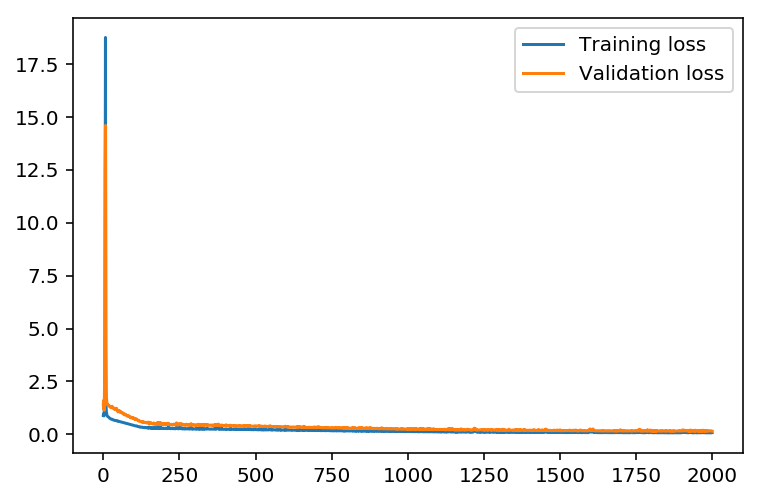

In [13]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## 检查预测结果

使用测试数据看看网络对数据建模的效果如何。如果完全错了，请确保网络中的每步都正确实现。

C:\Users\KevinRuan\AppData\Local\conda\conda\envs\flappybird\lib\site-packages\ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


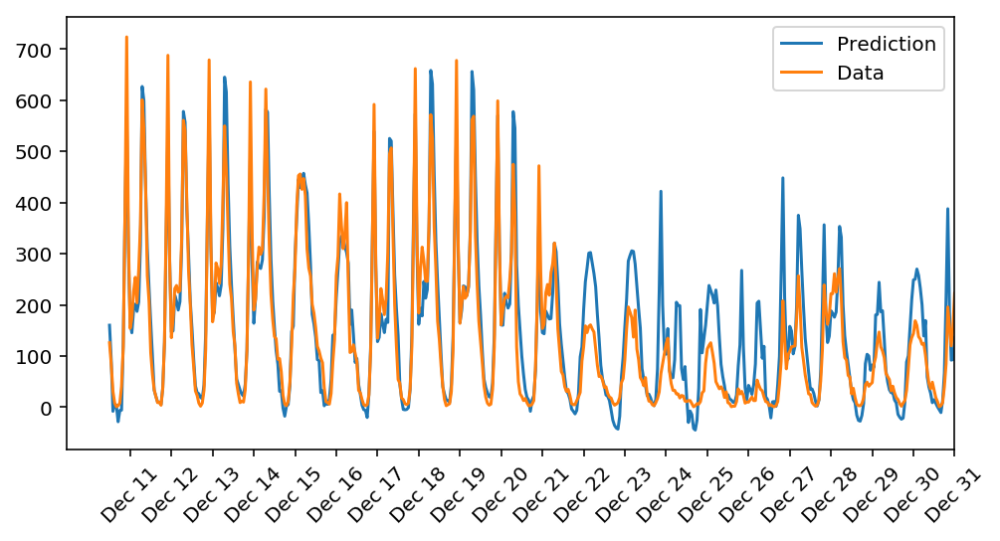

In [14]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## 可选：思考下你的结果（我们不会评估这道题的答案）

 
请针对你的结果回答以下问题。模型对数据的预测效果如何？哪里出现问题了？为何出现问题呢？

> **注意**：你可以通过双击该单元编辑文本。如果想要预览文本，请按 Control + Enter

#### 请将你的答案填写在下方
设置迭代次数为2000，learn_rate = 1, hidden_node节点数为13时，训练误差为0.078，验证误差为0.152，均在0.2以下，模型对数据的预测很好。

原来迭代次数为100，迭代次数太低，无法收敛。
原来隐藏层的节点数为2，无法收敛。
原来的学习率为0.1，除以128后，仅为0.001左右，收敛太慢。
通过反复调整迭代次数，隐藏层的节点数和学习率，使得模型得到优化，满足要求。